# # Rock vs Mine Prediction

In [1]:
import pandas as pd
import numpy as np

In [2]:
#loading the dataset to a pandas Dataframe
dataset = pd.read_csv('sonar.all-data.csv', header=None)
dataset

,0,1,2,3,4,5,6,7,8,9,...,51,52,53,54,55,56,57,58,59,60
0,0.0200,0.0371,0.0428,0.0207,0.0954,0.0986,0.1539,0.1601,0.3109,0.2111,...,0.0027,0.0065,0.0159,0.0072,0.0167,0.0180,0.0084,0.0090,0.0032,R
1,0.0453,0.0523,0.0843,0.0689,0.1183,0.2583,0.2156,0.3481,0.3337,0.2872,...,0.0084,0.0089,0.0048,0.0094,0.0191,0.0140,0.0049,0.0052,0.0044,R
2,0.0262,0.0582,0.1099,0.1083,0.0974,0.2280,0.2431,0.3771,0.5598,0.6194,...,0.0232,0.0166,0.0095,0.0180,0.0244,0.0316,0.0164,0.0095,0.0078,R
3,0.0100,0.0171,0.0623,0.0205,0.0205,0.0368,0.1098,0.1276,0.0598,0.1264,...,0.0121,0.0036,0.0150,0.0085,0.0073,0.0050,0.0044,0.0040,0.0117,R
4,0.0762,0.0666,0.0481,0.0394,0.0590,0.0649,0.1209,0.2467,0.3564,0.4459,...,0.0031,0.0054,0.0105,0.0110,0.0015,0.0072,0.0048,0.0107,0.0094,R
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
203,0.0187,0.0346,0.0168,0.0177,0.0393,0.1630,0.2028,0.1694,0.2328,0.2684,...,0.0116,0.0098,0.0199,0.0033,0.0101,0.0065,0.0115,0.0193,0.0157,M
204,0.0323,0.0101,0.0298,0.0564,0.0760,0.0958,0.0990,0.1018,0.1030,0.2154,...,0.0061,0.0093,0.0135,0.0063,0.0063,0.0034,0.0032,0.0062,0.0067,M
205,0.0522,0.0437,0.0180,0.0292,0.0351,0.1171,0.1257,0.1178,0.1258,0.2529,...,0.0160,0.0029,0.0051,0.0062,0.0089,0.0140,0.0138,0.0077,0.0031,M
206,0.0303,0.0353,0.0490,0.0608,0.0167,0.1354,0.1465,0.1123,0.1945,0.2354,...,0.0086,0.0046,0.0126,0.0036,0.0035,0.0034,0.0079,0.0036,0.0048,M


In [3]:
dataset.shape # check rows an column

(208, 61)

In [4]:
dataset.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 208 entries, 0 to 207
Data columns (total 61 columns):
 #   Column  Non-Null Count  Dtype  
---  ------  --------------  -----  
 0   0       208 non-null    float64
 1   1       208 non-null    float64
 2   2       208 non-null    float64
 3   3       208 non-null    float64
 4   4       208 non-null    float64
 5   5       208 non-null    float64
 6   6       208 non-null    float64
 7   7       208 non-null    float64
 8   8       208 non-null    float64
 9   9       208 non-null    float64
 10  10      208 non-null    float64
 11  11      208 non-null    float64
 12  12      208 non-null    float64
 13  13      208 non-null    float64
 14  14      208 non-null    float64
 15  15      208 non-null    float64
 16  16      208 non-null    float64
 17  17      208 non-null    float64
 18  18      208 non-null    float64
 19  19      208 non-null    float64
 20  20      208 non-null    float64
 21  21      208 non-null    float64
 22  22

In [5]:
dataset[60].value_counts()

M    111
R     97
Name: 60, dtype: int64

In [6]:
print('Missing values in Train data','\n',dataset.isnull().sum()) # checking the null value

Missing values in Train data 
 0     0
1     0
2     0
3     0
4     0
     ..
56    0
57    0
58    0
59    0
60    0
Length: 61, dtype: int64


In [7]:
import matplotlib.pyplot as plt # Visualizing dataset

In [8]:
dataset.describe()

,0,1,2,3,4,5,6,7,8,9,...,50,51,52,53,54,55,56,57,58,59
count,208.000000,208.000000,208.000000,208.000000,208.000000,208.000000,208.000000,208.000000,208.000000,208.000000,...,208.000000,208.000000,208.000000,208.000000,208.000000,208.000000,208.000000,208.000000,208.000000,208.000000
mean,0.029164,0.038437,0.043832,0.053892,0.075202,0.104570,0.121747,0.134799,0.178003,0.208259,...,0.016069,0.013420,0.010709,0.010941,0.009290,0.008222,0.007820,0.007949,0.007941,0.006507
std,0.022991,0.032960,0.038428,0.046528,0.055552,0.059105,0.061788,0.085152,0.118387,0.134416,...,0.012008,0.009634,0.007060,0.007301,0.007088,0.005736,0.005785,0.006470,0.006181,0.005031
min,0.001500,0.000600,0.001500,0.005800,0.006700,0.010200,0.003300,0.005500,0.007500,0.011300,...,0.000000,0.000800,0.000500,0.001000,0.000600,0.000400,0.000300,0.000300,0.000100,0.000600
25%,0.013350,0.016450,0.018950,0.024375,0.038050,0.067025,0.080900,0.080425,0.097025,0.111275,...,0.008425,0.007275,0.005075,0.005375,0.004150,0.004400,0.003700,0.003600,0.003675,0.003100
50%,0.022800,0.030800,0.034300,0.044050,0.062500,0.092150,0.106950,0.112100,0.152250,0.182400,...,0.013900,0.011400,0.009550,0.009300,0.007500,0.006850,0.005950,0.005800,0.006400,0.005300
75%,0.035550,0.047950,0.057950,0.064500,0.100275,0.134125,0.154000,0.169600,0.233425,0.268700,...,0.020825,0.016725,0.014900,0.014500,0.012100,0.010575,0.010425,0.010350,0.010325,0.008525
max,0.137100,0.233900,0.305900,0.426400,0.401000,0.382300,0.372900,0.459000,0.682800,0.710600,...,0.100400,0.070900,0.039000,0.035200,0.044700,0.039400,0.035500,0.044000,0.036400,0.043900


In [9]:
dataset.groupby(60).mean()

,0,1,2,3,4,5,6,7,8,9,...,50,51,52,53,54,55,56,57,58,59
60,,,,,,,,,,,,,,,,,,,,,
M,0.034989,0.045544,0.050720,0.064768,0.086715,0.111864,0.128359,0.149832,0.213492,0.251022,...,0.019352,0.016014,0.011643,0.012185,0.009923,0.008914,0.007825,0.009060,0.008695,0.006930
R,0.022498,0.030303,0.035951,0.041447,0.062028,0.096224,0.114180,0.117596,0.137392,0.159325,...,0.012311,0.010453,0.009640,0.009518,0.008567,0.007430,0.007814,0.006677,0.007078,0.006024


In [10]:
dataset[60] = dataset[60].map({'M':1,'R':0}) 

In [11]:
# Rename the column 60
dataset.rename(columns={60 : 'Target'}, inplace=True) 

In [12]:
X=dataset.iloc[:,:-1].values # Separating label and feature

In [13]:
X

array([[0.02  , 0.0371, 0.0428, ..., 0.0084, 0.009 , 0.0032],
       [0.0453, 0.0523, 0.0843, ..., 0.0049, 0.0052, 0.0044],
       [0.0262, 0.0582, 0.1099, ..., 0.0164, 0.0095, 0.0078],
       ...,
       [0.0522, 0.0437, 0.018 , ..., 0.0138, 0.0077, 0.0031],
       [0.0303, 0.0353, 0.049 , ..., 0.0079, 0.0036, 0.0048],
       [0.026 , 0.0363, 0.0136, ..., 0.0036, 0.0061, 0.0115]])

In [14]:
y=dataset.iloc[:,-1]


In [15]:
y

0      0
1      0
2      0
3      0
4      0
      ..
203    1
204    1
205    1
206    1
207    1
Name: Target, Length: 208, dtype: int64

/home/aj/anaconda3/lib/python3.7/site-packages/pandas/core/ops/array_ops.py:253: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  res_values = method(rvalues)


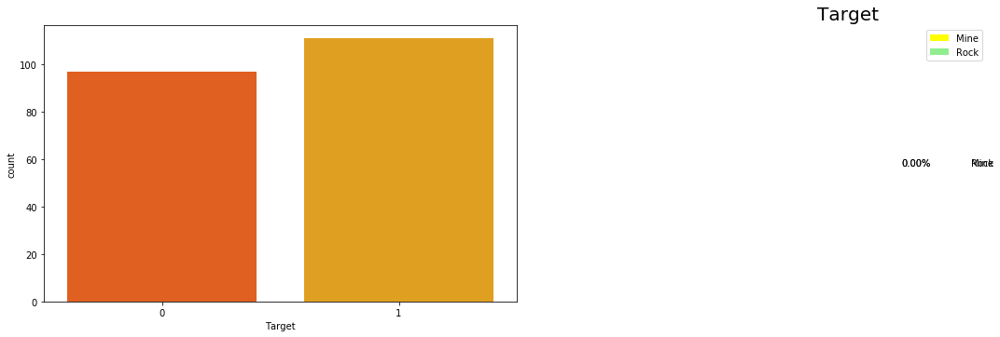

In [16]:
import seaborn as  sns
plt.figure(figsize=(20,12))

plt.subplot(2,2,1)
sns.countplot(x='Target', data=dataset, palette='autumn')

plt.subplot(2,2,2)
Mine = dataset.Target[dataset.Target == 'M'].count()
Rock = dataset.Target[dataset.Target == 'R'].count()
plt.title("Target", {"fontsize":20})
plt.pie([Mine, Rock], labels=['Mine', 'Rock'], explode=[0.01,0.01], autopct='%.2f%%', colors=['yellow', 'lightgreen'])
plt.legend()
plt.show()

# # Model prediction
Algorithms used:

Logistic Regression
Decision Tree Classifier
Random Forest Classifier
GBM Classifier
XGBoost Classifier
Light GBM classifier
Catboost classifier
KNN Classifier
Support Vector Classifier (Linear SVM, Kernal SVM)
Naive Bayes Classifier

In [17]:
from sklearn.model_selection import train_test_split,GridSearchCV, KFold, cross_val_score
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=0)

In [43]:
from sklearn.linear_model import LogisticRegression
from sklearn.linear_model import LogisticRegression
from sklearn.tree import DecisionTreeClassifier,ExtraTreeClassifier
from sklearn.ensemble import AdaBoostClassifier,BaggingClassifier,GradientBoostingClassifier,RandomForestClassifier
from sklearn.svm import SVC
from xgboost import XGBClassifier
from sklearn.neighbors import KNeighborsClassifier
from sklearn.naive_bayes import GaussianNB
from lightgbm import LGBMClassifier
from catboost import CatBoostClassifier
from sklearn.ensemble import VotingClassifier
from sklearn.metrics import classification_report,accuracy_score,roc_auc_score,confusion_matrix
from sklearn import model_selection
from sklearn.discriminant_analysis import LinearDiscriminantAnalysis


In [19]:
seed=10
#preparing models
models=[]

models.append(('Logistic Regression',LogisticRegression()))
models.append(('Decision Tree Classifier',DecisionTreeClassifier()))
models.append(('Random Forest Classifier',RandomForestClassifier()))
models.append(('LDA', LinearDiscriminantAnalysis()))
models.append(('XGBoost Classifier',XGBClassifier()))
models.append(('Light GBM classifier',LGBMClassifier()))
models.append(('Catboost classifier',CatBoostClassifier()))
models.append(('KNN Classifier',KNeighborsClassifier()))
models.append(('Support Vector Classifier',SVC()))
models.append(('Naive Bayes Classifier',GaussianNB()))
models.append

result=[]
names=[]
scoring='accuracy'
for name,model in models:
    kfold=KFold(n_splits=10)
    cv_results=cross_val_score(model,X_train,y_train,cv=kfold,scoring=scoring)
    result.append(cv_results)
    names.append(name)
    msg = "%s: %f (%f)" % (name, cv_results.mean(), cv_results.std())
    print(msg)

Logistic Regression: 0.741176 (0.076559)
Decision Tree Classifier: 0.706250 (0.089655)
Random Forest Classifier: 0.788971 (0.040515)
LDA: 0.697794 (0.091703)
XGBoost Classifier: 0.813235 (0.093657)
Light GBM classifier: 0.837500 (0.093136)
Learning rate set to 0.00457
0:	learn: 0.6905004	total: 76.5ms	remaining: 1m 16s
1:	learn: 0.6874045	total: 89.7ms	remaining: 44.8s
2:	learn: 0.6843485	total: 97.8ms	remaining: 32.5s
3:	learn: 0.6807126	total: 104ms	remaining: 25.9s
4:	learn: 0.6777012	total: 115ms	remaining: 23s
5:	learn: 0.6750607	total: 123ms	remaining: 20.3s
6:	learn: 0.6711251	total: 132ms	remaining: 18.7s
7:	learn: 0.6678342	total: 141ms	remaining: 17.5s
8:	learn: 0.6630580	total: 147ms	remaining: 16.2s
9:	learn: 0.6594354	total: 153ms	remaining: 15.1s
10:	learn: 0.6571483	total: 159ms	remaining: 14.3s
11:	learn: 0.6548656	total: 164ms	remaining: 13.5s
12:	learn: 0.6513641	total: 170ms	remaining: 12.9s
13:	learn: 0.6481311	total: 176ms	remaining: 12.4s
14:	learn: 0.6450650	tota

187:	learn: 0.3351824	total: 1.26s	remaining: 5.46s
188:	learn: 0.3340035	total: 1.27s	remaining: 5.45s
189:	learn: 0.3322705	total: 1.28s	remaining: 5.47s
190:	learn: 0.3311710	total: 1.29s	remaining: 5.46s
191:	learn: 0.3301825	total: 1.3s	remaining: 5.46s
192:	learn: 0.3291854	total: 1.3s	remaining: 5.46s
193:	learn: 0.3278358	total: 1.31s	remaining: 5.46s
194:	learn: 0.3270887	total: 1.32s	remaining: 5.47s
195:	learn: 0.3260403	total: 1.33s	remaining: 5.47s
196:	learn: 0.3249490	total: 1.34s	remaining: 5.46s
197:	learn: 0.3236859	total: 1.35s	remaining: 5.45s
198:	learn: 0.3225800	total: 1.35s	remaining: 5.44s
199:	learn: 0.3216992	total: 1.36s	remaining: 5.43s
200:	learn: 0.3206279	total: 1.36s	remaining: 5.42s
201:	learn: 0.3196393	total: 1.37s	remaining: 5.41s
202:	learn: 0.3187042	total: 1.38s	remaining: 5.4s
203:	learn: 0.3175719	total: 1.38s	remaining: 5.39s
204:	learn: 0.3167179	total: 1.39s	remaining: 5.38s
205:	learn: 0.3157082	total: 1.39s	remaining: 5.36s
206:	learn: 0.3

374:	learn: 0.1985550	total: 2.42s	remaining: 4.03s
375:	learn: 0.1979955	total: 2.42s	remaining: 4.02s
376:	learn: 0.1976253	total: 2.43s	remaining: 4.01s
377:	learn: 0.1970750	total: 2.44s	remaining: 4.01s
378:	learn: 0.1965944	total: 2.45s	remaining: 4.01s
379:	learn: 0.1959938	total: 2.45s	remaining: 4s
380:	learn: 0.1954803	total: 2.46s	remaining: 4s
381:	learn: 0.1950287	total: 2.46s	remaining: 3.99s
382:	learn: 0.1945133	total: 2.47s	remaining: 3.98s
383:	learn: 0.1941264	total: 2.48s	remaining: 3.97s
384:	learn: 0.1935828	total: 2.48s	remaining: 3.96s
385:	learn: 0.1931834	total: 2.49s	remaining: 3.96s
386:	learn: 0.1928764	total: 2.49s	remaining: 3.95s
387:	learn: 0.1924974	total: 2.5s	remaining: 3.94s
388:	learn: 0.1920719	total: 2.5s	remaining: 3.94s
389:	learn: 0.1916624	total: 2.51s	remaining: 3.93s
390:	learn: 0.1911927	total: 2.52s	remaining: 3.92s
391:	learn: 0.1907538	total: 2.52s	remaining: 3.91s
392:	learn: 0.1903771	total: 2.53s	remaining: 3.9s
393:	learn: 0.1900753

561:	learn: 0.1310290	total: 3.58s	remaining: 2.79s
562:	learn: 0.1307561	total: 3.58s	remaining: 2.78s
563:	learn: 0.1305501	total: 3.59s	remaining: 2.78s
564:	learn: 0.1302845	total: 3.6s	remaining: 2.77s
565:	learn: 0.1300903	total: 3.61s	remaining: 2.77s
566:	learn: 0.1298846	total: 3.62s	remaining: 2.76s
567:	learn: 0.1297109	total: 3.62s	remaining: 2.75s
568:	learn: 0.1294729	total: 3.63s	remaining: 2.75s
569:	learn: 0.1292130	total: 3.63s	remaining: 2.74s
570:	learn: 0.1289044	total: 3.64s	remaining: 2.73s
571:	learn: 0.1285459	total: 3.64s	remaining: 2.73s
572:	learn: 0.1282070	total: 3.65s	remaining: 2.72s
573:	learn: 0.1279725	total: 3.65s	remaining: 2.71s
574:	learn: 0.1277907	total: 3.66s	remaining: 2.71s
575:	learn: 0.1275124	total: 3.67s	remaining: 2.7s
576:	learn: 0.1271975	total: 3.67s	remaining: 2.69s
577:	learn: 0.1269503	total: 3.68s	remaining: 2.69s
578:	learn: 0.1267611	total: 3.68s	remaining: 2.68s
579:	learn: 0.1264334	total: 3.69s	remaining: 2.67s
580:	learn: 0.

746:	learn: 0.0934926	total: 4.73s	remaining: 1.6s
747:	learn: 0.0933489	total: 4.74s	remaining: 1.6s
748:	learn: 0.0932011	total: 4.74s	remaining: 1.59s
749:	learn: 0.0929229	total: 4.75s	remaining: 1.58s
750:	learn: 0.0927294	total: 4.77s	remaining: 1.58s
751:	learn: 0.0926136	total: 4.78s	remaining: 1.57s
752:	learn: 0.0924636	total: 4.79s	remaining: 1.57s
753:	learn: 0.0923358	total: 4.79s	remaining: 1.56s
754:	learn: 0.0921510	total: 4.8s	remaining: 1.56s
755:	learn: 0.0919956	total: 4.8s	remaining: 1.55s
756:	learn: 0.0917782	total: 4.81s	remaining: 1.54s
757:	learn: 0.0915857	total: 4.81s	remaining: 1.54s
758:	learn: 0.0913895	total: 4.82s	remaining: 1.53s
759:	learn: 0.0912619	total: 4.83s	remaining: 1.52s
760:	learn: 0.0910506	total: 4.83s	remaining: 1.52s
761:	learn: 0.0908962	total: 4.84s	remaining: 1.51s
762:	learn: 0.0907424	total: 4.84s	remaining: 1.5s
763:	learn: 0.0905472	total: 4.85s	remaining: 1.5s
764:	learn: 0.0904641	total: 4.85s	remaining: 1.49s
765:	learn: 0.0903

934:	learn: 0.0675695	total: 5.88s	remaining: 409ms
935:	learn: 0.0674355	total: 5.89s	remaining: 403ms
936:	learn: 0.0673614	total: 5.89s	remaining: 396ms
937:	learn: 0.0672149	total: 5.9s	remaining: 390ms
938:	learn: 0.0670973	total: 5.91s	remaining: 384ms
939:	learn: 0.0670114	total: 5.92s	remaining: 378ms
940:	learn: 0.0669036	total: 5.92s	remaining: 371ms
941:	learn: 0.0667911	total: 5.93s	remaining: 365ms
942:	learn: 0.0666923	total: 5.93s	remaining: 359ms
943:	learn: 0.0665829	total: 5.94s	remaining: 352ms
944:	learn: 0.0664572	total: 5.95s	remaining: 346ms
945:	learn: 0.0663473	total: 5.95s	remaining: 340ms
946:	learn: 0.0662334	total: 5.96s	remaining: 333ms
947:	learn: 0.0661303	total: 5.96s	remaining: 327ms
948:	learn: 0.0660306	total: 5.97s	remaining: 321ms
949:	learn: 0.0659147	total: 5.97s	remaining: 314ms
950:	learn: 0.0658044	total: 5.98s	remaining: 308ms
951:	learn: 0.0656608	total: 5.99s	remaining: 302ms
952:	learn: 0.0655236	total: 5.99s	remaining: 295ms
953:	learn: 0

113:	learn: 0.4313812	total: 767ms	remaining: 5.96s
114:	learn: 0.4302483	total: 777ms	remaining: 5.98s
115:	learn: 0.4288937	total: 785ms	remaining: 5.99s
116:	learn: 0.4273019	total: 792ms	remaining: 5.97s
117:	learn: 0.4254202	total: 797ms	remaining: 5.96s
118:	learn: 0.4241330	total: 805ms	remaining: 5.96s
119:	learn: 0.4223935	total: 812ms	remaining: 5.95s
120:	learn: 0.4212648	total: 818ms	remaining: 5.94s
121:	learn: 0.4198962	total: 824ms	remaining: 5.93s
122:	learn: 0.4188666	total: 829ms	remaining: 5.91s
123:	learn: 0.4170420	total: 835ms	remaining: 5.9s
124:	learn: 0.4157797	total: 841ms	remaining: 5.89s
125:	learn: 0.4144168	total: 847ms	remaining: 5.87s
126:	learn: 0.4134720	total: 852ms	remaining: 5.86s
127:	learn: 0.4121396	total: 858ms	remaining: 5.84s
128:	learn: 0.4105864	total: 863ms	remaining: 5.83s
129:	learn: 0.4090854	total: 869ms	remaining: 5.81s
130:	learn: 0.4076809	total: 874ms	remaining: 5.8s
131:	learn: 0.4063089	total: 880ms	remaining: 5.79s
132:	learn: 0.

304:	learn: 0.2365209	total: 1.93s	remaining: 4.39s
305:	learn: 0.2358203	total: 1.94s	remaining: 4.39s
306:	learn: 0.2355075	total: 1.94s	remaining: 4.39s
307:	learn: 0.2346961	total: 1.95s	remaining: 4.38s
308:	learn: 0.2340593	total: 1.96s	remaining: 4.38s
309:	learn: 0.2335139	total: 1.96s	remaining: 4.37s
310:	learn: 0.2329017	total: 1.97s	remaining: 4.36s
311:	learn: 0.2323173	total: 1.97s	remaining: 4.36s
312:	learn: 0.2315227	total: 1.98s	remaining: 4.35s
313:	learn: 0.2308537	total: 1.99s	remaining: 4.34s
314:	learn: 0.2303332	total: 1.99s	remaining: 4.33s
315:	learn: 0.2297290	total: 2s	remaining: 4.32s
316:	learn: 0.2288888	total: 2s	remaining: 4.32s
317:	learn: 0.2285694	total: 2.01s	remaining: 4.31s
318:	learn: 0.2278734	total: 2.01s	remaining: 4.3s
319:	learn: 0.2272831	total: 2.02s	remaining: 4.29s
320:	learn: 0.2267673	total: 2.02s	remaining: 4.29s
321:	learn: 0.2261972	total: 2.03s	remaining: 4.28s
322:	learn: 0.2255285	total: 2.04s	remaining: 4.27s
323:	learn: 0.22503

493:	learn: 0.1507329	total: 3.08s	remaining: 3.15s
494:	learn: 0.1503547	total: 3.08s	remaining: 3.15s
495:	learn: 0.1499944	total: 3.09s	remaining: 3.14s
496:	learn: 0.1496793	total: 3.1s	remaining: 3.14s
497:	learn: 0.1494108	total: 3.11s	remaining: 3.14s
498:	learn: 0.1491335	total: 3.12s	remaining: 3.13s
499:	learn: 0.1488023	total: 3.13s	remaining: 3.13s
500:	learn: 0.1484817	total: 3.13s	remaining: 3.12s
501:	learn: 0.1482073	total: 3.14s	remaining: 3.11s
502:	learn: 0.1479069	total: 3.14s	remaining: 3.1s
503:	learn: 0.1476100	total: 3.15s	remaining: 3.1s
504:	learn: 0.1473402	total: 3.15s	remaining: 3.09s
505:	learn: 0.1470136	total: 3.16s	remaining: 3.08s
506:	learn: 0.1467104	total: 3.17s	remaining: 3.08s
507:	learn: 0.1463378	total: 3.17s	remaining: 3.07s
508:	learn: 0.1460258	total: 3.18s	remaining: 3.06s
509:	learn: 0.1456364	total: 3.18s	remaining: 3.06s
510:	learn: 0.1455123	total: 3.19s	remaining: 3.05s
511:	learn: 0.1452690	total: 3.19s	remaining: 3.04s
512:	learn: 0.1

652:	learn: 0.1087715	total: 4.04s	remaining: 2.14s
653:	learn: 0.1085916	total: 4.04s	remaining: 2.14s
654:	learn: 0.1083793	total: 4.05s	remaining: 2.13s
655:	learn: 0.1082498	total: 4.06s	remaining: 2.13s
656:	learn: 0.1080132	total: 4.06s	remaining: 2.12s
657:	learn: 0.1077859	total: 4.07s	remaining: 2.12s
658:	learn: 0.1076143	total: 4.08s	remaining: 2.11s
659:	learn: 0.1074444	total: 4.09s	remaining: 2.11s
660:	learn: 0.1072905	total: 4.1s	remaining: 2.1s
661:	learn: 0.1070735	total: 4.1s	remaining: 2.1s
662:	learn: 0.1068564	total: 4.11s	remaining: 2.09s
663:	learn: 0.1067069	total: 4.11s	remaining: 2.08s
664:	learn: 0.1064852	total: 4.12s	remaining: 2.08s
665:	learn: 0.1062777	total: 4.13s	remaining: 2.07s
666:	learn: 0.1060324	total: 4.13s	remaining: 2.06s
667:	learn: 0.1057971	total: 4.14s	remaining: 2.06s
668:	learn: 0.1056505	total: 4.14s	remaining: 2.05s
669:	learn: 0.1054179	total: 4.15s	remaining: 2.04s
670:	learn: 0.1052023	total: 4.15s	remaining: 2.04s
671:	learn: 0.10

840:	learn: 0.0786350	total: 5.19s	remaining: 981ms
841:	learn: 0.0784773	total: 5.19s	remaining: 975ms
842:	learn: 0.0783003	total: 5.2s	remaining: 969ms
843:	learn: 0.0781749	total: 5.21s	remaining: 963ms
844:	learn: 0.0780592	total: 5.21s	remaining: 956ms
845:	learn: 0.0779590	total: 5.22s	remaining: 951ms
846:	learn: 0.0778496	total: 5.23s	remaining: 944ms
847:	learn: 0.0777115	total: 5.23s	remaining: 938ms
848:	learn: 0.0776182	total: 5.24s	remaining: 932ms
849:	learn: 0.0775530	total: 5.25s	remaining: 926ms
850:	learn: 0.0773938	total: 5.25s	remaining: 920ms
851:	learn: 0.0772891	total: 5.26s	remaining: 913ms
852:	learn: 0.0771910	total: 5.26s	remaining: 907ms
853:	learn: 0.0770511	total: 5.27s	remaining: 901ms
854:	learn: 0.0769740	total: 5.27s	remaining: 895ms
855:	learn: 0.0768500	total: 5.28s	remaining: 888ms
856:	learn: 0.0766954	total: 5.29s	remaining: 882ms
857:	learn: 0.0765794	total: 5.29s	remaining: 876ms
858:	learn: 0.0764558	total: 5.3s	remaining: 869ms
859:	learn: 0.

998:	learn: 0.0607677	total: 6.14s	remaining: 6.15ms
999:	learn: 0.0606318	total: 6.15s	remaining: 0us
Learning rate set to 0.00457
0:	learn: 0.6904226	total: 16.6ms	remaining: 16.6s
1:	learn: 0.6883686	total: 29.9ms	remaining: 14.9s
2:	learn: 0.6851430	total: 45.5ms	remaining: 15.1s
3:	learn: 0.6824763	total: 64.1ms	remaining: 16s
4:	learn: 0.6789470	total: 83.6ms	remaining: 16.6s
5:	learn: 0.6769960	total: 94.9ms	remaining: 15.7s
6:	learn: 0.6733238	total: 102ms	remaining: 14.5s
7:	learn: 0.6696558	total: 109ms	remaining: 13.5s
8:	learn: 0.6661961	total: 115ms	remaining: 12.7s
9:	learn: 0.6629834	total: 121ms	remaining: 12s
10:	learn: 0.6603966	total: 126ms	remaining: 11.4s
11:	learn: 0.6578543	total: 132ms	remaining: 10.9s
12:	learn: 0.6544963	total: 137ms	remaining: 10.4s
13:	learn: 0.6518479	total: 143ms	remaining: 10.1s
14:	learn: 0.6486057	total: 149ms	remaining: 9.78s
15:	learn: 0.6457005	total: 155ms	remaining: 9.51s
16:	learn: 0.6427488	total: 160ms	remaining: 9.27s
17:	learn

188:	learn: 0.3302045	total: 1.2s	remaining: 5.13s
189:	learn: 0.3290934	total: 1.2s	remaining: 5.13s
190:	learn: 0.3278718	total: 1.21s	remaining: 5.13s
191:	learn: 0.3268647	total: 1.23s	remaining: 5.16s
192:	learn: 0.3260675	total: 1.23s	remaining: 5.16s
193:	learn: 0.3247832	total: 1.24s	remaining: 5.17s
194:	learn: 0.3236130	total: 1.25s	remaining: 5.16s
195:	learn: 0.3225772	total: 1.26s	remaining: 5.15s
196:	learn: 0.3219145	total: 1.26s	remaining: 5.14s
197:	learn: 0.3209097	total: 1.27s	remaining: 5.13s
198:	learn: 0.3198260	total: 1.27s	remaining: 5.13s
199:	learn: 0.3189169	total: 1.28s	remaining: 5.12s
200:	learn: 0.3174790	total: 1.28s	remaining: 5.11s
201:	learn: 0.3165968	total: 1.29s	remaining: 5.1s
202:	learn: 0.3156906	total: 1.29s	remaining: 5.09s
203:	learn: 0.3144946	total: 1.3s	remaining: 5.08s
204:	learn: 0.3133501	total: 1.31s	remaining: 5.07s
205:	learn: 0.3126119	total: 1.31s	remaining: 5.06s
206:	learn: 0.3113219	total: 1.32s	remaining: 5.05s
207:	learn: 0.31

376:	learn: 0.1915067	total: 2.35s	remaining: 3.88s
377:	learn: 0.1909073	total: 2.36s	remaining: 3.88s
378:	learn: 0.1904745	total: 2.37s	remaining: 3.88s
379:	learn: 0.1900400	total: 2.37s	remaining: 3.87s
380:	learn: 0.1897083	total: 2.38s	remaining: 3.87s
381:	learn: 0.1892258	total: 2.39s	remaining: 3.86s
382:	learn: 0.1885774	total: 2.39s	remaining: 3.85s
383:	learn: 0.1881780	total: 2.4s	remaining: 3.85s
384:	learn: 0.1876038	total: 2.4s	remaining: 3.84s
385:	learn: 0.1872190	total: 2.41s	remaining: 3.83s
386:	learn: 0.1867840	total: 2.42s	remaining: 3.83s
387:	learn: 0.1863310	total: 2.42s	remaining: 3.82s
388:	learn: 0.1857025	total: 2.43s	remaining: 3.81s
389:	learn: 0.1851824	total: 2.43s	remaining: 3.8s
390:	learn: 0.1848788	total: 2.44s	remaining: 3.8s
391:	learn: 0.1844050	total: 2.44s	remaining: 3.79s
392:	learn: 0.1840453	total: 2.45s	remaining: 3.78s
393:	learn: 0.1837697	total: 2.46s	remaining: 3.78s
394:	learn: 0.1834825	total: 2.46s	remaining: 3.77s
395:	learn: 0.18

566:	learn: 0.1254430	total: 3.5s	remaining: 2.67s
567:	learn: 0.1250863	total: 3.51s	remaining: 2.67s
568:	learn: 0.1247881	total: 3.52s	remaining: 2.66s
569:	learn: 0.1245803	total: 3.52s	remaining: 2.66s
570:	learn: 0.1242783	total: 3.53s	remaining: 2.65s
571:	learn: 0.1240881	total: 3.54s	remaining: 2.65s
572:	learn: 0.1238817	total: 3.54s	remaining: 2.64s
573:	learn: 0.1236412	total: 3.55s	remaining: 2.63s
574:	learn: 0.1233799	total: 3.56s	remaining: 2.63s
575:	learn: 0.1231913	total: 3.56s	remaining: 2.62s
576:	learn: 0.1229177	total: 3.57s	remaining: 2.62s
577:	learn: 0.1226689	total: 3.57s	remaining: 2.61s
578:	learn: 0.1223872	total: 3.58s	remaining: 2.6s
579:	learn: 0.1221296	total: 3.58s	remaining: 2.6s
580:	learn: 0.1219593	total: 3.59s	remaining: 2.59s
581:	learn: 0.1216604	total: 3.6s	remaining: 2.58s
582:	learn: 0.1214256	total: 3.6s	remaining: 2.58s
583:	learn: 0.1211331	total: 3.61s	remaining: 2.57s
584:	learn: 0.1209147	total: 3.61s	remaining: 2.56s
585:	learn: 0.120

754:	learn: 0.0875226	total: 4.65s	remaining: 1.51s
755:	learn: 0.0873892	total: 4.66s	remaining: 1.5s
756:	learn: 0.0872258	total: 4.66s	remaining: 1.5s
757:	learn: 0.0870854	total: 4.67s	remaining: 1.49s
758:	learn: 0.0869233	total: 4.68s	remaining: 1.49s
759:	learn: 0.0868115	total: 4.69s	remaining: 1.48s
760:	learn: 0.0866976	total: 4.7s	remaining: 1.48s
761:	learn: 0.0865481	total: 4.71s	remaining: 1.47s
762:	learn: 0.0864021	total: 4.71s	remaining: 1.46s
763:	learn: 0.0862486	total: 4.72s	remaining: 1.46s
764:	learn: 0.0861148	total: 4.73s	remaining: 1.45s
765:	learn: 0.0859810	total: 4.73s	remaining: 1.45s
766:	learn: 0.0858485	total: 4.74s	remaining: 1.44s
767:	learn: 0.0857161	total: 4.74s	remaining: 1.43s
768:	learn: 0.0855325	total: 4.75s	remaining: 1.43s
769:	learn: 0.0853910	total: 4.76s	remaining: 1.42s
770:	learn: 0.0852370	total: 4.76s	remaining: 1.41s
771:	learn: 0.0850200	total: 4.77s	remaining: 1.41s
772:	learn: 0.0848737	total: 4.77s	remaining: 1.4s
773:	learn: 0.08

931:	learn: 0.0643376	total: 5.8s	remaining: 423ms
932:	learn: 0.0642321	total: 5.8s	remaining: 417ms
933:	learn: 0.0641376	total: 5.81s	remaining: 411ms
934:	learn: 0.0640319	total: 5.82s	remaining: 405ms
935:	learn: 0.0638866	total: 5.82s	remaining: 398ms
936:	learn: 0.0637926	total: 5.84s	remaining: 392ms
937:	learn: 0.0636403	total: 5.84s	remaining: 386ms
938:	learn: 0.0635404	total: 5.85s	remaining: 380ms
939:	learn: 0.0634428	total: 5.86s	remaining: 374ms
940:	learn: 0.0633415	total: 5.86s	remaining: 368ms
941:	learn: 0.0632257	total: 5.87s	remaining: 362ms
942:	learn: 0.0631320	total: 5.88s	remaining: 355ms
943:	learn: 0.0630370	total: 5.88s	remaining: 349ms
944:	learn: 0.0629434	total: 5.89s	remaining: 343ms
945:	learn: 0.0628527	total: 5.9s	remaining: 337ms
946:	learn: 0.0627307	total: 5.91s	remaining: 331ms
947:	learn: 0.0626176	total: 5.92s	remaining: 324ms
948:	learn: 0.0624453	total: 5.92s	remaining: 318ms
949:	learn: 0.0623284	total: 5.93s	remaining: 312ms
950:	learn: 0.0

116:	learn: 0.4409704	total: 766ms	remaining: 5.78s
117:	learn: 0.4395502	total: 777ms	remaining: 5.81s
118:	learn: 0.4381949	total: 790ms	remaining: 5.84s
119:	learn: 0.4365252	total: 796ms	remaining: 5.84s
120:	learn: 0.4354190	total: 802ms	remaining: 5.82s
121:	learn: 0.4337086	total: 807ms	remaining: 5.81s
122:	learn: 0.4323997	total: 813ms	remaining: 5.8s
123:	learn: 0.4307312	total: 819ms	remaining: 5.78s
124:	learn: 0.4293803	total: 825ms	remaining: 5.77s
125:	learn: 0.4277661	total: 830ms	remaining: 5.76s
126:	learn: 0.4267314	total: 836ms	remaining: 5.74s
127:	learn: 0.4250505	total: 841ms	remaining: 5.73s
128:	learn: 0.4234397	total: 847ms	remaining: 5.72s
129:	learn: 0.4214537	total: 852ms	remaining: 5.7s
130:	learn: 0.4199748	total: 858ms	remaining: 5.69s
131:	learn: 0.4184472	total: 864ms	remaining: 5.68s
132:	learn: 0.4167841	total: 869ms	remaining: 5.67s
133:	learn: 0.4152561	total: 875ms	remaining: 5.65s
134:	learn: 0.4139871	total: 881ms	remaining: 5.64s
135:	learn: 0.

301:	learn: 0.2478381	total: 1.9s	remaining: 4.39s
302:	learn: 0.2473055	total: 1.91s	remaining: 4.39s
303:	learn: 0.2464922	total: 1.92s	remaining: 4.38s
304:	learn: 0.2459244	total: 1.92s	remaining: 4.38s
305:	learn: 0.2452073	total: 1.93s	remaining: 4.38s
306:	learn: 0.2444971	total: 1.94s	remaining: 4.37s
307:	learn: 0.2439413	total: 1.94s	remaining: 4.37s
308:	learn: 0.2434438	total: 1.95s	remaining: 4.36s
309:	learn: 0.2426972	total: 1.96s	remaining: 4.35s
310:	learn: 0.2420230	total: 1.96s	remaining: 4.35s
311:	learn: 0.2415997	total: 1.97s	remaining: 4.34s
312:	learn: 0.2411563	total: 1.97s	remaining: 4.33s
313:	learn: 0.2407196	total: 1.98s	remaining: 4.32s
314:	learn: 0.2401868	total: 1.99s	remaining: 4.32s
315:	learn: 0.2395034	total: 1.99s	remaining: 4.31s
316:	learn: 0.2388053	total: 2s	remaining: 4.31s
317:	learn: 0.2382580	total: 2s	remaining: 4.3s
318:	learn: 0.2377231	total: 2.01s	remaining: 4.29s
319:	learn: 0.2371640	total: 2.02s	remaining: 4.29s
320:	learn: 0.236371

484:	learn: 0.1607165	total: 3.04s	remaining: 3.23s
485:	learn: 0.1604941	total: 3.05s	remaining: 3.23s
486:	learn: 0.1601985	total: 3.06s	remaining: 3.22s
487:	learn: 0.1598892	total: 3.06s	remaining: 3.22s
488:	learn: 0.1595876	total: 3.07s	remaining: 3.21s
489:	learn: 0.1593093	total: 3.08s	remaining: 3.21s
490:	learn: 0.1588762	total: 3.09s	remaining: 3.2s
491:	learn: 0.1584351	total: 3.09s	remaining: 3.19s
492:	learn: 0.1581453	total: 3.1s	remaining: 3.19s
493:	learn: 0.1578434	total: 3.1s	remaining: 3.18s
494:	learn: 0.1573326	total: 3.11s	remaining: 3.17s
495:	learn: 0.1570755	total: 3.12s	remaining: 3.17s
496:	learn: 0.1567009	total: 3.12s	remaining: 3.16s
497:	learn: 0.1563029	total: 3.13s	remaining: 3.15s
498:	learn: 0.1559550	total: 3.13s	remaining: 3.15s
499:	learn: 0.1556148	total: 3.14s	remaining: 3.14s
500:	learn: 0.1551905	total: 3.14s	remaining: 3.13s
501:	learn: 0.1549065	total: 3.15s	remaining: 3.12s
502:	learn: 0.1546532	total: 3.15s	remaining: 3.12s
503:	learn: 0.1

671:	learn: 0.1109646	total: 4.19s	remaining: 2.04s
672:	learn: 0.1107696	total: 4.2s	remaining: 2.04s
673:	learn: 0.1106031	total: 4.2s	remaining: 2.03s
674:	learn: 0.1104782	total: 4.21s	remaining: 2.03s
675:	learn: 0.1102805	total: 4.22s	remaining: 2.02s
676:	learn: 0.1100779	total: 4.23s	remaining: 2.02s
677:	learn: 0.1098957	total: 4.24s	remaining: 2.01s
678:	learn: 0.1096788	total: 4.24s	remaining: 2.01s
679:	learn: 0.1094061	total: 4.25s	remaining: 2s
680:	learn: 0.1092434	total: 4.25s	remaining: 1.99s
681:	learn: 0.1090168	total: 4.26s	remaining: 1.99s
682:	learn: 0.1088358	total: 4.27s	remaining: 1.98s
683:	learn: 0.1086275	total: 4.27s	remaining: 1.97s
684:	learn: 0.1084831	total: 4.28s	remaining: 1.97s
685:	learn: 0.1082945	total: 4.28s	remaining: 1.96s
686:	learn: 0.1080556	total: 4.29s	remaining: 1.95s
687:	learn: 0.1078679	total: 4.29s	remaining: 1.95s
688:	learn: 0.1076208	total: 4.3s	remaining: 1.94s
689:	learn: 0.1073344	total: 4.31s	remaining: 1.94s
690:	learn: 0.1071

853:	learn: 0.0814228	total: 5.34s	remaining: 914ms
854:	learn: 0.0813071	total: 5.35s	remaining: 908ms
855:	learn: 0.0811411	total: 5.36s	remaining: 901ms
856:	learn: 0.0809661	total: 5.37s	remaining: 896ms
857:	learn: 0.0808449	total: 5.39s	remaining: 893ms
858:	learn: 0.0806787	total: 5.4s	remaining: 887ms
859:	learn: 0.0805847	total: 5.41s	remaining: 881ms
860:	learn: 0.0804347	total: 5.42s	remaining: 874ms
861:	learn: 0.0802801	total: 5.42s	remaining: 868ms
862:	learn: 0.0801592	total: 5.43s	remaining: 862ms
863:	learn: 0.0800329	total: 5.43s	remaining: 855ms
864:	learn: 0.0799123	total: 5.44s	remaining: 849ms
865:	learn: 0.0797610	total: 5.45s	remaining: 843ms
866:	learn: 0.0796286	total: 5.45s	remaining: 836ms
867:	learn: 0.0794886	total: 5.46s	remaining: 830ms
868:	learn: 0.0793975	total: 5.46s	remaining: 823ms
869:	learn: 0.0792824	total: 5.47s	remaining: 817ms
870:	learn: 0.0791135	total: 5.47s	remaining: 811ms
871:	learn: 0.0789792	total: 5.48s	remaining: 804ms
872:	learn: 0

15:	learn: 0.6483751	total: 184ms	remaining: 11.3s
16:	learn: 0.6448349	total: 190ms	remaining: 11s
17:	learn: 0.6418056	total: 195ms	remaining: 10.7s
18:	learn: 0.6397098	total: 201ms	remaining: 10.4s
19:	learn: 0.6362147	total: 207ms	remaining: 10.1s
20:	learn: 0.6328497	total: 212ms	remaining: 9.88s
21:	learn: 0.6302936	total: 218ms	remaining: 9.68s
22:	learn: 0.6277215	total: 223ms	remaining: 9.49s
23:	learn: 0.6250020	total: 229ms	remaining: 9.32s
24:	learn: 0.6221759	total: 235ms	remaining: 9.16s
25:	learn: 0.6193506	total: 241ms	remaining: 9.02s
26:	learn: 0.6167166	total: 246ms	remaining: 8.88s
27:	learn: 0.6143107	total: 252ms	remaining: 8.76s
28:	learn: 0.6116010	total: 258ms	remaining: 8.63s
29:	learn: 0.6090573	total: 264ms	remaining: 8.54s
30:	learn: 0.6070999	total: 271ms	remaining: 8.46s
31:	learn: 0.6043975	total: 277ms	remaining: 8.39s
32:	learn: 0.6010678	total: 283ms	remaining: 8.29s
33:	learn: 0.5987787	total: 289ms	remaining: 8.2s
34:	learn: 0.5956790	total: 294ms	

179:	learn: 0.3528912	total: 1.32s	remaining: 6.03s
180:	learn: 0.3517431	total: 1.33s	remaining: 6.03s
181:	learn: 0.3509227	total: 1.34s	remaining: 6.02s
182:	learn: 0.3498370	total: 1.35s	remaining: 6.01s
183:	learn: 0.3485315	total: 1.35s	remaining: 6.01s
184:	learn: 0.3475607	total: 1.36s	remaining: 6.01s
185:	learn: 0.3464740	total: 1.38s	remaining: 6.02s
186:	learn: 0.3454021	total: 1.4s	remaining: 6.07s
187:	learn: 0.3442557	total: 1.4s	remaining: 6.06s
188:	learn: 0.3432584	total: 1.41s	remaining: 6.05s
189:	learn: 0.3422463	total: 1.42s	remaining: 6.03s
190:	learn: 0.3409352	total: 1.42s	remaining: 6.02s
191:	learn: 0.3396430	total: 1.43s	remaining: 6s
192:	learn: 0.3386549	total: 1.43s	remaining: 5.99s
193:	learn: 0.3374539	total: 1.44s	remaining: 5.97s
194:	learn: 0.3361975	total: 1.44s	remaining: 5.96s
195:	learn: 0.3352989	total: 1.45s	remaining: 5.95s
196:	learn: 0.3342176	total: 1.46s	remaining: 5.93s
197:	learn: 0.3331266	total: 1.46s	remaining: 5.92s
198:	learn: 0.332

353:	learn: 0.2124431	total: 2.67s	remaining: 4.88s
354:	learn: 0.2119049	total: 2.68s	remaining: 4.87s
355:	learn: 0.2114344	total: 2.69s	remaining: 4.87s
356:	learn: 0.2110312	total: 2.7s	remaining: 4.86s
357:	learn: 0.2105363	total: 2.7s	remaining: 4.85s
358:	learn: 0.2100813	total: 2.71s	remaining: 4.85s
359:	learn: 0.2096999	total: 2.73s	remaining: 4.85s
360:	learn: 0.2091084	total: 2.73s	remaining: 4.84s
361:	learn: 0.2086066	total: 2.74s	remaining: 4.83s
362:	learn: 0.2081519	total: 2.75s	remaining: 4.82s
363:	learn: 0.2076817	total: 2.76s	remaining: 4.82s
364:	learn: 0.2074193	total: 2.77s	remaining: 4.82s
365:	learn: 0.2068144	total: 2.78s	remaining: 4.81s
366:	learn: 0.2062638	total: 2.79s	remaining: 4.81s
367:	learn: 0.2059065	total: 2.79s	remaining: 4.8s
368:	learn: 0.2053016	total: 2.8s	remaining: 4.79s
369:	learn: 0.2046724	total: 2.81s	remaining: 4.78s
370:	learn: 0.2042269	total: 2.81s	remaining: 4.77s
371:	learn: 0.2037862	total: 2.82s	remaining: 4.76s
372:	learn: 0.20

513:	learn: 0.1485939	total: 3.81s	remaining: 3.61s
514:	learn: 0.1483192	total: 3.82s	remaining: 3.6s
515:	learn: 0.1480465	total: 3.83s	remaining: 3.59s
516:	learn: 0.1477277	total: 3.84s	remaining: 3.59s
517:	learn: 0.1473980	total: 3.84s	remaining: 3.58s
518:	learn: 0.1470243	total: 3.85s	remaining: 3.57s
519:	learn: 0.1467191	total: 3.86s	remaining: 3.56s
520:	learn: 0.1462535	total: 3.87s	remaining: 3.55s
521:	learn: 0.1459710	total: 3.87s	remaining: 3.55s
522:	learn: 0.1457126	total: 3.88s	remaining: 3.54s
523:	learn: 0.1453075	total: 3.88s	remaining: 3.53s
524:	learn: 0.1451458	total: 3.89s	remaining: 3.52s
525:	learn: 0.1448780	total: 3.9s	remaining: 3.52s
526:	learn: 0.1445734	total: 3.91s	remaining: 3.51s
527:	learn: 0.1442510	total: 3.92s	remaining: 3.5s
528:	learn: 0.1440257	total: 3.92s	remaining: 3.49s
529:	learn: 0.1436831	total: 3.93s	remaining: 3.48s
530:	learn: 0.1432785	total: 3.93s	remaining: 3.47s
531:	learn: 0.1430339	total: 3.94s	remaining: 3.47s
532:	learn: 0.1

688:	learn: 0.1055552	total: 4.97s	remaining: 2.24s
689:	learn: 0.1052879	total: 4.97s	remaining: 2.23s
690:	learn: 0.1050460	total: 4.98s	remaining: 2.23s
691:	learn: 0.1048308	total: 4.99s	remaining: 2.22s
692:	learn: 0.1045920	total: 4.99s	remaining: 2.21s
693:	learn: 0.1043171	total: 5s	remaining: 2.2s
694:	learn: 0.1040972	total: 5.01s	remaining: 2.2s
695:	learn: 0.1039123	total: 5.02s	remaining: 2.19s
696:	learn: 0.1037137	total: 5.02s	remaining: 2.18s
697:	learn: 0.1035206	total: 5.03s	remaining: 2.18s
698:	learn: 0.1033508	total: 5.04s	remaining: 2.17s
699:	learn: 0.1031968	total: 5.04s	remaining: 2.16s
700:	learn: 0.1029909	total: 5.05s	remaining: 2.15s
701:	learn: 0.1027828	total: 5.06s	remaining: 2.15s
702:	learn: 0.1026115	total: 5.07s	remaining: 2.14s
703:	learn: 0.1024366	total: 5.07s	remaining: 2.13s
704:	learn: 0.1021955	total: 5.08s	remaining: 2.13s
705:	learn: 0.1019872	total: 5.08s	remaining: 2.12s
706:	learn: 0.1018485	total: 5.09s	remaining: 2.11s
707:	learn: 0.101

868:	learn: 0.0771512	total: 6.12s	remaining: 923ms
869:	learn: 0.0770333	total: 6.13s	remaining: 915ms
870:	learn: 0.0768961	total: 6.13s	remaining: 908ms
871:	learn: 0.0767732	total: 6.14s	remaining: 901ms
872:	learn: 0.0766510	total: 6.15s	remaining: 894ms
873:	learn: 0.0765505	total: 6.16s	remaining: 887ms
874:	learn: 0.0764419	total: 6.16s	remaining: 880ms
875:	learn: 0.0762897	total: 6.17s	remaining: 874ms
876:	learn: 0.0761260	total: 6.18s	remaining: 866ms
877:	learn: 0.0760162	total: 6.18s	remaining: 859ms
878:	learn: 0.0759419	total: 6.19s	remaining: 852ms
879:	learn: 0.0757686	total: 6.2s	remaining: 845ms
880:	learn: 0.0756249	total: 6.2s	remaining: 838ms
881:	learn: 0.0755113	total: 6.21s	remaining: 831ms
882:	learn: 0.0753644	total: 6.21s	remaining: 823ms
883:	learn: 0.0751836	total: 6.22s	remaining: 816ms
884:	learn: 0.0750833	total: 6.23s	remaining: 809ms
885:	learn: 0.0749638	total: 6.23s	remaining: 802ms
886:	learn: 0.0748321	total: 6.24s	remaining: 795ms
887:	learn: 0.

51:	learn: 0.5531238	total: 377ms	remaining: 6.87s
52:	learn: 0.5506738	total: 387ms	remaining: 6.91s
53:	learn: 0.5483678	total: 394ms	remaining: 6.91s
54:	learn: 0.5461814	total: 403ms	remaining: 6.93s
55:	learn: 0.5433641	total: 410ms	remaining: 6.9s
56:	learn: 0.5408879	total: 421ms	remaining: 6.96s
57:	learn: 0.5385349	total: 427ms	remaining: 6.93s
58:	learn: 0.5364031	total: 433ms	remaining: 6.91s
59:	learn: 0.5337724	total: 439ms	remaining: 6.88s
60:	learn: 0.5313890	total: 445ms	remaining: 6.86s
61:	learn: 0.5290536	total: 451ms	remaining: 6.83s
62:	learn: 0.5271475	total: 458ms	remaining: 6.81s
63:	learn: 0.5253354	total: 464ms	remaining: 6.78s
64:	learn: 0.5224361	total: 469ms	remaining: 6.75s
65:	learn: 0.5203468	total: 476ms	remaining: 6.74s
66:	learn: 0.5180744	total: 481ms	remaining: 6.7s
67:	learn: 0.5159724	total: 488ms	remaining: 6.68s
68:	learn: 0.5139450	total: 494ms	remaining: 6.66s
69:	learn: 0.5122503	total: 500ms	remaining: 6.64s
70:	learn: 0.5099294	total: 505ms

232:	learn: 0.2893964	total: 1.53s	remaining: 5.03s
233:	learn: 0.2885162	total: 1.54s	remaining: 5.03s
234:	learn: 0.2879607	total: 1.54s	remaining: 5.03s
235:	learn: 0.2871974	total: 1.55s	remaining: 5.03s
236:	learn: 0.2861446	total: 1.56s	remaining: 5.02s
237:	learn: 0.2852240	total: 1.57s	remaining: 5.02s
238:	learn: 0.2843906	total: 1.58s	remaining: 5.02s
239:	learn: 0.2833408	total: 1.58s	remaining: 5.01s
240:	learn: 0.2826119	total: 1.59s	remaining: 5s
241:	learn: 0.2820819	total: 1.59s	remaining: 4.99s
242:	learn: 0.2808835	total: 1.6s	remaining: 4.99s
243:	learn: 0.2801098	total: 1.61s	remaining: 4.98s
244:	learn: 0.2796006	total: 1.61s	remaining: 4.97s
245:	learn: 0.2788598	total: 1.62s	remaining: 4.96s
246:	learn: 0.2779415	total: 1.62s	remaining: 4.95s
247:	learn: 0.2771789	total: 1.63s	remaining: 4.94s
248:	learn: 0.2765098	total: 1.64s	remaining: 4.94s
249:	learn: 0.2757121	total: 1.64s	remaining: 4.93s
250:	learn: 0.2747883	total: 1.65s	remaining: 4.92s
251:	learn: 0.27

409:	learn: 0.1793440	total: 2.69s	remaining: 3.87s
410:	learn: 0.1789456	total: 2.69s	remaining: 3.86s
411:	learn: 0.1783872	total: 2.7s	remaining: 3.85s
412:	learn: 0.1777050	total: 2.71s	remaining: 3.85s
413:	learn: 0.1772807	total: 2.71s	remaining: 3.84s
414:	learn: 0.1769735	total: 2.72s	remaining: 3.83s
415:	learn: 0.1766753	total: 2.73s	remaining: 3.83s
416:	learn: 0.1762645	total: 2.74s	remaining: 3.83s
417:	learn: 0.1758829	total: 2.74s	remaining: 3.82s
418:	learn: 0.1753944	total: 2.75s	remaining: 3.81s
419:	learn: 0.1749183	total: 2.76s	remaining: 3.81s
420:	learn: 0.1744158	total: 2.77s	remaining: 3.8s
421:	learn: 0.1739945	total: 2.77s	remaining: 3.8s
422:	learn: 0.1736069	total: 2.78s	remaining: 3.79s
423:	learn: 0.1730084	total: 2.78s	remaining: 3.78s
424:	learn: 0.1724428	total: 2.79s	remaining: 3.77s
425:	learn: 0.1719028	total: 2.8s	remaining: 3.77s
426:	learn: 0.1712940	total: 2.81s	remaining: 3.77s
427:	learn: 0.1708723	total: 2.81s	remaining: 3.76s
428:	learn: 0.17

580:	learn: 0.1226255	total: 3.83s	remaining: 2.76s
581:	learn: 0.1223598	total: 3.84s	remaining: 2.76s
582:	learn: 0.1220796	total: 3.85s	remaining: 2.75s
583:	learn: 0.1218816	total: 3.85s	remaining: 2.75s
584:	learn: 0.1215977	total: 3.87s	remaining: 2.74s
585:	learn: 0.1212869	total: 3.87s	remaining: 2.73s
586:	learn: 0.1210990	total: 3.88s	remaining: 2.73s
587:	learn: 0.1207500	total: 3.89s	remaining: 2.72s
588:	learn: 0.1205285	total: 3.89s	remaining: 2.72s
589:	learn: 0.1203027	total: 3.9s	remaining: 2.71s
590:	learn: 0.1201093	total: 3.91s	remaining: 2.7s
591:	learn: 0.1198337	total: 3.91s	remaining: 2.7s
592:	learn: 0.1196012	total: 3.92s	remaining: 2.69s
593:	learn: 0.1194910	total: 3.92s	remaining: 2.68s
594:	learn: 0.1192954	total: 3.93s	remaining: 2.67s
595:	learn: 0.1190813	total: 3.94s	remaining: 2.67s
596:	learn: 0.1188256	total: 3.94s	remaining: 2.66s
597:	learn: 0.1185843	total: 3.95s	remaining: 2.65s
598:	learn: 0.1183051	total: 3.96s	remaining: 2.65s
599:	learn: 0.1

760:	learn: 0.0883302	total: 4.99s	remaining: 1.56s
761:	learn: 0.0881969	total: 4.99s	remaining: 1.56s
762:	learn: 0.0880614	total: 5s	remaining: 1.55s
763:	learn: 0.0879034	total: 5.01s	remaining: 1.55s
764:	learn: 0.0877508	total: 5.02s	remaining: 1.54s
765:	learn: 0.0875816	total: 5.02s	remaining: 1.53s
766:	learn: 0.0874165	total: 5.03s	remaining: 1.53s
767:	learn: 0.0872432	total: 5.04s	remaining: 1.52s
768:	learn: 0.0871072	total: 5.04s	remaining: 1.51s
769:	learn: 0.0868732	total: 5.05s	remaining: 1.51s
770:	learn: 0.0867440	total: 5.05s	remaining: 1.5s
771:	learn: 0.0865908	total: 5.06s	remaining: 1.5s
772:	learn: 0.0864321	total: 5.07s	remaining: 1.49s
773:	learn: 0.0862651	total: 5.07s	remaining: 1.48s
774:	learn: 0.0861120	total: 5.08s	remaining: 1.47s
775:	learn: 0.0859708	total: 5.08s	remaining: 1.47s
776:	learn: 0.0858049	total: 5.09s	remaining: 1.46s
777:	learn: 0.0856970	total: 5.1s	remaining: 1.45s
778:	learn: 0.0855553	total: 5.1s	remaining: 1.45s
779:	learn: 0.08541

941:	learn: 0.0656175	total: 6.13s	remaining: 378ms
942:	learn: 0.0654776	total: 6.14s	remaining: 371ms
943:	learn: 0.0653380	total: 6.14s	remaining: 365ms
944:	learn: 0.0652324	total: 6.15s	remaining: 358ms
945:	learn: 0.0651299	total: 6.16s	remaining: 352ms
946:	learn: 0.0650297	total: 6.17s	remaining: 345ms
947:	learn: 0.0649293	total: 6.18s	remaining: 339ms
948:	learn: 0.0648228	total: 6.18s	remaining: 332ms
949:	learn: 0.0647167	total: 6.19s	remaining: 326ms
950:	learn: 0.0646228	total: 6.2s	remaining: 319ms
951:	learn: 0.0645076	total: 6.2s	remaining: 313ms
952:	learn: 0.0643742	total: 6.21s	remaining: 306ms
953:	learn: 0.0642682	total: 6.21s	remaining: 300ms
954:	learn: 0.0641989	total: 6.22s	remaining: 293ms
955:	learn: 0.0641027	total: 6.23s	remaining: 287ms
956:	learn: 0.0640237	total: 6.23s	remaining: 280ms
957:	learn: 0.0639276	total: 6.24s	remaining: 274ms
958:	learn: 0.0638537	total: 6.25s	remaining: 267ms
959:	learn: 0.0637481	total: 6.26s	remaining: 261ms
960:	learn: 0.

113:	learn: 0.4358698	total: 774ms	remaining: 6.01s
114:	learn: 0.4345686	total: 781ms	remaining: 6.01s
115:	learn: 0.4326327	total: 788ms	remaining: 6s
116:	learn: 0.4309643	total: 796ms	remaining: 6.01s
117:	learn: 0.4291396	total: 805ms	remaining: 6.01s
118:	learn: 0.4279098	total: 812ms	remaining: 6.01s
119:	learn: 0.4268686	total: 818ms	remaining: 6s
120:	learn: 0.4256602	total: 823ms	remaining: 5.98s
121:	learn: 0.4240527	total: 829ms	remaining: 5.97s
122:	learn: 0.4230363	total: 835ms	remaining: 5.96s
123:	learn: 0.4208775	total: 841ms	remaining: 5.94s
124:	learn: 0.4190421	total: 847ms	remaining: 5.93s
125:	learn: 0.4178435	total: 852ms	remaining: 5.91s
126:	learn: 0.4166063	total: 858ms	remaining: 5.9s
127:	learn: 0.4145521	total: 864ms	remaining: 5.88s
128:	learn: 0.4131799	total: 869ms	remaining: 5.87s
129:	learn: 0.4117762	total: 875ms	remaining: 5.85s
130:	learn: 0.4102383	total: 881ms	remaining: 5.84s
131:	learn: 0.4086120	total: 886ms	remaining: 5.83s
132:	learn: 0.40731

302:	learn: 0.2419597	total: 1.93s	remaining: 4.45s
303:	learn: 0.2411114	total: 1.94s	remaining: 4.44s
304:	learn: 0.2405737	total: 1.95s	remaining: 4.44s
305:	learn: 0.2399551	total: 1.96s	remaining: 4.43s
306:	learn: 0.2395887	total: 1.96s	remaining: 4.43s
307:	learn: 0.2388032	total: 1.97s	remaining: 4.42s
308:	learn: 0.2379893	total: 1.98s	remaining: 4.42s
309:	learn: 0.2372938	total: 1.98s	remaining: 4.41s
310:	learn: 0.2363161	total: 1.99s	remaining: 4.41s
311:	learn: 0.2356945	total: 2s	remaining: 4.4s
312:	learn: 0.2352093	total: 2s	remaining: 4.39s
313:	learn: 0.2343767	total: 2.01s	remaining: 4.38s
314:	learn: 0.2338361	total: 2.01s	remaining: 4.38s
315:	learn: 0.2331841	total: 2.02s	remaining: 4.37s
316:	learn: 0.2326789	total: 2.02s	remaining: 4.36s
317:	learn: 0.2319701	total: 2.03s	remaining: 4.35s
318:	learn: 0.2312787	total: 2.04s	remaining: 4.35s
319:	learn: 0.2306969	total: 2.04s	remaining: 4.34s
320:	learn: 0.2300456	total: 2.05s	remaining: 4.34s
321:	learn: 0.22948

489:	learn: 0.1533216	total: 3.08s	remaining: 3.21s
490:	learn: 0.1530395	total: 3.09s	remaining: 3.2s
491:	learn: 0.1527735	total: 3.09s	remaining: 3.19s
492:	learn: 0.1524277	total: 3.1s	remaining: 3.19s
493:	learn: 0.1522139	total: 3.11s	remaining: 3.18s
494:	learn: 0.1519093	total: 3.12s	remaining: 3.18s
495:	learn: 0.1516070	total: 3.13s	remaining: 3.17s
496:	learn: 0.1513033	total: 3.13s	remaining: 3.17s
497:	learn: 0.1509591	total: 3.14s	remaining: 3.16s
498:	learn: 0.1506324	total: 3.14s	remaining: 3.15s
499:	learn: 0.1502484	total: 3.15s	remaining: 3.15s
500:	learn: 0.1499007	total: 3.15s	remaining: 3.14s
501:	learn: 0.1494860	total: 3.16s	remaining: 3.13s
502:	learn: 0.1492465	total: 3.17s	remaining: 3.13s
503:	learn: 0.1488389	total: 3.17s	remaining: 3.12s
504:	learn: 0.1486163	total: 3.18s	remaining: 3.11s
505:	learn: 0.1481985	total: 3.18s	remaining: 3.11s
506:	learn: 0.1479760	total: 3.19s	remaining: 3.1s
507:	learn: 0.1476971	total: 3.19s	remaining: 3.09s
508:	learn: 0.1

677:	learn: 0.1051419	total: 4.23s	remaining: 2.01s
678:	learn: 0.1049040	total: 4.24s	remaining: 2s
679:	learn: 0.1047067	total: 4.25s	remaining: 2s
680:	learn: 0.1044684	total: 4.26s	remaining: 1.99s
681:	learn: 0.1042662	total: 4.26s	remaining: 1.99s
682:	learn: 0.1041089	total: 4.27s	remaining: 1.98s
683:	learn: 0.1039262	total: 4.28s	remaining: 1.98s
684:	learn: 0.1037074	total: 4.28s	remaining: 1.97s
685:	learn: 0.1034901	total: 4.29s	remaining: 1.96s
686:	learn: 0.1032989	total: 4.29s	remaining: 1.96s
687:	learn: 0.1030676	total: 4.3s	remaining: 1.95s
688:	learn: 0.1028246	total: 4.31s	remaining: 1.94s
689:	learn: 0.1026034	total: 4.31s	remaining: 1.94s
690:	learn: 0.1024767	total: 4.32s	remaining: 1.93s
691:	learn: 0.1023213	total: 4.32s	remaining: 1.92s
692:	learn: 0.1020320	total: 4.33s	remaining: 1.92s
693:	learn: 0.1018863	total: 4.33s	remaining: 1.91s
694:	learn: 0.1016385	total: 4.34s	remaining: 1.91s
695:	learn: 0.1014755	total: 4.35s	remaining: 1.9s
696:	learn: 0.101309

864:	learn: 0.0753157	total: 5.38s	remaining: 840ms
865:	learn: 0.0752269	total: 5.39s	remaining: 834ms
866:	learn: 0.0750993	total: 5.4s	remaining: 828ms
867:	learn: 0.0749388	total: 5.41s	remaining: 822ms
868:	learn: 0.0748282	total: 5.41s	remaining: 816ms
869:	learn: 0.0747154	total: 5.42s	remaining: 810ms
870:	learn: 0.0745805	total: 5.43s	remaining: 804ms
871:	learn: 0.0744354	total: 5.43s	remaining: 797ms
872:	learn: 0.0743085	total: 5.44s	remaining: 791ms
873:	learn: 0.0741700	total: 5.44s	remaining: 785ms
874:	learn: 0.0740256	total: 5.45s	remaining: 779ms
875:	learn: 0.0739149	total: 5.46s	remaining: 772ms
876:	learn: 0.0738083	total: 5.46s	remaining: 766ms
877:	learn: 0.0736761	total: 5.47s	remaining: 760ms
878:	learn: 0.0735836	total: 5.47s	remaining: 753ms
879:	learn: 0.0734740	total: 5.48s	remaining: 747ms
880:	learn: 0.0733832	total: 5.48s	remaining: 741ms
881:	learn: 0.0733017	total: 5.49s	remaining: 735ms
882:	learn: 0.0731775	total: 5.5s	remaining: 729ms
883:	learn: 0.

50:	learn: 0.5565741	total: 374ms	remaining: 6.95s
51:	learn: 0.5541019	total: 384ms	remaining: 7s
52:	learn: 0.5521708	total: 391ms	remaining: 6.98s
53:	learn: 0.5500160	total: 399ms	remaining: 6.99s
54:	learn: 0.5485700	total: 405ms	remaining: 6.96s
55:	learn: 0.5467475	total: 414ms	remaining: 6.97s
56:	learn: 0.5445744	total: 420ms	remaining: 6.95s
57:	learn: 0.5416592	total: 426ms	remaining: 6.92s
58:	learn: 0.5395393	total: 432ms	remaining: 6.89s
59:	learn: 0.5373192	total: 438ms	remaining: 6.86s
60:	learn: 0.5353277	total: 444ms	remaining: 6.83s
61:	learn: 0.5328355	total: 449ms	remaining: 6.8s
62:	learn: 0.5311973	total: 455ms	remaining: 6.76s
63:	learn: 0.5293942	total: 460ms	remaining: 6.73s
64:	learn: 0.5274871	total: 466ms	remaining: 6.7s
65:	learn: 0.5249229	total: 472ms	remaining: 6.67s
66:	learn: 0.5225330	total: 477ms	remaining: 6.64s
67:	learn: 0.5200826	total: 483ms	remaining: 6.62s
68:	learn: 0.5180078	total: 488ms	remaining: 6.59s
69:	learn: 0.5159227	total: 494ms	re

237:	learn: 0.2837528	total: 1.53s	remaining: 4.89s
238:	learn: 0.2827007	total: 1.53s	remaining: 4.89s
239:	learn: 0.2818187	total: 1.54s	remaining: 4.88s
240:	learn: 0.2809898	total: 1.55s	remaining: 4.88s
241:	learn: 0.2801923	total: 1.56s	remaining: 4.88s
242:	learn: 0.2791053	total: 1.57s	remaining: 4.89s
243:	learn: 0.2782130	total: 1.58s	remaining: 4.89s
244:	learn: 0.2776129	total: 1.58s	remaining: 4.88s
245:	learn: 0.2770525	total: 1.59s	remaining: 4.88s
246:	learn: 0.2761413	total: 1.6s	remaining: 4.87s
247:	learn: 0.2753926	total: 1.6s	remaining: 4.86s
248:	learn: 0.2747379	total: 1.61s	remaining: 4.85s
249:	learn: 0.2736957	total: 1.61s	remaining: 4.84s
250:	learn: 0.2729202	total: 1.62s	remaining: 4.83s
251:	learn: 0.2720650	total: 1.63s	remaining: 4.83s
252:	learn: 0.2712989	total: 1.63s	remaining: 4.82s
253:	learn: 0.2706842	total: 1.64s	remaining: 4.81s
254:	learn: 0.2698871	total: 1.64s	remaining: 4.8s
255:	learn: 0.2691579	total: 1.65s	remaining: 4.79s
256:	learn: 0.2

420:	learn: 0.1729212	total: 2.68s	remaining: 3.69s
421:	learn: 0.1725632	total: 2.69s	remaining: 3.68s
422:	learn: 0.1721415	total: 2.7s	remaining: 3.68s
423:	learn: 0.1715704	total: 2.7s	remaining: 3.67s
424:	learn: 0.1712472	total: 2.71s	remaining: 3.67s
425:	learn: 0.1706841	total: 2.72s	remaining: 3.67s
426:	learn: 0.1701418	total: 2.73s	remaining: 3.66s
427:	learn: 0.1697612	total: 2.73s	remaining: 3.65s
428:	learn: 0.1694360	total: 2.74s	remaining: 3.64s
429:	learn: 0.1691368	total: 2.74s	remaining: 3.64s
430:	learn: 0.1688795	total: 2.75s	remaining: 3.63s
431:	learn: 0.1684910	total: 2.75s	remaining: 3.62s
432:	learn: 0.1680706	total: 2.76s	remaining: 3.61s
433:	learn: 0.1676658	total: 2.77s	remaining: 3.61s
434:	learn: 0.1671602	total: 2.77s	remaining: 3.6s
435:	learn: 0.1667075	total: 2.78s	remaining: 3.59s
436:	learn: 0.1660152	total: 2.78s	remaining: 3.58s
437:	learn: 0.1657021	total: 2.79s	remaining: 3.58s
438:	learn: 0.1653293	total: 2.79s	remaining: 3.57s
439:	learn: 0.1

608:	learn: 0.1145708	total: 3.84s	remaining: 2.46s
609:	learn: 0.1143940	total: 3.85s	remaining: 2.46s
610:	learn: 0.1140922	total: 3.85s	remaining: 2.45s
611:	learn: 0.1138765	total: 3.86s	remaining: 2.45s
612:	learn: 0.1136267	total: 3.87s	remaining: 2.44s
613:	learn: 0.1133833	total: 3.88s	remaining: 2.44s
614:	learn: 0.1132359	total: 3.88s	remaining: 2.43s
615:	learn: 0.1128965	total: 3.89s	remaining: 2.42s
616:	learn: 0.1127094	total: 3.9s	remaining: 2.42s
617:	learn: 0.1124689	total: 3.9s	remaining: 2.41s
618:	learn: 0.1123200	total: 3.91s	remaining: 2.4s
619:	learn: 0.1120774	total: 3.91s	remaining: 2.4s
620:	learn: 0.1119082	total: 3.92s	remaining: 2.39s
621:	learn: 0.1116602	total: 3.92s	remaining: 2.38s
622:	learn: 0.1113581	total: 3.93s	remaining: 2.38s
623:	learn: 0.1111671	total: 3.94s	remaining: 2.37s
624:	learn: 0.1110249	total: 3.94s	remaining: 2.36s
625:	learn: 0.1107646	total: 3.95s	remaining: 2.36s
626:	learn: 0.1107202	total: 3.95s	remaining: 2.35s
627:	learn: 0.11

797:	learn: 0.0811219	total: 5s	remaining: 1.26s
798:	learn: 0.0809636	total: 5.01s	remaining: 1.26s
799:	learn: 0.0807989	total: 5.01s	remaining: 1.25s
800:	learn: 0.0806698	total: 5.02s	remaining: 1.25s
801:	learn: 0.0805735	total: 5.03s	remaining: 1.24s
802:	learn: 0.0804552	total: 5.04s	remaining: 1.24s
803:	learn: 0.0802695	total: 5.04s	remaining: 1.23s
804:	learn: 0.0801299	total: 5.05s	remaining: 1.22s
805:	learn: 0.0800407	total: 5.06s	remaining: 1.22s
806:	learn: 0.0799314	total: 5.06s	remaining: 1.21s
807:	learn: 0.0798048	total: 5.07s	remaining: 1.2s
808:	learn: 0.0796652	total: 5.07s	remaining: 1.2s
809:	learn: 0.0795459	total: 5.08s	remaining: 1.19s
810:	learn: 0.0794179	total: 5.08s	remaining: 1.19s
811:	learn: 0.0792446	total: 5.09s	remaining: 1.18s
812:	learn: 0.0791566	total: 5.1s	remaining: 1.17s
813:	learn: 0.0789766	total: 5.1s	remaining: 1.17s
814:	learn: 0.0788307	total: 5.11s	remaining: 1.16s
815:	learn: 0.0786797	total: 5.11s	remaining: 1.15s
816:	learn: 0.07860

955:	learn: 0.0622035	total: 5.97s	remaining: 275ms
956:	learn: 0.0621338	total: 5.97s	remaining: 269ms
957:	learn: 0.0620191	total: 5.98s	remaining: 262ms
958:	learn: 0.0619458	total: 5.99s	remaining: 256ms
959:	learn: 0.0618445	total: 6s	remaining: 250ms
960:	learn: 0.0617965	total: 6.01s	remaining: 244ms
961:	learn: 0.0617174	total: 6.01s	remaining: 238ms
962:	learn: 0.0616024	total: 6.02s	remaining: 231ms
963:	learn: 0.0614677	total: 6.03s	remaining: 225ms
964:	learn: 0.0613881	total: 6.03s	remaining: 219ms
965:	learn: 0.0612876	total: 6.04s	remaining: 213ms
966:	learn: 0.0611882	total: 6.05s	remaining: 206ms
967:	learn: 0.0610911	total: 6.06s	remaining: 200ms
968:	learn: 0.0610204	total: 6.06s	remaining: 194ms
969:	learn: 0.0609052	total: 6.07s	remaining: 188ms
970:	learn: 0.0608203	total: 6.07s	remaining: 181ms
971:	learn: 0.0607275	total: 6.08s	remaining: 175ms
972:	learn: 0.0606148	total: 6.08s	remaining: 169ms
973:	learn: 0.0605102	total: 6.09s	remaining: 163ms
974:	learn: 0.0

118:	learn: 0.4225647	total: 766ms	remaining: 5.67s
119:	learn: 0.4213979	total: 773ms	remaining: 5.67s
120:	learn: 0.4203397	total: 780ms	remaining: 5.67s
121:	learn: 0.4188580	total: 789ms	remaining: 5.68s
122:	learn: 0.4177311	total: 796ms	remaining: 5.68s
123:	learn: 0.4158183	total: 804ms	remaining: 5.68s
124:	learn: 0.4146198	total: 811ms	remaining: 5.67s
125:	learn: 0.4126900	total: 817ms	remaining: 5.66s
126:	learn: 0.4115410	total: 822ms	remaining: 5.65s
127:	learn: 0.4103904	total: 828ms	remaining: 5.64s
128:	learn: 0.4084749	total: 834ms	remaining: 5.63s
129:	learn: 0.4071728	total: 840ms	remaining: 5.62s
130:	learn: 0.4060254	total: 845ms	remaining: 5.61s
131:	learn: 0.4046468	total: 851ms	remaining: 5.6s
132:	learn: 0.4031528	total: 857ms	remaining: 5.58s
133:	learn: 0.4014196	total: 862ms	remaining: 5.57s
134:	learn: 0.4000544	total: 868ms	remaining: 5.56s
135:	learn: 0.3985829	total: 874ms	remaining: 5.55s
136:	learn: 0.3970087	total: 880ms	remaining: 5.54s
137:	learn: 0

306:	learn: 0.2325831	total: 1.92s	remaining: 4.34s
307:	learn: 0.2318447	total: 1.93s	remaining: 4.34s
308:	learn: 0.2313702	total: 1.94s	remaining: 4.33s
309:	learn: 0.2307284	total: 1.95s	remaining: 4.33s
310:	learn: 0.2301227	total: 1.96s	remaining: 4.34s
311:	learn: 0.2294854	total: 1.96s	remaining: 4.33s
312:	learn: 0.2288281	total: 1.97s	remaining: 4.32s
313:	learn: 0.2282534	total: 1.98s	remaining: 4.32s
314:	learn: 0.2277209	total: 1.98s	remaining: 4.31s
315:	learn: 0.2271215	total: 1.99s	remaining: 4.3s
316:	learn: 0.2264151	total: 1.99s	remaining: 4.29s
317:	learn: 0.2257443	total: 2s	remaining: 4.29s
318:	learn: 0.2252846	total: 2s	remaining: 4.28s
319:	learn: 0.2248438	total: 2.01s	remaining: 4.27s
320:	learn: 0.2241719	total: 2.02s	remaining: 4.26s
321:	learn: 0.2235212	total: 2.02s	remaining: 4.25s
322:	learn: 0.2227340	total: 2.03s	remaining: 4.25s
323:	learn: 0.2221898	total: 2.03s	remaining: 4.24s
324:	learn: 0.2216693	total: 2.04s	remaining: 4.23s
325:	learn: 0.22105

494:	learn: 0.1487018	total: 3.09s	remaining: 3.15s
495:	learn: 0.1482811	total: 3.1s	remaining: 3.15s
496:	learn: 0.1479192	total: 3.1s	remaining: 3.14s
497:	learn: 0.1476645	total: 3.11s	remaining: 3.14s
498:	learn: 0.1474356	total: 3.12s	remaining: 3.13s
499:	learn: 0.1471017	total: 3.13s	remaining: 3.13s
500:	learn: 0.1468754	total: 3.14s	remaining: 3.12s
501:	learn: 0.1465698	total: 3.14s	remaining: 3.12s
502:	learn: 0.1462373	total: 3.15s	remaining: 3.11s
503:	learn: 0.1460577	total: 3.15s	remaining: 3.1s
504:	learn: 0.1457247	total: 3.16s	remaining: 3.1s
505:	learn: 0.1454642	total: 3.17s	remaining: 3.09s
506:	learn: 0.1451497	total: 3.17s	remaining: 3.08s
507:	learn: 0.1448637	total: 3.18s	remaining: 3.08s
508:	learn: 0.1446112	total: 3.18s	remaining: 3.07s
509:	learn: 0.1441681	total: 3.19s	remaining: 3.06s
510:	learn: 0.1438940	total: 3.19s	remaining: 3.06s
511:	learn: 0.1435354	total: 3.2s	remaining: 3.05s
512:	learn: 0.1430519	total: 3.21s	remaining: 3.04s
513:	learn: 0.142

680:	learn: 0.1031057	total: 4.24s	remaining: 1.99s
681:	learn: 0.1028598	total: 4.25s	remaining: 1.98s
682:	learn: 0.1026835	total: 4.25s	remaining: 1.98s
683:	learn: 0.1025119	total: 4.26s	remaining: 1.97s
684:	learn: 0.1022876	total: 4.27s	remaining: 1.97s
685:	learn: 0.1020597	total: 4.28s	remaining: 1.96s
686:	learn: 0.1019009	total: 4.29s	remaining: 1.95s
687:	learn: 0.1017159	total: 4.29s	remaining: 1.95s
688:	learn: 0.1015345	total: 4.3s	remaining: 1.94s
689:	learn: 0.1013006	total: 4.3s	remaining: 1.93s
690:	learn: 0.1011535	total: 4.31s	remaining: 1.93s
691:	learn: 0.1010134	total: 4.31s	remaining: 1.92s
692:	learn: 0.1008025	total: 4.32s	remaining: 1.91s
693:	learn: 0.1006685	total: 4.33s	remaining: 1.91s
694:	learn: 0.1004674	total: 4.33s	remaining: 1.9s
695:	learn: 0.1003452	total: 4.34s	remaining: 1.89s
696:	learn: 0.1001205	total: 4.34s	remaining: 1.89s
697:	learn: 0.0999668	total: 4.35s	remaining: 1.88s
698:	learn: 0.0998144	total: 4.35s	remaining: 1.88s
699:	learn: 0.0

867:	learn: 0.0748222	total: 5.39s	remaining: 820ms
868:	learn: 0.0747038	total: 5.4s	remaining: 814ms
869:	learn: 0.0746060	total: 5.41s	remaining: 808ms
870:	learn: 0.0744625	total: 5.42s	remaining: 803ms
871:	learn: 0.0743514	total: 5.43s	remaining: 797ms
872:	learn: 0.0741894	total: 5.43s	remaining: 791ms
873:	learn: 0.0740787	total: 5.44s	remaining: 784ms
874:	learn: 0.0739644	total: 5.45s	remaining: 778ms
875:	learn: 0.0738546	total: 5.45s	remaining: 772ms
876:	learn: 0.0737503	total: 5.46s	remaining: 765ms
877:	learn: 0.0736022	total: 5.46s	remaining: 759ms
878:	learn: 0.0735041	total: 5.47s	remaining: 753ms
879:	learn: 0.0733565	total: 5.47s	remaining: 747ms
880:	learn: 0.0731888	total: 5.48s	remaining: 740ms
881:	learn: 0.0730684	total: 5.49s	remaining: 734ms
882:	learn: 0.0729573	total: 5.49s	remaining: 728ms
883:	learn: 0.0728329	total: 5.5s	remaining: 721ms
884:	learn: 0.0727303	total: 5.5s	remaining: 715ms
885:	learn: 0.0726383	total: 5.51s	remaining: 709ms
886:	learn: 0.0

52:	learn: 0.5576039	total: 383ms	remaining: 6.84s
53:	learn: 0.5551796	total: 390ms	remaining: 6.83s
54:	learn: 0.5535281	total: 397ms	remaining: 6.82s
55:	learn: 0.5515211	total: 407ms	remaining: 6.86s
56:	learn: 0.5490045	total: 414ms	remaining: 6.85s
57:	learn: 0.5473089	total: 420ms	remaining: 6.83s
58:	learn: 0.5451793	total: 426ms	remaining: 6.79s
59:	learn: 0.5432081	total: 432ms	remaining: 6.76s
60:	learn: 0.5414701	total: 437ms	remaining: 6.73s
61:	learn: 0.5398139	total: 443ms	remaining: 6.71s
62:	learn: 0.5378645	total: 449ms	remaining: 6.68s
63:	learn: 0.5361009	total: 455ms	remaining: 6.65s
64:	learn: 0.5339444	total: 460ms	remaining: 6.62s
65:	learn: 0.5322478	total: 466ms	remaining: 6.59s
66:	learn: 0.5295392	total: 471ms	remaining: 6.57s
67:	learn: 0.5278027	total: 477ms	remaining: 6.54s
68:	learn: 0.5255241	total: 483ms	remaining: 6.52s
69:	learn: 0.5235641	total: 489ms	remaining: 6.49s
70:	learn: 0.5218228	total: 494ms	remaining: 6.47s
71:	learn: 0.5198648	total: 500

211:	learn: 0.3191066	total: 1.35s	remaining: 5.03s
212:	learn: 0.3182392	total: 1.36s	remaining: 5.03s
213:	learn: 0.3175271	total: 1.37s	remaining: 5.03s
214:	learn: 0.3166015	total: 1.38s	remaining: 5.03s
215:	learn: 0.3155343	total: 1.38s	remaining: 5.03s
216:	learn: 0.3149966	total: 1.39s	remaining: 5.03s
217:	learn: 0.3143150	total: 1.4s	remaining: 5.02s
218:	learn: 0.3135593	total: 1.41s	remaining: 5.01s
219:	learn: 0.3126845	total: 1.41s	remaining: 5s
220:	learn: 0.3118716	total: 1.42s	remaining: 4.99s
221:	learn: 0.3111717	total: 1.42s	remaining: 4.99s
222:	learn: 0.3102057	total: 1.43s	remaining: 4.98s
223:	learn: 0.3088856	total: 1.43s	remaining: 4.97s
224:	learn: 0.3080297	total: 1.44s	remaining: 4.96s
225:	learn: 0.3071765	total: 1.45s	remaining: 4.95s
226:	learn: 0.3064392	total: 1.45s	remaining: 4.94s
227:	learn: 0.3055504	total: 1.46s	remaining: 4.93s
228:	learn: 0.3046310	total: 1.46s	remaining: 4.92s
229:	learn: 0.3036289	total: 1.47s	remaining: 4.92s
230:	learn: 0.30

399:	learn: 0.1908346	total: 2.51s	remaining: 3.77s
400:	learn: 0.1903220	total: 2.52s	remaining: 3.76s
401:	learn: 0.1899360	total: 2.53s	remaining: 3.76s
402:	learn: 0.1895155	total: 2.55s	remaining: 3.78s
403:	learn: 0.1890739	total: 2.57s	remaining: 3.79s
404:	learn: 0.1885001	total: 2.58s	remaining: 3.79s
405:	learn: 0.1882236	total: 2.59s	remaining: 3.79s
406:	learn: 0.1877881	total: 2.6s	remaining: 3.78s
407:	learn: 0.1875411	total: 2.6s	remaining: 3.78s
408:	learn: 0.1870284	total: 2.61s	remaining: 3.77s
409:	learn: 0.1865556	total: 2.62s	remaining: 3.77s
410:	learn: 0.1859716	total: 2.62s	remaining: 3.76s
411:	learn: 0.1856402	total: 2.63s	remaining: 3.75s
412:	learn: 0.1852249	total: 2.63s	remaining: 3.75s
413:	learn: 0.1848214	total: 2.64s	remaining: 3.74s
414:	learn: 0.1843651	total: 2.65s	remaining: 3.73s
415:	learn: 0.1841194	total: 2.65s	remaining: 3.72s
416:	learn: 0.1837805	total: 2.66s	remaining: 3.71s
417:	learn: 0.1832913	total: 2.66s	remaining: 3.71s
418:	learn: 0.

581:	learn: 0.1282002	total: 3.67s	remaining: 2.64s
582:	learn: 0.1278698	total: 3.68s	remaining: 2.63s
583:	learn: 0.1276631	total: 3.69s	remaining: 2.63s
584:	learn: 0.1273327	total: 3.7s	remaining: 2.62s
585:	learn: 0.1270286	total: 3.7s	remaining: 2.62s
586:	learn: 0.1268085	total: 3.71s	remaining: 2.61s
587:	learn: 0.1265098	total: 3.72s	remaining: 2.6s
588:	learn: 0.1261787	total: 3.72s	remaining: 2.6s
589:	learn: 0.1259047	total: 3.73s	remaining: 2.59s
590:	learn: 0.1256818	total: 3.73s	remaining: 2.58s
591:	learn: 0.1253848	total: 3.74s	remaining: 2.58s
592:	learn: 0.1250225	total: 3.75s	remaining: 2.57s
593:	learn: 0.1247974	total: 3.75s	remaining: 2.56s
594:	learn: 0.1245640	total: 3.76s	remaining: 2.56s
595:	learn: 0.1243896	total: 3.76s	remaining: 2.55s
596:	learn: 0.1242199	total: 3.77s	remaining: 2.54s
597:	learn: 0.1239875	total: 3.77s	remaining: 2.54s
598:	learn: 0.1238027	total: 3.78s	remaining: 2.53s
599:	learn: 0.1236263	total: 3.79s	remaining: 2.52s
600:	learn: 0.12

768:	learn: 0.0911377	total: 4.83s	remaining: 1.45s
769:	learn: 0.0909935	total: 4.83s	remaining: 1.44s
770:	learn: 0.0908392	total: 4.84s	remaining: 1.44s
771:	learn: 0.0906170	total: 4.85s	remaining: 1.43s
772:	learn: 0.0904083	total: 4.85s	remaining: 1.43s
773:	learn: 0.0902997	total: 4.86s	remaining: 1.42s
774:	learn: 0.0901587	total: 4.87s	remaining: 1.41s
775:	learn: 0.0899996	total: 4.88s	remaining: 1.41s
776:	learn: 0.0898582	total: 4.88s	remaining: 1.4s
777:	learn: 0.0897102	total: 4.89s	remaining: 1.39s
778:	learn: 0.0895399	total: 4.89s	remaining: 1.39s
779:	learn: 0.0893671	total: 4.9s	remaining: 1.38s
780:	learn: 0.0891776	total: 4.9s	remaining: 1.38s
781:	learn: 0.0890286	total: 4.91s	remaining: 1.37s
782:	learn: 0.0889034	total: 4.92s	remaining: 1.36s
783:	learn: 0.0887038	total: 4.92s	remaining: 1.35s
784:	learn: 0.0884960	total: 4.93s	remaining: 1.35s
785:	learn: 0.0883363	total: 4.93s	remaining: 1.34s
786:	learn: 0.0881735	total: 4.94s	remaining: 1.34s
787:	learn: 0.0

957:	learn: 0.0660582	total: 5.99s	remaining: 263ms
958:	learn: 0.0659585	total: 5.99s	remaining: 256ms
959:	learn: 0.0658647	total: 6s	remaining: 250ms
960:	learn: 0.0657564	total: 6.01s	remaining: 244ms
961:	learn: 0.0656622	total: 6.01s	remaining: 238ms
962:	learn: 0.0655622	total: 6.02s	remaining: 231ms
963:	learn: 0.0654885	total: 6.03s	remaining: 225ms
964:	learn: 0.0653517	total: 6.04s	remaining: 219ms
965:	learn: 0.0652462	total: 6.04s	remaining: 213ms
966:	learn: 0.0651441	total: 6.05s	remaining: 206ms
967:	learn: 0.0650133	total: 6.05s	remaining: 200ms
968:	learn: 0.0649016	total: 6.06s	remaining: 194ms
969:	learn: 0.0647702	total: 6.07s	remaining: 188ms
970:	learn: 0.0646732	total: 6.08s	remaining: 182ms
971:	learn: 0.0645549	total: 6.08s	remaining: 175ms
972:	learn: 0.0644684	total: 6.09s	remaining: 169ms
973:	learn: 0.0643720	total: 6.09s	remaining: 163ms
974:	learn: 0.0642451	total: 6.1s	remaining: 156ms
975:	learn: 0.0641218	total: 6.11s	remaining: 150ms
976:	learn: 0.06

In [20]:
# standardized the dataset
from sklearn.preprocessing import StandardScaler
from sklearn.pipeline import Pipeline
pipelines = []
pipelines.append(('LR', Pipeline([('Scaler', StandardScaler()), ('LR', LogisticRegression())])))
pipelines.append(('LDA', Pipeline([('Scaler', StandardScaler()), ('LDA', LinearDiscriminantAnalysis())])))
pipelines.append(('KNN', Pipeline([('Scaler', StandardScaler()), ('KNN', KNeighborsClassifier())])))
pipelines.append(('DTC', Pipeline([('Scaler', StandardScaler()), ('CART', DecisionTreeClassifier())])))
pipelines.append(('NB', Pipeline([('Scaler', StandardScaler()), ('NB', GaussianNB())])))
pipelines.append(('XGB', Pipeline([('Scaler', StandardScaler()), ('XGB', XGBClassifier())])))
pipelines.append(('LGBM', Pipeline([('Scaler', StandardScaler()), ('GMB', LGBMClassifier())])))
pipelines.append(('CATB', Pipeline([('Scaler', StandardScaler()), ('CAT', CatBoostClassifier())])))
pipelines.append(('SVM', Pipeline([('Scaler', StandardScaler()), ('SVM', SVC())])))
pipelines.append(('RFC', Pipeline([('Scaler', StandardScaler()), ('RFC', RandomForestClassifier())])))
results = []
names = []
for name, model in pipelines:
    kfold = KFold(n_splits=10)
    cv_results = cross_val_score(model, X_train, y_train, cv=kfold, scoring=scoring)
    results.append(cv_results)
    names.append(name)
    msg = "%s: %f (%f)" % (name, cv_results.mean(), cv_results.std())
    print(msg)

LR: 0.740809 (0.106494)
LDA: 0.697794 (0.091703)
KNN: 0.801471 (0.086721)
DTC: 0.694485 (0.100811)
NB: 0.656618 (0.132834)
XGB: 0.813235 (0.093657)
LGBM: 0.843382 (0.082129)
Learning rate set to 0.00457
0:	learn: 0.6905004	total: 5.5ms	remaining: 5.5s
1:	learn: 0.6874045	total: 11.6ms	remaining: 5.78s
2:	learn: 0.6843485	total: 17.2ms	remaining: 5.7s
3:	learn: 0.6807126	total: 23.2ms	remaining: 5.77s
4:	learn: 0.6777012	total: 28.9ms	remaining: 5.74s
5:	learn: 0.6750607	total: 34.4ms	remaining: 5.7s
6:	learn: 0.6711251	total: 39.9ms	remaining: 5.66s
7:	learn: 0.6678342	total: 45.5ms	remaining: 5.64s
8:	learn: 0.6630580	total: 51ms	remaining: 5.62s
9:	learn: 0.6594354	total: 56.7ms	remaining: 5.61s
10:	learn: 0.6571483	total: 62.2ms	remaining: 5.59s
11:	learn: 0.6548656	total: 67.8ms	remaining: 5.58s
12:	learn: 0.6513641	total: 73.4ms	remaining: 5.57s
13:	learn: 0.6481311	total: 79.1ms	remaining: 5.57s
14:	learn: 0.6450650	total: 84.7ms	remaining: 5.56s
15:	learn: 0.6425360	total: 90.2m

180:	learn: 0.3436427	total: 1.11s	remaining: 5.04s
181:	learn: 0.3428061	total: 1.12s	remaining: 5.03s
182:	learn: 0.3412393	total: 1.13s	remaining: 5.03s
183:	learn: 0.3399048	total: 1.14s	remaining: 5.03s
184:	learn: 0.3387666	total: 1.14s	remaining: 5.04s
185:	learn: 0.3376910	total: 1.15s	remaining: 5.03s
186:	learn: 0.3364431	total: 1.16s	remaining: 5.03s
187:	learn: 0.3351824	total: 1.16s	remaining: 5.02s
188:	learn: 0.3340035	total: 1.17s	remaining: 5.01s
189:	learn: 0.3322705	total: 1.17s	remaining: 5s
190:	learn: 0.3311710	total: 1.18s	remaining: 4.99s
191:	learn: 0.3301825	total: 1.18s	remaining: 4.99s
192:	learn: 0.3291854	total: 1.19s	remaining: 4.98s
193:	learn: 0.3278358	total: 1.2s	remaining: 4.97s
194:	learn: 0.3270887	total: 1.2s	remaining: 4.96s
195:	learn: 0.3260403	total: 1.21s	remaining: 4.95s
196:	learn: 0.3249490	total: 1.21s	remaining: 4.94s
197:	learn: 0.3236859	total: 1.22s	remaining: 4.94s
198:	learn: 0.3225800	total: 1.22s	remaining: 4.93s
199:	learn: 0.321

370:	learn: 0.2008458	total: 2.26s	remaining: 3.83s
371:	learn: 0.2003256	total: 2.27s	remaining: 3.83s
372:	learn: 0.1998934	total: 2.27s	remaining: 3.82s
373:	learn: 0.1992519	total: 2.28s	remaining: 3.82s
374:	learn: 0.1985550	total: 2.29s	remaining: 3.81s
375:	learn: 0.1979955	total: 2.3s	remaining: 3.81s
376:	learn: 0.1976253	total: 2.3s	remaining: 3.81s
377:	learn: 0.1970750	total: 2.31s	remaining: 3.8s
378:	learn: 0.1965944	total: 2.31s	remaining: 3.79s
379:	learn: 0.1959938	total: 2.32s	remaining: 3.79s
380:	learn: 0.1954803	total: 2.33s	remaining: 3.78s
381:	learn: 0.1950287	total: 2.33s	remaining: 3.77s
382:	learn: 0.1945133	total: 2.34s	remaining: 3.77s
383:	learn: 0.1941264	total: 2.34s	remaining: 3.76s
384:	learn: 0.1935828	total: 2.35s	remaining: 3.75s
385:	learn: 0.1931834	total: 2.35s	remaining: 3.75s
386:	learn: 0.1928764	total: 2.36s	remaining: 3.74s
387:	learn: 0.1924974	total: 2.37s	remaining: 3.73s
388:	learn: 0.1920719	total: 2.37s	remaining: 3.73s
389:	learn: 0.1

530:	learn: 0.1393285	total: 3.23s	remaining: 2.86s
531:	learn: 0.1391414	total: 3.24s	remaining: 2.85s
532:	learn: 0.1388296	total: 3.25s	remaining: 2.85s
533:	learn: 0.1386161	total: 3.26s	remaining: 2.84s
534:	learn: 0.1382582	total: 3.27s	remaining: 2.84s
535:	learn: 0.1379078	total: 3.27s	remaining: 2.83s
536:	learn: 0.1377509	total: 3.28s	remaining: 2.83s
537:	learn: 0.1374621	total: 3.28s	remaining: 2.82s
538:	learn: 0.1371011	total: 3.29s	remaining: 2.81s
539:	learn: 0.1368135	total: 3.29s	remaining: 2.81s
540:	learn: 0.1365787	total: 3.3s	remaining: 2.8s
541:	learn: 0.1362723	total: 3.31s	remaining: 2.79s
542:	learn: 0.1359096	total: 3.31s	remaining: 2.79s
543:	learn: 0.1355581	total: 3.32s	remaining: 2.78s
544:	learn: 0.1353823	total: 3.32s	remaining: 2.77s
545:	learn: 0.1351164	total: 3.33s	remaining: 2.77s
546:	learn: 0.1348025	total: 3.33s	remaining: 2.76s
547:	learn: 0.1345892	total: 3.34s	remaining: 2.75s
548:	learn: 0.1343081	total: 3.34s	remaining: 2.75s
549:	learn: 0.

690:	learn: 0.1028255	total: 4.2s	remaining: 1.88s
691:	learn: 0.1026325	total: 4.21s	remaining: 1.87s
692:	learn: 0.1024050	total: 4.21s	remaining: 1.87s
693:	learn: 0.1022347	total: 4.22s	remaining: 1.86s
694:	learn: 0.1020369	total: 4.23s	remaining: 1.85s
695:	learn: 0.1018703	total: 4.24s	remaining: 1.85s
696:	learn: 0.1016915	total: 4.24s	remaining: 1.84s
697:	learn: 0.1014893	total: 4.25s	remaining: 1.84s
698:	learn: 0.1012475	total: 4.25s	remaining: 1.83s
699:	learn: 0.1011188	total: 4.26s	remaining: 1.82s
700:	learn: 0.1009272	total: 4.26s	remaining: 1.82s
701:	learn: 0.1007014	total: 4.27s	remaining: 1.81s
702:	learn: 0.1005889	total: 4.28s	remaining: 1.81s
703:	learn: 0.1003225	total: 4.28s	remaining: 1.8s
704:	learn: 0.1001642	total: 4.29s	remaining: 1.79s
705:	learn: 0.1000388	total: 4.29s	remaining: 1.79s
706:	learn: 0.0999261	total: 4.3s	remaining: 1.78s
707:	learn: 0.0997562	total: 4.3s	remaining: 1.77s
708:	learn: 0.0996005	total: 4.31s	remaining: 1.77s
709:	learn: 0.09

850:	learn: 0.0778069	total: 5.16s	remaining: 904ms
851:	learn: 0.0776892	total: 5.17s	remaining: 898ms
852:	learn: 0.0775657	total: 5.18s	remaining: 893ms
853:	learn: 0.0774602	total: 5.19s	remaining: 888ms
854:	learn: 0.0772767	total: 5.2s	remaining: 881ms
855:	learn: 0.0771706	total: 5.2s	remaining: 875ms
856:	learn: 0.0770431	total: 5.21s	remaining: 869ms
857:	learn: 0.0768880	total: 5.21s	remaining: 863ms
858:	learn: 0.0767912	total: 5.22s	remaining: 857ms
859:	learn: 0.0766425	total: 5.23s	remaining: 851ms
860:	learn: 0.0765113	total: 5.23s	remaining: 845ms
861:	learn: 0.0763424	total: 5.24s	remaining: 838ms
862:	learn: 0.0762296	total: 5.24s	remaining: 832ms
863:	learn: 0.0760977	total: 5.25s	remaining: 826ms
864:	learn: 0.0759699	total: 5.25s	remaining: 820ms
865:	learn: 0.0758645	total: 5.26s	remaining: 814ms
866:	learn: 0.0757672	total: 5.26s	remaining: 808ms
867:	learn: 0.0756338	total: 5.27s	remaining: 801ms
868:	learn: 0.0754776	total: 5.28s	remaining: 795ms
869:	learn: 0.

19:	learn: 0.6364026	total: 187ms	remaining: 9.16s
20:	learn: 0.6334650	total: 194ms	remaining: 9.03s
21:	learn: 0.6309982	total: 202ms	remaining: 8.97s
22:	learn: 0.6281901	total: 208ms	remaining: 8.84s
23:	learn: 0.6252270	total: 216ms	remaining: 8.8s
24:	learn: 0.6222809	total: 223ms	remaining: 8.68s
25:	learn: 0.6188550	total: 228ms	remaining: 8.54s
26:	learn: 0.6168082	total: 234ms	remaining: 8.43s
27:	learn: 0.6142607	total: 240ms	remaining: 8.33s
28:	learn: 0.6115374	total: 246ms	remaining: 8.22s
29:	learn: 0.6094182	total: 251ms	remaining: 8.13s
30:	learn: 0.6074256	total: 257ms	remaining: 8.04s
31:	learn: 0.6047040	total: 263ms	remaining: 7.94s
32:	learn: 0.6018965	total: 268ms	remaining: 7.86s
33:	learn: 0.5991977	total: 274ms	remaining: 7.78s
34:	learn: 0.5963258	total: 279ms	remaining: 7.71s
35:	learn: 0.5940192	total: 285ms	remaining: 7.63s
36:	learn: 0.5919766	total: 291ms	remaining: 7.56s
37:	learn: 0.5887393	total: 296ms	remaining: 7.49s
38:	learn: 0.5863621	total: 302m

209:	learn: 0.3124441	total: 1.34s	remaining: 5.05s
210:	learn: 0.3113277	total: 1.35s	remaining: 5.05s
211:	learn: 0.3103865	total: 1.36s	remaining: 5.05s
212:	learn: 0.3094292	total: 1.37s	remaining: 5.05s
213:	learn: 0.3085241	total: 1.37s	remaining: 5.04s
214:	learn: 0.3078516	total: 1.38s	remaining: 5.04s
215:	learn: 0.3067101	total: 1.39s	remaining: 5.03s
216:	learn: 0.3059006	total: 1.39s	remaining: 5.03s
217:	learn: 0.3047609	total: 1.4s	remaining: 5.02s
218:	learn: 0.3036856	total: 1.4s	remaining: 5.01s
219:	learn: 0.3028003	total: 1.41s	remaining: 5s
220:	learn: 0.3017967	total: 1.42s	remaining: 4.99s
221:	learn: 0.3005569	total: 1.42s	remaining: 4.98s
222:	learn: 0.2997611	total: 1.43s	remaining: 4.97s
223:	learn: 0.2983165	total: 1.43s	remaining: 4.96s
224:	learn: 0.2976776	total: 1.44s	remaining: 4.95s
225:	learn: 0.2968955	total: 1.44s	remaining: 4.95s
226:	learn: 0.2957923	total: 1.45s	remaining: 4.94s
227:	learn: 0.2947306	total: 1.46s	remaining: 4.93s
228:	learn: 0.293

368:	learn: 0.2007053	total: 2.31s	remaining: 3.95s
369:	learn: 0.2001906	total: 2.32s	remaining: 3.94s
370:	learn: 0.1997566	total: 2.32s	remaining: 3.94s
371:	learn: 0.1991898	total: 2.33s	remaining: 3.94s
372:	learn: 0.1986195	total: 2.34s	remaining: 3.93s
373:	learn: 0.1981642	total: 2.34s	remaining: 3.92s
374:	learn: 0.1976491	total: 2.35s	remaining: 3.92s
375:	learn: 0.1968974	total: 2.36s	remaining: 3.91s
376:	learn: 0.1963361	total: 2.36s	remaining: 3.9s
377:	learn: 0.1956530	total: 2.37s	remaining: 3.9s
378:	learn: 0.1952457	total: 2.38s	remaining: 3.89s
379:	learn: 0.1947133	total: 2.38s	remaining: 3.88s
380:	learn: 0.1942470	total: 2.39s	remaining: 3.88s
381:	learn: 0.1940308	total: 2.39s	remaining: 3.87s
382:	learn: 0.1936082	total: 2.4s	remaining: 3.86s
383:	learn: 0.1930742	total: 2.4s	remaining: 3.85s
384:	learn: 0.1925747	total: 2.41s	remaining: 3.85s
385:	learn: 0.1923078	total: 2.41s	remaining: 3.84s
386:	learn: 0.1918707	total: 2.42s	remaining: 3.83s
387:	learn: 0.19

554:	learn: 0.1324907	total: 3.46s	remaining: 2.77s
555:	learn: 0.1322395	total: 3.47s	remaining: 2.77s
556:	learn: 0.1320229	total: 3.48s	remaining: 2.76s
557:	learn: 0.1316488	total: 3.48s	remaining: 2.76s
558:	learn: 0.1312698	total: 3.49s	remaining: 2.75s
559:	learn: 0.1310218	total: 3.5s	remaining: 2.75s
560:	learn: 0.1308015	total: 3.5s	remaining: 2.74s
561:	learn: 0.1304702	total: 3.51s	remaining: 2.74s
562:	learn: 0.1301649	total: 3.52s	remaining: 2.73s
563:	learn: 0.1298224	total: 3.52s	remaining: 2.72s
564:	learn: 0.1294703	total: 3.53s	remaining: 2.72s
565:	learn: 0.1292731	total: 3.53s	remaining: 2.71s
566:	learn: 0.1289715	total: 3.54s	remaining: 2.7s
567:	learn: 0.1286677	total: 3.54s	remaining: 2.7s
568:	learn: 0.1284232	total: 3.55s	remaining: 2.69s
569:	learn: 0.1281290	total: 3.56s	remaining: 2.68s
570:	learn: 0.1277716	total: 3.56s	remaining: 2.67s
571:	learn: 0.1274779	total: 3.57s	remaining: 2.67s
572:	learn: 0.1272589	total: 3.57s	remaining: 2.66s
573:	learn: 0.12

742:	learn: 0.0930508	total: 4.62s	remaining: 1.6s
743:	learn: 0.0928656	total: 4.63s	remaining: 1.59s
744:	learn: 0.0926691	total: 4.64s	remaining: 1.59s
745:	learn: 0.0925193	total: 4.64s	remaining: 1.58s
746:	learn: 0.0923325	total: 4.65s	remaining: 1.57s
747:	learn: 0.0921873	total: 4.66s	remaining: 1.57s
748:	learn: 0.0920080	total: 4.66s	remaining: 1.56s
749:	learn: 0.0918272	total: 4.67s	remaining: 1.56s
750:	learn: 0.0916432	total: 4.67s	remaining: 1.55s
751:	learn: 0.0915140	total: 4.68s	remaining: 1.54s
752:	learn: 0.0913550	total: 4.69s	remaining: 1.54s
753:	learn: 0.0911507	total: 4.69s	remaining: 1.53s
754:	learn: 0.0909904	total: 4.7s	remaining: 1.52s
755:	learn: 0.0908762	total: 4.7s	remaining: 1.52s
756:	learn: 0.0907354	total: 4.71s	remaining: 1.51s
757:	learn: 0.0904553	total: 4.71s	remaining: 1.5s
758:	learn: 0.0903044	total: 4.72s	remaining: 1.5s
759:	learn: 0.0901672	total: 4.73s	remaining: 1.49s
760:	learn: 0.0900064	total: 4.73s	remaining: 1.49s
761:	learn: 0.089

930:	learn: 0.0676236	total: 5.76s	remaining: 427ms
931:	learn: 0.0675685	total: 5.77s	remaining: 421ms
932:	learn: 0.0674883	total: 5.78s	remaining: 415ms
933:	learn: 0.0673570	total: 5.79s	remaining: 409ms
934:	learn: 0.0672470	total: 5.79s	remaining: 403ms
935:	learn: 0.0671377	total: 5.8s	remaining: 397ms
936:	learn: 0.0670320	total: 5.81s	remaining: 391ms
937:	learn: 0.0668704	total: 5.82s	remaining: 384ms
938:	learn: 0.0667599	total: 5.82s	remaining: 378ms
939:	learn: 0.0666959	total: 5.83s	remaining: 372ms
940:	learn: 0.0665891	total: 5.83s	remaining: 366ms
941:	learn: 0.0664781	total: 5.84s	remaining: 359ms
942:	learn: 0.0663537	total: 5.84s	remaining: 353ms
943:	learn: 0.0662387	total: 5.85s	remaining: 347ms
944:	learn: 0.0661142	total: 5.85s	remaining: 341ms
945:	learn: 0.0659389	total: 5.86s	remaining: 335ms
946:	learn: 0.0658367	total: 5.87s	remaining: 328ms
947:	learn: 0.0657346	total: 5.87s	remaining: 322ms
948:	learn: 0.0655893	total: 5.88s	remaining: 316ms
949:	learn: 0

118:	learn: 0.4226488	total: 790ms	remaining: 5.84s
119:	learn: 0.4209344	total: 797ms	remaining: 5.84s
120:	learn: 0.4198528	total: 804ms	remaining: 5.84s
121:	learn: 0.4181978	total: 813ms	remaining: 5.85s
122:	learn: 0.4170567	total: 820ms	remaining: 5.85s
123:	learn: 0.4151246	total: 826ms	remaining: 5.83s
124:	learn: 0.4138470	total: 831ms	remaining: 5.82s
125:	learn: 0.4119086	total: 837ms	remaining: 5.81s
126:	learn: 0.4109907	total: 843ms	remaining: 5.8s
127:	learn: 0.4095381	total: 849ms	remaining: 5.78s
128:	learn: 0.4083153	total: 855ms	remaining: 5.77s
129:	learn: 0.4071028	total: 861ms	remaining: 5.76s
130:	learn: 0.4058139	total: 866ms	remaining: 5.75s
131:	learn: 0.4045770	total: 872ms	remaining: 5.74s
132:	learn: 0.4032148	total: 878ms	remaining: 5.72s
133:	learn: 0.4013543	total: 883ms	remaining: 5.71s
134:	learn: 0.4000597	total: 889ms	remaining: 5.7s
135:	learn: 0.3986994	total: 895ms	remaining: 5.68s
136:	learn: 0.3971480	total: 900ms	remaining: 5.67s
137:	learn: 0.

308:	learn: 0.2295730	total: 1.94s	remaining: 4.34s
309:	learn: 0.2287211	total: 1.95s	remaining: 4.34s
310:	learn: 0.2280553	total: 1.96s	remaining: 4.33s
311:	learn: 0.2274501	total: 1.96s	remaining: 4.33s
312:	learn: 0.2268902	total: 1.97s	remaining: 4.32s
313:	learn: 0.2261624	total: 1.98s	remaining: 4.32s
314:	learn: 0.2255895	total: 1.99s	remaining: 4.32s
315:	learn: 0.2250297	total: 1.99s	remaining: 4.31s
316:	learn: 0.2244713	total: 2s	remaining: 4.3s
317:	learn: 0.2239690	total: 2s	remaining: 4.3s
318:	learn: 0.2232635	total: 2.01s	remaining: 4.29s
319:	learn: 0.2228979	total: 2.02s	remaining: 4.28s
320:	learn: 0.2224591	total: 2.02s	remaining: 4.27s
321:	learn: 0.2218532	total: 2.03s	remaining: 4.27s
322:	learn: 0.2210822	total: 2.03s	remaining: 4.26s
323:	learn: 0.2206163	total: 2.04s	remaining: 4.25s
324:	learn: 0.2199048	total: 2.04s	remaining: 4.24s
325:	learn: 0.2190440	total: 2.05s	remaining: 4.24s
326:	learn: 0.2183820	total: 2.05s	remaining: 4.23s
327:	learn: 0.217795

468:	learn: 0.1540335	total: 2.92s	remaining: 3.3s
469:	learn: 0.1535981	total: 2.92s	remaining: 3.3s
470:	learn: 0.1533281	total: 2.93s	remaining: 3.29s
471:	learn: 0.1530946	total: 2.94s	remaining: 3.29s
472:	learn: 0.1526581	total: 2.94s	remaining: 3.28s
473:	learn: 0.1524009	total: 2.95s	remaining: 3.27s
474:	learn: 0.1519046	total: 2.96s	remaining: 3.27s
475:	learn: 0.1516689	total: 2.96s	remaining: 3.26s
476:	learn: 0.1514257	total: 2.97s	remaining: 3.25s
477:	learn: 0.1512170	total: 2.98s	remaining: 3.25s
478:	learn: 0.1508269	total: 2.98s	remaining: 3.24s
479:	learn: 0.1504020	total: 2.99s	remaining: 3.23s
480:	learn: 0.1499834	total: 2.99s	remaining: 3.23s
481:	learn: 0.1495349	total: 3s	remaining: 3.22s
482:	learn: 0.1494194	total: 3s	remaining: 3.21s
483:	learn: 0.1489647	total: 3.01s	remaining: 3.21s
484:	learn: 0.1487162	total: 3.01s	remaining: 3.2s
485:	learn: 0.1484159	total: 3.02s	remaining: 3.19s
486:	learn: 0.1480385	total: 3.02s	remaining: 3.19s
487:	learn: 0.1477558

627:	learn: 0.1107989	total: 3.87s	remaining: 2.29s
628:	learn: 0.1106361	total: 3.88s	remaining: 2.29s
629:	learn: 0.1103960	total: 3.89s	remaining: 2.28s
630:	learn: 0.1101722	total: 3.9s	remaining: 2.28s
631:	learn: 0.1099361	total: 3.9s	remaining: 2.27s
632:	learn: 0.1097799	total: 3.91s	remaining: 2.27s
633:	learn: 0.1095454	total: 3.92s	remaining: 2.26s
634:	learn: 0.1093940	total: 3.92s	remaining: 2.25s
635:	learn: 0.1091863	total: 3.93s	remaining: 2.25s
636:	learn: 0.1089328	total: 3.93s	remaining: 2.24s
637:	learn: 0.1087322	total: 3.94s	remaining: 2.23s
638:	learn: 0.1083704	total: 3.94s	remaining: 2.23s
639:	learn: 0.1081557	total: 3.95s	remaining: 2.22s
640:	learn: 0.1079417	total: 3.96s	remaining: 2.22s
641:	learn: 0.1077492	total: 3.96s	remaining: 2.21s
642:	learn: 0.1075669	total: 3.97s	remaining: 2.2s
643:	learn: 0.1073762	total: 3.97s	remaining: 2.2s
644:	learn: 0.1071458	total: 3.98s	remaining: 2.19s
645:	learn: 0.1069769	total: 3.98s	remaining: 2.18s
646:	learn: 0.10

817:	learn: 0.0781974	total: 5.02s	remaining: 1.12s
818:	learn: 0.0780546	total: 5.03s	remaining: 1.11s
819:	learn: 0.0779054	total: 5.04s	remaining: 1.1s
820:	learn: 0.0777816	total: 5.04s	remaining: 1.1s
821:	learn: 0.0776425	total: 5.05s	remaining: 1.09s
822:	learn: 0.0774494	total: 5.06s	remaining: 1.09s
823:	learn: 0.0772804	total: 5.07s	remaining: 1.08s
824:	learn: 0.0770874	total: 5.07s	remaining: 1.08s
825:	learn: 0.0769767	total: 5.08s	remaining: 1.07s
826:	learn: 0.0768114	total: 5.08s	remaining: 1.06s
827:	learn: 0.0766878	total: 5.09s	remaining: 1.06s
828:	learn: 0.0765291	total: 5.09s	remaining: 1.05s
829:	learn: 0.0763689	total: 5.1s	remaining: 1.04s
830:	learn: 0.0762215	total: 5.11s	remaining: 1.04s
831:	learn: 0.0761366	total: 5.11s	remaining: 1.03s
832:	learn: 0.0760251	total: 5.12s	remaining: 1.02s
833:	learn: 0.0759035	total: 5.12s	remaining: 1.02s
834:	learn: 0.0758159	total: 5.13s	remaining: 1.01s
835:	learn: 0.0756727	total: 5.13s	remaining: 1.01s
836:	learn: 0.0

977:	learn: 0.0596712	total: 5.99s	remaining: 135ms
978:	learn: 0.0596177	total: 6s	remaining: 129ms
979:	learn: 0.0595066	total: 6.01s	remaining: 123ms
980:	learn: 0.0593799	total: 6.01s	remaining: 117ms
981:	learn: 0.0592888	total: 6.02s	remaining: 110ms
982:	learn: 0.0592004	total: 6.03s	remaining: 104ms
983:	learn: 0.0590921	total: 6.04s	remaining: 98.1ms
984:	learn: 0.0590215	total: 6.04s	remaining: 92ms
985:	learn: 0.0589191	total: 6.05s	remaining: 85.9ms
986:	learn: 0.0588401	total: 6.05s	remaining: 79.8ms
987:	learn: 0.0587347	total: 6.06s	remaining: 73.6ms
988:	learn: 0.0586325	total: 6.07s	remaining: 67.5ms
989:	learn: 0.0585556	total: 6.07s	remaining: 61.3ms
990:	learn: 0.0584493	total: 6.08s	remaining: 55.2ms
991:	learn: 0.0583695	total: 6.08s	remaining: 49.1ms
992:	learn: 0.0582906	total: 6.09s	remaining: 42.9ms
993:	learn: 0.0582048	total: 6.09s	remaining: 36.8ms
994:	learn: 0.0581298	total: 6.1s	remaining: 30.7ms
995:	learn: 0.0580397	total: 6.11s	remaining: 24.5ms
996:	

148:	learn: 0.3947516	total: 963ms	remaining: 5.5s
149:	learn: 0.3934564	total: 970ms	remaining: 5.5s
150:	learn: 0.3921320	total: 977ms	remaining: 5.49s
151:	learn: 0.3906925	total: 985ms	remaining: 5.5s
152:	learn: 0.3896415	total: 991ms	remaining: 5.49s
153:	learn: 0.3882530	total: 999ms	remaining: 5.49s
154:	learn: 0.3869762	total: 1s	remaining: 5.48s
155:	learn: 0.3858243	total: 1.01s	remaining: 5.47s
156:	learn: 0.3848080	total: 1.02s	remaining: 5.46s
157:	learn: 0.3840754	total: 1.02s	remaining: 5.45s
158:	learn: 0.3822457	total: 1.03s	remaining: 5.44s
159:	learn: 0.3808688	total: 1.03s	remaining: 5.43s
160:	learn: 0.3799522	total: 1.04s	remaining: 5.42s
161:	learn: 0.3786933	total: 1.04s	remaining: 5.41s
162:	learn: 0.3777204	total: 1.05s	remaining: 5.4s
163:	learn: 0.3762026	total: 1.06s	remaining: 5.39s
164:	learn: 0.3749907	total: 1.06s	remaining: 5.38s
165:	learn: 0.3737523	total: 1.07s	remaining: 5.37s
166:	learn: 0.3730087	total: 1.07s	remaining: 5.36s
167:	learn: 0.37210

307:	learn: 0.2439413	total: 1.93s	remaining: 4.34s
308:	learn: 0.2434438	total: 1.94s	remaining: 4.33s
309:	learn: 0.2426972	total: 1.95s	remaining: 4.33s
310:	learn: 0.2420230	total: 1.95s	remaining: 4.33s
311:	learn: 0.2415997	total: 1.96s	remaining: 4.32s
312:	learn: 0.2411563	total: 1.97s	remaining: 4.32s
313:	learn: 0.2407196	total: 1.97s	remaining: 4.31s
314:	learn: 0.2401868	total: 1.98s	remaining: 4.3s
315:	learn: 0.2395034	total: 1.99s	remaining: 4.3s
316:	learn: 0.2388053	total: 1.99s	remaining: 4.29s
317:	learn: 0.2382580	total: 2s	remaining: 4.28s
318:	learn: 0.2377231	total: 2s	remaining: 4.28s
319:	learn: 0.2371640	total: 2.01s	remaining: 4.27s
320:	learn: 0.2363719	total: 2.01s	remaining: 4.26s
321:	learn: 0.2357085	total: 2.02s	remaining: 4.25s
322:	learn: 0.2349062	total: 2.02s	remaining: 4.24s
323:	learn: 0.2343265	total: 2.03s	remaining: 4.24s
324:	learn: 0.2336520	total: 2.04s	remaining: 4.23s
325:	learn: 0.2330650	total: 2.04s	remaining: 4.22s
326:	learn: 0.232337

467:	learn: 0.1668435	total: 2.9s	remaining: 3.29s
468:	learn: 0.1665373	total: 2.91s	remaining: 3.29s
469:	learn: 0.1661271	total: 2.91s	remaining: 3.29s
470:	learn: 0.1657617	total: 2.92s	remaining: 3.28s
471:	learn: 0.1655146	total: 2.93s	remaining: 3.28s
472:	learn: 0.1651434	total: 2.94s	remaining: 3.27s
473:	learn: 0.1647621	total: 2.94s	remaining: 3.27s
474:	learn: 0.1644045	total: 2.95s	remaining: 3.26s
475:	learn: 0.1641320	total: 2.95s	remaining: 3.25s
476:	learn: 0.1638556	total: 2.96s	remaining: 3.25s
477:	learn: 0.1635269	total: 2.97s	remaining: 3.24s
478:	learn: 0.1632032	total: 2.97s	remaining: 3.23s
479:	learn: 0.1626714	total: 2.98s	remaining: 3.23s
480:	learn: 0.1623362	total: 2.98s	remaining: 3.22s
481:	learn: 0.1618231	total: 2.99s	remaining: 3.21s
482:	learn: 0.1614997	total: 2.99s	remaining: 3.21s
483:	learn: 0.1610727	total: 3s	remaining: 3.2s
484:	learn: 0.1607165	total: 3.01s	remaining: 3.19s
485:	learn: 0.1604941	total: 3.01s	remaining: 3.19s
486:	learn: 0.160

656:	learn: 0.1143364	total: 4.05s	remaining: 2.11s
657:	learn: 0.1141216	total: 4.06s	remaining: 2.11s
658:	learn: 0.1139385	total: 4.07s	remaining: 2.1s
659:	learn: 0.1138029	total: 4.07s	remaining: 2.1s
660:	learn: 0.1135763	total: 4.08s	remaining: 2.09s
661:	learn: 0.1133246	total: 4.09s	remaining: 2.09s
662:	learn: 0.1130770	total: 4.09s	remaining: 2.08s
663:	learn: 0.1129155	total: 4.1s	remaining: 2.08s
664:	learn: 0.1127219	total: 4.11s	remaining: 2.07s
665:	learn: 0.1124673	total: 4.11s	remaining: 2.06s
666:	learn: 0.1122181	total: 4.12s	remaining: 2.06s
667:	learn: 0.1119817	total: 4.12s	remaining: 2.05s
668:	learn: 0.1117538	total: 4.13s	remaining: 2.04s
669:	learn: 0.1114089	total: 4.14s	remaining: 2.04s
670:	learn: 0.1111932	total: 4.14s	remaining: 2.03s
671:	learn: 0.1109646	total: 4.15s	remaining: 2.02s
672:	learn: 0.1107696	total: 4.15s	remaining: 2.02s
673:	learn: 0.1106031	total: 4.16s	remaining: 2.01s
674:	learn: 0.1104782	total: 4.16s	remaining: 2s
675:	learn: 0.1102

844:	learn: 0.0825341	total: 5.22s	remaining: 957ms
845:	learn: 0.0823916	total: 5.22s	remaining: 951ms
846:	learn: 0.0822972	total: 5.23s	remaining: 945ms
847:	learn: 0.0821979	total: 5.24s	remaining: 939ms
848:	learn: 0.0820448	total: 5.25s	remaining: 933ms
849:	learn: 0.0818761	total: 5.25s	remaining: 927ms
850:	learn: 0.0817901	total: 5.26s	remaining: 921ms
851:	learn: 0.0816842	total: 5.27s	remaining: 915ms
852:	learn: 0.0815514	total: 5.27s	remaining: 909ms
853:	learn: 0.0814228	total: 5.28s	remaining: 903ms
854:	learn: 0.0813071	total: 5.28s	remaining: 896ms
855:	learn: 0.0811411	total: 5.29s	remaining: 890ms
856:	learn: 0.0809661	total: 5.3s	remaining: 884ms
857:	learn: 0.0808449	total: 5.3s	remaining: 877ms
858:	learn: 0.0806787	total: 5.31s	remaining: 871ms
859:	learn: 0.0805847	total: 5.31s	remaining: 865ms
860:	learn: 0.0804347	total: 5.32s	remaining: 859ms
861:	learn: 0.0802801	total: 5.32s	remaining: 852ms
862:	learn: 0.0801592	total: 5.33s	remaining: 846ms
863:	learn: 0.

27:	learn: 0.6143107	total: 213ms	remaining: 7.41s
28:	learn: 0.6116010	total: 220ms	remaining: 7.37s
29:	learn: 0.6090573	total: 227ms	remaining: 7.34s
30:	learn: 0.6070999	total: 236ms	remaining: 7.36s
31:	learn: 0.6043975	total: 241ms	remaining: 7.29s
32:	learn: 0.6010678	total: 250ms	remaining: 7.33s
33:	learn: 0.5987787	total: 256ms	remaining: 7.28s
34:	learn: 0.5956790	total: 262ms	remaining: 7.23s
35:	learn: 0.5933236	total: 268ms	remaining: 7.17s
36:	learn: 0.5910158	total: 274ms	remaining: 7.12s
37:	learn: 0.5881781	total: 279ms	remaining: 7.07s
38:	learn: 0.5857144	total: 285ms	remaining: 7.02s
39:	learn: 0.5826647	total: 291ms	remaining: 6.98s
40:	learn: 0.5800771	total: 296ms	remaining: 6.93s
41:	learn: 0.5783407	total: 302ms	remaining: 6.88s
42:	learn: 0.5759147	total: 307ms	remaining: 6.84s
43:	learn: 0.5738324	total: 313ms	remaining: 6.8s
44:	learn: 0.5716184	total: 319ms	remaining: 6.77s
45:	learn: 0.5692447	total: 325ms	remaining: 6.73s
46:	learn: 0.5666123	total: 330m

215:	learn: 0.3144710	total: 1.36s	remaining: 4.93s
216:	learn: 0.3133765	total: 1.36s	remaining: 4.93s
217:	learn: 0.3122620	total: 1.37s	remaining: 4.92s
218:	learn: 0.3111419	total: 1.38s	remaining: 4.92s
219:	learn: 0.3103387	total: 1.39s	remaining: 4.92s
220:	learn: 0.3094759	total: 1.4s	remaining: 4.92s
221:	learn: 0.3088998	total: 1.4s	remaining: 4.91s
222:	learn: 0.3079607	total: 1.41s	remaining: 4.91s
223:	learn: 0.3070793	total: 1.41s	remaining: 4.9s
224:	learn: 0.3061277	total: 1.42s	remaining: 4.89s
225:	learn: 0.3052824	total: 1.42s	remaining: 4.88s
226:	learn: 0.3044715	total: 1.43s	remaining: 4.87s
227:	learn: 0.3032833	total: 1.44s	remaining: 4.86s
228:	learn: 0.3022111	total: 1.44s	remaining: 4.85s
229:	learn: 0.3009630	total: 1.45s	remaining: 4.84s
230:	learn: 0.2998966	total: 1.45s	remaining: 4.84s
231:	learn: 0.2990206	total: 1.46s	remaining: 4.84s
232:	learn: 0.2979257	total: 1.47s	remaining: 4.84s
233:	learn: 0.2969389	total: 1.48s	remaining: 4.83s
234:	learn: 0.2

374:	learn: 0.2024433	total: 2.32s	remaining: 3.87s
375:	learn: 0.2019376	total: 2.33s	remaining: 3.86s
376:	learn: 0.2014379	total: 2.33s	remaining: 3.86s
377:	learn: 0.2007553	total: 2.34s	remaining: 3.85s
378:	learn: 0.2001817	total: 2.35s	remaining: 3.84s
379:	learn: 0.1996927	total: 2.35s	remaining: 3.84s
380:	learn: 0.1990010	total: 2.36s	remaining: 3.84s
381:	learn: 0.1987588	total: 2.37s	remaining: 3.83s
382:	learn: 0.1983165	total: 2.37s	remaining: 3.82s
383:	learn: 0.1979230	total: 2.38s	remaining: 3.82s
384:	learn: 0.1975113	total: 2.38s	remaining: 3.81s
385:	learn: 0.1971819	total: 2.39s	remaining: 3.8s
386:	learn: 0.1967295	total: 2.4s	remaining: 3.79s
387:	learn: 0.1963673	total: 2.4s	remaining: 3.79s
388:	learn: 0.1958798	total: 2.41s	remaining: 3.78s
389:	learn: 0.1952930	total: 2.41s	remaining: 3.77s
390:	learn: 0.1949868	total: 2.42s	remaining: 3.77s
391:	learn: 0.1945983	total: 2.42s	remaining: 3.76s
392:	learn: 0.1942109	total: 2.43s	remaining: 3.75s
393:	learn: 0.1

533:	learn: 0.1423528	total: 3.29s	remaining: 2.87s
534:	learn: 0.1420930	total: 3.29s	remaining: 2.86s
535:	learn: 0.1417496	total: 3.3s	remaining: 2.86s
536:	learn: 0.1415452	total: 3.31s	remaining: 2.85s
537:	learn: 0.1412492	total: 3.31s	remaining: 2.85s
538:	learn: 0.1409472	total: 3.32s	remaining: 2.84s
539:	learn: 0.1406312	total: 3.33s	remaining: 2.84s
540:	learn: 0.1403406	total: 3.33s	remaining: 2.83s
541:	learn: 0.1400375	total: 3.34s	remaining: 2.82s
542:	learn: 0.1396772	total: 3.35s	remaining: 2.82s
543:	learn: 0.1394084	total: 3.35s	remaining: 2.81s
544:	learn: 0.1391631	total: 3.36s	remaining: 2.8s
545:	learn: 0.1388775	total: 3.36s	remaining: 2.8s
546:	learn: 0.1387793	total: 3.37s	remaining: 2.79s
547:	learn: 0.1384504	total: 3.37s	remaining: 2.78s
548:	learn: 0.1381747	total: 3.38s	remaining: 2.77s
549:	learn: 0.1380008	total: 3.38s	remaining: 2.77s
550:	learn: 0.1376037	total: 3.39s	remaining: 2.76s
551:	learn: 0.1373554	total: 3.4s	remaining: 2.75s
552:	learn: 0.13

722:	learn: 0.0990478	total: 4.43s	remaining: 1.7s
723:	learn: 0.0988873	total: 4.43s	remaining: 1.69s
724:	learn: 0.0986927	total: 4.44s	remaining: 1.69s
725:	learn: 0.0985738	total: 4.45s	remaining: 1.68s
726:	learn: 0.0984136	total: 4.46s	remaining: 1.67s
727:	learn: 0.0981838	total: 4.47s	remaining: 1.67s
728:	learn: 0.0980182	total: 4.47s	remaining: 1.66s
729:	learn: 0.0978545	total: 4.48s	remaining: 1.66s
730:	learn: 0.0976854	total: 4.48s	remaining: 1.65s
731:	learn: 0.0974958	total: 4.49s	remaining: 1.64s
732:	learn: 0.0973146	total: 4.5s	remaining: 1.64s
733:	learn: 0.0971099	total: 4.5s	remaining: 1.63s
734:	learn: 0.0969540	total: 4.51s	remaining: 1.63s
735:	learn: 0.0967492	total: 4.51s	remaining: 1.62s
736:	learn: 0.0966171	total: 4.52s	remaining: 1.61s
737:	learn: 0.0964665	total: 4.52s	remaining: 1.61s
738:	learn: 0.0962209	total: 4.53s	remaining: 1.6s
739:	learn: 0.0960942	total: 4.54s	remaining: 1.59s
740:	learn: 0.0959347	total: 4.54s	remaining: 1.59s
741:	learn: 0.09

881:	learn: 0.0755113	total: 5.38s	remaining: 720ms
882:	learn: 0.0753644	total: 5.39s	remaining: 714ms
883:	learn: 0.0751836	total: 5.4s	remaining: 709ms
884:	learn: 0.0750833	total: 5.41s	remaining: 703ms
885:	learn: 0.0749638	total: 5.42s	remaining: 698ms
886:	learn: 0.0748321	total: 5.43s	remaining: 691ms
887:	learn: 0.0747482	total: 5.43s	remaining: 685ms
888:	learn: 0.0746280	total: 5.44s	remaining: 679ms
889:	learn: 0.0745363	total: 5.44s	remaining: 673ms
890:	learn: 0.0743683	total: 5.45s	remaining: 667ms
891:	learn: 0.0742858	total: 5.46s	remaining: 660ms
892:	learn: 0.0741706	total: 5.46s	remaining: 654ms
893:	learn: 0.0740632	total: 5.47s	remaining: 648ms
894:	learn: 0.0739180	total: 5.47s	remaining: 642ms
895:	learn: 0.0738448	total: 5.48s	remaining: 636ms
896:	learn: 0.0737534	total: 5.48s	remaining: 630ms
897:	learn: 0.0736482	total: 5.49s	remaining: 623ms
898:	learn: 0.0735456	total: 5.49s	remaining: 617ms
899:	learn: 0.0734280	total: 5.5s	remaining: 611ms
900:	learn: 0.

52:	learn: 0.5506738	total: 383ms	remaining: 6.85s
53:	learn: 0.5483678	total: 390ms	remaining: 6.84s
54:	learn: 0.5461814	total: 397ms	remaining: 6.82s
55:	learn: 0.5433641	total: 406ms	remaining: 6.85s
56:	learn: 0.5408879	total: 412ms	remaining: 6.82s
57:	learn: 0.5385349	total: 422ms	remaining: 6.85s
58:	learn: 0.5364031	total: 428ms	remaining: 6.83s
59:	learn: 0.5337724	total: 434ms	remaining: 6.8s
60:	learn: 0.5313890	total: 440ms	remaining: 6.77s
61:	learn: 0.5290536	total: 446ms	remaining: 6.74s
62:	learn: 0.5271475	total: 451ms	remaining: 6.71s
63:	learn: 0.5253354	total: 457ms	remaining: 6.68s
64:	learn: 0.5224361	total: 463ms	remaining: 6.66s
65:	learn: 0.5203468	total: 468ms	remaining: 6.63s
66:	learn: 0.5180744	total: 474ms	remaining: 6.6s
67:	learn: 0.5159724	total: 480ms	remaining: 6.58s
68:	learn: 0.5139450	total: 486ms	remaining: 6.55s
69:	learn: 0.5122503	total: 491ms	remaining: 6.53s
70:	learn: 0.5099294	total: 497ms	remaining: 6.5s
71:	learn: 0.5078016	total: 503ms	

241:	learn: 0.2820819	total: 1.54s	remaining: 4.82s
242:	learn: 0.2808835	total: 1.55s	remaining: 4.83s
243:	learn: 0.2801098	total: 1.56s	remaining: 4.83s
244:	learn: 0.2796006	total: 1.57s	remaining: 4.83s
245:	learn: 0.2788598	total: 1.57s	remaining: 4.82s
246:	learn: 0.2779415	total: 1.58s	remaining: 4.81s
247:	learn: 0.2771789	total: 1.59s	remaining: 4.82s
248:	learn: 0.2765098	total: 1.59s	remaining: 4.81s
249:	learn: 0.2757121	total: 1.6s	remaining: 4.8s
250:	learn: 0.2747883	total: 1.61s	remaining: 4.79s
251:	learn: 0.2742261	total: 1.61s	remaining: 4.78s
252:	learn: 0.2733710	total: 1.62s	remaining: 4.78s
253:	learn: 0.2726635	total: 1.62s	remaining: 4.77s
254:	learn: 0.2718496	total: 1.63s	remaining: 4.76s
255:	learn: 0.2710534	total: 1.63s	remaining: 4.75s
256:	learn: 0.2701024	total: 1.64s	remaining: 4.74s
257:	learn: 0.2692903	total: 1.65s	remaining: 4.73s
258:	learn: 0.2682797	total: 1.65s	remaining: 4.72s
259:	learn: 0.2674831	total: 1.66s	remaining: 4.72s
260:	learn: 0.

427:	learn: 0.1708723	total: 2.69s	remaining: 3.59s
428:	learn: 0.1704009	total: 2.69s	remaining: 3.58s
429:	learn: 0.1699568	total: 2.7s	remaining: 3.58s
430:	learn: 0.1695513	total: 2.71s	remaining: 3.57s
431:	learn: 0.1690574	total: 2.71s	remaining: 3.57s
432:	learn: 0.1687321	total: 2.72s	remaining: 3.56s
433:	learn: 0.1683560	total: 2.73s	remaining: 3.56s
434:	learn: 0.1677922	total: 2.73s	remaining: 3.55s
435:	learn: 0.1673936	total: 2.74s	remaining: 3.54s
436:	learn: 0.1667829	total: 2.75s	remaining: 3.54s
437:	learn: 0.1664099	total: 2.75s	remaining: 3.53s
438:	learn: 0.1661274	total: 2.76s	remaining: 3.52s
439:	learn: 0.1656571	total: 2.76s	remaining: 3.52s
440:	learn: 0.1652610	total: 2.77s	remaining: 3.51s
441:	learn: 0.1648210	total: 2.77s	remaining: 3.5s
442:	learn: 0.1644859	total: 2.78s	remaining: 3.49s
443:	learn: 0.1639750	total: 2.78s	remaining: 3.49s
444:	learn: 0.1636946	total: 2.79s	remaining: 3.48s
445:	learn: 0.1632472	total: 2.79s	remaining: 3.47s
446:	learn: 0.

615:	learn: 0.1142814	total: 3.83s	remaining: 2.39s
616:	learn: 0.1141623	total: 3.84s	remaining: 2.38s
617:	learn: 0.1139685	total: 3.85s	remaining: 2.38s
618:	learn: 0.1137761	total: 3.86s	remaining: 2.37s
619:	learn: 0.1135441	total: 3.87s	remaining: 2.37s
620:	learn: 0.1133439	total: 3.87s	remaining: 2.36s
621:	learn: 0.1131164	total: 3.88s	remaining: 2.36s
622:	learn: 0.1128734	total: 3.88s	remaining: 2.35s
623:	learn: 0.1126963	total: 3.89s	remaining: 2.34s
624:	learn: 0.1124864	total: 3.9s	remaining: 2.34s
625:	learn: 0.1123389	total: 3.9s	remaining: 2.33s
626:	learn: 0.1122306	total: 3.91s	remaining: 2.32s
627:	learn: 0.1120722	total: 3.91s	remaining: 2.32s
628:	learn: 0.1118647	total: 3.92s	remaining: 2.31s
629:	learn: 0.1115498	total: 3.92s	remaining: 2.3s
630:	learn: 0.1112445	total: 3.93s	remaining: 2.3s
631:	learn: 0.1110740	total: 3.94s	remaining: 2.29s
632:	learn: 0.1109157	total: 3.94s	remaining: 2.29s
633:	learn: 0.1107621	total: 3.95s	remaining: 2.28s
634:	learn: 0.11

775:	learn: 0.0859708	total: 4.81s	remaining: 1.39s
776:	learn: 0.0858049	total: 4.82s	remaining: 1.38s
777:	learn: 0.0856970	total: 4.82s	remaining: 1.38s
778:	learn: 0.0855553	total: 4.83s	remaining: 1.37s
779:	learn: 0.0854117	total: 4.84s	remaining: 1.36s
780:	learn: 0.0852183	total: 4.85s	remaining: 1.36s
781:	learn: 0.0851064	total: 4.85s	remaining: 1.35s
782:	learn: 0.0849433	total: 4.86s	remaining: 1.35s
783:	learn: 0.0848107	total: 4.87s	remaining: 1.34s
784:	learn: 0.0846925	total: 4.87s	remaining: 1.33s
785:	learn: 0.0845376	total: 4.88s	remaining: 1.33s
786:	learn: 0.0844021	total: 4.88s	remaining: 1.32s
787:	learn: 0.0842478	total: 4.89s	remaining: 1.31s
788:	learn: 0.0841377	total: 4.89s	remaining: 1.31s
789:	learn: 0.0840351	total: 4.9s	remaining: 1.3s
790:	learn: 0.0839103	total: 4.91s	remaining: 1.3s
791:	learn: 0.0837944	total: 4.91s	remaining: 1.29s
792:	learn: 0.0836627	total: 4.92s	remaining: 1.28s
793:	learn: 0.0834660	total: 4.92s	remaining: 1.28s
794:	learn: 0.0

960:	learn: 0.0636298	total: 5.96s	remaining: 242ms
961:	learn: 0.0635569	total: 5.97s	remaining: 236ms
962:	learn: 0.0634732	total: 5.97s	remaining: 230ms
963:	learn: 0.0633849	total: 5.98s	remaining: 223ms
964:	learn: 0.0632665	total: 5.99s	remaining: 217ms
965:	learn: 0.0631532	total: 6s	remaining: 211ms
966:	learn: 0.0630335	total: 6.01s	remaining: 205ms
967:	learn: 0.0629528	total: 6.02s	remaining: 199ms
968:	learn: 0.0628545	total: 6.02s	remaining: 193ms
969:	learn: 0.0627530	total: 6.03s	remaining: 186ms
970:	learn: 0.0626527	total: 6.03s	remaining: 180ms
971:	learn: 0.0625409	total: 6.04s	remaining: 174ms
972:	learn: 0.0624404	total: 6.04s	remaining: 168ms
973:	learn: 0.0623406	total: 6.05s	remaining: 162ms
974:	learn: 0.0621772	total: 6.05s	remaining: 155ms
975:	learn: 0.0620338	total: 6.06s	remaining: 149ms
976:	learn: 0.0619489	total: 6.07s	remaining: 143ms
977:	learn: 0.0618444	total: 6.07s	remaining: 137ms
978:	learn: 0.0617200	total: 6.08s	remaining: 130ms
979:	learn: 0.0

147:	learn: 0.3873104	total: 962ms	remaining: 5.54s
148:	learn: 0.3861508	total: 969ms	remaining: 5.54s
149:	learn: 0.3850490	total: 976ms	remaining: 5.53s
150:	learn: 0.3836424	total: 986ms	remaining: 5.54s
151:	learn: 0.3818199	total: 993ms	remaining: 5.54s
152:	learn: 0.3804232	total: 1s	remaining: 5.55s
153:	learn: 0.3791679	total: 1.01s	remaining: 5.56s
154:	learn: 0.3775775	total: 1.02s	remaining: 5.54s
155:	learn: 0.3764754	total: 1.02s	remaining: 5.54s
156:	learn: 0.3753794	total: 1.03s	remaining: 5.55s
157:	learn: 0.3744934	total: 1.04s	remaining: 5.57s
158:	learn: 0.3735129	total: 1.05s	remaining: 5.57s
159:	learn: 0.3718010	total: 1.06s	remaining: 5.56s
160:	learn: 0.3706864	total: 1.06s	remaining: 5.55s
161:	learn: 0.3692427	total: 1.07s	remaining: 5.54s
162:	learn: 0.3677783	total: 1.08s	remaining: 5.53s
163:	learn: 0.3666277	total: 1.08s	remaining: 5.53s
164:	learn: 0.3655287	total: 1.09s	remaining: 5.52s
165:	learn: 0.3642677	total: 1.1s	remaining: 5.52s
166:	learn: 0.36

330:	learn: 0.2244383	total: 2.27s	remaining: 4.58s
331:	learn: 0.2238615	total: 2.27s	remaining: 4.57s
332:	learn: 0.2232823	total: 2.28s	remaining: 4.57s
333:	learn: 0.2226958	total: 2.29s	remaining: 4.56s
334:	learn: 0.2221006	total: 2.3s	remaining: 4.56s
335:	learn: 0.2213807	total: 2.3s	remaining: 4.55s
336:	learn: 0.2209308	total: 2.31s	remaining: 4.54s
337:	learn: 0.2205052	total: 2.32s	remaining: 4.54s
338:	learn: 0.2200236	total: 2.32s	remaining: 4.53s
339:	learn: 0.2195559	total: 2.33s	remaining: 4.52s
340:	learn: 0.2189095	total: 2.33s	remaining: 4.51s
341:	learn: 0.2184990	total: 2.34s	remaining: 4.5s
342:	learn: 0.2179910	total: 2.34s	remaining: 4.49s
343:	learn: 0.2174765	total: 2.35s	remaining: 4.48s
344:	learn: 0.2170155	total: 2.35s	remaining: 4.47s
345:	learn: 0.2165736	total: 2.36s	remaining: 4.46s
346:	learn: 0.2160357	total: 2.37s	remaining: 4.45s
347:	learn: 0.2153776	total: 2.37s	remaining: 4.44s
348:	learn: 0.2146753	total: 2.38s	remaining: 4.43s
349:	learn: 0.2

490:	learn: 0.1530395	total: 3.23s	remaining: 3.35s
491:	learn: 0.1527735	total: 3.24s	remaining: 3.35s
492:	learn: 0.1524277	total: 3.25s	remaining: 3.34s
493:	learn: 0.1522139	total: 3.26s	remaining: 3.34s
494:	learn: 0.1519093	total: 3.27s	remaining: 3.33s
495:	learn: 0.1516070	total: 3.27s	remaining: 3.33s
496:	learn: 0.1513033	total: 3.28s	remaining: 3.32s
497:	learn: 0.1509591	total: 3.29s	remaining: 3.31s
498:	learn: 0.1506324	total: 3.29s	remaining: 3.3s
499:	learn: 0.1502484	total: 3.3s	remaining: 3.3s
500:	learn: 0.1499007	total: 3.3s	remaining: 3.29s
501:	learn: 0.1494860	total: 3.31s	remaining: 3.28s
502:	learn: 0.1492465	total: 3.31s	remaining: 3.27s
503:	learn: 0.1488389	total: 3.32s	remaining: 3.27s
504:	learn: 0.1486163	total: 3.33s	remaining: 3.26s
505:	learn: 0.1481985	total: 3.33s	remaining: 3.25s
506:	learn: 0.1479760	total: 3.34s	remaining: 3.24s
507:	learn: 0.1476971	total: 3.34s	remaining: 3.24s
508:	learn: 0.1473993	total: 3.35s	remaining: 3.23s
509:	learn: 0.14

672:	learn: 0.1061569	total: 4.4s	remaining: 2.14s
673:	learn: 0.1059325	total: 4.41s	remaining: 2.13s
674:	learn: 0.1057079	total: 4.41s	remaining: 2.13s
675:	learn: 0.1055393	total: 4.42s	remaining: 2.12s
676:	learn: 0.1053815	total: 4.43s	remaining: 2.11s
677:	learn: 0.1051419	total: 4.44s	remaining: 2.11s
678:	learn: 0.1049040	total: 4.45s	remaining: 2.1s
679:	learn: 0.1047067	total: 4.46s	remaining: 2.1s
680:	learn: 0.1044684	total: 4.46s	remaining: 2.09s
681:	learn: 0.1042662	total: 4.47s	remaining: 2.08s
682:	learn: 0.1041089	total: 4.47s	remaining: 2.08s
683:	learn: 0.1039262	total: 4.48s	remaining: 2.07s
684:	learn: 0.1037074	total: 4.49s	remaining: 2.06s
685:	learn: 0.1034901	total: 4.49s	remaining: 2.06s
686:	learn: 0.1032989	total: 4.5s	remaining: 2.05s
687:	learn: 0.1030676	total: 4.5s	remaining: 2.04s
688:	learn: 0.1028246	total: 4.51s	remaining: 2.04s
689:	learn: 0.1026034	total: 4.52s	remaining: 2.03s
690:	learn: 0.1024767	total: 4.52s	remaining: 2.02s
691:	learn: 0.102

858:	learn: 0.0761112	total: 5.54s	remaining: 910ms
859:	learn: 0.0759617	total: 5.55s	remaining: 904ms
860:	learn: 0.0758269	total: 5.56s	remaining: 897ms
861:	learn: 0.0757265	total: 5.57s	remaining: 891ms
862:	learn: 0.0755813	total: 5.57s	remaining: 885ms
863:	learn: 0.0754291	total: 5.58s	remaining: 878ms
864:	learn: 0.0753157	total: 5.58s	remaining: 872ms
865:	learn: 0.0752269	total: 5.59s	remaining: 866ms
866:	learn: 0.0750993	total: 5.6s	remaining: 859ms
867:	learn: 0.0749388	total: 5.61s	remaining: 853ms
868:	learn: 0.0748282	total: 5.61s	remaining: 846ms
869:	learn: 0.0747154	total: 5.62s	remaining: 840ms
870:	learn: 0.0745805	total: 5.62s	remaining: 833ms
871:	learn: 0.0744354	total: 5.63s	remaining: 826ms
872:	learn: 0.0743085	total: 5.63s	remaining: 820ms
873:	learn: 0.0741700	total: 5.64s	remaining: 813ms
874:	learn: 0.0740256	total: 5.65s	remaining: 807ms
875:	learn: 0.0739149	total: 5.65s	remaining: 800ms
876:	learn: 0.0738083	total: 5.66s	remaining: 794ms
877:	learn: 0

23:	learn: 0.6244548	total: 186ms	remaining: 7.58s
24:	learn: 0.6214557	total: 193ms	remaining: 7.53s
25:	learn: 0.6182207	total: 200ms	remaining: 7.49s
26:	learn: 0.6154584	total: 227ms	remaining: 8.17s
27:	learn: 0.6129205	total: 236ms	remaining: 8.21s
28:	learn: 0.6101487	total: 245ms	remaining: 8.2s
29:	learn: 0.6079309	total: 252ms	remaining: 8.15s
30:	learn: 0.6060057	total: 258ms	remaining: 8.06s
31:	learn: 0.6030062	total: 264ms	remaining: 7.97s
32:	learn: 0.5998263	total: 269ms	remaining: 7.88s
33:	learn: 0.5973248	total: 275ms	remaining: 7.8s
34:	learn: 0.5949620	total: 281ms	remaining: 7.73s
35:	learn: 0.5926698	total: 286ms	remaining: 7.66s
36:	learn: 0.5900946	total: 292ms	remaining: 7.59s
37:	learn: 0.5866522	total: 297ms	remaining: 7.52s
38:	learn: 0.5840222	total: 303ms	remaining: 7.46s
39:	learn: 0.5817525	total: 309ms	remaining: 7.41s
40:	learn: 0.5800851	total: 314ms	remaining: 7.35s
41:	learn: 0.5780345	total: 320ms	remaining: 7.29s
42:	learn: 0.5753964	total: 325ms

207:	learn: 0.3109460	total: 1.34s	remaining: 5.11s
208:	learn: 0.3100374	total: 1.35s	remaining: 5.11s
209:	learn: 0.3086691	total: 1.36s	remaining: 5.11s
210:	learn: 0.3076689	total: 1.37s	remaining: 5.11s
211:	learn: 0.3068378	total: 1.37s	remaining: 5.11s
212:	learn: 0.3060439	total: 1.38s	remaining: 5.12s
213:	learn: 0.3052861	total: 1.39s	remaining: 5.11s
214:	learn: 0.3041923	total: 1.4s	remaining: 5.1s
215:	learn: 0.3031762	total: 1.4s	remaining: 5.09s
216:	learn: 0.3021608	total: 1.41s	remaining: 5.08s
217:	learn: 0.3013688	total: 1.41s	remaining: 5.07s
218:	learn: 0.3005985	total: 1.42s	remaining: 5.06s
219:	learn: 0.2995306	total: 1.43s	remaining: 5.05s
220:	learn: 0.2989112	total: 1.43s	remaining: 5.04s
221:	learn: 0.2978537	total: 1.44s	remaining: 5.04s
222:	learn: 0.2969892	total: 1.44s	remaining: 5.03s
223:	learn: 0.2960121	total: 1.45s	remaining: 5.02s
224:	learn: 0.2954144	total: 1.45s	remaining: 5.01s
225:	learn: 0.2946326	total: 1.46s	remaining: 5s
226:	learn: 0.2937

395:	learn: 0.1830403	total: 2.5s	remaining: 3.81s
396:	learn: 0.1826255	total: 2.51s	remaining: 3.81s
397:	learn: 0.1822435	total: 2.51s	remaining: 3.8s
398:	learn: 0.1818003	total: 2.52s	remaining: 3.8s
399:	learn: 0.1812403	total: 2.53s	remaining: 3.8s
400:	learn: 0.1809035	total: 2.54s	remaining: 3.79s
401:	learn: 0.1805961	total: 2.54s	remaining: 3.79s
402:	learn: 0.1802056	total: 2.55s	remaining: 3.78s
403:	learn: 0.1798921	total: 2.56s	remaining: 3.77s
404:	learn: 0.1791722	total: 2.56s	remaining: 3.77s
405:	learn: 0.1787373	total: 2.57s	remaining: 3.76s
406:	learn: 0.1782798	total: 2.57s	remaining: 3.75s
407:	learn: 0.1779384	total: 2.58s	remaining: 3.74s
408:	learn: 0.1776389	total: 2.58s	remaining: 3.74s
409:	learn: 0.1772252	total: 2.59s	remaining: 3.73s
410:	learn: 0.1768486	total: 2.6s	remaining: 3.72s
411:	learn: 0.1762608	total: 2.6s	remaining: 3.71s
412:	learn: 0.1757361	total: 2.61s	remaining: 3.71s
413:	learn: 0.1753725	total: 2.61s	remaining: 3.7s
414:	learn: 0.17507

584:	learn: 0.1199776	total: 3.65s	remaining: 2.59s
585:	learn: 0.1197378	total: 3.66s	remaining: 2.59s
586:	learn: 0.1195569	total: 3.67s	remaining: 2.58s
587:	learn: 0.1192201	total: 3.68s	remaining: 2.58s
588:	learn: 0.1189772	total: 3.69s	remaining: 2.57s
589:	learn: 0.1187738	total: 3.69s	remaining: 2.57s
590:	learn: 0.1185705	total: 3.7s	remaining: 2.56s
591:	learn: 0.1182947	total: 3.7s	remaining: 2.55s
592:	learn: 0.1180397	total: 3.71s	remaining: 2.55s
593:	learn: 0.1178443	total: 3.72s	remaining: 2.54s
594:	learn: 0.1176072	total: 3.72s	remaining: 2.53s
595:	learn: 0.1174843	total: 3.73s	remaining: 2.53s
596:	learn: 0.1172994	total: 3.73s	remaining: 2.52s
597:	learn: 0.1171164	total: 3.74s	remaining: 2.51s
598:	learn: 0.1169468	total: 3.74s	remaining: 2.51s
599:	learn: 0.1166935	total: 3.75s	remaining: 2.5s
600:	learn: 0.1164365	total: 3.75s	remaining: 2.49s
601:	learn: 0.1162420	total: 3.76s	remaining: 2.49s
602:	learn: 0.1160271	total: 3.77s	remaining: 2.48s
603:	learn: 0.1

773:	learn: 0.0843937	total: 4.81s	remaining: 1.41s
774:	learn: 0.0842788	total: 4.83s	remaining: 1.4s
775:	learn: 0.0840590	total: 4.83s	remaining: 1.4s
776:	learn: 0.0839000	total: 4.84s	remaining: 1.39s
777:	learn: 0.0837699	total: 4.85s	remaining: 1.38s
778:	learn: 0.0836473	total: 4.86s	remaining: 1.38s
779:	learn: 0.0834606	total: 4.86s	remaining: 1.37s
780:	learn: 0.0832727	total: 4.87s	remaining: 1.36s
781:	learn: 0.0831703	total: 4.88s	remaining: 1.36s
782:	learn: 0.0830170	total: 4.88s	remaining: 1.35s
783:	learn: 0.0828923	total: 4.89s	remaining: 1.35s
784:	learn: 0.0827955	total: 4.89s	remaining: 1.34s
785:	learn: 0.0826680	total: 4.9s	remaining: 1.33s
786:	learn: 0.0825036	total: 4.9s	remaining: 1.33s
787:	learn: 0.0823688	total: 4.91s	remaining: 1.32s
788:	learn: 0.0822924	total: 4.92s	remaining: 1.31s
789:	learn: 0.0821963	total: 4.92s	remaining: 1.31s
790:	learn: 0.0820967	total: 4.93s	remaining: 1.3s
791:	learn: 0.0819706	total: 4.93s	remaining: 1.29s
792:	learn: 0.081

931:	learn: 0.0645334	total: 5.78s	remaining: 422ms
932:	learn: 0.0644565	total: 5.79s	remaining: 416ms
933:	learn: 0.0643880	total: 5.79s	remaining: 409ms
934:	learn: 0.0643001	total: 5.8s	remaining: 404ms
935:	learn: 0.0642089	total: 5.81s	remaining: 397ms
936:	learn: 0.0641136	total: 5.82s	remaining: 391ms
937:	learn: 0.0639742	total: 5.83s	remaining: 385ms
938:	learn: 0.0638640	total: 5.83s	remaining: 379ms
939:	learn: 0.0637564	total: 5.84s	remaining: 373ms
940:	learn: 0.0636861	total: 5.84s	remaining: 366ms
941:	learn: 0.0635698	total: 5.85s	remaining: 360ms
942:	learn: 0.0634601	total: 5.86s	remaining: 354ms
943:	learn: 0.0633450	total: 5.87s	remaining: 348ms
944:	learn: 0.0632486	total: 5.87s	remaining: 342ms
945:	learn: 0.0631809	total: 5.88s	remaining: 335ms
946:	learn: 0.0631205	total: 5.88s	remaining: 329ms
947:	learn: 0.0630078	total: 5.89s	remaining: 323ms
948:	learn: 0.0628918	total: 5.89s	remaining: 317ms
949:	learn: 0.0628290	total: 5.9s	remaining: 311ms
950:	learn: 0.

119:	learn: 0.4213979	total: 768ms	remaining: 5.63s
120:	learn: 0.4203397	total: 775ms	remaining: 5.63s
121:	learn: 0.4188580	total: 782ms	remaining: 5.63s
122:	learn: 0.4177311	total: 792ms	remaining: 5.64s
123:	learn: 0.4158183	total: 802ms	remaining: 5.66s
124:	learn: 0.4146198	total: 808ms	remaining: 5.65s
125:	learn: 0.4126900	total: 813ms	remaining: 5.64s
126:	learn: 0.4115410	total: 819ms	remaining: 5.63s
127:	learn: 0.4103904	total: 825ms	remaining: 5.62s
128:	learn: 0.4084749	total: 831ms	remaining: 5.61s
129:	learn: 0.4071728	total: 837ms	remaining: 5.6s
130:	learn: 0.4060254	total: 842ms	remaining: 5.59s
131:	learn: 0.4046468	total: 848ms	remaining: 5.58s
132:	learn: 0.4031528	total: 854ms	remaining: 5.56s
133:	learn: 0.4014196	total: 859ms	remaining: 5.55s
134:	learn: 0.4000544	total: 865ms	remaining: 5.54s
135:	learn: 0.3985829	total: 870ms	remaining: 5.53s
136:	learn: 0.3970087	total: 879ms	remaining: 5.54s
137:	learn: 0.3954740	total: 887ms	remaining: 5.54s
138:	learn: 0

306:	learn: 0.2325831	total: 1.93s	remaining: 4.34s
307:	learn: 0.2318447	total: 1.93s	remaining: 4.34s
308:	learn: 0.2313702	total: 1.94s	remaining: 4.33s
309:	learn: 0.2307284	total: 1.95s	remaining: 4.33s
310:	learn: 0.2301227	total: 1.95s	remaining: 4.33s
311:	learn: 0.2294854	total: 1.96s	remaining: 4.33s
312:	learn: 0.2288281	total: 1.97s	remaining: 4.32s
313:	learn: 0.2282534	total: 1.98s	remaining: 4.32s
314:	learn: 0.2277209	total: 1.98s	remaining: 4.31s
315:	learn: 0.2271215	total: 1.99s	remaining: 4.3s
316:	learn: 0.2264151	total: 1.99s	remaining: 4.29s
317:	learn: 0.2257443	total: 2s	remaining: 4.29s
318:	learn: 0.2252846	total: 2s	remaining: 4.28s
319:	learn: 0.2248438	total: 2.01s	remaining: 4.27s
320:	learn: 0.2241719	total: 2.02s	remaining: 4.26s
321:	learn: 0.2235212	total: 2.02s	remaining: 4.26s
322:	learn: 0.2227340	total: 2.03s	remaining: 4.25s
323:	learn: 0.2221898	total: 2.03s	remaining: 4.24s
324:	learn: 0.2216693	total: 2.04s	remaining: 4.24s
325:	learn: 0.22105

496:	learn: 0.1479192	total: 3.09s	remaining: 3.13s
497:	learn: 0.1476645	total: 3.1s	remaining: 3.12s
498:	learn: 0.1474356	total: 3.1s	remaining: 3.12s
499:	learn: 0.1471017	total: 3.11s	remaining: 3.11s
500:	learn: 0.1468754	total: 3.12s	remaining: 3.11s
501:	learn: 0.1465698	total: 3.13s	remaining: 3.1s
502:	learn: 0.1462373	total: 3.13s	remaining: 3.09s
503:	learn: 0.1460577	total: 3.14s	remaining: 3.09s
504:	learn: 0.1457247	total: 3.14s	remaining: 3.08s
505:	learn: 0.1454642	total: 3.15s	remaining: 3.07s
506:	learn: 0.1451497	total: 3.15s	remaining: 3.07s
507:	learn: 0.1448637	total: 3.16s	remaining: 3.06s
508:	learn: 0.1446112	total: 3.17s	remaining: 3.05s
509:	learn: 0.1441681	total: 3.17s	remaining: 3.05s
510:	learn: 0.1438940	total: 3.18s	remaining: 3.04s
511:	learn: 0.1435354	total: 3.18s	remaining: 3.03s
512:	learn: 0.1430519	total: 3.19s	remaining: 3.03s
513:	learn: 0.1426358	total: 3.19s	remaining: 3.02s
514:	learn: 0.1422469	total: 3.2s	remaining: 3.01s
515:	learn: 0.14

686:	learn: 0.1019009	total: 4.25s	remaining: 1.94s
687:	learn: 0.1017159	total: 4.26s	remaining: 1.93s
688:	learn: 0.1015345	total: 4.27s	remaining: 1.93s
689:	learn: 0.1013006	total: 4.28s	remaining: 1.92s
690:	learn: 0.1011535	total: 4.28s	remaining: 1.92s
691:	learn: 0.1010134	total: 4.29s	remaining: 1.91s
692:	learn: 0.1008025	total: 4.3s	remaining: 1.9s
693:	learn: 0.1006685	total: 4.3s	remaining: 1.9s
694:	learn: 0.1004674	total: 4.31s	remaining: 1.89s
695:	learn: 0.1003452	total: 4.31s	remaining: 1.88s
696:	learn: 0.1001205	total: 4.32s	remaining: 1.88s
697:	learn: 0.0999668	total: 4.33s	remaining: 1.87s
698:	learn: 0.0998144	total: 4.33s	remaining: 1.86s
699:	learn: 0.0996237	total: 4.34s	remaining: 1.86s
700:	learn: 0.0994757	total: 4.34s	remaining: 1.85s
701:	learn: 0.0993194	total: 4.35s	remaining: 1.85s
702:	learn: 0.0991782	total: 4.36s	remaining: 1.84s
703:	learn: 0.0989901	total: 4.37s	remaining: 1.83s
704:	learn: 0.0988524	total: 4.37s	remaining: 1.83s
705:	learn: 0.09

872:	learn: 0.0741894	total: 5.4s	remaining: 786ms
873:	learn: 0.0740787	total: 5.41s	remaining: 780ms
874:	learn: 0.0739644	total: 5.42s	remaining: 774ms
875:	learn: 0.0738546	total: 5.42s	remaining: 768ms
876:	learn: 0.0737503	total: 5.43s	remaining: 762ms
877:	learn: 0.0736022	total: 5.44s	remaining: 756ms
878:	learn: 0.0735041	total: 5.45s	remaining: 750ms
879:	learn: 0.0733565	total: 5.45s	remaining: 743ms
880:	learn: 0.0731888	total: 5.46s	remaining: 737ms
881:	learn: 0.0730684	total: 5.46s	remaining: 731ms
882:	learn: 0.0729573	total: 5.47s	remaining: 725ms
883:	learn: 0.0728329	total: 5.47s	remaining: 718ms
884:	learn: 0.0727303	total: 5.48s	remaining: 712ms
885:	learn: 0.0726383	total: 5.49s	remaining: 706ms
886:	learn: 0.0725629	total: 5.49s	remaining: 700ms
887:	learn: 0.0724521	total: 5.5s	remaining: 693ms
888:	learn: 0.0723075	total: 5.5s	remaining: 687ms
889:	learn: 0.0722339	total: 5.51s	remaining: 681ms
890:	learn: 0.0720725	total: 5.51s	remaining: 675ms
891:	learn: 0.0

54:	learn: 0.5535281	total: 383ms	remaining: 6.59s
55:	learn: 0.5515211	total: 390ms	remaining: 6.58s
56:	learn: 0.5490045	total: 397ms	remaining: 6.58s
57:	learn: 0.5473089	total: 406ms	remaining: 6.59s
58:	learn: 0.5451793	total: 418ms	remaining: 6.67s
59:	learn: 0.5432081	total: 428ms	remaining: 6.71s
60:	learn: 0.5414701	total: 435ms	remaining: 6.7s
61:	learn: 0.5398139	total: 441ms	remaining: 6.68s
62:	learn: 0.5378645	total: 447ms	remaining: 6.65s
63:	learn: 0.5361009	total: 453ms	remaining: 6.63s
64:	learn: 0.5339444	total: 459ms	remaining: 6.6s
65:	learn: 0.5322478	total: 465ms	remaining: 6.57s
66:	learn: 0.5295392	total: 470ms	remaining: 6.55s
67:	learn: 0.5278027	total: 476ms	remaining: 6.52s
68:	learn: 0.5255241	total: 482ms	remaining: 6.5s
69:	learn: 0.5235641	total: 488ms	remaining: 6.48s
70:	learn: 0.5218228	total: 493ms	remaining: 6.45s
71:	learn: 0.5198648	total: 499ms	remaining: 6.43s
72:	learn: 0.5182990	total: 504ms	remaining: 6.4s
73:	learn: 0.5157337	total: 510ms	r

244:	learn: 0.2899262	total: 1.55s	remaining: 4.78s
245:	learn: 0.2892923	total: 1.56s	remaining: 4.77s
246:	learn: 0.2885281	total: 1.56s	remaining: 4.77s
247:	learn: 0.2879287	total: 1.57s	remaining: 4.77s
248:	learn: 0.2872512	total: 1.58s	remaining: 4.76s
249:	learn: 0.2861499	total: 1.58s	remaining: 4.75s
250:	learn: 0.2853214	total: 1.59s	remaining: 4.75s
251:	learn: 0.2845894	total: 1.6s	remaining: 4.75s
252:	learn: 0.2838895	total: 1.6s	remaining: 4.74s
253:	learn: 0.2831052	total: 1.61s	remaining: 4.73s
254:	learn: 0.2820607	total: 1.62s	remaining: 4.72s
255:	learn: 0.2809163	total: 1.62s	remaining: 4.71s
256:	learn: 0.2799353	total: 1.63s	remaining: 4.71s
257:	learn: 0.2792977	total: 1.63s	remaining: 4.7s
258:	learn: 0.2785773	total: 1.64s	remaining: 4.69s
259:	learn: 0.2781223	total: 1.64s	remaining: 4.68s
260:	learn: 0.2774043	total: 1.65s	remaining: 4.67s
261:	learn: 0.2764757	total: 1.66s	remaining: 4.67s
262:	learn: 0.2757086	total: 1.66s	remaining: 4.66s
263:	learn: 0.2

433:	learn: 0.1763798	total: 2.71s	remaining: 3.53s
434:	learn: 0.1759511	total: 2.72s	remaining: 3.53s
435:	learn: 0.1755555	total: 2.72s	remaining: 3.52s
436:	learn: 0.1749592	total: 2.73s	remaining: 3.52s
437:	learn: 0.1745677	total: 2.74s	remaining: 3.51s
438:	learn: 0.1741626	total: 2.75s	remaining: 3.51s
439:	learn: 0.1737176	total: 2.75s	remaining: 3.5s
440:	learn: 0.1732618	total: 2.76s	remaining: 3.5s
441:	learn: 0.1728050	total: 2.76s	remaining: 3.49s
442:	learn: 0.1725232	total: 2.77s	remaining: 3.48s
443:	learn: 0.1722238	total: 2.77s	remaining: 3.48s
444:	learn: 0.1719319	total: 2.78s	remaining: 3.47s
445:	learn: 0.1714941	total: 2.79s	remaining: 3.46s
446:	learn: 0.1711294	total: 2.79s	remaining: 3.46s
447:	learn: 0.1706457	total: 2.8s	remaining: 3.45s
448:	learn: 0.1702279	total: 2.8s	remaining: 3.44s
449:	learn: 0.1697981	total: 2.81s	remaining: 3.43s
450:	learn: 0.1695966	total: 2.81s	remaining: 3.43s
451:	learn: 0.1693768	total: 2.82s	remaining: 3.42s
452:	learn: 0.16

623:	learn: 0.1180634	total: 3.87s	remaining: 2.33s
624:	learn: 0.1178479	total: 3.88s	remaining: 2.33s
625:	learn: 0.1176308	total: 3.89s	remaining: 2.32s
626:	learn: 0.1174924	total: 3.9s	remaining: 2.32s
627:	learn: 0.1172364	total: 3.9s	remaining: 2.31s
628:	learn: 0.1170041	total: 3.91s	remaining: 2.31s
629:	learn: 0.1167757	total: 3.92s	remaining: 2.3s
630:	learn: 0.1165568	total: 3.93s	remaining: 2.3s
631:	learn: 0.1162796	total: 3.93s	remaining: 2.29s
632:	learn: 0.1160402	total: 3.94s	remaining: 2.29s
633:	learn: 0.1158526	total: 3.95s	remaining: 2.28s
634:	learn: 0.1156398	total: 3.95s	remaining: 2.27s
635:	learn: 0.1153410	total: 3.96s	remaining: 2.27s
636:	learn: 0.1151529	total: 3.96s	remaining: 2.26s
637:	learn: 0.1149555	total: 3.97s	remaining: 2.25s
638:	learn: 0.1147659	total: 3.98s	remaining: 2.25s
639:	learn: 0.1146206	total: 3.98s	remaining: 2.24s
640:	learn: 0.1144365	total: 3.99s	remaining: 2.23s
641:	learn: 0.1141436	total: 3.99s	remaining: 2.23s
642:	learn: 0.11

809:	learn: 0.0847956	total: 5.02s	remaining: 1.18s
810:	learn: 0.0846412	total: 5.03s	remaining: 1.17s
811:	learn: 0.0845329	total: 5.03s	remaining: 1.17s
812:	learn: 0.0843875	total: 5.04s	remaining: 1.16s
813:	learn: 0.0841982	total: 5.05s	remaining: 1.15s
814:	learn: 0.0840060	total: 5.06s	remaining: 1.15s
815:	learn: 0.0838510	total: 5.06s	remaining: 1.14s
816:	learn: 0.0837168	total: 5.07s	remaining: 1.14s
817:	learn: 0.0835948	total: 5.08s	remaining: 1.13s
818:	learn: 0.0834940	total: 5.08s	remaining: 1.12s
819:	learn: 0.0833980	total: 5.09s	remaining: 1.12s
820:	learn: 0.0832361	total: 5.09s	remaining: 1.11s
821:	learn: 0.0830592	total: 5.1s	remaining: 1.1s
822:	learn: 0.0829108	total: 5.11s	remaining: 1.1s
823:	learn: 0.0827072	total: 5.11s	remaining: 1.09s
824:	learn: 0.0825662	total: 5.12s	remaining: 1.08s
825:	learn: 0.0824638	total: 5.12s	remaining: 1.08s
826:	learn: 0.0823873	total: 5.13s	remaining: 1.07s
827:	learn: 0.0822559	total: 5.13s	remaining: 1.07s
828:	learn: 0.0

992:	learn: 0.0623174	total: 6.17s	remaining: 43.5ms
993:	learn: 0.0621798	total: 6.18s	remaining: 37.3ms
994:	learn: 0.0620913	total: 6.19s	remaining: 31.1ms
995:	learn: 0.0620075	total: 6.19s	remaining: 24.9ms
996:	learn: 0.0619349	total: 6.2s	remaining: 18.7ms
997:	learn: 0.0618372	total: 6.21s	remaining: 12.4ms
998:	learn: 0.0617295	total: 6.21s	remaining: 6.22ms
999:	learn: 0.0616248	total: 6.22s	remaining: 0us
CATB: 0.842279 (0.063497)
SVM: 0.806985 (0.052207)
RFC: 0.830882 (0.065085)


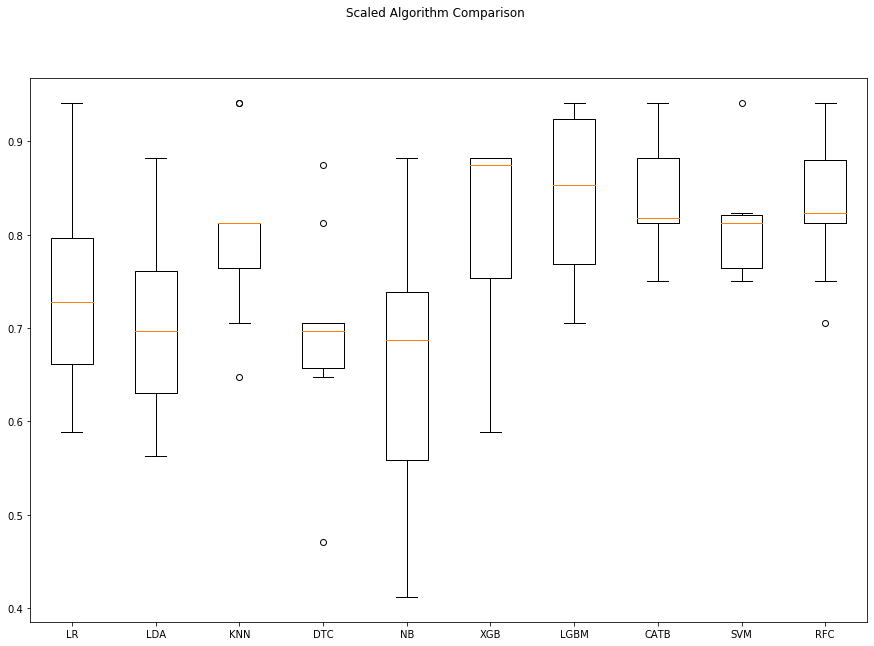

In [21]:
from matplotlib import pyplot as plt
fig = plt.figure()
fig.suptitle('Scaled Algorithm Comparison')
ax = fig.add_subplot(111)
plt.boxplot(results)
ax.set_xticklabels(names)
fig.set_size_inches(15,10)
plt.show()

In [22]:
# KNN: 0.801471 (0.086721)
# XGB: 0.813235 (0.093657)
# LGBM: 0.843382 (0.082129)
# CATB: 0.842279 (0.063497)
# SVM: 0.806985 (0.052207)
# RFC: 0.837132 (0.038736)


In [23]:
# KNN algorithm tuning
scaler = StandardScaler().fit(X_train)
rescaled_X = scaler.transform(X_train)
neighbors = [1,3,5,7,9,11,13,15,17,19,21]
param_grid = dict(n_neighbors=neighbors)
model = KNeighborsClassifier()
kfold = KFold(n_splits=10)
grid = GridSearchCV(estimator=model, param_grid=param_grid, scoring=scoring, cv=kfold)
grid_result = grid.fit(rescaled_X, y_train)

In [24]:
print("Best: %f using %s" % (grid_result.best_score_,grid_result.best_params_))
means = grid_result.cv_results_['mean_test_score']
stds = grid_result.cv_results_['std_test_score']
params = grid_result.cv_results_['params']
ranks = grid_result.cv_results_['rank_test_score']
for mean, stdev, param, rank in zip(means, stds, params, ranks):
    print("#%d %f (%f) with: %r" % (rank, mean, stdev, param))

Best: 0.867279 using {'n_neighbors': 1}
#1 0.867279 (0.073941) with: {'n_neighbors': 1}
#2 0.819485 (0.079099) with: {'n_neighbors': 3}
#3 0.795221 (0.087945) with: {'n_neighbors': 5}
#4 0.770956 (0.082636) with: {'n_neighbors': 7}
#5 0.747426 (0.077242) with: {'n_neighbors': 9}
#7 0.710662 (0.108541) with: {'n_neighbors': 11}
#11 0.698529 (0.116179) with: {'n_neighbors': 13}
#10 0.703676 (0.143460) with: {'n_neighbors': 15}
#6 0.716176 (0.100762) with: {'n_neighbors': 17}
#7 0.710662 (0.118848) with: {'n_neighbors': 19}
#9 0.704044 (0.106354) with: {'n_neighbors': 21}


In [25]:
# # XGB: 0.813235 (0.093657) algorithm tuning

param_XGB = {'n_estimators': [50, 100, 200],'learning_rate': [0.01,0.1,1]}
xgb_model = XGBClassifier()
kfold = KFold(n_splits=10)
grid = GridSearchCV(estimator=xgb_model, param_grid=param_XGB, scoring=scoring, cv=kfold)
grid_result = grid.fit(rescaled_X, y_train)

In [26]:
print(' Best : %f using %s' % (grid_result.best_score_,grid_result.best_params_))
means = grid_result.cv_results_['mean_test_score']
stds = grid_result.cv_results_['std_test_score']
params = grid_result.cv_results_['params']
ranks = grid_result.cv_results_['rank_test_score']
for mean, stdev, param, rank in zip(means, stds, params, ranks):
    print("#%d %f (%f) with: %r" % (rank, mean, stdev, param))

 Best : 0.819485 using {'learning_rate': 0.1, 'n_estimators': 200}
#8 0.741544 (0.083869) with: {'learning_rate': 0.01, 'n_estimators': 50}
#9 0.741176 (0.075385) with: {'learning_rate': 0.01, 'n_estimators': 100}
#7 0.759191 (0.091650) with: {'learning_rate': 0.01, 'n_estimators': 200}
#6 0.801471 (0.095305) with: {'learning_rate': 0.1, 'n_estimators': 50}
#5 0.813235 (0.093657) with: {'learning_rate': 0.1, 'n_estimators': 100}
#1 0.819485 (0.071070) with: {'learning_rate': 0.1, 'n_estimators': 200}
#2 0.813971 (0.093692) with: {'learning_rate': 1, 'n_estimators': 50}
#2 0.813971 (0.093692) with: {'learning_rate': 1, 'n_estimators': 100}
#2 0.813971 (0.093692) with: {'learning_rate': 1, 'n_estimators': 200}


In [27]:
# LGBM: 0.843382 (0.082129) algorithm tuning
param_LGBM = {'n_estimators':range(100,201,25),'learning_rate':[0.01,0.1,1],
             'max_depth':[7,8,9]}
lgbm_model = LGBMClassifier()
kfold = KFold(n_splits=10)
grid = GridSearchCV(estimator=lgbm_model, param_grid=param_LGBM, scoring=scoring, cv=kfold)
grid_result = grid.fit(rescaled_X, y_train)



In [28]:
print(' Best : %f using %s' % (grid_result.best_score_,grid_result.best_params_))
means = grid_result.cv_results_['mean_test_score']
stds = grid_result.cv_results_['std_test_score']
params = grid_result.cv_results_['params']
ranks = grid_result.cv_results_['rank_test_score']
for mean, stdev, param, rank in zip(means, stds, params, ranks):
    print("#%d %f (%f) with: %r" % (rank, mean, stdev, param))

 Best : 0.873162 using {'learning_rate': 0.1, 'max_depth': 7, 'n_estimators': 175}
#43 0.723897 (0.072743) with: {'learning_rate': 0.01, 'max_depth': 7, 'n_estimators': 100}
#40 0.747426 (0.072624) with: {'learning_rate': 0.01, 'max_depth': 7, 'n_estimators': 125}
#31 0.759926 (0.085197) with: {'learning_rate': 0.01, 'max_depth': 7, 'n_estimators': 150}
#31 0.759926 (0.085197) with: {'learning_rate': 0.01, 'max_depth': 7, 'n_estimators': 175}
#37 0.759559 (0.068014) with: {'learning_rate': 0.01, 'max_depth': 7, 'n_estimators': 200}
#43 0.723897 (0.072743) with: {'learning_rate': 0.01, 'max_depth': 8, 'n_estimators': 100}
#40 0.747426 (0.072624) with: {'learning_rate': 0.01, 'max_depth': 8, 'n_estimators': 125}
#31 0.759926 (0.085197) with: {'learning_rate': 0.01, 'max_depth': 8, 'n_estimators': 150}
#31 0.759926 (0.085197) with: {'learning_rate': 0.01, 'max_depth': 8, 'n_estimators': 175}
#37 0.759559 (0.068014) with: {'learning_rate': 0.01, 'max_depth': 8, 'n_estimators': 200}
#43 0.7

In [29]:
# CATB: 0.842279 (0.063497) algorithm tuning
param_CATB = {'iterations':[500,600,700,800],'learning_rate':[0.01,0.1,1],'depth':[5,6,7,8]}
catb_model = CatBoostClassifier()
kfold = KFold(n_splits=10)
grid = GridSearchCV(estimator=catb_model, param_grid=param_CATB, scoring=scoring, cv=kfold)
grid_result = grid.fit(rescaled_X, y_train)




0:	learn: 0.6881610	total: 6.6ms	remaining: 3.29s
1:	learn: 0.6810216	total: 13.7ms	remaining: 3.4s
2:	learn: 0.6742581	total: 20ms	remaining: 3.32s
3:	learn: 0.6695729	total: 26.1ms	remaining: 3.23s
4:	learn: 0.6635208	total: 29.8ms	remaining: 2.95s
5:	learn: 0.6560727	total: 33.1ms	remaining: 2.72s
6:	learn: 0.6522500	total: 36.3ms	remaining: 2.55s
7:	learn: 0.6455526	total: 39.4ms	remaining: 2.42s
8:	learn: 0.6388016	total: 42.7ms	remaining: 2.33s
9:	learn: 0.6318301	total: 45.9ms	remaining: 2.25s
10:	learn: 0.6256274	total: 49.1ms	remaining: 2.18s
11:	learn: 0.6199838	total: 52.4ms	remaining: 2.13s
12:	learn: 0.6152974	total: 55.6ms	remaining: 2.08s
13:	learn: 0.6108511	total: 59.3ms	remaining: 2.06s
14:	learn: 0.6062667	total: 62.7ms	remaining: 2.03s
15:	learn: 0.6017825	total: 65.9ms	remaining: 1.99s
16:	learn: 0.5956053	total: 69.1ms	remaining: 1.96s
17:	learn: 0.5914101	total: 72.4ms	remaining: 1.94s
18:	learn: 0.5861280	total: 75.6ms	remaining: 1.91s
19:	learn: 0.5832382	total

200:	learn: 0.1955386	total: 736ms	remaining: 1.09s
201:	learn: 0.1946612	total: 740ms	remaining: 1.09s
202:	learn: 0.1940764	total: 745ms	remaining: 1.09s
203:	learn: 0.1932107	total: 749ms	remaining: 1.09s
204:	learn: 0.1922087	total: 753ms	remaining: 1.08s
205:	learn: 0.1911985	total: 758ms	remaining: 1.08s
206:	learn: 0.1904296	total: 761ms	remaining: 1.08s
207:	learn: 0.1892991	total: 765ms	remaining: 1.07s
208:	learn: 0.1884872	total: 770ms	remaining: 1.07s
209:	learn: 0.1880163	total: 775ms	remaining: 1.07s
210:	learn: 0.1872274	total: 779ms	remaining: 1.07s
211:	learn: 0.1863248	total: 782ms	remaining: 1.06s
212:	learn: 0.1853850	total: 785ms	remaining: 1.06s
213:	learn: 0.1848649	total: 788ms	remaining: 1.05s
214:	learn: 0.1842672	total: 792ms	remaining: 1.05s
215:	learn: 0.1833495	total: 795ms	remaining: 1.04s
216:	learn: 0.1827315	total: 798ms	remaining: 1.04s
217:	learn: 0.1818415	total: 802ms	remaining: 1.04s
218:	learn: 0.1811000	total: 805ms	remaining: 1.03s
219:	learn: 

405:	learn: 0.0863452	total: 1.46s	remaining: 339ms
406:	learn: 0.0860103	total: 1.47s	remaining: 336ms
407:	learn: 0.0856901	total: 1.47s	remaining: 332ms
408:	learn: 0.0853571	total: 1.48s	remaining: 329ms
409:	learn: 0.0849814	total: 1.48s	remaining: 325ms
410:	learn: 0.0846585	total: 1.49s	remaining: 322ms
411:	learn: 0.0844229	total: 1.49s	remaining: 318ms
412:	learn: 0.0840558	total: 1.49s	remaining: 314ms
413:	learn: 0.0837623	total: 1.5s	remaining: 311ms
414:	learn: 0.0834627	total: 1.5s	remaining: 307ms
415:	learn: 0.0831586	total: 1.5s	remaining: 304ms
416:	learn: 0.0828626	total: 1.51s	remaining: 300ms
417:	learn: 0.0824220	total: 1.51s	remaining: 296ms
418:	learn: 0.0821612	total: 1.51s	remaining: 293ms
419:	learn: 0.0818819	total: 1.52s	remaining: 289ms
420:	learn: 0.0816068	total: 1.52s	remaining: 286ms
421:	learn: 0.0811954	total: 1.52s	remaining: 282ms
422:	learn: 0.0810085	total: 1.53s	remaining: 278ms
423:	learn: 0.0807458	total: 1.53s	remaining: 274ms
424:	learn: 0.0

82:	learn: 0.3711876	total: 375ms	remaining: 1.88s
83:	learn: 0.3697357	total: 378ms	remaining: 1.87s
84:	learn: 0.3679513	total: 383ms	remaining: 1.87s
85:	learn: 0.3646367	total: 387ms	remaining: 1.86s
86:	learn: 0.3609183	total: 391ms	remaining: 1.85s
87:	learn: 0.3580078	total: 397ms	remaining: 1.86s
88:	learn: 0.3554595	total: 400ms	remaining: 1.85s
89:	learn: 0.3530029	total: 403ms	remaining: 1.84s
90:	learn: 0.3504936	total: 407ms	remaining: 1.83s
91:	learn: 0.3482243	total: 412ms	remaining: 1.83s
92:	learn: 0.3459708	total: 416ms	remaining: 1.82s
93:	learn: 0.3440096	total: 420ms	remaining: 1.81s
94:	learn: 0.3418644	total: 424ms	remaining: 1.8s
95:	learn: 0.3396939	total: 427ms	remaining: 1.8s
96:	learn: 0.3379228	total: 430ms	remaining: 1.79s
97:	learn: 0.3361426	total: 433ms	remaining: 1.78s
98:	learn: 0.3330927	total: 437ms	remaining: 1.77s
99:	learn: 0.3309071	total: 440ms	remaining: 1.76s
100:	learn: 0.3291606	total: 444ms	remaining: 1.75s
101:	learn: 0.3268871	total: 447

290:	learn: 0.1302290	total: 1.11s	remaining: 795ms
291:	learn: 0.1298682	total: 1.11s	remaining: 792ms
292:	learn: 0.1292935	total: 1.11s	remaining: 788ms
293:	learn: 0.1288285	total: 1.12s	remaining: 784ms
294:	learn: 0.1283659	total: 1.13s	remaining: 782ms
295:	learn: 0.1277610	total: 1.13s	remaining: 778ms
296:	learn: 0.1274061	total: 1.13s	remaining: 774ms
297:	learn: 0.1266155	total: 1.14s	remaining: 770ms
298:	learn: 0.1263287	total: 1.14s	remaining: 767ms
299:	learn: 0.1258103	total: 1.15s	remaining: 764ms
300:	learn: 0.1253156	total: 1.15s	remaining: 759ms
301:	learn: 0.1250010	total: 1.15s	remaining: 756ms
302:	learn: 0.1245672	total: 1.16s	remaining: 751ms
303:	learn: 0.1241353	total: 1.16s	remaining: 747ms
304:	learn: 0.1234920	total: 1.16s	remaining: 743ms
305:	learn: 0.1230105	total: 1.17s	remaining: 739ms
306:	learn: 0.1225987	total: 1.17s	remaining: 735ms
307:	learn: 0.1221634	total: 1.17s	remaining: 731ms
308:	learn: 0.1216473	total: 1.18s	remaining: 727ms
309:	learn: 

494:	learn: 0.0625612	total: 1.83s	remaining: 18.5ms
495:	learn: 0.0622943	total: 1.84s	remaining: 14.8ms
496:	learn: 0.0621387	total: 1.84s	remaining: 11.1ms
497:	learn: 0.0619563	total: 1.85s	remaining: 7.42ms
498:	learn: 0.0617398	total: 1.85s	remaining: 3.71ms
499:	learn: 0.0614890	total: 1.86s	remaining: 0us
0:	learn: 0.6877780	total: 9.64ms	remaining: 4.81s
1:	learn: 0.6805926	total: 18.3ms	remaining: 4.54s
2:	learn: 0.6720100	total: 29.6ms	remaining: 4.91s
3:	learn: 0.6671470	total: 42.2ms	remaining: 5.23s
4:	learn: 0.6600415	total: 54.3ms	remaining: 5.37s
5:	learn: 0.6534080	total: 65.4ms	remaining: 5.38s
6:	learn: 0.6478211	total: 75.3ms	remaining: 5.3s
7:	learn: 0.6412983	total: 83.9ms	remaining: 5.16s
8:	learn: 0.6339698	total: 92.6ms	remaining: 5.05s
9:	learn: 0.6273045	total: 101ms	remaining: 4.95s
10:	learn: 0.6201895	total: 107ms	remaining: 4.74s
11:	learn: 0.6163597	total: 112ms	remaining: 4.54s
12:	learn: 0.6112914	total: 116ms	remaining: 4.35s
13:	learn: 0.6070688	tot

194:	learn: 0.1921648	total: 756ms	remaining: 1.18s
195:	learn: 0.1914309	total: 760ms	remaining: 1.18s
196:	learn: 0.1906382	total: 764ms	remaining: 1.17s
197:	learn: 0.1899335	total: 768ms	remaining: 1.17s
198:	learn: 0.1891581	total: 772ms	remaining: 1.17s
199:	learn: 0.1882656	total: 778ms	remaining: 1.17s
200:	learn: 0.1873213	total: 783ms	remaining: 1.16s
201:	learn: 0.1865114	total: 789ms	remaining: 1.16s
202:	learn: 0.1857014	total: 793ms	remaining: 1.16s
203:	learn: 0.1849379	total: 797ms	remaining: 1.16s
204:	learn: 0.1838497	total: 800ms	remaining: 1.15s
205:	learn: 0.1829326	total: 804ms	remaining: 1.15s
206:	learn: 0.1820437	total: 807ms	remaining: 1.14s
207:	learn: 0.1812471	total: 810ms	remaining: 1.14s
208:	learn: 0.1804983	total: 814ms	remaining: 1.13s
209:	learn: 0.1794609	total: 817ms	remaining: 1.13s
210:	learn: 0.1788029	total: 821ms	remaining: 1.12s
211:	learn: 0.1781447	total: 824ms	remaining: 1.12s
212:	learn: 0.1774367	total: 827ms	remaining: 1.11s
213:	learn: 

352:	learn: 0.0985280	total: 1.32s	remaining: 548ms
353:	learn: 0.0982829	total: 1.32s	remaining: 545ms
354:	learn: 0.0980112	total: 1.32s	remaining: 541ms
355:	learn: 0.0976438	total: 1.33s	remaining: 538ms
356:	learn: 0.0973313	total: 1.33s	remaining: 535ms
357:	learn: 0.0968312	total: 1.34s	remaining: 531ms
358:	learn: 0.0964600	total: 1.34s	remaining: 527ms
359:	learn: 0.0961951	total: 1.35s	remaining: 524ms
360:	learn: 0.0956414	total: 1.35s	remaining: 520ms
361:	learn: 0.0952496	total: 1.35s	remaining: 517ms
362:	learn: 0.0948718	total: 1.36s	remaining: 513ms
363:	learn: 0.0944882	total: 1.36s	remaining: 509ms
364:	learn: 0.0941457	total: 1.36s	remaining: 505ms
365:	learn: 0.0937416	total: 1.37s	remaining: 501ms
366:	learn: 0.0935688	total: 1.37s	remaining: 497ms
367:	learn: 0.0932116	total: 1.38s	remaining: 493ms
368:	learn: 0.0928429	total: 1.38s	remaining: 490ms
369:	learn: 0.0923274	total: 1.38s	remaining: 486ms
370:	learn: 0.0920786	total: 1.39s	remaining: 482ms
371:	learn: 

33:	learn: 0.5210710	total: 188ms	remaining: 2.58s
34:	learn: 0.5180395	total: 194ms	remaining: 2.58s
35:	learn: 0.5129368	total: 198ms	remaining: 2.56s
36:	learn: 0.5096080	total: 203ms	remaining: 2.53s
37:	learn: 0.5058862	total: 207ms	remaining: 2.51s
38:	learn: 0.5014221	total: 212ms	remaining: 2.51s
39:	learn: 0.4975370	total: 215ms	remaining: 2.48s
40:	learn: 0.4939546	total: 219ms	remaining: 2.46s
41:	learn: 0.4901873	total: 225ms	remaining: 2.46s
42:	learn: 0.4859905	total: 229ms	remaining: 2.43s
43:	learn: 0.4823504	total: 232ms	remaining: 2.41s
44:	learn: 0.4790157	total: 236ms	remaining: 2.39s
45:	learn: 0.4768404	total: 239ms	remaining: 2.36s
46:	learn: 0.4731110	total: 243ms	remaining: 2.34s
47:	learn: 0.4700994	total: 246ms	remaining: 2.31s
48:	learn: 0.4665445	total: 249ms	remaining: 2.29s
49:	learn: 0.4635463	total: 252ms	remaining: 2.27s
50:	learn: 0.4595404	total: 256ms	remaining: 2.25s
51:	learn: 0.4566211	total: 259ms	remaining: 2.23s
52:	learn: 0.4515213	total: 262

240:	learn: 0.1706430	total: 917ms	remaining: 986ms
241:	learn: 0.1699072	total: 922ms	remaining: 983ms
242:	learn: 0.1690089	total: 926ms	remaining: 979ms
243:	learn: 0.1682750	total: 930ms	remaining: 976ms
244:	learn: 0.1672971	total: 934ms	remaining: 973ms
245:	learn: 0.1666810	total: 940ms	remaining: 970ms
246:	learn: 0.1660253	total: 943ms	remaining: 966ms
247:	learn: 0.1655045	total: 946ms	remaining: 962ms
248:	learn: 0.1649935	total: 952ms	remaining: 960ms
249:	learn: 0.1640239	total: 957ms	remaining: 957ms
250:	learn: 0.1631818	total: 960ms	remaining: 953ms
251:	learn: 0.1622607	total: 964ms	remaining: 949ms
252:	learn: 0.1615826	total: 967ms	remaining: 944ms
253:	learn: 0.1608055	total: 971ms	remaining: 940ms
254:	learn: 0.1602531	total: 974ms	remaining: 936ms
255:	learn: 0.1594405	total: 977ms	remaining: 932ms
256:	learn: 0.1588587	total: 981ms	remaining: 928ms
257:	learn: 0.1582593	total: 985ms	remaining: 924ms
258:	learn: 0.1575056	total: 988ms	remaining: 919ms
259:	learn: 

444:	learn: 0.0785996	total: 1.64s	remaining: 203ms
445:	learn: 0.0783233	total: 1.65s	remaining: 200ms
446:	learn: 0.0779771	total: 1.65s	remaining: 196ms
447:	learn: 0.0777718	total: 1.66s	remaining: 192ms
448:	learn: 0.0775211	total: 1.66s	remaining: 189ms
449:	learn: 0.0773383	total: 1.67s	remaining: 185ms
450:	learn: 0.0770696	total: 1.67s	remaining: 181ms
451:	learn: 0.0768042	total: 1.67s	remaining: 178ms
452:	learn: 0.0765712	total: 1.68s	remaining: 174ms
453:	learn: 0.0763025	total: 1.68s	remaining: 170ms
454:	learn: 0.0760195	total: 1.69s	remaining: 167ms
455:	learn: 0.0757562	total: 1.69s	remaining: 163ms
456:	learn: 0.0753845	total: 1.69s	remaining: 159ms
457:	learn: 0.0751384	total: 1.7s	remaining: 155ms
458:	learn: 0.0749561	total: 1.7s	remaining: 152ms
459:	learn: 0.0747413	total: 1.7s	remaining: 148ms
460:	learn: 0.0745982	total: 1.71s	remaining: 144ms
461:	learn: 0.0744109	total: 1.71s	remaining: 141ms
462:	learn: 0.0741215	total: 1.71s	remaining: 137ms
463:	learn: 0.0

144:	learn: 0.2616172	total: 589ms	remaining: 1.44s
145:	learn: 0.2601152	total: 593ms	remaining: 1.44s
146:	learn: 0.2589320	total: 598ms	remaining: 1.44s
147:	learn: 0.2580246	total: 602ms	remaining: 1.43s
148:	learn: 0.2564571	total: 607ms	remaining: 1.43s
149:	learn: 0.2551629	total: 612ms	remaining: 1.43s
150:	learn: 0.2541127	total: 617ms	remaining: 1.43s
151:	learn: 0.2527898	total: 620ms	remaining: 1.42s
152:	learn: 0.2511347	total: 624ms	remaining: 1.41s
153:	learn: 0.2500103	total: 627ms	remaining: 1.41s
154:	learn: 0.2491289	total: 630ms	remaining: 1.4s
155:	learn: 0.2481357	total: 633ms	remaining: 1.4s
156:	learn: 0.2471415	total: 637ms	remaining: 1.39s
157:	learn: 0.2459045	total: 640ms	remaining: 1.39s
158:	learn: 0.2451179	total: 643ms	remaining: 1.38s
159:	learn: 0.2442729	total: 647ms	remaining: 1.37s
160:	learn: 0.2428624	total: 650ms	remaining: 1.37s
161:	learn: 0.2420249	total: 653ms	remaining: 1.36s
162:	learn: 0.2410434	total: 656ms	remaining: 1.36s
163:	learn: 0.

345:	learn: 0.1114728	total: 1.31s	remaining: 582ms
346:	learn: 0.1110284	total: 1.31s	remaining: 580ms
347:	learn: 0.1105146	total: 1.32s	remaining: 576ms
348:	learn: 0.1102008	total: 1.32s	remaining: 572ms
349:	learn: 0.1098431	total: 1.33s	remaining: 569ms
350:	learn: 0.1093456	total: 1.33s	remaining: 566ms
351:	learn: 0.1090937	total: 1.34s	remaining: 562ms
352:	learn: 0.1086586	total: 1.34s	remaining: 559ms
353:	learn: 0.1081784	total: 1.34s	remaining: 555ms
354:	learn: 0.1079044	total: 1.35s	remaining: 551ms
355:	learn: 0.1075017	total: 1.35s	remaining: 547ms
356:	learn: 0.1070381	total: 1.35s	remaining: 543ms
357:	learn: 0.1065447	total: 1.36s	remaining: 539ms
358:	learn: 0.1062542	total: 1.36s	remaining: 535ms
359:	learn: 0.1060142	total: 1.36s	remaining: 531ms
360:	learn: 0.1055339	total: 1.37s	remaining: 527ms
361:	learn: 0.1051808	total: 1.37s	remaining: 523ms
362:	learn: 0.1049114	total: 1.38s	remaining: 519ms
363:	learn: 0.1045467	total: 1.38s	remaining: 515ms
364:	learn: 

35:	learn: 0.5134461	total: 191ms	remaining: 2.46s
36:	learn: 0.5093285	total: 195ms	remaining: 2.44s
37:	learn: 0.5049996	total: 199ms	remaining: 2.42s
38:	learn: 0.5014823	total: 203ms	remaining: 2.4s
39:	learn: 0.4970096	total: 208ms	remaining: 2.39s
40:	learn: 0.4932561	total: 213ms	remaining: 2.38s
41:	learn: 0.4887666	total: 217ms	remaining: 2.36s
42:	learn: 0.4853512	total: 220ms	remaining: 2.34s
43:	learn: 0.4823609	total: 225ms	remaining: 2.33s
44:	learn: 0.4784534	total: 230ms	remaining: 2.33s
45:	learn: 0.4760386	total: 234ms	remaining: 2.31s
46:	learn: 0.4713107	total: 237ms	remaining: 2.29s
47:	learn: 0.4671259	total: 241ms	remaining: 2.27s
48:	learn: 0.4651126	total: 244ms	remaining: 2.25s
49:	learn: 0.4630026	total: 248ms	remaining: 2.23s
50:	learn: 0.4591374	total: 251ms	remaining: 2.21s
51:	learn: 0.4557811	total: 254ms	remaining: 2.19s
52:	learn: 0.4518201	total: 258ms	remaining: 2.17s
53:	learn: 0.4484705	total: 261ms	remaining: 2.16s
54:	learn: 0.4460434	total: 264m

241:	learn: 0.1631047	total: 922ms	remaining: 983ms
242:	learn: 0.1624287	total: 927ms	remaining: 980ms
243:	learn: 0.1618336	total: 931ms	remaining: 977ms
244:	learn: 0.1608999	total: 935ms	remaining: 973ms
245:	learn: 0.1602070	total: 939ms	remaining: 970ms
246:	learn: 0.1595792	total: 944ms	remaining: 967ms
247:	learn: 0.1589819	total: 948ms	remaining: 963ms
248:	learn: 0.1584513	total: 952ms	remaining: 959ms
249:	learn: 0.1576293	total: 957ms	remaining: 957ms
250:	learn: 0.1570369	total: 961ms	remaining: 953ms
251:	learn: 0.1566447	total: 964ms	remaining: 949ms
252:	learn: 0.1561294	total: 968ms	remaining: 945ms
253:	learn: 0.1555554	total: 971ms	remaining: 940ms
254:	learn: 0.1550364	total: 974ms	remaining: 936ms
255:	learn: 0.1540529	total: 978ms	remaining: 932ms
256:	learn: 0.1534609	total: 981ms	remaining: 927ms
257:	learn: 0.1527950	total: 984ms	remaining: 923ms
258:	learn: 0.1521333	total: 988ms	remaining: 919ms
259:	learn: 0.1514357	total: 991ms	remaining: 915ms
260:	learn: 

448:	learn: 0.0740647	total: 1.65s	remaining: 187ms
449:	learn: 0.0738021	total: 1.65s	remaining: 184ms
450:	learn: 0.0734833	total: 1.66s	remaining: 180ms
451:	learn: 0.0732538	total: 1.66s	remaining: 177ms
452:	learn: 0.0730231	total: 1.67s	remaining: 173ms
453:	learn: 0.0728278	total: 1.67s	remaining: 169ms
454:	learn: 0.0726259	total: 1.68s	remaining: 166ms
455:	learn: 0.0723734	total: 1.68s	remaining: 162ms
456:	learn: 0.0720300	total: 1.69s	remaining: 159ms
457:	learn: 0.0717846	total: 1.69s	remaining: 155ms
458:	learn: 0.0715210	total: 1.69s	remaining: 151ms
459:	learn: 0.0713592	total: 1.7s	remaining: 148ms
460:	learn: 0.0710770	total: 1.7s	remaining: 144ms
461:	learn: 0.0707706	total: 1.7s	remaining: 140ms
462:	learn: 0.0705811	total: 1.71s	remaining: 136ms
463:	learn: 0.0703644	total: 1.71s	remaining: 133ms
464:	learn: 0.0700336	total: 1.71s	remaining: 129ms
465:	learn: 0.0697232	total: 1.72s	remaining: 125ms
466:	learn: 0.0695591	total: 1.72s	remaining: 122ms
467:	learn: 0.0

137:	learn: 0.2653103	total: 554ms	remaining: 1.45s
138:	learn: 0.2635868	total: 558ms	remaining: 1.45s
139:	learn: 0.2617678	total: 562ms	remaining: 1.45s
140:	learn: 0.2607023	total: 566ms	remaining: 1.44s
141:	learn: 0.2594404	total: 571ms	remaining: 1.44s
142:	learn: 0.2577502	total: 577ms	remaining: 1.44s
143:	learn: 0.2565831	total: 582ms	remaining: 1.44s
144:	learn: 0.2549344	total: 586ms	remaining: 1.43s
145:	learn: 0.2536468	total: 590ms	remaining: 1.43s
146:	learn: 0.2521565	total: 593ms	remaining: 1.42s
147:	learn: 0.2511539	total: 596ms	remaining: 1.42s
148:	learn: 0.2502339	total: 600ms	remaining: 1.41s
149:	learn: 0.2485767	total: 603ms	remaining: 1.41s
150:	learn: 0.2472476	total: 606ms	remaining: 1.4s
151:	learn: 0.2456882	total: 610ms	remaining: 1.4s
152:	learn: 0.2445863	total: 613ms	remaining: 1.39s
153:	learn: 0.2431876	total: 616ms	remaining: 1.38s
154:	learn: 0.2420572	total: 619ms	remaining: 1.38s
155:	learn: 0.2411906	total: 623ms	remaining: 1.37s
156:	learn: 0.

341:	learn: 0.1074860	total: 1.28s	remaining: 592ms
342:	learn: 0.1070441	total: 1.29s	remaining: 590ms
343:	learn: 0.1067009	total: 1.29s	remaining: 586ms
344:	learn: 0.1064268	total: 1.3s	remaining: 583ms
345:	learn: 0.1058676	total: 1.3s	remaining: 579ms
346:	learn: 0.1055416	total: 1.3s	remaining: 576ms
347:	learn: 0.1050782	total: 1.31s	remaining: 572ms
348:	learn: 0.1048443	total: 1.31s	remaining: 569ms
349:	learn: 0.1045532	total: 1.32s	remaining: 565ms
350:	learn: 0.1042336	total: 1.32s	remaining: 561ms
351:	learn: 0.1039250	total: 1.33s	remaining: 558ms
352:	learn: 0.1034040	total: 1.33s	remaining: 554ms
353:	learn: 0.1029134	total: 1.33s	remaining: 550ms
354:	learn: 0.1025708	total: 1.33s	remaining: 546ms
355:	learn: 0.1021469	total: 1.34s	remaining: 542ms
356:	learn: 0.1017701	total: 1.34s	remaining: 538ms
357:	learn: 0.1014200	total: 1.35s	remaining: 534ms
358:	learn: 0.1010527	total: 1.35s	remaining: 530ms
359:	learn: 0.1007785	total: 1.35s	remaining: 526ms
360:	learn: 0.1

0:	learn: 0.6877300	total: 8.65ms	remaining: 4.32s
1:	learn: 0.6829907	total: 17.5ms	remaining: 4.35s
2:	learn: 0.6763459	total: 26.1ms	remaining: 4.33s
3:	learn: 0.6707955	total: 35ms	remaining: 4.34s
4:	learn: 0.6637125	total: 44.1ms	remaining: 4.36s
5:	learn: 0.6559888	total: 52.9ms	remaining: 4.35s
6:	learn: 0.6514222	total: 65.1ms	remaining: 4.58s
7:	learn: 0.6441825	total: 74.6ms	remaining: 4.58s
8:	learn: 0.6381151	total: 88.4ms	remaining: 4.82s
9:	learn: 0.6304213	total: 97.6ms	remaining: 4.78s
10:	learn: 0.6250810	total: 106ms	remaining: 4.69s
11:	learn: 0.6213485	total: 111ms	remaining: 4.53s
12:	learn: 0.6165973	total: 116ms	remaining: 4.34s
13:	learn: 0.6104235	total: 120ms	remaining: 4.18s
14:	learn: 0.6052633	total: 124ms	remaining: 4.01s
15:	learn: 0.6011660	total: 128ms	remaining: 3.86s
16:	learn: 0.5956604	total: 131ms	remaining: 3.72s
17:	learn: 0.5916729	total: 134ms	remaining: 3.59s
18:	learn: 0.5855811	total: 137ms	remaining: 3.48s
19:	learn: 0.5820459	total: 141ms

189:	learn: 0.2062560	total: 736ms	remaining: 1.2s
190:	learn: 0.2054076	total: 740ms	remaining: 1.2s
191:	learn: 0.2042589	total: 744ms	remaining: 1.19s
192:	learn: 0.2029106	total: 749ms	remaining: 1.19s
193:	learn: 0.2017891	total: 753ms	remaining: 1.19s
194:	learn: 0.2004719	total: 757ms	remaining: 1.18s
195:	learn: 0.1995963	total: 762ms	remaining: 1.18s
196:	learn: 0.1984688	total: 767ms	remaining: 1.18s
197:	learn: 0.1976119	total: 770ms	remaining: 1.17s
198:	learn: 0.1967033	total: 774ms	remaining: 1.17s
199:	learn: 0.1962230	total: 778ms	remaining: 1.17s
200:	learn: 0.1952581	total: 781ms	remaining: 1.16s
201:	learn: 0.1945568	total: 784ms	remaining: 1.16s
202:	learn: 0.1939281	total: 788ms	remaining: 1.15s
203:	learn: 0.1930646	total: 791ms	remaining: 1.15s
204:	learn: 0.1921316	total: 794ms	remaining: 1.14s
205:	learn: 0.1915624	total: 798ms	remaining: 1.14s
206:	learn: 0.1904548	total: 801ms	remaining: 1.13s
207:	learn: 0.1892215	total: 804ms	remaining: 1.13s
208:	learn: 0.

396:	learn: 0.0843204	total: 1.47s	remaining: 380ms
397:	learn: 0.0840297	total: 1.47s	remaining: 377ms
398:	learn: 0.0837489	total: 1.47s	remaining: 373ms
399:	learn: 0.0833108	total: 1.48s	remaining: 369ms
400:	learn: 0.0828181	total: 1.48s	remaining: 366ms
401:	learn: 0.0825193	total: 1.49s	remaining: 362ms
402:	learn: 0.0823339	total: 1.5s	remaining: 360ms
403:	learn: 0.0820286	total: 1.5s	remaining: 356ms
404:	learn: 0.0817400	total: 1.5s	remaining: 353ms
405:	learn: 0.0815794	total: 1.51s	remaining: 350ms
406:	learn: 0.0815201	total: 1.51s	remaining: 346ms
407:	learn: 0.0811663	total: 1.52s	remaining: 342ms
408:	learn: 0.0810201	total: 1.52s	remaining: 339ms
409:	learn: 0.0808037	total: 1.52s	remaining: 335ms
410:	learn: 0.0806133	total: 1.53s	remaining: 331ms
411:	learn: 0.0803991	total: 1.53s	remaining: 327ms
412:	learn: 0.0801148	total: 1.53s	remaining: 323ms
413:	learn: 0.0796763	total: 1.54s	remaining: 320ms
414:	learn: 0.0793523	total: 1.54s	remaining: 316ms
415:	learn: 0.0

92:	learn: 0.3500062	total: 394ms	remaining: 1.72s
93:	learn: 0.3478299	total: 398ms	remaining: 1.72s
94:	learn: 0.3460598	total: 402ms	remaining: 1.71s
95:	learn: 0.3438481	total: 406ms	remaining: 1.71s
96:	learn: 0.3424105	total: 411ms	remaining: 1.71s
97:	learn: 0.3400535	total: 416ms	remaining: 1.71s
98:	learn: 0.3379521	total: 420ms	remaining: 1.7s
99:	learn: 0.3354213	total: 423ms	remaining: 1.69s
100:	learn: 0.3336468	total: 432ms	remaining: 1.71s
101:	learn: 0.3313589	total: 436ms	remaining: 1.7s
102:	learn: 0.3296473	total: 441ms	remaining: 1.7s
103:	learn: 0.3271520	total: 446ms	remaining: 1.7s
104:	learn: 0.3246555	total: 450ms	remaining: 1.69s
105:	learn: 0.3223247	total: 454ms	remaining: 1.69s
106:	learn: 0.3204431	total: 457ms	remaining: 1.68s
107:	learn: 0.3191021	total: 460ms	remaining: 1.67s
108:	learn: 0.3164019	total: 464ms	remaining: 1.66s
109:	learn: 0.3140864	total: 467ms	remaining: 1.66s
110:	learn: 0.3123838	total: 470ms	remaining: 1.65s
111:	learn: 0.3106672	to

300:	learn: 0.1298828	total: 1.13s	remaining: 747ms
301:	learn: 0.1291500	total: 1.13s	remaining: 743ms
302:	learn: 0.1285634	total: 1.14s	remaining: 740ms
303:	learn: 0.1283245	total: 1.14s	remaining: 736ms
304:	learn: 0.1279774	total: 1.15s	remaining: 733ms
305:	learn: 0.1275319	total: 1.15s	remaining: 729ms
306:	learn: 0.1270601	total: 1.16s	remaining: 727ms
307:	learn: 0.1267198	total: 1.16s	remaining: 724ms
308:	learn: 0.1259863	total: 1.17s	remaining: 721ms
309:	learn: 0.1254219	total: 1.17s	remaining: 717ms
310:	learn: 0.1247930	total: 1.17s	remaining: 713ms
311:	learn: 0.1240798	total: 1.18s	remaining: 709ms
312:	learn: 0.1236537	total: 1.18s	remaining: 705ms
313:	learn: 0.1231700	total: 1.18s	remaining: 701ms
314:	learn: 0.1228036	total: 1.19s	remaining: 697ms
315:	learn: 0.1223197	total: 1.19s	remaining: 693ms
316:	learn: 0.1216815	total: 1.19s	remaining: 689ms
317:	learn: 0.1212983	total: 1.2s	remaining: 685ms
318:	learn: 0.1206969	total: 1.2s	remaining: 681ms
319:	learn: 0.

0:	learn: 0.6875327	total: 8.8ms	remaining: 4.39s
1:	learn: 0.6816440	total: 18.3ms	remaining: 4.56s
2:	learn: 0.6747296	total: 27.1ms	remaining: 4.49s
3:	learn: 0.6705078	total: 36.1ms	remaining: 4.48s
4:	learn: 0.6655863	total: 45ms	remaining: 4.45s
5:	learn: 0.6614792	total: 53.8ms	remaining: 4.43s
6:	learn: 0.6565333	total: 62.5ms	remaining: 4.4s
7:	learn: 0.6489440	total: 71.3ms	remaining: 4.38s
8:	learn: 0.6415943	total: 80.1ms	remaining: 4.37s
9:	learn: 0.6355748	total: 88.6ms	remaining: 4.34s
10:	learn: 0.6304274	total: 97.3ms	remaining: 4.33s
11:	learn: 0.6272697	total: 104ms	remaining: 4.24s
12:	learn: 0.6230817	total: 110ms	remaining: 4.11s
13:	learn: 0.6189359	total: 114ms	remaining: 3.97s
14:	learn: 0.6137127	total: 118ms	remaining: 3.83s
15:	learn: 0.6085413	total: 122ms	remaining: 3.69s
16:	learn: 0.6033298	total: 126ms	remaining: 3.57s
17:	learn: 0.5984407	total: 129ms	remaining: 3.45s
18:	learn: 0.5940100	total: 132ms	remaining: 3.35s
19:	learn: 0.5902996	total: 136ms	

188:	learn: 0.2117108	total: 736ms	remaining: 1.21s
189:	learn: 0.2107325	total: 740ms	remaining: 1.21s
190:	learn: 0.2097736	total: 744ms	remaining: 1.2s
191:	learn: 0.2091764	total: 748ms	remaining: 1.2s
192:	learn: 0.2082448	total: 752ms	remaining: 1.2s
193:	learn: 0.2074705	total: 757ms	remaining: 1.19s
194:	learn: 0.2062312	total: 761ms	remaining: 1.19s
195:	learn: 0.2050593	total: 765ms	remaining: 1.19s
196:	learn: 0.2043077	total: 769ms	remaining: 1.18s
197:	learn: 0.2038184	total: 773ms	remaining: 1.18s
198:	learn: 0.2029630	total: 777ms	remaining: 1.17s
199:	learn: 0.2025358	total: 780ms	remaining: 1.17s
200:	learn: 0.2018935	total: 784ms	remaining: 1.17s
201:	learn: 0.2012226	total: 787ms	remaining: 1.16s
202:	learn: 0.2007484	total: 790ms	remaining: 1.16s
203:	learn: 0.1998921	total: 794ms	remaining: 1.15s
204:	learn: 0.1987601	total: 797ms	remaining: 1.15s
205:	learn: 0.1981710	total: 800ms	remaining: 1.14s
206:	learn: 0.1970443	total: 804ms	remaining: 1.14s
207:	learn: 0.1

395:	learn: 0.0935852	total: 1.47s	remaining: 387ms
396:	learn: 0.0932339	total: 1.48s	remaining: 384ms
397:	learn: 0.0929007	total: 1.48s	remaining: 380ms
398:	learn: 0.0926356	total: 1.49s	remaining: 377ms
399:	learn: 0.0923120	total: 1.49s	remaining: 373ms
400:	learn: 0.0918812	total: 1.5s	remaining: 370ms
401:	learn: 0.0916019	total: 1.5s	remaining: 366ms
402:	learn: 0.0913877	total: 1.5s	remaining: 362ms
403:	learn: 0.0911315	total: 1.51s	remaining: 359ms
404:	learn: 0.0908507	total: 1.51s	remaining: 355ms
405:	learn: 0.0904433	total: 1.52s	remaining: 352ms
406:	learn: 0.0901736	total: 1.52s	remaining: 348ms
407:	learn: 0.0897850	total: 1.52s	remaining: 344ms
408:	learn: 0.0893533	total: 1.53s	remaining: 340ms
409:	learn: 0.0890122	total: 1.53s	remaining: 336ms
410:	learn: 0.0887925	total: 1.53s	remaining: 333ms
411:	learn: 0.0885647	total: 1.54s	remaining: 329ms
412:	learn: 0.0883132	total: 1.54s	remaining: 325ms
413:	learn: 0.0880202	total: 1.54s	remaining: 321ms
414:	learn: 0.0

90:	learn: 0.0172627	total: 381ms	remaining: 1.71s
91:	learn: 0.0168934	total: 386ms	remaining: 1.71s
92:	learn: 0.0165051	total: 390ms	remaining: 1.71s
93:	learn: 0.0162626	total: 397ms	remaining: 1.71s
94:	learn: 0.0159473	total: 400ms	remaining: 1.71s
95:	learn: 0.0156556	total: 404ms	remaining: 1.7s
96:	learn: 0.0152440	total: 410ms	remaining: 1.7s
97:	learn: 0.0149809	total: 413ms	remaining: 1.7s
98:	learn: 0.0147194	total: 417ms	remaining: 1.69s
99:	learn: 0.0144572	total: 420ms	remaining: 1.68s
100:	learn: 0.0142361	total: 424ms	remaining: 1.67s
101:	learn: 0.0139381	total: 427ms	remaining: 1.67s
102:	learn: 0.0136539	total: 430ms	remaining: 1.66s
103:	learn: 0.0134299	total: 433ms	remaining: 1.65s
104:	learn: 0.0131219	total: 437ms	remaining: 1.64s
105:	learn: 0.0129759	total: 440ms	remaining: 1.64s
106:	learn: 0.0127182	total: 443ms	remaining: 1.63s
107:	learn: 0.0125149	total: 447ms	remaining: 1.62s
108:	learn: 0.0123639	total: 450ms	remaining: 1.61s
109:	learn: 0.0120724	tot

292:	learn: 0.0025655	total: 1.13s	remaining: 795ms
293:	learn: 0.0025477	total: 1.13s	remaining: 791ms
294:	learn: 0.0025350	total: 1.13s	remaining: 788ms
295:	learn: 0.0025216	total: 1.14s	remaining: 784ms
296:	learn: 0.0025151	total: 1.14s	remaining: 781ms
297:	learn: 0.0025063	total: 1.15s	remaining: 777ms
298:	learn: 0.0024906	total: 1.15s	remaining: 774ms
299:	learn: 0.0024782	total: 1.16s	remaining: 771ms
300:	learn: 0.0024704	total: 1.16s	remaining: 768ms
301:	learn: 0.0024601	total: 1.17s	remaining: 766ms
302:	learn: 0.0024474	total: 1.17s	remaining: 763ms
303:	learn: 0.0024395	total: 1.18s	remaining: 758ms
304:	learn: 0.0024244	total: 1.18s	remaining: 754ms
305:	learn: 0.0024179	total: 1.18s	remaining: 750ms
306:	learn: 0.0024116	total: 1.19s	remaining: 746ms
307:	learn: 0.0024038	total: 1.19s	remaining: 742ms
308:	learn: 0.0023953	total: 1.19s	remaining: 738ms
309:	learn: 0.0023871	total: 1.2s	remaining: 733ms
310:	learn: 0.0023712	total: 1.2s	remaining: 729ms
311:	learn: 0.

498:	learn: 0.0015999	total: 1.85s	remaining: 3.71ms
499:	learn: 0.0015959	total: 1.86s	remaining: 0us
0:	learn: 0.6339411	total: 8.52ms	remaining: 4.25s
1:	learn: 0.5597306	total: 17.1ms	remaining: 4.27s
2:	learn: 0.5177278	total: 25.9ms	remaining: 4.29s
3:	learn: 0.4869866	total: 34.7ms	remaining: 4.3s
4:	learn: 0.4571515	total: 43.3ms	remaining: 4.28s
5:	learn: 0.4265247	total: 51.9ms	remaining: 4.27s
6:	learn: 0.4083310	total: 65.8ms	remaining: 4.63s
7:	learn: 0.3809862	total: 77.2ms	remaining: 4.75s
8:	learn: 0.3508628	total: 88.3ms	remaining: 4.82s
9:	learn: 0.3291594	total: 101ms	remaining: 4.96s
10:	learn: 0.3184850	total: 107ms	remaining: 4.76s
11:	learn: 0.3004004	total: 112ms	remaining: 4.54s
12:	learn: 0.2801663	total: 116ms	remaining: 4.33s
13:	learn: 0.2669417	total: 119ms	remaining: 4.14s
14:	learn: 0.2558017	total: 126ms	remaining: 4.08s
15:	learn: 0.2475382	total: 130ms	remaining: 3.95s
16:	learn: 0.2355664	total: 134ms	remaining: 3.8s
17:	learn: 0.2195625	total: 140ms

204:	learn: 0.0040700	total: 794ms	remaining: 1.14s
205:	learn: 0.0040519	total: 798ms	remaining: 1.14s
206:	learn: 0.0040179	total: 802ms	remaining: 1.14s
207:	learn: 0.0039921	total: 806ms	remaining: 1.13s
208:	learn: 0.0039714	total: 810ms	remaining: 1.13s
209:	learn: 0.0039421	total: 816ms	remaining: 1.13s
210:	learn: 0.0039188	total: 822ms	remaining: 1.13s
211:	learn: 0.0038983	total: 826ms	remaining: 1.12s
212:	learn: 0.0038515	total: 830ms	remaining: 1.12s
213:	learn: 0.0038188	total: 833ms	remaining: 1.11s
214:	learn: 0.0038014	total: 837ms	remaining: 1.11s
215:	learn: 0.0037728	total: 840ms	remaining: 1.1s
216:	learn: 0.0037555	total: 844ms	remaining: 1.1s
217:	learn: 0.0037351	total: 847ms	remaining: 1.09s
218:	learn: 0.0037161	total: 850ms	remaining: 1.09s
219:	learn: 0.0036758	total: 853ms	remaining: 1.09s
220:	learn: 0.0036458	total: 857ms	remaining: 1.08s
221:	learn: 0.0036342	total: 860ms	remaining: 1.08s
222:	learn: 0.0036149	total: 863ms	remaining: 1.07s
223:	learn: 0.

411:	learn: 0.0017556	total: 1.52s	remaining: 326ms
412:	learn: 0.0017537	total: 1.53s	remaining: 322ms
413:	learn: 0.0017537	total: 1.53s	remaining: 319ms
414:	learn: 0.0017494	total: 1.54s	remaining: 315ms
415:	learn: 0.0017453	total: 1.54s	remaining: 311ms
416:	learn: 0.0017443	total: 1.55s	remaining: 308ms
417:	learn: 0.0017411	total: 1.55s	remaining: 305ms
418:	learn: 0.0017358	total: 1.55s	remaining: 301ms
419:	learn: 0.0017356	total: 1.56s	remaining: 297ms
420:	learn: 0.0017357	total: 1.57s	remaining: 294ms
421:	learn: 0.0017307	total: 1.57s	remaining: 290ms
422:	learn: 0.0017307	total: 1.57s	remaining: 287ms
423:	learn: 0.0017307	total: 1.58s	remaining: 283ms
424:	learn: 0.0017307	total: 1.58s	remaining: 280ms
425:	learn: 0.0017260	total: 1.59s	remaining: 276ms
426:	learn: 0.0017191	total: 1.59s	remaining: 272ms
427:	learn: 0.0017190	total: 1.59s	remaining: 268ms
428:	learn: 0.0017129	total: 1.6s	remaining: 265ms
429:	learn: 0.0017095	total: 1.6s	remaining: 261ms
430:	learn: 0.

84:	learn: 0.0210983	total: 372ms	remaining: 1.81s
85:	learn: 0.0205783	total: 376ms	remaining: 1.81s
86:	learn: 0.0200856	total: 380ms	remaining: 1.8s
87:	learn: 0.0195436	total: 384ms	remaining: 1.8s
88:	learn: 0.0190436	total: 388ms	remaining: 1.79s
89:	learn: 0.0185929	total: 392ms	remaining: 1.79s
90:	learn: 0.0180493	total: 398ms	remaining: 1.79s
91:	learn: 0.0176012	total: 401ms	remaining: 1.78s
92:	learn: 0.0172819	total: 406ms	remaining: 1.78s
93:	learn: 0.0169788	total: 412ms	remaining: 1.78s
94:	learn: 0.0165874	total: 416ms	remaining: 1.77s
95:	learn: 0.0162563	total: 419ms	remaining: 1.76s
96:	learn: 0.0157710	total: 422ms	remaining: 1.75s
97:	learn: 0.0154893	total: 426ms	remaining: 1.75s
98:	learn: 0.0151950	total: 429ms	remaining: 1.74s
99:	learn: 0.0148931	total: 433ms	remaining: 1.73s
100:	learn: 0.0145685	total: 436ms	remaining: 1.72s
101:	learn: 0.0142482	total: 439ms	remaining: 1.71s
102:	learn: 0.0139313	total: 443ms	remaining: 1.71s
103:	learn: 0.0136265	total: 4

286:	learn: 0.0024799	total: 1.1s	remaining: 817ms
287:	learn: 0.0024659	total: 1.1s	remaining: 814ms
288:	learn: 0.0024521	total: 1.11s	remaining: 810ms
289:	learn: 0.0024426	total: 1.11s	remaining: 806ms
290:	learn: 0.0024344	total: 1.12s	remaining: 803ms
291:	learn: 0.0024210	total: 1.12s	remaining: 799ms
292:	learn: 0.0024041	total: 1.13s	remaining: 795ms
293:	learn: 0.0023951	total: 1.13s	remaining: 791ms
294:	learn: 0.0023842	total: 1.13s	remaining: 788ms
295:	learn: 0.0023765	total: 1.14s	remaining: 785ms
296:	learn: 0.0023663	total: 1.14s	remaining: 781ms
297:	learn: 0.0023554	total: 1.15s	remaining: 777ms
298:	learn: 0.0023428	total: 1.15s	remaining: 773ms
299:	learn: 0.0023339	total: 1.15s	remaining: 769ms
300:	learn: 0.0023198	total: 1.16s	remaining: 765ms
301:	learn: 0.0023094	total: 1.16s	remaining: 761ms
302:	learn: 0.0023016	total: 1.16s	remaining: 756ms
303:	learn: 0.0022908	total: 1.17s	remaining: 752ms
304:	learn: 0.0022782	total: 1.17s	remaining: 748ms
305:	learn: 0.

493:	learn: 0.0013715	total: 1.83s	remaining: 22.2ms
494:	learn: 0.0013714	total: 1.83s	remaining: 18.5ms
495:	learn: 0.0013713	total: 1.83s	remaining: 14.8ms
496:	learn: 0.0013701	total: 1.84s	remaining: 11.1ms
497:	learn: 0.0013701	total: 1.84s	remaining: 7.4ms
498:	learn: 0.0013660	total: 1.85s	remaining: 3.7ms
499:	learn: 0.0013659	total: 1.85s	remaining: 0us
0:	learn: 0.6394703	total: 8.93ms	remaining: 4.45s
1:	learn: 0.5803677	total: 17.6ms	remaining: 4.38s
2:	learn: 0.5187145	total: 26.5ms	remaining: 4.38s
3:	learn: 0.4792703	total: 37.2ms	remaining: 4.61s
4:	learn: 0.4457582	total: 49.2ms	remaining: 4.87s
5:	learn: 0.4300091	total: 61.1ms	remaining: 5.03s
6:	learn: 0.4087454	total: 71.3ms	remaining: 5.02s
7:	learn: 0.3729726	total: 83.8ms	remaining: 5.16s
8:	learn: 0.3480135	total: 90ms	remaining: 4.91s
9:	learn: 0.3315974	total: 94.9ms	remaining: 4.65s
10:	learn: 0.3191098	total: 99.5ms	remaining: 4.42s
11:	learn: 0.3029796	total: 103ms	remaining: 4.2s
12:	learn: 0.2876850	tot

200:	learn: 0.0043997	total: 765ms	remaining: 1.14s
201:	learn: 0.0043665	total: 769ms	remaining: 1.13s
202:	learn: 0.0043481	total: 773ms	remaining: 1.13s
203:	learn: 0.0043214	total: 777ms	remaining: 1.13s
204:	learn: 0.0042834	total: 781ms	remaining: 1.12s
205:	learn: 0.0042509	total: 786ms	remaining: 1.12s
206:	learn: 0.0042176	total: 791ms	remaining: 1.12s
207:	learn: 0.0041962	total: 797ms	remaining: 1.12s
208:	learn: 0.0041755	total: 800ms	remaining: 1.11s
209:	learn: 0.0041497	total: 804ms	remaining: 1.11s
210:	learn: 0.0041110	total: 808ms	remaining: 1.11s
211:	learn: 0.0040903	total: 811ms	remaining: 1.1s
212:	learn: 0.0040608	total: 814ms	remaining: 1.1s
213:	learn: 0.0040221	total: 818ms	remaining: 1.09s
214:	learn: 0.0039921	total: 821ms	remaining: 1.09s
215:	learn: 0.0039568	total: 825ms	remaining: 1.08s
216:	learn: 0.0039316	total: 829ms	remaining: 1.08s
217:	learn: 0.0039061	total: 832ms	remaining: 1.08s
218:	learn: 0.0038814	total: 835ms	remaining: 1.07s
219:	learn: 0.

403:	learn: 0.0018399	total: 1.5s	remaining: 355ms
404:	learn: 0.0018353	total: 1.5s	remaining: 352ms
405:	learn: 0.0018284	total: 1.5s	remaining: 348ms
406:	learn: 0.0018230	total: 1.51s	remaining: 345ms
407:	learn: 0.0018190	total: 1.51s	remaining: 341ms
408:	learn: 0.0018128	total: 1.52s	remaining: 337ms
409:	learn: 0.0018087	total: 1.52s	remaining: 334ms
410:	learn: 0.0018035	total: 1.52s	remaining: 330ms
411:	learn: 0.0017979	total: 1.53s	remaining: 327ms
412:	learn: 0.0017922	total: 1.53s	remaining: 323ms
413:	learn: 0.0017878	total: 1.54s	remaining: 320ms
414:	learn: 0.0017831	total: 1.54s	remaining: 316ms
415:	learn: 0.0017799	total: 1.54s	remaining: 312ms
416:	learn: 0.0017710	total: 1.55s	remaining: 308ms
417:	learn: 0.0017651	total: 1.55s	remaining: 305ms
418:	learn: 0.0017595	total: 1.56s	remaining: 301ms
419:	learn: 0.0017541	total: 1.56s	remaining: 297ms
420:	learn: 0.0017459	total: 1.56s	remaining: 293ms
421:	learn: 0.0017385	total: 1.57s	remaining: 290ms
422:	learn: 0.0

89:	learn: 0.0176630	total: 370ms	remaining: 1.69s
90:	learn: 0.0172761	total: 377ms	remaining: 1.69s
91:	learn: 0.0167671	total: 382ms	remaining: 1.69s
92:	learn: 0.0163749	total: 387ms	remaining: 1.69s
93:	learn: 0.0161518	total: 391ms	remaining: 1.69s
94:	learn: 0.0156749	total: 396ms	remaining: 1.69s
95:	learn: 0.0152706	total: 401ms	remaining: 1.69s
96:	learn: 0.0149158	total: 407ms	remaining: 1.69s
97:	learn: 0.0146996	total: 411ms	remaining: 1.69s
98:	learn: 0.0144636	total: 415ms	remaining: 1.68s
99:	learn: 0.0141476	total: 418ms	remaining: 1.67s
100:	learn: 0.0137901	total: 422ms	remaining: 1.67s
101:	learn: 0.0134808	total: 425ms	remaining: 1.66s
102:	learn: 0.0131057	total: 429ms	remaining: 1.65s
103:	learn: 0.0128811	total: 433ms	remaining: 1.65s
104:	learn: 0.0126480	total: 436ms	remaining: 1.64s
105:	learn: 0.0123205	total: 439ms	remaining: 1.63s
106:	learn: 0.0121546	total: 443ms	remaining: 1.63s
107:	learn: 0.0119444	total: 446ms	remaining: 1.62s
108:	learn: 0.0117243	t

295:	learn: 0.0025958	total: 1.1s	remaining: 756ms
296:	learn: 0.0025804	total: 1.1s	remaining: 753ms
297:	learn: 0.0025733	total: 1.1s	remaining: 750ms
298:	learn: 0.0025597	total: 1.11s	remaining: 746ms
299:	learn: 0.0025483	total: 1.11s	remaining: 743ms
300:	learn: 0.0025326	total: 1.12s	remaining: 740ms
301:	learn: 0.0025227	total: 1.12s	remaining: 736ms
302:	learn: 0.0025102	total: 1.13s	remaining: 733ms
303:	learn: 0.0024972	total: 1.13s	remaining: 731ms
304:	learn: 0.0024847	total: 1.14s	remaining: 727ms
305:	learn: 0.0024728	total: 1.14s	remaining: 723ms
306:	learn: 0.0024638	total: 1.14s	remaining: 719ms
307:	learn: 0.0024554	total: 1.15s	remaining: 715ms
308:	learn: 0.0024458	total: 1.15s	remaining: 711ms
309:	learn: 0.0024348	total: 1.15s	remaining: 707ms
310:	learn: 0.0024298	total: 1.16s	remaining: 703ms
311:	learn: 0.0024298	total: 1.16s	remaining: 699ms
312:	learn: 0.0024172	total: 1.16s	remaining: 695ms
313:	learn: 0.0024076	total: 1.17s	remaining: 691ms
314:	learn: 0.0

0:	learn: 0.6348644	total: 8.57ms	remaining: 4.28s
1:	learn: 0.5668542	total: 17.4ms	remaining: 4.32s
2:	learn: 0.5247421	total: 26.1ms	remaining: 4.33s
3:	learn: 0.4904209	total: 36.5ms	remaining: 4.52s
4:	learn: 0.4533955	total: 45.3ms	remaining: 4.49s
5:	learn: 0.4258343	total: 54.1ms	remaining: 4.45s
6:	learn: 0.3992510	total: 63.2ms	remaining: 4.45s
7:	learn: 0.3675460	total: 71.8ms	remaining: 4.42s
8:	learn: 0.3429265	total: 80.5ms	remaining: 4.39s
9:	learn: 0.3215212	total: 89.1ms	remaining: 4.37s
10:	learn: 0.3061028	total: 97.8ms	remaining: 4.35s
11:	learn: 0.2790234	total: 107ms	remaining: 4.34s
12:	learn: 0.2633808	total: 113ms	remaining: 4.22s
13:	learn: 0.2508737	total: 118ms	remaining: 4.08s
14:	learn: 0.2429633	total: 122ms	remaining: 3.94s
15:	learn: 0.2289257	total: 126ms	remaining: 3.8s
16:	learn: 0.2165781	total: 129ms	remaining: 3.68s
17:	learn: 0.2060466	total: 133ms	remaining: 3.56s
18:	learn: 0.1952435	total: 136ms	remaining: 3.45s
19:	learn: 0.1880728	total: 139

188:	learn: 0.0048621	total: 738ms	remaining: 1.21s
189:	learn: 0.0048330	total: 742ms	remaining: 1.21s
190:	learn: 0.0047984	total: 746ms	remaining: 1.21s
191:	learn: 0.0047666	total: 751ms	remaining: 1.2s
192:	learn: 0.0047265	total: 761ms	remaining: 1.21s
193:	learn: 0.0046989	total: 765ms	remaining: 1.21s
194:	learn: 0.0046709	total: 770ms	remaining: 1.21s
195:	learn: 0.0046352	total: 776ms	remaining: 1.2s
196:	learn: 0.0046155	total: 780ms	remaining: 1.2s
197:	learn: 0.0045890	total: 783ms	remaining: 1.19s
198:	learn: 0.0045595	total: 786ms	remaining: 1.19s
199:	learn: 0.0045241	total: 790ms	remaining: 1.18s
200:	learn: 0.0044754	total: 793ms	remaining: 1.18s
201:	learn: 0.0044305	total: 797ms	remaining: 1.18s
202:	learn: 0.0043855	total: 800ms	remaining: 1.17s
203:	learn: 0.0043407	total: 803ms	remaining: 1.17s
204:	learn: 0.0043157	total: 807ms	remaining: 1.16s
205:	learn: 0.0042843	total: 810ms	remaining: 1.16s
206:	learn: 0.0042528	total: 813ms	remaining: 1.15s
207:	learn: 0.0

395:	learn: 0.0017965	total: 1.48s	remaining: 388ms
396:	learn: 0.0017912	total: 1.48s	remaining: 384ms
397:	learn: 0.0017912	total: 1.48s	remaining: 380ms
398:	learn: 0.0017885	total: 1.49s	remaining: 377ms
399:	learn: 0.0017820	total: 1.49s	remaining: 373ms
400:	learn: 0.0017768	total: 1.5s	remaining: 370ms
401:	learn: 0.0017733	total: 1.5s	remaining: 367ms
402:	learn: 0.0017733	total: 1.51s	remaining: 363ms
403:	learn: 0.0017733	total: 1.51s	remaining: 359ms
404:	learn: 0.0017686	total: 1.51s	remaining: 356ms
405:	learn: 0.0017647	total: 1.52s	remaining: 352ms
406:	learn: 0.0017620	total: 1.52s	remaining: 348ms
407:	learn: 0.0017543	total: 1.52s	remaining: 344ms
408:	learn: 0.0017493	total: 1.53s	remaining: 340ms
409:	learn: 0.0017448	total: 1.53s	remaining: 336ms
410:	learn: 0.0017405	total: 1.53s	remaining: 333ms
411:	learn: 0.0017368	total: 1.54s	remaining: 329ms
412:	learn: 0.0017367	total: 1.54s	remaining: 325ms
413:	learn: 0.0017321	total: 1.54s	remaining: 321ms
414:	learn: 0.

100:	learn: 0.0147644	total: 435ms	remaining: 1.72s
101:	learn: 0.0144210	total: 444ms	remaining: 1.73s
102:	learn: 0.0141105	total: 449ms	remaining: 1.73s
103:	learn: 0.0137700	total: 453ms	remaining: 1.72s
104:	learn: 0.0135447	total: 457ms	remaining: 1.72s
105:	learn: 0.0132800	total: 479ms	remaining: 1.78s
106:	learn: 0.0129556	total: 486ms	remaining: 1.78s
107:	learn: 0.0127765	total: 491ms	remaining: 1.78s
108:	learn: 0.0125401	total: 496ms	remaining: 1.78s
109:	learn: 0.0122884	total: 501ms	remaining: 1.77s
110:	learn: 0.0119665	total: 505ms	remaining: 1.77s
111:	learn: 0.0117661	total: 510ms	remaining: 1.76s
112:	learn: 0.0115553	total: 514ms	remaining: 1.76s
113:	learn: 0.0114136	total: 517ms	remaining: 1.75s
114:	learn: 0.0112330	total: 520ms	remaining: 1.74s
115:	learn: 0.0110749	total: 524ms	remaining: 1.73s
116:	learn: 0.0108678	total: 527ms	remaining: 1.72s
117:	learn: 0.0106612	total: 530ms	remaining: 1.72s
118:	learn: 0.0105067	total: 534ms	remaining: 1.71s
119:	learn: 

297:	learn: 0.0026184	total: 1.17s	remaining: 795ms
298:	learn: 0.0026100	total: 1.18s	remaining: 793ms
299:	learn: 0.0026100	total: 1.18s	remaining: 789ms
300:	learn: 0.0025976	total: 1.19s	remaining: 786ms
301:	learn: 0.0025837	total: 1.19s	remaining: 783ms
302:	learn: 0.0025732	total: 1.2s	remaining: 778ms
303:	learn: 0.0025593	total: 1.2s	remaining: 775ms
304:	learn: 0.0025441	total: 1.21s	remaining: 772ms
305:	learn: 0.0025256	total: 1.21s	remaining: 768ms
306:	learn: 0.0025181	total: 1.21s	remaining: 764ms
307:	learn: 0.0025075	total: 1.22s	remaining: 759ms
308:	learn: 0.0024950	total: 1.22s	remaining: 755ms
309:	learn: 0.0024751	total: 1.22s	remaining: 751ms
310:	learn: 0.0024648	total: 1.23s	remaining: 746ms
311:	learn: 0.0024529	total: 1.23s	remaining: 742ms
312:	learn: 0.0024371	total: 1.23s	remaining: 738ms
313:	learn: 0.0024276	total: 1.24s	remaining: 733ms
314:	learn: 0.0024181	total: 1.24s	remaining: 729ms
315:	learn: 0.0024108	total: 1.24s	remaining: 725ms
316:	learn: 0.

0:	learn: 0.6420632	total: 8.68ms	remaining: 4.33s
1:	learn: 0.5863122	total: 17.4ms	remaining: 4.34s
2:	learn: 0.5433667	total: 26.3ms	remaining: 4.35s
3:	learn: 0.4932964	total: 34.7ms	remaining: 4.31s
4:	learn: 0.4563769	total: 43.3ms	remaining: 4.28s
5:	learn: 0.4331056	total: 51.8ms	remaining: 4.27s
6:	learn: 0.4113172	total: 60.6ms	remaining: 4.27s
7:	learn: 0.3760639	total: 69.4ms	remaining: 4.27s
8:	learn: 0.3561942	total: 77.9ms	remaining: 4.25s
9:	learn: 0.3254697	total: 86.6ms	remaining: 4.25s
10:	learn: 0.3056240	total: 95.4ms	remaining: 4.24s
11:	learn: 0.2925208	total: 108ms	remaining: 4.41s
12:	learn: 0.2777195	total: 116ms	remaining: 4.36s
13:	learn: 0.2671113	total: 122ms	remaining: 4.25s
14:	learn: 0.2539174	total: 127ms	remaining: 4.1s
15:	learn: 0.2418426	total: 131ms	remaining: 3.95s
16:	learn: 0.2244926	total: 134ms	remaining: 3.81s
17:	learn: 0.2156620	total: 138ms	remaining: 3.68s
18:	learn: 0.2018910	total: 141ms	remaining: 3.57s
19:	learn: 0.1966926	total: 144

188:	learn: 0.0045697	total: 745ms	remaining: 1.23s
189:	learn: 0.0045166	total: 749ms	remaining: 1.22s
190:	learn: 0.0044904	total: 753ms	remaining: 1.22s
191:	learn: 0.0044593	total: 757ms	remaining: 1.21s
192:	learn: 0.0044191	total: 762ms	remaining: 1.21s
193:	learn: 0.0043590	total: 766ms	remaining: 1.21s
194:	learn: 0.0043299	total: 771ms	remaining: 1.21s
195:	learn: 0.0043133	total: 776ms	remaining: 1.2s
196:	learn: 0.0042770	total: 779ms	remaining: 1.2s
197:	learn: 0.0042133	total: 783ms	remaining: 1.19s
198:	learn: 0.0041724	total: 786ms	remaining: 1.19s
199:	learn: 0.0041525	total: 789ms	remaining: 1.18s
200:	learn: 0.0041258	total: 793ms	remaining: 1.18s
201:	learn: 0.0040932	total: 796ms	remaining: 1.17s
202:	learn: 0.0040551	total: 799ms	remaining: 1.17s
203:	learn: 0.0040298	total: 803ms	remaining: 1.16s
204:	learn: 0.0040064	total: 806ms	remaining: 1.16s
205:	learn: 0.0039821	total: 809ms	remaining: 1.16s
206:	learn: 0.0039626	total: 813ms	remaining: 1.15s
207:	learn: 0.

393:	learn: 0.0017900	total: 1.47s	remaining: 395ms
394:	learn: 0.0017835	total: 1.47s	remaining: 392ms
395:	learn: 0.0017835	total: 1.48s	remaining: 388ms
396:	learn: 0.0017835	total: 1.48s	remaining: 384ms
397:	learn: 0.0017834	total: 1.49s	remaining: 381ms
398:	learn: 0.0017801	total: 1.49s	remaining: 377ms
399:	learn: 0.0017801	total: 1.5s	remaining: 374ms
400:	learn: 0.0017780	total: 1.5s	remaining: 371ms
401:	learn: 0.0017780	total: 1.5s	remaining: 367ms
402:	learn: 0.0017735	total: 1.51s	remaining: 363ms
403:	learn: 0.0017695	total: 1.51s	remaining: 360ms
404:	learn: 0.0017649	total: 1.52s	remaining: 356ms
405:	learn: 0.0017615	total: 1.52s	remaining: 352ms
406:	learn: 0.0017615	total: 1.52s	remaining: 348ms
407:	learn: 0.0017615	total: 1.53s	remaining: 344ms
408:	learn: 0.0017575	total: 1.53s	remaining: 341ms
409:	learn: 0.0017575	total: 1.53s	remaining: 337ms
410:	learn: 0.0017575	total: 1.54s	remaining: 334ms
411:	learn: 0.0017575	total: 1.55s	remaining: 330ms
412:	learn: 0.0

88:	learn: 0.0196765	total: 381ms	remaining: 1.76s
89:	learn: 0.0192768	total: 385ms	remaining: 1.75s
90:	learn: 0.0187544	total: 389ms	remaining: 1.75s
91:	learn: 0.0183873	total: 394ms	remaining: 1.75s
92:	learn: 0.0179479	total: 398ms	remaining: 1.74s
93:	learn: 0.0175381	total: 403ms	remaining: 1.74s
94:	learn: 0.0170485	total: 406ms	remaining: 1.73s
95:	learn: 0.0166478	total: 410ms	remaining: 1.72s
96:	learn: 0.0162950	total: 414ms	remaining: 1.72s
97:	learn: 0.0157772	total: 419ms	remaining: 1.72s
98:	learn: 0.0154142	total: 422ms	remaining: 1.71s
99:	learn: 0.0151506	total: 426ms	remaining: 1.7s
100:	learn: 0.0148133	total: 430ms	remaining: 1.7s
101:	learn: 0.0144585	total: 433ms	remaining: 1.69s
102:	learn: 0.0142344	total: 436ms	remaining: 1.68s
103:	learn: 0.0139434	total: 440ms	remaining: 1.67s
104:	learn: 0.0136846	total: 443ms	remaining: 1.67s
105:	learn: 0.0134704	total: 447ms	remaining: 1.66s
106:	learn: 0.0132977	total: 452ms	remaining: 1.66s
107:	learn: 0.0130557	tota

290:	learn: 0.0025896	total: 1.1s	remaining: 793ms
291:	learn: 0.0025633	total: 1.11s	remaining: 789ms
292:	learn: 0.0025532	total: 1.11s	remaining: 786ms
293:	learn: 0.0025412	total: 1.12s	remaining: 782ms
294:	learn: 0.0025316	total: 1.12s	remaining: 779ms
295:	learn: 0.0025236	total: 1.13s	remaining: 776ms
296:	learn: 0.0025151	total: 1.13s	remaining: 773ms
297:	learn: 0.0025030	total: 1.13s	remaining: 768ms
298:	learn: 0.0024930	total: 1.14s	remaining: 765ms
299:	learn: 0.0024827	total: 1.14s	remaining: 762ms
300:	learn: 0.0024720	total: 1.15s	remaining: 758ms
301:	learn: 0.0024569	total: 1.15s	remaining: 755ms
302:	learn: 0.0024510	total: 1.15s	remaining: 750ms
303:	learn: 0.0024425	total: 1.16s	remaining: 746ms
304:	learn: 0.0024425	total: 1.16s	remaining: 742ms
305:	learn: 0.0024302	total: 1.16s	remaining: 738ms
306:	learn: 0.0024154	total: 1.17s	remaining: 734ms
307:	learn: 0.0024049	total: 1.17s	remaining: 730ms
308:	learn: 0.0023949	total: 1.17s	remaining: 726ms
309:	learn: 0

497:	learn: 0.0016070	total: 1.83s	remaining: 7.37ms
498:	learn: 0.0016070	total: 1.84s	remaining: 3.69ms
499:	learn: 0.0016069	total: 1.84s	remaining: 0us
0:	learn: 0.6401622	total: 8.8ms	remaining: 4.39s
1:	learn: 0.5903647	total: 17.4ms	remaining: 4.33s
2:	learn: 0.5377491	total: 26.1ms	remaining: 4.32s
3:	learn: 0.5066670	total: 34.7ms	remaining: 4.31s
4:	learn: 0.4683257	total: 46.9ms	remaining: 4.65s
5:	learn: 0.4401119	total: 58ms	remaining: 4.78s
6:	learn: 0.4192801	total: 70.1ms	remaining: 4.93s
7:	learn: 0.3838958	total: 82.2ms	remaining: 5.06s
8:	learn: 0.3538816	total: 92.6ms	remaining: 5.05s
9:	learn: 0.3302873	total: 98.7ms	remaining: 4.83s
10:	learn: 0.3154582	total: 104ms	remaining: 4.62s
11:	learn: 0.3048159	total: 108ms	remaining: 4.41s
12:	learn: 0.2917230	total: 112ms	remaining: 4.21s
13:	learn: 0.2776930	total: 117ms	remaining: 4.06s
14:	learn: 0.2648017	total: 121ms	remaining: 3.9s
15:	learn: 0.2538663	total: 124ms	remaining: 3.75s
16:	learn: 0.2383711	total: 127m

201:	learn: 0.0042454	total: 778ms	remaining: 1.15s
202:	learn: 0.0042103	total: 783ms	remaining: 1.15s
203:	learn: 0.0041844	total: 787ms	remaining: 1.14s
204:	learn: 0.0041576	total: 791ms	remaining: 1.14s
205:	learn: 0.0041317	total: 795ms	remaining: 1.14s
206:	learn: 0.0040996	total: 801ms	remaining: 1.13s
207:	learn: 0.0040748	total: 804ms	remaining: 1.13s
208:	learn: 0.0040406	total: 810ms	remaining: 1.13s
209:	learn: 0.0040108	total: 814ms	remaining: 1.12s
210:	learn: 0.0039831	total: 818ms	remaining: 1.12s
211:	learn: 0.0039414	total: 821ms	remaining: 1.11s
212:	learn: 0.0039027	total: 824ms	remaining: 1.11s
213:	learn: 0.0038807	total: 828ms	remaining: 1.11s
214:	learn: 0.0038542	total: 831ms	remaining: 1.1s
215:	learn: 0.0038237	total: 834ms	remaining: 1.1s
216:	learn: 0.0037908	total: 840ms	remaining: 1.09s
217:	learn: 0.0037695	total: 844ms	remaining: 1.09s
218:	learn: 0.0037405	total: 848ms	remaining: 1.09s
219:	learn: 0.0037193	total: 853ms	remaining: 1.08s
220:	learn: 0.

404:	learn: 0.0017490	total: 1.51s	remaining: 354ms
405:	learn: 0.0017408	total: 1.51s	remaining: 350ms
406:	learn: 0.0017375	total: 1.52s	remaining: 347ms
407:	learn: 0.0017375	total: 1.52s	remaining: 343ms
408:	learn: 0.0017316	total: 1.52s	remaining: 339ms
409:	learn: 0.0017245	total: 1.53s	remaining: 336ms
410:	learn: 0.0017244	total: 1.54s	remaining: 333ms
411:	learn: 0.0017196	total: 1.54s	remaining: 329ms
412:	learn: 0.0017156	total: 1.54s	remaining: 325ms
413:	learn: 0.0017137	total: 1.55s	remaining: 322ms
414:	learn: 0.0017138	total: 1.55s	remaining: 318ms
415:	learn: 0.0017088	total: 1.55s	remaining: 314ms
416:	learn: 0.0017087	total: 1.56s	remaining: 310ms
417:	learn: 0.0017039	total: 1.56s	remaining: 306ms
418:	learn: 0.0017031	total: 1.56s	remaining: 303ms
419:	learn: 0.0016984	total: 1.57s	remaining: 299ms
420:	learn: 0.0016945	total: 1.57s	remaining: 295ms
421:	learn: 0.0016942	total: 1.57s	remaining: 291ms
422:	learn: 0.0016932	total: 1.58s	remaining: 287ms
423:	learn: 

82:	learn: 0.0011427	total: 372ms	remaining: 1.87s
83:	learn: 0.0011427	total: 378ms	remaining: 1.87s
84:	learn: 0.0011295	total: 382ms	remaining: 1.86s
85:	learn: 0.0011295	total: 386ms	remaining: 1.86s
86:	learn: 0.0011040	total: 390ms	remaining: 1.85s
87:	learn: 0.0011040	total: 395ms	remaining: 1.85s
88:	learn: 0.0011035	total: 399ms	remaining: 1.84s
89:	learn: 0.0011028	total: 402ms	remaining: 1.83s
90:	learn: 0.0011027	total: 405ms	remaining: 1.82s
91:	learn: 0.0010863	total: 411ms	remaining: 1.82s
92:	learn: 0.0010855	total: 416ms	remaining: 1.82s
93:	learn: 0.0010855	total: 419ms	remaining: 1.81s
94:	learn: 0.0010853	total: 423ms	remaining: 1.8s
95:	learn: 0.0010853	total: 426ms	remaining: 1.79s
96:	learn: 0.0010840	total: 429ms	remaining: 1.78s
97:	learn: 0.0010838	total: 432ms	remaining: 1.77s
98:	learn: 0.0010839	total: 436ms	remaining: 1.76s
99:	learn: 0.0010839	total: 439ms	remaining: 1.76s
100:	learn: 0.0010837	total: 442ms	remaining: 1.75s
101:	learn: 0.0010773	total: 44

291:	learn: 0.0008975	total: 1.1s	remaining: 785ms
292:	learn: 0.0008972	total: 1.11s	remaining: 782ms
293:	learn: 0.0008971	total: 1.11s	remaining: 778ms
294:	learn: 0.0008971	total: 1.11s	remaining: 775ms
295:	learn: 0.0008970	total: 1.12s	remaining: 771ms
296:	learn: 0.0008967	total: 1.12s	remaining: 767ms
297:	learn: 0.0008967	total: 1.13s	remaining: 764ms
298:	learn: 0.0008967	total: 1.13s	remaining: 760ms
299:	learn: 0.0008961	total: 1.13s	remaining: 756ms
300:	learn: 0.0008961	total: 1.14s	remaining: 754ms
301:	learn: 0.0008960	total: 1.14s	remaining: 750ms
302:	learn: 0.0008954	total: 1.15s	remaining: 746ms
303:	learn: 0.0008954	total: 1.15s	remaining: 742ms
304:	learn: 0.0008949	total: 1.15s	remaining: 738ms
305:	learn: 0.0008947	total: 1.16s	remaining: 734ms
306:	learn: 0.0008928	total: 1.16s	remaining: 730ms
307:	learn: 0.0008923	total: 1.16s	remaining: 726ms
308:	learn: 0.0008924	total: 1.17s	remaining: 722ms
309:	learn: 0.0008924	total: 1.17s	remaining: 718ms
310:	learn: 0

496:	learn: 0.0008040	total: 1.83s	remaining: 11.1ms
497:	learn: 0.0008039	total: 1.84s	remaining: 7.38ms
498:	learn: 0.0008039	total: 1.84s	remaining: 3.69ms
499:	learn: 0.0008038	total: 1.84s	remaining: 0us
0:	learn: 0.4047703	total: 9.16ms	remaining: 4.57s
1:	learn: 0.2539979	total: 17.7ms	remaining: 4.4s
2:	learn: 0.1407312	total: 28ms	remaining: 4.64s
3:	learn: 0.0933836	total: 39.9ms	remaining: 4.94s
4:	learn: 0.0678763	total: 50.6ms	remaining: 5.01s
5:	learn: 0.0508813	total: 63.9ms	remaining: 5.26s
6:	learn: 0.0461841	total: 76.7ms	remaining: 5.4s
7:	learn: 0.0335417	total: 86.9ms	remaining: 5.34s
8:	learn: 0.0277150	total: 95.5ms	remaining: 5.21s
9:	learn: 0.0243471	total: 104ms	remaining: 5.08s
10:	learn: 0.0181261	total: 110ms	remaining: 4.87s
11:	learn: 0.0150822	total: 114ms	remaining: 4.64s
12:	learn: 0.0130669	total: 119ms	remaining: 4.45s
13:	learn: 0.0115270	total: 122ms	remaining: 4.25s
14:	learn: 0.0104300	total: 126ms	remaining: 4.07s
15:	learn: 0.0093862	total: 130

193:	learn: 0.0009391	total: 755ms	remaining: 1.19s
194:	learn: 0.0009387	total: 762ms	remaining: 1.19s
195:	learn: 0.0009386	total: 766ms	remaining: 1.19s
196:	learn: 0.0009275	total: 771ms	remaining: 1.19s
197:	learn: 0.0009271	total: 775ms	remaining: 1.18s
198:	learn: 0.0009269	total: 779ms	remaining: 1.18s
199:	learn: 0.0009132	total: 783ms	remaining: 1.18s
200:	learn: 0.0009127	total: 787ms	remaining: 1.17s
201:	learn: 0.0009122	total: 790ms	remaining: 1.17s
202:	learn: 0.0009119	total: 795ms	remaining: 1.16s
203:	learn: 0.0009118	total: 800ms	remaining: 1.16s
204:	learn: 0.0009118	total: 804ms	remaining: 1.16s
205:	learn: 0.0009118	total: 807ms	remaining: 1.15s
206:	learn: 0.0009112	total: 810ms	remaining: 1.15s
207:	learn: 0.0009108	total: 813ms	remaining: 1.14s
208:	learn: 0.0009104	total: 817ms	remaining: 1.14s
209:	learn: 0.0009102	total: 820ms	remaining: 1.13s
210:	learn: 0.0009100	total: 823ms	remaining: 1.13s
211:	learn: 0.0009095	total: 827ms	remaining: 1.12s
212:	learn: 

399:	learn: 0.0007974	total: 1.48s	remaining: 370ms
400:	learn: 0.0007974	total: 1.49s	remaining: 367ms
401:	learn: 0.0007973	total: 1.49s	remaining: 363ms
402:	learn: 0.0007974	total: 1.49s	remaining: 360ms
403:	learn: 0.0007973	total: 1.5s	remaining: 356ms
404:	learn: 0.0007970	total: 1.5s	remaining: 352ms
405:	learn: 0.0007969	total: 1.51s	remaining: 349ms
406:	learn: 0.0007969	total: 1.51s	remaining: 346ms
407:	learn: 0.0007970	total: 1.52s	remaining: 342ms
408:	learn: 0.0007968	total: 1.52s	remaining: 339ms
409:	learn: 0.0007964	total: 1.52s	remaining: 335ms
410:	learn: 0.0007965	total: 1.53s	remaining: 331ms
411:	learn: 0.0007962	total: 1.53s	remaining: 327ms
412:	learn: 0.0007962	total: 1.53s	remaining: 323ms
413:	learn: 0.0007958	total: 1.54s	remaining: 320ms
414:	learn: 0.0007958	total: 1.54s	remaining: 316ms
415:	learn: 0.0007953	total: 1.55s	remaining: 312ms
416:	learn: 0.0007954	total: 1.55s	remaining: 309ms
417:	learn: 0.0007948	total: 1.56s	remaining: 306ms
418:	learn: 0.

84:	learn: 0.0012789	total: 371ms	remaining: 1.81s
85:	learn: 0.0012737	total: 376ms	remaining: 1.81s
86:	learn: 0.0012734	total: 380ms	remaining: 1.8s
87:	learn: 0.0012732	total: 384ms	remaining: 1.8s
88:	learn: 0.0012732	total: 390ms	remaining: 1.8s
89:	learn: 0.0012312	total: 393ms	remaining: 1.79s
90:	learn: 0.0012313	total: 396ms	remaining: 1.78s
91:	learn: 0.0012311	total: 401ms	remaining: 1.78s
92:	learn: 0.0012309	total: 406ms	remaining: 1.78s
93:	learn: 0.0012301	total: 410ms	remaining: 1.77s
94:	learn: 0.0012298	total: 413ms	remaining: 1.76s
95:	learn: 0.0012293	total: 417ms	remaining: 1.75s
96:	learn: 0.0012293	total: 420ms	remaining: 1.75s
97:	learn: 0.0012292	total: 423ms	remaining: 1.74s
98:	learn: 0.0012290	total: 427ms	remaining: 1.73s
99:	learn: 0.0012290	total: 430ms	remaining: 1.72s
100:	learn: 0.0012280	total: 433ms	remaining: 1.71s
101:	learn: 0.0012280	total: 437ms	remaining: 1.7s
102:	learn: 0.0012272	total: 440ms	remaining: 1.7s
103:	learn: 0.0012272	total: 443m

291:	learn: 0.0010552	total: 1.1s	remaining: 784ms
292:	learn: 0.0010546	total: 1.1s	remaining: 781ms
293:	learn: 0.0010546	total: 1.11s	remaining: 777ms
294:	learn: 0.0010546	total: 1.11s	remaining: 774ms
295:	learn: 0.0010545	total: 1.12s	remaining: 770ms
296:	learn: 0.0010540	total: 1.12s	remaining: 767ms
297:	learn: 0.0010539	total: 1.13s	remaining: 763ms
298:	learn: 0.0010538	total: 1.13s	remaining: 760ms
299:	learn: 0.0010534	total: 1.14s	remaining: 757ms
300:	learn: 0.0010535	total: 1.14s	remaining: 753ms
301:	learn: 0.0010529	total: 1.14s	remaining: 749ms
302:	learn: 0.0010526	total: 1.15s	remaining: 745ms
303:	learn: 0.0010526	total: 1.15s	remaining: 741ms
304:	learn: 0.0010512	total: 1.15s	remaining: 737ms
305:	learn: 0.0010510	total: 1.16s	remaining: 733ms
306:	learn: 0.0010508	total: 1.16s	remaining: 729ms
307:	learn: 0.0010507	total: 1.16s	remaining: 725ms
308:	learn: 0.0010506	total: 1.17s	remaining: 721ms
309:	learn: 0.0010497	total: 1.17s	remaining: 717ms
310:	learn: 0.

494:	learn: 0.0008692	total: 1.81s	remaining: 18.3ms
495:	learn: 0.0008686	total: 1.82s	remaining: 14.7ms
496:	learn: 0.0008686	total: 1.82s	remaining: 11ms
497:	learn: 0.0008686	total: 1.82s	remaining: 7.33ms
498:	learn: 0.0008653	total: 1.83s	remaining: 3.67ms
499:	learn: 0.0008650	total: 1.83s	remaining: 0us
0:	learn: 0.4284648	total: 8.57ms	remaining: 4.28s
1:	learn: 0.2511679	total: 17.7ms	remaining: 4.41s
2:	learn: 0.1549347	total: 26.5ms	remaining: 4.38s
3:	learn: 0.1119933	total: 34.9ms	remaining: 4.33s
4:	learn: 0.0734598	total: 43.3ms	remaining: 4.29s
5:	learn: 0.0493383	total: 52.8ms	remaining: 4.35s
6:	learn: 0.0424952	total: 62ms	remaining: 4.37s
7:	learn: 0.0336889	total: 71ms	remaining: 4.36s
8:	learn: 0.0230786	total: 79.8ms	remaining: 4.35s
9:	learn: 0.0197028	total: 88.4ms	remaining: 4.33s
10:	learn: 0.0156895	total: 97.1ms	remaining: 4.32s
11:	learn: 0.0121873	total: 104ms	remaining: 4.22s
12:	learn: 0.0105998	total: 109ms	remaining: 4.1s
13:	learn: 0.0091807	total: 

192:	learn: 0.0009375	total: 738ms	remaining: 1.17s
193:	learn: 0.0009373	total: 742ms	remaining: 1.17s
194:	learn: 0.0009373	total: 746ms	remaining: 1.17s
195:	learn: 0.0009374	total: 750ms	remaining: 1.16s
196:	learn: 0.0009365	total: 754ms	remaining: 1.16s
197:	learn: 0.0009365	total: 758ms	remaining: 1.16s
198:	learn: 0.0009364	total: 762ms	remaining: 1.15s
199:	learn: 0.0009361	total: 768ms	remaining: 1.15s
200:	learn: 0.0009362	total: 778ms	remaining: 1.16s
201:	learn: 0.0009360	total: 783ms	remaining: 1.15s
202:	learn: 0.0009358	total: 788ms	remaining: 1.15s
203:	learn: 0.0009349	total: 792ms	remaining: 1.15s
204:	learn: 0.0009350	total: 796ms	remaining: 1.14s
205:	learn: 0.0009347	total: 799ms	remaining: 1.14s
206:	learn: 0.0009346	total: 802ms	remaining: 1.14s
207:	learn: 0.0009346	total: 806ms	remaining: 1.13s
208:	learn: 0.0009344	total: 809ms	remaining: 1.13s
209:	learn: 0.0009340	total: 812ms	remaining: 1.12s
210:	learn: 0.0009340	total: 815ms	remaining: 1.12s
211:	learn: 

402:	learn: 0.0008674	total: 1.48s	remaining: 355ms
403:	learn: 0.0008674	total: 1.48s	remaining: 352ms
404:	learn: 0.0008674	total: 1.48s	remaining: 348ms
405:	learn: 0.0008672	total: 1.49s	remaining: 345ms
406:	learn: 0.0008672	total: 1.49s	remaining: 341ms
407:	learn: 0.0008670	total: 1.5s	remaining: 337ms
408:	learn: 0.0008670	total: 1.5s	remaining: 334ms
409:	learn: 0.0008667	total: 1.5s	remaining: 330ms
410:	learn: 0.0008666	total: 1.51s	remaining: 327ms
411:	learn: 0.0008667	total: 1.51s	remaining: 323ms
412:	learn: 0.0008667	total: 1.52s	remaining: 320ms
413:	learn: 0.0008660	total: 1.52s	remaining: 316ms
414:	learn: 0.0008657	total: 1.52s	remaining: 312ms
415:	learn: 0.0008657	total: 1.53s	remaining: 309ms
416:	learn: 0.0008652	total: 1.53s	remaining: 305ms
417:	learn: 0.0008649	total: 1.53s	remaining: 301ms
418:	learn: 0.0008646	total: 1.54s	remaining: 298ms
419:	learn: 0.0008645	total: 1.54s	remaining: 294ms
420:	learn: 0.0008644	total: 1.54s	remaining: 290ms
421:	learn: 0.0

80:	learn: 0.0013630	total: 371ms	remaining: 1.92s
81:	learn: 0.0013630	total: 375ms	remaining: 1.91s
82:	learn: 0.0013527	total: 380ms	remaining: 1.91s
83:	learn: 0.0013525	total: 384ms	remaining: 1.9s
84:	learn: 0.0013248	total: 388ms	remaining: 1.89s
85:	learn: 0.0013247	total: 393ms	remaining: 1.89s
86:	learn: 0.0013004	total: 399ms	remaining: 1.89s
87:	learn: 0.0013002	total: 403ms	remaining: 1.89s
88:	learn: 0.0012997	total: 406ms	remaining: 1.88s
89:	learn: 0.0012995	total: 410ms	remaining: 1.87s
90:	learn: 0.0012994	total: 413ms	remaining: 1.86s
91:	learn: 0.0012989	total: 417ms	remaining: 1.85s
92:	learn: 0.0012986	total: 420ms	remaining: 1.84s
93:	learn: 0.0012987	total: 424ms	remaining: 1.83s
94:	learn: 0.0012979	total: 427ms	remaining: 1.82s
95:	learn: 0.0012978	total: 430ms	remaining: 1.81s
96:	learn: 0.0012979	total: 433ms	remaining: 1.8s
97:	learn: 0.0012979	total: 437ms	remaining: 1.79s
98:	learn: 0.0012549	total: 440ms	remaining: 1.78s
99:	learn: 0.0012540	total: 443ms

287:	learn: 0.0010569	total: 1.09s	remaining: 806ms
288:	learn: 0.0010569	total: 1.1s	remaining: 804ms
289:	learn: 0.0010568	total: 1.11s	remaining: 801ms
290:	learn: 0.0010565	total: 1.11s	remaining: 799ms
291:	learn: 0.0010564	total: 1.12s	remaining: 796ms
292:	learn: 0.0010559	total: 1.12s	remaining: 793ms
293:	learn: 0.0010559	total: 1.13s	remaining: 789ms
294:	learn: 0.0010556	total: 1.13s	remaining: 786ms
295:	learn: 0.0010556	total: 1.14s	remaining: 783ms
296:	learn: 0.0010554	total: 1.14s	remaining: 780ms
297:	learn: 0.0010554	total: 1.15s	remaining: 776ms
298:	learn: 0.0010553	total: 1.15s	remaining: 772ms
299:	learn: 0.0010553	total: 1.15s	remaining: 768ms
300:	learn: 0.0010553	total: 1.16s	remaining: 764ms
301:	learn: 0.0010545	total: 1.16s	remaining: 759ms
302:	learn: 0.0010545	total: 1.16s	remaining: 755ms
303:	learn: 0.0010546	total: 1.17s	remaining: 751ms
304:	learn: 0.0010542	total: 1.17s	remaining: 747ms
305:	learn: 0.0010540	total: 1.17s	remaining: 743ms
306:	learn: 0

493:	learn: 0.0009644	total: 1.82s	remaining: 22.1ms
494:	learn: 0.0009642	total: 1.82s	remaining: 18.4ms
495:	learn: 0.0009642	total: 1.82s	remaining: 14.7ms
496:	learn: 0.0009638	total: 1.83s	remaining: 11ms
497:	learn: 0.0009638	total: 1.83s	remaining: 7.36ms
498:	learn: 0.0009638	total: 1.84s	remaining: 3.68ms
499:	learn: 0.0009638	total: 1.84s	remaining: 0us
0:	learn: 0.4164811	total: 8.72ms	remaining: 4.35s
1:	learn: 0.2409742	total: 17.4ms	remaining: 4.33s
2:	learn: 0.1423820	total: 25.9ms	remaining: 4.28s
3:	learn: 0.1182383	total: 34.6ms	remaining: 4.3s
4:	learn: 0.0992227	total: 46.4ms	remaining: 4.6s
5:	learn: 0.0794430	total: 57.7ms	remaining: 4.75s
6:	learn: 0.0528827	total: 68.8ms	remaining: 4.85s
7:	learn: 0.0413009	total: 80.8ms	remaining: 4.97s
8:	learn: 0.0322154	total: 93.1ms	remaining: 5.08s
9:	learn: 0.0238398	total: 101ms	remaining: 4.96s
10:	learn: 0.0204800	total: 107ms	remaining: 4.76s
11:	learn: 0.0170324	total: 114ms	remaining: 4.62s
12:	learn: 0.0141892	tota

197:	learn: 0.0009719	total: 769ms	remaining: 1.17s
198:	learn: 0.0009719	total: 773ms	remaining: 1.17s
199:	learn: 0.0009718	total: 777ms	remaining: 1.17s
200:	learn: 0.0009718	total: 781ms	remaining: 1.16s
201:	learn: 0.0009714	total: 786ms	remaining: 1.16s
202:	learn: 0.0009713	total: 790ms	remaining: 1.16s
203:	learn: 0.0009712	total: 794ms	remaining: 1.15s
204:	learn: 0.0009687	total: 799ms	remaining: 1.15s
205:	learn: 0.0009587	total: 802ms	remaining: 1.14s
206:	learn: 0.0009587	total: 807ms	remaining: 1.14s
207:	learn: 0.0009588	total: 812ms	remaining: 1.14s
208:	learn: 0.0009585	total: 816ms	remaining: 1.14s
209:	learn: 0.0009585	total: 819ms	remaining: 1.13s
210:	learn: 0.0009579	total: 823ms	remaining: 1.13s
211:	learn: 0.0009580	total: 826ms	remaining: 1.12s
212:	learn: 0.0009563	total: 829ms	remaining: 1.12s
213:	learn: 0.0009562	total: 833ms	remaining: 1.11s
214:	learn: 0.0009562	total: 836ms	remaining: 1.11s
215:	learn: 0.0009562	total: 839ms	remaining: 1.1s
216:	learn: 0

404:	learn: 0.0008509	total: 1.5s	remaining: 351ms
405:	learn: 0.0008510	total: 1.5s	remaining: 347ms
406:	learn: 0.0008506	total: 1.51s	remaining: 345ms
407:	learn: 0.0008507	total: 1.51s	remaining: 341ms
408:	learn: 0.0008505	total: 1.52s	remaining: 338ms
409:	learn: 0.0008505	total: 1.52s	remaining: 334ms
410:	learn: 0.0008498	total: 1.53s	remaining: 331ms
411:	learn: 0.0008499	total: 1.53s	remaining: 327ms
412:	learn: 0.0008497	total: 1.54s	remaining: 324ms
413:	learn: 0.0008496	total: 1.54s	remaining: 320ms
414:	learn: 0.0008496	total: 1.54s	remaining: 316ms
415:	learn: 0.0008490	total: 1.55s	remaining: 313ms
416:	learn: 0.0008490	total: 1.55s	remaining: 309ms
417:	learn: 0.0008488	total: 1.55s	remaining: 305ms
418:	learn: 0.0008488	total: 1.56s	remaining: 301ms
419:	learn: 0.0008476	total: 1.56s	remaining: 297ms
420:	learn: 0.0008475	total: 1.56s	remaining: 294ms
421:	learn: 0.0008473	total: 1.57s	remaining: 290ms
422:	learn: 0.0008472	total: 1.57s	remaining: 286ms
423:	learn: 0.

86:	learn: 0.0012976	total: 370ms	remaining: 1.75s
87:	learn: 0.0012976	total: 376ms	remaining: 1.76s
88:	learn: 0.0012975	total: 380ms	remaining: 1.75s
89:	learn: 0.0012896	total: 384ms	remaining: 1.75s
90:	learn: 0.0012896	total: 388ms	remaining: 1.75s
91:	learn: 0.0012896	total: 392ms	remaining: 1.74s
92:	learn: 0.0012896	total: 398ms	remaining: 1.74s
93:	learn: 0.0012896	total: 402ms	remaining: 1.74s
94:	learn: 0.0012896	total: 407ms	remaining: 1.73s
95:	learn: 0.0012896	total: 411ms	remaining: 1.73s
96:	learn: 0.0012894	total: 414ms	remaining: 1.72s
97:	learn: 0.0012830	total: 418ms	remaining: 1.71s
98:	learn: 0.0012827	total: 421ms	remaining: 1.71s
99:	learn: 0.0012521	total: 424ms	remaining: 1.7s
100:	learn: 0.0012371	total: 428ms	remaining: 1.69s
101:	learn: 0.0012264	total: 431ms	remaining: 1.68s
102:	learn: 0.0012263	total: 434ms	remaining: 1.67s
103:	learn: 0.0011782	total: 438ms	remaining: 1.67s
104:	learn: 0.0011776	total: 441ms	remaining: 1.66s
105:	learn: 0.0011773	total

291:	learn: 0.0009269	total: 1.1s	remaining: 783ms
292:	learn: 0.0009267	total: 1.1s	remaining: 779ms
293:	learn: 0.0009263	total: 1.11s	remaining: 776ms
294:	learn: 0.0009261	total: 1.11s	remaining: 772ms
295:	learn: 0.0009262	total: 1.11s	remaining: 769ms
296:	learn: 0.0009257	total: 1.12s	remaining: 765ms
297:	learn: 0.0009258	total: 1.12s	remaining: 762ms
298:	learn: 0.0009190	total: 1.13s	remaining: 758ms
299:	learn: 0.0009189	total: 1.13s	remaining: 756ms
300:	learn: 0.0009181	total: 1.14s	remaining: 752ms
301:	learn: 0.0009182	total: 1.14s	remaining: 748ms
302:	learn: 0.0009005	total: 1.14s	remaining: 744ms
303:	learn: 0.0009003	total: 1.15s	remaining: 740ms
304:	learn: 0.0008999	total: 1.15s	remaining: 736ms
305:	learn: 0.0008999	total: 1.15s	remaining: 732ms
306:	learn: 0.0008995	total: 1.16s	remaining: 728ms
307:	learn: 0.0008993	total: 1.16s	remaining: 724ms
308:	learn: 0.0008993	total: 1.16s	remaining: 720ms
309:	learn: 0.0008832	total: 1.17s	remaining: 716ms
310:	learn: 0.

449:	learn: 0.0008566	total: 1.65s	remaining: 183ms
450:	learn: 0.0008566	total: 1.65s	remaining: 180ms
451:	learn: 0.0008565	total: 1.66s	remaining: 176ms
452:	learn: 0.0008566	total: 1.66s	remaining: 172ms
453:	learn: 0.0008565	total: 1.66s	remaining: 169ms
454:	learn: 0.0008563	total: 1.67s	remaining: 165ms
455:	learn: 0.0008562	total: 1.67s	remaining: 161ms
456:	learn: 0.0008561	total: 1.68s	remaining: 158ms
457:	learn: 0.0008436	total: 1.68s	remaining: 154ms
458:	learn: 0.0008436	total: 1.69s	remaining: 151ms
459:	learn: 0.0008436	total: 1.69s	remaining: 147ms
460:	learn: 0.0008436	total: 1.69s	remaining: 143ms
461:	learn: 0.0008433	total: 1.7s	remaining: 140ms
462:	learn: 0.0008431	total: 1.7s	remaining: 136ms
463:	learn: 0.0008424	total: 1.7s	remaining: 132ms
464:	learn: 0.0008424	total: 1.71s	remaining: 128ms
465:	learn: 0.0008423	total: 1.71s	remaining: 125ms
466:	learn: 0.0008423	total: 1.71s	remaining: 121ms
467:	learn: 0.0008420	total: 1.72s	remaining: 117ms
468:	learn: 0.0

137:	learn: 0.0009976	total: 555ms	remaining: 1.46s
138:	learn: 0.0009865	total: 559ms	remaining: 1.45s
139:	learn: 0.0009741	total: 563ms	remaining: 1.45s
140:	learn: 0.0009736	total: 567ms	remaining: 1.44s
141:	learn: 0.0009735	total: 571ms	remaining: 1.44s
142:	learn: 0.0009729	total: 576ms	remaining: 1.44s
143:	learn: 0.0009708	total: 580ms	remaining: 1.43s
144:	learn: 0.0009707	total: 583ms	remaining: 1.43s
145:	learn: 0.0009700	total: 587ms	remaining: 1.42s
146:	learn: 0.0009694	total: 591ms	remaining: 1.42s
147:	learn: 0.0009694	total: 596ms	remaining: 1.42s
148:	learn: 0.0009690	total: 600ms	remaining: 1.41s
149:	learn: 0.0009637	total: 603ms	remaining: 1.41s
150:	learn: 0.0009636	total: 607ms	remaining: 1.4s
151:	learn: 0.0009635	total: 610ms	remaining: 1.4s
152:	learn: 0.0009519	total: 614ms	remaining: 1.39s
153:	learn: 0.0009520	total: 617ms	remaining: 1.39s
154:	learn: 0.0009510	total: 620ms	remaining: 1.38s
155:	learn: 0.0009495	total: 624ms	remaining: 1.38s
156:	learn: 0.

329:	learn: 0.0008360	total: 1.29s	remaining: 667ms
330:	learn: 0.0008358	total: 1.3s	remaining: 665ms
331:	learn: 0.0008359	total: 1.3s	remaining: 661ms
332:	learn: 0.0008356	total: 1.31s	remaining: 657ms
333:	learn: 0.0008355	total: 1.31s	remaining: 653ms
334:	learn: 0.0008354	total: 1.32s	remaining: 649ms
335:	learn: 0.0008354	total: 1.32s	remaining: 644ms
336:	learn: 0.0008354	total: 1.32s	remaining: 640ms
337:	learn: 0.0008350	total: 1.33s	remaining: 636ms
338:	learn: 0.0008348	total: 1.33s	remaining: 632ms
339:	learn: 0.0008340	total: 1.33s	remaining: 628ms
340:	learn: 0.0008338	total: 1.34s	remaining: 623ms
341:	learn: 0.0008338	total: 1.34s	remaining: 619ms
342:	learn: 0.0008334	total: 1.34s	remaining: 615ms
343:	learn: 0.0008335	total: 1.35s	remaining: 610ms
344:	learn: 0.0008334	total: 1.35s	remaining: 606ms
345:	learn: 0.0008332	total: 1.35s	remaining: 602ms
346:	learn: 0.0008330	total: 1.35s	remaining: 598ms
347:	learn: 0.0008328	total: 1.36s	remaining: 594ms
348:	learn: 0.

0:	learn: 0.4777405	total: 11.8ms	remaining: 5.89s
1:	learn: 0.2339692	total: 23.4ms	remaining: 5.83s
2:	learn: 0.1433101	total: 31.6ms	remaining: 5.23s
3:	learn: 0.0781100	total: 37.1ms	remaining: 4.61s
4:	learn: 0.0661061	total: 41.7ms	remaining: 4.13s
5:	learn: 0.0520833	total: 45.9ms	remaining: 3.78s
6:	learn: 0.0395699	total: 49.7ms	remaining: 3.5s
7:	learn: 0.0373943	total: 53.2ms	remaining: 3.27s
8:	learn: 0.0303788	total: 56.5ms	remaining: 3.08s
9:	learn: 0.0216253	total: 59.9ms	remaining: 2.93s
10:	learn: 0.0166259	total: 63.1ms	remaining: 2.81s
11:	learn: 0.0139636	total: 66.4ms	remaining: 2.7s
12:	learn: 0.0116850	total: 69.7ms	remaining: 2.61s
13:	learn: 0.0103036	total: 72.9ms	remaining: 2.53s
14:	learn: 0.0094230	total: 76.2ms	remaining: 2.46s
15:	learn: 0.0087742	total: 79.6ms	remaining: 2.41s
16:	learn: 0.0077609	total: 82.9ms	remaining: 2.36s
17:	learn: 0.0072918	total: 86.1ms	remaining: 2.31s
18:	learn: 0.0066304	total: 89.4ms	remaining: 2.26s
19:	learn: 0.0061103	tot

204:	learn: 0.0010568	total: 744ms	remaining: 1.07s
205:	learn: 0.0010286	total: 749ms	remaining: 1.07s
206:	learn: 0.0010286	total: 753ms	remaining: 1.06s
207:	learn: 0.0010281	total: 757ms	remaining: 1.06s
208:	learn: 0.0010280	total: 761ms	remaining: 1.06s
209:	learn: 0.0010280	total: 765ms	remaining: 1.06s
210:	learn: 0.0010277	total: 769ms	remaining: 1.05s
211:	learn: 0.0010273	total: 774ms	remaining: 1.05s
212:	learn: 0.0010273	total: 779ms	remaining: 1.05s
213:	learn: 0.0010268	total: 784ms	remaining: 1.05s
214:	learn: 0.0010266	total: 787ms	remaining: 1.04s
215:	learn: 0.0010266	total: 791ms	remaining: 1.04s
216:	learn: 0.0010263	total: 794ms	remaining: 1.03s
217:	learn: 0.0010264	total: 797ms	remaining: 1.03s
218:	learn: 0.0010264	total: 801ms	remaining: 1.03s
219:	learn: 0.0010263	total: 804ms	remaining: 1.02s
220:	learn: 0.0010263	total: 808ms	remaining: 1.02s
221:	learn: 0.0010258	total: 811ms	remaining: 1.01s
222:	learn: 0.0010260	total: 814ms	remaining: 1.01s
223:	learn: 

400:	learn: 0.0009470	total: 1.47s	remaining: 363ms
401:	learn: 0.0009470	total: 1.47s	remaining: 360ms
402:	learn: 0.0009470	total: 1.48s	remaining: 357ms
403:	learn: 0.0009469	total: 1.49s	remaining: 353ms
404:	learn: 0.0009469	total: 1.49s	remaining: 350ms
405:	learn: 0.0009470	total: 1.49s	remaining: 346ms
406:	learn: 0.0009468	total: 1.5s	remaining: 343ms
407:	learn: 0.0009468	total: 1.5s	remaining: 339ms
408:	learn: 0.0009466	total: 1.51s	remaining: 336ms
409:	learn: 0.0009459	total: 1.51s	remaining: 332ms
410:	learn: 0.0009459	total: 1.52s	remaining: 329ms
411:	learn: 0.0009458	total: 1.52s	remaining: 325ms
412:	learn: 0.0009457	total: 1.52s	remaining: 321ms
413:	learn: 0.0009455	total: 1.53s	remaining: 318ms
414:	learn: 0.0009455	total: 1.53s	remaining: 314ms
415:	learn: 0.0009453	total: 1.53s	remaining: 310ms
416:	learn: 0.0009452	total: 1.54s	remaining: 306ms
417:	learn: 0.0009452	total: 1.54s	remaining: 302ms
418:	learn: 0.0009445	total: 1.54s	remaining: 299ms
419:	learn: 0.

87:	learn: 0.0012158	total: 379ms	remaining: 1.77s
88:	learn: 0.0012157	total: 384ms	remaining: 1.77s
89:	learn: 0.0011980	total: 388ms	remaining: 1.77s
90:	learn: 0.0011764	total: 392ms	remaining: 1.76s
91:	learn: 0.0011755	total: 397ms	remaining: 1.76s
92:	learn: 0.0011333	total: 403ms	remaining: 1.76s
93:	learn: 0.0011333	total: 408ms	remaining: 1.76s
94:	learn: 0.0011333	total: 411ms	remaining: 1.75s
95:	learn: 0.0011332	total: 415ms	remaining: 1.75s
96:	learn: 0.0011331	total: 419ms	remaining: 1.74s
97:	learn: 0.0011305	total: 422ms	remaining: 1.73s
98:	learn: 0.0011058	total: 425ms	remaining: 1.72s
99:	learn: 0.0011058	total: 429ms	remaining: 1.71s
100:	learn: 0.0011058	total: 432ms	remaining: 1.71s
101:	learn: 0.0011058	total: 435ms	remaining: 1.7s
102:	learn: 0.0011054	total: 438ms	remaining: 1.69s
103:	learn: 0.0011051	total: 442ms	remaining: 1.68s
104:	learn: 0.0011050	total: 445ms	remaining: 1.67s
105:	learn: 0.0011048	total: 448ms	remaining: 1.67s
106:	learn: 0.0011046	tota

294:	learn: 0.0008976	total: 1.1s	remaining: 768ms
295:	learn: 0.0008952	total: 1.11s	remaining: 766ms
296:	learn: 0.0008950	total: 1.11s	remaining: 762ms
297:	learn: 0.0008946	total: 1.12s	remaining: 759ms
298:	learn: 0.0008940	total: 1.12s	remaining: 755ms
299:	learn: 0.0008938	total: 1.13s	remaining: 752ms
300:	learn: 0.0008935	total: 1.13s	remaining: 749ms
301:	learn: 0.0008933	total: 1.14s	remaining: 745ms
302:	learn: 0.0008934	total: 1.14s	remaining: 741ms
303:	learn: 0.0008934	total: 1.14s	remaining: 738ms
304:	learn: 0.0008934	total: 1.15s	remaining: 735ms
305:	learn: 0.0008933	total: 1.15s	remaining: 731ms
306:	learn: 0.0008932	total: 1.16s	remaining: 727ms
307:	learn: 0.0008932	total: 1.16s	remaining: 723ms
308:	learn: 0.0008923	total: 1.16s	remaining: 719ms
309:	learn: 0.0008921	total: 1.17s	remaining: 715ms
310:	learn: 0.0008918	total: 1.17s	remaining: 711ms
311:	learn: 0.0008916	total: 1.17s	remaining: 707ms
312:	learn: 0.0008913	total: 1.18s	remaining: 703ms
313:	learn: 0

497:	learn: 0.0008112	total: 1.83s	remaining: 7.35ms
498:	learn: 0.0008112	total: 1.83s	remaining: 3.67ms
499:	learn: 0.0008111	total: 1.84s	remaining: 0us
0:	learn: 0.6881610	total: 10.1ms	remaining: 6.03s
1:	learn: 0.6810216	total: 21.4ms	remaining: 6.4s
2:	learn: 0.6742581	total: 32.4ms	remaining: 6.45s
3:	learn: 0.6695729	total: 43.5ms	remaining: 6.48s
4:	learn: 0.6635208	total: 54.3ms	remaining: 6.46s
5:	learn: 0.6560727	total: 67.6ms	remaining: 6.69s
6:	learn: 0.6522500	total: 77ms	remaining: 6.53s
7:	learn: 0.6455526	total: 85.7ms	remaining: 6.34s
8:	learn: 0.6388016	total: 94.5ms	remaining: 6.2s
9:	learn: 0.6318301	total: 103ms	remaining: 6.08s
10:	learn: 0.6256274	total: 112ms	remaining: 5.99s
11:	learn: 0.6199838	total: 120ms	remaining: 5.89s
12:	learn: 0.6152974	total: 126ms	remaining: 5.69s
13:	learn: 0.6108511	total: 131ms	remaining: 5.49s
14:	learn: 0.6062667	total: 136ms	remaining: 5.29s
15:	learn: 0.6017825	total: 139ms	remaining: 5.08s
16:	learn: 0.5956053	total: 143ms

185:	learn: 0.2094997	total: 745ms	remaining: 1.66s
186:	learn: 0.2085364	total: 749ms	remaining: 1.65s
187:	learn: 0.2074810	total: 753ms	remaining: 1.65s
188:	learn: 0.2061977	total: 757ms	remaining: 1.65s
189:	learn: 0.2051342	total: 761ms	remaining: 1.64s
190:	learn: 0.2042809	total: 765ms	remaining: 1.64s
191:	learn: 0.2035781	total: 769ms	remaining: 1.63s
192:	learn: 0.2028300	total: 774ms	remaining: 1.63s
193:	learn: 0.2018962	total: 780ms	remaining: 1.63s
194:	learn: 0.2006224	total: 784ms	remaining: 1.63s
195:	learn: 0.1996639	total: 787ms	remaining: 1.62s
196:	learn: 0.1986867	total: 791ms	remaining: 1.62s
197:	learn: 0.1978430	total: 795ms	remaining: 1.61s
198:	learn: 0.1972343	total: 798ms	remaining: 1.61s
199:	learn: 0.1962363	total: 801ms	remaining: 1.6s
200:	learn: 0.1955386	total: 805ms	remaining: 1.6s
201:	learn: 0.1946612	total: 808ms	remaining: 1.59s
202:	learn: 0.1940764	total: 811ms	remaining: 1.59s
203:	learn: 0.1932107	total: 815ms	remaining: 1.58s
204:	learn: 0.

344:	learn: 0.1081756	total: 1.3s	remaining: 964ms
345:	learn: 0.1077870	total: 1.31s	remaining: 961ms
346:	learn: 0.1074223	total: 1.31s	remaining: 957ms
347:	learn: 0.1070505	total: 1.32s	remaining: 953ms
348:	learn: 0.1067119	total: 1.32s	remaining: 950ms
349:	learn: 0.1064079	total: 1.32s	remaining: 946ms
350:	learn: 0.1059583	total: 1.33s	remaining: 944ms
351:	learn: 0.1055512	total: 1.33s	remaining: 940ms
352:	learn: 0.1050954	total: 1.34s	remaining: 936ms
353:	learn: 0.1046589	total: 1.34s	remaining: 933ms
354:	learn: 0.1044409	total: 1.35s	remaining: 930ms
355:	learn: 0.1040393	total: 1.35s	remaining: 926ms
356:	learn: 0.1037519	total: 1.35s	remaining: 922ms
357:	learn: 0.1032516	total: 1.36s	remaining: 918ms
358:	learn: 0.1027893	total: 1.36s	remaining: 914ms
359:	learn: 0.1025459	total: 1.36s	remaining: 910ms
360:	learn: 0.1020260	total: 1.37s	remaining: 906ms
361:	learn: 0.1016184	total: 1.37s	remaining: 902ms
362:	learn: 0.1013366	total: 1.37s	remaining: 898ms
363:	learn: 0

551:	learn: 0.0518050	total: 2.03s	remaining: 177ms
552:	learn: 0.0515918	total: 2.04s	remaining: 173ms
553:	learn: 0.0513871	total: 2.04s	remaining: 170ms
554:	learn: 0.0512426	total: 2.05s	remaining: 166ms
555:	learn: 0.0509839	total: 2.05s	remaining: 162ms
556:	learn: 0.0508069	total: 2.06s	remaining: 159ms
557:	learn: 0.0505891	total: 2.06s	remaining: 155ms
558:	learn: 0.0503529	total: 2.06s	remaining: 151ms
559:	learn: 0.0501504	total: 2.07s	remaining: 148ms
560:	learn: 0.0499582	total: 2.07s	remaining: 144ms
561:	learn: 0.0498433	total: 2.08s	remaining: 140ms
562:	learn: 0.0497216	total: 2.08s	remaining: 137ms
563:	learn: 0.0494872	total: 2.09s	remaining: 133ms
564:	learn: 0.0492824	total: 2.09s	remaining: 130ms
565:	learn: 0.0490491	total: 2.09s	remaining: 126ms
566:	learn: 0.0488781	total: 2.1s	remaining: 122ms
567:	learn: 0.0486844	total: 2.1s	remaining: 118ms
568:	learn: 0.0485710	total: 2.11s	remaining: 115ms
569:	learn: 0.0484532	total: 2.11s	remaining: 111ms
570:	learn: 0.

141:	learn: 0.2562232	total: 562ms	remaining: 1.81s
142:	learn: 0.2544258	total: 566ms	remaining: 1.81s
143:	learn: 0.2529801	total: 570ms	remaining: 1.81s
144:	learn: 0.2516668	total: 574ms	remaining: 1.8s
145:	learn: 0.2502610	total: 579ms	remaining: 1.8s
146:	learn: 0.2489150	total: 584ms	remaining: 1.8s
147:	learn: 0.2476239	total: 588ms	remaining: 1.79s
148:	learn: 0.2465463	total: 593ms	remaining: 1.8s
149:	learn: 0.2452953	total: 597ms	remaining: 1.79s
150:	learn: 0.2442833	total: 601ms	remaining: 1.79s
151:	learn: 0.2429593	total: 605ms	remaining: 1.78s
152:	learn: 0.2420516	total: 608ms	remaining: 1.78s
153:	learn: 0.2411736	total: 611ms	remaining: 1.77s
154:	learn: 0.2403080	total: 615ms	remaining: 1.76s
155:	learn: 0.2394511	total: 618ms	remaining: 1.76s
156:	learn: 0.2386110	total: 621ms	remaining: 1.75s
157:	learn: 0.2371991	total: 624ms	remaining: 1.75s
158:	learn: 0.2364357	total: 628ms	remaining: 1.74s
159:	learn: 0.2353980	total: 631ms	remaining: 1.73s
160:	learn: 0.23

350:	learn: 0.1038242	total: 1.3s	remaining: 924ms
351:	learn: 0.1035588	total: 1.31s	remaining: 920ms
352:	learn: 0.1031776	total: 1.31s	remaining: 917ms
353:	learn: 0.1026255	total: 1.31s	remaining: 913ms
354:	learn: 0.1021466	total: 1.32s	remaining: 910ms
355:	learn: 0.1017452	total: 1.32s	remaining: 907ms
356:	learn: 0.1013242	total: 1.33s	remaining: 904ms
357:	learn: 0.1009600	total: 1.33s	remaining: 902ms
358:	learn: 0.1006405	total: 1.34s	remaining: 899ms
359:	learn: 0.1005104	total: 1.34s	remaining: 895ms
360:	learn: 0.1000529	total: 1.34s	remaining: 891ms
361:	learn: 0.0996542	total: 1.35s	remaining: 887ms
362:	learn: 0.0993893	total: 1.35s	remaining: 883ms
363:	learn: 0.0991009	total: 1.35s	remaining: 879ms
364:	learn: 0.0987703	total: 1.36s	remaining: 875ms
365:	learn: 0.0983794	total: 1.36s	remaining: 871ms
366:	learn: 0.0979258	total: 1.36s	remaining: 867ms
367:	learn: 0.0976014	total: 1.37s	remaining: 863ms
368:	learn: 0.0971931	total: 1.37s	remaining: 859ms
369:	learn: 0

556:	learn: 0.0504530	total: 2.02s	remaining: 156ms
557:	learn: 0.0502775	total: 2.03s	remaining: 153ms
558:	learn: 0.0501230	total: 2.03s	remaining: 149ms
559:	learn: 0.0499325	total: 2.04s	remaining: 146ms
560:	learn: 0.0496911	total: 2.04s	remaining: 142ms
561:	learn: 0.0495780	total: 2.05s	remaining: 138ms
562:	learn: 0.0494106	total: 2.05s	remaining: 135ms
563:	learn: 0.0492668	total: 2.06s	remaining: 131ms
564:	learn: 0.0491339	total: 2.06s	remaining: 128ms
565:	learn: 0.0489549	total: 2.06s	remaining: 124ms
566:	learn: 0.0488086	total: 2.07s	remaining: 120ms
567:	learn: 0.0486059	total: 2.07s	remaining: 117ms
568:	learn: 0.0484711	total: 2.08s	remaining: 113ms
569:	learn: 0.0483598	total: 2.08s	remaining: 109ms
570:	learn: 0.0482262	total: 2.08s	remaining: 106ms
571:	learn: 0.0479664	total: 2.09s	remaining: 102ms
572:	learn: 0.0477662	total: 2.09s	remaining: 98.5ms
573:	learn: 0.0476256	total: 2.09s	remaining: 94.9ms
574:	learn: 0.0474004	total: 2.1s	remaining: 91.3ms
575:	learn

135:	learn: 0.2549615	total: 556ms	remaining: 1.9s
136:	learn: 0.2537031	total: 560ms	remaining: 1.89s
137:	learn: 0.2523041	total: 564ms	remaining: 1.89s
138:	learn: 0.2506041	total: 568ms	remaining: 1.88s
139:	learn: 0.2494434	total: 572ms	remaining: 1.88s
140:	learn: 0.2483399	total: 577ms	remaining: 1.88s
141:	learn: 0.2473416	total: 581ms	remaining: 1.87s
142:	learn: 0.2459493	total: 584ms	remaining: 1.87s
143:	learn: 0.2447267	total: 587ms	remaining: 1.86s
144:	learn: 0.2431277	total: 592ms	remaining: 1.86s
145:	learn: 0.2420916	total: 597ms	remaining: 1.86s
146:	learn: 0.2408187	total: 601ms	remaining: 1.85s
147:	learn: 0.2396273	total: 605ms	remaining: 1.85s
148:	learn: 0.2383721	total: 608ms	remaining: 1.84s
149:	learn: 0.2369575	total: 611ms	remaining: 1.83s
150:	learn: 0.2355347	total: 615ms	remaining: 1.83s
151:	learn: 0.2347280	total: 618ms	remaining: 1.82s
152:	learn: 0.2339291	total: 621ms	remaining: 1.81s
153:	learn: 0.2324554	total: 624ms	remaining: 1.81s
154:	learn: 0

341:	learn: 0.1026478	total: 1.28s	remaining: 970ms
342:	learn: 0.1023469	total: 1.29s	remaining: 967ms
343:	learn: 0.1018786	total: 1.29s	remaining: 963ms
344:	learn: 0.1016325	total: 1.3s	remaining: 960ms
345:	learn: 0.1011823	total: 1.3s	remaining: 956ms
346:	learn: 0.1007705	total: 1.31s	remaining: 953ms
347:	learn: 0.1004070	total: 1.31s	remaining: 950ms
348:	learn: 0.1000105	total: 1.31s	remaining: 946ms
349:	learn: 0.0997764	total: 1.32s	remaining: 943ms
350:	learn: 0.0994252	total: 1.32s	remaining: 940ms
351:	learn: 0.0990464	total: 1.33s	remaining: 936ms
352:	learn: 0.0985280	total: 1.33s	remaining: 932ms
353:	learn: 0.0982829	total: 1.34s	remaining: 928ms
354:	learn: 0.0980112	total: 1.34s	remaining: 924ms
355:	learn: 0.0976438	total: 1.34s	remaining: 920ms
356:	learn: 0.0973313	total: 1.35s	remaining: 916ms
357:	learn: 0.0968312	total: 1.35s	remaining: 912ms
358:	learn: 0.0964600	total: 1.35s	remaining: 908ms
359:	learn: 0.0961951	total: 1.36s	remaining: 904ms
360:	learn: 0.

547:	learn: 0.0485875	total: 2.01s	remaining: 191ms
548:	learn: 0.0484185	total: 2.02s	remaining: 187ms
549:	learn: 0.0482668	total: 2.02s	remaining: 184ms
550:	learn: 0.0481229	total: 2.02s	remaining: 180ms
551:	learn: 0.0479288	total: 2.03s	remaining: 176ms
552:	learn: 0.0476907	total: 2.03s	remaining: 173ms
553:	learn: 0.0474705	total: 2.04s	remaining: 169ms
554:	learn: 0.0472906	total: 2.04s	remaining: 165ms
555:	learn: 0.0471928	total: 2.04s	remaining: 162ms
556:	learn: 0.0470474	total: 2.05s	remaining: 158ms
557:	learn: 0.0468935	total: 2.05s	remaining: 155ms
558:	learn: 0.0467262	total: 2.06s	remaining: 151ms
559:	learn: 0.0465397	total: 2.06s	remaining: 147ms
560:	learn: 0.0464258	total: 2.06s	remaining: 143ms
561:	learn: 0.0463200	total: 2.07s	remaining: 140ms
562:	learn: 0.0461557	total: 2.07s	remaining: 136ms
563:	learn: 0.0459902	total: 2.07s	remaining: 132ms
564:	learn: 0.0458780	total: 2.08s	remaining: 129ms
565:	learn: 0.0457221	total: 2.08s	remaining: 125ms
566:	learn: 

143:	learn: 0.2606408	total: 577ms	remaining: 1.83s
144:	learn: 0.2595076	total: 581ms	remaining: 1.82s
145:	learn: 0.2579379	total: 585ms	remaining: 1.82s
146:	learn: 0.2566925	total: 590ms	remaining: 1.82s
147:	learn: 0.2557401	total: 594ms	remaining: 1.81s
148:	learn: 0.2547097	total: 598ms	remaining: 1.81s
149:	learn: 0.2535264	total: 603ms	remaining: 1.81s
150:	learn: 0.2520373	total: 608ms	remaining: 1.81s
151:	learn: 0.2504179	total: 613ms	remaining: 1.81s
152:	learn: 0.2493099	total: 617ms	remaining: 1.8s
153:	learn: 0.2482952	total: 621ms	remaining: 1.8s
154:	learn: 0.2470866	total: 625ms	remaining: 1.79s
155:	learn: 0.2461622	total: 628ms	remaining: 1.79s
156:	learn: 0.2453826	total: 631ms	remaining: 1.78s
157:	learn: 0.2442186	total: 634ms	remaining: 1.77s
158:	learn: 0.2432651	total: 638ms	remaining: 1.77s
159:	learn: 0.2422344	total: 641ms	remaining: 1.76s
160:	learn: 0.2412999	total: 644ms	remaining: 1.76s
161:	learn: 0.2403255	total: 648ms	remaining: 1.75s
162:	learn: 0.

342:	learn: 0.1120384	total: 1.29s	remaining: 964ms
343:	learn: 0.1116406	total: 1.29s	remaining: 961ms
344:	learn: 0.1112489	total: 1.29s	remaining: 957ms
345:	learn: 0.1106659	total: 1.3s	remaining: 954ms
346:	learn: 0.1103179	total: 1.3s	remaining: 951ms
347:	learn: 0.1098870	total: 1.31s	remaining: 947ms
348:	learn: 0.1095947	total: 1.31s	remaining: 945ms
349:	learn: 0.1094010	total: 1.32s	remaining: 943ms
350:	learn: 0.1091358	total: 1.32s	remaining: 939ms
351:	learn: 0.1087973	total: 1.33s	remaining: 935ms
352:	learn: 0.1084279	total: 1.33s	remaining: 931ms
353:	learn: 0.1078610	total: 1.33s	remaining: 927ms
354:	learn: 0.1074299	total: 1.34s	remaining: 923ms
355:	learn: 0.1070517	total: 1.34s	remaining: 919ms
356:	learn: 0.1067255	total: 1.34s	remaining: 915ms
357:	learn: 0.1061258	total: 1.35s	remaining: 911ms
358:	learn: 0.1056842	total: 1.35s	remaining: 907ms
359:	learn: 0.1054458	total: 1.35s	remaining: 903ms
360:	learn: 0.1052420	total: 1.36s	remaining: 899ms
361:	learn: 0.

548:	learn: 0.0551897	total: 2.01s	remaining: 187ms
549:	learn: 0.0549697	total: 2.02s	remaining: 183ms
550:	learn: 0.0547398	total: 2.02s	remaining: 180ms
551:	learn: 0.0546021	total: 2.02s	remaining: 176ms
552:	learn: 0.0544333	total: 2.03s	remaining: 172ms
553:	learn: 0.0541934	total: 2.03s	remaining: 169ms
554:	learn: 0.0539855	total: 2.04s	remaining: 165ms
555:	learn: 0.0538249	total: 2.04s	remaining: 162ms
556:	learn: 0.0535915	total: 2.05s	remaining: 158ms
557:	learn: 0.0534270	total: 2.05s	remaining: 154ms
558:	learn: 0.0533022	total: 2.05s	remaining: 151ms
559:	learn: 0.0531238	total: 2.06s	remaining: 147ms
560:	learn: 0.0529184	total: 2.06s	remaining: 143ms
561:	learn: 0.0527621	total: 2.07s	remaining: 140ms
562:	learn: 0.0525465	total: 2.07s	remaining: 136ms
563:	learn: 0.0523945	total: 2.08s	remaining: 133ms
564:	learn: 0.0522435	total: 2.08s	remaining: 129ms
565:	learn: 0.0521069	total: 2.08s	remaining: 125ms
566:	learn: 0.0519650	total: 2.09s	remaining: 122ms
567:	learn: 

137:	learn: 0.2726109	total: 561ms	remaining: 1.88s
138:	learn: 0.2710153	total: 566ms	remaining: 1.88s
139:	learn: 0.2688336	total: 570ms	remaining: 1.87s
140:	learn: 0.2678963	total: 574ms	remaining: 1.87s
141:	learn: 0.2666721	total: 578ms	remaining: 1.86s
142:	learn: 0.2643197	total: 583ms	remaining: 1.86s
143:	learn: 0.2628332	total: 587ms	remaining: 1.86s
144:	learn: 0.2616172	total: 590ms	remaining: 1.85s
145:	learn: 0.2601152	total: 593ms	remaining: 1.84s
146:	learn: 0.2589320	total: 600ms	remaining: 1.85s
147:	learn: 0.2580246	total: 604ms	remaining: 1.84s
148:	learn: 0.2564571	total: 607ms	remaining: 1.84s
149:	learn: 0.2551629	total: 611ms	remaining: 1.83s
150:	learn: 0.2541127	total: 615ms	remaining: 1.83s
151:	learn: 0.2527898	total: 618ms	remaining: 1.82s
152:	learn: 0.2511347	total: 622ms	remaining: 1.82s
153:	learn: 0.2500103	total: 627ms	remaining: 1.82s
154:	learn: 0.2491289	total: 631ms	remaining: 1.81s
155:	learn: 0.2481357	total: 635ms	remaining: 1.81s
156:	learn: 

341:	learn: 0.1126457	total: 1.29s	remaining: 970ms
342:	learn: 0.1121752	total: 1.29s	remaining: 968ms
343:	learn: 0.1118584	total: 1.29s	remaining: 964ms
344:	learn: 0.1117375	total: 1.3s	remaining: 961ms
345:	learn: 0.1114728	total: 1.3s	remaining: 957ms
346:	learn: 0.1110284	total: 1.31s	remaining: 954ms
347:	learn: 0.1105146	total: 1.31s	remaining: 951ms
348:	learn: 0.1102008	total: 1.32s	remaining: 947ms
349:	learn: 0.1098431	total: 1.32s	remaining: 944ms
350:	learn: 0.1093456	total: 1.33s	remaining: 941ms
351:	learn: 0.1090937	total: 1.33s	remaining: 937ms
352:	learn: 0.1086586	total: 1.33s	remaining: 933ms
353:	learn: 0.1081784	total: 1.34s	remaining: 930ms
354:	learn: 0.1079044	total: 1.34s	remaining: 925ms
355:	learn: 0.1075017	total: 1.34s	remaining: 921ms
356:	learn: 0.1070381	total: 1.35s	remaining: 917ms
357:	learn: 0.1065447	total: 1.35s	remaining: 913ms
358:	learn: 0.1062542	total: 1.35s	remaining: 909ms
359:	learn: 0.1060142	total: 1.36s	remaining: 905ms
360:	learn: 0.

548:	learn: 0.0548783	total: 2.02s	remaining: 187ms
549:	learn: 0.0547019	total: 2.02s	remaining: 184ms
550:	learn: 0.0544816	total: 2.02s	remaining: 180ms
551:	learn: 0.0543091	total: 2.03s	remaining: 176ms
552:	learn: 0.0541347	total: 2.03s	remaining: 173ms
553:	learn: 0.0539715	total: 2.04s	remaining: 169ms
554:	learn: 0.0538372	total: 2.04s	remaining: 166ms
555:	learn: 0.0536321	total: 2.04s	remaining: 162ms
556:	learn: 0.0534135	total: 2.05s	remaining: 158ms
557:	learn: 0.0531569	total: 2.06s	remaining: 155ms
558:	learn: 0.0529819	total: 2.06s	remaining: 151ms
559:	learn: 0.0527865	total: 2.07s	remaining: 148ms
560:	learn: 0.0526596	total: 2.07s	remaining: 144ms
561:	learn: 0.0524493	total: 2.08s	remaining: 140ms
562:	learn: 0.0524115	total: 2.08s	remaining: 137ms
563:	learn: 0.0521637	total: 2.08s	remaining: 133ms
564:	learn: 0.0520242	total: 2.09s	remaining: 129ms
565:	learn: 0.0519211	total: 2.09s	remaining: 126ms
566:	learn: 0.0517179	total: 2.09s	remaining: 122ms
567:	learn: 

147:	learn: 0.2506975	total: 598ms	remaining: 1.83s
148:	learn: 0.2498012	total: 602ms	remaining: 1.82s
149:	learn: 0.2483389	total: 607ms	remaining: 1.82s
150:	learn: 0.2471981	total: 611ms	remaining: 1.81s
151:	learn: 0.2453809	total: 615ms	remaining: 1.81s
152:	learn: 0.2439207	total: 619ms	remaining: 1.81s
153:	learn: 0.2426290	total: 624ms	remaining: 1.81s
154:	learn: 0.2414624	total: 627ms	remaining: 1.8s
155:	learn: 0.2406320	total: 631ms	remaining: 1.79s
156:	learn: 0.2394948	total: 636ms	remaining: 1.79s
157:	learn: 0.2381605	total: 640ms	remaining: 1.79s
158:	learn: 0.2370105	total: 644ms	remaining: 1.79s
159:	learn: 0.2363940	total: 648ms	remaining: 1.78s
160:	learn: 0.2346469	total: 653ms	remaining: 1.78s
161:	learn: 0.2335927	total: 657ms	remaining: 1.78s
162:	learn: 0.2323438	total: 660ms	remaining: 1.77s
163:	learn: 0.2314408	total: 666ms	remaining: 1.77s
164:	learn: 0.2302016	total: 672ms	remaining: 1.77s
165:	learn: 0.2286644	total: 675ms	remaining: 1.76s
166:	learn: 0

352:	learn: 0.1041352	total: 1.33s	remaining: 931ms
353:	learn: 0.1036888	total: 1.33s	remaining: 928ms
354:	learn: 0.1033132	total: 1.34s	remaining: 924ms
355:	learn: 0.1030153	total: 1.34s	remaining: 921ms
356:	learn: 0.1026818	total: 1.35s	remaining: 918ms
357:	learn: 0.1022418	total: 1.35s	remaining: 914ms
358:	learn: 0.1019173	total: 1.36s	remaining: 910ms
359:	learn: 0.1015293	total: 1.36s	remaining: 908ms
360:	learn: 0.1011414	total: 1.37s	remaining: 905ms
361:	learn: 0.1008207	total: 1.37s	remaining: 902ms
362:	learn: 0.1004548	total: 1.38s	remaining: 898ms
363:	learn: 0.0999774	total: 1.38s	remaining: 894ms
364:	learn: 0.0993389	total: 1.38s	remaining: 890ms
365:	learn: 0.0990210	total: 1.39s	remaining: 886ms
366:	learn: 0.0987974	total: 1.39s	remaining: 882ms
367:	learn: 0.0984120	total: 1.39s	remaining: 878ms
368:	learn: 0.0980170	total: 1.4s	remaining: 874ms
369:	learn: 0.0978020	total: 1.4s	remaining: 870ms
370:	learn: 0.0975628	total: 1.4s	remaining: 866ms
371:	learn: 0.0

558:	learn: 0.0501228	total: 2.06s	remaining: 151ms
559:	learn: 0.0499489	total: 2.06s	remaining: 147ms
560:	learn: 0.0498393	total: 2.07s	remaining: 144ms
561:	learn: 0.0497122	total: 2.07s	remaining: 140ms
562:	learn: 0.0495299	total: 2.08s	remaining: 136ms
563:	learn: 0.0493638	total: 2.08s	remaining: 133ms
564:	learn: 0.0492740	total: 2.09s	remaining: 129ms
565:	learn: 0.0491239	total: 2.09s	remaining: 126ms
566:	learn: 0.0489659	total: 2.1s	remaining: 122ms
567:	learn: 0.0487145	total: 2.1s	remaining: 118ms
568:	learn: 0.0485765	total: 2.1s	remaining: 115ms
569:	learn: 0.0484133	total: 2.11s	remaining: 111ms
570:	learn: 0.0482755	total: 2.12s	remaining: 107ms
571:	learn: 0.0480743	total: 2.12s	remaining: 104ms
572:	learn: 0.0478989	total: 2.12s	remaining: 100ms
573:	learn: 0.0477316	total: 2.13s	remaining: 96.3ms
574:	learn: 0.0475323	total: 2.13s	remaining: 92.6ms
575:	learn: 0.0473202	total: 2.13s	remaining: 88.9ms
576:	learn: 0.0471390	total: 2.14s	remaining: 85.1ms
577:	learn:

137:	learn: 0.2653103	total: 552ms	remaining: 1.85s
138:	learn: 0.2635868	total: 560ms	remaining: 1.86s
139:	learn: 0.2617678	total: 564ms	remaining: 1.85s
140:	learn: 0.2607023	total: 568ms	remaining: 1.85s
141:	learn: 0.2594404	total: 572ms	remaining: 1.84s
142:	learn: 0.2577502	total: 577ms	remaining: 1.84s
143:	learn: 0.2565831	total: 581ms	remaining: 1.84s
144:	learn: 0.2549344	total: 584ms	remaining: 1.83s
145:	learn: 0.2536468	total: 588ms	remaining: 1.83s
146:	learn: 0.2521565	total: 593ms	remaining: 1.82s
147:	learn: 0.2511539	total: 597ms	remaining: 1.82s
148:	learn: 0.2502339	total: 601ms	remaining: 1.82s
149:	learn: 0.2485767	total: 605ms	remaining: 1.81s
150:	learn: 0.2472476	total: 608ms	remaining: 1.81s
151:	learn: 0.2456882	total: 611ms	remaining: 1.8s
152:	learn: 0.2445863	total: 615ms	remaining: 1.79s
153:	learn: 0.2431876	total: 618ms	remaining: 1.79s
154:	learn: 0.2420572	total: 621ms	remaining: 1.78s
155:	learn: 0.2411906	total: 624ms	remaining: 1.78s
156:	learn: 0

342:	learn: 0.1070441	total: 1.28s	remaining: 963ms
343:	learn: 0.1067009	total: 1.29s	remaining: 960ms
344:	learn: 0.1064268	total: 1.29s	remaining: 956ms
345:	learn: 0.1058676	total: 1.3s	remaining: 953ms
346:	learn: 0.1055416	total: 1.3s	remaining: 949ms
347:	learn: 0.1050782	total: 1.3s	remaining: 946ms
348:	learn: 0.1048443	total: 1.31s	remaining: 942ms
349:	learn: 0.1045532	total: 1.31s	remaining: 939ms
350:	learn: 0.1042336	total: 1.32s	remaining: 938ms
351:	learn: 0.1039250	total: 1.32s	remaining: 934ms
352:	learn: 0.1034040	total: 1.33s	remaining: 930ms
353:	learn: 0.1029134	total: 1.33s	remaining: 926ms
354:	learn: 0.1025708	total: 1.33s	remaining: 922ms
355:	learn: 0.1021469	total: 1.34s	remaining: 918ms
356:	learn: 0.1017701	total: 1.34s	remaining: 914ms
357:	learn: 0.1014200	total: 1.34s	remaining: 910ms
358:	learn: 0.1010527	total: 1.35s	remaining: 906ms
359:	learn: 0.1007785	total: 1.35s	remaining: 902ms
360:	learn: 0.1003862	total: 1.35s	remaining: 898ms
361:	learn: 0.1

547:	learn: 0.0515471	total: 2.01s	remaining: 191ms
548:	learn: 0.0513734	total: 2.02s	remaining: 187ms
549:	learn: 0.0511732	total: 2.02s	remaining: 184ms
550:	learn: 0.0510128	total: 2.02s	remaining: 180ms
551:	learn: 0.0508731	total: 2.03s	remaining: 176ms
552:	learn: 0.0507388	total: 2.03s	remaining: 173ms
553:	learn: 0.0505704	total: 2.04s	remaining: 169ms
554:	learn: 0.0503112	total: 2.04s	remaining: 166ms
555:	learn: 0.0501549	total: 2.05s	remaining: 162ms
556:	learn: 0.0499363	total: 2.05s	remaining: 158ms
557:	learn: 0.0497019	total: 2.06s	remaining: 155ms
558:	learn: 0.0494812	total: 2.06s	remaining: 151ms
559:	learn: 0.0492658	total: 2.06s	remaining: 147ms
560:	learn: 0.0491371	total: 2.07s	remaining: 144ms
561:	learn: 0.0490123	total: 2.07s	remaining: 140ms
562:	learn: 0.0488826	total: 2.07s	remaining: 136ms
563:	learn: 0.0487097	total: 2.08s	remaining: 133ms
564:	learn: 0.0484921	total: 2.08s	remaining: 129ms
565:	learn: 0.0483928	total: 2.09s	remaining: 125ms
566:	learn: 

137:	learn: 0.2677569	total: 566ms	remaining: 1.89s
138:	learn: 0.2664617	total: 571ms	remaining: 1.89s
139:	learn: 0.2643751	total: 575ms	remaining: 1.89s
140:	learn: 0.2627246	total: 580ms	remaining: 1.89s
141:	learn: 0.2608378	total: 584ms	remaining: 1.88s
142:	learn: 0.2589766	total: 588ms	remaining: 1.88s
143:	learn: 0.2579063	total: 592ms	remaining: 1.87s
144:	learn: 0.2565548	total: 598ms	remaining: 1.88s
145:	learn: 0.2557818	total: 601ms	remaining: 1.87s
146:	learn: 0.2544768	total: 606ms	remaining: 1.87s
147:	learn: 0.2531468	total: 611ms	remaining: 1.87s
148:	learn: 0.2518641	total: 614ms	remaining: 1.86s
149:	learn: 0.2504142	total: 618ms	remaining: 1.85s
150:	learn: 0.2491563	total: 621ms	remaining: 1.85s
151:	learn: 0.2479740	total: 624ms	remaining: 1.84s
152:	learn: 0.2465999	total: 628ms	remaining: 1.83s
153:	learn: 0.2455836	total: 631ms	remaining: 1.83s
154:	learn: 0.2442029	total: 634ms	remaining: 1.82s
155:	learn: 0.2437332	total: 638ms	remaining: 1.81s
156:	learn: 

340:	learn: 0.1051924	total: 1.29s	remaining: 981ms
341:	learn: 0.1044777	total: 1.29s	remaining: 977ms
342:	learn: 0.1039582	total: 1.3s	remaining: 974ms
343:	learn: 0.1036650	total: 1.3s	remaining: 971ms
344:	learn: 0.1032705	total: 1.31s	remaining: 967ms
345:	learn: 0.1026930	total: 1.31s	remaining: 963ms
346:	learn: 0.1022991	total: 1.32s	remaining: 961ms
347:	learn: 0.1018278	total: 1.32s	remaining: 957ms
348:	learn: 0.1014859	total: 1.32s	remaining: 953ms
349:	learn: 0.1012324	total: 1.33s	remaining: 949ms
350:	learn: 0.1009224	total: 1.33s	remaining: 947ms
351:	learn: 0.1006313	total: 1.34s	remaining: 943ms
352:	learn: 0.1003169	total: 1.34s	remaining: 939ms
353:	learn: 0.0998178	total: 1.35s	remaining: 935ms
354:	learn: 0.0994809	total: 1.35s	remaining: 931ms
355:	learn: 0.0988639	total: 1.35s	remaining: 927ms
356:	learn: 0.0984083	total: 1.35s	remaining: 923ms
357:	learn: 0.0979307	total: 1.36s	remaining: 919ms
358:	learn: 0.0975405	total: 1.36s	remaining: 915ms
359:	learn: 0.

546:	learn: 0.0492233	total: 2.02s	remaining: 196ms
547:	learn: 0.0491015	total: 2.03s	remaining: 192ms
548:	learn: 0.0489752	total: 2.03s	remaining: 189ms
549:	learn: 0.0487396	total: 2.04s	remaining: 185ms
550:	learn: 0.0485358	total: 2.04s	remaining: 181ms
551:	learn: 0.0484047	total: 2.04s	remaining: 178ms
552:	learn: 0.0482730	total: 2.05s	remaining: 174ms
553:	learn: 0.0480582	total: 2.05s	remaining: 171ms
554:	learn: 0.0479297	total: 2.06s	remaining: 167ms
555:	learn: 0.0478092	total: 2.06s	remaining: 163ms
556:	learn: 0.0476306	total: 2.07s	remaining: 160ms
557:	learn: 0.0474527	total: 2.07s	remaining: 156ms
558:	learn: 0.0472075	total: 2.07s	remaining: 152ms
559:	learn: 0.0470528	total: 2.08s	remaining: 149ms
560:	learn: 0.0469323	total: 2.08s	remaining: 145ms
561:	learn: 0.0467991	total: 2.09s	remaining: 141ms
562:	learn: 0.0466173	total: 2.09s	remaining: 138ms
563:	learn: 0.0464723	total: 2.1s	remaining: 134ms
564:	learn: 0.0463139	total: 2.1s	remaining: 130ms
565:	learn: 0.

135:	learn: 0.2707206	total: 560ms	remaining: 1.91s
136:	learn: 0.2693005	total: 564ms	remaining: 1.91s
137:	learn: 0.2680130	total: 568ms	remaining: 1.9s
138:	learn: 0.2655899	total: 572ms	remaining: 1.9s
139:	learn: 0.2643136	total: 576ms	remaining: 1.89s
140:	learn: 0.2631788	total: 580ms	remaining: 1.89s
141:	learn: 0.2616818	total: 598ms	remaining: 1.93s
142:	learn: 0.2608004	total: 608ms	remaining: 1.94s
143:	learn: 0.2597581	total: 616ms	remaining: 1.95s
144:	learn: 0.2583307	total: 622ms	remaining: 1.95s
145:	learn: 0.2571129	total: 626ms	remaining: 1.95s
146:	learn: 0.2557498	total: 631ms	remaining: 1.94s
147:	learn: 0.2543798	total: 636ms	remaining: 1.94s
148:	learn: 0.2532638	total: 639ms	remaining: 1.93s
149:	learn: 0.2514495	total: 645ms	remaining: 1.93s
150:	learn: 0.2504493	total: 649ms	remaining: 1.93s
151:	learn: 0.2489275	total: 653ms	remaining: 1.92s
152:	learn: 0.2477068	total: 656ms	remaining: 1.92s
153:	learn: 0.2456282	total: 660ms	remaining: 1.91s
154:	learn: 0.

331:	learn: 0.1154649	total: 1.29s	remaining: 1.04s
332:	learn: 0.1149076	total: 1.29s	remaining: 1.03s
333:	learn: 0.1143894	total: 1.29s	remaining: 1.03s
334:	learn: 0.1137983	total: 1.3s	remaining: 1.03s
335:	learn: 0.1134477	total: 1.3s	remaining: 1.02s
336:	learn: 0.1131066	total: 1.31s	remaining: 1.02s
337:	learn: 0.1127508	total: 1.31s	remaining: 1.02s
338:	learn: 0.1122570	total: 1.32s	remaining: 1.01s
339:	learn: 0.1116775	total: 1.32s	remaining: 1.01s
340:	learn: 0.1113388	total: 1.32s	remaining: 1.01s
341:	learn: 0.1108963	total: 1.33s	remaining: 1s
342:	learn: 0.1104217	total: 1.33s	remaining: 999ms
343:	learn: 0.1101359	total: 1.34s	remaining: 995ms
344:	learn: 0.1098714	total: 1.34s	remaining: 991ms
345:	learn: 0.1094414	total: 1.34s	remaining: 987ms
346:	learn: 0.1091377	total: 1.35s	remaining: 982ms
347:	learn: 0.1087577	total: 1.35s	remaining: 978ms
348:	learn: 0.1085604	total: 1.35s	remaining: 974ms
349:	learn: 0.1081538	total: 1.36s	remaining: 969ms
350:	learn: 0.107

534:	learn: 0.0579119	total: 2.01s	remaining: 244ms
535:	learn: 0.0576541	total: 2.01s	remaining: 240ms
536:	learn: 0.0575121	total: 2.02s	remaining: 237ms
537:	learn: 0.0573147	total: 2.02s	remaining: 233ms
538:	learn: 0.0570830	total: 2.02s	remaining: 229ms
539:	learn: 0.0569053	total: 2.03s	remaining: 225ms
540:	learn: 0.0566895	total: 2.03s	remaining: 222ms
541:	learn: 0.0565314	total: 2.04s	remaining: 218ms
542:	learn: 0.0563734	total: 2.05s	remaining: 215ms
543:	learn: 0.0561525	total: 2.05s	remaining: 211ms
544:	learn: 0.0560107	total: 2.06s	remaining: 208ms
545:	learn: 0.0558247	total: 2.06s	remaining: 204ms
546:	learn: 0.0556141	total: 2.06s	remaining: 200ms
547:	learn: 0.0554708	total: 2.07s	remaining: 196ms
548:	learn: 0.0552834	total: 2.07s	remaining: 192ms
549:	learn: 0.0550092	total: 2.07s	remaining: 189ms
550:	learn: 0.0548861	total: 2.08s	remaining: 185ms
551:	learn: 0.0546809	total: 2.08s	remaining: 181ms
552:	learn: 0.0544632	total: 2.08s	remaining: 177ms
553:	learn: 

134:	learn: 0.2782614	total: 555ms	remaining: 1.91s
135:	learn: 0.2765784	total: 560ms	remaining: 1.91s
136:	learn: 0.2753872	total: 564ms	remaining: 1.91s
137:	learn: 0.2743305	total: 568ms	remaining: 1.9s
138:	learn: 0.2732014	total: 572ms	remaining: 1.9s
139:	learn: 0.2716184	total: 577ms	remaining: 1.89s
140:	learn: 0.2701725	total: 581ms	remaining: 1.89s
141:	learn: 0.2682171	total: 586ms	remaining: 1.89s
142:	learn: 0.2665038	total: 589ms	remaining: 1.88s
143:	learn: 0.2648762	total: 593ms	remaining: 1.88s
144:	learn: 0.2632794	total: 597ms	remaining: 1.87s
145:	learn: 0.2617599	total: 603ms	remaining: 1.87s
146:	learn: 0.2604975	total: 606ms	remaining: 1.87s
147:	learn: 0.2590290	total: 609ms	remaining: 1.86s
148:	learn: 0.2572458	total: 613ms	remaining: 1.85s
149:	learn: 0.2552088	total: 617ms	remaining: 1.85s
150:	learn: 0.2540812	total: 620ms	remaining: 1.84s
151:	learn: 0.2526906	total: 623ms	remaining: 1.84s
152:	learn: 0.2510368	total: 627ms	remaining: 1.83s
153:	learn: 0.

340:	learn: 0.1139090	total: 1.29s	remaining: 982ms
341:	learn: 0.1134858	total: 1.3s	remaining: 978ms
342:	learn: 0.1131676	total: 1.3s	remaining: 975ms
343:	learn: 0.1128058	total: 1.3s	remaining: 971ms
344:	learn: 0.1123302	total: 1.31s	remaining: 967ms
345:	learn: 0.1117712	total: 1.31s	remaining: 964ms
346:	learn: 0.1113040	total: 1.32s	remaining: 960ms
347:	learn: 0.1108128	total: 1.32s	remaining: 957ms
348:	learn: 0.1104933	total: 1.32s	remaining: 953ms
349:	learn: 0.1102100	total: 1.33s	remaining: 950ms
350:	learn: 0.1099247	total: 1.33s	remaining: 947ms
351:	learn: 0.1096163	total: 1.34s	remaining: 943ms
352:	learn: 0.1091813	total: 1.34s	remaining: 939ms
353:	learn: 0.1088296	total: 1.34s	remaining: 935ms
354:	learn: 0.1084682	total: 1.35s	remaining: 931ms
355:	learn: 0.1080511	total: 1.35s	remaining: 927ms
356:	learn: 0.1076938	total: 1.35s	remaining: 923ms
357:	learn: 0.1071671	total: 1.36s	remaining: 919ms
358:	learn: 0.1068386	total: 1.36s	remaining: 915ms
359:	learn: 0.1

543:	learn: 0.0561240	total: 2.02s	remaining: 208ms
544:	learn: 0.0559017	total: 2.03s	remaining: 205ms
545:	learn: 0.0556709	total: 2.03s	remaining: 201ms
546:	learn: 0.0555281	total: 2.04s	remaining: 197ms
547:	learn: 0.0554018	total: 2.04s	remaining: 194ms
548:	learn: 0.0552056	total: 2.04s	remaining: 190ms
549:	learn: 0.0550608	total: 2.05s	remaining: 186ms
550:	learn: 0.0548610	total: 2.05s	remaining: 183ms
551:	learn: 0.0547184	total: 2.06s	remaining: 179ms
552:	learn: 0.0544850	total: 2.06s	remaining: 175ms
553:	learn: 0.0543072	total: 2.07s	remaining: 172ms
554:	learn: 0.0541359	total: 2.07s	remaining: 168ms
555:	learn: 0.0539491	total: 2.07s	remaining: 164ms
556:	learn: 0.0536879	total: 2.08s	remaining: 160ms
557:	learn: 0.0534153	total: 2.08s	remaining: 157ms
558:	learn: 0.0532190	total: 2.08s	remaining: 153ms
559:	learn: 0.0530148	total: 2.09s	remaining: 149ms
560:	learn: 0.0528842	total: 2.09s	remaining: 145ms
561:	learn: 0.0527270	total: 2.09s	remaining: 142ms
562:	learn: 

139:	learn: 0.0076820	total: 581ms	remaining: 1.91s
140:	learn: 0.0075886	total: 587ms	remaining: 1.91s
141:	learn: 0.0074899	total: 591ms	remaining: 1.91s
142:	learn: 0.0074146	total: 595ms	remaining: 1.9s
143:	learn: 0.0073155	total: 599ms	remaining: 1.9s
144:	learn: 0.0072084	total: 604ms	remaining: 1.89s
145:	learn: 0.0071267	total: 608ms	remaining: 1.89s
146:	learn: 0.0070466	total: 612ms	remaining: 1.89s
147:	learn: 0.0069541	total: 616ms	remaining: 1.88s
148:	learn: 0.0068615	total: 621ms	remaining: 1.88s
149:	learn: 0.0068084	total: 625ms	remaining: 1.88s
150:	learn: 0.0067511	total: 629ms	remaining: 1.87s
151:	learn: 0.0066834	total: 632ms	remaining: 1.86s
152:	learn: 0.0065793	total: 636ms	remaining: 1.86s
153:	learn: 0.0064985	total: 639ms	remaining: 1.85s
154:	learn: 0.0064541	total: 642ms	remaining: 1.84s
155:	learn: 0.0063577	total: 646ms	remaining: 1.84s
156:	learn: 0.0062968	total: 649ms	remaining: 1.83s
157:	learn: 0.0062259	total: 652ms	remaining: 1.82s
158:	learn: 0.

346:	learn: 0.0020907	total: 1.32s	remaining: 960ms
347:	learn: 0.0020899	total: 1.32s	remaining: 957ms
348:	learn: 0.0020857	total: 1.32s	remaining: 953ms
349:	learn: 0.0020800	total: 1.33s	remaining: 950ms
350:	learn: 0.0020725	total: 1.33s	remaining: 946ms
351:	learn: 0.0020654	total: 1.34s	remaining: 943ms
352:	learn: 0.0020584	total: 1.34s	remaining: 940ms
353:	learn: 0.0020504	total: 1.35s	remaining: 936ms
354:	learn: 0.0020440	total: 1.35s	remaining: 932ms
355:	learn: 0.0020404	total: 1.35s	remaining: 928ms
356:	learn: 0.0020404	total: 1.36s	remaining: 923ms
357:	learn: 0.0020317	total: 1.36s	remaining: 921ms
358:	learn: 0.0020231	total: 1.37s	remaining: 918ms
359:	learn: 0.0020174	total: 1.37s	remaining: 914ms
360:	learn: 0.0020114	total: 1.37s	remaining: 910ms
361:	learn: 0.0020075	total: 1.38s	remaining: 906ms
362:	learn: 0.0019976	total: 1.38s	remaining: 901ms
363:	learn: 0.0019946	total: 1.38s	remaining: 897ms
364:	learn: 0.0019897	total: 1.39s	remaining: 893ms
365:	learn: 

552:	learn: 0.0015101	total: 2.05s	remaining: 174ms
553:	learn: 0.0015101	total: 2.05s	remaining: 170ms
554:	learn: 0.0015101	total: 2.06s	remaining: 167ms
555:	learn: 0.0015099	total: 2.06s	remaining: 163ms
556:	learn: 0.0015099	total: 2.06s	remaining: 159ms
557:	learn: 0.0015099	total: 2.07s	remaining: 156ms
558:	learn: 0.0015098	total: 2.07s	remaining: 152ms
559:	learn: 0.0015098	total: 2.08s	remaining: 148ms
560:	learn: 0.0015058	total: 2.08s	remaining: 145ms
561:	learn: 0.0015057	total: 2.09s	remaining: 141ms
562:	learn: 0.0015029	total: 2.09s	remaining: 138ms
563:	learn: 0.0015026	total: 2.1s	remaining: 134ms
564:	learn: 0.0015026	total: 2.1s	remaining: 130ms
565:	learn: 0.0015026	total: 2.1s	remaining: 126ms
566:	learn: 0.0015026	total: 2.11s	remaining: 123ms
567:	learn: 0.0015026	total: 2.11s	remaining: 119ms
568:	learn: 0.0015026	total: 2.11s	remaining: 115ms
569:	learn: 0.0015024	total: 2.12s	remaining: 111ms
570:	learn: 0.0015024	total: 2.12s	remaining: 108ms
571:	learn: 0.0

137:	learn: 0.0076658	total: 553ms	remaining: 1.85s
138:	learn: 0.0075672	total: 557ms	remaining: 1.85s
139:	learn: 0.0074553	total: 564ms	remaining: 1.85s
140:	learn: 0.0073769	total: 568ms	remaining: 1.85s
141:	learn: 0.0072851	total: 572ms	remaining: 1.84s
142:	learn: 0.0072004	total: 576ms	remaining: 1.84s
143:	learn: 0.0071407	total: 581ms	remaining: 1.84s
144:	learn: 0.0070560	total: 586ms	remaining: 1.84s
145:	learn: 0.0069591	total: 591ms	remaining: 1.84s
146:	learn: 0.0069071	total: 596ms	remaining: 1.84s
147:	learn: 0.0067780	total: 600ms	remaining: 1.83s
148:	learn: 0.0066894	total: 603ms	remaining: 1.83s
149:	learn: 0.0066268	total: 607ms	remaining: 1.82s
150:	learn: 0.0065698	total: 610ms	remaining: 1.81s
151:	learn: 0.0065115	total: 615ms	remaining: 1.81s
152:	learn: 0.0064299	total: 618ms	remaining: 1.81s
153:	learn: 0.0063465	total: 622ms	remaining: 1.8s
154:	learn: 0.0062970	total: 625ms	remaining: 1.79s
155:	learn: 0.0062190	total: 628ms	remaining: 1.79s
156:	learn: 0

340:	learn: 0.0021060	total: 1.28s	remaining: 972ms
341:	learn: 0.0021018	total: 1.28s	remaining: 969ms
342:	learn: 0.0020980	total: 1.29s	remaining: 965ms
343:	learn: 0.0020979	total: 1.29s	remaining: 962ms
344:	learn: 0.0020925	total: 1.3s	remaining: 958ms
345:	learn: 0.0020843	total: 1.3s	remaining: 956ms
346:	learn: 0.0020780	total: 1.31s	remaining: 954ms
347:	learn: 0.0020748	total: 1.31s	remaining: 950ms
348:	learn: 0.0020691	total: 1.31s	remaining: 946ms
349:	learn: 0.0020622	total: 1.32s	remaining: 943ms
350:	learn: 0.0020527	total: 1.32s	remaining: 939ms
351:	learn: 0.0020469	total: 1.33s	remaining: 935ms
352:	learn: 0.0020463	total: 1.33s	remaining: 930ms
353:	learn: 0.0020403	total: 1.33s	remaining: 926ms
354:	learn: 0.0020342	total: 1.34s	remaining: 922ms
355:	learn: 0.0020267	total: 1.34s	remaining: 918ms
356:	learn: 0.0020188	total: 1.34s	remaining: 914ms
357:	learn: 0.0020043	total: 1.35s	remaining: 910ms
358:	learn: 0.0019939	total: 1.35s	remaining: 906ms
359:	learn: 0.

545:	learn: 0.0015084	total: 2s	remaining: 198ms
546:	learn: 0.0015084	total: 2s	remaining: 194ms
547:	learn: 0.0015084	total: 2.01s	remaining: 191ms
548:	learn: 0.0015063	total: 2.01s	remaining: 187ms
549:	learn: 0.0015062	total: 2.02s	remaining: 183ms
550:	learn: 0.0015062	total: 2.02s	remaining: 180ms
551:	learn: 0.0015024	total: 2.02s	remaining: 176ms
552:	learn: 0.0014970	total: 2.03s	remaining: 172ms
553:	learn: 0.0014918	total: 2.03s	remaining: 169ms
554:	learn: 0.0014918	total: 2.04s	remaining: 165ms
555:	learn: 0.0014919	total: 2.04s	remaining: 162ms
556:	learn: 0.0014918	total: 2.04s	remaining: 158ms
557:	learn: 0.0014892	total: 2.05s	remaining: 154ms
558:	learn: 0.0014891	total: 2.05s	remaining: 151ms
559:	learn: 0.0014889	total: 2.06s	remaining: 147ms
560:	learn: 0.0014888	total: 2.06s	remaining: 143ms
561:	learn: 0.0014888	total: 2.06s	remaining: 140ms
562:	learn: 0.0014888	total: 2.07s	remaining: 136ms
563:	learn: 0.0014889	total: 2.07s	remaining: 132ms
564:	learn: 0.0014

135:	learn: 0.0080100	total: 562ms	remaining: 1.92s
136:	learn: 0.0079059	total: 566ms	remaining: 1.91s
137:	learn: 0.0077974	total: 571ms	remaining: 1.91s
138:	learn: 0.0076463	total: 575ms	remaining: 1.91s
139:	learn: 0.0075460	total: 579ms	remaining: 1.9s
140:	learn: 0.0074079	total: 585ms	remaining: 1.9s
141:	learn: 0.0073098	total: 591ms	remaining: 1.91s
142:	learn: 0.0071984	total: 595ms	remaining: 1.9s
143:	learn: 0.0071293	total: 598ms	remaining: 1.89s
144:	learn: 0.0070350	total: 602ms	remaining: 1.89s
145:	learn: 0.0069852	total: 605ms	remaining: 1.88s
146:	learn: 0.0068538	total: 609ms	remaining: 1.88s
147:	learn: 0.0067783	total: 612ms	remaining: 1.87s
148:	learn: 0.0067118	total: 615ms	remaining: 1.86s
149:	learn: 0.0066419	total: 619ms	remaining: 1.85s
150:	learn: 0.0065943	total: 622ms	remaining: 1.85s
151:	learn: 0.0065190	total: 625ms	remaining: 1.84s
152:	learn: 0.0064453	total: 628ms	remaining: 1.83s
153:	learn: 0.0063639	total: 632ms	remaining: 1.83s
154:	learn: 0.0

342:	learn: 0.0019782	total: 1.29s	remaining: 970ms
343:	learn: 0.0019696	total: 1.3s	remaining: 967ms
344:	learn: 0.0019604	total: 1.3s	remaining: 963ms
345:	learn: 0.0019516	total: 1.31s	remaining: 960ms
346:	learn: 0.0019426	total: 1.31s	remaining: 957ms
347:	learn: 0.0019369	total: 1.32s	remaining: 953ms
348:	learn: 0.0019308	total: 1.32s	remaining: 950ms
349:	learn: 0.0019307	total: 1.32s	remaining: 947ms
350:	learn: 0.0019197	total: 1.33s	remaining: 944ms
351:	learn: 0.0019103	total: 1.33s	remaining: 941ms
352:	learn: 0.0019002	total: 1.34s	remaining: 937ms
353:	learn: 0.0018923	total: 1.34s	remaining: 933ms
354:	learn: 0.0018871	total: 1.34s	remaining: 929ms
355:	learn: 0.0018823	total: 1.35s	remaining: 925ms
356:	learn: 0.0018758	total: 1.35s	remaining: 921ms
357:	learn: 0.0018661	total: 1.35s	remaining: 917ms
358:	learn: 0.0018600	total: 1.36s	remaining: 912ms
359:	learn: 0.0018512	total: 1.36s	remaining: 908ms
360:	learn: 0.0018461	total: 1.37s	remaining: 904ms
361:	learn: 0.

546:	learn: 0.0013005	total: 2.02s	remaining: 196ms
547:	learn: 0.0013004	total: 2.02s	remaining: 192ms
548:	learn: 0.0013001	total: 2.03s	remaining: 189ms
549:	learn: 0.0012994	total: 2.03s	remaining: 185ms
550:	learn: 0.0012995	total: 2.04s	remaining: 181ms
551:	learn: 0.0012994	total: 2.04s	remaining: 178ms
552:	learn: 0.0012994	total: 2.04s	remaining: 174ms
553:	learn: 0.0012994	total: 2.05s	remaining: 170ms
554:	learn: 0.0012994	total: 2.06s	remaining: 167ms
555:	learn: 0.0012966	total: 2.06s	remaining: 163ms
556:	learn: 0.0012957	total: 2.06s	remaining: 159ms
557:	learn: 0.0012957	total: 2.07s	remaining: 156ms
558:	learn: 0.0012903	total: 2.07s	remaining: 152ms
559:	learn: 0.0012876	total: 2.07s	remaining: 148ms
560:	learn: 0.0012853	total: 2.08s	remaining: 144ms
561:	learn: 0.0012797	total: 2.08s	remaining: 141ms
562:	learn: 0.0012766	total: 2.08s	remaining: 137ms
563:	learn: 0.0012765	total: 2.09s	remaining: 133ms
564:	learn: 0.0012741	total: 2.09s	remaining: 130ms
565:	learn: 

132:	learn: 0.0083143	total: 576ms	remaining: 2.02s
133:	learn: 0.0082490	total: 580ms	remaining: 2.02s
134:	learn: 0.0081663	total: 584ms	remaining: 2.01s
135:	learn: 0.0080738	total: 588ms	remaining: 2.01s
136:	learn: 0.0079951	total: 592ms	remaining: 2s
137:	learn: 0.0078837	total: 596ms	remaining: 2s
138:	learn: 0.0078124	total: 601ms	remaining: 1.99s
139:	learn: 0.0077413	total: 605ms	remaining: 1.99s
140:	learn: 0.0076092	total: 610ms	remaining: 1.99s
141:	learn: 0.0075466	total: 614ms	remaining: 1.98s
142:	learn: 0.0074794	total: 618ms	remaining: 1.97s
143:	learn: 0.0074140	total: 622ms	remaining: 1.97s
144:	learn: 0.0072961	total: 625ms	remaining: 1.96s
145:	learn: 0.0072480	total: 629ms	remaining: 1.96s
146:	learn: 0.0071323	total: 632ms	remaining: 1.95s
147:	learn: 0.0070165	total: 636ms	remaining: 1.94s
148:	learn: 0.0069553	total: 639ms	remaining: 1.93s
149:	learn: 0.0068847	total: 642ms	remaining: 1.93s
150:	learn: 0.0067745	total: 646ms	remaining: 1.92s
151:	learn: 0.0066

342:	learn: 0.0021785	total: 1.31s	remaining: 984ms
343:	learn: 0.0021707	total: 1.32s	remaining: 980ms
344:	learn: 0.0021658	total: 1.32s	remaining: 977ms
345:	learn: 0.0021598	total: 1.32s	remaining: 973ms
346:	learn: 0.0021525	total: 1.33s	remaining: 970ms
347:	learn: 0.0021444	total: 1.33s	remaining: 966ms
348:	learn: 0.0021356	total: 1.34s	remaining: 963ms
349:	learn: 0.0021275	total: 1.34s	remaining: 959ms
350:	learn: 0.0021154	total: 1.35s	remaining: 955ms
351:	learn: 0.0021115	total: 1.35s	remaining: 951ms
352:	learn: 0.0021062	total: 1.36s	remaining: 949ms
353:	learn: 0.0020997	total: 1.36s	remaining: 945ms
354:	learn: 0.0020925	total: 1.36s	remaining: 941ms
355:	learn: 0.0020925	total: 1.37s	remaining: 937ms
356:	learn: 0.0020824	total: 1.37s	remaining: 933ms
357:	learn: 0.0020762	total: 1.37s	remaining: 929ms
358:	learn: 0.0020762	total: 1.38s	remaining: 925ms
359:	learn: 0.0020760	total: 1.38s	remaining: 920ms
360:	learn: 0.0020694	total: 1.38s	remaining: 916ms
361:	learn: 

547:	learn: 0.0014580	total: 2.04s	remaining: 194ms
548:	learn: 0.0014568	total: 2.05s	remaining: 190ms
549:	learn: 0.0014568	total: 2.05s	remaining: 187ms
550:	learn: 0.0014567	total: 2.06s	remaining: 183ms
551:	learn: 0.0014517	total: 2.06s	remaining: 179ms
552:	learn: 0.0014501	total: 2.07s	remaining: 176ms
553:	learn: 0.0014501	total: 2.07s	remaining: 172ms
554:	learn: 0.0014501	total: 2.07s	remaining: 168ms
555:	learn: 0.0014501	total: 2.08s	remaining: 165ms
556:	learn: 0.0014465	total: 2.08s	remaining: 161ms
557:	learn: 0.0014462	total: 2.09s	remaining: 157ms
558:	learn: 0.0014462	total: 2.09s	remaining: 153ms
559:	learn: 0.0014418	total: 2.09s	remaining: 150ms
560:	learn: 0.0014392	total: 2.1s	remaining: 146ms
561:	learn: 0.0014392	total: 2.1s	remaining: 142ms
562:	learn: 0.0014363	total: 2.1s	remaining: 138ms
563:	learn: 0.0014362	total: 2.11s	remaining: 135ms
564:	learn: 0.0014362	total: 2.11s	remaining: 131ms
565:	learn: 0.0014358	total: 2.11s	remaining: 127ms
566:	learn: 0.0

137:	learn: 0.0077352	total: 557ms	remaining: 1.86s
138:	learn: 0.0076091	total: 562ms	remaining: 1.86s
139:	learn: 0.0075089	total: 566ms	remaining: 1.86s
140:	learn: 0.0074150	total: 571ms	remaining: 1.86s
141:	learn: 0.0073319	total: 575ms	remaining: 1.85s
142:	learn: 0.0072485	total: 580ms	remaining: 1.85s
143:	learn: 0.0071819	total: 586ms	remaining: 1.86s
144:	learn: 0.0070981	total: 591ms	remaining: 1.85s
145:	learn: 0.0070437	total: 595ms	remaining: 1.85s
146:	learn: 0.0069355	total: 599ms	remaining: 1.85s
147:	learn: 0.0068331	total: 602ms	remaining: 1.84s
148:	learn: 0.0067573	total: 606ms	remaining: 1.83s
149:	learn: 0.0067120	total: 609ms	remaining: 1.83s
150:	learn: 0.0066743	total: 612ms	remaining: 1.82s
151:	learn: 0.0066003	total: 616ms	remaining: 1.81s
152:	learn: 0.0065006	total: 619ms	remaining: 1.81s
153:	learn: 0.0064316	total: 622ms	remaining: 1.8s
154:	learn: 0.0063741	total: 625ms	remaining: 1.79s
155:	learn: 0.0063052	total: 629ms	remaining: 1.79s
156:	learn: 0

341:	learn: 0.0021651	total: 1.28s	remaining: 967ms
342:	learn: 0.0021557	total: 1.29s	remaining: 964ms
343:	learn: 0.0021462	total: 1.29s	remaining: 960ms
344:	learn: 0.0021404	total: 1.29s	remaining: 957ms
345:	learn: 0.0021333	total: 1.3s	remaining: 954ms
346:	learn: 0.0021330	total: 1.3s	remaining: 950ms
347:	learn: 0.0021256	total: 1.31s	remaining: 947ms
348:	learn: 0.0021176	total: 1.31s	remaining: 944ms
349:	learn: 0.0021176	total: 1.32s	remaining: 941ms
350:	learn: 0.0021121	total: 1.32s	remaining: 938ms
351:	learn: 0.0021121	total: 1.32s	remaining: 934ms
352:	learn: 0.0021121	total: 1.33s	remaining: 930ms
353:	learn: 0.0021055	total: 1.33s	remaining: 926ms
354:	learn: 0.0021001	total: 1.33s	remaining: 922ms
355:	learn: 0.0020893	total: 1.34s	remaining: 918ms
356:	learn: 0.0020843	total: 1.34s	remaining: 914ms
357:	learn: 0.0020794	total: 1.34s	remaining: 909ms
358:	learn: 0.0020717	total: 1.35s	remaining: 905ms
359:	learn: 0.0020676	total: 1.35s	remaining: 901ms
360:	learn: 0.

541:	learn: 0.0014390	total: 2.01s	remaining: 215ms
542:	learn: 0.0014391	total: 2.01s	remaining: 211ms
543:	learn: 0.0014350	total: 2.02s	remaining: 208ms
544:	learn: 0.0014350	total: 2.02s	remaining: 204ms
545:	learn: 0.0014342	total: 2.02s	remaining: 200ms
546:	learn: 0.0014324	total: 2.03s	remaining: 197ms
547:	learn: 0.0014323	total: 2.03s	remaining: 193ms
548:	learn: 0.0014289	total: 2.04s	remaining: 189ms
549:	learn: 0.0014289	total: 2.04s	remaining: 186ms
550:	learn: 0.0014290	total: 2.05s	remaining: 182ms
551:	learn: 0.0014256	total: 2.05s	remaining: 178ms
552:	learn: 0.0014221	total: 2.06s	remaining: 175ms
553:	learn: 0.0014221	total: 2.06s	remaining: 171ms
554:	learn: 0.0014196	total: 2.06s	remaining: 167ms
555:	learn: 0.0014195	total: 2.06s	remaining: 163ms
556:	learn: 0.0014146	total: 2.07s	remaining: 160ms
557:	learn: 0.0014108	total: 2.07s	remaining: 156ms
558:	learn: 0.0014108	total: 2.08s	remaining: 152ms
559:	learn: 0.0014081	total: 2.08s	remaining: 148ms
560:	learn: 

139:	learn: 0.0080207	total: 558ms	remaining: 1.83s
140:	learn: 0.0079301	total: 561ms	remaining: 1.83s
141:	learn: 0.0078481	total: 567ms	remaining: 1.83s
142:	learn: 0.0077685	total: 571ms	remaining: 1.83s
143:	learn: 0.0076569	total: 576ms	remaining: 1.82s
144:	learn: 0.0075502	total: 580ms	remaining: 1.82s
145:	learn: 0.0074713	total: 584ms	remaining: 1.82s
146:	learn: 0.0074066	total: 588ms	remaining: 1.81s
147:	learn: 0.0072549	total: 593ms	remaining: 1.81s
148:	learn: 0.0071783	total: 598ms	remaining: 1.81s
149:	learn: 0.0070729	total: 603ms	remaining: 1.81s
150:	learn: 0.0070041	total: 606ms	remaining: 1.8s
151:	learn: 0.0069451	total: 610ms	remaining: 1.8s
152:	learn: 0.0068733	total: 613ms	remaining: 1.79s
153:	learn: 0.0067679	total: 616ms	remaining: 1.78s
154:	learn: 0.0066969	total: 620ms	remaining: 1.78s
155:	learn: 0.0066330	total: 623ms	remaining: 1.77s
156:	learn: 0.0065729	total: 626ms	remaining: 1.77s
157:	learn: 0.0065107	total: 630ms	remaining: 1.76s
158:	learn: 0.

345:	learn: 0.0020476	total: 1.28s	remaining: 942ms
346:	learn: 0.0020340	total: 1.29s	remaining: 939ms
347:	learn: 0.0020278	total: 1.29s	remaining: 936ms
348:	learn: 0.0020191	total: 1.3s	remaining: 932ms
349:	learn: 0.0020127	total: 1.3s	remaining: 929ms
350:	learn: 0.0020077	total: 1.31s	remaining: 927ms
351:	learn: 0.0020006	total: 1.31s	remaining: 923ms
352:	learn: 0.0019919	total: 1.31s	remaining: 919ms
353:	learn: 0.0019835	total: 1.32s	remaining: 917ms
354:	learn: 0.0019835	total: 1.32s	remaining: 913ms
355:	learn: 0.0019767	total: 1.33s	remaining: 909ms
356:	learn: 0.0019697	total: 1.33s	remaining: 905ms
357:	learn: 0.0019610	total: 1.33s	remaining: 901ms
358:	learn: 0.0019549	total: 1.34s	remaining: 898ms
359:	learn: 0.0019548	total: 1.34s	remaining: 893ms
360:	learn: 0.0019497	total: 1.34s	remaining: 890ms
361:	learn: 0.0019440	total: 1.35s	remaining: 885ms
362:	learn: 0.0019441	total: 1.35s	remaining: 881ms
363:	learn: 0.0019397	total: 1.35s	remaining: 877ms
364:	learn: 0.

548:	learn: 0.0014138	total: 2.01s	remaining: 187ms
549:	learn: 0.0014138	total: 2.01s	remaining: 183ms
550:	learn: 0.0014104	total: 2.02s	remaining: 180ms
551:	learn: 0.0014104	total: 2.02s	remaining: 176ms
552:	learn: 0.0014069	total: 2.03s	remaining: 172ms
553:	learn: 0.0014068	total: 2.03s	remaining: 169ms
554:	learn: 0.0014068	total: 2.03s	remaining: 165ms
555:	learn: 0.0014066	total: 2.04s	remaining: 161ms
556:	learn: 0.0014054	total: 2.04s	remaining: 158ms
557:	learn: 0.0014023	total: 2.05s	remaining: 154ms
558:	learn: 0.0014001	total: 2.05s	remaining: 151ms
559:	learn: 0.0014001	total: 2.06s	remaining: 147ms
560:	learn: 0.0014001	total: 2.06s	remaining: 143ms
561:	learn: 0.0014001	total: 2.06s	remaining: 140ms
562:	learn: 0.0013993	total: 2.07s	remaining: 136ms
563:	learn: 0.0013993	total: 2.07s	remaining: 132ms
564:	learn: 0.0013993	total: 2.08s	remaining: 129ms
565:	learn: 0.0013964	total: 2.08s	remaining: 125ms
566:	learn: 0.0013937	total: 2.08s	remaining: 121ms
567:	learn: 

142:	learn: 0.0075281	total: 584ms	remaining: 1.87s
143:	learn: 0.0074393	total: 589ms	remaining: 1.86s
144:	learn: 0.0073584	total: 593ms	remaining: 1.86s
145:	learn: 0.0073006	total: 597ms	remaining: 1.86s
146:	learn: 0.0072281	total: 602ms	remaining: 1.85s
147:	learn: 0.0071042	total: 606ms	remaining: 1.85s
148:	learn: 0.0070073	total: 610ms	remaining: 1.84s
149:	learn: 0.0069183	total: 616ms	remaining: 1.85s
150:	learn: 0.0068299	total: 622ms	remaining: 1.85s
151:	learn: 0.0067552	total: 626ms	remaining: 1.84s
152:	learn: 0.0066615	total: 629ms	remaining: 1.84s
153:	learn: 0.0066047	total: 633ms	remaining: 1.83s
154:	learn: 0.0065506	total: 636ms	remaining: 1.83s
155:	learn: 0.0064837	total: 639ms	remaining: 1.82s
156:	learn: 0.0064254	total: 643ms	remaining: 1.81s
157:	learn: 0.0063632	total: 646ms	remaining: 1.81s
158:	learn: 0.0062756	total: 649ms	remaining: 1.8s
159:	learn: 0.0062142	total: 653ms	remaining: 1.79s
160:	learn: 0.0061409	total: 656ms	remaining: 1.79s
161:	learn: 0

346:	learn: 0.0021560	total: 1.31s	remaining: 957ms
347:	learn: 0.0021480	total: 1.32s	remaining: 954ms
348:	learn: 0.0021402	total: 1.32s	remaining: 950ms
349:	learn: 0.0021354	total: 1.32s	remaining: 947ms
350:	learn: 0.0021277	total: 1.33s	remaining: 943ms
351:	learn: 0.0021182	total: 1.33s	remaining: 940ms
352:	learn: 0.0021096	total: 1.34s	remaining: 936ms
353:	learn: 0.0021013	total: 1.34s	remaining: 933ms
354:	learn: 0.0020920	total: 1.35s	remaining: 930ms
355:	learn: 0.0020844	total: 1.35s	remaining: 926ms
356:	learn: 0.0020743	total: 1.35s	remaining: 922ms
357:	learn: 0.0020743	total: 1.36s	remaining: 918ms
358:	learn: 0.0020740	total: 1.36s	remaining: 914ms
359:	learn: 0.0020741	total: 1.36s	remaining: 910ms
360:	learn: 0.0020652	total: 1.37s	remaining: 906ms
361:	learn: 0.0020590	total: 1.37s	remaining: 902ms
362:	learn: 0.0020572	total: 1.38s	remaining: 898ms
363:	learn: 0.0020497	total: 1.38s	remaining: 894ms
364:	learn: 0.0020432	total: 1.38s	remaining: 890ms
365:	learn: 

552:	learn: 0.0014302	total: 2.05s	remaining: 174ms
553:	learn: 0.0014262	total: 2.05s	remaining: 171ms
554:	learn: 0.0014261	total: 2.06s	remaining: 167ms
555:	learn: 0.0014259	total: 2.06s	remaining: 163ms
556:	learn: 0.0014257	total: 2.07s	remaining: 160ms
557:	learn: 0.0014222	total: 2.07s	remaining: 156ms
558:	learn: 0.0014222	total: 2.07s	remaining: 152ms
559:	learn: 0.0014221	total: 2.08s	remaining: 149ms
560:	learn: 0.0014221	total: 2.08s	remaining: 145ms
561:	learn: 0.0014221	total: 2.09s	remaining: 141ms
562:	learn: 0.0014195	total: 2.09s	remaining: 138ms
563:	learn: 0.0014168	total: 2.1s	remaining: 134ms
564:	learn: 0.0014134	total: 2.1s	remaining: 130ms
565:	learn: 0.0014098	total: 2.1s	remaining: 126ms
566:	learn: 0.0014098	total: 2.11s	remaining: 123ms
567:	learn: 0.0014072	total: 2.11s	remaining: 119ms
568:	learn: 0.0014071	total: 2.11s	remaining: 115ms
569:	learn: 0.0014048	total: 2.12s	remaining: 111ms
570:	learn: 0.0014048	total: 2.12s	remaining: 108ms
571:	learn: 0.0

138:	learn: 0.0076363	total: 557ms	remaining: 1.84s
139:	learn: 0.0075443	total: 561ms	remaining: 1.84s
140:	learn: 0.0074414	total: 565ms	remaining: 1.84s
141:	learn: 0.0073724	total: 569ms	remaining: 1.83s
142:	learn: 0.0072164	total: 573ms	remaining: 1.83s
143:	learn: 0.0071279	total: 577ms	remaining: 1.83s
144:	learn: 0.0070353	total: 581ms	remaining: 1.82s
145:	learn: 0.0069504	total: 586ms	remaining: 1.82s
146:	learn: 0.0068871	total: 590ms	remaining: 1.82s
147:	learn: 0.0068279	total: 593ms	remaining: 1.81s
148:	learn: 0.0067498	total: 602ms	remaining: 1.82s
149:	learn: 0.0066670	total: 607ms	remaining: 1.82s
150:	learn: 0.0066100	total: 613ms	remaining: 1.82s
151:	learn: 0.0065035	total: 618ms	remaining: 1.82s
152:	learn: 0.0063826	total: 621ms	remaining: 1.81s
153:	learn: 0.0063143	total: 625ms	remaining: 1.81s
154:	learn: 0.0062464	total: 628ms	remaining: 1.8s
155:	learn: 0.0061863	total: 632ms	remaining: 1.8s
156:	learn: 0.0061400	total: 635ms	remaining: 1.79s
157:	learn: 0.

339:	learn: 0.0020041	total: 1.28s	remaining: 980ms
340:	learn: 0.0020041	total: 1.28s	remaining: 977ms
341:	learn: 0.0020040	total: 1.29s	remaining: 973ms
342:	learn: 0.0019959	total: 1.29s	remaining: 970ms
343:	learn: 0.0019905	total: 1.3s	remaining: 966ms
344:	learn: 0.0019849	total: 1.3s	remaining: 963ms
345:	learn: 0.0019848	total: 1.31s	remaining: 959ms
346:	learn: 0.0019848	total: 1.31s	remaining: 955ms
347:	learn: 0.0019848	total: 1.32s	remaining: 953ms
348:	learn: 0.0019847	total: 1.32s	remaining: 949ms
349:	learn: 0.0019847	total: 1.32s	remaining: 946ms
350:	learn: 0.0019733	total: 1.33s	remaining: 943ms
351:	learn: 0.0019733	total: 1.33s	remaining: 939ms
352:	learn: 0.0019732	total: 1.34s	remaining: 935ms
353:	learn: 0.0019684	total: 1.34s	remaining: 931ms
354:	learn: 0.0019613	total: 1.34s	remaining: 927ms
355:	learn: 0.0019545	total: 1.35s	remaining: 923ms
356:	learn: 0.0019479	total: 1.35s	remaining: 919ms
357:	learn: 0.0019410	total: 1.35s	remaining: 915ms
358:	learn: 0.

545:	learn: 0.0016270	total: 2.02s	remaining: 199ms
546:	learn: 0.0016268	total: 2.02s	remaining: 196ms
547:	learn: 0.0016268	total: 2.02s	remaining: 192ms
548:	learn: 0.0016267	total: 2.03s	remaining: 188ms
549:	learn: 0.0016267	total: 2.03s	remaining: 185ms
550:	learn: 0.0016267	total: 2.04s	remaining: 181ms
551:	learn: 0.0016258	total: 2.04s	remaining: 177ms
552:	learn: 0.0016258	total: 2.04s	remaining: 174ms
553:	learn: 0.0016258	total: 2.05s	remaining: 170ms
554:	learn: 0.0016257	total: 2.05s	remaining: 166ms
555:	learn: 0.0016255	total: 2.06s	remaining: 163ms
556:	learn: 0.0016254	total: 2.06s	remaining: 159ms
557:	learn: 0.0016253	total: 2.06s	remaining: 155ms
558:	learn: 0.0016220	total: 2.07s	remaining: 152ms
559:	learn: 0.0016210	total: 2.07s	remaining: 148ms
560:	learn: 0.0016159	total: 2.08s	remaining: 144ms
561:	learn: 0.0016158	total: 2.08s	remaining: 141ms
562:	learn: 0.0016154	total: 2.08s	remaining: 137ms
563:	learn: 0.0016153	total: 2.09s	remaining: 133ms
564:	learn: 

135:	learn: 0.0082030	total: 592ms	remaining: 2.02s
136:	learn: 0.0080928	total: 596ms	remaining: 2.01s
137:	learn: 0.0080247	total: 605ms	remaining: 2.03s
138:	learn: 0.0079074	total: 610ms	remaining: 2.02s
139:	learn: 0.0078201	total: 614ms	remaining: 2.02s
140:	learn: 0.0076733	total: 618ms	remaining: 2.01s
141:	learn: 0.0076127	total: 623ms	remaining: 2.01s
142:	learn: 0.0074779	total: 628ms	remaining: 2.01s
143:	learn: 0.0073887	total: 634ms	remaining: 2.01s
144:	learn: 0.0073303	total: 639ms	remaining: 2s
145:	learn: 0.0072412	total: 642ms	remaining: 2s
146:	learn: 0.0071686	total: 646ms	remaining: 1.99s
147:	learn: 0.0070763	total: 649ms	remaining: 1.98s
148:	learn: 0.0070063	total: 653ms	remaining: 1.98s
149:	learn: 0.0069207	total: 656ms	remaining: 1.97s
150:	learn: 0.0068311	total: 659ms	remaining: 1.96s
151:	learn: 0.0067608	total: 663ms	remaining: 1.95s
152:	learn: 0.0066981	total: 666ms	remaining: 1.95s
153:	learn: 0.0066432	total: 669ms	remaining: 1.94s
154:	learn: 0.0065

336:	learn: 0.0021458	total: 1.32s	remaining: 1.03s
337:	learn: 0.0021366	total: 1.32s	remaining: 1.03s
338:	learn: 0.0021253	total: 1.33s	remaining: 1.02s
339:	learn: 0.0021175	total: 1.33s	remaining: 1.02s
340:	learn: 0.0021175	total: 1.34s	remaining: 1.01s
341:	learn: 0.0021065	total: 1.34s	remaining: 1.01s
342:	learn: 0.0020991	total: 1.35s	remaining: 1.01s
343:	learn: 0.0020991	total: 1.35s	remaining: 1.01s
344:	learn: 0.0020991	total: 1.36s	remaining: 1s
345:	learn: 0.0020912	total: 1.36s	remaining: 1s
346:	learn: 0.0020810	total: 1.37s	remaining: 996ms
347:	learn: 0.0020735	total: 1.37s	remaining: 992ms
348:	learn: 0.0020653	total: 1.37s	remaining: 988ms
349:	learn: 0.0020599	total: 1.38s	remaining: 984ms
350:	learn: 0.0020574	total: 1.38s	remaining: 979ms
351:	learn: 0.0020496	total: 1.38s	remaining: 975ms
352:	learn: 0.0020438	total: 1.39s	remaining: 971ms
353:	learn: 0.0020391	total: 1.39s	remaining: 966ms
354:	learn: 0.0020298	total: 1.39s	remaining: 962ms
355:	learn: 0.0020

535:	learn: 0.0015569	total: 2.05s	remaining: 244ms
536:	learn: 0.0015568	total: 2.05s	remaining: 241ms
537:	learn: 0.0015568	total: 2.06s	remaining: 237ms
538:	learn: 0.0015568	total: 2.06s	remaining: 233ms
539:	learn: 0.0015567	total: 2.06s	remaining: 229ms
540:	learn: 0.0015558	total: 2.07s	remaining: 225ms
541:	learn: 0.0015557	total: 2.07s	remaining: 222ms
542:	learn: 0.0015524	total: 2.08s	remaining: 218ms
543:	learn: 0.0015518	total: 2.08s	remaining: 214ms
544:	learn: 0.0015516	total: 2.08s	remaining: 210ms
545:	learn: 0.0015516	total: 2.09s	remaining: 207ms
546:	learn: 0.0015516	total: 2.09s	remaining: 203ms
547:	learn: 0.0015497	total: 2.1s	remaining: 199ms
548:	learn: 0.0015497	total: 2.1s	remaining: 195ms
549:	learn: 0.0015470	total: 2.1s	remaining: 191ms
550:	learn: 0.0015428	total: 2.11s	remaining: 188ms
551:	learn: 0.0015428	total: 2.11s	remaining: 184ms
552:	learn: 0.0015425	total: 2.12s	remaining: 180ms
553:	learn: 0.0015425	total: 2.12s	remaining: 176ms
554:	learn: 0.0

97:	learn: 0.0156802	total: 376ms	remaining: 1.93s
98:	learn: 0.0153418	total: 381ms	remaining: 1.93s
99:	learn: 0.0150103	total: 385ms	remaining: 1.93s
100:	learn: 0.0145242	total: 390ms	remaining: 1.92s
101:	learn: 0.0142485	total: 394ms	remaining: 1.92s
102:	learn: 0.0139452	total: 398ms	remaining: 1.92s
103:	learn: 0.0137359	total: 402ms	remaining: 1.92s
104:	learn: 0.0134318	total: 408ms	remaining: 1.92s
105:	learn: 0.0131733	total: 413ms	remaining: 1.92s
106:	learn: 0.0129140	total: 418ms	remaining: 1.92s
107:	learn: 0.0127096	total: 421ms	remaining: 1.92s
108:	learn: 0.0124766	total: 426ms	remaining: 1.92s
109:	learn: 0.0122658	total: 429ms	remaining: 1.91s
110:	learn: 0.0120212	total: 432ms	remaining: 1.9s
111:	learn: 0.0117556	total: 435ms	remaining: 1.9s
112:	learn: 0.0116001	total: 439ms	remaining: 1.89s
113:	learn: 0.0113969	total: 442ms	remaining: 1.88s
114:	learn: 0.0111569	total: 445ms	remaining: 1.88s
115:	learn: 0.0109563	total: 449ms	remaining: 1.87s
116:	learn: 0.010

296:	learn: 0.0024391	total: 1.1s	remaining: 1.12s
297:	learn: 0.0024291	total: 1.11s	remaining: 1.12s
298:	learn: 0.0024185	total: 1.11s	remaining: 1.12s
299:	learn: 0.0024107	total: 1.11s	remaining: 1.11s
300:	learn: 0.0024004	total: 1.12s	remaining: 1.11s
301:	learn: 0.0023907	total: 1.12s	remaining: 1.11s
302:	learn: 0.0023812	total: 1.13s	remaining: 1.1s
303:	learn: 0.0023812	total: 1.13s	remaining: 1.1s
304:	learn: 0.0023707	total: 1.14s	remaining: 1.1s
305:	learn: 0.0023650	total: 1.14s	remaining: 1.1s
306:	learn: 0.0023559	total: 1.15s	remaining: 1.09s
307:	learn: 0.0023463	total: 1.15s	remaining: 1.09s
308:	learn: 0.0023317	total: 1.15s	remaining: 1.09s
309:	learn: 0.0023225	total: 1.16s	remaining: 1.08s
310:	learn: 0.0023167	total: 1.16s	remaining: 1.08s
311:	learn: 0.0023168	total: 1.16s	remaining: 1.07s
312:	learn: 0.0023053	total: 1.17s	remaining: 1.07s
313:	learn: 0.0022974	total: 1.17s	remaining: 1.07s
314:	learn: 0.0022827	total: 1.17s	remaining: 1.06s
315:	learn: 0.002

501:	learn: 0.0015385	total: 1.83s	remaining: 358ms
502:	learn: 0.0015384	total: 1.84s	remaining: 354ms
503:	learn: 0.0015354	total: 1.84s	remaining: 351ms
504:	learn: 0.0015354	total: 1.84s	remaining: 347ms
505:	learn: 0.0015354	total: 1.85s	remaining: 343ms
506:	learn: 0.0015354	total: 1.85s	remaining: 340ms
507:	learn: 0.0015321	total: 1.86s	remaining: 336ms
508:	learn: 0.0015320	total: 1.86s	remaining: 333ms
509:	learn: 0.0015313	total: 1.86s	remaining: 329ms
510:	learn: 0.0015313	total: 1.87s	remaining: 326ms
511:	learn: 0.0015313	total: 1.88s	remaining: 322ms
512:	learn: 0.0015312	total: 1.88s	remaining: 319ms
513:	learn: 0.0015281	total: 1.88s	remaining: 315ms
514:	learn: 0.0015230	total: 1.89s	remaining: 311ms
515:	learn: 0.0015193	total: 1.89s	remaining: 308ms
516:	learn: 0.0015189	total: 1.89s	remaining: 304ms
517:	learn: 0.0015150	total: 1.9s	remaining: 300ms
518:	learn: 0.0015148	total: 1.9s	remaining: 296ms
519:	learn: 0.0015109	total: 1.9s	remaining: 293ms
520:	learn: 0.0

86:	learn: 0.0011040	total: 371ms	remaining: 2.19s
87:	learn: 0.0011040	total: 380ms	remaining: 2.21s
88:	learn: 0.0011035	total: 384ms	remaining: 2.2s
89:	learn: 0.0011028	total: 388ms	remaining: 2.2s
90:	learn: 0.0011027	total: 392ms	remaining: 2.19s
91:	learn: 0.0010863	total: 396ms	remaining: 2.19s
92:	learn: 0.0010855	total: 400ms	remaining: 2.18s
93:	learn: 0.0010855	total: 404ms	remaining: 2.18s
94:	learn: 0.0010853	total: 408ms	remaining: 2.17s
95:	learn: 0.0010853	total: 414ms	remaining: 2.17s
96:	learn: 0.0010840	total: 418ms	remaining: 2.17s
97:	learn: 0.0010838	total: 421ms	remaining: 2.16s
98:	learn: 0.0010839	total: 425ms	remaining: 2.15s
99:	learn: 0.0010839	total: 428ms	remaining: 2.14s
100:	learn: 0.0010837	total: 431ms	remaining: 2.13s
101:	learn: 0.0010773	total: 435ms	remaining: 2.12s
102:	learn: 0.0010588	total: 438ms	remaining: 2.11s
103:	learn: 0.0010588	total: 441ms	remaining: 2.1s
104:	learn: 0.0010584	total: 444ms	remaining: 2.09s
105:	learn: 0.0010583	total: 

288:	learn: 0.0008976	total: 1.09s	remaining: 1.18s
289:	learn: 0.0008977	total: 1.1s	remaining: 1.17s
290:	learn: 0.0008975	total: 1.1s	remaining: 1.17s
291:	learn: 0.0008975	total: 1.1s	remaining: 1.17s
292:	learn: 0.0008972	total: 1.11s	remaining: 1.16s
293:	learn: 0.0008971	total: 1.11s	remaining: 1.16s
294:	learn: 0.0008971	total: 1.12s	remaining: 1.16s
295:	learn: 0.0008970	total: 1.12s	remaining: 1.15s
296:	learn: 0.0008967	total: 1.13s	remaining: 1.15s
297:	learn: 0.0008967	total: 1.13s	remaining: 1.14s
298:	learn: 0.0008967	total: 1.13s	remaining: 1.14s
299:	learn: 0.0008961	total: 1.14s	remaining: 1.14s
300:	learn: 0.0008961	total: 1.14s	remaining: 1.14s
301:	learn: 0.0008960	total: 1.15s	remaining: 1.13s
302:	learn: 0.0008954	total: 1.15s	remaining: 1.13s
303:	learn: 0.0008954	total: 1.15s	remaining: 1.12s
304:	learn: 0.0008949	total: 1.16s	remaining: 1.12s
305:	learn: 0.0008947	total: 1.16s	remaining: 1.11s
306:	learn: 0.0008928	total: 1.16s	remaining: 1.11s
307:	learn: 0.0

493:	learn: 0.0008047	total: 1.82s	remaining: 391ms
494:	learn: 0.0008044	total: 1.83s	remaining: 388ms
495:	learn: 0.0008043	total: 1.83s	remaining: 384ms
496:	learn: 0.0008040	total: 1.84s	remaining: 381ms
497:	learn: 0.0008039	total: 1.84s	remaining: 377ms
498:	learn: 0.0008039	total: 1.84s	remaining: 373ms
499:	learn: 0.0008038	total: 1.85s	remaining: 370ms
500:	learn: 0.0008034	total: 1.85s	remaining: 366ms
501:	learn: 0.0008033	total: 1.86s	remaining: 362ms
502:	learn: 0.0008034	total: 1.86s	remaining: 359ms
503:	learn: 0.0008033	total: 1.86s	remaining: 355ms
504:	learn: 0.0008029	total: 1.87s	remaining: 351ms
505:	learn: 0.0008029	total: 1.87s	remaining: 348ms
506:	learn: 0.0008029	total: 1.88s	remaining: 344ms
507:	learn: 0.0008029	total: 1.88s	remaining: 341ms
508:	learn: 0.0007959	total: 1.88s	remaining: 337ms
509:	learn: 0.0007959	total: 1.89s	remaining: 333ms
510:	learn: 0.0007960	total: 1.89s	remaining: 329ms
511:	learn: 0.0007958	total: 1.89s	remaining: 325ms
512:	learn: 

87:	learn: 0.0011833	total: 374ms	remaining: 2.18s
88:	learn: 0.0011828	total: 379ms	remaining: 2.17s
89:	learn: 0.0011791	total: 383ms	remaining: 2.17s
90:	learn: 0.0011777	total: 387ms	remaining: 2.16s
91:	learn: 0.0011223	total: 391ms	remaining: 2.16s
92:	learn: 0.0011222	total: 395ms	remaining: 2.15s
93:	learn: 0.0011220	total: 400ms	remaining: 2.15s
94:	learn: 0.0011220	total: 404ms	remaining: 2.15s
95:	learn: 0.0011219	total: 407ms	remaining: 2.14s
96:	learn: 0.0011219	total: 411ms	remaining: 2.13s
97:	learn: 0.0011219	total: 417ms	remaining: 2.14s
98:	learn: 0.0011208	total: 421ms	remaining: 2.13s
99:	learn: 0.0011208	total: 424ms	remaining: 2.12s
100:	learn: 0.0011208	total: 428ms	remaining: 2.11s
101:	learn: 0.0011207	total: 431ms	remaining: 2.1s
102:	learn: 0.0011204	total: 434ms	remaining: 2.09s
103:	learn: 0.0011205	total: 437ms	remaining: 2.08s
104:	learn: 0.0011200	total: 441ms	remaining: 2.08s
105:	learn: 0.0010785	total: 444ms	remaining: 2.07s
106:	learn: 0.0010785	tota

294:	learn: 0.0008307	total: 1.11s	remaining: 1.15s
295:	learn: 0.0008307	total: 1.11s	remaining: 1.14s
296:	learn: 0.0008304	total: 1.12s	remaining: 1.14s
297:	learn: 0.0008298	total: 1.12s	remaining: 1.14s
298:	learn: 0.0008292	total: 1.13s	remaining: 1.13s
299:	learn: 0.0008286	total: 1.13s	remaining: 1.13s
300:	learn: 0.0008285	total: 1.14s	remaining: 1.13s
301:	learn: 0.0008285	total: 1.14s	remaining: 1.12s
302:	learn: 0.0008287	total: 1.14s	remaining: 1.12s
303:	learn: 0.0008280	total: 1.15s	remaining: 1.12s
304:	learn: 0.0008280	total: 1.15s	remaining: 1.11s
305:	learn: 0.0008282	total: 1.15s	remaining: 1.11s
306:	learn: 0.0008278	total: 1.16s	remaining: 1.1s
307:	learn: 0.0008278	total: 1.16s	remaining: 1.1s
308:	learn: 0.0008278	total: 1.17s	remaining: 1.1s
309:	learn: 0.0008278	total: 1.17s	remaining: 1.09s
310:	learn: 0.0008278	total: 1.17s	remaining: 1.09s
311:	learn: 0.0008279	total: 1.18s	remaining: 1.09s
312:	learn: 0.0008269	total: 1.18s	remaining: 1.08s
313:	learn: 0.0

500:	learn: 0.0007743	total: 1.84s	remaining: 363ms
501:	learn: 0.0007742	total: 1.84s	remaining: 359ms
502:	learn: 0.0007738	total: 1.84s	remaining: 356ms
503:	learn: 0.0007737	total: 1.85s	remaining: 352ms
504:	learn: 0.0007738	total: 1.85s	remaining: 349ms
505:	learn: 0.0007736	total: 1.86s	remaining: 345ms
506:	learn: 0.0007738	total: 1.86s	remaining: 341ms
507:	learn: 0.0007737	total: 1.86s	remaining: 338ms
508:	learn: 0.0007683	total: 1.87s	remaining: 334ms
509:	learn: 0.0007680	total: 1.88s	remaining: 331ms
510:	learn: 0.0007680	total: 1.88s	remaining: 328ms
511:	learn: 0.0007679	total: 1.89s	remaining: 324ms
512:	learn: 0.0007679	total: 1.89s	remaining: 320ms
513:	learn: 0.0007679	total: 1.89s	remaining: 317ms
514:	learn: 0.0007678	total: 1.9s	remaining: 313ms
515:	learn: 0.0007672	total: 1.9s	remaining: 309ms
516:	learn: 0.0007670	total: 1.9s	remaining: 305ms
517:	learn: 0.0007663	total: 1.91s	remaining: 302ms
518:	learn: 0.0007662	total: 1.91s	remaining: 298ms
519:	learn: 0.0

86:	learn: 0.0012734	total: 374ms	remaining: 2.2s
87:	learn: 0.0012732	total: 378ms	remaining: 2.2s
88:	learn: 0.0012732	total: 382ms	remaining: 2.19s
89:	learn: 0.0012312	total: 386ms	remaining: 2.19s
90:	learn: 0.0012313	total: 390ms	remaining: 2.18s
91:	learn: 0.0012311	total: 394ms	remaining: 2.18s
92:	learn: 0.0012309	total: 398ms	remaining: 2.17s
93:	learn: 0.0012301	total: 402ms	remaining: 2.17s
94:	learn: 0.0012298	total: 407ms	remaining: 2.16s
95:	learn: 0.0012293	total: 410ms	remaining: 2.15s
96:	learn: 0.0012293	total: 414ms	remaining: 2.15s
97:	learn: 0.0012292	total: 417ms	remaining: 2.13s
98:	learn: 0.0012290	total: 422ms	remaining: 2.13s
99:	learn: 0.0012290	total: 427ms	remaining: 2.13s
100:	learn: 0.0012280	total: 430ms	remaining: 2.12s
101:	learn: 0.0012280	total: 434ms	remaining: 2.12s
102:	learn: 0.0012272	total: 437ms	remaining: 2.11s
103:	learn: 0.0012272	total: 440ms	remaining: 2.1s
104:	learn: 0.0012272	total: 444ms	remaining: 2.09s
105:	learn: 0.0012272	total: 

294:	learn: 0.0010546	total: 1.11s	remaining: 1.15s
295:	learn: 0.0010545	total: 1.11s	remaining: 1.14s
296:	learn: 0.0010540	total: 1.12s	remaining: 1.14s
297:	learn: 0.0010539	total: 1.12s	remaining: 1.14s
298:	learn: 0.0010538	total: 1.12s	remaining: 1.13s
299:	learn: 0.0010534	total: 1.13s	remaining: 1.13s
300:	learn: 0.0010535	total: 1.13s	remaining: 1.13s
301:	learn: 0.0010529	total: 1.14s	remaining: 1.13s
302:	learn: 0.0010526	total: 1.15s	remaining: 1.13s
303:	learn: 0.0010526	total: 1.15s	remaining: 1.12s
304:	learn: 0.0010512	total: 1.16s	remaining: 1.12s
305:	learn: 0.0010510	total: 1.16s	remaining: 1.12s
306:	learn: 0.0010508	total: 1.17s	remaining: 1.11s
307:	learn: 0.0010507	total: 1.17s	remaining: 1.11s
308:	learn: 0.0010506	total: 1.17s	remaining: 1.1s
309:	learn: 0.0010497	total: 1.18s	remaining: 1.1s
310:	learn: 0.0010497	total: 1.18s	remaining: 1.09s
311:	learn: 0.0010497	total: 1.18s	remaining: 1.09s
312:	learn: 0.0010494	total: 1.19s	remaining: 1.09s
313:	learn: 0.

498:	learn: 0.0008653	total: 1.83s	remaining: 371ms
499:	learn: 0.0008650	total: 1.84s	remaining: 368ms
500:	learn: 0.0008650	total: 1.84s	remaining: 364ms
501:	learn: 0.0008647	total: 1.85s	remaining: 360ms
502:	learn: 0.0008645	total: 1.85s	remaining: 357ms
503:	learn: 0.0008644	total: 1.85s	remaining: 353ms
504:	learn: 0.0008641	total: 1.86s	remaining: 350ms
505:	learn: 0.0008637	total: 1.86s	remaining: 347ms
506:	learn: 0.0008634	total: 1.87s	remaining: 344ms
507:	learn: 0.0008634	total: 1.88s	remaining: 340ms
508:	learn: 0.0008634	total: 1.88s	remaining: 336ms
509:	learn: 0.0008630	total: 1.89s	remaining: 333ms
510:	learn: 0.0008626	total: 1.9s	remaining: 330ms
511:	learn: 0.0008625	total: 1.9s	remaining: 327ms
512:	learn: 0.0008611	total: 1.91s	remaining: 323ms
513:	learn: 0.0008610	total: 1.91s	remaining: 319ms
514:	learn: 0.0008606	total: 1.91s	remaining: 316ms
515:	learn: 0.0008606	total: 1.92s	remaining: 312ms
516:	learn: 0.0008603	total: 1.92s	remaining: 308ms
517:	learn: 0.

92:	learn: 0.0011174	total: 382ms	remaining: 2.08s
93:	learn: 0.0011174	total: 386ms	remaining: 2.08s
94:	learn: 0.0011173	total: 391ms	remaining: 2.08s
95:	learn: 0.0011169	total: 394ms	remaining: 2.07s
96:	learn: 0.0011167	total: 399ms	remaining: 2.07s
97:	learn: 0.0011167	total: 403ms	remaining: 2.06s
98:	learn: 0.0011167	total: 407ms	remaining: 2.06s
99:	learn: 0.0011162	total: 411ms	remaining: 2.06s
100:	learn: 0.0011160	total: 416ms	remaining: 2.06s
101:	learn: 0.0011161	total: 422ms	remaining: 2.06s
102:	learn: 0.0011150	total: 425ms	remaining: 2.05s
103:	learn: 0.0011021	total: 429ms	remaining: 2.04s
104:	learn: 0.0010967	total: 432ms	remaining: 2.04s
105:	learn: 0.0010965	total: 436ms	remaining: 2.03s
106:	learn: 0.0010959	total: 439ms	remaining: 2.02s
107:	learn: 0.0010957	total: 442ms	remaining: 2.01s
108:	learn: 0.0010931	total: 446ms	remaining: 2.01s
109:	learn: 0.0010931	total: 449ms	remaining: 2s
110:	learn: 0.0010929	total: 453ms	remaining: 1.99s
111:	learn: 0.0010918	t

298:	learn: 0.0009052	total: 1.11s	remaining: 1.11s
299:	learn: 0.0009050	total: 1.11s	remaining: 1.11s
300:	learn: 0.0009008	total: 1.12s	remaining: 1.11s
301:	learn: 0.0009007	total: 1.12s	remaining: 1.11s
302:	learn: 0.0009006	total: 1.13s	remaining: 1.1s
303:	learn: 0.0009002	total: 1.13s	remaining: 1.1s
304:	learn: 0.0009000	total: 1.13s	remaining: 1.1s
305:	learn: 0.0008998	total: 1.14s	remaining: 1.09s
306:	learn: 0.0008997	total: 1.14s	remaining: 1.09s
307:	learn: 0.0008997	total: 1.15s	remaining: 1.09s
308:	learn: 0.0008996	total: 1.15s	remaining: 1.08s
309:	learn: 0.0008997	total: 1.16s	remaining: 1.08s
310:	learn: 0.0008997	total: 1.16s	remaining: 1.08s
311:	learn: 0.0008997	total: 1.17s	remaining: 1.08s
312:	learn: 0.0008994	total: 1.17s	remaining: 1.07s
313:	learn: 0.0008991	total: 1.17s	remaining: 1.07s
314:	learn: 0.0008990	total: 1.18s	remaining: 1.06s
315:	learn: 0.0008988	total: 1.18s	remaining: 1.06s
316:	learn: 0.0008988	total: 1.18s	remaining: 1.06s
317:	learn: 0.0

505:	learn: 0.0008457	total: 1.84s	remaining: 341ms
506:	learn: 0.0008456	total: 1.84s	remaining: 338ms
507:	learn: 0.0008450	total: 1.85s	remaining: 334ms
508:	learn: 0.0008446	total: 1.85s	remaining: 331ms
509:	learn: 0.0008447	total: 1.85s	remaining: 327ms
510:	learn: 0.0008446	total: 1.86s	remaining: 324ms
511:	learn: 0.0008445	total: 1.86s	remaining: 320ms
512:	learn: 0.0008438	total: 1.87s	remaining: 317ms
513:	learn: 0.0008437	total: 1.87s	remaining: 313ms
514:	learn: 0.0008435	total: 1.88s	remaining: 310ms
515:	learn: 0.0008431	total: 1.88s	remaining: 306ms
516:	learn: 0.0008429	total: 1.89s	remaining: 303ms
517:	learn: 0.0008428	total: 1.89s	remaining: 299ms
518:	learn: 0.0008426	total: 1.89s	remaining: 295ms
519:	learn: 0.0008424	total: 1.9s	remaining: 292ms
520:	learn: 0.0008421	total: 1.9s	remaining: 288ms
521:	learn: 0.0008419	total: 1.9s	remaining: 284ms
522:	learn: 0.0008416	total: 1.91s	remaining: 281ms
523:	learn: 0.0008416	total: 1.91s	remaining: 277ms
524:	learn: 0.0

85:	learn: 0.0013247	total: 371ms	remaining: 2.22s
86:	learn: 0.0013004	total: 375ms	remaining: 2.21s
87:	learn: 0.0013002	total: 379ms	remaining: 2.21s
88:	learn: 0.0012997	total: 383ms	remaining: 2.2s
89:	learn: 0.0012995	total: 388ms	remaining: 2.2s
90:	learn: 0.0012994	total: 392ms	remaining: 2.19s
91:	learn: 0.0012989	total: 396ms	remaining: 2.18s
92:	learn: 0.0012986	total: 401ms	remaining: 2.19s
93:	learn: 0.0012987	total: 406ms	remaining: 2.19s
94:	learn: 0.0012979	total: 411ms	remaining: 2.18s
95:	learn: 0.0012978	total: 414ms	remaining: 2.17s
96:	learn: 0.0012979	total: 418ms	remaining: 2.17s
97:	learn: 0.0012979	total: 421ms	remaining: 2.16s
98:	learn: 0.0012549	total: 424ms	remaining: 2.15s
99:	learn: 0.0012540	total: 428ms	remaining: 2.14s
100:	learn: 0.0012539	total: 431ms	remaining: 2.13s
101:	learn: 0.0012538	total: 434ms	remaining: 2.12s
102:	learn: 0.0012365	total: 438ms	remaining: 2.11s
103:	learn: 0.0012364	total: 441ms	remaining: 2.1s
104:	learn: 0.0012364	total: 4

292:	learn: 0.0010559	total: 1.1s	remaining: 1.15s
293:	learn: 0.0010559	total: 1.1s	remaining: 1.15s
294:	learn: 0.0010556	total: 1.11s	remaining: 1.15s
295:	learn: 0.0010556	total: 1.11s	remaining: 1.14s
296:	learn: 0.0010554	total: 1.12s	remaining: 1.14s
297:	learn: 0.0010554	total: 1.12s	remaining: 1.14s
298:	learn: 0.0010553	total: 1.13s	remaining: 1.13s
299:	learn: 0.0010553	total: 1.13s	remaining: 1.13s
300:	learn: 0.0010553	total: 1.14s	remaining: 1.13s
301:	learn: 0.0010545	total: 1.14s	remaining: 1.12s
302:	learn: 0.0010545	total: 1.14s	remaining: 1.12s
303:	learn: 0.0010546	total: 1.15s	remaining: 1.11s
304:	learn: 0.0010542	total: 1.15s	remaining: 1.11s
305:	learn: 0.0010540	total: 1.15s	remaining: 1.11s
306:	learn: 0.0010540	total: 1.16s	remaining: 1.1s
307:	learn: 0.0010454	total: 1.16s	remaining: 1.1s
308:	learn: 0.0010451	total: 1.17s	remaining: 1.1s
309:	learn: 0.0010449	total: 1.17s	remaining: 1.09s
310:	learn: 0.0010449	total: 1.17s	remaining: 1.09s
311:	learn: 0.001

498:	learn: 0.0009638	total: 1.83s	remaining: 370ms
499:	learn: 0.0009638	total: 1.83s	remaining: 367ms
500:	learn: 0.0009638	total: 1.84s	remaining: 363ms
501:	learn: 0.0009632	total: 1.84s	remaining: 360ms
502:	learn: 0.0009626	total: 1.85s	remaining: 356ms
503:	learn: 0.0009626	total: 1.85s	remaining: 352ms
504:	learn: 0.0009619	total: 1.85s	remaining: 349ms
505:	learn: 0.0009618	total: 1.86s	remaining: 346ms
506:	learn: 0.0009617	total: 1.86s	remaining: 342ms
507:	learn: 0.0009617	total: 1.87s	remaining: 338ms
508:	learn: 0.0009615	total: 1.87s	remaining: 334ms
509:	learn: 0.0009614	total: 1.88s	remaining: 331ms
510:	learn: 0.0009614	total: 1.88s	remaining: 327ms
511:	learn: 0.0009611	total: 1.88s	remaining: 324ms
512:	learn: 0.0009610	total: 1.89s	remaining: 320ms
513:	learn: 0.0009607	total: 1.89s	remaining: 316ms
514:	learn: 0.0009605	total: 1.89s	remaining: 313ms
515:	learn: 0.0009597	total: 1.9s	remaining: 309ms
516:	learn: 0.0009597	total: 1.9s	remaining: 305ms
517:	learn: 0.

82:	learn: 0.0012853	total: 370ms	remaining: 2.3s
83:	learn: 0.0012851	total: 377ms	remaining: 2.31s
84:	learn: 0.0012837	total: 381ms	remaining: 2.31s
85:	learn: 0.0012416	total: 385ms	remaining: 2.3s
86:	learn: 0.0012411	total: 389ms	remaining: 2.29s
87:	learn: 0.0012411	total: 393ms	remaining: 2.29s
88:	learn: 0.0012029	total: 398ms	remaining: 2.28s
89:	learn: 0.0012029	total: 402ms	remaining: 2.27s
90:	learn: 0.0012029	total: 406ms	remaining: 2.27s
91:	learn: 0.0012029	total: 411ms	remaining: 2.27s
92:	learn: 0.0012027	total: 414ms	remaining: 2.26s
93:	learn: 0.0012021	total: 418ms	remaining: 2.25s
94:	learn: 0.0012020	total: 421ms	remaining: 2.24s
95:	learn: 0.0011869	total: 425ms	remaining: 2.23s
96:	learn: 0.0011866	total: 428ms	remaining: 2.22s
97:	learn: 0.0011856	total: 431ms	remaining: 2.21s
98:	learn: 0.0011856	total: 434ms	remaining: 2.2s
99:	learn: 0.0011855	total: 438ms	remaining: 2.19s
100:	learn: 0.0011856	total: 441ms	remaining: 2.18s
101:	learn: 0.0011851	total: 444m

286:	learn: 0.0009144	total: 1.1s	remaining: 1.2s
287:	learn: 0.0009140	total: 1.1s	remaining: 1.19s
288:	learn: 0.0009140	total: 1.11s	remaining: 1.19s
289:	learn: 0.0009141	total: 1.11s	remaining: 1.19s
290:	learn: 0.0009138	total: 1.12s	remaining: 1.19s
291:	learn: 0.0009138	total: 1.12s	remaining: 1.18s
292:	learn: 0.0009136	total: 1.13s	remaining: 1.18s
293:	learn: 0.0009136	total: 1.13s	remaining: 1.18s
294:	learn: 0.0009134	total: 1.14s	remaining: 1.17s
295:	learn: 0.0009134	total: 1.14s	remaining: 1.17s
296:	learn: 0.0009132	total: 1.14s	remaining: 1.17s
297:	learn: 0.0009131	total: 1.15s	remaining: 1.16s
298:	learn: 0.0009129	total: 1.15s	remaining: 1.16s
299:	learn: 0.0009120	total: 1.16s	remaining: 1.16s
300:	learn: 0.0009119	total: 1.16s	remaining: 1.15s
301:	learn: 0.0009118	total: 1.16s	remaining: 1.15s
302:	learn: 0.0009119	total: 1.17s	remaining: 1.14s
303:	learn: 0.0009119	total: 1.17s	remaining: 1.14s
304:	learn: 0.0009118	total: 1.17s	remaining: 1.13s
305:	learn: 0.0

490:	learn: 0.0008127	total: 1.82s	remaining: 404ms
491:	learn: 0.0008126	total: 1.83s	remaining: 401ms
492:	learn: 0.0008123	total: 1.83s	remaining: 397ms
493:	learn: 0.0008124	total: 1.83s	remaining: 394ms
494:	learn: 0.0008122	total: 1.84s	remaining: 390ms
495:	learn: 0.0008120	total: 1.84s	remaining: 387ms
496:	learn: 0.0008120	total: 1.85s	remaining: 383ms
497:	learn: 0.0008118	total: 1.85s	remaining: 379ms
498:	learn: 0.0008109	total: 1.86s	remaining: 376ms
499:	learn: 0.0008109	total: 1.86s	remaining: 372ms
500:	learn: 0.0008108	total: 1.86s	remaining: 369ms
501:	learn: 0.0008106	total: 1.87s	remaining: 365ms
502:	learn: 0.0008107	total: 1.87s	remaining: 361ms
503:	learn: 0.0008013	total: 1.88s	remaining: 358ms
504:	learn: 0.0008011	total: 1.88s	remaining: 354ms
505:	learn: 0.0008011	total: 1.88s	remaining: 350ms
506:	learn: 0.0008008	total: 1.89s	remaining: 346ms
507:	learn: 0.0008006	total: 1.89s	remaining: 342ms
508:	learn: 0.0007999	total: 1.89s	remaining: 339ms
509:	learn: 

92:	learn: 0.0012896	total: 374ms	remaining: 2.04s
93:	learn: 0.0012896	total: 378ms	remaining: 2.04s
94:	learn: 0.0012896	total: 382ms	remaining: 2.03s
95:	learn: 0.0012896	total: 387ms	remaining: 2.03s
96:	learn: 0.0012894	total: 391ms	remaining: 2.03s
97:	learn: 0.0012830	total: 395ms	remaining: 2.02s
98:	learn: 0.0012827	total: 399ms	remaining: 2.02s
99:	learn: 0.0012521	total: 403ms	remaining: 2.01s
100:	learn: 0.0012371	total: 407ms	remaining: 2.01s
101:	learn: 0.0012264	total: 411ms	remaining: 2.01s
102:	learn: 0.0012263	total: 416ms	remaining: 2.01s
103:	learn: 0.0011782	total: 422ms	remaining: 2.01s
104:	learn: 0.0011776	total: 426ms	remaining: 2.01s
105:	learn: 0.0011773	total: 429ms	remaining: 2s
106:	learn: 0.0011773	total: 432ms	remaining: 1.99s
107:	learn: 0.0011763	total: 436ms	remaining: 1.99s
108:	learn: 0.0011758	total: 439ms	remaining: 1.98s
109:	learn: 0.0011747	total: 442ms	remaining: 1.97s
110:	learn: 0.0011747	total: 446ms	remaining: 1.96s
111:	learn: 0.0011748	t

298:	learn: 0.0009190	total: 1.1s	remaining: 1.11s
299:	learn: 0.0009189	total: 1.11s	remaining: 1.11s
300:	learn: 0.0009181	total: 1.12s	remaining: 1.11s
301:	learn: 0.0009182	total: 1.12s	remaining: 1.11s
302:	learn: 0.0009005	total: 1.13s	remaining: 1.1s
303:	learn: 0.0009003	total: 1.13s	remaining: 1.1s
304:	learn: 0.0008999	total: 1.14s	remaining: 1.1s
305:	learn: 0.0008999	total: 1.14s	remaining: 1.09s
306:	learn: 0.0008995	total: 1.14s	remaining: 1.09s
307:	learn: 0.0008993	total: 1.15s	remaining: 1.09s
308:	learn: 0.0008993	total: 1.15s	remaining: 1.08s
309:	learn: 0.0008832	total: 1.16s	remaining: 1.08s
310:	learn: 0.0008831	total: 1.16s	remaining: 1.08s
311:	learn: 0.0008831	total: 1.16s	remaining: 1.07s
312:	learn: 0.0008826	total: 1.17s	remaining: 1.07s
313:	learn: 0.0008826	total: 1.17s	remaining: 1.06s
314:	learn: 0.0008821	total: 1.17s	remaining: 1.06s
315:	learn: 0.0008820	total: 1.18s	remaining: 1.06s
316:	learn: 0.0008819	total: 1.18s	remaining: 1.05s
317:	learn: 0.00

507:	learn: 0.0008334	total: 1.85s	remaining: 335ms
508:	learn: 0.0008330	total: 1.85s	remaining: 331ms
509:	learn: 0.0008330	total: 1.85s	remaining: 327ms
510:	learn: 0.0008329	total: 1.86s	remaining: 324ms
511:	learn: 0.0008321	total: 1.86s	remaining: 320ms
512:	learn: 0.0008321	total: 1.87s	remaining: 317ms
513:	learn: 0.0008320	total: 1.87s	remaining: 313ms
514:	learn: 0.0008321	total: 1.88s	remaining: 310ms
515:	learn: 0.0008317	total: 1.88s	remaining: 306ms
516:	learn: 0.0008315	total: 1.89s	remaining: 303ms
517:	learn: 0.0008314	total: 1.89s	remaining: 299ms
518:	learn: 0.0008235	total: 1.9s	remaining: 296ms
519:	learn: 0.0008233	total: 1.9s	remaining: 293ms
520:	learn: 0.0008233	total: 1.91s	remaining: 289ms
521:	learn: 0.0008231	total: 1.91s	remaining: 285ms
522:	learn: 0.0008229	total: 1.91s	remaining: 282ms
523:	learn: 0.0008228	total: 1.92s	remaining: 278ms
524:	learn: 0.0008223	total: 1.92s	remaining: 274ms
525:	learn: 0.0008223	total: 1.92s	remaining: 270ms
526:	learn: 0.

84:	learn: 0.0011456	total: 372ms	remaining: 2.25s
85:	learn: 0.0011349	total: 378ms	remaining: 2.26s
86:	learn: 0.0011050	total: 383ms	remaining: 2.26s
87:	learn: 0.0010880	total: 387ms	remaining: 2.25s
88:	learn: 0.0010879	total: 391ms	remaining: 2.24s
89:	learn: 0.0010878	total: 395ms	remaining: 2.24s
90:	learn: 0.0010878	total: 399ms	remaining: 2.23s
91:	learn: 0.0010858	total: 405ms	remaining: 2.23s
92:	learn: 0.0010857	total: 408ms	remaining: 2.23s
93:	learn: 0.0010854	total: 412ms	remaining: 2.22s
94:	learn: 0.0010854	total: 417ms	remaining: 2.21s
95:	learn: 0.0010851	total: 421ms	remaining: 2.21s
96:	learn: 0.0010849	total: 424ms	remaining: 2.2s
97:	learn: 0.0010847	total: 428ms	remaining: 2.19s
98:	learn: 0.0010601	total: 431ms	remaining: 2.18s
99:	learn: 0.0010601	total: 435ms	remaining: 2.17s
100:	learn: 0.0010596	total: 438ms	remaining: 2.16s
101:	learn: 0.0010597	total: 441ms	remaining: 2.15s
102:	learn: 0.0010596	total: 445ms	remaining: 2.15s
103:	learn: 0.0010592	total: 

289:	learn: 0.0008729	total: 1.1s	remaining: 1.18s
290:	learn: 0.0008642	total: 1.11s	remaining: 1.18s
291:	learn: 0.0008640	total: 1.11s	remaining: 1.17s
292:	learn: 0.0008640	total: 1.12s	remaining: 1.17s
293:	learn: 0.0008638	total: 1.12s	remaining: 1.17s
294:	learn: 0.0008636	total: 1.13s	remaining: 1.16s
295:	learn: 0.0008636	total: 1.13s	remaining: 1.16s
296:	learn: 0.0008636	total: 1.13s	remaining: 1.16s
297:	learn: 0.0008632	total: 1.14s	remaining: 1.15s
298:	learn: 0.0008632	total: 1.14s	remaining: 1.15s
299:	learn: 0.0008632	total: 1.15s	remaining: 1.15s
300:	learn: 0.0008627	total: 1.15s	remaining: 1.15s
301:	learn: 0.0008627	total: 1.16s	remaining: 1.14s
302:	learn: 0.0008626	total: 1.17s	remaining: 1.14s
303:	learn: 0.0008568	total: 1.17s	remaining: 1.14s
304:	learn: 0.0008567	total: 1.17s	remaining: 1.13s
305:	learn: 0.0008567	total: 1.18s	remaining: 1.13s
306:	learn: 0.0008502	total: 1.18s	remaining: 1.13s
307:	learn: 0.0008502	total: 1.18s	remaining: 1.12s
308:	learn: 0

483:	learn: 0.0007828	total: 1.83s	remaining: 440ms
484:	learn: 0.0007800	total: 1.84s	remaining: 436ms
485:	learn: 0.0007800	total: 1.84s	remaining: 433ms
486:	learn: 0.0007799	total: 1.85s	remaining: 429ms
487:	learn: 0.0007796	total: 1.85s	remaining: 425ms
488:	learn: 0.0007794	total: 1.86s	remaining: 421ms
489:	learn: 0.0007793	total: 1.86s	remaining: 418ms
490:	learn: 0.0007788	total: 1.87s	remaining: 414ms
491:	learn: 0.0007787	total: 1.87s	remaining: 411ms
492:	learn: 0.0007782	total: 1.87s	remaining: 407ms
493:	learn: 0.0007782	total: 1.88s	remaining: 403ms
494:	learn: 0.0007781	total: 1.88s	remaining: 399ms
495:	learn: 0.0007782	total: 1.88s	remaining: 395ms
496:	learn: 0.0007770	total: 1.89s	remaining: 391ms
497:	learn: 0.0007768	total: 1.89s	remaining: 387ms
498:	learn: 0.0007766	total: 1.89s	remaining: 383ms
499:	learn: 0.0007761	total: 1.9s	remaining: 379ms
500:	learn: 0.0007760	total: 1.9s	remaining: 376ms
501:	learn: 0.0007760	total: 1.9s	remaining: 372ms
502:	learn: 0.0

92:	learn: 0.0012225	total: 375ms	remaining: 2.04s
93:	learn: 0.0012225	total: 379ms	remaining: 2.04s
94:	learn: 0.0012225	total: 384ms	remaining: 2.04s
95:	learn: 0.0012160	total: 388ms	remaining: 2.03s
96:	learn: 0.0012160	total: 392ms	remaining: 2.03s
97:	learn: 0.0012156	total: 396ms	remaining: 2.03s
98:	learn: 0.0012151	total: 401ms	remaining: 2.03s
99:	learn: 0.0012144	total: 405ms	remaining: 2.02s
100:	learn: 0.0012139	total: 410ms	remaining: 2.02s
101:	learn: 0.0012139	total: 415ms	remaining: 2.03s
102:	learn: 0.0012137	total: 419ms	remaining: 2.02s
103:	learn: 0.0012130	total: 422ms	remaining: 2.01s
104:	learn: 0.0012127	total: 426ms	remaining: 2.01s
105:	learn: 0.0012119	total: 429ms	remaining: 2s
106:	learn: 0.0012120	total: 433ms	remaining: 1.99s
107:	learn: 0.0012118	total: 436ms	remaining: 1.99s
108:	learn: 0.0012118	total: 439ms	remaining: 1.98s
109:	learn: 0.0012117	total: 443ms	remaining: 1.97s
110:	learn: 0.0012115	total: 446ms	remaining: 1.96s
111:	learn: 0.0012115	t

297:	learn: 0.0009985	total: 1.1s	remaining: 1.12s
298:	learn: 0.0009985	total: 1.11s	remaining: 1.11s
299:	learn: 0.0009984	total: 1.11s	remaining: 1.11s
300:	learn: 0.0009984	total: 1.11s	remaining: 1.11s
301:	learn: 0.0009982	total: 1.12s	remaining: 1.1s
302:	learn: 0.0009977	total: 1.12s	remaining: 1.1s
303:	learn: 0.0009966	total: 1.13s	remaining: 1.1s
304:	learn: 0.0009961	total: 1.13s	remaining: 1.09s
305:	learn: 0.0009959	total: 1.14s	remaining: 1.09s
306:	learn: 0.0009959	total: 1.14s	remaining: 1.09s
307:	learn: 0.0009959	total: 1.15s	remaining: 1.09s
308:	learn: 0.0009959	total: 1.15s	remaining: 1.09s
309:	learn: 0.0009959	total: 1.16s	remaining: 1.08s
310:	learn: 0.0009959	total: 1.16s	remaining: 1.08s
311:	learn: 0.0009957	total: 1.17s	remaining: 1.08s
312:	learn: 0.0009954	total: 1.17s	remaining: 1.07s
313:	learn: 0.0009948	total: 1.17s	remaining: 1.07s
314:	learn: 0.0009946	total: 1.18s	remaining: 1.06s
315:	learn: 0.0009946	total: 1.18s	remaining: 1.06s
316:	learn: 0.00

501:	learn: 0.0008915	total: 1.83s	remaining: 357ms
502:	learn: 0.0008830	total: 1.83s	remaining: 354ms
503:	learn: 0.0008831	total: 1.84s	remaining: 350ms
504:	learn: 0.0008829	total: 1.84s	remaining: 347ms
505:	learn: 0.0008827	total: 1.85s	remaining: 343ms
506:	learn: 0.0008822	total: 1.85s	remaining: 340ms
507:	learn: 0.0008820	total: 1.85s	remaining: 336ms
508:	learn: 0.0008810	total: 1.86s	remaining: 333ms
509:	learn: 0.0008809	total: 1.87s	remaining: 329ms
510:	learn: 0.0008808	total: 1.87s	remaining: 326ms
511:	learn: 0.0008808	total: 1.88s	remaining: 322ms
512:	learn: 0.0008808	total: 1.88s	remaining: 319ms
513:	learn: 0.0008809	total: 1.88s	remaining: 315ms
514:	learn: 0.0008804	total: 1.89s	remaining: 311ms
515:	learn: 0.0008803	total: 1.89s	remaining: 307ms
516:	learn: 0.0008802	total: 1.89s	remaining: 304ms
517:	learn: 0.0008797	total: 1.9s	remaining: 300ms
518:	learn: 0.0008790	total: 1.9s	remaining: 296ms
519:	learn: 0.0008790	total: 1.9s	remaining: 293ms
520:	learn: 0.0

81:	learn: 0.0012176	total: 373ms	remaining: 2.35s
82:	learn: 0.0012165	total: 377ms	remaining: 2.35s
83:	learn: 0.0012165	total: 381ms	remaining: 2.34s
84:	learn: 0.0012164	total: 385ms	remaining: 2.33s
85:	learn: 0.0012161	total: 389ms	remaining: 2.33s
86:	learn: 0.0012161	total: 394ms	remaining: 2.32s
87:	learn: 0.0012158	total: 399ms	remaining: 2.32s
88:	learn: 0.0012157	total: 403ms	remaining: 2.31s
89:	learn: 0.0011980	total: 406ms	remaining: 2.3s
90:	learn: 0.0011764	total: 411ms	remaining: 2.3s
91:	learn: 0.0011755	total: 416ms	remaining: 2.29s
92:	learn: 0.0011333	total: 419ms	remaining: 2.29s
93:	learn: 0.0011333	total: 423ms	remaining: 2.27s
94:	learn: 0.0011333	total: 426ms	remaining: 2.27s
95:	learn: 0.0011332	total: 429ms	remaining: 2.25s
96:	learn: 0.0011331	total: 433ms	remaining: 2.24s
97:	learn: 0.0011305	total: 436ms	remaining: 2.23s
98:	learn: 0.0011058	total: 439ms	remaining: 2.22s
99:	learn: 0.0011058	total: 443ms	remaining: 2.21s
100:	learn: 0.0011058	total: 446m

288:	learn: 0.0008991	total: 1.1s	remaining: 1.19s
289:	learn: 0.0008990	total: 1.11s	remaining: 1.19s
290:	learn: 0.0008989	total: 1.11s	remaining: 1.18s
291:	learn: 0.0008984	total: 1.12s	remaining: 1.18s
292:	learn: 0.0008984	total: 1.12s	remaining: 1.18s
293:	learn: 0.0008985	total: 1.13s	remaining: 1.18s
294:	learn: 0.0008976	total: 1.13s	remaining: 1.17s
295:	learn: 0.0008952	total: 1.14s	remaining: 1.17s
296:	learn: 0.0008950	total: 1.14s	remaining: 1.17s
297:	learn: 0.0008946	total: 1.15s	remaining: 1.16s
298:	learn: 0.0008940	total: 1.15s	remaining: 1.16s
299:	learn: 0.0008938	total: 1.15s	remaining: 1.15s
300:	learn: 0.0008935	total: 1.16s	remaining: 1.15s
301:	learn: 0.0008933	total: 1.16s	remaining: 1.15s
302:	learn: 0.0008934	total: 1.17s	remaining: 1.14s
303:	learn: 0.0008934	total: 1.17s	remaining: 1.14s
304:	learn: 0.0008934	total: 1.17s	remaining: 1.14s
305:	learn: 0.0008933	total: 1.18s	remaining: 1.13s
306:	learn: 0.0008932	total: 1.18s	remaining: 1.13s
307:	learn: 0

497:	learn: 0.0008112	total: 1.85s	remaining: 379ms
498:	learn: 0.0008112	total: 1.85s	remaining: 375ms
499:	learn: 0.0008111	total: 1.86s	remaining: 372ms
500:	learn: 0.0008111	total: 1.86s	remaining: 368ms
501:	learn: 0.0008111	total: 1.86s	remaining: 364ms
502:	learn: 0.0008110	total: 1.87s	remaining: 361ms
503:	learn: 0.0008108	total: 1.87s	remaining: 357ms
504:	learn: 0.0008108	total: 1.88s	remaining: 353ms
505:	learn: 0.0008099	total: 1.88s	remaining: 350ms
506:	learn: 0.0008099	total: 1.89s	remaining: 346ms
507:	learn: 0.0008099	total: 1.89s	remaining: 342ms
508:	learn: 0.0008097	total: 1.9s	remaining: 339ms
509:	learn: 0.0008071	total: 1.9s	remaining: 335ms
510:	learn: 0.0008071	total: 1.9s	remaining: 331ms
511:	learn: 0.0008071	total: 1.91s	remaining: 328ms
512:	learn: 0.0008069	total: 1.91s	remaining: 324ms
513:	learn: 0.0008068	total: 1.91s	remaining: 320ms
514:	learn: 0.0008068	total: 1.92s	remaining: 316ms
515:	learn: 0.0008068	total: 1.92s	remaining: 312ms
516:	learn: 0.0

87:	learn: 0.3610393	total: 372ms	remaining: 2.59s
88:	learn: 0.3585486	total: 376ms	remaining: 2.58s
89:	learn: 0.3565731	total: 381ms	remaining: 2.58s
90:	learn: 0.3548737	total: 385ms	remaining: 2.58s
91:	learn: 0.3510545	total: 389ms	remaining: 2.57s
92:	learn: 0.3487845	total: 393ms	remaining: 2.56s
93:	learn: 0.3468173	total: 397ms	remaining: 2.56s
94:	learn: 0.3453066	total: 401ms	remaining: 2.55s
95:	learn: 0.3428793	total: 406ms	remaining: 2.56s
96:	learn: 0.3415101	total: 410ms	remaining: 2.55s
97:	learn: 0.3393786	total: 414ms	remaining: 2.55s
98:	learn: 0.3364180	total: 419ms	remaining: 2.54s
99:	learn: 0.3340905	total: 423ms	remaining: 2.54s
100:	learn: 0.3327891	total: 426ms	remaining: 2.53s
101:	learn: 0.3303755	total: 430ms	remaining: 2.52s
102:	learn: 0.3282140	total: 433ms	remaining: 2.51s
103:	learn: 0.3263325	total: 437ms	remaining: 2.5s
104:	learn: 0.3242428	total: 440ms	remaining: 2.5s
105:	learn: 0.3216582	total: 444ms	remaining: 2.49s
106:	learn: 0.3198024	total

292:	learn: 0.1321933	total: 1.1s	remaining: 1.53s
293:	learn: 0.1320226	total: 1.1s	remaining: 1.52s
294:	learn: 0.1313180	total: 1.11s	remaining: 1.52s
295:	learn: 0.1307575	total: 1.11s	remaining: 1.52s
296:	learn: 0.1300809	total: 1.11s	remaining: 1.51s
297:	learn: 0.1298142	total: 1.12s	remaining: 1.51s
298:	learn: 0.1294941	total: 1.12s	remaining: 1.51s
299:	learn: 0.1290253	total: 1.13s	remaining: 1.5s
300:	learn: 0.1283685	total: 1.13s	remaining: 1.5s
301:	learn: 0.1277908	total: 1.14s	remaining: 1.5s
302:	learn: 0.1271627	total: 1.15s	remaining: 1.5s
303:	learn: 0.1266894	total: 1.15s	remaining: 1.5s
304:	learn: 0.1263279	total: 1.15s	remaining: 1.5s
305:	learn: 0.1258304	total: 1.16s	remaining: 1.49s
306:	learn: 0.1254918	total: 1.16s	remaining: 1.49s
307:	learn: 0.1251544	total: 1.17s	remaining: 1.48s
308:	learn: 0.1246092	total: 1.17s	remaining: 1.48s
309:	learn: 0.1241473	total: 1.17s	remaining: 1.48s
310:	learn: 0.1234082	total: 1.18s	remaining: 1.47s
311:	learn: 0.122824

495:	learn: 0.0624556	total: 1.82s	remaining: 751ms
496:	learn: 0.0622960	total: 1.83s	remaining: 747ms
497:	learn: 0.0621168	total: 1.83s	remaining: 744ms
498:	learn: 0.0619477	total: 1.84s	remaining: 740ms
499:	learn: 0.0617292	total: 1.84s	remaining: 737ms
500:	learn: 0.0614788	total: 1.84s	remaining: 733ms
501:	learn: 0.0612563	total: 1.85s	remaining: 729ms
502:	learn: 0.0610798	total: 1.85s	remaining: 726ms
503:	learn: 0.0607838	total: 1.86s	remaining: 723ms
504:	learn: 0.0606070	total: 1.86s	remaining: 719ms
505:	learn: 0.0603471	total: 1.87s	remaining: 716ms
506:	learn: 0.0601377	total: 1.87s	remaining: 713ms
507:	learn: 0.0599414	total: 1.88s	remaining: 709ms
508:	learn: 0.0597187	total: 1.88s	remaining: 705ms
509:	learn: 0.0596209	total: 1.88s	remaining: 701ms
510:	learn: 0.0593911	total: 1.89s	remaining: 698ms
511:	learn: 0.0591804	total: 1.89s	remaining: 694ms
512:	learn: 0.0589867	total: 1.89s	remaining: 690ms
513:	learn: 0.0588343	total: 1.9s	remaining: 686ms
514:	learn: 0

0:	learn: 0.6868694	total: 8.5ms	remaining: 5.94s
1:	learn: 0.6778522	total: 17.2ms	remaining: 6.01s
2:	learn: 0.6720066	total: 25.9ms	remaining: 6.01s
3:	learn: 0.6654291	total: 34.5ms	remaining: 6s
4:	learn: 0.6573532	total: 43.3ms	remaining: 6.02s
5:	learn: 0.6510825	total: 51.9ms	remaining: 6.01s
6:	learn: 0.6471547	total: 60.5ms	remaining: 5.99s
7:	learn: 0.6399021	total: 69.1ms	remaining: 5.97s
8:	learn: 0.6329979	total: 77.7ms	remaining: 5.96s
9:	learn: 0.6262832	total: 86.3ms	remaining: 5.96s
10:	learn: 0.6219406	total: 94.9ms	remaining: 5.95s
11:	learn: 0.6178916	total: 103ms	remaining: 5.93s
12:	learn: 0.6125442	total: 111ms	remaining: 5.89s
13:	learn: 0.6080943	total: 117ms	remaining: 5.75s
14:	learn: 0.6018667	total: 122ms	remaining: 5.55s
15:	learn: 0.5959942	total: 126ms	remaining: 5.38s
16:	learn: 0.5915320	total: 129ms	remaining: 5.2s
17:	learn: 0.5868849	total: 133ms	remaining: 5.04s
18:	learn: 0.5824400	total: 136ms	remaining: 4.89s
19:	learn: 0.5773098	total: 140ms	r

188:	learn: 0.2039347	total: 739ms	remaining: 2s
189:	learn: 0.2030540	total: 743ms	remaining: 2s
190:	learn: 0.2018604	total: 748ms	remaining: 1.99s
191:	learn: 0.2007693	total: 752ms	remaining: 1.99s
192:	learn: 0.1995651	total: 756ms	remaining: 1.99s
193:	learn: 0.1987869	total: 760ms	remaining: 1.98s
194:	learn: 0.1981335	total: 764ms	remaining: 1.98s
195:	learn: 0.1971280	total: 769ms	remaining: 1.98s
196:	learn: 0.1961742	total: 772ms	remaining: 1.97s
197:	learn: 0.1954247	total: 777ms	remaining: 1.97s
198:	learn: 0.1947015	total: 783ms	remaining: 1.97s
199:	learn: 0.1940677	total: 788ms	remaining: 1.97s
200:	learn: 0.1931317	total: 792ms	remaining: 1.97s
201:	learn: 0.1921861	total: 795ms	remaining: 1.96s
202:	learn: 0.1914856	total: 799ms	remaining: 1.96s
203:	learn: 0.1898197	total: 802ms	remaining: 1.95s
204:	learn: 0.1885087	total: 806ms	remaining: 1.95s
205:	learn: 0.1879850	total: 811ms	remaining: 1.95s
206:	learn: 0.1871670	total: 815ms	remaining: 1.94s
207:	learn: 0.1863

391:	learn: 0.0890156	total: 1.47s	remaining: 1.15s
392:	learn: 0.0886257	total: 1.47s	remaining: 1.15s
393:	learn: 0.0882083	total: 1.47s	remaining: 1.14s
394:	learn: 0.0879084	total: 1.48s	remaining: 1.14s
395:	learn: 0.0876023	total: 1.48s	remaining: 1.14s
396:	learn: 0.0873409	total: 1.49s	remaining: 1.13s
397:	learn: 0.0869417	total: 1.49s	remaining: 1.13s
398:	learn: 0.0867036	total: 1.49s	remaining: 1.13s
399:	learn: 0.0864938	total: 1.5s	remaining: 1.12s
400:	learn: 0.0861651	total: 1.5s	remaining: 1.12s
401:	learn: 0.0858337	total: 1.51s	remaining: 1.12s
402:	learn: 0.0855565	total: 1.51s	remaining: 1.11s
403:	learn: 0.0851119	total: 1.51s	remaining: 1.11s
404:	learn: 0.0848736	total: 1.52s	remaining: 1.11s
405:	learn: 0.0845917	total: 1.52s	remaining: 1.1s
406:	learn: 0.0843028	total: 1.52s	remaining: 1.1s
407:	learn: 0.0838761	total: 1.53s	remaining: 1.09s
408:	learn: 0.0836509	total: 1.53s	remaining: 1.09s
409:	learn: 0.0835027	total: 1.53s	remaining: 1.09s
410:	learn: 0.08

595:	learn: 0.0439177	total: 2.19s	remaining: 383ms
596:	learn: 0.0437484	total: 2.2s	remaining: 379ms
597:	learn: 0.0435128	total: 2.21s	remaining: 376ms
598:	learn: 0.0433375	total: 2.21s	remaining: 373ms
599:	learn: 0.0431623	total: 2.21s	remaining: 369ms
600:	learn: 0.0430595	total: 2.22s	remaining: 365ms
601:	learn: 0.0429651	total: 2.22s	remaining: 362ms
602:	learn: 0.0428356	total: 2.23s	remaining: 358ms
603:	learn: 0.0426864	total: 2.23s	remaining: 355ms
604:	learn: 0.0425681	total: 2.23s	remaining: 351ms
605:	learn: 0.0424438	total: 2.24s	remaining: 347ms
606:	learn: 0.0423142	total: 2.24s	remaining: 344ms
607:	learn: 0.0422232	total: 2.25s	remaining: 340ms
608:	learn: 0.0420323	total: 2.25s	remaining: 336ms
609:	learn: 0.0418979	total: 2.25s	remaining: 333ms
610:	learn: 0.0417040	total: 2.26s	remaining: 329ms
611:	learn: 0.0415747	total: 2.26s	remaining: 325ms
612:	learn: 0.0413940	total: 2.27s	remaining: 321ms
613:	learn: 0.0412822	total: 2.27s	remaining: 318ms
614:	learn: 0

80:	learn: 0.3588457	total: 375ms	remaining: 2.87s
81:	learn: 0.3570368	total: 379ms	remaining: 2.85s
82:	learn: 0.3546907	total: 382ms	remaining: 2.84s
83:	learn: 0.3525294	total: 386ms	remaining: 2.83s
84:	learn: 0.3498049	total: 390ms	remaining: 2.82s
85:	learn: 0.3470875	total: 394ms	remaining: 2.81s
86:	learn: 0.3436552	total: 398ms	remaining: 2.81s
87:	learn: 0.3412137	total: 403ms	remaining: 2.8s
88:	learn: 0.3388598	total: 407ms	remaining: 2.79s
89:	learn: 0.3370827	total: 411ms	remaining: 2.78s
90:	learn: 0.3350007	total: 415ms	remaining: 2.78s
91:	learn: 0.3325184	total: 419ms	remaining: 2.77s
92:	learn: 0.3305042	total: 422ms	remaining: 2.75s
93:	learn: 0.3281517	total: 426ms	remaining: 2.75s
94:	learn: 0.3261467	total: 432ms	remaining: 2.75s
95:	learn: 0.3243735	total: 435ms	remaining: 2.74s
96:	learn: 0.3222679	total: 439ms	remaining: 2.73s
97:	learn: 0.3202242	total: 443ms	remaining: 2.72s
98:	learn: 0.3181813	total: 446ms	remaining: 2.71s
99:	learn: 0.3159935	total: 449m

284:	learn: 0.1293854	total: 1.1s	remaining: 1.6s
285:	learn: 0.1288898	total: 1.1s	remaining: 1.6s
286:	learn: 0.1283727	total: 1.11s	remaining: 1.59s
287:	learn: 0.1279764	total: 1.11s	remaining: 1.59s
288:	learn: 0.1274794	total: 1.11s	remaining: 1.58s
289:	learn: 0.1265768	total: 1.12s	remaining: 1.58s
290:	learn: 0.1261019	total: 1.12s	remaining: 1.58s
291:	learn: 0.1256878	total: 1.13s	remaining: 1.58s
292:	learn: 0.1251194	total: 1.13s	remaining: 1.57s
293:	learn: 0.1248959	total: 1.14s	remaining: 1.57s
294:	learn: 0.1241773	total: 1.14s	remaining: 1.56s
295:	learn: 0.1238340	total: 1.15s	remaining: 1.56s
296:	learn: 0.1233387	total: 1.15s	remaining: 1.56s
297:	learn: 0.1225249	total: 1.15s	remaining: 1.55s
298:	learn: 0.1221785	total: 1.16s	remaining: 1.55s
299:	learn: 0.1216532	total: 1.16s	remaining: 1.55s
300:	learn: 0.1210707	total: 1.16s	remaining: 1.54s
301:	learn: 0.1206831	total: 1.17s	remaining: 1.54s
302:	learn: 0.1202057	total: 1.17s	remaining: 1.53s
303:	learn: 0.11

487:	learn: 0.0600380	total: 1.82s	remaining: 793ms
488:	learn: 0.0598151	total: 1.83s	remaining: 789ms
489:	learn: 0.0596811	total: 1.83s	remaining: 786ms
490:	learn: 0.0594750	total: 1.84s	remaining: 782ms
491:	learn: 0.0593307	total: 1.84s	remaining: 779ms
492:	learn: 0.0592003	total: 1.85s	remaining: 775ms
493:	learn: 0.0589919	total: 1.85s	remaining: 772ms
494:	learn: 0.0587711	total: 1.85s	remaining: 768ms
495:	learn: 0.0584944	total: 1.86s	remaining: 764ms
496:	learn: 0.0582493	total: 1.86s	remaining: 761ms
497:	learn: 0.0580858	total: 1.87s	remaining: 758ms
498:	learn: 0.0578813	total: 1.87s	remaining: 755ms
499:	learn: 0.0576564	total: 1.88s	remaining: 751ms
500:	learn: 0.0574026	total: 1.88s	remaining: 747ms
501:	learn: 0.0571064	total: 1.88s	remaining: 743ms
502:	learn: 0.0568636	total: 1.89s	remaining: 739ms
503:	learn: 0.0566693	total: 1.89s	remaining: 736ms
504:	learn: 0.0564885	total: 1.89s	remaining: 732ms
505:	learn: 0.0563941	total: 1.9s	remaining: 728ms
506:	learn: 0

691:	learn: 0.0294425	total: 2.56s	remaining: 29.6ms
692:	learn: 0.0293570	total: 2.56s	remaining: 25.9ms
693:	learn: 0.0292695	total: 2.56s	remaining: 22.2ms
694:	learn: 0.0291891	total: 2.57s	remaining: 18.5ms
695:	learn: 0.0290876	total: 2.57s	remaining: 14.8ms
696:	learn: 0.0289947	total: 2.58s	remaining: 11.1ms
697:	learn: 0.0288906	total: 2.58s	remaining: 7.4ms
698:	learn: 0.0287991	total: 2.58s	remaining: 3.7ms
699:	learn: 0.0287402	total: 2.59s	remaining: 0us
0:	learn: 0.6874613	total: 11.2ms	remaining: 7.86s
1:	learn: 0.6816468	total: 20.7ms	remaining: 7.24s
2:	learn: 0.6732515	total: 32.3ms	remaining: 7.51s
3:	learn: 0.6663108	total: 41.2ms	remaining: 7.17s
4:	learn: 0.6600453	total: 49.8ms	remaining: 6.93s
5:	learn: 0.6544210	total: 58.5ms	remaining: 6.77s
6:	learn: 0.6499342	total: 68ms	remaining: 6.74s
7:	learn: 0.6422859	total: 76.2ms	remaining: 6.59s
8:	learn: 0.6363972	total: 82.1ms	remaining: 6.3s
9:	learn: 0.6304096	total: 86.8ms	remaining: 5.99s
10:	learn: 0.6260423	

195:	learn: 0.2044165	total: 747ms	remaining: 1.92s
196:	learn: 0.2037123	total: 751ms	remaining: 1.92s
197:	learn: 0.2030268	total: 755ms	remaining: 1.91s
198:	learn: 0.2021079	total: 759ms	remaining: 1.91s
199:	learn: 0.2015205	total: 763ms	remaining: 1.91s
200:	learn: 0.2009235	total: 767ms	remaining: 1.91s
201:	learn: 0.2002723	total: 772ms	remaining: 1.9s
202:	learn: 0.1998091	total: 777ms	remaining: 1.9s
203:	learn: 0.1988495	total: 782ms	remaining: 1.9s
204:	learn: 0.1982185	total: 787ms	remaining: 1.9s
205:	learn: 0.1975970	total: 791ms	remaining: 1.9s
206:	learn: 0.1970442	total: 794ms	remaining: 1.89s
207:	learn: 0.1961589	total: 798ms	remaining: 1.89s
208:	learn: 0.1954412	total: 801ms	remaining: 1.88s
209:	learn: 0.1944019	total: 805ms	remaining: 1.88s
210:	learn: 0.1935324	total: 808ms	remaining: 1.87s
211:	learn: 0.1928198	total: 811ms	remaining: 1.87s
212:	learn: 0.1920410	total: 815ms	remaining: 1.86s
213:	learn: 0.1913487	total: 818ms	remaining: 1.86s
214:	learn: 0.190

397:	learn: 0.0927411	total: 1.47s	remaining: 1.12s
398:	learn: 0.0924302	total: 1.48s	remaining: 1.12s
399:	learn: 0.0920791	total: 1.48s	remaining: 1.11s
400:	learn: 0.0915499	total: 1.49s	remaining: 1.11s
401:	learn: 0.0911751	total: 1.49s	remaining: 1.1s
402:	learn: 0.0910412	total: 1.5s	remaining: 1.1s
403:	learn: 0.0906544	total: 1.5s	remaining: 1.1s
404:	learn: 0.0904366	total: 1.5s	remaining: 1.09s
405:	learn: 0.0902255	total: 1.51s	remaining: 1.09s
406:	learn: 0.0898421	total: 1.51s	remaining: 1.09s
407:	learn: 0.0894767	total: 1.52s	remaining: 1.09s
408:	learn: 0.0891968	total: 1.52s	remaining: 1.08s
409:	learn: 0.0889098	total: 1.52s	remaining: 1.08s
410:	learn: 0.0886359	total: 1.53s	remaining: 1.07s
411:	learn: 0.0882703	total: 1.53s	remaining: 1.07s
412:	learn: 0.0878832	total: 1.54s	remaining: 1.07s
413:	learn: 0.0874055	total: 1.54s	remaining: 1.06s
414:	learn: 0.0869761	total: 1.54s	remaining: 1.06s
415:	learn: 0.0867206	total: 1.55s	remaining: 1.05s
416:	learn: 0.0865

605:	learn: 0.0454948	total: 2.2s	remaining: 342ms
606:	learn: 0.0453876	total: 2.21s	remaining: 338ms
607:	learn: 0.0451712	total: 2.21s	remaining: 334ms
608:	learn: 0.0450538	total: 2.21s	remaining: 331ms
609:	learn: 0.0449457	total: 2.22s	remaining: 327ms
610:	learn: 0.0447810	total: 2.22s	remaining: 324ms
611:	learn: 0.0446319	total: 2.23s	remaining: 320ms
612:	learn: 0.0445159	total: 2.23s	remaining: 317ms
613:	learn: 0.0442980	total: 2.23s	remaining: 313ms
614:	learn: 0.0441608	total: 2.24s	remaining: 309ms
615:	learn: 0.0440229	total: 2.24s	remaining: 306ms
616:	learn: 0.0438615	total: 2.25s	remaining: 302ms
617:	learn: 0.0437072	total: 2.25s	remaining: 299ms
618:	learn: 0.0435424	total: 2.25s	remaining: 295ms
619:	learn: 0.0434482	total: 2.26s	remaining: 291ms
620:	learn: 0.0433144	total: 2.26s	remaining: 288ms
621:	learn: 0.0431446	total: 2.27s	remaining: 284ms
622:	learn: 0.0430012	total: 2.27s	remaining: 280ms
623:	learn: 0.0428741	total: 2.27s	remaining: 277ms
624:	learn: 0

87:	learn: 0.3676286	total: 374ms	remaining: 2.6s
88:	learn: 0.3652884	total: 378ms	remaining: 2.6s
89:	learn: 0.3632483	total: 382ms	remaining: 2.59s
90:	learn: 0.3613827	total: 387ms	remaining: 2.59s
91:	learn: 0.3592610	total: 391ms	remaining: 2.58s
92:	learn: 0.3565549	total: 394ms	remaining: 2.57s
93:	learn: 0.3551678	total: 399ms	remaining: 2.57s
94:	learn: 0.3520382	total: 403ms	remaining: 2.57s
95:	learn: 0.3493605	total: 408ms	remaining: 2.57s
96:	learn: 0.3472068	total: 412ms	remaining: 2.56s
97:	learn: 0.3448286	total: 416ms	remaining: 2.56s
98:	learn: 0.3421550	total: 421ms	remaining: 2.55s
99:	learn: 0.3399967	total: 424ms	remaining: 2.54s
100:	learn: 0.3377337	total: 428ms	remaining: 2.54s
101:	learn: 0.3357286	total: 431ms	remaining: 2.53s
102:	learn: 0.3334279	total: 434ms	remaining: 2.52s
103:	learn: 0.3315138	total: 438ms	remaining: 2.51s
104:	learn: 0.3298064	total: 441ms	remaining: 2.5s
105:	learn: 0.3271369	total: 444ms	remaining: 2.49s
106:	learn: 0.3251428	total:

289:	learn: 0.1378009	total: 1.1s	remaining: 1.55s
290:	learn: 0.1372287	total: 1.1s	remaining: 1.55s
291:	learn: 0.1366713	total: 1.11s	remaining: 1.55s
292:	learn: 0.1361360	total: 1.11s	remaining: 1.54s
293:	learn: 0.1356809	total: 1.11s	remaining: 1.54s
294:	learn: 0.1349806	total: 1.12s	remaining: 1.54s
295:	learn: 0.1345363	total: 1.12s	remaining: 1.53s
296:	learn: 0.1338566	total: 1.13s	remaining: 1.53s
297:	learn: 0.1333116	total: 1.13s	remaining: 1.53s
298:	learn: 0.1327317	total: 1.14s	remaining: 1.53s
299:	learn: 0.1321554	total: 1.14s	remaining: 1.52s
300:	learn: 0.1317709	total: 1.15s	remaining: 1.52s
301:	learn: 0.1313169	total: 1.15s	remaining: 1.51s
302:	learn: 0.1307670	total: 1.15s	remaining: 1.51s
303:	learn: 0.1301255	total: 1.16s	remaining: 1.51s
304:	learn: 0.1296465	total: 1.16s	remaining: 1.5s
305:	learn: 0.1290515	total: 1.16s	remaining: 1.5s
306:	learn: 0.1288335	total: 1.17s	remaining: 1.49s
307:	learn: 0.1283343	total: 1.17s	remaining: 1.49s
308:	learn: 0.12

490:	learn: 0.0669010	total: 1.83s	remaining: 779ms
491:	learn: 0.0667050	total: 1.83s	remaining: 775ms
492:	learn: 0.0665469	total: 1.84s	remaining: 772ms
493:	learn: 0.0663642	total: 1.84s	remaining: 768ms
494:	learn: 0.0661023	total: 1.85s	remaining: 765ms
495:	learn: 0.0658186	total: 1.85s	remaining: 761ms
496:	learn: 0.0655933	total: 1.85s	remaining: 758ms
497:	learn: 0.0653686	total: 1.86s	remaining: 755ms
498:	learn: 0.0650445	total: 1.86s	remaining: 751ms
499:	learn: 0.0648526	total: 1.87s	remaining: 748ms
500:	learn: 0.0647091	total: 1.87s	remaining: 744ms
501:	learn: 0.0644083	total: 1.88s	remaining: 740ms
502:	learn: 0.0642128	total: 1.88s	remaining: 737ms
503:	learn: 0.0639283	total: 1.88s	remaining: 733ms
504:	learn: 0.0637583	total: 1.89s	remaining: 729ms
505:	learn: 0.0635840	total: 1.89s	remaining: 725ms
506:	learn: 0.0632679	total: 1.89s	remaining: 721ms
507:	learn: 0.0630794	total: 1.9s	remaining: 717ms
508:	learn: 0.0628866	total: 1.9s	remaining: 713ms
509:	learn: 0.

692:	learn: 0.0331719	total: 2.56s	remaining: 25.8ms
693:	learn: 0.0330369	total: 2.56s	remaining: 22.1ms
694:	learn: 0.0329614	total: 2.56s	remaining: 18.5ms
695:	learn: 0.0328422	total: 2.57s	remaining: 14.8ms
696:	learn: 0.0327279	total: 2.57s	remaining: 11.1ms
697:	learn: 0.0326171	total: 2.58s	remaining: 7.38ms
698:	learn: 0.0325075	total: 2.58s	remaining: 3.69ms
699:	learn: 0.0324051	total: 2.58s	remaining: 0us
0:	learn: 0.6869091	total: 8.64ms	remaining: 6.04s
1:	learn: 0.6808822	total: 20.6ms	remaining: 7.18s
2:	learn: 0.6736585	total: 32.3ms	remaining: 7.51s
3:	learn: 0.6661611	total: 43.6ms	remaining: 7.58s
4:	learn: 0.6607414	total: 54.7ms	remaining: 7.61s
5:	learn: 0.6565189	total: 66ms	remaining: 7.64s
6:	learn: 0.6500417	total: 78.9ms	remaining: 7.81s
7:	learn: 0.6429561	total: 91ms	remaining: 7.87s
8:	learn: 0.6358196	total: 99.5ms	remaining: 7.64s
9:	learn: 0.6280799	total: 105ms	remaining: 7.26s
10:	learn: 0.6239281	total: 110ms	remaining: 6.87s
11:	learn: 0.6187609	to

188:	learn: 0.2036507	total: 755ms	remaining: 2.04s
189:	learn: 0.2026517	total: 759ms	remaining: 2.04s
190:	learn: 0.2019704	total: 764ms	remaining: 2.03s
191:	learn: 0.2010011	total: 768ms	remaining: 2.03s
192:	learn: 0.1998432	total: 772ms	remaining: 2.03s
193:	learn: 0.1989482	total: 776ms	remaining: 2.02s
194:	learn: 0.1979919	total: 780ms	remaining: 2.02s
195:	learn: 0.1972998	total: 785ms	remaining: 2.02s
196:	learn: 0.1964691	total: 789ms	remaining: 2.02s
197:	learn: 0.1951764	total: 793ms	remaining: 2.01s
198:	learn: 0.1943932	total: 797ms	remaining: 2s
199:	learn: 0.1935756	total: 801ms	remaining: 2s
200:	learn: 0.1927030	total: 805ms	remaining: 2s
201:	learn: 0.1916801	total: 809ms	remaining: 1.99s
202:	learn: 0.1908028	total: 812ms	remaining: 1.99s
203:	learn: 0.1897605	total: 816ms	remaining: 1.98s
204:	learn: 0.1886124	total: 819ms	remaining: 1.98s
205:	learn: 0.1878194	total: 822ms	remaining: 1.97s
206:	learn: 0.1868276	total: 826ms	remaining: 1.97s
207:	learn: 0.1858316

394:	learn: 0.0895037	total: 1.49s	remaining: 1.15s
395:	learn: 0.0892455	total: 1.49s	remaining: 1.14s
396:	learn: 0.0889609	total: 1.49s	remaining: 1.14s
397:	learn: 0.0886051	total: 1.5s	remaining: 1.14s
398:	learn: 0.0882494	total: 1.5s	remaining: 1.13s
399:	learn: 0.0880491	total: 1.51s	remaining: 1.13s
400:	learn: 0.0877242	total: 1.51s	remaining: 1.13s
401:	learn: 0.0874204	total: 1.51s	remaining: 1.12s
402:	learn: 0.0871767	total: 1.52s	remaining: 1.12s
403:	learn: 0.0866060	total: 1.52s	remaining: 1.12s
404:	learn: 0.0864283	total: 1.53s	remaining: 1.11s
405:	learn: 0.0861634	total: 1.53s	remaining: 1.11s
406:	learn: 0.0859066	total: 1.54s	remaining: 1.11s
407:	learn: 0.0854827	total: 1.54s	remaining: 1.1s
408:	learn: 0.0852554	total: 1.54s	remaining: 1.1s
409:	learn: 0.0848880	total: 1.55s	remaining: 1.09s
410:	learn: 0.0845788	total: 1.55s	remaining: 1.09s
411:	learn: 0.0842740	total: 1.55s	remaining: 1.09s
412:	learn: 0.0839227	total: 1.56s	remaining: 1.08s
413:	learn: 0.08

598:	learn: 0.0436365	total: 2.22s	remaining: 374ms
599:	learn: 0.0434670	total: 2.22s	remaining: 371ms
600:	learn: 0.0433440	total: 2.23s	remaining: 367ms
601:	learn: 0.0431491	total: 2.23s	remaining: 363ms
602:	learn: 0.0430384	total: 2.24s	remaining: 360ms
603:	learn: 0.0429536	total: 2.24s	remaining: 356ms
604:	learn: 0.0428058	total: 2.24s	remaining: 352ms
605:	learn: 0.0426072	total: 2.25s	remaining: 349ms
606:	learn: 0.0424367	total: 2.25s	remaining: 345ms
607:	learn: 0.0422594	total: 2.26s	remaining: 342ms
608:	learn: 0.0420715	total: 2.26s	remaining: 338ms
609:	learn: 0.0419356	total: 2.27s	remaining: 334ms
610:	learn: 0.0417540	total: 2.27s	remaining: 331ms
611:	learn: 0.0416324	total: 2.27s	remaining: 327ms
612:	learn: 0.0414815	total: 2.28s	remaining: 323ms
613:	learn: 0.0413956	total: 2.28s	remaining: 319ms
614:	learn: 0.0412389	total: 2.28s	remaining: 316ms
615:	learn: 0.0411059	total: 2.29s	remaining: 312ms
616:	learn: 0.0409757	total: 2.29s	remaining: 308ms
617:	learn: 

82:	learn: 0.3703490	total: 374ms	remaining: 2.78s
83:	learn: 0.3678887	total: 378ms	remaining: 2.77s
84:	learn: 0.3654119	total: 383ms	remaining: 2.77s
85:	learn: 0.3620391	total: 387ms	remaining: 2.76s
86:	learn: 0.3594197	total: 391ms	remaining: 2.75s
87:	learn: 0.3569614	total: 395ms	remaining: 2.75s
88:	learn: 0.3544115	total: 399ms	remaining: 2.74s
89:	learn: 0.3525935	total: 417ms	remaining: 2.82s
90:	learn: 0.3508489	total: 429ms	remaining: 2.87s
91:	learn: 0.3482140	total: 436ms	remaining: 2.88s
92:	learn: 0.3459905	total: 446ms	remaining: 2.91s
93:	learn: 0.3446764	total: 451ms	remaining: 2.91s
94:	learn: 0.3422918	total: 456ms	remaining: 2.9s
95:	learn: 0.3401945	total: 460ms	remaining: 2.9s
96:	learn: 0.3391730	total: 464ms	remaining: 2.88s
97:	learn: 0.3366052	total: 468ms	remaining: 2.87s
98:	learn: 0.3343656	total: 471ms	remaining: 2.86s
99:	learn: 0.3320516	total: 474ms	remaining: 2.85s
100:	learn: 0.3296727	total: 478ms	remaining: 2.83s
101:	learn: 0.3276854	total: 481

276:	learn: 0.1390882	total: 1.11s	remaining: 1.7s
277:	learn: 0.1382857	total: 1.11s	remaining: 1.69s
278:	learn: 0.1379080	total: 1.12s	remaining: 1.69s
279:	learn: 0.1369388	total: 1.12s	remaining: 1.69s
280:	learn: 0.1364834	total: 1.13s	remaining: 1.68s
281:	learn: 0.1360039	total: 1.13s	remaining: 1.68s
282:	learn: 0.1357460	total: 1.14s	remaining: 1.67s
283:	learn: 0.1352545	total: 1.14s	remaining: 1.67s
284:	learn: 0.1347566	total: 1.15s	remaining: 1.67s
285:	learn: 0.1340578	total: 1.15s	remaining: 1.66s
286:	learn: 0.1335095	total: 1.15s	remaining: 1.66s
287:	learn: 0.1326855	total: 1.16s	remaining: 1.66s
288:	learn: 0.1319017	total: 1.16s	remaining: 1.65s
289:	learn: 0.1312679	total: 1.17s	remaining: 1.65s
290:	learn: 0.1307823	total: 1.17s	remaining: 1.64s
291:	learn: 0.1302298	total: 1.17s	remaining: 1.64s
292:	learn: 0.1298981	total: 1.18s	remaining: 1.63s
293:	learn: 0.1294752	total: 1.18s	remaining: 1.63s
294:	learn: 0.1286886	total: 1.18s	remaining: 1.62s
295:	learn: 0

478:	learn: 0.0655485	total: 1.84s	remaining: 847ms
479:	learn: 0.0652696	total: 1.84s	remaining: 844ms
480:	learn: 0.0650995	total: 1.84s	remaining: 840ms
481:	learn: 0.0649038	total: 1.85s	remaining: 836ms
482:	learn: 0.0646899	total: 1.85s	remaining: 833ms
483:	learn: 0.0645741	total: 1.86s	remaining: 829ms
484:	learn: 0.0643154	total: 1.86s	remaining: 825ms
485:	learn: 0.0641451	total: 1.86s	remaining: 821ms
486:	learn: 0.0637880	total: 1.87s	remaining: 818ms
487:	learn: 0.0635573	total: 1.87s	remaining: 814ms
488:	learn: 0.0633844	total: 1.88s	remaining: 811ms
489:	learn: 0.0631126	total: 1.88s	remaining: 808ms
490:	learn: 0.0628560	total: 1.89s	remaining: 804ms
491:	learn: 0.0626087	total: 1.89s	remaining: 800ms
492:	learn: 0.0623788	total: 1.9s	remaining: 796ms
493:	learn: 0.0622182	total: 1.9s	remaining: 792ms
494:	learn: 0.0620442	total: 1.9s	remaining: 788ms
495:	learn: 0.0618309	total: 1.91s	remaining: 784ms
496:	learn: 0.0615956	total: 1.91s	remaining: 780ms
497:	learn: 0.0

679:	learn: 0.0328885	total: 2.56s	remaining: 75.5ms
680:	learn: 0.0327643	total: 2.57s	remaining: 71.7ms
681:	learn: 0.0326864	total: 2.57s	remaining: 67.9ms
682:	learn: 0.0325774	total: 2.58s	remaining: 64.2ms
683:	learn: 0.0324877	total: 2.58s	remaining: 60.4ms
684:	learn: 0.0323828	total: 2.59s	remaining: 56.7ms
685:	learn: 0.0322786	total: 2.59s	remaining: 52.9ms
686:	learn: 0.0321957	total: 2.6s	remaining: 49.1ms
687:	learn: 0.0320861	total: 2.6s	remaining: 45.4ms
688:	learn: 0.0320042	total: 2.6s	remaining: 41.6ms
689:	learn: 0.0318614	total: 2.61s	remaining: 37.8ms
690:	learn: 0.0317758	total: 2.62s	remaining: 34.1ms
691:	learn: 0.0316413	total: 2.62s	remaining: 30.3ms
692:	learn: 0.0315368	total: 2.63s	remaining: 26.5ms
693:	learn: 0.0314586	total: 2.63s	remaining: 22.7ms
694:	learn: 0.0313629	total: 2.63s	remaining: 18.9ms
695:	learn: 0.0312542	total: 2.64s	remaining: 15.2ms
696:	learn: 0.0311188	total: 2.64s	remaining: 11.4ms
697:	learn: 0.0310256	total: 2.65s	remaining: 7.5

140:	learn: 0.2627246	total: 558ms	remaining: 2.21s
141:	learn: 0.2608378	total: 562ms	remaining: 2.21s
142:	learn: 0.2589766	total: 567ms	remaining: 2.21s
143:	learn: 0.2579063	total: 571ms	remaining: 2.2s
144:	learn: 0.2565548	total: 575ms	remaining: 2.2s
145:	learn: 0.2557818	total: 579ms	remaining: 2.2s
146:	learn: 0.2544768	total: 584ms	remaining: 2.19s
147:	learn: 0.2531468	total: 588ms	remaining: 2.19s
148:	learn: 0.2518641	total: 592ms	remaining: 2.19s
149:	learn: 0.2504142	total: 595ms	remaining: 2.18s
150:	learn: 0.2491563	total: 600ms	remaining: 2.18s
151:	learn: 0.2479740	total: 606ms	remaining: 2.18s
152:	learn: 0.2465999	total: 609ms	remaining: 2.18s
153:	learn: 0.2455836	total: 613ms	remaining: 2.17s
154:	learn: 0.2442029	total: 616ms	remaining: 2.17s
155:	learn: 0.2437332	total: 619ms	remaining: 2.16s
156:	learn: 0.2426851	total: 623ms	remaining: 2.15s
157:	learn: 0.2412417	total: 626ms	remaining: 2.15s
158:	learn: 0.2402070	total: 629ms	remaining: 2.14s
159:	learn: 0.2

341:	learn: 0.1044777	total: 1.28s	remaining: 1.34s
342:	learn: 0.1039582	total: 1.29s	remaining: 1.34s
343:	learn: 0.1036650	total: 1.29s	remaining: 1.33s
344:	learn: 0.1032705	total: 1.29s	remaining: 1.33s
345:	learn: 0.1026930	total: 1.3s	remaining: 1.33s
346:	learn: 0.1022991	total: 1.3s	remaining: 1.32s
347:	learn: 0.1018278	total: 1.31s	remaining: 1.32s
348:	learn: 0.1014859	total: 1.31s	remaining: 1.32s
349:	learn: 0.1012324	total: 1.31s	remaining: 1.31s
350:	learn: 0.1009224	total: 1.32s	remaining: 1.31s
351:	learn: 0.1006313	total: 1.32s	remaining: 1.31s
352:	learn: 0.1003169	total: 1.33s	remaining: 1.3s
353:	learn: 0.0998178	total: 1.33s	remaining: 1.3s
354:	learn: 0.0994809	total: 1.33s	remaining: 1.3s
355:	learn: 0.0988639	total: 1.34s	remaining: 1.29s
356:	learn: 0.0984083	total: 1.34s	remaining: 1.29s
357:	learn: 0.0979307	total: 1.35s	remaining: 1.29s
358:	learn: 0.0975405	total: 1.35s	remaining: 1.28s
359:	learn: 0.0971356	total: 1.36s	remaining: 1.28s
360:	learn: 0.096

545:	learn: 0.0493861	total: 2.02s	remaining: 568ms
546:	learn: 0.0492233	total: 2.02s	remaining: 565ms
547:	learn: 0.0491015	total: 2.02s	remaining: 561ms
548:	learn: 0.0489752	total: 2.03s	remaining: 558ms
549:	learn: 0.0487396	total: 2.03s	remaining: 554ms
550:	learn: 0.0485358	total: 2.04s	remaining: 550ms
551:	learn: 0.0484047	total: 2.04s	remaining: 547ms
552:	learn: 0.0482730	total: 2.04s	remaining: 543ms
553:	learn: 0.0480582	total: 2.05s	remaining: 540ms
554:	learn: 0.0479297	total: 2.05s	remaining: 536ms
555:	learn: 0.0478092	total: 2.06s	remaining: 533ms
556:	learn: 0.0476306	total: 2.06s	remaining: 530ms
557:	learn: 0.0474527	total: 2.07s	remaining: 526ms
558:	learn: 0.0472075	total: 2.07s	remaining: 522ms
559:	learn: 0.0470528	total: 2.07s	remaining: 518ms
560:	learn: 0.0469323	total: 2.08s	remaining: 515ms
561:	learn: 0.0467991	total: 2.08s	remaining: 511ms
562:	learn: 0.0466173	total: 2.08s	remaining: 507ms
563:	learn: 0.0464723	total: 2.09s	remaining: 503ms
564:	learn: 

35:	learn: 0.5213980	total: 190ms	remaining: 3.51s
36:	learn: 0.5175243	total: 195ms	remaining: 3.49s
37:	learn: 0.5120856	total: 199ms	remaining: 3.46s
38:	learn: 0.5087986	total: 203ms	remaining: 3.44s
39:	learn: 0.5045152	total: 207ms	remaining: 3.42s
40:	learn: 0.5009115	total: 211ms	remaining: 3.4s
41:	learn: 0.4956185	total: 215ms	remaining: 3.38s
42:	learn: 0.4914580	total: 220ms	remaining: 3.35s
43:	learn: 0.4878968	total: 225ms	remaining: 3.35s
44:	learn: 0.4842610	total: 229ms	remaining: 3.33s
45:	learn: 0.4820501	total: 232ms	remaining: 3.29s
46:	learn: 0.4776734	total: 235ms	remaining: 3.27s
47:	learn: 0.4748186	total: 240ms	remaining: 3.26s
48:	learn: 0.4718090	total: 245ms	remaining: 3.25s
49:	learn: 0.4691801	total: 248ms	remaining: 3.22s
50:	learn: 0.4657306	total: 252ms	remaining: 3.2s
51:	learn: 0.4603412	total: 255ms	remaining: 3.18s
52:	learn: 0.4572340	total: 258ms	remaining: 3.15s
53:	learn: 0.4539291	total: 262ms	remaining: 3.13s
54:	learn: 0.4502203	total: 265ms

240:	learn: 0.1660977	total: 927ms	remaining: 1.76s
241:	learn: 0.1655063	total: 931ms	remaining: 1.76s
242:	learn: 0.1650907	total: 935ms	remaining: 1.76s
243:	learn: 0.1642783	total: 940ms	remaining: 1.75s
244:	learn: 0.1633203	total: 943ms	remaining: 1.75s
245:	learn: 0.1627907	total: 948ms	remaining: 1.75s
246:	learn: 0.1618675	total: 952ms	remaining: 1.75s
247:	learn: 0.1613434	total: 956ms	remaining: 1.74s
248:	learn: 0.1609779	total: 961ms	remaining: 1.74s
249:	learn: 0.1602847	total: 966ms	remaining: 1.74s
250:	learn: 0.1594635	total: 970ms	remaining: 1.74s
251:	learn: 0.1586640	total: 974ms	remaining: 1.73s
252:	learn: 0.1580462	total: 978ms	remaining: 1.73s
253:	learn: 0.1575448	total: 981ms	remaining: 1.72s
254:	learn: 0.1569148	total: 985ms	remaining: 1.72s
255:	learn: 0.1561431	total: 988ms	remaining: 1.71s
256:	learn: 0.1555571	total: 991ms	remaining: 1.71s
257:	learn: 0.1551014	total: 995ms	remaining: 1.7s
258:	learn: 0.1543362	total: 998ms	remaining: 1.7s
259:	learn: 0.

444:	learn: 0.0783648	total: 1.66s	remaining: 950ms
445:	learn: 0.0782121	total: 1.66s	remaining: 946ms
446:	learn: 0.0778613	total: 1.67s	remaining: 943ms
447:	learn: 0.0775830	total: 1.67s	remaining: 939ms
448:	learn: 0.0772956	total: 1.67s	remaining: 936ms
449:	learn: 0.0770777	total: 1.68s	remaining: 932ms
450:	learn: 0.0768474	total: 1.68s	remaining: 929ms
451:	learn: 0.0765845	total: 1.69s	remaining: 926ms
452:	learn: 0.0762705	total: 1.69s	remaining: 923ms
453:	learn: 0.0758728	total: 1.7s	remaining: 920ms
454:	learn: 0.0756274	total: 1.7s	remaining: 916ms
455:	learn: 0.0752889	total: 1.71s	remaining: 912ms
456:	learn: 0.0749326	total: 1.71s	remaining: 909ms
457:	learn: 0.0747201	total: 1.71s	remaining: 905ms
458:	learn: 0.0745094	total: 1.72s	remaining: 901ms
459:	learn: 0.0742863	total: 1.72s	remaining: 897ms
460:	learn: 0.0739665	total: 1.72s	remaining: 893ms
461:	learn: 0.0736878	total: 1.73s	remaining: 889ms
462:	learn: 0.0734157	total: 1.73s	remaining: 885ms
463:	learn: 0.

647:	learn: 0.0392343	total: 2.39s	remaining: 192ms
648:	learn: 0.0390973	total: 2.39s	remaining: 188ms
649:	learn: 0.0389505	total: 2.4s	remaining: 184ms
650:	learn: 0.0388053	total: 2.4s	remaining: 181ms
651:	learn: 0.0386576	total: 2.4s	remaining: 177ms
652:	learn: 0.0385632	total: 2.41s	remaining: 173ms
653:	learn: 0.0384223	total: 2.41s	remaining: 170ms
654:	learn: 0.0382604	total: 2.42s	remaining: 166ms
655:	learn: 0.0381405	total: 2.42s	remaining: 162ms
656:	learn: 0.0380573	total: 2.42s	remaining: 159ms
657:	learn: 0.0379685	total: 2.43s	remaining: 155ms
658:	learn: 0.0378561	total: 2.43s	remaining: 151ms
659:	learn: 0.0376965	total: 2.44s	remaining: 148ms
660:	learn: 0.0375425	total: 2.44s	remaining: 144ms
661:	learn: 0.0374488	total: 2.44s	remaining: 140ms
662:	learn: 0.0373213	total: 2.45s	remaining: 137ms
663:	learn: 0.0372129	total: 2.45s	remaining: 133ms
664:	learn: 0.0370392	total: 2.46s	remaining: 129ms
665:	learn: 0.0369040	total: 2.46s	remaining: 126ms
666:	learn: 0.0

139:	learn: 0.2716184	total: 554ms	remaining: 2.21s
140:	learn: 0.2701725	total: 559ms	remaining: 2.22s
141:	learn: 0.2682171	total: 563ms	remaining: 2.21s
142:	learn: 0.2665038	total: 567ms	remaining: 2.21s
143:	learn: 0.2648762	total: 571ms	remaining: 2.21s
144:	learn: 0.2632794	total: 575ms	remaining: 2.2s
145:	learn: 0.2617599	total: 579ms	remaining: 2.2s
146:	learn: 0.2604975	total: 584ms	remaining: 2.19s
147:	learn: 0.2590290	total: 589ms	remaining: 2.19s
148:	learn: 0.2572458	total: 592ms	remaining: 2.19s
149:	learn: 0.2552088	total: 596ms	remaining: 2.18s
150:	learn: 0.2540812	total: 601ms	remaining: 2.18s
151:	learn: 0.2526906	total: 606ms	remaining: 2.19s
152:	learn: 0.2510368	total: 610ms	remaining: 2.18s
153:	learn: 0.2491861	total: 613ms	remaining: 2.17s
154:	learn: 0.2481135	total: 617ms	remaining: 2.17s
155:	learn: 0.2471647	total: 620ms	remaining: 2.16s
156:	learn: 0.2462285	total: 623ms	remaining: 2.15s
157:	learn: 0.2447971	total: 627ms	remaining: 2.15s
158:	learn: 0.

342:	learn: 0.1131676	total: 1.28s	remaining: 1.34s
343:	learn: 0.1128058	total: 1.29s	remaining: 1.33s
344:	learn: 0.1123302	total: 1.29s	remaining: 1.33s
345:	learn: 0.1117712	total: 1.3s	remaining: 1.33s
346:	learn: 0.1113040	total: 1.31s	remaining: 1.33s
347:	learn: 0.1108128	total: 1.31s	remaining: 1.33s
348:	learn: 0.1104933	total: 1.32s	remaining: 1.33s
349:	learn: 0.1102100	total: 1.32s	remaining: 1.32s
350:	learn: 0.1099247	total: 1.33s	remaining: 1.32s
351:	learn: 0.1096163	total: 1.33s	remaining: 1.32s
352:	learn: 0.1091813	total: 1.34s	remaining: 1.31s
353:	learn: 0.1088296	total: 1.34s	remaining: 1.31s
354:	learn: 0.1084682	total: 1.34s	remaining: 1.31s
355:	learn: 0.1080511	total: 1.35s	remaining: 1.3s
356:	learn: 0.1076938	total: 1.35s	remaining: 1.3s
357:	learn: 0.1071671	total: 1.35s	remaining: 1.29s
358:	learn: 0.1068386	total: 1.36s	remaining: 1.29s
359:	learn: 0.1064697	total: 1.36s	remaining: 1.29s
360:	learn: 0.1058575	total: 1.37s	remaining: 1.28s
361:	learn: 0.1

541:	learn: 0.0564620	total: 2.02s	remaining: 588ms
542:	learn: 0.0563294	total: 2.02s	remaining: 584ms
543:	learn: 0.0561240	total: 2.02s	remaining: 581ms
544:	learn: 0.0559017	total: 2.03s	remaining: 577ms
545:	learn: 0.0556709	total: 2.03s	remaining: 573ms
546:	learn: 0.0555281	total: 2.04s	remaining: 570ms
547:	learn: 0.0554018	total: 2.04s	remaining: 566ms
548:	learn: 0.0552056	total: 2.04s	remaining: 563ms
549:	learn: 0.0550608	total: 2.05s	remaining: 559ms
550:	learn: 0.0548610	total: 2.05s	remaining: 555ms
551:	learn: 0.0547184	total: 2.06s	remaining: 552ms
552:	learn: 0.0544850	total: 2.06s	remaining: 548ms
553:	learn: 0.0543072	total: 2.07s	remaining: 545ms
554:	learn: 0.0541359	total: 2.07s	remaining: 541ms
555:	learn: 0.0539491	total: 2.07s	remaining: 537ms
556:	learn: 0.0536879	total: 2.08s	remaining: 533ms
557:	learn: 0.0534153	total: 2.08s	remaining: 530ms
558:	learn: 0.0532190	total: 2.08s	remaining: 526ms
559:	learn: 0.0530148	total: 2.09s	remaining: 522ms
560:	learn: 

0:	learn: 0.6462497	total: 11ms	remaining: 7.67s
1:	learn: 0.5881190	total: 22.9ms	remaining: 8s
2:	learn: 0.5386288	total: 33.8ms	remaining: 7.85s
3:	learn: 0.5056511	total: 45.1ms	remaining: 7.85s
4:	learn: 0.4647353	total: 56.2ms	remaining: 7.8s
5:	learn: 0.4396851	total: 67ms	remaining: 7.75s
6:	learn: 0.4158858	total: 79.2ms	remaining: 7.84s
7:	learn: 0.3739311	total: 93.3ms	remaining: 8.07s
8:	learn: 0.3424524	total: 103ms	remaining: 7.94s
9:	learn: 0.3205609	total: 109ms	remaining: 7.52s
10:	learn: 0.3048975	total: 114ms	remaining: 7.11s
11:	learn: 0.2897087	total: 117ms	remaining: 6.72s
12:	learn: 0.2725431	total: 121ms	remaining: 6.39s
13:	learn: 0.2628699	total: 124ms	remaining: 6.08s
14:	learn: 0.2512100	total: 128ms	remaining: 5.82s
15:	learn: 0.2424116	total: 131ms	remaining: 5.59s
16:	learn: 0.2290171	total: 134ms	remaining: 5.38s
17:	learn: 0.2148521	total: 137ms	remaining: 5.2s
18:	learn: 0.2054840	total: 141ms	remaining: 5.04s
19:	learn: 0.1943528	total: 144ms	remainin

186:	learn: 0.0048585	total: 740ms	remaining: 2.03s
187:	learn: 0.0048121	total: 745ms	remaining: 2.03s
188:	learn: 0.0047743	total: 749ms	remaining: 2.02s
189:	learn: 0.0047408	total: 753ms	remaining: 2.02s
190:	learn: 0.0047143	total: 757ms	remaining: 2.02s
191:	learn: 0.0046675	total: 761ms	remaining: 2.01s
192:	learn: 0.0046203	total: 765ms	remaining: 2.01s
193:	learn: 0.0045826	total: 769ms	remaining: 2.01s
194:	learn: 0.0045322	total: 781ms	remaining: 2.02s
195:	learn: 0.0045083	total: 800ms	remaining: 2.06s
196:	learn: 0.0044469	total: 806ms	remaining: 2.06s
197:	learn: 0.0044175	total: 817ms	remaining: 2.07s
198:	learn: 0.0043903	total: 821ms	remaining: 2.07s
199:	learn: 0.0043484	total: 825ms	remaining: 2.06s
200:	learn: 0.0043289	total: 828ms	remaining: 2.06s
201:	learn: 0.0043015	total: 832ms	remaining: 2.05s
202:	learn: 0.0042727	total: 835ms	remaining: 2.04s
203:	learn: 0.0042473	total: 838ms	remaining: 2.04s
204:	learn: 0.0042150	total: 841ms	remaining: 2.03s
205:	learn: 

377:	learn: 0.0019210	total: 1.46s	remaining: 1.25s
378:	learn: 0.0019122	total: 1.47s	remaining: 1.24s
379:	learn: 0.0019122	total: 1.47s	remaining: 1.24s
380:	learn: 0.0019107	total: 1.48s	remaining: 1.24s
381:	learn: 0.0019055	total: 1.48s	remaining: 1.23s
382:	learn: 0.0018971	total: 1.49s	remaining: 1.23s
383:	learn: 0.0018970	total: 1.49s	remaining: 1.23s
384:	learn: 0.0018919	total: 1.49s	remaining: 1.22s
385:	learn: 0.0018820	total: 1.5s	remaining: 1.22s
386:	learn: 0.0018819	total: 1.5s	remaining: 1.22s
387:	learn: 0.0018808	total: 1.51s	remaining: 1.21s
388:	learn: 0.0018750	total: 1.51s	remaining: 1.21s
389:	learn: 0.0018712	total: 1.51s	remaining: 1.2s
390:	learn: 0.0018660	total: 1.52s	remaining: 1.2s
391:	learn: 0.0018621	total: 1.52s	remaining: 1.2s
392:	learn: 0.0018614	total: 1.52s	remaining: 1.19s
393:	learn: 0.0018582	total: 1.53s	remaining: 1.19s
394:	learn: 0.0018518	total: 1.53s	remaining: 1.18s
395:	learn: 0.0018464	total: 1.53s	remaining: 1.18s
396:	learn: 0.001

579:	learn: 0.0015018	total: 2.18s	remaining: 451ms
580:	learn: 0.0015017	total: 2.19s	remaining: 448ms
581:	learn: 0.0015016	total: 2.19s	remaining: 444ms
582:	learn: 0.0014992	total: 2.19s	remaining: 440ms
583:	learn: 0.0014992	total: 2.2s	remaining: 437ms
584:	learn: 0.0014955	total: 2.2s	remaining: 433ms
585:	learn: 0.0014923	total: 2.21s	remaining: 429ms
586:	learn: 0.0014922	total: 2.21s	remaining: 426ms
587:	learn: 0.0014907	total: 2.22s	remaining: 422ms
588:	learn: 0.0014906	total: 2.22s	remaining: 419ms
589:	learn: 0.0014878	total: 2.22s	remaining: 415ms
590:	learn: 0.0014879	total: 2.23s	remaining: 411ms
591:	learn: 0.0014878	total: 2.23s	remaining: 407ms
592:	learn: 0.0014879	total: 2.23s	remaining: 403ms
593:	learn: 0.0014878	total: 2.24s	remaining: 399ms
594:	learn: 0.0014877	total: 2.24s	remaining: 395ms
595:	learn: 0.0014877	total: 2.24s	remaining: 392ms
596:	learn: 0.0014876	total: 2.25s	remaining: 388ms
597:	learn: 0.0014876	total: 2.25s	remaining: 384ms
598:	learn: 0.

62:	learn: 0.0416210	total: 378ms	remaining: 3.82s
63:	learn: 0.0401366	total: 383ms	remaining: 3.8s
64:	learn: 0.0390262	total: 391ms	remaining: 3.82s
65:	learn: 0.0375088	total: 396ms	remaining: 3.81s
66:	learn: 0.0363450	total: 402ms	remaining: 3.8s
67:	learn: 0.0351912	total: 409ms	remaining: 3.8s
68:	learn: 0.0342369	total: 414ms	remaining: 3.78s
69:	learn: 0.0337682	total: 420ms	remaining: 3.78s
70:	learn: 0.0328938	total: 424ms	remaining: 3.75s
71:	learn: 0.0318514	total: 427ms	remaining: 3.72s
72:	learn: 0.0308362	total: 433ms	remaining: 3.72s
73:	learn: 0.0297291	total: 441ms	remaining: 3.73s
74:	learn: 0.0288561	total: 447ms	remaining: 3.72s
75:	learn: 0.0278067	total: 452ms	remaining: 3.71s
76:	learn: 0.0268549	total: 456ms	remaining: 3.69s
77:	learn: 0.0258040	total: 460ms	remaining: 3.67s
78:	learn: 0.0251981	total: 467ms	remaining: 3.67s
79:	learn: 0.0244088	total: 473ms	remaining: 3.67s
80:	learn: 0.0239115	total: 479ms	remaining: 3.66s
81:	learn: 0.0232830	total: 482ms	

225:	learn: 0.0035473	total: 1.35s	remaining: 2.83s
226:	learn: 0.0035290	total: 1.36s	remaining: 2.83s
227:	learn: 0.0035123	total: 1.37s	remaining: 2.84s
228:	learn: 0.0034930	total: 1.38s	remaining: 2.84s
229:	learn: 0.0034571	total: 1.4s	remaining: 2.85s
230:	learn: 0.0034348	total: 1.4s	remaining: 2.85s
231:	learn: 0.0033988	total: 1.41s	remaining: 2.84s
232:	learn: 0.0033821	total: 1.41s	remaining: 2.83s
233:	learn: 0.0033651	total: 1.42s	remaining: 2.83s
234:	learn: 0.0033475	total: 1.43s	remaining: 2.82s
235:	learn: 0.0033233	total: 1.43s	remaining: 2.82s
236:	learn: 0.0032982	total: 1.44s	remaining: 2.81s
237:	learn: 0.0032787	total: 1.44s	remaining: 2.8s
238:	learn: 0.0032650	total: 1.45s	remaining: 2.8s
239:	learn: 0.0032556	total: 1.46s	remaining: 2.79s
240:	learn: 0.0032408	total: 1.46s	remaining: 2.78s
241:	learn: 0.0032197	total: 1.46s	remaining: 2.77s
242:	learn: 0.0031952	total: 1.47s	remaining: 2.76s
243:	learn: 0.0031785	total: 1.47s	remaining: 2.75s
244:	learn: 0.00

404:	learn: 0.0017839	total: 2.26s	remaining: 1.65s
405:	learn: 0.0017801	total: 2.26s	remaining: 1.64s
406:	learn: 0.0017732	total: 2.27s	remaining: 1.63s
407:	learn: 0.0017695	total: 2.27s	remaining: 1.63s
408:	learn: 0.0017641	total: 2.28s	remaining: 1.62s
409:	learn: 0.0017602	total: 2.29s	remaining: 1.62s
410:	learn: 0.0017601	total: 2.29s	remaining: 1.61s
411:	learn: 0.0017556	total: 2.3s	remaining: 1.61s
412:	learn: 0.0017537	total: 2.3s	remaining: 1.6s
413:	learn: 0.0017537	total: 2.31s	remaining: 1.59s
414:	learn: 0.0017494	total: 2.31s	remaining: 1.59s
415:	learn: 0.0017453	total: 2.32s	remaining: 1.58s
416:	learn: 0.0017443	total: 2.32s	remaining: 1.57s
417:	learn: 0.0017411	total: 2.33s	remaining: 1.57s
418:	learn: 0.0017358	total: 2.33s	remaining: 1.56s
419:	learn: 0.0017356	total: 2.33s	remaining: 1.55s
420:	learn: 0.0017357	total: 2.33s	remaining: 1.55s
421:	learn: 0.0017307	total: 2.34s	remaining: 1.54s
422:	learn: 0.0017307	total: 2.34s	remaining: 1.53s
423:	learn: 0.0

571:	learn: 0.0014862	total: 2.99s	remaining: 669ms
572:	learn: 0.0014862	total: 2.99s	remaining: 664ms
573:	learn: 0.0014862	total: 3s	remaining: 658ms
574:	learn: 0.0014862	total: 3s	remaining: 653ms
575:	learn: 0.0014861	total: 3.01s	remaining: 648ms
576:	learn: 0.0014861	total: 3.02s	remaining: 643ms
577:	learn: 0.0014827	total: 3.02s	remaining: 638ms
578:	learn: 0.0014800	total: 3.03s	remaining: 632ms
579:	learn: 0.0014800	total: 3.03s	remaining: 627ms
580:	learn: 0.0014801	total: 3.03s	remaining: 621ms
581:	learn: 0.0014744	total: 3.04s	remaining: 616ms
582:	learn: 0.0014710	total: 3.04s	remaining: 611ms
583:	learn: 0.0014682	total: 3.05s	remaining: 605ms
584:	learn: 0.0014665	total: 3.05s	remaining: 600ms
585:	learn: 0.0014592	total: 3.06s	remaining: 594ms
586:	learn: 0.0014591	total: 3.06s	remaining: 589ms
587:	learn: 0.0014591	total: 3.06s	remaining: 583ms
588:	learn: 0.0014564	total: 3.06s	remaining: 578ms
589:	learn: 0.0014533	total: 3.07s	remaining: 572ms
590:	learn: 0.0014

41:	learn: 0.0907503	total: 194ms	remaining: 3.04s
42:	learn: 0.0881745	total: 199ms	remaining: 3.04s
43:	learn: 0.0844091	total: 206ms	remaining: 3.06s
44:	learn: 0.0820404	total: 211ms	remaining: 3.08s
45:	learn: 0.0785816	total: 216ms	remaining: 3.07s
46:	learn: 0.0763943	total: 220ms	remaining: 3.06s
47:	learn: 0.0727853	total: 224ms	remaining: 3.04s
48:	learn: 0.0702001	total: 228ms	remaining: 3.04s
49:	learn: 0.0685951	total: 235ms	remaining: 3.05s
50:	learn: 0.0662343	total: 239ms	remaining: 3.05s
51:	learn: 0.0646799	total: 247ms	remaining: 3.07s
52:	learn: 0.0629383	total: 252ms	remaining: 3.07s
53:	learn: 0.0611920	total: 255ms	remaining: 3.05s
54:	learn: 0.0580841	total: 260ms	remaining: 3.05s
55:	learn: 0.0565597	total: 265ms	remaining: 3.05s
56:	learn: 0.0545238	total: 269ms	remaining: 3.03s
57:	learn: 0.0522376	total: 272ms	remaining: 3.02s
58:	learn: 0.0502719	total: 276ms	remaining: 3s
59:	learn: 0.0480156	total: 279ms	remaining: 2.98s
60:	learn: 0.0472739	total: 282ms	

216:	learn: 0.0036865	total: 925ms	remaining: 2.06s
217:	learn: 0.0036638	total: 929ms	remaining: 2.05s
218:	learn: 0.0036415	total: 934ms	remaining: 2.05s
219:	learn: 0.0036046	total: 938ms	remaining: 2.05s
220:	learn: 0.0035899	total: 942ms	remaining: 2.04s
221:	learn: 0.0035687	total: 946ms	remaining: 2.04s
222:	learn: 0.0035375	total: 950ms	remaining: 2.03s
223:	learn: 0.0035117	total: 955ms	remaining: 2.03s
224:	learn: 0.0034913	total: 960ms	remaining: 2.03s
225:	learn: 0.0034774	total: 965ms	remaining: 2.02s
226:	learn: 0.0034470	total: 970ms	remaining: 2.02s
227:	learn: 0.0034252	total: 976ms	remaining: 2.02s
228:	learn: 0.0034026	total: 980ms	remaining: 2.02s
229:	learn: 0.0033658	total: 984ms	remaining: 2.01s
230:	learn: 0.0033503	total: 989ms	remaining: 2.01s
231:	learn: 0.0033336	total: 994ms	remaining: 2s
232:	learn: 0.0033134	total: 998ms	remaining: 2s
233:	learn: 0.0032887	total: 1s	remaining: 1.99s
234:	learn: 0.0032605	total: 1s	remaining: 1.99s
235:	learn: 0.0032396	to

399:	learn: 0.0016559	total: 1.66s	remaining: 1.25s
400:	learn: 0.0016535	total: 1.67s	remaining: 1.24s
401:	learn: 0.0016534	total: 1.67s	remaining: 1.24s
402:	learn: 0.0016534	total: 1.68s	remaining: 1.23s
403:	learn: 0.0016528	total: 1.68s	remaining: 1.23s
404:	learn: 0.0016445	total: 1.68s	remaining: 1.23s
405:	learn: 0.0016446	total: 1.69s	remaining: 1.22s
406:	learn: 0.0016446	total: 1.69s	remaining: 1.22s
407:	learn: 0.0016392	total: 1.7s	remaining: 1.21s
408:	learn: 0.0016358	total: 1.7s	remaining: 1.21s
409:	learn: 0.0016312	total: 1.71s	remaining: 1.21s
410:	learn: 0.0016271	total: 1.71s	remaining: 1.21s
411:	learn: 0.0016271	total: 1.72s	remaining: 1.2s
412:	learn: 0.0016270	total: 1.72s	remaining: 1.2s
413:	learn: 0.0016270	total: 1.73s	remaining: 1.19s
414:	learn: 0.0016211	total: 1.73s	remaining: 1.19s
415:	learn: 0.0016127	total: 1.73s	remaining: 1.18s
416:	learn: 0.0016127	total: 1.74s	remaining: 1.18s
417:	learn: 0.0016127	total: 1.74s	remaining: 1.17s
418:	learn: 0.00

585:	learn: 0.0012395	total: 2.38s	remaining: 464ms
586:	learn: 0.0012395	total: 2.39s	remaining: 460ms
587:	learn: 0.0012394	total: 2.39s	remaining: 456ms
588:	learn: 0.0012380	total: 2.4s	remaining: 452ms
589:	learn: 0.0012380	total: 2.4s	remaining: 447ms
590:	learn: 0.0012379	total: 2.4s	remaining: 443ms
591:	learn: 0.0012366	total: 2.41s	remaining: 439ms
592:	learn: 0.0012366	total: 2.41s	remaining: 435ms
593:	learn: 0.0012339	total: 2.42s	remaining: 432ms
594:	learn: 0.0012338	total: 2.42s	remaining: 427ms
595:	learn: 0.0012309	total: 2.42s	remaining: 423ms
596:	learn: 0.0012306	total: 2.43s	remaining: 419ms
597:	learn: 0.0012287	total: 2.43s	remaining: 415ms
598:	learn: 0.0012286	total: 2.44s	remaining: 411ms
599:	learn: 0.0012256	total: 2.44s	remaining: 407ms
600:	learn: 0.0012255	total: 2.44s	remaining: 403ms
601:	learn: 0.0012255	total: 2.45s	remaining: 399ms
602:	learn: 0.0012254	total: 2.45s	remaining: 394ms
603:	learn: 0.0012232	total: 2.46s	remaining: 390ms
604:	learn: 0.0

77:	learn: 0.0261999	total: 372ms	remaining: 2.97s
78:	learn: 0.0255182	total: 376ms	remaining: 2.96s
79:	learn: 0.0249225	total: 380ms	remaining: 2.95s
80:	learn: 0.0242408	total: 385ms	remaining: 2.94s
81:	learn: 0.0231995	total: 389ms	remaining: 2.93s
82:	learn: 0.0226290	total: 393ms	remaining: 2.92s
83:	learn: 0.0221603	total: 397ms	remaining: 2.91s
84:	learn: 0.0216426	total: 401ms	remaining: 2.9s
85:	learn: 0.0210904	total: 407ms	remaining: 2.91s
86:	learn: 0.0203866	total: 412ms	remaining: 2.9s
87:	learn: 0.0199503	total: 416ms	remaining: 2.9s
88:	learn: 0.0195191	total: 421ms	remaining: 2.89s
89:	learn: 0.0189252	total: 424ms	remaining: 2.87s
90:	learn: 0.0182732	total: 428ms	remaining: 2.86s
91:	learn: 0.0177832	total: 431ms	remaining: 2.85s
92:	learn: 0.0172286	total: 434ms	remaining: 2.83s
93:	learn: 0.0168144	total: 438ms	remaining: 2.82s
94:	learn: 0.0164163	total: 441ms	remaining: 2.81s
95:	learn: 0.0160698	total: 444ms	remaining: 2.79s
96:	learn: 0.0157237	total: 448ms	

269:	learn: 0.0029244	total: 1.09s	remaining: 1.74s
270:	learn: 0.0029043	total: 1.1s	remaining: 1.74s
271:	learn: 0.0028858	total: 1.1s	remaining: 1.74s
272:	learn: 0.0028692	total: 1.11s	remaining: 1.73s
273:	learn: 0.0028524	total: 1.11s	remaining: 1.73s
274:	learn: 0.0028388	total: 1.11s	remaining: 1.72s
275:	learn: 0.0028259	total: 1.12s	remaining: 1.72s
276:	learn: 0.0028091	total: 1.12s	remaining: 1.72s
277:	learn: 0.0027958	total: 1.13s	remaining: 1.72s
278:	learn: 0.0027740	total: 1.13s	remaining: 1.71s
279:	learn: 0.0027641	total: 1.14s	remaining: 1.71s
280:	learn: 0.0027482	total: 1.14s	remaining: 1.71s
281:	learn: 0.0027354	total: 1.15s	remaining: 1.7s
282:	learn: 0.0027212	total: 1.15s	remaining: 1.7s
283:	learn: 0.0027092	total: 1.16s	remaining: 1.69s
284:	learn: 0.0026964	total: 1.16s	remaining: 1.69s
285:	learn: 0.0026964	total: 1.16s	remaining: 1.68s
286:	learn: 0.0026831	total: 1.17s	remaining: 1.68s
287:	learn: 0.0026717	total: 1.17s	remaining: 1.68s
288:	learn: 0.00

466:	learn: 0.0016029	total: 1.82s	remaining: 910ms
467:	learn: 0.0015971	total: 1.83s	remaining: 907ms
468:	learn: 0.0015928	total: 1.83s	remaining: 903ms
469:	learn: 0.0015891	total: 1.84s	remaining: 900ms
470:	learn: 0.0015891	total: 1.84s	remaining: 896ms
471:	learn: 0.0015857	total: 1.85s	remaining: 892ms
472:	learn: 0.0015800	total: 1.85s	remaining: 888ms
473:	learn: 0.0015775	total: 1.85s	remaining: 884ms
474:	learn: 0.0015775	total: 1.86s	remaining: 880ms
475:	learn: 0.0015775	total: 1.86s	remaining: 877ms
476:	learn: 0.0015719	total: 1.87s	remaining: 873ms
477:	learn: 0.0015720	total: 1.87s	remaining: 870ms
478:	learn: 0.0015678	total: 1.88s	remaining: 866ms
479:	learn: 0.0015678	total: 1.88s	remaining: 862ms
480:	learn: 0.0015678	total: 1.88s	remaining: 858ms
481:	learn: 0.0015678	total: 1.89s	remaining: 854ms
482:	learn: 0.0015629	total: 1.89s	remaining: 850ms
483:	learn: 0.0015629	total: 1.89s	remaining: 845ms
484:	learn: 0.0015629	total: 1.9s	remaining: 841ms
485:	learn: 0

666:	learn: 0.0013367	total: 2.55s	remaining: 126ms
667:	learn: 0.0013367	total: 2.56s	remaining: 122ms
668:	learn: 0.0013367	total: 2.56s	remaining: 119ms
669:	learn: 0.0013366	total: 2.56s	remaining: 115ms
670:	learn: 0.0013361	total: 2.57s	remaining: 111ms
671:	learn: 0.0013331	total: 2.57s	remaining: 107ms
672:	learn: 0.0013306	total: 2.58s	remaining: 103ms
673:	learn: 0.0013306	total: 2.58s	remaining: 99.5ms
674:	learn: 0.0013306	total: 2.58s	remaining: 95.7ms
675:	learn: 0.0013279	total: 2.59s	remaining: 91.9ms
676:	learn: 0.0013278	total: 2.59s	remaining: 88.1ms
677:	learn: 0.0013278	total: 2.6s	remaining: 84.3ms
678:	learn: 0.0013276	total: 2.6s	remaining: 80.5ms
679:	learn: 0.0013275	total: 2.61s	remaining: 76.7ms
680:	learn: 0.0013275	total: 2.61s	remaining: 72.8ms
681:	learn: 0.0013275	total: 2.61s	remaining: 69ms
682:	learn: 0.0013273	total: 2.62s	remaining: 65.1ms
683:	learn: 0.0013272	total: 2.62s	remaining: 61.3ms
684:	learn: 0.0013254	total: 2.62s	remaining: 57.4ms
685:

139:	learn: 0.0075089	total: 561ms	remaining: 2.24s
140:	learn: 0.0074150	total: 565ms	remaining: 2.24s
141:	learn: 0.0073319	total: 569ms	remaining: 2.23s
142:	learn: 0.0072485	total: 573ms	remaining: 2.23s
143:	learn: 0.0071819	total: 577ms	remaining: 2.23s
144:	learn: 0.0070981	total: 581ms	remaining: 2.22s
145:	learn: 0.0070437	total: 585ms	remaining: 2.22s
146:	learn: 0.0069355	total: 589ms	remaining: 2.22s
147:	learn: 0.0068331	total: 596ms	remaining: 2.22s
148:	learn: 0.0067573	total: 599ms	remaining: 2.22s
149:	learn: 0.0067120	total: 603ms	remaining: 2.21s
150:	learn: 0.0066743	total: 609ms	remaining: 2.21s
151:	learn: 0.0066003	total: 614ms	remaining: 2.21s
152:	learn: 0.0065006	total: 618ms	remaining: 2.21s
153:	learn: 0.0064316	total: 624ms	remaining: 2.21s
154:	learn: 0.0063741	total: 627ms	remaining: 2.21s
155:	learn: 0.0063052	total: 631ms	remaining: 2.2s
156:	learn: 0.0062516	total: 635ms	remaining: 2.19s
157:	learn: 0.0061906	total: 638ms	remaining: 2.19s
158:	learn: 0

340:	learn: 0.0021759	total: 1.28s	remaining: 1.35s
341:	learn: 0.0021651	total: 1.29s	remaining: 1.35s
342:	learn: 0.0021557	total: 1.29s	remaining: 1.34s
343:	learn: 0.0021462	total: 1.29s	remaining: 1.34s
344:	learn: 0.0021404	total: 1.3s	remaining: 1.34s
345:	learn: 0.0021333	total: 1.3s	remaining: 1.33s
346:	learn: 0.0021330	total: 1.31s	remaining: 1.33s
347:	learn: 0.0021256	total: 1.31s	remaining: 1.32s
348:	learn: 0.0021176	total: 1.31s	remaining: 1.32s
349:	learn: 0.0021176	total: 1.32s	remaining: 1.32s
350:	learn: 0.0021121	total: 1.32s	remaining: 1.32s
351:	learn: 0.0021121	total: 1.33s	remaining: 1.31s
352:	learn: 0.0021121	total: 1.33s	remaining: 1.31s
353:	learn: 0.0021055	total: 1.34s	remaining: 1.31s
354:	learn: 0.0021001	total: 1.34s	remaining: 1.3s
355:	learn: 0.0020893	total: 1.34s	remaining: 1.3s
356:	learn: 0.0020843	total: 1.35s	remaining: 1.29s
357:	learn: 0.0020794	total: 1.35s	remaining: 1.29s
358:	learn: 0.0020717	total: 1.35s	remaining: 1.28s
359:	learn: 0.00

541:	learn: 0.0014390	total: 2.01s	remaining: 585ms
542:	learn: 0.0014391	total: 2.01s	remaining: 582ms
543:	learn: 0.0014350	total: 2.02s	remaining: 578ms
544:	learn: 0.0014350	total: 2.02s	remaining: 575ms
545:	learn: 0.0014342	total: 2.02s	remaining: 571ms
546:	learn: 0.0014324	total: 2.03s	remaining: 568ms
547:	learn: 0.0014323	total: 2.03s	remaining: 564ms
548:	learn: 0.0014289	total: 2.04s	remaining: 560ms
549:	learn: 0.0014289	total: 2.04s	remaining: 557ms
550:	learn: 0.0014290	total: 2.05s	remaining: 554ms
551:	learn: 0.0014256	total: 2.05s	remaining: 550ms
552:	learn: 0.0014221	total: 2.05s	remaining: 546ms
553:	learn: 0.0014221	total: 2.06s	remaining: 542ms
554:	learn: 0.0014196	total: 2.06s	remaining: 539ms
555:	learn: 0.0014195	total: 2.07s	remaining: 535ms
556:	learn: 0.0014146	total: 2.07s	remaining: 532ms
557:	learn: 0.0014108	total: 2.07s	remaining: 528ms
558:	learn: 0.0014108	total: 2.08s	remaining: 524ms
559:	learn: 0.0014081	total: 2.08s	remaining: 520ms
560:	learn: 

0:	learn: 0.6348644	total: 10.9ms	remaining: 7.63s
1:	learn: 0.5668542	total: 22.5ms	remaining: 7.84s
2:	learn: 0.5247421	total: 33.7ms	remaining: 7.83s
3:	learn: 0.4904209	total: 45.6ms	remaining: 7.94s
4:	learn: 0.4533955	total: 53.6ms	remaining: 7.45s
5:	learn: 0.4258343	total: 60ms	remaining: 6.94s
6:	learn: 0.3992510	total: 66.1ms	remaining: 6.54s
7:	learn: 0.3675460	total: 69.9ms	remaining: 6.05s
8:	learn: 0.3429265	total: 74ms	remaining: 5.68s
9:	learn: 0.3215212	total: 77.2ms	remaining: 5.33s
10:	learn: 0.3061028	total: 80.6ms	remaining: 5.04s
11:	learn: 0.2790234	total: 84.1ms	remaining: 4.82s
12:	learn: 0.2633808	total: 87.3ms	remaining: 4.62s
13:	learn: 0.2508737	total: 90.6ms	remaining: 4.44s
14:	learn: 0.2429633	total: 94.6ms	remaining: 4.32s
15:	learn: 0.2289257	total: 97.9ms	remaining: 4.19s
16:	learn: 0.2165781	total: 101ms	remaining: 4.06s
17:	learn: 0.2060466	total: 104ms	remaining: 3.95s
18:	learn: 0.1952435	total: 108ms	remaining: 3.86s
19:	learn: 0.1880728	total: 1

195:	learn: 0.0046352	total: 745ms	remaining: 1.92s
196:	learn: 0.0046155	total: 750ms	remaining: 1.91s
197:	learn: 0.0045890	total: 754ms	remaining: 1.91s
198:	learn: 0.0045595	total: 758ms	remaining: 1.91s
199:	learn: 0.0045241	total: 762ms	remaining: 1.91s
200:	learn: 0.0044754	total: 766ms	remaining: 1.9s
201:	learn: 0.0044305	total: 770ms	remaining: 1.9s
202:	learn: 0.0043855	total: 774ms	remaining: 1.9s
203:	learn: 0.0043407	total: 780ms	remaining: 1.9s
204:	learn: 0.0043157	total: 783ms	remaining: 1.89s
205:	learn: 0.0042843	total: 788ms	remaining: 1.89s
206:	learn: 0.0042528	total: 793ms	remaining: 1.89s
207:	learn: 0.0042264	total: 797ms	remaining: 1.89s
208:	learn: 0.0041743	total: 801ms	remaining: 1.88s
209:	learn: 0.0041510	total: 804ms	remaining: 1.88s
210:	learn: 0.0041224	total: 808ms	remaining: 1.87s
211:	learn: 0.0041021	total: 811ms	remaining: 1.87s
212:	learn: 0.0040803	total: 814ms	remaining: 1.86s
213:	learn: 0.0040518	total: 818ms	remaining: 1.86s
214:	learn: 0.00

404:	learn: 0.0017686	total: 1.48s	remaining: 1.08s
405:	learn: 0.0017647	total: 1.49s	remaining: 1.08s
406:	learn: 0.0017620	total: 1.49s	remaining: 1.07s
407:	learn: 0.0017543	total: 1.5s	remaining: 1.07s
408:	learn: 0.0017493	total: 1.5s	remaining: 1.07s
409:	learn: 0.0017448	total: 1.51s	remaining: 1.06s
410:	learn: 0.0017405	total: 1.51s	remaining: 1.06s
411:	learn: 0.0017368	total: 1.51s	remaining: 1.06s
412:	learn: 0.0017367	total: 1.52s	remaining: 1.05s
413:	learn: 0.0017321	total: 1.52s	remaining: 1.05s
414:	learn: 0.0017319	total: 1.53s	remaining: 1.05s
415:	learn: 0.0017259	total: 1.53s	remaining: 1.05s
416:	learn: 0.0017219	total: 1.54s	remaining: 1.04s
417:	learn: 0.0017160	total: 1.54s	remaining: 1.04s
418:	learn: 0.0017091	total: 1.54s	remaining: 1.03s
419:	learn: 0.0017035	total: 1.55s	remaining: 1.03s
420:	learn: 0.0016970	total: 1.55s	remaining: 1.03s
421:	learn: 0.0016969	total: 1.55s	remaining: 1.02s
422:	learn: 0.0016969	total: 1.56s	remaining: 1.02s
423:	learn: 0.

608:	learn: 0.0013398	total: 2.22s	remaining: 332ms
609:	learn: 0.0013380	total: 2.22s	remaining: 328ms
610:	learn: 0.0013364	total: 2.23s	remaining: 325ms
611:	learn: 0.0013363	total: 2.23s	remaining: 321ms
612:	learn: 0.0013363	total: 2.24s	remaining: 317ms
613:	learn: 0.0013351	total: 2.24s	remaining: 314ms
614:	learn: 0.0013350	total: 2.24s	remaining: 310ms
615:	learn: 0.0013330	total: 2.25s	remaining: 307ms
616:	learn: 0.0013330	total: 2.25s	remaining: 303ms
617:	learn: 0.0013314	total: 2.26s	remaining: 300ms
618:	learn: 0.0013315	total: 2.26s	remaining: 296ms
619:	learn: 0.0013292	total: 2.27s	remaining: 293ms
620:	learn: 0.0013257	total: 2.27s	remaining: 289ms
621:	learn: 0.0013257	total: 2.27s	remaining: 285ms
622:	learn: 0.0013233	total: 2.28s	remaining: 282ms
623:	learn: 0.0013220	total: 2.28s	remaining: 278ms
624:	learn: 0.0013201	total: 2.28s	remaining: 274ms
625:	learn: 0.0013174	total: 2.29s	remaining: 270ms
626:	learn: 0.0013150	total: 2.29s	remaining: 267ms
627:	learn: 

84:	learn: 0.0217298	total: 368ms	remaining: 2.66s
85:	learn: 0.0212567	total: 372ms	remaining: 2.65s
86:	learn: 0.0204656	total: 375ms	remaining: 2.64s
87:	learn: 0.0198908	total: 378ms	remaining: 2.63s
88:	learn: 0.0192924	total: 382ms	remaining: 2.62s
89:	learn: 0.0187283	total: 386ms	remaining: 2.62s
90:	learn: 0.0183121	total: 390ms	remaining: 2.61s
91:	learn: 0.0179207	total: 395ms	remaining: 2.61s
92:	learn: 0.0175002	total: 399ms	remaining: 2.6s
93:	learn: 0.0170954	total: 403ms	remaining: 2.6s
94:	learn: 0.0167459	total: 407ms	remaining: 2.59s
95:	learn: 0.0163963	total: 410ms	remaining: 2.58s
96:	learn: 0.0160432	total: 415ms	remaining: 2.58s
97:	learn: 0.0157140	total: 419ms	remaining: 2.58s
98:	learn: 0.0153999	total: 423ms	remaining: 2.56s
99:	learn: 0.0151296	total: 428ms	remaining: 2.57s
100:	learn: 0.0147644	total: 433ms	remaining: 2.57s
101:	learn: 0.0144210	total: 437ms	remaining: 2.56s
102:	learn: 0.0141105	total: 440ms	remaining: 2.55s
103:	learn: 0.0137700	total: 4

287:	learn: 0.0027427	total: 1.1s	remaining: 1.58s
288:	learn: 0.0027242	total: 1.11s	remaining: 1.57s
289:	learn: 0.0027130	total: 1.11s	remaining: 1.57s
290:	learn: 0.0027016	total: 1.12s	remaining: 1.57s
291:	learn: 0.0026900	total: 1.12s	remaining: 1.56s
292:	learn: 0.0026782	total: 1.12s	remaining: 1.56s
293:	learn: 0.0026642	total: 1.13s	remaining: 1.56s
294:	learn: 0.0026642	total: 1.13s	remaining: 1.55s
295:	learn: 0.0026493	total: 1.14s	remaining: 1.55s
296:	learn: 0.0026341	total: 1.14s	remaining: 1.55s
297:	learn: 0.0026184	total: 1.15s	remaining: 1.55s
298:	learn: 0.0026100	total: 1.15s	remaining: 1.54s
299:	learn: 0.0026100	total: 1.16s	remaining: 1.54s
300:	learn: 0.0025976	total: 1.16s	remaining: 1.54s
301:	learn: 0.0025837	total: 1.16s	remaining: 1.53s
302:	learn: 0.0025732	total: 1.17s	remaining: 1.53s
303:	learn: 0.0025593	total: 1.17s	remaining: 1.52s
304:	learn: 0.0025441	total: 1.17s	remaining: 1.52s
305:	learn: 0.0025256	total: 1.18s	remaining: 1.51s
306:	learn: 0

488:	learn: 0.0015535	total: 1.83s	remaining: 791ms
489:	learn: 0.0015495	total: 1.84s	remaining: 787ms
490:	learn: 0.0015484	total: 1.84s	remaining: 784ms
491:	learn: 0.0015459	total: 1.84s	remaining: 780ms
492:	learn: 0.0015458	total: 1.85s	remaining: 777ms
493:	learn: 0.0015409	total: 1.85s	remaining: 773ms
494:	learn: 0.0015409	total: 1.86s	remaining: 769ms
495:	learn: 0.0015409	total: 1.86s	remaining: 766ms
496:	learn: 0.0015407	total: 1.86s	remaining: 762ms
497:	learn: 0.0015376	total: 1.87s	remaining: 759ms
498:	learn: 0.0015376	total: 1.88s	remaining: 756ms
499:	learn: 0.0015376	total: 1.88s	remaining: 753ms
500:	learn: 0.0015332	total: 1.88s	remaining: 749ms
501:	learn: 0.0015332	total: 1.89s	remaining: 745ms
502:	learn: 0.0015283	total: 1.89s	remaining: 741ms
503:	learn: 0.0015238	total: 1.9s	remaining: 737ms
504:	learn: 0.0015216	total: 1.9s	remaining: 733ms
505:	learn: 0.0015215	total: 1.9s	remaining: 729ms
506:	learn: 0.0015214	total: 1.91s	remaining: 725ms
507:	learn: 0.0

695:	learn: 0.0012797	total: 2.56s	remaining: 14.7ms
696:	learn: 0.0012782	total: 2.57s	remaining: 11.1ms
697:	learn: 0.0012764	total: 2.57s	remaining: 7.37ms
698:	learn: 0.0012707	total: 2.58s	remaining: 3.69ms
699:	learn: 0.0012708	total: 2.58s	remaining: 0us
0:	learn: 0.6420632	total: 11.5ms	remaining: 8.06s
1:	learn: 0.5863122	total: 20.9ms	remaining: 7.31s
2:	learn: 0.5433667	total: 30.1ms	remaining: 6.99s
3:	learn: 0.4932964	total: 41.1ms	remaining: 7.15s
4:	learn: 0.4563769	total: 52.9ms	remaining: 7.35s
5:	learn: 0.4331056	total: 65.1ms	remaining: 7.53s
6:	learn: 0.4113172	total: 76.3ms	remaining: 7.56s
7:	learn: 0.3760639	total: 87.6ms	remaining: 7.58s
8:	learn: 0.3561942	total: 95.1ms	remaining: 7.3s
9:	learn: 0.3254697	total: 102ms	remaining: 7.03s
10:	learn: 0.3056240	total: 106ms	remaining: 6.66s
11:	learn: 0.2925208	total: 110ms	remaining: 6.32s
12:	learn: 0.2777195	total: 116ms	remaining: 6.13s
13:	learn: 0.2671113	total: 120ms	remaining: 5.89s
14:	learn: 0.2539174	total

196:	learn: 0.0042770	total: 779ms	remaining: 1.99s
197:	learn: 0.0042133	total: 783ms	remaining: 1.99s
198:	learn: 0.0041724	total: 787ms	remaining: 1.98s
199:	learn: 0.0041525	total: 791ms	remaining: 1.98s
200:	learn: 0.0041258	total: 795ms	remaining: 1.97s
201:	learn: 0.0040932	total: 800ms	remaining: 1.97s
202:	learn: 0.0040551	total: 804ms	remaining: 1.97s
203:	learn: 0.0040298	total: 809ms	remaining: 1.97s
204:	learn: 0.0040064	total: 813ms	remaining: 1.96s
205:	learn: 0.0039821	total: 819ms	remaining: 1.96s
206:	learn: 0.0039626	total: 822ms	remaining: 1.96s
207:	learn: 0.0039373	total: 826ms	remaining: 1.95s
208:	learn: 0.0038949	total: 829ms	remaining: 1.95s
209:	learn: 0.0038785	total: 833ms	remaining: 1.94s
210:	learn: 0.0038460	total: 836ms	remaining: 1.94s
211:	learn: 0.0038231	total: 839ms	remaining: 1.93s
212:	learn: 0.0037956	total: 843ms	remaining: 1.93s
213:	learn: 0.0037726	total: 846ms	remaining: 1.92s
214:	learn: 0.0037480	total: 850ms	remaining: 1.92s
215:	learn: 

399:	learn: 0.0017801	total: 1.51s	remaining: 1.13s
400:	learn: 0.0017780	total: 1.52s	remaining: 1.13s
401:	learn: 0.0017780	total: 1.52s	remaining: 1.13s
402:	learn: 0.0017735	total: 1.52s	remaining: 1.12s
403:	learn: 0.0017695	total: 1.53s	remaining: 1.12s
404:	learn: 0.0017649	total: 1.53s	remaining: 1.12s
405:	learn: 0.0017615	total: 1.54s	remaining: 1.11s
406:	learn: 0.0017615	total: 1.54s	remaining: 1.11s
407:	learn: 0.0017615	total: 1.54s	remaining: 1.1s
408:	learn: 0.0017575	total: 1.55s	remaining: 1.1s
409:	learn: 0.0017575	total: 1.55s	remaining: 1.1s
410:	learn: 0.0017575	total: 1.56s	remaining: 1.1s
411:	learn: 0.0017575	total: 1.56s	remaining: 1.09s
412:	learn: 0.0017575	total: 1.57s	remaining: 1.09s
413:	learn: 0.0017574	total: 1.57s	remaining: 1.08s
414:	learn: 0.0017527	total: 1.57s	remaining: 1.08s
415:	learn: 0.0017526	total: 1.58s	remaining: 1.08s
416:	learn: 0.0017526	total: 1.58s	remaining: 1.07s
417:	learn: 0.0017523	total: 1.58s	remaining: 1.07s
418:	learn: 0.00

603:	learn: 0.0015892	total: 2.24s	remaining: 356ms
604:	learn: 0.0015892	total: 2.24s	remaining: 352ms
605:	learn: 0.0015891	total: 2.25s	remaining: 349ms
606:	learn: 0.0015891	total: 2.25s	remaining: 345ms
607:	learn: 0.0015891	total: 2.26s	remaining: 342ms
608:	learn: 0.0015891	total: 2.26s	remaining: 338ms
609:	learn: 0.0015890	total: 2.27s	remaining: 334ms
610:	learn: 0.0015844	total: 2.27s	remaining: 331ms
611:	learn: 0.0015844	total: 2.27s	remaining: 327ms
612:	learn: 0.0015843	total: 2.28s	remaining: 323ms
613:	learn: 0.0015843	total: 2.28s	remaining: 320ms
614:	learn: 0.0015843	total: 2.29s	remaining: 316ms
615:	learn: 0.0015842	total: 2.29s	remaining: 313ms
616:	learn: 0.0015842	total: 2.29s	remaining: 309ms
617:	learn: 0.0015841	total: 2.3s	remaining: 305ms
618:	learn: 0.0015832	total: 2.3s	remaining: 301ms
619:	learn: 0.0015832	total: 2.31s	remaining: 298ms
620:	learn: 0.0015832	total: 2.31s	remaining: 294ms
621:	learn: 0.0015831	total: 2.31s	remaining: 290ms
622:	learn: 0.

90:	learn: 0.0187544	total: 362ms	remaining: 2.42s
91:	learn: 0.0183873	total: 371ms	remaining: 2.45s
92:	learn: 0.0179479	total: 375ms	remaining: 2.45s
93:	learn: 0.0175381	total: 380ms	remaining: 2.45s
94:	learn: 0.0170485	total: 384ms	remaining: 2.44s
95:	learn: 0.0166478	total: 388ms	remaining: 2.44s
96:	learn: 0.0162950	total: 392ms	remaining: 2.44s
97:	learn: 0.0157772	total: 396ms	remaining: 2.44s
98:	learn: 0.0154142	total: 401ms	remaining: 2.43s
99:	learn: 0.0151506	total: 404ms	remaining: 2.42s
100:	learn: 0.0148133	total: 409ms	remaining: 2.43s
101:	learn: 0.0144585	total: 414ms	remaining: 2.43s
102:	learn: 0.0142344	total: 418ms	remaining: 2.42s
103:	learn: 0.0139434	total: 421ms	remaining: 2.41s
104:	learn: 0.0136846	total: 425ms	remaining: 2.41s
105:	learn: 0.0134704	total: 428ms	remaining: 2.4s
106:	learn: 0.0132977	total: 431ms	remaining: 2.39s
107:	learn: 0.0130557	total: 435ms	remaining: 2.38s
108:	learn: 0.0127770	total: 438ms	remaining: 2.38s
109:	learn: 0.0124991	t

291:	learn: 0.0025633	total: 1.09s	remaining: 1.52s
292:	learn: 0.0025532	total: 1.09s	remaining: 1.52s
293:	learn: 0.0025412	total: 1.1s	remaining: 1.52s
294:	learn: 0.0025316	total: 1.1s	remaining: 1.52s
295:	learn: 0.0025236	total: 1.11s	remaining: 1.51s
296:	learn: 0.0025151	total: 1.11s	remaining: 1.51s
297:	learn: 0.0025030	total: 1.12s	remaining: 1.51s
298:	learn: 0.0024930	total: 1.12s	remaining: 1.5s
299:	learn: 0.0024827	total: 1.13s	remaining: 1.5s
300:	learn: 0.0024720	total: 1.13s	remaining: 1.5s
301:	learn: 0.0024569	total: 1.14s	remaining: 1.5s
302:	learn: 0.0024510	total: 1.14s	remaining: 1.5s
303:	learn: 0.0024425	total: 1.15s	remaining: 1.49s
304:	learn: 0.0024425	total: 1.15s	remaining: 1.49s
305:	learn: 0.0024302	total: 1.16s	remaining: 1.49s
306:	learn: 0.0024154	total: 1.16s	remaining: 1.49s
307:	learn: 0.0024049	total: 1.17s	remaining: 1.48s
308:	learn: 0.0023949	total: 1.17s	remaining: 1.48s
309:	learn: 0.0023811	total: 1.17s	remaining: 1.47s
310:	learn: 0.00236

492:	learn: 0.0016138	total: 1.82s	remaining: 765ms
493:	learn: 0.0016138	total: 1.83s	remaining: 761ms
494:	learn: 0.0016138	total: 1.83s	remaining: 758ms
495:	learn: 0.0016137	total: 1.83s	remaining: 755ms
496:	learn: 0.0016085	total: 1.84s	remaining: 751ms
497:	learn: 0.0016070	total: 1.84s	remaining: 747ms
498:	learn: 0.0016070	total: 1.85s	remaining: 744ms
499:	learn: 0.0016069	total: 1.85s	remaining: 741ms
500:	learn: 0.0016024	total: 1.86s	remaining: 737ms
501:	learn: 0.0016012	total: 1.86s	remaining: 733ms
502:	learn: 0.0015997	total: 1.86s	remaining: 731ms
503:	learn: 0.0015997	total: 1.87s	remaining: 727ms
504:	learn: 0.0015997	total: 1.87s	remaining: 723ms
505:	learn: 0.0015997	total: 1.88s	remaining: 720ms
506:	learn: 0.0015996	total: 1.88s	remaining: 716ms
507:	learn: 0.0015991	total: 1.88s	remaining: 712ms
508:	learn: 0.0015990	total: 1.89s	remaining: 708ms
509:	learn: 0.0015990	total: 1.89s	remaining: 704ms
510:	learn: 0.0015936	total: 1.89s	remaining: 700ms
511:	learn: 

693:	learn: 0.0014489	total: 2.55s	remaining: 22ms
694:	learn: 0.0014489	total: 2.55s	remaining: 18.4ms
695:	learn: 0.0014486	total: 2.56s	remaining: 14.7ms
696:	learn: 0.0014487	total: 2.56s	remaining: 11ms
697:	learn: 0.0014486	total: 2.57s	remaining: 7.36ms
698:	learn: 0.0014486	total: 2.57s	remaining: 3.68ms
699:	learn: 0.0014486	total: 2.58s	remaining: 0us
0:	learn: 0.6401622	total: 7.92ms	remaining: 5.53s
1:	learn: 0.5903647	total: 20.1ms	remaining: 7s
2:	learn: 0.5377491	total: 28.5ms	remaining: 6.63s
3:	learn: 0.5066670	total: 36.6ms	remaining: 6.37s
4:	learn: 0.4683257	total: 44.3ms	remaining: 6.16s
5:	learn: 0.4401119	total: 52.4ms	remaining: 6.06s
6:	learn: 0.4192801	total: 60.2ms	remaining: 5.96s
7:	learn: 0.3838958	total: 68ms	remaining: 5.88s
8:	learn: 0.3538816	total: 74.5ms	remaining: 5.72s
9:	learn: 0.3302873	total: 79.9ms	remaining: 5.51s
10:	learn: 0.3154582	total: 84ms	remaining: 5.26s
11:	learn: 0.3048159	total: 88.2ms	remaining: 5.05s
12:	learn: 0.2917230	total: 9

193:	learn: 0.0045491	total: 743ms	remaining: 1.94s
194:	learn: 0.0045188	total: 748ms	remaining: 1.94s
195:	learn: 0.0044791	total: 752ms	remaining: 1.93s
196:	learn: 0.0044351	total: 756ms	remaining: 1.93s
197:	learn: 0.0044022	total: 760ms	remaining: 1.93s
198:	learn: 0.0043663	total: 764ms	remaining: 1.92s
199:	learn: 0.0043279	total: 768ms	remaining: 1.92s
200:	learn: 0.0042751	total: 772ms	remaining: 1.92s
201:	learn: 0.0042454	total: 777ms	remaining: 1.91s
202:	learn: 0.0042103	total: 782ms	remaining: 1.92s
203:	learn: 0.0041844	total: 787ms	remaining: 1.91s
204:	learn: 0.0041576	total: 792ms	remaining: 1.91s
205:	learn: 0.0041317	total: 796ms	remaining: 1.91s
206:	learn: 0.0040996	total: 800ms	remaining: 1.91s
207:	learn: 0.0040748	total: 803ms	remaining: 1.9s
208:	learn: 0.0040406	total: 807ms	remaining: 1.9s
209:	learn: 0.0040108	total: 810ms	remaining: 1.89s
210:	learn: 0.0039831	total: 813ms	remaining: 1.88s
211:	learn: 0.0039414	total: 817ms	remaining: 1.88s
212:	learn: 0.

396:	learn: 0.0017817	total: 1.47s	remaining: 1.12s
397:	learn: 0.0017764	total: 1.47s	remaining: 1.12s
398:	learn: 0.0017705	total: 1.48s	remaining: 1.11s
399:	learn: 0.0017703	total: 1.48s	remaining: 1.11s
400:	learn: 0.0017647	total: 1.49s	remaining: 1.11s
401:	learn: 0.0017605	total: 1.49s	remaining: 1.1s
402:	learn: 0.0017557	total: 1.49s	remaining: 1.1s
403:	learn: 0.0017533	total: 1.5s	remaining: 1.1s
404:	learn: 0.0017490	total: 1.5s	remaining: 1.09s
405:	learn: 0.0017408	total: 1.51s	remaining: 1.09s
406:	learn: 0.0017375	total: 1.51s	remaining: 1.09s
407:	learn: 0.0017375	total: 1.51s	remaining: 1.08s
408:	learn: 0.0017316	total: 1.52s	remaining: 1.08s
409:	learn: 0.0017245	total: 1.52s	remaining: 1.08s
410:	learn: 0.0017244	total: 1.53s	remaining: 1.07s
411:	learn: 0.0017196	total: 1.53s	remaining: 1.07s
412:	learn: 0.0017156	total: 1.54s	remaining: 1.07s
413:	learn: 0.0017137	total: 1.54s	remaining: 1.06s
414:	learn: 0.0017138	total: 1.54s	remaining: 1.06s
415:	learn: 0.001

597:	learn: 0.0014254	total: 2.21s	remaining: 376ms
598:	learn: 0.0014253	total: 2.21s	remaining: 373ms
599:	learn: 0.0014253	total: 2.21s	remaining: 369ms
600:	learn: 0.0014252	total: 2.22s	remaining: 365ms
601:	learn: 0.0014232	total: 2.22s	remaining: 362ms
602:	learn: 0.0014231	total: 2.23s	remaining: 358ms
603:	learn: 0.0014231	total: 2.23s	remaining: 354ms
604:	learn: 0.0014230	total: 2.23s	remaining: 351ms
605:	learn: 0.0014199	total: 2.24s	remaining: 348ms
606:	learn: 0.0014172	total: 2.25s	remaining: 344ms
607:	learn: 0.0014135	total: 2.25s	remaining: 340ms
608:	learn: 0.0014135	total: 2.25s	remaining: 337ms
609:	learn: 0.0014134	total: 2.26s	remaining: 333ms
610:	learn: 0.0014135	total: 2.26s	remaining: 329ms
611:	learn: 0.0014133	total: 2.26s	remaining: 325ms
612:	learn: 0.0014134	total: 2.27s	remaining: 322ms
613:	learn: 0.0014106	total: 2.27s	remaining: 318ms
614:	learn: 0.0014084	total: 2.27s	remaining: 314ms
615:	learn: 0.0014056	total: 2.28s	remaining: 311ms
616:	learn: 

92:	learn: 0.0010855	total: 374ms	remaining: 2.44s
93:	learn: 0.0010855	total: 378ms	remaining: 2.44s
94:	learn: 0.0010853	total: 382ms	remaining: 2.43s
95:	learn: 0.0010853	total: 386ms	remaining: 2.43s
96:	learn: 0.0010840	total: 390ms	remaining: 2.42s
97:	learn: 0.0010838	total: 394ms	remaining: 2.42s
98:	learn: 0.0010839	total: 398ms	remaining: 2.42s
99:	learn: 0.0010839	total: 402ms	remaining: 2.41s
100:	learn: 0.0010837	total: 406ms	remaining: 2.41s
101:	learn: 0.0010773	total: 411ms	remaining: 2.41s
102:	learn: 0.0010588	total: 415ms	remaining: 2.4s
103:	learn: 0.0010588	total: 419ms	remaining: 2.4s
104:	learn: 0.0010584	total: 424ms	remaining: 2.4s
105:	learn: 0.0010583	total: 428ms	remaining: 2.4s
106:	learn: 0.0010579	total: 431ms	remaining: 2.39s
107:	learn: 0.0010578	total: 435ms	remaining: 2.38s
108:	learn: 0.0010577	total: 438ms	remaining: 2.38s
109:	learn: 0.0010578	total: 441ms	remaining: 2.37s
110:	learn: 0.0010577	total: 445ms	remaining: 2.36s
111:	learn: 0.0010576	to

297:	learn: 0.0008967	total: 1.1s	remaining: 1.48s
298:	learn: 0.0008967	total: 1.1s	remaining: 1.48s
299:	learn: 0.0008961	total: 1.11s	remaining: 1.48s
300:	learn: 0.0008961	total: 1.11s	remaining: 1.47s
301:	learn: 0.0008960	total: 1.12s	remaining: 1.47s
302:	learn: 0.0008954	total: 1.12s	remaining: 1.47s
303:	learn: 0.0008954	total: 1.13s	remaining: 1.47s
304:	learn: 0.0008949	total: 1.13s	remaining: 1.46s
305:	learn: 0.0008947	total: 1.13s	remaining: 1.46s
306:	learn: 0.0008928	total: 1.14s	remaining: 1.46s
307:	learn: 0.0008923	total: 1.14s	remaining: 1.45s
308:	learn: 0.0008924	total: 1.15s	remaining: 1.45s
309:	learn: 0.0008924	total: 1.15s	remaining: 1.45s
310:	learn: 0.0008920	total: 1.16s	remaining: 1.45s
311:	learn: 0.0008921	total: 1.16s	remaining: 1.44s
312:	learn: 0.0008920	total: 1.16s	remaining: 1.44s
313:	learn: 0.0008913	total: 1.17s	remaining: 1.43s
314:	learn: 0.0008911	total: 1.17s	remaining: 1.43s
315:	learn: 0.0008910	total: 1.17s	remaining: 1.42s
316:	learn: 0.

501:	learn: 0.0008033	total: 1.83s	remaining: 723ms
502:	learn: 0.0008034	total: 1.84s	remaining: 719ms
503:	learn: 0.0008033	total: 1.84s	remaining: 716ms
504:	learn: 0.0008029	total: 1.84s	remaining: 712ms
505:	learn: 0.0008029	total: 1.85s	remaining: 709ms
506:	learn: 0.0008029	total: 1.85s	remaining: 705ms
507:	learn: 0.0008029	total: 1.86s	remaining: 702ms
508:	learn: 0.0007959	total: 1.86s	remaining: 698ms
509:	learn: 0.0007959	total: 1.86s	remaining: 695ms
510:	learn: 0.0007960	total: 1.87s	remaining: 691ms
511:	learn: 0.0007958	total: 1.87s	remaining: 688ms
512:	learn: 0.0007958	total: 1.88s	remaining: 685ms
513:	learn: 0.0007958	total: 1.89s	remaining: 682ms
514:	learn: 0.0007958	total: 1.89s	remaining: 678ms
515:	learn: 0.0007957	total: 1.89s	remaining: 675ms
516:	learn: 0.0007957	total: 1.9s	remaining: 671ms
517:	learn: 0.0007957	total: 1.9s	remaining: 667ms
518:	learn: 0.0007957	total: 1.9s	remaining: 663ms
519:	learn: 0.0007954	total: 1.91s	remaining: 660ms
520:	learn: 0.0

0:	learn: 0.4047703	total: 8.56ms	remaining: 5.99s
1:	learn: 0.2539979	total: 17.5ms	remaining: 6.11s
2:	learn: 0.1407312	total: 26.2ms	remaining: 6.09s
3:	learn: 0.0933836	total: 36.9ms	remaining: 6.42s
4:	learn: 0.0678763	total: 45.7ms	remaining: 6.36s
5:	learn: 0.0508813	total: 54.4ms	remaining: 6.29s
6:	learn: 0.0461841	total: 63.1ms	remaining: 6.25s
7:	learn: 0.0335417	total: 72ms	remaining: 6.23s
8:	learn: 0.0277150	total: 80.5ms	remaining: 6.18s
9:	learn: 0.0243471	total: 89.2ms	remaining: 6.16s
10:	learn: 0.0181261	total: 97.4ms	remaining: 6.1s
11:	learn: 0.0150822	total: 103ms	remaining: 5.92s
12:	learn: 0.0130669	total: 108ms	remaining: 5.7s
13:	learn: 0.0115270	total: 112ms	remaining: 5.5s
14:	learn: 0.0104300	total: 116ms	remaining: 5.29s
15:	learn: 0.0093862	total: 120ms	remaining: 5.11s
16:	learn: 0.0080417	total: 123ms	remaining: 4.94s
17:	learn: 0.0073421	total: 126ms	remaining: 4.78s
18:	learn: 0.0064421	total: 129ms	remaining: 4.64s
19:	learn: 0.0060547	total: 133ms	r

191:	learn: 0.0009416	total: 741ms	remaining: 1.96s
192:	learn: 0.0009415	total: 745ms	remaining: 1.96s
193:	learn: 0.0009391	total: 749ms	remaining: 1.95s
194:	learn: 0.0009387	total: 753ms	remaining: 1.95s
195:	learn: 0.0009386	total: 757ms	remaining: 1.95s
196:	learn: 0.0009275	total: 761ms	remaining: 1.94s
197:	learn: 0.0009271	total: 765ms	remaining: 1.94s
198:	learn: 0.0009269	total: 768ms	remaining: 1.93s
199:	learn: 0.0009132	total: 774ms	remaining: 1.93s
200:	learn: 0.0009127	total: 777ms	remaining: 1.93s
201:	learn: 0.0009122	total: 782ms	remaining: 1.93s
202:	learn: 0.0009119	total: 787ms	remaining: 1.93s
203:	learn: 0.0009118	total: 790ms	remaining: 1.92s
204:	learn: 0.0009118	total: 794ms	remaining: 1.92s
205:	learn: 0.0009118	total: 797ms	remaining: 1.91s
206:	learn: 0.0009112	total: 801ms	remaining: 1.91s
207:	learn: 0.0009108	total: 804ms	remaining: 1.9s
208:	learn: 0.0009104	total: 807ms	remaining: 1.9s
209:	learn: 0.0009102	total: 810ms	remaining: 1.89s
210:	learn: 0.

395:	learn: 0.0007974	total: 1.47s	remaining: 1.13s
396:	learn: 0.0007974	total: 1.47s	remaining: 1.12s
397:	learn: 0.0007974	total: 1.48s	remaining: 1.12s
398:	learn: 0.0007974	total: 1.48s	remaining: 1.12s
399:	learn: 0.0007974	total: 1.49s	remaining: 1.11s
400:	learn: 0.0007974	total: 1.49s	remaining: 1.11s
401:	learn: 0.0007973	total: 1.49s	remaining: 1.11s
402:	learn: 0.0007974	total: 1.5s	remaining: 1.1s
403:	learn: 0.0007973	total: 1.5s	remaining: 1.1s
404:	learn: 0.0007970	total: 1.51s	remaining: 1.1s
405:	learn: 0.0007969	total: 1.51s	remaining: 1.09s
406:	learn: 0.0007969	total: 1.52s	remaining: 1.09s
407:	learn: 0.0007970	total: 1.52s	remaining: 1.09s
408:	learn: 0.0007968	total: 1.52s	remaining: 1.08s
409:	learn: 0.0007964	total: 1.53s	remaining: 1.08s
410:	learn: 0.0007965	total: 1.53s	remaining: 1.08s
411:	learn: 0.0007962	total: 1.53s	remaining: 1.07s
412:	learn: 0.0007962	total: 1.54s	remaining: 1.07s
413:	learn: 0.0007958	total: 1.54s	remaining: 1.06s
414:	learn: 0.000

600:	learn: 0.0007545	total: 2.2s	remaining: 362ms
601:	learn: 0.0007545	total: 2.2s	remaining: 358ms
602:	learn: 0.0007541	total: 2.21s	remaining: 355ms
603:	learn: 0.0007539	total: 2.21s	remaining: 351ms
604:	learn: 0.0007539	total: 2.21s	remaining: 348ms
605:	learn: 0.0007540	total: 2.22s	remaining: 344ms
606:	learn: 0.0007538	total: 2.22s	remaining: 340ms
607:	learn: 0.0007538	total: 2.23s	remaining: 337ms
608:	learn: 0.0007537	total: 2.23s	remaining: 333ms
609:	learn: 0.0007538	total: 2.23s	remaining: 330ms
610:	learn: 0.0007535	total: 2.24s	remaining: 326ms
611:	learn: 0.0007534	total: 2.25s	remaining: 323ms
612:	learn: 0.0007532	total: 2.25s	remaining: 319ms
613:	learn: 0.0007534	total: 2.25s	remaining: 316ms
614:	learn: 0.0007532	total: 2.26s	remaining: 312ms
615:	learn: 0.0007532	total: 2.26s	remaining: 308ms
616:	learn: 0.0007533	total: 2.26s	remaining: 304ms
617:	learn: 0.0007531	total: 2.27s	remaining: 301ms
618:	learn: 0.0007531	total: 2.27s	remaining: 297ms
619:	learn: 0.

82:	learn: 0.0013330	total: 377ms	remaining: 2.81s
83:	learn: 0.0012795	total: 381ms	remaining: 2.8s
84:	learn: 0.0012789	total: 385ms	remaining: 2.79s
85:	learn: 0.0012737	total: 389ms	remaining: 2.78s
86:	learn: 0.0012734	total: 393ms	remaining: 2.77s
87:	learn: 0.0012732	total: 397ms	remaining: 2.76s
88:	learn: 0.0012732	total: 401ms	remaining: 2.75s
89:	learn: 0.0012312	total: 406ms	remaining: 2.75s
90:	learn: 0.0012313	total: 410ms	remaining: 2.75s
91:	learn: 0.0012311	total: 415ms	remaining: 2.74s
92:	learn: 0.0012309	total: 420ms	remaining: 2.74s
93:	learn: 0.0012301	total: 425ms	remaining: 2.74s
94:	learn: 0.0012298	total: 428ms	remaining: 2.73s
95:	learn: 0.0012293	total: 432ms	remaining: 2.72s
96:	learn: 0.0012293	total: 436ms	remaining: 2.71s
97:	learn: 0.0012292	total: 439ms	remaining: 2.69s
98:	learn: 0.0012290	total: 442ms	remaining: 2.68s
99:	learn: 0.0012290	total: 446ms	remaining: 2.67s
100:	learn: 0.0012280	total: 449ms	remaining: 2.66s
101:	learn: 0.0012280	total: 45

288:	learn: 0.0010560	total: 1.12s	remaining: 1.59s
289:	learn: 0.0010559	total: 1.12s	remaining: 1.58s
290:	learn: 0.0010552	total: 1.13s	remaining: 1.58s
291:	learn: 0.0010552	total: 1.13s	remaining: 1.58s
292:	learn: 0.0010546	total: 1.13s	remaining: 1.57s
293:	learn: 0.0010546	total: 1.14s	remaining: 1.57s
294:	learn: 0.0010546	total: 1.14s	remaining: 1.57s
295:	learn: 0.0010545	total: 1.15s	remaining: 1.56s
296:	learn: 0.0010540	total: 1.15s	remaining: 1.56s
297:	learn: 0.0010539	total: 1.16s	remaining: 1.56s
298:	learn: 0.0010538	total: 1.16s	remaining: 1.55s
299:	learn: 0.0010534	total: 1.16s	remaining: 1.55s
300:	learn: 0.0010535	total: 1.17s	remaining: 1.55s
301:	learn: 0.0010529	total: 1.17s	remaining: 1.54s
302:	learn: 0.0010526	total: 1.17s	remaining: 1.54s
303:	learn: 0.0010526	total: 1.18s	remaining: 1.53s
304:	learn: 0.0010512	total: 1.18s	remaining: 1.53s
305:	learn: 0.0010510	total: 1.18s	remaining: 1.52s
306:	learn: 0.0010508	total: 1.19s	remaining: 1.52s
307:	learn: 

494:	learn: 0.0008692	total: 1.84s	remaining: 763ms
495:	learn: 0.0008686	total: 1.85s	remaining: 760ms
496:	learn: 0.0008686	total: 1.85s	remaining: 756ms
497:	learn: 0.0008686	total: 1.85s	remaining: 752ms
498:	learn: 0.0008653	total: 1.86s	remaining: 749ms
499:	learn: 0.0008650	total: 1.86s	remaining: 745ms
500:	learn: 0.0008650	total: 1.87s	remaining: 742ms
501:	learn: 0.0008647	total: 1.87s	remaining: 738ms
502:	learn: 0.0008645	total: 1.88s	remaining: 735ms
503:	learn: 0.0008644	total: 1.88s	remaining: 731ms
504:	learn: 0.0008641	total: 1.88s	remaining: 728ms
505:	learn: 0.0008637	total: 1.89s	remaining: 724ms
506:	learn: 0.0008634	total: 1.89s	remaining: 721ms
507:	learn: 0.0008634	total: 1.9s	remaining: 717ms
508:	learn: 0.0008634	total: 1.9s	remaining: 713ms
509:	learn: 0.0008630	total: 1.9s	remaining: 710ms
510:	learn: 0.0008626	total: 1.91s	remaining: 706ms
511:	learn: 0.0008625	total: 1.91s	remaining: 702ms
512:	learn: 0.0008611	total: 1.91s	remaining: 698ms
513:	learn: 0.0

653:	learn: 0.0007929	total: 2.41s	remaining: 169ms
654:	learn: 0.0007927	total: 2.41s	remaining: 166ms
655:	learn: 0.0007927	total: 2.42s	remaining: 162ms
656:	learn: 0.0007913	total: 2.42s	remaining: 158ms
657:	learn: 0.0007848	total: 2.42s	remaining: 155ms
658:	learn: 0.0007845	total: 2.43s	remaining: 151ms
659:	learn: 0.0007846	total: 2.43s	remaining: 147ms
660:	learn: 0.0007840	total: 2.44s	remaining: 144ms
661:	learn: 0.0007841	total: 2.44s	remaining: 140ms
662:	learn: 0.0007836	total: 2.44s	remaining: 136ms
663:	learn: 0.0007836	total: 2.45s	remaining: 133ms
664:	learn: 0.0007835	total: 2.45s	remaining: 129ms
665:	learn: 0.0007835	total: 2.46s	remaining: 125ms
666:	learn: 0.0007834	total: 2.46s	remaining: 122ms
667:	learn: 0.0007833	total: 2.46s	remaining: 118ms
668:	learn: 0.0007832	total: 2.47s	remaining: 114ms
669:	learn: 0.0007833	total: 2.48s	remaining: 111ms
670:	learn: 0.0007832	total: 2.48s	remaining: 107ms
671:	learn: 0.0007832	total: 2.48s	remaining: 103ms
672:	learn: 

133:	learn: 0.0010465	total: 554ms	remaining: 2.34s
134:	learn: 0.0010458	total: 558ms	remaining: 2.33s
135:	learn: 0.0010455	total: 562ms	remaining: 2.33s
136:	learn: 0.0010451	total: 566ms	remaining: 2.33s
137:	learn: 0.0010251	total: 570ms	remaining: 2.32s
138:	learn: 0.0010251	total: 574ms	remaining: 2.32s
139:	learn: 0.0010251	total: 578ms	remaining: 2.31s
140:	learn: 0.0010250	total: 582ms	remaining: 2.31s
141:	learn: 0.0010249	total: 587ms	remaining: 2.31s
142:	learn: 0.0010246	total: 592ms	remaining: 2.3s
143:	learn: 0.0010244	total: 597ms	remaining: 2.31s
144:	learn: 0.0010244	total: 601ms	remaining: 2.3s
145:	learn: 0.0010243	total: 604ms	remaining: 2.29s
146:	learn: 0.0010243	total: 608ms	remaining: 2.29s
147:	learn: 0.0010236	total: 611ms	remaining: 2.28s
148:	learn: 0.0010236	total: 615ms	remaining: 2.27s
149:	learn: 0.0010236	total: 618ms	remaining: 2.27s
150:	learn: 0.0010228	total: 621ms	remaining: 2.26s
151:	learn: 0.0010226	total: 624ms	remaining: 2.25s
152:	learn: 0.

337:	learn: 0.0008845	total: 1.28s	remaining: 1.37s
338:	learn: 0.0008843	total: 1.28s	remaining: 1.37s
339:	learn: 0.0008843	total: 1.29s	remaining: 1.36s
340:	learn: 0.0008782	total: 1.29s	remaining: 1.36s
341:	learn: 0.0008780	total: 1.3s	remaining: 1.36s
342:	learn: 0.0008780	total: 1.3s	remaining: 1.35s
343:	learn: 0.0008778	total: 1.3s	remaining: 1.35s
344:	learn: 0.0008771	total: 1.31s	remaining: 1.35s
345:	learn: 0.0008770	total: 1.31s	remaining: 1.34s
346:	learn: 0.0008761	total: 1.32s	remaining: 1.34s
347:	learn: 0.0008758	total: 1.32s	remaining: 1.34s
348:	learn: 0.0008758	total: 1.33s	remaining: 1.33s
349:	learn: 0.0008754	total: 1.33s	remaining: 1.33s
350:	learn: 0.0008753	total: 1.33s	remaining: 1.32s
351:	learn: 0.0008753	total: 1.34s	remaining: 1.32s
352:	learn: 0.0008753	total: 1.34s	remaining: 1.32s
353:	learn: 0.0008752	total: 1.34s	remaining: 1.31s
354:	learn: 0.0008748	total: 1.35s	remaining: 1.31s
355:	learn: 0.0008744	total: 1.35s	remaining: 1.31s
356:	learn: 0.0

544:	learn: 0.0008394	total: 2.01s	remaining: 572ms
545:	learn: 0.0008394	total: 2.02s	remaining: 568ms
546:	learn: 0.0008393	total: 2.02s	remaining: 565ms
547:	learn: 0.0008393	total: 2.02s	remaining: 561ms
548:	learn: 0.0008390	total: 2.03s	remaining: 558ms
549:	learn: 0.0008391	total: 2.03s	remaining: 554ms
550:	learn: 0.0008391	total: 2.04s	remaining: 550ms
551:	learn: 0.0008391	total: 2.04s	remaining: 547ms
552:	learn: 0.0008388	total: 2.04s	remaining: 543ms
553:	learn: 0.0008388	total: 2.05s	remaining: 540ms
554:	learn: 0.0008382	total: 2.05s	remaining: 536ms
555:	learn: 0.0008383	total: 2.05s	remaining: 532ms
556:	learn: 0.0008382	total: 2.06s	remaining: 529ms
557:	learn: 0.0008251	total: 2.06s	remaining: 525ms
558:	learn: 0.0008246	total: 2.07s	remaining: 522ms
559:	learn: 0.0008239	total: 2.07s	remaining: 518ms
560:	learn: 0.0008239	total: 2.07s	remaining: 514ms
561:	learn: 0.0008240	total: 2.08s	remaining: 510ms
562:	learn: 0.0008231	total: 2.08s	remaining: 507ms
563:	learn: 

33:	learn: 0.0025583	total: 194ms	remaining: 3.8s
34:	learn: 0.0024552	total: 198ms	remaining: 3.77s
35:	learn: 0.0023687	total: 202ms	remaining: 3.73s
36:	learn: 0.0022939	total: 206ms	remaining: 3.7s
37:	learn: 0.0022320	total: 211ms	remaining: 3.67s
38:	learn: 0.0021640	total: 215ms	remaining: 3.64s
39:	learn: 0.0021637	total: 219ms	remaining: 3.61s
40:	learn: 0.0020417	total: 223ms	remaining: 3.58s
41:	learn: 0.0019993	total: 227ms	remaining: 3.56s
42:	learn: 0.0019993	total: 231ms	remaining: 3.53s
43:	learn: 0.0019112	total: 236ms	remaining: 3.52s
44:	learn: 0.0018476	total: 241ms	remaining: 3.51s
45:	learn: 0.0017994	total: 246ms	remaining: 3.5s
46:	learn: 0.0017982	total: 250ms	remaining: 3.47s
47:	learn: 0.0017436	total: 254ms	remaining: 3.45s
48:	learn: 0.0016995	total: 257ms	remaining: 3.42s
49:	learn: 0.0016996	total: 261ms	remaining: 3.39s
50:	learn: 0.0016860	total: 264ms	remaining: 3.36s
51:	learn: 0.0016494	total: 267ms	remaining: 3.33s
52:	learn: 0.0016248	total: 270ms	

238:	learn: 0.0010790	total: 929ms	remaining: 1.79s
239:	learn: 0.0010789	total: 933ms	remaining: 1.79s
240:	learn: 0.0010784	total: 937ms	remaining: 1.78s
241:	learn: 0.0010784	total: 942ms	remaining: 1.78s
242:	learn: 0.0010769	total: 946ms	remaining: 1.78s
243:	learn: 0.0010764	total: 950ms	remaining: 1.77s
244:	learn: 0.0010762	total: 954ms	remaining: 1.77s
245:	learn: 0.0010762	total: 958ms	remaining: 1.77s
246:	learn: 0.0010762	total: 962ms	remaining: 1.76s
247:	learn: 0.0010762	total: 966ms	remaining: 1.76s
248:	learn: 0.0010760	total: 971ms	remaining: 1.76s
249:	learn: 0.0010760	total: 977ms	remaining: 1.76s
250:	learn: 0.0010759	total: 981ms	remaining: 1.75s
251:	learn: 0.0010759	total: 984ms	remaining: 1.75s
252:	learn: 0.0010751	total: 988ms	remaining: 1.75s
253:	learn: 0.0010751	total: 991ms	remaining: 1.74s
254:	learn: 0.0010743	total: 995ms	remaining: 1.74s
255:	learn: 0.0010743	total: 998ms	remaining: 1.73s
256:	learn: 0.0010743	total: 1s	remaining: 1.73s
257:	learn: 0.0

443:	learn: 0.0009800	total: 1.66s	remaining: 956ms
444:	learn: 0.0009800	total: 1.66s	remaining: 953ms
445:	learn: 0.0009793	total: 1.67s	remaining: 949ms
446:	learn: 0.0009789	total: 1.67s	remaining: 946ms
447:	learn: 0.0009789	total: 1.68s	remaining: 943ms
448:	learn: 0.0009789	total: 1.68s	remaining: 939ms
449:	learn: 0.0009787	total: 1.68s	remaining: 935ms
450:	learn: 0.0009786	total: 1.69s	remaining: 932ms
451:	learn: 0.0009786	total: 1.69s	remaining: 928ms
452:	learn: 0.0009782	total: 1.7s	remaining: 926ms
453:	learn: 0.0009782	total: 1.7s	remaining: 922ms
454:	learn: 0.0009779	total: 1.71s	remaining: 919ms
455:	learn: 0.0009778	total: 1.71s	remaining: 915ms
456:	learn: 0.0009776	total: 1.71s	remaining: 911ms
457:	learn: 0.0009772	total: 1.72s	remaining: 907ms
458:	learn: 0.0009771	total: 1.72s	remaining: 903ms
459:	learn: 0.0009770	total: 1.72s	remaining: 899ms
460:	learn: 0.0009768	total: 1.73s	remaining: 895ms
461:	learn: 0.0009768	total: 1.73s	remaining: 891ms
462:	learn: 0.

648:	learn: 0.0008806	total: 2.38s	remaining: 187ms
649:	learn: 0.0008807	total: 2.39s	remaining: 184ms
650:	learn: 0.0008807	total: 2.4s	remaining: 181ms
651:	learn: 0.0008805	total: 2.4s	remaining: 177ms
652:	learn: 0.0008799	total: 2.41s	remaining: 173ms
653:	learn: 0.0008799	total: 2.41s	remaining: 170ms
654:	learn: 0.0008789	total: 2.42s	remaining: 166ms
655:	learn: 0.0008788	total: 2.42s	remaining: 162ms
656:	learn: 0.0008785	total: 2.42s	remaining: 159ms
657:	learn: 0.0008784	total: 2.43s	remaining: 155ms
658:	learn: 0.0008776	total: 2.43s	remaining: 151ms
659:	learn: 0.0008775	total: 2.44s	remaining: 148ms
660:	learn: 0.0008776	total: 2.44s	remaining: 144ms
661:	learn: 0.0008773	total: 2.44s	remaining: 140ms
662:	learn: 0.0008770	total: 2.45s	remaining: 137ms
663:	learn: 0.0008770	total: 2.45s	remaining: 133ms
664:	learn: 0.0008771	total: 2.45s	remaining: 129ms
665:	learn: 0.0008769	total: 2.46s	remaining: 125ms
666:	learn: 0.0008769	total: 2.46s	remaining: 122ms
667:	learn: 0.

153:	learn: 0.0009843	total: 623ms	remaining: 2.21s
154:	learn: 0.0009833	total: 629ms	remaining: 2.21s
155:	learn: 0.0009834	total: 633ms	remaining: 2.21s
156:	learn: 0.0009833	total: 637ms	remaining: 2.2s
157:	learn: 0.0009831	total: 642ms	remaining: 2.2s
158:	learn: 0.0009824	total: 646ms	remaining: 2.2s
159:	learn: 0.0009822	total: 650ms	remaining: 2.19s
160:	learn: 0.0009822	total: 654ms	remaining: 2.19s
161:	learn: 0.0009823	total: 658ms	remaining: 2.18s
162:	learn: 0.0009820	total: 665ms	remaining: 2.19s
163:	learn: 0.0009812	total: 670ms	remaining: 2.19s
164:	learn: 0.0009808	total: 676ms	remaining: 2.19s
165:	learn: 0.0009807	total: 679ms	remaining: 2.18s
166:	learn: 0.0009805	total: 682ms	remaining: 2.18s
167:	learn: 0.0009803	total: 686ms	remaining: 2.17s
168:	learn: 0.0009802	total: 689ms	remaining: 2.17s
169:	learn: 0.0009802	total: 695ms	remaining: 2.17s
170:	learn: 0.0009801	total: 699ms	remaining: 2.16s
171:	learn: 0.0009794	total: 702ms	remaining: 2.15s
172:	learn: 0.0

358:	learn: 0.0008763	total: 1.36s	remaining: 1.29s
359:	learn: 0.0008761	total: 1.36s	remaining: 1.29s
360:	learn: 0.0008760	total: 1.37s	remaining: 1.28s
361:	learn: 0.0008642	total: 1.37s	remaining: 1.28s
362:	learn: 0.0008639	total: 1.38s	remaining: 1.28s
363:	learn: 0.0008594	total: 1.38s	remaining: 1.27s
364:	learn: 0.0008584	total: 1.38s	remaining: 1.27s
365:	learn: 0.0008583	total: 1.39s	remaining: 1.27s
366:	learn: 0.0008582	total: 1.39s	remaining: 1.26s
367:	learn: 0.0008582	total: 1.4s	remaining: 1.26s
368:	learn: 0.0008582	total: 1.4s	remaining: 1.26s
369:	learn: 0.0008582	total: 1.41s	remaining: 1.25s
370:	learn: 0.0008580	total: 1.41s	remaining: 1.25s
371:	learn: 0.0008579	total: 1.41s	remaining: 1.25s
372:	learn: 0.0008579	total: 1.42s	remaining: 1.24s
373:	learn: 0.0008579	total: 1.42s	remaining: 1.24s
374:	learn: 0.0008577	total: 1.42s	remaining: 1.23s
375:	learn: 0.0008577	total: 1.43s	remaining: 1.23s
376:	learn: 0.0008576	total: 1.43s	remaining: 1.23s
377:	learn: 0.

549:	learn: 0.0007926	total: 2.08s	remaining: 567ms
550:	learn: 0.0007923	total: 2.08s	remaining: 563ms
551:	learn: 0.0007921	total: 2.09s	remaining: 560ms
552:	learn: 0.0007922	total: 2.09s	remaining: 556ms
553:	learn: 0.0007921	total: 2.1s	remaining: 552ms
554:	learn: 0.0007921	total: 2.1s	remaining: 548ms
555:	learn: 0.0007920	total: 2.1s	remaining: 545ms
556:	learn: 0.0007920	total: 2.11s	remaining: 541ms
557:	learn: 0.0007917	total: 2.11s	remaining: 537ms
558:	learn: 0.0007917	total: 2.11s	remaining: 533ms
559:	learn: 0.0007917	total: 2.12s	remaining: 530ms
560:	learn: 0.0007917	total: 2.12s	remaining: 526ms
561:	learn: 0.0007917	total: 2.13s	remaining: 522ms
562:	learn: 0.0007915	total: 2.13s	remaining: 518ms
563:	learn: 0.0007909	total: 2.13s	remaining: 515ms
564:	learn: 0.0007907	total: 2.14s	remaining: 511ms
565:	learn: 0.0007906	total: 2.14s	remaining: 507ms
566:	learn: 0.0007904	total: 2.15s	remaining: 504ms
567:	learn: 0.0007904	total: 2.15s	remaining: 500ms
568:	learn: 0.0

33:	learn: 0.0027588	total: 188ms	remaining: 3.69s
34:	learn: 0.0026608	total: 192ms	remaining: 3.65s
35:	learn: 0.0025625	total: 196ms	remaining: 3.62s
36:	learn: 0.0024394	total: 201ms	remaining: 3.59s
37:	learn: 0.0022876	total: 205ms	remaining: 3.58s
38:	learn: 0.0022184	total: 210ms	remaining: 3.55s
39:	learn: 0.0020138	total: 214ms	remaining: 3.53s
40:	learn: 0.0019584	total: 218ms	remaining: 3.5s
41:	learn: 0.0018923	total: 222ms	remaining: 3.48s
42:	learn: 0.0018464	total: 227ms	remaining: 3.46s
43:	learn: 0.0018457	total: 231ms	remaining: 3.44s
44:	learn: 0.0018455	total: 234ms	remaining: 3.41s
45:	learn: 0.0017693	total: 239ms	remaining: 3.4s
46:	learn: 0.0017484	total: 244ms	remaining: 3.39s
47:	learn: 0.0017116	total: 248ms	remaining: 3.37s
48:	learn: 0.0016618	total: 251ms	remaining: 3.34s
49:	learn: 0.0016312	total: 255ms	remaining: 3.32s
50:	learn: 0.0015864	total: 259ms	remaining: 3.29s
51:	learn: 0.0015863	total: 262ms	remaining: 3.26s
52:	learn: 0.0015859	total: 265ms

238:	learn: 0.0009781	total: 924ms	remaining: 1.78s
239:	learn: 0.0009695	total: 929ms	remaining: 1.78s
240:	learn: 0.0009694	total: 933ms	remaining: 1.78s
241:	learn: 0.0009694	total: 937ms	remaining: 1.77s
242:	learn: 0.0009567	total: 942ms	remaining: 1.77s
243:	learn: 0.0009566	total: 946ms	remaining: 1.77s
244:	learn: 0.0009560	total: 950ms	remaining: 1.76s
245:	learn: 0.0009542	total: 955ms	remaining: 1.76s
246:	learn: 0.0009536	total: 960ms	remaining: 1.76s
247:	learn: 0.0009535	total: 964ms	remaining: 1.76s
248:	learn: 0.0009534	total: 967ms	remaining: 1.75s
249:	learn: 0.0009534	total: 972ms	remaining: 1.75s
250:	learn: 0.0009534	total: 977ms	remaining: 1.75s
251:	learn: 0.0009534	total: 980ms	remaining: 1.74s
252:	learn: 0.0009535	total: 984ms	remaining: 1.74s
253:	learn: 0.0009533	total: 988ms	remaining: 1.73s
254:	learn: 0.0009525	total: 991ms	remaining: 1.73s
255:	learn: 0.0009526	total: 994ms	remaining: 1.72s
256:	learn: 0.0009520	total: 998ms	remaining: 1.72s
257:	learn: 

442:	learn: 0.0008589	total: 1.66s	remaining: 962ms
443:	learn: 0.0008587	total: 1.66s	remaining: 959ms
444:	learn: 0.0008584	total: 1.67s	remaining: 956ms
445:	learn: 0.0008574	total: 1.67s	remaining: 952ms
446:	learn: 0.0008574	total: 1.68s	remaining: 949ms
447:	learn: 0.0008572	total: 1.68s	remaining: 945ms
448:	learn: 0.0008568	total: 1.68s	remaining: 942ms
449:	learn: 0.0008566	total: 1.69s	remaining: 938ms
450:	learn: 0.0008566	total: 1.69s	remaining: 935ms
451:	learn: 0.0008565	total: 1.7s	remaining: 932ms
452:	learn: 0.0008566	total: 1.7s	remaining: 928ms
453:	learn: 0.0008565	total: 1.71s	remaining: 924ms
454:	learn: 0.0008563	total: 1.71s	remaining: 920ms
455:	learn: 0.0008562	total: 1.71s	remaining: 917ms
456:	learn: 0.0008561	total: 1.72s	remaining: 914ms
457:	learn: 0.0008436	total: 1.72s	remaining: 910ms
458:	learn: 0.0008436	total: 1.73s	remaining: 906ms
459:	learn: 0.0008436	total: 1.73s	remaining: 902ms
460:	learn: 0.0008436	total: 1.73s	remaining: 898ms
461:	learn: 0.

650:	learn: 0.0007736	total: 2.4s	remaining: 181ms
651:	learn: 0.0007736	total: 2.4s	remaining: 177ms
652:	learn: 0.0007738	total: 2.41s	remaining: 173ms
653:	learn: 0.0007735	total: 2.42s	remaining: 170ms
654:	learn: 0.0007735	total: 2.42s	remaining: 166ms
655:	learn: 0.0007736	total: 2.42s	remaining: 163ms
656:	learn: 0.0007735	total: 2.43s	remaining: 159ms
657:	learn: 0.0007736	total: 2.43s	remaining: 155ms
658:	learn: 0.0007733	total: 2.44s	remaining: 152ms
659:	learn: 0.0007732	total: 2.44s	remaining: 148ms
660:	learn: 0.0007732	total: 2.45s	remaining: 144ms
661:	learn: 0.0007728	total: 2.45s	remaining: 141ms
662:	learn: 0.0007727	total: 2.46s	remaining: 137ms
663:	learn: 0.0007727	total: 2.46s	remaining: 133ms
664:	learn: 0.0007725	total: 2.46s	remaining: 130ms
665:	learn: 0.0007726	total: 2.47s	remaining: 126ms
666:	learn: 0.0007725	total: 2.47s	remaining: 122ms
667:	learn: 0.0007724	total: 2.48s	remaining: 119ms
668:	learn: 0.0007724	total: 2.48s	remaining: 115ms
669:	learn: 0.

138:	learn: 0.0009865	total: 560ms	remaining: 2.26s
139:	learn: 0.0009741	total: 569ms	remaining: 2.27s
140:	learn: 0.0009736	total: 573ms	remaining: 2.27s
141:	learn: 0.0009735	total: 577ms	remaining: 2.27s
142:	learn: 0.0009729	total: 581ms	remaining: 2.26s
143:	learn: 0.0009708	total: 585ms	remaining: 2.26s
144:	learn: 0.0009707	total: 589ms	remaining: 2.26s
145:	learn: 0.0009700	total: 594ms	remaining: 2.25s
146:	learn: 0.0009694	total: 599ms	remaining: 2.25s
147:	learn: 0.0009694	total: 606ms	remaining: 2.26s
148:	learn: 0.0009690	total: 611ms	remaining: 2.26s
149:	learn: 0.0009637	total: 615ms	remaining: 2.25s
150:	learn: 0.0009636	total: 621ms	remaining: 2.26s
151:	learn: 0.0009635	total: 626ms	remaining: 2.26s
152:	learn: 0.0009519	total: 629ms	remaining: 2.25s
153:	learn: 0.0009520	total: 633ms	remaining: 2.24s
154:	learn: 0.0009510	total: 636ms	remaining: 2.24s
155:	learn: 0.0009495	total: 640ms	remaining: 2.23s
156:	learn: 0.0009493	total: 643ms	remaining: 2.22s
157:	learn: 

340:	learn: 0.0008338	total: 1.29s	remaining: 1.36s
341:	learn: 0.0008338	total: 1.29s	remaining: 1.35s
342:	learn: 0.0008334	total: 1.3s	remaining: 1.35s
343:	learn: 0.0008335	total: 1.3s	remaining: 1.35s
344:	learn: 0.0008334	total: 1.31s	remaining: 1.34s
345:	learn: 0.0008332	total: 1.31s	remaining: 1.34s
346:	learn: 0.0008330	total: 1.31s	remaining: 1.34s
347:	learn: 0.0008328	total: 1.32s	remaining: 1.33s
348:	learn: 0.0008328	total: 1.32s	remaining: 1.33s
349:	learn: 0.0008275	total: 1.33s	remaining: 1.33s
350:	learn: 0.0008269	total: 1.33s	remaining: 1.32s
351:	learn: 0.0008268	total: 1.34s	remaining: 1.32s
352:	learn: 0.0008266	total: 1.34s	remaining: 1.32s
353:	learn: 0.0008266	total: 1.34s	remaining: 1.31s
354:	learn: 0.0008266	total: 1.35s	remaining: 1.31s
355:	learn: 0.0008260	total: 1.35s	remaining: 1.3s
356:	learn: 0.0008260	total: 1.35s	remaining: 1.3s
357:	learn: 0.0008255	total: 1.36s	remaining: 1.3s
358:	learn: 0.0008254	total: 1.36s	remaining: 1.29s
359:	learn: 0.000

543:	learn: 0.0007481	total: 2.02s	remaining: 579ms
544:	learn: 0.0007481	total: 2.02s	remaining: 575ms
545:	learn: 0.0007479	total: 2.03s	remaining: 572ms
546:	learn: 0.0007478	total: 2.03s	remaining: 568ms
547:	learn: 0.0007478	total: 2.04s	remaining: 565ms
548:	learn: 0.0007477	total: 2.04s	remaining: 561ms
549:	learn: 0.0007476	total: 2.04s	remaining: 558ms
550:	learn: 0.0007474	total: 2.05s	remaining: 554ms
551:	learn: 0.0007474	total: 2.05s	remaining: 550ms
552:	learn: 0.0007472	total: 2.06s	remaining: 547ms
553:	learn: 0.0007473	total: 2.06s	remaining: 543ms
554:	learn: 0.0007472	total: 2.06s	remaining: 539ms
555:	learn: 0.0007470	total: 2.07s	remaining: 536ms
556:	learn: 0.0007471	total: 2.07s	remaining: 533ms
557:	learn: 0.0007470	total: 2.08s	remaining: 529ms
558:	learn: 0.0007470	total: 2.08s	remaining: 526ms
559:	learn: 0.0007469	total: 2.09s	remaining: 522ms
560:	learn: 0.0007469	total: 2.09s	remaining: 518ms
561:	learn: 0.0007467	total: 2.09s	remaining: 514ms
562:	learn: 

41:	learn: 0.0020031	total: 193ms	remaining: 3.03s
42:	learn: 0.0019642	total: 199ms	remaining: 3.03s
43:	learn: 0.0019065	total: 203ms	remaining: 3.02s
44:	learn: 0.0018596	total: 207ms	remaining: 3.01s
45:	learn: 0.0017860	total: 211ms	remaining: 3s
46:	learn: 0.0017152	total: 215ms	remaining: 2.99s
47:	learn: 0.0016710	total: 219ms	remaining: 2.97s
48:	learn: 0.0016538	total: 223ms	remaining: 2.96s
49:	learn: 0.0015398	total: 227ms	remaining: 2.95s
50:	learn: 0.0015398	total: 231ms	remaining: 2.94s
51:	learn: 0.0015397	total: 236ms	remaining: 2.94s
52:	learn: 0.0015071	total: 239ms	remaining: 2.92s
53:	learn: 0.0014720	total: 243ms	remaining: 2.9s
54:	learn: 0.0014437	total: 246ms	remaining: 2.88s
55:	learn: 0.0014437	total: 252ms	remaining: 2.9s
56:	learn: 0.0014432	total: 256ms	remaining: 2.89s
57:	learn: 0.0014431	total: 260ms	remaining: 2.87s
58:	learn: 0.0014431	total: 263ms	remaining: 2.86s
59:	learn: 0.0014427	total: 266ms	remaining: 2.84s
60:	learn: 0.0014418	total: 270ms	re

246:	learn: 0.0010093	total: 932ms	remaining: 1.71s
247:	learn: 0.0010092	total: 936ms	remaining: 1.71s
248:	learn: 0.0010091	total: 941ms	remaining: 1.7s
249:	learn: 0.0010092	total: 945ms	remaining: 1.7s
250:	learn: 0.0010090	total: 949ms	remaining: 1.7s
251:	learn: 0.0010089	total: 953ms	remaining: 1.69s
252:	learn: 0.0010088	total: 956ms	remaining: 1.69s
253:	learn: 0.0010087	total: 960ms	remaining: 1.69s
254:	learn: 0.0010085	total: 964ms	remaining: 1.68s
255:	learn: 0.0010084	total: 969ms	remaining: 1.68s
256:	learn: 0.0010083	total: 973ms	remaining: 1.68s
257:	learn: 0.0010081	total: 977ms	remaining: 1.67s
258:	learn: 0.0010079	total: 982ms	remaining: 1.67s
259:	learn: 0.0010075	total: 987ms	remaining: 1.67s
260:	learn: 0.0010074	total: 990ms	remaining: 1.67s
261:	learn: 0.0010066	total: 994ms	remaining: 1.66s
262:	learn: 0.0010061	total: 997ms	remaining: 1.66s
263:	learn: 0.0010058	total: 1s	remaining: 1.65s
264:	learn: 0.0010057	total: 1s	remaining: 1.65s
265:	learn: 0.0010057

450:	learn: 0.0009200	total: 1.67s	remaining: 924ms
451:	learn: 0.0009200	total: 1.68s	remaining: 920ms
452:	learn: 0.0009198	total: 1.68s	remaining: 919ms
453:	learn: 0.0009199	total: 1.69s	remaining: 915ms
454:	learn: 0.0009173	total: 1.69s	remaining: 912ms
455:	learn: 0.0009172	total: 1.7s	remaining: 908ms
456:	learn: 0.0009168	total: 1.7s	remaining: 905ms
457:	learn: 0.0009169	total: 1.71s	remaining: 901ms
458:	learn: 0.0009147	total: 1.71s	remaining: 898ms
459:	learn: 0.0009147	total: 1.71s	remaining: 895ms
460:	learn: 0.0009146	total: 1.72s	remaining: 891ms
461:	learn: 0.0009145	total: 1.72s	remaining: 887ms
462:	learn: 0.0009144	total: 1.73s	remaining: 883ms
463:	learn: 0.0009141	total: 1.73s	remaining: 881ms
464:	learn: 0.0009138	total: 1.74s	remaining: 877ms
465:	learn: 0.0009133	total: 1.74s	remaining: 873ms
466:	learn: 0.0009125	total: 1.74s	remaining: 869ms
467:	learn: 0.0009126	total: 1.75s	remaining: 865ms
468:	learn: 0.0009125	total: 1.75s	remaining: 861ms
469:	learn: 0.

651:	learn: 0.0008514	total: 2.4s	remaining: 177ms
652:	learn: 0.0008510	total: 2.4s	remaining: 173ms
653:	learn: 0.0008490	total: 2.41s	remaining: 170ms
654:	learn: 0.0008490	total: 2.41s	remaining: 166ms
655:	learn: 0.0008486	total: 2.42s	remaining: 162ms
656:	learn: 0.0008485	total: 2.42s	remaining: 159ms
657:	learn: 0.0008484	total: 2.43s	remaining: 155ms
658:	learn: 0.0008484	total: 2.43s	remaining: 151ms
659:	learn: 0.0008483	total: 2.44s	remaining: 148ms
660:	learn: 0.0008484	total: 2.44s	remaining: 144ms
661:	learn: 0.0008483	total: 2.45s	remaining: 140ms
662:	learn: 0.0008483	total: 2.45s	remaining: 137ms
663:	learn: 0.0008482	total: 2.45s	remaining: 133ms
664:	learn: 0.0008481	total: 2.46s	remaining: 129ms
665:	learn: 0.0008479	total: 2.46s	remaining: 126ms
666:	learn: 0.0008477	total: 2.46s	remaining: 122ms
667:	learn: 0.0008476	total: 2.47s	remaining: 118ms
668:	learn: 0.0008476	total: 2.47s	remaining: 115ms
669:	learn: 0.0008473	total: 2.47s	remaining: 111ms
670:	learn: 0.

134:	learn: 0.0010741	total: 556ms	remaining: 2.33s
135:	learn: 0.0010740	total: 561ms	remaining: 2.33s
136:	learn: 0.0010736	total: 565ms	remaining: 2.32s
137:	learn: 0.0010730	total: 569ms	remaining: 2.32s
138:	learn: 0.0010731	total: 573ms	remaining: 2.31s
139:	learn: 0.0010609	total: 577ms	remaining: 2.31s
140:	learn: 0.0010580	total: 581ms	remaining: 2.3s
141:	learn: 0.0010580	total: 585ms	remaining: 2.3s
142:	learn: 0.0010578	total: 589ms	remaining: 2.29s
143:	learn: 0.0010576	total: 593ms	remaining: 2.29s
144:	learn: 0.0010575	total: 598ms	remaining: 2.29s
145:	learn: 0.0010429	total: 602ms	remaining: 2.28s
146:	learn: 0.0010244	total: 605ms	remaining: 2.28s
147:	learn: 0.0010238	total: 609ms	remaining: 2.27s
148:	learn: 0.0010236	total: 614ms	remaining: 2.27s
149:	learn: 0.0010238	total: 619ms	remaining: 2.27s
150:	learn: 0.0010231	total: 622ms	remaining: 2.26s
151:	learn: 0.0010232	total: 626ms	remaining: 2.26s
152:	learn: 0.0010231	total: 629ms	remaining: 2.25s
153:	learn: 0.

334:	learn: 0.0008855	total: 1.28s	remaining: 1.39s
335:	learn: 0.0008855	total: 1.28s	remaining: 1.39s
336:	learn: 0.0008856	total: 1.29s	remaining: 1.39s
337:	learn: 0.0008856	total: 1.29s	remaining: 1.38s
338:	learn: 0.0008855	total: 1.29s	remaining: 1.38s
339:	learn: 0.0008772	total: 1.3s	remaining: 1.38s
340:	learn: 0.0008771	total: 1.3s	remaining: 1.37s
341:	learn: 0.0008767	total: 1.31s	remaining: 1.37s
342:	learn: 0.0008765	total: 1.31s	remaining: 1.36s
343:	learn: 0.0008765	total: 1.32s	remaining: 1.36s
344:	learn: 0.0008765	total: 1.32s	remaining: 1.36s
345:	learn: 0.0008761	total: 1.32s	remaining: 1.35s
346:	learn: 0.0008761	total: 1.33s	remaining: 1.35s
347:	learn: 0.0008762	total: 1.33s	remaining: 1.35s
348:	learn: 0.0008762	total: 1.34s	remaining: 1.34s
349:	learn: 0.0008757	total: 1.34s	remaining: 1.34s
350:	learn: 0.0008757	total: 1.34s	remaining: 1.34s
351:	learn: 0.0008758	total: 1.35s	remaining: 1.33s
352:	learn: 0.0008754	total: 1.35s	remaining: 1.33s
353:	learn: 0.

538:	learn: 0.0008034	total: 2s	remaining: 597ms
539:	learn: 0.0008034	total: 2s	remaining: 594ms
540:	learn: 0.0008032	total: 2.01s	remaining: 590ms
541:	learn: 0.0008031	total: 2.01s	remaining: 587ms
542:	learn: 0.0008031	total: 2.02s	remaining: 583ms
543:	learn: 0.0008030	total: 2.02s	remaining: 579ms
544:	learn: 0.0008029	total: 2.02s	remaining: 576ms
545:	learn: 0.0008030	total: 2.03s	remaining: 572ms
546:	learn: 0.0008027	total: 2.03s	remaining: 569ms
547:	learn: 0.0008024	total: 2.04s	remaining: 565ms
548:	learn: 0.0008022	total: 2.04s	remaining: 562ms
549:	learn: 0.0008019	total: 2.04s	remaining: 558ms
550:	learn: 0.0008020	total: 2.05s	remaining: 554ms
551:	learn: 0.0008019	total: 2.05s	remaining: 551ms
552:	learn: 0.0008018	total: 2.06s	remaining: 547ms
553:	learn: 0.0008018	total: 2.06s	remaining: 544ms
554:	learn: 0.0008018	total: 2.07s	remaining: 540ms
555:	learn: 0.0008015	total: 2.07s	remaining: 536ms
556:	learn: 0.0008011	total: 2.07s	remaining: 532ms
557:	learn: 0.0008

0:	learn: 0.6881610	total: 10.9ms	remaining: 8.73s
1:	learn: 0.6810216	total: 22.1ms	remaining: 8.8s
2:	learn: 0.6742581	total: 33.3ms	remaining: 8.86s
3:	learn: 0.6695729	total: 44.6ms	remaining: 8.88s
4:	learn: 0.6635208	total: 58.3ms	remaining: 9.26s
5:	learn: 0.6560727	total: 68.4ms	remaining: 9.05s
6:	learn: 0.6522500	total: 75.5ms	remaining: 8.55s
7:	learn: 0.6455526	total: 81.4ms	remaining: 8.06s
8:	learn: 0.6388016	total: 86.4ms	remaining: 7.6s
9:	learn: 0.6318301	total: 90.4ms	remaining: 7.14s
10:	learn: 0.6256274	total: 94.1ms	remaining: 6.75s
11:	learn: 0.6199838	total: 97.7ms	remaining: 6.41s
12:	learn: 0.6152974	total: 101ms	remaining: 6.11s
13:	learn: 0.6108511	total: 104ms	remaining: 5.85s
14:	learn: 0.6062667	total: 107ms	remaining: 5.62s
15:	learn: 0.6017825	total: 111ms	remaining: 5.42s
16:	learn: 0.5956053	total: 114ms	remaining: 5.24s
17:	learn: 0.5914101	total: 117ms	remaining: 5.08s
18:	learn: 0.5861280	total: 120ms	remaining: 4.95s
19:	learn: 0.5832382	total: 124

193:	learn: 0.2018962	total: 741ms	remaining: 2.31s
194:	learn: 0.2006224	total: 745ms	remaining: 2.31s
195:	learn: 0.1996639	total: 749ms	remaining: 2.31s
196:	learn: 0.1986867	total: 753ms	remaining: 2.31s
197:	learn: 0.1978430	total: 757ms	remaining: 2.3s
198:	learn: 0.1972343	total: 761ms	remaining: 2.3s
199:	learn: 0.1962363	total: 765ms	remaining: 2.3s
200:	learn: 0.1955386	total: 769ms	remaining: 2.29s
201:	learn: 0.1946612	total: 802ms	remaining: 2.37s
202:	learn: 0.1940764	total: 807ms	remaining: 2.37s
203:	learn: 0.1932107	total: 819ms	remaining: 2.39s
204:	learn: 0.1922087	total: 823ms	remaining: 2.39s
205:	learn: 0.1911985	total: 828ms	remaining: 2.39s
206:	learn: 0.1904296	total: 832ms	remaining: 2.38s
207:	learn: 0.1892991	total: 837ms	remaining: 2.38s
208:	learn: 0.1884872	total: 844ms	remaining: 2.38s
209:	learn: 0.1880163	total: 848ms	remaining: 2.38s
210:	learn: 0.1872274	total: 851ms	remaining: 2.38s
211:	learn: 0.1863248	total: 855ms	remaining: 2.37s
212:	learn: 0.1

386:	learn: 0.0924267	total: 1.48s	remaining: 1.58s
387:	learn: 0.0921934	total: 1.48s	remaining: 1.57s
388:	learn: 0.0918593	total: 1.49s	remaining: 1.57s
389:	learn: 0.0916173	total: 1.49s	remaining: 1.57s
390:	learn: 0.0913505	total: 1.5s	remaining: 1.56s
391:	learn: 0.0909240	total: 1.5s	remaining: 1.56s
392:	learn: 0.0905130	total: 1.5s	remaining: 1.56s
393:	learn: 0.0901638	total: 1.51s	remaining: 1.55s
394:	learn: 0.0899259	total: 1.51s	remaining: 1.55s
395:	learn: 0.0895690	total: 1.52s	remaining: 1.55s
396:	learn: 0.0893161	total: 1.52s	remaining: 1.54s
397:	learn: 0.0889503	total: 1.52s	remaining: 1.54s
398:	learn: 0.0885478	total: 1.53s	remaining: 1.54s
399:	learn: 0.0881711	total: 1.53s	remaining: 1.53s
400:	learn: 0.0877701	total: 1.54s	remaining: 1.53s
401:	learn: 0.0874787	total: 1.54s	remaining: 1.53s
402:	learn: 0.0873326	total: 1.54s	remaining: 1.52s
403:	learn: 0.0869822	total: 1.55s	remaining: 1.52s
404:	learn: 0.0866522	total: 1.55s	remaining: 1.51s
405:	learn: 0.0

589:	learn: 0.0447800	total: 2.2s	remaining: 785ms
590:	learn: 0.0446743	total: 2.21s	remaining: 781ms
591:	learn: 0.0444003	total: 2.21s	remaining: 778ms
592:	learn: 0.0442777	total: 2.22s	remaining: 774ms
593:	learn: 0.0441082	total: 2.22s	remaining: 771ms
594:	learn: 0.0439565	total: 2.23s	remaining: 767ms
595:	learn: 0.0438092	total: 2.23s	remaining: 763ms
596:	learn: 0.0436668	total: 2.23s	remaining: 760ms
597:	learn: 0.0435023	total: 2.24s	remaining: 756ms
598:	learn: 0.0432842	total: 2.24s	remaining: 753ms
599:	learn: 0.0431147	total: 2.25s	remaining: 750ms
600:	learn: 0.0430038	total: 2.26s	remaining: 747ms
601:	learn: 0.0428746	total: 2.26s	remaining: 743ms
602:	learn: 0.0427545	total: 2.26s	remaining: 740ms
603:	learn: 0.0425977	total: 2.27s	remaining: 737ms
604:	learn: 0.0424563	total: 2.27s	remaining: 733ms
605:	learn: 0.0422964	total: 2.28s	remaining: 729ms
606:	learn: 0.0421847	total: 2.28s	remaining: 726ms
607:	learn: 0.0420374	total: 2.29s	remaining: 722ms
608:	learn: 0

791:	learn: 0.0230588	total: 2.94s	remaining: 29.7ms
792:	learn: 0.0229983	total: 2.94s	remaining: 26ms
793:	learn: 0.0229476	total: 2.94s	remaining: 22.2ms
794:	learn: 0.0228933	total: 2.95s	remaining: 18.5ms
795:	learn: 0.0228161	total: 2.95s	remaining: 14.8ms
796:	learn: 0.0227550	total: 2.96s	remaining: 11.1ms
797:	learn: 0.0226977	total: 2.96s	remaining: 7.42ms
798:	learn: 0.0226374	total: 2.96s	remaining: 3.71ms
799:	learn: 0.0225565	total: 2.97s	remaining: 0us
0:	learn: 0.6868694	total: 8.66ms	remaining: 6.92s
1:	learn: 0.6778522	total: 17.2ms	remaining: 6.87s
2:	learn: 0.6720066	total: 25.7ms	remaining: 6.83s
3:	learn: 0.6654291	total: 38.9ms	remaining: 7.73s
4:	learn: 0.6573532	total: 49.9ms	remaining: 7.94s
5:	learn: 0.6510825	total: 60.5ms	remaining: 8s
6:	learn: 0.6471547	total: 71ms	remaining: 8.04s
7:	learn: 0.6399021	total: 81.6ms	remaining: 8.07s
8:	learn: 0.6329979	total: 92.4ms	remaining: 8.12s
9:	learn: 0.6262832	total: 100ms	remaining: 7.91s
10:	learn: 0.6219406	tot

193:	learn: 0.1987869	total: 769ms	remaining: 2.4s
194:	learn: 0.1981335	total: 774ms	remaining: 2.4s
195:	learn: 0.1971280	total: 778ms	remaining: 2.4s
196:	learn: 0.1961742	total: 782ms	remaining: 2.39s
197:	learn: 0.1954247	total: 786ms	remaining: 2.39s
198:	learn: 0.1947015	total: 790ms	remaining: 2.39s
199:	learn: 0.1940677	total: 794ms	remaining: 2.38s
200:	learn: 0.1931317	total: 799ms	remaining: 2.38s
201:	learn: 0.1921861	total: 803ms	remaining: 2.38s
202:	learn: 0.1914856	total: 807ms	remaining: 2.37s
203:	learn: 0.1898197	total: 812ms	remaining: 2.37s
204:	learn: 0.1885087	total: 817ms	remaining: 2.37s
205:	learn: 0.1879850	total: 821ms	remaining: 2.37s
206:	learn: 0.1871670	total: 825ms	remaining: 2.36s
207:	learn: 0.1863813	total: 828ms	remaining: 2.36s
208:	learn: 0.1855945	total: 832ms	remaining: 2.35s
209:	learn: 0.1847463	total: 835ms	remaining: 2.35s
210:	learn: 0.1840102	total: 838ms	remaining: 2.34s
211:	learn: 0.1833595	total: 842ms	remaining: 2.33s
212:	learn: 0.1

397:	learn: 0.0869417	total: 1.5s	remaining: 1.51s
398:	learn: 0.0867036	total: 1.5s	remaining: 1.51s
399:	learn: 0.0864938	total: 1.51s	remaining: 1.51s
400:	learn: 0.0861651	total: 1.52s	remaining: 1.51s
401:	learn: 0.0858337	total: 1.52s	remaining: 1.51s
402:	learn: 0.0855565	total: 1.53s	remaining: 1.5s
403:	learn: 0.0851119	total: 1.53s	remaining: 1.5s
404:	learn: 0.0848736	total: 1.53s	remaining: 1.5s
405:	learn: 0.0845917	total: 1.54s	remaining: 1.49s
406:	learn: 0.0843028	total: 1.54s	remaining: 1.49s
407:	learn: 0.0838761	total: 1.55s	remaining: 1.49s
408:	learn: 0.0836509	total: 1.55s	remaining: 1.48s
409:	learn: 0.0835027	total: 1.56s	remaining: 1.48s
410:	learn: 0.0833315	total: 1.56s	remaining: 1.48s
411:	learn: 0.0830449	total: 1.57s	remaining: 1.48s
412:	learn: 0.0826882	total: 1.57s	remaining: 1.47s
413:	learn: 0.0824329	total: 1.57s	remaining: 1.47s
414:	learn: 0.0822156	total: 1.58s	remaining: 1.46s
415:	learn: 0.0819158	total: 1.58s	remaining: 1.46s
416:	learn: 0.081

599:	learn: 0.0431623	total: 2.23s	remaining: 744ms
600:	learn: 0.0430595	total: 2.24s	remaining: 741ms
601:	learn: 0.0429651	total: 2.24s	remaining: 738ms
602:	learn: 0.0428356	total: 2.25s	remaining: 734ms
603:	learn: 0.0426864	total: 2.25s	remaining: 730ms
604:	learn: 0.0425681	total: 2.25s	remaining: 727ms
605:	learn: 0.0424438	total: 2.26s	remaining: 723ms
606:	learn: 0.0423142	total: 2.26s	remaining: 719ms
607:	learn: 0.0422232	total: 2.27s	remaining: 716ms
608:	learn: 0.0420323	total: 2.27s	remaining: 713ms
609:	learn: 0.0418979	total: 2.28s	remaining: 709ms
610:	learn: 0.0417040	total: 2.28s	remaining: 705ms
611:	learn: 0.0415747	total: 2.28s	remaining: 701ms
612:	learn: 0.0413940	total: 2.29s	remaining: 698ms
613:	learn: 0.0412822	total: 2.29s	remaining: 695ms
614:	learn: 0.0412037	total: 2.3s	remaining: 691ms
615:	learn: 0.0410196	total: 2.3s	remaining: 687ms
616:	learn: 0.0408545	total: 2.3s	remaining: 683ms
617:	learn: 0.0407403	total: 2.31s	remaining: 679ms
618:	learn: 0.0

798:	learn: 0.0225098	total: 2.96s	remaining: 3.7ms
799:	learn: 0.0224513	total: 2.96s	remaining: 0us
0:	learn: 0.6877780	total: 10.1ms	remaining: 8.05s
1:	learn: 0.6805926	total: 21.7ms	remaining: 8.66s
2:	learn: 0.6720100	total: 33.1ms	remaining: 8.81s
3:	learn: 0.6671470	total: 44.1ms	remaining: 8.78s
4:	learn: 0.6600415	total: 55.6ms	remaining: 8.84s
5:	learn: 0.6534080	total: 66.8ms	remaining: 8.84s
6:	learn: 0.6478211	total: 77.9ms	remaining: 8.83s
7:	learn: 0.6412983	total: 89.6ms	remaining: 8.87s
8:	learn: 0.6339698	total: 99.6ms	remaining: 8.75s
9:	learn: 0.6273045	total: 105ms	remaining: 8.33s
10:	learn: 0.6201895	total: 110ms	remaining: 7.89s
11:	learn: 0.6163597	total: 114ms	remaining: 7.49s
12:	learn: 0.6112914	total: 118ms	remaining: 7.13s
13:	learn: 0.6070688	total: 121ms	remaining: 6.81s
14:	learn: 0.6019053	total: 125ms	remaining: 6.52s
15:	learn: 0.5967580	total: 128ms	remaining: 6.26s
16:	learn: 0.5921472	total: 131ms	remaining: 6.04s
17:	learn: 0.5866771	total: 134m

183:	learn: 0.2020307	total: 736ms	remaining: 2.46s
184:	learn: 0.2011966	total: 740ms	remaining: 2.46s
185:	learn: 0.2004280	total: 748ms	remaining: 2.47s
186:	learn: 0.1994834	total: 753ms	remaining: 2.47s
187:	learn: 0.1984645	total: 757ms	remaining: 2.46s
188:	learn: 0.1974885	total: 762ms	remaining: 2.46s
189:	learn: 0.1968364	total: 766ms	remaining: 2.46s
190:	learn: 0.1958912	total: 770ms	remaining: 2.45s
191:	learn: 0.1951903	total: 774ms	remaining: 2.45s
192:	learn: 0.1938704	total: 778ms	remaining: 2.45s
193:	learn: 0.1929736	total: 784ms	remaining: 2.45s
194:	learn: 0.1921648	total: 789ms	remaining: 2.45s
195:	learn: 0.1914309	total: 795ms	remaining: 2.45s
196:	learn: 0.1906382	total: 799ms	remaining: 2.44s
197:	learn: 0.1899335	total: 802ms	remaining: 2.44s
198:	learn: 0.1891581	total: 806ms	remaining: 2.43s
199:	learn: 0.1882656	total: 809ms	remaining: 2.43s
200:	learn: 0.1873213	total: 813ms	remaining: 2.42s
201:	learn: 0.1865114	total: 816ms	remaining: 2.42s
202:	learn: 

386:	learn: 0.0869235	total: 1.47s	remaining: 1.57s
387:	learn: 0.0866656	total: 1.48s	remaining: 1.57s
388:	learn: 0.0863467	total: 1.48s	remaining: 1.56s
389:	learn: 0.0861555	total: 1.48s	remaining: 1.56s
390:	learn: 0.0857773	total: 1.49s	remaining: 1.56s
391:	learn: 0.0853316	total: 1.49s	remaining: 1.55s
392:	learn: 0.0850193	total: 1.5s	remaining: 1.55s
393:	learn: 0.0846483	total: 1.5s	remaining: 1.55s
394:	learn: 0.0841988	total: 1.5s	remaining: 1.54s
395:	learn: 0.0838475	total: 1.51s	remaining: 1.54s
396:	learn: 0.0835297	total: 1.51s	remaining: 1.54s
397:	learn: 0.0832968	total: 1.52s	remaining: 1.53s
398:	learn: 0.0830232	total: 1.52s	remaining: 1.53s
399:	learn: 0.0826587	total: 1.53s	remaining: 1.53s
400:	learn: 0.0822545	total: 1.53s	remaining: 1.52s
401:	learn: 0.0820084	total: 1.53s	remaining: 1.52s
402:	learn: 0.0818821	total: 1.54s	remaining: 1.51s
403:	learn: 0.0815040	total: 1.54s	remaining: 1.51s
404:	learn: 0.0812044	total: 1.54s	remaining: 1.5s
405:	learn: 0.08

587:	learn: 0.0422044	total: 2.2s	remaining: 793ms
588:	learn: 0.0420525	total: 2.2s	remaining: 789ms
589:	learn: 0.0419308	total: 2.21s	remaining: 785ms
590:	learn: 0.0418550	total: 2.21s	remaining: 782ms
591:	learn: 0.0417054	total: 2.21s	remaining: 778ms
592:	learn: 0.0415548	total: 2.22s	remaining: 775ms
593:	learn: 0.0414407	total: 2.22s	remaining: 771ms
594:	learn: 0.0413081	total: 2.23s	remaining: 767ms
595:	learn: 0.0411042	total: 2.23s	remaining: 764ms
596:	learn: 0.0409535	total: 2.24s	remaining: 761ms
597:	learn: 0.0408255	total: 2.24s	remaining: 757ms
598:	learn: 0.0406670	total: 2.25s	remaining: 754ms
599:	learn: 0.0405022	total: 2.25s	remaining: 750ms
600:	learn: 0.0403729	total: 2.25s	remaining: 746ms
601:	learn: 0.0401889	total: 2.26s	remaining: 742ms
602:	learn: 0.0400878	total: 2.26s	remaining: 739ms
603:	learn: 0.0399806	total: 2.26s	remaining: 735ms
604:	learn: 0.0398129	total: 2.27s	remaining: 731ms
605:	learn: 0.0396440	total: 2.27s	remaining: 727ms
606:	learn: 0.

790:	learn: 0.0216239	total: 2.93s	remaining: 33.3ms
791:	learn: 0.0215611	total: 2.93s	remaining: 29.6ms
792:	learn: 0.0215055	total: 2.94s	remaining: 25.9ms
793:	learn: 0.0214291	total: 2.94s	remaining: 22.2ms
794:	learn: 0.0213714	total: 2.94s	remaining: 18.5ms
795:	learn: 0.0213146	total: 2.95s	remaining: 14.8ms
796:	learn: 0.0212486	total: 2.95s	remaining: 11.1ms
797:	learn: 0.0211755	total: 2.96s	remaining: 7.41ms
798:	learn: 0.0211161	total: 2.96s	remaining: 3.71ms
799:	learn: 0.0210592	total: 2.97s	remaining: 0us
0:	learn: 0.6874613	total: 9.05ms	remaining: 7.23s
1:	learn: 0.6816468	total: 17.9ms	remaining: 7.13s
2:	learn: 0.6732515	total: 26.6ms	remaining: 7.07s
3:	learn: 0.6663108	total: 35.1ms	remaining: 6.98s
4:	learn: 0.6600453	total: 43.6ms	remaining: 6.93s
5:	learn: 0.6544210	total: 52.2ms	remaining: 6.91s
6:	learn: 0.6499342	total: 60.7ms	remaining: 6.88s
7:	learn: 0.6422859	total: 69.3ms	remaining: 6.87s
8:	learn: 0.6363972	total: 77.9ms	remaining: 6.84s
9:	learn: 0.63

193:	learn: 0.2068685	total: 741ms	remaining: 2.31s
194:	learn: 0.2054396	total: 745ms	remaining: 2.31s
195:	learn: 0.2044165	total: 749ms	remaining: 2.31s
196:	learn: 0.2037123	total: 753ms	remaining: 2.31s
197:	learn: 0.2030268	total: 758ms	remaining: 2.3s
198:	learn: 0.2021079	total: 762ms	remaining: 2.3s
199:	learn: 0.2015205	total: 766ms	remaining: 2.3s
200:	learn: 0.2009235	total: 770ms	remaining: 2.29s
201:	learn: 0.2002723	total: 774ms	remaining: 2.29s
202:	learn: 0.1998091	total: 779ms	remaining: 2.29s
203:	learn: 0.1988495	total: 783ms	remaining: 2.29s
204:	learn: 0.1982185	total: 788ms	remaining: 2.29s
205:	learn: 0.1975970	total: 793ms	remaining: 2.29s
206:	learn: 0.1970442	total: 797ms	remaining: 2.28s
207:	learn: 0.1961589	total: 800ms	remaining: 2.28s
208:	learn: 0.1954412	total: 804ms	remaining: 2.27s
209:	learn: 0.1944019	total: 807ms	remaining: 2.27s
210:	learn: 0.1935324	total: 810ms	remaining: 2.26s
211:	learn: 0.1928198	total: 814ms	remaining: 2.26s
212:	learn: 0.1

393:	learn: 0.0938670	total: 1.46s	remaining: 1.51s
394:	learn: 0.0936772	total: 1.47s	remaining: 1.51s
395:	learn: 0.0933749	total: 1.47s	remaining: 1.5s
396:	learn: 0.0931126	total: 1.48s	remaining: 1.5s
397:	learn: 0.0927411	total: 1.48s	remaining: 1.5s
398:	learn: 0.0924302	total: 1.49s	remaining: 1.49s
399:	learn: 0.0920791	total: 1.49s	remaining: 1.49s
400:	learn: 0.0915499	total: 1.49s	remaining: 1.49s
401:	learn: 0.0911751	total: 1.5s	remaining: 1.48s
402:	learn: 0.0910412	total: 1.5s	remaining: 1.48s
403:	learn: 0.0906544	total: 1.51s	remaining: 1.48s
404:	learn: 0.0904366	total: 1.51s	remaining: 1.47s
405:	learn: 0.0902255	total: 1.51s	remaining: 1.47s
406:	learn: 0.0898421	total: 1.52s	remaining: 1.47s
407:	learn: 0.0894767	total: 1.52s	remaining: 1.46s
408:	learn: 0.0891968	total: 1.53s	remaining: 1.46s
409:	learn: 0.0889098	total: 1.53s	remaining: 1.46s
410:	learn: 0.0886359	total: 1.53s	remaining: 1.45s
411:	learn: 0.0882703	total: 1.54s	remaining: 1.45s
412:	learn: 0.087

595:	learn: 0.0470303	total: 2.19s	remaining: 749ms
596:	learn: 0.0467971	total: 2.19s	remaining: 745ms
597:	learn: 0.0466182	total: 2.19s	remaining: 742ms
598:	learn: 0.0464560	total: 2.2s	remaining: 738ms
599:	learn: 0.0462778	total: 2.2s	remaining: 735ms
600:	learn: 0.0461431	total: 2.21s	remaining: 731ms
601:	learn: 0.0459802	total: 2.21s	remaining: 728ms
602:	learn: 0.0458514	total: 2.22s	remaining: 724ms
603:	learn: 0.0457535	total: 2.22s	remaining: 721ms
604:	learn: 0.0456342	total: 2.22s	remaining: 717ms
605:	learn: 0.0454948	total: 2.23s	remaining: 713ms
606:	learn: 0.0453876	total: 2.23s	remaining: 710ms
607:	learn: 0.0451712	total: 2.24s	remaining: 707ms
608:	learn: 0.0450538	total: 2.24s	remaining: 703ms
609:	learn: 0.0449457	total: 2.25s	remaining: 701ms
610:	learn: 0.0447810	total: 2.25s	remaining: 697ms
611:	learn: 0.0446319	total: 2.26s	remaining: 694ms
612:	learn: 0.0445159	total: 2.26s	remaining: 691ms
613:	learn: 0.0442980	total: 2.27s	remaining: 687ms
614:	learn: 0.

795:	learn: 0.0253539	total: 2.91s	remaining: 14.6ms
796:	learn: 0.0252777	total: 2.92s	remaining: 11ms
797:	learn: 0.0252174	total: 2.92s	remaining: 7.33ms
798:	learn: 0.0251543	total: 2.93s	remaining: 3.66ms
799:	learn: 0.0250744	total: 2.93s	remaining: 0us
0:	learn: 0.6882593	total: 12.4ms	remaining: 9.88s
1:	learn: 0.6808809	total: 26.4ms	remaining: 10.5s
2:	learn: 0.6729104	total: 38.9ms	remaining: 10.3s
3:	learn: 0.6670128	total: 51.7ms	remaining: 10.3s
4:	learn: 0.6614136	total: 64.8ms	remaining: 10.3s
5:	learn: 0.6568517	total: 75ms	remaining: 9.92s
6:	learn: 0.6523557	total: 81.1ms	remaining: 9.18s
7:	learn: 0.6460501	total: 86.2ms	remaining: 8.54s
8:	learn: 0.6398456	total: 90.8ms	remaining: 7.98s
9:	learn: 0.6342279	total: 94.7ms	remaining: 7.48s
10:	learn: 0.6295784	total: 98.4ms	remaining: 7.06s
11:	learn: 0.6254864	total: 102ms	remaining: 6.69s
12:	learn: 0.6206974	total: 105ms	remaining: 6.36s
13:	learn: 0.6163725	total: 108ms	remaining: 6.08s
14:	learn: 0.6129831	total:

190:	learn: 0.2108533	total: 733ms	remaining: 2.34s
191:	learn: 0.2100161	total: 737ms	remaining: 2.33s
192:	learn: 0.2089240	total: 742ms	remaining: 2.33s
193:	learn: 0.2078327	total: 746ms	remaining: 2.33s
194:	learn: 0.2070627	total: 750ms	remaining: 2.33s
195:	learn: 0.2061073	total: 754ms	remaining: 2.32s
196:	learn: 0.2047934	total: 758ms	remaining: 2.32s
197:	learn: 0.2041100	total: 762ms	remaining: 2.32s
198:	learn: 0.2027763	total: 766ms	remaining: 2.31s
199:	learn: 0.2023247	total: 770ms	remaining: 2.31s
200:	learn: 0.2014536	total: 776ms	remaining: 2.31s
201:	learn: 0.2007059	total: 780ms	remaining: 2.31s
202:	learn: 0.1991758	total: 783ms	remaining: 2.3s
203:	learn: 0.1985723	total: 788ms	remaining: 2.3s
204:	learn: 0.1975912	total: 793ms	remaining: 2.3s
205:	learn: 0.1963572	total: 797ms	remaining: 2.3s
206:	learn: 0.1956061	total: 800ms	remaining: 2.29s
207:	learn: 0.1941485	total: 804ms	remaining: 2.29s
208:	learn: 0.1932767	total: 807ms	remaining: 2.28s
209:	learn: 0.19

394:	learn: 0.0927291	total: 1.46s	remaining: 1.5s
395:	learn: 0.0924238	total: 1.47s	remaining: 1.5s
396:	learn: 0.0922159	total: 1.48s	remaining: 1.5s
397:	learn: 0.0918698	total: 1.48s	remaining: 1.49s
398:	learn: 0.0915565	total: 1.48s	remaining: 1.49s
399:	learn: 0.0912343	total: 1.49s	remaining: 1.49s
400:	learn: 0.0909862	total: 1.49s	remaining: 1.48s
401:	learn: 0.0906174	total: 1.5s	remaining: 1.48s
402:	learn: 0.0904516	total: 1.5s	remaining: 1.48s
403:	learn: 0.0901154	total: 1.5s	remaining: 1.48s
404:	learn: 0.0897913	total: 1.52s	remaining: 1.48s
405:	learn: 0.0896184	total: 1.54s	remaining: 1.5s
406:	learn: 0.0894629	total: 1.55s	remaining: 1.49s
407:	learn: 0.0891425	total: 1.55s	remaining: 1.49s
408:	learn: 0.0888862	total: 1.56s	remaining: 1.49s
409:	learn: 0.0884643	total: 1.56s	remaining: 1.48s
410:	learn: 0.0880815	total: 1.56s	remaining: 1.48s
411:	learn: 0.0878046	total: 1.57s	remaining: 1.48s
412:	learn: 0.0876017	total: 1.57s	remaining: 1.47s
413:	learn: 0.08726

587:	learn: 0.0477987	total: 2.2s	remaining: 792ms
588:	learn: 0.0476251	total: 2.2s	remaining: 789ms
589:	learn: 0.0475008	total: 2.21s	remaining: 785ms
590:	learn: 0.0473573	total: 2.21s	remaining: 782ms
591:	learn: 0.0471866	total: 2.21s	remaining: 778ms
592:	learn: 0.0470427	total: 2.22s	remaining: 774ms
593:	learn: 0.0469066	total: 2.22s	remaining: 771ms
594:	learn: 0.0466776	total: 2.23s	remaining: 767ms
595:	learn: 0.0465184	total: 2.23s	remaining: 764ms
596:	learn: 0.0463675	total: 2.23s	remaining: 760ms
597:	learn: 0.0461795	total: 2.24s	remaining: 756ms
598:	learn: 0.0460396	total: 2.24s	remaining: 753ms
599:	learn: 0.0458107	total: 2.25s	remaining: 750ms
600:	learn: 0.0455775	total: 2.25s	remaining: 747ms
601:	learn: 0.0454603	total: 2.26s	remaining: 743ms
602:	learn: 0.0453126	total: 2.26s	remaining: 739ms
603:	learn: 0.0452171	total: 2.27s	remaining: 735ms
604:	learn: 0.0450882	total: 2.27s	remaining: 731ms
605:	learn: 0.0449047	total: 2.27s	remaining: 727ms
606:	learn: 0.

746:	learn: 0.0278209	total: 2.77s	remaining: 196ms
747:	learn: 0.0277498	total: 2.77s	remaining: 193ms
748:	learn: 0.0276507	total: 2.77s	remaining: 189ms
749:	learn: 0.0275826	total: 2.78s	remaining: 185ms
750:	learn: 0.0275108	total: 2.78s	remaining: 182ms
751:	learn: 0.0274273	total: 2.79s	remaining: 178ms
752:	learn: 0.0273267	total: 2.79s	remaining: 174ms
753:	learn: 0.0272671	total: 2.8s	remaining: 171ms
754:	learn: 0.0271745	total: 2.8s	remaining: 167ms
755:	learn: 0.0270940	total: 2.81s	remaining: 163ms
756:	learn: 0.0270062	total: 2.81s	remaining: 160ms
757:	learn: 0.0269183	total: 2.81s	remaining: 156ms
758:	learn: 0.0268315	total: 2.82s	remaining: 152ms
759:	learn: 0.0267607	total: 2.82s	remaining: 149ms
760:	learn: 0.0266784	total: 2.83s	remaining: 145ms
761:	learn: 0.0265906	total: 2.83s	remaining: 141ms
762:	learn: 0.0265194	total: 2.83s	remaining: 137ms
763:	learn: 0.0264282	total: 2.84s	remaining: 134ms
764:	learn: 0.0263792	total: 2.84s	remaining: 130ms
765:	learn: 0.

149:	learn: 0.2483389	total: 565ms	remaining: 2.45s
150:	learn: 0.2471981	total: 569ms	remaining: 2.44s
151:	learn: 0.2453809	total: 573ms	remaining: 2.44s
152:	learn: 0.2439207	total: 577ms	remaining: 2.44s
153:	learn: 0.2426290	total: 581ms	remaining: 2.44s
154:	learn: 0.2414624	total: 585ms	remaining: 2.44s
155:	learn: 0.2406320	total: 589ms	remaining: 2.43s
156:	learn: 0.2394948	total: 593ms	remaining: 2.43s
157:	learn: 0.2381605	total: 598ms	remaining: 2.43s
158:	learn: 0.2370105	total: 602ms	remaining: 2.42s
159:	learn: 0.2363940	total: 608ms	remaining: 2.43s
160:	learn: 0.2346469	total: 613ms	remaining: 2.43s
161:	learn: 0.2335927	total: 618ms	remaining: 2.43s
162:	learn: 0.2323438	total: 621ms	remaining: 2.43s
163:	learn: 0.2314408	total: 625ms	remaining: 2.42s
164:	learn: 0.2302016	total: 629ms	remaining: 2.42s
165:	learn: 0.2286644	total: 632ms	remaining: 2.41s
166:	learn: 0.2270031	total: 635ms	remaining: 2.41s
167:	learn: 0.2254227	total: 638ms	remaining: 2.4s
168:	learn: 0

351:	learn: 0.1046398	total: 1.29s	remaining: 1.65s
352:	learn: 0.1041352	total: 1.3s	remaining: 1.65s
353:	learn: 0.1036888	total: 1.3s	remaining: 1.64s
354:	learn: 0.1033132	total: 1.31s	remaining: 1.64s
355:	learn: 0.1030153	total: 1.31s	remaining: 1.64s
356:	learn: 0.1026818	total: 1.32s	remaining: 1.63s
357:	learn: 0.1022418	total: 1.32s	remaining: 1.63s
358:	learn: 0.1019173	total: 1.32s	remaining: 1.63s
359:	learn: 0.1015293	total: 1.33s	remaining: 1.62s
360:	learn: 0.1011414	total: 1.33s	remaining: 1.62s
361:	learn: 0.1008207	total: 1.34s	remaining: 1.62s
362:	learn: 0.1004548	total: 1.34s	remaining: 1.62s
363:	learn: 0.0999774	total: 1.35s	remaining: 1.62s
364:	learn: 0.0993389	total: 1.35s	remaining: 1.61s
365:	learn: 0.0990210	total: 1.36s	remaining: 1.61s
366:	learn: 0.0987974	total: 1.36s	remaining: 1.6s
367:	learn: 0.0984120	total: 1.36s	remaining: 1.6s
368:	learn: 0.0980170	total: 1.37s	remaining: 1.6s
369:	learn: 0.0978020	total: 1.37s	remaining: 1.59s
370:	learn: 0.097

556:	learn: 0.0504798	total: 2.03s	remaining: 888ms
557:	learn: 0.0503007	total: 2.04s	remaining: 884ms
558:	learn: 0.0501228	total: 2.04s	remaining: 881ms
559:	learn: 0.0499489	total: 2.05s	remaining: 877ms
560:	learn: 0.0498393	total: 2.05s	remaining: 874ms
561:	learn: 0.0497122	total: 2.06s	remaining: 870ms
562:	learn: 0.0495299	total: 2.06s	remaining: 867ms
563:	learn: 0.0493638	total: 2.06s	remaining: 863ms
564:	learn: 0.0492740	total: 2.07s	remaining: 860ms
565:	learn: 0.0491239	total: 2.07s	remaining: 857ms
566:	learn: 0.0489659	total: 2.08s	remaining: 853ms
567:	learn: 0.0487145	total: 2.08s	remaining: 851ms
568:	learn: 0.0485765	total: 2.09s	remaining: 848ms
569:	learn: 0.0484133	total: 2.09s	remaining: 845ms
570:	learn: 0.0482755	total: 2.1s	remaining: 841ms
571:	learn: 0.0480743	total: 2.1s	remaining: 837ms
572:	learn: 0.0478989	total: 2.1s	remaining: 834ms
573:	learn: 0.0477316	total: 2.11s	remaining: 830ms
574:	learn: 0.0475323	total: 2.11s	remaining: 826ms
575:	learn: 0.0

757:	learn: 0.0258506	total: 2.76s	remaining: 153ms
758:	learn: 0.0257556	total: 2.77s	remaining: 150ms
759:	learn: 0.0256463	total: 2.77s	remaining: 146ms
760:	learn: 0.0255738	total: 2.78s	remaining: 142ms
761:	learn: 0.0254567	total: 2.78s	remaining: 139ms
762:	learn: 0.0253912	total: 2.78s	remaining: 135ms
763:	learn: 0.0253077	total: 2.79s	remaining: 131ms
764:	learn: 0.0252522	total: 2.79s	remaining: 128ms
765:	learn: 0.0252299	total: 2.8s	remaining: 124ms
766:	learn: 0.0251397	total: 2.8s	remaining: 121ms
767:	learn: 0.0250790	total: 2.81s	remaining: 117ms
768:	learn: 0.0250299	total: 2.81s	remaining: 113ms
769:	learn: 0.0249682	total: 2.81s	remaining: 110ms
770:	learn: 0.0248784	total: 2.82s	remaining: 106ms
771:	learn: 0.0247988	total: 2.82s	remaining: 102ms
772:	learn: 0.0247129	total: 2.83s	remaining: 98.7ms
773:	learn: 0.0246262	total: 2.83s	remaining: 95ms
774:	learn: 0.0245688	total: 2.83s	remaining: 91.3ms
775:	learn: 0.0245045	total: 2.83s	remaining: 87.7ms
776:	learn: 

134:	learn: 0.2694538	total: 551ms	remaining: 2.71s
135:	learn: 0.2675509	total: 556ms	remaining: 2.72s
136:	learn: 0.2665460	total: 561ms	remaining: 2.71s
137:	learn: 0.2653103	total: 565ms	remaining: 2.71s
138:	learn: 0.2635868	total: 569ms	remaining: 2.7s
139:	learn: 0.2617678	total: 573ms	remaining: 2.7s
140:	learn: 0.2607023	total: 577ms	remaining: 2.7s
141:	learn: 0.2594404	total: 581ms	remaining: 2.69s
142:	learn: 0.2577502	total: 585ms	remaining: 2.69s
143:	learn: 0.2565831	total: 589ms	remaining: 2.68s
144:	learn: 0.2549344	total: 595ms	remaining: 2.69s
145:	learn: 0.2536468	total: 598ms	remaining: 2.68s
146:	learn: 0.2521565	total: 603ms	remaining: 2.68s
147:	learn: 0.2511539	total: 608ms	remaining: 2.68s
148:	learn: 0.2502339	total: 612ms	remaining: 2.67s
149:	learn: 0.2485767	total: 615ms	remaining: 2.67s
150:	learn: 0.2472476	total: 619ms	remaining: 2.66s
151:	learn: 0.2456882	total: 623ms	remaining: 2.65s
152:	learn: 0.2445863	total: 626ms	remaining: 2.65s
153:	learn: 0.2

339:	learn: 0.1084060	total: 1.29s	remaining: 1.75s
340:	learn: 0.1079799	total: 1.29s	remaining: 1.74s
341:	learn: 0.1074860	total: 1.3s	remaining: 1.74s
342:	learn: 0.1070441	total: 1.3s	remaining: 1.74s
343:	learn: 0.1067009	total: 1.31s	remaining: 1.73s
344:	learn: 0.1064268	total: 1.31s	remaining: 1.73s
345:	learn: 0.1058676	total: 1.31s	remaining: 1.73s
346:	learn: 0.1055416	total: 1.32s	remaining: 1.72s
347:	learn: 0.1050782	total: 1.32s	remaining: 1.72s
348:	learn: 0.1048443	total: 1.33s	remaining: 1.72s
349:	learn: 0.1045532	total: 1.33s	remaining: 1.71s
350:	learn: 0.1042336	total: 1.34s	remaining: 1.71s
351:	learn: 0.1039250	total: 1.34s	remaining: 1.71s
352:	learn: 0.1034040	total: 1.34s	remaining: 1.7s
353:	learn: 0.1029134	total: 1.35s	remaining: 1.7s
354:	learn: 0.1025708	total: 1.35s	remaining: 1.7s
355:	learn: 0.1021469	total: 1.36s	remaining: 1.69s
356:	learn: 0.1017701	total: 1.36s	remaining: 1.69s
357:	learn: 0.1014200	total: 1.36s	remaining: 1.68s
358:	learn: 0.101

537:	learn: 0.0533478	total: 2.02s	remaining: 982ms
538:	learn: 0.0531961	total: 2.02s	remaining: 978ms
539:	learn: 0.0530534	total: 2.02s	remaining: 975ms
540:	learn: 0.0529441	total: 2.03s	remaining: 971ms
541:	learn: 0.0527370	total: 2.03s	remaining: 967ms
542:	learn: 0.0525152	total: 2.04s	remaining: 964ms
543:	learn: 0.0523434	total: 2.04s	remaining: 960ms
544:	learn: 0.0521336	total: 2.04s	remaining: 956ms
545:	learn: 0.0519601	total: 2.05s	remaining: 953ms
546:	learn: 0.0517059	total: 2.05s	remaining: 949ms
547:	learn: 0.0515471	total: 2.06s	remaining: 946ms
548:	learn: 0.0513734	total: 2.06s	remaining: 943ms
549:	learn: 0.0511732	total: 2.07s	remaining: 940ms
550:	learn: 0.0510128	total: 2.07s	remaining: 936ms
551:	learn: 0.0508731	total: 2.08s	remaining: 932ms
552:	learn: 0.0507388	total: 2.08s	remaining: 928ms
553:	learn: 0.0505704	total: 2.08s	remaining: 924ms
554:	learn: 0.0503112	total: 2.08s	remaining: 920ms
555:	learn: 0.0501549	total: 2.09s	remaining: 917ms
556:	learn: 

741:	learn: 0.0270232	total: 2.75s	remaining: 215ms
742:	learn: 0.0269560	total: 2.75s	remaining: 211ms
743:	learn: 0.0268566	total: 2.76s	remaining: 208ms
744:	learn: 0.0267756	total: 2.76s	remaining: 204ms
745:	learn: 0.0267102	total: 2.77s	remaining: 200ms
746:	learn: 0.0266317	total: 2.77s	remaining: 197ms
747:	learn: 0.0265662	total: 2.77s	remaining: 193ms
748:	learn: 0.0264752	total: 2.78s	remaining: 189ms
749:	learn: 0.0263815	total: 2.78s	remaining: 186ms
750:	learn: 0.0263296	total: 2.79s	remaining: 182ms
751:	learn: 0.0262600	total: 2.79s	remaining: 178ms
752:	learn: 0.0261842	total: 2.8s	remaining: 175ms
753:	learn: 0.0261063	total: 2.8s	remaining: 171ms
754:	learn: 0.0260474	total: 2.81s	remaining: 167ms
755:	learn: 0.0259603	total: 2.81s	remaining: 163ms
756:	learn: 0.0258939	total: 2.81s	remaining: 160ms
757:	learn: 0.0258094	total: 2.81s	remaining: 156ms
758:	learn: 0.0257220	total: 2.82s	remaining: 152ms
759:	learn: 0.0256291	total: 2.82s	remaining: 149ms
760:	learn: 0.

140:	learn: 0.2627246	total: 555ms	remaining: 2.59s
141:	learn: 0.2608378	total: 563ms	remaining: 2.61s
142:	learn: 0.2589766	total: 567ms	remaining: 2.61s
143:	learn: 0.2579063	total: 571ms	remaining: 2.6s
144:	learn: 0.2565548	total: 575ms	remaining: 2.6s
145:	learn: 0.2557818	total: 579ms	remaining: 2.6s
146:	learn: 0.2544768	total: 584ms	remaining: 2.59s
147:	learn: 0.2531468	total: 588ms	remaining: 2.59s
148:	learn: 0.2518641	total: 592ms	remaining: 2.59s
149:	learn: 0.2504142	total: 598ms	remaining: 2.59s
150:	learn: 0.2491563	total: 604ms	remaining: 2.6s
151:	learn: 0.2479740	total: 608ms	remaining: 2.59s
152:	learn: 0.2465999	total: 613ms	remaining: 2.59s
153:	learn: 0.2455836	total: 618ms	remaining: 2.59s
154:	learn: 0.2442029	total: 622ms	remaining: 2.59s
155:	learn: 0.2437332	total: 625ms	remaining: 2.58s
156:	learn: 0.2426851	total: 629ms	remaining: 2.58s
157:	learn: 0.2412417	total: 632ms	remaining: 2.57s
158:	learn: 0.2402070	total: 635ms	remaining: 2.56s
159:	learn: 0.23

339:	learn: 0.1059099	total: 1.28s	remaining: 1.73s
340:	learn: 0.1051924	total: 1.28s	remaining: 1.72s
341:	learn: 0.1044777	total: 1.28s	remaining: 1.72s
342:	learn: 0.1039582	total: 1.29s	remaining: 1.72s
343:	learn: 0.1036650	total: 1.29s	remaining: 1.71s
344:	learn: 0.1032705	total: 1.3s	remaining: 1.71s
345:	learn: 0.1026930	total: 1.3s	remaining: 1.71s
346:	learn: 0.1022991	total: 1.3s	remaining: 1.7s
347:	learn: 0.1018278	total: 1.31s	remaining: 1.7s
348:	learn: 0.1014859	total: 1.31s	remaining: 1.7s
349:	learn: 0.1012324	total: 1.32s	remaining: 1.7s
350:	learn: 0.1009224	total: 1.32s	remaining: 1.69s
351:	learn: 0.1006313	total: 1.33s	remaining: 1.69s
352:	learn: 0.1003169	total: 1.33s	remaining: 1.69s
353:	learn: 0.0998178	total: 1.33s	remaining: 1.68s
354:	learn: 0.0994809	total: 1.34s	remaining: 1.68s
355:	learn: 0.0988639	total: 1.34s	remaining: 1.67s
356:	learn: 0.0984083	total: 1.34s	remaining: 1.67s
357:	learn: 0.0979307	total: 1.35s	remaining: 1.67s
358:	learn: 0.09754

542:	learn: 0.0500600	total: 2.01s	remaining: 952ms
543:	learn: 0.0498050	total: 2.01s	remaining: 948ms
544:	learn: 0.0495873	total: 2.02s	remaining: 947ms
545:	learn: 0.0493861	total: 2.03s	remaining: 944ms
546:	learn: 0.0492233	total: 2.03s	remaining: 940ms
547:	learn: 0.0491015	total: 2.04s	remaining: 937ms
548:	learn: 0.0489752	total: 2.04s	remaining: 933ms
549:	learn: 0.0487396	total: 2.04s	remaining: 930ms
550:	learn: 0.0485358	total: 2.05s	remaining: 926ms
551:	learn: 0.0484047	total: 2.05s	remaining: 923ms
552:	learn: 0.0482730	total: 2.06s	remaining: 920ms
553:	learn: 0.0480582	total: 2.06s	remaining: 916ms
554:	learn: 0.0479297	total: 2.07s	remaining: 913ms
555:	learn: 0.0478092	total: 2.07s	remaining: 909ms
556:	learn: 0.0476306	total: 2.08s	remaining: 906ms
557:	learn: 0.0474527	total: 2.08s	remaining: 902ms
558:	learn: 0.0472075	total: 2.08s	remaining: 898ms
559:	learn: 0.0470528	total: 2.09s	remaining: 894ms
560:	learn: 0.0469323	total: 2.09s	remaining: 890ms
561:	learn: 

742:	learn: 0.0258810	total: 2.74s	remaining: 210ms
743:	learn: 0.0257948	total: 2.75s	remaining: 207ms
744:	learn: 0.0257249	total: 2.75s	remaining: 203ms
745:	learn: 0.0256542	total: 2.76s	remaining: 200ms
746:	learn: 0.0255800	total: 2.76s	remaining: 196ms
747:	learn: 0.0254893	total: 2.76s	remaining: 192ms
748:	learn: 0.0254362	total: 2.77s	remaining: 189ms
749:	learn: 0.0253628	total: 2.77s	remaining: 185ms
750:	learn: 0.0252966	total: 2.78s	remaining: 181ms
751:	learn: 0.0252172	total: 2.78s	remaining: 178ms
752:	learn: 0.0251354	total: 2.79s	remaining: 174ms
753:	learn: 0.0250629	total: 2.79s	remaining: 170ms
754:	learn: 0.0249529	total: 2.79s	remaining: 167ms
755:	learn: 0.0248869	total: 2.8s	remaining: 163ms
756:	learn: 0.0248140	total: 2.8s	remaining: 159ms
757:	learn: 0.0247193	total: 2.81s	remaining: 155ms
758:	learn: 0.0246311	total: 2.81s	remaining: 152ms
759:	learn: 0.0245265	total: 2.81s	remaining: 148ms
760:	learn: 0.0244601	total: 2.82s	remaining: 144ms
761:	learn: 0.

143:	learn: 0.2597581	total: 585ms	remaining: 2.67s
144:	learn: 0.2583307	total: 589ms	remaining: 2.66s
145:	learn: 0.2571129	total: 593ms	remaining: 2.66s
146:	learn: 0.2557498	total: 598ms	remaining: 2.65s
147:	learn: 0.2543798	total: 602ms	remaining: 2.65s
148:	learn: 0.2532638	total: 606ms	remaining: 2.65s
149:	learn: 0.2514495	total: 610ms	remaining: 2.65s
150:	learn: 0.2504493	total: 615ms	remaining: 2.64s
151:	learn: 0.2489275	total: 619ms	remaining: 2.64s
152:	learn: 0.2477068	total: 623ms	remaining: 2.63s
153:	learn: 0.2456282	total: 628ms	remaining: 2.63s
154:	learn: 0.2444941	total: 632ms	remaining: 2.63s
155:	learn: 0.2437448	total: 635ms	remaining: 2.62s
156:	learn: 0.2426077	total: 641ms	remaining: 2.62s
157:	learn: 0.2411986	total: 646ms	remaining: 2.62s
158:	learn: 0.2405414	total: 649ms	remaining: 2.62s
159:	learn: 0.2396201	total: 653ms	remaining: 2.61s
160:	learn: 0.2386393	total: 656ms	remaining: 2.6s
161:	learn: 0.2377678	total: 660ms	remaining: 2.6s
162:	learn: 0.

344:	learn: 0.1098714	total: 1.32s	remaining: 1.74s
345:	learn: 0.1094414	total: 1.32s	remaining: 1.74s
346:	learn: 0.1091377	total: 1.33s	remaining: 1.73s
347:	learn: 0.1087577	total: 1.33s	remaining: 1.73s
348:	learn: 0.1085604	total: 1.34s	remaining: 1.73s
349:	learn: 0.1081538	total: 1.34s	remaining: 1.72s
350:	learn: 0.1078609	total: 1.34s	remaining: 1.72s
351:	learn: 0.1075091	total: 1.35s	remaining: 1.72s
352:	learn: 0.1071790	total: 1.35s	remaining: 1.71s
353:	learn: 0.1067813	total: 1.36s	remaining: 1.71s
354:	learn: 0.1063981	total: 1.36s	remaining: 1.71s
355:	learn: 0.1061203	total: 1.37s	remaining: 1.7s
356:	learn: 0.1058277	total: 1.37s	remaining: 1.7s
357:	learn: 0.1054046	total: 1.38s	remaining: 1.7s
358:	learn: 0.1051061	total: 1.38s	remaining: 1.7s
359:	learn: 0.1049071	total: 1.38s	remaining: 1.69s
360:	learn: 0.1041867	total: 1.39s	remaining: 1.69s
361:	learn: 0.1039052	total: 1.39s	remaining: 1.68s
362:	learn: 0.1035973	total: 1.39s	remaining: 1.68s
363:	learn: 0.10

546:	learn: 0.0556141	total: 2.05s	remaining: 950ms
547:	learn: 0.0554708	total: 2.06s	remaining: 946ms
548:	learn: 0.0552834	total: 2.06s	remaining: 943ms
549:	learn: 0.0550092	total: 2.06s	remaining: 939ms
550:	learn: 0.0548861	total: 2.07s	remaining: 935ms
551:	learn: 0.0546809	total: 2.07s	remaining: 932ms
552:	learn: 0.0544632	total: 2.08s	remaining: 928ms
553:	learn: 0.0542567	total: 2.08s	remaining: 924ms
554:	learn: 0.0541078	total: 2.08s	remaining: 921ms
555:	learn: 0.0539582	total: 2.09s	remaining: 917ms
556:	learn: 0.0536978	total: 2.09s	remaining: 914ms
557:	learn: 0.0534999	total: 2.1s	remaining: 910ms
558:	learn: 0.0532593	total: 2.1s	remaining: 907ms
559:	learn: 0.0530698	total: 2.11s	remaining: 904ms
560:	learn: 0.0528309	total: 2.11s	remaining: 900ms
561:	learn: 0.0526943	total: 2.12s	remaining: 896ms
562:	learn: 0.0525455	total: 2.12s	remaining: 892ms
563:	learn: 0.0523936	total: 2.12s	remaining: 888ms
564:	learn: 0.0522815	total: 2.13s	remaining: 884ms
565:	learn: 0.

735:	learn: 0.0293237	total: 2.77s	remaining: 241ms
736:	learn: 0.0292263	total: 2.77s	remaining: 237ms
737:	learn: 0.0291157	total: 2.78s	remaining: 233ms
738:	learn: 0.0289901	total: 2.78s	remaining: 229ms
739:	learn: 0.0288908	total: 2.79s	remaining: 226ms
740:	learn: 0.0287892	total: 2.79s	remaining: 222ms
741:	learn: 0.0286975	total: 2.8s	remaining: 219ms
742:	learn: 0.0286014	total: 2.8s	remaining: 215ms
743:	learn: 0.0284988	total: 2.8s	remaining: 211ms
744:	learn: 0.0284002	total: 2.81s	remaining: 207ms
745:	learn: 0.0283184	total: 2.81s	remaining: 204ms
746:	learn: 0.0282351	total: 2.82s	remaining: 200ms
747:	learn: 0.0281627	total: 2.82s	remaining: 196ms
748:	learn: 0.0280871	total: 2.83s	remaining: 192ms
749:	learn: 0.0280103	total: 2.83s	remaining: 189ms
750:	learn: 0.0279201	total: 2.84s	remaining: 185ms
751:	learn: 0.0278380	total: 2.84s	remaining: 181ms
752:	learn: 0.0277486	total: 2.84s	remaining: 178ms
753:	learn: 0.0276690	total: 2.85s	remaining: 174ms
754:	learn: 0.0

138:	learn: 0.2732014	total: 557ms	remaining: 2.65s
139:	learn: 0.2716184	total: 561ms	remaining: 2.65s
140:	learn: 0.2701725	total: 565ms	remaining: 2.64s
141:	learn: 0.2682171	total: 570ms	remaining: 2.64s
142:	learn: 0.2665038	total: 574ms	remaining: 2.64s
143:	learn: 0.2648762	total: 578ms	remaining: 2.63s
144:	learn: 0.2632794	total: 582ms	remaining: 2.63s
145:	learn: 0.2617599	total: 586ms	remaining: 2.62s
146:	learn: 0.2604975	total: 590ms	remaining: 2.62s
147:	learn: 0.2590290	total: 594ms	remaining: 2.62s
148:	learn: 0.2572458	total: 598ms	remaining: 2.61s
149:	learn: 0.2552088	total: 603ms	remaining: 2.62s
150:	learn: 0.2540812	total: 607ms	remaining: 2.61s
151:	learn: 0.2526906	total: 611ms	remaining: 2.6s
152:	learn: 0.2510368	total: 614ms	remaining: 2.6s
153:	learn: 0.2491861	total: 619ms	remaining: 2.6s
154:	learn: 0.2481135	total: 624ms	remaining: 2.6s
155:	learn: 0.2471647	total: 628ms	remaining: 2.59s
156:	learn: 0.2462285	total: 632ms	remaining: 2.59s
157:	learn: 0.24

341:	learn: 0.1134858	total: 1.28s	remaining: 1.72s
342:	learn: 0.1131676	total: 1.29s	remaining: 1.72s
343:	learn: 0.1128058	total: 1.29s	remaining: 1.71s
344:	learn: 0.1123302	total: 1.3s	remaining: 1.71s
345:	learn: 0.1117712	total: 1.3s	remaining: 1.71s
346:	learn: 0.1113040	total: 1.3s	remaining: 1.7s
347:	learn: 0.1108128	total: 1.31s	remaining: 1.7s
348:	learn: 0.1104933	total: 1.31s	remaining: 1.7s
349:	learn: 0.1102100	total: 1.32s	remaining: 1.69s
350:	learn: 0.1099247	total: 1.32s	remaining: 1.69s
351:	learn: 0.1096163	total: 1.32s	remaining: 1.69s
352:	learn: 0.1091813	total: 1.33s	remaining: 1.68s
353:	learn: 0.1088296	total: 1.33s	remaining: 1.68s
354:	learn: 0.1084682	total: 1.34s	remaining: 1.68s
355:	learn: 0.1080511	total: 1.34s	remaining: 1.67s
356:	learn: 0.1076938	total: 1.34s	remaining: 1.67s
357:	learn: 0.1071671	total: 1.35s	remaining: 1.67s
358:	learn: 0.1068386	total: 1.35s	remaining: 1.66s
359:	learn: 0.1064697	total: 1.36s	remaining: 1.66s
360:	learn: 0.1058

544:	learn: 0.0559017	total: 2.02s	remaining: 948ms
545:	learn: 0.0556709	total: 2.03s	remaining: 944ms
546:	learn: 0.0555281	total: 2.03s	remaining: 941ms
547:	learn: 0.0554018	total: 2.04s	remaining: 937ms
548:	learn: 0.0552056	total: 2.04s	remaining: 934ms
549:	learn: 0.0550608	total: 2.05s	remaining: 930ms
550:	learn: 0.0548610	total: 2.05s	remaining: 927ms
551:	learn: 0.0547184	total: 2.05s	remaining: 923ms
552:	learn: 0.0544850	total: 2.06s	remaining: 920ms
553:	learn: 0.0543072	total: 2.06s	remaining: 916ms
554:	learn: 0.0541359	total: 2.07s	remaining: 913ms
555:	learn: 0.0539491	total: 2.07s	remaining: 909ms
556:	learn: 0.0536879	total: 2.08s	remaining: 906ms
557:	learn: 0.0534153	total: 2.08s	remaining: 903ms
558:	learn: 0.0532190	total: 2.08s	remaining: 899ms
559:	learn: 0.0530148	total: 2.09s	remaining: 895ms
560:	learn: 0.0528842	total: 2.09s	remaining: 891ms
561:	learn: 0.0527270	total: 2.1s	remaining: 887ms
562:	learn: 0.0524950	total: 2.1s	remaining: 884ms
563:	learn: 0.

744:	learn: 0.0284248	total: 2.75s	remaining: 203ms
745:	learn: 0.0283365	total: 2.76s	remaining: 200ms
746:	learn: 0.0282473	total: 2.76s	remaining: 196ms
747:	learn: 0.0281321	total: 2.77s	remaining: 192ms
748:	learn: 0.0280519	total: 2.77s	remaining: 189ms
749:	learn: 0.0279750	total: 2.77s	remaining: 185ms
750:	learn: 0.0279078	total: 2.78s	remaining: 181ms
751:	learn: 0.0278213	total: 2.78s	remaining: 178ms
752:	learn: 0.0277451	total: 2.79s	remaining: 174ms
753:	learn: 0.0276620	total: 2.79s	remaining: 170ms
754:	learn: 0.0275667	total: 2.8s	remaining: 167ms
755:	learn: 0.0275124	total: 2.8s	remaining: 163ms
756:	learn: 0.0274312	total: 2.8s	remaining: 159ms
757:	learn: 0.0273611	total: 2.81s	remaining: 156ms
758:	learn: 0.0272788	total: 2.81s	remaining: 152ms
759:	learn: 0.0272038	total: 2.82s	remaining: 148ms
760:	learn: 0.0271165	total: 2.82s	remaining: 145ms
761:	learn: 0.0270488	total: 2.82s	remaining: 141ms
762:	learn: 0.0269861	total: 2.83s	remaining: 137ms
763:	learn: 0.0

144:	learn: 0.0072084	total: 557ms	remaining: 2.51s
145:	learn: 0.0071267	total: 561ms	remaining: 2.51s
146:	learn: 0.0070466	total: 565ms	remaining: 2.51s
147:	learn: 0.0069541	total: 569ms	remaining: 2.51s
148:	learn: 0.0068615	total: 573ms	remaining: 2.5s
149:	learn: 0.0068084	total: 577ms	remaining: 2.5s
150:	learn: 0.0067511	total: 581ms	remaining: 2.5s
151:	learn: 0.0066834	total: 585ms	remaining: 2.49s
152:	learn: 0.0065793	total: 588ms	remaining: 2.49s
153:	learn: 0.0064985	total: 592ms	remaining: 2.48s
154:	learn: 0.0064541	total: 596ms	remaining: 2.48s
155:	learn: 0.0063577	total: 600ms	remaining: 2.48s
156:	learn: 0.0062968	total: 605ms	remaining: 2.48s
157:	learn: 0.0062259	total: 610ms	remaining: 2.48s
158:	learn: 0.0061667	total: 615ms	remaining: 2.48s
159:	learn: 0.0060909	total: 619ms	remaining: 2.48s
160:	learn: 0.0060411	total: 622ms	remaining: 2.47s
161:	learn: 0.0059869	total: 626ms	remaining: 2.46s
162:	learn: 0.0059278	total: 629ms	remaining: 2.46s
163:	learn: 0.0

343:	learn: 0.0021085	total: 1.28s	remaining: 1.7s
344:	learn: 0.0021031	total: 1.29s	remaining: 1.7s
345:	learn: 0.0020972	total: 1.29s	remaining: 1.69s
346:	learn: 0.0020907	total: 1.29s	remaining: 1.69s
347:	learn: 0.0020899	total: 1.3s	remaining: 1.69s
348:	learn: 0.0020857	total: 1.3s	remaining: 1.68s
349:	learn: 0.0020800	total: 1.31s	remaining: 1.68s
350:	learn: 0.0020725	total: 1.31s	remaining: 1.68s
351:	learn: 0.0020654	total: 1.31s	remaining: 1.67s
352:	learn: 0.0020584	total: 1.32s	remaining: 1.67s
353:	learn: 0.0020504	total: 1.32s	remaining: 1.67s
354:	learn: 0.0020440	total: 1.33s	remaining: 1.67s
355:	learn: 0.0020404	total: 1.33s	remaining: 1.66s
356:	learn: 0.0020404	total: 1.34s	remaining: 1.66s
357:	learn: 0.0020317	total: 1.34s	remaining: 1.66s
358:	learn: 0.0020231	total: 1.34s	remaining: 1.65s
359:	learn: 0.0020174	total: 1.35s	remaining: 1.65s
360:	learn: 0.0020114	total: 1.35s	remaining: 1.65s
361:	learn: 0.0020075	total: 1.36s	remaining: 1.64s
362:	learn: 0.00

546:	learn: 0.0015207	total: 2.01s	remaining: 928ms
547:	learn: 0.0015207	total: 2.01s	remaining: 925ms
548:	learn: 0.0015206	total: 2.02s	remaining: 922ms
549:	learn: 0.0015175	total: 2.02s	remaining: 919ms
550:	learn: 0.0015117	total: 2.02s	remaining: 915ms
551:	learn: 0.0015117	total: 2.03s	remaining: 911ms
552:	learn: 0.0015101	total: 2.03s	remaining: 908ms
553:	learn: 0.0015101	total: 2.04s	remaining: 904ms
554:	learn: 0.0015101	total: 2.04s	remaining: 901ms
555:	learn: 0.0015099	total: 2.04s	remaining: 897ms
556:	learn: 0.0015099	total: 2.05s	remaining: 894ms
557:	learn: 0.0015099	total: 2.05s	remaining: 890ms
558:	learn: 0.0015098	total: 2.06s	remaining: 887ms
559:	learn: 0.0015098	total: 2.06s	remaining: 883ms
560:	learn: 0.0015058	total: 2.06s	remaining: 880ms
561:	learn: 0.0015057	total: 2.07s	remaining: 877ms
562:	learn: 0.0015029	total: 2.07s	remaining: 873ms
563:	learn: 0.0015026	total: 2.08s	remaining: 870ms
564:	learn: 0.0015026	total: 2.08s	remaining: 866ms
565:	learn: 

748:	learn: 0.0013764	total: 2.73s	remaining: 186ms
749:	learn: 0.0013763	total: 2.74s	remaining: 183ms
750:	learn: 0.0013759	total: 2.74s	remaining: 179ms
751:	learn: 0.0013757	total: 2.75s	remaining: 175ms
752:	learn: 0.0013756	total: 2.75s	remaining: 172ms
753:	learn: 0.0013757	total: 2.75s	remaining: 168ms
754:	learn: 0.0013756	total: 2.76s	remaining: 164ms
755:	learn: 0.0013756	total: 2.76s	remaining: 161ms
756:	learn: 0.0013755	total: 2.77s	remaining: 157ms
757:	learn: 0.0013755	total: 2.77s	remaining: 154ms
758:	learn: 0.0013755	total: 2.77s	remaining: 150ms
759:	learn: 0.0013755	total: 2.78s	remaining: 146ms
760:	learn: 0.0013754	total: 2.78s	remaining: 143ms
761:	learn: 0.0013754	total: 2.79s	remaining: 139ms
762:	learn: 0.0013754	total: 2.79s	remaining: 135ms
763:	learn: 0.0013706	total: 2.8s	remaining: 132ms
764:	learn: 0.0013706	total: 2.8s	remaining: 128ms
765:	learn: 0.0013707	total: 2.8s	remaining: 124ms
766:	learn: 0.0013706	total: 2.81s	remaining: 121ms
767:	learn: 0.0

140:	learn: 0.0073769	total: 579ms	remaining: 2.71s
141:	learn: 0.0072851	total: 585ms	remaining: 2.71s
142:	learn: 0.0072004	total: 589ms	remaining: 2.71s
143:	learn: 0.0071407	total: 594ms	remaining: 2.7s
144:	learn: 0.0070560	total: 598ms	remaining: 2.7s
145:	learn: 0.0069591	total: 602ms	remaining: 2.69s
146:	learn: 0.0069071	total: 606ms	remaining: 2.69s
147:	learn: 0.0067780	total: 610ms	remaining: 2.69s
148:	learn: 0.0066894	total: 614ms	remaining: 2.68s
149:	learn: 0.0066268	total: 618ms	remaining: 2.68s
150:	learn: 0.0065698	total: 624ms	remaining: 2.68s
151:	learn: 0.0065115	total: 628ms	remaining: 2.67s
152:	learn: 0.0064299	total: 631ms	remaining: 2.67s
153:	learn: 0.0063465	total: 634ms	remaining: 2.66s
154:	learn: 0.0062970	total: 641ms	remaining: 2.67s
155:	learn: 0.0062190	total: 645ms	remaining: 2.66s
156:	learn: 0.0061677	total: 648ms	remaining: 2.65s
157:	learn: 0.0061134	total: 652ms	remaining: 2.65s
158:	learn: 0.0060644	total: 655ms	remaining: 2.64s
159:	learn: 0.

344:	learn: 0.0020925	total: 1.31s	remaining: 1.73s
345:	learn: 0.0020843	total: 1.32s	remaining: 1.73s
346:	learn: 0.0020780	total: 1.32s	remaining: 1.73s
347:	learn: 0.0020748	total: 1.33s	remaining: 1.72s
348:	learn: 0.0020691	total: 1.33s	remaining: 1.72s
349:	learn: 0.0020622	total: 1.33s	remaining: 1.72s
350:	learn: 0.0020527	total: 1.34s	remaining: 1.71s
351:	learn: 0.0020469	total: 1.34s	remaining: 1.71s
352:	learn: 0.0020463	total: 1.35s	remaining: 1.71s
353:	learn: 0.0020403	total: 1.35s	remaining: 1.7s
354:	learn: 0.0020342	total: 1.35s	remaining: 1.7s
355:	learn: 0.0020267	total: 1.36s	remaining: 1.7s
356:	learn: 0.0020188	total: 1.37s	remaining: 1.7s
357:	learn: 0.0020043	total: 1.37s	remaining: 1.7s
358:	learn: 0.0019939	total: 1.38s	remaining: 1.69s
359:	learn: 0.0019864	total: 1.38s	remaining: 1.69s
360:	learn: 0.0019803	total: 1.39s	remaining: 1.69s
361:	learn: 0.0019742	total: 1.39s	remaining: 1.68s
362:	learn: 0.0019701	total: 1.4s	remaining: 1.68s
363:	learn: 0.0019

545:	learn: 0.0015084	total: 2.05s	remaining: 953ms
546:	learn: 0.0015084	total: 2.06s	remaining: 951ms
547:	learn: 0.0015084	total: 2.06s	remaining: 948ms
548:	learn: 0.0015063	total: 2.06s	remaining: 944ms
549:	learn: 0.0015062	total: 2.07s	remaining: 940ms
550:	learn: 0.0015062	total: 2.07s	remaining: 937ms
551:	learn: 0.0015024	total: 2.08s	remaining: 933ms
552:	learn: 0.0014970	total: 2.08s	remaining: 930ms
553:	learn: 0.0014918	total: 2.08s	remaining: 926ms
554:	learn: 0.0014918	total: 2.09s	remaining: 922ms
555:	learn: 0.0014919	total: 2.09s	remaining: 919ms
556:	learn: 0.0014918	total: 2.1s	remaining: 916ms
557:	learn: 0.0014892	total: 2.1s	remaining: 913ms
558:	learn: 0.0014891	total: 2.11s	remaining: 909ms
559:	learn: 0.0014889	total: 2.11s	remaining: 905ms
560:	learn: 0.0014888	total: 2.12s	remaining: 901ms
561:	learn: 0.0014888	total: 2.12s	remaining: 897ms
562:	learn: 0.0014888	total: 2.12s	remaining: 893ms
563:	learn: 0.0014889	total: 2.13s	remaining: 889ms
564:	learn: 0.

744:	learn: 0.0013653	total: 2.78s	remaining: 205ms
745:	learn: 0.0013641	total: 2.79s	remaining: 202ms
746:	learn: 0.0013639	total: 2.79s	remaining: 198ms
747:	learn: 0.0013640	total: 2.79s	remaining: 194ms
748:	learn: 0.0013638	total: 2.8s	remaining: 191ms
749:	learn: 0.0013637	total: 2.8s	remaining: 187ms
750:	learn: 0.0013609	total: 2.81s	remaining: 183ms
751:	learn: 0.0013545	total: 2.81s	remaining: 179ms
752:	learn: 0.0013546	total: 2.81s	remaining: 176ms
753:	learn: 0.0013546	total: 2.82s	remaining: 172ms
754:	learn: 0.0013523	total: 2.82s	remaining: 168ms
755:	learn: 0.0013523	total: 2.83s	remaining: 165ms
756:	learn: 0.0013522	total: 2.83s	remaining: 161ms
757:	learn: 0.0013522	total: 2.84s	remaining: 157ms
758:	learn: 0.0013514	total: 2.84s	remaining: 154ms
759:	learn: 0.0013514	total: 2.85s	remaining: 150ms
760:	learn: 0.0013513	total: 2.85s	remaining: 146ms
761:	learn: 0.0013505	total: 2.85s	remaining: 142ms
762:	learn: 0.0013504	total: 2.85s	remaining: 138ms
763:	learn: 0.

137:	learn: 0.0077974	total: 558ms	remaining: 2.68s
138:	learn: 0.0076463	total: 563ms	remaining: 2.67s
139:	learn: 0.0075460	total: 567ms	remaining: 2.67s
140:	learn: 0.0074079	total: 571ms	remaining: 2.67s
141:	learn: 0.0073098	total: 575ms	remaining: 2.67s
142:	learn: 0.0071984	total: 579ms	remaining: 2.66s
143:	learn: 0.0071293	total: 583ms	remaining: 2.66s
144:	learn: 0.0070350	total: 587ms	remaining: 2.65s
145:	learn: 0.0069852	total: 592ms	remaining: 2.65s
146:	learn: 0.0068538	total: 596ms	remaining: 2.65s
147:	learn: 0.0067783	total: 600ms	remaining: 2.64s
148:	learn: 0.0067118	total: 604ms	remaining: 2.64s
149:	learn: 0.0066419	total: 610ms	remaining: 2.64s
150:	learn: 0.0065943	total: 614ms	remaining: 2.64s
151:	learn: 0.0065190	total: 618ms	remaining: 2.63s
152:	learn: 0.0064453	total: 622ms	remaining: 2.63s
153:	learn: 0.0063639	total: 625ms	remaining: 2.62s
154:	learn: 0.0063076	total: 628ms	remaining: 2.61s
155:	learn: 0.0062235	total: 632ms	remaining: 2.61s
156:	learn: 

338:	learn: 0.0020048	total: 1.29s	remaining: 1.75s
339:	learn: 0.0019986	total: 1.29s	remaining: 1.75s
340:	learn: 0.0019919	total: 1.3s	remaining: 1.75s
341:	learn: 0.0019843	total: 1.3s	remaining: 1.74s
342:	learn: 0.0019782	total: 1.31s	remaining: 1.74s
343:	learn: 0.0019696	total: 1.31s	remaining: 1.74s
344:	learn: 0.0019604	total: 1.31s	remaining: 1.73s
345:	learn: 0.0019516	total: 1.32s	remaining: 1.73s
346:	learn: 0.0019426	total: 1.32s	remaining: 1.73s
347:	learn: 0.0019369	total: 1.33s	remaining: 1.72s
348:	learn: 0.0019308	total: 1.33s	remaining: 1.72s
349:	learn: 0.0019307	total: 1.33s	remaining: 1.72s
350:	learn: 0.0019197	total: 1.34s	remaining: 1.71s
351:	learn: 0.0019103	total: 1.34s	remaining: 1.71s
352:	learn: 0.0019002	total: 1.35s	remaining: 1.71s
353:	learn: 0.0018923	total: 1.35s	remaining: 1.7s
354:	learn: 0.0018871	total: 1.35s	remaining: 1.7s
355:	learn: 0.0018823	total: 1.36s	remaining: 1.69s
356:	learn: 0.0018758	total: 1.36s	remaining: 1.69s
357:	learn: 0.00

536:	learn: 0.0013121	total: 2.01s	remaining: 986ms
537:	learn: 0.0013121	total: 2.02s	remaining: 982ms
538:	learn: 0.0013121	total: 2.02s	remaining: 979ms
539:	learn: 0.0013121	total: 2.02s	remaining: 975ms
540:	learn: 0.0013121	total: 2.03s	remaining: 972ms
541:	learn: 0.0013121	total: 2.03s	remaining: 968ms
542:	learn: 0.0013085	total: 2.04s	remaining: 965ms
543:	learn: 0.0013035	total: 2.04s	remaining: 961ms
544:	learn: 0.0013023	total: 2.05s	remaining: 958ms
545:	learn: 0.0013023	total: 2.05s	remaining: 954ms
546:	learn: 0.0013005	total: 2.06s	remaining: 951ms
547:	learn: 0.0013004	total: 2.06s	remaining: 947ms
548:	learn: 0.0013001	total: 2.06s	remaining: 944ms
549:	learn: 0.0012994	total: 2.07s	remaining: 941ms
550:	learn: 0.0012995	total: 2.07s	remaining: 937ms
551:	learn: 0.0012994	total: 2.08s	remaining: 933ms
552:	learn: 0.0012994	total: 2.08s	remaining: 929ms
553:	learn: 0.0012994	total: 2.08s	remaining: 925ms
554:	learn: 0.0012994	total: 2.09s	remaining: 921ms
555:	learn: 

738:	learn: 0.0011325	total: 2.75s	remaining: 227ms
739:	learn: 0.0011325	total: 2.75s	remaining: 223ms
740:	learn: 0.0011324	total: 2.76s	remaining: 220ms
741:	learn: 0.0011325	total: 2.76s	remaining: 216ms
742:	learn: 0.0011324	total: 2.77s	remaining: 212ms
743:	learn: 0.0011325	total: 2.77s	remaining: 208ms
744:	learn: 0.0011301	total: 2.77s	remaining: 205ms
745:	learn: 0.0011271	total: 2.78s	remaining: 201ms
746:	learn: 0.0011216	total: 2.78s	remaining: 197ms
747:	learn: 0.0011216	total: 2.79s	remaining: 194ms
748:	learn: 0.0011216	total: 2.79s	remaining: 190ms
749:	learn: 0.0011216	total: 2.8s	remaining: 187ms
750:	learn: 0.0011216	total: 2.8s	remaining: 183ms
751:	learn: 0.0011215	total: 2.81s	remaining: 179ms
752:	learn: 0.0011215	total: 2.81s	remaining: 175ms
753:	learn: 0.0011215	total: 2.81s	remaining: 172ms
754:	learn: 0.0011192	total: 2.81s	remaining: 168ms
755:	learn: 0.0011192	total: 2.82s	remaining: 164ms
756:	learn: 0.0011192	total: 2.82s	remaining: 160ms
757:	learn: 0.

128:	learn: 0.0086930	total: 559ms	remaining: 2.91s
129:	learn: 0.0085689	total: 563ms	remaining: 2.9s
130:	learn: 0.0084671	total: 567ms	remaining: 2.9s
131:	learn: 0.0083970	total: 571ms	remaining: 2.89s
132:	learn: 0.0083143	total: 576ms	remaining: 2.89s
133:	learn: 0.0082490	total: 580ms	remaining: 2.88s
134:	learn: 0.0081663	total: 584ms	remaining: 2.88s
135:	learn: 0.0080738	total: 588ms	remaining: 2.87s
136:	learn: 0.0079951	total: 592ms	remaining: 2.86s
137:	learn: 0.0078837	total: 596ms	remaining: 2.86s
138:	learn: 0.0078124	total: 601ms	remaining: 2.86s
139:	learn: 0.0077413	total: 605ms	remaining: 2.85s
140:	learn: 0.0076092	total: 608ms	remaining: 2.84s
141:	learn: 0.0075466	total: 611ms	remaining: 2.83s
142:	learn: 0.0074794	total: 617ms	remaining: 2.83s
143:	learn: 0.0074140	total: 621ms	remaining: 2.83s
144:	learn: 0.0072961	total: 624ms	remaining: 2.82s
145:	learn: 0.0072480	total: 628ms	remaining: 2.81s
146:	learn: 0.0071323	total: 631ms	remaining: 2.8s
147:	learn: 0.0

329:	learn: 0.0022653	total: 1.29s	remaining: 1.83s
330:	learn: 0.0022581	total: 1.29s	remaining: 1.83s
331:	learn: 0.0022508	total: 1.3s	remaining: 1.83s
332:	learn: 0.0022406	total: 1.3s	remaining: 1.82s
333:	learn: 0.0022330	total: 1.3s	remaining: 1.82s
334:	learn: 0.0022248	total: 1.31s	remaining: 1.82s
335:	learn: 0.0022180	total: 1.31s	remaining: 1.81s
336:	learn: 0.0022103	total: 1.32s	remaining: 1.81s
337:	learn: 0.0022006	total: 1.32s	remaining: 1.81s
338:	learn: 0.0021931	total: 1.33s	remaining: 1.8s
339:	learn: 0.0021931	total: 1.33s	remaining: 1.8s
340:	learn: 0.0021862	total: 1.33s	remaining: 1.8s
341:	learn: 0.0021787	total: 1.34s	remaining: 1.79s
342:	learn: 0.0021785	total: 1.34s	remaining: 1.79s
343:	learn: 0.0021707	total: 1.35s	remaining: 1.79s
344:	learn: 0.0021658	total: 1.35s	remaining: 1.78s
345:	learn: 0.0021598	total: 1.35s	remaining: 1.78s
346:	learn: 0.0021525	total: 1.36s	remaining: 1.77s
347:	learn: 0.0021444	total: 1.36s	remaining: 1.77s
348:	learn: 0.0021

531:	learn: 0.0014829	total: 2.02s	remaining: 1.02s
532:	learn: 0.0014829	total: 2.02s	remaining: 1.01s
533:	learn: 0.0014829	total: 2.02s	remaining: 1.01s
534:	learn: 0.0014829	total: 2.03s	remaining: 1s
535:	learn: 0.0014806	total: 2.03s	remaining: 1s
536:	learn: 0.0014806	total: 2.04s	remaining: 998ms
537:	learn: 0.0014784	total: 2.04s	remaining: 994ms
538:	learn: 0.0014761	total: 2.04s	remaining: 991ms
539:	learn: 0.0014713	total: 2.05s	remaining: 987ms
540:	learn: 0.0014713	total: 2.05s	remaining: 983ms
541:	learn: 0.0014681	total: 2.06s	remaining: 980ms
542:	learn: 0.0014681	total: 2.06s	remaining: 976ms
543:	learn: 0.0014659	total: 2.07s	remaining: 973ms
544:	learn: 0.0014659	total: 2.08s	remaining: 971ms
545:	learn: 0.0014659	total: 2.08s	remaining: 967ms
546:	learn: 0.0014616	total: 2.08s	remaining: 965ms
547:	learn: 0.0014580	total: 2.09s	remaining: 961ms
548:	learn: 0.0014568	total: 2.09s	remaining: 957ms
549:	learn: 0.0014568	total: 2.1s	remaining: 953ms
550:	learn: 0.00145

732:	learn: 0.0012984	total: 2.75s	remaining: 251ms
733:	learn: 0.0012962	total: 2.75s	remaining: 248ms
734:	learn: 0.0012939	total: 2.76s	remaining: 244ms
735:	learn: 0.0012939	total: 2.76s	remaining: 240ms
736:	learn: 0.0012939	total: 2.77s	remaining: 236ms
737:	learn: 0.0012939	total: 2.77s	remaining: 233ms
738:	learn: 0.0012937	total: 2.77s	remaining: 229ms
739:	learn: 0.0012904	total: 2.78s	remaining: 225ms
740:	learn: 0.0012884	total: 2.78s	remaining: 221ms
741:	learn: 0.0012883	total: 2.79s	remaining: 218ms
742:	learn: 0.0012883	total: 2.79s	remaining: 214ms
743:	learn: 0.0012864	total: 2.79s	remaining: 210ms
744:	learn: 0.0012863	total: 2.8s	remaining: 207ms
745:	learn: 0.0012863	total: 2.8s	remaining: 203ms
746:	learn: 0.0012863	total: 2.81s	remaining: 199ms
747:	learn: 0.0012863	total: 2.81s	remaining: 195ms
748:	learn: 0.0012837	total: 2.81s	remaining: 192ms
749:	learn: 0.0012837	total: 2.82s	remaining: 188ms
750:	learn: 0.0012799	total: 2.82s	remaining: 184ms
751:	learn: 0.

136:	learn: 0.0078314	total: 564ms	remaining: 2.73s
137:	learn: 0.0077352	total: 568ms	remaining: 2.73s
138:	learn: 0.0076091	total: 573ms	remaining: 2.72s
139:	learn: 0.0075089	total: 577ms	remaining: 2.72s
140:	learn: 0.0074150	total: 581ms	remaining: 2.71s
141:	learn: 0.0073319	total: 585ms	remaining: 2.71s
142:	learn: 0.0072485	total: 589ms	remaining: 2.71s
143:	learn: 0.0071819	total: 593ms	remaining: 2.7s
144:	learn: 0.0070981	total: 597ms	remaining: 2.7s
145:	learn: 0.0070437	total: 601ms	remaining: 2.69s
146:	learn: 0.0069355	total: 607ms	remaining: 2.69s
147:	learn: 0.0068331	total: 610ms	remaining: 2.69s
148:	learn: 0.0067573	total: 613ms	remaining: 2.68s
149:	learn: 0.0067120	total: 618ms	remaining: 2.68s
150:	learn: 0.0066743	total: 623ms	remaining: 2.68s
151:	learn: 0.0066003	total: 627ms	remaining: 2.67s
152:	learn: 0.0065006	total: 631ms	remaining: 2.67s
153:	learn: 0.0064316	total: 634ms	remaining: 2.66s
154:	learn: 0.0063741	total: 637ms	remaining: 2.65s
155:	learn: 0.

337:	learn: 0.0022036	total: 1.29s	remaining: 1.77s
338:	learn: 0.0021921	total: 1.3s	remaining: 1.77s
339:	learn: 0.0021825	total: 1.3s	remaining: 1.76s
340:	learn: 0.0021759	total: 1.31s	remaining: 1.76s
341:	learn: 0.0021651	total: 1.31s	remaining: 1.76s
342:	learn: 0.0021557	total: 1.31s	remaining: 1.75s
343:	learn: 0.0021462	total: 1.32s	remaining: 1.75s
344:	learn: 0.0021404	total: 1.32s	remaining: 1.75s
345:	learn: 0.0021333	total: 1.33s	remaining: 1.74s
346:	learn: 0.0021330	total: 1.33s	remaining: 1.74s
347:	learn: 0.0021256	total: 1.34s	remaining: 1.74s
348:	learn: 0.0021176	total: 1.34s	remaining: 1.73s
349:	learn: 0.0021176	total: 1.34s	remaining: 1.73s
350:	learn: 0.0021121	total: 1.35s	remaining: 1.73s
351:	learn: 0.0021121	total: 1.36s	remaining: 1.73s
352:	learn: 0.0021121	total: 1.36s	remaining: 1.73s
353:	learn: 0.0021055	total: 1.37s	remaining: 1.72s
354:	learn: 0.0021001	total: 1.37s	remaining: 1.72s
355:	learn: 0.0020893	total: 1.37s	remaining: 1.71s
356:	learn: 0.

539:	learn: 0.0014428	total: 2.03s	remaining: 978ms
540:	learn: 0.0014428	total: 2.04s	remaining: 975ms
541:	learn: 0.0014390	total: 2.04s	remaining: 971ms
542:	learn: 0.0014391	total: 2.04s	remaining: 967ms
543:	learn: 0.0014350	total: 2.05s	remaining: 964ms
544:	learn: 0.0014350	total: 2.05s	remaining: 960ms
545:	learn: 0.0014342	total: 2.06s	remaining: 956ms
546:	learn: 0.0014324	total: 2.06s	remaining: 953ms
547:	learn: 0.0014323	total: 2.06s	remaining: 949ms
548:	learn: 0.0014289	total: 2.07s	remaining: 946ms
549:	learn: 0.0014289	total: 2.08s	remaining: 943ms
550:	learn: 0.0014290	total: 2.08s	remaining: 940ms
551:	learn: 0.0014256	total: 2.08s	remaining: 936ms
552:	learn: 0.0014221	total: 2.09s	remaining: 932ms
553:	learn: 0.0014221	total: 2.09s	remaining: 928ms
554:	learn: 0.0014196	total: 2.09s	remaining: 924ms
555:	learn: 0.0014195	total: 2.1s	remaining: 921ms
556:	learn: 0.0014146	total: 2.1s	remaining: 917ms
557:	learn: 0.0014108	total: 2.1s	remaining: 913ms
558:	learn: 0.0

739:	learn: 0.0012454	total: 2.75s	remaining: 223ms
740:	learn: 0.0012454	total: 2.76s	remaining: 220ms
741:	learn: 0.0012454	total: 2.76s	remaining: 216ms
742:	learn: 0.0012453	total: 2.77s	remaining: 212ms
743:	learn: 0.0012453	total: 2.77s	remaining: 209ms
744:	learn: 0.0012443	total: 2.78s	remaining: 205ms
745:	learn: 0.0012443	total: 2.78s	remaining: 201ms
746:	learn: 0.0012440	total: 2.78s	remaining: 198ms
747:	learn: 0.0012424	total: 2.79s	remaining: 194ms
748:	learn: 0.0012423	total: 2.79s	remaining: 190ms
749:	learn: 0.0012423	total: 2.8s	remaining: 186ms
750:	learn: 0.0012423	total: 2.8s	remaining: 183ms
751:	learn: 0.0012400	total: 2.81s	remaining: 179ms
752:	learn: 0.0012400	total: 2.81s	remaining: 175ms
753:	learn: 0.0012400	total: 2.81s	remaining: 172ms
754:	learn: 0.0012399	total: 2.82s	remaining: 168ms
755:	learn: 0.0012399	total: 2.82s	remaining: 164ms
756:	learn: 0.0012399	total: 2.82s	remaining: 160ms
757:	learn: 0.0012380	total: 2.83s	remaining: 157ms
758:	learn: 0.

133:	learn: 0.0086893	total: 555ms	remaining: 2.76s
134:	learn: 0.0085583	total: 560ms	remaining: 2.76s
135:	learn: 0.0084625	total: 564ms	remaining: 2.75s
136:	learn: 0.0083215	total: 567ms	remaining: 2.74s
137:	learn: 0.0082379	total: 570ms	remaining: 2.73s
138:	learn: 0.0081481	total: 574ms	remaining: 2.73s
139:	learn: 0.0080207	total: 578ms	remaining: 2.73s
140:	learn: 0.0079301	total: 582ms	remaining: 2.72s
141:	learn: 0.0078481	total: 587ms	remaining: 2.72s
142:	learn: 0.0077685	total: 591ms	remaining: 2.71s
143:	learn: 0.0076569	total: 595ms	remaining: 2.71s
144:	learn: 0.0075502	total: 599ms	remaining: 2.71s
145:	learn: 0.0074713	total: 603ms	remaining: 2.7s
146:	learn: 0.0074066	total: 607ms	remaining: 2.7s
147:	learn: 0.0072549	total: 611ms	remaining: 2.69s
148:	learn: 0.0071783	total: 620ms	remaining: 2.71s
149:	learn: 0.0070729	total: 626ms	remaining: 2.71s
150:	learn: 0.0070041	total: 631ms	remaining: 2.71s
151:	learn: 0.0069451	total: 637ms	remaining: 2.72s
152:	learn: 0.

331:	learn: 0.0021513	total: 1.29s	remaining: 1.81s
332:	learn: 0.0021424	total: 1.29s	remaining: 1.81s
333:	learn: 0.0021368	total: 1.29s	remaining: 1.81s
334:	learn: 0.0021282	total: 1.3s	remaining: 1.8s
335:	learn: 0.0021209	total: 1.3s	remaining: 1.8s
336:	learn: 0.0021124	total: 1.31s	remaining: 1.8s
337:	learn: 0.0021045	total: 1.31s	remaining: 1.79s
338:	learn: 0.0020966	total: 1.32s	remaining: 1.79s
339:	learn: 0.0020865	total: 1.32s	remaining: 1.79s
340:	learn: 0.0020802	total: 1.32s	remaining: 1.78s
341:	learn: 0.0020721	total: 1.33s	remaining: 1.78s
342:	learn: 0.0020651	total: 1.33s	remaining: 1.78s
343:	learn: 0.0020651	total: 1.34s	remaining: 1.78s
344:	learn: 0.0020562	total: 1.34s	remaining: 1.77s
345:	learn: 0.0020476	total: 1.35s	remaining: 1.77s
346:	learn: 0.0020340	total: 1.35s	remaining: 1.76s
347:	learn: 0.0020278	total: 1.35s	remaining: 1.76s
348:	learn: 0.0020191	total: 1.36s	remaining: 1.75s
349:	learn: 0.0020127	total: 1.36s	remaining: 1.75s
350:	learn: 0.002

537:	learn: 0.0014251	total: 2.03s	remaining: 990ms
538:	learn: 0.0014228	total: 2.04s	remaining: 986ms
539:	learn: 0.0014229	total: 2.04s	remaining: 983ms
540:	learn: 0.0014220	total: 2.04s	remaining: 979ms
541:	learn: 0.0014183	total: 2.05s	remaining: 975ms
542:	learn: 0.0014149	total: 2.05s	remaining: 972ms
543:	learn: 0.0014149	total: 2.06s	remaining: 968ms
544:	learn: 0.0014149	total: 2.06s	remaining: 965ms
545:	learn: 0.0014148	total: 2.06s	remaining: 961ms
546:	learn: 0.0014148	total: 2.07s	remaining: 957ms
547:	learn: 0.0014138	total: 2.07s	remaining: 953ms
548:	learn: 0.0014138	total: 2.08s	remaining: 950ms
549:	learn: 0.0014138	total: 2.08s	remaining: 947ms
550:	learn: 0.0014104	total: 2.09s	remaining: 943ms
551:	learn: 0.0014104	total: 2.09s	remaining: 940ms
552:	learn: 0.0014069	total: 2.1s	remaining: 937ms
553:	learn: 0.0014068	total: 2.1s	remaining: 933ms
554:	learn: 0.0014068	total: 2.1s	remaining: 929ms
555:	learn: 0.0014066	total: 2.11s	remaining: 925ms
556:	learn: 0.0

737:	learn: 0.0012141	total: 2.76s	remaining: 232ms
738:	learn: 0.0012140	total: 2.77s	remaining: 228ms
739:	learn: 0.0012123	total: 2.77s	remaining: 225ms
740:	learn: 0.0012091	total: 2.77s	remaining: 221ms
741:	learn: 0.0012091	total: 2.78s	remaining: 217ms
742:	learn: 0.0012090	total: 2.78s	remaining: 214ms
743:	learn: 0.0012090	total: 2.79s	remaining: 210ms
744:	learn: 0.0012071	total: 2.79s	remaining: 206ms
745:	learn: 0.0012048	total: 2.8s	remaining: 202ms
746:	learn: 0.0012037	total: 2.8s	remaining: 199ms
747:	learn: 0.0012032	total: 2.81s	remaining: 195ms
748:	learn: 0.0012032	total: 2.81s	remaining: 191ms
749:	learn: 0.0012031	total: 2.81s	remaining: 187ms
750:	learn: 0.0012031	total: 2.81s	remaining: 184ms
751:	learn: 0.0012032	total: 2.82s	remaining: 180ms
752:	learn: 0.0012007	total: 2.83s	remaining: 176ms
753:	learn: 0.0012007	total: 2.83s	remaining: 173ms
754:	learn: 0.0011987	total: 2.83s	remaining: 169ms
755:	learn: 0.0011981	total: 2.83s	remaining: 165ms
756:	learn: 0.

136:	learn: 0.0080482	total: 554ms	remaining: 2.68s
137:	learn: 0.0079433	total: 558ms	remaining: 2.68s
138:	learn: 0.0078593	total: 562ms	remaining: 2.67s
139:	learn: 0.0077748	total: 567ms	remaining: 2.67s
140:	learn: 0.0077040	total: 571ms	remaining: 2.67s
141:	learn: 0.0076029	total: 575ms	remaining: 2.66s
142:	learn: 0.0075281	total: 579ms	remaining: 2.66s
143:	learn: 0.0074393	total: 583ms	remaining: 2.66s
144:	learn: 0.0073584	total: 587ms	remaining: 2.65s
145:	learn: 0.0073006	total: 591ms	remaining: 2.65s
146:	learn: 0.0072281	total: 595ms	remaining: 2.64s
147:	learn: 0.0071042	total: 600ms	remaining: 2.64s
148:	learn: 0.0070073	total: 604ms	remaining: 2.64s
149:	learn: 0.0069183	total: 607ms	remaining: 2.63s
150:	learn: 0.0068299	total: 612ms	remaining: 2.63s
151:	learn: 0.0067552	total: 617ms	remaining: 2.63s
152:	learn: 0.0066615	total: 621ms	remaining: 2.62s
153:	learn: 0.0066047	total: 624ms	remaining: 2.62s
154:	learn: 0.0065506	total: 628ms	remaining: 2.61s
155:	learn: 

335:	learn: 0.0022429	total: 1.29s	remaining: 1.78s
336:	learn: 0.0022340	total: 1.29s	remaining: 1.77s
337:	learn: 0.0022263	total: 1.29s	remaining: 1.77s
338:	learn: 0.0022132	total: 1.3s	remaining: 1.77s
339:	learn: 0.0022045	total: 1.3s	remaining: 1.76s
340:	learn: 0.0021978	total: 1.31s	remaining: 1.76s
341:	learn: 0.0021920	total: 1.31s	remaining: 1.75s
342:	learn: 0.0021848	total: 1.31s	remaining: 1.75s
343:	learn: 0.0021763	total: 1.32s	remaining: 1.75s
344:	learn: 0.0021686	total: 1.32s	remaining: 1.75s
345:	learn: 0.0021618	total: 1.33s	remaining: 1.74s
346:	learn: 0.0021560	total: 1.33s	remaining: 1.74s
347:	learn: 0.0021480	total: 1.34s	remaining: 1.74s
348:	learn: 0.0021402	total: 1.34s	remaining: 1.73s
349:	learn: 0.0021354	total: 1.34s	remaining: 1.73s
350:	learn: 0.0021277	total: 1.35s	remaining: 1.73s
351:	learn: 0.0021182	total: 1.35s	remaining: 1.72s
352:	learn: 0.0021096	total: 1.36s	remaining: 1.72s
353:	learn: 0.0021013	total: 1.36s	remaining: 1.71s
354:	learn: 0.

538:	learn: 0.0014557	total: 2.02s	remaining: 977ms
539:	learn: 0.0014557	total: 2.02s	remaining: 974ms
540:	learn: 0.0014557	total: 2.03s	remaining: 970ms
541:	learn: 0.0014557	total: 2.03s	remaining: 966ms
542:	learn: 0.0014556	total: 2.03s	remaining: 963ms
543:	learn: 0.0014482	total: 2.04s	remaining: 959ms
544:	learn: 0.0014482	total: 2.04s	remaining: 956ms
545:	learn: 0.0014458	total: 2.05s	remaining: 952ms
546:	learn: 0.0014439	total: 2.05s	remaining: 948ms
547:	learn: 0.0014376	total: 2.05s	remaining: 945ms
548:	learn: 0.0014375	total: 2.06s	remaining: 941ms
549:	learn: 0.0014373	total: 2.06s	remaining: 938ms
550:	learn: 0.0014373	total: 2.07s	remaining: 934ms
551:	learn: 0.0014340	total: 2.07s	remaining: 932ms
552:	learn: 0.0014302	total: 2.08s	remaining: 930ms
553:	learn: 0.0014262	total: 2.09s	remaining: 927ms
554:	learn: 0.0014261	total: 2.09s	remaining: 923ms
555:	learn: 0.0014259	total: 2.1s	remaining: 920ms
556:	learn: 0.0014257	total: 2.1s	remaining: 916ms
557:	learn: 0.

738:	learn: 0.0012528	total: 2.75s	remaining: 227ms
739:	learn: 0.0012528	total: 2.75s	remaining: 223ms
740:	learn: 0.0012528	total: 2.76s	remaining: 220ms
741:	learn: 0.0012528	total: 2.76s	remaining: 216ms
742:	learn: 0.0012528	total: 2.77s	remaining: 212ms
743:	learn: 0.0012527	total: 2.77s	remaining: 209ms
744:	learn: 0.0012526	total: 2.77s	remaining: 205ms
745:	learn: 0.0012525	total: 2.78s	remaining: 201ms
746:	learn: 0.0012525	total: 2.78s	remaining: 197ms
747:	learn: 0.0012524	total: 2.79s	remaining: 194ms
748:	learn: 0.0012525	total: 2.79s	remaining: 190ms
749:	learn: 0.0012525	total: 2.8s	remaining: 186ms
750:	learn: 0.0012524	total: 2.8s	remaining: 183ms
751:	learn: 0.0012524	total: 2.81s	remaining: 179ms
752:	learn: 0.0012494	total: 2.81s	remaining: 175ms
753:	learn: 0.0012471	total: 2.81s	remaining: 172ms
754:	learn: 0.0012471	total: 2.82s	remaining: 168ms
755:	learn: 0.0012471	total: 2.82s	remaining: 164ms
756:	learn: 0.0012470	total: 2.82s	remaining: 160ms
757:	learn: 0.

131:	learn: 0.0082010	total: 561ms	remaining: 2.84s
132:	learn: 0.0081499	total: 565ms	remaining: 2.83s
133:	learn: 0.0080665	total: 569ms	remaining: 2.83s
134:	learn: 0.0079794	total: 574ms	remaining: 2.83s
135:	learn: 0.0078690	total: 578ms	remaining: 2.82s
136:	learn: 0.0077755	total: 583ms	remaining: 2.82s
137:	learn: 0.0077149	total: 587ms	remaining: 2.82s
138:	learn: 0.0076363	total: 592ms	remaining: 2.81s
139:	learn: 0.0075443	total: 596ms	remaining: 2.81s
140:	learn: 0.0074414	total: 601ms	remaining: 2.81s
141:	learn: 0.0073724	total: 605ms	remaining: 2.8s
142:	learn: 0.0072164	total: 609ms	remaining: 2.8s
143:	learn: 0.0071279	total: 613ms	remaining: 2.79s
144:	learn: 0.0070353	total: 618ms	remaining: 2.79s
145:	learn: 0.0069504	total: 624ms	remaining: 2.79s
146:	learn: 0.0068871	total: 633ms	remaining: 2.81s
147:	learn: 0.0068279	total: 639ms	remaining: 2.81s
148:	learn: 0.0067498	total: 645ms	remaining: 2.82s
149:	learn: 0.0066670	total: 652ms	remaining: 2.83s
150:	learn: 0.

308:	learn: 0.0022500	total: 1.3s	remaining: 2.06s
309:	learn: 0.0022423	total: 1.3s	remaining: 2.06s
310:	learn: 0.0022359	total: 1.31s	remaining: 2.05s
311:	learn: 0.0022173	total: 1.31s	remaining: 2.05s
312:	learn: 0.0022075	total: 1.31s	remaining: 2.05s
313:	learn: 0.0022058	total: 1.32s	remaining: 2.04s
314:	learn: 0.0021934	total: 1.32s	remaining: 2.04s
315:	learn: 0.0021850	total: 1.32s	remaining: 2.03s
316:	learn: 0.0021784	total: 1.33s	remaining: 2.02s
317:	learn: 0.0021715	total: 1.33s	remaining: 2.02s
318:	learn: 0.0021716	total: 1.33s	remaining: 2.01s
319:	learn: 0.0021716	total: 1.34s	remaining: 2.01s
320:	learn: 0.0021577	total: 1.34s	remaining: 2s
321:	learn: 0.0021473	total: 1.34s	remaining: 2s
322:	learn: 0.0021382	total: 1.35s	remaining: 1.99s
323:	learn: 0.0021314	total: 1.35s	remaining: 1.99s
324:	learn: 0.0021176	total: 1.35s	remaining: 1.98s
325:	learn: 0.0021081	total: 1.36s	remaining: 1.98s
326:	learn: 0.0021020	total: 1.36s	remaining: 1.97s
327:	learn: 0.002094

519:	learn: 0.0016579	total: 2.02s	remaining: 1.08s
520:	learn: 0.0016573	total: 2.02s	remaining: 1.08s
521:	learn: 0.0016573	total: 2.02s	remaining: 1.08s
522:	learn: 0.0016546	total: 2.03s	remaining: 1.07s
523:	learn: 0.0016546	total: 2.03s	remaining: 1.07s
524:	learn: 0.0016544	total: 2.03s	remaining: 1.06s
525:	learn: 0.0016487	total: 2.04s	remaining: 1.06s
526:	learn: 0.0016452	total: 2.04s	remaining: 1.06s
527:	learn: 0.0016447	total: 2.04s	remaining: 1.05s
528:	learn: 0.0016447	total: 2.05s	remaining: 1.05s
529:	learn: 0.0016447	total: 2.05s	remaining: 1.04s
530:	learn: 0.0016447	total: 2.05s	remaining: 1.04s
531:	learn: 0.0016420	total: 2.06s	remaining: 1.04s
532:	learn: 0.0016421	total: 2.06s	remaining: 1.03s
533:	learn: 0.0016420	total: 2.06s	remaining: 1.03s
534:	learn: 0.0016376	total: 2.07s	remaining: 1.02s
535:	learn: 0.0016376	total: 2.07s	remaining: 1.02s
536:	learn: 0.0016376	total: 2.07s	remaining: 1.01s
537:	learn: 0.0016353	total: 2.08s	remaining: 1.01s
538:	learn: 

682:	learn: 0.0015482	total: 2.79s	remaining: 478ms
683:	learn: 0.0015468	total: 2.79s	remaining: 474ms
684:	learn: 0.0015468	total: 2.8s	remaining: 470ms
685:	learn: 0.0015468	total: 2.8s	remaining: 466ms
686:	learn: 0.0015419	total: 2.81s	remaining: 462ms
687:	learn: 0.0015418	total: 2.81s	remaining: 458ms
688:	learn: 0.0015418	total: 2.81s	remaining: 453ms
689:	learn: 0.0015418	total: 2.82s	remaining: 449ms
690:	learn: 0.0015418	total: 2.83s	remaining: 446ms
691:	learn: 0.0015418	total: 2.83s	remaining: 442ms
692:	learn: 0.0015418	total: 2.83s	remaining: 438ms
693:	learn: 0.0015418	total: 2.84s	remaining: 434ms
694:	learn: 0.0015418	total: 2.85s	remaining: 430ms
695:	learn: 0.0015418	total: 2.85s	remaining: 426ms
696:	learn: 0.0015417	total: 2.86s	remaining: 422ms
697:	learn: 0.0015417	total: 2.86s	remaining: 418ms
698:	learn: 0.0015417	total: 2.87s	remaining: 414ms
699:	learn: 0.0015417	total: 2.87s	remaining: 410ms
700:	learn: 0.0015417	total: 2.87s	remaining: 406ms
701:	learn: 0.

42:	learn: 0.0865564	total: 193ms	remaining: 3.39s
43:	learn: 0.0840496	total: 197ms	remaining: 3.38s
44:	learn: 0.0808056	total: 201ms	remaining: 3.37s
45:	learn: 0.0766402	total: 205ms	remaining: 3.37s
46:	learn: 0.0743527	total: 209ms	remaining: 3.35s
47:	learn: 0.0721150	total: 214ms	remaining: 3.35s
48:	learn: 0.0695387	total: 218ms	remaining: 3.34s
49:	learn: 0.0669317	total: 222ms	remaining: 3.33s
50:	learn: 0.0655704	total: 226ms	remaining: 3.32s
51:	learn: 0.0630175	total: 230ms	remaining: 3.31s
52:	learn: 0.0606790	total: 236ms	remaining: 3.33s
53:	learn: 0.0588735	total: 240ms	remaining: 3.31s
54:	learn: 0.0572597	total: 245ms	remaining: 3.32s
55:	learn: 0.0552353	total: 250ms	remaining: 3.32s
56:	learn: 0.0540941	total: 253ms	remaining: 3.3s
57:	learn: 0.0520268	total: 257ms	remaining: 3.28s
58:	learn: 0.0503973	total: 260ms	remaining: 3.27s
59:	learn: 0.0491200	total: 263ms	remaining: 3.25s
60:	learn: 0.0479788	total: 267ms	remaining: 3.23s
61:	learn: 0.0458098	total: 270m

244:	learn: 0.0032805	total: 928ms	remaining: 2.1s
245:	learn: 0.0032681	total: 932ms	remaining: 2.1s
246:	learn: 0.0032372	total: 936ms	remaining: 2.1s
247:	learn: 0.0032267	total: 940ms	remaining: 2.09s
248:	learn: 0.0032084	total: 945ms	remaining: 2.09s
249:	learn: 0.0031940	total: 949ms	remaining: 2.09s
250:	learn: 0.0031796	total: 953ms	remaining: 2.08s
251:	learn: 0.0031538	total: 957ms	remaining: 2.08s
252:	learn: 0.0031441	total: 961ms	remaining: 2.08s
253:	learn: 0.0031296	total: 965ms	remaining: 2.07s
254:	learn: 0.0031134	total: 971ms	remaining: 2.08s
255:	learn: 0.0030939	total: 975ms	remaining: 2.07s
256:	learn: 0.0030811	total: 978ms	remaining: 2.07s
257:	learn: 0.0030704	total: 982ms	remaining: 2.06s
258:	learn: 0.0030529	total: 985ms	remaining: 2.06s
259:	learn: 0.0030408	total: 991ms	remaining: 2.06s
260:	learn: 0.0030207	total: 995ms	remaining: 2.06s
261:	learn: 0.0030045	total: 999ms	remaining: 2.05s
262:	learn: 0.0029917	total: 1s	remaining: 2.05s
263:	learn: 0.0029

426:	learn: 0.0017418	total: 1.66s	remaining: 1.45s
427:	learn: 0.0017418	total: 1.66s	remaining: 1.45s
428:	learn: 0.0017396	total: 1.67s	remaining: 1.44s
429:	learn: 0.0017342	total: 1.67s	remaining: 1.44s
430:	learn: 0.0017314	total: 1.68s	remaining: 1.43s
431:	learn: 0.0017271	total: 1.68s	remaining: 1.43s
432:	learn: 0.0017249	total: 1.68s	remaining: 1.43s
433:	learn: 0.0017198	total: 1.69s	remaining: 1.42s
434:	learn: 0.0017157	total: 1.69s	remaining: 1.42s
435:	learn: 0.0017105	total: 1.7s	remaining: 1.42s
436:	learn: 0.0017018	total: 1.7s	remaining: 1.41s
437:	learn: 0.0016993	total: 1.71s	remaining: 1.41s
438:	learn: 0.0016992	total: 1.71s	remaining: 1.41s
439:	learn: 0.0016992	total: 1.71s	remaining: 1.4s
440:	learn: 0.0016960	total: 1.72s	remaining: 1.4s
441:	learn: 0.0016960	total: 1.72s	remaining: 1.4s
442:	learn: 0.0016900	total: 1.73s	remaining: 1.39s
443:	learn: 0.0016899	total: 1.73s	remaining: 1.39s
444:	learn: 0.0016899	total: 1.73s	remaining: 1.38s
445:	learn: 0.001

627:	learn: 0.0014822	total: 2.39s	remaining: 655ms
628:	learn: 0.0014820	total: 2.4s	remaining: 652ms
629:	learn: 0.0014820	total: 2.4s	remaining: 648ms
630:	learn: 0.0014819	total: 2.4s	remaining: 644ms
631:	learn: 0.0014818	total: 2.41s	remaining: 640ms
632:	learn: 0.0014809	total: 2.41s	remaining: 637ms
633:	learn: 0.0014809	total: 2.42s	remaining: 633ms
634:	learn: 0.0014809	total: 2.42s	remaining: 629ms
635:	learn: 0.0014809	total: 2.42s	remaining: 625ms
636:	learn: 0.0014808	total: 2.43s	remaining: 622ms
637:	learn: 0.0014807	total: 2.44s	remaining: 619ms
638:	learn: 0.0014806	total: 2.44s	remaining: 615ms
639:	learn: 0.0014784	total: 2.44s	remaining: 611ms
640:	learn: 0.0014760	total: 2.45s	remaining: 607ms
641:	learn: 0.0014729	total: 2.45s	remaining: 603ms
642:	learn: 0.0014729	total: 2.46s	remaining: 600ms
643:	learn: 0.0014729	total: 2.46s	remaining: 596ms
644:	learn: 0.0014728	total: 2.46s	remaining: 592ms
645:	learn: 0.0014728	total: 2.46s	remaining: 588ms
646:	learn: 0.0

0:	learn: 0.6401622	total: 10.8ms	remaining: 8.63s
1:	learn: 0.5903647	total: 21.3ms	remaining: 8.51s
2:	learn: 0.5377491	total: 27.6ms	remaining: 7.34s
3:	learn: 0.5066670	total: 31.9ms	remaining: 6.35s
4:	learn: 0.4683257	total: 36.2ms	remaining: 5.75s
5:	learn: 0.4401119	total: 39.8ms	remaining: 5.26s
6:	learn: 0.4192801	total: 43.5ms	remaining: 4.93s
7:	learn: 0.3838958	total: 46.9ms	remaining: 4.64s
8:	learn: 0.3538816	total: 50.5ms	remaining: 4.43s
9:	learn: 0.3302873	total: 53.8ms	remaining: 4.25s
10:	learn: 0.3154582	total: 57.1ms	remaining: 4.09s
11:	learn: 0.3048159	total: 60.3ms	remaining: 3.96s
12:	learn: 0.2917230	total: 63.6ms	remaining: 3.85s
13:	learn: 0.2776930	total: 66.9ms	remaining: 3.76s
14:	learn: 0.2648017	total: 70.2ms	remaining: 3.67s
15:	learn: 0.2538663	total: 73.4ms	remaining: 3.6s
16:	learn: 0.2383711	total: 76.7ms	remaining: 3.53s
17:	learn: 0.2307083	total: 79.9ms	remaining: 3.47s
18:	learn: 0.2185607	total: 83.2ms	remaining: 3.42s
19:	learn: 0.2149649	to

199:	learn: 0.0043279	total: 744ms	remaining: 2.23s
200:	learn: 0.0042751	total: 748ms	remaining: 2.23s
201:	learn: 0.0042454	total: 752ms	remaining: 2.23s
202:	learn: 0.0042103	total: 757ms	remaining: 2.23s
203:	learn: 0.0041844	total: 761ms	remaining: 2.22s
204:	learn: 0.0041576	total: 765ms	remaining: 2.22s
205:	learn: 0.0041317	total: 769ms	remaining: 2.22s
206:	learn: 0.0040996	total: 773ms	remaining: 2.21s
207:	learn: 0.0040748	total: 777ms	remaining: 2.21s
208:	learn: 0.0040406	total: 781ms	remaining: 2.21s
209:	learn: 0.0040108	total: 786ms	remaining: 2.21s
210:	learn: 0.0039831	total: 790ms	remaining: 2.2s
211:	learn: 0.0039414	total: 793ms	remaining: 2.2s
212:	learn: 0.0039027	total: 796ms	remaining: 2.19s
213:	learn: 0.0038807	total: 802ms	remaining: 2.19s
214:	learn: 0.0038542	total: 806ms	remaining: 2.19s
215:	learn: 0.0038237	total: 810ms	remaining: 2.19s
216:	learn: 0.0037908	total: 813ms	remaining: 2.18s
217:	learn: 0.0037695	total: 816ms	remaining: 2.18s
218:	learn: 0.

399:	learn: 0.0017703	total: 1.48s	remaining: 1.48s
400:	learn: 0.0017647	total: 1.48s	remaining: 1.47s
401:	learn: 0.0017605	total: 1.49s	remaining: 1.47s
402:	learn: 0.0017557	total: 1.49s	remaining: 1.47s
403:	learn: 0.0017533	total: 1.49s	remaining: 1.46s
404:	learn: 0.0017490	total: 1.5s	remaining: 1.46s
405:	learn: 0.0017408	total: 1.5s	remaining: 1.46s
406:	learn: 0.0017375	total: 1.5s	remaining: 1.45s
407:	learn: 0.0017375	total: 1.51s	remaining: 1.45s
408:	learn: 0.0017316	total: 1.51s	remaining: 1.45s
409:	learn: 0.0017245	total: 1.52s	remaining: 1.45s
410:	learn: 0.0017244	total: 1.52s	remaining: 1.44s
411:	learn: 0.0017196	total: 1.53s	remaining: 1.44s
412:	learn: 0.0017156	total: 1.53s	remaining: 1.44s
413:	learn: 0.0017137	total: 1.54s	remaining: 1.43s
414:	learn: 0.0017138	total: 1.54s	remaining: 1.43s
415:	learn: 0.0017088	total: 1.54s	remaining: 1.42s
416:	learn: 0.0017087	total: 1.55s	remaining: 1.42s
417:	learn: 0.0017039	total: 1.55s	remaining: 1.42s
418:	learn: 0.0

598:	learn: 0.0014253	total: 2.21s	remaining: 741ms
599:	learn: 0.0014253	total: 2.21s	remaining: 738ms
600:	learn: 0.0014252	total: 2.22s	remaining: 734ms
601:	learn: 0.0014232	total: 2.22s	remaining: 730ms
602:	learn: 0.0014231	total: 2.22s	remaining: 727ms
603:	learn: 0.0014231	total: 2.23s	remaining: 723ms
604:	learn: 0.0014230	total: 2.23s	remaining: 720ms
605:	learn: 0.0014199	total: 2.24s	remaining: 716ms
606:	learn: 0.0014172	total: 2.24s	remaining: 713ms
607:	learn: 0.0014135	total: 2.25s	remaining: 709ms
608:	learn: 0.0014135	total: 2.25s	remaining: 706ms
609:	learn: 0.0014134	total: 2.25s	remaining: 702ms
610:	learn: 0.0014135	total: 2.26s	remaining: 699ms
611:	learn: 0.0014133	total: 2.26s	remaining: 695ms
612:	learn: 0.0014134	total: 2.27s	remaining: 691ms
613:	learn: 0.0014106	total: 2.27s	remaining: 688ms
614:	learn: 0.0014084	total: 2.27s	remaining: 684ms
615:	learn: 0.0014056	total: 2.28s	remaining: 680ms
616:	learn: 0.0014025	total: 2.28s	remaining: 676ms
617:	learn: 

0:	learn: 0.4712811	total: 8.42ms	remaining: 6.72s
1:	learn: 0.2800731	total: 17.5ms	remaining: 7s
2:	learn: 0.1603666	total: 26.3ms	remaining: 6.98s
3:	learn: 0.1236734	total: 35.1ms	remaining: 6.98s
4:	learn: 0.0800998	total: 43.8ms	remaining: 6.96s
5:	learn: 0.0583573	total: 52.4ms	remaining: 6.94s
6:	learn: 0.0482050	total: 61ms	remaining: 6.91s
7:	learn: 0.0457299	total: 69.6ms	remaining: 6.89s
8:	learn: 0.0330727	total: 78.3ms	remaining: 6.88s
9:	learn: 0.0315731	total: 87ms	remaining: 6.87s
10:	learn: 0.0304567	total: 95.6ms	remaining: 6.86s
11:	learn: 0.0209131	total: 103ms	remaining: 6.76s
12:	learn: 0.0169259	total: 109ms	remaining: 6.58s
13:	learn: 0.0137404	total: 113ms	remaining: 6.35s
14:	learn: 0.0114764	total: 117ms	remaining: 6.15s
15:	learn: 0.0100505	total: 121ms	remaining: 5.94s
16:	learn: 0.0088444	total: 125ms	remaining: 5.75s
17:	learn: 0.0078065	total: 128ms	remaining: 5.57s
18:	learn: 0.0069006	total: 131ms	remaining: 5.4s
19:	learn: 0.0064806	total: 135ms	rema

189:	learn: 0.0009531	total: 742ms	remaining: 2.38s
190:	learn: 0.0009425	total: 749ms	remaining: 2.39s
191:	learn: 0.0009425	total: 753ms	remaining: 2.38s
192:	learn: 0.0009422	total: 757ms	remaining: 2.38s
193:	learn: 0.0009422	total: 761ms	remaining: 2.38s
194:	learn: 0.0009422	total: 765ms	remaining: 2.37s
195:	learn: 0.0009423	total: 769ms	remaining: 2.37s
196:	learn: 0.0009422	total: 773ms	remaining: 2.37s
197:	learn: 0.0009421	total: 777ms	remaining: 2.36s
198:	learn: 0.0009419	total: 781ms	remaining: 2.36s
199:	learn: 0.0009413	total: 785ms	remaining: 2.35s
200:	learn: 0.0009412	total: 791ms	remaining: 2.35s
201:	learn: 0.0009413	total: 794ms	remaining: 2.35s
202:	learn: 0.0009402	total: 799ms	remaining: 2.35s
203:	learn: 0.0009399	total: 804ms	remaining: 2.35s
204:	learn: 0.0009399	total: 808ms	remaining: 2.34s
205:	learn: 0.0009399	total: 811ms	remaining: 2.34s
206:	learn: 0.0009395	total: 815ms	remaining: 2.33s
207:	learn: 0.0009392	total: 818ms	remaining: 2.33s
208:	learn: 

389:	learn: 0.0008709	total: 1.47s	remaining: 1.55s
390:	learn: 0.0008708	total: 1.48s	remaining: 1.54s
391:	learn: 0.0008708	total: 1.48s	remaining: 1.54s
392:	learn: 0.0008708	total: 1.49s	remaining: 1.54s
393:	learn: 0.0008706	total: 1.49s	remaining: 1.53s
394:	learn: 0.0008705	total: 1.49s	remaining: 1.53s
395:	learn: 0.0008704	total: 1.5s	remaining: 1.53s
396:	learn: 0.0008705	total: 1.5s	remaining: 1.52s
397:	learn: 0.0008698	total: 1.5s	remaining: 1.52s
398:	learn: 0.0008697	total: 1.51s	remaining: 1.52s
399:	learn: 0.0008698	total: 1.51s	remaining: 1.51s
400:	learn: 0.0008655	total: 1.52s	remaining: 1.51s
401:	learn: 0.0008650	total: 1.52s	remaining: 1.51s
402:	learn: 0.0008551	total: 1.53s	remaining: 1.5s
403:	learn: 0.0008549	total: 1.53s	remaining: 1.5s
404:	learn: 0.0008540	total: 1.54s	remaining: 1.5s
405:	learn: 0.0008538	total: 1.54s	remaining: 1.5s
406:	learn: 0.0008538	total: 1.54s	remaining: 1.49s
407:	learn: 0.0008537	total: 1.55s	remaining: 1.49s
408:	learn: 0.00085

593:	learn: 0.0007780	total: 2.21s	remaining: 766ms
594:	learn: 0.0007777	total: 2.21s	remaining: 763ms
595:	learn: 0.0007777	total: 2.22s	remaining: 759ms
596:	learn: 0.0007772	total: 2.22s	remaining: 756ms
597:	learn: 0.0007765	total: 2.23s	remaining: 752ms
598:	learn: 0.0007764	total: 2.23s	remaining: 748ms
599:	learn: 0.0007765	total: 2.23s	remaining: 745ms
600:	learn: 0.0007763	total: 2.24s	remaining: 741ms
601:	learn: 0.0007762	total: 2.24s	remaining: 738ms
602:	learn: 0.0007762	total: 2.25s	remaining: 734ms
603:	learn: 0.0007763	total: 2.25s	remaining: 730ms
604:	learn: 0.0007762	total: 2.26s	remaining: 727ms
605:	learn: 0.0007756	total: 2.26s	remaining: 724ms
606:	learn: 0.0007755	total: 2.26s	remaining: 720ms
607:	learn: 0.0007752	total: 2.27s	remaining: 717ms
608:	learn: 0.0007752	total: 2.27s	remaining: 713ms
609:	learn: 0.0007750	total: 2.28s	remaining: 709ms
610:	learn: 0.0007724	total: 2.28s	remaining: 705ms
611:	learn: 0.0007721	total: 2.28s	remaining: 701ms
612:	learn: 

787:	learn: 0.0007226	total: 2.94s	remaining: 44.9ms
788:	learn: 0.0007225	total: 2.95s	remaining: 41.1ms
789:	learn: 0.0007223	total: 2.95s	remaining: 37.4ms
790:	learn: 0.0007223	total: 2.96s	remaining: 33.7ms
791:	learn: 0.0007223	total: 2.96s	remaining: 29.9ms
792:	learn: 0.0007223	total: 2.96s	remaining: 26.2ms
793:	learn: 0.0007198	total: 2.97s	remaining: 22.4ms
794:	learn: 0.0007196	total: 2.97s	remaining: 18.7ms
795:	learn: 0.0007183	total: 2.98s	remaining: 15ms
796:	learn: 0.0007183	total: 2.98s	remaining: 11.2ms
797:	learn: 0.0007180	total: 2.98s	remaining: 7.48ms
798:	learn: 0.0007179	total: 2.99s	remaining: 3.74ms
799:	learn: 0.0007179	total: 2.99s	remaining: 0us
0:	learn: 0.4047703	total: 11.1ms	remaining: 8.91s
1:	learn: 0.2539979	total: 23.1ms	remaining: 9.2s
2:	learn: 0.1407312	total: 34.1ms	remaining: 9.05s
3:	learn: 0.0933836	total: 45.6ms	remaining: 9.07s
4:	learn: 0.0678763	total: 56.5ms	remaining: 8.99s
5:	learn: 0.0508813	total: 67.5ms	remaining: 8.94s
6:	learn: 0

187:	learn: 0.0009419	total: 748ms	remaining: 2.43s
188:	learn: 0.0009419	total: 752ms	remaining: 2.43s
189:	learn: 0.0009417	total: 756ms	remaining: 2.43s
190:	learn: 0.0009417	total: 761ms	remaining: 2.42s
191:	learn: 0.0009416	total: 764ms	remaining: 2.42s
192:	learn: 0.0009415	total: 769ms	remaining: 2.42s
193:	learn: 0.0009391	total: 773ms	remaining: 2.41s
194:	learn: 0.0009387	total: 777ms	remaining: 2.41s
195:	learn: 0.0009386	total: 781ms	remaining: 2.41s
196:	learn: 0.0009275	total: 785ms	remaining: 2.4s
197:	learn: 0.0009271	total: 789ms	remaining: 2.4s
198:	learn: 0.0009269	total: 794ms	remaining: 2.4s
199:	learn: 0.0009132	total: 799ms	remaining: 2.4s
200:	learn: 0.0009127	total: 805ms	remaining: 2.4s
201:	learn: 0.0009122	total: 808ms	remaining: 2.39s
202:	learn: 0.0009119	total: 812ms	remaining: 2.39s
203:	learn: 0.0009118	total: 815ms	remaining: 2.38s
204:	learn: 0.0009118	total: 818ms	remaining: 2.38s
205:	learn: 0.0009118	total: 822ms	remaining: 2.37s
206:	learn: 0.000

389:	learn: 0.0007993	total: 1.47s	remaining: 1.55s
390:	learn: 0.0007993	total: 1.48s	remaining: 1.54s
391:	learn: 0.0007977	total: 1.48s	remaining: 1.54s
392:	learn: 0.0007979	total: 1.49s	remaining: 1.54s
393:	learn: 0.0007974	total: 1.49s	remaining: 1.53s
394:	learn: 0.0007974	total: 1.49s	remaining: 1.53s
395:	learn: 0.0007974	total: 1.5s	remaining: 1.53s
396:	learn: 0.0007974	total: 1.5s	remaining: 1.52s
397:	learn: 0.0007974	total: 1.5s	remaining: 1.52s
398:	learn: 0.0007974	total: 1.51s	remaining: 1.52s
399:	learn: 0.0007974	total: 1.51s	remaining: 1.51s
400:	learn: 0.0007974	total: 1.52s	remaining: 1.51s
401:	learn: 0.0007973	total: 1.52s	remaining: 1.51s
402:	learn: 0.0007974	total: 1.53s	remaining: 1.5s
403:	learn: 0.0007973	total: 1.53s	remaining: 1.5s
404:	learn: 0.0007970	total: 1.54s	remaining: 1.5s
405:	learn: 0.0007969	total: 1.54s	remaining: 1.5s
406:	learn: 0.0007969	total: 1.55s	remaining: 1.49s
407:	learn: 0.0007970	total: 1.55s	remaining: 1.49s
408:	learn: 0.00079

591:	learn: 0.0007557	total: 2.21s	remaining: 776ms
592:	learn: 0.0007553	total: 2.21s	remaining: 772ms
593:	learn: 0.0007550	total: 2.21s	remaining: 768ms
594:	learn: 0.0007550	total: 2.22s	remaining: 765ms
595:	learn: 0.0007551	total: 2.22s	remaining: 761ms
596:	learn: 0.0007550	total: 2.23s	remaining: 758ms
597:	learn: 0.0007550	total: 2.23s	remaining: 754ms
598:	learn: 0.0007545	total: 2.24s	remaining: 750ms
599:	learn: 0.0007545	total: 2.24s	remaining: 747ms
600:	learn: 0.0007545	total: 2.24s	remaining: 743ms
601:	learn: 0.0007545	total: 2.25s	remaining: 739ms
602:	learn: 0.0007541	total: 2.25s	remaining: 736ms
603:	learn: 0.0007539	total: 2.26s	remaining: 732ms
604:	learn: 0.0007539	total: 2.26s	remaining: 729ms
605:	learn: 0.0007540	total: 2.27s	remaining: 726ms
606:	learn: 0.0007538	total: 2.27s	remaining: 722ms
607:	learn: 0.0007538	total: 2.27s	remaining: 718ms
608:	learn: 0.0007537	total: 2.28s	remaining: 714ms
609:	learn: 0.0007538	total: 2.28s	remaining: 710ms
610:	learn: 

776:	learn: 0.0007184	total: 2.94s	remaining: 87.1ms
777:	learn: 0.0007183	total: 2.95s	remaining: 83.4ms
778:	learn: 0.0007182	total: 2.95s	remaining: 79.6ms
779:	learn: 0.0007180	total: 2.96s	remaining: 75.8ms
780:	learn: 0.0007179	total: 2.96s	remaining: 72ms
781:	learn: 0.0007180	total: 2.96s	remaining: 68.2ms
782:	learn: 0.0007170	total: 2.97s	remaining: 64.4ms
783:	learn: 0.0007168	total: 2.97s	remaining: 60.6ms
784:	learn: 0.0007165	total: 2.98s	remaining: 56.9ms
785:	learn: 0.0007156	total: 2.98s	remaining: 53.1ms
786:	learn: 0.0007155	total: 2.98s	remaining: 49.3ms
787:	learn: 0.0007154	total: 2.99s	remaining: 45.5ms
788:	learn: 0.0007154	total: 3s	remaining: 41.8ms
789:	learn: 0.0007154	total: 3s	remaining: 38ms
790:	learn: 0.0007154	total: 3.01s	remaining: 34.2ms
791:	learn: 0.0007151	total: 3.01s	remaining: 30.4ms
792:	learn: 0.0007151	total: 3.02s	remaining: 26.6ms
793:	learn: 0.0007150	total: 3.02s	remaining: 22.8ms
794:	learn: 0.0007145	total: 3.02s	remaining: 19ms
795:	

141:	learn: 0.0011931	total: 555ms	remaining: 2.57s
142:	learn: 0.0011926	total: 560ms	remaining: 2.57s
143:	learn: 0.0011925	total: 564ms	remaining: 2.57s
144:	learn: 0.0011925	total: 568ms	remaining: 2.56s
145:	learn: 0.0011926	total: 572ms	remaining: 2.56s
146:	learn: 0.0011914	total: 576ms	remaining: 2.56s
147:	learn: 0.0011913	total: 580ms	remaining: 2.55s
148:	learn: 0.0011906	total: 584ms	remaining: 2.55s
149:	learn: 0.0011894	total: 588ms	remaining: 2.55s
150:	learn: 0.0011894	total: 592ms	remaining: 2.54s
151:	learn: 0.0011882	total: 596ms	remaining: 2.54s
152:	learn: 0.0011879	total: 601ms	remaining: 2.54s
153:	learn: 0.0011879	total: 604ms	remaining: 2.54s
154:	learn: 0.0011877	total: 609ms	remaining: 2.54s
155:	learn: 0.0011876	total: 615ms	remaining: 2.54s
156:	learn: 0.0011876	total: 618ms	remaining: 2.53s
157:	learn: 0.0011871	total: 622ms	remaining: 2.53s
158:	learn: 0.0011866	total: 625ms	remaining: 2.52s
159:	learn: 0.0011866	total: 629ms	remaining: 2.51s
160:	learn: 

342:	learn: 0.0010064	total: 1.28s	remaining: 1.71s
343:	learn: 0.0010058	total: 1.29s	remaining: 1.71s
344:	learn: 0.0010057	total: 1.29s	remaining: 1.71s
345:	learn: 0.0010052	total: 1.3s	remaining: 1.7s
346:	learn: 0.0010051	total: 1.3s	remaining: 1.7s
347:	learn: 0.0010050	total: 1.3s	remaining: 1.7s
348:	learn: 0.0010047	total: 1.31s	remaining: 1.69s
349:	learn: 0.0010044	total: 1.31s	remaining: 1.69s
350:	learn: 0.0010045	total: 1.32s	remaining: 1.69s
351:	learn: 0.0010045	total: 1.32s	remaining: 1.68s
352:	learn: 0.0010044	total: 1.32s	remaining: 1.68s
353:	learn: 0.0010044	total: 1.33s	remaining: 1.68s
354:	learn: 0.0010044	total: 1.34s	remaining: 1.68s
355:	learn: 0.0010037	total: 1.34s	remaining: 1.67s
356:	learn: 0.0010032	total: 1.34s	remaining: 1.67s
357:	learn: 0.0010029	total: 1.35s	remaining: 1.67s
358:	learn: 0.0010021	total: 1.35s	remaining: 1.66s
359:	learn: 0.0010019	total: 1.35s	remaining: 1.66s
360:	learn: 0.0010016	total: 1.36s	remaining: 1.65s
361:	learn: 0.0010

547:	learn: 0.0008223	total: 2.02s	remaining: 928ms
548:	learn: 0.0008220	total: 2.02s	remaining: 925ms
549:	learn: 0.0008220	total: 2.03s	remaining: 921ms
550:	learn: 0.0008220	total: 2.03s	remaining: 918ms
551:	learn: 0.0008209	total: 2.03s	remaining: 914ms
552:	learn: 0.0008209	total: 2.04s	remaining: 911ms
553:	learn: 0.0008201	total: 2.04s	remaining: 907ms
554:	learn: 0.0008201	total: 2.05s	remaining: 904ms
555:	learn: 0.0008197	total: 2.05s	remaining: 900ms
556:	learn: 0.0008197	total: 2.05s	remaining: 897ms
557:	learn: 0.0008196	total: 2.06s	remaining: 893ms
558:	learn: 0.0008196	total: 2.06s	remaining: 890ms
559:	learn: 0.0008195	total: 2.07s	remaining: 886ms
560:	learn: 0.0008193	total: 2.07s	remaining: 883ms
561:	learn: 0.0008193	total: 2.08s	remaining: 879ms
562:	learn: 0.0008193	total: 2.08s	remaining: 877ms
563:	learn: 0.0008184	total: 2.09s	remaining: 873ms
564:	learn: 0.0008184	total: 2.09s	remaining: 869ms
565:	learn: 0.0008184	total: 2.09s	remaining: 865ms
566:	learn: 

739:	learn: 0.0007475	total: 2.75s	remaining: 223ms
740:	learn: 0.0007475	total: 2.75s	remaining: 219ms
741:	learn: 0.0007472	total: 2.75s	remaining: 215ms
742:	learn: 0.0007469	total: 2.76s	remaining: 212ms
743:	learn: 0.0007464	total: 2.77s	remaining: 208ms
744:	learn: 0.0007465	total: 2.77s	remaining: 205ms
745:	learn: 0.0007465	total: 2.78s	remaining: 201ms
746:	learn: 0.0007463	total: 2.78s	remaining: 197ms
747:	learn: 0.0007461	total: 2.79s	remaining: 194ms
748:	learn: 0.0007459	total: 2.79s	remaining: 190ms
749:	learn: 0.0007459	total: 2.8s	remaining: 186ms
750:	learn: 0.0007458	total: 2.8s	remaining: 183ms
751:	learn: 0.0007456	total: 2.81s	remaining: 179ms
752:	learn: 0.0007456	total: 2.81s	remaining: 175ms
753:	learn: 0.0007455	total: 2.81s	remaining: 172ms
754:	learn: 0.0007455	total: 2.81s	remaining: 168ms
755:	learn: 0.0007453	total: 2.82s	remaining: 164ms
756:	learn: 0.0007452	total: 2.82s	remaining: 160ms
757:	learn: 0.0007452	total: 2.83s	remaining: 157ms
758:	learn: 0.

136:	learn: 0.0010451	total: 564ms	remaining: 2.73s
137:	learn: 0.0010251	total: 569ms	remaining: 2.73s
138:	learn: 0.0010251	total: 573ms	remaining: 2.72s
139:	learn: 0.0010251	total: 577ms	remaining: 2.72s
140:	learn: 0.0010250	total: 581ms	remaining: 2.72s
141:	learn: 0.0010249	total: 585ms	remaining: 2.71s
142:	learn: 0.0010246	total: 589ms	remaining: 2.71s
143:	learn: 0.0010244	total: 593ms	remaining: 2.7s
144:	learn: 0.0010244	total: 598ms	remaining: 2.7s
145:	learn: 0.0010243	total: 602ms	remaining: 2.69s
146:	learn: 0.0010243	total: 606ms	remaining: 2.69s
147:	learn: 0.0010236	total: 610ms	remaining: 2.69s
148:	learn: 0.0010236	total: 615ms	remaining: 2.69s
149:	learn: 0.0010236	total: 618ms	remaining: 2.68s
150:	learn: 0.0010228	total: 621ms	remaining: 2.67s
151:	learn: 0.0010226	total: 625ms	remaining: 2.66s
152:	learn: 0.0010223	total: 632ms	remaining: 2.67s
153:	learn: 0.0010222	total: 636ms	remaining: 2.67s
154:	learn: 0.0010038	total: 640ms	remaining: 2.66s
155:	learn: 0.

338:	learn: 0.0008843	total: 1.29s	remaining: 1.76s
339:	learn: 0.0008843	total: 1.3s	remaining: 1.75s
340:	learn: 0.0008782	total: 1.3s	remaining: 1.75s
341:	learn: 0.0008780	total: 1.3s	remaining: 1.75s
342:	learn: 0.0008780	total: 1.31s	remaining: 1.75s
343:	learn: 0.0008778	total: 1.31s	remaining: 1.74s
344:	learn: 0.0008771	total: 1.32s	remaining: 1.74s
345:	learn: 0.0008770	total: 1.32s	remaining: 1.73s
346:	learn: 0.0008761	total: 1.33s	remaining: 1.73s
347:	learn: 0.0008758	total: 1.33s	remaining: 1.73s
348:	learn: 0.0008758	total: 1.33s	remaining: 1.72s
349:	learn: 0.0008754	total: 1.34s	remaining: 1.72s
350:	learn: 0.0008753	total: 1.34s	remaining: 1.72s
351:	learn: 0.0008753	total: 1.35s	remaining: 1.72s
352:	learn: 0.0008753	total: 1.35s	remaining: 1.71s
353:	learn: 0.0008752	total: 1.35s	remaining: 1.71s
354:	learn: 0.0008748	total: 1.36s	remaining: 1.71s
355:	learn: 0.0008744	total: 1.36s	remaining: 1.7s
356:	learn: 0.0008744	total: 1.37s	remaining: 1.7s
357:	learn: 0.000

539:	learn: 0.0008399	total: 2.03s	remaining: 976ms
540:	learn: 0.0008399	total: 2.03s	remaining: 973ms
541:	learn: 0.0008399	total: 2.04s	remaining: 969ms
542:	learn: 0.0008399	total: 2.04s	remaining: 966ms
543:	learn: 0.0008395	total: 2.04s	remaining: 962ms
544:	learn: 0.0008394	total: 2.05s	remaining: 958ms
545:	learn: 0.0008394	total: 2.05s	remaining: 955ms
546:	learn: 0.0008393	total: 2.06s	remaining: 951ms
547:	learn: 0.0008393	total: 2.06s	remaining: 948ms
548:	learn: 0.0008390	total: 2.06s	remaining: 944ms
549:	learn: 0.0008391	total: 2.07s	remaining: 941ms
550:	learn: 0.0008391	total: 2.08s	remaining: 938ms
551:	learn: 0.0008391	total: 2.08s	remaining: 935ms
552:	learn: 0.0008388	total: 2.08s	remaining: 931ms
553:	learn: 0.0008388	total: 2.09s	remaining: 927ms
554:	learn: 0.0008382	total: 2.09s	remaining: 923ms
555:	learn: 0.0008383	total: 2.09s	remaining: 919ms
556:	learn: 0.0008382	total: 2.1s	remaining: 915ms
557:	learn: 0.0008251	total: 2.1s	remaining: 911ms
558:	learn: 0.

735:	learn: 0.0007806	total: 2.76s	remaining: 240ms
736:	learn: 0.0007804	total: 2.76s	remaining: 236ms
737:	learn: 0.0007805	total: 2.77s	remaining: 233ms
738:	learn: 0.0007803	total: 2.77s	remaining: 229ms
739:	learn: 0.0007803	total: 2.78s	remaining: 225ms
740:	learn: 0.0007802	total: 2.78s	remaining: 222ms
741:	learn: 0.0007800	total: 2.79s	remaining: 218ms
742:	learn: 0.0007798	total: 2.79s	remaining: 214ms
743:	learn: 0.0007798	total: 2.8s	remaining: 211ms
744:	learn: 0.0007797	total: 2.8s	remaining: 207ms
745:	learn: 0.0007794	total: 2.81s	remaining: 203ms
746:	learn: 0.0007785	total: 2.81s	remaining: 199ms
747:	learn: 0.0007786	total: 2.82s	remaining: 196ms
748:	learn: 0.0007786	total: 2.82s	remaining: 192ms
749:	learn: 0.0007785	total: 2.83s	remaining: 189ms
750:	learn: 0.0007783	total: 2.83s	remaining: 185ms
751:	learn: 0.0007783	total: 2.84s	remaining: 181ms
752:	learn: 0.0007781	total: 2.84s	remaining: 177ms
753:	learn: 0.0007780	total: 2.84s	remaining: 173ms
754:	learn: 0.

141:	learn: 0.0011536	total: 559ms	remaining: 2.59s
142:	learn: 0.0011529	total: 567ms	remaining: 2.61s
143:	learn: 0.0011528	total: 572ms	remaining: 2.61s
144:	learn: 0.0011525	total: 577ms	remaining: 2.61s
145:	learn: 0.0011509	total: 581ms	remaining: 2.6s
146:	learn: 0.0011493	total: 585ms	remaining: 2.6s
147:	learn: 0.0011487	total: 589ms	remaining: 2.6s
148:	learn: 0.0011485	total: 594ms	remaining: 2.59s
149:	learn: 0.0011485	total: 598ms	remaining: 2.59s
150:	learn: 0.0011485	total: 602ms	remaining: 2.59s
151:	learn: 0.0011484	total: 606ms	remaining: 2.58s
152:	learn: 0.0011353	total: 612ms	remaining: 2.59s
153:	learn: 0.0011352	total: 616ms	remaining: 2.58s
154:	learn: 0.0011351	total: 619ms	remaining: 2.58s
155:	learn: 0.0011350	total: 624ms	remaining: 2.57s
156:	learn: 0.0011350	total: 629ms	remaining: 2.57s
157:	learn: 0.0011339	total: 632ms	remaining: 2.57s
158:	learn: 0.0011339	total: 635ms	remaining: 2.56s
159:	learn: 0.0011339	total: 639ms	remaining: 2.56s
160:	learn: 0.0

342:	learn: 0.0010390	total: 1.28s	remaining: 1.71s
343:	learn: 0.0010390	total: 1.29s	remaining: 1.71s
344:	learn: 0.0010389	total: 1.29s	remaining: 1.71s
345:	learn: 0.0010389	total: 1.3s	remaining: 1.7s
346:	learn: 0.0010386	total: 1.3s	remaining: 1.7s
347:	learn: 0.0010383	total: 1.31s	remaining: 1.7s
348:	learn: 0.0010378	total: 1.31s	remaining: 1.69s
349:	learn: 0.0010377	total: 1.31s	remaining: 1.69s
350:	learn: 0.0010377	total: 1.32s	remaining: 1.69s
351:	learn: 0.0010374	total: 1.32s	remaining: 1.68s
352:	learn: 0.0010374	total: 1.32s	remaining: 1.68s
353:	learn: 0.0010373	total: 1.33s	remaining: 1.68s
354:	learn: 0.0010371	total: 1.33s	remaining: 1.67s
355:	learn: 0.0010370	total: 1.34s	remaining: 1.67s
356:	learn: 0.0010365	total: 1.34s	remaining: 1.67s
357:	learn: 0.0010363	total: 1.35s	remaining: 1.66s
358:	learn: 0.0010331	total: 1.35s	remaining: 1.66s
359:	learn: 0.0010327	total: 1.35s	remaining: 1.66s
360:	learn: 0.0010212	total: 1.36s	remaining: 1.65s
361:	learn: 0.001

541:	learn: 0.0009529	total: 2.01s	remaining: 957ms
542:	learn: 0.0009525	total: 2.02s	remaining: 954ms
543:	learn: 0.0009525	total: 2.02s	remaining: 950ms
544:	learn: 0.0009523	total: 2.02s	remaining: 947ms
545:	learn: 0.0009522	total: 2.03s	remaining: 943ms
546:	learn: 0.0009487	total: 2.03s	remaining: 940ms
547:	learn: 0.0009437	total: 2.04s	remaining: 936ms
548:	learn: 0.0009437	total: 2.04s	remaining: 932ms
549:	learn: 0.0009437	total: 2.04s	remaining: 929ms
550:	learn: 0.0009320	total: 2.05s	remaining: 925ms
551:	learn: 0.0009320	total: 2.05s	remaining: 922ms
552:	learn: 0.0009319	total: 2.06s	remaining: 918ms
553:	learn: 0.0009318	total: 2.06s	remaining: 915ms
554:	learn: 0.0009313	total: 2.07s	remaining: 912ms
555:	learn: 0.0009312	total: 2.07s	remaining: 909ms
556:	learn: 0.0009311	total: 2.07s	remaining: 905ms
557:	learn: 0.0009309	total: 2.08s	remaining: 901ms
558:	learn: 0.0009309	total: 2.08s	remaining: 898ms
559:	learn: 0.0009307	total: 2.08s	remaining: 894ms
560:	learn: 

736:	learn: 0.0008543	total: 2.74s	remaining: 234ms
737:	learn: 0.0008541	total: 2.75s	remaining: 231ms
738:	learn: 0.0008537	total: 2.75s	remaining: 227ms
739:	learn: 0.0008537	total: 2.75s	remaining: 223ms
740:	learn: 0.0008532	total: 2.76s	remaining: 220ms
741:	learn: 0.0008530	total: 2.77s	remaining: 216ms
742:	learn: 0.0008531	total: 2.77s	remaining: 213ms
743:	learn: 0.0008528	total: 2.77s	remaining: 209ms
744:	learn: 0.0008528	total: 2.78s	remaining: 205ms
745:	learn: 0.0008528	total: 2.79s	remaining: 202ms
746:	learn: 0.0008527	total: 2.79s	remaining: 198ms
747:	learn: 0.0008527	total: 2.79s	remaining: 194ms
748:	learn: 0.0008526	total: 2.8s	remaining: 190ms
749:	learn: 0.0008526	total: 2.8s	remaining: 187ms
750:	learn: 0.0008526	total: 2.81s	remaining: 183ms
751:	learn: 0.0008525	total: 2.81s	remaining: 179ms
752:	learn: 0.0008524	total: 2.81s	remaining: 176ms
753:	learn: 0.0008524	total: 2.82s	remaining: 172ms
754:	learn: 0.0008521	total: 2.82s	remaining: 168ms
755:	learn: 0.

143:	learn: 0.0009976	total: 554ms	remaining: 2.52s
144:	learn: 0.0009973	total: 559ms	remaining: 2.52s
145:	learn: 0.0009862	total: 563ms	remaining: 2.52s
146:	learn: 0.0009862	total: 567ms	remaining: 2.52s
147:	learn: 0.0009862	total: 571ms	remaining: 2.52s
148:	learn: 0.0009862	total: 575ms	remaining: 2.51s
149:	learn: 0.0009848	total: 579ms	remaining: 2.51s
150:	learn: 0.0009846	total: 583ms	remaining: 2.51s
151:	learn: 0.0009847	total: 587ms	remaining: 2.5s
152:	learn: 0.0009842	total: 591ms	remaining: 2.5s
153:	learn: 0.0009843	total: 595ms	remaining: 2.5s
154:	learn: 0.0009833	total: 599ms	remaining: 2.49s
155:	learn: 0.0009834	total: 605ms	remaining: 2.5s
156:	learn: 0.0009833	total: 609ms	remaining: 2.5s
157:	learn: 0.0009831	total: 614ms	remaining: 2.5s
158:	learn: 0.0009824	total: 618ms	remaining: 2.49s
159:	learn: 0.0009822	total: 621ms	remaining: 2.48s
160:	learn: 0.0009822	total: 625ms	remaining: 2.48s
161:	learn: 0.0009823	total: 628ms	remaining: 2.47s
162:	learn: 0.0009

341:	learn: 0.0008779	total: 1.28s	remaining: 1.71s
342:	learn: 0.0008780	total: 1.28s	remaining: 1.71s
343:	learn: 0.0008777	total: 1.28s	remaining: 1.7s
344:	learn: 0.0008776	total: 1.29s	remaining: 1.7s
345:	learn: 0.0008775	total: 1.29s	remaining: 1.7s
346:	learn: 0.0008775	total: 1.3s	remaining: 1.69s
347:	learn: 0.0008775	total: 1.3s	remaining: 1.69s
348:	learn: 0.0008774	total: 1.31s	remaining: 1.69s
349:	learn: 0.0008772	total: 1.31s	remaining: 1.69s
350:	learn: 0.0008771	total: 1.31s	remaining: 1.68s
351:	learn: 0.0008771	total: 1.32s	remaining: 1.68s
352:	learn: 0.0008771	total: 1.32s	remaining: 1.68s
353:	learn: 0.0008771	total: 1.33s	remaining: 1.67s
354:	learn: 0.0008771	total: 1.33s	remaining: 1.67s
355:	learn: 0.0008766	total: 1.33s	remaining: 1.66s
356:	learn: 0.0008767	total: 1.34s	remaining: 1.66s
357:	learn: 0.0008766	total: 1.34s	remaining: 1.66s
358:	learn: 0.0008763	total: 1.35s	remaining: 1.66s
359:	learn: 0.0008761	total: 1.35s	remaining: 1.65s
360:	learn: 0.000

544:	learn: 0.0007926	total: 2.01s	remaining: 940ms
545:	learn: 0.0007926	total: 2.01s	remaining: 937ms
546:	learn: 0.0007927	total: 2.02s	remaining: 933ms
547:	learn: 0.0007926	total: 2.02s	remaining: 930ms
548:	learn: 0.0007926	total: 2.02s	remaining: 926ms
549:	learn: 0.0007926	total: 2.03s	remaining: 923ms
550:	learn: 0.0007923	total: 2.03s	remaining: 919ms
551:	learn: 0.0007921	total: 2.04s	remaining: 915ms
552:	learn: 0.0007922	total: 2.04s	remaining: 912ms
553:	learn: 0.0007921	total: 2.04s	remaining: 908ms
554:	learn: 0.0007921	total: 2.05s	remaining: 905ms
555:	learn: 0.0007920	total: 2.05s	remaining: 901ms
556:	learn: 0.0007920	total: 2.06s	remaining: 898ms
557:	learn: 0.0007917	total: 2.06s	remaining: 895ms
558:	learn: 0.0007917	total: 2.07s	remaining: 891ms
559:	learn: 0.0007917	total: 2.07s	remaining: 888ms
560:	learn: 0.0007917	total: 2.08s	remaining: 884ms
561:	learn: 0.0007917	total: 2.08s	remaining: 880ms
562:	learn: 0.0007915	total: 2.08s	remaining: 877ms
563:	learn: 

736:	learn: 0.0007514	total: 2.74s	remaining: 234ms
737:	learn: 0.0007511	total: 2.74s	remaining: 230ms
738:	learn: 0.0007510	total: 2.75s	remaining: 227ms
739:	learn: 0.0007508	total: 2.75s	remaining: 223ms
740:	learn: 0.0007507	total: 2.76s	remaining: 220ms
741:	learn: 0.0007507	total: 2.76s	remaining: 216ms
742:	learn: 0.0007507	total: 2.77s	remaining: 212ms
743:	learn: 0.0007507	total: 2.77s	remaining: 209ms
744:	learn: 0.0007507	total: 2.78s	remaining: 205ms
745:	learn: 0.0007504	total: 2.78s	remaining: 201ms
746:	learn: 0.0007505	total: 2.79s	remaining: 198ms
747:	learn: 0.0007502	total: 2.79s	remaining: 194ms
748:	learn: 0.0007500	total: 2.79s	remaining: 190ms
749:	learn: 0.0007499	total: 2.8s	remaining: 187ms
750:	learn: 0.0007500	total: 2.8s	remaining: 183ms
751:	learn: 0.0007499	total: 2.8s	remaining: 179ms
752:	learn: 0.0007470	total: 2.81s	remaining: 175ms
753:	learn: 0.0007470	total: 2.81s	remaining: 172ms
754:	learn: 0.0007468	total: 2.81s	remaining: 168ms
755:	learn: 0.0

136:	learn: 0.0010950	total: 558ms	remaining: 2.7s
137:	learn: 0.0010948	total: 562ms	remaining: 2.69s
138:	learn: 0.0010944	total: 566ms	remaining: 2.69s
139:	learn: 0.0010939	total: 570ms	remaining: 2.69s
140:	learn: 0.0010938	total: 574ms	remaining: 2.68s
141:	learn: 0.0010935	total: 578ms	remaining: 2.68s
142:	learn: 0.0010934	total: 582ms	remaining: 2.67s
143:	learn: 0.0010934	total: 586ms	remaining: 2.67s
144:	learn: 0.0010930	total: 590ms	remaining: 2.67s
145:	learn: 0.0010930	total: 594ms	remaining: 2.66s
146:	learn: 0.0010929	total: 598ms	remaining: 2.66s
147:	learn: 0.0010928	total: 603ms	remaining: 2.66s
148:	learn: 0.0010928	total: 607ms	remaining: 2.65s
149:	learn: 0.0010925	total: 611ms	remaining: 2.65s
150:	learn: 0.0010921	total: 614ms	remaining: 2.64s
151:	learn: 0.0010920	total: 619ms	remaining: 2.64s
152:	learn: 0.0010722	total: 624ms	remaining: 2.64s
153:	learn: 0.0010529	total: 627ms	remaining: 2.63s
154:	learn: 0.0010523	total: 631ms	remaining: 2.63s
155:	learn: 0

337:	learn: 0.0008793	total: 1.29s	remaining: 1.76s
338:	learn: 0.0008793	total: 1.29s	remaining: 1.76s
339:	learn: 0.0008789	total: 1.3s	remaining: 1.76s
340:	learn: 0.0008790	total: 1.3s	remaining: 1.75s
341:	learn: 0.0008780	total: 1.31s	remaining: 1.75s
342:	learn: 0.0008779	total: 1.31s	remaining: 1.75s
343:	learn: 0.0008780	total: 1.31s	remaining: 1.74s
344:	learn: 0.0008776	total: 1.32s	remaining: 1.74s
345:	learn: 0.0008771	total: 1.32s	remaining: 1.74s
346:	learn: 0.0008771	total: 1.33s	remaining: 1.73s
347:	learn: 0.0008770	total: 1.33s	remaining: 1.73s
348:	learn: 0.0008767	total: 1.33s	remaining: 1.73s
349:	learn: 0.0008767	total: 1.34s	remaining: 1.72s
350:	learn: 0.0008766	total: 1.34s	remaining: 1.72s
351:	learn: 0.0008764	total: 1.35s	remaining: 1.71s
352:	learn: 0.0008762	total: 1.35s	remaining: 1.71s
353:	learn: 0.0008764	total: 1.35s	remaining: 1.71s
354:	learn: 0.0008763	total: 1.36s	remaining: 1.7s
355:	learn: 0.0008754	total: 1.36s	remaining: 1.7s
356:	learn: 0.00

544:	learn: 0.0008141	total: 2.04s	remaining: 953ms
545:	learn: 0.0008141	total: 2.04s	remaining: 949ms
546:	learn: 0.0008138	total: 2.04s	remaining: 946ms
547:	learn: 0.0008138	total: 2.05s	remaining: 942ms
548:	learn: 0.0008135	total: 2.05s	remaining: 939ms
549:	learn: 0.0008135	total: 2.06s	remaining: 935ms
550:	learn: 0.0008130	total: 2.06s	remaining: 931ms
551:	learn: 0.0008130	total: 2.06s	remaining: 928ms
552:	learn: 0.0008130	total: 2.07s	remaining: 924ms
553:	learn: 0.0008130	total: 2.07s	remaining: 921ms
554:	learn: 0.0008130	total: 2.08s	remaining: 917ms
555:	learn: 0.0008131	total: 2.08s	remaining: 914ms
556:	learn: 0.0008128	total: 2.08s	remaining: 910ms
557:	learn: 0.0008127	total: 2.09s	remaining: 907ms
558:	learn: 0.0008127	total: 2.1s	remaining: 904ms
559:	learn: 0.0008125	total: 2.1s	remaining: 900ms
560:	learn: 0.0008124	total: 2.1s	remaining: 896ms
561:	learn: 0.0008123	total: 2.11s	remaining: 893ms
562:	learn: 0.0008121	total: 2.11s	remaining: 889ms
563:	learn: 0.0

737:	learn: 0.0007601	total: 2.77s	remaining: 233ms
738:	learn: 0.0007601	total: 2.77s	remaining: 229ms
739:	learn: 0.0007601	total: 2.78s	remaining: 225ms
740:	learn: 0.0007601	total: 2.79s	remaining: 222ms
741:	learn: 0.0007603	total: 2.79s	remaining: 218ms
742:	learn: 0.0007600	total: 2.79s	remaining: 214ms
743:	learn: 0.0007600	total: 2.8s	remaining: 211ms
744:	learn: 0.0007592	total: 2.8s	remaining: 207ms
745:	learn: 0.0007586	total: 2.81s	remaining: 203ms
746:	learn: 0.0007586	total: 2.81s	remaining: 200ms
747:	learn: 0.0007586	total: 2.82s	remaining: 196ms
748:	learn: 0.0007582	total: 2.82s	remaining: 192ms
749:	learn: 0.0007582	total: 2.83s	remaining: 188ms
750:	learn: 0.0007579	total: 2.83s	remaining: 185ms
751:	learn: 0.0007576	total: 2.83s	remaining: 181ms
752:	learn: 0.0007577	total: 2.84s	remaining: 177ms
753:	learn: 0.0007578	total: 2.84s	remaining: 173ms
754:	learn: 0.0007575	total: 2.85s	remaining: 170ms
755:	learn: 0.0007575	total: 2.85s	remaining: 166ms
756:	learn: 0.

132:	learn: 0.0009999	total: 554ms	remaining: 2.78s
133:	learn: 0.0009993	total: 559ms	remaining: 2.78s
134:	learn: 0.0009992	total: 563ms	remaining: 2.77s
135:	learn: 0.0009985	total: 567ms	remaining: 2.77s
136:	learn: 0.0009980	total: 571ms	remaining: 2.76s
137:	learn: 0.0009976	total: 575ms	remaining: 2.76s
138:	learn: 0.0009865	total: 579ms	remaining: 2.75s
139:	learn: 0.0009741	total: 583ms	remaining: 2.75s
140:	learn: 0.0009736	total: 587ms	remaining: 2.74s
141:	learn: 0.0009735	total: 591ms	remaining: 2.74s
142:	learn: 0.0009729	total: 595ms	remaining: 2.73s
143:	learn: 0.0009708	total: 599ms	remaining: 2.73s
144:	learn: 0.0009707	total: 603ms	remaining: 2.73s
145:	learn: 0.0009700	total: 609ms	remaining: 2.73s
146:	learn: 0.0009694	total: 614ms	remaining: 2.73s
147:	learn: 0.0009694	total: 618ms	remaining: 2.72s
148:	learn: 0.0009690	total: 622ms	remaining: 2.72s
149:	learn: 0.0009637	total: 626ms	remaining: 2.71s
150:	learn: 0.0009636	total: 629ms	remaining: 2.7s
151:	learn: 0

333:	learn: 0.0008355	total: 1.28s	remaining: 1.79s
334:	learn: 0.0008354	total: 1.28s	remaining: 1.78s
335:	learn: 0.0008354	total: 1.29s	remaining: 1.78s
336:	learn: 0.0008354	total: 1.29s	remaining: 1.78s
337:	learn: 0.0008350	total: 1.3s	remaining: 1.77s
338:	learn: 0.0008348	total: 1.3s	remaining: 1.77s
339:	learn: 0.0008340	total: 1.31s	remaining: 1.77s
340:	learn: 0.0008338	total: 1.31s	remaining: 1.76s
341:	learn: 0.0008338	total: 1.31s	remaining: 1.76s
342:	learn: 0.0008334	total: 1.32s	remaining: 1.76s
343:	learn: 0.0008335	total: 1.32s	remaining: 1.75s
344:	learn: 0.0008334	total: 1.33s	remaining: 1.75s
345:	learn: 0.0008332	total: 1.33s	remaining: 1.75s
346:	learn: 0.0008330	total: 1.34s	remaining: 1.75s
347:	learn: 0.0008328	total: 1.34s	remaining: 1.75s
348:	learn: 0.0008328	total: 1.35s	remaining: 1.74s
349:	learn: 0.0008275	total: 1.35s	remaining: 1.74s
350:	learn: 0.0008269	total: 1.36s	remaining: 1.74s
351:	learn: 0.0008268	total: 1.36s	remaining: 1.73s
352:	learn: 0.

534:	learn: 0.0007567	total: 2.01s	remaining: 998ms
535:	learn: 0.0007568	total: 2.02s	remaining: 995ms
536:	learn: 0.0007567	total: 2.02s	remaining: 991ms
537:	learn: 0.0007501	total: 2.03s	remaining: 987ms
538:	learn: 0.0007500	total: 2.03s	remaining: 984ms
539:	learn: 0.0007498	total: 2.04s	remaining: 980ms
540:	learn: 0.0007495	total: 2.04s	remaining: 977ms
541:	learn: 0.0007496	total: 2.04s	remaining: 973ms
542:	learn: 0.0007481	total: 2.05s	remaining: 969ms
543:	learn: 0.0007481	total: 2.05s	remaining: 966ms
544:	learn: 0.0007481	total: 2.06s	remaining: 963ms
545:	learn: 0.0007479	total: 2.06s	remaining: 960ms
546:	learn: 0.0007478	total: 2.07s	remaining: 956ms
547:	learn: 0.0007478	total: 2.07s	remaining: 953ms
548:	learn: 0.0007477	total: 2.07s	remaining: 949ms
549:	learn: 0.0007476	total: 2.08s	remaining: 945ms
550:	learn: 0.0007474	total: 2.08s	remaining: 941ms
551:	learn: 0.0007474	total: 2.08s	remaining: 937ms
552:	learn: 0.0007472	total: 2.09s	remaining: 933ms
553:	learn: 

725:	learn: 0.0007236	total: 2.74s	remaining: 279ms
726:	learn: 0.0007233	total: 2.75s	remaining: 276ms
727:	learn: 0.0007230	total: 2.75s	remaining: 272ms
728:	learn: 0.0007226	total: 2.76s	remaining: 268ms
729:	learn: 0.0007225	total: 2.76s	remaining: 265ms
730:	learn: 0.0007223	total: 2.77s	remaining: 261ms
731:	learn: 0.0007224	total: 2.77s	remaining: 257ms
732:	learn: 0.0007219	total: 2.78s	remaining: 254ms
733:	learn: 0.0007217	total: 2.78s	remaining: 250ms
734:	learn: 0.0007215	total: 2.79s	remaining: 247ms
735:	learn: 0.0007215	total: 2.79s	remaining: 243ms
736:	learn: 0.0007213	total: 2.8s	remaining: 239ms
737:	learn: 0.0007212	total: 2.81s	remaining: 236ms
738:	learn: 0.0007212	total: 2.81s	remaining: 232ms
739:	learn: 0.0007210	total: 2.81s	remaining: 228ms
740:	learn: 0.0007211	total: 2.82s	remaining: 224ms
741:	learn: 0.0007211	total: 2.82s	remaining: 221ms
742:	learn: 0.0007210	total: 2.83s	remaining: 217ms
743:	learn: 0.0007206	total: 2.83s	remaining: 213ms
744:	learn: 0

89:	learn: 0.0012228	total: 375ms	remaining: 2.96s
90:	learn: 0.0012227	total: 379ms	remaining: 2.95s
91:	learn: 0.0012225	total: 383ms	remaining: 2.95s
92:	learn: 0.0012225	total: 387ms	remaining: 2.94s
93:	learn: 0.0012225	total: 391ms	remaining: 2.94s
94:	learn: 0.0012225	total: 395ms	remaining: 2.93s
95:	learn: 0.0012160	total: 399ms	remaining: 2.93s
96:	learn: 0.0012160	total: 403ms	remaining: 2.92s
97:	learn: 0.0012156	total: 407ms	remaining: 2.92s
98:	learn: 0.0012151	total: 411ms	remaining: 2.91s
99:	learn: 0.0012144	total: 416ms	remaining: 2.91s
100:	learn: 0.0012139	total: 420ms	remaining: 2.9s
101:	learn: 0.0012139	total: 425ms	remaining: 2.91s
102:	learn: 0.0012137	total: 428ms	remaining: 2.9s
103:	learn: 0.0012130	total: 434ms	remaining: 2.9s
104:	learn: 0.0012127	total: 438ms	remaining: 2.9s
105:	learn: 0.0012119	total: 442ms	remaining: 2.89s
106:	learn: 0.0012120	total: 448ms	remaining: 2.9s
107:	learn: 0.0012118	total: 453ms	remaining: 2.9s
108:	learn: 0.0012118	total: 

287:	learn: 0.0010009	total: 1.12s	remaining: 1.99s
288:	learn: 0.0010009	total: 1.12s	remaining: 1.98s
289:	learn: 0.0010007	total: 1.13s	remaining: 1.98s
290:	learn: 0.0010004	total: 1.13s	remaining: 1.98s
291:	learn: 0.0010001	total: 1.13s	remaining: 1.97s
292:	learn: 0.0009994	total: 1.14s	remaining: 1.97s
293:	learn: 0.0009992	total: 1.14s	remaining: 1.97s
294:	learn: 0.0009986	total: 1.15s	remaining: 1.96s
295:	learn: 0.0009985	total: 1.15s	remaining: 1.96s
296:	learn: 0.0009986	total: 1.15s	remaining: 1.95s
297:	learn: 0.0009985	total: 1.16s	remaining: 1.95s
298:	learn: 0.0009985	total: 1.16s	remaining: 1.95s
299:	learn: 0.0009984	total: 1.17s	remaining: 1.95s
300:	learn: 0.0009984	total: 1.17s	remaining: 1.94s
301:	learn: 0.0009982	total: 1.17s	remaining: 1.94s
302:	learn: 0.0009977	total: 1.18s	remaining: 1.93s
303:	learn: 0.0009966	total: 1.18s	remaining: 1.93s
304:	learn: 0.0009961	total: 1.19s	remaining: 1.93s
305:	learn: 0.0009959	total: 1.19s	remaining: 1.92s
306:	learn: 

489:	learn: 0.0008928	total: 1.85s	remaining: 1.17s
490:	learn: 0.0008928	total: 1.85s	remaining: 1.17s
491:	learn: 0.0008926	total: 1.86s	remaining: 1.16s
492:	learn: 0.0008926	total: 1.86s	remaining: 1.16s
493:	learn: 0.0008924	total: 1.87s	remaining: 1.16s
494:	learn: 0.0008923	total: 1.87s	remaining: 1.15s
495:	learn: 0.0008921	total: 1.88s	remaining: 1.15s
496:	learn: 0.0008921	total: 1.88s	remaining: 1.15s
497:	learn: 0.0008921	total: 1.88s	remaining: 1.14s
498:	learn: 0.0008920	total: 1.89s	remaining: 1.14s
499:	learn: 0.0008919	total: 1.89s	remaining: 1.14s
500:	learn: 0.0008915	total: 1.9s	remaining: 1.13s
501:	learn: 0.0008915	total: 1.9s	remaining: 1.13s
502:	learn: 0.0008830	total: 1.9s	remaining: 1.12s
503:	learn: 0.0008831	total: 1.91s	remaining: 1.12s
504:	learn: 0.0008829	total: 1.92s	remaining: 1.12s
505:	learn: 0.0008827	total: 1.92s	remaining: 1.12s
506:	learn: 0.0008822	total: 1.93s	remaining: 1.11s
507:	learn: 0.0008820	total: 1.93s	remaining: 1.11s
508:	learn: 0.0

686:	learn: 0.0008418	total: 2.58s	remaining: 425ms
687:	learn: 0.0008418	total: 2.59s	remaining: 421ms
688:	learn: 0.0008416	total: 2.59s	remaining: 417ms
689:	learn: 0.0008416	total: 2.6s	remaining: 414ms
690:	learn: 0.0008414	total: 2.6s	remaining: 410ms
691:	learn: 0.0008415	total: 2.6s	remaining: 406ms
692:	learn: 0.0008412	total: 2.61s	remaining: 403ms
693:	learn: 0.0008410	total: 2.61s	remaining: 399ms
694:	learn: 0.0008406	total: 2.62s	remaining: 395ms
695:	learn: 0.0008404	total: 2.62s	remaining: 392ms
696:	learn: 0.0008403	total: 2.62s	remaining: 388ms
697:	learn: 0.0008403	total: 2.64s	remaining: 387ms
698:	learn: 0.0008403	total: 2.66s	remaining: 385ms
699:	learn: 0.0008403	total: 2.67s	remaining: 382ms
700:	learn: 0.0008402	total: 2.68s	remaining: 379ms
701:	learn: 0.0008402	total: 2.68s	remaining: 375ms
702:	learn: 0.0008402	total: 2.69s	remaining: 371ms
703:	learn: 0.0008379	total: 2.69s	remaining: 367ms
704:	learn: 0.0008212	total: 2.7s	remaining: 363ms
705:	learn: 0.00

46:	learn: 0.0018043	total: 186ms	remaining: 2.98s
47:	learn: 0.0017743	total: 191ms	remaining: 3s
48:	learn: 0.0017119	total: 198ms	remaining: 3.04s
49:	learn: 0.0016396	total: 203ms	remaining: 3.04s
50:	learn: 0.0015830	total: 207ms	remaining: 3.03s
51:	learn: 0.0015659	total: 211ms	remaining: 3.03s
52:	learn: 0.0015243	total: 215ms	remaining: 3.03s
53:	learn: 0.0015230	total: 219ms	remaining: 3.02s
54:	learn: 0.0015229	total: 223ms	remaining: 3.02s
55:	learn: 0.0015226	total: 227ms	remaining: 3.02s
56:	learn: 0.0014658	total: 232ms	remaining: 3.02s
57:	learn: 0.0014648	total: 236ms	remaining: 3.01s
58:	learn: 0.0014647	total: 239ms	remaining: 3s
59:	learn: 0.0014647	total: 242ms	remaining: 2.98s
60:	learn: 0.0014325	total: 248ms	remaining: 3s
61:	learn: 0.0014323	total: 252ms	remaining: 3s
62:	learn: 0.0014066	total: 256ms	remaining: 2.99s
63:	learn: 0.0014065	total: 259ms	remaining: 2.98s
64:	learn: 0.0013849	total: 262ms	remaining: 2.97s
65:	learn: 0.0013839	total: 266ms	remaining

247:	learn: 0.0009596	total: 922ms	remaining: 2.05s
248:	learn: 0.0009592	total: 927ms	remaining: 2.05s
249:	learn: 0.0009593	total: 931ms	remaining: 2.05s
250:	learn: 0.0009588	total: 935ms	remaining: 2.04s
251:	learn: 0.0009587	total: 939ms	remaining: 2.04s
252:	learn: 0.0009584	total: 943ms	remaining: 2.04s
253:	learn: 0.0009315	total: 947ms	remaining: 2.04s
254:	learn: 0.0009289	total: 952ms	remaining: 2.03s
255:	learn: 0.0009285	total: 956ms	remaining: 2.03s
256:	learn: 0.0009283	total: 960ms	remaining: 2.03s
257:	learn: 0.0009283	total: 964ms	remaining: 2.02s
258:	learn: 0.0009283	total: 968ms	remaining: 2.02s
259:	learn: 0.0009284	total: 972ms	remaining: 2.02s
260:	learn: 0.0009282	total: 977ms	remaining: 2.02s
261:	learn: 0.0009281	total: 983ms	remaining: 2.02s
262:	learn: 0.0009281	total: 988ms	remaining: 2.02s
263:	learn: 0.0009278	total: 994ms	remaining: 2.02s
264:	learn: 0.0009275	total: 999ms	remaining: 2.02s
265:	learn: 0.0009231	total: 1s	remaining: 2.01s
266:	learn: 0.0

447:	learn: 0.0008329	total: 1.66s	remaining: 1.3s
448:	learn: 0.0008272	total: 1.66s	remaining: 1.3s
449:	learn: 0.0008259	total: 1.66s	remaining: 1.29s
450:	learn: 0.0008259	total: 1.67s	remaining: 1.29s
451:	learn: 0.0008259	total: 1.67s	remaining: 1.29s
452:	learn: 0.0008259	total: 1.68s	remaining: 1.28s
453:	learn: 0.0008259	total: 1.68s	remaining: 1.28s
454:	learn: 0.0008259	total: 1.69s	remaining: 1.28s
455:	learn: 0.0008258	total: 1.69s	remaining: 1.27s
456:	learn: 0.0008253	total: 1.69s	remaining: 1.27s
457:	learn: 0.0008251	total: 1.7s	remaining: 1.27s
458:	learn: 0.0008250	total: 1.7s	remaining: 1.26s
459:	learn: 0.0008249	total: 1.71s	remaining: 1.26s
460:	learn: 0.0008249	total: 1.71s	remaining: 1.26s
461:	learn: 0.0008177	total: 1.71s	remaining: 1.25s
462:	learn: 0.0008177	total: 1.72s	remaining: 1.25s
463:	learn: 0.0008177	total: 1.72s	remaining: 1.25s
464:	learn: 0.0008176	total: 1.73s	remaining: 1.24s
465:	learn: 0.0008176	total: 1.73s	remaining: 1.24s
466:	learn: 0.00

647:	learn: 0.0007806	total: 2.39s	remaining: 561ms
648:	learn: 0.0007806	total: 2.4s	remaining: 558ms
649:	learn: 0.0007805	total: 2.4s	remaining: 554ms
650:	learn: 0.0007803	total: 2.4s	remaining: 551ms
651:	learn: 0.0007798	total: 2.41s	remaining: 547ms
652:	learn: 0.0007787	total: 2.41s	remaining: 543ms
653:	learn: 0.0007788	total: 2.42s	remaining: 540ms
654:	learn: 0.0007784	total: 2.42s	remaining: 536ms
655:	learn: 0.0007785	total: 2.43s	remaining: 533ms
656:	learn: 0.0007784	total: 2.43s	remaining: 529ms
657:	learn: 0.0007784	total: 2.43s	remaining: 525ms
658:	learn: 0.0007782	total: 2.44s	remaining: 522ms
659:	learn: 0.0007782	total: 2.44s	remaining: 519ms
660:	learn: 0.0007782	total: 2.45s	remaining: 515ms
661:	learn: 0.0007781	total: 2.46s	remaining: 512ms
662:	learn: 0.0007776	total: 2.46s	remaining: 508ms
663:	learn: 0.0007775	total: 2.46s	remaining: 505ms
664:	learn: 0.0007776	total: 2.47s	remaining: 502ms
665:	learn: 0.0007773	total: 2.47s	remaining: 498ms
666:	learn: 0.0

21:	learn: 0.5602055	total: 216ms	remaining: 4.7s
22:	learn: 0.5554358	total: 223ms	remaining: 4.63s
23:	learn: 0.5513451	total: 230ms	remaining: 4.57s
24:	learn: 0.5466499	total: 237ms	remaining: 4.5s
25:	learn: 0.5409938	total: 244ms	remaining: 4.44s
26:	learn: 0.5352859	total: 251ms	remaining: 4.39s
27:	learn: 0.5304920	total: 257ms	remaining: 4.33s
28:	learn: 0.5256495	total: 264ms	remaining: 4.29s
29:	learn: 0.5216375	total: 272ms	remaining: 4.27s
30:	learn: 0.5176937	total: 286ms	remaining: 4.32s
31:	learn: 0.5128927	total: 294ms	remaining: 4.3s
32:	learn: 0.5085370	total: 302ms	remaining: 4.28s
33:	learn: 0.5043501	total: 309ms	remaining: 4.23s
34:	learn: 0.4998469	total: 314ms	remaining: 4.18s
35:	learn: 0.4966077	total: 320ms	remaining: 4.13s
36:	learn: 0.4927454	total: 326ms	remaining: 4.08s
37:	learn: 0.4872268	total: 332ms	remaining: 4.03s
38:	learn: 0.4829298	total: 337ms	remaining: 3.99s
39:	learn: 0.4783667	total: 343ms	remaining: 3.94s
40:	learn: 0.4752992	total: 349ms	

201:	learn: 0.1682129	total: 1.36s	remaining: 2.01s
202:	learn: 0.1674270	total: 1.37s	remaining: 2s
203:	learn: 0.1664496	total: 1.38s	remaining: 2s
204:	learn: 0.1654296	total: 1.38s	remaining: 1.99s
205:	learn: 0.1644653	total: 1.39s	remaining: 1.99s
206:	learn: 0.1634522	total: 1.4s	remaining: 1.98s
207:	learn: 0.1628645	total: 1.4s	remaining: 1.97s
208:	learn: 0.1621185	total: 1.41s	remaining: 1.96s
209:	learn: 0.1611596	total: 1.42s	remaining: 1.96s
210:	learn: 0.1606442	total: 1.43s	remaining: 1.95s
211:	learn: 0.1598246	total: 1.43s	remaining: 1.95s
212:	learn: 0.1592501	total: 1.44s	remaining: 1.94s
213:	learn: 0.1585605	total: 1.45s	remaining: 1.93s
214:	learn: 0.1580280	total: 1.45s	remaining: 1.92s
215:	learn: 0.1570788	total: 1.46s	remaining: 1.92s
216:	learn: 0.1561712	total: 1.46s	remaining: 1.91s
217:	learn: 0.1553530	total: 1.47s	remaining: 1.9s
218:	learn: 0.1545262	total: 1.48s	remaining: 1.89s
219:	learn: 0.1538773	total: 1.48s	remaining: 1.89s
220:	learn: 0.1531918

385:	learn: 0.0773747	total: 2.52s	remaining: 743ms
386:	learn: 0.0769465	total: 2.52s	remaining: 737ms
387:	learn: 0.0766894	total: 2.53s	remaining: 730ms
388:	learn: 0.0764625	total: 2.54s	remaining: 724ms
389:	learn: 0.0761411	total: 2.54s	remaining: 717ms
390:	learn: 0.0759713	total: 2.55s	remaining: 711ms
391:	learn: 0.0757665	total: 2.56s	remaining: 705ms
392:	learn: 0.0755312	total: 2.56s	remaining: 698ms
393:	learn: 0.0753124	total: 2.57s	remaining: 692ms
394:	learn: 0.0749754	total: 2.58s	remaining: 685ms
395:	learn: 0.0745623	total: 2.59s	remaining: 679ms
396:	learn: 0.0743225	total: 2.59s	remaining: 673ms
397:	learn: 0.0740446	total: 2.6s	remaining: 666ms
398:	learn: 0.0736839	total: 2.6s	remaining: 659ms
399:	learn: 0.0734251	total: 2.61s	remaining: 652ms
400:	learn: 0.0731888	total: 2.62s	remaining: 646ms
401:	learn: 0.0729259	total: 2.62s	remaining: 639ms
402:	learn: 0.0727591	total: 2.63s	remaining: 632ms
403:	learn: 0.0725161	total: 2.63s	remaining: 626ms
404:	learn: 0.

60:	learn: 0.4047547	total: 395ms	remaining: 2.85s
61:	learn: 0.4026121	total: 402ms	remaining: 2.84s
62:	learn: 0.4000077	total: 409ms	remaining: 2.84s
63:	learn: 0.3972177	total: 416ms	remaining: 2.83s
64:	learn: 0.3944479	total: 422ms	remaining: 2.83s
65:	learn: 0.3905964	total: 429ms	remaining: 2.82s
66:	learn: 0.3874411	total: 436ms	remaining: 2.82s
67:	learn: 0.3851512	total: 443ms	remaining: 2.81s
68:	learn: 0.3821404	total: 451ms	remaining: 2.81s
69:	learn: 0.3788357	total: 456ms	remaining: 2.8s
70:	learn: 0.3768556	total: 466ms	remaining: 2.82s
71:	learn: 0.3733023	total: 472ms	remaining: 2.81s
72:	learn: 0.3702036	total: 478ms	remaining: 2.8s
73:	learn: 0.3671891	total: 484ms	remaining: 2.79s
74:	learn: 0.3639516	total: 490ms	remaining: 2.77s
75:	learn: 0.3611106	total: 496ms	remaining: 2.76s
76:	learn: 0.3588126	total: 502ms	remaining: 2.75s
77:	learn: 0.3560561	total: 507ms	remaining: 2.74s
78:	learn: 0.3538416	total: 513ms	remaining: 2.73s
79:	learn: 0.3510757	total: 518ms

243:	learn: 0.1398594	total: 1.54s	remaining: 1.62s
244:	learn: 0.1394231	total: 1.55s	remaining: 1.61s
245:	learn: 0.1390497	total: 1.56s	remaining: 1.61s
246:	learn: 0.1382383	total: 1.56s	remaining: 1.6s
247:	learn: 0.1377265	total: 1.57s	remaining: 1.59s
248:	learn: 0.1371230	total: 1.58s	remaining: 1.59s
249:	learn: 0.1362562	total: 1.58s	remaining: 1.58s
250:	learn: 0.1354143	total: 1.59s	remaining: 1.58s
251:	learn: 0.1350041	total: 1.6s	remaining: 1.58s
252:	learn: 0.1346636	total: 1.61s	remaining: 1.57s
253:	learn: 0.1339160	total: 1.61s	remaining: 1.56s
254:	learn: 0.1333086	total: 1.62s	remaining: 1.56s
255:	learn: 0.1325025	total: 1.63s	remaining: 1.55s
256:	learn: 0.1318570	total: 1.63s	remaining: 1.54s
257:	learn: 0.1312354	total: 1.64s	remaining: 1.54s
258:	learn: 0.1307430	total: 1.64s	remaining: 1.53s
259:	learn: 0.1301305	total: 1.65s	remaining: 1.52s
260:	learn: 0.1294497	total: 1.66s	remaining: 1.52s
261:	learn: 0.1287414	total: 1.66s	remaining: 1.51s
262:	learn: 0.

427:	learn: 0.0677644	total: 2.7s	remaining: 455ms
428:	learn: 0.0675399	total: 2.71s	remaining: 449ms
429:	learn: 0.0673288	total: 2.72s	remaining: 442ms
430:	learn: 0.0671414	total: 2.72s	remaining: 436ms
431:	learn: 0.0670403	total: 2.73s	remaining: 430ms
432:	learn: 0.0668366	total: 2.74s	remaining: 424ms
433:	learn: 0.0665773	total: 2.74s	remaining: 417ms
434:	learn: 0.0663930	total: 2.75s	remaining: 411ms
435:	learn: 0.0661372	total: 2.76s	remaining: 405ms
436:	learn: 0.0659101	total: 2.77s	remaining: 399ms
437:	learn: 0.0657217	total: 2.77s	remaining: 393ms
438:	learn: 0.0655226	total: 2.78s	remaining: 387ms
439:	learn: 0.0653603	total: 2.79s	remaining: 380ms
440:	learn: 0.0651486	total: 2.79s	remaining: 374ms
441:	learn: 0.0649619	total: 2.8s	remaining: 367ms
442:	learn: 0.0647339	total: 2.8s	remaining: 361ms
443:	learn: 0.0645522	total: 2.81s	remaining: 355ms
444:	learn: 0.0643470	total: 2.82s	remaining: 348ms
445:	learn: 0.0641008	total: 2.83s	remaining: 342ms
446:	learn: 0.0

92:	learn: 0.3170085	total: 592ms	remaining: 2.59s
93:	learn: 0.3150610	total: 598ms	remaining: 2.58s
94:	learn: 0.3122444	total: 605ms	remaining: 2.58s
95:	learn: 0.3105576	total: 612ms	remaining: 2.58s
96:	learn: 0.3090404	total: 619ms	remaining: 2.57s
97:	learn: 0.3070857	total: 626ms	remaining: 2.57s
98:	learn: 0.3041375	total: 633ms	remaining: 2.56s
99:	learn: 0.3021003	total: 641ms	remaining: 2.56s
100:	learn: 0.3004760	total: 650ms	remaining: 2.57s
101:	learn: 0.2973679	total: 658ms	remaining: 2.56s
102:	learn: 0.2955868	total: 663ms	remaining: 2.56s
103:	learn: 0.2935058	total: 669ms	remaining: 2.55s
104:	learn: 0.2919313	total: 675ms	remaining: 2.54s
105:	learn: 0.2891038	total: 681ms	remaining: 2.53s
106:	learn: 0.2877488	total: 687ms	remaining: 2.52s
107:	learn: 0.2860360	total: 692ms	remaining: 2.51s
108:	learn: 0.2837801	total: 698ms	remaining: 2.5s
109:	learn: 0.2827030	total: 704ms	remaining: 2.5s
110:	learn: 0.2806174	total: 709ms	remaining: 2.49s
111:	learn: 0.2787445	

275:	learn: 0.1161212	total: 1.74s	remaining: 1.42s
276:	learn: 0.1157244	total: 1.75s	remaining: 1.41s
277:	learn: 0.1152799	total: 1.76s	remaining: 1.4s
278:	learn: 0.1147937	total: 1.76s	remaining: 1.4s
279:	learn: 0.1142828	total: 1.77s	remaining: 1.39s
280:	learn: 0.1139182	total: 1.78s	remaining: 1.39s
281:	learn: 0.1133051	total: 1.78s	remaining: 1.38s
282:	learn: 0.1127103	total: 1.79s	remaining: 1.37s
283:	learn: 0.1123059	total: 1.8s	remaining: 1.37s
284:	learn: 0.1117373	total: 1.81s	remaining: 1.36s
285:	learn: 0.1113051	total: 1.81s	remaining: 1.36s
286:	learn: 0.1108527	total: 1.82s	remaining: 1.35s
287:	learn: 0.1102239	total: 1.83s	remaining: 1.34s
288:	learn: 0.1096579	total: 1.83s	remaining: 1.34s
289:	learn: 0.1092524	total: 1.84s	remaining: 1.33s
290:	learn: 0.1088121	total: 1.84s	remaining: 1.32s
291:	learn: 0.1083048	total: 1.85s	remaining: 1.32s
292:	learn: 0.1078563	total: 1.85s	remaining: 1.31s
293:	learn: 0.1072955	total: 1.86s	remaining: 1.3s
294:	learn: 0.10

458:	learn: 0.0574014	total: 2.9s	remaining: 259ms
459:	learn: 0.0571773	total: 2.91s	remaining: 253ms
460:	learn: 0.0569859	total: 2.92s	remaining: 247ms
461:	learn: 0.0567634	total: 2.93s	remaining: 241ms
462:	learn: 0.0565404	total: 2.94s	remaining: 235ms
463:	learn: 0.0563550	total: 2.94s	remaining: 228ms
464:	learn: 0.0562476	total: 2.95s	remaining: 222ms
465:	learn: 0.0561167	total: 2.96s	remaining: 216ms
466:	learn: 0.0559251	total: 2.96s	remaining: 210ms
467:	learn: 0.0557258	total: 2.97s	remaining: 203ms
468:	learn: 0.0555656	total: 2.98s	remaining: 197ms
469:	learn: 0.0554341	total: 2.99s	remaining: 191ms
470:	learn: 0.0552838	total: 2.99s	remaining: 184ms
471:	learn: 0.0550788	total: 3s	remaining: 178ms
472:	learn: 0.0549396	total: 3s	remaining: 172ms
473:	learn: 0.0547984	total: 3.01s	remaining: 165ms
474:	learn: 0.0545994	total: 3.02s	remaining: 159ms
475:	learn: 0.0544003	total: 3.02s	remaining: 152ms
476:	learn: 0.0542840	total: 3.03s	remaining: 146ms
477:	learn: 0.05410

145:	learn: 0.2417036	total: 977ms	remaining: 2.37s
146:	learn: 0.2398933	total: 984ms	remaining: 2.36s
147:	learn: 0.2388425	total: 990ms	remaining: 2.35s
148:	learn: 0.2375504	total: 997ms	remaining: 2.35s
149:	learn: 0.2363238	total: 1s	remaining: 2.34s
150:	learn: 0.2349021	total: 1.01s	remaining: 2.34s
151:	learn: 0.2333485	total: 1.02s	remaining: 2.33s
152:	learn: 0.2323911	total: 1.02s	remaining: 2.32s
153:	learn: 0.2312989	total: 1.03s	remaining: 2.32s
154:	learn: 0.2297076	total: 1.04s	remaining: 2.31s
155:	learn: 0.2286142	total: 1.05s	remaining: 2.31s
156:	learn: 0.2273192	total: 1.05s	remaining: 2.31s
157:	learn: 0.2264055	total: 1.06s	remaining: 2.3s
158:	learn: 0.2243308	total: 1.07s	remaining: 2.29s
159:	learn: 0.2229488	total: 1.07s	remaining: 2.28s
160:	learn: 0.2217851	total: 1.08s	remaining: 2.27s
161:	learn: 0.2201263	total: 1.09s	remaining: 2.27s
162:	learn: 0.2191748	total: 1.09s	remaining: 2.26s
163:	learn: 0.2176451	total: 1.1s	remaining: 2.26s
164:	learn: 0.216

327:	learn: 0.1013780	total: 2.13s	remaining: 1.11s
328:	learn: 0.1008392	total: 2.13s	remaining: 1.11s
329:	learn: 0.1004984	total: 2.14s	remaining: 1.1s
330:	learn: 0.1000264	total: 2.15s	remaining: 1.1s
331:	learn: 0.0996584	total: 2.15s	remaining: 1.09s
332:	learn: 0.0991900	total: 2.16s	remaining: 1.08s
333:	learn: 0.0987989	total: 2.17s	remaining: 1.08s
334:	learn: 0.0984495	total: 2.18s	remaining: 1.07s
335:	learn: 0.0980675	total: 2.19s	remaining: 1.07s
336:	learn: 0.0978057	total: 2.19s	remaining: 1.06s
337:	learn: 0.0974587	total: 2.2s	remaining: 1.05s
338:	learn: 0.0971166	total: 2.21s	remaining: 1.05s
339:	learn: 0.0966857	total: 2.21s	remaining: 1.04s
340:	learn: 0.0963728	total: 2.22s	remaining: 1.03s
341:	learn: 0.0960966	total: 2.22s	remaining: 1.03s
342:	learn: 0.0957156	total: 2.23s	remaining: 1.02s
343:	learn: 0.0953976	total: 2.23s	remaining: 1.01s
344:	learn: 0.0950299	total: 2.24s	remaining: 1.01s
345:	learn: 0.0946086	total: 2.25s	remaining: 999ms
346:	learn: 0.0

0:	learn: 0.6861244	total: 15.2ms	remaining: 7.58s
1:	learn: 0.6814713	total: 29ms	remaining: 7.23s
2:	learn: 0.6762219	total: 42.7ms	remaining: 7.07s
3:	learn: 0.6717173	total: 56.9ms	remaining: 7.05s
4:	learn: 0.6648467	total: 70.5ms	remaining: 6.97s
5:	learn: 0.6593704	total: 83.4ms	remaining: 6.86s
6:	learn: 0.6539461	total: 92.7ms	remaining: 6.53s
7:	learn: 0.6495273	total: 99.6ms	remaining: 6.12s
8:	learn: 0.6441042	total: 106ms	remaining: 5.79s
9:	learn: 0.6402307	total: 112ms	remaining: 5.48s
10:	learn: 0.6351695	total: 118ms	remaining: 5.22s
11:	learn: 0.6302693	total: 123ms	remaining: 5s
12:	learn: 0.6227600	total: 128ms	remaining: 4.81s
13:	learn: 0.6160463	total: 134ms	remaining: 4.65s
14:	learn: 0.6087408	total: 140ms	remaining: 4.51s
15:	learn: 0.6033184	total: 147ms	remaining: 4.46s
16:	learn: 0.5961510	total: 155ms	remaining: 4.4s
17:	learn: 0.5897641	total: 162ms	remaining: 4.35s
18:	learn: 0.5857968	total: 170ms	remaining: 4.31s
19:	learn: 0.5790706	total: 176ms	remai

178:	learn: 0.1975369	total: 1.17s	remaining: 2.1s
179:	learn: 0.1970639	total: 1.18s	remaining: 2.09s
180:	learn: 0.1960507	total: 1.18s	remaining: 2.09s
181:	learn: 0.1950130	total: 1.19s	remaining: 2.08s
182:	learn: 0.1941002	total: 1.2s	remaining: 2.08s
183:	learn: 0.1931627	total: 1.21s	remaining: 2.07s
184:	learn: 0.1921984	total: 1.21s	remaining: 2.06s
185:	learn: 0.1913555	total: 1.22s	remaining: 2.06s
186:	learn: 0.1905880	total: 1.23s	remaining: 2.05s
187:	learn: 0.1894682	total: 1.24s	remaining: 2.05s
188:	learn: 0.1880553	total: 1.24s	remaining: 2.04s
189:	learn: 0.1867710	total: 1.25s	remaining: 2.04s
190:	learn: 0.1856476	total: 1.25s	remaining: 2.03s
191:	learn: 0.1846466	total: 1.26s	remaining: 2.02s
192:	learn: 0.1835904	total: 1.27s	remaining: 2.01s
193:	learn: 0.1820907	total: 1.27s	remaining: 2s
194:	learn: 0.1812561	total: 1.28s	remaining: 2s
195:	learn: 0.1802744	total: 1.28s	remaining: 1.99s
196:	learn: 0.1797172	total: 1.29s	remaining: 1.98s
197:	learn: 0.178828

356:	learn: 0.0899309	total: 2.32s	remaining: 928ms
357:	learn: 0.0896081	total: 2.33s	remaining: 922ms
358:	learn: 0.0891928	total: 2.33s	remaining: 916ms
359:	learn: 0.0889272	total: 2.34s	remaining: 910ms
360:	learn: 0.0886100	total: 2.35s	remaining: 903ms
361:	learn: 0.0882742	total: 2.35s	remaining: 897ms
362:	learn: 0.0879458	total: 2.36s	remaining: 891ms
363:	learn: 0.0876002	total: 2.37s	remaining: 884ms
364:	learn: 0.0873737	total: 2.37s	remaining: 878ms
365:	learn: 0.0870146	total: 2.38s	remaining: 871ms
366:	learn: 0.0866209	total: 2.39s	remaining: 866ms
367:	learn: 0.0863496	total: 2.4s	remaining: 859ms
368:	learn: 0.0859736	total: 2.4s	remaining: 853ms
369:	learn: 0.0856068	total: 2.41s	remaining: 846ms
370:	learn: 0.0853566	total: 2.41s	remaining: 839ms
371:	learn: 0.0849753	total: 2.42s	remaining: 832ms
372:	learn: 0.0847525	total: 2.42s	remaining: 826ms
373:	learn: 0.0843390	total: 2.43s	remaining: 819ms
374:	learn: 0.0841119	total: 2.44s	remaining: 812ms
375:	learn: 0.

22:	learn: 0.5543222	total: 207ms	remaining: 4.28s
23:	learn: 0.5475273	total: 217ms	remaining: 4.3s
24:	learn: 0.5414238	total: 224ms	remaining: 4.25s
25:	learn: 0.5367492	total: 231ms	remaining: 4.21s
26:	learn: 0.5309998	total: 238ms	remaining: 4.17s
27:	learn: 0.5269971	total: 245ms	remaining: 4.13s
28:	learn: 0.5215225	total: 252ms	remaining: 4.09s
29:	learn: 0.5176553	total: 259ms	remaining: 4.05s
30:	learn: 0.5138608	total: 267ms	remaining: 4.03s
31:	learn: 0.5088350	total: 274ms	remaining: 4s
32:	learn: 0.5039280	total: 283ms	remaining: 4.01s
33:	learn: 0.4991171	total: 289ms	remaining: 3.96s
34:	learn: 0.4946964	total: 295ms	remaining: 3.92s
35:	learn: 0.4915930	total: 301ms	remaining: 3.88s
36:	learn: 0.4879621	total: 307ms	remaining: 3.84s
37:	learn: 0.4824445	total: 313ms	remaining: 3.81s
38:	learn: 0.4785141	total: 319ms	remaining: 3.77s
39:	learn: 0.4737577	total: 324ms	remaining: 3.73s
40:	learn: 0.4695611	total: 330ms	remaining: 3.69s
41:	learn: 0.4663140	total: 336ms	r

203:	learn: 0.1615570	total: 1.36s	remaining: 1.97s
204:	learn: 0.1606599	total: 1.37s	remaining: 1.97s
205:	learn: 0.1597912	total: 1.37s	remaining: 1.96s
206:	learn: 0.1586157	total: 1.38s	remaining: 1.95s
207:	learn: 0.1579410	total: 1.39s	remaining: 1.95s
208:	learn: 0.1570690	total: 1.39s	remaining: 1.94s
209:	learn: 0.1561752	total: 1.4s	remaining: 1.93s
210:	learn: 0.1551959	total: 1.41s	remaining: 1.93s
211:	learn: 0.1542547	total: 1.42s	remaining: 1.92s
212:	learn: 0.1534290	total: 1.42s	remaining: 1.92s
213:	learn: 0.1527980	total: 1.43s	remaining: 1.91s
214:	learn: 0.1523164	total: 1.44s	remaining: 1.91s
215:	learn: 0.1515585	total: 1.44s	remaining: 1.9s
216:	learn: 0.1507105	total: 1.45s	remaining: 1.89s
217:	learn: 0.1500623	total: 1.45s	remaining: 1.88s
218:	learn: 0.1493409	total: 1.46s	remaining: 1.87s
219:	learn: 0.1487984	total: 1.47s	remaining: 1.87s
220:	learn: 0.1480592	total: 1.47s	remaining: 1.86s
221:	learn: 0.1475360	total: 1.48s	remaining: 1.85s
222:	learn: 0.

385:	learn: 0.0755714	total: 2.51s	remaining: 741ms
386:	learn: 0.0753178	total: 2.52s	remaining: 735ms
387:	learn: 0.0750841	total: 2.53s	remaining: 730ms
388:	learn: 0.0748067	total: 2.54s	remaining: 724ms
389:	learn: 0.0746464	total: 2.54s	remaining: 718ms
390:	learn: 0.0744452	total: 2.55s	remaining: 712ms
391:	learn: 0.0742774	total: 2.56s	remaining: 706ms
392:	learn: 0.0740023	total: 2.58s	remaining: 701ms
393:	learn: 0.0737441	total: 2.58s	remaining: 695ms
394:	learn: 0.0735509	total: 2.59s	remaining: 689ms
395:	learn: 0.0732265	total: 2.6s	remaining: 683ms
396:	learn: 0.0728925	total: 2.61s	remaining: 676ms
397:	learn: 0.0727072	total: 2.61s	remaining: 669ms
398:	learn: 0.0724252	total: 2.62s	remaining: 663ms
399:	learn: 0.0720547	total: 2.62s	remaining: 656ms
400:	learn: 0.0719106	total: 2.63s	remaining: 649ms
401:	learn: 0.0717271	total: 2.63s	remaining: 642ms
402:	learn: 0.0713963	total: 2.64s	remaining: 636ms
403:	learn: 0.0712110	total: 2.65s	remaining: 629ms
404:	learn: 0

52:	learn: 0.4359144	total: 397ms	remaining: 3.35s
53:	learn: 0.4323430	total: 404ms	remaining: 3.34s
54:	learn: 0.4296957	total: 411ms	remaining: 3.33s
55:	learn: 0.4261941	total: 418ms	remaining: 3.31s
56:	learn: 0.4224125	total: 426ms	remaining: 3.31s
57:	learn: 0.4190904	total: 432ms	remaining: 3.29s
58:	learn: 0.4156709	total: 440ms	remaining: 3.29s
59:	learn: 0.4115837	total: 448ms	remaining: 3.29s
60:	learn: 0.4085967	total: 458ms	remaining: 3.29s
61:	learn: 0.4058152	total: 464ms	remaining: 3.28s
62:	learn: 0.4030772	total: 470ms	remaining: 3.26s
63:	learn: 0.3999458	total: 476ms	remaining: 3.24s
64:	learn: 0.3970493	total: 481ms	remaining: 3.22s
65:	learn: 0.3943965	total: 487ms	remaining: 3.2s
66:	learn: 0.3911298	total: 493ms	remaining: 3.19s
67:	learn: 0.3885225	total: 499ms	remaining: 3.17s
68:	learn: 0.3860630	total: 504ms	remaining: 3.15s
69:	learn: 0.3834867	total: 510ms	remaining: 3.13s
70:	learn: 0.3814288	total: 516ms	remaining: 3.12s
71:	learn: 0.3784706	total: 521m

236:	learn: 0.1447123	total: 1.57s	remaining: 1.74s
237:	learn: 0.1441324	total: 1.57s	remaining: 1.73s
238:	learn: 0.1433691	total: 1.58s	remaining: 1.73s
239:	learn: 0.1427170	total: 1.59s	remaining: 1.72s
240:	learn: 0.1420657	total: 1.59s	remaining: 1.71s
241:	learn: 0.1413998	total: 1.6s	remaining: 1.71s
242:	learn: 0.1406224	total: 1.61s	remaining: 1.7s
243:	learn: 0.1398363	total: 1.62s	remaining: 1.7s
244:	learn: 0.1391981	total: 1.63s	remaining: 1.69s
245:	learn: 0.1386208	total: 1.63s	remaining: 1.69s
246:	learn: 0.1379510	total: 1.64s	remaining: 1.68s
247:	learn: 0.1374581	total: 1.65s	remaining: 1.67s
248:	learn: 0.1369583	total: 1.65s	remaining: 1.66s
249:	learn: 0.1363715	total: 1.66s	remaining: 1.66s
250:	learn: 0.1354179	total: 1.66s	remaining: 1.65s
251:	learn: 0.1349408	total: 1.67s	remaining: 1.64s
252:	learn: 0.1343233	total: 1.67s	remaining: 1.63s
253:	learn: 0.1338744	total: 1.68s	remaining: 1.63s
254:	learn: 0.1331033	total: 1.68s	remaining: 1.62s
255:	learn: 0.1

419:	learn: 0.0697602	total: 2.73s	remaining: 520ms
420:	learn: 0.0695185	total: 2.73s	remaining: 513ms
421:	learn: 0.0692584	total: 2.74s	remaining: 507ms
422:	learn: 0.0689611	total: 2.75s	remaining: 501ms
423:	learn: 0.0686604	total: 2.76s	remaining: 494ms
424:	learn: 0.0683486	total: 2.76s	remaining: 488ms
425:	learn: 0.0681170	total: 2.77s	remaining: 481ms
426:	learn: 0.0679111	total: 2.78s	remaining: 476ms
427:	learn: 0.0677198	total: 2.79s	remaining: 469ms
428:	learn: 0.0674810	total: 2.8s	remaining: 463ms
429:	learn: 0.0672355	total: 2.81s	remaining: 457ms
430:	learn: 0.0670512	total: 2.81s	remaining: 451ms
431:	learn: 0.0668552	total: 2.82s	remaining: 444ms
432:	learn: 0.0666370	total: 2.83s	remaining: 437ms
433:	learn: 0.0664199	total: 2.83s	remaining: 431ms
434:	learn: 0.0661127	total: 2.84s	remaining: 424ms
435:	learn: 0.0657959	total: 2.84s	remaining: 418ms
436:	learn: 0.0655824	total: 2.85s	remaining: 411ms
437:	learn: 0.0654020	total: 2.86s	remaining: 404ms
438:	learn: 0

94:	learn: 0.3086804	total: 602ms	remaining: 2.56s
95:	learn: 0.3065136	total: 609ms	remaining: 2.56s
96:	learn: 0.3045325	total: 616ms	remaining: 2.56s
97:	learn: 0.3030896	total: 623ms	remaining: 2.55s
98:	learn: 0.3010231	total: 630ms	remaining: 2.55s
99:	learn: 0.2988424	total: 636ms	remaining: 2.54s
100:	learn: 0.2960160	total: 643ms	remaining: 2.54s
101:	learn: 0.2933143	total: 652ms	remaining: 2.54s
102:	learn: 0.2912821	total: 658ms	remaining: 2.53s
103:	learn: 0.2893649	total: 666ms	remaining: 2.53s
104:	learn: 0.2874790	total: 673ms	remaining: 2.53s
105:	learn: 0.2853259	total: 679ms	remaining: 2.52s
106:	learn: 0.2839051	total: 684ms	remaining: 2.51s
107:	learn: 0.2827917	total: 690ms	remaining: 2.5s
108:	learn: 0.2807784	total: 696ms	remaining: 2.5s
109:	learn: 0.2795451	total: 701ms	remaining: 2.49s
110:	learn: 0.2776922	total: 707ms	remaining: 2.48s
111:	learn: 0.2761783	total: 713ms	remaining: 2.47s
112:	learn: 0.2736165	total: 719ms	remaining: 2.46s
113:	learn: 0.272631

276:	learn: 0.1143372	total: 1.76s	remaining: 1.42s
277:	learn: 0.1137062	total: 1.77s	remaining: 1.41s
278:	learn: 0.1132722	total: 1.77s	remaining: 1.4s
279:	learn: 0.1127729	total: 1.78s	remaining: 1.4s
280:	learn: 0.1122801	total: 1.79s	remaining: 1.39s
281:	learn: 0.1118490	total: 1.79s	remaining: 1.39s
282:	learn: 0.1111198	total: 1.8s	remaining: 1.38s
283:	learn: 0.1107141	total: 1.81s	remaining: 1.38s
284:	learn: 0.1101709	total: 1.82s	remaining: 1.37s
285:	learn: 0.1098021	total: 1.83s	remaining: 1.37s
286:	learn: 0.1094288	total: 1.83s	remaining: 1.36s
287:	learn: 0.1087754	total: 1.84s	remaining: 1.35s
288:	learn: 0.1082378	total: 1.84s	remaining: 1.35s
289:	learn: 0.1079174	total: 1.85s	remaining: 1.34s
290:	learn: 0.1074057	total: 1.86s	remaining: 1.34s
291:	learn: 0.1069533	total: 1.87s	remaining: 1.33s
292:	learn: 0.1065466	total: 1.88s	remaining: 1.32s
293:	learn: 0.1060984	total: 1.88s	remaining: 1.32s
294:	learn: 0.1056388	total: 1.89s	remaining: 1.31s
295:	learn: 0.1

457:	learn: 0.0573838	total: 2.92s	remaining: 268ms
458:	learn: 0.0572165	total: 2.92s	remaining: 261ms
459:	learn: 0.0569792	total: 2.93s	remaining: 255ms
460:	learn: 0.0567768	total: 2.94s	remaining: 249ms
461:	learn: 0.0565587	total: 2.94s	remaining: 242ms
462:	learn: 0.0564670	total: 2.95s	remaining: 236ms
463:	learn: 0.0562432	total: 2.96s	remaining: 230ms
464:	learn: 0.0560942	total: 2.97s	remaining: 223ms
465:	learn: 0.0559722	total: 2.98s	remaining: 217ms
466:	learn: 0.0558059	total: 2.98s	remaining: 211ms
467:	learn: 0.0555885	total: 2.99s	remaining: 204ms
468:	learn: 0.0554046	total: 2.99s	remaining: 198ms
469:	learn: 0.0552826	total: 3s	remaining: 192ms
470:	learn: 0.0550858	total: 3.01s	remaining: 185ms
471:	learn: 0.0549088	total: 3.01s	remaining: 179ms
472:	learn: 0.0547485	total: 3.02s	remaining: 172ms
473:	learn: 0.0545595	total: 3.02s	remaining: 166ms
474:	learn: 0.0543493	total: 3.03s	remaining: 159ms
475:	learn: 0.0541751	total: 3.03s	remaining: 153ms
476:	learn: 0.0

143:	learn: 0.2308649	total: 985ms	remaining: 2.44s
144:	learn: 0.2291357	total: 992ms	remaining: 2.43s
145:	learn: 0.2280615	total: 999ms	remaining: 2.42s
146:	learn: 0.2265570	total: 1s	remaining: 2.41s
147:	learn: 0.2252038	total: 1.01s	remaining: 2.41s
148:	learn: 0.2234470	total: 1.02s	remaining: 2.4s
149:	learn: 0.2227560	total: 1.03s	remaining: 2.39s
150:	learn: 0.2215421	total: 1.03s	remaining: 2.39s
151:	learn: 0.2200070	total: 1.04s	remaining: 2.38s
152:	learn: 0.2187316	total: 1.05s	remaining: 2.39s
153:	learn: 0.2178591	total: 1.06s	remaining: 2.39s
154:	learn: 0.2166800	total: 1.07s	remaining: 2.38s
155:	learn: 0.2153253	total: 1.07s	remaining: 2.37s
156:	learn: 0.2139795	total: 1.08s	remaining: 2.36s
157:	learn: 0.2124885	total: 1.09s	remaining: 2.35s
158:	learn: 0.2115778	total: 1.09s	remaining: 2.34s
159:	learn: 0.2101869	total: 1.1s	remaining: 2.33s
160:	learn: 0.2091748	total: 1.1s	remaining: 2.33s
161:	learn: 0.2077135	total: 1.11s	remaining: 2.32s
162:	learn: 0.2061

324:	learn: 0.0974015	total: 2.15s	remaining: 1.16s
325:	learn: 0.0969700	total: 2.16s	remaining: 1.15s
326:	learn: 0.0966647	total: 2.16s	remaining: 1.14s
327:	learn: 0.0961358	total: 2.17s	remaining: 1.14s
328:	learn: 0.0957733	total: 2.18s	remaining: 1.13s
329:	learn: 0.0953963	total: 2.18s	remaining: 1.13s
330:	learn: 0.0949890	total: 2.19s	remaining: 1.12s
331:	learn: 0.0947024	total: 2.2s	remaining: 1.11s
332:	learn: 0.0942786	total: 2.21s	remaining: 1.1s
333:	learn: 0.0938344	total: 2.21s	remaining: 1.1s
334:	learn: 0.0934864	total: 2.22s	remaining: 1.09s
335:	learn: 0.0931620	total: 2.23s	remaining: 1.09s
336:	learn: 0.0928878	total: 2.23s	remaining: 1.08s
337:	learn: 0.0926391	total: 2.24s	remaining: 1.07s
338:	learn: 0.0922943	total: 2.24s	remaining: 1.06s
339:	learn: 0.0919188	total: 2.25s	remaining: 1.06s
340:	learn: 0.0915594	total: 2.25s	remaining: 1.05s
341:	learn: 0.0912870	total: 2.26s	remaining: 1.04s
342:	learn: 0.0910206	total: 2.27s	remaining: 1.04s
343:	learn: 0.0

0:	learn: 0.6879016	total: 15.4ms	remaining: 7.67s
1:	learn: 0.6820957	total: 29.7ms	remaining: 7.39s
2:	learn: 0.6752921	total: 43.7ms	remaining: 7.24s
3:	learn: 0.6689060	total: 57.2ms	remaining: 7.09s
4:	learn: 0.6620537	total: 70.3ms	remaining: 6.96s
5:	learn: 0.6566596	total: 83.7ms	remaining: 6.89s
6:	learn: 0.6483829	total: 94.1ms	remaining: 6.63s
7:	learn: 0.6408992	total: 100ms	remaining: 6.16s
8:	learn: 0.6346274	total: 106ms	remaining: 5.78s
9:	learn: 0.6299927	total: 112ms	remaining: 5.48s
10:	learn: 0.6241690	total: 118ms	remaining: 5.23s
11:	learn: 0.6183127	total: 123ms	remaining: 5.02s
12:	learn: 0.6124723	total: 129ms	remaining: 4.84s
13:	learn: 0.6071958	total: 135ms	remaining: 4.67s
14:	learn: 0.6008961	total: 140ms	remaining: 4.53s
15:	learn: 0.5960146	total: 146ms	remaining: 4.41s
16:	learn: 0.5899603	total: 152ms	remaining: 4.31s
17:	learn: 0.5836774	total: 157ms	remaining: 4.21s
18:	learn: 0.5786654	total: 163ms	remaining: 4.13s
19:	learn: 0.5728899	total: 168ms	

180:	learn: 0.1961466	total: 1.19s	remaining: 2.09s
181:	learn: 0.1950236	total: 1.19s	remaining: 2.08s
182:	learn: 0.1939795	total: 1.2s	remaining: 2.08s
183:	learn: 0.1928023	total: 1.21s	remaining: 2.07s
184:	learn: 0.1914179	total: 1.21s	remaining: 2.07s
185:	learn: 0.1904836	total: 1.22s	remaining: 2.06s
186:	learn: 0.1894590	total: 1.23s	remaining: 2.06s
187:	learn: 0.1883017	total: 1.24s	remaining: 2.05s
188:	learn: 0.1874697	total: 1.24s	remaining: 2.05s
189:	learn: 0.1866870	total: 1.25s	remaining: 2.04s
190:	learn: 0.1854947	total: 1.26s	remaining: 2.04s
191:	learn: 0.1847196	total: 1.27s	remaining: 2.03s
192:	learn: 0.1836139	total: 1.27s	remaining: 2.02s
193:	learn: 0.1826094	total: 1.28s	remaining: 2.02s
194:	learn: 0.1816958	total: 1.28s	remaining: 2.01s
195:	learn: 0.1810096	total: 1.29s	remaining: 2s
196:	learn: 0.1799323	total: 1.29s	remaining: 1.99s
197:	learn: 0.1788509	total: 1.3s	remaining: 1.98s
198:	learn: 0.1779913	total: 1.31s	remaining: 1.98s
199:	learn: 0.177

363:	learn: 0.0872871	total: 2.35s	remaining: 876ms
364:	learn: 0.0870035	total: 2.35s	remaining: 870ms
365:	learn: 0.0867766	total: 2.36s	remaining: 864ms
366:	learn: 0.0864790	total: 2.37s	remaining: 857ms
367:	learn: 0.0861004	total: 2.37s	remaining: 851ms
368:	learn: 0.0856763	total: 2.38s	remaining: 845ms
369:	learn: 0.0853706	total: 2.39s	remaining: 839ms
370:	learn: 0.0851035	total: 2.39s	remaining: 832ms
371:	learn: 0.0847527	total: 2.4s	remaining: 827ms
372:	learn: 0.0844246	total: 2.41s	remaining: 821ms
373:	learn: 0.0840033	total: 2.42s	remaining: 815ms
374:	learn: 0.0837001	total: 2.42s	remaining: 808ms
375:	learn: 0.0832700	total: 2.43s	remaining: 802ms
376:	learn: 0.0828574	total: 2.44s	remaining: 795ms
377:	learn: 0.0825258	total: 2.44s	remaining: 788ms
378:	learn: 0.0822798	total: 2.45s	remaining: 781ms
379:	learn: 0.0819382	total: 2.45s	remaining: 775ms
380:	learn: 0.0816508	total: 2.46s	remaining: 768ms
381:	learn: 0.0813809	total: 2.46s	remaining: 761ms
382:	learn: 0

23:	learn: 0.1441051	total: 207ms	remaining: 4.11s
24:	learn: 0.1337431	total: 214ms	remaining: 4.07s
25:	learn: 0.1280226	total: 221ms	remaining: 4.03s
26:	learn: 0.1228836	total: 228ms	remaining: 3.99s
27:	learn: 0.1175446	total: 234ms	remaining: 3.94s
28:	learn: 0.1125894	total: 241ms	remaining: 3.91s
29:	learn: 0.1086774	total: 248ms	remaining: 3.88s
30:	learn: 0.1051697	total: 254ms	remaining: 3.85s
31:	learn: 0.1008551	total: 263ms	remaining: 3.84s
32:	learn: 0.0961693	total: 269ms	remaining: 3.8s
33:	learn: 0.0922219	total: 276ms	remaining: 3.79s
34:	learn: 0.0887507	total: 285ms	remaining: 3.79s
35:	learn: 0.0842118	total: 291ms	remaining: 3.75s
36:	learn: 0.0809274	total: 297ms	remaining: 3.71s
37:	learn: 0.0769151	total: 302ms	remaining: 3.67s
38:	learn: 0.0749056	total: 308ms	remaining: 3.64s
39:	learn: 0.0726860	total: 315ms	remaining: 3.62s
40:	learn: 0.0716929	total: 320ms	remaining: 3.58s
41:	learn: 0.0684890	total: 326ms	remaining: 3.55s
42:	learn: 0.0663282	total: 331m

197:	learn: 0.0046030	total: 1.35s	remaining: 2.05s
198:	learn: 0.0045766	total: 1.35s	remaining: 2.05s
199:	learn: 0.0045437	total: 1.36s	remaining: 2.04s
200:	learn: 0.0045152	total: 1.37s	remaining: 2.03s
201:	learn: 0.0044831	total: 1.37s	remaining: 2.03s
202:	learn: 0.0044612	total: 1.38s	remaining: 2.02s
203:	learn: 0.0044352	total: 1.39s	remaining: 2.01s
204:	learn: 0.0044169	total: 1.39s	remaining: 2.01s
205:	learn: 0.0043946	total: 1.4s	remaining: 2s
206:	learn: 0.0043671	total: 1.41s	remaining: 2s
207:	learn: 0.0043461	total: 1.42s	remaining: 1.99s
208:	learn: 0.0043241	total: 1.42s	remaining: 1.98s
209:	learn: 0.0043042	total: 1.43s	remaining: 1.98s
210:	learn: 0.0042790	total: 1.44s	remaining: 1.97s
211:	learn: 0.0042616	total: 1.44s	remaining: 1.96s
212:	learn: 0.0042334	total: 1.45s	remaining: 1.95s
213:	learn: 0.0042025	total: 1.45s	remaining: 1.94s
214:	learn: 0.0041841	total: 1.46s	remaining: 1.93s
215:	learn: 0.0041637	total: 1.46s	remaining: 1.93s
216:	learn: 0.00413

382:	learn: 0.0019130	total: 2.5s	remaining: 766ms
383:	learn: 0.0019073	total: 2.51s	remaining: 759ms
384:	learn: 0.0019023	total: 2.52s	remaining: 753ms
385:	learn: 0.0018974	total: 2.53s	remaining: 746ms
386:	learn: 0.0018917	total: 2.53s	remaining: 740ms
387:	learn: 0.0018863	total: 2.54s	remaining: 733ms
388:	learn: 0.0018832	total: 2.55s	remaining: 727ms
389:	learn: 0.0018832	total: 2.55s	remaining: 721ms
390:	learn: 0.0018772	total: 2.57s	remaining: 716ms
391:	learn: 0.0018726	total: 2.58s	remaining: 710ms
392:	learn: 0.0018725	total: 2.58s	remaining: 704ms
393:	learn: 0.0018650	total: 2.59s	remaining: 697ms
394:	learn: 0.0018650	total: 2.6s	remaining: 690ms
395:	learn: 0.0018598	total: 2.6s	remaining: 684ms
396:	learn: 0.0018540	total: 2.61s	remaining: 677ms
397:	learn: 0.0018515	total: 2.61s	remaining: 670ms
398:	learn: 0.0018451	total: 2.62s	remaining: 663ms
399:	learn: 0.0018414	total: 2.63s	remaining: 657ms
400:	learn: 0.0018356	total: 2.63s	remaining: 650ms
401:	learn: 0.0

52:	learn: 0.0462569	total: 399ms	remaining: 3.37s
53:	learn: 0.0449163	total: 406ms	remaining: 3.35s
54:	learn: 0.0432316	total: 413ms	remaining: 3.34s
55:	learn: 0.0418280	total: 420ms	remaining: 3.33s
56:	learn: 0.0404952	total: 427ms	remaining: 3.32s
57:	learn: 0.0393428	total: 434ms	remaining: 3.3s
58:	learn: 0.0377737	total: 440ms	remaining: 3.29s
59:	learn: 0.0367319	total: 447ms	remaining: 3.28s
60:	learn: 0.0359241	total: 455ms	remaining: 3.27s
61:	learn: 0.0346148	total: 461ms	remaining: 3.26s
62:	learn: 0.0337016	total: 469ms	remaining: 3.25s
63:	learn: 0.0322292	total: 476ms	remaining: 3.24s
64:	learn: 0.0312317	total: 482ms	remaining: 3.23s
65:	learn: 0.0304280	total: 488ms	remaining: 3.21s
66:	learn: 0.0297138	total: 494ms	remaining: 3.19s
67:	learn: 0.0287276	total: 500ms	remaining: 3.17s
68:	learn: 0.0278620	total: 506ms	remaining: 3.16s
69:	learn: 0.0267382	total: 511ms	remaining: 3.14s
70:	learn: 0.0257495	total: 517ms	remaining: 3.12s
71:	learn: 0.0248754	total: 522m

235:	learn: 0.0032417	total: 1.55s	remaining: 1.74s
236:	learn: 0.0032238	total: 1.56s	remaining: 1.73s
237:	learn: 0.0031997	total: 1.57s	remaining: 1.73s
238:	learn: 0.0031847	total: 1.58s	remaining: 1.73s
239:	learn: 0.0031718	total: 1.59s	remaining: 1.72s
240:	learn: 0.0031612	total: 1.59s	remaining: 1.71s
241:	learn: 0.0031453	total: 1.6s	remaining: 1.71s
242:	learn: 0.0031326	total: 1.61s	remaining: 1.7s
243:	learn: 0.0031206	total: 1.62s	remaining: 1.7s
244:	learn: 0.0031055	total: 1.63s	remaining: 1.69s
245:	learn: 0.0030860	total: 1.63s	remaining: 1.69s
246:	learn: 0.0030582	total: 1.64s	remaining: 1.68s
247:	learn: 0.0030480	total: 1.65s	remaining: 1.67s
248:	learn: 0.0030243	total: 1.65s	remaining: 1.67s
249:	learn: 0.0030085	total: 1.66s	remaining: 1.66s
250:	learn: 0.0029924	total: 1.66s	remaining: 1.65s
251:	learn: 0.0029718	total: 1.67s	remaining: 1.64s
252:	learn: 0.0029562	total: 1.67s	remaining: 1.64s
253:	learn: 0.0029456	total: 1.68s	remaining: 1.63s
254:	learn: 0.0

416:	learn: 0.0016399	total: 2.7s	remaining: 538ms
417:	learn: 0.0016399	total: 2.71s	remaining: 531ms
418:	learn: 0.0016344	total: 2.71s	remaining: 525ms
419:	learn: 0.0016304	total: 2.72s	remaining: 519ms
420:	learn: 0.0016250	total: 2.73s	remaining: 512ms
421:	learn: 0.0016249	total: 2.74s	remaining: 506ms
422:	learn: 0.0016225	total: 2.74s	remaining: 499ms
423:	learn: 0.0016156	total: 2.75s	remaining: 493ms
424:	learn: 0.0016134	total: 2.76s	remaining: 487ms
425:	learn: 0.0016134	total: 2.76s	remaining: 480ms
426:	learn: 0.0016079	total: 2.77s	remaining: 474ms
427:	learn: 0.0016034	total: 2.78s	remaining: 467ms
428:	learn: 0.0015976	total: 2.78s	remaining: 461ms
429:	learn: 0.0015956	total: 2.79s	remaining: 454ms
430:	learn: 0.0015955	total: 2.8s	remaining: 448ms
431:	learn: 0.0015955	total: 2.8s	remaining: 441ms
432:	learn: 0.0015952	total: 2.81s	remaining: 434ms
433:	learn: 0.0015897	total: 2.81s	remaining: 428ms
434:	learn: 0.0015848	total: 2.82s	remaining: 421ms
435:	learn: 0.0

91:	learn: 0.0154705	total: 583ms	remaining: 2.58s
92:	learn: 0.0151139	total: 590ms	remaining: 2.58s
93:	learn: 0.0148673	total: 597ms	remaining: 2.58s
94:	learn: 0.0146394	total: 604ms	remaining: 2.57s
95:	learn: 0.0142704	total: 611ms	remaining: 2.57s
96:	learn: 0.0139211	total: 618ms	remaining: 2.57s
97:	learn: 0.0136792	total: 625ms	remaining: 2.56s
98:	learn: 0.0133372	total: 632ms	remaining: 2.56s
99:	learn: 0.0130463	total: 640ms	remaining: 2.56s
100:	learn: 0.0129030	total: 655ms	remaining: 2.59s
101:	learn: 0.0125792	total: 664ms	remaining: 2.59s
102:	learn: 0.0122985	total: 671ms	remaining: 2.59s
103:	learn: 0.0120326	total: 678ms	remaining: 2.58s
104:	learn: 0.0118688	total: 683ms	remaining: 2.57s
105:	learn: 0.0116319	total: 689ms	remaining: 2.56s
106:	learn: 0.0114086	total: 695ms	remaining: 2.55s
107:	learn: 0.0112180	total: 701ms	remaining: 2.54s
108:	learn: 0.0110059	total: 707ms	remaining: 2.53s
109:	learn: 0.0108781	total: 712ms	remaining: 2.52s
110:	learn: 0.0107612

271:	learn: 0.0028346	total: 1.74s	remaining: 1.45s
272:	learn: 0.0028250	total: 1.74s	remaining: 1.45s
273:	learn: 0.0028089	total: 1.75s	remaining: 1.44s
274:	learn: 0.0027958	total: 1.76s	remaining: 1.44s
275:	learn: 0.0027822	total: 1.76s	remaining: 1.43s
276:	learn: 0.0027677	total: 1.77s	remaining: 1.43s
277:	learn: 0.0027566	total: 1.78s	remaining: 1.42s
278:	learn: 0.0027414	total: 1.78s	remaining: 1.41s
279:	learn: 0.0027273	total: 1.79s	remaining: 1.41s
280:	learn: 0.0027080	total: 1.8s	remaining: 1.4s
281:	learn: 0.0026964	total: 1.81s	remaining: 1.4s
282:	learn: 0.0026860	total: 1.81s	remaining: 1.39s
283:	learn: 0.0026729	total: 1.82s	remaining: 1.38s
284:	learn: 0.0026610	total: 1.83s	remaining: 1.38s
285:	learn: 0.0026465	total: 1.83s	remaining: 1.37s
286:	learn: 0.0026257	total: 1.84s	remaining: 1.36s
287:	learn: 0.0026181	total: 1.84s	remaining: 1.36s
288:	learn: 0.0026100	total: 1.85s	remaining: 1.35s
289:	learn: 0.0026002	total: 1.85s	remaining: 1.34s
290:	learn: 0.0

455:	learn: 0.0015480	total: 2.9s	remaining: 280ms
456:	learn: 0.0015445	total: 2.91s	remaining: 274ms
457:	learn: 0.0015444	total: 2.91s	remaining: 267ms
458:	learn: 0.0015421	total: 2.92s	remaining: 261ms
459:	learn: 0.0015382	total: 2.93s	remaining: 255ms
460:	learn: 0.0015344	total: 2.94s	remaining: 248ms
461:	learn: 0.0015330	total: 2.94s	remaining: 242ms
462:	learn: 0.0015230	total: 2.95s	remaining: 236ms
463:	learn: 0.0015230	total: 2.96s	remaining: 229ms
464:	learn: 0.0015205	total: 2.96s	remaining: 223ms
465:	learn: 0.0015169	total: 2.97s	remaining: 217ms
466:	learn: 0.0015129	total: 2.98s	remaining: 211ms
467:	learn: 0.0015101	total: 2.98s	remaining: 204ms
468:	learn: 0.0015066	total: 2.99s	remaining: 198ms
469:	learn: 0.0015056	total: 3s	remaining: 191ms
470:	learn: 0.0015008	total: 3s	remaining: 185ms
471:	learn: 0.0015007	total: 3.01s	remaining: 179ms
472:	learn: 0.0014983	total: 3.01s	remaining: 172ms
473:	learn: 0.0014928	total: 3.02s	remaining: 166ms
474:	learn: 0.00148

119:	learn: 0.0107928	total: 786ms	remaining: 2.49s
120:	learn: 0.0106757	total: 794ms	remaining: 2.48s
121:	learn: 0.0104838	total: 801ms	remaining: 2.48s
122:	learn: 0.0103261	total: 808ms	remaining: 2.48s
123:	learn: 0.0102061	total: 814ms	remaining: 2.47s
124:	learn: 0.0100620	total: 821ms	remaining: 2.46s
125:	learn: 0.0099387	total: 829ms	remaining: 2.46s
126:	learn: 0.0097952	total: 838ms	remaining: 2.46s
127:	learn: 0.0096203	total: 848ms	remaining: 2.46s
128:	learn: 0.0095235	total: 854ms	remaining: 2.46s
129:	learn: 0.0093649	total: 860ms	remaining: 2.45s
130:	learn: 0.0092556	total: 865ms	remaining: 2.44s
131:	learn: 0.0091725	total: 872ms	remaining: 2.43s
132:	learn: 0.0090360	total: 878ms	remaining: 2.42s
133:	learn: 0.0088987	total: 883ms	remaining: 2.41s
134:	learn: 0.0087944	total: 889ms	remaining: 2.4s
135:	learn: 0.0086984	total: 895ms	remaining: 2.39s
136:	learn: 0.0086105	total: 901ms	remaining: 2.39s
137:	learn: 0.0085321	total: 906ms	remaining: 2.38s
138:	learn: 0

301:	learn: 0.0028461	total: 1.95s	remaining: 1.28s
302:	learn: 0.0028358	total: 1.96s	remaining: 1.27s
303:	learn: 0.0028230	total: 1.96s	remaining: 1.26s
304:	learn: 0.0028070	total: 1.97s	remaining: 1.26s
305:	learn: 0.0027947	total: 1.98s	remaining: 1.25s
306:	learn: 0.0027840	total: 1.98s	remaining: 1.25s
307:	learn: 0.0027717	total: 1.99s	remaining: 1.24s
308:	learn: 0.0027620	total: 2s	remaining: 1.23s
309:	learn: 0.0027516	total: 2s	remaining: 1.23s
310:	learn: 0.0027423	total: 2.01s	remaining: 1.22s
311:	learn: 0.0027354	total: 2.02s	remaining: 1.22s
312:	learn: 0.0027260	total: 2.03s	remaining: 1.21s
313:	learn: 0.0027152	total: 2.03s	remaining: 1.2s
314:	learn: 0.0027063	total: 2.04s	remaining: 1.2s
315:	learn: 0.0026950	total: 2.04s	remaining: 1.19s
316:	learn: 0.0026867	total: 2.05s	remaining: 1.18s
317:	learn: 0.0026792	total: 2.06s	remaining: 1.18s
318:	learn: 0.0026702	total: 2.06s	remaining: 1.17s
319:	learn: 0.0026591	total: 2.07s	remaining: 1.16s
320:	learn: 0.002649

484:	learn: 0.0016461	total: 3.1s	remaining: 96ms
485:	learn: 0.0016429	total: 3.11s	remaining: 89.7ms
486:	learn: 0.0016429	total: 3.12s	remaining: 83.3ms
487:	learn: 0.0016405	total: 3.13s	remaining: 76.9ms
488:	learn: 0.0016368	total: 3.13s	remaining: 70.5ms
489:	learn: 0.0016367	total: 3.14s	remaining: 64.1ms
490:	learn: 0.0016368	total: 3.15s	remaining: 57.7ms
491:	learn: 0.0016342	total: 3.15s	remaining: 51.3ms
492:	learn: 0.0016313	total: 3.16s	remaining: 44.9ms
493:	learn: 0.0016269	total: 3.17s	remaining: 38.5ms
494:	learn: 0.0016232	total: 3.18s	remaining: 32.1ms
495:	learn: 0.0016184	total: 3.18s	remaining: 25.7ms
496:	learn: 0.0016184	total: 3.19s	remaining: 19.3ms
497:	learn: 0.0016116	total: 3.2s	remaining: 12.8ms
498:	learn: 0.0016089	total: 3.2s	remaining: 6.42ms
499:	learn: 0.0016088	total: 3.21s	remaining: 0us
0:	learn: 0.6275634	total: 16.4ms	remaining: 8.2s
1:	learn: 0.5827495	total: 30.2ms	remaining: 7.53s
2:	learn: 0.5393988	total: 44.2ms	remaining: 7.33s
3:	learn

151:	learn: 0.0073397	total: 985ms	remaining: 2.25s
152:	learn: 0.0072713	total: 992ms	remaining: 2.25s
153:	learn: 0.0071926	total: 999ms	remaining: 2.24s
154:	learn: 0.0071244	total: 1s	remaining: 2.24s
155:	learn: 0.0070598	total: 1.01s	remaining: 2.23s
156:	learn: 0.0070082	total: 1.02s	remaining: 2.23s
157:	learn: 0.0069548	total: 1.03s	remaining: 2.22s
158:	learn: 0.0068895	total: 1.03s	remaining: 2.21s
159:	learn: 0.0068152	total: 1.04s	remaining: 2.21s
160:	learn: 0.0067552	total: 1.05s	remaining: 2.21s
161:	learn: 0.0066908	total: 1.05s	remaining: 2.2s
162:	learn: 0.0066330	total: 1.06s	remaining: 2.19s
163:	learn: 0.0065731	total: 1.07s	remaining: 2.19s
164:	learn: 0.0065075	total: 1.07s	remaining: 2.18s
165:	learn: 0.0064353	total: 1.08s	remaining: 2.17s
166:	learn: 0.0063648	total: 1.08s	remaining: 2.16s
167:	learn: 0.0063145	total: 1.09s	remaining: 2.16s
168:	learn: 0.0062548	total: 1.1s	remaining: 2.15s
169:	learn: 0.0062112	total: 1.1s	remaining: 2.14s
170:	learn: 0.0061

333:	learn: 0.0024239	total: 2.14s	remaining: 1.06s
334:	learn: 0.0024166	total: 2.15s	remaining: 1.06s
335:	learn: 0.0024094	total: 2.15s	remaining: 1.05s
336:	learn: 0.0023986	total: 2.16s	remaining: 1.04s
337:	learn: 0.0023849	total: 2.17s	remaining: 1.04s
338:	learn: 0.0023770	total: 2.17s	remaining: 1.03s
339:	learn: 0.0023692	total: 2.18s	remaining: 1.02s
340:	learn: 0.0023620	total: 2.19s	remaining: 1.02s
341:	learn: 0.0023549	total: 2.19s	remaining: 1.01s
342:	learn: 0.0023471	total: 2.2s	remaining: 1.01s
343:	learn: 0.0023377	total: 2.21s	remaining: 1s
344:	learn: 0.0023262	total: 2.22s	remaining: 996ms
345:	learn: 0.0023215	total: 2.22s	remaining: 989ms
346:	learn: 0.0023105	total: 2.23s	remaining: 982ms
347:	learn: 0.0022993	total: 2.23s	remaining: 976ms
348:	learn: 0.0022918	total: 2.24s	remaining: 969ms
349:	learn: 0.0022791	total: 2.25s	remaining: 962ms
350:	learn: 0.0022719	total: 2.25s	remaining: 956ms
351:	learn: 0.0022661	total: 2.26s	remaining: 949ms
352:	learn: 0.00

0:	learn: 0.6358524	total: 16.9ms	remaining: 8.42s
1:	learn: 0.5731239	total: 34.4ms	remaining: 8.57s
2:	learn: 0.5164464	total: 52.2ms	remaining: 8.65s
3:	learn: 0.4883732	total: 70.4ms	remaining: 8.73s
4:	learn: 0.4448735	total: 87.2ms	remaining: 8.63s
5:	learn: 0.4174103	total: 98.2ms	remaining: 8.08s
6:	learn: 0.3802277	total: 107ms	remaining: 7.53s
7:	learn: 0.3518734	total: 114ms	remaining: 7.03s
8:	learn: 0.3271418	total: 122ms	remaining: 6.66s
9:	learn: 0.3143124	total: 128ms	remaining: 6.25s
10:	learn: 0.2869470	total: 136ms	remaining: 6.04s
11:	learn: 0.2727873	total: 143ms	remaining: 5.81s
12:	learn: 0.2533884	total: 149ms	remaining: 5.58s
13:	learn: 0.2352954	total: 155ms	remaining: 5.37s
14:	learn: 0.2214056	total: 160ms	remaining: 5.19s
15:	learn: 0.2097752	total: 166ms	remaining: 5.03s
16:	learn: 0.2034053	total: 172ms	remaining: 4.89s
17:	learn: 0.1884679	total: 178ms	remaining: 4.76s
18:	learn: 0.1822170	total: 184ms	remaining: 4.65s
19:	learn: 0.1727111	total: 189ms	r

173:	learn: 0.0057076	total: 1.17s	remaining: 2.19s
174:	learn: 0.0056586	total: 1.18s	remaining: 2.19s
175:	learn: 0.0056244	total: 1.18s	remaining: 2.18s
176:	learn: 0.0055741	total: 1.19s	remaining: 2.17s
177:	learn: 0.0055329	total: 1.2s	remaining: 2.17s
178:	learn: 0.0055033	total: 1.2s	remaining: 2.16s
179:	learn: 0.0054503	total: 1.21s	remaining: 2.15s
180:	learn: 0.0054075	total: 1.22s	remaining: 2.15s
181:	learn: 0.0053659	total: 1.23s	remaining: 2.14s
182:	learn: 0.0053264	total: 1.23s	remaining: 2.13s
183:	learn: 0.0052898	total: 1.24s	remaining: 2.13s
184:	learn: 0.0052378	total: 1.25s	remaining: 2.13s
185:	learn: 0.0051936	total: 1.25s	remaining: 2.12s
186:	learn: 0.0051523	total: 1.26s	remaining: 2.11s
187:	learn: 0.0051197	total: 1.27s	remaining: 2.1s
188:	learn: 0.0050820	total: 1.27s	remaining: 2.09s
189:	learn: 0.0050494	total: 1.28s	remaining: 2.09s
190:	learn: 0.0050212	total: 1.28s	remaining: 2.08s
191:	learn: 0.0049926	total: 1.29s	remaining: 2.07s
192:	learn: 0.0

354:	learn: 0.0022425	total: 2.33s	remaining: 950ms
355:	learn: 0.0022309	total: 2.34s	remaining: 945ms
356:	learn: 0.0022246	total: 2.35s	remaining: 939ms
357:	learn: 0.0022199	total: 2.35s	remaining: 933ms
358:	learn: 0.0022111	total: 2.36s	remaining: 927ms
359:	learn: 0.0022036	total: 2.37s	remaining: 920ms
360:	learn: 0.0021975	total: 2.37s	remaining: 914ms
361:	learn: 0.0021898	total: 2.38s	remaining: 908ms
362:	learn: 0.0021825	total: 2.39s	remaining: 902ms
363:	learn: 0.0021766	total: 2.4s	remaining: 895ms
364:	learn: 0.0021694	total: 2.4s	remaining: 888ms
365:	learn: 0.0021606	total: 2.41s	remaining: 881ms
366:	learn: 0.0021545	total: 2.41s	remaining: 875ms
367:	learn: 0.0021467	total: 2.42s	remaining: 868ms
368:	learn: 0.0021395	total: 2.42s	remaining: 861ms
369:	learn: 0.0021316	total: 2.43s	remaining: 854ms
370:	learn: 0.0021246	total: 2.44s	remaining: 847ms
371:	learn: 0.0021184	total: 2.44s	remaining: 840ms
372:	learn: 0.0021108	total: 2.45s	remaining: 834ms
373:	learn: 0.

24:	learn: 0.1311041	total: 206ms	remaining: 3.92s
25:	learn: 0.1258147	total: 213ms	remaining: 3.88s
26:	learn: 0.1217162	total: 220ms	remaining: 3.85s
27:	learn: 0.1169426	total: 227ms	remaining: 3.82s
28:	learn: 0.1124334	total: 233ms	remaining: 3.79s
29:	learn: 0.1078913	total: 240ms	remaining: 3.76s
30:	learn: 0.1051386	total: 247ms	remaining: 3.73s
31:	learn: 0.1007854	total: 253ms	remaining: 3.71s
32:	learn: 0.0959835	total: 263ms	remaining: 3.72s
33:	learn: 0.0926457	total: 271ms	remaining: 3.72s
34:	learn: 0.0893100	total: 278ms	remaining: 3.69s
35:	learn: 0.0864758	total: 283ms	remaining: 3.65s
36:	learn: 0.0839757	total: 289ms	remaining: 3.62s
37:	learn: 0.0789684	total: 295ms	remaining: 3.59s
38:	learn: 0.0756974	total: 301ms	remaining: 3.56s
39:	learn: 0.0733098	total: 307ms	remaining: 3.53s
40:	learn: 0.0710104	total: 313ms	remaining: 3.5s
41:	learn: 0.0688244	total: 318ms	remaining: 3.47s
42:	learn: 0.0664417	total: 324ms	remaining: 3.44s
43:	learn: 0.0645423	total: 330m

205:	learn: 0.0043530	total: 1.37s	remaining: 1.96s
206:	learn: 0.0043308	total: 1.38s	remaining: 1.96s
207:	learn: 0.0043038	total: 1.39s	remaining: 1.95s
208:	learn: 0.0042757	total: 1.4s	remaining: 1.95s
209:	learn: 0.0042483	total: 1.4s	remaining: 1.94s
210:	learn: 0.0042092	total: 1.41s	remaining: 1.93s
211:	learn: 0.0041802	total: 1.42s	remaining: 1.93s
212:	learn: 0.0041578	total: 1.43s	remaining: 1.93s
213:	learn: 0.0041305	total: 1.46s	remaining: 1.96s
214:	learn: 0.0040839	total: 1.48s	remaining: 1.97s
215:	learn: 0.0040606	total: 1.49s	remaining: 1.96s
216:	learn: 0.0040375	total: 1.5s	remaining: 1.95s
217:	learn: 0.0040159	total: 1.5s	remaining: 1.95s
218:	learn: 0.0039976	total: 1.51s	remaining: 1.94s
219:	learn: 0.0039744	total: 1.52s	remaining: 1.93s
220:	learn: 0.0039494	total: 1.52s	remaining: 1.92s
221:	learn: 0.0039241	total: 1.53s	remaining: 1.91s
222:	learn: 0.0038986	total: 1.53s	remaining: 1.91s
223:	learn: 0.0038786	total: 1.54s	remaining: 1.9s
224:	learn: 0.003

379:	learn: 0.0020045	total: 2.53s	remaining: 799ms
380:	learn: 0.0019989	total: 2.54s	remaining: 793ms
381:	learn: 0.0019942	total: 2.55s	remaining: 787ms
382:	learn: 0.0019862	total: 2.55s	remaining: 780ms
383:	learn: 0.0019786	total: 2.56s	remaining: 774ms
384:	learn: 0.0019714	total: 2.57s	remaining: 767ms
385:	learn: 0.0019628	total: 2.58s	remaining: 761ms
386:	learn: 0.0019568	total: 2.58s	remaining: 754ms
387:	learn: 0.0019557	total: 2.59s	remaining: 748ms
388:	learn: 0.0019514	total: 2.6s	remaining: 742ms
389:	learn: 0.0019463	total: 2.61s	remaining: 735ms
390:	learn: 0.0019404	total: 2.61s	remaining: 729ms
391:	learn: 0.0019350	total: 2.62s	remaining: 722ms
392:	learn: 0.0019318	total: 2.63s	remaining: 715ms
393:	learn: 0.0019246	total: 2.63s	remaining: 708ms
394:	learn: 0.0019203	total: 2.64s	remaining: 701ms
395:	learn: 0.0019124	total: 2.64s	remaining: 694ms
396:	learn: 0.0019073	total: 2.65s	remaining: 687ms
397:	learn: 0.0019027	total: 2.65s	remaining: 680ms
398:	learn: 0

51:	learn: 0.0518476	total: 406ms	remaining: 3.5s
52:	learn: 0.0500967	total: 414ms	remaining: 3.49s
53:	learn: 0.0482217	total: 421ms	remaining: 3.47s
54:	learn: 0.0465722	total: 428ms	remaining: 3.46s
55:	learn: 0.0447967	total: 434ms	remaining: 3.44s
56:	learn: 0.0431845	total: 442ms	remaining: 3.43s
57:	learn: 0.0412047	total: 449ms	remaining: 3.42s
58:	learn: 0.0396857	total: 459ms	remaining: 3.43s
59:	learn: 0.0377103	total: 469ms	remaining: 3.44s
60:	learn: 0.0362530	total: 475ms	remaining: 3.42s
61:	learn: 0.0351711	total: 481ms	remaining: 3.4s
62:	learn: 0.0342965	total: 487ms	remaining: 3.38s
63:	learn: 0.0332497	total: 493ms	remaining: 3.36s
64:	learn: 0.0324937	total: 498ms	remaining: 3.33s
65:	learn: 0.0312526	total: 504ms	remaining: 3.32s
66:	learn: 0.0301777	total: 510ms	remaining: 3.29s
67:	learn: 0.0290792	total: 516ms	remaining: 3.28s
68:	learn: 0.0279781	total: 521ms	remaining: 3.25s
69:	learn: 0.0268036	total: 527ms	remaining: 3.23s
70:	learn: 0.0260331	total: 536ms

233:	learn: 0.0036362	total: 1.57s	remaining: 1.78s
234:	learn: 0.0036113	total: 1.58s	remaining: 1.78s
235:	learn: 0.0035863	total: 1.58s	remaining: 1.77s
236:	learn: 0.0035618	total: 1.59s	remaining: 1.76s
237:	learn: 0.0035342	total: 1.6s	remaining: 1.76s
238:	learn: 0.0035148	total: 1.6s	remaining: 1.75s
239:	learn: 0.0034910	total: 1.61s	remaining: 1.75s
240:	learn: 0.0034762	total: 1.62s	remaining: 1.74s
241:	learn: 0.0034609	total: 1.63s	remaining: 1.73s
242:	learn: 0.0034461	total: 1.64s	remaining: 1.73s
243:	learn: 0.0034276	total: 1.64s	remaining: 1.72s
244:	learn: 0.0034144	total: 1.65s	remaining: 1.72s
245:	learn: 0.0033985	total: 1.65s	remaining: 1.71s
246:	learn: 0.0033857	total: 1.66s	remaining: 1.7s
247:	learn: 0.0033684	total: 1.67s	remaining: 1.69s
248:	learn: 0.0033481	total: 1.67s	remaining: 1.69s
249:	learn: 0.0033311	total: 1.68s	remaining: 1.68s
250:	learn: 0.0033147	total: 1.68s	remaining: 1.67s
251:	learn: 0.0032970	total: 1.69s	remaining: 1.66s
252:	learn: 0.0

416:	learn: 0.0018227	total: 2.73s	remaining: 542ms
417:	learn: 0.0018159	total: 2.73s	remaining: 536ms
418:	learn: 0.0018158	total: 2.74s	remaining: 530ms
419:	learn: 0.0018159	total: 2.75s	remaining: 523ms
420:	learn: 0.0018159	total: 2.75s	remaining: 517ms
421:	learn: 0.0018118	total: 2.76s	remaining: 510ms
422:	learn: 0.0018064	total: 2.77s	remaining: 504ms
423:	learn: 0.0018022	total: 2.77s	remaining: 497ms
424:	learn: 0.0017975	total: 2.78s	remaining: 491ms
425:	learn: 0.0017942	total: 2.79s	remaining: 485ms
426:	learn: 0.0017896	total: 2.8s	remaining: 478ms
427:	learn: 0.0017862	total: 2.81s	remaining: 472ms
428:	learn: 0.0017803	total: 2.81s	remaining: 465ms
429:	learn: 0.0017755	total: 2.82s	remaining: 459ms
430:	learn: 0.0017713	total: 2.82s	remaining: 452ms
431:	learn: 0.0017678	total: 2.83s	remaining: 445ms
432:	learn: 0.0017639	total: 2.83s	remaining: 439ms
433:	learn: 0.0017639	total: 2.84s	remaining: 432ms
434:	learn: 0.0017600	total: 2.85s	remaining: 425ms
435:	learn: 0

90:	learn: 0.0163288	total: 588ms	remaining: 2.64s
91:	learn: 0.0160330	total: 595ms	remaining: 2.64s
92:	learn: 0.0157261	total: 602ms	remaining: 2.63s
93:	learn: 0.0154381	total: 609ms	remaining: 2.63s
94:	learn: 0.0151387	total: 617ms	remaining: 2.63s
95:	learn: 0.0149028	total: 624ms	remaining: 2.63s
96:	learn: 0.0146284	total: 631ms	remaining: 2.62s
97:	learn: 0.0143628	total: 638ms	remaining: 2.62s
98:	learn: 0.0140805	total: 647ms	remaining: 2.62s
99:	learn: 0.0137824	total: 654ms	remaining: 2.62s
100:	learn: 0.0135285	total: 663ms	remaining: 2.62s
101:	learn: 0.0133648	total: 669ms	remaining: 2.61s
102:	learn: 0.0131080	total: 675ms	remaining: 2.6s
103:	learn: 0.0128397	total: 681ms	remaining: 2.59s
104:	learn: 0.0125654	total: 687ms	remaining: 2.58s
105:	learn: 0.0123604	total: 693ms	remaining: 2.58s
106:	learn: 0.0120479	total: 699ms	remaining: 2.57s
107:	learn: 0.0118015	total: 705ms	remaining: 2.56s
108:	learn: 0.0116298	total: 710ms	remaining: 2.55s
109:	learn: 0.0114833	t

270:	learn: 0.0030795	total: 1.74s	remaining: 1.47s
271:	learn: 0.0030675	total: 1.75s	remaining: 1.47s
272:	learn: 0.0030544	total: 1.76s	remaining: 1.46s
273:	learn: 0.0030439	total: 1.76s	remaining: 1.46s
274:	learn: 0.0030271	total: 1.77s	remaining: 1.45s
275:	learn: 0.0030155	total: 1.78s	remaining: 1.45s
276:	learn: 0.0030032	total: 1.79s	remaining: 1.44s
277:	learn: 0.0029872	total: 1.8s	remaining: 1.43s
278:	learn: 0.0029753	total: 1.8s	remaining: 1.43s
279:	learn: 0.0029636	total: 1.81s	remaining: 1.43s
280:	learn: 0.0029512	total: 1.82s	remaining: 1.42s
281:	learn: 0.0029403	total: 1.83s	remaining: 1.41s
282:	learn: 0.0029286	total: 1.83s	remaining: 1.41s
283:	learn: 0.0029131	total: 1.84s	remaining: 1.4s
284:	learn: 0.0028940	total: 1.84s	remaining: 1.39s
285:	learn: 0.0028796	total: 1.85s	remaining: 1.38s
286:	learn: 0.0028674	total: 1.86s	remaining: 1.38s
287:	learn: 0.0028575	total: 1.86s	remaining: 1.37s
288:	learn: 0.0028429	total: 1.87s	remaining: 1.36s
289:	learn: 0.0

451:	learn: 0.0017140	total: 2.92s	remaining: 310ms
452:	learn: 0.0017113	total: 2.92s	remaining: 304ms
453:	learn: 0.0017086	total: 2.93s	remaining: 297ms
454:	learn: 0.0017033	total: 2.94s	remaining: 291ms
455:	learn: 0.0017005	total: 2.95s	remaining: 284ms
456:	learn: 0.0016942	total: 2.95s	remaining: 278ms
457:	learn: 0.0016897	total: 2.96s	remaining: 271ms
458:	learn: 0.0016896	total: 2.97s	remaining: 265ms
459:	learn: 0.0016860	total: 2.98s	remaining: 259ms
460:	learn: 0.0016846	total: 2.98s	remaining: 252ms
461:	learn: 0.0016813	total: 2.99s	remaining: 246ms
462:	learn: 0.0016773	total: 3s	remaining: 239ms
463:	learn: 0.0016773	total: 3s	remaining: 233ms
464:	learn: 0.0016747	total: 3.01s	remaining: 226ms
465:	learn: 0.0016687	total: 3.02s	remaining: 220ms
466:	learn: 0.0016652	total: 3.02s	remaining: 213ms
467:	learn: 0.0016614	total: 3.03s	remaining: 207ms
468:	learn: 0.0016580	total: 3.03s	remaining: 200ms
469:	learn: 0.0016571	total: 3.04s	remaining: 194ms
470:	learn: 0.0016

116:	learn: 0.0107526	total: 787ms	remaining: 2.58s
117:	learn: 0.0105780	total: 794ms	remaining: 2.57s
118:	learn: 0.0104194	total: 801ms	remaining: 2.56s
119:	learn: 0.0102951	total: 808ms	remaining: 2.56s
120:	learn: 0.0100523	total: 814ms	remaining: 2.55s
121:	learn: 0.0099184	total: 821ms	remaining: 2.54s
122:	learn: 0.0097707	total: 828ms	remaining: 2.54s
123:	learn: 0.0095875	total: 834ms	remaining: 2.53s
124:	learn: 0.0095048	total: 841ms	remaining: 2.52s
125:	learn: 0.0093597	total: 850ms	remaining: 2.52s
126:	learn: 0.0092168	total: 855ms	remaining: 2.51s
127:	learn: 0.0090780	total: 863ms	remaining: 2.51s
128:	learn: 0.0088901	total: 870ms	remaining: 2.5s
129:	learn: 0.0087801	total: 877ms	remaining: 2.49s
130:	learn: 0.0086730	total: 882ms	remaining: 2.48s
131:	learn: 0.0085694	total: 888ms	remaining: 2.48s
132:	learn: 0.0084739	total: 894ms	remaining: 2.47s
133:	learn: 0.0083807	total: 900ms	remaining: 2.46s
134:	learn: 0.0082205	total: 906ms	remaining: 2.45s
135:	learn: 0

302:	learn: 0.0026549	total: 1.95s	remaining: 1.27s
303:	learn: 0.0026451	total: 1.96s	remaining: 1.26s
304:	learn: 0.0026348	total: 1.97s	remaining: 1.26s
305:	learn: 0.0026240	total: 1.98s	remaining: 1.25s
306:	learn: 0.0026133	total: 1.98s	remaining: 1.25s
307:	learn: 0.0026044	total: 1.99s	remaining: 1.24s
308:	learn: 0.0025951	total: 2s	remaining: 1.24s
309:	learn: 0.0025856	total: 2s	remaining: 1.23s
310:	learn: 0.0025734	total: 2.01s	remaining: 1.22s
311:	learn: 0.0025655	total: 2.02s	remaining: 1.22s
312:	learn: 0.0025538	total: 2.03s	remaining: 1.21s
313:	learn: 0.0025442	total: 2.03s	remaining: 1.2s
314:	learn: 0.0025291	total: 2.04s	remaining: 1.2s
315:	learn: 0.0025189	total: 2.04s	remaining: 1.19s
316:	learn: 0.0025113	total: 2.05s	remaining: 1.18s
317:	learn: 0.0025043	total: 2.06s	remaining: 1.18s
318:	learn: 0.0024958	total: 2.06s	remaining: 1.17s
319:	learn: 0.0024847	total: 2.07s	remaining: 1.16s
320:	learn: 0.0024774	total: 2.07s	remaining: 1.16s
321:	learn: 0.002469

484:	learn: 0.0015707	total: 3.12s	remaining: 96.5ms
485:	learn: 0.0015661	total: 3.13s	remaining: 90.1ms
486:	learn: 0.0015647	total: 3.13s	remaining: 83.7ms
487:	learn: 0.0015611	total: 3.14s	remaining: 77.2ms
488:	learn: 0.0015574	total: 3.15s	remaining: 70.8ms
489:	learn: 0.0015529	total: 3.15s	remaining: 64.4ms
490:	learn: 0.0015529	total: 3.16s	remaining: 58ms
491:	learn: 0.0015529	total: 3.17s	remaining: 51.5ms
492:	learn: 0.0015466	total: 3.18s	remaining: 45.1ms
493:	learn: 0.0015466	total: 3.19s	remaining: 38.7ms
494:	learn: 0.0015431	total: 3.19s	remaining: 32.2ms
495:	learn: 0.0015409	total: 3.2s	remaining: 25.8ms
496:	learn: 0.0015409	total: 3.2s	remaining: 19.3ms
497:	learn: 0.0015391	total: 3.21s	remaining: 12.9ms
498:	learn: 0.0015354	total: 3.22s	remaining: 6.45ms
499:	learn: 0.0015354	total: 3.22s	remaining: 0us
0:	learn: 0.4238782	total: 17ms	remaining: 8.48s
1:	learn: 0.2547621	total: 34.4ms	remaining: 8.56s
2:	learn: 0.1845190	total: 51.7ms	remaining: 8.56s
3:	learn

150:	learn: 0.0009241	total: 989ms	remaining: 2.29s
151:	learn: 0.0009241	total: 996ms	remaining: 2.28s
152:	learn: 0.0009073	total: 1s	remaining: 2.27s
153:	learn: 0.0009069	total: 1.01s	remaining: 2.27s
154:	learn: 0.0009069	total: 1.01s	remaining: 2.26s
155:	learn: 0.0009069	total: 1.02s	remaining: 2.25s
156:	learn: 0.0009060	total: 1.03s	remaining: 2.25s
157:	learn: 0.0009020	total: 1.04s	remaining: 2.24s
158:	learn: 0.0009016	total: 1.04s	remaining: 2.24s
159:	learn: 0.0009015	total: 1.06s	remaining: 2.24s
160:	learn: 0.0008912	total: 1.06s	remaining: 2.24s
161:	learn: 0.0008912	total: 1.07s	remaining: 2.23s
162:	learn: 0.0008912	total: 1.08s	remaining: 2.23s
163:	learn: 0.0008912	total: 1.08s	remaining: 2.22s
164:	learn: 0.0008911	total: 1.09s	remaining: 2.21s
165:	learn: 0.0008911	total: 1.09s	remaining: 2.2s
166:	learn: 0.0008911	total: 1.1s	remaining: 2.2s
167:	learn: 0.0008911	total: 1.11s	remaining: 2.19s
168:	learn: 0.0008908	total: 1.11s	remaining: 2.18s
169:	learn: 0.0008

309:	learn: 0.0007904	total: 2.17s	remaining: 1.33s
310:	learn: 0.0007898	total: 2.18s	remaining: 1.32s
311:	learn: 0.0007897	total: 2.18s	remaining: 1.31s
312:	learn: 0.0007897	total: 2.19s	remaining: 1.31s
313:	learn: 0.0007897	total: 2.2s	remaining: 1.3s
314:	learn: 0.0007897	total: 2.2s	remaining: 1.29s
315:	learn: 0.0007897	total: 2.21s	remaining: 1.29s
316:	learn: 0.0007849	total: 2.22s	remaining: 1.28s
317:	learn: 0.0007849	total: 2.23s	remaining: 1.28s
318:	learn: 0.0007848	total: 2.24s	remaining: 1.27s
319:	learn: 0.0007848	total: 2.25s	remaining: 1.26s
320:	learn: 0.0007846	total: 2.25s	remaining: 1.26s
321:	learn: 0.0007843	total: 2.26s	remaining: 1.25s
322:	learn: 0.0007841	total: 2.27s	remaining: 1.24s
323:	learn: 0.0007841	total: 2.28s	remaining: 1.24s
324:	learn: 0.0007841	total: 2.28s	remaining: 1.23s
325:	learn: 0.0007840	total: 2.29s	remaining: 1.22s
326:	learn: 0.0007840	total: 2.3s	remaining: 1.22s
327:	learn: 0.0007840	total: 2.31s	remaining: 1.21s
328:	learn: 0.00

493:	learn: 0.0007271	total: 3.52s	remaining: 42.8ms
494:	learn: 0.0007271	total: 3.53s	remaining: 35.7ms
495:	learn: 0.0007271	total: 3.54s	remaining: 28.5ms
496:	learn: 0.0007271	total: 3.55s	remaining: 21.4ms
497:	learn: 0.0007271	total: 3.55s	remaining: 14.3ms
498:	learn: 0.0007271	total: 3.56s	remaining: 7.14ms
499:	learn: 0.0007272	total: 3.57s	remaining: 0us
0:	learn: 0.3767921	total: 15.4ms	remaining: 7.7s
1:	learn: 0.2162010	total: 31ms	remaining: 7.71s
2:	learn: 0.1311262	total: 47.8ms	remaining: 7.92s
3:	learn: 0.0907018	total: 64.1ms	remaining: 7.95s
4:	learn: 0.0622098	total: 78.6ms	remaining: 7.78s
5:	learn: 0.0482687	total: 91.3ms	remaining: 7.52s
6:	learn: 0.0415823	total: 99.4ms	remaining: 7s
7:	learn: 0.0329132	total: 106ms	remaining: 6.53s
8:	learn: 0.0271371	total: 113ms	remaining: 6.14s
9:	learn: 0.0189815	total: 118ms	remaining: 5.79s
10:	learn: 0.0159892	total: 124ms	remaining: 5.52s
11:	learn: 0.0136679	total: 130ms	remaining: 5.27s
12:	learn: 0.0109823	total: 1

170:	learn: 0.0009523	total: 1.18s	remaining: 2.28s
171:	learn: 0.0009522	total: 1.19s	remaining: 2.27s
172:	learn: 0.0009516	total: 1.2s	remaining: 2.26s
173:	learn: 0.0009507	total: 1.21s	remaining: 2.26s
174:	learn: 0.0009505	total: 1.21s	remaining: 2.25s
175:	learn: 0.0009506	total: 1.22s	remaining: 2.24s
176:	learn: 0.0009504	total: 1.23s	remaining: 2.23s
177:	learn: 0.0009503	total: 1.23s	remaining: 2.23s
178:	learn: 0.0009503	total: 1.24s	remaining: 2.22s
179:	learn: 0.0009503	total: 1.25s	remaining: 2.22s
180:	learn: 0.0009503	total: 1.26s	remaining: 2.21s
181:	learn: 0.0009504	total: 1.27s	remaining: 2.21s
182:	learn: 0.0009503	total: 1.27s	remaining: 2.2s
183:	learn: 0.0009499	total: 1.28s	remaining: 2.2s
184:	learn: 0.0009492	total: 1.29s	remaining: 2.19s
185:	learn: 0.0009486	total: 1.29s	remaining: 2.19s
186:	learn: 0.0009486	total: 1.3s	remaining: 2.18s
187:	learn: 0.0009478	total: 1.31s	remaining: 2.17s
188:	learn: 0.0009473	total: 1.31s	remaining: 2.16s
189:	learn: 0.00

353:	learn: 0.0008005	total: 2.34s	remaining: 964ms
354:	learn: 0.0007994	total: 2.34s	remaining: 957ms
355:	learn: 0.0007992	total: 2.35s	remaining: 951ms
356:	learn: 0.0007989	total: 2.36s	remaining: 944ms
357:	learn: 0.0007989	total: 2.36s	remaining: 938ms
358:	learn: 0.0007989	total: 2.37s	remaining: 931ms
359:	learn: 0.0007989	total: 2.38s	remaining: 925ms
360:	learn: 0.0007988	total: 2.38s	remaining: 918ms
361:	learn: 0.0007988	total: 2.39s	remaining: 912ms
362:	learn: 0.0007985	total: 2.4s	remaining: 905ms
363:	learn: 0.0007927	total: 2.4s	remaining: 899ms
364:	learn: 0.0007923	total: 2.41s	remaining: 893ms
365:	learn: 0.0007921	total: 2.42s	remaining: 886ms
366:	learn: 0.0007919	total: 2.43s	remaining: 879ms
367:	learn: 0.0007919	total: 2.43s	remaining: 872ms
368:	learn: 0.0007916	total: 2.44s	remaining: 865ms
369:	learn: 0.0007913	total: 2.44s	remaining: 859ms
370:	learn: 0.0007914	total: 2.45s	remaining: 852ms
371:	learn: 0.0007910	total: 2.46s	remaining: 845ms
372:	learn: 0.

24:	learn: 0.0039898	total: 207ms	remaining: 3.94s
25:	learn: 0.0036785	total: 214ms	remaining: 3.91s
26:	learn: 0.0035408	total: 221ms	remaining: 3.88s
27:	learn: 0.0033367	total: 228ms	remaining: 3.84s
28:	learn: 0.0031471	total: 235ms	remaining: 3.81s
29:	learn: 0.0029960	total: 241ms	remaining: 3.78s
30:	learn: 0.0028230	total: 248ms	remaining: 3.76s
31:	learn: 0.0027255	total: 255ms	remaining: 3.73s
32:	learn: 0.0026104	total: 264ms	remaining: 3.73s
33:	learn: 0.0025179	total: 276ms	remaining: 3.78s
34:	learn: 0.0024377	total: 285ms	remaining: 3.78s
35:	learn: 0.0023762	total: 293ms	remaining: 3.78s
36:	learn: 0.0022875	total: 299ms	remaining: 3.75s
37:	learn: 0.0021672	total: 305ms	remaining: 3.71s
38:	learn: 0.0021120	total: 311ms	remaining: 3.68s
39:	learn: 0.0020651	total: 317ms	remaining: 3.64s
40:	learn: 0.0020054	total: 323ms	remaining: 3.62s
41:	learn: 0.0019706	total: 329ms	remaining: 3.58s
42:	learn: 0.0019250	total: 334ms	remaining: 3.55s
43:	learn: 0.0018779	total: 340

205:	learn: 0.0008524	total: 1.36s	remaining: 1.94s
206:	learn: 0.0008518	total: 1.37s	remaining: 1.94s
207:	learn: 0.0008517	total: 1.38s	remaining: 1.93s
208:	learn: 0.0008517	total: 1.38s	remaining: 1.93s
209:	learn: 0.0008517	total: 1.39s	remaining: 1.92s
210:	learn: 0.0008517	total: 1.4s	remaining: 1.91s
211:	learn: 0.0008518	total: 1.41s	remaining: 1.91s
212:	learn: 0.0008414	total: 1.41s	remaining: 1.9s
213:	learn: 0.0008412	total: 1.42s	remaining: 1.9s
214:	learn: 0.0008411	total: 1.43s	remaining: 1.89s
215:	learn: 0.0008400	total: 1.43s	remaining: 1.88s
216:	learn: 0.0008400	total: 1.44s	remaining: 1.88s
217:	learn: 0.0008400	total: 1.45s	remaining: 1.87s
218:	learn: 0.0008399	total: 1.45s	remaining: 1.86s
219:	learn: 0.0008275	total: 1.46s	remaining: 1.86s
220:	learn: 0.0008275	total: 1.46s	remaining: 1.85s
221:	learn: 0.0008268	total: 1.47s	remaining: 1.84s
222:	learn: 0.0008268	total: 1.48s	remaining: 1.83s
223:	learn: 0.0008268	total: 1.48s	remaining: 1.82s
224:	learn: 0.0

387:	learn: 0.0007464	total: 2.51s	remaining: 724ms
388:	learn: 0.0007463	total: 2.51s	remaining: 718ms
389:	learn: 0.0007463	total: 2.52s	remaining: 711ms
390:	learn: 0.0007463	total: 2.53s	remaining: 705ms
391:	learn: 0.0007463	total: 2.54s	remaining: 699ms
392:	learn: 0.0007463	total: 2.54s	remaining: 692ms
393:	learn: 0.0007462	total: 2.55s	remaining: 686ms
394:	learn: 0.0007462	total: 2.56s	remaining: 679ms
395:	learn: 0.0007462	total: 2.56s	remaining: 673ms
396:	learn: 0.0007462	total: 2.57s	remaining: 667ms
397:	learn: 0.0007462	total: 2.58s	remaining: 661ms
398:	learn: 0.0007462	total: 2.58s	remaining: 655ms
399:	learn: 0.0007462	total: 2.59s	remaining: 648ms
400:	learn: 0.0007462	total: 2.6s	remaining: 641ms
401:	learn: 0.0007462	total: 2.6s	remaining: 635ms
402:	learn: 0.0007462	total: 2.61s	remaining: 628ms
403:	learn: 0.0007462	total: 2.62s	remaining: 621ms
404:	learn: 0.0007462	total: 2.62s	remaining: 615ms
405:	learn: 0.0007462	total: 2.63s	remaining: 608ms
406:	learn: 0.

63:	learn: 0.0013850	total: 390ms	remaining: 2.66s
64:	learn: 0.0013557	total: 397ms	remaining: 2.66s
65:	learn: 0.0013553	total: 404ms	remaining: 2.66s
66:	learn: 0.0013493	total: 411ms	remaining: 2.66s
67:	learn: 0.0013493	total: 418ms	remaining: 2.65s
68:	learn: 0.0013483	total: 425ms	remaining: 2.65s
69:	learn: 0.0013483	total: 432ms	remaining: 2.65s
70:	learn: 0.0013479	total: 439ms	remaining: 2.65s
71:	learn: 0.0013412	total: 447ms	remaining: 2.66s
72:	learn: 0.0013412	total: 456ms	remaining: 2.66s
73:	learn: 0.0013212	total: 463ms	remaining: 2.67s
74:	learn: 0.0012929	total: 471ms	remaining: 2.67s
75:	learn: 0.0012738	total: 477ms	remaining: 2.66s
76:	learn: 0.0012737	total: 483ms	remaining: 2.65s
77:	learn: 0.0012603	total: 488ms	remaining: 2.64s
78:	learn: 0.0012580	total: 494ms	remaining: 2.63s
79:	learn: 0.0012547	total: 500ms	remaining: 2.62s
80:	learn: 0.0012276	total: 506ms	remaining: 2.62s
81:	learn: 0.0011986	total: 512ms	remaining: 2.61s
82:	learn: 0.0011983	total: 517

245:	learn: 0.0009559	total: 1.53s	remaining: 1.58s
246:	learn: 0.0009556	total: 1.54s	remaining: 1.58s
247:	learn: 0.0009546	total: 1.55s	remaining: 1.57s
248:	learn: 0.0009546	total: 1.55s	remaining: 1.57s
249:	learn: 0.0009546	total: 1.56s	remaining: 1.56s
250:	learn: 0.0009546	total: 1.57s	remaining: 1.56s
251:	learn: 0.0009547	total: 1.57s	remaining: 1.55s
252:	learn: 0.0009547	total: 1.58s	remaining: 1.54s
253:	learn: 0.0009547	total: 1.59s	remaining: 1.54s
254:	learn: 0.0009538	total: 1.6s	remaining: 1.54s
255:	learn: 0.0009534	total: 1.61s	remaining: 1.53s
256:	learn: 0.0009522	total: 1.61s	remaining: 1.52s
257:	learn: 0.0009521	total: 1.62s	remaining: 1.52s
258:	learn: 0.0009521	total: 1.62s	remaining: 1.51s
259:	learn: 0.0009519	total: 1.63s	remaining: 1.5s
260:	learn: 0.0009519	total: 1.63s	remaining: 1.5s
261:	learn: 0.0009517	total: 1.64s	remaining: 1.49s
262:	learn: 0.0009514	total: 1.65s	remaining: 1.48s
263:	learn: 0.0009514	total: 1.65s	remaining: 1.48s
264:	learn: 0.0

428:	learn: 0.0007995	total: 2.68s	remaining: 443ms
429:	learn: 0.0007994	total: 2.69s	remaining: 438ms
430:	learn: 0.0007993	total: 2.69s	remaining: 432ms
431:	learn: 0.0007993	total: 2.7s	remaining: 425ms
432:	learn: 0.0007993	total: 2.71s	remaining: 419ms
433:	learn: 0.0007991	total: 2.72s	remaining: 413ms
434:	learn: 0.0007989	total: 2.72s	remaining: 407ms
435:	learn: 0.0007984	total: 2.73s	remaining: 401ms
436:	learn: 0.0007984	total: 2.74s	remaining: 395ms
437:	learn: 0.0007984	total: 2.75s	remaining: 389ms
438:	learn: 0.0007983	total: 2.75s	remaining: 383ms
439:	learn: 0.0007982	total: 2.76s	remaining: 376ms
440:	learn: 0.0007939	total: 2.77s	remaining: 370ms
441:	learn: 0.0007937	total: 2.77s	remaining: 364ms
442:	learn: 0.0007929	total: 2.78s	remaining: 357ms
443:	learn: 0.0007928	total: 2.78s	remaining: 351ms
444:	learn: 0.0007926	total: 2.79s	remaining: 345ms
445:	learn: 0.0007921	total: 2.79s	remaining: 338ms
446:	learn: 0.0007918	total: 2.8s	remaining: 332ms
447:	learn: 0.

115:	learn: 0.0010979	total: 787ms	remaining: 2.61s
116:	learn: 0.0010979	total: 795ms	remaining: 2.6s
117:	learn: 0.0010755	total: 801ms	remaining: 2.59s
118:	learn: 0.0010754	total: 808ms	remaining: 2.59s
119:	learn: 0.0010753	total: 815ms	remaining: 2.58s
120:	learn: 0.0010754	total: 822ms	remaining: 2.57s
121:	learn: 0.0010754	total: 828ms	remaining: 2.57s
122:	learn: 0.0010753	total: 835ms	remaining: 2.56s
123:	learn: 0.0010749	total: 842ms	remaining: 2.55s
124:	learn: 0.0010749	total: 848ms	remaining: 2.54s
125:	learn: 0.0010749	total: 857ms	remaining: 2.54s
126:	learn: 0.0010743	total: 866ms	remaining: 2.54s
127:	learn: 0.0010743	total: 872ms	remaining: 2.53s
128:	learn: 0.0010742	total: 878ms	remaining: 2.52s
129:	learn: 0.0010739	total: 883ms	remaining: 2.51s
130:	learn: 0.0010736	total: 889ms	remaining: 2.5s
131:	learn: 0.0010736	total: 894ms	remaining: 2.49s
132:	learn: 0.0010704	total: 900ms	remaining: 2.48s
133:	learn: 0.0010595	total: 906ms	remaining: 2.47s
134:	learn: 0.

299:	learn: 0.0008818	total: 1.94s	remaining: 1.29s
300:	learn: 0.0008815	total: 1.95s	remaining: 1.29s
301:	learn: 0.0008815	total: 1.96s	remaining: 1.28s
302:	learn: 0.0008814	total: 1.96s	remaining: 1.28s
303:	learn: 0.0008812	total: 1.97s	remaining: 1.27s
304:	learn: 0.0008812	total: 1.98s	remaining: 1.26s
305:	learn: 0.0008812	total: 1.99s	remaining: 1.26s
306:	learn: 0.0008809	total: 1.99s	remaining: 1.25s
307:	learn: 0.0008809	total: 2s	remaining: 1.25s
308:	learn: 0.0008809	total: 2.01s	remaining: 1.24s
309:	learn: 0.0008809	total: 2.02s	remaining: 1.24s
310:	learn: 0.0008809	total: 2.02s	remaining: 1.23s
311:	learn: 0.0008809	total: 2.03s	remaining: 1.22s
312:	learn: 0.0008809	total: 2.03s	remaining: 1.22s
313:	learn: 0.0008809	total: 2.04s	remaining: 1.21s
314:	learn: 0.0008809	total: 2.04s	remaining: 1.2s
315:	learn: 0.0008809	total: 2.05s	remaining: 1.19s
316:	learn: 0.0008808	total: 2.06s	remaining: 1.19s
317:	learn: 0.0008807	total: 2.06s	remaining: 1.18s
318:	learn: 0.00

471:	learn: 0.0008136	total: 3.11s	remaining: 185ms
472:	learn: 0.0008136	total: 3.12s	remaining: 178ms
473:	learn: 0.0008136	total: 3.13s	remaining: 172ms
474:	learn: 0.0008136	total: 3.13s	remaining: 165ms
475:	learn: 0.0008135	total: 3.14s	remaining: 158ms
476:	learn: 0.0008134	total: 3.15s	remaining: 152ms
477:	learn: 0.0008133	total: 3.15s	remaining: 145ms
478:	learn: 0.0008132	total: 3.16s	remaining: 139ms
479:	learn: 0.0008129	total: 3.17s	remaining: 132ms
480:	learn: 0.0008130	total: 3.18s	remaining: 126ms
481:	learn: 0.0008128	total: 3.19s	remaining: 119ms
482:	learn: 0.0008122	total: 3.19s	remaining: 112ms
483:	learn: 0.0008119	total: 3.2s	remaining: 106ms
484:	learn: 0.0008119	total: 3.2s	remaining: 99.1ms
485:	learn: 0.0008117	total: 3.21s	remaining: 92.5ms
486:	learn: 0.0008114	total: 3.21s	remaining: 85.8ms
487:	learn: 0.0008115	total: 3.24s	remaining: 79.7ms
488:	learn: 0.0008036	total: 3.25s	remaining: 73ms
489:	learn: 0.0008036	total: 3.25s	remaining: 66.4ms
490:	learn

154:	learn: 0.0009698	total: 1.04s	remaining: 2.31s
155:	learn: 0.0009695	total: 1.04s	remaining: 2.3s
156:	learn: 0.0009691	total: 1.05s	remaining: 2.29s
157:	learn: 0.0009691	total: 1.06s	remaining: 2.29s
158:	learn: 0.0009691	total: 1.06s	remaining: 2.28s
159:	learn: 0.0009680	total: 1.07s	remaining: 2.27s
160:	learn: 0.0009680	total: 1.08s	remaining: 2.27s
161:	learn: 0.0009679	total: 1.08s	remaining: 2.26s
162:	learn: 0.0009676	total: 1.09s	remaining: 2.25s
163:	learn: 0.0009676	total: 1.1s	remaining: 2.25s
164:	learn: 0.0009676	total: 1.1s	remaining: 2.24s
165:	learn: 0.0009676	total: 1.12s	remaining: 2.25s
166:	learn: 0.0009675	total: 1.13s	remaining: 2.25s
167:	learn: 0.0009673	total: 1.13s	remaining: 2.24s
168:	learn: 0.0009590	total: 1.14s	remaining: 2.23s
169:	learn: 0.0009588	total: 1.15s	remaining: 2.23s
170:	learn: 0.0009459	total: 1.15s	remaining: 2.22s
171:	learn: 0.0009458	total: 1.16s	remaining: 2.21s
172:	learn: 0.0009457	total: 1.16s	remaining: 2.2s
173:	learn: 0.00

334:	learn: 0.0008518	total: 2.19s	remaining: 1.08s
335:	learn: 0.0008518	total: 2.19s	remaining: 1.07s
336:	learn: 0.0008518	total: 2.2s	remaining: 1.06s
337:	learn: 0.0008518	total: 2.21s	remaining: 1.06s
338:	learn: 0.0008517	total: 2.21s	remaining: 1.05s
339:	learn: 0.0008516	total: 2.22s	remaining: 1.04s
340:	learn: 0.0008516	total: 2.23s	remaining: 1.04s
341:	learn: 0.0008515	total: 2.23s	remaining: 1.03s
342:	learn: 0.0008514	total: 2.25s	remaining: 1.03s
343:	learn: 0.0008514	total: 2.25s	remaining: 1.02s
344:	learn: 0.0008511	total: 2.26s	remaining: 1.01s
345:	learn: 0.0008506	total: 2.27s	remaining: 1.01s
346:	learn: 0.0008505	total: 2.27s	remaining: 1s
347:	learn: 0.0008505	total: 2.28s	remaining: 994ms
348:	learn: 0.0008505	total: 2.28s	remaining: 988ms
349:	learn: 0.0008504	total: 2.29s	remaining: 981ms
350:	learn: 0.0008504	total: 2.29s	remaining: 974ms
351:	learn: 0.0008470	total: 2.3s	remaining: 967ms
352:	learn: 0.0008469	total: 2.3s	remaining: 960ms
353:	learn: 0.0008

0:	learn: 0.3968876	total: 17.3ms	remaining: 8.64s
1:	learn: 0.2234482	total: 32ms	remaining: 7.97s
2:	learn: 0.1354857	total: 41.2ms	remaining: 6.83s
3:	learn: 0.1120017	total: 48.8ms	remaining: 6.06s
4:	learn: 0.0742781	total: 55.1ms	remaining: 5.46s
5:	learn: 0.0480378	total: 61.1ms	remaining: 5.03s
6:	learn: 0.0434233	total: 66.7ms	remaining: 4.7s
7:	learn: 0.0350667	total: 72.3ms	remaining: 4.45s
8:	learn: 0.0271871	total: 77.8ms	remaining: 4.24s
9:	learn: 0.0211338	total: 83.6ms	remaining: 4.1s
10:	learn: 0.0175329	total: 89.2ms	remaining: 3.96s
11:	learn: 0.0151620	total: 94.8ms	remaining: 3.85s
12:	learn: 0.0135145	total: 101ms	remaining: 3.77s
13:	learn: 0.0125756	total: 106ms	remaining: 3.69s
14:	learn: 0.0104979	total: 117ms	remaining: 3.78s
15:	learn: 0.0088779	total: 126ms	remaining: 3.8s
16:	learn: 0.0081339	total: 132ms	remaining: 3.75s
17:	learn: 0.0075424	total: 138ms	remaining: 3.69s
18:	learn: 0.0069291	total: 144ms	remaining: 3.64s
19:	learn: 0.0063754	total: 149ms	

182:	learn: 0.0008932	total: 1.18s	remaining: 2.05s
183:	learn: 0.0008932	total: 1.19s	remaining: 2.04s
184:	learn: 0.0008932	total: 1.2s	remaining: 2.04s
185:	learn: 0.0008932	total: 1.2s	remaining: 2.03s
186:	learn: 0.0008931	total: 1.21s	remaining: 2.02s
187:	learn: 0.0008929	total: 1.22s	remaining: 2.02s
188:	learn: 0.0008812	total: 1.22s	remaining: 2.01s
189:	learn: 0.0008740	total: 1.23s	remaining: 2.01s
190:	learn: 0.0008739	total: 1.24s	remaining: 2s
191:	learn: 0.0008738	total: 1.24s	remaining: 2s
192:	learn: 0.0008739	total: 1.25s	remaining: 1.99s
193:	learn: 0.0008737	total: 1.26s	remaining: 1.99s
194:	learn: 0.0008737	total: 1.26s	remaining: 1.98s
195:	learn: 0.0008733	total: 1.27s	remaining: 1.97s
196:	learn: 0.0008732	total: 1.28s	remaining: 1.96s
197:	learn: 0.0008730	total: 1.28s	remaining: 1.96s
198:	learn: 0.0008730	total: 1.29s	remaining: 1.95s
199:	learn: 0.0008729	total: 1.29s	remaining: 1.94s
200:	learn: 0.0008729	total: 1.3s	remaining: 1.93s
201:	learn: 0.0008730

365:	learn: 0.0007641	total: 2.34s	remaining: 858ms
366:	learn: 0.0007641	total: 2.35s	remaining: 852ms
367:	learn: 0.0007641	total: 2.36s	remaining: 846ms
368:	learn: 0.0007641	total: 2.36s	remaining: 839ms
369:	learn: 0.0007641	total: 2.37s	remaining: 833ms
370:	learn: 0.0007641	total: 2.38s	remaining: 827ms
371:	learn: 0.0007641	total: 2.38s	remaining: 821ms
372:	learn: 0.0007641	total: 2.39s	remaining: 815ms
373:	learn: 0.0007641	total: 2.4s	remaining: 809ms
374:	learn: 0.0007641	total: 2.4s	remaining: 802ms
375:	learn: 0.0007641	total: 2.41s	remaining: 796ms
376:	learn: 0.0007641	total: 2.42s	remaining: 790ms
377:	learn: 0.0007641	total: 2.43s	remaining: 783ms
378:	learn: 0.0007641	total: 2.43s	remaining: 777ms
379:	learn: 0.0007640	total: 2.44s	remaining: 770ms
380:	learn: 0.0007640	total: 2.44s	remaining: 763ms
381:	learn: 0.0007640	total: 2.45s	remaining: 757ms
382:	learn: 0.0007640	total: 2.46s	remaining: 750ms
383:	learn: 0.0007640	total: 2.46s	remaining: 744ms
384:	learn: 0.

26:	learn: 0.0033134	total: 213ms	remaining: 3.73s
27:	learn: 0.0031405	total: 220ms	remaining: 3.71s
28:	learn: 0.0029869	total: 227ms	remaining: 3.68s
29:	learn: 0.0028497	total: 234ms	remaining: 3.67s
30:	learn: 0.0027161	total: 241ms	remaining: 3.64s
31:	learn: 0.0026163	total: 248ms	remaining: 3.62s
32:	learn: 0.0024412	total: 254ms	remaining: 3.6s
33:	learn: 0.0023672	total: 261ms	remaining: 3.58s
34:	learn: 0.0023108	total: 269ms	remaining: 3.58s
35:	learn: 0.0022484	total: 280ms	remaining: 3.61s
36:	learn: 0.0021763	total: 290ms	remaining: 3.63s
37:	learn: 0.0021135	total: 297ms	remaining: 3.61s
38:	learn: 0.0020649	total: 303ms	remaining: 3.59s
39:	learn: 0.0020064	total: 309ms	remaining: 3.55s
40:	learn: 0.0020061	total: 315ms	remaining: 3.52s
41:	learn: 0.0019583	total: 321ms	remaining: 3.5s
42:	learn: 0.0019124	total: 327ms	remaining: 3.47s
43:	learn: 0.0018672	total: 333ms	remaining: 3.45s
44:	learn: 0.0018223	total: 338ms	remaining: 3.42s
45:	learn: 0.0017803	total: 344ms

205:	learn: 0.0008722	total: 1.36s	remaining: 1.94s
206:	learn: 0.0008721	total: 1.37s	remaining: 1.94s
207:	learn: 0.0008721	total: 1.37s	remaining: 1.93s
208:	learn: 0.0008720	total: 1.38s	remaining: 1.92s
209:	learn: 0.0008715	total: 1.39s	remaining: 1.92s
210:	learn: 0.0008707	total: 1.39s	remaining: 1.91s
211:	learn: 0.0008707	total: 1.4s	remaining: 1.9s
212:	learn: 0.0008707	total: 1.41s	remaining: 1.9s
213:	learn: 0.0008705	total: 1.42s	remaining: 1.89s
214:	learn: 0.0008706	total: 1.42s	remaining: 1.89s
215:	learn: 0.0008706	total: 1.43s	remaining: 1.88s
216:	learn: 0.0008701	total: 1.44s	remaining: 1.87s
217:	learn: 0.0008701	total: 1.44s	remaining: 1.86s
218:	learn: 0.0008701	total: 1.45s	remaining: 1.86s
219:	learn: 0.0008701	total: 1.45s	remaining: 1.85s
220:	learn: 0.0008700	total: 1.46s	remaining: 1.84s
221:	learn: 0.0008700	total: 1.47s	remaining: 1.83s
222:	learn: 0.0008697	total: 1.47s	remaining: 1.83s
223:	learn: 0.0008693	total: 1.48s	remaining: 1.82s
224:	learn: 0.0

389:	learn: 0.0007846	total: 2.52s	remaining: 710ms
390:	learn: 0.0007846	total: 2.52s	remaining: 704ms
391:	learn: 0.0007843	total: 2.53s	remaining: 697ms
392:	learn: 0.0007842	total: 2.54s	remaining: 691ms
393:	learn: 0.0007780	total: 2.54s	remaining: 684ms
394:	learn: 0.0007779	total: 2.55s	remaining: 678ms
395:	learn: 0.0007779	total: 2.56s	remaining: 672ms
396:	learn: 0.0007779	total: 2.56s	remaining: 666ms
397:	learn: 0.0007779	total: 2.57s	remaining: 659ms
398:	learn: 0.0007778	total: 2.58s	remaining: 653ms
399:	learn: 0.0007777	total: 2.59s	remaining: 647ms
400:	learn: 0.0007774	total: 2.6s	remaining: 641ms
401:	learn: 0.0007771	total: 2.6s	remaining: 634ms
402:	learn: 0.0007771	total: 2.61s	remaining: 628ms
403:	learn: 0.0007772	total: 2.61s	remaining: 621ms
404:	learn: 0.0007763	total: 2.62s	remaining: 615ms
405:	learn: 0.0007764	total: 2.63s	remaining: 608ms
406:	learn: 0.0007764	total: 2.63s	remaining: 601ms
407:	learn: 0.0007763	total: 2.64s	remaining: 595ms
408:	learn: 0.

62:	learn: 0.0012797	total: 402ms	remaining: 2.79s
63:	learn: 0.0012791	total: 409ms	remaining: 2.79s
64:	learn: 0.0012791	total: 416ms	remaining: 2.78s
65:	learn: 0.0012790	total: 423ms	remaining: 2.78s
66:	learn: 0.0012790	total: 430ms	remaining: 2.78s
67:	learn: 0.0012787	total: 436ms	remaining: 2.77s
68:	learn: 0.0012787	total: 443ms	remaining: 2.77s
69:	learn: 0.0012331	total: 450ms	remaining: 2.76s
70:	learn: 0.0012162	total: 457ms	remaining: 2.76s
71:	learn: 0.0012044	total: 465ms	remaining: 2.76s
72:	learn: 0.0012041	total: 471ms	remaining: 2.75s
73:	learn: 0.0012041	total: 479ms	remaining: 2.76s
74:	learn: 0.0012041	total: 486ms	remaining: 2.75s
75:	learn: 0.0012040	total: 492ms	remaining: 2.75s
76:	learn: 0.0011664	total: 498ms	remaining: 2.73s
77:	learn: 0.0011663	total: 504ms	remaining: 2.73s
78:	learn: 0.0011655	total: 510ms	remaining: 2.71s
79:	learn: 0.0011654	total: 515ms	remaining: 2.71s
80:	learn: 0.0011652	total: 521ms	remaining: 2.69s
81:	learn: 0.0011649	total: 527

245:	learn: 0.0008361	total: 1.57s	remaining: 1.62s
246:	learn: 0.0008359	total: 1.57s	remaining: 1.61s
247:	learn: 0.0008358	total: 1.58s	remaining: 1.6s
248:	learn: 0.0008277	total: 1.59s	remaining: 1.6s
249:	learn: 0.0008276	total: 1.59s	remaining: 1.59s
250:	learn: 0.0008275	total: 1.6s	remaining: 1.59s
251:	learn: 0.0008271	total: 1.61s	remaining: 1.58s
252:	learn: 0.0008271	total: 1.61s	remaining: 1.58s
253:	learn: 0.0008271	total: 1.62s	remaining: 1.57s
254:	learn: 0.0008271	total: 1.63s	remaining: 1.57s
255:	learn: 0.0008157	total: 1.64s	remaining: 1.56s
256:	learn: 0.0008157	total: 1.65s	remaining: 1.56s
257:	learn: 0.0008156	total: 1.65s	remaining: 1.55s
258:	learn: 0.0008151	total: 1.66s	remaining: 1.54s
259:	learn: 0.0008147	total: 1.66s	remaining: 1.54s
260:	learn: 0.0008142	total: 1.67s	remaining: 1.53s
261:	learn: 0.0008143	total: 1.68s	remaining: 1.52s
262:	learn: 0.0008143	total: 1.68s	remaining: 1.51s
263:	learn: 0.0008142	total: 1.69s	remaining: 1.51s
264:	learn: 0.0

427:	learn: 0.0007704	total: 2.71s	remaining: 457ms
428:	learn: 0.0007704	total: 2.72s	remaining: 451ms
429:	learn: 0.0007703	total: 2.73s	remaining: 445ms
430:	learn: 0.0007696	total: 2.74s	remaining: 438ms
431:	learn: 0.0007696	total: 2.75s	remaining: 432ms
432:	learn: 0.0007696	total: 2.75s	remaining: 426ms
433:	learn: 0.0007696	total: 2.76s	remaining: 420ms
434:	learn: 0.0007696	total: 2.77s	remaining: 413ms
435:	learn: 0.0007694	total: 2.77s	remaining: 407ms
436:	learn: 0.0007692	total: 2.78s	remaining: 401ms
437:	learn: 0.0007688	total: 2.79s	remaining: 395ms
438:	learn: 0.0007686	total: 2.8s	remaining: 389ms
439:	learn: 0.0007686	total: 2.8s	remaining: 382ms
440:	learn: 0.0007682	total: 2.81s	remaining: 376ms
441:	learn: 0.0007680	total: 2.82s	remaining: 370ms
442:	learn: 0.0007680	total: 2.83s	remaining: 364ms
443:	learn: 0.0007680	total: 2.83s	remaining: 357ms
444:	learn: 0.0007679	total: 2.84s	remaining: 351ms
445:	learn: 0.0007678	total: 2.84s	remaining: 344ms
446:	learn: 0.

91:	learn: 0.0010830	total: 601ms	remaining: 2.67s
92:	learn: 0.0010830	total: 608ms	remaining: 2.66s
93:	learn: 0.0010830	total: 615ms	remaining: 2.66s
94:	learn: 0.0010619	total: 622ms	remaining: 2.65s
95:	learn: 0.0010614	total: 629ms	remaining: 2.65s
96:	learn: 0.0010468	total: 636ms	remaining: 2.64s
97:	learn: 0.0010323	total: 643ms	remaining: 2.64s
98:	learn: 0.0010323	total: 650ms	remaining: 2.63s
99:	learn: 0.0010323	total: 659ms	remaining: 2.63s
100:	learn: 0.0010323	total: 669ms	remaining: 2.64s
101:	learn: 0.0010323	total: 675ms	remaining: 2.63s
102:	learn: 0.0010323	total: 681ms	remaining: 2.63s
103:	learn: 0.0010320	total: 687ms	remaining: 2.62s
104:	learn: 0.0010320	total: 693ms	remaining: 2.61s
105:	learn: 0.0010317	total: 699ms	remaining: 2.6s
106:	learn: 0.0010218	total: 705ms	remaining: 2.59s
107:	learn: 0.0010218	total: 710ms	remaining: 2.58s
108:	learn: 0.0010218	total: 716ms	remaining: 2.57s
109:	learn: 0.0010191	total: 722ms	remaining: 2.56s
110:	learn: 0.0010191	

272:	learn: 0.0008133	total: 1.75s	remaining: 1.46s
273:	learn: 0.0008133	total: 1.76s	remaining: 1.45s
274:	learn: 0.0008133	total: 1.77s	remaining: 1.45s
275:	learn: 0.0008131	total: 1.77s	remaining: 1.44s
276:	learn: 0.0008128	total: 1.78s	remaining: 1.43s
277:	learn: 0.0008128	total: 1.79s	remaining: 1.43s
278:	learn: 0.0008044	total: 1.79s	remaining: 1.42s
279:	learn: 0.0008044	total: 1.8s	remaining: 1.41s
280:	learn: 0.0008044	total: 1.81s	remaining: 1.41s
281:	learn: 0.0008041	total: 1.81s	remaining: 1.4s
282:	learn: 0.0008041	total: 1.82s	remaining: 1.4s
283:	learn: 0.0008041	total: 1.83s	remaining: 1.39s
284:	learn: 0.0008041	total: 1.84s	remaining: 1.39s
285:	learn: 0.0008041	total: 1.84s	remaining: 1.38s
286:	learn: 0.0008037	total: 1.85s	remaining: 1.37s
287:	learn: 0.0008037	total: 1.85s	remaining: 1.36s
288:	learn: 0.0008034	total: 1.86s	remaining: 1.36s
289:	learn: 0.0008034	total: 1.87s	remaining: 1.35s
290:	learn: 0.0008034	total: 1.87s	remaining: 1.34s
291:	learn: 0.0

452:	learn: 0.0007266	total: 2.9s	remaining: 301ms
453:	learn: 0.0007265	total: 2.91s	remaining: 295ms
454:	learn: 0.0007264	total: 2.92s	remaining: 289ms
455:	learn: 0.0007263	total: 2.93s	remaining: 283ms
456:	learn: 0.0007262	total: 2.94s	remaining: 276ms
457:	learn: 0.0007213	total: 2.94s	remaining: 270ms
458:	learn: 0.0007209	total: 2.95s	remaining: 264ms
459:	learn: 0.0007209	total: 2.96s	remaining: 257ms
460:	learn: 0.0007209	total: 2.96s	remaining: 251ms
461:	learn: 0.0007206	total: 2.97s	remaining: 244ms
462:	learn: 0.0007204	total: 2.98s	remaining: 238ms
463:	learn: 0.0007202	total: 2.99s	remaining: 232ms
464:	learn: 0.0007199	total: 2.99s	remaining: 225ms
465:	learn: 0.0007199	total: 3s	remaining: 219ms
466:	learn: 0.0007196	total: 3s	remaining: 212ms
467:	learn: 0.0007195	total: 3.01s	remaining: 206ms
468:	learn: 0.0007195	total: 3.02s	remaining: 199ms
469:	learn: 0.0007195	total: 3.02s	remaining: 193ms
470:	learn: 0.0007195	total: 3.03s	remaining: 186ms
471:	learn: 0.00071

116:	learn: 0.2742002	total: 788ms	remaining: 3.25s
117:	learn: 0.2722964	total: 795ms	remaining: 3.25s
118:	learn: 0.2704099	total: 802ms	remaining: 3.24s
119:	learn: 0.2684918	total: 809ms	remaining: 3.24s
120:	learn: 0.2665640	total: 816ms	remaining: 3.23s
121:	learn: 0.2649838	total: 823ms	remaining: 3.22s
122:	learn: 0.2639471	total: 830ms	remaining: 3.22s
123:	learn: 0.2620465	total: 837ms	remaining: 3.21s
124:	learn: 0.2606987	total: 847ms	remaining: 3.22s
125:	learn: 0.2594203	total: 854ms	remaining: 3.21s
126:	learn: 0.2582755	total: 860ms	remaining: 3.2s
127:	learn: 0.2568193	total: 866ms	remaining: 3.19s
128:	learn: 0.2552041	total: 871ms	remaining: 3.18s
129:	learn: 0.2531825	total: 877ms	remaining: 3.17s
130:	learn: 0.2515142	total: 883ms	remaining: 3.16s
131:	learn: 0.2502149	total: 888ms	remaining: 3.15s
132:	learn: 0.2490409	total: 894ms	remaining: 3.14s
133:	learn: 0.2473374	total: 900ms	remaining: 3.13s
134:	learn: 0.2455462	total: 905ms	remaining: 3.12s
135:	learn: 0

297:	learn: 0.1094265	total: 1.95s	remaining: 1.98s
298:	learn: 0.1089514	total: 1.96s	remaining: 1.97s
299:	learn: 0.1083778	total: 1.97s	remaining: 1.97s
300:	learn: 0.1079849	total: 1.97s	remaining: 1.96s
301:	learn: 0.1074782	total: 1.98s	remaining: 1.95s
302:	learn: 0.1070881	total: 1.99s	remaining: 1.95s
303:	learn: 0.1065208	total: 1.99s	remaining: 1.94s
304:	learn: 0.1062903	total: 2s	remaining: 1.93s
305:	learn: 0.1058724	total: 2.01s	remaining: 1.93s
306:	learn: 0.1055208	total: 2.02s	remaining: 1.92s
307:	learn: 0.1051041	total: 2.02s	remaining: 1.92s
308:	learn: 0.1048353	total: 2.03s	remaining: 1.91s
309:	learn: 0.1045176	total: 2.03s	remaining: 1.9s
310:	learn: 0.1040711	total: 2.04s	remaining: 1.89s
311:	learn: 0.1036085	total: 2.04s	remaining: 1.89s
312:	learn: 0.1031940	total: 2.05s	remaining: 1.88s
313:	learn: 0.1027415	total: 2.06s	remaining: 1.87s
314:	learn: 0.1024888	total: 2.06s	remaining: 1.86s
315:	learn: 0.1020434	total: 2.07s	remaining: 1.86s
316:	learn: 0.10

479:	learn: 0.0555764	total: 3.11s	remaining: 777ms
480:	learn: 0.0552644	total: 3.11s	remaining: 770ms
481:	learn: 0.0550866	total: 3.12s	remaining: 764ms
482:	learn: 0.0549668	total: 3.13s	remaining: 757ms
483:	learn: 0.0548067	total: 3.13s	remaining: 751ms
484:	learn: 0.0546665	total: 3.14s	remaining: 745ms
485:	learn: 0.0545232	total: 3.15s	remaining: 738ms
486:	learn: 0.0543414	total: 3.15s	remaining: 732ms
487:	learn: 0.0541783	total: 3.16s	remaining: 726ms
488:	learn: 0.0539498	total: 3.17s	remaining: 720ms
489:	learn: 0.0536907	total: 3.18s	remaining: 713ms
490:	learn: 0.0535081	total: 3.19s	remaining: 707ms
491:	learn: 0.0532473	total: 3.19s	remaining: 701ms
492:	learn: 0.0530108	total: 3.2s	remaining: 694ms
493:	learn: 0.0528777	total: 3.2s	remaining: 687ms
494:	learn: 0.0525790	total: 3.21s	remaining: 681ms
495:	learn: 0.0524479	total: 3.21s	remaining: 674ms
496:	learn: 0.0522701	total: 3.22s	remaining: 668ms
497:	learn: 0.0520770	total: 3.23s	remaining: 661ms
498:	learn: 0.

58:	learn: 0.4103094	total: 403ms	remaining: 3.7s
59:	learn: 0.4072952	total: 411ms	remaining: 3.69s
60:	learn: 0.4047547	total: 417ms	remaining: 3.69s
61:	learn: 0.4026121	total: 424ms	remaining: 3.68s
62:	learn: 0.4000077	total: 431ms	remaining: 3.67s
63:	learn: 0.3972177	total: 438ms	remaining: 3.67s
64:	learn: 0.3944479	total: 445ms	remaining: 3.66s
65:	learn: 0.3905964	total: 452ms	remaining: 3.66s
66:	learn: 0.3874411	total: 460ms	remaining: 3.66s
67:	learn: 0.3851512	total: 466ms	remaining: 3.65s
68:	learn: 0.3821404	total: 475ms	remaining: 3.66s
69:	learn: 0.3788357	total: 482ms	remaining: 3.65s
70:	learn: 0.3768556	total: 488ms	remaining: 3.63s
71:	learn: 0.3733023	total: 493ms	remaining: 3.62s
72:	learn: 0.3702036	total: 499ms	remaining: 3.6s
73:	learn: 0.3671891	total: 505ms	remaining: 3.59s
74:	learn: 0.3639516	total: 511ms	remaining: 3.58s
75:	learn: 0.3611106	total: 516ms	remaining: 3.56s
76:	learn: 0.3588126	total: 522ms	remaining: 3.55s
77:	learn: 0.3560561	total: 528ms

234:	learn: 0.1456576	total: 1.55s	remaining: 2.41s
235:	learn: 0.1448723	total: 1.56s	remaining: 2.4s
236:	learn: 0.1441299	total: 1.56s	remaining: 2.4s
237:	learn: 0.1434509	total: 1.57s	remaining: 2.39s
238:	learn: 0.1429749	total: 1.58s	remaining: 2.39s
239:	learn: 0.1421573	total: 1.59s	remaining: 2.38s
240:	learn: 0.1415771	total: 1.59s	remaining: 2.37s
241:	learn: 0.1409615	total: 1.6s	remaining: 2.37s
242:	learn: 0.1404719	total: 1.61s	remaining: 2.36s
243:	learn: 0.1398594	total: 1.61s	remaining: 2.36s
244:	learn: 0.1394231	total: 1.62s	remaining: 2.35s
245:	learn: 0.1390497	total: 1.63s	remaining: 2.34s
246:	learn: 0.1382383	total: 1.64s	remaining: 2.34s
247:	learn: 0.1377265	total: 1.64s	remaining: 2.33s
248:	learn: 0.1371230	total: 1.65s	remaining: 2.32s
249:	learn: 0.1362562	total: 1.65s	remaining: 2.31s
250:	learn: 0.1354143	total: 1.66s	remaining: 2.31s
251:	learn: 0.1350041	total: 1.66s	remaining: 2.3s
252:	learn: 0.1346636	total: 1.67s	remaining: 2.29s
253:	learn: 0.13

417:	learn: 0.0702889	total: 2.71s	remaining: 1.18s
418:	learn: 0.0699938	total: 2.72s	remaining: 1.18s
419:	learn: 0.0697271	total: 2.73s	remaining: 1.17s
420:	learn: 0.0695524	total: 2.73s	remaining: 1.16s
421:	learn: 0.0693798	total: 2.74s	remaining: 1.16s
422:	learn: 0.0691094	total: 2.75s	remaining: 1.15s
423:	learn: 0.0688117	total: 2.75s	remaining: 1.14s
424:	learn: 0.0685312	total: 2.76s	remaining: 1.14s
425:	learn: 0.0682433	total: 2.77s	remaining: 1.13s
426:	learn: 0.0679674	total: 2.78s	remaining: 1.13s
427:	learn: 0.0677644	total: 2.78s	remaining: 1.12s
428:	learn: 0.0675399	total: 2.79s	remaining: 1.11s
429:	learn: 0.0673288	total: 2.8s	remaining: 1.11s
430:	learn: 0.0671414	total: 2.81s	remaining: 1.1s
431:	learn: 0.0670403	total: 2.82s	remaining: 1.1s
432:	learn: 0.0668366	total: 2.83s	remaining: 1.09s
433:	learn: 0.0665773	total: 2.83s	remaining: 1.08s
434:	learn: 0.0663930	total: 2.84s	remaining: 1.08s
435:	learn: 0.0661372	total: 2.84s	remaining: 1.07s
436:	learn: 0.0

598:	learn: 0.0381608	total: 3.87s	remaining: 6.46ms
599:	learn: 0.0380359	total: 3.88s	remaining: 0us
0:	learn: 0.6872058	total: 17.7ms	remaining: 10.6s
1:	learn: 0.6827545	total: 35.4ms	remaining: 10.6s
2:	learn: 0.6758042	total: 53.5ms	remaining: 10.6s
3:	learn: 0.6701079	total: 73.5ms	remaining: 10.9s
4:	learn: 0.6626058	total: 88ms	remaining: 10.5s
5:	learn: 0.6585162	total: 96.3ms	remaining: 9.53s
6:	learn: 0.6508119	total: 103ms	remaining: 8.69s
7:	learn: 0.6431771	total: 112ms	remaining: 8.25s
8:	learn: 0.6362268	total: 121ms	remaining: 7.96s
9:	learn: 0.6296655	total: 130ms	remaining: 7.67s
10:	learn: 0.6244059	total: 136ms	remaining: 7.26s
11:	learn: 0.6193129	total: 142ms	remaining: 6.94s
12:	learn: 0.6122116	total: 147ms	remaining: 6.65s
13:	learn: 0.6069533	total: 153ms	remaining: 6.41s
14:	learn: 0.6006620	total: 159ms	remaining: 6.2s
15:	learn: 0.5950069	total: 165ms	remaining: 6.01s
16:	learn: 0.5893200	total: 170ms	remaining: 5.84s
17:	learn: 0.5825868	total: 176ms	rem

175:	learn: 0.1886119	total: 1.18s	remaining: 2.85s
176:	learn: 0.1877750	total: 1.19s	remaining: 2.84s
177:	learn: 0.1864888	total: 1.2s	remaining: 2.83s
178:	learn: 0.1858836	total: 1.2s	remaining: 2.83s
179:	learn: 0.1848424	total: 1.21s	remaining: 2.82s
180:	learn: 0.1840238	total: 1.22s	remaining: 2.81s
181:	learn: 0.1830654	total: 1.22s	remaining: 2.81s
182:	learn: 0.1818825	total: 1.23s	remaining: 2.8s
183:	learn: 0.1811982	total: 1.24s	remaining: 2.8s
184:	learn: 0.1802224	total: 1.25s	remaining: 2.8s
185:	learn: 0.1793025	total: 1.25s	remaining: 2.79s
186:	learn: 0.1782677	total: 1.26s	remaining: 2.79s
187:	learn: 0.1768506	total: 1.27s	remaining: 2.78s
188:	learn: 0.1756104	total: 1.27s	remaining: 2.77s
189:	learn: 0.1743653	total: 1.28s	remaining: 2.76s
190:	learn: 0.1733336	total: 1.28s	remaining: 2.75s
191:	learn: 0.1721994	total: 1.29s	remaining: 2.74s
192:	learn: 0.1715883	total: 1.3s	remaining: 2.73s
193:	learn: 0.1707352	total: 1.3s	remaining: 2.72s
194:	learn: 0.17001

359:	learn: 0.0821323	total: 2.35s	remaining: 1.56s
360:	learn: 0.0817731	total: 2.35s	remaining: 1.56s
361:	learn: 0.0814678	total: 2.36s	remaining: 1.55s
362:	learn: 0.0811119	total: 2.37s	remaining: 1.54s
363:	learn: 0.0808928	total: 2.37s	remaining: 1.54s
364:	learn: 0.0807022	total: 2.38s	remaining: 1.53s
365:	learn: 0.0803508	total: 2.39s	remaining: 1.52s
366:	learn: 0.0800912	total: 2.39s	remaining: 1.52s
367:	learn: 0.0797484	total: 2.4s	remaining: 1.51s
368:	learn: 0.0793543	total: 2.41s	remaining: 1.51s
369:	learn: 0.0790708	total: 2.42s	remaining: 1.5s
370:	learn: 0.0788172	total: 2.42s	remaining: 1.5s
371:	learn: 0.0785139	total: 2.43s	remaining: 1.49s
372:	learn: 0.0782653	total: 2.44s	remaining: 1.48s
373:	learn: 0.0779452	total: 2.44s	remaining: 1.47s
374:	learn: 0.0775806	total: 2.45s	remaining: 1.47s
375:	learn: 0.0771647	total: 2.45s	remaining: 1.46s
376:	learn: 0.0768599	total: 2.46s	remaining: 1.45s
377:	learn: 0.0766063	total: 2.46s	remaining: 1.45s
378:	learn: 0.0

543:	learn: 0.0432998	total: 3.51s	remaining: 361ms
544:	learn: 0.0431819	total: 3.52s	remaining: 355ms
545:	learn: 0.0430441	total: 3.52s	remaining: 348ms
546:	learn: 0.0429315	total: 3.53s	remaining: 342ms
547:	learn: 0.0427941	total: 3.54s	remaining: 336ms
548:	learn: 0.0426367	total: 3.54s	remaining: 329ms
549:	learn: 0.0425406	total: 3.55s	remaining: 323ms
550:	learn: 0.0424102	total: 3.56s	remaining: 316ms
551:	learn: 0.0423147	total: 3.57s	remaining: 310ms
552:	learn: 0.0421635	total: 3.58s	remaining: 304ms
553:	learn: 0.0420512	total: 3.58s	remaining: 298ms
554:	learn: 0.0419546	total: 3.59s	remaining: 291ms
555:	learn: 0.0418317	total: 3.6s	remaining: 285ms
556:	learn: 0.0417579	total: 3.61s	remaining: 279ms
557:	learn: 0.0416064	total: 3.61s	remaining: 272ms
558:	learn: 0.0414487	total: 3.62s	remaining: 265ms
559:	learn: 0.0413336	total: 3.63s	remaining: 259ms
560:	learn: 0.0411950	total: 3.63s	remaining: 252ms
561:	learn: 0.0410430	total: 3.64s	remaining: 246ms
562:	learn: 0

113:	learn: 0.2921493	total: 790ms	remaining: 3.37s
114:	learn: 0.2906219	total: 800ms	remaining: 3.37s
115:	learn: 0.2891455	total: 807ms	remaining: 3.37s
116:	learn: 0.2869370	total: 817ms	remaining: 3.37s
117:	learn: 0.2852414	total: 824ms	remaining: 3.36s
118:	learn: 0.2833479	total: 831ms	remaining: 3.36s
119:	learn: 0.2823060	total: 838ms	remaining: 3.35s
120:	learn: 0.2810005	total: 847ms	remaining: 3.35s
121:	learn: 0.2796749	total: 854ms	remaining: 3.35s
122:	learn: 0.2785649	total: 863ms	remaining: 3.35s
123:	learn: 0.2774538	total: 869ms	remaining: 3.33s
124:	learn: 0.2755656	total: 875ms	remaining: 3.32s
125:	learn: 0.2741413	total: 880ms	remaining: 3.31s
126:	learn: 0.2727086	total: 886ms	remaining: 3.3s
127:	learn: 0.2711542	total: 892ms	remaining: 3.29s
128:	learn: 0.2692860	total: 898ms	remaining: 3.28s
129:	learn: 0.2672950	total: 903ms	remaining: 3.27s
130:	learn: 0.2657531	total: 909ms	remaining: 3.25s
131:	learn: 0.2638363	total: 915ms	remaining: 3.24s
132:	learn: 0

295:	learn: 0.1147157	total: 1.96s	remaining: 2.01s
296:	learn: 0.1141364	total: 1.96s	remaining: 2s
297:	learn: 0.1137285	total: 1.97s	remaining: 2s
298:	learn: 0.1132298	total: 1.98s	remaining: 1.99s
299:	learn: 0.1127638	total: 1.98s	remaining: 1.98s
300:	learn: 0.1124372	total: 1.99s	remaining: 1.98s
301:	learn: 0.1119582	total: 2s	remaining: 1.97s
302:	learn: 0.1115803	total: 2s	remaining: 1.96s
303:	learn: 0.1110982	total: 2.01s	remaining: 1.96s
304:	learn: 0.1107111	total: 2.02s	remaining: 1.95s
305:	learn: 0.1102358	total: 2.02s	remaining: 1.95s
306:	learn: 0.1097322	total: 2.04s	remaining: 1.94s
307:	learn: 0.1093808	total: 2.05s	remaining: 1.94s
308:	learn: 0.1090282	total: 2.05s	remaining: 1.93s
309:	learn: 0.1084935	total: 2.06s	remaining: 1.93s
310:	learn: 0.1082592	total: 2.07s	remaining: 1.92s
311:	learn: 0.1076323	total: 2.07s	remaining: 1.91s
312:	learn: 0.1073037	total: 2.08s	remaining: 1.91s
313:	learn: 0.1068615	total: 2.08s	remaining: 1.9s
314:	learn: 0.1066869	tot

475:	learn: 0.0596196	total: 3.11s	remaining: 810ms
476:	learn: 0.0594570	total: 3.12s	remaining: 803ms
477:	learn: 0.0592489	total: 3.12s	remaining: 797ms
478:	learn: 0.0590543	total: 3.13s	remaining: 790ms
479:	learn: 0.0588204	total: 3.13s	remaining: 784ms
480:	learn: 0.0586247	total: 3.14s	remaining: 777ms
481:	learn: 0.0583346	total: 3.15s	remaining: 771ms
482:	learn: 0.0581156	total: 3.16s	remaining: 765ms
483:	learn: 0.0579071	total: 3.16s	remaining: 758ms
484:	learn: 0.0577175	total: 3.17s	remaining: 752ms
485:	learn: 0.0574907	total: 3.18s	remaining: 745ms
486:	learn: 0.0573301	total: 3.19s	remaining: 739ms
487:	learn: 0.0571777	total: 3.19s	remaining: 733ms
488:	learn: 0.0570232	total: 3.2s	remaining: 726ms
489:	learn: 0.0568519	total: 3.2s	remaining: 719ms
490:	learn: 0.0566679	total: 3.21s	remaining: 713ms
491:	learn: 0.0564539	total: 3.21s	remaining: 706ms
492:	learn: 0.0562608	total: 3.22s	remaining: 699ms
493:	learn: 0.0561151	total: 3.23s	remaining: 692ms
494:	learn: 0.

55:	learn: 0.4298306	total: 407ms	remaining: 3.95s
56:	learn: 0.4267907	total: 414ms	remaining: 3.95s
57:	learn: 0.4234333	total: 421ms	remaining: 3.94s
58:	learn: 0.4196686	total: 428ms	remaining: 3.92s
59:	learn: 0.4161660	total: 435ms	remaining: 3.91s
60:	learn: 0.4127952	total: 441ms	remaining: 3.9s
61:	learn: 0.4093667	total: 448ms	remaining: 3.89s
62:	learn: 0.4063782	total: 455ms	remaining: 3.88s
63:	learn: 0.4035403	total: 462ms	remaining: 3.87s
64:	learn: 0.3996597	total: 472ms	remaining: 3.88s
65:	learn: 0.3973067	total: 484ms	remaining: 3.91s
66:	learn: 0.3937630	total: 494ms	remaining: 3.93s
67:	learn: 0.3906940	total: 500ms	remaining: 3.91s
68:	learn: 0.3881489	total: 506ms	remaining: 3.89s
69:	learn: 0.3851515	total: 512ms	remaining: 3.88s
70:	learn: 0.3824827	total: 518ms	remaining: 3.86s
71:	learn: 0.3795488	total: 523ms	remaining: 3.84s
72:	learn: 0.3770467	total: 529ms	remaining: 3.82s
73:	learn: 0.3739450	total: 535ms	remaining: 3.8s
74:	learn: 0.3705044	total: 541ms

234:	learn: 0.1505764	total: 1.56s	remaining: 2.42s
235:	learn: 0.1499332	total: 1.57s	remaining: 2.42s
236:	learn: 0.1492925	total: 1.57s	remaining: 2.41s
237:	learn: 0.1486563	total: 1.58s	remaining: 2.4s
238:	learn: 0.1477319	total: 1.59s	remaining: 2.4s
239:	learn: 0.1472289	total: 1.59s	remaining: 2.39s
240:	learn: 0.1466751	total: 1.6s	remaining: 2.38s
241:	learn: 0.1459379	total: 1.61s	remaining: 2.38s
242:	learn: 0.1453613	total: 1.61s	remaining: 2.37s
243:	learn: 0.1444932	total: 1.62s	remaining: 2.37s
244:	learn: 0.1434720	total: 1.63s	remaining: 2.36s
245:	learn: 0.1430674	total: 1.64s	remaining: 2.35s
246:	learn: 0.1419153	total: 1.65s	remaining: 2.35s
247:	learn: 0.1413899	total: 1.65s	remaining: 2.34s
248:	learn: 0.1407032	total: 1.66s	remaining: 2.33s
249:	learn: 0.1399608	total: 1.66s	remaining: 2.33s
250:	learn: 0.1392418	total: 1.67s	remaining: 2.32s
251:	learn: 0.1386269	total: 1.67s	remaining: 2.31s
252:	learn: 0.1379927	total: 1.68s	remaining: 2.3s
253:	learn: 0.13

419:	learn: 0.0711959	total: 2.74s	remaining: 1.17s
420:	learn: 0.0708594	total: 2.75s	remaining: 1.17s
421:	learn: 0.0707120	total: 2.75s	remaining: 1.16s
422:	learn: 0.0704479	total: 2.76s	remaining: 1.15s
423:	learn: 0.0701090	total: 2.77s	remaining: 1.15s
424:	learn: 0.0697395	total: 2.77s	remaining: 1.14s
425:	learn: 0.0695016	total: 2.78s	remaining: 1.14s
426:	learn: 0.0692514	total: 2.79s	remaining: 1.13s
427:	learn: 0.0690271	total: 2.8s	remaining: 1.12s
428:	learn: 0.0687913	total: 2.8s	remaining: 1.12s
429:	learn: 0.0686460	total: 2.81s	remaining: 1.11s
430:	learn: 0.0684548	total: 2.82s	remaining: 1.1s
431:	learn: 0.0681922	total: 2.82s	remaining: 1.1s
432:	learn: 0.0679643	total: 2.83s	remaining: 1.09s
433:	learn: 0.0677522	total: 2.83s	remaining: 1.08s
434:	learn: 0.0674688	total: 2.84s	remaining: 1.08s
435:	learn: 0.0672567	total: 2.85s	remaining: 1.07s
436:	learn: 0.0670087	total: 2.85s	remaining: 1.06s
437:	learn: 0.0668284	total: 2.86s	remaining: 1.06s
438:	learn: 0.06

0:	learn: 0.6870686	total: 12.1ms	remaining: 7.27s
1:	learn: 0.6796687	total: 24.5ms	remaining: 7.34s
2:	learn: 0.6719858	total: 37.1ms	remaining: 7.38s
3:	learn: 0.6667317	total: 49.5ms	remaining: 7.37s
4:	learn: 0.6593050	total: 61.8ms	remaining: 7.36s
5:	learn: 0.6551085	total: 74.2ms	remaining: 7.35s
6:	learn: 0.6486463	total: 86.3ms	remaining: 7.31s
7:	learn: 0.6414956	total: 98.6ms	remaining: 7.3s
8:	learn: 0.6349004	total: 107ms	remaining: 7.03s
9:	learn: 0.6302164	total: 114ms	remaining: 6.73s
10:	learn: 0.6246025	total: 120ms	remaining: 6.43s
11:	learn: 0.6193484	total: 127ms	remaining: 6.21s
12:	learn: 0.6124493	total: 132ms	remaining: 5.97s
13:	learn: 0.6061433	total: 138ms	remaining: 5.77s
14:	learn: 0.5998903	total: 144ms	remaining: 5.6s
15:	learn: 0.5939353	total: 149ms	remaining: 5.45s
16:	learn: 0.5870147	total: 155ms	remaining: 5.31s
17:	learn: 0.5812125	total: 161ms	remaining: 5.19s
18:	learn: 0.5758629	total: 166ms	remaining: 5.08s
19:	learn: 0.5692798	total: 172ms	r

174:	learn: 0.1894025	total: 1.16s	remaining: 2.82s
175:	learn: 0.1882948	total: 1.17s	remaining: 2.81s
176:	learn: 0.1875429	total: 1.18s	remaining: 2.81s
177:	learn: 0.1867161	total: 1.18s	remaining: 2.8s
178:	learn: 0.1857267	total: 1.19s	remaining: 2.8s
179:	learn: 0.1849004	total: 1.2s	remaining: 2.79s
180:	learn: 0.1837614	total: 1.2s	remaining: 2.79s
181:	learn: 0.1827830	total: 1.21s	remaining: 2.78s
182:	learn: 0.1817047	total: 1.22s	remaining: 2.77s
183:	learn: 0.1806265	total: 1.23s	remaining: 2.77s
184:	learn: 0.1793322	total: 1.23s	remaining: 2.76s
185:	learn: 0.1783484	total: 1.24s	remaining: 2.76s
186:	learn: 0.1773995	total: 1.25s	remaining: 2.75s
187:	learn: 0.1763083	total: 1.25s	remaining: 2.74s
188:	learn: 0.1752088	total: 1.26s	remaining: 2.73s
189:	learn: 0.1740383	total: 1.26s	remaining: 2.73s
190:	learn: 0.1729645	total: 1.27s	remaining: 2.72s
191:	learn: 0.1721417	total: 1.27s	remaining: 2.71s
192:	learn: 0.1714436	total: 1.28s	remaining: 2.7s
193:	learn: 0.170

355:	learn: 0.0843251	total: 2.31s	remaining: 1.58s
356:	learn: 0.0839850	total: 2.32s	remaining: 1.58s
357:	learn: 0.0835292	total: 2.33s	remaining: 1.57s
358:	learn: 0.0831801	total: 2.33s	remaining: 1.57s
359:	learn: 0.0829082	total: 2.34s	remaining: 1.56s
360:	learn: 0.0826128	total: 2.35s	remaining: 1.55s
361:	learn: 0.0822114	total: 2.35s	remaining: 1.55s
362:	learn: 0.0819522	total: 2.36s	remaining: 1.54s
363:	learn: 0.0816475	total: 2.37s	remaining: 1.54s
364:	learn: 0.0813202	total: 2.38s	remaining: 1.53s
365:	learn: 0.0811029	total: 2.39s	remaining: 1.52s
366:	learn: 0.0808193	total: 2.39s	remaining: 1.52s
367:	learn: 0.0805891	total: 2.4s	remaining: 1.51s
368:	learn: 0.0802629	total: 2.4s	remaining: 1.5s
369:	learn: 0.0798355	total: 2.41s	remaining: 1.5s
370:	learn: 0.0796067	total: 2.42s	remaining: 1.49s
371:	learn: 0.0793052	total: 2.42s	remaining: 1.49s
372:	learn: 0.0791141	total: 2.43s	remaining: 1.48s
373:	learn: 0.0788018	total: 2.43s	remaining: 1.47s
374:	learn: 0.07

535:	learn: 0.0455194	total: 3.47s	remaining: 414ms
536:	learn: 0.0453189	total: 3.48s	remaining: 408ms
537:	learn: 0.0451692	total: 3.48s	remaining: 401ms
538:	learn: 0.0450341	total: 3.49s	remaining: 395ms
539:	learn: 0.0448980	total: 3.5s	remaining: 388ms
540:	learn: 0.0448073	total: 3.5s	remaining: 382ms
541:	learn: 0.0446700	total: 3.51s	remaining: 376ms
542:	learn: 0.0444593	total: 3.52s	remaining: 369ms
543:	learn: 0.0443102	total: 3.52s	remaining: 363ms
544:	learn: 0.0442001	total: 3.53s	remaining: 356ms
545:	learn: 0.0440334	total: 3.54s	remaining: 350ms
546:	learn: 0.0439111	total: 3.55s	remaining: 344ms
547:	learn: 0.0437682	total: 3.55s	remaining: 337ms
548:	learn: 0.0436301	total: 3.56s	remaining: 331ms
549:	learn: 0.0435031	total: 3.56s	remaining: 324ms
550:	learn: 0.0433608	total: 3.57s	remaining: 318ms
551:	learn: 0.0432522	total: 3.58s	remaining: 311ms
552:	learn: 0.0430885	total: 3.58s	remaining: 305ms
553:	learn: 0.0429435	total: 3.59s	remaining: 298ms
554:	learn: 0.

113:	learn: 0.2874875	total: 780ms	remaining: 3.33s
114:	learn: 0.2853555	total: 788ms	remaining: 3.32s
115:	learn: 0.2833195	total: 794ms	remaining: 3.31s
116:	learn: 0.2814750	total: 801ms	remaining: 3.31s
117:	learn: 0.2801451	total: 808ms	remaining: 3.3s
118:	learn: 0.2788060	total: 815ms	remaining: 3.29s
119:	learn: 0.2768044	total: 822ms	remaining: 3.29s
120:	learn: 0.2754871	total: 829ms	remaining: 3.28s
121:	learn: 0.2736358	total: 836ms	remaining: 3.27s
122:	learn: 0.2727743	total: 843ms	remaining: 3.27s
123:	learn: 0.2707659	total: 850ms	remaining: 3.26s
124:	learn: 0.2692486	total: 860ms	remaining: 3.27s
125:	learn: 0.2678643	total: 868ms	remaining: 3.26s
126:	learn: 0.2664735	total: 874ms	remaining: 3.25s
127:	learn: 0.2646284	total: 880ms	remaining: 3.24s
128:	learn: 0.2626889	total: 886ms	remaining: 3.23s
129:	learn: 0.2611037	total: 891ms	remaining: 3.22s
130:	learn: 0.2594563	total: 897ms	remaining: 3.21s
131:	learn: 0.2576365	total: 902ms	remaining: 3.2s
132:	learn: 0.

294:	learn: 0.1121049	total: 1.94s	remaining: 2s
295:	learn: 0.1115759	total: 1.94s	remaining: 2s
296:	learn: 0.1109958	total: 1.95s	remaining: 1.99s
297:	learn: 0.1105380	total: 1.96s	remaining: 1.99s
298:	learn: 0.1102068	total: 1.97s	remaining: 1.98s
299:	learn: 0.1097864	total: 1.97s	remaining: 1.97s
300:	learn: 0.1093652	total: 1.98s	remaining: 1.97s
301:	learn: 0.1090414	total: 1.99s	remaining: 1.96s
302:	learn: 0.1086555	total: 1.99s	remaining: 1.95s
303:	learn: 0.1080653	total: 2s	remaining: 1.95s
304:	learn: 0.1077018	total: 2.01s	remaining: 1.94s
305:	learn: 0.1072624	total: 2.02s	remaining: 1.94s
306:	learn: 0.1068660	total: 2.02s	remaining: 1.93s
307:	learn: 0.1063785	total: 2.03s	remaining: 1.92s
308:	learn: 0.1058964	total: 2.04s	remaining: 1.92s
309:	learn: 0.1054540	total: 2.04s	remaining: 1.91s
310:	learn: 0.1050098	total: 2.05s	remaining: 1.9s
311:	learn: 0.1045728	total: 2.05s	remaining: 1.89s
312:	learn: 0.1042437	total: 2.06s	remaining: 1.89s
313:	learn: 0.1037990	

468:	learn: 0.0585148	total: 3.09s	remaining: 864ms
469:	learn: 0.0583644	total: 3.1s	remaining: 858ms
470:	learn: 0.0581089	total: 3.11s	remaining: 851ms
471:	learn: 0.0578897	total: 3.11s	remaining: 844ms
472:	learn: 0.0577509	total: 3.12s	remaining: 838ms
473:	learn: 0.0575776	total: 3.13s	remaining: 831ms
474:	learn: 0.0573718	total: 3.13s	remaining: 825ms
475:	learn: 0.0572090	total: 3.14s	remaining: 818ms
476:	learn: 0.0570475	total: 3.15s	remaining: 812ms
477:	learn: 0.0568079	total: 3.15s	remaining: 805ms
478:	learn: 0.0565666	total: 3.16s	remaining: 799ms
479:	learn: 0.0563318	total: 3.17s	remaining: 792ms
480:	learn: 0.0561965	total: 3.18s	remaining: 786ms
481:	learn: 0.0560437	total: 3.18s	remaining: 779ms
482:	learn: 0.0559099	total: 3.19s	remaining: 772ms
483:	learn: 0.0557152	total: 3.19s	remaining: 765ms
484:	learn: 0.0554861	total: 3.2s	remaining: 759ms
485:	learn: 0.0553870	total: 3.21s	remaining: 752ms
486:	learn: 0.0551631	total: 3.21s	remaining: 745ms
487:	learn: 0.

54:	learn: 0.4188588	total: 402ms	remaining: 3.98s
55:	learn: 0.4152519	total: 410ms	remaining: 3.98s
56:	learn: 0.4121966	total: 417ms	remaining: 3.97s
57:	learn: 0.4083700	total: 424ms	remaining: 3.96s
58:	learn: 0.4053921	total: 430ms	remaining: 3.95s
59:	learn: 0.4023590	total: 437ms	remaining: 3.94s
60:	learn: 0.3991696	total: 444ms	remaining: 3.92s
61:	learn: 0.3962710	total: 451ms	remaining: 3.91s
62:	learn: 0.3940326	total: 458ms	remaining: 3.9s
63:	learn: 0.3897840	total: 467ms	remaining: 3.91s
64:	learn: 0.3873211	total: 475ms	remaining: 3.91s
65:	learn: 0.3843803	total: 481ms	remaining: 3.89s
66:	learn: 0.3807419	total: 486ms	remaining: 3.87s
67:	learn: 0.3779549	total: 492ms	remaining: 3.85s
68:	learn: 0.3749293	total: 498ms	remaining: 3.83s
69:	learn: 0.3721688	total: 504ms	remaining: 3.82s
70:	learn: 0.3701162	total: 510ms	remaining: 3.8s
71:	learn: 0.3663458	total: 516ms	remaining: 3.78s
72:	learn: 0.3636455	total: 521ms	remaining: 3.76s
73:	learn: 0.3594778	total: 527ms

236:	learn: 0.1375887	total: 1.56s	remaining: 2.39s
237:	learn: 0.1368409	total: 1.57s	remaining: 2.39s
238:	learn: 0.1363150	total: 1.58s	remaining: 2.38s
239:	learn: 0.1356785	total: 1.58s	remaining: 2.38s
240:	learn: 0.1350199	total: 1.59s	remaining: 2.37s
241:	learn: 0.1343102	total: 1.6s	remaining: 2.36s
242:	learn: 0.1338036	total: 1.6s	remaining: 2.36s
243:	learn: 0.1331058	total: 1.61s	remaining: 2.35s
244:	learn: 0.1325048	total: 1.62s	remaining: 2.34s
245:	learn: 0.1318889	total: 1.62s	remaining: 2.34s
246:	learn: 0.1313260	total: 1.63s	remaining: 2.33s
247:	learn: 0.1306987	total: 1.65s	remaining: 2.34s
248:	learn: 0.1302068	total: 1.65s	remaining: 2.33s
249:	learn: 0.1294114	total: 1.66s	remaining: 2.33s
250:	learn: 0.1287905	total: 1.67s	remaining: 2.32s
251:	learn: 0.1281377	total: 1.67s	remaining: 2.31s
252:	learn: 0.1277252	total: 1.68s	remaining: 2.3s
253:	learn: 0.1272002	total: 1.69s	remaining: 2.3s
254:	learn: 0.1265679	total: 1.69s	remaining: 2.29s
255:	learn: 0.12

416:	learn: 0.0668673	total: 2.71s	remaining: 1.19s
417:	learn: 0.0665527	total: 2.72s	remaining: 1.19s
418:	learn: 0.0662629	total: 2.73s	remaining: 1.18s
419:	learn: 0.0659862	total: 2.74s	remaining: 1.17s
420:	learn: 0.0657257	total: 2.74s	remaining: 1.17s
421:	learn: 0.0655027	total: 2.75s	remaining: 1.16s
422:	learn: 0.0652609	total: 2.76s	remaining: 1.15s
423:	learn: 0.0649051	total: 2.76s	remaining: 1.15s
424:	learn: 0.0647610	total: 2.77s	remaining: 1.14s
425:	learn: 0.0644049	total: 2.78s	remaining: 1.13s
426:	learn: 0.0641421	total: 2.78s	remaining: 1.13s
427:	learn: 0.0638331	total: 2.79s	remaining: 1.12s
428:	learn: 0.0636350	total: 2.8s	remaining: 1.11s
429:	learn: 0.0634957	total: 2.81s	remaining: 1.11s
430:	learn: 0.0633101	total: 2.81s	remaining: 1.1s
431:	learn: 0.0631097	total: 2.82s	remaining: 1.09s
432:	learn: 0.0629405	total: 2.82s	remaining: 1.09s
433:	learn: 0.0627077	total: 2.83s	remaining: 1.08s
434:	learn: 0.0624087	total: 2.83s	remaining: 1.07s
435:	learn: 0.

596:	learn: 0.0361614	total: 4.08s	remaining: 20.5ms
597:	learn: 0.0360206	total: 4.09s	remaining: 13.7ms
598:	learn: 0.0359450	total: 4.1s	remaining: 6.85ms
599:	learn: 0.0358528	total: 4.11s	remaining: 0us
0:	learn: 0.6851074	total: 16.1ms	remaining: 9.66s
1:	learn: 0.6779234	total: 29.7ms	remaining: 8.89s
2:	learn: 0.6718004	total: 42.3ms	remaining: 8.43s
3:	learn: 0.6651442	total: 57.2ms	remaining: 8.53s
4:	learn: 0.6580255	total: 72.5ms	remaining: 8.63s
5:	learn: 0.6535837	total: 85ms	remaining: 8.41s
6:	learn: 0.6476793	total: 103ms	remaining: 8.7s
7:	learn: 0.6424159	total: 115ms	remaining: 8.54s
8:	learn: 0.6362784	total: 124ms	remaining: 8.16s
9:	learn: 0.6318284	total: 132ms	remaining: 7.8s
10:	learn: 0.6262267	total: 138ms	remaining: 7.38s
11:	learn: 0.6217372	total: 143ms	remaining: 7.03s
12:	learn: 0.6142681	total: 149ms	remaining: 6.74s
13:	learn: 0.6085590	total: 158ms	remaining: 6.61s
14:	learn: 0.6007819	total: 165ms	remaining: 6.45s
15:	learn: 0.5954241	total: 176ms	r

160:	learn: 0.2091748	total: 1.37s	remaining: 3.75s
161:	learn: 0.2077135	total: 1.38s	remaining: 3.74s
162:	learn: 0.2061271	total: 1.39s	remaining: 3.73s
163:	learn: 0.2049237	total: 1.4s	remaining: 3.72s
164:	learn: 0.2039627	total: 1.41s	remaining: 3.71s
165:	learn: 0.2031418	total: 1.42s	remaining: 3.7s
166:	learn: 0.2020678	total: 1.42s	remaining: 3.69s
167:	learn: 0.2011837	total: 1.43s	remaining: 3.68s
168:	learn: 0.1998359	total: 1.44s	remaining: 3.68s
169:	learn: 0.1992064	total: 1.45s	remaining: 3.68s
170:	learn: 0.1978508	total: 1.46s	remaining: 3.67s
171:	learn: 0.1966433	total: 1.47s	remaining: 3.67s
172:	learn: 0.1954326	total: 1.48s	remaining: 3.65s
173:	learn: 0.1943668	total: 1.49s	remaining: 3.65s
174:	learn: 0.1934803	total: 1.5s	remaining: 3.63s
175:	learn: 0.1925285	total: 1.5s	remaining: 3.63s
176:	learn: 0.1916108	total: 1.51s	remaining: 3.61s
177:	learn: 0.1904674	total: 1.52s	remaining: 3.59s
178:	learn: 0.1892627	total: 1.52s	remaining: 3.58s
179:	learn: 0.18

331:	learn: 0.0947024	total: 2.73s	remaining: 2.2s
332:	learn: 0.0942786	total: 2.74s	remaining: 2.19s
333:	learn: 0.0938344	total: 2.75s	remaining: 2.19s
334:	learn: 0.0934864	total: 2.75s	remaining: 2.18s
335:	learn: 0.0931620	total: 2.76s	remaining: 2.17s
336:	learn: 0.0928878	total: 2.77s	remaining: 2.16s
337:	learn: 0.0926391	total: 2.78s	remaining: 2.16s
338:	learn: 0.0922943	total: 2.79s	remaining: 2.15s
339:	learn: 0.0919188	total: 2.8s	remaining: 2.14s
340:	learn: 0.0915594	total: 2.81s	remaining: 2.13s
341:	learn: 0.0912870	total: 2.82s	remaining: 2.13s
342:	learn: 0.0910206	total: 2.83s	remaining: 2.12s
343:	learn: 0.0906235	total: 2.84s	remaining: 2.11s
344:	learn: 0.0903537	total: 2.84s	remaining: 2.1s
345:	learn: 0.0899273	total: 2.85s	remaining: 2.09s
346:	learn: 0.0896880	total: 2.85s	remaining: 2.08s
347:	learn: 0.0893181	total: 2.86s	remaining: 2.07s
348:	learn: 0.0890001	total: 2.87s	remaining: 2.06s
349:	learn: 0.0886320	total: 2.88s	remaining: 2.06s
350:	learn: 0.0

507:	learn: 0.0513324	total: 4.08s	remaining: 739ms
508:	learn: 0.0511463	total: 4.08s	remaining: 730ms
509:	learn: 0.0509655	total: 4.09s	remaining: 722ms
510:	learn: 0.0507641	total: 4.1s	remaining: 714ms
511:	learn: 0.0506035	total: 4.11s	remaining: 707ms
512:	learn: 0.0504258	total: 4.12s	remaining: 699ms
513:	learn: 0.0502391	total: 4.13s	remaining: 690ms
514:	learn: 0.0500401	total: 4.13s	remaining: 682ms
515:	learn: 0.0499203	total: 4.15s	remaining: 675ms
516:	learn: 0.0497888	total: 4.16s	remaining: 667ms
517:	learn: 0.0496373	total: 4.16s	remaining: 659ms
518:	learn: 0.0493920	total: 4.17s	remaining: 652ms
519:	learn: 0.0492432	total: 4.18s	remaining: 643ms
520:	learn: 0.0490795	total: 4.19s	remaining: 636ms
521:	learn: 0.0489629	total: 4.2s	remaining: 627ms
522:	learn: 0.0488289	total: 4.2s	remaining: 619ms
523:	learn: 0.0487191	total: 4.21s	remaining: 610ms
524:	learn: 0.0485354	total: 4.21s	remaining: 602ms
525:	learn: 0.0484150	total: 4.22s	remaining: 594ms
526:	learn: 0.0

86:	learn: 0.3416334	total: 598ms	remaining: 3.53s
87:	learn: 0.3389279	total: 606ms	remaining: 3.52s
88:	learn: 0.3367262	total: 613ms	remaining: 3.52s
89:	learn: 0.3351765	total: 620ms	remaining: 3.51s
90:	learn: 0.3322817	total: 627ms	remaining: 3.5s
91:	learn: 0.3306864	total: 634ms	remaining: 3.5s
92:	learn: 0.3284579	total: 643ms	remaining: 3.51s
93:	learn: 0.3261882	total: 650ms	remaining: 3.5s
94:	learn: 0.3247464	total: 660ms	remaining: 3.51s
95:	learn: 0.3224416	total: 670ms	remaining: 3.52s
96:	learn: 0.3204426	total: 678ms	remaining: 3.51s
97:	learn: 0.3186716	total: 686ms	remaining: 3.52s
98:	learn: 0.3161281	total: 693ms	remaining: 3.51s
99:	learn: 0.3132510	total: 699ms	remaining: 3.49s
100:	learn: 0.3110889	total: 705ms	remaining: 3.48s
101:	learn: 0.3088514	total: 711ms	remaining: 3.47s
102:	learn: 0.3076937	total: 717ms	remaining: 3.46s
103:	learn: 0.3060502	total: 722ms	remaining: 3.44s
104:	learn: 0.3039981	total: 728ms	remaining: 3.43s
105:	learn: 0.3024981	total: 

264:	learn: 0.1321761	total: 1.75s	remaining: 2.21s
265:	learn: 0.1314289	total: 1.76s	remaining: 2.21s
266:	learn: 0.1304886	total: 1.77s	remaining: 2.2s
267:	learn: 0.1299808	total: 1.77s	remaining: 2.2s
268:	learn: 0.1292741	total: 1.78s	remaining: 2.19s
269:	learn: 0.1288911	total: 1.79s	remaining: 2.18s
270:	learn: 0.1284100	total: 1.79s	remaining: 2.18s
271:	learn: 0.1279388	total: 1.8s	remaining: 2.17s
272:	learn: 0.1271764	total: 1.81s	remaining: 2.16s
273:	learn: 0.1267044	total: 1.82s	remaining: 2.16s
274:	learn: 0.1262978	total: 1.82s	remaining: 2.16s
275:	learn: 0.1259016	total: 1.83s	remaining: 2.15s
276:	learn: 0.1254480	total: 1.84s	remaining: 2.14s
277:	learn: 0.1249210	total: 1.84s	remaining: 2.13s
278:	learn: 0.1240999	total: 1.85s	remaining: 2.13s
279:	learn: 0.1235455	total: 1.85s	remaining: 2.12s
280:	learn: 0.1227408	total: 1.86s	remaining: 2.11s
281:	learn: 0.1221817	total: 1.87s	remaining: 2.1s
282:	learn: 0.1218922	total: 1.87s	remaining: 2.1s
283:	learn: 0.121

444:	learn: 0.0657442	total: 2.9s	remaining: 1.01s
445:	learn: 0.0654633	total: 2.91s	remaining: 1s
446:	learn: 0.0652161	total: 2.92s	remaining: 999ms
447:	learn: 0.0649388	total: 2.92s	remaining: 992ms
448:	learn: 0.0647030	total: 2.93s	remaining: 986ms
449:	learn: 0.0643662	total: 2.94s	remaining: 979ms
450:	learn: 0.0642654	total: 2.94s	remaining: 973ms
451:	learn: 0.0640391	total: 2.95s	remaining: 967ms
452:	learn: 0.0637863	total: 2.96s	remaining: 960ms
453:	learn: 0.0635382	total: 2.96s	remaining: 954ms
454:	learn: 0.0633670	total: 2.97s	remaining: 948ms
455:	learn: 0.0631446	total: 2.98s	remaining: 941ms
456:	learn: 0.0629013	total: 2.99s	remaining: 935ms
457:	learn: 0.0626387	total: 2.99s	remaining: 929ms
458:	learn: 0.0624549	total: 3s	remaining: 922ms
459:	learn: 0.0621983	total: 3.01s	remaining: 915ms
460:	learn: 0.0620567	total: 3.01s	remaining: 908ms
461:	learn: 0.0618691	total: 3.02s	remaining: 902ms
462:	learn: 0.0617158	total: 3.02s	remaining: 895ms
463:	learn: 0.06146

27:	learn: 0.1175446	total: 208ms	remaining: 4.24s
28:	learn: 0.1125894	total: 215ms	remaining: 4.22s
29:	learn: 0.1086774	total: 221ms	remaining: 4.21s
30:	learn: 0.1051697	total: 228ms	remaining: 4.19s
31:	learn: 0.1008551	total: 235ms	remaining: 4.17s
32:	learn: 0.0961693	total: 241ms	remaining: 4.15s
33:	learn: 0.0922219	total: 248ms	remaining: 4.13s
34:	learn: 0.0887507	total: 255ms	remaining: 4.12s
35:	learn: 0.0842118	total: 262ms	remaining: 4.1s
36:	learn: 0.0809274	total: 269ms	remaining: 4.1s
37:	learn: 0.0769151	total: 277ms	remaining: 4.1s
38:	learn: 0.0749056	total: 284ms	remaining: 4.09s
39:	learn: 0.0726860	total: 290ms	remaining: 4.07s
40:	learn: 0.0716929	total: 296ms	remaining: 4.04s
41:	learn: 0.0684890	total: 302ms	remaining: 4.01s
42:	learn: 0.0663282	total: 307ms	remaining: 3.98s
43:	learn: 0.0646287	total: 313ms	remaining: 3.96s
44:	learn: 0.0624499	total: 319ms	remaining: 3.93s
45:	learn: 0.0600130	total: 324ms	remaining: 3.9s
46:	learn: 0.0575824	total: 330ms	r

209:	learn: 0.0043042	total: 1.35s	remaining: 2.51s
210:	learn: 0.0042790	total: 1.36s	remaining: 2.5s
211:	learn: 0.0042616	total: 1.36s	remaining: 2.5s
212:	learn: 0.0042334	total: 1.37s	remaining: 2.49s
213:	learn: 0.0042025	total: 1.38s	remaining: 2.49s
214:	learn: 0.0041841	total: 1.39s	remaining: 2.48s
215:	learn: 0.0041637	total: 1.39s	remaining: 2.48s
216:	learn: 0.0041364	total: 1.4s	remaining: 2.47s
217:	learn: 0.0041141	total: 1.41s	remaining: 2.46s
218:	learn: 0.0040880	total: 1.41s	remaining: 2.46s
219:	learn: 0.0040598	total: 1.42s	remaining: 2.45s
220:	learn: 0.0040296	total: 1.43s	remaining: 2.45s
221:	learn: 0.0040057	total: 1.43s	remaining: 2.44s
222:	learn: 0.0039885	total: 1.44s	remaining: 2.44s
223:	learn: 0.0039681	total: 1.45s	remaining: 2.43s
224:	learn: 0.0039434	total: 1.45s	remaining: 2.42s
225:	learn: 0.0039182	total: 1.46s	remaining: 2.41s
226:	learn: 0.0039027	total: 1.46s	remaining: 2.4s
227:	learn: 0.0038708	total: 1.47s	remaining: 2.4s
228:	learn: 0.003

390:	learn: 0.0018772	total: 2.5s	remaining: 1.34s
391:	learn: 0.0018726	total: 2.52s	remaining: 1.34s
392:	learn: 0.0018725	total: 2.53s	remaining: 1.33s
393:	learn: 0.0018650	total: 2.54s	remaining: 1.32s
394:	learn: 0.0018650	total: 2.54s	remaining: 1.32s
395:	learn: 0.0018598	total: 2.55s	remaining: 1.31s
396:	learn: 0.0018540	total: 2.56s	remaining: 1.31s
397:	learn: 0.0018515	total: 2.56s	remaining: 1.3s
398:	learn: 0.0018451	total: 2.57s	remaining: 1.29s
399:	learn: 0.0018414	total: 2.58s	remaining: 1.29s
400:	learn: 0.0018356	total: 2.59s	remaining: 1.28s
401:	learn: 0.0018303	total: 2.59s	remaining: 1.28s
402:	learn: 0.0018263	total: 2.6s	remaining: 1.27s
403:	learn: 0.0018202	total: 2.6s	remaining: 1.26s
404:	learn: 0.0018132	total: 2.61s	remaining: 1.26s
405:	learn: 0.0018085	total: 2.62s	remaining: 1.25s
406:	learn: 0.0018054	total: 2.62s	remaining: 1.24s
407:	learn: 0.0018027	total: 2.63s	remaining: 1.24s
408:	learn: 0.0017994	total: 2.63s	remaining: 1.23s
409:	learn: 0.00

571:	learn: 0.0014771	total: 3.66s	remaining: 179ms
572:	learn: 0.0014723	total: 3.66s	remaining: 173ms
573:	learn: 0.0014723	total: 3.67s	remaining: 166ms
574:	learn: 0.0014722	total: 3.68s	remaining: 160ms
575:	learn: 0.0014679	total: 3.68s	remaining: 153ms
576:	learn: 0.0014679	total: 3.69s	remaining: 147ms
577:	learn: 0.0014679	total: 3.7s	remaining: 141ms
578:	learn: 0.0014679	total: 3.7s	remaining: 134ms
579:	learn: 0.0014676	total: 3.71s	remaining: 128ms
580:	learn: 0.0014676	total: 3.72s	remaining: 122ms
581:	learn: 0.0014676	total: 3.73s	remaining: 115ms
582:	learn: 0.0014674	total: 3.73s	remaining: 109ms
583:	learn: 0.0014637	total: 3.74s	remaining: 102ms
584:	learn: 0.0014602	total: 3.75s	remaining: 96ms
585:	learn: 0.0014602	total: 3.75s	remaining: 89.6ms
586:	learn: 0.0014602	total: 3.76s	remaining: 83.2ms
587:	learn: 0.0014581	total: 3.76s	remaining: 76.8ms
588:	learn: 0.0014561	total: 3.77s	remaining: 70.4ms
589:	learn: 0.0014558	total: 3.77s	remaining: 64ms
590:	learn: 

144:	learn: 0.0066507	total: 990ms	remaining: 3.11s
145:	learn: 0.0065996	total: 996ms	remaining: 3.1s
146:	learn: 0.0065189	total: 1s	remaining: 3.09s
147:	learn: 0.0064616	total: 1.01s	remaining: 3.09s
148:	learn: 0.0063934	total: 1.02s	remaining: 3.08s
149:	learn: 0.0063220	total: 1.02s	remaining: 3.07s
150:	learn: 0.0062768	total: 1.03s	remaining: 3.07s
151:	learn: 0.0061913	total: 1.04s	remaining: 3.06s
152:	learn: 0.0061284	total: 1.04s	remaining: 3.05s
153:	learn: 0.0060706	total: 1.05s	remaining: 3.04s
154:	learn: 0.0060168	total: 1.06s	remaining: 3.04s
155:	learn: 0.0059439	total: 1.07s	remaining: 3.04s
156:	learn: 0.0058767	total: 1.07s	remaining: 3.03s
157:	learn: 0.0058189	total: 1.08s	remaining: 3.02s
158:	learn: 0.0057725	total: 1.09s	remaining: 3.01s
159:	learn: 0.0057168	total: 1.09s	remaining: 3s
160:	learn: 0.0056398	total: 1.1s	remaining: 2.99s
161:	learn: 0.0055853	total: 1.1s	remaining: 2.98s
162:	learn: 0.0055222	total: 1.11s	remaining: 2.97s
163:	learn: 0.0054788

325:	learn: 0.0021489	total: 2.14s	remaining: 1.79s
326:	learn: 0.0021453	total: 2.15s	remaining: 1.79s
327:	learn: 0.0021357	total: 2.15s	remaining: 1.78s
328:	learn: 0.0021288	total: 2.16s	remaining: 1.78s
329:	learn: 0.0021223	total: 2.17s	remaining: 1.77s
330:	learn: 0.0021155	total: 2.17s	remaining: 1.77s
331:	learn: 0.0021096	total: 2.18s	remaining: 1.76s
332:	learn: 0.0021036	total: 2.19s	remaining: 1.75s
333:	learn: 0.0020929	total: 2.19s	remaining: 1.75s
334:	learn: 0.0020851	total: 2.2s	remaining: 1.74s
335:	learn: 0.0020734	total: 2.21s	remaining: 1.73s
336:	learn: 0.0020681	total: 2.21s	remaining: 1.73s
337:	learn: 0.0020563	total: 2.22s	remaining: 1.72s
338:	learn: 0.0020512	total: 2.23s	remaining: 1.72s
339:	learn: 0.0020439	total: 2.23s	remaining: 1.71s
340:	learn: 0.0020386	total: 2.24s	remaining: 1.7s
341:	learn: 0.0020295	total: 2.25s	remaining: 1.69s
342:	learn: 0.0020241	total: 2.25s	remaining: 1.69s
343:	learn: 0.0020188	total: 2.26s	remaining: 1.68s
344:	learn: 0.

500:	learn: 0.0014669	total: 3.31s	remaining: 654ms
501:	learn: 0.0014643	total: 3.31s	remaining: 647ms
502:	learn: 0.0014584	total: 3.32s	remaining: 640ms
503:	learn: 0.0014584	total: 3.33s	remaining: 634ms
504:	learn: 0.0014559	total: 3.33s	remaining: 627ms
505:	learn: 0.0014508	total: 3.34s	remaining: 621ms
506:	learn: 0.0014473	total: 3.35s	remaining: 614ms
507:	learn: 0.0014454	total: 3.35s	remaining: 607ms
508:	learn: 0.0014450	total: 3.36s	remaining: 601ms
509:	learn: 0.0014450	total: 3.37s	remaining: 594ms
510:	learn: 0.0014450	total: 3.37s	remaining: 588ms
511:	learn: 0.0014428	total: 3.38s	remaining: 581ms
512:	learn: 0.0014420	total: 3.39s	remaining: 575ms
513:	learn: 0.0014419	total: 3.4s	remaining: 568ms
514:	learn: 0.0014411	total: 3.4s	remaining: 562ms
515:	learn: 0.0014369	total: 3.41s	remaining: 555ms
516:	learn: 0.0014368	total: 3.41s	remaining: 548ms
517:	learn: 0.0014340	total: 3.42s	remaining: 541ms
518:	learn: 0.0014295	total: 3.43s	remaining: 535ms
519:	learn: 0.

81:	learn: 0.0195751	total: 590ms	remaining: 3.73s
82:	learn: 0.0191782	total: 598ms	remaining: 3.73s
83:	learn: 0.0186938	total: 605ms	remaining: 3.72s
84:	learn: 0.0182801	total: 616ms	remaining: 3.73s
85:	learn: 0.0177236	total: 623ms	remaining: 3.72s
86:	learn: 0.0172441	total: 630ms	remaining: 3.71s
87:	learn: 0.0169735	total: 637ms	remaining: 3.71s
88:	learn: 0.0165057	total: 644ms	remaining: 3.7s
89:	learn: 0.0160967	total: 651ms	remaining: 3.69s
90:	learn: 0.0157660	total: 661ms	remaining: 3.69s
91:	learn: 0.0154705	total: 669ms	remaining: 3.69s
92:	learn: 0.0151139	total: 675ms	remaining: 3.68s
93:	learn: 0.0148673	total: 681ms	remaining: 3.66s
94:	learn: 0.0146394	total: 686ms	remaining: 3.65s
95:	learn: 0.0142704	total: 692ms	remaining: 3.63s
96:	learn: 0.0139211	total: 698ms	remaining: 3.62s
97:	learn: 0.0136792	total: 704ms	remaining: 3.6s
98:	learn: 0.0133372	total: 709ms	remaining: 3.59s
99:	learn: 0.0130463	total: 715ms	remaining: 3.58s
100:	learn: 0.0129030	total: 721m

262:	learn: 0.0029597	total: 1.75s	remaining: 2.25s
263:	learn: 0.0029483	total: 1.76s	remaining: 2.24s
264:	learn: 0.0029363	total: 1.77s	remaining: 2.23s
265:	learn: 0.0029254	total: 1.77s	remaining: 2.23s
266:	learn: 0.0029101	total: 1.78s	remaining: 2.22s
267:	learn: 0.0028963	total: 1.79s	remaining: 2.22s
268:	learn: 0.0028780	total: 1.79s	remaining: 2.21s
269:	learn: 0.0028637	total: 1.8s	remaining: 2.2s
270:	learn: 0.0028497	total: 1.81s	remaining: 2.2s
271:	learn: 0.0028346	total: 1.82s	remaining: 2.19s
272:	learn: 0.0028250	total: 1.83s	remaining: 2.19s
273:	learn: 0.0028089	total: 1.83s	remaining: 2.18s
274:	learn: 0.0027958	total: 1.84s	remaining: 2.17s
275:	learn: 0.0027822	total: 1.84s	remaining: 2.17s
276:	learn: 0.0027677	total: 1.85s	remaining: 2.16s
277:	learn: 0.0027566	total: 1.86s	remaining: 2.15s
278:	learn: 0.0027414	total: 1.87s	remaining: 2.15s
279:	learn: 0.0027273	total: 1.87s	remaining: 2.14s
280:	learn: 0.0027080	total: 1.88s	remaining: 2.13s
281:	learn: 0.0

441:	learn: 0.0016012	total: 2.92s	remaining: 1.04s
442:	learn: 0.0015975	total: 2.92s	remaining: 1.03s
443:	learn: 0.0015931	total: 2.93s	remaining: 1.03s
444:	learn: 0.0015892	total: 2.94s	remaining: 1.02s
445:	learn: 0.0015844	total: 2.94s	remaining: 1.02s
446:	learn: 0.0015806	total: 2.95s	remaining: 1.01s
447:	learn: 0.0015760	total: 2.96s	remaining: 1s
448:	learn: 0.0015721	total: 2.96s	remaining: 997ms
449:	learn: 0.0015691	total: 2.97s	remaining: 990ms
450:	learn: 0.0015677	total: 2.98s	remaining: 983ms
451:	learn: 0.0015639	total: 2.99s	remaining: 978ms
452:	learn: 0.0015596	total: 2.99s	remaining: 972ms
453:	learn: 0.0015548	total: 3s	remaining: 965ms
454:	learn: 0.0015520	total: 3.01s	remaining: 958ms
455:	learn: 0.0015480	total: 3.01s	remaining: 951ms
456:	learn: 0.0015445	total: 3.02s	remaining: 945ms
457:	learn: 0.0015444	total: 3.02s	remaining: 938ms
458:	learn: 0.0015421	total: 3.03s	remaining: 931ms
459:	learn: 0.0015382	total: 3.04s	remaining: 924ms
460:	learn: 0.0015

0:	learn: 0.6188337	total: 17.5ms	remaining: 10.5s
1:	learn: 0.5627942	total: 35.5ms	remaining: 10.6s
2:	learn: 0.5169546	total: 57ms	remaining: 11.3s
3:	learn: 0.4709759	total: 74.8ms	remaining: 11.1s
4:	learn: 0.4375287	total: 89.2ms	remaining: 10.6s
5:	learn: 0.4073327	total: 98.8ms	remaining: 9.78s
6:	learn: 0.3749538	total: 107ms	remaining: 9.03s
7:	learn: 0.3420647	total: 114ms	remaining: 8.4s
8:	learn: 0.3225158	total: 123ms	remaining: 8.07s
9:	learn: 0.3103557	total: 132ms	remaining: 7.76s
10:	learn: 0.2909235	total: 138ms	remaining: 7.39s
11:	learn: 0.2750576	total: 144ms	remaining: 7.05s
12:	learn: 0.2578435	total: 150ms	remaining: 6.76s
13:	learn: 0.2434443	total: 156ms	remaining: 6.52s
14:	learn: 0.2284750	total: 162ms	remaining: 6.3s
15:	learn: 0.2166505	total: 167ms	remaining: 6.11s
16:	learn: 0.2044333	total: 173ms	remaining: 5.93s
17:	learn: 0.1970966	total: 179ms	remaining: 5.77s
18:	learn: 0.1902744	total: 184ms	remaining: 5.63s
19:	learn: 0.1797314	total: 190ms	remai

173:	learn: 0.0060870	total: 1.17s	remaining: 2.87s
174:	learn: 0.0060287	total: 1.18s	remaining: 2.87s
175:	learn: 0.0059506	total: 1.19s	remaining: 2.86s
176:	learn: 0.0058879	total: 1.2s	remaining: 2.86s
177:	learn: 0.0058501	total: 1.2s	remaining: 2.85s
178:	learn: 0.0057993	total: 1.21s	remaining: 2.84s
179:	learn: 0.0057488	total: 1.22s	remaining: 2.84s
180:	learn: 0.0057094	total: 1.22s	remaining: 2.83s
181:	learn: 0.0056747	total: 1.23s	remaining: 2.83s
182:	learn: 0.0056306	total: 1.24s	remaining: 2.82s
183:	learn: 0.0055924	total: 1.25s	remaining: 2.82s
184:	learn: 0.0055404	total: 1.26s	remaining: 2.82s
185:	learn: 0.0055021	total: 1.27s	remaining: 2.82s
186:	learn: 0.0054487	total: 1.27s	remaining: 2.81s
187:	learn: 0.0054012	total: 1.28s	remaining: 2.8s
188:	learn: 0.0053593	total: 1.28s	remaining: 2.8s
189:	learn: 0.0053276	total: 1.29s	remaining: 2.79s
190:	learn: 0.0052635	total: 1.3s	remaining: 2.78s
191:	learn: 0.0051949	total: 1.3s	remaining: 2.77s
192:	learn: 0.0051

352:	learn: 0.0023403	total: 2.33s	remaining: 1.63s
353:	learn: 0.0023340	total: 2.34s	remaining: 1.63s
354:	learn: 0.0023341	total: 2.35s	remaining: 1.62s
355:	learn: 0.0023257	total: 2.36s	remaining: 1.61s
356:	learn: 0.0023177	total: 2.36s	remaining: 1.61s
357:	learn: 0.0023165	total: 2.37s	remaining: 1.6s
358:	learn: 0.0023099	total: 2.38s	remaining: 1.6s
359:	learn: 0.0023031	total: 2.38s	remaining: 1.59s
360:	learn: 0.0022926	total: 2.39s	remaining: 1.58s
361:	learn: 0.0022863	total: 2.4s	remaining: 1.58s
362:	learn: 0.0022768	total: 2.41s	remaining: 1.57s
363:	learn: 0.0022701	total: 2.41s	remaining: 1.56s
364:	learn: 0.0022630	total: 2.42s	remaining: 1.56s
365:	learn: 0.0022543	total: 2.43s	remaining: 1.55s
366:	learn: 0.0022422	total: 2.43s	remaining: 1.54s
367:	learn: 0.0022370	total: 2.44s	remaining: 1.54s
368:	learn: 0.0022308	total: 2.44s	remaining: 1.53s
369:	learn: 0.0022211	total: 2.45s	remaining: 1.52s
370:	learn: 0.0022133	total: 2.46s	remaining: 1.51s
371:	learn: 0.0

535:	learn: 0.0014963	total: 3.5s	remaining: 418ms
536:	learn: 0.0014939	total: 3.51s	remaining: 412ms
537:	learn: 0.0014904	total: 3.52s	remaining: 405ms
538:	learn: 0.0014882	total: 3.52s	remaining: 399ms
539:	learn: 0.0014843	total: 3.53s	remaining: 392ms
540:	learn: 0.0014836	total: 3.54s	remaining: 386ms
541:	learn: 0.0014834	total: 3.54s	remaining: 379ms
542:	learn: 0.0014833	total: 3.55s	remaining: 373ms
543:	learn: 0.0014833	total: 3.56s	remaining: 366ms
544:	learn: 0.0014813	total: 3.56s	remaining: 360ms
545:	learn: 0.0014813	total: 3.57s	remaining: 353ms
546:	learn: 0.0014813	total: 3.58s	remaining: 347ms
547:	learn: 0.0014813	total: 3.59s	remaining: 341ms
548:	learn: 0.0014783	total: 3.59s	remaining: 334ms
549:	learn: 0.0014782	total: 3.6s	remaining: 327ms
550:	learn: 0.0014781	total: 3.6s	remaining: 321ms
551:	learn: 0.0014761	total: 3.61s	remaining: 314ms
552:	learn: 0.0014738	total: 3.62s	remaining: 307ms
553:	learn: 0.0014725	total: 3.62s	remaining: 301ms
554:	learn: 0.0

123:	learn: 0.0101342	total: 797ms	remaining: 3.06s
124:	learn: 0.0100075	total: 804ms	remaining: 3.06s
125:	learn: 0.0098857	total: 811ms	remaining: 3.05s
126:	learn: 0.0097394	total: 818ms	remaining: 3.05s
127:	learn: 0.0096423	total: 825ms	remaining: 3.04s
128:	learn: 0.0095596	total: 832ms	remaining: 3.04s
129:	learn: 0.0094707	total: 838ms	remaining: 3.03s
130:	learn: 0.0093104	total: 845ms	remaining: 3.03s
131:	learn: 0.0091488	total: 853ms	remaining: 3.02s
132:	learn: 0.0090194	total: 862ms	remaining: 3.02s
133:	learn: 0.0089404	total: 869ms	remaining: 3.02s
134:	learn: 0.0088126	total: 875ms	remaining: 3.01s
135:	learn: 0.0087334	total: 881ms	remaining: 3s
136:	learn: 0.0086437	total: 887ms	remaining: 3s
137:	learn: 0.0085472	total: 893ms	remaining: 2.99s
138:	learn: 0.0084471	total: 899ms	remaining: 2.98s
139:	learn: 0.0083774	total: 904ms	remaining: 2.97s
140:	learn: 0.0082975	total: 910ms	remaining: 2.96s
141:	learn: 0.0081868	total: 915ms	remaining: 2.95s
142:	learn: 0.0080

305:	learn: 0.0027320	total: 1.96s	remaining: 1.88s
306:	learn: 0.0027221	total: 1.96s	remaining: 1.87s
307:	learn: 0.0027093	total: 1.97s	remaining: 1.87s
308:	learn: 0.0027002	total: 1.98s	remaining: 1.86s
309:	learn: 0.0026882	total: 1.99s	remaining: 1.86s
310:	learn: 0.0026750	total: 1.99s	remaining: 1.85s
311:	learn: 0.0026644	total: 2s	remaining: 1.84s
312:	learn: 0.0026546	total: 2.01s	remaining: 1.84s
313:	learn: 0.0026458	total: 2.01s	remaining: 1.83s
314:	learn: 0.0026326	total: 2.02s	remaining: 1.83s
315:	learn: 0.0026136	total: 2.03s	remaining: 1.82s
316:	learn: 0.0026011	total: 2.04s	remaining: 1.82s
317:	learn: 0.0025923	total: 2.05s	remaining: 1.82s
318:	learn: 0.0025836	total: 2.06s	remaining: 1.81s
319:	learn: 0.0025746	total: 2.06s	remaining: 1.8s
320:	learn: 0.0025666	total: 2.07s	remaining: 1.8s
321:	learn: 0.0025544	total: 2.08s	remaining: 1.79s
322:	learn: 0.0025461	total: 2.08s	remaining: 1.78s
323:	learn: 0.0025245	total: 2.09s	remaining: 1.78s
324:	learn: 0.002

485:	learn: 0.0016113	total: 3.12s	remaining: 732ms
486:	learn: 0.0016079	total: 3.13s	remaining: 726ms
487:	learn: 0.0016042	total: 3.14s	remaining: 720ms
488:	learn: 0.0016042	total: 3.14s	remaining: 713ms
489:	learn: 0.0016041	total: 3.15s	remaining: 707ms
490:	learn: 0.0016017	total: 3.16s	remaining: 701ms
491:	learn: 0.0016017	total: 3.16s	remaining: 694ms
492:	learn: 0.0015977	total: 3.17s	remaining: 688ms
493:	learn: 0.0015936	total: 3.18s	remaining: 682ms
494:	learn: 0.0015911	total: 3.18s	remaining: 676ms
495:	learn: 0.0015889	total: 3.19s	remaining: 670ms
496:	learn: 0.0015849	total: 3.2s	remaining: 663ms
497:	learn: 0.0015813	total: 3.21s	remaining: 657ms
498:	learn: 0.0015776	total: 3.21s	remaining: 651ms
499:	learn: 0.0015744	total: 3.22s	remaining: 644ms
500:	learn: 0.0015710	total: 3.23s	remaining: 638ms
501:	learn: 0.0015688	total: 3.23s	remaining: 631ms
502:	learn: 0.0015648	total: 3.24s	remaining: 624ms
503:	learn: 0.0015638	total: 3.24s	remaining: 618ms
504:	learn: 0

53:	learn: 0.0476642	total: 393ms	remaining: 3.98s
54:	learn: 0.0456237	total: 401ms	remaining: 3.97s
55:	learn: 0.0442226	total: 408ms	remaining: 3.96s
56:	learn: 0.0423102	total: 415ms	remaining: 3.95s
57:	learn: 0.0408816	total: 422ms	remaining: 3.94s
58:	learn: 0.0394972	total: 429ms	remaining: 3.93s
59:	learn: 0.0383595	total: 435ms	remaining: 3.92s
60:	learn: 0.0372084	total: 442ms	remaining: 3.91s
61:	learn: 0.0363012	total: 449ms	remaining: 3.9s
62:	learn: 0.0355882	total: 456ms	remaining: 3.89s
63:	learn: 0.0338752	total: 464ms	remaining: 3.89s
64:	learn: 0.0330289	total: 474ms	remaining: 3.9s
65:	learn: 0.0320411	total: 481ms	remaining: 3.89s
66:	learn: 0.0311516	total: 486ms	remaining: 3.87s
67:	learn: 0.0301999	total: 492ms	remaining: 3.85s
68:	learn: 0.0293051	total: 498ms	remaining: 3.83s
69:	learn: 0.0284817	total: 504ms	remaining: 3.81s
70:	learn: 0.0273153	total: 510ms	remaining: 3.8s
71:	learn: 0.0263748	total: 515ms	remaining: 3.78s
72:	learn: 0.0256119	total: 521ms	

231:	learn: 0.0038133	total: 1.55s	remaining: 2.46s
232:	learn: 0.0037890	total: 1.56s	remaining: 2.46s
233:	learn: 0.0037705	total: 1.57s	remaining: 2.45s
234:	learn: 0.0037536	total: 1.57s	remaining: 2.44s
235:	learn: 0.0037208	total: 1.58s	remaining: 2.44s
236:	learn: 0.0037038	total: 1.59s	remaining: 2.43s
237:	learn: 0.0036832	total: 1.59s	remaining: 2.42s
238:	learn: 0.0036658	total: 1.6s	remaining: 2.42s
239:	learn: 0.0036482	total: 1.61s	remaining: 2.41s
240:	learn: 0.0036292	total: 1.61s	remaining: 2.41s
241:	learn: 0.0036118	total: 1.62s	remaining: 2.4s
242:	learn: 0.0035850	total: 1.63s	remaining: 2.4s
243:	learn: 0.0035671	total: 1.64s	remaining: 2.39s
244:	learn: 0.0035540	total: 1.64s	remaining: 2.38s
245:	learn: 0.0035354	total: 1.65s	remaining: 2.37s
246:	learn: 0.0035204	total: 1.65s	remaining: 2.36s
247:	learn: 0.0035003	total: 1.66s	remaining: 2.36s
248:	learn: 0.0034793	total: 1.67s	remaining: 2.35s
249:	learn: 0.0034629	total: 1.67s	remaining: 2.34s
250:	learn: 0.0

408:	learn: 0.0018921	total: 2.7s	remaining: 1.26s
409:	learn: 0.0018879	total: 2.71s	remaining: 1.26s
410:	learn: 0.0018819	total: 2.72s	remaining: 1.25s
411:	learn: 0.0018768	total: 2.73s	remaining: 1.24s
412:	learn: 0.0018721	total: 2.73s	remaining: 1.24s
413:	learn: 0.0018670	total: 2.74s	remaining: 1.23s
414:	learn: 0.0018629	total: 2.75s	remaining: 1.22s
415:	learn: 0.0018586	total: 2.75s	remaining: 1.22s
416:	learn: 0.0018484	total: 2.76s	remaining: 1.21s
417:	learn: 0.0018439	total: 2.77s	remaining: 1.21s
418:	learn: 0.0018363	total: 2.78s	remaining: 1.2s
419:	learn: 0.0018316	total: 2.78s	remaining: 1.19s
420:	learn: 0.0018258	total: 2.79s	remaining: 1.19s
421:	learn: 0.0018211	total: 2.8s	remaining: 1.18s
422:	learn: 0.0018156	total: 2.8s	remaining: 1.17s
423:	learn: 0.0018103	total: 2.81s	remaining: 1.17s
424:	learn: 0.0018028	total: 2.81s	remaining: 1.16s
425:	learn: 0.0017989	total: 2.82s	remaining: 1.15s
426:	learn: 0.0017951	total: 2.83s	remaining: 1.14s
427:	learn: 0.00

588:	learn: 0.0013453	total: 3.86s	remaining: 72.1ms
589:	learn: 0.0013452	total: 3.87s	remaining: 65.6ms
590:	learn: 0.0013434	total: 3.87s	remaining: 59ms
591:	learn: 0.0013398	total: 3.88s	remaining: 52.5ms
592:	learn: 0.0013373	total: 3.89s	remaining: 45.9ms
593:	learn: 0.0013356	total: 3.9s	remaining: 39.3ms
594:	learn: 0.0013324	total: 3.9s	remaining: 32.8ms
595:	learn: 0.0013324	total: 3.91s	remaining: 26.2ms
596:	learn: 0.0013324	total: 3.92s	remaining: 19.7ms
597:	learn: 0.0013295	total: 3.92s	remaining: 13.1ms
598:	learn: 0.0013292	total: 3.93s	remaining: 6.57ms
599:	learn: 0.0013272	total: 3.94s	remaining: 0us
0:	learn: 0.6359008	total: 14.3ms	remaining: 8.54s
1:	learn: 0.5792415	total: 26.8ms	remaining: 8.01s
2:	learn: 0.5242861	total: 39.3ms	remaining: 7.82s
3:	learn: 0.4758459	total: 51.4ms	remaining: 7.66s
4:	learn: 0.4387127	total: 59.9ms	remaining: 7.13s
5:	learn: 0.4081290	total: 67.1ms	remaining: 6.64s
6:	learn: 0.3790172	total: 72.9ms	remaining: 6.17s
7:	learn: 0.34

149:	learn: 0.0069009	total: 979ms	remaining: 2.94s
150:	learn: 0.0068566	total: 986ms	remaining: 2.93s
151:	learn: 0.0067635	total: 993ms	remaining: 2.93s
152:	learn: 0.0067118	total: 1000ms	remaining: 2.92s
153:	learn: 0.0066482	total: 1.01s	remaining: 2.92s
154:	learn: 0.0065928	total: 1.01s	remaining: 2.91s
155:	learn: 0.0065395	total: 1.02s	remaining: 2.9s
156:	learn: 0.0064844	total: 1.03s	remaining: 2.9s
157:	learn: 0.0064193	total: 1.03s	remaining: 2.9s
158:	learn: 0.0063511	total: 1.04s	remaining: 2.9s
159:	learn: 0.0063093	total: 1.05s	remaining: 2.9s
160:	learn: 0.0062598	total: 1.06s	remaining: 2.89s
161:	learn: 0.0061824	total: 1.06s	remaining: 2.88s
162:	learn: 0.0061308	total: 1.07s	remaining: 2.87s
163:	learn: 0.0060854	total: 1.08s	remaining: 2.86s
164:	learn: 0.0060414	total: 1.08s	remaining: 2.85s
165:	learn: 0.0059930	total: 1.09s	remaining: 2.85s
166:	learn: 0.0059473	total: 1.09s	remaining: 2.84s
167:	learn: 0.0058712	total: 1.1s	remaining: 2.83s
168:	learn: 0.005

331:	learn: 0.0023533	total: 2.14s	remaining: 1.73s
332:	learn: 0.0023471	total: 2.15s	remaining: 1.73s
333:	learn: 0.0023374	total: 2.16s	remaining: 1.72s
334:	learn: 0.0023317	total: 2.17s	remaining: 1.71s
335:	learn: 0.0023240	total: 2.17s	remaining: 1.71s
336:	learn: 0.0023175	total: 2.18s	remaining: 1.7s
337:	learn: 0.0023097	total: 2.19s	remaining: 1.7s
338:	learn: 0.0022975	total: 2.19s	remaining: 1.69s
339:	learn: 0.0022874	total: 2.2s	remaining: 1.68s
340:	learn: 0.0022792	total: 2.21s	remaining: 1.68s
341:	learn: 0.0022660	total: 2.22s	remaining: 1.67s
342:	learn: 0.0022553	total: 2.23s	remaining: 1.67s
343:	learn: 0.0022484	total: 2.23s	remaining: 1.66s
344:	learn: 0.0022426	total: 2.24s	remaining: 1.65s
345:	learn: 0.0022363	total: 2.24s	remaining: 1.65s
346:	learn: 0.0022297	total: 2.25s	remaining: 1.64s
347:	learn: 0.0022236	total: 2.25s	remaining: 1.63s
348:	learn: 0.0022177	total: 2.26s	remaining: 1.63s
349:	learn: 0.0022105	total: 2.27s	remaining: 1.62s
350:	learn: 0.0

513:	learn: 0.0014731	total: 3.31s	remaining: 553ms
514:	learn: 0.0014706	total: 3.31s	remaining: 547ms
515:	learn: 0.0014673	total: 3.32s	remaining: 540ms
516:	learn: 0.0014648	total: 3.33s	remaining: 534ms
517:	learn: 0.0014609	total: 3.33s	remaining: 528ms
518:	learn: 0.0014582	total: 3.34s	remaining: 521ms
519:	learn: 0.0014552	total: 3.35s	remaining: 515ms
520:	learn: 0.0014528	total: 3.35s	remaining: 509ms
521:	learn: 0.0014504	total: 3.37s	remaining: 503ms
522:	learn: 0.0014503	total: 3.38s	remaining: 497ms
523:	learn: 0.0014504	total: 3.38s	remaining: 491ms
524:	learn: 0.0014475	total: 3.39s	remaining: 484ms
525:	learn: 0.0014475	total: 3.39s	remaining: 478ms
526:	learn: 0.0014475	total: 3.4s	remaining: 471ms
527:	learn: 0.0014475	total: 3.41s	remaining: 465ms
528:	learn: 0.0014447	total: 3.41s	remaining: 458ms
529:	learn: 0.0014447	total: 3.42s	remaining: 452ms
530:	learn: 0.0014418	total: 3.43s	remaining: 445ms
531:	learn: 0.0014393	total: 3.43s	remaining: 439ms
532:	learn: 0

82:	learn: 0.0185335	total: 592ms	remaining: 3.69s
83:	learn: 0.0182319	total: 599ms	remaining: 3.68s
84:	learn: 0.0178384	total: 606ms	remaining: 3.67s
85:	learn: 0.0173467	total: 613ms	remaining: 3.66s
86:	learn: 0.0168414	total: 619ms	remaining: 3.65s
87:	learn: 0.0165515	total: 626ms	remaining: 3.64s
88:	learn: 0.0162911	total: 633ms	remaining: 3.63s
89:	learn: 0.0159516	total: 640ms	remaining: 3.63s
90:	learn: 0.0155548	total: 647ms	remaining: 3.62s
91:	learn: 0.0151366	total: 654ms	remaining: 3.61s
92:	learn: 0.0148808	total: 663ms	remaining: 3.62s
93:	learn: 0.0145868	total: 671ms	remaining: 3.61s
94:	learn: 0.0143274	total: 677ms	remaining: 3.6s
95:	learn: 0.0140866	total: 683ms	remaining: 3.59s
96:	learn: 0.0138029	total: 689ms	remaining: 3.57s
97:	learn: 0.0135530	total: 695ms	remaining: 3.56s
98:	learn: 0.0133364	total: 701ms	remaining: 3.54s
99:	learn: 0.0131078	total: 706ms	remaining: 3.53s
100:	learn: 0.0129012	total: 712ms	remaining: 3.52s
101:	learn: 0.0126271	total: 71

262:	learn: 0.0031257	total: 1.75s	remaining: 2.24s
263:	learn: 0.0031070	total: 1.76s	remaining: 2.24s
264:	learn: 0.0030886	total: 1.76s	remaining: 2.23s
265:	learn: 0.0030711	total: 1.77s	remaining: 2.22s
266:	learn: 0.0030591	total: 1.78s	remaining: 2.22s
267:	learn: 0.0030449	total: 1.78s	remaining: 2.21s
268:	learn: 0.0030342	total: 1.79s	remaining: 2.2s
269:	learn: 0.0030186	total: 1.8s	remaining: 2.2s
270:	learn: 0.0030061	total: 1.8s	remaining: 2.19s
271:	learn: 0.0029949	total: 1.81s	remaining: 2.19s
272:	learn: 0.0029861	total: 1.83s	remaining: 2.19s
273:	learn: 0.0029688	total: 1.85s	remaining: 2.2s
274:	learn: 0.0029500	total: 1.86s	remaining: 2.2s
275:	learn: 0.0029400	total: 1.87s	remaining: 2.2s
276:	learn: 0.0029298	total: 1.88s	remaining: 2.19s
277:	learn: 0.0029121	total: 1.89s	remaining: 2.19s
278:	learn: 0.0028943	total: 1.9s	remaining: 2.18s
279:	learn: 0.0028839	total: 1.9s	remaining: 2.18s
280:	learn: 0.0028722	total: 1.91s	remaining: 2.17s
281:	learn: 0.0028627

434:	learn: 0.0017600	total: 2.9s	remaining: 1.1s
435:	learn: 0.0017553	total: 2.91s	remaining: 1.09s
436:	learn: 0.0017489	total: 2.92s	remaining: 1.09s
437:	learn: 0.0017457	total: 2.92s	remaining: 1.08s
438:	learn: 0.0017456	total: 2.93s	remaining: 1.07s
439:	learn: 0.0017420	total: 2.94s	remaining: 1.07s
440:	learn: 0.0017380	total: 2.95s	remaining: 1.06s
441:	learn: 0.0017297	total: 2.95s	remaining: 1.05s
442:	learn: 0.0017248	total: 2.96s	remaining: 1.05s
443:	learn: 0.0017212	total: 2.97s	remaining: 1.04s
444:	learn: 0.0017160	total: 2.98s	remaining: 1.04s
445:	learn: 0.0017117	total: 2.98s	remaining: 1.03s
446:	learn: 0.0017040	total: 2.99s	remaining: 1.02s
447:	learn: 0.0017003	total: 3s	remaining: 1.02s
448:	learn: 0.0016965	total: 3s	remaining: 1.01s
449:	learn: 0.0016920	total: 3.01s	remaining: 1s
450:	learn: 0.0016920	total: 3.01s	remaining: 995ms
451:	learn: 0.0016865	total: 3.02s	remaining: 988ms
452:	learn: 0.0016835	total: 3.02s	remaining: 981ms
453:	learn: 0.0016822	t

0:	learn: 0.6184502	total: 6.14ms	remaining: 3.68s
1:	learn: 0.5527955	total: 12.3ms	remaining: 3.68s
2:	learn: 0.5075643	total: 18.7ms	remaining: 3.71s
3:	learn: 0.4687441	total: 25.1ms	remaining: 3.74s
4:	learn: 0.4314199	total: 31.4ms	remaining: 3.73s
5:	learn: 0.3998429	total: 37.7ms	remaining: 3.73s
6:	learn: 0.3717213	total: 43.7ms	remaining: 3.7s
7:	learn: 0.3458602	total: 50.1ms	remaining: 3.71s
8:	learn: 0.3204729	total: 56.3ms	remaining: 3.69s
9:	learn: 0.3007547	total: 62.5ms	remaining: 3.69s
10:	learn: 0.2777472	total: 68.8ms	remaining: 3.69s
11:	learn: 0.2653898	total: 79.9ms	remaining: 3.91s
12:	learn: 0.2512760	total: 86.3ms	remaining: 3.9s
13:	learn: 0.2410510	total: 94.6ms	remaining: 3.96s
14:	learn: 0.2278160	total: 102ms	remaining: 3.99s
15:	learn: 0.2120294	total: 109ms	remaining: 3.97s
16:	learn: 0.1977623	total: 115ms	remaining: 3.93s
17:	learn: 0.1860558	total: 120ms	remaining: 3.89s
18:	learn: 0.1755560	total: 127ms	remaining: 3.88s
19:	learn: 0.1644994	total: 1

179:	learn: 0.0052653	total: 1.16s	remaining: 2.71s
180:	learn: 0.0052136	total: 1.17s	remaining: 2.71s
181:	learn: 0.0051774	total: 1.18s	remaining: 2.7s
182:	learn: 0.0051357	total: 1.18s	remaining: 2.7s
183:	learn: 0.0050984	total: 1.19s	remaining: 2.69s
184:	learn: 0.0050721	total: 1.2s	remaining: 2.69s
185:	learn: 0.0050367	total: 1.21s	remaining: 2.68s
186:	learn: 0.0049946	total: 1.21s	remaining: 2.68s
187:	learn: 0.0049569	total: 1.22s	remaining: 2.67s
188:	learn: 0.0049282	total: 1.23s	remaining: 2.67s
189:	learn: 0.0049003	total: 1.24s	remaining: 2.67s
190:	learn: 0.0048758	total: 1.24s	remaining: 2.66s
191:	learn: 0.0048455	total: 1.25s	remaining: 2.65s
192:	learn: 0.0048153	total: 1.25s	remaining: 2.65s
193:	learn: 0.0047893	total: 1.26s	remaining: 2.64s
194:	learn: 0.0047535	total: 1.26s	remaining: 2.63s
195:	learn: 0.0047036	total: 1.27s	remaining: 2.62s
196:	learn: 0.0046721	total: 1.28s	remaining: 2.61s
197:	learn: 0.0046439	total: 1.28s	remaining: 2.6s
198:	learn: 0.00

358:	learn: 0.0022013	total: 2.31s	remaining: 1.55s
359:	learn: 0.0021944	total: 2.32s	remaining: 1.54s
360:	learn: 0.0021871	total: 2.33s	remaining: 1.54s
361:	learn: 0.0021811	total: 2.33s	remaining: 1.53s
362:	learn: 0.0021757	total: 2.34s	remaining: 1.53s
363:	learn: 0.0021679	total: 2.35s	remaining: 1.52s
364:	learn: 0.0021600	total: 2.35s	remaining: 1.51s
365:	learn: 0.0021533	total: 2.36s	remaining: 1.51s
366:	learn: 0.0021484	total: 2.37s	remaining: 1.5s
367:	learn: 0.0021422	total: 2.38s	remaining: 1.5s
368:	learn: 0.0021364	total: 2.38s	remaining: 1.49s
369:	learn: 0.0021297	total: 2.39s	remaining: 1.49s
370:	learn: 0.0021229	total: 2.4s	remaining: 1.48s
371:	learn: 0.0021190	total: 2.4s	remaining: 1.47s
372:	learn: 0.0021122	total: 2.41s	remaining: 1.47s
373:	learn: 0.0021071	total: 2.42s	remaining: 1.46s
374:	learn: 0.0021002	total: 2.42s	remaining: 1.45s
375:	learn: 0.0020942	total: 2.43s	remaining: 1.45s
376:	learn: 0.0020889	total: 2.43s	remaining: 1.44s
377:	learn: 0.00

536:	learn: 0.0014571	total: 3.46s	remaining: 406ms
537:	learn: 0.0014546	total: 3.46s	remaining: 399ms
538:	learn: 0.0014513	total: 3.47s	remaining: 393ms
539:	learn: 0.0014497	total: 3.48s	remaining: 387ms
540:	learn: 0.0014484	total: 3.48s	remaining: 380ms
541:	learn: 0.0014467	total: 3.49s	remaining: 374ms
542:	learn: 0.0014466	total: 3.5s	remaining: 367ms
543:	learn: 0.0014426	total: 3.51s	remaining: 361ms
544:	learn: 0.0014412	total: 3.51s	remaining: 355ms
545:	learn: 0.0014386	total: 3.52s	remaining: 348ms
546:	learn: 0.0014386	total: 3.53s	remaining: 342ms
547:	learn: 0.0014385	total: 3.53s	remaining: 335ms
548:	learn: 0.0014364	total: 3.54s	remaining: 329ms
549:	learn: 0.0014362	total: 3.56s	remaining: 323ms
550:	learn: 0.0014340	total: 3.56s	remaining: 317ms
551:	learn: 0.0014339	total: 3.57s	remaining: 310ms
552:	learn: 0.0014296	total: 3.57s	remaining: 304ms
553:	learn: 0.0014295	total: 3.58s	remaining: 297ms
554:	learn: 0.0014296	total: 3.59s	remaining: 291ms
555:	learn: 0

118:	learn: 0.0104194	total: 953ms	remaining: 3.85s
119:	learn: 0.0102951	total: 960ms	remaining: 3.84s
120:	learn: 0.0100523	total: 969ms	remaining: 3.83s
121:	learn: 0.0099184	total: 976ms	remaining: 3.82s
122:	learn: 0.0097707	total: 985ms	remaining: 3.82s
123:	learn: 0.0095875	total: 995ms	remaining: 3.82s
124:	learn: 0.0095048	total: 1s	remaining: 3.81s
125:	learn: 0.0093597	total: 1.01s	remaining: 3.8s
126:	learn: 0.0092168	total: 1.02s	remaining: 3.79s
127:	learn: 0.0090780	total: 1.02s	remaining: 3.77s
128:	learn: 0.0088901	total: 1.03s	remaining: 3.76s
129:	learn: 0.0087801	total: 1.04s	remaining: 3.75s
130:	learn: 0.0086730	total: 1.04s	remaining: 3.74s
131:	learn: 0.0085694	total: 1.05s	remaining: 3.73s
132:	learn: 0.0084739	total: 1.06s	remaining: 3.72s
133:	learn: 0.0083807	total: 1.06s	remaining: 3.71s
134:	learn: 0.0082205	total: 1.07s	remaining: 3.69s
135:	learn: 0.0081385	total: 1.08s	remaining: 3.68s
136:	learn: 0.0080563	total: 1.08s	remaining: 3.67s
137:	learn: 0.00

290:	learn: 0.0027905	total: 2.28s	remaining: 2.42s
291:	learn: 0.0027756	total: 2.29s	remaining: 2.41s
292:	learn: 0.0027652	total: 2.3s	remaining: 2.41s
293:	learn: 0.0027544	total: 2.3s	remaining: 2.4s
294:	learn: 0.0027406	total: 2.31s	remaining: 2.39s
295:	learn: 0.0027313	total: 2.32s	remaining: 2.38s
296:	learn: 0.0027225	total: 2.32s	remaining: 2.37s
297:	learn: 0.0027141	total: 2.33s	remaining: 2.36s
298:	learn: 0.0027023	total: 2.34s	remaining: 2.35s
299:	learn: 0.0026925	total: 2.35s	remaining: 2.35s
300:	learn: 0.0026812	total: 2.36s	remaining: 2.34s
301:	learn: 0.0026603	total: 2.36s	remaining: 2.33s
302:	learn: 0.0026549	total: 2.37s	remaining: 2.32s
303:	learn: 0.0026451	total: 2.37s	remaining: 2.31s
304:	learn: 0.0026348	total: 2.38s	remaining: 2.3s
305:	learn: 0.0026240	total: 2.39s	remaining: 2.29s
306:	learn: 0.0026133	total: 2.39s	remaining: 2.28s
307:	learn: 0.0026044	total: 2.4s	remaining: 2.27s
308:	learn: 0.0025951	total: 2.4s	remaining: 2.26s
309:	learn: 0.0025

469:	learn: 0.0016214	total: 3.44s	remaining: 950ms
470:	learn: 0.0016192	total: 3.44s	remaining: 943ms
471:	learn: 0.0016157	total: 3.45s	remaining: 935ms
472:	learn: 0.0016157	total: 3.46s	remaining: 928ms
473:	learn: 0.0016112	total: 3.46s	remaining: 920ms
474:	learn: 0.0016071	total: 3.47s	remaining: 913ms
475:	learn: 0.0016017	total: 3.48s	remaining: 905ms
476:	learn: 0.0016017	total: 3.48s	remaining: 898ms
477:	learn: 0.0015965	total: 3.49s	remaining: 891ms
478:	learn: 0.0015936	total: 3.5s	remaining: 884ms
479:	learn: 0.0015888	total: 3.51s	remaining: 877ms
480:	learn: 0.0015853	total: 3.51s	remaining: 869ms
481:	learn: 0.0015816	total: 3.52s	remaining: 862ms
482:	learn: 0.0015778	total: 3.53s	remaining: 854ms
483:	learn: 0.0015740	total: 3.53s	remaining: 847ms
484:	learn: 0.0015707	total: 3.54s	remaining: 839ms
485:	learn: 0.0015661	total: 3.54s	remaining: 831ms
486:	learn: 0.0015647	total: 3.55s	remaining: 824ms
487:	learn: 0.0015611	total: 3.56s	remaining: 816ms
488:	learn: 0

54:	learn: 0.0015636	total: 391ms	remaining: 3.87s
55:	learn: 0.0015628	total: 398ms	remaining: 3.86s
56:	learn: 0.0015611	total: 405ms	remaining: 3.85s
57:	learn: 0.0015361	total: 411ms	remaining: 3.84s
58:	learn: 0.0015032	total: 418ms	remaining: 3.83s
59:	learn: 0.0014847	total: 424ms	remaining: 3.82s
60:	learn: 0.0014589	total: 431ms	remaining: 3.81s
61:	learn: 0.0014588	total: 438ms	remaining: 3.8s
62:	learn: 0.0014363	total: 445ms	remaining: 3.79s
63:	learn: 0.0014007	total: 451ms	remaining: 3.78s
64:	learn: 0.0013630	total: 461ms	remaining: 3.8s
65:	learn: 0.0013341	total: 469ms	remaining: 3.79s
66:	learn: 0.0013212	total: 475ms	remaining: 3.78s
67:	learn: 0.0012776	total: 480ms	remaining: 3.76s
68:	learn: 0.0012554	total: 486ms	remaining: 3.74s
69:	learn: 0.0012550	total: 492ms	remaining: 3.72s
70:	learn: 0.0012549	total: 498ms	remaining: 3.71s
71:	learn: 0.0012549	total: 504ms	remaining: 3.69s
72:	learn: 0.0012229	total: 509ms	remaining: 3.68s
73:	learn: 0.0012224	total: 515ms

238:	learn: 0.0008293	total: 1.55s	remaining: 2.34s
239:	learn: 0.0008202	total: 1.55s	remaining: 2.33s
240:	learn: 0.0008200	total: 1.56s	remaining: 2.33s
241:	learn: 0.0008199	total: 1.57s	remaining: 2.32s
242:	learn: 0.0008199	total: 1.57s	remaining: 2.31s
243:	learn: 0.0008199	total: 1.58s	remaining: 2.31s
244:	learn: 0.0008198	total: 1.59s	remaining: 2.3s
245:	learn: 0.0008179	total: 1.59s	remaining: 2.3s
246:	learn: 0.0008179	total: 1.6s	remaining: 2.29s
247:	learn: 0.0008179	total: 1.61s	remaining: 2.29s
248:	learn: 0.0008168	total: 1.62s	remaining: 2.28s
249:	learn: 0.0008168	total: 1.63s	remaining: 2.28s
250:	learn: 0.0008167	total: 1.63s	remaining: 2.27s
251:	learn: 0.0008167	total: 1.64s	remaining: 2.26s
252:	learn: 0.0008168	total: 1.64s	remaining: 2.25s
253:	learn: 0.0008101	total: 1.65s	remaining: 2.25s
254:	learn: 0.0008097	total: 1.66s	remaining: 2.24s
255:	learn: 0.0008096	total: 1.66s	remaining: 2.23s
256:	learn: 0.0008096	total: 1.67s	remaining: 2.23s
257:	learn: 0.0

420:	learn: 0.0007469	total: 2.7s	remaining: 1.15s
421:	learn: 0.0007469	total: 2.71s	remaining: 1.14s
422:	learn: 0.0007468	total: 2.72s	remaining: 1.14s
423:	learn: 0.0007468	total: 2.73s	remaining: 1.13s
424:	learn: 0.0007452	total: 2.73s	remaining: 1.13s
425:	learn: 0.0007451	total: 2.74s	remaining: 1.12s
426:	learn: 0.0007451	total: 2.75s	remaining: 1.11s
427:	learn: 0.0007451	total: 2.75s	remaining: 1.11s
428:	learn: 0.0007451	total: 2.76s	remaining: 1.1s
429:	learn: 0.0007451	total: 2.77s	remaining: 1.09s
430:	learn: 0.0007451	total: 2.78s	remaining: 1.09s
431:	learn: 0.0007448	total: 2.79s	remaining: 1.08s
432:	learn: 0.0007448	total: 2.79s	remaining: 1.08s
433:	learn: 0.0007448	total: 2.8s	remaining: 1.07s
434:	learn: 0.0007448	total: 2.8s	remaining: 1.06s
435:	learn: 0.0007448	total: 2.81s	remaining: 1.06s
436:	learn: 0.0007449	total: 2.82s	remaining: 1.05s
437:	learn: 0.0007449	total: 2.82s	remaining: 1.04s
438:	learn: 0.0007448	total: 2.83s	remaining: 1.04s
439:	learn: 0.00

0:	learn: 0.3767921	total: 5.82ms	remaining: 3.48s
1:	learn: 0.2162010	total: 11.5ms	remaining: 3.45s
2:	learn: 0.1311262	total: 17.3ms	remaining: 3.45s
3:	learn: 0.0907018	total: 23.1ms	remaining: 3.44s
4:	learn: 0.0622098	total: 28.7ms	remaining: 3.42s
5:	learn: 0.0482687	total: 34.4ms	remaining: 3.4s
6:	learn: 0.0415823	total: 40.2ms	remaining: 3.4s
7:	learn: 0.0329132	total: 45.7ms	remaining: 3.38s
8:	learn: 0.0271371	total: 51.5ms	remaining: 3.38s
9:	learn: 0.0189815	total: 57.1ms	remaining: 3.37s
10:	learn: 0.0159892	total: 62.8ms	remaining: 3.36s
11:	learn: 0.0136679	total: 68.4ms	remaining: 3.35s
12:	learn: 0.0109823	total: 73.9ms	remaining: 3.34s
13:	learn: 0.0098221	total: 79.6ms	remaining: 3.33s
14:	learn: 0.0085258	total: 85.3ms	remaining: 3.33s
15:	learn: 0.0075651	total: 91ms	remaining: 3.32s
16:	learn: 0.0066472	total: 96.5ms	remaining: 3.31s
17:	learn: 0.0060634	total: 102ms	remaining: 3.3s
18:	learn: 0.0052006	total: 108ms	remaining: 3.29s
19:	learn: 0.0048751	total: 1

186:	learn: 0.0009486	total: 1.16s	remaining: 2.57s
187:	learn: 0.0009478	total: 1.17s	remaining: 2.57s
188:	learn: 0.0009473	total: 1.18s	remaining: 2.56s
189:	learn: 0.0009474	total: 1.19s	remaining: 2.56s
190:	learn: 0.0009472	total: 1.19s	remaining: 2.55s
191:	learn: 0.0009471	total: 1.2s	remaining: 2.55s
192:	learn: 0.0009471	total: 1.21s	remaining: 2.54s
193:	learn: 0.0009471	total: 1.21s	remaining: 2.54s
194:	learn: 0.0009472	total: 1.22s	remaining: 2.53s
195:	learn: 0.0009467	total: 1.23s	remaining: 2.53s
196:	learn: 0.0009467	total: 1.24s	remaining: 2.53s
197:	learn: 0.0009464	total: 1.25s	remaining: 2.53s
198:	learn: 0.0009463	total: 1.25s	remaining: 2.53s
199:	learn: 0.0009458	total: 1.26s	remaining: 2.53s
200:	learn: 0.0009458	total: 1.27s	remaining: 2.52s
201:	learn: 0.0009456	total: 1.28s	remaining: 2.51s
202:	learn: 0.0009447	total: 1.28s	remaining: 2.51s
203:	learn: 0.0009442	total: 1.29s	remaining: 2.5s
204:	learn: 0.0009432	total: 1.29s	remaining: 2.49s
205:	learn: 0.

364:	learn: 0.0007923	total: 2.32s	remaining: 1.49s
365:	learn: 0.0007921	total: 2.33s	remaining: 1.49s
366:	learn: 0.0007919	total: 2.33s	remaining: 1.48s
367:	learn: 0.0007919	total: 2.34s	remaining: 1.48s
368:	learn: 0.0007916	total: 2.35s	remaining: 1.47s
369:	learn: 0.0007913	total: 2.35s	remaining: 1.46s
370:	learn: 0.0007914	total: 2.36s	remaining: 1.46s
371:	learn: 0.0007910	total: 2.37s	remaining: 1.45s
372:	learn: 0.0007909	total: 2.37s	remaining: 1.45s
373:	learn: 0.0007909	total: 2.38s	remaining: 1.44s
374:	learn: 0.0007909	total: 2.39s	remaining: 1.43s
375:	learn: 0.0007908	total: 2.4s	remaining: 1.43s
376:	learn: 0.0007908	total: 2.4s	remaining: 1.42s
377:	learn: 0.0007904	total: 2.41s	remaining: 1.42s
378:	learn: 0.0007902	total: 2.42s	remaining: 1.41s
379:	learn: 0.0007901	total: 2.42s	remaining: 1.4s
380:	learn: 0.0007901	total: 2.43s	remaining: 1.4s
381:	learn: 0.0007901	total: 2.43s	remaining: 1.39s
382:	learn: 0.0007901	total: 2.44s	remaining: 1.38s
383:	learn: 0.00

545:	learn: 0.0007261	total: 3.47s	remaining: 343ms
546:	learn: 0.0007259	total: 3.48s	remaining: 337ms
547:	learn: 0.0007259	total: 3.48s	remaining: 331ms
548:	learn: 0.0007252	total: 3.49s	remaining: 324ms
549:	learn: 0.0007251	total: 3.5s	remaining: 318ms
550:	learn: 0.0007250	total: 3.5s	remaining: 312ms
551:	learn: 0.0007250	total: 3.51s	remaining: 305ms
552:	learn: 0.0007247	total: 3.52s	remaining: 299ms
553:	learn: 0.0007247	total: 3.52s	remaining: 293ms
554:	learn: 0.0007247	total: 3.53s	remaining: 286ms
555:	learn: 0.0007248	total: 3.54s	remaining: 280ms
556:	learn: 0.0007244	total: 3.55s	remaining: 274ms
557:	learn: 0.0007243	total: 3.56s	remaining: 268ms
558:	learn: 0.0007243	total: 3.56s	remaining: 261ms
559:	learn: 0.0007243	total: 3.57s	remaining: 255ms
560:	learn: 0.0007243	total: 3.57s	remaining: 248ms
561:	learn: 0.0007240	total: 3.58s	remaining: 242ms
562:	learn: 0.0007240	total: 3.58s	remaining: 236ms
563:	learn: 0.0007239	total: 3.59s	remaining: 229ms
564:	learn: 0.

114:	learn: 0.0009674	total: 786ms	remaining: 3.32s
115:	learn: 0.0009545	total: 793ms	remaining: 3.31s
116:	learn: 0.0009542	total: 800ms	remaining: 3.3s
117:	learn: 0.0009384	total: 807ms	remaining: 3.3s
118:	learn: 0.0009270	total: 814ms	remaining: 3.29s
119:	learn: 0.0009268	total: 821ms	remaining: 3.28s
120:	learn: 0.0009263	total: 828ms	remaining: 3.28s
121:	learn: 0.0009262	total: 835ms	remaining: 3.27s
122:	learn: 0.0009262	total: 842ms	remaining: 3.27s
123:	learn: 0.0009261	total: 851ms	remaining: 3.27s
124:	learn: 0.0009208	total: 860ms	remaining: 3.27s
125:	learn: 0.0009202	total: 866ms	remaining: 3.26s
126:	learn: 0.0009202	total: 872ms	remaining: 3.25s
127:	learn: 0.0009199	total: 878ms	remaining: 3.24s
128:	learn: 0.0009171	total: 884ms	remaining: 3.23s
129:	learn: 0.0009082	total: 889ms	remaining: 3.21s
130:	learn: 0.0009080	total: 895ms	remaining: 3.21s
131:	learn: 0.0009080	total: 901ms	remaining: 3.19s
132:	learn: 0.0009080	total: 906ms	remaining: 3.18s
133:	learn: 0.

297:	learn: 0.0007764	total: 1.94s	remaining: 1.97s
298:	learn: 0.0007764	total: 1.95s	remaining: 1.96s
299:	learn: 0.0007763	total: 1.96s	remaining: 1.96s
300:	learn: 0.0007761	total: 1.96s	remaining: 1.95s
301:	learn: 0.0007761	total: 1.97s	remaining: 1.94s
302:	learn: 0.0007761	total: 1.98s	remaining: 1.94s
303:	learn: 0.0007761	total: 1.98s	remaining: 1.93s
304:	learn: 0.0007757	total: 1.99s	remaining: 1.92s
305:	learn: 0.0007757	total: 2s	remaining: 1.92s
306:	learn: 0.0007757	total: 2s	remaining: 1.91s
307:	learn: 0.0007757	total: 2.01s	remaining: 1.91s
308:	learn: 0.0007757	total: 2.02s	remaining: 1.9s
309:	learn: 0.0007757	total: 2.03s	remaining: 1.9s
310:	learn: 0.0007754	total: 2.03s	remaining: 1.89s
311:	learn: 0.0007754	total: 2.04s	remaining: 1.88s
312:	learn: 0.0007753	total: 2.04s	remaining: 1.88s
313:	learn: 0.0007751	total: 2.05s	remaining: 1.87s
314:	learn: 0.0007751	total: 2.06s	remaining: 1.86s
315:	learn: 0.0007751	total: 2.06s	remaining: 1.85s
316:	learn: 0.000775

479:	learn: 0.0007229	total: 3.1s	remaining: 774ms
480:	learn: 0.0007229	total: 3.1s	remaining: 767ms
481:	learn: 0.0007229	total: 3.11s	remaining: 761ms
482:	learn: 0.0007229	total: 3.12s	remaining: 755ms
483:	learn: 0.0007229	total: 3.12s	remaining: 748ms
484:	learn: 0.0007229	total: 3.13s	remaining: 742ms
485:	learn: 0.0007226	total: 3.13s	remaining: 736ms
486:	learn: 0.0007226	total: 3.14s	remaining: 729ms
487:	learn: 0.0007226	total: 3.15s	remaining: 723ms
488:	learn: 0.0007172	total: 3.16s	remaining: 716ms
489:	learn: 0.0007172	total: 3.16s	remaining: 710ms
490:	learn: 0.0007169	total: 3.17s	remaining: 704ms
491:	learn: 0.0007167	total: 3.18s	remaining: 698ms
492:	learn: 0.0007165	total: 3.19s	remaining: 692ms
493:	learn: 0.0007162	total: 3.19s	remaining: 686ms
494:	learn: 0.0007158	total: 3.2s	remaining: 679ms
495:	learn: 0.0007155	total: 3.21s	remaining: 673ms
496:	learn: 0.0007155	total: 3.22s	remaining: 667ms
497:	learn: 0.0007152	total: 3.22s	remaining: 660ms
498:	learn: 0.0

57:	learn: 0.0014927	total: 394ms	remaining: 3.68s
58:	learn: 0.0014767	total: 401ms	remaining: 3.68s
59:	learn: 0.0014472	total: 408ms	remaining: 3.67s
60:	learn: 0.0014229	total: 415ms	remaining: 3.67s
61:	learn: 0.0014225	total: 422ms	remaining: 3.66s
62:	learn: 0.0013921	total: 429ms	remaining: 3.65s
63:	learn: 0.0013850	total: 436ms	remaining: 3.65s
64:	learn: 0.0013557	total: 443ms	remaining: 3.65s
65:	learn: 0.0013553	total: 450ms	remaining: 3.64s
66:	learn: 0.0013493	total: 458ms	remaining: 3.64s
67:	learn: 0.0013493	total: 465ms	remaining: 3.64s
68:	learn: 0.0013483	total: 474ms	remaining: 3.64s
69:	learn: 0.0013483	total: 480ms	remaining: 3.63s
70:	learn: 0.0013479	total: 485ms	remaining: 3.62s
71:	learn: 0.0013412	total: 491ms	remaining: 3.6s
72:	learn: 0.0013412	total: 497ms	remaining: 3.58s
73:	learn: 0.0013212	total: 502ms	remaining: 3.57s
74:	learn: 0.0012929	total: 508ms	remaining: 3.55s
75:	learn: 0.0012738	total: 513ms	remaining: 3.54s
76:	learn: 0.0012737	total: 519m

241:	learn: 0.0009560	total: 1.56s	remaining: 2.3s
242:	learn: 0.0009560	total: 1.56s	remaining: 2.3s
243:	learn: 0.0009560	total: 1.57s	remaining: 2.29s
244:	learn: 0.0009560	total: 1.58s	remaining: 2.29s
245:	learn: 0.0009559	total: 1.58s	remaining: 2.28s
246:	learn: 0.0009556	total: 1.59s	remaining: 2.27s
247:	learn: 0.0009546	total: 1.6s	remaining: 2.27s
248:	learn: 0.0009546	total: 1.61s	remaining: 2.26s
249:	learn: 0.0009546	total: 1.61s	remaining: 2.26s
250:	learn: 0.0009546	total: 1.62s	remaining: 2.25s
251:	learn: 0.0009547	total: 1.63s	remaining: 2.25s
252:	learn: 0.0009547	total: 1.64s	remaining: 2.25s
253:	learn: 0.0009547	total: 1.64s	remaining: 2.24s
254:	learn: 0.0009538	total: 1.65s	remaining: 2.23s
255:	learn: 0.0009534	total: 1.65s	remaining: 2.22s
256:	learn: 0.0009522	total: 1.66s	remaining: 2.22s
257:	learn: 0.0009521	total: 1.67s	remaining: 2.21s
258:	learn: 0.0009521	total: 1.67s	remaining: 2.2s
259:	learn: 0.0009519	total: 1.68s	remaining: 2.19s
260:	learn: 0.00

422:	learn: 0.0007998	total: 2.72s	remaining: 1.14s
423:	learn: 0.0007997	total: 2.72s	remaining: 1.13s
424:	learn: 0.0007997	total: 2.73s	remaining: 1.12s
425:	learn: 0.0007997	total: 2.74s	remaining: 1.12s
426:	learn: 0.0007996	total: 2.74s	remaining: 1.11s
427:	learn: 0.0007995	total: 2.75s	remaining: 1.1s
428:	learn: 0.0007995	total: 2.76s	remaining: 1.1s
429:	learn: 0.0007994	total: 2.76s	remaining: 1.09s
430:	learn: 0.0007993	total: 2.77s	remaining: 1.09s
431:	learn: 0.0007993	total: 2.78s	remaining: 1.08s
432:	learn: 0.0007993	total: 2.79s	remaining: 1.07s
433:	learn: 0.0007991	total: 2.79s	remaining: 1.07s
434:	learn: 0.0007989	total: 2.8s	remaining: 1.06s
435:	learn: 0.0007984	total: 2.81s	remaining: 1.05s
436:	learn: 0.0007984	total: 2.81s	remaining: 1.05s
437:	learn: 0.0007984	total: 2.82s	remaining: 1.04s
438:	learn: 0.0007983	total: 2.82s	remaining: 1.03s
439:	learn: 0.0007982	total: 2.83s	remaining: 1.03s
440:	learn: 0.0007939	total: 2.84s	remaining: 1.02s
441:	learn: 0.0

0:	learn: 0.3864827	total: 13.5ms	remaining: 8.08s
1:	learn: 0.2027865	total: 27.5ms	remaining: 8.21s
2:	learn: 0.1749530	total: 41.1ms	remaining: 8.19s
3:	learn: 0.1266340	total: 55.2ms	remaining: 8.23s
4:	learn: 0.1009278	total: 68.7ms	remaining: 8.18s
5:	learn: 0.0746729	total: 82.2ms	remaining: 8.13s
6:	learn: 0.0580665	total: 96.1ms	remaining: 8.14s
7:	learn: 0.0434767	total: 110ms	remaining: 8.16s
8:	learn: 0.0315453	total: 121ms	remaining: 7.92s
9:	learn: 0.0236021	total: 128ms	remaining: 7.57s
10:	learn: 0.0191443	total: 135ms	remaining: 7.22s
11:	learn: 0.0165680	total: 141ms	remaining: 6.91s
12:	learn: 0.0134150	total: 147ms	remaining: 6.62s
13:	learn: 0.0109591	total: 152ms	remaining: 6.38s
14:	learn: 0.0093523	total: 158ms	remaining: 6.16s
15:	learn: 0.0083809	total: 164ms	remaining: 5.97s
16:	learn: 0.0076223	total: 169ms	remaining: 5.81s
17:	learn: 0.0070447	total: 175ms	remaining: 5.66s
18:	learn: 0.0064233	total: 181ms	remaining: 5.53s
19:	learn: 0.0057515	total: 186ms	

174:	learn: 0.0009921	total: 1.18s	remaining: 2.86s
175:	learn: 0.0009921	total: 1.18s	remaining: 2.85s
176:	learn: 0.0009919	total: 1.19s	remaining: 2.85s
177:	learn: 0.0009918	total: 1.2s	remaining: 2.84s
178:	learn: 0.0009880	total: 1.21s	remaining: 2.84s
179:	learn: 0.0009771	total: 1.21s	remaining: 2.83s
180:	learn: 0.0009771	total: 1.22s	remaining: 2.83s
181:	learn: 0.0009769	total: 1.23s	remaining: 2.82s
182:	learn: 0.0009751	total: 1.24s	remaining: 2.82s
183:	learn: 0.0009750	total: 1.25s	remaining: 2.82s
184:	learn: 0.0009745	total: 1.25s	remaining: 2.81s
185:	learn: 0.0009630	total: 1.26s	remaining: 2.81s
186:	learn: 0.0009630	total: 1.27s	remaining: 2.81s
187:	learn: 0.0009630	total: 1.28s	remaining: 2.8s
188:	learn: 0.0009612	total: 1.28s	remaining: 2.79s
189:	learn: 0.0009608	total: 1.29s	remaining: 2.78s
190:	learn: 0.0009608	total: 1.29s	remaining: 2.77s
191:	learn: 0.0009606	total: 1.3s	remaining: 2.76s
192:	learn: 0.0009605	total: 1.3s	remaining: 2.75s
193:	learn: 0.00

355:	learn: 0.0008578	total: 2.33s	remaining: 1.6s
356:	learn: 0.0008578	total: 2.34s	remaining: 1.59s
357:	learn: 0.0008578	total: 2.35s	remaining: 1.59s
358:	learn: 0.0008577	total: 2.35s	remaining: 1.58s
359:	learn: 0.0008577	total: 2.36s	remaining: 1.57s
360:	learn: 0.0008576	total: 2.37s	remaining: 1.57s
361:	learn: 0.0008576	total: 2.37s	remaining: 1.56s
362:	learn: 0.0008574	total: 2.38s	remaining: 1.55s
363:	learn: 0.0008573	total: 2.39s	remaining: 1.55s
364:	learn: 0.0008566	total: 2.4s	remaining: 1.54s
365:	learn: 0.0008557	total: 2.4s	remaining: 1.54s
366:	learn: 0.0008557	total: 2.41s	remaining: 1.53s
367:	learn: 0.0008550	total: 2.42s	remaining: 1.52s
368:	learn: 0.0008549	total: 2.42s	remaining: 1.52s
369:	learn: 0.0008544	total: 2.43s	remaining: 1.51s
370:	learn: 0.0008540	total: 2.44s	remaining: 1.5s
371:	learn: 0.0008539	total: 2.44s	remaining: 1.5s
372:	learn: 0.0008538	total: 2.45s	remaining: 1.49s
373:	learn: 0.0008537	total: 2.45s	remaining: 1.48s
374:	learn: 0.000

521:	learn: 0.0007971	total: 3.5s	remaining: 523ms
522:	learn: 0.0007967	total: 3.51s	remaining: 517ms
523:	learn: 0.0007965	total: 3.52s	remaining: 510ms
524:	learn: 0.0007964	total: 3.52s	remaining: 503ms
525:	learn: 0.0007962	total: 3.53s	remaining: 497ms
526:	learn: 0.0007959	total: 3.54s	remaining: 490ms
527:	learn: 0.0007959	total: 3.54s	remaining: 483ms
528:	learn: 0.0007957	total: 3.55s	remaining: 477ms
529:	learn: 0.0007958	total: 3.56s	remaining: 470ms
530:	learn: 0.0007957	total: 3.57s	remaining: 463ms
531:	learn: 0.0007956	total: 3.57s	remaining: 457ms
532:	learn: 0.0007955	total: 3.58s	remaining: 450ms
533:	learn: 0.0007954	total: 3.59s	remaining: 443ms
534:	learn: 0.0007953	total: 3.59s	remaining: 436ms
535:	learn: 0.0007953	total: 3.6s	remaining: 430ms
536:	learn: 0.0007949	total: 3.6s	remaining: 423ms
537:	learn: 0.0007944	total: 3.61s	remaining: 416ms
538:	learn: 0.0007943	total: 3.62s	remaining: 409ms
539:	learn: 0.0007943	total: 3.62s	remaining: 402ms
540:	learn: 0.0

93:	learn: 0.0011411	total: 588ms	remaining: 3.16s
94:	learn: 0.0011276	total: 595ms	remaining: 3.16s
95:	learn: 0.0011272	total: 601ms	remaining: 3.16s
96:	learn: 0.0011265	total: 608ms	remaining: 3.15s
97:	learn: 0.0011186	total: 615ms	remaining: 3.15s
98:	learn: 0.0011185	total: 623ms	remaining: 3.15s
99:	learn: 0.0011071	total: 630ms	remaining: 3.15s
100:	learn: 0.0011064	total: 636ms	remaining: 3.14s
101:	learn: 0.0011062	total: 643ms	remaining: 3.14s
102:	learn: 0.0010947	total: 651ms	remaining: 3.14s
103:	learn: 0.0010745	total: 660ms	remaining: 3.15s
104:	learn: 0.0010741	total: 667ms	remaining: 3.15s
105:	learn: 0.0010609	total: 674ms	remaining: 3.14s
106:	learn: 0.0010594	total: 679ms	remaining: 3.13s
107:	learn: 0.0010383	total: 685ms	remaining: 3.12s
108:	learn: 0.0010376	total: 691ms	remaining: 3.11s
109:	learn: 0.0010367	total: 697ms	remaining: 3.1s
110:	learn: 0.0010358	total: 702ms	remaining: 3.09s
111:	learn: 0.0010359	total: 708ms	remaining: 3.08s
112:	learn: 0.001035

275:	learn: 0.0008872	total: 1.75s	remaining: 2.05s
276:	learn: 0.0008870	total: 1.75s	remaining: 2.04s
277:	learn: 0.0008869	total: 1.76s	remaining: 2.04s
278:	learn: 0.0008862	total: 1.77s	remaining: 2.03s
279:	learn: 0.0008858	total: 1.77s	remaining: 2.03s
280:	learn: 0.0008853	total: 1.78s	remaining: 2.02s
281:	learn: 0.0008852	total: 1.79s	remaining: 2.02s
282:	learn: 0.0008852	total: 1.79s	remaining: 2.01s
283:	learn: 0.0008852	total: 1.8s	remaining: 2s
284:	learn: 0.0008852	total: 1.81s	remaining: 2s
285:	learn: 0.0008850	total: 1.81s	remaining: 1.99s
286:	learn: 0.0008846	total: 1.82s	remaining: 1.99s
287:	learn: 0.0008845	total: 1.83s	remaining: 1.98s
288:	learn: 0.0008844	total: 1.84s	remaining: 1.98s
289:	learn: 0.0008844	total: 1.84s	remaining: 1.97s
290:	learn: 0.0008844	total: 1.85s	remaining: 1.96s
291:	learn: 0.0008843	total: 1.85s	remaining: 1.96s
292:	learn: 0.0008842	total: 1.86s	remaining: 1.95s
293:	learn: 0.0008839	total: 1.86s	remaining: 1.94s
294:	learn: 0.00088

457:	learn: 0.0007529	total: 2.91s	remaining: 901ms
458:	learn: 0.0007529	total: 2.91s	remaining: 895ms
459:	learn: 0.0007528	total: 2.92s	remaining: 889ms
460:	learn: 0.0007528	total: 2.93s	remaining: 883ms
461:	learn: 0.0007528	total: 2.93s	remaining: 876ms
462:	learn: 0.0007526	total: 2.94s	remaining: 870ms
463:	learn: 0.0007526	total: 2.95s	remaining: 864ms
464:	learn: 0.0007526	total: 2.95s	remaining: 858ms
465:	learn: 0.0007526	total: 2.96s	remaining: 852ms
466:	learn: 0.0007526	total: 2.97s	remaining: 845ms
467:	learn: 0.0007523	total: 2.98s	remaining: 840ms
468:	learn: 0.0007522	total: 2.99s	remaining: 835ms
469:	learn: 0.0007521	total: 3s	remaining: 829ms
470:	learn: 0.0007517	total: 3s	remaining: 823ms
471:	learn: 0.0007446	total: 3.01s	remaining: 816ms
472:	learn: 0.0007386	total: 3.02s	remaining: 810ms
473:	learn: 0.0007384	total: 3.02s	remaining: 803ms
474:	learn: 0.0007383	total: 3.03s	remaining: 797ms
475:	learn: 0.0007384	total: 3.03s	remaining: 790ms
476:	learn: 0.0007

26:	learn: 0.0039230	total: 206ms	remaining: 4.37s
27:	learn: 0.0036736	total: 215ms	remaining: 4.39s
28:	learn: 0.0034644	total: 222ms	remaining: 4.37s
29:	learn: 0.0032777	total: 229ms	remaining: 4.36s
30:	learn: 0.0031381	total: 236ms	remaining: 4.33s
31:	learn: 0.0029936	total: 243ms	remaining: 4.31s
32:	learn: 0.0028970	total: 250ms	remaining: 4.29s
33:	learn: 0.0027364	total: 257ms	remaining: 4.27s
34:	learn: 0.0026389	total: 264ms	remaining: 4.25s
35:	learn: 0.0025623	total: 272ms	remaining: 4.26s
36:	learn: 0.0024786	total: 280ms	remaining: 4.26s
37:	learn: 0.0023804	total: 288ms	remaining: 4.25s
38:	learn: 0.0022768	total: 294ms	remaining: 4.22s
39:	learn: 0.0022097	total: 299ms	remaining: 4.19s
40:	learn: 0.0021476	total: 305ms	remaining: 4.16s
41:	learn: 0.0020846	total: 311ms	remaining: 4.14s
42:	learn: 0.0020361	total: 317ms	remaining: 4.11s
43:	learn: 0.0019690	total: 323ms	remaining: 4.08s
44:	learn: 0.0019690	total: 329ms	remaining: 4.05s
45:	learn: 0.0019148	total: 334

206:	learn: 0.0008668	total: 1.37s	remaining: 2.6s
207:	learn: 0.0008667	total: 1.37s	remaining: 2.59s
208:	learn: 0.0008667	total: 1.38s	remaining: 2.58s
209:	learn: 0.0008667	total: 1.39s	remaining: 2.58s
210:	learn: 0.0008659	total: 1.4s	remaining: 2.57s
211:	learn: 0.0008657	total: 1.4s	remaining: 2.57s
212:	learn: 0.0008547	total: 1.41s	remaining: 2.56s
213:	learn: 0.0008547	total: 1.42s	remaining: 2.55s
214:	learn: 0.0008545	total: 1.42s	remaining: 2.55s
215:	learn: 0.0008544	total: 1.43s	remaining: 2.54s
216:	learn: 0.0008544	total: 1.44s	remaining: 2.54s
217:	learn: 0.0008544	total: 1.44s	remaining: 2.53s
218:	learn: 0.0008544	total: 1.45s	remaining: 2.53s
219:	learn: 0.0008544	total: 1.46s	remaining: 2.53s
220:	learn: 0.0008544	total: 1.47s	remaining: 2.52s
221:	learn: 0.0008542	total: 1.48s	remaining: 2.52s
222:	learn: 0.0008542	total: 1.48s	remaining: 2.51s
223:	learn: 0.0008540	total: 1.49s	remaining: 2.5s
224:	learn: 0.0008493	total: 1.5s	remaining: 2.49s
225:	learn: 0.000

385:	learn: 0.0007639	total: 2.52s	remaining: 1.4s
386:	learn: 0.0007638	total: 2.53s	remaining: 1.39s
387:	learn: 0.0007637	total: 2.54s	remaining: 1.39s
388:	learn: 0.0007635	total: 2.54s	remaining: 1.38s
389:	learn: 0.0007635	total: 2.55s	remaining: 1.37s
390:	learn: 0.0007632	total: 2.56s	remaining: 1.37s
391:	learn: 0.0007632	total: 2.56s	remaining: 1.36s
392:	learn: 0.0007631	total: 2.57s	remaining: 1.35s
393:	learn: 0.0007631	total: 2.58s	remaining: 1.35s
394:	learn: 0.0007631	total: 2.58s	remaining: 1.34s
395:	learn: 0.0007631	total: 2.59s	remaining: 1.33s
396:	learn: 0.0007631	total: 2.6s	remaining: 1.33s
397:	learn: 0.0007631	total: 2.61s	remaining: 1.32s
398:	learn: 0.0007631	total: 2.61s	remaining: 1.32s
399:	learn: 0.0007631	total: 2.62s	remaining: 1.31s
400:	learn: 0.0007631	total: 2.63s	remaining: 1.3s
401:	learn: 0.0007631	total: 2.63s	remaining: 1.3s
402:	learn: 0.0007631	total: 2.64s	remaining: 1.29s
403:	learn: 0.0007630	total: 2.64s	remaining: 1.28s
404:	learn: 0.00

567:	learn: 0.0006818	total: 3.68s	remaining: 208ms
568:	learn: 0.0006817	total: 3.69s	remaining: 201ms
569:	learn: 0.0006816	total: 3.7s	remaining: 195ms
570:	learn: 0.0006810	total: 3.7s	remaining: 188ms
571:	learn: 0.0006810	total: 3.71s	remaining: 182ms
572:	learn: 0.0006807	total: 3.72s	remaining: 175ms
573:	learn: 0.0006800	total: 3.73s	remaining: 169ms
574:	learn: 0.0006798	total: 3.73s	remaining: 162ms
575:	learn: 0.0006793	total: 3.74s	remaining: 156ms
576:	learn: 0.0006793	total: 3.74s	remaining: 149ms
577:	learn: 0.0006793	total: 3.75s	remaining: 143ms
578:	learn: 0.0006793	total: 3.76s	remaining: 136ms
579:	learn: 0.0006793	total: 3.77s	remaining: 130ms
580:	learn: 0.0006793	total: 3.78s	remaining: 123ms
581:	learn: 0.0006791	total: 3.78s	remaining: 117ms
582:	learn: 0.0006790	total: 3.79s	remaining: 110ms
583:	learn: 0.0006788	total: 3.79s	remaining: 104ms
584:	learn: 0.0006786	total: 3.8s	remaining: 97.4ms
585:	learn: 0.0006786	total: 3.8s	remaining: 90.9ms
586:	learn: 0.

140:	learn: 0.0009280	total: 975ms	remaining: 3.17s
141:	learn: 0.0009279	total: 983ms	remaining: 3.17s
142:	learn: 0.0009276	total: 990ms	remaining: 3.16s
143:	learn: 0.0009274	total: 997ms	remaining: 3.16s
144:	learn: 0.0009273	total: 1s	remaining: 3.15s
145:	learn: 0.0009271	total: 1.01s	remaining: 3.14s
146:	learn: 0.0009271	total: 1.02s	remaining: 3.13s
147:	learn: 0.0009271	total: 1.02s	remaining: 3.13s
148:	learn: 0.0009270	total: 1.03s	remaining: 3.12s
149:	learn: 0.0009267	total: 1.04s	remaining: 3.11s
150:	learn: 0.0009267	total: 1.05s	remaining: 3.11s
151:	learn: 0.0009267	total: 1.05s	remaining: 3.1s
152:	learn: 0.0009267	total: 1.06s	remaining: 3.1s
153:	learn: 0.0009267	total: 1.07s	remaining: 3.09s
154:	learn: 0.0009258	total: 1.07s	remaining: 3.08s
155:	learn: 0.0009258	total: 1.08s	remaining: 3.07s
156:	learn: 0.0009257	total: 1.08s	remaining: 3.06s
157:	learn: 0.0009159	total: 1.09s	remaining: 3.05s
158:	learn: 0.0009160	total: 1.1s	remaining: 3.04s
159:	learn: 0.0009

322:	learn: 0.0008038	total: 2.13s	remaining: 1.83s
323:	learn: 0.0008039	total: 2.14s	remaining: 1.82s
324:	learn: 0.0008037	total: 2.15s	remaining: 1.82s
325:	learn: 0.0008022	total: 2.15s	remaining: 1.81s
326:	learn: 0.0007990	total: 2.16s	remaining: 1.8s
327:	learn: 0.0007940	total: 2.17s	remaining: 1.8s
328:	learn: 0.0007940	total: 2.17s	remaining: 1.79s
329:	learn: 0.0007940	total: 2.18s	remaining: 1.78s
330:	learn: 0.0007937	total: 2.19s	remaining: 1.78s
331:	learn: 0.0007937	total: 2.19s	remaining: 1.77s
332:	learn: 0.0007937	total: 2.2s	remaining: 1.77s
333:	learn: 0.0007937	total: 2.21s	remaining: 1.76s
334:	learn: 0.0007937	total: 2.22s	remaining: 1.75s
335:	learn: 0.0007932	total: 2.22s	remaining: 1.75s
336:	learn: 0.0007930	total: 2.23s	remaining: 1.74s
337:	learn: 0.0007930	total: 2.24s	remaining: 1.73s
338:	learn: 0.0007923	total: 2.24s	remaining: 1.73s
339:	learn: 0.0007919	total: 2.25s	remaining: 1.72s
340:	learn: 0.0007917	total: 2.25s	remaining: 1.71s
341:	learn: 0.0

503:	learn: 0.0007591	total: 3.29s	remaining: 627ms
504:	learn: 0.0007590	total: 3.3s	remaining: 620ms
505:	learn: 0.0007584	total: 3.3s	remaining: 614ms
506:	learn: 0.0007585	total: 3.31s	remaining: 607ms
507:	learn: 0.0007585	total: 3.32s	remaining: 601ms
508:	learn: 0.0007582	total: 3.32s	remaining: 594ms
509:	learn: 0.0007581	total: 3.33s	remaining: 588ms
510:	learn: 0.0007574	total: 3.34s	remaining: 581ms
511:	learn: 0.0007575	total: 3.34s	remaining: 575ms
512:	learn: 0.0007573	total: 3.35s	remaining: 568ms
513:	learn: 0.0007573	total: 3.36s	remaining: 562ms
514:	learn: 0.0007565	total: 3.37s	remaining: 556ms
515:	learn: 0.0007561	total: 3.38s	remaining: 549ms
516:	learn: 0.0007556	total: 3.38s	remaining: 543ms
517:	learn: 0.0007533	total: 3.39s	remaining: 536ms
518:	learn: 0.0007533	total: 3.39s	remaining: 530ms
519:	learn: 0.0007532	total: 3.4s	remaining: 523ms
520:	learn: 0.0007532	total: 3.4s	remaining: 516ms
521:	learn: 0.0007531	total: 3.41s	remaining: 510ms
522:	learn: 0.00

84:	learn: 0.0011494	total: 609ms	remaining: 3.69s
85:	learn: 0.0011371	total: 616ms	remaining: 3.68s
86:	learn: 0.0011368	total: 623ms	remaining: 3.67s
87:	learn: 0.0011293	total: 630ms	remaining: 3.66s
88:	learn: 0.0011283	total: 637ms	remaining: 3.65s
89:	learn: 0.0011108	total: 644ms	remaining: 3.65s
90:	learn: 0.0010974	total: 651ms	remaining: 3.64s
91:	learn: 0.0010833	total: 658ms	remaining: 3.63s
92:	learn: 0.0010748	total: 665ms	remaining: 3.63s
93:	learn: 0.0010747	total: 673ms	remaining: 3.62s
94:	learn: 0.0010635	total: 682ms	remaining: 3.62s
95:	learn: 0.0010383	total: 689ms	remaining: 3.61s
96:	learn: 0.0010295	total: 695ms	remaining: 3.6s
97:	learn: 0.0010294	total: 701ms	remaining: 3.59s
98:	learn: 0.0010294	total: 706ms	remaining: 3.58s
99:	learn: 0.0010292	total: 712ms	remaining: 3.56s
100:	learn: 0.0010292	total: 718ms	remaining: 3.55s
101:	learn: 0.0010287	total: 724ms	remaining: 3.53s
102:	learn: 0.0010277	total: 729ms	remaining: 3.52s
103:	learn: 0.0010277	total: 

264:	learn: 0.0008141	total: 1.76s	remaining: 2.23s
265:	learn: 0.0008137	total: 1.77s	remaining: 2.22s
266:	learn: 0.0008135	total: 1.78s	remaining: 2.22s
267:	learn: 0.0008129	total: 1.78s	remaining: 2.21s
268:	learn: 0.0008128	total: 1.79s	remaining: 2.21s
269:	learn: 0.0008127	total: 1.8s	remaining: 2.2s
270:	learn: 0.0008126	total: 1.81s	remaining: 2.19s
271:	learn: 0.0008124	total: 1.81s	remaining: 2.19s
272:	learn: 0.0008123	total: 1.82s	remaining: 2.18s
273:	learn: 0.0008123	total: 1.83s	remaining: 2.18s
274:	learn: 0.0008121	total: 1.84s	remaining: 2.17s
275:	learn: 0.0008122	total: 1.84s	remaining: 2.17s
276:	learn: 0.0008119	total: 1.85s	remaining: 2.16s
277:	learn: 0.0008118	total: 1.86s	remaining: 2.15s
278:	learn: 0.0008117	total: 1.86s	remaining: 2.14s
279:	learn: 0.0008117	total: 1.87s	remaining: 2.13s
280:	learn: 0.0008117	total: 1.87s	remaining: 2.13s
281:	learn: 0.0008118	total: 1.88s	remaining: 2.12s
282:	learn: 0.0008116	total: 1.89s	remaining: 2.11s
283:	learn: 0.

445:	learn: 0.0007678	total: 2.92s	remaining: 1.01s
446:	learn: 0.0007679	total: 2.92s	remaining: 1s
447:	learn: 0.0007676	total: 2.93s	remaining: 994ms
448:	learn: 0.0007676	total: 2.94s	remaining: 988ms
449:	learn: 0.0007677	total: 2.94s	remaining: 981ms
450:	learn: 0.0007675	total: 2.95s	remaining: 975ms
451:	learn: 0.0007675	total: 2.96s	remaining: 968ms
452:	learn: 0.0007672	total: 2.96s	remaining: 962ms
453:	learn: 0.0007671	total: 2.97s	remaining: 955ms
454:	learn: 0.0007667	total: 2.98s	remaining: 949ms
455:	learn: 0.0007667	total: 2.98s	remaining: 942ms
456:	learn: 0.0007600	total: 2.99s	remaining: 936ms
457:	learn: 0.0007597	total: 3s	remaining: 930ms
458:	learn: 0.0007596	total: 3.01s	remaining: 924ms
459:	learn: 0.0007592	total: 3.01s	remaining: 917ms
460:	learn: 0.0007592	total: 3.02s	remaining: 910ms
461:	learn: 0.0007589	total: 3.02s	remaining: 903ms
462:	learn: 0.0007588	total: 3.03s	remaining: 897ms
463:	learn: 0.0007586	total: 3.04s	remaining: 890ms
464:	learn: 0.0007

23:	learn: 0.0042277	total: 209ms	remaining: 5.02s
24:	learn: 0.0038178	total: 217ms	remaining: 4.98s
25:	learn: 0.0036969	total: 223ms	remaining: 4.93s
26:	learn: 0.0035108	total: 230ms	remaining: 4.89s
27:	learn: 0.0033107	total: 237ms	remaining: 4.85s
28:	learn: 0.0031709	total: 244ms	remaining: 4.8s
29:	learn: 0.0030339	total: 251ms	remaining: 4.77s
30:	learn: 0.0029127	total: 258ms	remaining: 4.73s
31:	learn: 0.0027963	total: 265ms	remaining: 4.7s
32:	learn: 0.0027059	total: 272ms	remaining: 4.67s
33:	learn: 0.0026100	total: 282ms	remaining: 4.7s
34:	learn: 0.0025311	total: 290ms	remaining: 4.68s
35:	learn: 0.0024661	total: 296ms	remaining: 4.63s
36:	learn: 0.0023886	total: 302ms	remaining: 4.59s
37:	learn: 0.0023179	total: 308ms	remaining: 4.55s
38:	learn: 0.0022398	total: 313ms	remaining: 4.51s
39:	learn: 0.0021811	total: 319ms	remaining: 4.47s
40:	learn: 0.0021354	total: 325ms	remaining: 4.43s
41:	learn: 0.0020849	total: 331ms	remaining: 4.39s
42:	learn: 0.0020248	total: 336ms	

201:	learn: 0.0009256	total: 1.36s	remaining: 2.69s
202:	learn: 0.0009255	total: 1.37s	remaining: 2.68s
203:	learn: 0.0009255	total: 1.38s	remaining: 2.68s
204:	learn: 0.0009249	total: 1.39s	remaining: 2.67s
205:	learn: 0.0009234	total: 1.39s	remaining: 2.66s
206:	learn: 0.0009233	total: 1.4s	remaining: 2.66s
207:	learn: 0.0009232	total: 1.41s	remaining: 2.65s
208:	learn: 0.0009231	total: 1.41s	remaining: 2.65s
209:	learn: 0.0009232	total: 1.42s	remaining: 2.64s
210:	learn: 0.0009232	total: 1.43s	remaining: 2.63s
211:	learn: 0.0009229	total: 1.44s	remaining: 2.63s
212:	learn: 0.0009229	total: 1.44s	remaining: 2.62s
213:	learn: 0.0009138	total: 1.45s	remaining: 2.61s
214:	learn: 0.0009131	total: 1.46s	remaining: 2.61s
215:	learn: 0.0009130	total: 1.46s	remaining: 2.6s
216:	learn: 0.0009130	total: 1.47s	remaining: 2.59s
217:	learn: 0.0009124	total: 1.48s	remaining: 2.58s
218:	learn: 0.0009028	total: 1.48s	remaining: 2.58s
219:	learn: 0.0008992	total: 1.49s	remaining: 2.57s
220:	learn: 0.

381:	learn: 0.0007563	total: 2.52s	remaining: 1.44s
382:	learn: 0.0007563	total: 2.52s	remaining: 1.43s
383:	learn: 0.0007563	total: 2.53s	remaining: 1.42s
384:	learn: 0.0007481	total: 2.54s	remaining: 1.42s
385:	learn: 0.0007482	total: 2.55s	remaining: 1.41s
386:	learn: 0.0007479	total: 2.56s	remaining: 1.41s
387:	learn: 0.0007480	total: 2.56s	remaining: 1.4s
388:	learn: 0.0007480	total: 2.57s	remaining: 1.39s
389:	learn: 0.0007478	total: 2.58s	remaining: 1.39s
390:	learn: 0.0007477	total: 2.59s	remaining: 1.38s
391:	learn: 0.0007477	total: 2.59s	remaining: 1.38s
392:	learn: 0.0007470	total: 2.6s	remaining: 1.37s
393:	learn: 0.0007470	total: 2.61s	remaining: 1.36s
394:	learn: 0.0007467	total: 2.62s	remaining: 1.36s
395:	learn: 0.0007467	total: 2.62s	remaining: 1.35s
396:	learn: 0.0007465	total: 2.63s	remaining: 1.34s
397:	learn: 0.0007457	total: 2.63s	remaining: 1.34s
398:	learn: 0.0007456	total: 2.64s	remaining: 1.33s
399:	learn: 0.0007451	total: 2.64s	remaining: 1.32s
400:	learn: 0.

561:	learn: 0.0007122	total: 3.67s	remaining: 248ms
562:	learn: 0.0007121	total: 3.68s	remaining: 242ms
563:	learn: 0.0007121	total: 3.69s	remaining: 235ms
564:	learn: 0.0007121	total: 3.69s	remaining: 229ms
565:	learn: 0.0007121	total: 3.7s	remaining: 222ms
566:	learn: 0.0007116	total: 3.71s	remaining: 216ms
567:	learn: 0.0007114	total: 3.71s	remaining: 209ms
568:	learn: 0.0007113	total: 3.72s	remaining: 203ms
569:	learn: 0.0007109	total: 3.73s	remaining: 196ms
570:	learn: 0.0007109	total: 3.74s	remaining: 190ms
571:	learn: 0.0007108	total: 3.75s	remaining: 183ms
572:	learn: 0.0007108	total: 3.75s	remaining: 177ms
573:	learn: 0.0007108	total: 3.76s	remaining: 170ms
574:	learn: 0.0007104	total: 3.76s	remaining: 164ms
575:	learn: 0.0007100	total: 3.77s	remaining: 157ms
576:	learn: 0.0007101	total: 3.77s	remaining: 150ms
577:	learn: 0.0007100	total: 3.78s	remaining: 144ms
578:	learn: 0.0007096	total: 3.79s	remaining: 137ms
579:	learn: 0.0007096	total: 3.79s	remaining: 131ms
580:	learn: 0

141:	learn: 0.2348464	total: 988ms	remaining: 3.88s
142:	learn: 0.2335171	total: 995ms	remaining: 3.87s
143:	learn: 0.2319596	total: 1s	remaining: 3.87s
144:	learn: 0.2305767	total: 1.01s	remaining: 3.86s
145:	learn: 0.2286093	total: 1.01s	remaining: 3.85s
146:	learn: 0.2271427	total: 1.02s	remaining: 3.85s
147:	learn: 0.2258349	total: 1.03s	remaining: 3.84s
148:	learn: 0.2247181	total: 1.04s	remaining: 3.84s
149:	learn: 0.2233865	total: 1.04s	remaining: 3.83s
150:	learn: 0.2219720	total: 1.05s	remaining: 3.83s
151:	learn: 0.2204718	total: 1.06s	remaining: 3.82s
152:	learn: 0.2189031	total: 1.07s	remaining: 3.83s
153:	learn: 0.2176829	total: 1.08s	remaining: 3.83s
154:	learn: 0.2164827	total: 1.09s	remaining: 3.83s
155:	learn: 0.2155919	total: 1.09s	remaining: 3.82s
156:	learn: 0.2146781	total: 1.1s	remaining: 3.81s
157:	learn: 0.2139056	total: 1.11s	remaining: 3.79s
158:	learn: 0.2128364	total: 1.11s	remaining: 3.78s
159:	learn: 0.2119069	total: 1.12s	remaining: 3.77s
160:	learn: 0.21

321:	learn: 0.0996551	total: 2.15s	remaining: 2.52s
322:	learn: 0.0991888	total: 2.15s	remaining: 2.52s
323:	learn: 0.0988014	total: 2.16s	remaining: 2.51s
324:	learn: 0.0982613	total: 2.17s	remaining: 2.5s
325:	learn: 0.0977838	total: 2.18s	remaining: 2.5s
326:	learn: 0.0976105	total: 2.18s	remaining: 2.49s
327:	learn: 0.0972311	total: 2.19s	remaining: 2.48s
328:	learn: 0.0969637	total: 2.2s	remaining: 2.48s
329:	learn: 0.0966080	total: 2.2s	remaining: 2.47s
330:	learn: 0.0961687	total: 2.21s	remaining: 2.46s
331:	learn: 0.0958332	total: 2.22s	remaining: 2.46s
332:	learn: 0.0953221	total: 2.23s	remaining: 2.46s
333:	learn: 0.0947702	total: 2.23s	remaining: 2.45s
334:	learn: 0.0944934	total: 2.24s	remaining: 2.44s
335:	learn: 0.0939325	total: 2.25s	remaining: 2.43s
336:	learn: 0.0936669	total: 2.25s	remaining: 2.42s
337:	learn: 0.0932772	total: 2.26s	remaining: 2.42s
338:	learn: 0.0930033	total: 2.26s	remaining: 2.41s
339:	learn: 0.0925368	total: 2.27s	remaining: 2.4s
340:	learn: 0.092

502:	learn: 0.0510777	total: 3.3s	remaining: 1.29s
503:	learn: 0.0508811	total: 3.31s	remaining: 1.29s
504:	learn: 0.0507101	total: 3.32s	remaining: 1.28s
505:	learn: 0.0505683	total: 3.33s	remaining: 1.27s
506:	learn: 0.0504484	total: 3.33s	remaining: 1.27s
507:	learn: 0.0502824	total: 3.34s	remaining: 1.26s
508:	learn: 0.0501113	total: 3.35s	remaining: 1.26s
509:	learn: 0.0499446	total: 3.35s	remaining: 1.25s
510:	learn: 0.0497924	total: 3.36s	remaining: 1.24s
511:	learn: 0.0496537	total: 3.37s	remaining: 1.24s
512:	learn: 0.0494562	total: 3.38s	remaining: 1.23s
513:	learn: 0.0493085	total: 3.38s	remaining: 1.23s
514:	learn: 0.0491437	total: 3.39s	remaining: 1.22s
515:	learn: 0.0489790	total: 3.4s	remaining: 1.21s
516:	learn: 0.0488176	total: 3.4s	remaining: 1.2s
517:	learn: 0.0486151	total: 3.41s	remaining: 1.2s
518:	learn: 0.0484456	total: 3.42s	remaining: 1.19s
519:	learn: 0.0482930	total: 3.42s	remaining: 1.18s
520:	learn: 0.0481394	total: 3.43s	remaining: 1.18s
521:	learn: 0.047

675:	learn: 0.0289843	total: 4.46s	remaining: 158ms
676:	learn: 0.0289016	total: 4.47s	remaining: 152ms
677:	learn: 0.0288113	total: 4.48s	remaining: 145ms
678:	learn: 0.0286997	total: 4.49s	remaining: 139ms
679:	learn: 0.0285984	total: 4.5s	remaining: 132ms
680:	learn: 0.0285131	total: 4.5s	remaining: 126ms
681:	learn: 0.0284341	total: 4.51s	remaining: 119ms
682:	learn: 0.0283500	total: 4.52s	remaining: 112ms
683:	learn: 0.0282649	total: 4.53s	remaining: 106ms
684:	learn: 0.0281852	total: 4.53s	remaining: 99.2ms
685:	learn: 0.0280756	total: 4.54s	remaining: 92.6ms
686:	learn: 0.0280068	total: 4.55s	remaining: 86.1ms
687:	learn: 0.0279353	total: 4.55s	remaining: 79.4ms
688:	learn: 0.0278607	total: 4.56s	remaining: 72.9ms
689:	learn: 0.0277836	total: 4.57s	remaining: 66.2ms
690:	learn: 0.0277109	total: 4.58s	remaining: 59.6ms
691:	learn: 0.0276408	total: 4.58s	remaining: 53ms
692:	learn: 0.0275632	total: 4.59s	remaining: 46.3ms
693:	learn: 0.0275045	total: 4.59s	remaining: 39.7ms
694:	l

142:	learn: 0.2357393	total: 972ms	remaining: 3.79s
143:	learn: 0.2346671	total: 979ms	remaining: 3.78s
144:	learn: 0.2334989	total: 986ms	remaining: 3.77s
145:	learn: 0.2324176	total: 993ms	remaining: 3.77s
146:	learn: 0.2307503	total: 1000ms	remaining: 3.76s
147:	learn: 0.2293220	total: 1.01s	remaining: 3.75s
148:	learn: 0.2280858	total: 1.01s	remaining: 3.75s
149:	learn: 0.2267160	total: 1.02s	remaining: 3.74s
150:	learn: 0.2252458	total: 1.03s	remaining: 3.73s
151:	learn: 0.2236464	total: 1.03s	remaining: 3.73s
152:	learn: 0.2224790	total: 1.04s	remaining: 3.73s
153:	learn: 0.2210630	total: 1.05s	remaining: 3.73s
154:	learn: 0.2197834	total: 1.06s	remaining: 3.72s
155:	learn: 0.2188309	total: 1.06s	remaining: 3.71s
156:	learn: 0.2171945	total: 1.07s	remaining: 3.69s
157:	learn: 0.2164181	total: 1.07s	remaining: 3.69s
158:	learn: 0.2151783	total: 1.08s	remaining: 3.67s
159:	learn: 0.2140208	total: 1.08s	remaining: 3.67s
160:	learn: 0.2132548	total: 1.09s	remaining: 3.65s
161:	learn:

320:	learn: 0.1008402	total: 2.13s	remaining: 2.52s
321:	learn: 0.1004732	total: 2.14s	remaining: 2.52s
322:	learn: 0.0999637	total: 2.15s	remaining: 2.51s
323:	learn: 0.0996135	total: 2.16s	remaining: 2.51s
324:	learn: 0.0991745	total: 2.17s	remaining: 2.5s
325:	learn: 0.0987611	total: 2.17s	remaining: 2.49s
326:	learn: 0.0985165	total: 2.18s	remaining: 2.49s
327:	learn: 0.0980964	total: 2.19s	remaining: 2.48s
328:	learn: 0.0976988	total: 2.19s	remaining: 2.48s
329:	learn: 0.0970390	total: 2.2s	remaining: 2.47s
330:	learn: 0.0966657	total: 2.21s	remaining: 2.46s
331:	learn: 0.0964117	total: 2.22s	remaining: 2.46s
332:	learn: 0.0960803	total: 2.22s	remaining: 2.45s
333:	learn: 0.0957012	total: 2.23s	remaining: 2.44s
334:	learn: 0.0953216	total: 2.23s	remaining: 2.44s
335:	learn: 0.0949853	total: 2.24s	remaining: 2.43s
336:	learn: 0.0944597	total: 2.25s	remaining: 2.42s
337:	learn: 0.0941028	total: 2.25s	remaining: 2.41s
338:	learn: 0.0937512	total: 2.26s	remaining: 2.4s
339:	learn: 0.0

498:	learn: 0.0534302	total: 3.28s	remaining: 1.32s
499:	learn: 0.0532298	total: 3.28s	remaining: 1.31s
500:	learn: 0.0530264	total: 3.29s	remaining: 1.31s
501:	learn: 0.0528830	total: 3.3s	remaining: 1.3s
502:	learn: 0.0527269	total: 3.31s	remaining: 1.29s
503:	learn: 0.0525258	total: 3.31s	remaining: 1.29s
504:	learn: 0.0523736	total: 3.32s	remaining: 1.28s
505:	learn: 0.0521978	total: 3.33s	remaining: 1.27s
506:	learn: 0.0520040	total: 3.33s	remaining: 1.27s
507:	learn: 0.0518534	total: 3.34s	remaining: 1.26s
508:	learn: 0.0517215	total: 3.35s	remaining: 1.25s
509:	learn: 0.0515282	total: 3.35s	remaining: 1.25s
510:	learn: 0.0513241	total: 3.36s	remaining: 1.24s
511:	learn: 0.0511600	total: 3.37s	remaining: 1.24s
512:	learn: 0.0510112	total: 3.37s	remaining: 1.23s
513:	learn: 0.0508711	total: 3.38s	remaining: 1.22s
514:	learn: 0.0506697	total: 3.39s	remaining: 1.22s
515:	learn: 0.0505597	total: 3.39s	remaining: 1.21s
516:	learn: 0.0503527	total: 3.4s	remaining: 1.2s
517:	learn: 0.05

680:	learn: 0.0292103	total: 4.43s	remaining: 124ms
681:	learn: 0.0291300	total: 4.44s	remaining: 117ms
682:	learn: 0.0290570	total: 4.45s	remaining: 111ms
683:	learn: 0.0289712	total: 4.45s	remaining: 104ms
684:	learn: 0.0288935	total: 4.46s	remaining: 97.7ms
685:	learn: 0.0287966	total: 4.47s	remaining: 91.2ms
686:	learn: 0.0286825	total: 4.47s	remaining: 84.7ms
687:	learn: 0.0285673	total: 4.48s	remaining: 78.2ms
688:	learn: 0.0284685	total: 4.49s	remaining: 71.7ms
689:	learn: 0.0283712	total: 4.5s	remaining: 65.2ms
690:	learn: 0.0282807	total: 4.5s	remaining: 58.7ms
691:	learn: 0.0282172	total: 4.51s	remaining: 52.2ms
692:	learn: 0.0281284	total: 4.52s	remaining: 45.7ms
693:	learn: 0.0280223	total: 4.53s	remaining: 39.1ms
694:	learn: 0.0279216	total: 4.53s	remaining: 32.6ms
695:	learn: 0.0278310	total: 4.54s	remaining: 26.1ms
696:	learn: 0.0277041	total: 4.54s	remaining: 19.6ms
697:	learn: 0.0276244	total: 4.55s	remaining: 13ms
698:	learn: 0.0275260	total: 4.55s	remaining: 6.51ms
6

149:	learn: 0.2200452	total: 981ms	remaining: 3.6s
150:	learn: 0.2186673	total: 988ms	remaining: 3.59s
151:	learn: 0.2171492	total: 995ms	remaining: 3.59s
152:	learn: 0.2157779	total: 1s	remaining: 3.58s
153:	learn: 0.2143876	total: 1.01s	remaining: 3.58s
154:	learn: 0.2128844	total: 1.01s	remaining: 3.57s
155:	learn: 0.2120163	total: 1.02s	remaining: 3.56s
156:	learn: 0.2107772	total: 1.03s	remaining: 3.56s
157:	learn: 0.2097603	total: 1.03s	remaining: 3.55s
158:	learn: 0.2088434	total: 1.04s	remaining: 3.55s
159:	learn: 0.2075652	total: 1.05s	remaining: 3.54s
160:	learn: 0.2062578	total: 1.06s	remaining: 3.54s
161:	learn: 0.2046895	total: 1.06s	remaining: 3.54s
162:	learn: 0.2036494	total: 1.07s	remaining: 3.53s
163:	learn: 0.2023110	total: 1.08s	remaining: 3.52s
164:	learn: 0.2013808	total: 1.08s	remaining: 3.51s
165:	learn: 0.2005099	total: 1.09s	remaining: 3.5s
166:	learn: 0.1996160	total: 1.09s	remaining: 3.49s
167:	learn: 0.1985329	total: 1.1s	remaining: 3.48s
168:	learn: 0.1973

331:	learn: 0.0924400	total: 2.13s	remaining: 2.37s
332:	learn: 0.0920055	total: 2.14s	remaining: 2.36s
333:	learn: 0.0915475	total: 2.15s	remaining: 2.35s
334:	learn: 0.0912101	total: 2.15s	remaining: 2.35s
335:	learn: 0.0907346	total: 2.16s	remaining: 2.34s
336:	learn: 0.0902656	total: 2.17s	remaining: 2.33s
337:	learn: 0.0899939	total: 2.17s	remaining: 2.33s
338:	learn: 0.0897312	total: 2.18s	remaining: 2.32s
339:	learn: 0.0893566	total: 2.19s	remaining: 2.32s
340:	learn: 0.0889583	total: 2.2s	remaining: 2.31s
341:	learn: 0.0885351	total: 2.21s	remaining: 2.31s
342:	learn: 0.0880979	total: 2.21s	remaining: 2.3s
343:	learn: 0.0878152	total: 2.22s	remaining: 2.3s
344:	learn: 0.0875558	total: 2.23s	remaining: 2.29s
345:	learn: 0.0870195	total: 2.23s	remaining: 2.28s
346:	learn: 0.0866567	total: 2.24s	remaining: 2.28s
347:	learn: 0.0863282	total: 2.24s	remaining: 2.27s
348:	learn: 0.0858676	total: 2.25s	remaining: 2.26s
349:	learn: 0.0854725	total: 2.26s	remaining: 2.26s
350:	learn: 0.0

511:	learn: 0.0483243	total: 3.29s	remaining: 1.21s
512:	learn: 0.0481067	total: 3.29s	remaining: 1.2s
513:	learn: 0.0479758	total: 3.3s	remaining: 1.2s
514:	learn: 0.0478223	total: 3.31s	remaining: 1.19s
515:	learn: 0.0476610	total: 3.32s	remaining: 1.18s
516:	learn: 0.0474623	total: 3.32s	remaining: 1.18s
517:	learn: 0.0473448	total: 3.33s	remaining: 1.17s
518:	learn: 0.0471638	total: 3.34s	remaining: 1.16s
519:	learn: 0.0470562	total: 3.34s	remaining: 1.16s
520:	learn: 0.0469041	total: 3.35s	remaining: 1.15s
521:	learn: 0.0468219	total: 3.36s	remaining: 1.15s
522:	learn: 0.0466463	total: 3.37s	remaining: 1.14s
523:	learn: 0.0464739	total: 3.38s	remaining: 1.13s
524:	learn: 0.0463715	total: 3.38s	remaining: 1.13s
525:	learn: 0.0461905	total: 3.39s	remaining: 1.12s
526:	learn: 0.0460245	total: 3.39s	remaining: 1.11s
527:	learn: 0.0458880	total: 3.4s	remaining: 1.11s
528:	learn: 0.0457341	total: 3.4s	remaining: 1.1s
529:	learn: 0.0455935	total: 3.41s	remaining: 1.09s
530:	learn: 0.0454

691:	learn: 0.0268364	total: 4.45s	remaining: 51.4ms
692:	learn: 0.0267567	total: 4.46s	remaining: 45ms
693:	learn: 0.0266951	total: 4.46s	remaining: 38.6ms
694:	learn: 0.0266039	total: 4.47s	remaining: 32.2ms
695:	learn: 0.0265204	total: 4.48s	remaining: 25.7ms
696:	learn: 0.0264499	total: 4.48s	remaining: 19.3ms
697:	learn: 0.0263504	total: 4.49s	remaining: 12.9ms
698:	learn: 0.0262623	total: 4.5s	remaining: 6.43ms
699:	learn: 0.0261869	total: 4.5s	remaining: 0us
0:	learn: 0.6851542	total: 17.6ms	remaining: 12.3s
1:	learn: 0.6782230	total: 35ms	remaining: 12.2s
2:	learn: 0.6714001	total: 52.5ms	remaining: 12.2s
3:	learn: 0.6654399	total: 70.1ms	remaining: 12.2s
4:	learn: 0.6593373	total: 86ms	remaining: 12s
5:	learn: 0.6540494	total: 96.6ms	remaining: 11.2s
6:	learn: 0.6483048	total: 105ms	remaining: 10.4s
7:	learn: 0.6420057	total: 111ms	remaining: 9.63s
8:	learn: 0.6370667	total: 117ms	remaining: 8.99s
9:	learn: 0.6318920	total: 123ms	remaining: 8.47s
10:	learn: 0.6259208	total: 12

173:	learn: 0.2067315	total: 1.18s	remaining: 3.56s
174:	learn: 0.2057189	total: 1.18s	remaining: 3.55s
175:	learn: 0.2046817	total: 1.19s	remaining: 3.55s
176:	learn: 0.2031589	total: 1.2s	remaining: 3.54s
177:	learn: 0.2018382	total: 1.21s	remaining: 3.54s
178:	learn: 0.2009396	total: 1.21s	remaining: 3.53s
179:	learn: 0.1999392	total: 1.22s	remaining: 3.53s
180:	learn: 0.1986564	total: 1.23s	remaining: 3.52s
181:	learn: 0.1975849	total: 1.24s	remaining: 3.52s
182:	learn: 0.1965966	total: 1.24s	remaining: 3.51s
183:	learn: 0.1957089	total: 1.25s	remaining: 3.51s
184:	learn: 0.1945908	total: 1.26s	remaining: 3.5s
185:	learn: 0.1934440	total: 1.26s	remaining: 3.5s
186:	learn: 0.1926222	total: 1.27s	remaining: 3.49s
187:	learn: 0.1913894	total: 1.28s	remaining: 3.48s
188:	learn: 0.1903015	total: 1.28s	remaining: 3.47s
189:	learn: 0.1891999	total: 1.29s	remaining: 3.46s
190:	learn: 0.1880368	total: 1.29s	remaining: 3.45s
191:	learn: 0.1869095	total: 1.3s	remaining: 3.44s
192:	learn: 0.18

355:	learn: 0.0914841	total: 2.33s	remaining: 2.25s
356:	learn: 0.0911308	total: 2.34s	remaining: 2.25s
357:	learn: 0.0908336	total: 2.35s	remaining: 2.24s
358:	learn: 0.0906115	total: 2.35s	remaining: 2.23s
359:	learn: 0.0903437	total: 2.36s	remaining: 2.23s
360:	learn: 0.0899575	total: 2.37s	remaining: 2.22s
361:	learn: 0.0896892	total: 2.37s	remaining: 2.22s
362:	learn: 0.0893630	total: 2.38s	remaining: 2.21s
363:	learn: 0.0889676	total: 2.39s	remaining: 2.2s
364:	learn: 0.0886805	total: 2.39s	remaining: 2.2s
365:	learn: 0.0882967	total: 2.4s	remaining: 2.19s
366:	learn: 0.0879151	total: 2.41s	remaining: 2.19s
367:	learn: 0.0875526	total: 2.42s	remaining: 2.18s
368:	learn: 0.0872228	total: 2.42s	remaining: 2.17s
369:	learn: 0.0869112	total: 2.43s	remaining: 2.17s
370:	learn: 0.0865991	total: 2.44s	remaining: 2.16s
371:	learn: 0.0862844	total: 2.44s	remaining: 2.15s
372:	learn: 0.0859781	total: 2.45s	remaining: 2.15s
373:	learn: 0.0854341	total: 2.45s	remaining: 2.14s
374:	learn: 0.0

535:	learn: 0.0491232	total: 3.49s	remaining: 1.07s
536:	learn: 0.0489710	total: 3.5s	remaining: 1.06s
537:	learn: 0.0488010	total: 3.5s	remaining: 1.05s
538:	learn: 0.0486336	total: 3.51s	remaining: 1.05s
539:	learn: 0.0484481	total: 3.52s	remaining: 1.04s
540:	learn: 0.0482607	total: 3.52s	remaining: 1.03s
541:	learn: 0.0481094	total: 3.53s	remaining: 1.03s
542:	learn: 0.0479641	total: 3.54s	remaining: 1.02s
543:	learn: 0.0477959	total: 3.54s	remaining: 1.02s
544:	learn: 0.0476970	total: 3.55s	remaining: 1.01s
545:	learn: 0.0474947	total: 3.56s	remaining: 1s
546:	learn: 0.0473465	total: 3.57s	remaining: 998ms
547:	learn: 0.0472140	total: 3.57s	remaining: 991ms
548:	learn: 0.0470254	total: 3.58s	remaining: 985ms
549:	learn: 0.0468941	total: 3.59s	remaining: 979ms
550:	learn: 0.0467383	total: 3.59s	remaining: 972ms
551:	learn: 0.0465000	total: 3.6s	remaining: 965ms
552:	learn: 0.0463597	total: 3.6s	remaining: 958ms
553:	learn: 0.0462056	total: 3.61s	remaining: 952ms
554:	learn: 0.04606

0:	learn: 0.6861244	total: 10.3ms	remaining: 7.17s
1:	learn: 0.6814713	total: 20.7ms	remaining: 7.22s
2:	learn: 0.6762219	total: 28.1ms	remaining: 6.53s
3:	learn: 0.6717173	total: 35ms	remaining: 6.08s
4:	learn: 0.6648467	total: 44.4ms	remaining: 6.16s
5:	learn: 0.6593704	total: 53.4ms	remaining: 6.18s
6:	learn: 0.6539461	total: 59.5ms	remaining: 5.89s
7:	learn: 0.6495273	total: 65.1ms	remaining: 5.63s
8:	learn: 0.6441042	total: 70.7ms	remaining: 5.43s
9:	learn: 0.6402307	total: 76.2ms	remaining: 5.25s
10:	learn: 0.6351695	total: 81.9ms	remaining: 5.13s
11:	learn: 0.6302693	total: 87.8ms	remaining: 5.03s
12:	learn: 0.6227600	total: 93.5ms	remaining: 4.94s
13:	learn: 0.6160463	total: 99ms	remaining: 4.85s
14:	learn: 0.6087408	total: 105ms	remaining: 4.78s
15:	learn: 0.6033184	total: 111ms	remaining: 4.74s
16:	learn: 0.5961510	total: 116ms	remaining: 4.67s
17:	learn: 0.5897641	total: 122ms	remaining: 4.62s
18:	learn: 0.5857968	total: 128ms	remaining: 4.57s
19:	learn: 0.5790706	total: 133

180:	learn: 0.1960507	total: 1.16s	remaining: 3.33s
181:	learn: 0.1950130	total: 1.17s	remaining: 3.33s
182:	learn: 0.1941002	total: 1.18s	remaining: 3.32s
183:	learn: 0.1931627	total: 1.18s	remaining: 3.32s
184:	learn: 0.1921984	total: 1.19s	remaining: 3.31s
185:	learn: 0.1913555	total: 1.2s	remaining: 3.31s
186:	learn: 0.1905880	total: 1.2s	remaining: 3.3s
187:	learn: 0.1894682	total: 1.21s	remaining: 3.29s
188:	learn: 0.1880553	total: 1.22s	remaining: 3.29s
189:	learn: 0.1867710	total: 1.22s	remaining: 3.29s
190:	learn: 0.1856476	total: 1.23s	remaining: 3.28s
191:	learn: 0.1846466	total: 1.24s	remaining: 3.27s
192:	learn: 0.1835904	total: 1.25s	remaining: 3.27s
193:	learn: 0.1820907	total: 1.25s	remaining: 3.27s
194:	learn: 0.1812561	total: 1.26s	remaining: 3.26s
195:	learn: 0.1802744	total: 1.26s	remaining: 3.25s
196:	learn: 0.1797172	total: 1.27s	remaining: 3.24s
197:	learn: 0.1788286	total: 1.27s	remaining: 3.23s
198:	learn: 0.1781070	total: 1.28s	remaining: 3.22s
199:	learn: 0.1

361:	learn: 0.0882742	total: 2.32s	remaining: 2.17s
362:	learn: 0.0879458	total: 2.33s	remaining: 2.16s
363:	learn: 0.0876002	total: 2.33s	remaining: 2.15s
364:	learn: 0.0873737	total: 2.34s	remaining: 2.15s
365:	learn: 0.0870146	total: 2.35s	remaining: 2.14s
366:	learn: 0.0866209	total: 2.35s	remaining: 2.14s
367:	learn: 0.0863496	total: 2.36s	remaining: 2.13s
368:	learn: 0.0859736	total: 2.37s	remaining: 2.12s
369:	learn: 0.0856068	total: 2.37s	remaining: 2.12s
370:	learn: 0.0853566	total: 2.38s	remaining: 2.11s
371:	learn: 0.0849753	total: 2.39s	remaining: 2.11s
372:	learn: 0.0847525	total: 2.4s	remaining: 2.1s
373:	learn: 0.0843390	total: 2.41s	remaining: 2.1s
374:	learn: 0.0841119	total: 2.42s	remaining: 2.1s
375:	learn: 0.0836432	total: 2.42s	remaining: 2.09s
376:	learn: 0.0833102	total: 2.43s	remaining: 2.08s
377:	learn: 0.0828415	total: 2.44s	remaining: 2.08s
378:	learn: 0.0824973	total: 2.44s	remaining: 2.07s
379:	learn: 0.0822500	total: 2.45s	remaining: 2.06s
380:	learn: 0.08

540:	learn: 0.0471713	total: 3.47s	remaining: 1.02s
541:	learn: 0.0470322	total: 3.48s	remaining: 1.01s
542:	learn: 0.0469079	total: 3.48s	remaining: 1.01s
543:	learn: 0.0467724	total: 3.49s	remaining: 1s
544:	learn: 0.0466796	total: 3.5s	remaining: 995ms
545:	learn: 0.0465566	total: 3.51s	remaining: 989ms
546:	learn: 0.0463366	total: 3.52s	remaining: 983ms
547:	learn: 0.0461497	total: 3.52s	remaining: 977ms
548:	learn: 0.0460008	total: 3.53s	remaining: 971ms
549:	learn: 0.0458654	total: 3.54s	remaining: 964ms
550:	learn: 0.0457391	total: 3.54s	remaining: 958ms
551:	learn: 0.0455875	total: 3.55s	remaining: 952ms
552:	learn: 0.0454357	total: 3.56s	remaining: 946ms
553:	learn: 0.0452343	total: 3.57s	remaining: 940ms
554:	learn: 0.0450860	total: 3.57s	remaining: 933ms
555:	learn: 0.0448856	total: 3.58s	remaining: 927ms
556:	learn: 0.0447083	total: 3.58s	remaining: 920ms
557:	learn: 0.0445795	total: 3.59s	remaining: 913ms
558:	learn: 0.0444705	total: 3.59s	remaining: 907ms
559:	learn: 0.04

0:	learn: 0.6870686	total: 17.2ms	remaining: 12s
1:	learn: 0.6796687	total: 28.5ms	remaining: 9.95s
2:	learn: 0.6719858	total: 35.5ms	remaining: 8.26s
3:	learn: 0.6667317	total: 41.5ms	remaining: 7.22s
4:	learn: 0.6593050	total: 47.1ms	remaining: 6.55s
5:	learn: 0.6551085	total: 52.9ms	remaining: 6.11s
6:	learn: 0.6486463	total: 58.3ms	remaining: 5.78s
7:	learn: 0.6414956	total: 63.9ms	remaining: 5.53s
8:	learn: 0.6349004	total: 69.5ms	remaining: 5.33s
9:	learn: 0.6302164	total: 75ms	remaining: 5.18s
10:	learn: 0.6246025	total: 80.8ms	remaining: 5.06s
11:	learn: 0.6193484	total: 86.3ms	remaining: 4.95s
12:	learn: 0.6124493	total: 92ms	remaining: 4.86s
13:	learn: 0.6061433	total: 97.6ms	remaining: 4.78s
14:	learn: 0.5998903	total: 103ms	remaining: 4.71s
15:	learn: 0.5939353	total: 109ms	remaining: 4.64s
16:	learn: 0.5870147	total: 116ms	remaining: 4.66s
17:	learn: 0.5812125	total: 123ms	remaining: 4.67s
18:	learn: 0.5758629	total: 133ms	remaining: 4.76s
19:	learn: 0.5692798	total: 139ms

182:	learn: 0.1817047	total: 1.18s	remaining: 3.33s
183:	learn: 0.1806265	total: 1.19s	remaining: 3.33s
184:	learn: 0.1793322	total: 1.19s	remaining: 3.32s
185:	learn: 0.1783484	total: 1.2s	remaining: 3.32s
186:	learn: 0.1773995	total: 1.21s	remaining: 3.31s
187:	learn: 0.1763083	total: 1.21s	remaining: 3.31s
188:	learn: 0.1752088	total: 1.22s	remaining: 3.3s
189:	learn: 0.1740383	total: 1.23s	remaining: 3.3s
190:	learn: 0.1729645	total: 1.24s	remaining: 3.29s
191:	learn: 0.1721417	total: 1.24s	remaining: 3.29s
192:	learn: 0.1714436	total: 1.25s	remaining: 3.29s
193:	learn: 0.1701262	total: 1.26s	remaining: 3.28s
194:	learn: 0.1693929	total: 1.26s	remaining: 3.27s
195:	learn: 0.1686143	total: 1.27s	remaining: 3.27s
196:	learn: 0.1674265	total: 1.28s	remaining: 3.27s
197:	learn: 0.1665284	total: 1.28s	remaining: 3.26s
198:	learn: 0.1655054	total: 1.29s	remaining: 3.25s
199:	learn: 0.1646571	total: 1.3s	remaining: 3.24s
200:	learn: 0.1639312	total: 1.3s	remaining: 3.23s
201:	learn: 0.163

364:	learn: 0.0813202	total: 2.34s	remaining: 2.15s
365:	learn: 0.0811029	total: 2.35s	remaining: 2.15s
366:	learn: 0.0808193	total: 2.36s	remaining: 2.14s
367:	learn: 0.0805891	total: 2.36s	remaining: 2.13s
368:	learn: 0.0802629	total: 2.37s	remaining: 2.13s
369:	learn: 0.0798355	total: 2.38s	remaining: 2.12s
370:	learn: 0.0796067	total: 2.39s	remaining: 2.12s
371:	learn: 0.0793052	total: 2.39s	remaining: 2.11s
372:	learn: 0.0791141	total: 2.4s	remaining: 2.1s
373:	learn: 0.0788018	total: 2.41s	remaining: 2.1s
374:	learn: 0.0785147	total: 2.42s	remaining: 2.09s
375:	learn: 0.0782535	total: 2.42s	remaining: 2.09s
376:	learn: 0.0779594	total: 2.43s	remaining: 2.08s
377:	learn: 0.0776566	total: 2.44s	remaining: 2.08s
378:	learn: 0.0772975	total: 2.44s	remaining: 2.07s
379:	learn: 0.0770513	total: 2.45s	remaining: 2.06s
380:	learn: 0.0768156	total: 2.46s	remaining: 2.06s
381:	learn: 0.0765369	total: 2.46s	remaining: 2.05s
382:	learn: 0.0762915	total: 2.47s	remaining: 2.04s
383:	learn: 0.0

544:	learn: 0.0442001	total: 3.5s	remaining: 996ms
545:	learn: 0.0440334	total: 3.51s	remaining: 990ms
546:	learn: 0.0439111	total: 3.52s	remaining: 984ms
547:	learn: 0.0437682	total: 3.52s	remaining: 977ms
548:	learn: 0.0436301	total: 3.53s	remaining: 971ms
549:	learn: 0.0435031	total: 3.54s	remaining: 965ms
550:	learn: 0.0433608	total: 3.54s	remaining: 958ms
551:	learn: 0.0432522	total: 3.55s	remaining: 952ms
552:	learn: 0.0430885	total: 3.56s	remaining: 946ms
553:	learn: 0.0429435	total: 3.56s	remaining: 939ms
554:	learn: 0.0428426	total: 3.57s	remaining: 934ms
555:	learn: 0.0426864	total: 3.58s	remaining: 928ms
556:	learn: 0.0425447	total: 3.59s	remaining: 922ms
557:	learn: 0.0424048	total: 3.6s	remaining: 915ms
558:	learn: 0.0422503	total: 3.6s	remaining: 909ms
559:	learn: 0.0421138	total: 3.61s	remaining: 903ms
560:	learn: 0.0420034	total: 3.62s	remaining: 897ms
561:	learn: 0.0418997	total: 3.62s	remaining: 890ms
562:	learn: 0.0417807	total: 3.63s	remaining: 883ms
563:	learn: 0.0

15:	learn: 0.5937912	total: 211ms	remaining: 9.04s
16:	learn: 0.5887722	total: 218ms	remaining: 8.77s
17:	learn: 0.5825953	total: 225ms	remaining: 8.54s
18:	learn: 0.5780268	total: 232ms	remaining: 8.32s
19:	learn: 0.5737649	total: 239ms	remaining: 8.13s
20:	learn: 0.5679642	total: 246ms	remaining: 7.95s
21:	learn: 0.5633853	total: 254ms	remaining: 7.82s
22:	learn: 0.5587294	total: 261ms	remaining: 7.67s
23:	learn: 0.5527795	total: 267ms	remaining: 7.53s
24:	learn: 0.5467653	total: 275ms	remaining: 7.42s
25:	learn: 0.5419301	total: 283ms	remaining: 7.34s
26:	learn: 0.5379142	total: 292ms	remaining: 7.27s
27:	learn: 0.5335386	total: 298ms	remaining: 7.16s
28:	learn: 0.5290440	total: 304ms	remaining: 7.04s
29:	learn: 0.5253798	total: 310ms	remaining: 6.92s
30:	learn: 0.5211829	total: 316ms	remaining: 6.81s
31:	learn: 0.5174900	total: 322ms	remaining: 6.71s
32:	learn: 0.5136363	total: 327ms	remaining: 6.62s
33:	learn: 0.5091786	total: 333ms	remaining: 6.52s
34:	learn: 0.5055331	total: 339

194:	learn: 0.1770979	total: 1.36s	remaining: 3.54s
195:	learn: 0.1763412	total: 1.37s	remaining: 3.53s
196:	learn: 0.1755611	total: 1.38s	remaining: 3.52s
197:	learn: 0.1745881	total: 1.39s	remaining: 3.51s
198:	learn: 0.1734830	total: 1.39s	remaining: 3.51s
199:	learn: 0.1725999	total: 1.4s	remaining: 3.5s
200:	learn: 0.1718951	total: 1.41s	remaining: 3.5s
201:	learn: 0.1710652	total: 1.42s	remaining: 3.49s
202:	learn: 0.1703439	total: 1.42s	remaining: 3.48s
203:	learn: 0.1694853	total: 1.43s	remaining: 3.48s
204:	learn: 0.1687065	total: 1.44s	remaining: 3.48s
205:	learn: 0.1678129	total: 1.45s	remaining: 3.48s
206:	learn: 0.1672108	total: 1.46s	remaining: 3.48s
207:	learn: 0.1664539	total: 1.47s	remaining: 3.47s
208:	learn: 0.1654778	total: 1.47s	remaining: 3.46s
209:	learn: 0.1645825	total: 1.48s	remaining: 3.45s
210:	learn: 0.1637682	total: 1.49s	remaining: 3.44s
211:	learn: 0.1627871	total: 1.49s	remaining: 3.43s
212:	learn: 0.1621840	total: 1.5s	remaining: 3.42s
213:	learn: 0.16

372:	learn: 0.0825030	total: 2.52s	remaining: 2.21s
373:	learn: 0.0821217	total: 2.53s	remaining: 2.2s
374:	learn: 0.0817809	total: 2.53s	remaining: 2.2s
375:	learn: 0.0813973	total: 2.54s	remaining: 2.19s
376:	learn: 0.0810227	total: 2.55s	remaining: 2.18s
377:	learn: 0.0806718	total: 2.55s	remaining: 2.18s
378:	learn: 0.0803087	total: 2.56s	remaining: 2.17s
379:	learn: 0.0800682	total: 2.57s	remaining: 2.16s
380:	learn: 0.0797852	total: 2.58s	remaining: 2.16s
381:	learn: 0.0794935	total: 2.58s	remaining: 2.15s
382:	learn: 0.0791413	total: 2.59s	remaining: 2.14s
383:	learn: 0.0789194	total: 2.6s	remaining: 2.14s
384:	learn: 0.0786789	total: 2.6s	remaining: 2.13s
385:	learn: 0.0785580	total: 2.61s	remaining: 2.12s
386:	learn: 0.0782153	total: 2.62s	remaining: 2.12s
387:	learn: 0.0779143	total: 2.62s	remaining: 2.11s
388:	learn: 0.0775470	total: 2.63s	remaining: 2.1s
389:	learn: 0.0772963	total: 2.63s	remaining: 2.09s
390:	learn: 0.0771277	total: 2.64s	remaining: 2.09s
391:	learn: 0.076

551:	learn: 0.0444373	total: 3.68s	remaining: 986ms
552:	learn: 0.0443164	total: 3.69s	remaining: 980ms
553:	learn: 0.0441749	total: 3.69s	remaining: 973ms
554:	learn: 0.0440336	total: 3.7s	remaining: 966ms
555:	learn: 0.0438661	total: 3.71s	remaining: 960ms
556:	learn: 0.0437159	total: 3.71s	remaining: 953ms
557:	learn: 0.0435658	total: 3.72s	remaining: 947ms
558:	learn: 0.0434317	total: 3.73s	remaining: 940ms
559:	learn: 0.0432829	total: 3.73s	remaining: 933ms
560:	learn: 0.0431493	total: 3.74s	remaining: 927ms
561:	learn: 0.0430240	total: 3.75s	remaining: 922ms
562:	learn: 0.0428685	total: 3.76s	remaining: 915ms
563:	learn: 0.0427307	total: 3.76s	remaining: 908ms
564:	learn: 0.0425249	total: 3.77s	remaining: 901ms
565:	learn: 0.0423920	total: 3.78s	remaining: 894ms
566:	learn: 0.0422833	total: 3.78s	remaining: 887ms
567:	learn: 0.0421232	total: 3.79s	remaining: 880ms
568:	learn: 0.0419715	total: 3.79s	remaining: 874ms
569:	learn: 0.0418544	total: 3.8s	remaining: 867ms
570:	learn: 0.

25:	learn: 0.5389428	total: 236ms	remaining: 6.11s
26:	learn: 0.5341001	total: 242ms	remaining: 6.04s
27:	learn: 0.5296648	total: 249ms	remaining: 5.99s
28:	learn: 0.5248057	total: 256ms	remaining: 5.93s
29:	learn: 0.5217482	total: 263ms	remaining: 5.87s
30:	learn: 0.5177173	total: 270ms	remaining: 5.82s
31:	learn: 0.5125176	total: 277ms	remaining: 5.78s
32:	learn: 0.5074020	total: 284ms	remaining: 5.74s
33:	learn: 0.5031253	total: 290ms	remaining: 5.69s
34:	learn: 0.4986643	total: 297ms	remaining: 5.65s
35:	learn: 0.4949500	total: 304ms	remaining: 5.61s
36:	learn: 0.4911647	total: 313ms	remaining: 5.61s
37:	learn: 0.4853680	total: 320ms	remaining: 5.58s
38:	learn: 0.4810431	total: 327ms	remaining: 5.54s
39:	learn: 0.4765455	total: 332ms	remaining: 5.49s
40:	learn: 0.4740551	total: 338ms	remaining: 5.44s
41:	learn: 0.4710195	total: 344ms	remaining: 5.39s
42:	learn: 0.4657524	total: 350ms	remaining: 5.34s
43:	learn: 0.4627346	total: 355ms	remaining: 5.3s
44:	learn: 0.4590121	total: 361m

206:	learn: 0.1585753	total: 1.4s	remaining: 3.33s
207:	learn: 0.1579185	total: 1.41s	remaining: 3.32s
208:	learn: 0.1570053	total: 1.41s	remaining: 3.32s
209:	learn: 0.1559196	total: 1.42s	remaining: 3.31s
210:	learn: 0.1551045	total: 1.43s	remaining: 3.31s
211:	learn: 0.1542942	total: 1.43s	remaining: 3.3s
212:	learn: 0.1538625	total: 1.44s	remaining: 3.29s
213:	learn: 0.1532669	total: 1.45s	remaining: 3.29s
214:	learn: 0.1526950	total: 1.45s	remaining: 3.28s
215:	learn: 0.1520539	total: 1.46s	remaining: 3.27s
216:	learn: 0.1512246	total: 1.47s	remaining: 3.27s
217:	learn: 0.1506168	total: 1.48s	remaining: 3.26s
218:	learn: 0.1500051	total: 1.48s	remaining: 3.26s
219:	learn: 0.1492526	total: 1.49s	remaining: 3.25s
220:	learn: 0.1486680	total: 1.5s	remaining: 3.24s
221:	learn: 0.1481244	total: 1.5s	remaining: 3.23s
222:	learn: 0.1474621	total: 1.51s	remaining: 3.23s
223:	learn: 0.1467908	total: 1.51s	remaining: 3.22s
224:	learn: 0.1463080	total: 1.52s	remaining: 3.21s
225:	learn: 0.14

386:	learn: 0.0744279	total: 2.56s	remaining: 2.07s
387:	learn: 0.0742163	total: 2.57s	remaining: 2.06s
388:	learn: 0.0739036	total: 2.58s	remaining: 2.06s
389:	learn: 0.0735838	total: 2.58s	remaining: 2.05s
390:	learn: 0.0733678	total: 2.59s	remaining: 2.05s
391:	learn: 0.0730918	total: 2.6s	remaining: 2.04s
392:	learn: 0.0727887	total: 2.6s	remaining: 2.03s
393:	learn: 0.0725300	total: 2.61s	remaining: 2.03s
394:	learn: 0.0723710	total: 2.62s	remaining: 2.02s
395:	learn: 0.0720043	total: 2.62s	remaining: 2.02s
396:	learn: 0.0717898	total: 2.63s	remaining: 2.01s
397:	learn: 0.0715978	total: 2.64s	remaining: 2s
398:	learn: 0.0714148	total: 2.65s	remaining: 2s
399:	learn: 0.0710830	total: 2.66s	remaining: 1.99s
400:	learn: 0.0708937	total: 2.66s	remaining: 1.99s
401:	learn: 0.0705012	total: 2.67s	remaining: 1.98s
402:	learn: 0.0702455	total: 2.67s	remaining: 1.97s
403:	learn: 0.0701708	total: 2.68s	remaining: 1.96s
404:	learn: 0.0698995	total: 2.69s	remaining: 1.96s
405:	learn: 0.069676

567:	learn: 0.0403250	total: 3.73s	remaining: 867ms
568:	learn: 0.0401888	total: 3.74s	remaining: 861ms
569:	learn: 0.0400461	total: 3.74s	remaining: 854ms
570:	learn: 0.0399130	total: 3.75s	remaining: 848ms
571:	learn: 0.0397622	total: 3.76s	remaining: 841ms
572:	learn: 0.0396189	total: 3.77s	remaining: 834ms
573:	learn: 0.0394593	total: 3.77s	remaining: 828ms
574:	learn: 0.0393507	total: 3.78s	remaining: 821ms
575:	learn: 0.0392024	total: 3.79s	remaining: 815ms
576:	learn: 0.0390118	total: 3.79s	remaining: 808ms
577:	learn: 0.0388047	total: 3.8s	remaining: 802ms
578:	learn: 0.0387076	total: 3.81s	remaining: 796ms
579:	learn: 0.0385989	total: 3.82s	remaining: 790ms
580:	learn: 0.0384039	total: 3.82s	remaining: 783ms
581:	learn: 0.0382540	total: 3.83s	remaining: 776ms
582:	learn: 0.0381083	total: 3.83s	remaining: 770ms
583:	learn: 0.0379624	total: 3.84s	remaining: 763ms
584:	learn: 0.0378270	total: 3.85s	remaining: 756ms
585:	learn: 0.0376439	total: 3.85s	remaining: 749ms
586:	learn: 0

33:	learn: 0.5046540	total: 208ms	remaining: 4.08s
34:	learn: 0.5000447	total: 216ms	remaining: 4.09s
35:	learn: 0.4966585	total: 222ms	remaining: 4.1s
36:	learn: 0.4921652	total: 229ms	remaining: 4.11s
37:	learn: 0.4877222	total: 236ms	remaining: 4.12s
38:	learn: 0.4837911	total: 243ms	remaining: 4.12s
39:	learn: 0.4789990	total: 250ms	remaining: 4.13s
40:	learn: 0.4761524	total: 257ms	remaining: 4.13s
41:	learn: 0.4725231	total: 264ms	remaining: 4.14s
42:	learn: 0.4670435	total: 275ms	remaining: 4.2s
43:	learn: 0.4635803	total: 285ms	remaining: 4.24s
44:	learn: 0.4591369	total: 293ms	remaining: 4.27s
45:	learn: 0.4554770	total: 303ms	remaining: 4.3s
46:	learn: 0.4517234	total: 309ms	remaining: 4.29s
47:	learn: 0.4491579	total: 315ms	remaining: 4.27s
48:	learn: 0.4459312	total: 320ms	remaining: 4.25s
49:	learn: 0.4429983	total: 326ms	remaining: 4.24s
50:	learn: 0.4388389	total: 332ms	remaining: 4.22s
51:	learn: 0.4342055	total: 338ms	remaining: 4.21s
52:	learn: 0.4311806	total: 344ms	

211:	learn: 0.1583193	total: 1.37s	remaining: 3.15s
212:	learn: 0.1577771	total: 1.37s	remaining: 3.14s
213:	learn: 0.1573047	total: 1.38s	remaining: 3.13s
214:	learn: 0.1565881	total: 1.39s	remaining: 3.13s
215:	learn: 0.1556160	total: 1.39s	remaining: 3.12s
216:	learn: 0.1548255	total: 1.4s	remaining: 3.12s
217:	learn: 0.1540392	total: 1.41s	remaining: 3.11s
218:	learn: 0.1532953	total: 1.41s	remaining: 3.11s
219:	learn: 0.1527608	total: 1.42s	remaining: 3.1s
220:	learn: 0.1520546	total: 1.43s	remaining: 3.1s
221:	learn: 0.1513071	total: 1.44s	remaining: 3.1s
222:	learn: 0.1507390	total: 1.45s	remaining: 3.09s
223:	learn: 0.1497920	total: 1.45s	remaining: 3.08s
224:	learn: 0.1492286	total: 1.46s	remaining: 3.08s
225:	learn: 0.1486296	total: 1.46s	remaining: 3.07s
226:	learn: 0.1478745	total: 1.47s	remaining: 3.06s
227:	learn: 0.1469222	total: 1.48s	remaining: 3.05s
228:	learn: 0.1459476	total: 1.48s	remaining: 3.05s
229:	learn: 0.1450627	total: 1.49s	remaining: 3.04s
230:	learn: 0.14

390:	learn: 0.0759276	total: 2.52s	remaining: 1.99s
391:	learn: 0.0756832	total: 2.52s	remaining: 1.98s
392:	learn: 0.0753787	total: 2.53s	remaining: 1.98s
393:	learn: 0.0750664	total: 2.54s	remaining: 1.97s
394:	learn: 0.0747937	total: 2.55s	remaining: 1.97s
395:	learn: 0.0745409	total: 2.55s	remaining: 1.96s
396:	learn: 0.0743085	total: 2.56s	remaining: 1.95s
397:	learn: 0.0741113	total: 2.57s	remaining: 1.95s
398:	learn: 0.0737759	total: 2.57s	remaining: 1.94s
399:	learn: 0.0734767	total: 2.58s	remaining: 1.94s
400:	learn: 0.0733060	total: 2.59s	remaining: 1.93s
401:	learn: 0.0730403	total: 2.59s	remaining: 1.92s
402:	learn: 0.0727973	total: 2.6s	remaining: 1.92s
403:	learn: 0.0725175	total: 2.61s	remaining: 1.91s
404:	learn: 0.0722306	total: 2.62s	remaining: 1.91s
405:	learn: 0.0720497	total: 2.62s	remaining: 1.9s
406:	learn: 0.0718103	total: 2.63s	remaining: 1.89s
407:	learn: 0.0715506	total: 2.63s	remaining: 1.89s
408:	learn: 0.0713270	total: 2.64s	remaining: 1.88s
409:	learn: 0.

567:	learn: 0.0422082	total: 3.66s	remaining: 852ms
568:	learn: 0.0420904	total: 3.67s	remaining: 845ms
569:	learn: 0.0419794	total: 3.68s	remaining: 839ms
570:	learn: 0.0418122	total: 3.69s	remaining: 833ms
571:	learn: 0.0416578	total: 3.69s	remaining: 826ms
572:	learn: 0.0415117	total: 3.7s	remaining: 820ms
573:	learn: 0.0413478	total: 3.71s	remaining: 814ms
574:	learn: 0.0412234	total: 3.71s	remaining: 807ms
575:	learn: 0.0410639	total: 3.72s	remaining: 801ms
576:	learn: 0.0409308	total: 3.73s	remaining: 795ms
577:	learn: 0.0407884	total: 3.74s	remaining: 789ms
578:	learn: 0.0406783	total: 3.75s	remaining: 783ms
579:	learn: 0.0405223	total: 3.76s	remaining: 777ms
580:	learn: 0.0404166	total: 3.76s	remaining: 771ms
581:	learn: 0.0402810	total: 3.77s	remaining: 765ms
582:	learn: 0.0401496	total: 3.78s	remaining: 758ms
583:	learn: 0.0400237	total: 3.78s	remaining: 751ms
584:	learn: 0.0398848	total: 3.79s	remaining: 745ms
585:	learn: 0.0397304	total: 3.79s	remaining: 738ms
586:	learn: 0

32:	learn: 0.5118998	total: 205ms	remaining: 4.13s
33:	learn: 0.5071879	total: 211ms	remaining: 4.14s
34:	learn: 0.5034494	total: 218ms	remaining: 4.14s
35:	learn: 0.4995485	total: 225ms	remaining: 4.15s
36:	learn: 0.4962121	total: 232ms	remaining: 4.15s
37:	learn: 0.4915139	total: 239ms	remaining: 4.16s
38:	learn: 0.4877555	total: 245ms	remaining: 4.15s
39:	learn: 0.4832081	total: 252ms	remaining: 4.16s
40:	learn: 0.4802072	total: 259ms	remaining: 4.16s
41:	learn: 0.4767065	total: 265ms	remaining: 4.16s
42:	learn: 0.4733035	total: 274ms	remaining: 4.19s
43:	learn: 0.4695753	total: 280ms	remaining: 4.18s
44:	learn: 0.4660829	total: 291ms	remaining: 4.24s
45:	learn: 0.4627939	total: 297ms	remaining: 4.22s
46:	learn: 0.4601154	total: 303ms	remaining: 4.21s
47:	learn: 0.4565310	total: 309ms	remaining: 4.19s
48:	learn: 0.4535081	total: 315ms	remaining: 4.18s
49:	learn: 0.4504491	total: 321ms	remaining: 4.17s
50:	learn: 0.4460405	total: 327ms	remaining: 4.16s
51:	learn: 0.4424930	total: 332

212:	learn: 0.1661774	total: 1.36s	remaining: 3.12s
213:	learn: 0.1653572	total: 1.37s	remaining: 3.11s
214:	learn: 0.1647599	total: 1.38s	remaining: 3.11s
215:	learn: 0.1640876	total: 1.39s	remaining: 3.1s
216:	learn: 0.1635117	total: 1.39s	remaining: 3.1s
217:	learn: 0.1629807	total: 1.4s	remaining: 3.09s
218:	learn: 0.1623483	total: 1.41s	remaining: 3.09s
219:	learn: 0.1616253	total: 1.41s	remaining: 3.08s
220:	learn: 0.1610284	total: 1.42s	remaining: 3.08s
221:	learn: 0.1602399	total: 1.43s	remaining: 3.07s
222:	learn: 0.1594234	total: 1.43s	remaining: 3.06s
223:	learn: 0.1587121	total: 1.44s	remaining: 3.06s
224:	learn: 0.1582045	total: 1.45s	remaining: 3.06s
225:	learn: 0.1577174	total: 1.46s	remaining: 3.06s
226:	learn: 0.1569319	total: 1.47s	remaining: 3.06s
227:	learn: 0.1560132	total: 1.48s	remaining: 3.05s
228:	learn: 0.1552581	total: 1.48s	remaining: 3.05s
229:	learn: 0.1545123	total: 1.49s	remaining: 3.04s
230:	learn: 0.1534661	total: 1.49s	remaining: 3.03s
231:	learn: 0.1

391:	learn: 0.0785061	total: 2.52s	remaining: 1.98s
392:	learn: 0.0781845	total: 2.53s	remaining: 1.98s
393:	learn: 0.0779089	total: 2.54s	remaining: 1.97s
394:	learn: 0.0776216	total: 2.55s	remaining: 1.97s
395:	learn: 0.0773083	total: 2.55s	remaining: 1.96s
396:	learn: 0.0770742	total: 2.56s	remaining: 1.95s
397:	learn: 0.0768890	total: 2.57s	remaining: 1.95s
398:	learn: 0.0766321	total: 2.57s	remaining: 1.94s
399:	learn: 0.0764439	total: 2.58s	remaining: 1.94s
400:	learn: 0.0762295	total: 2.59s	remaining: 1.93s
401:	learn: 0.0760168	total: 2.6s	remaining: 1.93s
402:	learn: 0.0757466	total: 2.6s	remaining: 1.92s
403:	learn: 0.0754261	total: 2.61s	remaining: 1.91s
404:	learn: 0.0751990	total: 2.62s	remaining: 1.91s
405:	learn: 0.0750295	total: 2.62s	remaining: 1.9s
406:	learn: 0.0747705	total: 2.63s	remaining: 1.89s
407:	learn: 0.0745647	total: 2.63s	remaining: 1.89s
408:	learn: 0.0742694	total: 2.64s	remaining: 1.88s
409:	learn: 0.0739889	total: 2.65s	remaining: 1.87s
410:	learn: 0.0

569:	learn: 0.0431181	total: 3.68s	remaining: 839ms
570:	learn: 0.0429672	total: 3.68s	remaining: 832ms
571:	learn: 0.0428198	total: 3.69s	remaining: 826ms
572:	learn: 0.0427063	total: 3.7s	remaining: 819ms
573:	learn: 0.0425239	total: 3.7s	remaining: 813ms
574:	learn: 0.0423347	total: 3.71s	remaining: 807ms
575:	learn: 0.0422186	total: 3.72s	remaining: 800ms
576:	learn: 0.0420302	total: 3.72s	remaining: 794ms
577:	learn: 0.0419029	total: 3.73s	remaining: 788ms
578:	learn: 0.0417471	total: 3.74s	remaining: 781ms
579:	learn: 0.0416209	total: 3.75s	remaining: 775ms
580:	learn: 0.0415248	total: 3.76s	remaining: 769ms
581:	learn: 0.0413304	total: 3.76s	remaining: 763ms
582:	learn: 0.0412060	total: 3.77s	remaining: 756ms
583:	learn: 0.0410836	total: 3.77s	remaining: 750ms
584:	learn: 0.0409285	total: 3.78s	remaining: 743ms
585:	learn: 0.0407602	total: 3.79s	remaining: 737ms
586:	learn: 0.0406234	total: 3.79s	remaining: 730ms
587:	learn: 0.0405024	total: 3.8s	remaining: 723ms
588:	learn: 0.0

54:	learn: 0.0444858	total: 400ms	remaining: 4.69s
55:	learn: 0.0427499	total: 408ms	remaining: 4.7s
56:	learn: 0.0409930	total: 416ms	remaining: 4.69s
57:	learn: 0.0398715	total: 422ms	remaining: 4.67s
58:	learn: 0.0386915	total: 429ms	remaining: 4.66s
59:	learn: 0.0375982	total: 437ms	remaining: 4.66s
60:	learn: 0.0364260	total: 444ms	remaining: 4.65s
61:	learn: 0.0353478	total: 450ms	remaining: 4.63s
62:	learn: 0.0342292	total: 457ms	remaining: 4.62s
63:	learn: 0.0330742	total: 464ms	remaining: 4.61s
64:	learn: 0.0318288	total: 471ms	remaining: 4.6s
65:	learn: 0.0309061	total: 478ms	remaining: 4.6s
66:	learn: 0.0296507	total: 484ms	remaining: 4.57s
67:	learn: 0.0288303	total: 492ms	remaining: 4.57s
68:	learn: 0.0276666	total: 499ms	remaining: 4.57s
69:	learn: 0.0269865	total: 505ms	remaining: 4.54s
70:	learn: 0.0262962	total: 511ms	remaining: 4.53s
71:	learn: 0.0255378	total: 517ms	remaining: 4.5s
72:	learn: 0.0247925	total: 522ms	remaining: 4.49s
73:	learn: 0.0239409	total: 528ms	r

234:	learn: 0.0037412	total: 1.56s	remaining: 3.08s
235:	learn: 0.0037186	total: 1.56s	remaining: 3.07s
236:	learn: 0.0036991	total: 1.57s	remaining: 3.07s
237:	learn: 0.0036736	total: 1.58s	remaining: 3.06s
238:	learn: 0.0036460	total: 1.58s	remaining: 3.06s
239:	learn: 0.0036280	total: 1.59s	remaining: 3.05s
240:	learn: 0.0036135	total: 1.6s	remaining: 3.04s
241:	learn: 0.0035970	total: 1.6s	remaining: 3.04s
242:	learn: 0.0035677	total: 1.61s	remaining: 3.03s
243:	learn: 0.0035512	total: 1.62s	remaining: 3.02s
244:	learn: 0.0035291	total: 1.63s	remaining: 3.02s
245:	learn: 0.0035077	total: 1.63s	remaining: 3.01s
246:	learn: 0.0034859	total: 1.64s	remaining: 3s
247:	learn: 0.0034631	total: 1.65s	remaining: 3s
248:	learn: 0.0034516	total: 1.65s	remaining: 2.99s
249:	learn: 0.0034343	total: 1.66s	remaining: 2.99s
250:	learn: 0.0034201	total: 1.67s	remaining: 2.99s
251:	learn: 0.0034086	total: 1.68s	remaining: 2.98s
252:	learn: 0.0033937	total: 1.68s	remaining: 2.98s
253:	learn: 0.003377

412:	learn: 0.0017884	total: 2.7s	remaining: 1.88s
413:	learn: 0.0017884	total: 2.71s	remaining: 1.87s
414:	learn: 0.0017820	total: 2.71s	remaining: 1.86s
415:	learn: 0.0017772	total: 2.72s	remaining: 1.86s
416:	learn: 0.0017727	total: 2.73s	remaining: 1.85s
417:	learn: 0.0017658	total: 2.73s	remaining: 1.84s
418:	learn: 0.0017658	total: 2.74s	remaining: 1.84s
419:	learn: 0.0017588	total: 2.75s	remaining: 1.83s
420:	learn: 0.0017531	total: 2.75s	remaining: 1.83s
421:	learn: 0.0017529	total: 2.76s	remaining: 1.82s
422:	learn: 0.0017529	total: 2.77s	remaining: 1.81s
423:	learn: 0.0017529	total: 2.78s	remaining: 1.81s
424:	learn: 0.0017527	total: 2.79s	remaining: 1.8s
425:	learn: 0.0017527	total: 2.79s	remaining: 1.8s
426:	learn: 0.0017526	total: 2.8s	remaining: 1.79s
427:	learn: 0.0017477	total: 2.8s	remaining: 1.78s
428:	learn: 0.0017476	total: 2.81s	remaining: 1.77s
429:	learn: 0.0017422	total: 2.81s	remaining: 1.77s
430:	learn: 0.0017379	total: 2.82s	remaining: 1.76s
431:	learn: 0.001

594:	learn: 0.0014521	total: 3.87s	remaining: 683ms
595:	learn: 0.0014493	total: 3.88s	remaining: 676ms
596:	learn: 0.0014461	total: 3.88s	remaining: 670ms
597:	learn: 0.0014461	total: 3.89s	remaining: 663ms
598:	learn: 0.0014431	total: 3.9s	remaining: 657ms
599:	learn: 0.0014431	total: 3.9s	remaining: 651ms
600:	learn: 0.0014423	total: 3.91s	remaining: 644ms
601:	learn: 0.0014383	total: 3.92s	remaining: 638ms
602:	learn: 0.0014345	total: 3.92s	remaining: 631ms
603:	learn: 0.0014344	total: 3.93s	remaining: 625ms
604:	learn: 0.0014342	total: 3.94s	remaining: 619ms
605:	learn: 0.0014343	total: 3.95s	remaining: 613ms
606:	learn: 0.0014343	total: 3.96s	remaining: 606ms
607:	learn: 0.0014342	total: 3.96s	remaining: 599ms
608:	learn: 0.0014342	total: 3.97s	remaining: 593ms
609:	learn: 0.0014342	total: 3.97s	remaining: 586ms
610:	learn: 0.0014342	total: 3.98s	remaining: 580ms
611:	learn: 0.0014342	total: 3.98s	remaining: 573ms
612:	learn: 0.0014341	total: 3.99s	remaining: 566ms
613:	learn: 0.

57:	learn: 0.0393428	total: 394ms	remaining: 4.36s
58:	learn: 0.0377737	total: 400ms	remaining: 4.35s
59:	learn: 0.0367319	total: 408ms	remaining: 4.35s
60:	learn: 0.0359241	total: 415ms	remaining: 4.35s
61:	learn: 0.0346148	total: 422ms	remaining: 4.34s
62:	learn: 0.0337016	total: 429ms	remaining: 4.33s
63:	learn: 0.0322292	total: 436ms	remaining: 4.33s
64:	learn: 0.0312317	total: 442ms	remaining: 4.32s
65:	learn: 0.0304280	total: 449ms	remaining: 4.32s
66:	learn: 0.0297138	total: 456ms	remaining: 4.31s
67:	learn: 0.0287276	total: 463ms	remaining: 4.3s
68:	learn: 0.0278620	total: 471ms	remaining: 4.31s
69:	learn: 0.0267382	total: 477ms	remaining: 4.29s
70:	learn: 0.0257495	total: 486ms	remaining: 4.3s
71:	learn: 0.0248754	total: 492ms	remaining: 4.29s
72:	learn: 0.0241224	total: 499ms	remaining: 4.28s
73:	learn: 0.0234964	total: 504ms	remaining: 4.27s
74:	learn: 0.0227187	total: 510ms	remaining: 4.25s
75:	learn: 0.0222460	total: 516ms	remaining: 4.24s
76:	learn: 0.0218044	total: 522ms

225:	learn: 0.0034429	total: 1.53s	remaining: 3.22s
226:	learn: 0.0034181	total: 1.54s	remaining: 3.21s
227:	learn: 0.0033968	total: 1.55s	remaining: 3.2s
228:	learn: 0.0033781	total: 1.55s	remaining: 3.2s
229:	learn: 0.0033510	total: 1.56s	remaining: 3.19s
230:	learn: 0.0033278	total: 1.57s	remaining: 3.18s
231:	learn: 0.0033061	total: 1.57s	remaining: 3.18s
232:	learn: 0.0032915	total: 1.58s	remaining: 3.17s
233:	learn: 0.0032772	total: 1.59s	remaining: 3.16s
234:	learn: 0.0032584	total: 1.59s	remaining: 3.16s
235:	learn: 0.0032417	total: 1.6s	remaining: 3.15s
236:	learn: 0.0032238	total: 1.61s	remaining: 3.15s
237:	learn: 0.0031997	total: 1.62s	remaining: 3.14s
238:	learn: 0.0031847	total: 1.63s	remaining: 3.14s
239:	learn: 0.0031718	total: 1.63s	remaining: 3.13s
240:	learn: 0.0031612	total: 1.64s	remaining: 3.12s
241:	learn: 0.0031453	total: 1.64s	remaining: 3.11s
242:	learn: 0.0031326	total: 1.65s	remaining: 3.1s
243:	learn: 0.0031206	total: 1.66s	remaining: 3.1s
244:	learn: 0.003

406:	learn: 0.0016749	total: 2.69s	remaining: 1.94s
407:	learn: 0.0016712	total: 2.7s	remaining: 1.93s
408:	learn: 0.0016683	total: 2.71s	remaining: 1.93s
409:	learn: 0.0016682	total: 2.71s	remaining: 1.92s
410:	learn: 0.0016621	total: 2.72s	remaining: 1.91s
411:	learn: 0.0016556	total: 2.73s	remaining: 1.91s
412:	learn: 0.0016479	total: 2.73s	remaining: 1.9s
413:	learn: 0.0016430	total: 2.74s	remaining: 1.89s
414:	learn: 0.0016399	total: 2.75s	remaining: 1.89s
415:	learn: 0.0016399	total: 2.76s	remaining: 1.88s
416:	learn: 0.0016399	total: 2.76s	remaining: 1.88s
417:	learn: 0.0016399	total: 2.77s	remaining: 1.87s
418:	learn: 0.0016344	total: 2.78s	remaining: 1.86s
419:	learn: 0.0016304	total: 2.79s	remaining: 1.86s
420:	learn: 0.0016250	total: 2.79s	remaining: 1.85s
421:	learn: 0.0016249	total: 2.8s	remaining: 1.84s
422:	learn: 0.0016225	total: 2.8s	remaining: 1.84s
423:	learn: 0.0016156	total: 2.81s	remaining: 1.83s
424:	learn: 0.0016134	total: 2.81s	remaining: 1.82s
425:	learn: 0.00

586:	learn: 0.0013725	total: 3.85s	remaining: 742ms
587:	learn: 0.0013697	total: 3.86s	remaining: 735ms
588:	learn: 0.0013695	total: 3.87s	remaining: 729ms
589:	learn: 0.0013696	total: 3.88s	remaining: 723ms
590:	learn: 0.0013663	total: 3.88s	remaining: 716ms
591:	learn: 0.0013663	total: 3.89s	remaining: 710ms
592:	learn: 0.0013663	total: 3.9s	remaining: 703ms
593:	learn: 0.0013650	total: 3.9s	remaining: 696ms
594:	learn: 0.0013650	total: 3.91s	remaining: 690ms
595:	learn: 0.0013632	total: 3.92s	remaining: 683ms
596:	learn: 0.0013601	total: 3.92s	remaining: 677ms
597:	learn: 0.0013601	total: 3.93s	remaining: 671ms
598:	learn: 0.0013601	total: 3.94s	remaining: 664ms
599:	learn: 0.0013600	total: 3.95s	remaining: 658ms
600:	learn: 0.0013591	total: 3.95s	remaining: 651ms
601:	learn: 0.0013590	total: 3.96s	remaining: 645ms
602:	learn: 0.0013590	total: 3.97s	remaining: 638ms
603:	learn: 0.0013590	total: 3.97s	remaining: 631ms
604:	learn: 0.0013558	total: 3.98s	remaining: 625ms
605:	learn: 0.

56:	learn: 0.0408944	total: 409ms	remaining: 4.61s
57:	learn: 0.0396930	total: 416ms	remaining: 4.6s
58:	learn: 0.0383555	total: 423ms	remaining: 4.59s
59:	learn: 0.0371238	total: 430ms	remaining: 4.58s
60:	learn: 0.0362966	total: 437ms	remaining: 4.57s
61:	learn: 0.0349447	total: 443ms	remaining: 4.56s
62:	learn: 0.0339527	total: 450ms	remaining: 4.55s
63:	learn: 0.0332331	total: 457ms	remaining: 4.54s
64:	learn: 0.0319089	total: 464ms	remaining: 4.53s
65:	learn: 0.0306451	total: 470ms	remaining: 4.52s
66:	learn: 0.0298185	total: 479ms	remaining: 4.52s
67:	learn: 0.0290480	total: 485ms	remaining: 4.5s
68:	learn: 0.0281469	total: 490ms	remaining: 4.48s
69:	learn: 0.0272883	total: 504ms	remaining: 4.54s
70:	learn: 0.0264162	total: 513ms	remaining: 4.55s
71:	learn: 0.0254113	total: 520ms	remaining: 4.54s
72:	learn: 0.0246344	total: 526ms	remaining: 4.52s
73:	learn: 0.0238441	total: 532ms	remaining: 4.5s
74:	learn: 0.0232513	total: 538ms	remaining: 4.48s
75:	learn: 0.0227087	total: 544ms	

236:	learn: 0.0033631	total: 1.58s	remaining: 3.09s
237:	learn: 0.0033496	total: 1.59s	remaining: 3.08s
238:	learn: 0.0033278	total: 1.6s	remaining: 3.08s
239:	learn: 0.0033136	total: 1.6s	remaining: 3.07s
240:	learn: 0.0033031	total: 1.61s	remaining: 3.07s
241:	learn: 0.0032810	total: 1.62s	remaining: 3.06s
242:	learn: 0.0032563	total: 1.62s	remaining: 3.05s
243:	learn: 0.0032424	total: 1.63s	remaining: 3.05s
244:	learn: 0.0032295	total: 1.64s	remaining: 3.04s
245:	learn: 0.0032161	total: 1.64s	remaining: 3.03s
246:	learn: 0.0031993	total: 1.65s	remaining: 3.03s
247:	learn: 0.0031879	total: 1.66s	remaining: 3.02s
248:	learn: 0.0031702	total: 1.67s	remaining: 3.02s
249:	learn: 0.0031535	total: 1.67s	remaining: 3.01s
250:	learn: 0.0031384	total: 1.68s	remaining: 3s
251:	learn: 0.0031214	total: 1.69s	remaining: 3s
252:	learn: 0.0031119	total: 1.69s	remaining: 2.99s
253:	learn: 0.0030933	total: 1.7s	remaining: 2.98s
254:	learn: 0.0030819	total: 1.7s	remaining: 2.97s
255:	learn: 0.0030693	

417:	learn: 0.0016905	total: 2.75s	remaining: 1.85s
418:	learn: 0.0016855	total: 2.75s	remaining: 1.84s
419:	learn: 0.0016811	total: 2.76s	remaining: 1.84s
420:	learn: 0.0016790	total: 2.77s	remaining: 1.83s
421:	learn: 0.0016752	total: 2.77s	remaining: 1.83s
422:	learn: 0.0016703	total: 2.78s	remaining: 1.82s
423:	learn: 0.0016669	total: 2.79s	remaining: 1.81s
424:	learn: 0.0016635	total: 2.79s	remaining: 1.81s
425:	learn: 0.0016604	total: 2.8s	remaining: 1.8s
426:	learn: 0.0016567	total: 2.81s	remaining: 1.79s
427:	learn: 0.0016509	total: 2.82s	remaining: 1.79s
428:	learn: 0.0016455	total: 2.83s	remaining: 1.78s
429:	learn: 0.0016436	total: 2.83s	remaining: 1.78s
430:	learn: 0.0016391	total: 2.84s	remaining: 1.77s
431:	learn: 0.0016345	total: 2.84s	remaining: 1.76s
432:	learn: 0.0016306	total: 2.85s	remaining: 1.76s
433:	learn: 0.0016268	total: 2.85s	remaining: 1.75s
434:	learn: 0.0016197	total: 2.86s	remaining: 1.74s
435:	learn: 0.0016159	total: 2.87s	remaining: 1.74s
436:	learn: 0.

597:	learn: 0.0012402	total: 3.9s	remaining: 666ms
598:	learn: 0.0012386	total: 3.91s	remaining: 660ms
599:	learn: 0.0012386	total: 3.92s	remaining: 653ms
600:	learn: 0.0012386	total: 3.93s	remaining: 647ms
601:	learn: 0.0012359	total: 3.93s	remaining: 640ms
602:	learn: 0.0012347	total: 3.94s	remaining: 634ms
603:	learn: 0.0012347	total: 3.95s	remaining: 627ms
604:	learn: 0.0012345	total: 3.95s	remaining: 621ms
605:	learn: 0.0012308	total: 3.96s	remaining: 614ms
606:	learn: 0.0012288	total: 3.97s	remaining: 608ms
607:	learn: 0.0012287	total: 3.98s	remaining: 602ms
608:	learn: 0.0012271	total: 3.98s	remaining: 595ms
609:	learn: 0.0012240	total: 4s	remaining: 590ms
610:	learn: 0.0012239	total: 4s	remaining: 584ms
611:	learn: 0.0012240	total: 4.01s	remaining: 577ms
612:	learn: 0.0012239	total: 4.02s	remaining: 571ms
613:	learn: 0.0012239	total: 4.03s	remaining: 564ms
614:	learn: 0.0012214	total: 4.03s	remaining: 557ms
615:	learn: 0.0012213	total: 4.04s	remaining: 551ms
616:	learn: 0.00122

82:	learn: 0.0203711	total: 588ms	remaining: 4.37s
83:	learn: 0.0200218	total: 596ms	remaining: 4.37s
84:	learn: 0.0195005	total: 602ms	remaining: 4.36s
85:	learn: 0.0189902	total: 609ms	remaining: 4.35s
86:	learn: 0.0186288	total: 616ms	remaining: 4.34s
87:	learn: 0.0182745	total: 623ms	remaining: 4.33s
88:	learn: 0.0178883	total: 630ms	remaining: 4.32s
89:	learn: 0.0175722	total: 637ms	remaining: 4.32s
90:	learn: 0.0172779	total: 644ms	remaining: 4.31s
91:	learn: 0.0170492	total: 650ms	remaining: 4.3s
92:	learn: 0.0168083	total: 657ms	remaining: 4.29s
93:	learn: 0.0165705	total: 666ms	remaining: 4.29s
94:	learn: 0.0163045	total: 673ms	remaining: 4.29s
95:	learn: 0.0159225	total: 682ms	remaining: 4.29s
96:	learn: 0.0157156	total: 688ms	remaining: 4.28s
97:	learn: 0.0153847	total: 694ms	remaining: 4.26s
98:	learn: 0.0150989	total: 700ms	remaining: 4.25s
99:	learn: 0.0148410	total: 705ms	remaining: 4.23s
100:	learn: 0.0145110	total: 711ms	remaining: 4.22s
101:	learn: 0.0142780	total: 71

260:	learn: 0.0034424	total: 1.74s	remaining: 2.93s
261:	learn: 0.0034282	total: 1.75s	remaining: 2.93s
262:	learn: 0.0034087	total: 1.76s	remaining: 2.92s
263:	learn: 0.0033922	total: 1.76s	remaining: 2.92s
264:	learn: 0.0033766	total: 1.77s	remaining: 2.91s
265:	learn: 0.0033522	total: 1.78s	remaining: 2.9s
266:	learn: 0.0033375	total: 1.79s	remaining: 2.9s
267:	learn: 0.0033239	total: 1.79s	remaining: 2.89s
268:	learn: 0.0033106	total: 1.8s	remaining: 2.88s
269:	learn: 0.0032936	total: 1.81s	remaining: 2.88s
270:	learn: 0.0032786	total: 1.81s	remaining: 2.87s
271:	learn: 0.0032648	total: 1.82s	remaining: 2.87s
272:	learn: 0.0032517	total: 1.83s	remaining: 2.86s
273:	learn: 0.0032294	total: 1.84s	remaining: 2.86s
274:	learn: 0.0032153	total: 1.84s	remaining: 2.85s
275:	learn: 0.0031934	total: 1.85s	remaining: 2.84s
276:	learn: 0.0031825	total: 1.85s	remaining: 2.83s
277:	learn: 0.0031690	total: 1.86s	remaining: 2.83s
278:	learn: 0.0031517	total: 1.87s	remaining: 2.82s
279:	learn: 0.0

442:	learn: 0.0018129	total: 2.92s	remaining: 1.69s
443:	learn: 0.0018129	total: 2.92s	remaining: 1.69s
444:	learn: 0.0018042	total: 2.93s	remaining: 1.68s
445:	learn: 0.0017986	total: 2.94s	remaining: 1.67s
446:	learn: 0.0017954	total: 2.95s	remaining: 1.67s
447:	learn: 0.0017954	total: 2.95s	remaining: 1.66s
448:	learn: 0.0017914	total: 2.96s	remaining: 1.65s
449:	learn: 0.0017858	total: 2.97s	remaining: 1.65s
450:	learn: 0.0017815	total: 2.98s	remaining: 1.64s
451:	learn: 0.0017732	total: 2.98s	remaining: 1.64s
452:	learn: 0.0017682	total: 2.99s	remaining: 1.63s
453:	learn: 0.0017653	total: 3s	remaining: 1.62s
454:	learn: 0.0017607	total: 3.01s	remaining: 1.62s
455:	learn: 0.0017569	total: 3.01s	remaining: 1.61s
456:	learn: 0.0017514	total: 3.02s	remaining: 1.6s
457:	learn: 0.0017473	total: 3.02s	remaining: 1.6s
458:	learn: 0.0017434	total: 3.03s	remaining: 1.59s
459:	learn: 0.0017387	total: 3.04s	remaining: 1.58s
460:	learn: 0.0017363	total: 3.04s	remaining: 1.58s
461:	learn: 0.001

622:	learn: 0.0013542	total: 4.08s	remaining: 504ms
623:	learn: 0.0013542	total: 4.08s	remaining: 497ms
624:	learn: 0.0013541	total: 4.09s	remaining: 491ms
625:	learn: 0.0013534	total: 4.1s	remaining: 484ms
626:	learn: 0.0013494	total: 4.11s	remaining: 478ms
627:	learn: 0.0013494	total: 4.11s	remaining: 471ms
628:	learn: 0.0013481	total: 4.12s	remaining: 465ms
629:	learn: 0.0013460	total: 4.13s	remaining: 458ms
630:	learn: 0.0013443	total: 4.13s	remaining: 452ms
631:	learn: 0.0013443	total: 4.14s	remaining: 445ms
632:	learn: 0.0013444	total: 4.15s	remaining: 439ms
633:	learn: 0.0013443	total: 4.16s	remaining: 433ms
634:	learn: 0.0013443	total: 4.16s	remaining: 426ms
635:	learn: 0.0013443	total: 4.17s	remaining: 420ms
636:	learn: 0.0013443	total: 4.17s	remaining: 413ms
637:	learn: 0.0013423	total: 4.18s	remaining: 406ms
638:	learn: 0.0013423	total: 4.19s	remaining: 400ms
639:	learn: 0.0013422	total: 4.2s	remaining: 393ms
640:	learn: 0.0013400	total: 4.2s	remaining: 387ms
641:	learn: 0.0

101:	learn: 0.0141331	total: 772ms	remaining: 4.53s
102:	learn: 0.0139099	total: 779ms	remaining: 4.52s
103:	learn: 0.0137069	total: 786ms	remaining: 4.51s
104:	learn: 0.0134644	total: 793ms	remaining: 4.5s
105:	learn: 0.0132605	total: 800ms	remaining: 4.49s
106:	learn: 0.0130517	total: 808ms	remaining: 4.48s
107:	learn: 0.0128258	total: 816ms	remaining: 4.47s
108:	learn: 0.0126863	total: 833ms	remaining: 4.51s
109:	learn: 0.0124893	total: 843ms	remaining: 4.52s
110:	learn: 0.0122312	total: 852ms	remaining: 4.52s
111:	learn: 0.0120011	total: 860ms	remaining: 4.52s
112:	learn: 0.0118596	total: 869ms	remaining: 4.51s
113:	learn: 0.0116864	total: 878ms	remaining: 4.51s
114:	learn: 0.0115062	total: 887ms	remaining: 4.51s
115:	learn: 0.0113149	total: 906ms	remaining: 4.56s
116:	learn: 0.0111464	total: 918ms	remaining: 4.57s
117:	learn: 0.0109574	total: 933ms	remaining: 4.6s
118:	learn: 0.0108489	total: 946ms	remaining: 4.62s
119:	learn: 0.0106948	total: 958ms	remaining: 4.63s
120:	learn: 0.

287:	learn: 0.0029404	total: 2.12s	remaining: 3.04s
288:	learn: 0.0029286	total: 2.13s	remaining: 3.03s
289:	learn: 0.0029160	total: 2.14s	remaining: 3.02s
290:	learn: 0.0029037	total: 2.15s	remaining: 3.02s
291:	learn: 0.0028924	total: 2.15s	remaining: 3.01s
292:	learn: 0.0028833	total: 2.16s	remaining: 3s
293:	learn: 0.0028566	total: 2.17s	remaining: 2.99s
294:	learn: 0.0028468	total: 2.17s	remaining: 2.98s
295:	learn: 0.0028378	total: 2.18s	remaining: 2.98s
296:	learn: 0.0028264	total: 2.19s	remaining: 2.97s
297:	learn: 0.0028110	total: 2.2s	remaining: 2.96s
298:	learn: 0.0028018	total: 2.21s	remaining: 2.97s
299:	learn: 0.0027917	total: 2.23s	remaining: 2.97s
300:	learn: 0.0027807	total: 2.25s	remaining: 2.98s
301:	learn: 0.0027683	total: 2.26s	remaining: 2.98s
302:	learn: 0.0027569	total: 2.28s	remaining: 2.98s
303:	learn: 0.0027491	total: 2.29s	remaining: 2.99s
304:	learn: 0.0027415	total: 2.31s	remaining: 2.99s
305:	learn: 0.0027320	total: 2.32s	remaining: 2.99s
306:	learn: 0.00

451:	learn: 0.0017086	total: 3.36s	remaining: 1.84s
452:	learn: 0.0017053	total: 3.37s	remaining: 1.84s
453:	learn: 0.0017019	total: 3.38s	remaining: 1.83s
454:	learn: 0.0016987	total: 3.38s	remaining: 1.82s
455:	learn: 0.0016986	total: 3.39s	remaining: 1.81s
456:	learn: 0.0016944	total: 3.4s	remaining: 1.8s
457:	learn: 0.0016876	total: 3.4s	remaining: 1.8s
458:	learn: 0.0016839	total: 3.41s	remaining: 1.79s
459:	learn: 0.0016785	total: 3.42s	remaining: 1.78s
460:	learn: 0.0016747	total: 3.42s	remaining: 1.77s
461:	learn: 0.0016713	total: 3.43s	remaining: 1.77s
462:	learn: 0.0016666	total: 3.44s	remaining: 1.76s
463:	learn: 0.0016637	total: 3.45s	remaining: 1.75s
464:	learn: 0.0016600	total: 3.45s	remaining: 1.75s
465:	learn: 0.0016560	total: 3.46s	remaining: 1.74s
466:	learn: 0.0016527	total: 3.47s	remaining: 1.73s
467:	learn: 0.0016479	total: 3.47s	remaining: 1.72s
468:	learn: 0.0016479	total: 3.48s	remaining: 1.71s
469:	learn: 0.0016479	total: 3.48s	remaining: 1.7s
470:	learn: 0.001

630:	learn: 0.0013162	total: 4.51s	remaining: 494ms
631:	learn: 0.0013162	total: 4.52s	remaining: 486ms
632:	learn: 0.0013162	total: 4.53s	remaining: 479ms
633:	learn: 0.0013162	total: 4.53s	remaining: 472ms
634:	learn: 0.0013162	total: 4.54s	remaining: 465ms
635:	learn: 0.0013146	total: 4.55s	remaining: 458ms
636:	learn: 0.0013146	total: 4.55s	remaining: 451ms
637:	learn: 0.0013121	total: 4.56s	remaining: 443ms
638:	learn: 0.0013120	total: 4.57s	remaining: 436ms
639:	learn: 0.0013120	total: 4.58s	remaining: 429ms
640:	learn: 0.0013120	total: 4.58s	remaining: 422ms
641:	learn: 0.0013120	total: 4.59s	remaining: 415ms
642:	learn: 0.0013084	total: 4.61s	remaining: 408ms
643:	learn: 0.0013082	total: 4.62s	remaining: 402ms
644:	learn: 0.0013056	total: 4.63s	remaining: 395ms
645:	learn: 0.0013033	total: 4.64s	remaining: 388ms
646:	learn: 0.0013033	total: 4.65s	remaining: 381ms
647:	learn: 0.0013033	total: 4.66s	remaining: 374ms
648:	learn: 0.0013033	total: 4.66s	remaining: 367ms
649:	learn: 

92:	learn: 0.0162274	total: 591ms	remaining: 3.86s
93:	learn: 0.0159668	total: 599ms	remaining: 3.86s
94:	learn: 0.0156059	total: 605ms	remaining: 3.85s
95:	learn: 0.0153273	total: 612ms	remaining: 3.85s
96:	learn: 0.0150295	total: 619ms	remaining: 3.85s
97:	learn: 0.0146754	total: 626ms	remaining: 3.85s
98:	learn: 0.0144362	total: 633ms	remaining: 3.84s
99:	learn: 0.0141716	total: 640ms	remaining: 3.84s
100:	learn: 0.0139356	total: 647ms	remaining: 3.84s
101:	learn: 0.0136953	total: 654ms	remaining: 3.84s
102:	learn: 0.0133657	total: 663ms	remaining: 3.84s
103:	learn: 0.0132280	total: 668ms	remaining: 3.83s
104:	learn: 0.0129940	total: 677ms	remaining: 3.84s
105:	learn: 0.0128278	total: 684ms	remaining: 3.83s
106:	learn: 0.0125384	total: 690ms	remaining: 3.83s
107:	learn: 0.0123801	total: 696ms	remaining: 3.81s
108:	learn: 0.0121997	total: 702ms	remaining: 3.81s
109:	learn: 0.0119939	total: 708ms	remaining: 3.79s
110:	learn: 0.0118359	total: 713ms	remaining: 3.78s
111:	learn: 0.011601

271:	learn: 0.0031221	total: 1.75s	remaining: 2.75s
272:	learn: 0.0031041	total: 1.76s	remaining: 2.75s
273:	learn: 0.0030881	total: 1.76s	remaining: 2.74s
274:	learn: 0.0030715	total: 1.77s	remaining: 2.74s
275:	learn: 0.0030584	total: 1.78s	remaining: 2.73s
276:	learn: 0.0030467	total: 1.78s	remaining: 2.73s
277:	learn: 0.0030333	total: 1.79s	remaining: 2.72s
278:	learn: 0.0030215	total: 1.8s	remaining: 2.71s
279:	learn: 0.0030087	total: 1.8s	remaining: 2.71s
280:	learn: 0.0029978	total: 1.81s	remaining: 2.7s
281:	learn: 0.0029835	total: 1.82s	remaining: 2.7s
282:	learn: 0.0029705	total: 1.83s	remaining: 2.69s
283:	learn: 0.0029592	total: 1.83s	remaining: 2.69s
284:	learn: 0.0029348	total: 1.84s	remaining: 2.68s
285:	learn: 0.0029228	total: 1.85s	remaining: 2.67s
286:	learn: 0.0029079	total: 1.85s	remaining: 2.67s
287:	learn: 0.0028966	total: 1.86s	remaining: 2.67s
288:	learn: 0.0028849	total: 1.87s	remaining: 2.66s
289:	learn: 0.0028748	total: 1.88s	remaining: 2.66s
290:	learn: 0.00

449:	learn: 0.0017059	total: 2.91s	remaining: 1.61s
450:	learn: 0.0017018	total: 2.92s	remaining: 1.61s
451:	learn: 0.0016957	total: 2.92s	remaining: 1.6s
452:	learn: 0.0016922	total: 2.93s	remaining: 1.6s
453:	learn: 0.0016885	total: 2.94s	remaining: 1.59s
454:	learn: 0.0016838	total: 2.94s	remaining: 1.58s
455:	learn: 0.0016790	total: 2.95s	remaining: 1.58s
456:	learn: 0.0016754	total: 2.96s	remaining: 1.57s
457:	learn: 0.0016721	total: 2.96s	remaining: 1.57s
458:	learn: 0.0016680	total: 2.97s	remaining: 1.56s
459:	learn: 0.0016631	total: 2.98s	remaining: 1.56s
460:	learn: 0.0016596	total: 2.99s	remaining: 1.55s
461:	learn: 0.0016553	total: 3s	remaining: 1.55s
462:	learn: 0.0016525	total: 3.02s	remaining: 1.54s
463:	learn: 0.0016486	total: 3.04s	remaining: 1.55s
464:	learn: 0.0016448	total: 3.06s	remaining: 1.54s
465:	learn: 0.0016407	total: 3.06s	remaining: 1.54s
466:	learn: 0.0016344	total: 3.07s	remaining: 1.53s
467:	learn: 0.0016314	total: 3.08s	remaining: 1.53s
468:	learn: 0.001

616:	learn: 0.0013060	total: 4.06s	remaining: 546ms
617:	learn: 0.0013041	total: 4.07s	remaining: 539ms
618:	learn: 0.0013011	total: 4.07s	remaining: 533ms
619:	learn: 0.0013011	total: 4.08s	remaining: 526ms
620:	learn: 0.0013011	total: 4.09s	remaining: 520ms
621:	learn: 0.0013009	total: 4.09s	remaining: 513ms
622:	learn: 0.0013002	total: 4.1s	remaining: 507ms
623:	learn: 0.0012974	total: 4.11s	remaining: 500ms
624:	learn: 0.0012974	total: 4.11s	remaining: 494ms
625:	learn: 0.0012969	total: 4.12s	remaining: 487ms
626:	learn: 0.0012968	total: 4.13s	remaining: 481ms
627:	learn: 0.0012967	total: 4.14s	remaining: 475ms
628:	learn: 0.0012946	total: 4.15s	remaining: 468ms
629:	learn: 0.0012946	total: 4.15s	remaining: 461ms
630:	learn: 0.0012946	total: 4.16s	remaining: 455ms
631:	learn: 0.0012930	total: 4.16s	remaining: 448ms
632:	learn: 0.0012930	total: 4.17s	remaining: 441ms
633:	learn: 0.0012889	total: 4.17s	remaining: 435ms
634:	learn: 0.0012889	total: 4.18s	remaining: 428ms
635:	learn: 0

85:	learn: 0.0182047	total: 588ms	remaining: 4.2s
86:	learn: 0.0177222	total: 596ms	remaining: 4.2s
87:	learn: 0.0174085	total: 603ms	remaining: 4.19s
88:	learn: 0.0170548	total: 610ms	remaining: 4.19s
89:	learn: 0.0167511	total: 617ms	remaining: 4.18s
90:	learn: 0.0163807	total: 624ms	remaining: 4.18s
91:	learn: 0.0160750	total: 631ms	remaining: 4.17s
92:	learn: 0.0156480	total: 638ms	remaining: 4.17s
93:	learn: 0.0152721	total: 645ms	remaining: 4.16s
94:	learn: 0.0149903	total: 652ms	remaining: 4.15s
95:	learn: 0.0147077	total: 659ms	remaining: 4.15s
96:	learn: 0.0144499	total: 668ms	remaining: 4.15s
97:	learn: 0.0141420	total: 679ms	remaining: 4.17s
98:	learn: 0.0138695	total: 685ms	remaining: 4.16s
99:	learn: 0.0136272	total: 691ms	remaining: 4.15s
100:	learn: 0.0133700	total: 697ms	remaining: 4.13s
101:	learn: 0.0130967	total: 703ms	remaining: 4.12s
102:	learn: 0.0129185	total: 709ms	remaining: 4.11s
103:	learn: 0.0126794	total: 715ms	remaining: 4.09s
104:	learn: 0.0125060	total: 

263:	learn: 0.0031614	total: 1.75s	remaining: 2.88s
264:	learn: 0.0031461	total: 1.75s	remaining: 2.88s
265:	learn: 0.0031320	total: 1.76s	remaining: 2.87s
266:	learn: 0.0031182	total: 1.77s	remaining: 2.87s
267:	learn: 0.0030977	total: 1.78s	remaining: 2.86s
268:	learn: 0.0030800	total: 1.78s	remaining: 2.86s
269:	learn: 0.0030637	total: 1.79s	remaining: 2.85s
270:	learn: 0.0030506	total: 1.8s	remaining: 2.84s
271:	learn: 0.0030295	total: 1.8s	remaining: 2.84s
272:	learn: 0.0030193	total: 1.81s	remaining: 2.83s
273:	learn: 0.0030040	total: 1.82s	remaining: 2.83s
274:	learn: 0.0029903	total: 1.82s	remaining: 2.82s
275:	learn: 0.0029779	total: 1.83s	remaining: 2.81s
276:	learn: 0.0029679	total: 1.84s	remaining: 2.81s
277:	learn: 0.0029545	total: 1.85s	remaining: 2.8s
278:	learn: 0.0029378	total: 1.85s	remaining: 2.79s
279:	learn: 0.0029191	total: 1.86s	remaining: 2.79s
280:	learn: 0.0029105	total: 1.86s	remaining: 2.78s
281:	learn: 0.0028858	total: 1.87s	remaining: 2.77s
282:	learn: 0.0

441:	learn: 0.0016988	total: 2.9s	remaining: 1.69s
442:	learn: 0.0016921	total: 2.91s	remaining: 1.69s
443:	learn: 0.0016921	total: 2.92s	remaining: 1.68s
444:	learn: 0.0016883	total: 2.92s	remaining: 1.68s
445:	learn: 0.0016820	total: 2.93s	remaining: 1.67s
446:	learn: 0.0016785	total: 2.94s	remaining: 1.66s
447:	learn: 0.0016740	total: 2.94s	remaining: 1.66s
448:	learn: 0.0016704	total: 2.95s	remaining: 1.65s
449:	learn: 0.0016704	total: 2.96s	remaining: 1.64s
450:	learn: 0.0016704	total: 2.97s	remaining: 1.64s
451:	learn: 0.0016672	total: 2.97s	remaining: 1.63s
452:	learn: 0.0016625	total: 2.98s	remaining: 1.63s
453:	learn: 0.0016624	total: 2.99s	remaining: 1.62s
454:	learn: 0.0016591	total: 3s	remaining: 1.61s
455:	learn: 0.0016559	total: 3s	remaining: 1.61s
456:	learn: 0.0016489	total: 3.01s	remaining: 1.6s
457:	learn: 0.0016459	total: 3.01s	remaining: 1.59s
458:	learn: 0.0016459	total: 3.02s	remaining: 1.58s
459:	learn: 0.0016426	total: 3.03s	remaining: 1.58s
460:	learn: 0.001642

617:	learn: 0.0013070	total: 4.04s	remaining: 537ms
618:	learn: 0.0013070	total: 4.05s	remaining: 531ms
619:	learn: 0.0013048	total: 4.06s	remaining: 524ms
620:	learn: 0.0013042	total: 4.07s	remaining: 518ms
621:	learn: 0.0013015	total: 4.08s	remaining: 511ms
622:	learn: 0.0012977	total: 4.08s	remaining: 505ms
623:	learn: 0.0012968	total: 4.09s	remaining: 498ms
624:	learn: 0.0012968	total: 4.1s	remaining: 492ms
625:	learn: 0.0012945	total: 4.11s	remaining: 485ms
626:	learn: 0.0012918	total: 4.11s	remaining: 479ms
627:	learn: 0.0012919	total: 4.12s	remaining: 472ms
628:	learn: 0.0012905	total: 4.13s	remaining: 466ms
629:	learn: 0.0012892	total: 4.13s	remaining: 459ms
630:	learn: 0.0012877	total: 4.14s	remaining: 453ms
631:	learn: 0.0012855	total: 4.15s	remaining: 447ms
632:	learn: 0.0012854	total: 4.16s	remaining: 440ms
633:	learn: 0.0012837	total: 4.16s	remaining: 433ms
634:	learn: 0.0012837	total: 4.17s	remaining: 427ms
635:	learn: 0.0012816	total: 4.17s	remaining: 420ms
636:	learn: 0

81:	learn: 0.0190325	total: 586ms	remaining: 4.42s
82:	learn: 0.0185335	total: 593ms	remaining: 4.41s
83:	learn: 0.0182319	total: 600ms	remaining: 4.4s
84:	learn: 0.0178384	total: 607ms	remaining: 4.39s
85:	learn: 0.0173467	total: 613ms	remaining: 4.38s
86:	learn: 0.0168414	total: 620ms	remaining: 4.37s
87:	learn: 0.0165515	total: 627ms	remaining: 4.36s
88:	learn: 0.0162911	total: 638ms	remaining: 4.38s
89:	learn: 0.0159516	total: 645ms	remaining: 4.37s
90:	learn: 0.0155548	total: 651ms	remaining: 4.36s
91:	learn: 0.0151366	total: 659ms	remaining: 4.36s
92:	learn: 0.0148808	total: 666ms	remaining: 4.35s
93:	learn: 0.0145868	total: 672ms	remaining: 4.33s
94:	learn: 0.0143274	total: 681ms	remaining: 4.34s
95:	learn: 0.0140866	total: 687ms	remaining: 4.32s
96:	learn: 0.0138029	total: 693ms	remaining: 4.31s
97:	learn: 0.0135530	total: 699ms	remaining: 4.29s
98:	learn: 0.0133364	total: 705ms	remaining: 4.28s
99:	learn: 0.0131078	total: 710ms	remaining: 4.26s
100:	learn: 0.0129012	total: 716

259:	learn: 0.0031736	total: 1.76s	remaining: 2.98s
260:	learn: 0.0031606	total: 1.77s	remaining: 2.98s
261:	learn: 0.0031421	total: 1.78s	remaining: 2.98s
262:	learn: 0.0031257	total: 1.79s	remaining: 2.97s
263:	learn: 0.0031070	total: 1.79s	remaining: 2.96s
264:	learn: 0.0030886	total: 1.8s	remaining: 2.96s
265:	learn: 0.0030711	total: 1.81s	remaining: 2.95s
266:	learn: 0.0030591	total: 1.82s	remaining: 2.94s
267:	learn: 0.0030449	total: 1.82s	remaining: 2.94s
268:	learn: 0.0030342	total: 1.83s	remaining: 2.93s
269:	learn: 0.0030186	total: 1.84s	remaining: 2.92s
270:	learn: 0.0030061	total: 1.85s	remaining: 2.93s
271:	learn: 0.0029949	total: 1.86s	remaining: 2.93s
272:	learn: 0.0029861	total: 1.87s	remaining: 2.92s
273:	learn: 0.0029688	total: 1.87s	remaining: 2.92s
274:	learn: 0.0029500	total: 1.88s	remaining: 2.91s
275:	learn: 0.0029400	total: 1.89s	remaining: 2.9s
276:	learn: 0.0029298	total: 1.9s	remaining: 2.9s
277:	learn: 0.0029121	total: 1.91s	remaining: 2.89s
278:	learn: 0.00

430:	learn: 0.0017713	total: 2.9s	remaining: 1.81s
431:	learn: 0.0017678	total: 2.91s	remaining: 1.81s
432:	learn: 0.0017639	total: 2.92s	remaining: 1.8s
433:	learn: 0.0017639	total: 2.93s	remaining: 1.79s
434:	learn: 0.0017600	total: 2.93s	remaining: 1.79s
435:	learn: 0.0017553	total: 2.94s	remaining: 1.78s
436:	learn: 0.0017489	total: 2.95s	remaining: 1.77s
437:	learn: 0.0017457	total: 2.95s	remaining: 1.77s
438:	learn: 0.0017456	total: 2.96s	remaining: 1.76s
439:	learn: 0.0017420	total: 2.97s	remaining: 1.75s
440:	learn: 0.0017380	total: 2.97s	remaining: 1.75s
441:	learn: 0.0017297	total: 2.98s	remaining: 1.74s
442:	learn: 0.0017248	total: 2.99s	remaining: 1.73s
443:	learn: 0.0017212	total: 3s	remaining: 1.73s
444:	learn: 0.0017160	total: 3s	remaining: 1.72s
445:	learn: 0.0017117	total: 3.01s	remaining: 1.72s
446:	learn: 0.0017040	total: 3.02s	remaining: 1.71s
447:	learn: 0.0017003	total: 3.02s	remaining: 1.7s
448:	learn: 0.0016965	total: 3.03s	remaining: 1.69s
449:	learn: 0.0016920

609:	learn: 0.0013405	total: 4.06s	remaining: 600ms
610:	learn: 0.0013405	total: 4.07s	remaining: 593ms
611:	learn: 0.0013376	total: 4.08s	remaining: 586ms
612:	learn: 0.0013350	total: 4.08s	remaining: 580ms
613:	learn: 0.0013331	total: 4.09s	remaining: 573ms
614:	learn: 0.0013308	total: 4.1s	remaining: 566ms
615:	learn: 0.0013308	total: 4.11s	remaining: 560ms
616:	learn: 0.0013278	total: 4.11s	remaining: 553ms
617:	learn: 0.0013277	total: 4.12s	remaining: 547ms
618:	learn: 0.0013261	total: 4.13s	remaining: 540ms
619:	learn: 0.0013260	total: 4.13s	remaining: 533ms
620:	learn: 0.0013260	total: 4.14s	remaining: 527ms
621:	learn: 0.0013258	total: 4.15s	remaining: 520ms
622:	learn: 0.0013235	total: 4.15s	remaining: 513ms
623:	learn: 0.0013234	total: 4.16s	remaining: 507ms
624:	learn: 0.0013208	total: 4.17s	remaining: 500ms
625:	learn: 0.0013207	total: 4.17s	remaining: 493ms
626:	learn: 0.0013185	total: 4.18s	remaining: 487ms
627:	learn: 0.0013178	total: 4.18s	remaining: 480ms
628:	learn: 0

89:	learn: 0.0167162	total: 644ms	remaining: 4.36s
90:	learn: 0.0163288	total: 651ms	remaining: 4.36s
91:	learn: 0.0160330	total: 658ms	remaining: 4.35s
92:	learn: 0.0157261	total: 665ms	remaining: 4.34s
93:	learn: 0.0154381	total: 672ms	remaining: 4.33s
94:	learn: 0.0151387	total: 679ms	remaining: 4.32s
95:	learn: 0.0149028	total: 685ms	remaining: 4.31s
96:	learn: 0.0146284	total: 692ms	remaining: 4.3s
97:	learn: 0.0143628	total: 700ms	remaining: 4.3s
98:	learn: 0.0140805	total: 707ms	remaining: 4.29s
99:	learn: 0.0137824	total: 714ms	remaining: 4.29s
100:	learn: 0.0135285	total: 721ms	remaining: 4.28s
101:	learn: 0.0133648	total: 729ms	remaining: 4.27s
102:	learn: 0.0131080	total: 737ms	remaining: 4.27s
103:	learn: 0.0128397	total: 743ms	remaining: 4.26s
104:	learn: 0.0125654	total: 749ms	remaining: 4.24s
105:	learn: 0.0123604	total: 755ms	remaining: 4.23s
106:	learn: 0.0120479	total: 761ms	remaining: 4.22s
107:	learn: 0.0118015	total: 767ms	remaining: 4.2s
108:	learn: 0.0116298	tota

266:	learn: 0.0031375	total: 1.8s	remaining: 2.91s
267:	learn: 0.0031264	total: 1.8s	remaining: 2.91s
268:	learn: 0.0031135	total: 1.81s	remaining: 2.9s
269:	learn: 0.0031018	total: 1.82s	remaining: 2.89s
270:	learn: 0.0030795	total: 1.82s	remaining: 2.89s
271:	learn: 0.0030675	total: 1.83s	remaining: 2.88s
272:	learn: 0.0030544	total: 1.84s	remaining: 2.88s
273:	learn: 0.0030439	total: 1.84s	remaining: 2.87s
274:	learn: 0.0030271	total: 1.85s	remaining: 2.86s
275:	learn: 0.0030155	total: 1.86s	remaining: 2.86s
276:	learn: 0.0030032	total: 1.87s	remaining: 2.85s
277:	learn: 0.0029872	total: 1.88s	remaining: 2.85s
278:	learn: 0.0029753	total: 1.88s	remaining: 2.84s
279:	learn: 0.0029636	total: 1.89s	remaining: 2.83s
280:	learn: 0.0029512	total: 1.89s	remaining: 2.82s
281:	learn: 0.0029403	total: 1.9s	remaining: 2.82s
282:	learn: 0.0029286	total: 1.91s	remaining: 2.81s
283:	learn: 0.0029131	total: 1.91s	remaining: 2.8s
284:	learn: 0.0028940	total: 1.92s	remaining: 2.79s
285:	learn: 0.002

444:	learn: 0.0017402	total: 2.96s	remaining: 1.7s
445:	learn: 0.0017368	total: 2.96s	remaining: 1.69s
446:	learn: 0.0017328	total: 2.97s	remaining: 1.68s
447:	learn: 0.0017307	total: 2.98s	remaining: 1.68s
448:	learn: 0.0017264	total: 2.99s	remaining: 1.67s
449:	learn: 0.0017227	total: 2.99s	remaining: 1.66s
450:	learn: 0.0017185	total: 3s	remaining: 1.66s
451:	learn: 0.0017140	total: 3.01s	remaining: 1.65s
452:	learn: 0.0017113	total: 3.01s	remaining: 1.64s
453:	learn: 0.0017086	total: 3.02s	remaining: 1.64s
454:	learn: 0.0017033	total: 3.03s	remaining: 1.63s
455:	learn: 0.0017005	total: 3.04s	remaining: 1.63s
456:	learn: 0.0016942	total: 3.05s	remaining: 1.62s
457:	learn: 0.0016897	total: 3.06s	remaining: 1.62s
458:	learn: 0.0016896	total: 3.06s	remaining: 1.61s
459:	learn: 0.0016860	total: 3.07s	remaining: 1.6s
460:	learn: 0.0016846	total: 3.08s	remaining: 1.59s
461:	learn: 0.0016813	total: 3.08s	remaining: 1.59s
462:	learn: 0.0016773	total: 3.09s	remaining: 1.58s
463:	learn: 0.001

620:	learn: 0.0013484	total: 4.11s	remaining: 523ms
621:	learn: 0.0013484	total: 4.12s	remaining: 516ms
622:	learn: 0.0013465	total: 4.13s	remaining: 510ms
623:	learn: 0.0013446	total: 4.13s	remaining: 503ms
624:	learn: 0.0013445	total: 4.14s	remaining: 497ms
625:	learn: 0.0013420	total: 4.14s	remaining: 490ms
626:	learn: 0.0013415	total: 4.15s	remaining: 483ms
627:	learn: 0.0013410	total: 4.16s	remaining: 477ms
628:	learn: 0.0013410	total: 4.17s	remaining: 470ms
629:	learn: 0.0013367	total: 4.17s	remaining: 464ms
630:	learn: 0.0013367	total: 4.18s	remaining: 457ms
631:	learn: 0.0013366	total: 4.19s	remaining: 451ms
632:	learn: 0.0013366	total: 4.2s	remaining: 444ms
633:	learn: 0.0013340	total: 4.2s	remaining: 438ms
634:	learn: 0.0013306	total: 4.21s	remaining: 431ms
635:	learn: 0.0013280	total: 4.21s	remaining: 424ms
636:	learn: 0.0013280	total: 4.22s	remaining: 417ms
637:	learn: 0.0013280	total: 4.23s	remaining: 411ms
638:	learn: 0.0013280	total: 4.23s	remaining: 404ms
639:	learn: 0.

90:	learn: 0.0165954	total: 597ms	remaining: 4s
91:	learn: 0.0163174	total: 605ms	remaining: 4s
92:	learn: 0.0160284	total: 612ms	remaining: 4s
93:	learn: 0.0157563	total: 619ms	remaining: 3.99s
94:	learn: 0.0155321	total: 625ms	remaining: 3.98s
95:	learn: 0.0151594	total: 632ms	remaining: 3.97s
96:	learn: 0.0148001	total: 638ms	remaining: 3.96s
97:	learn: 0.0146028	total: 645ms	remaining: 3.96s
98:	learn: 0.0142494	total: 652ms	remaining: 3.96s
99:	learn: 0.0139515	total: 659ms	remaining: 3.95s
100:	learn: 0.0137089	total: 669ms	remaining: 3.97s
101:	learn: 0.0134121	total: 679ms	remaining: 3.98s
102:	learn: 0.0132367	total: 687ms	remaining: 3.98s
103:	learn: 0.0130662	total: 697ms	remaining: 3.99s
104:	learn: 0.0127574	total: 704ms	remaining: 3.99s
105:	learn: 0.0124802	total: 711ms	remaining: 3.98s
106:	learn: 0.0123464	total: 717ms	remaining: 3.97s
107:	learn: 0.0120998	total: 722ms	remaining: 3.96s
108:	learn: 0.0119173	total: 728ms	remaining: 3.95s
109:	learn: 0.0117230	total: 73

266:	learn: 0.0031292	total: 1.75s	remaining: 2.84s
267:	learn: 0.0031068	total: 1.76s	remaining: 2.83s
268:	learn: 0.0030932	total: 1.76s	remaining: 2.83s
269:	learn: 0.0030781	total: 1.77s	remaining: 2.82s
270:	learn: 0.0030675	total: 1.78s	remaining: 2.81s
271:	learn: 0.0030570	total: 1.78s	remaining: 2.81s
272:	learn: 0.0030443	total: 1.79s	remaining: 2.8s
273:	learn: 0.0030191	total: 1.8s	remaining: 2.79s
274:	learn: 0.0030041	total: 1.8s	remaining: 2.79s
275:	learn: 0.0029912	total: 1.81s	remaining: 2.78s
276:	learn: 0.0029804	total: 1.82s	remaining: 2.78s
277:	learn: 0.0029590	total: 1.83s	remaining: 2.78s
278:	learn: 0.0029490	total: 1.84s	remaining: 2.77s
279:	learn: 0.0029372	total: 1.84s	remaining: 2.77s
280:	learn: 0.0029278	total: 1.85s	remaining: 2.76s
281:	learn: 0.0029150	total: 1.86s	remaining: 2.75s
282:	learn: 0.0028847	total: 1.86s	remaining: 2.74s
283:	learn: 0.0028713	total: 1.87s	remaining: 2.73s
284:	learn: 0.0028612	total: 1.87s	remaining: 2.73s
285:	learn: 0.0

443:	learn: 0.0017266	total: 2.9s	remaining: 1.67s
444:	learn: 0.0017223	total: 2.91s	remaining: 1.67s
445:	learn: 0.0017162	total: 2.92s	remaining: 1.66s
446:	learn: 0.0017105	total: 2.93s	remaining: 1.66s
447:	learn: 0.0017064	total: 2.93s	remaining: 1.65s
448:	learn: 0.0017032	total: 2.94s	remaining: 1.64s
449:	learn: 0.0016990	total: 2.95s	remaining: 1.64s
450:	learn: 0.0016961	total: 2.95s	remaining: 1.63s
451:	learn: 0.0016909	total: 2.96s	remaining: 1.62s
452:	learn: 0.0016866	total: 2.97s	remaining: 1.62s
453:	learn: 0.0016821	total: 2.98s	remaining: 1.61s
454:	learn: 0.0016775	total: 2.99s	remaining: 1.61s
455:	learn: 0.0016737	total: 2.99s	remaining: 1.6s
456:	learn: 0.0016735	total: 3s	remaining: 1.59s
457:	learn: 0.0016702	total: 3s	remaining: 1.59s
458:	learn: 0.0016654	total: 3.01s	remaining: 1.58s
459:	learn: 0.0016612	total: 3.02s	remaining: 1.57s
460:	learn: 0.0016563	total: 3.02s	remaining: 1.57s
461:	learn: 0.0016527	total: 3.03s	remaining: 1.56s
462:	learn: 0.001650

620:	learn: 0.0012892	total: 4.06s	remaining: 517ms
621:	learn: 0.0012880	total: 4.07s	remaining: 511ms
622:	learn: 0.0012879	total: 4.08s	remaining: 504ms
623:	learn: 0.0012843	total: 4.09s	remaining: 498ms
624:	learn: 0.0012843	total: 4.09s	remaining: 491ms
625:	learn: 0.0012843	total: 4.1s	remaining: 485ms
626:	learn: 0.0012830	total: 4.11s	remaining: 478ms
627:	learn: 0.0012822	total: 4.11s	remaining: 472ms
628:	learn: 0.0012797	total: 4.12s	remaining: 465ms
629:	learn: 0.0012774	total: 4.13s	remaining: 459ms
630:	learn: 0.0012774	total: 4.14s	remaining: 452ms
631:	learn: 0.0012774	total: 4.14s	remaining: 446ms
632:	learn: 0.0012759	total: 4.16s	remaining: 440ms
633:	learn: 0.0012736	total: 4.16s	remaining: 433ms
634:	learn: 0.0012735	total: 4.17s	remaining: 427ms
635:	learn: 0.0012715	total: 4.17s	remaining: 420ms
636:	learn: 0.0012700	total: 4.18s	remaining: 413ms
637:	learn: 0.0012673	total: 4.18s	remaining: 407ms
638:	learn: 0.0012648	total: 4.19s	remaining: 400ms
639:	learn: 0

81:	learn: 0.0011550	total: 595ms	remaining: 4.48s
82:	learn: 0.0011548	total: 602ms	remaining: 4.47s
83:	learn: 0.0011334	total: 609ms	remaining: 4.46s
84:	learn: 0.0011334	total: 616ms	remaining: 4.45s
85:	learn: 0.0011330	total: 622ms	remaining: 4.44s
86:	learn: 0.0011330	total: 629ms	remaining: 4.43s
87:	learn: 0.0011330	total: 636ms	remaining: 4.42s
88:	learn: 0.0011108	total: 643ms	remaining: 4.41s
89:	learn: 0.0011105	total: 650ms	remaining: 4.41s
90:	learn: 0.0011106	total: 657ms	remaining: 4.39s
91:	learn: 0.0011105	total: 665ms	remaining: 4.4s
92:	learn: 0.0011102	total: 671ms	remaining: 4.38s
93:	learn: 0.0011067	total: 677ms	remaining: 4.36s
94:	learn: 0.0011067	total: 684ms	remaining: 4.36s
95:	learn: 0.0011067	total: 690ms	remaining: 4.34s
96:	learn: 0.0011067	total: 696ms	remaining: 4.32s
97:	learn: 0.0011067	total: 701ms	remaining: 4.31s
98:	learn: 0.0011067	total: 709ms	remaining: 4.3s
99:	learn: 0.0011067	total: 716ms	remaining: 4.3s
100:	learn: 0.0011067	total: 722ms

256:	learn: 0.0008096	total: 1.75s	remaining: 3.01s
257:	learn: 0.0008096	total: 1.75s	remaining: 3s
258:	learn: 0.0008096	total: 1.76s	remaining: 3s
259:	learn: 0.0008094	total: 1.77s	remaining: 2.99s
260:	learn: 0.0008092	total: 1.77s	remaining: 2.98s
261:	learn: 0.0008092	total: 1.78s	remaining: 2.98s
262:	learn: 0.0008092	total: 1.79s	remaining: 2.97s
263:	learn: 0.0008092	total: 1.79s	remaining: 2.96s
264:	learn: 0.0008092	total: 1.8s	remaining: 2.96s
265:	learn: 0.0008092	total: 1.81s	remaining: 2.95s
266:	learn: 0.0008092	total: 1.82s	remaining: 2.94s
267:	learn: 0.0008092	total: 1.82s	remaining: 2.94s
268:	learn: 0.0008092	total: 1.83s	remaining: 2.94s
269:	learn: 0.0008092	total: 1.84s	remaining: 2.93s
270:	learn: 0.0008090	total: 1.85s	remaining: 2.92s
271:	learn: 0.0008090	total: 1.85s	remaining: 2.92s
272:	learn: 0.0008089	total: 1.86s	remaining: 2.91s
273:	learn: 0.0008024	total: 1.87s	remaining: 2.91s
274:	learn: 0.0007949	total: 1.88s	remaining: 2.9s
275:	learn: 0.000794

430:	learn: 0.0007451	total: 2.9s	remaining: 1.81s
431:	learn: 0.0007448	total: 2.9s	remaining: 1.8s
432:	learn: 0.0007448	total: 2.91s	remaining: 1.79s
433:	learn: 0.0007448	total: 2.92s	remaining: 1.79s
434:	learn: 0.0007448	total: 2.92s	remaining: 1.78s
435:	learn: 0.0007448	total: 2.93s	remaining: 1.77s
436:	learn: 0.0007449	total: 2.94s	remaining: 1.77s
437:	learn: 0.0007449	total: 2.94s	remaining: 1.76s
438:	learn: 0.0007448	total: 2.95s	remaining: 1.75s
439:	learn: 0.0007448	total: 2.96s	remaining: 1.75s
440:	learn: 0.0007448	total: 2.97s	remaining: 1.74s
441:	learn: 0.0007448	total: 2.97s	remaining: 1.74s
442:	learn: 0.0007448	total: 2.98s	remaining: 1.73s
443:	learn: 0.0007448	total: 2.99s	remaining: 1.72s
444:	learn: 0.0007448	total: 3s	remaining: 1.72s
445:	learn: 0.0007448	total: 3s	remaining: 1.71s
446:	learn: 0.0007448	total: 3.01s	remaining: 1.7s
447:	learn: 0.0007448	total: 3.01s	remaining: 1.7s
448:	learn: 0.0007448	total: 3.02s	remaining: 1.69s
449:	learn: 0.0007448	t

605:	learn: 0.0007066	total: 4.06s	remaining: 630ms
606:	learn: 0.0007066	total: 4.07s	remaining: 623ms
607:	learn: 0.0007066	total: 4.08s	remaining: 617ms
608:	learn: 0.0007066	total: 4.09s	remaining: 611ms
609:	learn: 0.0007066	total: 4.1s	remaining: 605ms
610:	learn: 0.0007066	total: 4.1s	remaining: 598ms
611:	learn: 0.0007066	total: 4.11s	remaining: 591ms
612:	learn: 0.0007066	total: 4.12s	remaining: 584ms
613:	learn: 0.0007066	total: 4.12s	remaining: 578ms
614:	learn: 0.0007066	total: 4.13s	remaining: 571ms
615:	learn: 0.0007066	total: 4.14s	remaining: 565ms
616:	learn: 0.0007066	total: 4.15s	remaining: 558ms
617:	learn: 0.0007066	total: 4.16s	remaining: 551ms
618:	learn: 0.0007066	total: 4.16s	remaining: 544ms
619:	learn: 0.0007057	total: 4.17s	remaining: 538ms
620:	learn: 0.0007058	total: 4.18s	remaining: 532ms
621:	learn: 0.0007058	total: 4.19s	remaining: 526ms
622:	learn: 0.0007057	total: 4.2s	remaining: 519ms
623:	learn: 0.0007057	total: 4.2s	remaining: 512ms
624:	learn: 0.00

91:	learn: 0.0011378	total: 594ms	remaining: 3.93s
92:	learn: 0.0011232	total: 601ms	remaining: 3.92s
93:	learn: 0.0011232	total: 608ms	remaining: 3.92s
94:	learn: 0.0011073	total: 615ms	remaining: 3.92s
95:	learn: 0.0010833	total: 622ms	remaining: 3.91s
96:	learn: 0.0010834	total: 629ms	remaining: 3.91s
97:	learn: 0.0010777	total: 636ms	remaining: 3.9s
98:	learn: 0.0010777	total: 643ms	remaining: 3.9s
99:	learn: 0.0010777	total: 650ms	remaining: 3.9s
100:	learn: 0.0010773	total: 656ms	remaining: 3.89s
101:	learn: 0.0010670	total: 663ms	remaining: 3.89s
102:	learn: 0.0010667	total: 674ms	remaining: 3.91s
103:	learn: 0.0010667	total: 683ms	remaining: 3.91s
104:	learn: 0.0010667	total: 689ms	remaining: 3.9s
105:	learn: 0.0010667	total: 694ms	remaining: 3.89s
106:	learn: 0.0010666	total: 700ms	remaining: 3.88s
107:	learn: 0.0010652	total: 707ms	remaining: 3.88s
108:	learn: 0.0010652	total: 713ms	remaining: 3.86s
109:	learn: 0.0010393	total: 721ms	remaining: 3.87s
110:	learn: 0.0010327	tot

267:	learn: 0.0008976	total: 1.75s	remaining: 2.82s
268:	learn: 0.0008975	total: 1.75s	remaining: 2.81s
269:	learn: 0.0008971	total: 1.76s	remaining: 2.81s
270:	learn: 0.0008971	total: 1.77s	remaining: 2.8s
271:	learn: 0.0008970	total: 1.77s	remaining: 2.79s
272:	learn: 0.0008969	total: 1.78s	remaining: 2.79s
273:	learn: 0.0008968	total: 1.79s	remaining: 2.78s
274:	learn: 0.0008962	total: 1.8s	remaining: 2.77s
275:	learn: 0.0008960	total: 1.8s	remaining: 2.77s
276:	learn: 0.0008960	total: 1.81s	remaining: 2.76s
277:	learn: 0.0008960	total: 1.82s	remaining: 2.76s
278:	learn: 0.0008960	total: 1.83s	remaining: 2.76s
279:	learn: 0.0008959	total: 1.83s	remaining: 2.75s
280:	learn: 0.0008959	total: 1.84s	remaining: 2.74s
281:	learn: 0.0008959	total: 1.85s	remaining: 2.74s
282:	learn: 0.0008959	total: 1.85s	remaining: 2.73s
283:	learn: 0.0008959	total: 1.86s	remaining: 2.72s
284:	learn: 0.0008812	total: 1.86s	remaining: 2.71s
285:	learn: 0.0008805	total: 1.87s	remaining: 2.71s
286:	learn: 0.0

447:	learn: 0.0007738	total: 2.91s	remaining: 1.64s
448:	learn: 0.0007737	total: 2.92s	remaining: 1.63s
449:	learn: 0.0007737	total: 2.92s	remaining: 1.62s
450:	learn: 0.0007737	total: 2.93s	remaining: 1.62s
451:	learn: 0.0007737	total: 2.94s	remaining: 1.61s
452:	learn: 0.0007738	total: 2.94s	remaining: 1.6s
453:	learn: 0.0007736	total: 2.95s	remaining: 1.6s
454:	learn: 0.0007736	total: 2.96s	remaining: 1.59s
455:	learn: 0.0007733	total: 2.96s	remaining: 1.59s
456:	learn: 0.0007732	total: 2.97s	remaining: 1.58s
457:	learn: 0.0007728	total: 2.98s	remaining: 1.57s
458:	learn: 0.0007728	total: 2.99s	remaining: 1.57s
459:	learn: 0.0007729	total: 3s	remaining: 1.56s
460:	learn: 0.0007725	total: 3s	remaining: 1.56s
461:	learn: 0.0007723	total: 3.01s	remaining: 1.55s
462:	learn: 0.0007723	total: 3.01s	remaining: 1.54s
463:	learn: 0.0007707	total: 3.02s	remaining: 1.53s
464:	learn: 0.0007702	total: 3.02s	remaining: 1.53s
465:	learn: 0.0007702	total: 3.03s	remaining: 1.52s
466:	learn: 0.000769

627:	learn: 0.0007169	total: 4.07s	remaining: 466ms
628:	learn: 0.0007166	total: 4.07s	remaining: 460ms
629:	learn: 0.0007166	total: 4.08s	remaining: 453ms
630:	learn: 0.0007164	total: 4.09s	remaining: 447ms
631:	learn: 0.0007162	total: 4.09s	remaining: 441ms
632:	learn: 0.0007159	total: 4.1s	remaining: 434ms
633:	learn: 0.0007159	total: 4.11s	remaining: 428ms
634:	learn: 0.0007159	total: 4.12s	remaining: 421ms
635:	learn: 0.0007159	total: 4.12s	remaining: 415ms
636:	learn: 0.0007160	total: 4.13s	remaining: 408ms
637:	learn: 0.0007160	total: 4.13s	remaining: 402ms
638:	learn: 0.0007158	total: 4.14s	remaining: 396ms
639:	learn: 0.0007155	total: 4.15s	remaining: 389ms
640:	learn: 0.0007153	total: 4.16s	remaining: 383ms
641:	learn: 0.0007144	total: 4.17s	remaining: 376ms
642:	learn: 0.0007144	total: 4.17s	remaining: 370ms
643:	learn: 0.0007143	total: 4.18s	remaining: 363ms
644:	learn: 0.0007143	total: 4.18s	remaining: 357ms
645:	learn: 0.0007144	total: 4.19s	remaining: 350ms
646:	learn: 0

116:	learn: 0.0009542	total: 788ms	remaining: 3.93s
117:	learn: 0.0009384	total: 795ms	remaining: 3.92s
118:	learn: 0.0009270	total: 803ms	remaining: 3.92s
119:	learn: 0.0009268	total: 810ms	remaining: 3.91s
120:	learn: 0.0009263	total: 817ms	remaining: 3.91s
121:	learn: 0.0009262	total: 823ms	remaining: 3.9s
122:	learn: 0.0009262	total: 830ms	remaining: 3.9s
123:	learn: 0.0009261	total: 837ms	remaining: 3.89s
124:	learn: 0.0009208	total: 844ms	remaining: 3.88s
125:	learn: 0.0009202	total: 851ms	remaining: 3.88s
126:	learn: 0.0009202	total: 860ms	remaining: 3.88s
127:	learn: 0.0009199	total: 869ms	remaining: 3.88s
128:	learn: 0.0009171	total: 875ms	remaining: 3.87s
129:	learn: 0.0009082	total: 881ms	remaining: 3.86s
130:	learn: 0.0009080	total: 887ms	remaining: 3.85s
131:	learn: 0.0009080	total: 893ms	remaining: 3.84s
132:	learn: 0.0009080	total: 898ms	remaining: 3.83s
133:	learn: 0.0009028	total: 904ms	remaining: 3.82s
134:	learn: 0.0009027	total: 910ms	remaining: 3.81s
135:	learn: 0.

296:	learn: 0.0007764	total: 1.95s	remaining: 2.64s
297:	learn: 0.0007764	total: 1.95s	remaining: 2.63s
298:	learn: 0.0007764	total: 1.96s	remaining: 2.63s
299:	learn: 0.0007763	total: 1.97s	remaining: 2.62s
300:	learn: 0.0007761	total: 1.97s	remaining: 2.62s
301:	learn: 0.0007761	total: 1.98s	remaining: 2.61s
302:	learn: 0.0007761	total: 1.99s	remaining: 2.6s
303:	learn: 0.0007761	total: 1.99s	remaining: 2.6s
304:	learn: 0.0007757	total: 2s	remaining: 2.59s
305:	learn: 0.0007757	total: 2.01s	remaining: 2.58s
306:	learn: 0.0007757	total: 2.01s	remaining: 2.58s
307:	learn: 0.0007757	total: 2.02s	remaining: 2.57s
308:	learn: 0.0007757	total: 2.03s	remaining: 2.57s
309:	learn: 0.0007757	total: 2.04s	remaining: 2.57s
310:	learn: 0.0007754	total: 2.05s	remaining: 2.57s
311:	learn: 0.0007754	total: 2.06s	remaining: 2.56s
312:	learn: 0.0007753	total: 2.06s	remaining: 2.55s
313:	learn: 0.0007751	total: 2.07s	remaining: 2.54s
314:	learn: 0.0007751	total: 2.08s	remaining: 2.54s
315:	learn: 0.000

474:	learn: 0.0007230	total: 3.1s	remaining: 1.47s
475:	learn: 0.0007229	total: 3.1s	remaining: 1.46s
476:	learn: 0.0007229	total: 3.11s	remaining: 1.45s
477:	learn: 0.0007229	total: 3.12s	remaining: 1.45s
478:	learn: 0.0007229	total: 3.13s	remaining: 1.44s
479:	learn: 0.0007229	total: 3.13s	remaining: 1.44s
480:	learn: 0.0007229	total: 3.14s	remaining: 1.43s
481:	learn: 0.0007229	total: 3.15s	remaining: 1.42s
482:	learn: 0.0007229	total: 3.15s	remaining: 1.42s
483:	learn: 0.0007229	total: 3.16s	remaining: 1.41s
484:	learn: 0.0007229	total: 3.17s	remaining: 1.4s
485:	learn: 0.0007226	total: 3.17s	remaining: 1.4s
486:	learn: 0.0007226	total: 3.18s	remaining: 1.39s
487:	learn: 0.0007226	total: 3.19s	remaining: 1.39s
488:	learn: 0.0007172	total: 3.2s	remaining: 1.38s
489:	learn: 0.0007172	total: 3.2s	remaining: 1.37s
490:	learn: 0.0007169	total: 3.21s	remaining: 1.36s
491:	learn: 0.0007167	total: 3.21s	remaining: 1.36s
492:	learn: 0.0007165	total: 3.22s	remaining: 1.35s
493:	learn: 0.0007

642:	learn: 0.0006672	total: 4.24s	remaining: 376ms
643:	learn: 0.0006670	total: 4.25s	remaining: 369ms
644:	learn: 0.0006670	total: 4.25s	remaining: 363ms
645:	learn: 0.0006668	total: 4.26s	remaining: 356ms
646:	learn: 0.0006667	total: 4.27s	remaining: 350ms
647:	learn: 0.0006665	total: 4.28s	remaining: 343ms
648:	learn: 0.0006663	total: 4.28s	remaining: 337ms
649:	learn: 0.0006661	total: 4.29s	remaining: 330ms
650:	learn: 0.0006658	total: 4.3s	remaining: 323ms
651:	learn: 0.0006657	total: 4.3s	remaining: 317ms
652:	learn: 0.0006655	total: 4.31s	remaining: 310ms
653:	learn: 0.0006655	total: 4.32s	remaining: 304ms
654:	learn: 0.0006655	total: 4.33s	remaining: 297ms
655:	learn: 0.0006651	total: 4.33s	remaining: 291ms
656:	learn: 0.0006651	total: 4.34s	remaining: 284ms
657:	learn: 0.0006651	total: 4.35s	remaining: 277ms
658:	learn: 0.0006649	total: 4.35s	remaining: 271ms
659:	learn: 0.0006646	total: 4.36s	remaining: 264ms
660:	learn: 0.0006647	total: 4.36s	remaining: 257ms
661:	learn: 0.

118:	learn: 0.0011164	total: 773ms	remaining: 3.77s
119:	learn: 0.0011164	total: 780ms	remaining: 3.77s
120:	learn: 0.0011164	total: 787ms	remaining: 3.77s
121:	learn: 0.0011164	total: 795ms	remaining: 3.76s
122:	learn: 0.0011161	total: 802ms	remaining: 3.76s
123:	learn: 0.0011159	total: 808ms	remaining: 3.75s
124:	learn: 0.0011159	total: 815ms	remaining: 3.75s
125:	learn: 0.0010950	total: 822ms	remaining: 3.74s
126:	learn: 0.0010944	total: 829ms	remaining: 3.74s
127:	learn: 0.0010944	total: 836ms	remaining: 3.74s
128:	learn: 0.0010944	total: 843ms	remaining: 3.73s
129:	learn: 0.0010938	total: 850ms	remaining: 3.73s
130:	learn: 0.0010840	total: 860ms	remaining: 3.74s
131:	learn: 0.0010669	total: 869ms	remaining: 3.74s
132:	learn: 0.0010535	total: 875ms	remaining: 3.73s
133:	learn: 0.0010404	total: 881ms	remaining: 3.72s
134:	learn: 0.0010403	total: 887ms	remaining: 3.71s
135:	learn: 0.0010403	total: 893ms	remaining: 3.7s
136:	learn: 0.0010402	total: 899ms	remaining: 3.69s
137:	learn: 0

297:	learn: 0.0009080	total: 1.94s	remaining: 2.61s
298:	learn: 0.0009079	total: 1.94s	remaining: 2.61s
299:	learn: 0.0009072	total: 1.95s	remaining: 2.6s
300:	learn: 0.0009067	total: 1.96s	remaining: 2.59s
301:	learn: 0.0009064	total: 1.96s	remaining: 2.59s
302:	learn: 0.0009061	total: 1.97s	remaining: 2.58s
303:	learn: 0.0009002	total: 1.98s	remaining: 2.58s
304:	learn: 0.0009000	total: 1.98s	remaining: 2.57s
305:	learn: 0.0008998	total: 1.99s	remaining: 2.56s
306:	learn: 0.0008987	total: 2s	remaining: 2.56s
307:	learn: 0.0008983	total: 2s	remaining: 2.55s
308:	learn: 0.0008981	total: 2.01s	remaining: 2.55s
309:	learn: 0.0008981	total: 2.02s	remaining: 2.54s
310:	learn: 0.0008979	total: 2.03s	remaining: 2.54s
311:	learn: 0.0008971	total: 2.04s	remaining: 2.53s
312:	learn: 0.0008968	total: 2.04s	remaining: 2.52s
313:	learn: 0.0008963	total: 2.05s	remaining: 2.52s
314:	learn: 0.0008963	total: 2.05s	remaining: 2.51s
315:	learn: 0.0008804	total: 2.06s	remaining: 2.5s
316:	learn: 0.000869

479:	learn: 0.0007880	total: 3.09s	remaining: 1.42s
480:	learn: 0.0007880	total: 3.1s	remaining: 1.41s
481:	learn: 0.0007871	total: 3.11s	remaining: 1.41s
482:	learn: 0.0007870	total: 3.11s	remaining: 1.4s
483:	learn: 0.0007869	total: 3.12s	remaining: 1.39s
484:	learn: 0.0007868	total: 3.13s	remaining: 1.39s
485:	learn: 0.0007867	total: 3.13s	remaining: 1.38s
486:	learn: 0.0007867	total: 3.14s	remaining: 1.38s
487:	learn: 0.0007867	total: 3.15s	remaining: 1.37s
488:	learn: 0.0007867	total: 3.16s	remaining: 1.36s
489:	learn: 0.0007865	total: 3.17s	remaining: 1.36s
490:	learn: 0.0007863	total: 3.18s	remaining: 1.35s
491:	learn: 0.0007850	total: 3.18s	remaining: 1.35s
492:	learn: 0.0007847	total: 3.19s	remaining: 1.34s
493:	learn: 0.0007847	total: 3.2s	remaining: 1.33s
494:	learn: 0.0007845	total: 3.2s	remaining: 1.33s
495:	learn: 0.0007843	total: 3.21s	remaining: 1.32s
496:	learn: 0.0007843	total: 3.21s	remaining: 1.31s
497:	learn: 0.0007841	total: 3.22s	remaining: 1.31s
498:	learn: 0.00

655:	learn: 0.0007251	total: 4.25s	remaining: 285ms
656:	learn: 0.0007251	total: 4.25s	remaining: 278ms
657:	learn: 0.0007251	total: 4.26s	remaining: 272ms
658:	learn: 0.0007251	total: 4.27s	remaining: 266ms
659:	learn: 0.0007251	total: 4.28s	remaining: 259ms
660:	learn: 0.0007251	total: 4.28s	remaining: 253ms
661:	learn: 0.0007251	total: 4.29s	remaining: 246ms
662:	learn: 0.0007251	total: 4.3s	remaining: 240ms
663:	learn: 0.0007247	total: 4.3s	remaining: 233ms
664:	learn: 0.0007247	total: 4.31s	remaining: 227ms
665:	learn: 0.0007243	total: 4.32s	remaining: 220ms
666:	learn: 0.0007188	total: 4.32s	remaining: 214ms
667:	learn: 0.0007187	total: 4.33s	remaining: 208ms
668:	learn: 0.0007183	total: 4.34s	remaining: 201ms
669:	learn: 0.0007182	total: 4.35s	remaining: 195ms
670:	learn: 0.0007181	total: 4.36s	remaining: 188ms
671:	learn: 0.0007144	total: 4.36s	remaining: 182ms
672:	learn: 0.0007141	total: 4.37s	remaining: 175ms
673:	learn: 0.0007140	total: 4.37s	remaining: 169ms
674:	learn: 0.

142:	learn: 0.0010308	total: 992ms	remaining: 3.87s
143:	learn: 0.0010307	total: 1000ms	remaining: 3.86s
144:	learn: 0.0010307	total: 1.01s	remaining: 3.85s
145:	learn: 0.0010294	total: 1.01s	remaining: 3.85s
146:	learn: 0.0010293	total: 1.02s	remaining: 3.84s
147:	learn: 0.0010292	total: 1.03s	remaining: 3.83s
148:	learn: 0.0010290	total: 1.03s	remaining: 3.83s
149:	learn: 0.0010291	total: 1.04s	remaining: 3.82s
150:	learn: 0.0010290	total: 1.05s	remaining: 3.82s
151:	learn: 0.0010288	total: 1.06s	remaining: 3.81s
152:	learn: 0.0010288	total: 1.06s	remaining: 3.8s
153:	learn: 0.0010287	total: 1.08s	remaining: 3.82s
154:	learn: 0.0010287	total: 1.09s	remaining: 3.83s
155:	learn: 0.0010283	total: 1.09s	remaining: 3.82s
156:	learn: 0.0010280	total: 1.1s	remaining: 3.81s
157:	learn: 0.0010277	total: 1.11s	remaining: 3.8s
158:	learn: 0.0010273	total: 1.11s	remaining: 3.79s
159:	learn: 0.0010255	total: 1.12s	remaining: 3.78s
160:	learn: 0.0010255	total: 1.13s	remaining: 3.77s
161:	learn: 0.

318:	learn: 0.0008806	total: 2.15s	remaining: 2.56s
319:	learn: 0.0008790	total: 2.15s	remaining: 2.56s
320:	learn: 0.0008786	total: 2.16s	remaining: 2.55s
321:	learn: 0.0008783	total: 2.17s	remaining: 2.55s
322:	learn: 0.0008783	total: 2.18s	remaining: 2.54s
323:	learn: 0.0008782	total: 2.18s	remaining: 2.53s
324:	learn: 0.0008780	total: 2.19s	remaining: 2.53s
325:	learn: 0.0008780	total: 2.2s	remaining: 2.52s
326:	learn: 0.0008780	total: 2.2s	remaining: 2.51s
327:	learn: 0.0008780	total: 2.21s	remaining: 2.51s
328:	learn: 0.0008776	total: 2.22s	remaining: 2.5s
329:	learn: 0.0008674	total: 2.23s	remaining: 2.5s
330:	learn: 0.0008674	total: 2.23s	remaining: 2.49s
331:	learn: 0.0008673	total: 2.24s	remaining: 2.48s
332:	learn: 0.0008624	total: 2.25s	remaining: 2.48s
333:	learn: 0.0008624	total: 2.25s	remaining: 2.47s
334:	learn: 0.0008620	total: 2.26s	remaining: 2.46s
335:	learn: 0.0008620	total: 2.27s	remaining: 2.45s
336:	learn: 0.0008613	total: 2.27s	remaining: 2.44s
337:	learn: 0.00

494:	learn: 0.0008030	total: 3.3s	remaining: 1.37s
495:	learn: 0.0008030	total: 3.31s	remaining: 1.36s
496:	learn: 0.0008030	total: 3.31s	remaining: 1.35s
497:	learn: 0.0008030	total: 3.32s	remaining: 1.35s
498:	learn: 0.0008030	total: 3.33s	remaining: 1.34s
499:	learn: 0.0008030	total: 3.33s	remaining: 1.33s
500:	learn: 0.0008029	total: 3.34s	remaining: 1.33s
501:	learn: 0.0008028	total: 3.35s	remaining: 1.32s
502:	learn: 0.0008026	total: 3.35s	remaining: 1.31s
503:	learn: 0.0008026	total: 3.36s	remaining: 1.31s
504:	learn: 0.0008026	total: 3.37s	remaining: 1.3s
505:	learn: 0.0008023	total: 3.38s	remaining: 1.29s
506:	learn: 0.0008022	total: 3.39s	remaining: 1.29s
507:	learn: 0.0008021	total: 3.39s	remaining: 1.28s
508:	learn: 0.0008019	total: 3.4s	remaining: 1.28s
509:	learn: 0.0008014	total: 3.41s	remaining: 1.27s
510:	learn: 0.0008005	total: 3.41s	remaining: 1.26s
511:	learn: 0.0008005	total: 3.42s	remaining: 1.26s
512:	learn: 0.0007994	total: 3.43s	remaining: 1.25s
513:	learn: 0.0

674:	learn: 0.0007618	total: 4.46s	remaining: 165ms
675:	learn: 0.0007618	total: 4.47s	remaining: 159ms
676:	learn: 0.0007617	total: 4.48s	remaining: 152ms
677:	learn: 0.0007618	total: 4.48s	remaining: 145ms
678:	learn: 0.0007615	total: 4.49s	remaining: 139ms
679:	learn: 0.0007614	total: 4.5s	remaining: 132ms
680:	learn: 0.0007612	total: 4.5s	remaining: 126ms
681:	learn: 0.0007613	total: 4.51s	remaining: 119ms
682:	learn: 0.0007545	total: 4.52s	remaining: 112ms
683:	learn: 0.0007545	total: 4.52s	remaining: 106ms
684:	learn: 0.0007544	total: 4.53s	remaining: 99.2ms
685:	learn: 0.0007543	total: 4.54s	remaining: 92.7ms
686:	learn: 0.0007541	total: 4.55s	remaining: 86.1ms
687:	learn: 0.0007540	total: 4.56s	remaining: 79.5ms
688:	learn: 0.0007539	total: 4.57s	remaining: 72.9ms
689:	learn: 0.0007538	total: 4.57s	remaining: 66.3ms
690:	learn: 0.0007538	total: 4.58s	remaining: 59.7ms
691:	learn: 0.0007538	total: 4.59s	remaining: 53ms
692:	learn: 0.0007538	total: 4.59s	remaining: 46.4ms
693:	le

143:	learn: 0.0009963	total: 963ms	remaining: 3.72s
144:	learn: 0.0009963	total: 970ms	remaining: 3.71s
145:	learn: 0.0009963	total: 977ms	remaining: 3.71s
146:	learn: 0.0009962	total: 983ms	remaining: 3.7s
147:	learn: 0.0009962	total: 990ms	remaining: 3.69s
148:	learn: 0.0009962	total: 997ms	remaining: 3.69s
149:	learn: 0.0009960	total: 1s	remaining: 3.68s
150:	learn: 0.0009959	total: 1.01s	remaining: 3.67s
151:	learn: 0.0009953	total: 1.02s	remaining: 3.67s
152:	learn: 0.0009698	total: 1.02s	remaining: 3.66s
153:	learn: 0.0009698	total: 1.03s	remaining: 3.66s
154:	learn: 0.0009698	total: 1.04s	remaining: 3.65s
155:	learn: 0.0009695	total: 1.04s	remaining: 3.65s
156:	learn: 0.0009691	total: 1.05s	remaining: 3.65s
157:	learn: 0.0009691	total: 1.06s	remaining: 3.64s
158:	learn: 0.0009691	total: 1.07s	remaining: 3.63s
159:	learn: 0.0009680	total: 1.07s	remaining: 3.62s
160:	learn: 0.0009680	total: 1.08s	remaining: 3.61s
161:	learn: 0.0009679	total: 1.08s	remaining: 3.6s
162:	learn: 0.000

323:	learn: 0.0008616	total: 2.13s	remaining: 2.47s
324:	learn: 0.0008616	total: 2.14s	remaining: 2.46s
325:	learn: 0.0008616	total: 2.14s	remaining: 2.46s
326:	learn: 0.0008616	total: 2.15s	remaining: 2.45s
327:	learn: 0.0008616	total: 2.16s	remaining: 2.45s
328:	learn: 0.0008615	total: 2.16s	remaining: 2.44s
329:	learn: 0.0008615	total: 2.17s	remaining: 2.43s
330:	learn: 0.0008615	total: 2.18s	remaining: 2.43s
331:	learn: 0.0008615	total: 2.18s	remaining: 2.42s
332:	learn: 0.0008518	total: 2.19s	remaining: 2.41s
333:	learn: 0.0008518	total: 2.2s	remaining: 2.41s
334:	learn: 0.0008518	total: 2.21s	remaining: 2.4s
335:	learn: 0.0008518	total: 2.21s	remaining: 2.4s
336:	learn: 0.0008518	total: 2.22s	remaining: 2.39s
337:	learn: 0.0008518	total: 2.23s	remaining: 2.39s
338:	learn: 0.0008517	total: 2.24s	remaining: 2.39s
339:	learn: 0.0008516	total: 2.25s	remaining: 2.38s
340:	learn: 0.0008516	total: 2.25s	remaining: 2.37s
341:	learn: 0.0008515	total: 2.26s	remaining: 2.36s
342:	learn: 0.0

504:	learn: 0.0007367	total: 3.29s	remaining: 1.27s
505:	learn: 0.0007367	total: 3.3s	remaining: 1.26s
506:	learn: 0.0007363	total: 3.31s	remaining: 1.26s
507:	learn: 0.0007362	total: 3.32s	remaining: 1.25s
508:	learn: 0.0007356	total: 3.32s	remaining: 1.25s
509:	learn: 0.0007351	total: 3.33s	remaining: 1.24s
510:	learn: 0.0007350	total: 3.34s	remaining: 1.23s
511:	learn: 0.0007350	total: 3.34s	remaining: 1.23s
512:	learn: 0.0007349	total: 3.35s	remaining: 1.22s
513:	learn: 0.0007315	total: 3.36s	remaining: 1.22s
514:	learn: 0.0007315	total: 3.37s	remaining: 1.21s
515:	learn: 0.0007315	total: 3.38s	remaining: 1.2s
516:	learn: 0.0007315	total: 3.38s	remaining: 1.2s
517:	learn: 0.0007313	total: 3.39s	remaining: 1.19s
518:	learn: 0.0007250	total: 3.39s	remaining: 1.18s
519:	learn: 0.0007246	total: 3.4s	remaining: 1.18s
520:	learn: 0.0007246	total: 3.4s	remaining: 1.17s
521:	learn: 0.0007244	total: 3.41s	remaining: 1.16s
522:	learn: 0.0007243	total: 3.42s	remaining: 1.16s
523:	learn: 0.000

683:	learn: 0.0006756	total: 4.45s	remaining: 104ms
684:	learn: 0.0006756	total: 4.46s	remaining: 97.6ms
685:	learn: 0.0006751	total: 4.46s	remaining: 91.1ms
686:	learn: 0.0006751	total: 4.47s	remaining: 84.6ms
687:	learn: 0.0006750	total: 4.48s	remaining: 78.1ms
688:	learn: 0.0006750	total: 4.49s	remaining: 71.6ms
689:	learn: 0.0006747	total: 4.49s	remaining: 65.1ms
690:	learn: 0.0006747	total: 4.5s	remaining: 58.6ms
691:	learn: 0.0006748	total: 4.51s	remaining: 52.1ms
692:	learn: 0.0006748	total: 4.51s	remaining: 45.6ms
693:	learn: 0.0006743	total: 4.52s	remaining: 39.1ms
694:	learn: 0.0006741	total: 4.53s	remaining: 32.6ms
695:	learn: 0.0006741	total: 4.54s	remaining: 26.1ms
696:	learn: 0.0006739	total: 4.54s	remaining: 19.6ms
697:	learn: 0.0006737	total: 4.55s	remaining: 13ms
698:	learn: 0.0006736	total: 4.55s	remaining: 6.52ms
699:	learn: 0.0006735	total: 4.56s	remaining: 0us
0:	learn: 0.3968876	total: 14.5ms	remaining: 10.2s
1:	learn: 0.2234482	total: 23.8ms	remaining: 8.3s
2:	le

148:	learn: 0.0009263	total: 973ms	remaining: 3.6s
149:	learn: 0.0009263	total: 987ms	remaining: 3.62s
150:	learn: 0.0009262	total: 994ms	remaining: 3.61s
151:	learn: 0.0009260	total: 1s	remaining: 3.61s
152:	learn: 0.0009259	total: 1.01s	remaining: 3.6s
153:	learn: 0.0009259	total: 1.01s	remaining: 3.6s
154:	learn: 0.0009256	total: 1.02s	remaining: 3.59s
155:	learn: 0.0009156	total: 1.03s	remaining: 3.59s
156:	learn: 0.0009148	total: 1.03s	remaining: 3.58s
157:	learn: 0.0009140	total: 1.04s	remaining: 3.58s
158:	learn: 0.0009139	total: 1.05s	remaining: 3.58s
159:	learn: 0.0009140	total: 1.06s	remaining: 3.57s
160:	learn: 0.0009136	total: 1.07s	remaining: 3.57s
161:	learn: 0.0009134	total: 1.07s	remaining: 3.56s
162:	learn: 0.0009134	total: 1.08s	remaining: 3.55s
163:	learn: 0.0009130	total: 1.08s	remaining: 3.54s
164:	learn: 0.0009031	total: 1.09s	remaining: 3.54s
165:	learn: 0.0008949	total: 1.1s	remaining: 3.53s
166:	learn: 0.0008948	total: 1.1s	remaining: 3.52s
167:	learn: 0.000894

331:	learn: 0.0007721	total: 2.15s	remaining: 2.39s
332:	learn: 0.0007721	total: 2.16s	remaining: 2.38s
333:	learn: 0.0007720	total: 2.17s	remaining: 2.37s
334:	learn: 0.0007720	total: 2.17s	remaining: 2.37s
335:	learn: 0.0007720	total: 2.18s	remaining: 2.36s
336:	learn: 0.0007718	total: 2.19s	remaining: 2.35s
337:	learn: 0.0007716	total: 2.19s	remaining: 2.35s
338:	learn: 0.0007716	total: 2.2s	remaining: 2.34s
339:	learn: 0.0007716	total: 2.21s	remaining: 2.34s
340:	learn: 0.0007716	total: 2.22s	remaining: 2.33s
341:	learn: 0.0007716	total: 2.22s	remaining: 2.33s
342:	learn: 0.0007713	total: 2.23s	remaining: 2.32s
343:	learn: 0.0007711	total: 2.24s	remaining: 2.31s
344:	learn: 0.0007712	total: 2.25s	remaining: 2.31s
345:	learn: 0.0007710	total: 2.25s	remaining: 2.3s
346:	learn: 0.0007710	total: 2.26s	remaining: 2.3s
347:	learn: 0.0007710	total: 2.26s	remaining: 2.29s
348:	learn: 0.0007710	total: 2.27s	remaining: 2.28s
349:	learn: 0.0007710	total: 2.28s	remaining: 2.28s
350:	learn: 0.0

509:	learn: 0.0007078	total: 3.3s	remaining: 1.23s
510:	learn: 0.0007077	total: 3.31s	remaining: 1.22s
511:	learn: 0.0007076	total: 3.32s	remaining: 1.22s
512:	learn: 0.0007076	total: 3.32s	remaining: 1.21s
513:	learn: 0.0007070	total: 3.33s	remaining: 1.21s
514:	learn: 0.0007071	total: 3.34s	remaining: 1.2s
515:	learn: 0.0007070	total: 3.35s	remaining: 1.19s
516:	learn: 0.0007039	total: 3.35s	remaining: 1.19s
517:	learn: 0.0007036	total: 3.36s	remaining: 1.18s
518:	learn: 0.0007035	total: 3.37s	remaining: 1.17s
519:	learn: 0.0007034	total: 3.38s	remaining: 1.17s
520:	learn: 0.0007033	total: 3.38s	remaining: 1.16s
521:	learn: 0.0007031	total: 3.39s	remaining: 1.16s
522:	learn: 0.0007030	total: 3.4s	remaining: 1.15s
523:	learn: 0.0006967	total: 3.4s	remaining: 1.14s
524:	learn: 0.0006965	total: 3.41s	remaining: 1.14s
525:	learn: 0.0006966	total: 3.42s	remaining: 1.13s
526:	learn: 0.0006964	total: 3.42s	remaining: 1.12s
527:	learn: 0.0006964	total: 3.43s	remaining: 1.12s
528:	learn: 0.00

685:	learn: 0.0006688	total: 4.45s	remaining: 90.7ms
686:	learn: 0.0006688	total: 4.45s	remaining: 84.3ms
687:	learn: 0.0006688	total: 4.46s	remaining: 77.8ms
688:	learn: 0.0006686	total: 4.47s	remaining: 71.4ms
689:	learn: 0.0006677	total: 4.48s	remaining: 64.9ms
690:	learn: 0.0006673	total: 4.48s	remaining: 58.4ms
691:	learn: 0.0006670	total: 4.49s	remaining: 51.9ms
692:	learn: 0.0006670	total: 4.5s	remaining: 45.4ms
693:	learn: 0.0006643	total: 4.5s	remaining: 38.9ms
694:	learn: 0.0006641	total: 4.51s	remaining: 32.5ms
695:	learn: 0.0006640	total: 4.52s	remaining: 26ms
696:	learn: 0.0006640	total: 4.53s	remaining: 19.5ms
697:	learn: 0.0006640	total: 4.53s	remaining: 13ms
698:	learn: 0.0006640	total: 4.54s	remaining: 6.49ms
699:	learn: 0.0006640	total: 4.55s	remaining: 0us
0:	learn: 0.4068372	total: 17.4ms	remaining: 12.1s
1:	learn: 0.2335380	total: 34.8ms	remaining: 12.2s
2:	learn: 0.1257510	total: 53.8ms	remaining: 12.5s
3:	learn: 0.0948231	total: 71.4ms	remaining: 12.4s
4:	learn: 

170:	learn: 0.0009125	total: 1.17s	remaining: 3.62s
171:	learn: 0.0009124	total: 1.18s	remaining: 3.62s
172:	learn: 0.0009120	total: 1.19s	remaining: 3.61s
173:	learn: 0.0009119	total: 1.19s	remaining: 3.6s
174:	learn: 0.0009117	total: 1.2s	remaining: 3.6s
175:	learn: 0.0009117	total: 1.21s	remaining: 3.6s
176:	learn: 0.0009113	total: 1.22s	remaining: 3.6s
177:	learn: 0.0009109	total: 1.23s	remaining: 3.6s
178:	learn: 0.0009108	total: 1.23s	remaining: 3.59s
179:	learn: 0.0009108	total: 1.24s	remaining: 3.58s
180:	learn: 0.0009107	total: 1.25s	remaining: 3.58s
181:	learn: 0.0009107	total: 1.25s	remaining: 3.57s
182:	learn: 0.0009107	total: 1.26s	remaining: 3.56s
183:	learn: 0.0009107	total: 1.27s	remaining: 3.56s
184:	learn: 0.0009107	total: 1.28s	remaining: 3.56s
185:	learn: 0.0009107	total: 1.28s	remaining: 3.55s
186:	learn: 0.0009107	total: 1.29s	remaining: 3.55s
187:	learn: 0.0009107	total: 1.3s	remaining: 3.54s
188:	learn: 0.0009107	total: 1.31s	remaining: 3.54s
189:	learn: 0.00091

348:	learn: 0.0007888	total: 2.33s	remaining: 2.35s
349:	learn: 0.0007887	total: 2.34s	remaining: 2.34s
350:	learn: 0.0007887	total: 2.35s	remaining: 2.33s
351:	learn: 0.0007887	total: 2.35s	remaining: 2.33s
352:	learn: 0.0007887	total: 2.36s	remaining: 2.32s
353:	learn: 0.0007876	total: 2.37s	remaining: 2.31s
354:	learn: 0.0007873	total: 2.37s	remaining: 2.31s
355:	learn: 0.0007873	total: 2.38s	remaining: 2.3s
356:	learn: 0.0007869	total: 2.39s	remaining: 2.29s
357:	learn: 0.0007869	total: 2.39s	remaining: 2.29s
358:	learn: 0.0007869	total: 2.4s	remaining: 2.28s
359:	learn: 0.0007869	total: 2.41s	remaining: 2.28s
360:	learn: 0.0007868	total: 2.42s	remaining: 2.27s
361:	learn: 0.0007868	total: 2.42s	remaining: 2.26s
362:	learn: 0.0007866	total: 2.43s	remaining: 2.25s
363:	learn: 0.0007864	total: 2.44s	remaining: 2.25s
364:	learn: 0.0007864	total: 2.44s	remaining: 2.24s
365:	learn: 0.0007858	total: 2.45s	remaining: 2.23s
366:	learn: 0.0007857	total: 2.45s	remaining: 2.23s
367:	learn: 0.

527:	learn: 0.0007515	total: 3.48s	remaining: 1.13s
528:	learn: 0.0007515	total: 3.49s	remaining: 1.13s
529:	learn: 0.0007515	total: 3.49s	remaining: 1.12s
530:	learn: 0.0007514	total: 3.5s	remaining: 1.11s
531:	learn: 0.0007512	total: 3.51s	remaining: 1.11s
532:	learn: 0.0007512	total: 3.51s	remaining: 1.1s
533:	learn: 0.0007511	total: 3.52s	remaining: 1.09s
534:	learn: 0.0007511	total: 3.53s	remaining: 1.09s
535:	learn: 0.0007511	total: 3.53s	remaining: 1.08s
536:	learn: 0.0007510	total: 3.54s	remaining: 1.07s
537:	learn: 0.0007510	total: 3.55s	remaining: 1.07s
538:	learn: 0.0007506	total: 3.56s	remaining: 1.06s
539:	learn: 0.0007505	total: 3.56s	remaining: 1.05s
540:	learn: 0.0007504	total: 3.57s	remaining: 1.05s
541:	learn: 0.0007504	total: 3.58s	remaining: 1.04s
542:	learn: 0.0007414	total: 3.58s	remaining: 1.04s
543:	learn: 0.0007412	total: 3.59s	remaining: 1.03s
544:	learn: 0.0007409	total: 3.6s	remaining: 1.02s
545:	learn: 0.0007407	total: 3.6s	remaining: 1.01s
546:	learn: 0.00

0:	learn: 0.3519729	total: 16.3ms	remaining: 11.4s
1:	learn: 0.2238924	total: 26.4ms	remaining: 9.21s
2:	learn: 0.1248580	total: 34.8ms	remaining: 8.08s
3:	learn: 0.0962485	total: 43.4ms	remaining: 7.55s
4:	learn: 0.0735891	total: 53.8ms	remaining: 7.48s
5:	learn: 0.0534135	total: 63ms	remaining: 7.29s
6:	learn: 0.0409984	total: 71.7ms	remaining: 7.1s
7:	learn: 0.0301002	total: 77.9ms	remaining: 6.74s
8:	learn: 0.0215564	total: 83.9ms	remaining: 6.45s
9:	learn: 0.0178297	total: 89.7ms	remaining: 6.19s
10:	learn: 0.0142128	total: 95.5ms	remaining: 5.98s
11:	learn: 0.0120834	total: 101ms	remaining: 5.8s
12:	learn: 0.0103900	total: 107ms	remaining: 5.66s
13:	learn: 0.0084576	total: 113ms	remaining: 5.52s
14:	learn: 0.0075700	total: 118ms	remaining: 5.41s
15:	learn: 0.0066595	total: 124ms	remaining: 5.3s
16:	learn: 0.0059778	total: 129ms	remaining: 5.2s
17:	learn: 0.0053925	total: 135ms	remaining: 5.12s
18:	learn: 0.0051337	total: 141ms	remaining: 5.05s
19:	learn: 0.0048061	total: 146ms	re

178:	learn: 0.0009380	total: 1.17s	remaining: 3.4s
179:	learn: 0.0009380	total: 1.18s	remaining: 3.4s
180:	learn: 0.0009380	total: 1.18s	remaining: 3.39s
181:	learn: 0.0009379	total: 1.19s	remaining: 3.39s
182:	learn: 0.0009379	total: 1.2s	remaining: 3.38s
183:	learn: 0.0009376	total: 1.2s	remaining: 3.37s
184:	learn: 0.0009376	total: 1.21s	remaining: 3.37s
185:	learn: 0.0009376	total: 1.22s	remaining: 3.36s
186:	learn: 0.0009376	total: 1.22s	remaining: 3.35s
187:	learn: 0.0009253	total: 1.23s	remaining: 3.35s
188:	learn: 0.0009130	total: 1.24s	remaining: 3.34s
189:	learn: 0.0009129	total: 1.24s	remaining: 3.34s
190:	learn: 0.0009129	total: 1.25s	remaining: 3.34s
191:	learn: 0.0009129	total: 1.26s	remaining: 3.33s
192:	learn: 0.0009129	total: 1.27s	remaining: 3.33s
193:	learn: 0.0009123	total: 1.27s	remaining: 3.32s
194:	learn: 0.0009122	total: 1.28s	remaining: 3.31s
195:	learn: 0.0008992	total: 1.28s	remaining: 3.31s
196:	learn: 0.0008990	total: 1.29s	remaining: 3.3s
197:	learn: 0.000

359:	learn: 0.0007778	total: 2.34s	remaining: 2.21s
360:	learn: 0.0007777	total: 2.34s	remaining: 2.2s
361:	learn: 0.0007777	total: 2.35s	remaining: 2.19s
362:	learn: 0.0007776	total: 2.36s	remaining: 2.19s
363:	learn: 0.0007775	total: 2.36s	remaining: 2.18s
364:	learn: 0.0007775	total: 2.37s	remaining: 2.18s
365:	learn: 0.0007775	total: 2.38s	remaining: 2.17s
366:	learn: 0.0007775	total: 2.38s	remaining: 2.16s
367:	learn: 0.0007775	total: 2.39s	remaining: 2.16s
368:	learn: 0.0007774	total: 2.4s	remaining: 2.15s
369:	learn: 0.0007770	total: 2.41s	remaining: 2.15s
370:	learn: 0.0007770	total: 2.41s	remaining: 2.14s
371:	learn: 0.0007770	total: 2.42s	remaining: 2.13s
372:	learn: 0.0007770	total: 2.43s	remaining: 2.13s
373:	learn: 0.0007769	total: 2.43s	remaining: 2.12s
374:	learn: 0.0007770	total: 2.44s	remaining: 2.12s
375:	learn: 0.0007768	total: 2.45s	remaining: 2.11s
376:	learn: 0.0007765	total: 2.45s	remaining: 2.1s
377:	learn: 0.0007760	total: 2.46s	remaining: 2.09s
378:	learn: 0.0

530:	learn: 0.0007469	total: 3.5s	remaining: 1.11s
531:	learn: 0.0007468	total: 3.51s	remaining: 1.11s
532:	learn: 0.0007468	total: 3.52s	remaining: 1.1s
533:	learn: 0.0007468	total: 3.53s	remaining: 1.1s
534:	learn: 0.0007466	total: 3.53s	remaining: 1.09s
535:	learn: 0.0007466	total: 3.54s	remaining: 1.08s
536:	learn: 0.0007466	total: 3.55s	remaining: 1.08s
537:	learn: 0.0007466	total: 3.55s	remaining: 1.07s
538:	learn: 0.0007466	total: 3.56s	remaining: 1.06s
539:	learn: 0.0007465	total: 3.57s	remaining: 1.06s
540:	learn: 0.0007465	total: 3.58s	remaining: 1.05s
541:	learn: 0.0007465	total: 3.58s	remaining: 1.04s
542:	learn: 0.0007465	total: 3.59s	remaining: 1.04s
543:	learn: 0.0007464	total: 3.6s	remaining: 1.03s
544:	learn: 0.0007459	total: 3.6s	remaining: 1.02s
545:	learn: 0.0007459	total: 3.61s	remaining: 1.02s
546:	learn: 0.0007457	total: 3.62s	remaining: 1.01s
547:	learn: 0.0007456	total: 3.62s	remaining: 1s
548:	learn: 0.0007456	total: 3.63s	remaining: 998ms
549:	learn: 0.000745

0:	learn: 0.4191792	total: 8.22ms	remaining: 5.75s
1:	learn: 0.2439630	total: 17ms	remaining: 5.92s
2:	learn: 0.1502682	total: 25.3ms	remaining: 5.87s
3:	learn: 0.1003281	total: 33.6ms	remaining: 5.85s
4:	learn: 0.0832903	total: 41.9ms	remaining: 5.83s
5:	learn: 0.0611800	total: 50.2ms	remaining: 5.8s
6:	learn: 0.0567655	total: 58.5ms	remaining: 5.79s
7:	learn: 0.0377705	total: 67ms	remaining: 5.8s
8:	learn: 0.0255244	total: 75.1ms	remaining: 5.77s
9:	learn: 0.0196037	total: 82.7ms	remaining: 5.7s
10:	learn: 0.0163667	total: 89.2ms	remaining: 5.59s
11:	learn: 0.0136655	total: 95.3ms	remaining: 5.46s
12:	learn: 0.0116096	total: 101ms	remaining: 5.33s
13:	learn: 0.0100135	total: 107ms	remaining: 5.23s
14:	learn: 0.0092469	total: 112ms	remaining: 5.12s
15:	learn: 0.0084856	total: 118ms	remaining: 5.04s
16:	learn: 0.0073450	total: 123ms	remaining: 4.96s
17:	learn: 0.0067866	total: 129ms	remaining: 4.89s
18:	learn: 0.0062943	total: 135ms	remaining: 4.83s
19:	learn: 0.0055200	total: 140ms	re

175:	learn: 0.0009540	total: 1.15s	remaining: 3.43s
176:	learn: 0.0009539	total: 1.16s	remaining: 3.44s
177:	learn: 0.0009533	total: 1.17s	remaining: 3.43s
178:	learn: 0.0009533	total: 1.18s	remaining: 3.43s
179:	learn: 0.0009533	total: 1.18s	remaining: 3.42s
180:	learn: 0.0009532	total: 1.19s	remaining: 3.41s
181:	learn: 0.0009449	total: 1.2s	remaining: 3.41s
182:	learn: 0.0009446	total: 1.21s	remaining: 3.4s
183:	learn: 0.0009365	total: 1.21s	remaining: 3.4s
184:	learn: 0.0009360	total: 1.22s	remaining: 3.39s
185:	learn: 0.0009357	total: 1.23s	remaining: 3.39s
186:	learn: 0.0009357	total: 1.24s	remaining: 3.39s
187:	learn: 0.0009356	total: 1.25s	remaining: 3.39s
188:	learn: 0.0009356	total: 1.25s	remaining: 3.39s
189:	learn: 0.0009354	total: 1.26s	remaining: 3.39s
190:	learn: 0.0009354	total: 1.27s	remaining: 3.38s
191:	learn: 0.0009354	total: 1.27s	remaining: 3.37s
192:	learn: 0.0009353	total: 1.28s	remaining: 3.36s
193:	learn: 0.0009352	total: 1.28s	remaining: 3.35s
194:	learn: 0.0

352:	learn: 0.0007700	total: 2.31s	remaining: 2.27s
353:	learn: 0.0007700	total: 2.31s	remaining: 2.26s
354:	learn: 0.0007698	total: 2.32s	remaining: 2.26s
355:	learn: 0.0007692	total: 2.33s	remaining: 2.25s
356:	learn: 0.0007693	total: 2.34s	remaining: 2.25s
357:	learn: 0.0007692	total: 2.34s	remaining: 2.24s
358:	learn: 0.0007685	total: 2.35s	remaining: 2.23s
359:	learn: 0.0007675	total: 2.36s	remaining: 2.23s
360:	learn: 0.0007675	total: 2.37s	remaining: 2.22s
361:	learn: 0.0007675	total: 2.37s	remaining: 2.21s
362:	learn: 0.0007675	total: 2.38s	remaining: 2.21s
363:	learn: 0.0007675	total: 2.39s	remaining: 2.2s
364:	learn: 0.0007675	total: 2.4s	remaining: 2.2s
365:	learn: 0.0007665	total: 2.4s	remaining: 2.19s
366:	learn: 0.0007661	total: 2.41s	remaining: 2.18s
367:	learn: 0.0007661	total: 2.41s	remaining: 2.18s
368:	learn: 0.0007661	total: 2.42s	remaining: 2.17s
369:	learn: 0.0007661	total: 2.42s	remaining: 2.16s
370:	learn: 0.0007661	total: 2.43s	remaining: 2.15s
371:	learn: 0.00

529:	learn: 0.0007149	total: 3.46s	remaining: 1.11s
530:	learn: 0.0007148	total: 3.46s	remaining: 1.1s
531:	learn: 0.0007148	total: 3.47s	remaining: 1.1s
532:	learn: 0.0007148	total: 3.48s	remaining: 1.09s
533:	learn: 0.0007148	total: 3.48s	remaining: 1.08s
534:	learn: 0.0007148	total: 3.49s	remaining: 1.08s
535:	learn: 0.0007148	total: 3.5s	remaining: 1.07s
536:	learn: 0.0007148	total: 3.5s	remaining: 1.06s
537:	learn: 0.0007146	total: 3.51s	remaining: 1.06s
538:	learn: 0.0007146	total: 3.52s	remaining: 1.05s
539:	learn: 0.0007146	total: 3.53s	remaining: 1.04s
540:	learn: 0.0007146	total: 3.53s	remaining: 1.04s
541:	learn: 0.0007144	total: 3.54s	remaining: 1.03s
542:	learn: 0.0007143	total: 3.55s	remaining: 1.03s
543:	learn: 0.0007137	total: 3.55s	remaining: 1.02s
544:	learn: 0.0007135	total: 3.56s	remaining: 1.01s
545:	learn: 0.0007135	total: 3.57s	remaining: 1s
546:	learn: 0.0007135	total: 3.57s	remaining: 999ms
547:	learn: 0.0007134	total: 3.58s	remaining: 992ms
548:	learn: 0.00071

0:	learn: 0.6873778	total: 10.2ms	remaining: 8.17s
1:	learn: 0.6806702	total: 22.5ms	remaining: 8.96s
2:	learn: 0.6741076	total: 34.8ms	remaining: 9.25s
3:	learn: 0.6663354	total: 45.2ms	remaining: 9s
4:	learn: 0.6605614	total: 51.5ms	remaining: 8.19s
5:	learn: 0.6549601	total: 57.9ms	remaining: 7.67s
6:	learn: 0.6472826	total: 63.6ms	remaining: 7.21s
7:	learn: 0.6413142	total: 69.2ms	remaining: 6.85s
8:	learn: 0.6314525	total: 75.1ms	remaining: 6.6s
9:	learn: 0.6241003	total: 80.9ms	remaining: 6.39s
10:	learn: 0.6194670	total: 86.7ms	remaining: 6.22s
11:	learn: 0.6149117	total: 92.2ms	remaining: 6.05s
12:	learn: 0.6091753	total: 97.9ms	remaining: 5.92s
13:	learn: 0.6027150	total: 104ms	remaining: 5.82s
14:	learn: 0.5967171	total: 109ms	remaining: 5.71s
15:	learn: 0.5918198	total: 115ms	remaining: 5.62s
16:	learn: 0.5867921	total: 120ms	remaining: 5.55s
17:	learn: 0.5813054	total: 126ms	remaining: 5.48s
18:	learn: 0.5761635	total: 132ms	remaining: 5.41s
19:	learn: 0.5711103	total: 137m

179:	learn: 0.1901128	total: 1.17s	remaining: 4.03s
180:	learn: 0.1892093	total: 1.18s	remaining: 4.02s
181:	learn: 0.1885984	total: 1.18s	remaining: 4.02s
182:	learn: 0.1876753	total: 1.19s	remaining: 4.01s
183:	learn: 0.1867146	total: 1.2s	remaining: 4.01s
184:	learn: 0.1854931	total: 1.21s	remaining: 4.02s
185:	learn: 0.1847360	total: 1.22s	remaining: 4.01s
186:	learn: 0.1836350	total: 1.22s	remaining: 4.01s
187:	learn: 0.1823820	total: 1.23s	remaining: 4s
188:	learn: 0.1813448	total: 1.24s	remaining: 4s
189:	learn: 0.1804639	total: 1.25s	remaining: 4s
190:	learn: 0.1791453	total: 1.25s	remaining: 4s
191:	learn: 0.1782105	total: 1.26s	remaining: 3.99s
192:	learn: 0.1773998	total: 1.26s	remaining: 3.98s
193:	learn: 0.1759942	total: 1.27s	remaining: 3.97s
194:	learn: 0.1749772	total: 1.28s	remaining: 3.96s
195:	learn: 0.1742821	total: 1.28s	remaining: 3.95s
196:	learn: 0.1729119	total: 1.29s	remaining: 3.94s
197:	learn: 0.1720040	total: 1.29s	remaining: 3.93s
198:	learn: 0.1712475	tot

360:	learn: 0.0850430	total: 2.34s	remaining: 2.84s
361:	learn: 0.0846625	total: 2.35s	remaining: 2.84s
362:	learn: 0.0843181	total: 2.35s	remaining: 2.83s
363:	learn: 0.0838620	total: 2.36s	remaining: 2.83s
364:	learn: 0.0836487	total: 2.37s	remaining: 2.82s
365:	learn: 0.0833080	total: 2.37s	remaining: 2.81s
366:	learn: 0.0828724	total: 2.38s	remaining: 2.81s
367:	learn: 0.0825848	total: 2.39s	remaining: 2.8s
368:	learn: 0.0821289	total: 2.4s	remaining: 2.8s
369:	learn: 0.0818226	total: 2.4s	remaining: 2.79s
370:	learn: 0.0816244	total: 2.41s	remaining: 2.79s
371:	learn: 0.0813238	total: 2.42s	remaining: 2.78s
372:	learn: 0.0811385	total: 2.42s	remaining: 2.78s
373:	learn: 0.0809536	total: 2.43s	remaining: 2.77s
374:	learn: 0.0805401	total: 2.44s	remaining: 2.76s
375:	learn: 0.0802389	total: 2.44s	remaining: 2.75s
376:	learn: 0.0799833	total: 2.45s	remaining: 2.75s
377:	learn: 0.0796040	total: 2.46s	remaining: 2.74s
378:	learn: 0.0793599	total: 2.46s	remaining: 2.73s
379:	learn: 0.07

538:	learn: 0.0450990	total: 3.49s	remaining: 1.69s
539:	learn: 0.0449566	total: 3.5s	remaining: 1.69s
540:	learn: 0.0447828	total: 3.51s	remaining: 1.68s
541:	learn: 0.0446517	total: 3.52s	remaining: 1.67s
542:	learn: 0.0444823	total: 3.52s	remaining: 1.67s
543:	learn: 0.0443078	total: 3.53s	remaining: 1.66s
544:	learn: 0.0441467	total: 3.54s	remaining: 1.65s
545:	learn: 0.0440136	total: 3.54s	remaining: 1.65s
546:	learn: 0.0439201	total: 3.55s	remaining: 1.64s
547:	learn: 0.0437610	total: 3.56s	remaining: 1.64s
548:	learn: 0.0436469	total: 3.56s	remaining: 1.63s
549:	learn: 0.0435207	total: 3.57s	remaining: 1.62s
550:	learn: 0.0433464	total: 3.58s	remaining: 1.62s
551:	learn: 0.0432578	total: 3.59s	remaining: 1.61s
552:	learn: 0.0430765	total: 3.59s	remaining: 1.6s
553:	learn: 0.0429653	total: 3.6s	remaining: 1.6s
554:	learn: 0.0428198	total: 3.61s	remaining: 1.59s
555:	learn: 0.0426747	total: 3.61s	remaining: 1.58s
556:	learn: 0.0425418	total: 3.62s	remaining: 1.58s
557:	learn: 0.04

717:	learn: 0.0255910	total: 4.66s	remaining: 532ms
718:	learn: 0.0255083	total: 4.66s	remaining: 526ms
719:	learn: 0.0254457	total: 4.67s	remaining: 519ms
720:	learn: 0.0253569	total: 4.68s	remaining: 513ms
721:	learn: 0.0252983	total: 4.68s	remaining: 506ms
722:	learn: 0.0252254	total: 4.69s	remaining: 500ms
723:	learn: 0.0251292	total: 4.7s	remaining: 493ms
724:	learn: 0.0250801	total: 4.71s	remaining: 487ms
725:	learn: 0.0249992	total: 4.71s	remaining: 480ms
726:	learn: 0.0249406	total: 4.72s	remaining: 474ms
727:	learn: 0.0248783	total: 4.73s	remaining: 467ms
728:	learn: 0.0248220	total: 4.73s	remaining: 461ms
729:	learn: 0.0247533	total: 4.74s	remaining: 455ms
730:	learn: 0.0247009	total: 4.75s	remaining: 448ms
731:	learn: 0.0246290	total: 4.76s	remaining: 442ms
732:	learn: 0.0245610	total: 4.76s	remaining: 435ms
733:	learn: 0.0244979	total: 4.77s	remaining: 429ms
734:	learn: 0.0244252	total: 4.77s	remaining: 422ms
735:	learn: 0.0243873	total: 4.78s	remaining: 416ms
736:	learn: 0

92:	learn: 0.3211792	total: 583ms	remaining: 4.43s
93:	learn: 0.3185974	total: 590ms	remaining: 4.43s
94:	learn: 0.3165124	total: 597ms	remaining: 4.43s
95:	learn: 0.3144691	total: 604ms	remaining: 4.43s
96:	learn: 0.3117055	total: 611ms	remaining: 4.42s
97:	learn: 0.3102165	total: 618ms	remaining: 4.42s
98:	learn: 0.3079583	total: 625ms	remaining: 4.42s
99:	learn: 0.3057013	total: 632ms	remaining: 4.42s
100:	learn: 0.3041913	total: 639ms	remaining: 4.42s
101:	learn: 0.3018594	total: 646ms	remaining: 4.42s
102:	learn: 0.2993989	total: 656ms	remaining: 4.44s
103:	learn: 0.2972248	total: 665ms	remaining: 4.45s
104:	learn: 0.2955539	total: 674ms	remaining: 4.46s
105:	learn: 0.2944710	total: 682ms	remaining: 4.47s
106:	learn: 0.2929442	total: 689ms	remaining: 4.46s
107:	learn: 0.2912224	total: 696ms	remaining: 4.46s
108:	learn: 0.2888035	total: 701ms	remaining: 4.45s
109:	learn: 0.2876907	total: 707ms	remaining: 4.44s
110:	learn: 0.2858778	total: 713ms	remaining: 4.42s
111:	learn: 0.284543

269:	learn: 0.1246043	total: 1.74s	remaining: 3.41s
270:	learn: 0.1240135	total: 1.75s	remaining: 3.41s
271:	learn: 0.1234520	total: 1.75s	remaining: 3.4s
272:	learn: 0.1227097	total: 1.76s	remaining: 3.4s
273:	learn: 0.1222763	total: 1.76s	remaining: 3.39s
274:	learn: 0.1217150	total: 1.77s	remaining: 3.38s
275:	learn: 0.1212415	total: 1.78s	remaining: 3.38s
276:	learn: 0.1207110	total: 1.79s	remaining: 3.37s
277:	learn: 0.1202882	total: 1.79s	remaining: 3.37s
278:	learn: 0.1199215	total: 1.8s	remaining: 3.36s
279:	learn: 0.1193129	total: 1.81s	remaining: 3.35s
280:	learn: 0.1188547	total: 1.81s	remaining: 3.35s
281:	learn: 0.1183314	total: 1.82s	remaining: 3.34s
282:	learn: 0.1178754	total: 1.83s	remaining: 3.34s
283:	learn: 0.1175609	total: 1.83s	remaining: 3.33s
284:	learn: 0.1169622	total: 1.84s	remaining: 3.33s
285:	learn: 0.1165461	total: 1.85s	remaining: 3.32s
286:	learn: 0.1159858	total: 1.85s	remaining: 3.31s
287:	learn: 0.1152885	total: 1.86s	remaining: 3.31s
288:	learn: 0.1

450:	learn: 0.0630735	total: 2.91s	remaining: 2.25s
451:	learn: 0.0629045	total: 2.92s	remaining: 2.25s
452:	learn: 0.0627017	total: 2.92s	remaining: 2.24s
453:	learn: 0.0624699	total: 2.93s	remaining: 2.23s
454:	learn: 0.0621912	total: 2.94s	remaining: 2.23s
455:	learn: 0.0619704	total: 2.94s	remaining: 2.22s
456:	learn: 0.0617117	total: 2.95s	remaining: 2.21s
457:	learn: 0.0615046	total: 2.96s	remaining: 2.21s
458:	learn: 0.0612872	total: 2.96s	remaining: 2.2s
459:	learn: 0.0610430	total: 2.97s	remaining: 2.19s
460:	learn: 0.0607745	total: 2.98s	remaining: 2.19s
461:	learn: 0.0606031	total: 2.99s	remaining: 2.19s
462:	learn: 0.0603984	total: 2.99s	remaining: 2.18s
463:	learn: 0.0602189	total: 3s	remaining: 2.17s
464:	learn: 0.0600463	total: 3s	remaining: 2.17s
465:	learn: 0.0598844	total: 3.01s	remaining: 2.16s
466:	learn: 0.0596441	total: 3.02s	remaining: 2.15s
467:	learn: 0.0594610	total: 3.02s	remaining: 2.14s
468:	learn: 0.0592714	total: 3.03s	remaining: 2.14s
469:	learn: 0.05912

629:	learn: 0.0343964	total: 4.06s	remaining: 1.1s
630:	learn: 0.0342700	total: 4.07s	remaining: 1.09s
631:	learn: 0.0341735	total: 4.08s	remaining: 1.08s
632:	learn: 0.0340581	total: 4.08s	remaining: 1.08s
633:	learn: 0.0339579	total: 4.09s	remaining: 1.07s
634:	learn: 0.0338386	total: 4.1s	remaining: 1.06s
635:	learn: 0.0337333	total: 4.1s	remaining: 1.06s
636:	learn: 0.0335970	total: 4.11s	remaining: 1.05s
637:	learn: 0.0334979	total: 4.12s	remaining: 1.04s
638:	learn: 0.0333966	total: 4.12s	remaining: 1.04s
639:	learn: 0.0333030	total: 4.13s	remaining: 1.03s
640:	learn: 0.0331955	total: 4.14s	remaining: 1.03s
641:	learn: 0.0330996	total: 4.15s	remaining: 1.02s
642:	learn: 0.0329631	total: 4.16s	remaining: 1.01s
643:	learn: 0.0328363	total: 4.16s	remaining: 1.01s
644:	learn: 0.0327151	total: 4.17s	remaining: 1s
645:	learn: 0.0325558	total: 4.17s	remaining: 995ms
646:	learn: 0.0324543	total: 4.18s	remaining: 989ms
647:	learn: 0.0323307	total: 4.19s	remaining: 982ms
648:	learn: 0.0322

0:	learn: 0.6872058	total: 9.96ms	remaining: 7.96s
1:	learn: 0.6827545	total: 20.4ms	remaining: 8.13s
2:	learn: 0.6758042	total: 30.5ms	remaining: 8.1s
3:	learn: 0.6701079	total: 39.7ms	remaining: 7.9s
4:	learn: 0.6626058	total: 50.4ms	remaining: 8.02s
5:	learn: 0.6585162	total: 57.2ms	remaining: 7.57s
6:	learn: 0.6508119	total: 63.1ms	remaining: 7.15s
7:	learn: 0.6431771	total: 68.8ms	remaining: 6.81s
8:	learn: 0.6362268	total: 74.6ms	remaining: 6.55s
9:	learn: 0.6296655	total: 80.3ms	remaining: 6.34s
10:	learn: 0.6244059	total: 85.9ms	remaining: 6.16s
11:	learn: 0.6193129	total: 91.6ms	remaining: 6.01s
12:	learn: 0.6122116	total: 97.2ms	remaining: 5.88s
13:	learn: 0.6069533	total: 103ms	remaining: 5.79s
14:	learn: 0.6006620	total: 109ms	remaining: 5.7s
15:	learn: 0.5950069	total: 114ms	remaining: 5.6s
16:	learn: 0.5893200	total: 120ms	remaining: 5.52s
17:	learn: 0.5825868	total: 126ms	remaining: 5.46s
18:	learn: 0.5769767	total: 131ms	remaining: 5.4s
19:	learn: 0.5716348	total: 137ms

179:	learn: 0.1848424	total: 1.17s	remaining: 4.03s
180:	learn: 0.1840238	total: 1.18s	remaining: 4.03s
181:	learn: 0.1830654	total: 1.19s	remaining: 4.03s
182:	learn: 0.1818825	total: 1.19s	remaining: 4.02s
183:	learn: 0.1811982	total: 1.2s	remaining: 4.01s
184:	learn: 0.1802224	total: 1.21s	remaining: 4.01s
185:	learn: 0.1793025	total: 1.21s	remaining: 4s
186:	learn: 0.1782677	total: 1.22s	remaining: 4s
187:	learn: 0.1768506	total: 1.23s	remaining: 3.99s
188:	learn: 0.1756104	total: 1.23s	remaining: 3.99s
189:	learn: 0.1743653	total: 1.24s	remaining: 3.98s
190:	learn: 0.1733336	total: 1.25s	remaining: 3.98s
191:	learn: 0.1721994	total: 1.25s	remaining: 3.97s
192:	learn: 0.1715883	total: 1.26s	remaining: 3.97s
193:	learn: 0.1707352	total: 1.27s	remaining: 3.97s
194:	learn: 0.1700125	total: 1.28s	remaining: 3.96s
195:	learn: 0.1691022	total: 1.28s	remaining: 3.95s
196:	learn: 0.1682802	total: 1.29s	remaining: 3.94s
197:	learn: 0.1674229	total: 1.29s	remaining: 3.93s
198:	learn: 0.16675

359:	learn: 0.0821323	total: 2.34s	remaining: 2.86s
360:	learn: 0.0817731	total: 2.35s	remaining: 2.85s
361:	learn: 0.0814678	total: 2.35s	remaining: 2.85s
362:	learn: 0.0811119	total: 2.36s	remaining: 2.84s
363:	learn: 0.0808928	total: 2.37s	remaining: 2.83s
364:	learn: 0.0807022	total: 2.37s	remaining: 2.83s
365:	learn: 0.0803508	total: 2.38s	remaining: 2.82s
366:	learn: 0.0800912	total: 2.39s	remaining: 2.81s
367:	learn: 0.0797484	total: 2.39s	remaining: 2.81s
368:	learn: 0.0793543	total: 2.4s	remaining: 2.8s
369:	learn: 0.0790708	total: 2.41s	remaining: 2.8s
370:	learn: 0.0788172	total: 2.41s	remaining: 2.79s
371:	learn: 0.0785139	total: 2.42s	remaining: 2.79s
372:	learn: 0.0782653	total: 2.43s	remaining: 2.78s
373:	learn: 0.0779452	total: 2.44s	remaining: 2.78s
374:	learn: 0.0775806	total: 2.44s	remaining: 2.77s
375:	learn: 0.0771647	total: 2.45s	remaining: 2.76s
376:	learn: 0.0768599	total: 2.46s	remaining: 2.76s
377:	learn: 0.0766063	total: 2.46s	remaining: 2.75s
378:	learn: 0.0

540:	learn: 0.0437717	total: 3.51s	remaining: 1.68s
541:	learn: 0.0435826	total: 3.52s	remaining: 1.68s
542:	learn: 0.0434642	total: 3.53s	remaining: 1.67s
543:	learn: 0.0432998	total: 3.53s	remaining: 1.66s
544:	learn: 0.0431819	total: 3.54s	remaining: 1.66s
545:	learn: 0.0430441	total: 3.55s	remaining: 1.65s
546:	learn: 0.0429315	total: 3.55s	remaining: 1.64s
547:	learn: 0.0427941	total: 3.56s	remaining: 1.64s
548:	learn: 0.0426367	total: 3.57s	remaining: 1.63s
549:	learn: 0.0425406	total: 3.57s	remaining: 1.62s
550:	learn: 0.0424102	total: 3.58s	remaining: 1.62s
551:	learn: 0.0423147	total: 3.59s	remaining: 1.61s
552:	learn: 0.0421635	total: 3.6s	remaining: 1.61s
553:	learn: 0.0420512	total: 3.6s	remaining: 1.6s
554:	learn: 0.0419546	total: 3.61s	remaining: 1.59s
555:	learn: 0.0418317	total: 3.62s	remaining: 1.59s
556:	learn: 0.0417579	total: 3.62s	remaining: 1.58s
557:	learn: 0.0416064	total: 3.63s	remaining: 1.57s
558:	learn: 0.0414487	total: 3.63s	remaining: 1.57s
559:	learn: 0.0

719:	learn: 0.0246102	total: 4.67s	remaining: 518ms
720:	learn: 0.0245303	total: 4.67s	remaining: 512ms
721:	learn: 0.0244534	total: 4.68s	remaining: 506ms
722:	learn: 0.0243742	total: 4.69s	remaining: 499ms
723:	learn: 0.0243038	total: 4.69s	remaining: 493ms
724:	learn: 0.0242451	total: 4.7s	remaining: 486ms
725:	learn: 0.0241908	total: 4.71s	remaining: 480ms
726:	learn: 0.0241212	total: 4.71s	remaining: 473ms
727:	learn: 0.0240566	total: 4.72s	remaining: 467ms
728:	learn: 0.0239805	total: 4.73s	remaining: 461ms
729:	learn: 0.0239079	total: 4.74s	remaining: 454ms
730:	learn: 0.0238263	total: 4.74s	remaining: 448ms
731:	learn: 0.0237558	total: 4.75s	remaining: 441ms
732:	learn: 0.0237098	total: 4.76s	remaining: 435ms
733:	learn: 0.0236417	total: 4.77s	remaining: 429ms
734:	learn: 0.0235721	total: 4.77s	remaining: 422ms
735:	learn: 0.0235090	total: 4.78s	remaining: 416ms
736:	learn: 0.0234481	total: 4.78s	remaining: 409ms
737:	learn: 0.0233847	total: 4.79s	remaining: 402ms
738:	learn: 0

90:	learn: 0.3382638	total: 587ms	remaining: 4.57s
91:	learn: 0.3364449	total: 594ms	remaining: 4.57s
92:	learn: 0.3335667	total: 601ms	remaining: 4.57s
93:	learn: 0.3311939	total: 608ms	remaining: 4.57s
94:	learn: 0.3289561	total: 615ms	remaining: 4.57s
95:	learn: 0.3263382	total: 622ms	remaining: 4.56s
96:	learn: 0.3244975	total: 629ms	remaining: 4.56s
97:	learn: 0.3222732	total: 636ms	remaining: 4.56s
98:	learn: 0.3203902	total: 643ms	remaining: 4.55s
99:	learn: 0.3182836	total: 650ms	remaining: 4.55s
100:	learn: 0.3169161	total: 657ms	remaining: 4.54s
101:	learn: 0.3146427	total: 664ms	remaining: 4.55s
102:	learn: 0.3121679	total: 674ms	remaining: 4.56s
103:	learn: 0.3102104	total: 680ms	remaining: 4.55s
104:	learn: 0.3086812	total: 686ms	remaining: 4.54s
105:	learn: 0.3066207	total: 692ms	remaining: 4.53s
106:	learn: 0.3050986	total: 698ms	remaining: 4.52s
107:	learn: 0.3031745	total: 704ms	remaining: 4.51s
108:	learn: 0.3006673	total: 709ms	remaining: 4.5s
109:	learn: 0.2983986	t

268:	learn: 0.1284512	total: 1.74s	remaining: 3.43s
269:	learn: 0.1279024	total: 1.74s	remaining: 3.42s
270:	learn: 0.1272893	total: 1.75s	remaining: 3.42s
271:	learn: 0.1267994	total: 1.76s	remaining: 3.41s
272:	learn: 0.1260637	total: 1.76s	remaining: 3.41s
273:	learn: 0.1253896	total: 1.77s	remaining: 3.4s
274:	learn: 0.1248173	total: 1.78s	remaining: 3.4s
275:	learn: 0.1243076	total: 1.79s	remaining: 3.39s
276:	learn: 0.1238140	total: 1.79s	remaining: 3.38s
277:	learn: 0.1233931	total: 1.8s	remaining: 3.38s
278:	learn: 0.1229472	total: 1.81s	remaining: 3.37s
279:	learn: 0.1223654	total: 1.81s	remaining: 3.37s
280:	learn: 0.1216090	total: 1.82s	remaining: 3.36s
281:	learn: 0.1211672	total: 1.83s	remaining: 3.36s
282:	learn: 0.1206543	total: 1.83s	remaining: 3.35s
283:	learn: 0.1202100	total: 1.84s	remaining: 3.35s
284:	learn: 0.1197002	total: 1.85s	remaining: 3.34s
285:	learn: 0.1192415	total: 1.85s	remaining: 3.33s
286:	learn: 0.1187438	total: 1.86s	remaining: 3.33s
287:	learn: 0.1

446:	learn: 0.0657521	total: 2.9s	remaining: 2.29s
447:	learn: 0.0655393	total: 2.9s	remaining: 2.28s
448:	learn: 0.0653730	total: 2.91s	remaining: 2.28s
449:	learn: 0.0651402	total: 2.92s	remaining: 2.27s
450:	learn: 0.0650226	total: 2.93s	remaining: 2.26s
451:	learn: 0.0647693	total: 2.93s	remaining: 2.26s
452:	learn: 0.0645534	total: 2.94s	remaining: 2.25s
453:	learn: 0.0642921	total: 2.95s	remaining: 2.25s
454:	learn: 0.0640975	total: 2.95s	remaining: 2.24s
455:	learn: 0.0638779	total: 2.96s	remaining: 2.23s
456:	learn: 0.0637638	total: 2.97s	remaining: 2.23s
457:	learn: 0.0634204	total: 2.98s	remaining: 2.22s
458:	learn: 0.0632240	total: 2.99s	remaining: 2.22s
459:	learn: 0.0630092	total: 3s	remaining: 2.22s
460:	learn: 0.0628127	total: 3.01s	remaining: 2.21s
461:	learn: 0.0625898	total: 3.01s	remaining: 2.2s
462:	learn: 0.0623715	total: 3.02s	remaining: 2.2s
463:	learn: 0.0621864	total: 3.02s	remaining: 2.19s
464:	learn: 0.0619831	total: 3.03s	remaining: 2.18s
465:	learn: 0.06183

622:	learn: 0.0366284	total: 4.05s	remaining: 1.15s
623:	learn: 0.0364801	total: 4.05s	remaining: 1.14s
624:	learn: 0.0363471	total: 4.06s	remaining: 1.14s
625:	learn: 0.0362278	total: 4.07s	remaining: 1.13s
626:	learn: 0.0361141	total: 4.08s	remaining: 1.12s
627:	learn: 0.0359765	total: 4.08s	remaining: 1.12s
628:	learn: 0.0358735	total: 4.09s	remaining: 1.11s
629:	learn: 0.0357508	total: 4.1s	remaining: 1.1s
630:	learn: 0.0356493	total: 4.1s	remaining: 1.1s
631:	learn: 0.0355092	total: 4.11s	remaining: 1.09s
632:	learn: 0.0353405	total: 4.12s	remaining: 1.09s
633:	learn: 0.0352581	total: 4.13s	remaining: 1.08s
634:	learn: 0.0351625	total: 4.13s	remaining: 1.07s
635:	learn: 0.0349856	total: 4.14s	remaining: 1.07s
636:	learn: 0.0348956	total: 4.15s	remaining: 1.06s
637:	learn: 0.0347575	total: 4.15s	remaining: 1.05s
638:	learn: 0.0346526	total: 4.16s	remaining: 1.05s
639:	learn: 0.0345579	total: 4.17s	remaining: 1.04s
640:	learn: 0.0344264	total: 4.17s	remaining: 1.03s
641:	learn: 0.03

799:	learn: 0.0216624	total: 5.2s	remaining: 0us
0:	learn: 0.6861244	total: 8.53ms	remaining: 6.81s
1:	learn: 0.6814713	total: 20ms	remaining: 7.98s
2:	learn: 0.6762219	total: 33.6ms	remaining: 8.92s
3:	learn: 0.6717173	total: 47.8ms	remaining: 9.51s
4:	learn: 0.6648467	total: 61.1ms	remaining: 9.71s
5:	learn: 0.6593704	total: 80.1ms	remaining: 10.6s
6:	learn: 0.6539461	total: 97.5ms	remaining: 11s
7:	learn: 0.6495273	total: 114ms	remaining: 11.3s
8:	learn: 0.6441042	total: 125ms	remaining: 11s
9:	learn: 0.6402307	total: 134ms	remaining: 10.6s
10:	learn: 0.6351695	total: 141ms	remaining: 10.1s
11:	learn: 0.6302693	total: 148ms	remaining: 9.72s
12:	learn: 0.6227600	total: 155ms	remaining: 9.37s
13:	learn: 0.6160463	total: 162ms	remaining: 9.07s
14:	learn: 0.6087408	total: 168ms	remaining: 8.81s
15:	learn: 0.6033184	total: 179ms	remaining: 8.78s
16:	learn: 0.5961510	total: 185ms	remaining: 8.53s
17:	learn: 0.5897641	total: 194ms	remaining: 8.44s
18:	learn: 0.5857968	total: 200ms	remainin

167:	learn: 0.2099746	total: 1.23s	remaining: 4.62s
168:	learn: 0.2083439	total: 1.23s	remaining: 4.61s
169:	learn: 0.2073922	total: 1.24s	remaining: 4.6s
170:	learn: 0.2060824	total: 1.25s	remaining: 4.59s
171:	learn: 0.2047606	total: 1.25s	remaining: 4.58s
172:	learn: 0.2035586	total: 1.26s	remaining: 4.57s
173:	learn: 0.2024891	total: 1.27s	remaining: 4.56s
174:	learn: 0.2014255	total: 1.27s	remaining: 4.56s
175:	learn: 0.2002376	total: 1.28s	remaining: 4.55s
176:	learn: 0.1990847	total: 1.29s	remaining: 4.54s
177:	learn: 0.1982080	total: 1.3s	remaining: 4.53s
178:	learn: 0.1975369	total: 1.3s	remaining: 4.53s
179:	learn: 0.1970639	total: 1.31s	remaining: 4.52s
180:	learn: 0.1960507	total: 1.32s	remaining: 4.51s
181:	learn: 0.1950130	total: 1.32s	remaining: 4.5s
182:	learn: 0.1941002	total: 1.33s	remaining: 4.49s
183:	learn: 0.1931627	total: 1.34s	remaining: 4.47s
184:	learn: 0.1921984	total: 1.34s	remaining: 4.46s
185:	learn: 0.1913555	total: 1.35s	remaining: 4.45s
186:	learn: 0.19

349:	learn: 0.0923103	total: 2.4s	remaining: 3.08s
350:	learn: 0.0919807	total: 2.41s	remaining: 3.08s
351:	learn: 0.0916799	total: 2.41s	remaining: 3.07s
352:	learn: 0.0912852	total: 2.42s	remaining: 3.06s
353:	learn: 0.0909547	total: 2.43s	remaining: 3.06s
354:	learn: 0.0905403	total: 2.43s	remaining: 3.05s
355:	learn: 0.0902119	total: 2.44s	remaining: 3.04s
356:	learn: 0.0899309	total: 2.45s	remaining: 3.04s
357:	learn: 0.0896081	total: 2.45s	remaining: 3.03s
358:	learn: 0.0891928	total: 2.46s	remaining: 3.02s
359:	learn: 0.0889272	total: 2.47s	remaining: 3.01s
360:	learn: 0.0886100	total: 2.48s	remaining: 3.01s
361:	learn: 0.0882742	total: 2.48s	remaining: 3s
362:	learn: 0.0879458	total: 2.49s	remaining: 2.99s
363:	learn: 0.0876002	total: 2.5s	remaining: 2.99s
364:	learn: 0.0873737	total: 2.5s	remaining: 2.98s
365:	learn: 0.0870146	total: 2.51s	remaining: 2.97s
366:	learn: 0.0866209	total: 2.51s	remaining: 2.96s
367:	learn: 0.0863496	total: 2.52s	remaining: 2.96s
368:	learn: 0.0859

528:	learn: 0.0491500	total: 3.55s	remaining: 1.82s
529:	learn: 0.0490002	total: 3.55s	remaining: 1.81s
530:	learn: 0.0488192	total: 3.56s	remaining: 1.8s
531:	learn: 0.0486605	total: 3.57s	remaining: 1.8s
532:	learn: 0.0485217	total: 3.58s	remaining: 1.79s
533:	learn: 0.0483033	total: 3.58s	remaining: 1.78s
534:	learn: 0.0481127	total: 3.59s	remaining: 1.78s
535:	learn: 0.0478717	total: 3.6s	remaining: 1.77s
536:	learn: 0.0476852	total: 3.6s	remaining: 1.76s
537:	learn: 0.0475451	total: 3.61s	remaining: 1.76s
538:	learn: 0.0474095	total: 3.62s	remaining: 1.75s
539:	learn: 0.0472996	total: 3.63s	remaining: 1.75s
540:	learn: 0.0471713	total: 3.63s	remaining: 1.74s
541:	learn: 0.0470322	total: 3.64s	remaining: 1.73s
542:	learn: 0.0469079	total: 3.65s	remaining: 1.73s
543:	learn: 0.0467724	total: 3.65s	remaining: 1.72s
544:	learn: 0.0466796	total: 3.66s	remaining: 1.71s
545:	learn: 0.0465566	total: 3.67s	remaining: 1.71s
546:	learn: 0.0463366	total: 3.67s	remaining: 1.7s
547:	learn: 0.046

705:	learn: 0.0277290	total: 4.69s	remaining: 625ms
706:	learn: 0.0276485	total: 4.7s	remaining: 618ms
707:	learn: 0.0275581	total: 4.71s	remaining: 612ms
708:	learn: 0.0274583	total: 4.71s	remaining: 605ms
709:	learn: 0.0273915	total: 4.72s	remaining: 599ms
710:	learn: 0.0272984	total: 4.73s	remaining: 592ms
711:	learn: 0.0272351	total: 4.74s	remaining: 585ms
712:	learn: 0.0271607	total: 4.74s	remaining: 579ms
713:	learn: 0.0270630	total: 4.75s	remaining: 572ms
714:	learn: 0.0269868	total: 4.75s	remaining: 565ms
715:	learn: 0.0268967	total: 4.76s	remaining: 559ms
716:	learn: 0.0268170	total: 4.77s	remaining: 552ms
717:	learn: 0.0267634	total: 4.78s	remaining: 546ms
718:	learn: 0.0267066	total: 4.79s	remaining: 539ms
719:	learn: 0.0266046	total: 4.79s	remaining: 533ms
720:	learn: 0.0265045	total: 4.8s	remaining: 526ms
721:	learn: 0.0264358	total: 4.8s	remaining: 519ms
722:	learn: 0.0263536	total: 4.81s	remaining: 512ms
723:	learn: 0.0262787	total: 4.82s	remaining: 506ms
724:	learn: 0.0

80:	learn: 0.3397345	total: 595ms	remaining: 5.28s
81:	learn: 0.3367981	total: 603ms	remaining: 5.28s
82:	learn: 0.3342810	total: 610ms	remaining: 5.27s
83:	learn: 0.3319268	total: 617ms	remaining: 5.26s
84:	learn: 0.3291157	total: 624ms	remaining: 5.25s
85:	learn: 0.3263571	total: 631ms	remaining: 5.24s
86:	learn: 0.3241594	total: 638ms	remaining: 5.23s
87:	learn: 0.3214053	total: 645ms	remaining: 5.22s
88:	learn: 0.3193858	total: 652ms	remaining: 5.21s
89:	learn: 0.3177248	total: 659ms	remaining: 5.2s
90:	learn: 0.3153279	total: 666ms	remaining: 5.19s
91:	learn: 0.3129670	total: 675ms	remaining: 5.19s
92:	learn: 0.3110724	total: 681ms	remaining: 5.17s
93:	learn: 0.3091444	total: 692ms	remaining: 5.19s
94:	learn: 0.3070358	total: 697ms	remaining: 5.17s
95:	learn: 0.3049249	total: 703ms	remaining: 5.16s
96:	learn: 0.3026382	total: 709ms	remaining: 5.14s
97:	learn: 0.2997425	total: 715ms	remaining: 5.12s
98:	learn: 0.2972462	total: 721ms	remaining: 5.1s
99:	learn: 0.2953801	total: 726ms

257:	learn: 0.1260366	total: 1.75s	remaining: 3.67s
258:	learn: 0.1254492	total: 1.75s	remaining: 3.66s
259:	learn: 0.1248529	total: 1.76s	remaining: 3.66s
260:	learn: 0.1240332	total: 1.77s	remaining: 3.65s
261:	learn: 0.1236237	total: 1.78s	remaining: 3.65s
262:	learn: 0.1230729	total: 1.78s	remaining: 3.64s
263:	learn: 0.1225348	total: 1.79s	remaining: 3.64s
264:	learn: 0.1221816	total: 1.8s	remaining: 3.63s
265:	learn: 0.1215373	total: 1.8s	remaining: 3.62s
266:	learn: 0.1210238	total: 1.81s	remaining: 3.62s
267:	learn: 0.1204890	total: 1.82s	remaining: 3.61s
268:	learn: 0.1199442	total: 1.82s	remaining: 3.6s
269:	learn: 0.1193442	total: 1.83s	remaining: 3.6s
270:	learn: 0.1187524	total: 1.84s	remaining: 3.6s
271:	learn: 0.1183826	total: 1.85s	remaining: 3.59s
272:	learn: 0.1177633	total: 1.86s	remaining: 3.58s
273:	learn: 0.1171759	total: 1.86s	remaining: 3.57s
274:	learn: 0.1167211	total: 1.87s	remaining: 3.57s
275:	learn: 0.1161654	total: 1.87s	remaining: 3.56s
276:	learn: 0.115

434:	learn: 0.0636127	total: 2.9s	remaining: 2.44s
435:	learn: 0.0634206	total: 2.91s	remaining: 2.43s
436:	learn: 0.0631371	total: 2.92s	remaining: 2.42s
437:	learn: 0.0629772	total: 2.92s	remaining: 2.42s
438:	learn: 0.0628048	total: 2.93s	remaining: 2.41s
439:	learn: 0.0625814	total: 2.94s	remaining: 2.4s
440:	learn: 0.0623681	total: 2.94s	remaining: 2.4s
441:	learn: 0.0621719	total: 2.95s	remaining: 2.39s
442:	learn: 0.0619672	total: 2.96s	remaining: 2.38s
443:	learn: 0.0617054	total: 2.97s	remaining: 2.38s
444:	learn: 0.0615724	total: 2.97s	remaining: 2.37s
445:	learn: 0.0613727	total: 2.98s	remaining: 2.37s
446:	learn: 0.0611607	total: 2.99s	remaining: 2.36s
447:	learn: 0.0609474	total: 3s	remaining: 2.36s
448:	learn: 0.0607413	total: 3s	remaining: 2.35s
449:	learn: 0.0605991	total: 3.01s	remaining: 2.34s
450:	learn: 0.0604008	total: 3.02s	remaining: 2.33s
451:	learn: 0.0601956	total: 3.02s	remaining: 2.33s
452:	learn: 0.0599626	total: 3.03s	remaining: 2.32s
453:	learn: 0.0597463

609:	learn: 0.0361993	total: 4.05s	remaining: 1.26s
610:	learn: 0.0360512	total: 4.07s	remaining: 1.26s
611:	learn: 0.0359496	total: 4.07s	remaining: 1.25s
612:	learn: 0.0358212	total: 4.08s	remaining: 1.24s
613:	learn: 0.0357190	total: 4.09s	remaining: 1.24s
614:	learn: 0.0355945	total: 4.09s	remaining: 1.23s
615:	learn: 0.0354702	total: 4.1s	remaining: 1.22s
616:	learn: 0.0353723	total: 4.11s	remaining: 1.22s
617:	learn: 0.0352548	total: 4.11s	remaining: 1.21s
618:	learn: 0.0351472	total: 4.12s	remaining: 1.21s
619:	learn: 0.0350334	total: 4.13s	remaining: 1.2s
620:	learn: 0.0349278	total: 4.14s	remaining: 1.19s
621:	learn: 0.0348020	total: 4.14s	remaining: 1.19s
622:	learn: 0.0346986	total: 4.15s	remaining: 1.18s
623:	learn: 0.0345905	total: 4.16s	remaining: 1.17s
624:	learn: 0.0344788	total: 4.16s	remaining: 1.17s
625:	learn: 0.0344148	total: 4.17s	remaining: 1.16s
626:	learn: 0.0343074	total: 4.17s	remaining: 1.15s
627:	learn: 0.0341962	total: 4.18s	remaining: 1.15s
628:	learn: 0.

787:	learn: 0.0217142	total: 5.22s	remaining: 79.5ms
788:	learn: 0.0216356	total: 5.23s	remaining: 72.9ms
789:	learn: 0.0215903	total: 5.24s	remaining: 66.3ms
790:	learn: 0.0215514	total: 5.24s	remaining: 59.7ms
791:	learn: 0.0215049	total: 5.25s	remaining: 53ms
792:	learn: 0.0214516	total: 5.26s	remaining: 46.4ms
793:	learn: 0.0214083	total: 5.26s	remaining: 39.8ms
794:	learn: 0.0213505	total: 5.27s	remaining: 33.2ms
795:	learn: 0.0212878	total: 5.28s	remaining: 26.5ms
796:	learn: 0.0212481	total: 5.29s	remaining: 19.9ms
797:	learn: 0.0212126	total: 5.29s	remaining: 13.3ms
798:	learn: 0.0211449	total: 5.3s	remaining: 6.63ms
799:	learn: 0.0210720	total: 5.31s	remaining: 0us
0:	learn: 0.6870791	total: 17.4ms	remaining: 13.9s
1:	learn: 0.6805405	total: 36.2ms	remaining: 14.4s
2:	learn: 0.6723545	total: 54ms	remaining: 14.3s
3:	learn: 0.6662276	total: 72ms	remaining: 14.3s
4:	learn: 0.6605370	total: 88ms	remaining: 14s
5:	learn: 0.6550850	total: 98.5ms	remaining: 13s
6:	learn: 0.6472869	t

169:	learn: 0.2043359	total: 1.18s	remaining: 4.36s
170:	learn: 0.2026579	total: 1.18s	remaining: 4.35s
171:	learn: 0.2012444	total: 1.19s	remaining: 4.34s
172:	learn: 0.1999544	total: 1.2s	remaining: 4.34s
173:	learn: 0.1988436	total: 1.2s	remaining: 4.33s
174:	learn: 0.1978486	total: 1.21s	remaining: 4.32s
175:	learn: 0.1969859	total: 1.22s	remaining: 4.31s
176:	learn: 0.1957330	total: 1.22s	remaining: 4.31s
177:	learn: 0.1945373	total: 1.23s	remaining: 4.3s
178:	learn: 0.1935436	total: 1.24s	remaining: 4.29s
179:	learn: 0.1925374	total: 1.24s	remaining: 4.29s
180:	learn: 0.1916575	total: 1.25s	remaining: 4.28s
181:	learn: 0.1902670	total: 1.26s	remaining: 4.28s
182:	learn: 0.1893438	total: 1.27s	remaining: 4.28s
183:	learn: 0.1884374	total: 1.27s	remaining: 4.27s
184:	learn: 0.1871700	total: 1.28s	remaining: 4.26s
185:	learn: 0.1860625	total: 1.29s	remaining: 4.25s
186:	learn: 0.1849996	total: 1.29s	remaining: 4.24s
187:	learn: 0.1839094	total: 1.3s	remaining: 4.22s
188:	learn: 0.18

348:	learn: 0.0905353	total: 2.33s	remaining: 3.01s
349:	learn: 0.0903044	total: 2.34s	remaining: 3s
350:	learn: 0.0899566	total: 2.34s	remaining: 3s
351:	learn: 0.0895415	total: 2.35s	remaining: 2.99s
352:	learn: 0.0891348	total: 2.36s	remaining: 2.98s
353:	learn: 0.0888305	total: 2.36s	remaining: 2.98s
354:	learn: 0.0884633	total: 2.37s	remaining: 2.97s
355:	learn: 0.0881877	total: 2.38s	remaining: 2.97s
356:	learn: 0.0879269	total: 2.38s	remaining: 2.96s
357:	learn: 0.0874719	total: 2.39s	remaining: 2.95s
358:	learn: 0.0872046	total: 2.4s	remaining: 2.95s
359:	learn: 0.0869087	total: 2.41s	remaining: 2.94s
360:	learn: 0.0864993	total: 2.42s	remaining: 2.94s
361:	learn: 0.0861842	total: 2.42s	remaining: 2.93s
362:	learn: 0.0858465	total: 2.43s	remaining: 2.92s
363:	learn: 0.0855123	total: 2.44s	remaining: 2.92s
364:	learn: 0.0851838	total: 2.44s	remaining: 2.91s
365:	learn: 0.0848833	total: 2.45s	remaining: 2.9s
366:	learn: 0.0844698	total: 2.45s	remaining: 2.89s
367:	learn: 0.084063

525:	learn: 0.0483550	total: 3.48s	remaining: 1.81s
526:	learn: 0.0482041	total: 3.49s	remaining: 1.81s
527:	learn: 0.0480539	total: 3.5s	remaining: 1.8s
528:	learn: 0.0478635	total: 3.5s	remaining: 1.79s
529:	learn: 0.0477608	total: 3.51s	remaining: 1.79s
530:	learn: 0.0475893	total: 3.52s	remaining: 1.78s
531:	learn: 0.0474255	total: 3.52s	remaining: 1.77s
532:	learn: 0.0472910	total: 3.53s	remaining: 1.77s
533:	learn: 0.0471045	total: 3.54s	remaining: 1.76s
534:	learn: 0.0469750	total: 3.55s	remaining: 1.76s
535:	learn: 0.0468500	total: 3.55s	remaining: 1.75s
536:	learn: 0.0467095	total: 3.56s	remaining: 1.75s
537:	learn: 0.0465168	total: 3.57s	remaining: 1.74s
538:	learn: 0.0463579	total: 3.58s	remaining: 1.73s
539:	learn: 0.0462353	total: 3.59s	remaining: 1.73s
540:	learn: 0.0461080	total: 3.6s	remaining: 1.72s
541:	learn: 0.0459105	total: 3.6s	remaining: 1.72s
542:	learn: 0.0458089	total: 3.61s	remaining: 1.71s
543:	learn: 0.0456410	total: 3.62s	remaining: 1.7s
544:	learn: 0.0455

701:	learn: 0.0278251	total: 4.8s	remaining: 670ms
702:	learn: 0.0277242	total: 4.8s	remaining: 663ms
703:	learn: 0.0276656	total: 4.81s	remaining: 656ms
704:	learn: 0.0275851	total: 4.82s	remaining: 649ms
705:	learn: 0.0275072	total: 4.83s	remaining: 642ms
706:	learn: 0.0274300	total: 4.83s	remaining: 636ms
707:	learn: 0.0273451	total: 4.84s	remaining: 629ms
708:	learn: 0.0272615	total: 4.84s	remaining: 622ms
709:	learn: 0.0271968	total: 4.85s	remaining: 615ms
710:	learn: 0.0271209	total: 4.86s	remaining: 608ms
711:	learn: 0.0270405	total: 4.87s	remaining: 601ms
712:	learn: 0.0269481	total: 4.87s	remaining: 595ms
713:	learn: 0.0268794	total: 4.88s	remaining: 588ms
714:	learn: 0.0268022	total: 4.89s	remaining: 581ms
715:	learn: 0.0267101	total: 4.89s	remaining: 574ms
716:	learn: 0.0266294	total: 4.9s	remaining: 567ms
717:	learn: 0.0265623	total: 4.91s	remaining: 561ms
718:	learn: 0.0264939	total: 4.92s	remaining: 554ms
719:	learn: 0.0264144	total: 4.92s	remaining: 547ms
720:	learn: 0.0

81:	learn: 0.3385580	total: 735ms	remaining: 6.44s
82:	learn: 0.3356962	total: 743ms	remaining: 6.42s
83:	learn: 0.3335274	total: 750ms	remaining: 6.39s
84:	learn: 0.3310605	total: 757ms	remaining: 6.37s
85:	learn: 0.3291527	total: 764ms	remaining: 6.34s
86:	learn: 0.3268811	total: 773ms	remaining: 6.34s
87:	learn: 0.3239533	total: 780ms	remaining: 6.31s
88:	learn: 0.3211341	total: 787ms	remaining: 6.28s
89:	learn: 0.3187530	total: 793ms	remaining: 6.26s
90:	learn: 0.3163271	total: 800ms	remaining: 6.24s
91:	learn: 0.3141094	total: 810ms	remaining: 6.23s
92:	learn: 0.3117751	total: 817ms	remaining: 6.21s
93:	learn: 0.3100077	total: 829ms	remaining: 6.23s
94:	learn: 0.3086804	total: 836ms	remaining: 6.21s
95:	learn: 0.3065136	total: 843ms	remaining: 6.18s
96:	learn: 0.3045325	total: 850ms	remaining: 6.16s
97:	learn: 0.3030896	total: 857ms	remaining: 6.14s
98:	learn: 0.3010231	total: 864ms	remaining: 6.12s
99:	learn: 0.2988424	total: 871ms	remaining: 6.1s
100:	learn: 0.2960160	total: 878

251:	learn: 0.1281377	total: 1.89s	remaining: 4.1s
252:	learn: 0.1277252	total: 1.89s	remaining: 4.09s
253:	learn: 0.1272002	total: 1.9s	remaining: 4.08s
254:	learn: 0.1265679	total: 1.91s	remaining: 4.08s
255:	learn: 0.1258843	total: 1.91s	remaining: 4.07s
256:	learn: 0.1254569	total: 1.92s	remaining: 4.06s
257:	learn: 0.1249930	total: 1.93s	remaining: 4.05s
258:	learn: 0.1246706	total: 1.93s	remaining: 4.04s
259:	learn: 0.1240952	total: 1.94s	remaining: 4.03s
260:	learn: 0.1235090	total: 1.95s	remaining: 4.02s
261:	learn: 0.1229716	total: 1.96s	remaining: 4.02s
262:	learn: 0.1223063	total: 1.96s	remaining: 4.01s
263:	learn: 0.1218637	total: 1.97s	remaining: 4s
264:	learn: 0.1214221	total: 1.98s	remaining: 4s
265:	learn: 0.1208300	total: 1.99s	remaining: 3.99s
266:	learn: 0.1201007	total: 1.99s	remaining: 3.98s
267:	learn: 0.1194136	total: 2s	remaining: 3.97s
268:	learn: 0.1187457	total: 2s	remaining: 3.96s
269:	learn: 0.1183096	total: 2.01s	remaining: 3.94s
270:	learn: 0.1176518	tota

421:	learn: 0.0655027	total: 3.05s	remaining: 2.73s
422:	learn: 0.0652609	total: 3.05s	remaining: 2.72s
423:	learn: 0.0649051	total: 3.06s	remaining: 2.71s
424:	learn: 0.0647610	total: 3.07s	remaining: 2.71s
425:	learn: 0.0644049	total: 3.08s	remaining: 2.7s
426:	learn: 0.0641421	total: 3.08s	remaining: 2.69s
427:	learn: 0.0638331	total: 3.09s	remaining: 2.68s
428:	learn: 0.0636350	total: 3.1s	remaining: 2.68s
429:	learn: 0.0634957	total: 3.1s	remaining: 2.67s
430:	learn: 0.0633101	total: 3.11s	remaining: 2.66s
431:	learn: 0.0631097	total: 3.12s	remaining: 2.65s
432:	learn: 0.0629405	total: 3.12s	remaining: 2.65s
433:	learn: 0.0627077	total: 3.13s	remaining: 2.64s
434:	learn: 0.0624087	total: 3.14s	remaining: 2.63s
435:	learn: 0.0621697	total: 3.14s	remaining: 2.63s
436:	learn: 0.0618629	total: 3.15s	remaining: 2.62s
437:	learn: 0.0617259	total: 3.16s	remaining: 2.61s
438:	learn: 0.0616064	total: 3.16s	remaining: 2.6s
439:	learn: 0.0614269	total: 3.17s	remaining: 2.59s
440:	learn: 0.06

599:	learn: 0.0358528	total: 4.2s	remaining: 1.4s
600:	learn: 0.0357524	total: 4.21s	remaining: 1.39s
601:	learn: 0.0356404	total: 4.22s	remaining: 1.39s
602:	learn: 0.0355420	total: 4.22s	remaining: 1.38s
603:	learn: 0.0354244	total: 4.23s	remaining: 1.37s
604:	learn: 0.0353159	total: 4.24s	remaining: 1.37s
605:	learn: 0.0351929	total: 4.25s	remaining: 1.36s
606:	learn: 0.0350443	total: 4.25s	remaining: 1.35s
607:	learn: 0.0349034	total: 4.26s	remaining: 1.34s
608:	learn: 0.0347618	total: 4.26s	remaining: 1.34s
609:	learn: 0.0346430	total: 4.27s	remaining: 1.33s
610:	learn: 0.0345096	total: 4.28s	remaining: 1.32s
611:	learn: 0.0343631	total: 4.29s	remaining: 1.32s
612:	learn: 0.0342654	total: 4.3s	remaining: 1.31s
613:	learn: 0.0341185	total: 4.3s	remaining: 1.3s
614:	learn: 0.0340039	total: 4.31s	remaining: 1.29s
615:	learn: 0.0339018	total: 4.31s	remaining: 1.29s
616:	learn: 0.0337682	total: 4.32s	remaining: 1.28s
617:	learn: 0.0336915	total: 4.33s	remaining: 1.27s
618:	learn: 0.033

778:	learn: 0.0206891	total: 5.36s	remaining: 145ms
779:	learn: 0.0206250	total: 5.37s	remaining: 138ms
780:	learn: 0.0205610	total: 5.38s	remaining: 131ms
781:	learn: 0.0204990	total: 5.38s	remaining: 124ms
782:	learn: 0.0204516	total: 5.39s	remaining: 117ms
783:	learn: 0.0203939	total: 5.39s	remaining: 110ms
784:	learn: 0.0203467	total: 5.4s	remaining: 103ms
785:	learn: 0.0202894	total: 5.41s	remaining: 96.3ms
786:	learn: 0.0202202	total: 5.42s	remaining: 89.5ms
787:	learn: 0.0201868	total: 5.42s	remaining: 82.6ms
788:	learn: 0.0201427	total: 5.43s	remaining: 75.7ms
789:	learn: 0.0200808	total: 5.44s	remaining: 68.8ms
790:	learn: 0.0200249	total: 5.45s	remaining: 62ms
791:	learn: 0.0199730	total: 5.45s	remaining: 55.1ms
792:	learn: 0.0199355	total: 5.46s	remaining: 48.2ms
793:	learn: 0.0198830	total: 5.47s	remaining: 41.3ms
794:	learn: 0.0197997	total: 5.47s	remaining: 34.4ms
795:	learn: 0.0197514	total: 5.48s	remaining: 27.5ms
796:	learn: 0.0197002	total: 5.49s	remaining: 20.7ms
797

157:	learn: 0.2124885	total: 1.17s	remaining: 4.77s
158:	learn: 0.2115778	total: 1.18s	remaining: 4.76s
159:	learn: 0.2101869	total: 1.19s	remaining: 4.75s
160:	learn: 0.2091748	total: 1.2s	remaining: 4.74s
161:	learn: 0.2077135	total: 1.2s	remaining: 4.73s
162:	learn: 0.2061271	total: 1.21s	remaining: 4.73s
163:	learn: 0.2049237	total: 1.22s	remaining: 4.72s
164:	learn: 0.2039627	total: 1.22s	remaining: 4.71s
165:	learn: 0.2031418	total: 1.23s	remaining: 4.7s
166:	learn: 0.2020678	total: 1.24s	remaining: 4.69s
167:	learn: 0.2011837	total: 1.24s	remaining: 4.68s
168:	learn: 0.1998359	total: 1.25s	remaining: 4.67s
169:	learn: 0.1992064	total: 1.26s	remaining: 4.66s
170:	learn: 0.1978508	total: 1.26s	remaining: 4.65s
171:	learn: 0.1966433	total: 1.27s	remaining: 4.65s
172:	learn: 0.1954326	total: 1.28s	remaining: 4.64s
173:	learn: 0.1943668	total: 1.28s	remaining: 4.62s
174:	learn: 0.1934803	total: 1.29s	remaining: 4.61s
175:	learn: 0.1925285	total: 1.3s	remaining: 4.6s
176:	learn: 0.191

334:	learn: 0.0934864	total: 2.33s	remaining: 3.23s
335:	learn: 0.0931620	total: 2.33s	remaining: 3.22s
336:	learn: 0.0928878	total: 2.34s	remaining: 3.22s
337:	learn: 0.0926391	total: 2.35s	remaining: 3.21s
338:	learn: 0.0922943	total: 2.35s	remaining: 3.2s
339:	learn: 0.0919188	total: 2.36s	remaining: 3.19s
340:	learn: 0.0915594	total: 2.37s	remaining: 3.19s
341:	learn: 0.0912870	total: 2.38s	remaining: 3.18s
342:	learn: 0.0910206	total: 2.38s	remaining: 3.17s
343:	learn: 0.0906235	total: 2.39s	remaining: 3.17s
344:	learn: 0.0903537	total: 2.4s	remaining: 3.16s
345:	learn: 0.0899273	total: 2.41s	remaining: 3.16s
346:	learn: 0.0896880	total: 2.42s	remaining: 3.16s
347:	learn: 0.0893181	total: 2.42s	remaining: 3.15s
348:	learn: 0.0890001	total: 2.43s	remaining: 3.14s
349:	learn: 0.0886320	total: 2.44s	remaining: 3.13s
350:	learn: 0.0882550	total: 2.44s	remaining: 3.13s
351:	learn: 0.0880335	total: 2.45s	remaining: 3.12s
352:	learn: 0.0875416	total: 2.46s	remaining: 3.11s
353:	learn: 0.

510:	learn: 0.0507641	total: 3.49s	remaining: 1.97s
511:	learn: 0.0506035	total: 3.5s	remaining: 1.97s
512:	learn: 0.0504258	total: 3.5s	remaining: 1.96s
513:	learn: 0.0502391	total: 3.51s	remaining: 1.95s
514:	learn: 0.0500401	total: 3.52s	remaining: 1.95s
515:	learn: 0.0499203	total: 3.52s	remaining: 1.94s
516:	learn: 0.0497888	total: 3.53s	remaining: 1.93s
517:	learn: 0.0496373	total: 3.54s	remaining: 1.93s
518:	learn: 0.0493920	total: 3.54s	remaining: 1.92s
519:	learn: 0.0492432	total: 3.55s	remaining: 1.91s
520:	learn: 0.0490795	total: 3.56s	remaining: 1.91s
521:	learn: 0.0489629	total: 3.56s	remaining: 1.9s
522:	learn: 0.0488289	total: 3.57s	remaining: 1.89s
523:	learn: 0.0487191	total: 3.58s	remaining: 1.89s
524:	learn: 0.0485354	total: 3.59s	remaining: 1.88s
525:	learn: 0.0484150	total: 3.59s	remaining: 1.87s
526:	learn: 0.0482391	total: 3.6s	remaining: 1.86s
527:	learn: 0.0480246	total: 3.6s	remaining: 1.86s
528:	learn: 0.0477797	total: 3.61s	remaining: 1.85s
529:	learn: 0.047

687:	learn: 0.0288574	total: 4.64s	remaining: 756ms
688:	learn: 0.0287589	total: 4.65s	remaining: 749ms
689:	learn: 0.0286505	total: 4.66s	remaining: 743ms
690:	learn: 0.0285826	total: 4.66s	remaining: 736ms
691:	learn: 0.0284857	total: 4.67s	remaining: 729ms
692:	learn: 0.0284234	total: 4.68s	remaining: 722ms
693:	learn: 0.0283699	total: 4.68s	remaining: 716ms
694:	learn: 0.0282938	total: 4.69s	remaining: 709ms
695:	learn: 0.0282009	total: 4.7s	remaining: 702ms
696:	learn: 0.0281299	total: 4.71s	remaining: 696ms
697:	learn: 0.0280371	total: 4.71s	remaining: 689ms
698:	learn: 0.0279424	total: 4.72s	remaining: 682ms
699:	learn: 0.0278131	total: 4.73s	remaining: 676ms
700:	learn: 0.0277457	total: 4.74s	remaining: 669ms
701:	learn: 0.0276571	total: 4.74s	remaining: 662ms
702:	learn: 0.0275758	total: 4.75s	remaining: 655ms
703:	learn: 0.0274905	total: 4.76s	remaining: 649ms
704:	learn: 0.0274020	total: 4.76s	remaining: 642ms
705:	learn: 0.0273154	total: 4.77s	remaining: 635ms
706:	learn: 0

62:	learn: 0.4077419	total: 398ms	remaining: 4.66s
63:	learn: 0.4043977	total: 407ms	remaining: 4.67s
64:	learn: 0.4003190	total: 414ms	remaining: 4.68s
65:	learn: 0.3977787	total: 422ms	remaining: 4.69s
66:	learn: 0.3939376	total: 428ms	remaining: 4.69s
67:	learn: 0.3912360	total: 435ms	remaining: 4.69s
68:	learn: 0.3885309	total: 442ms	remaining: 4.68s
69:	learn: 0.3852976	total: 449ms	remaining: 4.68s
70:	learn: 0.3829561	total: 456ms	remaining: 4.68s
71:	learn: 0.3797113	total: 463ms	remaining: 4.68s
72:	learn: 0.3768192	total: 470ms	remaining: 4.68s
73:	learn: 0.3732222	total: 479ms	remaining: 4.7s
74:	learn: 0.3707083	total: 485ms	remaining: 4.68s
75:	learn: 0.3681976	total: 492ms	remaining: 4.69s
76:	learn: 0.3660319	total: 501ms	remaining: 4.7s
77:	learn: 0.3644138	total: 507ms	remaining: 4.69s
78:	learn: 0.3622875	total: 512ms	remaining: 4.68s
79:	learn: 0.3596884	total: 518ms	remaining: 4.66s
80:	learn: 0.3566959	total: 524ms	remaining: 4.65s
81:	learn: 0.3527253	total: 530ms

238:	learn: 0.1476180	total: 1.55s	remaining: 3.64s
239:	learn: 0.1469944	total: 1.56s	remaining: 3.64s
240:	learn: 0.1463516	total: 1.57s	remaining: 3.63s
241:	learn: 0.1457200	total: 1.57s	remaining: 3.63s
242:	learn: 0.1451847	total: 1.58s	remaining: 3.62s
243:	learn: 0.1443759	total: 1.59s	remaining: 3.62s
244:	learn: 0.1439312	total: 1.59s	remaining: 3.61s
245:	learn: 0.1434314	total: 1.6s	remaining: 3.6s
246:	learn: 0.1426505	total: 1.61s	remaining: 3.6s
247:	learn: 0.1419724	total: 1.61s	remaining: 3.59s
248:	learn: 0.1413530	total: 1.62s	remaining: 3.59s
249:	learn: 0.1407008	total: 1.63s	remaining: 3.58s
250:	learn: 0.1400736	total: 1.64s	remaining: 3.58s
251:	learn: 0.1395128	total: 1.64s	remaining: 3.57s
252:	learn: 0.1391815	total: 1.65s	remaining: 3.56s
253:	learn: 0.1387211	total: 1.66s	remaining: 3.56s
254:	learn: 0.1380678	total: 1.66s	remaining: 3.55s
255:	learn: 0.1371853	total: 1.67s	remaining: 3.54s
256:	learn: 0.1364872	total: 1.67s	remaining: 3.54s
257:	learn: 0.1

417:	learn: 0.0720443	total: 2.9s	remaining: 2.65s
418:	learn: 0.0717995	total: 2.91s	remaining: 2.65s
419:	learn: 0.0715108	total: 2.92s	remaining: 2.64s
420:	learn: 0.0712119	total: 2.93s	remaining: 2.64s
421:	learn: 0.0709289	total: 2.94s	remaining: 2.63s
422:	learn: 0.0706752	total: 2.94s	remaining: 2.62s
423:	learn: 0.0704211	total: 2.95s	remaining: 2.62s
424:	learn: 0.0701308	total: 2.96s	remaining: 2.62s
425:	learn: 0.0699471	total: 2.97s	remaining: 2.61s
426:	learn: 0.0697042	total: 2.98s	remaining: 2.61s
427:	learn: 0.0695103	total: 3s	remaining: 2.6s
428:	learn: 0.0692844	total: 3s	remaining: 2.6s
429:	learn: 0.0690518	total: 3.01s	remaining: 2.59s
430:	learn: 0.0688519	total: 3.02s	remaining: 2.58s
431:	learn: 0.0686659	total: 3.03s	remaining: 2.58s
432:	learn: 0.0684374	total: 3.04s	remaining: 2.57s
433:	learn: 0.0682505	total: 3.04s	remaining: 2.56s
434:	learn: 0.0680294	total: 3.05s	remaining: 2.56s
435:	learn: 0.0678752	total: 3.06s	remaining: 2.55s
436:	learn: 0.0674852

598:	learn: 0.0390599	total: 4.46s	remaining: 1.5s
599:	learn: 0.0389525	total: 4.46s	remaining: 1.49s
600:	learn: 0.0388366	total: 4.47s	remaining: 1.48s
601:	learn: 0.0387026	total: 4.48s	remaining: 1.47s
602:	learn: 0.0385661	total: 4.49s	remaining: 1.47s
603:	learn: 0.0384833	total: 4.5s	remaining: 1.46s
604:	learn: 0.0383575	total: 4.5s	remaining: 1.45s
605:	learn: 0.0382418	total: 4.51s	remaining: 1.44s
606:	learn: 0.0381345	total: 4.52s	remaining: 1.44s
607:	learn: 0.0380288	total: 4.53s	remaining: 1.43s
608:	learn: 0.0379182	total: 4.54s	remaining: 1.42s
609:	learn: 0.0378521	total: 4.55s	remaining: 1.42s
610:	learn: 0.0377792	total: 4.56s	remaining: 1.41s
611:	learn: 0.0376582	total: 4.58s	remaining: 1.41s
612:	learn: 0.0375019	total: 4.58s	remaining: 1.4s
613:	learn: 0.0373673	total: 4.59s	remaining: 1.39s
614:	learn: 0.0372451	total: 4.6s	remaining: 1.38s
615:	learn: 0.0370930	total: 4.6s	remaining: 1.38s
616:	learn: 0.0370061	total: 4.61s	remaining: 1.37s
617:	learn: 0.0368

758:	learn: 0.0245804	total: 5.61s	remaining: 303ms
759:	learn: 0.0245172	total: 5.62s	remaining: 296ms
760:	learn: 0.0244447	total: 5.62s	remaining: 288ms
761:	learn: 0.0243803	total: 5.63s	remaining: 281ms
762:	learn: 0.0243147	total: 5.64s	remaining: 273ms
763:	learn: 0.0242374	total: 5.64s	remaining: 266ms
764:	learn: 0.0241765	total: 5.65s	remaining: 259ms
765:	learn: 0.0241217	total: 5.66s	remaining: 251ms
766:	learn: 0.0240607	total: 5.67s	remaining: 244ms
767:	learn: 0.0240018	total: 5.67s	remaining: 236ms
768:	learn: 0.0239236	total: 5.68s	remaining: 229ms
769:	learn: 0.0238492	total: 5.69s	remaining: 222ms
770:	learn: 0.0237892	total: 5.69s	remaining: 214ms
771:	learn: 0.0237312	total: 5.7s	remaining: 207ms
772:	learn: 0.0236706	total: 5.71s	remaining: 199ms
773:	learn: 0.0236266	total: 5.72s	remaining: 192ms
774:	learn: 0.0235578	total: 5.73s	remaining: 185ms
775:	learn: 0.0234974	total: 5.74s	remaining: 177ms
776:	learn: 0.0234196	total: 5.74s	remaining: 170ms
777:	learn: 0

142:	learn: 0.0073614	total: 970ms	remaining: 4.46s
143:	learn: 0.0073051	total: 977ms	remaining: 4.45s
144:	learn: 0.0072253	total: 984ms	remaining: 4.44s
145:	learn: 0.0071415	total: 990ms	remaining: 4.44s
146:	learn: 0.0070173	total: 997ms	remaining: 4.43s
147:	learn: 0.0069709	total: 1s	remaining: 4.42s
148:	learn: 0.0068860	total: 1.01s	remaining: 4.42s
149:	learn: 0.0068329	total: 1.02s	remaining: 4.41s
150:	learn: 0.0067572	total: 1.02s	remaining: 4.41s
151:	learn: 0.0066874	total: 1.03s	remaining: 4.4s
152:	learn: 0.0066253	total: 1.04s	remaining: 4.4s
153:	learn: 0.0065755	total: 1.05s	remaining: 4.39s
154:	learn: 0.0065221	total: 1.05s	remaining: 4.39s
155:	learn: 0.0064746	total: 1.06s	remaining: 4.38s
156:	learn: 0.0064327	total: 1.07s	remaining: 4.37s
157:	learn: 0.0063824	total: 1.07s	remaining: 4.37s
158:	learn: 0.0063242	total: 1.08s	remaining: 4.36s
159:	learn: 0.0062791	total: 1.09s	remaining: 4.35s
160:	learn: 0.0062130	total: 1.09s	remaining: 4.34s
161:	learn: 0.006

323:	learn: 0.0023573	total: 2.14s	remaining: 3.15s
324:	learn: 0.0023492	total: 2.15s	remaining: 3.14s
325:	learn: 0.0023329	total: 2.16s	remaining: 3.14s
326:	learn: 0.0023233	total: 2.16s	remaining: 3.13s
327:	learn: 0.0023123	total: 2.17s	remaining: 3.13s
328:	learn: 0.0023049	total: 2.18s	remaining: 3.12s
329:	learn: 0.0022970	total: 2.18s	remaining: 3.11s
330:	learn: 0.0022916	total: 2.19s	remaining: 3.1s
331:	learn: 0.0022830	total: 2.2s	remaining: 3.1s
332:	learn: 0.0022681	total: 2.21s	remaining: 3.09s
333:	learn: 0.0022568	total: 2.21s	remaining: 3.09s
334:	learn: 0.0022455	total: 2.23s	remaining: 3.09s
335:	learn: 0.0022455	total: 2.23s	remaining: 3.09s
336:	learn: 0.0022342	total: 2.25s	remaining: 3.08s
337:	learn: 0.0022258	total: 2.25s	remaining: 3.08s
338:	learn: 0.0022154	total: 2.26s	remaining: 3.07s
339:	learn: 0.0022083	total: 2.26s	remaining: 3.06s
340:	learn: 0.0021981	total: 2.27s	remaining: 3.05s
341:	learn: 0.0021874	total: 2.27s	remaining: 3.05s
342:	learn: 0.0

502:	learn: 0.0015418	total: 3.31s	remaining: 1.95s
503:	learn: 0.0015418	total: 3.32s	remaining: 1.95s
504:	learn: 0.0015387	total: 3.32s	remaining: 1.94s
505:	learn: 0.0015384	total: 3.33s	remaining: 1.94s
506:	learn: 0.0015384	total: 3.34s	remaining: 1.93s
507:	learn: 0.0015349	total: 3.34s	remaining: 1.92s
508:	learn: 0.0015322	total: 3.35s	remaining: 1.92s
509:	learn: 0.0015321	total: 3.36s	remaining: 1.91s
510:	learn: 0.0015292	total: 3.37s	remaining: 1.9s
511:	learn: 0.0015291	total: 3.37s	remaining: 1.9s
512:	learn: 0.0015260	total: 3.38s	remaining: 1.89s
513:	learn: 0.0015260	total: 3.39s	remaining: 1.89s
514:	learn: 0.0015260	total: 3.39s	remaining: 1.88s
515:	learn: 0.0015260	total: 3.4s	remaining: 1.87s
516:	learn: 0.0015260	total: 3.41s	remaining: 1.87s
517:	learn: 0.0015259	total: 3.42s	remaining: 1.86s
518:	learn: 0.0015258	total: 3.42s	remaining: 1.85s
519:	learn: 0.0015258	total: 3.43s	remaining: 1.84s
520:	learn: 0.0015225	total: 3.43s	remaining: 1.84s
521:	learn: 0.0

683:	learn: 0.0013950	total: 4.47s	remaining: 759ms
684:	learn: 0.0013950	total: 4.48s	remaining: 752ms
685:	learn: 0.0013925	total: 4.49s	remaining: 746ms
686:	learn: 0.0013925	total: 4.49s	remaining: 739ms
687:	learn: 0.0013924	total: 4.5s	remaining: 733ms
688:	learn: 0.0013924	total: 4.51s	remaining: 726ms
689:	learn: 0.0013924	total: 4.51s	remaining: 720ms
690:	learn: 0.0013924	total: 4.52s	remaining: 713ms
691:	learn: 0.0013924	total: 4.53s	remaining: 706ms
692:	learn: 0.0013924	total: 4.53s	remaining: 700ms
693:	learn: 0.0013901	total: 4.54s	remaining: 693ms
694:	learn: 0.0013898	total: 4.55s	remaining: 688ms
695:	learn: 0.0013870	total: 4.56s	remaining: 681ms
696:	learn: 0.0013870	total: 4.57s	remaining: 675ms
697:	learn: 0.0013870	total: 4.57s	remaining: 668ms
698:	learn: 0.0013870	total: 4.58s	remaining: 661ms
699:	learn: 0.0013870	total: 4.58s	remaining: 655ms
700:	learn: 0.0013868	total: 4.59s	remaining: 648ms
701:	learn: 0.0013847	total: 4.59s	remaining: 641ms
702:	learn: 0

63:	learn: 0.0322292	total: 397ms	remaining: 4.57s
64:	learn: 0.0312317	total: 407ms	remaining: 4.6s
65:	learn: 0.0304280	total: 414ms	remaining: 4.6s
66:	learn: 0.0297138	total: 421ms	remaining: 4.6s
67:	learn: 0.0287276	total: 428ms	remaining: 4.6s
68:	learn: 0.0278620	total: 435ms	remaining: 4.61s
69:	learn: 0.0267382	total: 442ms	remaining: 4.61s
70:	learn: 0.0257495	total: 448ms	remaining: 4.6s
71:	learn: 0.0248754	total: 455ms	remaining: 4.6s
72:	learn: 0.0241224	total: 462ms	remaining: 4.6s
73:	learn: 0.0234964	total: 471ms	remaining: 4.62s
74:	learn: 0.0227187	total: 478ms	remaining: 4.62s
75:	learn: 0.0222460	total: 486ms	remaining: 4.63s
76:	learn: 0.0218044	total: 494ms	remaining: 4.64s
77:	learn: 0.0209808	total: 502ms	remaining: 4.65s
78:	learn: 0.0202905	total: 508ms	remaining: 4.64s
79:	learn: 0.0199133	total: 515ms	remaining: 4.63s
80:	learn: 0.0194615	total: 520ms	remaining: 4.62s
81:	learn: 0.0189269	total: 526ms	remaining: 4.61s
82:	learn: 0.0184549	total: 532ms	rema

242:	learn: 0.0031326	total: 1.56s	remaining: 3.58s
243:	learn: 0.0031206	total: 1.57s	remaining: 3.57s
244:	learn: 0.0031055	total: 1.57s	remaining: 3.57s
245:	learn: 0.0030860	total: 1.58s	remaining: 3.56s
246:	learn: 0.0030582	total: 1.59s	remaining: 3.56s
247:	learn: 0.0030480	total: 1.59s	remaining: 3.55s
248:	learn: 0.0030243	total: 1.6s	remaining: 3.54s
249:	learn: 0.0030085	total: 1.61s	remaining: 3.54s
250:	learn: 0.0029924	total: 1.62s	remaining: 3.54s
251:	learn: 0.0029718	total: 1.62s	remaining: 3.53s
252:	learn: 0.0029562	total: 1.63s	remaining: 3.52s
253:	learn: 0.0029456	total: 1.64s	remaining: 3.52s
254:	learn: 0.0029268	total: 1.65s	remaining: 3.52s
255:	learn: 0.0029060	total: 1.65s	remaining: 3.52s
256:	learn: 0.0028975	total: 1.66s	remaining: 3.51s
257:	learn: 0.0028858	total: 1.67s	remaining: 3.5s
258:	learn: 0.0028699	total: 1.67s	remaining: 3.49s
259:	learn: 0.0028562	total: 1.68s	remaining: 3.48s
260:	learn: 0.0028423	total: 1.68s	remaining: 3.48s
261:	learn: 0.

420:	learn: 0.0016250	total: 2.72s	remaining: 2.45s
421:	learn: 0.0016249	total: 2.73s	remaining: 2.44s
422:	learn: 0.0016225	total: 2.73s	remaining: 2.44s
423:	learn: 0.0016156	total: 2.74s	remaining: 2.43s
424:	learn: 0.0016134	total: 2.75s	remaining: 2.42s
425:	learn: 0.0016134	total: 2.75s	remaining: 2.42s
426:	learn: 0.0016079	total: 2.76s	remaining: 2.41s
427:	learn: 0.0016034	total: 2.77s	remaining: 2.4s
428:	learn: 0.0015976	total: 2.77s	remaining: 2.4s
429:	learn: 0.0015956	total: 2.78s	remaining: 2.39s
430:	learn: 0.0015955	total: 2.79s	remaining: 2.38s
431:	learn: 0.0015955	total: 2.79s	remaining: 2.38s
432:	learn: 0.0015952	total: 2.8s	remaining: 2.38s
433:	learn: 0.0015897	total: 2.81s	remaining: 2.37s
434:	learn: 0.0015848	total: 2.82s	remaining: 2.37s
435:	learn: 0.0015801	total: 2.83s	remaining: 2.36s
436:	learn: 0.0015801	total: 2.84s	remaining: 2.36s
437:	learn: 0.0015764	total: 2.84s	remaining: 2.35s
438:	learn: 0.0015764	total: 2.85s	remaining: 2.34s
439:	learn: 0.0

596:	learn: 0.0013601	total: 3.86s	remaining: 1.31s
597:	learn: 0.0013601	total: 3.87s	remaining: 1.31s
598:	learn: 0.0013601	total: 3.87s	remaining: 1.3s
599:	learn: 0.0013600	total: 3.88s	remaining: 1.29s
600:	learn: 0.0013591	total: 3.89s	remaining: 1.29s
601:	learn: 0.0013590	total: 3.89s	remaining: 1.28s
602:	learn: 0.0013590	total: 3.9s	remaining: 1.27s
603:	learn: 0.0013590	total: 3.91s	remaining: 1.27s
604:	learn: 0.0013558	total: 3.91s	remaining: 1.26s
605:	learn: 0.0013538	total: 3.92s	remaining: 1.25s
606:	learn: 0.0013537	total: 3.93s	remaining: 1.25s
607:	learn: 0.0013518	total: 3.94s	remaining: 1.24s
608:	learn: 0.0013504	total: 3.94s	remaining: 1.24s
609:	learn: 0.0013503	total: 3.95s	remaining: 1.23s
610:	learn: 0.0013504	total: 3.96s	remaining: 1.22s
611:	learn: 0.0013472	total: 3.96s	remaining: 1.22s
612:	learn: 0.0013451	total: 3.97s	remaining: 1.21s
613:	learn: 0.0013434	total: 3.98s	remaining: 1.2s
614:	learn: 0.0013416	total: 3.98s	remaining: 1.2s
615:	learn: 0.00

773:	learn: 0.0012172	total: 5.01s	remaining: 168ms
774:	learn: 0.0012172	total: 5.01s	remaining: 162ms
775:	learn: 0.0012149	total: 5.02s	remaining: 155ms
776:	learn: 0.0012148	total: 5.03s	remaining: 149ms
777:	learn: 0.0012148	total: 5.04s	remaining: 142ms
778:	learn: 0.0012132	total: 5.04s	remaining: 136ms
779:	learn: 0.0012132	total: 5.05s	remaining: 129ms
780:	learn: 0.0012132	total: 5.06s	remaining: 123ms
781:	learn: 0.0012132	total: 5.06s	remaining: 117ms
782:	learn: 0.0012132	total: 5.07s	remaining: 110ms
783:	learn: 0.0012126	total: 5.08s	remaining: 104ms
784:	learn: 0.0012126	total: 5.08s	remaining: 97.2ms
785:	learn: 0.0012126	total: 5.09s	remaining: 90.7ms
786:	learn: 0.0012126	total: 5.1s	remaining: 84.2ms
787:	learn: 0.0012125	total: 5.11s	remaining: 77.8ms
788:	learn: 0.0012126	total: 5.11s	remaining: 71.3ms
789:	learn: 0.0012123	total: 5.12s	remaining: 64.8ms
790:	learn: 0.0012123	total: 5.13s	remaining: 58.3ms
791:	learn: 0.0012120	total: 5.13s	remaining: 51.8ms
792:	

152:	learn: 0.0064457	total: 977ms	remaining: 4.13s
153:	learn: 0.0063586	total: 984ms	remaining: 4.13s
154:	learn: 0.0063019	total: 991ms	remaining: 4.12s
155:	learn: 0.0062320	total: 998ms	remaining: 4.12s
156:	learn: 0.0061833	total: 1s	remaining: 4.12s
157:	learn: 0.0061306	total: 1.01s	remaining: 4.11s
158:	learn: 0.0060809	total: 1.02s	remaining: 4.11s
159:	learn: 0.0060271	total: 1.02s	remaining: 4.1s
160:	learn: 0.0059836	total: 1.03s	remaining: 4.1s
161:	learn: 0.0059160	total: 1.04s	remaining: 4.09s
162:	learn: 0.0058404	total: 1.05s	remaining: 4.09s
163:	learn: 0.0057789	total: 1.05s	remaining: 4.08s
164:	learn: 0.0057439	total: 1.06s	remaining: 4.09s
165:	learn: 0.0056870	total: 1.07s	remaining: 4.1s
166:	learn: 0.0056467	total: 1.08s	remaining: 4.1s
167:	learn: 0.0055902	total: 1.09s	remaining: 4.1s
168:	learn: 0.0055350	total: 1.1s	remaining: 4.09s
169:	learn: 0.0054989	total: 1.1s	remaining: 4.08s
170:	learn: 0.0054560	total: 1.11s	remaining: 4.08s
171:	learn: 0.0054005	

328:	learn: 0.0022048	total: 2.13s	remaining: 3.05s
329:	learn: 0.0021949	total: 2.14s	remaining: 3.05s
330:	learn: 0.0021873	total: 2.15s	remaining: 3.04s
331:	learn: 0.0021803	total: 2.15s	remaining: 3.03s
332:	learn: 0.0021671	total: 2.16s	remaining: 3.03s
333:	learn: 0.0021613	total: 2.17s	remaining: 3.02s
334:	learn: 0.0021546	total: 2.17s	remaining: 3.01s
335:	learn: 0.0021472	total: 2.18s	remaining: 3.01s
336:	learn: 0.0021398	total: 2.19s	remaining: 3s
337:	learn: 0.0021344	total: 2.19s	remaining: 3s
338:	learn: 0.0021279	total: 2.2s	remaining: 2.99s
339:	learn: 0.0021217	total: 2.21s	remaining: 2.98s
340:	learn: 0.0021169	total: 2.21s	remaining: 2.98s
341:	learn: 0.0021087	total: 2.22s	remaining: 2.98s
342:	learn: 0.0021028	total: 2.23s	remaining: 2.97s
343:	learn: 0.0020958	total: 2.24s	remaining: 2.96s
344:	learn: 0.0020901	total: 2.24s	remaining: 2.96s
345:	learn: 0.0020849	total: 2.25s	remaining: 2.95s
346:	learn: 0.0020792	total: 2.25s	remaining: 2.94s
347:	learn: 0.00207

507:	learn: 0.0014050	total: 3.3s	remaining: 1.9s
508:	learn: 0.0014014	total: 3.3s	remaining: 1.89s
509:	learn: 0.0013993	total: 3.31s	remaining: 1.88s
510:	learn: 0.0013962	total: 3.32s	remaining: 1.88s
511:	learn: 0.0013931	total: 3.33s	remaining: 1.87s
512:	learn: 0.0013931	total: 3.33s	remaining: 1.86s
513:	learn: 0.0013900	total: 3.34s	remaining: 1.86s
514:	learn: 0.0013870	total: 3.35s	remaining: 1.85s
515:	learn: 0.0013849	total: 3.35s	remaining: 1.84s
516:	learn: 0.0013814	total: 3.36s	remaining: 1.84s
517:	learn: 0.0013774	total: 3.37s	remaining: 1.83s
518:	learn: 0.0013754	total: 3.37s	remaining: 1.83s
519:	learn: 0.0013753	total: 3.38s	remaining: 1.82s
520:	learn: 0.0013728	total: 3.39s	remaining: 1.81s
521:	learn: 0.0013693	total: 3.4s	remaining: 1.81s
522:	learn: 0.0013674	total: 3.4s	remaining: 1.8s
523:	learn: 0.0013649	total: 3.41s	remaining: 1.79s
524:	learn: 0.0013642	total: 3.41s	remaining: 1.79s
525:	learn: 0.0013634	total: 3.42s	remaining: 1.78s
526:	learn: 0.0013

683:	learn: 0.0011674	total: 4.44s	remaining: 753ms
684:	learn: 0.0011674	total: 4.45s	remaining: 747ms
685:	learn: 0.0011653	total: 4.46s	remaining: 741ms
686:	learn: 0.0011652	total: 4.46s	remaining: 735ms
687:	learn: 0.0011652	total: 4.47s	remaining: 728ms
688:	learn: 0.0011626	total: 4.48s	remaining: 722ms
689:	learn: 0.0011607	total: 4.49s	remaining: 715ms
690:	learn: 0.0011607	total: 4.49s	remaining: 709ms
691:	learn: 0.0011585	total: 4.5s	remaining: 702ms
692:	learn: 0.0011579	total: 4.51s	remaining: 696ms
693:	learn: 0.0011567	total: 4.51s	remaining: 689ms
694:	learn: 0.0011530	total: 4.53s	remaining: 684ms
695:	learn: 0.0011514	total: 4.54s	remaining: 678ms
696:	learn: 0.0011514	total: 4.54s	remaining: 672ms
697:	learn: 0.0011513	total: 4.55s	remaining: 665ms
698:	learn: 0.0011492	total: 4.56s	remaining: 659ms
699:	learn: 0.0011492	total: 4.56s	remaining: 652ms
700:	learn: 0.0011481	total: 4.57s	remaining: 645ms
701:	learn: 0.0011482	total: 4.58s	remaining: 639ms
702:	learn: 0

53:	learn: 0.0471317	total: 401ms	remaining: 5.54s
54:	learn: 0.0457593	total: 408ms	remaining: 5.53s
55:	learn: 0.0444617	total: 415ms	remaining: 5.52s
56:	learn: 0.0430641	total: 423ms	remaining: 5.51s
57:	learn: 0.0416520	total: 429ms	remaining: 5.48s
58:	learn: 0.0405769	total: 440ms	remaining: 5.52s
59:	learn: 0.0396088	total: 447ms	remaining: 5.51s
60:	learn: 0.0383438	total: 453ms	remaining: 5.49s
61:	learn: 0.0366476	total: 460ms	remaining: 5.48s
62:	learn: 0.0358894	total: 467ms	remaining: 5.47s
63:	learn: 0.0348072	total: 476ms	remaining: 5.47s
64:	learn: 0.0337431	total: 484ms	remaining: 5.48s
65:	learn: 0.0327983	total: 490ms	remaining: 5.45s
66:	learn: 0.0316909	total: 499ms	remaining: 5.46s
67:	learn: 0.0305952	total: 505ms	remaining: 5.44s
68:	learn: 0.0295445	total: 511ms	remaining: 5.42s
69:	learn: 0.0283477	total: 517ms	remaining: 5.39s
70:	learn: 0.0276011	total: 523ms	remaining: 5.37s
71:	learn: 0.0265165	total: 529ms	remaining: 5.34s
72:	learn: 0.0257172	total: 534

230:	learn: 0.0040433	total: 1.55s	remaining: 3.82s
231:	learn: 0.0040239	total: 1.56s	remaining: 3.82s
232:	learn: 0.0039948	total: 1.57s	remaining: 3.81s
233:	learn: 0.0039645	total: 1.57s	remaining: 3.8s
234:	learn: 0.0039405	total: 1.58s	remaining: 3.8s
235:	learn: 0.0039239	total: 1.59s	remaining: 3.79s
236:	learn: 0.0039020	total: 1.59s	remaining: 3.79s
237:	learn: 0.0038780	total: 1.6s	remaining: 3.78s
238:	learn: 0.0038615	total: 1.61s	remaining: 3.77s
239:	learn: 0.0038386	total: 1.61s	remaining: 3.77s
240:	learn: 0.0038189	total: 1.62s	remaining: 3.76s
241:	learn: 0.0037980	total: 1.63s	remaining: 3.76s
242:	learn: 0.0037780	total: 1.64s	remaining: 3.76s
243:	learn: 0.0037582	total: 1.65s	remaining: 3.76s
244:	learn: 0.0037411	total: 1.66s	remaining: 3.76s
245:	learn: 0.0037184	total: 1.67s	remaining: 3.75s
246:	learn: 0.0036945	total: 1.67s	remaining: 3.74s
247:	learn: 0.0036771	total: 1.68s	remaining: 3.73s
248:	learn: 0.0036611	total: 1.68s	remaining: 3.72s
249:	learn: 0.0

406:	learn: 0.0019836	total: 2.71s	remaining: 2.62s
407:	learn: 0.0019781	total: 2.72s	remaining: 2.61s
408:	learn: 0.0019736	total: 2.72s	remaining: 2.6s
409:	learn: 0.0019685	total: 2.73s	remaining: 2.6s
410:	learn: 0.0019616	total: 2.74s	remaining: 2.59s
411:	learn: 0.0019568	total: 2.74s	remaining: 2.58s
412:	learn: 0.0019496	total: 2.75s	remaining: 2.58s
413:	learn: 0.0019457	total: 2.76s	remaining: 2.57s
414:	learn: 0.0019384	total: 2.76s	remaining: 2.56s
415:	learn: 0.0019338	total: 2.77s	remaining: 2.56s
416:	learn: 0.0019285	total: 2.78s	remaining: 2.55s
417:	learn: 0.0019237	total: 2.78s	remaining: 2.54s
418:	learn: 0.0019191	total: 2.79s	remaining: 2.54s
419:	learn: 0.0019138	total: 2.83s	remaining: 2.56s
420:	learn: 0.0019090	total: 2.85s	remaining: 2.56s
421:	learn: 0.0019036	total: 2.85s	remaining: 2.56s
422:	learn: 0.0018986	total: 2.86s	remaining: 2.55s
423:	learn: 0.0018940	total: 2.87s	remaining: 2.55s
424:	learn: 0.0018891	total: 2.88s	remaining: 2.54s
425:	learn: 0.

575:	learn: 0.0014325	total: 3.87s	remaining: 1.5s
576:	learn: 0.0014324	total: 3.88s	remaining: 1.5s
577:	learn: 0.0014323	total: 3.88s	remaining: 1.49s
578:	learn: 0.0014322	total: 3.89s	remaining: 1.49s
579:	learn: 0.0014300	total: 3.9s	remaining: 1.48s
580:	learn: 0.0014265	total: 3.9s	remaining: 1.47s
581:	learn: 0.0014239	total: 3.91s	remaining: 1.47s
582:	learn: 0.0014239	total: 3.92s	remaining: 1.46s
583:	learn: 0.0014219	total: 3.92s	remaining: 1.45s
584:	learn: 0.0014185	total: 3.93s	remaining: 1.45s
585:	learn: 0.0014165	total: 3.94s	remaining: 1.44s
586:	learn: 0.0014165	total: 3.95s	remaining: 1.43s
587:	learn: 0.0014124	total: 3.96s	remaining: 1.43s
588:	learn: 0.0014124	total: 3.96s	remaining: 1.42s
589:	learn: 0.0014096	total: 3.97s	remaining: 1.41s
590:	learn: 0.0014079	total: 3.98s	remaining: 1.41s
591:	learn: 0.0014051	total: 3.98s	remaining: 1.4s
592:	learn: 0.0014043	total: 3.99s	remaining: 1.39s
593:	learn: 0.0014020	total: 4s	remaining: 1.39s
594:	learn: 0.001398

753:	learn: 0.0012509	total: 5.03s	remaining: 307ms
754:	learn: 0.0012486	total: 5.04s	remaining: 300ms
755:	learn: 0.0012469	total: 5.04s	remaining: 294ms
756:	learn: 0.0012468	total: 5.05s	remaining: 287ms
757:	learn: 0.0012468	total: 5.06s	remaining: 280ms
758:	learn: 0.0012468	total: 5.07s	remaining: 274ms
759:	learn: 0.0012444	total: 5.07s	remaining: 267ms
760:	learn: 0.0012445	total: 5.08s	remaining: 260ms
761:	learn: 0.0012445	total: 5.09s	remaining: 254ms
762:	learn: 0.0012445	total: 5.09s	remaining: 247ms
763:	learn: 0.0012445	total: 5.1s	remaining: 240ms
764:	learn: 0.0012437	total: 5.11s	remaining: 234ms
765:	learn: 0.0012437	total: 5.12s	remaining: 227ms
766:	learn: 0.0012403	total: 5.13s	remaining: 221ms
767:	learn: 0.0012403	total: 5.13s	remaining: 214ms
768:	learn: 0.0012389	total: 5.14s	remaining: 207ms
769:	learn: 0.0012389	total: 5.15s	remaining: 201ms
770:	learn: 0.0012389	total: 5.16s	remaining: 194ms
771:	learn: 0.0012387	total: 5.16s	remaining: 187ms
772:	learn: 0

117:	learn: 0.0109574	total: 778ms	remaining: 4.5s
118:	learn: 0.0108489	total: 790ms	remaining: 4.52s
119:	learn: 0.0106948	total: 797ms	remaining: 4.51s
120:	learn: 0.0105478	total: 804ms	remaining: 4.51s
121:	learn: 0.0104069	total: 811ms	remaining: 4.5s
122:	learn: 0.0102407	total: 818ms	remaining: 4.5s
123:	learn: 0.0101342	total: 824ms	remaining: 4.49s
124:	learn: 0.0100075	total: 831ms	remaining: 4.49s
125:	learn: 0.0098857	total: 838ms	remaining: 4.48s
126:	learn: 0.0097394	total: 845ms	remaining: 4.48s
127:	learn: 0.0096423	total: 852ms	remaining: 4.47s
128:	learn: 0.0095596	total: 862ms	remaining: 4.48s
129:	learn: 0.0094707	total: 871ms	remaining: 4.49s
130:	learn: 0.0093104	total: 877ms	remaining: 4.48s
131:	learn: 0.0091488	total: 882ms	remaining: 4.46s
132:	learn: 0.0090194	total: 888ms	remaining: 4.46s
133:	learn: 0.0089404	total: 894ms	remaining: 4.44s
134:	learn: 0.0088126	total: 900ms	remaining: 4.43s
135:	learn: 0.0087334	total: 906ms	remaining: 4.42s
136:	learn: 0.0

291:	learn: 0.0028924	total: 1.93s	remaining: 3.35s
292:	learn: 0.0028833	total: 1.93s	remaining: 3.35s
293:	learn: 0.0028566	total: 1.94s	remaining: 3.34s
294:	learn: 0.0028468	total: 1.95s	remaining: 3.33s
295:	learn: 0.0028378	total: 1.95s	remaining: 3.33s
296:	learn: 0.0028264	total: 1.96s	remaining: 3.32s
297:	learn: 0.0028110	total: 1.97s	remaining: 3.31s
298:	learn: 0.0028018	total: 1.97s	remaining: 3.31s
299:	learn: 0.0027917	total: 1.98s	remaining: 3.3s
300:	learn: 0.0027807	total: 1.99s	remaining: 3.3s
301:	learn: 0.0027683	total: 1.99s	remaining: 3.29s
302:	learn: 0.0027569	total: 2s	remaining: 3.28s
303:	learn: 0.0027491	total: 2.01s	remaining: 3.28s
304:	learn: 0.0027415	total: 2.02s	remaining: 3.28s
305:	learn: 0.0027320	total: 2.03s	remaining: 3.27s
306:	learn: 0.0027221	total: 2.03s	remaining: 3.26s
307:	learn: 0.0027093	total: 2.04s	remaining: 3.26s
308:	learn: 0.0027002	total: 2.04s	remaining: 3.25s
309:	learn: 0.0026882	total: 2.05s	remaining: 3.24s
310:	learn: 0.002

468:	learn: 0.0016479	total: 3.08s	remaining: 2.17s
469:	learn: 0.0016479	total: 3.08s	remaining: 2.16s
470:	learn: 0.0016479	total: 3.09s	remaining: 2.16s
471:	learn: 0.0016437	total: 3.1s	remaining: 2.15s
472:	learn: 0.0016400	total: 3.1s	remaining: 2.15s
473:	learn: 0.0016400	total: 3.11s	remaining: 2.14s
474:	learn: 0.0016359	total: 3.12s	remaining: 2.13s
475:	learn: 0.0016357	total: 3.12s	remaining: 2.13s
476:	learn: 0.0016314	total: 3.13s	remaining: 2.12s
477:	learn: 0.0016281	total: 3.14s	remaining: 2.11s
478:	learn: 0.0016268	total: 3.14s	remaining: 2.11s
479:	learn: 0.0016237	total: 3.15s	remaining: 2.1s
480:	learn: 0.0016238	total: 3.16s	remaining: 2.1s
481:	learn: 0.0016238	total: 3.17s	remaining: 2.09s
482:	learn: 0.0016238	total: 3.18s	remaining: 2.08s
483:	learn: 0.0016194	total: 3.19s	remaining: 2.08s
484:	learn: 0.0016154	total: 3.19s	remaining: 2.07s
485:	learn: 0.0016113	total: 3.2s	remaining: 2.07s
486:	learn: 0.0016079	total: 3.21s	remaining: 2.06s
487:	learn: 0.001

647:	learn: 0.0013033	total: 4.24s	remaining: 995ms
648:	learn: 0.0013033	total: 4.25s	remaining: 989ms
649:	learn: 0.0013033	total: 4.25s	remaining: 982ms
650:	learn: 0.0013033	total: 4.26s	remaining: 976ms
651:	learn: 0.0013012	total: 4.27s	remaining: 969ms
652:	learn: 0.0013011	total: 4.28s	remaining: 963ms
653:	learn: 0.0012987	total: 4.28s	remaining: 956ms
654:	learn: 0.0012987	total: 4.29s	remaining: 950ms
655:	learn: 0.0012987	total: 4.3s	remaining: 943ms
656:	learn: 0.0012986	total: 4.3s	remaining: 937ms
657:	learn: 0.0012970	total: 4.31s	remaining: 930ms
658:	learn: 0.0012945	total: 4.32s	remaining: 924ms
659:	learn: 0.0012927	total: 4.33s	remaining: 917ms
660:	learn: 0.0012888	total: 4.33s	remaining: 911ms
661:	learn: 0.0012888	total: 4.34s	remaining: 904ms
662:	learn: 0.0012885	total: 4.34s	remaining: 898ms
663:	learn: 0.0012884	total: 4.35s	remaining: 891ms
664:	learn: 0.0012857	total: 4.36s	remaining: 885ms
665:	learn: 0.0012857	total: 4.36s	remaining: 878ms
666:	learn: 0.

7:	learn: 0.3518734	total: 58.2ms	remaining: 5.76s
8:	learn: 0.3271418	total: 67.3ms	remaining: 5.91s
9:	learn: 0.3143124	total: 76ms	remaining: 6s
10:	learn: 0.2869470	total: 84.9ms	remaining: 6.09s
11:	learn: 0.2727873	total: 93.5ms	remaining: 6.14s
12:	learn: 0.2533884	total: 101ms	remaining: 6.09s
13:	learn: 0.2352954	total: 108ms	remaining: 6.04s
14:	learn: 0.2214056	total: 115ms	remaining: 5.99s
15:	learn: 0.2097752	total: 121ms	remaining: 5.95s
16:	learn: 0.2034053	total: 128ms	remaining: 5.9s
17:	learn: 0.1884679	total: 135ms	remaining: 5.86s
18:	learn: 0.1822170	total: 143ms	remaining: 5.89s
19:	learn: 0.1727111	total: 153ms	remaining: 5.98s
20:	learn: 0.1640142	total: 159ms	remaining: 5.91s
21:	learn: 0.1561133	total: 166ms	remaining: 5.87s
22:	learn: 0.1488036	total: 172ms	remaining: 5.8s
23:	learn: 0.1419971	total: 177ms	remaining: 5.74s
24:	learn: 0.1353446	total: 183ms	remaining: 5.68s
25:	learn: 0.1301984	total: 189ms	remaining: 5.63s
26:	learn: 0.1246981	total: 195ms	re

182:	learn: 0.0053264	total: 1.21s	remaining: 4.07s
183:	learn: 0.0052898	total: 1.21s	remaining: 4.07s
184:	learn: 0.0052378	total: 1.22s	remaining: 4.06s
185:	learn: 0.0051936	total: 1.23s	remaining: 4.06s
186:	learn: 0.0051523	total: 1.24s	remaining: 4.05s
187:	learn: 0.0051197	total: 1.24s	remaining: 4.04s
188:	learn: 0.0050820	total: 1.25s	remaining: 4.04s
189:	learn: 0.0050494	total: 1.26s	remaining: 4.03s
190:	learn: 0.0050212	total: 1.26s	remaining: 4.03s
191:	learn: 0.0049926	total: 1.27s	remaining: 4.02s
192:	learn: 0.0049533	total: 1.28s	remaining: 4.02s
193:	learn: 0.0049228	total: 1.28s	remaining: 4.01s
194:	learn: 0.0048913	total: 1.3s	remaining: 4.02s
195:	learn: 0.0048591	total: 1.3s	remaining: 4.02s
196:	learn: 0.0048311	total: 1.31s	remaining: 4.02s
197:	learn: 0.0047989	total: 1.32s	remaining: 4.02s
198:	learn: 0.0047700	total: 1.33s	remaining: 4.01s
199:	learn: 0.0047491	total: 1.33s	remaining: 4s
200:	learn: 0.0047104	total: 1.34s	remaining: 3.99s
201:	learn: 0.004

357:	learn: 0.0022199	total: 2.36s	remaining: 2.91s
358:	learn: 0.0022111	total: 2.37s	remaining: 2.91s
359:	learn: 0.0022036	total: 2.38s	remaining: 2.9s
360:	learn: 0.0021975	total: 2.38s	remaining: 2.9s
361:	learn: 0.0021898	total: 2.39s	remaining: 2.89s
362:	learn: 0.0021825	total: 2.4s	remaining: 2.88s
363:	learn: 0.0021766	total: 2.4s	remaining: 2.88s
364:	learn: 0.0021694	total: 2.41s	remaining: 2.87s
365:	learn: 0.0021606	total: 2.42s	remaining: 2.87s
366:	learn: 0.0021545	total: 2.42s	remaining: 2.86s
367:	learn: 0.0021467	total: 2.43s	remaining: 2.85s
368:	learn: 0.0021395	total: 2.44s	remaining: 2.85s
369:	learn: 0.0021316	total: 2.45s	remaining: 2.85s
370:	learn: 0.0021246	total: 2.46s	remaining: 2.84s
371:	learn: 0.0021184	total: 2.46s	remaining: 2.83s
372:	learn: 0.0021108	total: 2.47s	remaining: 2.82s
373:	learn: 0.0021063	total: 2.47s	remaining: 2.82s
374:	learn: 0.0020998	total: 2.48s	remaining: 2.81s
375:	learn: 0.0020936	total: 2.48s	remaining: 2.8s
376:	learn: 0.002

533:	learn: 0.0014549	total: 3.51s	remaining: 1.75s
534:	learn: 0.0014549	total: 3.52s	remaining: 1.74s
535:	learn: 0.0014520	total: 3.53s	remaining: 1.74s
536:	learn: 0.0014483	total: 3.54s	remaining: 1.73s
537:	learn: 0.0014451	total: 3.54s	remaining: 1.72s
538:	learn: 0.0014415	total: 3.55s	remaining: 1.72s
539:	learn: 0.0014402	total: 3.56s	remaining: 1.71s
540:	learn: 0.0014379	total: 3.56s	remaining: 1.71s
541:	learn: 0.0014351	total: 3.57s	remaining: 1.7s
542:	learn: 0.0014351	total: 3.58s	remaining: 1.69s
543:	learn: 0.0014351	total: 3.58s	remaining: 1.69s
544:	learn: 0.0014324	total: 3.59s	remaining: 1.68s
545:	learn: 0.0014299	total: 3.6s	remaining: 1.67s
546:	learn: 0.0014283	total: 3.61s	remaining: 1.67s
547:	learn: 0.0014256	total: 3.61s	remaining: 1.66s
548:	learn: 0.0014227	total: 3.62s	remaining: 1.65s
549:	learn: 0.0014205	total: 3.63s	remaining: 1.65s
550:	learn: 0.0014178	total: 3.63s	remaining: 1.64s
551:	learn: 0.0014170	total: 3.64s	remaining: 1.63s
552:	learn: 0.

711:	learn: 0.0012217	total: 4.67s	remaining: 577ms
712:	learn: 0.0012217	total: 4.68s	remaining: 571ms
713:	learn: 0.0012215	total: 4.69s	remaining: 564ms
714:	learn: 0.0012215	total: 4.69s	remaining: 558ms
715:	learn: 0.0012201	total: 4.7s	remaining: 551ms
716:	learn: 0.0012177	total: 4.71s	remaining: 545ms
717:	learn: 0.0012177	total: 4.71s	remaining: 538ms
718:	learn: 0.0012176	total: 4.72s	remaining: 532ms
719:	learn: 0.0012155	total: 4.73s	remaining: 525ms
720:	learn: 0.0012142	total: 4.73s	remaining: 519ms
721:	learn: 0.0012142	total: 4.74s	remaining: 512ms
722:	learn: 0.0012140	total: 4.75s	remaining: 506ms
723:	learn: 0.0012123	total: 4.76s	remaining: 500ms
724:	learn: 0.0012094	total: 4.77s	remaining: 493ms
725:	learn: 0.0012094	total: 4.77s	remaining: 487ms
726:	learn: 0.0012094	total: 4.78s	remaining: 480ms
727:	learn: 0.0012077	total: 4.79s	remaining: 473ms
728:	learn: 0.0012077	total: 4.79s	remaining: 467ms
729:	learn: 0.0012077	total: 4.8s	remaining: 460ms
730:	learn: 0.

79:	learn: 0.0209969	total: 594ms	remaining: 5.34s
80:	learn: 0.0205200	total: 600ms	remaining: 5.33s
81:	learn: 0.0200688	total: 608ms	remaining: 5.32s
82:	learn: 0.0195718	total: 615ms	remaining: 5.31s
83:	learn: 0.0190843	total: 621ms	remaining: 5.29s
84:	learn: 0.0187130	total: 628ms	remaining: 5.28s
85:	learn: 0.0182047	total: 635ms	remaining: 5.27s
86:	learn: 0.0177222	total: 642ms	remaining: 5.26s
87:	learn: 0.0174085	total: 648ms	remaining: 5.25s
88:	learn: 0.0170548	total: 655ms	remaining: 5.23s
89:	learn: 0.0167511	total: 662ms	remaining: 5.22s
90:	learn: 0.0163807	total: 669ms	remaining: 5.21s
91:	learn: 0.0160750	total: 679ms	remaining: 5.22s
92:	learn: 0.0156480	total: 687ms	remaining: 5.22s
93:	learn: 0.0152721	total: 694ms	remaining: 5.21s
94:	learn: 0.0149903	total: 700ms	remaining: 5.19s
95:	learn: 0.0147077	total: 705ms	remaining: 5.17s
96:	learn: 0.0144499	total: 711ms	remaining: 5.15s
97:	learn: 0.0141420	total: 717ms	remaining: 5.13s
98:	learn: 0.0138695	total: 723

255:	learn: 0.0032874	total: 1.74s	remaining: 3.7s
256:	learn: 0.0032716	total: 1.75s	remaining: 3.69s
257:	learn: 0.0032464	total: 1.75s	remaining: 3.69s
258:	learn: 0.0032302	total: 1.76s	remaining: 3.68s
259:	learn: 0.0032158	total: 1.77s	remaining: 3.67s
260:	learn: 0.0032032	total: 1.78s	remaining: 3.67s
261:	learn: 0.0031919	total: 1.78s	remaining: 3.66s
262:	learn: 0.0031806	total: 1.79s	remaining: 3.65s
263:	learn: 0.0031614	total: 1.8s	remaining: 3.65s
264:	learn: 0.0031461	total: 1.8s	remaining: 3.64s
265:	learn: 0.0031320	total: 1.81s	remaining: 3.63s
266:	learn: 0.0031182	total: 1.82s	remaining: 3.63s
267:	learn: 0.0030977	total: 1.83s	remaining: 3.63s
268:	learn: 0.0030800	total: 1.84s	remaining: 3.63s
269:	learn: 0.0030637	total: 1.85s	remaining: 3.63s
270:	learn: 0.0030506	total: 1.85s	remaining: 3.62s
271:	learn: 0.0030295	total: 1.86s	remaining: 3.61s
272:	learn: 0.0030193	total: 1.87s	remaining: 3.6s
273:	learn: 0.0030040	total: 1.87s	remaining: 3.6s
274:	learn: 0.002

430:	learn: 0.0017365	total: 2.9s	remaining: 2.48s
431:	learn: 0.0017327	total: 2.9s	remaining: 2.47s
432:	learn: 0.0017327	total: 2.91s	remaining: 2.47s
433:	learn: 0.0017286	total: 2.92s	remaining: 2.46s
434:	learn: 0.0017251	total: 2.92s	remaining: 2.45s
435:	learn: 0.0017199	total: 2.93s	remaining: 2.45s
436:	learn: 0.0017198	total: 2.94s	remaining: 2.44s
437:	learn: 0.0017156	total: 2.94s	remaining: 2.43s
438:	learn: 0.0017119	total: 2.95s	remaining: 2.43s
439:	learn: 0.0017075	total: 2.96s	remaining: 2.42s
440:	learn: 0.0017036	total: 2.96s	remaining: 2.41s
441:	learn: 0.0016988	total: 2.97s	remaining: 2.41s
442:	learn: 0.0016921	total: 2.98s	remaining: 2.4s
443:	learn: 0.0016921	total: 2.99s	remaining: 2.4s
444:	learn: 0.0016883	total: 2.99s	remaining: 2.39s
445:	learn: 0.0016820	total: 3s	remaining: 2.38s
446:	learn: 0.0016785	total: 3.01s	remaining: 2.37s
447:	learn: 0.0016740	total: 3.01s	remaining: 2.37s
448:	learn: 0.0016704	total: 3.02s	remaining: 2.36s
449:	learn: 0.00167

608:	learn: 0.0013169	total: 4.06s	remaining: 1.27s
609:	learn: 0.0013169	total: 4.07s	remaining: 1.27s
610:	learn: 0.0013169	total: 4.07s	remaining: 1.26s
611:	learn: 0.0013143	total: 4.08s	remaining: 1.25s
612:	learn: 0.0013127	total: 4.08s	remaining: 1.25s
613:	learn: 0.0013127	total: 4.09s	remaining: 1.24s
614:	learn: 0.0013116	total: 4.1s	remaining: 1.23s
615:	learn: 0.0013097	total: 4.11s	remaining: 1.23s
616:	learn: 0.0013096	total: 4.11s	remaining: 1.22s
617:	learn: 0.0013070	total: 4.12s	remaining: 1.21s
618:	learn: 0.0013070	total: 4.13s	remaining: 1.21s
619:	learn: 0.0013048	total: 4.13s	remaining: 1.2s
620:	learn: 0.0013042	total: 4.14s	remaining: 1.19s
621:	learn: 0.0013015	total: 4.15s	remaining: 1.19s
622:	learn: 0.0012977	total: 4.16s	remaining: 1.18s
623:	learn: 0.0012968	total: 4.16s	remaining: 1.17s
624:	learn: 0.0012968	total: 4.17s	remaining: 1.17s
625:	learn: 0.0012945	total: 4.17s	remaining: 1.16s
626:	learn: 0.0012918	total: 4.18s	remaining: 1.15s
627:	learn: 0.

786:	learn: 0.0011697	total: 5.22s	remaining: 86.2ms
787:	learn: 0.0011697	total: 5.22s	remaining: 79.6ms
788:	learn: 0.0011697	total: 5.23s	remaining: 73ms
789:	learn: 0.0011697	total: 5.24s	remaining: 66.3ms
790:	learn: 0.0011697	total: 5.25s	remaining: 59.7ms
791:	learn: 0.0011690	total: 5.25s	remaining: 53.1ms
792:	learn: 0.0011675	total: 5.26s	remaining: 46.4ms
793:	learn: 0.0011650	total: 5.27s	remaining: 39.8ms
794:	learn: 0.0011651	total: 5.27s	remaining: 33.2ms
795:	learn: 0.0011650	total: 5.28s	remaining: 26.5ms
796:	learn: 0.0011649	total: 5.29s	remaining: 19.9ms
797:	learn: 0.0011649	total: 5.3s	remaining: 13.3ms
798:	learn: 0.0011631	total: 5.31s	remaining: 6.64ms
799:	learn: 0.0011628	total: 5.32s	remaining: 0us
0:	learn: 0.6355539	total: 17.4ms	remaining: 13.9s
1:	learn: 0.5786522	total: 30.5ms	remaining: 12.2s
2:	learn: 0.5376233	total: 39.7ms	remaining: 10.6s
3:	learn: 0.4966020	total: 47.7ms	remaining: 9.49s
4:	learn: 0.4528716	total: 54.5ms	remaining: 8.67s
5:	learn:

148:	learn: 0.0068106	total: 986ms	remaining: 4.31s
149:	learn: 0.0067450	total: 993ms	remaining: 4.3s
150:	learn: 0.0067020	total: 1s	remaining: 4.3s
151:	learn: 0.0066540	total: 1.01s	remaining: 4.29s
152:	learn: 0.0066137	total: 1.01s	remaining: 4.29s
153:	learn: 0.0065428	total: 1.02s	remaining: 4.28s
154:	learn: 0.0065076	total: 1.03s	remaining: 4.28s
155:	learn: 0.0064380	total: 1.03s	remaining: 4.27s
156:	learn: 0.0063742	total: 1.04s	remaining: 4.27s
157:	learn: 0.0063277	total: 1.05s	remaining: 4.26s
158:	learn: 0.0062874	total: 1.05s	remaining: 4.26s
159:	learn: 0.0062235	total: 1.06s	remaining: 4.25s
160:	learn: 0.0061648	total: 1.07s	remaining: 4.25s
161:	learn: 0.0060652	total: 1.08s	remaining: 4.25s
162:	learn: 0.0060089	total: 1.09s	remaining: 4.24s
163:	learn: 0.0059492	total: 1.09s	remaining: 4.24s
164:	learn: 0.0058963	total: 1.1s	remaining: 4.23s
165:	learn: 0.0058285	total: 1.1s	remaining: 4.22s
166:	learn: 0.0057952	total: 1.11s	remaining: 4.21s
167:	learn: 0.00575

326:	learn: 0.0023905	total: 2.15s	remaining: 3.11s
327:	learn: 0.0023813	total: 2.16s	remaining: 3.1s
328:	learn: 0.0023740	total: 2.16s	remaining: 3.1s
329:	learn: 0.0023626	total: 2.17s	remaining: 3.09s
330:	learn: 0.0023538	total: 2.18s	remaining: 3.08s
331:	learn: 0.0023433	total: 2.18s	remaining: 3.08s
332:	learn: 0.0023345	total: 2.19s	remaining: 3.07s
333:	learn: 0.0023269	total: 2.2s	remaining: 3.07s
334:	learn: 0.0023194	total: 2.2s	remaining: 3.06s
335:	learn: 0.0023090	total: 2.21s	remaining: 3.06s
336:	learn: 0.0023008	total: 2.22s	remaining: 3.05s
337:	learn: 0.0022952	total: 2.23s	remaining: 3.05s
338:	learn: 0.0022889	total: 2.23s	remaining: 3.04s
339:	learn: 0.0022889	total: 2.25s	remaining: 3.04s
340:	learn: 0.0022823	total: 2.25s	remaining: 3.03s
341:	learn: 0.0022766	total: 2.26s	remaining: 3.03s
342:	learn: 0.0022687	total: 2.27s	remaining: 3.02s
343:	learn: 0.0022617	total: 2.27s	remaining: 3.02s
344:	learn: 0.0022567	total: 2.28s	remaining: 3.01s
345:	learn: 0.00

501:	learn: 0.0015355	total: 3.3s	remaining: 1.96s
502:	learn: 0.0015329	total: 3.3s	remaining: 1.95s
503:	learn: 0.0015316	total: 3.31s	remaining: 1.94s
504:	learn: 0.0015316	total: 3.32s	remaining: 1.94s
505:	learn: 0.0015287	total: 3.32s	remaining: 1.93s
506:	learn: 0.0015243	total: 3.33s	remaining: 1.93s
507:	learn: 0.0015242	total: 3.34s	remaining: 1.92s
508:	learn: 0.0015213	total: 3.34s	remaining: 1.91s
509:	learn: 0.0015189	total: 3.35s	remaining: 1.91s
510:	learn: 0.0015189	total: 3.36s	remaining: 1.9s
511:	learn: 0.0015158	total: 3.37s	remaining: 1.89s
512:	learn: 0.0015134	total: 3.37s	remaining: 1.89s
513:	learn: 0.0015134	total: 3.38s	remaining: 1.88s
514:	learn: 0.0015095	total: 3.39s	remaining: 1.88s
515:	learn: 0.0015059	total: 3.4s	remaining: 1.87s
516:	learn: 0.0015028	total: 3.4s	remaining: 1.86s
517:	learn: 0.0015004	total: 3.41s	remaining: 1.86s
518:	learn: 0.0014974	total: 3.42s	remaining: 1.85s
519:	learn: 0.0014954	total: 3.42s	remaining: 1.84s
520:	learn: 0.001

679:	learn: 0.0012461	total: 4.45s	remaining: 785ms
680:	learn: 0.0012429	total: 4.46s	remaining: 779ms
681:	learn: 0.0012429	total: 4.46s	remaining: 773ms
682:	learn: 0.0012412	total: 4.47s	remaining: 766ms
683:	learn: 0.0012399	total: 4.48s	remaining: 760ms
684:	learn: 0.0012398	total: 4.49s	remaining: 753ms
685:	learn: 0.0012395	total: 4.49s	remaining: 747ms
686:	learn: 0.0012395	total: 4.5s	remaining: 740ms
687:	learn: 0.0012376	total: 4.51s	remaining: 734ms
688:	learn: 0.0012358	total: 4.51s	remaining: 727ms
689:	learn: 0.0012358	total: 4.52s	remaining: 721ms
690:	learn: 0.0012358	total: 4.53s	remaining: 714ms
691:	learn: 0.0012334	total: 4.53s	remaining: 708ms
692:	learn: 0.0012323	total: 4.54s	remaining: 702ms
693:	learn: 0.0012307	total: 4.55s	remaining: 695ms
694:	learn: 0.0012288	total: 4.56s	remaining: 688ms
695:	learn: 0.0012287	total: 4.56s	remaining: 682ms
696:	learn: 0.0012260	total: 4.57s	remaining: 675ms
697:	learn: 0.0012248	total: 4.57s	remaining: 668ms
698:	learn: 0

60:	learn: 0.0375155	total: 385ms	remaining: 4.67s
61:	learn: 0.0360078	total: 391ms	remaining: 4.66s
62:	learn: 0.0347395	total: 398ms	remaining: 4.66s
63:	learn: 0.0336203	total: 405ms	remaining: 4.66s
64:	learn: 0.0325471	total: 412ms	remaining: 4.66s
65:	learn: 0.0316222	total: 419ms	remaining: 4.66s
66:	learn: 0.0306162	total: 426ms	remaining: 4.66s
67:	learn: 0.0296769	total: 433ms	remaining: 4.66s
68:	learn: 0.0284578	total: 440ms	remaining: 4.66s
69:	learn: 0.0277958	total: 447ms	remaining: 4.66s
70:	learn: 0.0270695	total: 454ms	remaining: 4.66s
71:	learn: 0.0263343	total: 461ms	remaining: 4.66s
72:	learn: 0.0256396	total: 467ms	remaining: 4.66s
73:	learn: 0.0249577	total: 476ms	remaining: 4.67s
74:	learn: 0.0243253	total: 482ms	remaining: 4.66s
75:	learn: 0.0239710	total: 489ms	remaining: 4.66s
76:	learn: 0.0231966	total: 497ms	remaining: 4.67s
77:	learn: 0.0224262	total: 503ms	remaining: 4.65s
78:	learn: 0.0218276	total: 509ms	remaining: 4.64s
79:	learn: 0.0213038	total: 515

237:	learn: 0.0035996	total: 1.54s	remaining: 3.65s
238:	learn: 0.0035809	total: 1.55s	remaining: 3.64s
239:	learn: 0.0035634	total: 1.56s	remaining: 3.64s
240:	learn: 0.0035501	total: 1.56s	remaining: 3.63s
241:	learn: 0.0035298	total: 1.57s	remaining: 3.63s
242:	learn: 0.0035119	total: 1.58s	remaining: 3.62s
243:	learn: 0.0034919	total: 1.59s	remaining: 3.62s
244:	learn: 0.0034732	total: 1.59s	remaining: 3.61s
245:	learn: 0.0034595	total: 1.6s	remaining: 3.6s
246:	learn: 0.0034459	total: 1.61s	remaining: 3.6s
247:	learn: 0.0034283	total: 1.61s	remaining: 3.59s
248:	learn: 0.0034088	total: 1.62s	remaining: 3.59s
249:	learn: 0.0033888	total: 1.63s	remaining: 3.59s
250:	learn: 0.0033759	total: 1.64s	remaining: 3.58s
251:	learn: 0.0033502	total: 1.65s	remaining: 3.58s
252:	learn: 0.0033379	total: 1.65s	remaining: 3.57s
253:	learn: 0.0033221	total: 1.66s	remaining: 3.56s
254:	learn: 0.0033089	total: 1.66s	remaining: 3.55s
255:	learn: 0.0032955	total: 1.67s	remaining: 3.55s
256:	learn: 0.0

413:	learn: 0.0018800	total: 2.7s	remaining: 2.52s
414:	learn: 0.0018760	total: 2.71s	remaining: 2.52s
415:	learn: 0.0018713	total: 2.72s	remaining: 2.51s
416:	learn: 0.0018712	total: 2.73s	remaining: 2.5s
417:	learn: 0.0018650	total: 2.73s	remaining: 2.5s
418:	learn: 0.0018586	total: 2.74s	remaining: 2.49s
419:	learn: 0.0018529	total: 2.75s	remaining: 2.48s
420:	learn: 0.0018474	total: 2.75s	remaining: 2.48s
421:	learn: 0.0018392	total: 2.76s	remaining: 2.47s
422:	learn: 0.0018342	total: 2.77s	remaining: 2.46s
423:	learn: 0.0018289	total: 2.77s	remaining: 2.46s
424:	learn: 0.0018253	total: 2.78s	remaining: 2.45s
425:	learn: 0.0018206	total: 2.79s	remaining: 2.45s
426:	learn: 0.0018160	total: 2.79s	remaining: 2.44s
427:	learn: 0.0018122	total: 2.8s	remaining: 2.44s
428:	learn: 0.0018083	total: 2.81s	remaining: 2.43s
429:	learn: 0.0018031	total: 2.81s	remaining: 2.42s
430:	learn: 0.0017986	total: 2.82s	remaining: 2.41s
431:	learn: 0.0017944	total: 2.83s	remaining: 2.41s
432:	learn: 0.00

587:	learn: 0.0013796	total: 3.86s	remaining: 1.39s
588:	learn: 0.0013768	total: 3.87s	remaining: 1.39s
589:	learn: 0.0013768	total: 3.88s	remaining: 1.38s
590:	learn: 0.0013749	total: 3.88s	remaining: 1.37s
591:	learn: 0.0013716	total: 3.89s	remaining: 1.37s
592:	learn: 0.0013714	total: 3.9s	remaining: 1.36s
593:	learn: 0.0013714	total: 3.9s	remaining: 1.35s
594:	learn: 0.0013695	total: 3.91s	remaining: 1.35s
595:	learn: 0.0013663	total: 3.92s	remaining: 1.34s
596:	learn: 0.0013663	total: 3.92s	remaining: 1.33s
597:	learn: 0.0013653	total: 3.93s	remaining: 1.33s
598:	learn: 0.0013631	total: 3.94s	remaining: 1.32s
599:	learn: 0.0013606	total: 3.95s	remaining: 1.31s
600:	learn: 0.0013607	total: 3.96s	remaining: 1.31s
601:	learn: 0.0013587	total: 3.96s	remaining: 1.3s
602:	learn: 0.0013588	total: 3.97s	remaining: 1.3s
603:	learn: 0.0013565	total: 3.97s	remaining: 1.29s
604:	learn: 0.0013565	total: 3.98s	remaining: 1.28s
605:	learn: 0.0013539	total: 3.98s	remaining: 1.27s
606:	learn: 0.00

756:	learn: 0.0012361	total: 5.02s	remaining: 285ms
757:	learn: 0.0012360	total: 5.03s	remaining: 279ms
758:	learn: 0.0012359	total: 5.04s	remaining: 272ms
759:	learn: 0.0012346	total: 5.04s	remaining: 265ms
760:	learn: 0.0012310	total: 5.05s	remaining: 259ms
761:	learn: 0.0012309	total: 5.06s	remaining: 252ms
762:	learn: 0.0012309	total: 5.06s	remaining: 246ms
763:	learn: 0.0012309	total: 5.07s	remaining: 239ms
764:	learn: 0.0012309	total: 5.08s	remaining: 232ms
765:	learn: 0.0012309	total: 5.08s	remaining: 226ms
766:	learn: 0.0012289	total: 5.09s	remaining: 219ms
767:	learn: 0.0012290	total: 5.1s	remaining: 212ms
768:	learn: 0.0012289	total: 5.11s	remaining: 206ms
769:	learn: 0.0012289	total: 5.11s	remaining: 199ms
770:	learn: 0.0012277	total: 5.12s	remaining: 193ms
771:	learn: 0.0012260	total: 5.13s	remaining: 186ms
772:	learn: 0.0012261	total: 5.13s	remaining: 179ms
773:	learn: 0.0012242	total: 5.14s	remaining: 173ms
774:	learn: 0.0012240	total: 5.15s	remaining: 166ms
775:	learn: 0

139:	learn: 0.0077386	total: 981ms	remaining: 4.63s
140:	learn: 0.0075763	total: 989ms	remaining: 4.62s
141:	learn: 0.0075090	total: 996ms	remaining: 4.62s
142:	learn: 0.0074098	total: 1s	remaining: 4.61s
143:	learn: 0.0073352	total: 1.01s	remaining: 4.61s
144:	learn: 0.0072605	total: 1.02s	remaining: 4.6s
145:	learn: 0.0072165	total: 1.02s	remaining: 4.59s
146:	learn: 0.0071562	total: 1.03s	remaining: 4.59s
147:	learn: 0.0070740	total: 1.04s	remaining: 4.58s
148:	learn: 0.0069882	total: 1.05s	remaining: 4.57s
149:	learn: 0.0069298	total: 1.05s	remaining: 4.56s
150:	learn: 0.0068912	total: 1.06s	remaining: 4.55s
151:	learn: 0.0068308	total: 1.07s	remaining: 4.55s
152:	learn: 0.0067312	total: 1.07s	remaining: 4.55s
153:	learn: 0.0066649	total: 1.08s	remaining: 4.55s
154:	learn: 0.0066263	total: 1.09s	remaining: 4.54s
155:	learn: 0.0065681	total: 1.1s	remaining: 4.53s
156:	learn: 0.0065058	total: 1.1s	remaining: 4.51s
157:	learn: 0.0064267	total: 1.11s	remaining: 4.5s
158:	learn: 0.00636

315:	learn: 0.0025189	total: 2.14s	remaining: 3.28s
316:	learn: 0.0025113	total: 2.15s	remaining: 3.27s
317:	learn: 0.0025043	total: 2.15s	remaining: 3.27s
318:	learn: 0.0024958	total: 2.16s	remaining: 3.26s
319:	learn: 0.0024847	total: 2.17s	remaining: 3.25s
320:	learn: 0.0024774	total: 2.17s	remaining: 3.25s
321:	learn: 0.0024693	total: 2.18s	remaining: 3.24s
322:	learn: 0.0024566	total: 2.19s	remaining: 3.23s
323:	learn: 0.0024461	total: 2.19s	remaining: 3.23s
324:	learn: 0.0024411	total: 2.2s	remaining: 3.22s
325:	learn: 0.0024285	total: 2.21s	remaining: 3.21s
326:	learn: 0.0024182	total: 2.22s	remaining: 3.21s
327:	learn: 0.0024067	total: 2.22s	remaining: 3.2s
328:	learn: 0.0023968	total: 2.23s	remaining: 3.2s
329:	learn: 0.0023872	total: 2.24s	remaining: 3.19s
330:	learn: 0.0023811	total: 2.25s	remaining: 3.18s
331:	learn: 0.0023737	total: 2.25s	remaining: 3.17s
332:	learn: 0.0023672	total: 2.26s	remaining: 3.17s
333:	learn: 0.0023609	total: 2.26s	remaining: 3.16s
334:	learn: 0.0

495:	learn: 0.0015409	total: 3.31s	remaining: 2.03s
496:	learn: 0.0015409	total: 3.32s	remaining: 2.02s
497:	learn: 0.0015391	total: 3.33s	remaining: 2.02s
498:	learn: 0.0015354	total: 3.34s	remaining: 2.01s
499:	learn: 0.0015354	total: 3.34s	remaining: 2s
500:	learn: 0.0015294	total: 3.35s	remaining: 2s
501:	learn: 0.0015270	total: 3.36s	remaining: 1.99s
502:	learn: 0.0015238	total: 3.36s	remaining: 1.99s
503:	learn: 0.0015213	total: 3.37s	remaining: 1.98s
504:	learn: 0.0015181	total: 3.38s	remaining: 1.97s
505:	learn: 0.0015154	total: 3.38s	remaining: 1.97s
506:	learn: 0.0015124	total: 3.39s	remaining: 1.96s
507:	learn: 0.0015098	total: 3.4s	remaining: 1.95s
508:	learn: 0.0015075	total: 3.4s	remaining: 1.95s
509:	learn: 0.0015055	total: 3.42s	remaining: 1.94s
510:	learn: 0.0015014	total: 3.42s	remaining: 1.94s
511:	learn: 0.0015014	total: 3.44s	remaining: 1.93s
512:	learn: 0.0015001	total: 3.44s	remaining: 1.93s
513:	learn: 0.0014966	total: 3.45s	remaining: 1.92s
514:	learn: 0.001493

670:	learn: 0.0012295	total: 4.46s	remaining: 859ms
671:	learn: 0.0012294	total: 4.47s	remaining: 852ms
672:	learn: 0.0012295	total: 4.48s	remaining: 845ms
673:	learn: 0.0012294	total: 4.49s	remaining: 839ms
674:	learn: 0.0012294	total: 4.49s	remaining: 832ms
675:	learn: 0.0012293	total: 4.5s	remaining: 825ms
676:	learn: 0.0012293	total: 4.51s	remaining: 819ms
677:	learn: 0.0012293	total: 4.51s	remaining: 812ms
678:	learn: 0.0012284	total: 4.52s	remaining: 806ms
679:	learn: 0.0012284	total: 4.53s	remaining: 799ms
680:	learn: 0.0012283	total: 4.53s	remaining: 792ms
681:	learn: 0.0012262	total: 4.54s	remaining: 786ms
682:	learn: 0.0012251	total: 4.55s	remaining: 779ms
683:	learn: 0.0012251	total: 4.55s	remaining: 772ms
684:	learn: 0.0012223	total: 4.56s	remaining: 766ms
685:	learn: 0.0012223	total: 4.57s	remaining: 759ms
686:	learn: 0.0012223	total: 4.58s	remaining: 753ms
687:	learn: 0.0012209	total: 4.58s	remaining: 746ms
688:	learn: 0.0012209	total: 4.59s	remaining: 739ms
689:	learn: 0

30:	learn: 0.0030717	total: 224ms	remaining: 5.56s
31:	learn: 0.0029699	total: 231ms	remaining: 5.55s
32:	learn: 0.0028449	total: 238ms	remaining: 5.53s
33:	learn: 0.0027173	total: 245ms	remaining: 5.52s
34:	learn: 0.0026089	total: 252ms	remaining: 5.5s
35:	learn: 0.0024760	total: 259ms	remaining: 5.49s
36:	learn: 0.0023906	total: 265ms	remaining: 5.47s
37:	learn: 0.0022634	total: 272ms	remaining: 5.46s
38:	learn: 0.0022097	total: 279ms	remaining: 5.44s
39:	learn: 0.0021384	total: 286ms	remaining: 5.42s
40:	learn: 0.0020488	total: 292ms	remaining: 5.41s
41:	learn: 0.0020478	total: 300ms	remaining: 5.42s
42:	learn: 0.0019461	total: 309ms	remaining: 5.45s
43:	learn: 0.0018898	total: 316ms	remaining: 5.42s
44:	learn: 0.0018642	total: 322ms	remaining: 5.4s
45:	learn: 0.0018177	total: 328ms	remaining: 5.37s
46:	learn: 0.0017822	total: 334ms	remaining: 5.34s
47:	learn: 0.0017820	total: 339ms	remaining: 5.32s
48:	learn: 0.0017253	total: 345ms	remaining: 5.29s
49:	learn: 0.0017178	total: 351ms

208:	learn: 0.0008515	total: 1.36s	remaining: 3.85s
209:	learn: 0.0008514	total: 1.37s	remaining: 3.85s
210:	learn: 0.0008514	total: 1.38s	remaining: 3.85s
211:	learn: 0.0008511	total: 1.38s	remaining: 3.84s
212:	learn: 0.0008505	total: 1.39s	remaining: 3.83s
213:	learn: 0.0008501	total: 1.4s	remaining: 3.83s
214:	learn: 0.0008500	total: 1.4s	remaining: 3.82s
215:	learn: 0.0008499	total: 1.41s	remaining: 3.82s
216:	learn: 0.0008493	total: 1.42s	remaining: 3.81s
217:	learn: 0.0008494	total: 1.43s	remaining: 3.8s
218:	learn: 0.0008493	total: 1.43s	remaining: 3.8s
219:	learn: 0.0008493	total: 1.44s	remaining: 3.79s
220:	learn: 0.0008491	total: 1.45s	remaining: 3.8s
221:	learn: 0.0008481	total: 1.46s	remaining: 3.8s
222:	learn: 0.0008481	total: 1.47s	remaining: 3.79s
223:	learn: 0.0008475	total: 1.47s	remaining: 3.79s
224:	learn: 0.0008389	total: 1.48s	remaining: 3.79s
225:	learn: 0.0008388	total: 1.49s	remaining: 3.78s
226:	learn: 0.0008388	total: 1.49s	remaining: 3.77s
227:	learn: 0.0008

386:	learn: 0.0007595	total: 2.51s	remaining: 2.68s
387:	learn: 0.0007595	total: 2.52s	remaining: 2.67s
388:	learn: 0.0007595	total: 2.52s	remaining: 2.67s
389:	learn: 0.0007595	total: 2.53s	remaining: 2.66s
390:	learn: 0.0007593	total: 2.54s	remaining: 2.66s
391:	learn: 0.0007593	total: 2.55s	remaining: 2.65s
392:	learn: 0.0007593	total: 2.55s	remaining: 2.64s
393:	learn: 0.0007593	total: 2.56s	remaining: 2.64s
394:	learn: 0.0007592	total: 2.57s	remaining: 2.63s
395:	learn: 0.0007585	total: 2.57s	remaining: 2.62s
396:	learn: 0.0007583	total: 2.58s	remaining: 2.62s
397:	learn: 0.0007488	total: 2.59s	remaining: 2.61s
398:	learn: 0.0007487	total: 2.59s	remaining: 2.61s
399:	learn: 0.0007485	total: 2.6s	remaining: 2.6s
400:	learn: 0.0007485	total: 2.61s	remaining: 2.59s
401:	learn: 0.0007482	total: 2.62s	remaining: 2.59s
402:	learn: 0.0007481	total: 2.62s	remaining: 2.58s
403:	learn: 0.0007481	total: 2.63s	remaining: 2.58s
404:	learn: 0.0007481	total: 2.63s	remaining: 2.57s
405:	learn: 0.

565:	learn: 0.0007170	total: 3.66s	remaining: 1.51s
566:	learn: 0.0007165	total: 3.67s	remaining: 1.51s
567:	learn: 0.0007163	total: 3.67s	remaining: 1.5s
568:	learn: 0.0007158	total: 3.68s	remaining: 1.49s
569:	learn: 0.0007158	total: 3.69s	remaining: 1.49s
570:	learn: 0.0007153	total: 3.69s	remaining: 1.48s
571:	learn: 0.0007153	total: 3.7s	remaining: 1.47s
572:	learn: 0.0007153	total: 3.71s	remaining: 1.47s
573:	learn: 0.0007153	total: 3.71s	remaining: 1.46s
574:	learn: 0.0007153	total: 3.72s	remaining: 1.46s
575:	learn: 0.0007153	total: 3.73s	remaining: 1.45s
576:	learn: 0.0007154	total: 3.73s	remaining: 1.44s
577:	learn: 0.0007154	total: 3.74s	remaining: 1.44s
578:	learn: 0.0007154	total: 3.75s	remaining: 1.43s
579:	learn: 0.0007153	total: 3.75s	remaining: 1.42s
580:	learn: 0.0007153	total: 3.76s	remaining: 1.42s
581:	learn: 0.0007153	total: 3.77s	remaining: 1.41s
582:	learn: 0.0007153	total: 3.77s	remaining: 1.41s
583:	learn: 0.0007153	total: 3.78s	remaining: 1.4s
584:	learn: 0.0

739:	learn: 0.0006866	total: 4.82s	remaining: 391ms
740:	learn: 0.0006865	total: 4.82s	remaining: 384ms
741:	learn: 0.0006865	total: 4.83s	remaining: 378ms
742:	learn: 0.0006865	total: 4.84s	remaining: 371ms
743:	learn: 0.0006865	total: 4.85s	remaining: 365ms
744:	learn: 0.0006862	total: 4.86s	remaining: 358ms
745:	learn: 0.0006862	total: 4.86s	remaining: 352ms
746:	learn: 0.0006862	total: 4.87s	remaining: 345ms
747:	learn: 0.0006859	total: 4.88s	remaining: 339ms
748:	learn: 0.0006856	total: 4.88s	remaining: 332ms
749:	learn: 0.0006857	total: 4.89s	remaining: 326ms
750:	learn: 0.0006857	total: 4.9s	remaining: 319ms
751:	learn: 0.0006857	total: 4.9s	remaining: 313ms
752:	learn: 0.0006854	total: 4.91s	remaining: 306ms
753:	learn: 0.0006854	total: 4.92s	remaining: 300ms
754:	learn: 0.0006854	total: 4.93s	remaining: 294ms
755:	learn: 0.0006853	total: 4.94s	remaining: 287ms
756:	learn: 0.0006773	total: 4.95s	remaining: 281ms
757:	learn: 0.0006771	total: 4.95s	remaining: 274ms
758:	learn: 0.

122:	learn: 0.0010136	total: 860ms	remaining: 4.73s
123:	learn: 0.0010135	total: 867ms	remaining: 4.72s
124:	learn: 0.0010129	total: 874ms	remaining: 4.72s
125:	learn: 0.0010128	total: 880ms	remaining: 4.71s
126:	learn: 0.0010043	total: 887ms	remaining: 4.7s
127:	learn: 0.0010032	total: 894ms	remaining: 4.7s
128:	learn: 0.0010031	total: 901ms	remaining: 4.69s
129:	learn: 0.0010031	total: 908ms	remaining: 4.68s
130:	learn: 0.0010030	total: 915ms	remaining: 4.67s
131:	learn: 0.0009876	total: 922ms	remaining: 4.66s
132:	learn: 0.0009874	total: 929ms	remaining: 4.66s
133:	learn: 0.0009874	total: 936ms	remaining: 4.65s
134:	learn: 0.0009874	total: 944ms	remaining: 4.65s
135:	learn: 0.0009874	total: 950ms	remaining: 4.64s
136:	learn: 0.0009873	total: 958ms	remaining: 4.64s
137:	learn: 0.0009855	total: 965ms	remaining: 4.63s
138:	learn: 0.0009855	total: 972ms	remaining: 4.62s
139:	learn: 0.0009854	total: 977ms	remaining: 4.61s
140:	learn: 0.0009849	total: 983ms	remaining: 4.59s
141:	learn: 0.

299:	learn: 0.0008780	total: 2.01s	remaining: 3.35s
300:	learn: 0.0008779	total: 2.02s	remaining: 3.35s
301:	learn: 0.0008779	total: 2.02s	remaining: 3.34s
302:	learn: 0.0008779	total: 2.03s	remaining: 3.33s
303:	learn: 0.0008779	total: 2.04s	remaining: 3.33s
304:	learn: 0.0008780	total: 2.05s	remaining: 3.32s
305:	learn: 0.0008722	total: 2.05s	remaining: 3.31s
306:	learn: 0.0008721	total: 2.06s	remaining: 3.31s
307:	learn: 0.0008707	total: 2.07s	remaining: 3.3s
308:	learn: 0.0008619	total: 2.07s	remaining: 3.29s
309:	learn: 0.0008619	total: 2.08s	remaining: 3.29s
310:	learn: 0.0008613	total: 2.09s	remaining: 3.28s
311:	learn: 0.0008612	total: 2.1s	remaining: 3.28s
312:	learn: 0.0008604	total: 2.1s	remaining: 3.27s
313:	learn: 0.0008602	total: 2.11s	remaining: 3.27s
314:	learn: 0.0008603	total: 2.12s	remaining: 3.27s
315:	learn: 0.0008602	total: 2.13s	remaining: 3.26s
316:	learn: 0.0008601	total: 2.14s	remaining: 3.25s
317:	learn: 0.0008602	total: 2.14s	remaining: 3.25s
318:	learn: 0.0

478:	learn: 0.0007685	total: 3.17s	remaining: 2.13s
479:	learn: 0.0007685	total: 3.18s	remaining: 2.12s
480:	learn: 0.0007685	total: 3.19s	remaining: 2.11s
481:	learn: 0.0007687	total: 3.19s	remaining: 2.11s
482:	learn: 0.0007686	total: 3.2s	remaining: 2.1s
483:	learn: 0.0007682	total: 3.21s	remaining: 2.09s
484:	learn: 0.0007683	total: 3.21s	remaining: 2.09s
485:	learn: 0.0007680	total: 3.22s	remaining: 2.08s
486:	learn: 0.0007679	total: 3.23s	remaining: 2.07s
487:	learn: 0.0007617	total: 3.23s	remaining: 2.07s
488:	learn: 0.0007602	total: 3.24s	remaining: 2.06s
489:	learn: 0.0007602	total: 3.25s	remaining: 2.06s
490:	learn: 0.0007602	total: 3.26s	remaining: 2.05s
491:	learn: 0.0007598	total: 3.26s	remaining: 2.04s
492:	learn: 0.0007598	total: 3.27s	remaining: 2.04s
493:	learn: 0.0007597	total: 3.28s	remaining: 2.03s
494:	learn: 0.0007596	total: 3.28s	remaining: 2.02s
495:	learn: 0.0007593	total: 3.29s	remaining: 2.02s
496:	learn: 0.0007592	total: 3.3s	remaining: 2.01s
497:	learn: 0.0

654:	learn: 0.0007130	total: 4.32s	remaining: 957ms
655:	learn: 0.0007128	total: 4.33s	remaining: 950ms
656:	learn: 0.0007128	total: 4.33s	remaining: 944ms
657:	learn: 0.0007128	total: 4.34s	remaining: 937ms
658:	learn: 0.0007128	total: 4.35s	remaining: 931ms
659:	learn: 0.0007127	total: 4.36s	remaining: 924ms
660:	learn: 0.0007126	total: 4.36s	remaining: 917ms
661:	learn: 0.0007126	total: 4.37s	remaining: 911ms
662:	learn: 0.0007124	total: 4.38s	remaining: 904ms
663:	learn: 0.0007123	total: 4.38s	remaining: 898ms
664:	learn: 0.0007118	total: 4.39s	remaining: 891ms
665:	learn: 0.0007118	total: 4.4s	remaining: 885ms
666:	learn: 0.0007118	total: 4.4s	remaining: 878ms
667:	learn: 0.0007118	total: 4.41s	remaining: 871ms
668:	learn: 0.0007116	total: 4.42s	remaining: 865ms
669:	learn: 0.0007114	total: 4.42s	remaining: 859ms
670:	learn: 0.0007115	total: 4.43s	remaining: 852ms
671:	learn: 0.0007114	total: 4.44s	remaining: 846ms
672:	learn: 0.0007114	total: 4.44s	remaining: 839ms
673:	learn: 0.

33:	learn: 0.0025179	total: 283ms	remaining: 6.38s
34:	learn: 0.0024377	total: 290ms	remaining: 6.35s
35:	learn: 0.0023762	total: 297ms	remaining: 6.31s
36:	learn: 0.0022875	total: 304ms	remaining: 6.27s
37:	learn: 0.0021672	total: 311ms	remaining: 6.24s
38:	learn: 0.0021120	total: 318ms	remaining: 6.2s
39:	learn: 0.0020651	total: 325ms	remaining: 6.17s
40:	learn: 0.0020054	total: 331ms	remaining: 6.13s
41:	learn: 0.0019706	total: 338ms	remaining: 6.11s
42:	learn: 0.0019250	total: 345ms	remaining: 6.07s
43:	learn: 0.0018779	total: 352ms	remaining: 6.04s
44:	learn: 0.0018773	total: 359ms	remaining: 6.02s
45:	learn: 0.0018219	total: 367ms	remaining: 6.01s
46:	learn: 0.0017845	total: 377ms	remaining: 6.05s
47:	learn: 0.0017320	total: 384ms	remaining: 6.01s
48:	learn: 0.0016992	total: 389ms	remaining: 5.97s
49:	learn: 0.0016989	total: 395ms	remaining: 5.93s
50:	learn: 0.0016447	total: 401ms	remaining: 5.89s
51:	learn: 0.0016063	total: 407ms	remaining: 5.85s
52:	learn: 0.0015640	total: 413m

213:	learn: 0.0008412	total: 1.44s	remaining: 3.95s
214:	learn: 0.0008411	total: 1.45s	remaining: 3.94s
215:	learn: 0.0008400	total: 1.46s	remaining: 3.94s
216:	learn: 0.0008400	total: 1.46s	remaining: 3.93s
217:	learn: 0.0008400	total: 1.47s	remaining: 3.92s
218:	learn: 0.0008399	total: 1.48s	remaining: 3.92s
219:	learn: 0.0008275	total: 1.48s	remaining: 3.91s
220:	learn: 0.0008275	total: 1.49s	remaining: 3.91s
221:	learn: 0.0008268	total: 1.5s	remaining: 3.9s
222:	learn: 0.0008268	total: 1.51s	remaining: 3.9s
223:	learn: 0.0008268	total: 1.51s	remaining: 3.89s
224:	learn: 0.0008269	total: 1.52s	remaining: 3.88s
225:	learn: 0.0008268	total: 1.53s	remaining: 3.88s
226:	learn: 0.0008265	total: 1.54s	remaining: 3.88s
227:	learn: 0.0008264	total: 1.54s	remaining: 3.88s
228:	learn: 0.0008187	total: 1.55s	remaining: 3.87s
229:	learn: 0.0008187	total: 1.56s	remaining: 3.86s
230:	learn: 0.0008120	total: 1.56s	remaining: 3.85s
231:	learn: 0.0008119	total: 1.57s	remaining: 3.84s
232:	learn: 0.0

389:	learn: 0.0007463	total: 2.6s	remaining: 2.73s
390:	learn: 0.0007463	total: 2.6s	remaining: 2.72s
391:	learn: 0.0007463	total: 2.61s	remaining: 2.72s
392:	learn: 0.0007463	total: 2.62s	remaining: 2.71s
393:	learn: 0.0007462	total: 2.63s	remaining: 2.71s
394:	learn: 0.0007462	total: 2.63s	remaining: 2.7s
395:	learn: 0.0007462	total: 2.64s	remaining: 2.69s
396:	learn: 0.0007462	total: 2.65s	remaining: 2.69s
397:	learn: 0.0007462	total: 2.65s	remaining: 2.68s
398:	learn: 0.0007462	total: 2.66s	remaining: 2.67s
399:	learn: 0.0007462	total: 2.67s	remaining: 2.67s
400:	learn: 0.0007462	total: 2.67s	remaining: 2.66s
401:	learn: 0.0007462	total: 2.68s	remaining: 2.65s
402:	learn: 0.0007462	total: 2.69s	remaining: 2.65s
403:	learn: 0.0007462	total: 2.7s	remaining: 2.64s
404:	learn: 0.0007462	total: 2.7s	remaining: 2.63s
405:	learn: 0.0007462	total: 2.71s	remaining: 2.63s
406:	learn: 0.0007462	total: 2.71s	remaining: 2.62s
407:	learn: 0.0007462	total: 2.72s	remaining: 2.61s
408:	learn: 0.000

566:	learn: 0.0006848	total: 3.75s	remaining: 1.54s
567:	learn: 0.0006845	total: 3.75s	remaining: 1.53s
568:	learn: 0.0006843	total: 3.76s	remaining: 1.53s
569:	learn: 0.0006841	total: 3.77s	remaining: 1.52s
570:	learn: 0.0006841	total: 3.77s	remaining: 1.51s
571:	learn: 0.0006840	total: 3.78s	remaining: 1.51s
572:	learn: 0.0006840	total: 3.79s	remaining: 1.5s
573:	learn: 0.0006840	total: 3.79s	remaining: 1.49s
574:	learn: 0.0006838	total: 3.8s	remaining: 1.49s
575:	learn: 0.0006836	total: 3.81s	remaining: 1.48s
576:	learn: 0.0006836	total: 3.81s	remaining: 1.47s
577:	learn: 0.0006835	total: 3.82s	remaining: 1.47s
578:	learn: 0.0006833	total: 3.83s	remaining: 1.46s
579:	learn: 0.0006833	total: 3.83s	remaining: 1.45s
580:	learn: 0.0006798	total: 3.84s	remaining: 1.45s
581:	learn: 0.0006798	total: 3.85s	remaining: 1.44s
582:	learn: 0.0006795	total: 3.86s	remaining: 1.44s
583:	learn: 0.0006795	total: 3.86s	remaining: 1.43s
584:	learn: 0.0006795	total: 3.87s	remaining: 1.42s
585:	learn: 0.

738:	learn: 0.0006540	total: 4.9s	remaining: 405ms
739:	learn: 0.0006540	total: 4.91s	remaining: 398ms
740:	learn: 0.0006540	total: 4.92s	remaining: 392ms
741:	learn: 0.0006540	total: 4.93s	remaining: 385ms
742:	learn: 0.0006540	total: 4.94s	remaining: 379ms
743:	learn: 0.0006539	total: 4.94s	remaining: 372ms
744:	learn: 0.0006539	total: 4.95s	remaining: 366ms
745:	learn: 0.0006538	total: 4.96s	remaining: 359ms
746:	learn: 0.0006538	total: 4.96s	remaining: 352ms
747:	learn: 0.0006538	total: 4.97s	remaining: 346ms
748:	learn: 0.0006537	total: 4.98s	remaining: 339ms
749:	learn: 0.0006537	total: 4.99s	remaining: 333ms
750:	learn: 0.0006536	total: 4.99s	remaining: 326ms
751:	learn: 0.0006536	total: 5s	remaining: 319ms
752:	learn: 0.0006536	total: 5.01s	remaining: 313ms
753:	learn: 0.0006534	total: 5.01s	remaining: 306ms
754:	learn: 0.0006533	total: 5.02s	remaining: 299ms
755:	learn: 0.0006531	total: 5.03s	remaining: 293ms
756:	learn: 0.0006527	total: 5.03s	remaining: 286ms
757:	learn: 0.00

111:	learn: 0.0011175	total: 796ms	remaining: 4.89s
112:	learn: 0.0011175	total: 804ms	remaining: 4.88s
113:	learn: 0.0011175	total: 811ms	remaining: 4.88s
114:	learn: 0.0011175	total: 818ms	remaining: 4.87s
115:	learn: 0.0011175	total: 825ms	remaining: 4.86s
116:	learn: 0.0011174	total: 832ms	remaining: 4.85s
117:	learn: 0.0011168	total: 838ms	remaining: 4.84s
118:	learn: 0.0011164	total: 845ms	remaining: 4.84s
119:	learn: 0.0011164	total: 854ms	remaining: 4.84s
120:	learn: 0.0011164	total: 861ms	remaining: 4.83s
121:	learn: 0.0011164	total: 868ms	remaining: 4.82s
122:	learn: 0.0011161	total: 875ms	remaining: 4.81s
123:	learn: 0.0011159	total: 883ms	remaining: 4.81s
124:	learn: 0.0011159	total: 889ms	remaining: 4.8s
125:	learn: 0.0010950	total: 896ms	remaining: 4.79s
126:	learn: 0.0010944	total: 904ms	remaining: 4.79s
127:	learn: 0.0010944	total: 910ms	remaining: 4.78s
128:	learn: 0.0010944	total: 916ms	remaining: 4.76s
129:	learn: 0.0010938	total: 922ms	remaining: 4.75s
130:	learn: 0

290:	learn: 0.0009098	total: 1.96s	remaining: 3.43s
291:	learn: 0.0009098	total: 1.97s	remaining: 3.42s
292:	learn: 0.0009098	total: 1.97s	remaining: 3.41s
293:	learn: 0.0009093	total: 1.98s	remaining: 3.41s
294:	learn: 0.0009091	total: 1.99s	remaining: 3.4s
295:	learn: 0.0009090	total: 1.99s	remaining: 3.39s
296:	learn: 0.0009087	total: 2s	remaining: 3.39s
297:	learn: 0.0009080	total: 2.01s	remaining: 3.38s
298:	learn: 0.0009079	total: 2.01s	remaining: 3.38s
299:	learn: 0.0009072	total: 2.02s	remaining: 3.37s
300:	learn: 0.0009067	total: 2.03s	remaining: 3.36s
301:	learn: 0.0009064	total: 2.03s	remaining: 3.35s
302:	learn: 0.0009061	total: 2.04s	remaining: 3.35s
303:	learn: 0.0009002	total: 2.05s	remaining: 3.35s
304:	learn: 0.0009000	total: 2.06s	remaining: 3.35s
305:	learn: 0.0008998	total: 2.07s	remaining: 3.34s
306:	learn: 0.0008987	total: 2.07s	remaining: 3.33s
307:	learn: 0.0008983	total: 2.08s	remaining: 3.33s
308:	learn: 0.0008981	total: 2.09s	remaining: 3.32s
309:	learn: 0.00

465:	learn: 0.0007894	total: 3.11s	remaining: 2.23s
466:	learn: 0.0007892	total: 3.12s	remaining: 2.22s
467:	learn: 0.0007891	total: 3.12s	remaining: 2.22s
468:	learn: 0.0007890	total: 3.13s	remaining: 2.21s
469:	learn: 0.0007889	total: 3.14s	remaining: 2.2s
470:	learn: 0.0007890	total: 3.14s	remaining: 2.2s
471:	learn: 0.0007890	total: 3.15s	remaining: 2.19s
472:	learn: 0.0007889	total: 3.16s	remaining: 2.18s
473:	learn: 0.0007888	total: 3.17s	remaining: 2.18s
474:	learn: 0.0007888	total: 3.17s	remaining: 2.17s
475:	learn: 0.0007887	total: 3.18s	remaining: 2.16s
476:	learn: 0.0007883	total: 3.19s	remaining: 2.16s
477:	learn: 0.0007882	total: 3.19s	remaining: 2.15s
478:	learn: 0.0007882	total: 3.2s	remaining: 2.15s
479:	learn: 0.0007880	total: 3.21s	remaining: 2.14s
480:	learn: 0.0007880	total: 3.21s	remaining: 2.13s
481:	learn: 0.0007871	total: 3.22s	remaining: 2.13s
482:	learn: 0.0007870	total: 3.23s	remaining: 2.12s
483:	learn: 0.0007869	total: 3.23s	remaining: 2.11s
484:	learn: 0.0

643:	learn: 0.0007263	total: 4.26s	remaining: 1.03s
644:	learn: 0.0007263	total: 4.27s	remaining: 1.02s
645:	learn: 0.0007263	total: 4.27s	remaining: 1.02s
646:	learn: 0.0007256	total: 4.28s	remaining: 1.01s
647:	learn: 0.0007255	total: 4.29s	remaining: 1s
648:	learn: 0.0007255	total: 4.29s	remaining: 999ms
649:	learn: 0.0007255	total: 4.3s	remaining: 993ms
650:	learn: 0.0007255	total: 4.31s	remaining: 986ms
651:	learn: 0.0007253	total: 4.32s	remaining: 980ms
652:	learn: 0.0007252	total: 4.32s	remaining: 973ms
653:	learn: 0.0007252	total: 4.33s	remaining: 966ms
654:	learn: 0.0007251	total: 4.34s	remaining: 960ms
655:	learn: 0.0007251	total: 4.34s	remaining: 953ms
656:	learn: 0.0007251	total: 4.35s	remaining: 947ms
657:	learn: 0.0007251	total: 4.36s	remaining: 941ms
658:	learn: 0.0007251	total: 4.37s	remaining: 934ms
659:	learn: 0.0007251	total: 4.37s	remaining: 928ms
660:	learn: 0.0007251	total: 4.38s	remaining: 921ms
661:	learn: 0.0007251	total: 4.38s	remaining: 914ms
662:	learn: 0.00

22:	learn: 0.0044712	total: 214ms	remaining: 7.23s
23:	learn: 0.0041033	total: 222ms	remaining: 7.18s
24:	learn: 0.0038716	total: 229ms	remaining: 7.1s
25:	learn: 0.0036652	total: 236ms	remaining: 7.02s
26:	learn: 0.0035174	total: 243ms	remaining: 6.95s
27:	learn: 0.0033723	total: 250ms	remaining: 6.88s
28:	learn: 0.0032350	total: 257ms	remaining: 6.82s
29:	learn: 0.0031385	total: 264ms	remaining: 6.77s
30:	learn: 0.0030452	total: 271ms	remaining: 6.71s
31:	learn: 0.0029858	total: 277ms	remaining: 6.66s
32:	learn: 0.0028299	total: 284ms	remaining: 6.61s
33:	learn: 0.0027244	total: 293ms	remaining: 6.61s
34:	learn: 0.0026074	total: 303ms	remaining: 6.63s
35:	learn: 0.0025403	total: 309ms	remaining: 6.57s
36:	learn: 0.0024554	total: 315ms	remaining: 6.5s
37:	learn: 0.0023801	total: 321ms	remaining: 6.45s
38:	learn: 0.0023155	total: 327ms	remaining: 6.38s
39:	learn: 0.0022521	total: 333ms	remaining: 6.33s
40:	learn: 0.0021827	total: 339ms	remaining: 6.27s
41:	learn: 0.0021300	total: 344ms

200:	learn: 0.0009502	total: 1.37s	remaining: 4.08s
201:	learn: 0.0009492	total: 1.38s	remaining: 4.08s
202:	learn: 0.0009488	total: 1.38s	remaining: 4.07s
203:	learn: 0.0009481	total: 1.39s	remaining: 4.07s
204:	learn: 0.0009374	total: 1.4s	remaining: 4.06s
205:	learn: 0.0009365	total: 1.41s	remaining: 4.05s
206:	learn: 0.0009365	total: 1.41s	remaining: 4.04s
207:	learn: 0.0009366	total: 1.42s	remaining: 4.04s
208:	learn: 0.0009362	total: 1.43s	remaining: 4.03s
209:	learn: 0.0009361	total: 1.43s	remaining: 4.03s
210:	learn: 0.0009360	total: 1.44s	remaining: 4.02s
211:	learn: 0.0009360	total: 1.45s	remaining: 4.01s
212:	learn: 0.0009357	total: 1.45s	remaining: 4.01s
213:	learn: 0.0009354	total: 1.46s	remaining: 4s
214:	learn: 0.0009348	total: 1.47s	remaining: 4s
215:	learn: 0.0009348	total: 1.48s	remaining: 3.99s
216:	learn: 0.0009348	total: 1.48s	remaining: 3.98s
217:	learn: 0.0009345	total: 1.49s	remaining: 3.97s
218:	learn: 0.0009344	total: 1.49s	remaining: 3.96s
219:	learn: 0.00093

369:	learn: 0.0008544	total: 2.51s	remaining: 2.92s
370:	learn: 0.0008540	total: 2.52s	remaining: 2.92s
371:	learn: 0.0008539	total: 2.53s	remaining: 2.91s
372:	learn: 0.0008538	total: 2.53s	remaining: 2.9s
373:	learn: 0.0008537	total: 2.54s	remaining: 2.89s
374:	learn: 0.0008443	total: 2.55s	remaining: 2.89s
375:	learn: 0.0008440	total: 2.56s	remaining: 2.88s
376:	learn: 0.0008440	total: 2.56s	remaining: 2.87s
377:	learn: 0.0008440	total: 2.57s	remaining: 2.87s
378:	learn: 0.0008434	total: 2.58s	remaining: 2.86s
379:	learn: 0.0008434	total: 2.58s	remaining: 2.85s
380:	learn: 0.0008434	total: 2.59s	remaining: 2.85s
381:	learn: 0.0008433	total: 2.6s	remaining: 2.84s
382:	learn: 0.0008433	total: 2.6s	remaining: 2.83s
383:	learn: 0.0008433	total: 2.61s	remaining: 2.83s
384:	learn: 0.0008395	total: 2.62s	remaining: 2.82s
385:	learn: 0.0008395	total: 2.63s	remaining: 2.82s
386:	learn: 0.0008394	total: 2.64s	remaining: 2.81s
387:	learn: 0.0008391	total: 2.64s	remaining: 2.81s
388:	learn: 0.0

544:	learn: 0.0007940	total: 3.67s	remaining: 1.72s
545:	learn: 0.0007938	total: 3.67s	remaining: 1.71s
546:	learn: 0.0007934	total: 3.68s	remaining: 1.7s
547:	learn: 0.0007934	total: 3.69s	remaining: 1.7s
548:	learn: 0.0007934	total: 3.69s	remaining: 1.69s
549:	learn: 0.0007934	total: 3.7s	remaining: 1.68s
550:	learn: 0.0007934	total: 3.71s	remaining: 1.68s
551:	learn: 0.0007927	total: 3.71s	remaining: 1.67s
552:	learn: 0.0007926	total: 3.72s	remaining: 1.66s
553:	learn: 0.0007926	total: 3.73s	remaining: 1.66s
554:	learn: 0.0007924	total: 3.73s	remaining: 1.65s
555:	learn: 0.0007924	total: 3.74s	remaining: 1.64s
556:	learn: 0.0007920	total: 3.75s	remaining: 1.64s
557:	learn: 0.0007920	total: 3.76s	remaining: 1.63s
558:	learn: 0.0007920	total: 3.77s	remaining: 1.62s
559:	learn: 0.0007918	total: 3.77s	remaining: 1.62s
560:	learn: 0.0007919	total: 3.78s	remaining: 1.61s
561:	learn: 0.0007916	total: 3.78s	remaining: 1.6s
562:	learn: 0.0007915	total: 3.79s	remaining: 1.59s
563:	learn: 0.00

720:	learn: 0.0007502	total: 4.82s	remaining: 528ms
721:	learn: 0.0007500	total: 4.83s	remaining: 522ms
722:	learn: 0.0007492	total: 4.84s	remaining: 516ms
723:	learn: 0.0007492	total: 4.85s	remaining: 509ms
724:	learn: 0.0007492	total: 4.86s	remaining: 502ms
725:	learn: 0.0007490	total: 4.86s	remaining: 496ms
726:	learn: 0.0007490	total: 4.87s	remaining: 489ms
727:	learn: 0.0007490	total: 4.88s	remaining: 483ms
728:	learn: 0.0007490	total: 4.89s	remaining: 476ms
729:	learn: 0.0007490	total: 4.9s	remaining: 470ms
730:	learn: 0.0007490	total: 4.91s	remaining: 463ms
731:	learn: 0.0007480	total: 4.92s	remaining: 457ms
732:	learn: 0.0007478	total: 4.92s	remaining: 450ms
733:	learn: 0.0007478	total: 4.93s	remaining: 443ms
734:	learn: 0.0007478	total: 4.94s	remaining: 437ms
735:	learn: 0.0007478	total: 4.94s	remaining: 430ms
736:	learn: 0.0007478	total: 4.95s	remaining: 423ms
737:	learn: 0.0007477	total: 4.96s	remaining: 416ms
738:	learn: 0.0007477	total: 4.96s	remaining: 410ms
739:	learn: 0

90:	learn: 0.0011425	total: 577ms	remaining: 4.49s
91:	learn: 0.0011424	total: 586ms	remaining: 4.51s
92:	learn: 0.0011419	total: 595ms	remaining: 4.53s
93:	learn: 0.0011411	total: 603ms	remaining: 4.53s
94:	learn: 0.0011276	total: 611ms	remaining: 4.53s
95:	learn: 0.0011272	total: 617ms	remaining: 4.53s
96:	learn: 0.0011265	total: 625ms	remaining: 4.53s
97:	learn: 0.0011186	total: 632ms	remaining: 4.53s
98:	learn: 0.0011185	total: 639ms	remaining: 4.52s
99:	learn: 0.0011071	total: 645ms	remaining: 4.52s
100:	learn: 0.0011064	total: 652ms	remaining: 4.51s
101:	learn: 0.0011062	total: 659ms	remaining: 4.51s
102:	learn: 0.0010947	total: 666ms	remaining: 4.51s
103:	learn: 0.0010745	total: 675ms	remaining: 4.51s
104:	learn: 0.0010741	total: 680ms	remaining: 4.5s
105:	learn: 0.0010609	total: 688ms	remaining: 4.51s
106:	learn: 0.0010594	total: 695ms	remaining: 4.5s
107:	learn: 0.0010383	total: 701ms	remaining: 4.49s
108:	learn: 0.0010376	total: 707ms	remaining: 4.48s
109:	learn: 0.0010367	to

267:	learn: 0.0008898	total: 1.73s	remaining: 3.44s
268:	learn: 0.0008898	total: 1.74s	remaining: 3.43s
269:	learn: 0.0008888	total: 1.75s	remaining: 3.42s
270:	learn: 0.0008884	total: 1.75s	remaining: 3.42s
271:	learn: 0.0008883	total: 1.76s	remaining: 3.41s
272:	learn: 0.0008881	total: 1.76s	remaining: 3.41s
273:	learn: 0.0008880	total: 1.77s	remaining: 3.4s
274:	learn: 0.0008880	total: 1.78s	remaining: 3.4s
275:	learn: 0.0008872	total: 1.79s	remaining: 3.39s
276:	learn: 0.0008870	total: 1.79s	remaining: 3.38s
277:	learn: 0.0008869	total: 1.8s	remaining: 3.38s
278:	learn: 0.0008862	total: 1.81s	remaining: 3.38s
279:	learn: 0.0008858	total: 1.81s	remaining: 3.37s
280:	learn: 0.0008853	total: 1.82s	remaining: 3.37s
281:	learn: 0.0008852	total: 1.83s	remaining: 3.36s
282:	learn: 0.0008852	total: 1.83s	remaining: 3.35s
283:	learn: 0.0008852	total: 1.84s	remaining: 3.35s
284:	learn: 0.0008852	total: 1.85s	remaining: 3.34s
285:	learn: 0.0008850	total: 1.85s	remaining: 3.33s
286:	learn: 0.0

444:	learn: 0.0007663	total: 2.88s	remaining: 2.3s
445:	learn: 0.0007663	total: 2.89s	remaining: 2.29s
446:	learn: 0.0007661	total: 2.89s	remaining: 2.29s
447:	learn: 0.0007660	total: 2.9s	remaining: 2.28s
448:	learn: 0.0007659	total: 2.91s	remaining: 2.27s
449:	learn: 0.0007658	total: 2.91s	remaining: 2.27s
450:	learn: 0.0007658	total: 2.92s	remaining: 2.26s
451:	learn: 0.0007658	total: 2.93s	remaining: 2.25s
452:	learn: 0.0007658	total: 2.94s	remaining: 2.25s
453:	learn: 0.0007658	total: 2.94s	remaining: 2.24s
454:	learn: 0.0007658	total: 2.95s	remaining: 2.24s
455:	learn: 0.0007658	total: 2.96s	remaining: 2.23s
456:	learn: 0.0007653	total: 2.96s	remaining: 2.23s
457:	learn: 0.0007529	total: 2.97s	remaining: 2.22s
458:	learn: 0.0007529	total: 2.98s	remaining: 2.21s
459:	learn: 0.0007528	total: 2.99s	remaining: 2.21s
460:	learn: 0.0007528	total: 2.99s	remaining: 2.2s
461:	learn: 0.0007528	total: 3s	remaining: 2.19s
462:	learn: 0.0007526	total: 3s	remaining: 2.19s
463:	learn: 0.0007526

622:	learn: 0.0006869	total: 4.04s	remaining: 1.15s
623:	learn: 0.0006856	total: 4.05s	remaining: 1.14s
624:	learn: 0.0006856	total: 4.05s	remaining: 1.13s
625:	learn: 0.0006850	total: 4.06s	remaining: 1.13s
626:	learn: 0.0006847	total: 4.07s	remaining: 1.12s
627:	learn: 0.0006845	total: 4.07s	remaining: 1.11s
628:	learn: 0.0006845	total: 4.08s	remaining: 1.11s
629:	learn: 0.0006845	total: 4.09s	remaining: 1.1s
630:	learn: 0.0006845	total: 4.09s	remaining: 1.1s
631:	learn: 0.0006845	total: 4.1s	remaining: 1.09s
632:	learn: 0.0006845	total: 4.11s	remaining: 1.08s
633:	learn: 0.0006845	total: 4.12s	remaining: 1.08s
634:	learn: 0.0006844	total: 4.13s	remaining: 1.07s
635:	learn: 0.0006844	total: 4.14s	remaining: 1.07s
636:	learn: 0.0006842	total: 4.15s	remaining: 1.06s
637:	learn: 0.0006840	total: 4.15s	remaining: 1.05s
638:	learn: 0.0006839	total: 4.16s	remaining: 1.05s
639:	learn: 0.0006840	total: 4.16s	remaining: 1.04s
640:	learn: 0.0006838	total: 4.17s	remaining: 1.03s
641:	learn: 0.0

794:	learn: 0.0006623	total: 5.21s	remaining: 32.7ms
795:	learn: 0.0006622	total: 5.21s	remaining: 26.2ms
796:	learn: 0.0006622	total: 5.22s	remaining: 19.6ms
797:	learn: 0.0006619	total: 5.23s	remaining: 13.1ms
798:	learn: 0.0006619	total: 5.23s	remaining: 6.55ms
799:	learn: 0.0006619	total: 5.24s	remaining: 0us
0:	learn: 0.3968876	total: 11.9ms	remaining: 9.49s
1:	learn: 0.2234482	total: 24.2ms	remaining: 9.65s
2:	learn: 0.1354857	total: 37.2ms	remaining: 9.88s
3:	learn: 0.1120017	total: 54.7ms	remaining: 10.9s
4:	learn: 0.0742781	total: 71.2ms	remaining: 11.3s
5:	learn: 0.0480378	total: 86.8ms	remaining: 11.5s
6:	learn: 0.0434233	total: 102ms	remaining: 11.6s
7:	learn: 0.0350667	total: 115ms	remaining: 11.4s
8:	learn: 0.0271871	total: 124ms	remaining: 10.9s
9:	learn: 0.0211338	total: 132ms	remaining: 10.4s
10:	learn: 0.0175329	total: 139ms	remaining: 9.97s
11:	learn: 0.0151620	total: 146ms	remaining: 9.58s
12:	learn: 0.0135145	total: 153ms	remaining: 9.24s
13:	learn: 0.0125756	total

171:	learn: 0.0008942	total: 1.21s	remaining: 4.42s
172:	learn: 0.0008942	total: 1.22s	remaining: 4.42s
173:	learn: 0.0008936	total: 1.23s	remaining: 4.41s
174:	learn: 0.0008935	total: 1.23s	remaining: 4.4s
175:	learn: 0.0008935	total: 1.24s	remaining: 4.4s
176:	learn: 0.0008933	total: 1.25s	remaining: 4.39s
177:	learn: 0.0008932	total: 1.25s	remaining: 4.38s
178:	learn: 0.0008932	total: 1.26s	remaining: 4.37s
179:	learn: 0.0008932	total: 1.27s	remaining: 4.37s
180:	learn: 0.0008932	total: 1.27s	remaining: 4.36s
181:	learn: 0.0008932	total: 1.28s	remaining: 4.35s
182:	learn: 0.0008932	total: 1.29s	remaining: 4.35s
183:	learn: 0.0008932	total: 1.3s	remaining: 4.34s
184:	learn: 0.0008932	total: 1.31s	remaining: 4.34s
185:	learn: 0.0008932	total: 1.31s	remaining: 4.33s
186:	learn: 0.0008931	total: 1.32s	remaining: 4.32s
187:	learn: 0.0008929	total: 1.32s	remaining: 4.31s
188:	learn: 0.0008812	total: 1.33s	remaining: 4.3s
189:	learn: 0.0008740	total: 1.33s	remaining: 4.29s
190:	learn: 0.00

346:	learn: 0.0007710	total: 2.37s	remaining: 3.09s
347:	learn: 0.0007710	total: 2.38s	remaining: 3.08s
348:	learn: 0.0007710	total: 2.38s	remaining: 3.08s
349:	learn: 0.0007710	total: 2.39s	remaining: 3.07s
350:	learn: 0.0007710	total: 2.4s	remaining: 3.06s
351:	learn: 0.0007710	total: 2.4s	remaining: 3.06s
352:	learn: 0.0007710	total: 2.41s	remaining: 3.05s
353:	learn: 0.0007710	total: 2.42s	remaining: 3.04s
354:	learn: 0.0007710	total: 2.42s	remaining: 3.04s
355:	learn: 0.0007710	total: 2.43s	remaining: 3.03s
356:	learn: 0.0007710	total: 2.44s	remaining: 3.02s
357:	learn: 0.0007710	total: 2.45s	remaining: 3.02s
358:	learn: 0.0007710	total: 2.46s	remaining: 3.02s
359:	learn: 0.0007710	total: 2.46s	remaining: 3.01s
360:	learn: 0.0007710	total: 2.47s	remaining: 3s
361:	learn: 0.0007641	total: 2.47s	remaining: 2.99s
362:	learn: 0.0007641	total: 2.48s	remaining: 2.98s
363:	learn: 0.0007641	total: 2.48s	remaining: 2.98s
364:	learn: 0.0007641	total: 2.49s	remaining: 2.97s
365:	learn: 0.000

525:	learn: 0.0006966	total: 3.52s	remaining: 1.83s
526:	learn: 0.0006964	total: 3.53s	remaining: 1.83s
527:	learn: 0.0006964	total: 3.54s	remaining: 1.82s
528:	learn: 0.0006952	total: 3.55s	remaining: 1.82s
529:	learn: 0.0006951	total: 3.56s	remaining: 1.81s
530:	learn: 0.0006951	total: 3.56s	remaining: 1.8s
531:	learn: 0.0006951	total: 3.57s	remaining: 1.8s
532:	learn: 0.0006951	total: 3.58s	remaining: 1.79s
533:	learn: 0.0006948	total: 3.58s	remaining: 1.78s
534:	learn: 0.0006948	total: 3.59s	remaining: 1.78s
535:	learn: 0.0006947	total: 3.6s	remaining: 1.77s
536:	learn: 0.0006946	total: 3.6s	remaining: 1.76s
537:	learn: 0.0006945	total: 3.61s	remaining: 1.76s
538:	learn: 0.0006940	total: 3.62s	remaining: 1.75s
539:	learn: 0.0006936	total: 3.63s	remaining: 1.75s
540:	learn: 0.0006936	total: 3.63s	remaining: 1.74s
541:	learn: 0.0006895	total: 3.64s	remaining: 1.73s
542:	learn: 0.0006894	total: 3.64s	remaining: 1.72s
543:	learn: 0.0006893	total: 3.65s	remaining: 1.72s
544:	learn: 0.00

700:	learn: 0.0006637	total: 4.67s	remaining: 660ms
701:	learn: 0.0006637	total: 4.68s	remaining: 653ms
702:	learn: 0.0006637	total: 4.69s	remaining: 647ms
703:	learn: 0.0006632	total: 4.69s	remaining: 640ms
704:	learn: 0.0006632	total: 4.7s	remaining: 634ms
705:	learn: 0.0006632	total: 4.71s	remaining: 627ms
706:	learn: 0.0006632	total: 4.72s	remaining: 620ms
707:	learn: 0.0006631	total: 4.72s	remaining: 614ms
708:	learn: 0.0006630	total: 4.73s	remaining: 607ms
709:	learn: 0.0006627	total: 4.74s	remaining: 601ms
710:	learn: 0.0006618	total: 4.75s	remaining: 594ms
711:	learn: 0.0006617	total: 4.76s	remaining: 588ms
712:	learn: 0.0006614	total: 4.77s	remaining: 582ms
713:	learn: 0.0006614	total: 4.78s	remaining: 575ms
714:	learn: 0.0006612	total: 4.78s	remaining: 569ms
715:	learn: 0.0006611	total: 4.79s	remaining: 562ms
716:	learn: 0.0006611	total: 4.8s	remaining: 555ms
717:	learn: 0.0006610	total: 4.8s	remaining: 549ms
718:	learn: 0.0006606	total: 4.81s	remaining: 542ms
719:	learn: 0.0

86:	learn: 0.0011397	total: 592ms	remaining: 4.85s
87:	learn: 0.0011236	total: 599ms	remaining: 4.85s
88:	learn: 0.0011200	total: 606ms	remaining: 4.84s
89:	learn: 0.0011191	total: 613ms	remaining: 4.84s
90:	learn: 0.0011188	total: 620ms	remaining: 4.83s
91:	learn: 0.0011184	total: 627ms	remaining: 4.82s
92:	learn: 0.0011025	total: 633ms	remaining: 4.81s
93:	learn: 0.0011015	total: 640ms	remaining: 4.81s
94:	learn: 0.0011014	total: 647ms	remaining: 4.8s
95:	learn: 0.0010778	total: 653ms	remaining: 4.79s
96:	learn: 0.0010770	total: 660ms	remaining: 4.79s
97:	learn: 0.0010769	total: 667ms	remaining: 4.78s
98:	learn: 0.0010613	total: 674ms	remaining: 4.77s
99:	learn: 0.0010458	total: 683ms	remaining: 4.78s
100:	learn: 0.0010401	total: 696ms	remaining: 4.82s
101:	learn: 0.0010292	total: 705ms	remaining: 4.82s
102:	learn: 0.0010123	total: 713ms	remaining: 4.82s
103:	learn: 0.0009968	total: 719ms	remaining: 4.81s
104:	learn: 0.0009922	total: 725ms	remaining: 4.8s
105:	learn: 0.0009921	total:

263:	learn: 0.0008505	total: 1.95s	remaining: 3.96s
264:	learn: 0.0008505	total: 1.96s	remaining: 3.95s
265:	learn: 0.0008504	total: 1.96s	remaining: 3.94s
266:	learn: 0.0008503	total: 1.97s	remaining: 3.93s
267:	learn: 0.0008501	total: 1.97s	remaining: 3.92s
268:	learn: 0.0008499	total: 1.98s	remaining: 3.9s
269:	learn: 0.0008499	total: 1.98s	remaining: 3.89s
270:	learn: 0.0008484	total: 1.99s	remaining: 3.88s
271:	learn: 0.0008484	total: 1.99s	remaining: 3.87s
272:	learn: 0.0008477	total: 2s	remaining: 3.86s
273:	learn: 0.0008478	total: 2.01s	remaining: 3.85s
274:	learn: 0.0008478	total: 2.01s	remaining: 3.84s
275:	learn: 0.0008478	total: 2.02s	remaining: 3.83s
276:	learn: 0.0008476	total: 2.02s	remaining: 3.82s
277:	learn: 0.0008461	total: 2.03s	remaining: 3.81s
278:	learn: 0.0008456	total: 2.04s	remaining: 3.81s
279:	learn: 0.0008455	total: 2.05s	remaining: 3.8s
280:	learn: 0.0008453	total: 2.05s	remaining: 3.79s
281:	learn: 0.0008451	total: 2.06s	remaining: 3.79s
282:	learn: 0.000

429:	learn: 0.0007721	total: 3.1s	remaining: 2.67s
430:	learn: 0.0007718	total: 3.11s	remaining: 2.66s
431:	learn: 0.0007718	total: 3.12s	remaining: 2.66s
432:	learn: 0.0007718	total: 3.13s	remaining: 2.65s
433:	learn: 0.0007718	total: 3.13s	remaining: 2.64s
434:	learn: 0.0007705	total: 3.14s	remaining: 2.64s
435:	learn: 0.0007705	total: 3.15s	remaining: 2.63s
436:	learn: 0.0007703	total: 3.16s	remaining: 2.63s
437:	learn: 0.0007703	total: 3.17s	remaining: 2.62s
438:	learn: 0.0007703	total: 3.18s	remaining: 2.61s
439:	learn: 0.0007701	total: 3.18s	remaining: 2.6s
440:	learn: 0.0007701	total: 3.19s	remaining: 2.6s
441:	learn: 0.0007700	total: 3.2s	remaining: 2.59s
442:	learn: 0.0007700	total: 3.21s	remaining: 2.58s
443:	learn: 0.0007700	total: 3.21s	remaining: 2.58s
444:	learn: 0.0007700	total: 3.22s	remaining: 2.57s
445:	learn: 0.0007698	total: 3.24s	remaining: 2.57s
446:	learn: 0.0007696	total: 3.26s	remaining: 2.57s
447:	learn: 0.0007695	total: 3.27s	remaining: 2.57s
448:	learn: 0.00

597:	learn: 0.0007246	total: 4.38s	remaining: 1.48s
598:	learn: 0.0007244	total: 4.39s	remaining: 1.47s
599:	learn: 0.0007245	total: 4.39s	remaining: 1.46s
600:	learn: 0.0007243	total: 4.4s	remaining: 1.46s
601:	learn: 0.0007243	total: 4.41s	remaining: 1.45s
602:	learn: 0.0007243	total: 4.41s	remaining: 1.44s
603:	learn: 0.0007198	total: 4.42s	remaining: 1.43s
604:	learn: 0.0007197	total: 4.43s	remaining: 1.43s
605:	learn: 0.0007197	total: 4.43s	remaining: 1.42s
606:	learn: 0.0007197	total: 4.44s	remaining: 1.41s
607:	learn: 0.0007197	total: 4.45s	remaining: 1.4s
608:	learn: 0.0007197	total: 4.46s	remaining: 1.4s
609:	learn: 0.0007196	total: 4.46s	remaining: 1.39s
610:	learn: 0.0007196	total: 4.47s	remaining: 1.38s
611:	learn: 0.0007197	total: 4.48s	remaining: 1.38s
612:	learn: 0.0007196	total: 4.48s	remaining: 1.37s
613:	learn: 0.0007195	total: 4.49s	remaining: 1.36s
614:	learn: 0.0007195	total: 4.5s	remaining: 1.35s
615:	learn: 0.0007195	total: 4.5s	remaining: 1.34s
616:	learn: 0.000

770:	learn: 0.0006837	total: 5.54s	remaining: 209ms
771:	learn: 0.0006825	total: 5.55s	remaining: 201ms
772:	learn: 0.0006793	total: 5.56s	remaining: 194ms
773:	learn: 0.0006793	total: 5.57s	remaining: 187ms
774:	learn: 0.0006793	total: 5.58s	remaining: 180ms
775:	learn: 0.0006790	total: 5.58s	remaining: 173ms
776:	learn: 0.0006790	total: 5.59s	remaining: 165ms
777:	learn: 0.0006789	total: 5.59s	remaining: 158ms
778:	learn: 0.0006780	total: 5.6s	remaining: 151ms
779:	learn: 0.0006779	total: 5.61s	remaining: 144ms
780:	learn: 0.0006778	total: 5.62s	remaining: 137ms
781:	learn: 0.0006778	total: 5.62s	remaining: 129ms
782:	learn: 0.0006779	total: 5.63s	remaining: 122ms
783:	learn: 0.0006779	total: 5.64s	remaining: 115ms
784:	learn: 0.0006779	total: 5.65s	remaining: 108ms
785:	learn: 0.0006775	total: 5.65s	remaining: 101ms
786:	learn: 0.0006775	total: 5.66s	remaining: 93.5ms
787:	learn: 0.0006775	total: 5.66s	remaining: 86.3ms
788:	learn: 0.0006774	total: 5.67s	remaining: 79.1ms
789:	learn

150:	learn: 0.0009500	total: 1.02s	remaining: 4.37s
151:	learn: 0.0009495	total: 1.02s	remaining: 4.36s
152:	learn: 0.0009491	total: 1.03s	remaining: 4.36s
153:	learn: 0.0009486	total: 1.04s	remaining: 4.35s
154:	learn: 0.0009484	total: 1.04s	remaining: 4.34s
155:	learn: 0.0009484	total: 1.05s	remaining: 4.34s
156:	learn: 0.0009482	total: 1.06s	remaining: 4.33s
157:	learn: 0.0009482	total: 1.06s	remaining: 4.33s
158:	learn: 0.0009482	total: 1.07s	remaining: 4.32s
159:	learn: 0.0009482	total: 1.08s	remaining: 4.31s
160:	learn: 0.0009482	total: 1.08s	remaining: 4.31s
161:	learn: 0.0009482	total: 1.09s	remaining: 4.3s
162:	learn: 0.0009482	total: 1.1s	remaining: 4.29s
163:	learn: 0.0009482	total: 1.11s	remaining: 4.29s
164:	learn: 0.0009482	total: 1.11s	remaining: 4.29s
165:	learn: 0.0009482	total: 1.12s	remaining: 4.29s
166:	learn: 0.0009481	total: 1.13s	remaining: 4.28s
167:	learn: 0.0009481	total: 1.13s	remaining: 4.27s
168:	learn: 0.0009481	total: 1.14s	remaining: 4.25s
169:	learn: 0.

328:	learn: 0.0007832	total: 2.17s	remaining: 3.11s
329:	learn: 0.0007829	total: 2.18s	remaining: 3.11s
330:	learn: 0.0007829	total: 2.19s	remaining: 3.1s
331:	learn: 0.0007827	total: 2.2s	remaining: 3.1s
332:	learn: 0.0007827	total: 2.2s	remaining: 3.09s
333:	learn: 0.0007823	total: 2.21s	remaining: 3.08s
334:	learn: 0.0007823	total: 2.22s	remaining: 3.08s
335:	learn: 0.0007822	total: 2.22s	remaining: 3.07s
336:	learn: 0.0007822	total: 2.23s	remaining: 3.06s
337:	learn: 0.0007817	total: 2.24s	remaining: 3.06s
338:	learn: 0.0007815	total: 2.24s	remaining: 3.05s
339:	learn: 0.0007814	total: 2.25s	remaining: 3.04s
340:	learn: 0.0007815	total: 2.26s	remaining: 3.04s
341:	learn: 0.0007812	total: 2.27s	remaining: 3.03s
342:	learn: 0.0007807	total: 2.27s	remaining: 3.03s
343:	learn: 0.0007804	total: 2.28s	remaining: 3.02s
344:	learn: 0.0007803	total: 2.29s	remaining: 3.02s
345:	learn: 0.0007798	total: 2.29s	remaining: 3.01s
346:	learn: 0.0007797	total: 2.3s	remaining: 3s
347:	learn: 0.000779

506:	learn: 0.0007511	total: 3.34s	remaining: 1.93s
507:	learn: 0.0007511	total: 3.35s	remaining: 1.92s
508:	learn: 0.0007505	total: 3.35s	remaining: 1.92s
509:	learn: 0.0007505	total: 3.36s	remaining: 1.91s
510:	learn: 0.0007504	total: 3.37s	remaining: 1.91s
511:	learn: 0.0007504	total: 3.38s	remaining: 1.9s
512:	learn: 0.0007499	total: 3.38s	remaining: 1.89s
513:	learn: 0.0007499	total: 3.39s	remaining: 1.89s
514:	learn: 0.0007497	total: 3.4s	remaining: 1.88s
515:	learn: 0.0007494	total: 3.4s	remaining: 1.87s
516:	learn: 0.0007486	total: 3.41s	remaining: 1.87s
517:	learn: 0.0007486	total: 3.42s	remaining: 1.86s
518:	learn: 0.0007484	total: 3.43s	remaining: 1.86s
519:	learn: 0.0007484	total: 3.44s	remaining: 1.85s
520:	learn: 0.0007478	total: 3.45s	remaining: 1.85s
521:	learn: 0.0007478	total: 3.45s	remaining: 1.84s
522:	learn: 0.0007476	total: 3.46s	remaining: 1.83s
523:	learn: 0.0007476	total: 3.46s	remaining: 1.82s
524:	learn: 0.0007476	total: 3.47s	remaining: 1.82s
525:	learn: 0.0

685:	learn: 0.0006969	total: 4.5s	remaining: 748ms
686:	learn: 0.0006966	total: 4.51s	remaining: 742ms
687:	learn: 0.0006962	total: 4.52s	remaining: 735ms
688:	learn: 0.0006962	total: 4.52s	remaining: 729ms
689:	learn: 0.0006960	total: 4.53s	remaining: 722ms
690:	learn: 0.0006959	total: 4.54s	remaining: 716ms
691:	learn: 0.0006957	total: 4.54s	remaining: 709ms
692:	learn: 0.0006957	total: 4.55s	remaining: 703ms
693:	learn: 0.0006958	total: 4.56s	remaining: 696ms
694:	learn: 0.0006956	total: 4.56s	remaining: 690ms
695:	learn: 0.0006954	total: 4.57s	remaining: 683ms
696:	learn: 0.0006953	total: 4.58s	remaining: 677ms
697:	learn: 0.0006952	total: 4.58s	remaining: 670ms
698:	learn: 0.0006951	total: 4.59s	remaining: 664ms
699:	learn: 0.0006949	total: 4.6s	remaining: 657ms
700:	learn: 0.0006947	total: 4.61s	remaining: 651ms
701:	learn: 0.0006946	total: 4.61s	remaining: 644ms
702:	learn: 0.0006944	total: 4.62s	remaining: 637ms
703:	learn: 0.0006944	total: 4.62s	remaining: 631ms
704:	learn: 0.

60:	learn: 0.0014033	total: 472ms	remaining: 5.71s
61:	learn: 0.0014032	total: 478ms	remaining: 5.68s
62:	learn: 0.0013759	total: 483ms	remaining: 5.66s
63:	learn: 0.0013750	total: 491ms	remaining: 5.64s
64:	learn: 0.0013527	total: 498ms	remaining: 5.63s
65:	learn: 0.0013528	total: 505ms	remaining: 5.61s
66:	learn: 0.0013366	total: 512ms	remaining: 5.6s
67:	learn: 0.0013123	total: 519ms	remaining: 5.58s
68:	learn: 0.0012868	total: 525ms	remaining: 5.57s
69:	learn: 0.0012867	total: 532ms	remaining: 5.55s
70:	learn: 0.0012867	total: 539ms	remaining: 5.53s
71:	learn: 0.0012866	total: 546ms	remaining: 5.52s
72:	learn: 0.0012635	total: 553ms	remaining: 5.51s
73:	learn: 0.0012635	total: 560ms	remaining: 5.49s
74:	learn: 0.0012441	total: 567ms	remaining: 5.49s
75:	learn: 0.0012245	total: 574ms	remaining: 5.47s
76:	learn: 0.0012118	total: 583ms	remaining: 5.47s
77:	learn: 0.0011959	total: 590ms	remaining: 5.46s
78:	learn: 0.0011728	total: 596ms	remaining: 5.44s
79:	learn: 0.0011572	total: 602m

237:	learn: 0.0008724	total: 1.62s	remaining: 3.84s
238:	learn: 0.0008711	total: 1.63s	remaining: 3.83s
239:	learn: 0.0008711	total: 1.64s	remaining: 3.82s
240:	learn: 0.0008710	total: 1.65s	remaining: 3.82s
241:	learn: 0.0008710	total: 1.65s	remaining: 3.81s
242:	learn: 0.0008503	total: 1.66s	remaining: 3.8s
243:	learn: 0.0008502	total: 1.67s	remaining: 3.8s
244:	learn: 0.0008500	total: 1.67s	remaining: 3.79s
245:	learn: 0.0008497	total: 1.68s	remaining: 3.78s
246:	learn: 0.0008497	total: 1.69s	remaining: 3.78s
247:	learn: 0.0008497	total: 1.69s	remaining: 3.77s
248:	learn: 0.0008277	total: 1.7s	remaining: 3.77s
249:	learn: 0.0008245	total: 1.71s	remaining: 3.76s
250:	learn: 0.0008245	total: 1.72s	remaining: 3.75s
251:	learn: 0.0008245	total: 1.73s	remaining: 3.75s
252:	learn: 0.0008148	total: 1.73s	remaining: 3.74s
253:	learn: 0.0008147	total: 1.74s	remaining: 3.73s
254:	learn: 0.0008144	total: 1.74s	remaining: 3.73s
255:	learn: 0.0008140	total: 1.75s	remaining: 3.72s
256:	learn: 0.0

415:	learn: 0.0007312	total: 2.78s	remaining: 2.57s
416:	learn: 0.0007313	total: 2.79s	remaining: 2.56s
417:	learn: 0.0007312	total: 2.8s	remaining: 2.56s
418:	learn: 0.0007312	total: 2.8s	remaining: 2.55s
419:	learn: 0.0007310	total: 2.81s	remaining: 2.54s
420:	learn: 0.0007306	total: 2.82s	remaining: 2.54s
421:	learn: 0.0007306	total: 2.82s	remaining: 2.53s
422:	learn: 0.0007306	total: 2.83s	remaining: 2.52s
423:	learn: 0.0007304	total: 2.84s	remaining: 2.52s
424:	learn: 0.0007302	total: 2.84s	remaining: 2.51s
425:	learn: 0.0007299	total: 2.85s	remaining: 2.5s
426:	learn: 0.0007293	total: 2.86s	remaining: 2.5s
427:	learn: 0.0007292	total: 2.87s	remaining: 2.49s
428:	learn: 0.0007292	total: 2.87s	remaining: 2.48s
429:	learn: 0.0007292	total: 2.88s	remaining: 2.48s
430:	learn: 0.0007291	total: 2.89s	remaining: 2.47s
431:	learn: 0.0007289	total: 2.9s	remaining: 2.47s
432:	learn: 0.0007287	total: 2.9s	remaining: 2.46s
433:	learn: 0.0007288	total: 2.91s	remaining: 2.45s
434:	learn: 0.0007

591:	learn: 0.0007082	total: 3.93s	remaining: 1.38s
592:	learn: 0.0007083	total: 3.94s	remaining: 1.38s
593:	learn: 0.0007079	total: 3.95s	remaining: 1.37s
594:	learn: 0.0007078	total: 3.96s	remaining: 1.36s
595:	learn: 0.0007033	total: 3.96s	remaining: 1.36s
596:	learn: 0.0007032	total: 3.97s	remaining: 1.35s
597:	learn: 0.0007032	total: 3.98s	remaining: 1.34s
598:	learn: 0.0007032	total: 3.98s	remaining: 1.34s
599:	learn: 0.0007032	total: 3.99s	remaining: 1.33s
600:	learn: 0.0007032	total: 4s	remaining: 1.32s
601:	learn: 0.0007026	total: 4s	remaining: 1.32s
602:	learn: 0.0007026	total: 4.01s	remaining: 1.31s
603:	learn: 0.0007024	total: 4.02s	remaining: 1.3s
604:	learn: 0.0007024	total: 4.03s	remaining: 1.3s
605:	learn: 0.0007024	total: 4.03s	remaining: 1.29s
606:	learn: 0.0007024	total: 4.04s	remaining: 1.28s
607:	learn: 0.0007024	total: 4.05s	remaining: 1.28s
608:	learn: 0.0007023	total: 4.05s	remaining: 1.27s
609:	learn: 0.0007021	total: 4.06s	remaining: 1.26s
610:	learn: 0.000702

761:	learn: 0.0006688	total: 5.09s	remaining: 254ms
762:	learn: 0.0006683	total: 5.09s	remaining: 247ms
763:	learn: 0.0006682	total: 5.1s	remaining: 240ms
764:	learn: 0.0006682	total: 5.11s	remaining: 234ms
765:	learn: 0.0006680	total: 5.12s	remaining: 227ms
766:	learn: 0.0006680	total: 5.12s	remaining: 220ms
767:	learn: 0.0006680	total: 5.13s	remaining: 214ms
768:	learn: 0.0006680	total: 5.14s	remaining: 207ms
769:	learn: 0.0006679	total: 5.14s	remaining: 200ms
770:	learn: 0.0006679	total: 5.15s	remaining: 194ms
771:	learn: 0.0006678	total: 5.16s	remaining: 187ms
772:	learn: 0.0006673	total: 5.17s	remaining: 180ms
773:	learn: 0.0006671	total: 5.17s	remaining: 174ms
774:	learn: 0.0006667	total: 5.18s	remaining: 167ms
775:	learn: 0.0006666	total: 5.19s	remaining: 160ms
776:	learn: 0.0006664	total: 5.19s	remaining: 154ms
777:	learn: 0.0006664	total: 5.2s	remaining: 147ms
778:	learn: 0.0006660	total: 5.2s	remaining: 140ms
779:	learn: 0.0006660	total: 5.22s	remaining: 134ms
780:	learn: 0.0

126:	learn: 0.2467118	total: 1.64s	remaining: 4.8s
127:	learn: 0.2446012	total: 1.65s	remaining: 4.79s
128:	learn: 0.2427608	total: 1.66s	remaining: 4.77s
129:	learn: 0.2409589	total: 1.67s	remaining: 4.76s
130:	learn: 0.2392495	total: 1.68s	remaining: 4.74s
131:	learn: 0.2373165	total: 1.7s	remaining: 4.73s
132:	learn: 0.2357874	total: 1.71s	remaining: 4.71s
133:	learn: 0.2343985	total: 1.72s	remaining: 4.7s
134:	learn: 0.2327489	total: 1.74s	remaining: 4.7s
135:	learn: 0.2309664	total: 1.75s	remaining: 4.68s
136:	learn: 0.2294413	total: 1.76s	remaining: 4.67s
137:	learn: 0.2277394	total: 1.77s	remaining: 4.65s
138:	learn: 0.2261178	total: 1.78s	remaining: 4.63s
139:	learn: 0.2243756	total: 1.79s	remaining: 4.61s
140:	learn: 0.2228648	total: 1.8s	remaining: 4.59s
141:	learn: 0.2214970	total: 1.81s	remaining: 4.57s
142:	learn: 0.2206283	total: 1.82s	remaining: 4.55s
143:	learn: 0.2193099	total: 1.84s	remaining: 4.54s
144:	learn: 0.2180356	total: 1.85s	remaining: 4.53s
145:	learn: 0.217

292:	learn: 0.1030264	total: 3.65s	remaining: 2.58s
293:	learn: 0.1026285	total: 3.66s	remaining: 2.56s
294:	learn: 0.1023891	total: 3.67s	remaining: 2.55s
295:	learn: 0.1019000	total: 3.69s	remaining: 2.54s
296:	learn: 0.1013850	total: 3.7s	remaining: 2.53s
297:	learn: 0.1009632	total: 3.71s	remaining: 2.51s
298:	learn: 0.1006047	total: 3.72s	remaining: 2.5s
299:	learn: 0.1002027	total: 3.73s	remaining: 2.49s
300:	learn: 0.0997943	total: 3.75s	remaining: 2.48s
301:	learn: 0.0994607	total: 3.76s	remaining: 2.47s
302:	learn: 0.0990908	total: 3.77s	remaining: 2.45s
303:	learn: 0.0986276	total: 3.79s	remaining: 2.44s
304:	learn: 0.0982768	total: 3.8s	remaining: 2.43s
305:	learn: 0.0978720	total: 3.81s	remaining: 2.41s
306:	learn: 0.0975153	total: 3.82s	remaining: 2.4s
307:	learn: 0.0971799	total: 3.83s	remaining: 2.39s
308:	learn: 0.0966873	total: 3.84s	remaining: 2.37s
309:	learn: 0.0963771	total: 3.85s	remaining: 2.36s
310:	learn: 0.0960626	total: 3.86s	remaining: 2.35s
311:	learn: 0.09

460:	learn: 0.0556594	total: 5.68s	remaining: 480ms
461:	learn: 0.0555188	total: 5.69s	remaining: 468ms
462:	learn: 0.0554004	total: 5.7s	remaining: 456ms
463:	learn: 0.0551534	total: 5.72s	remaining: 443ms
464:	learn: 0.0550432	total: 5.73s	remaining: 431ms
465:	learn: 0.0548886	total: 5.74s	remaining: 419ms
466:	learn: 0.0547492	total: 5.75s	remaining: 407ms
467:	learn: 0.0545266	total: 5.77s	remaining: 394ms
468:	learn: 0.0542798	total: 5.78s	remaining: 382ms
469:	learn: 0.0539965	total: 5.79s	remaining: 370ms
470:	learn: 0.0538091	total: 5.8s	remaining: 357ms
471:	learn: 0.0536246	total: 5.82s	remaining: 345ms
472:	learn: 0.0534792	total: 5.83s	remaining: 333ms
473:	learn: 0.0533014	total: 5.84s	remaining: 320ms
474:	learn: 0.0531706	total: 5.85s	remaining: 308ms
475:	learn: 0.0530000	total: 5.86s	remaining: 295ms
476:	learn: 0.0528268	total: 5.87s	remaining: 283ms
477:	learn: 0.0526834	total: 5.88s	remaining: 271ms
478:	learn: 0.0524547	total: 5.9s	remaining: 259ms
479:	learn: 0.0

131:	learn: 0.2341009	total: 1.66s	remaining: 4.63s
132:	learn: 0.2324653	total: 1.67s	remaining: 4.62s
133:	learn: 0.2309726	total: 1.69s	remaining: 4.6s
134:	learn: 0.2293581	total: 1.7s	remaining: 4.59s
135:	learn: 0.2278983	total: 1.71s	remaining: 4.58s
136:	learn: 0.2263732	total: 1.72s	remaining: 4.56s
137:	learn: 0.2245239	total: 1.73s	remaining: 4.55s
138:	learn: 0.2233010	total: 1.75s	remaining: 4.56s
139:	learn: 0.2220527	total: 1.77s	remaining: 4.55s
140:	learn: 0.2207075	total: 1.78s	remaining: 4.54s
141:	learn: 0.2191419	total: 1.79s	remaining: 4.52s
142:	learn: 0.2179164	total: 1.8s	remaining: 4.5s
143:	learn: 0.2165723	total: 1.81s	remaining: 4.49s
144:	learn: 0.2149787	total: 1.82s	remaining: 4.47s
145:	learn: 0.2139427	total: 1.83s	remaining: 4.45s
146:	learn: 0.2127446	total: 1.84s	remaining: 4.43s
147:	learn: 0.2113242	total: 1.86s	remaining: 4.42s
148:	learn: 0.2101792	total: 1.87s	remaining: 4.4s
149:	learn: 0.2090726	total: 1.88s	remaining: 4.39s
150:	learn: 0.207

296:	learn: 0.1002000	total: 3.67s	remaining: 2.51s
297:	learn: 0.0997232	total: 3.68s	remaining: 2.5s
298:	learn: 0.0992575	total: 3.69s	remaining: 2.48s
299:	learn: 0.0989155	total: 3.71s	remaining: 2.47s
300:	learn: 0.0984540	total: 3.72s	remaining: 2.46s
301:	learn: 0.0980706	total: 3.73s	remaining: 2.45s
302:	learn: 0.0975757	total: 3.74s	remaining: 2.43s
303:	learn: 0.0971612	total: 3.76s	remaining: 2.42s
304:	learn: 0.0968064	total: 3.77s	remaining: 2.41s
305:	learn: 0.0964994	total: 3.78s	remaining: 2.4s
306:	learn: 0.0960722	total: 3.79s	remaining: 2.38s
307:	learn: 0.0955307	total: 3.8s	remaining: 2.37s
308:	learn: 0.0951894	total: 3.81s	remaining: 2.36s
309:	learn: 0.0947062	total: 3.82s	remaining: 2.34s
310:	learn: 0.0943625	total: 3.83s	remaining: 2.33s
311:	learn: 0.0938305	total: 3.84s	remaining: 2.32s
312:	learn: 0.0935330	total: 3.85s	remaining: 2.3s
313:	learn: 0.0932096	total: 3.87s	remaining: 2.29s
314:	learn: 0.0927850	total: 3.88s	remaining: 2.28s
315:	learn: 0.09

462:	learn: 0.0546426	total: 5.68s	remaining: 454ms
463:	learn: 0.0544969	total: 5.7s	remaining: 442ms
464:	learn: 0.0543032	total: 5.71s	remaining: 430ms
465:	learn: 0.0540882	total: 5.72s	remaining: 417ms
466:	learn: 0.0538921	total: 5.73s	remaining: 405ms
467:	learn: 0.0536922	total: 5.75s	remaining: 393ms
468:	learn: 0.0534782	total: 5.76s	remaining: 381ms
469:	learn: 0.0533397	total: 5.77s	remaining: 369ms
470:	learn: 0.0531465	total: 5.79s	remaining: 356ms
471:	learn: 0.0529569	total: 5.8s	remaining: 344ms
472:	learn: 0.0528210	total: 5.81s	remaining: 332ms
473:	learn: 0.0526798	total: 5.83s	remaining: 320ms
474:	learn: 0.0525307	total: 5.84s	remaining: 307ms
475:	learn: 0.0523761	total: 5.85s	remaining: 295ms
476:	learn: 0.0522277	total: 5.86s	remaining: 283ms
477:	learn: 0.0520808	total: 5.87s	remaining: 270ms
478:	learn: 0.0519061	total: 5.89s	remaining: 258ms
479:	learn: 0.0517246	total: 5.9s	remaining: 246ms
480:	learn: 0.0515267	total: 5.91s	remaining: 234ms
481:	learn: 0.0

131:	learn: 0.2286950	total: 1.65s	remaining: 4.6s
132:	learn: 0.2273812	total: 1.66s	remaining: 4.59s
133:	learn: 0.2263497	total: 1.68s	remaining: 4.58s
134:	learn: 0.2249100	total: 1.69s	remaining: 4.56s
135:	learn: 0.2237620	total: 1.7s	remaining: 4.55s
136:	learn: 0.2220640	total: 1.71s	remaining: 4.53s
137:	learn: 0.2210433	total: 1.72s	remaining: 4.52s
138:	learn: 0.2193874	total: 1.74s	remaining: 4.51s
139:	learn: 0.2180198	total: 1.75s	remaining: 4.5s
140:	learn: 0.2164111	total: 1.76s	remaining: 4.49s
141:	learn: 0.2152111	total: 1.78s	remaining: 4.48s
142:	learn: 0.2141082	total: 1.79s	remaining: 4.47s
143:	learn: 0.2129364	total: 1.8s	remaining: 4.45s
144:	learn: 0.2116556	total: 1.81s	remaining: 4.43s
145:	learn: 0.2102657	total: 1.82s	remaining: 4.42s
146:	learn: 0.2087044	total: 1.83s	remaining: 4.4s
147:	learn: 0.2070469	total: 1.84s	remaining: 4.38s
148:	learn: 0.2057260	total: 1.86s	remaining: 4.37s
149:	learn: 0.2045529	total: 1.87s	remaining: 4.36s
150:	learn: 0.203

297:	learn: 0.0939277	total: 3.67s	remaining: 2.49s
298:	learn: 0.0936104	total: 3.69s	remaining: 2.48s
299:	learn: 0.0930805	total: 3.7s	remaining: 2.46s
300:	learn: 0.0927084	total: 3.71s	remaining: 2.45s
301:	learn: 0.0922847	total: 3.72s	remaining: 2.44s
302:	learn: 0.0919755	total: 3.74s	remaining: 2.43s
303:	learn: 0.0916422	total: 3.75s	remaining: 2.42s
304:	learn: 0.0912236	total: 3.76s	remaining: 2.4s
305:	learn: 0.0908512	total: 3.78s	remaining: 2.4s
306:	learn: 0.0905536	total: 3.79s	remaining: 2.38s
307:	learn: 0.0901152	total: 3.8s	remaining: 2.37s
308:	learn: 0.0897832	total: 3.81s	remaining: 2.36s
309:	learn: 0.0894032	total: 3.82s	remaining: 2.34s
310:	learn: 0.0890898	total: 3.83s	remaining: 2.33s
311:	learn: 0.0888250	total: 3.84s	remaining: 2.31s
312:	learn: 0.0885722	total: 3.85s	remaining: 2.3s
313:	learn: 0.0881435	total: 3.86s	remaining: 2.29s
314:	learn: 0.0878094	total: 3.88s	remaining: 2.28s
315:	learn: 0.0875483	total: 3.89s	remaining: 2.27s
316:	learn: 0.087

464:	learn: 0.0512139	total: 5.68s	remaining: 428ms
465:	learn: 0.0510257	total: 5.69s	remaining: 416ms
466:	learn: 0.0509402	total: 5.71s	remaining: 403ms
467:	learn: 0.0507843	total: 5.72s	remaining: 391ms
468:	learn: 0.0507007	total: 5.73s	remaining: 379ms
469:	learn: 0.0505740	total: 5.74s	remaining: 367ms
470:	learn: 0.0504076	total: 5.76s	remaining: 354ms
471:	learn: 0.0502325	total: 5.77s	remaining: 342ms
472:	learn: 0.0500690	total: 5.79s	remaining: 331ms
473:	learn: 0.0498987	total: 5.81s	remaining: 319ms
474:	learn: 0.0497311	total: 5.82s	remaining: 306ms
475:	learn: 0.0495755	total: 5.83s	remaining: 294ms
476:	learn: 0.0494432	total: 5.84s	remaining: 282ms
477:	learn: 0.0492742	total: 5.85s	remaining: 269ms
478:	learn: 0.0491146	total: 5.86s	remaining: 257ms
479:	learn: 0.0489007	total: 5.87s	remaining: 245ms
480:	learn: 0.0487540	total: 5.88s	remaining: 232ms
481:	learn: 0.0485821	total: 5.9s	remaining: 220ms
482:	learn: 0.0484378	total: 5.91s	remaining: 208ms
483:	learn: 0

135:	learn: 0.2328019	total: 1.69s	remaining: 4.51s
136:	learn: 0.2309618	total: 1.7s	remaining: 4.5s
137:	learn: 0.2291538	total: 1.71s	remaining: 4.49s
138:	learn: 0.2276626	total: 1.72s	remaining: 4.47s
139:	learn: 0.2261802	total: 1.74s	remaining: 4.46s
140:	learn: 0.2248526	total: 1.75s	remaining: 4.45s
141:	learn: 0.2235546	total: 1.76s	remaining: 4.44s
142:	learn: 0.2225919	total: 1.77s	remaining: 4.43s
143:	learn: 0.2211991	total: 1.79s	remaining: 4.42s
144:	learn: 0.2198536	total: 1.8s	remaining: 4.41s
145:	learn: 0.2186594	total: 1.81s	remaining: 4.39s
146:	learn: 0.2174616	total: 1.82s	remaining: 4.37s
147:	learn: 0.2162341	total: 1.83s	remaining: 4.36s
148:	learn: 0.2149786	total: 1.84s	remaining: 4.34s
149:	learn: 0.2134087	total: 1.85s	remaining: 4.32s
150:	learn: 0.2118587	total: 1.86s	remaining: 4.3s
151:	learn: 0.2104842	total: 1.87s	remaining: 4.29s
152:	learn: 0.2092895	total: 1.89s	remaining: 4.28s
153:	learn: 0.2082240	total: 1.9s	remaining: 4.27s
154:	learn: 0.207

301:	learn: 0.1012480	total: 3.71s	remaining: 2.43s
302:	learn: 0.1007388	total: 3.72s	remaining: 2.42s
303:	learn: 0.1000683	total: 3.73s	remaining: 2.4s
304:	learn: 0.0997083	total: 3.74s	remaining: 2.39s
305:	learn: 0.0993178	total: 3.75s	remaining: 2.38s
306:	learn: 0.0989403	total: 3.77s	remaining: 2.37s
307:	learn: 0.0984823	total: 3.78s	remaining: 2.36s
308:	learn: 0.0980655	total: 3.79s	remaining: 2.35s
309:	learn: 0.0976894	total: 3.81s	remaining: 2.33s
310:	learn: 0.0972691	total: 3.82s	remaining: 2.32s
311:	learn: 0.0967912	total: 3.83s	remaining: 2.31s
312:	learn: 0.0963986	total: 3.84s	remaining: 2.29s
313:	learn: 0.0960363	total: 3.85s	remaining: 2.28s
314:	learn: 0.0956708	total: 3.86s	remaining: 2.27s
315:	learn: 0.0953261	total: 3.87s	remaining: 2.25s
316:	learn: 0.0950150	total: 3.88s	remaining: 2.24s
317:	learn: 0.0946075	total: 3.9s	remaining: 2.23s
318:	learn: 0.0943060	total: 3.91s	remaining: 2.22s
319:	learn: 0.0939521	total: 3.92s	remaining: 2.21s
320:	learn: 0.

467:	learn: 0.0565038	total: 5.74s	remaining: 392ms
468:	learn: 0.0563414	total: 5.75s	remaining: 380ms
469:	learn: 0.0561471	total: 5.76s	remaining: 368ms
470:	learn: 0.0559854	total: 5.77s	remaining: 355ms
471:	learn: 0.0557983	total: 5.79s	remaining: 343ms
472:	learn: 0.0556109	total: 5.8s	remaining: 331ms
473:	learn: 0.0554519	total: 5.81s	remaining: 319ms
474:	learn: 0.0553087	total: 5.82s	remaining: 306ms
475:	learn: 0.0551315	total: 5.84s	remaining: 294ms
476:	learn: 0.0548925	total: 5.85s	remaining: 282ms
477:	learn: 0.0547452	total: 5.87s	remaining: 270ms
478:	learn: 0.0545598	total: 5.88s	remaining: 258ms
479:	learn: 0.0544043	total: 5.89s	remaining: 245ms
480:	learn: 0.0542534	total: 5.9s	remaining: 233ms
481:	learn: 0.0540824	total: 5.91s	remaining: 221ms
482:	learn: 0.0538939	total: 5.92s	remaining: 208ms
483:	learn: 0.0537185	total: 5.93s	remaining: 196ms
484:	learn: 0.0535121	total: 5.94s	remaining: 184ms
485:	learn: 0.0533134	total: 5.96s	remaining: 172ms
486:	learn: 0.

140:	learn: 0.2291679	total: 1.7s	remaining: 4.33s
141:	learn: 0.2279819	total: 1.71s	remaining: 4.32s
142:	learn: 0.2265654	total: 1.72s	remaining: 4.3s
143:	learn: 0.2254615	total: 1.74s	remaining: 4.29s
144:	learn: 0.2238740	total: 1.75s	remaining: 4.28s
145:	learn: 0.2228210	total: 1.76s	remaining: 4.28s
146:	learn: 0.2215959	total: 1.78s	remaining: 4.26s
147:	learn: 0.2204685	total: 1.79s	remaining: 4.25s
148:	learn: 0.2191373	total: 1.8s	remaining: 4.24s
149:	learn: 0.2169795	total: 1.82s	remaining: 4.24s
150:	learn: 0.2156171	total: 1.83s	remaining: 4.22s
151:	learn: 0.2144944	total: 1.84s	remaining: 4.21s
152:	learn: 0.2127204	total: 1.85s	remaining: 4.21s
153:	learn: 0.2114273	total: 1.87s	remaining: 4.19s
154:	learn: 0.2104639	total: 1.88s	remaining: 4.18s
155:	learn: 0.2094028	total: 1.89s	remaining: 4.16s
156:	learn: 0.2081571	total: 1.9s	remaining: 4.15s
157:	learn: 0.2071824	total: 1.91s	remaining: 4.14s
158:	learn: 0.2060999	total: 1.92s	remaining: 4.13s
159:	learn: 0.20

306:	learn: 0.0990861	total: 3.73s	remaining: 2.34s
307:	learn: 0.0985836	total: 3.74s	remaining: 2.33s
308:	learn: 0.0981641	total: 3.75s	remaining: 2.32s
309:	learn: 0.0977828	total: 3.77s	remaining: 2.31s
310:	learn: 0.0973600	total: 3.78s	remaining: 2.3s
311:	learn: 0.0969166	total: 3.79s	remaining: 2.29s
312:	learn: 0.0966031	total: 3.81s	remaining: 2.27s
313:	learn: 0.0961987	total: 3.82s	remaining: 2.26s
314:	learn: 0.0958984	total: 3.83s	remaining: 2.25s
315:	learn: 0.0955363	total: 3.85s	remaining: 2.24s
316:	learn: 0.0951661	total: 3.86s	remaining: 2.23s
317:	learn: 0.0946976	total: 3.87s	remaining: 2.21s
318:	learn: 0.0943929	total: 3.88s	remaining: 2.2s
319:	learn: 0.0938423	total: 3.89s	remaining: 2.19s
320:	learn: 0.0934994	total: 3.9s	remaining: 2.17s
321:	learn: 0.0931088	total: 3.91s	remaining: 2.16s
322:	learn: 0.0927683	total: 3.92s	remaining: 2.15s
323:	learn: 0.0922915	total: 3.93s	remaining: 2.14s
324:	learn: 0.0919307	total: 3.95s	remaining: 2.13s
325:	learn: 0.0

472:	learn: 0.0549504	total: 5.76s	remaining: 329ms
473:	learn: 0.0547934	total: 5.77s	remaining: 317ms
474:	learn: 0.0545930	total: 5.79s	remaining: 305ms
475:	learn: 0.0544511	total: 5.8s	remaining: 292ms
476:	learn: 0.0542514	total: 5.81s	remaining: 280ms
477:	learn: 0.0540698	total: 5.82s	remaining: 268ms
478:	learn: 0.0539112	total: 5.83s	remaining: 256ms
479:	learn: 0.0537749	total: 5.85s	remaining: 244ms
480:	learn: 0.0535633	total: 5.86s	remaining: 232ms
481:	learn: 0.0534454	total: 5.88s	remaining: 219ms
482:	learn: 0.0532842	total: 5.89s	remaining: 207ms
483:	learn: 0.0531039	total: 5.9s	remaining: 195ms
484:	learn: 0.0529373	total: 5.91s	remaining: 183ms
485:	learn: 0.0527913	total: 5.92s	remaining: 170ms
486:	learn: 0.0526307	total: 5.93s	remaining: 158ms
487:	learn: 0.0524177	total: 5.94s	remaining: 146ms
488:	learn: 0.0522774	total: 5.95s	remaining: 134ms
489:	learn: 0.0521562	total: 5.96s	remaining: 122ms
490:	learn: 0.0519986	total: 5.97s	remaining: 110ms
491:	learn: 0.

134:	learn: 0.2328855	total: 1.64s	remaining: 4.42s
135:	learn: 0.2314788	total: 1.65s	remaining: 4.41s
136:	learn: 0.2296173	total: 1.66s	remaining: 4.4s
137:	learn: 0.2281632	total: 1.67s	remaining: 4.39s
138:	learn: 0.2264198	total: 1.68s	remaining: 4.38s
139:	learn: 0.2249914	total: 1.7s	remaining: 4.37s
140:	learn: 0.2239602	total: 1.71s	remaining: 4.35s
141:	learn: 0.2224404	total: 1.72s	remaining: 4.34s
142:	learn: 0.2212907	total: 1.74s	remaining: 4.33s
143:	learn: 0.2196229	total: 1.75s	remaining: 4.32s
144:	learn: 0.2182823	total: 1.76s	remaining: 4.31s
145:	learn: 0.2173789	total: 1.77s	remaining: 4.29s
146:	learn: 0.2161051	total: 1.78s	remaining: 4.28s
147:	learn: 0.2148140	total: 1.79s	remaining: 4.26s
148:	learn: 0.2135247	total: 1.8s	remaining: 4.25s
149:	learn: 0.2117844	total: 1.82s	remaining: 4.24s
150:	learn: 0.2100167	total: 1.83s	remaining: 4.24s
151:	learn: 0.2090683	total: 1.85s	remaining: 4.23s
152:	learn: 0.2077562	total: 1.86s	remaining: 4.22s
153:	learn: 0.2

300:	learn: 0.0988291	total: 3.67s	remaining: 2.42s
301:	learn: 0.0984660	total: 3.68s	remaining: 2.41s
302:	learn: 0.0979846	total: 3.69s	remaining: 2.4s
303:	learn: 0.0975580	total: 3.7s	remaining: 2.39s
304:	learn: 0.0971746	total: 3.72s	remaining: 2.38s
305:	learn: 0.0967966	total: 3.73s	remaining: 2.37s
306:	learn: 0.0963296	total: 3.74s	remaining: 2.35s
307:	learn: 0.0959198	total: 3.76s	remaining: 2.34s
308:	learn: 0.0955986	total: 3.78s	remaining: 2.33s
309:	learn: 0.0950299	total: 3.79s	remaining: 2.32s
310:	learn: 0.0946447	total: 3.8s	remaining: 2.31s
311:	learn: 0.0942103	total: 3.81s	remaining: 2.29s
312:	learn: 0.0938829	total: 3.82s	remaining: 2.28s
313:	learn: 0.0934254	total: 3.83s	remaining: 2.27s
314:	learn: 0.0930680	total: 3.84s	remaining: 2.25s
315:	learn: 0.0926592	total: 3.85s	remaining: 2.24s
316:	learn: 0.0923582	total: 3.87s	remaining: 2.23s
317:	learn: 0.0919243	total: 3.88s	remaining: 2.22s
318:	learn: 0.0916162	total: 3.9s	remaining: 2.21s
319:	learn: 0.09

463:	learn: 0.0550862	total: 5.67s	remaining: 440ms
464:	learn: 0.0548718	total: 5.68s	remaining: 427ms
465:	learn: 0.0546562	total: 5.69s	remaining: 415ms
466:	learn: 0.0545226	total: 5.7s	remaining: 403ms
467:	learn: 0.0543313	total: 5.71s	remaining: 391ms
468:	learn: 0.0541076	total: 5.73s	remaining: 379ms
469:	learn: 0.0538923	total: 5.74s	remaining: 366ms
470:	learn: 0.0537242	total: 5.75s	remaining: 354ms
471:	learn: 0.0535836	total: 5.77s	remaining: 342ms
472:	learn: 0.0533860	total: 5.78s	remaining: 330ms
473:	learn: 0.0531815	total: 5.79s	remaining: 318ms
474:	learn: 0.0530416	total: 5.8s	remaining: 305ms
475:	learn: 0.0529097	total: 5.81s	remaining: 293ms
476:	learn: 0.0527296	total: 5.82s	remaining: 281ms
477:	learn: 0.0525662	total: 5.83s	remaining: 269ms
478:	learn: 0.0523621	total: 5.84s	remaining: 256ms
479:	learn: 0.0522239	total: 5.86s	remaining: 244ms
480:	learn: 0.0520071	total: 5.87s	remaining: 232ms
481:	learn: 0.0518235	total: 5.88s	remaining: 220ms
482:	learn: 0.

124:	learn: 0.2445792	total: 1.67s	remaining: 5s
125:	learn: 0.2428911	total: 1.68s	remaining: 4.99s
126:	learn: 0.2419457	total: 1.69s	remaining: 4.97s
127:	learn: 0.2400403	total: 1.71s	remaining: 4.96s
128:	learn: 0.2385120	total: 1.72s	remaining: 4.94s
129:	learn: 0.2371150	total: 1.73s	remaining: 4.92s
130:	learn: 0.2358027	total: 1.74s	remaining: 4.91s
131:	learn: 0.2342960	total: 1.76s	remaining: 4.9s
132:	learn: 0.2322845	total: 1.78s	remaining: 4.9s
133:	learn: 0.2308093	total: 1.79s	remaining: 4.89s
134:	learn: 0.2292125	total: 1.8s	remaining: 4.88s
135:	learn: 0.2277710	total: 1.81s	remaining: 4.86s
136:	learn: 0.2263010	total: 1.83s	remaining: 4.84s
137:	learn: 0.2250982	total: 1.84s	remaining: 4.82s
138:	learn: 0.2236675	total: 1.85s	remaining: 4.8s
139:	learn: 0.2221886	total: 1.86s	remaining: 4.78s
140:	learn: 0.2206656	total: 1.87s	remaining: 4.76s
141:	learn: 0.2192126	total: 1.88s	remaining: 4.75s
142:	learn: 0.2181354	total: 1.9s	remaining: 4.73s
143:	learn: 0.216943

290:	learn: 0.1030528	total: 3.7s	remaining: 2.66s
291:	learn: 0.1026473	total: 3.71s	remaining: 2.65s
292:	learn: 0.1023014	total: 3.73s	remaining: 2.63s
293:	learn: 0.1019951	total: 3.74s	remaining: 2.62s
294:	learn: 0.1016588	total: 3.75s	remaining: 2.61s
295:	learn: 0.1012463	total: 3.77s	remaining: 2.6s
296:	learn: 0.1007173	total: 3.78s	remaining: 2.58s
297:	learn: 0.1003232	total: 3.8s	remaining: 2.58s
298:	learn: 0.0997048	total: 3.82s	remaining: 2.56s
299:	learn: 0.0993604	total: 3.83s	remaining: 2.55s
300:	learn: 0.0989569	total: 3.84s	remaining: 2.54s
301:	learn: 0.0984101	total: 3.85s	remaining: 2.52s
302:	learn: 0.0978235	total: 3.86s	remaining: 2.51s
303:	learn: 0.0974777	total: 3.87s	remaining: 2.5s
304:	learn: 0.0970579	total: 3.88s	remaining: 2.48s
305:	learn: 0.0966963	total: 3.89s	remaining: 2.47s
306:	learn: 0.0963008	total: 3.9s	remaining: 2.45s
307:	learn: 0.0958070	total: 3.92s	remaining: 2.44s
308:	learn: 0.0954731	total: 3.93s	remaining: 2.43s
309:	learn: 0.095

457:	learn: 0.0559415	total: 5.73s	remaining: 525ms
458:	learn: 0.0556986	total: 5.74s	remaining: 513ms
459:	learn: 0.0555513	total: 5.75s	remaining: 500ms
460:	learn: 0.0554006	total: 5.77s	remaining: 488ms
461:	learn: 0.0552428	total: 5.78s	remaining: 475ms
462:	learn: 0.0550896	total: 5.79s	remaining: 463ms
463:	learn: 0.0549219	total: 5.81s	remaining: 451ms
464:	learn: 0.0548010	total: 5.82s	remaining: 438ms
465:	learn: 0.0546281	total: 5.84s	remaining: 426ms
466:	learn: 0.0544646	total: 5.85s	remaining: 414ms
467:	learn: 0.0542758	total: 5.86s	remaining: 401ms
468:	learn: 0.0541086	total: 5.87s	remaining: 388ms
469:	learn: 0.0539169	total: 5.89s	remaining: 376ms
470:	learn: 0.0537198	total: 5.9s	remaining: 363ms
471:	learn: 0.0535481	total: 5.91s	remaining: 350ms
472:	learn: 0.0533386	total: 5.92s	remaining: 338ms
473:	learn: 0.0531589	total: 5.93s	remaining: 325ms
474:	learn: 0.0530188	total: 5.94s	remaining: 313ms
475:	learn: 0.0528380	total: 5.95s	remaining: 300ms
476:	learn: 0

130:	learn: 0.2330157	total: 1.66s	remaining: 4.67s
131:	learn: 0.2320437	total: 1.67s	remaining: 4.66s
132:	learn: 0.2305358	total: 1.68s	remaining: 4.65s
133:	learn: 0.2290029	total: 1.7s	remaining: 4.64s
134:	learn: 0.2274969	total: 1.71s	remaining: 4.63s
135:	learn: 0.2261583	total: 1.72s	remaining: 4.61s
136:	learn: 0.2244111	total: 1.74s	remaining: 4.6s
137:	learn: 0.2232804	total: 1.75s	remaining: 4.59s
138:	learn: 0.2221108	total: 1.76s	remaining: 4.58s
139:	learn: 0.2206587	total: 1.78s	remaining: 4.57s
140:	learn: 0.2196868	total: 1.79s	remaining: 4.55s
141:	learn: 0.2182737	total: 1.8s	remaining: 4.53s
142:	learn: 0.2167586	total: 1.81s	remaining: 4.51s
143:	learn: 0.2156701	total: 1.82s	remaining: 4.5s
144:	learn: 0.2145318	total: 1.83s	remaining: 4.48s
145:	learn: 0.2133698	total: 1.84s	remaining: 4.46s
146:	learn: 0.2119012	total: 1.85s	remaining: 4.44s
147:	learn: 0.2105251	total: 1.86s	remaining: 4.43s
148:	learn: 0.2091340	total: 1.88s	remaining: 4.42s
149:	learn: 0.20

296:	learn: 0.0983118	total: 3.69s	remaining: 2.52s
297:	learn: 0.0979486	total: 3.7s	remaining: 2.51s
298:	learn: 0.0976226	total: 3.71s	remaining: 2.5s
299:	learn: 0.0973472	total: 3.73s	remaining: 2.48s
300:	learn: 0.0969068	total: 3.74s	remaining: 2.47s
301:	learn: 0.0964736	total: 3.75s	remaining: 2.46s
302:	learn: 0.0959562	total: 3.77s	remaining: 2.45s
303:	learn: 0.0955678	total: 3.78s	remaining: 2.44s
304:	learn: 0.0953065	total: 3.79s	remaining: 2.42s
305:	learn: 0.0949674	total: 3.81s	remaining: 2.41s
306:	learn: 0.0946899	total: 3.82s	remaining: 2.4s
307:	learn: 0.0942564	total: 3.83s	remaining: 2.38s
308:	learn: 0.0937700	total: 3.84s	remaining: 2.37s
309:	learn: 0.0933239	total: 3.85s	remaining: 2.36s
310:	learn: 0.0929689	total: 3.86s	remaining: 2.34s
311:	learn: 0.0924409	total: 3.87s	remaining: 2.33s
312:	learn: 0.0922086	total: 3.88s	remaining: 2.32s
313:	learn: 0.0917512	total: 3.89s	remaining: 2.3s
314:	learn: 0.0913657	total: 3.9s	remaining: 2.29s
315:	learn: 0.091

460:	learn: 0.0534618	total: 5.71s	remaining: 483ms
461:	learn: 0.0532815	total: 5.72s	remaining: 471ms
462:	learn: 0.0531097	total: 5.74s	remaining: 458ms
463:	learn: 0.0529185	total: 5.75s	remaining: 446ms
464:	learn: 0.0527936	total: 5.76s	remaining: 434ms
465:	learn: 0.0525288	total: 5.77s	remaining: 421ms
466:	learn: 0.0523810	total: 5.79s	remaining: 409ms
467:	learn: 0.0521732	total: 5.8s	remaining: 396ms
468:	learn: 0.0520531	total: 5.81s	remaining: 384ms
469:	learn: 0.0518849	total: 5.83s	remaining: 372ms
470:	learn: 0.0516988	total: 5.84s	remaining: 359ms
471:	learn: 0.0515638	total: 5.85s	remaining: 347ms
472:	learn: 0.0513873	total: 5.86s	remaining: 334ms
473:	learn: 0.0512388	total: 5.87s	remaining: 322ms
474:	learn: 0.0510666	total: 5.88s	remaining: 310ms
475:	learn: 0.0509069	total: 5.89s	remaining: 297ms
476:	learn: 0.0507778	total: 5.9s	remaining: 285ms
477:	learn: 0.0506199	total: 5.92s	remaining: 272ms
478:	learn: 0.0504519	total: 5.93s	remaining: 260ms
479:	learn: 0.

131:	learn: 0.2331948	total: 1.68s	remaining: 4.67s
132:	learn: 0.2318158	total: 1.69s	remaining: 4.66s
133:	learn: 0.2304121	total: 1.7s	remaining: 4.64s
134:	learn: 0.2292565	total: 1.71s	remaining: 4.63s
135:	learn: 0.2275561	total: 1.73s	remaining: 4.62s
136:	learn: 0.2259550	total: 1.74s	remaining: 4.61s
137:	learn: 0.2239984	total: 1.75s	remaining: 4.59s
138:	learn: 0.2228950	total: 1.76s	remaining: 4.59s
139:	learn: 0.2216017	total: 1.78s	remaining: 4.59s
140:	learn: 0.2205145	total: 1.8s	remaining: 4.59s
141:	learn: 0.2191573	total: 1.81s	remaining: 4.57s
142:	learn: 0.2179257	total: 1.82s	remaining: 4.55s
143:	learn: 0.2165010	total: 1.83s	remaining: 4.54s
144:	learn: 0.2153629	total: 1.85s	remaining: 4.52s
145:	learn: 0.2146606	total: 1.86s	remaining: 4.5s
146:	learn: 0.2132536	total: 1.87s	remaining: 4.49s
147:	learn: 0.2120404	total: 1.88s	remaining: 4.47s
148:	learn: 0.2108539	total: 1.89s	remaining: 4.46s
149:	learn: 0.2091532	total: 1.91s	remaining: 4.45s
150:	learn: 0.2

294:	learn: 0.1020883	total: 3.69s	remaining: 2.56s
295:	learn: 0.1016116	total: 3.7s	remaining: 2.55s
296:	learn: 0.1010414	total: 3.72s	remaining: 2.54s
297:	learn: 0.1005832	total: 3.73s	remaining: 2.53s
298:	learn: 0.1001698	total: 3.74s	remaining: 2.52s
299:	learn: 0.0998272	total: 3.76s	remaining: 2.5s
300:	learn: 0.0994447	total: 3.77s	remaining: 2.49s
301:	learn: 0.0988728	total: 3.78s	remaining: 2.48s
302:	learn: 0.0984233	total: 3.79s	remaining: 2.47s
303:	learn: 0.0980054	total: 3.81s	remaining: 2.46s
304:	learn: 0.0974778	total: 3.82s	remaining: 2.44s
305:	learn: 0.0970567	total: 3.84s	remaining: 2.44s
306:	learn: 0.0966046	total: 3.85s	remaining: 2.42s
307:	learn: 0.0961424	total: 3.86s	remaining: 2.41s
308:	learn: 0.0957946	total: 3.87s	remaining: 2.39s
309:	learn: 0.0954472	total: 3.88s	remaining: 2.38s
310:	learn: 0.0950823	total: 3.9s	remaining: 2.37s
311:	learn: 0.0946377	total: 3.91s	remaining: 2.36s
312:	learn: 0.0943376	total: 3.92s	remaining: 2.34s
313:	learn: 0.0

456:	learn: 0.0567815	total: 5.69s	remaining: 535ms
457:	learn: 0.0565648	total: 5.7s	remaining: 523ms
458:	learn: 0.0563773	total: 5.71s	remaining: 510ms
459:	learn: 0.0562443	total: 5.72s	remaining: 498ms
460:	learn: 0.0560208	total: 5.74s	remaining: 485ms
461:	learn: 0.0558483	total: 5.75s	remaining: 473ms
462:	learn: 0.0556741	total: 5.76s	remaining: 461ms
463:	learn: 0.0554746	total: 5.78s	remaining: 448ms
464:	learn: 0.0552959	total: 5.79s	remaining: 436ms
465:	learn: 0.0551032	total: 5.8s	remaining: 423ms
466:	learn: 0.0549597	total: 5.82s	remaining: 411ms
467:	learn: 0.0547666	total: 5.83s	remaining: 398ms
468:	learn: 0.0545988	total: 5.84s	remaining: 386ms
469:	learn: 0.0543670	total: 5.85s	remaining: 373ms
470:	learn: 0.0541696	total: 5.86s	remaining: 361ms
471:	learn: 0.0540307	total: 5.88s	remaining: 349ms
472:	learn: 0.0539051	total: 5.89s	remaining: 336ms
473:	learn: 0.0537173	total: 5.9s	remaining: 324ms
474:	learn: 0.0535804	total: 5.91s	remaining: 311ms
475:	learn: 0.0

131:	learn: 0.2367322	total: 1.63s	remaining: 4.54s
132:	learn: 0.2351178	total: 1.64s	remaining: 4.53s
133:	learn: 0.2339347	total: 1.65s	remaining: 4.51s
134:	learn: 0.2326028	total: 1.66s	remaining: 4.5s
135:	learn: 0.2308061	total: 1.68s	remaining: 4.49s
136:	learn: 0.2291586	total: 1.69s	remaining: 4.48s
137:	learn: 0.2279149	total: 1.7s	remaining: 4.46s
138:	learn: 0.2262427	total: 1.72s	remaining: 4.46s
139:	learn: 0.2248878	total: 1.73s	remaining: 4.46s
140:	learn: 0.2237939	total: 1.75s	remaining: 4.44s
141:	learn: 0.2221000	total: 1.76s	remaining: 4.43s
142:	learn: 0.2204739	total: 1.77s	remaining: 4.41s
143:	learn: 0.2191559	total: 1.78s	remaining: 4.39s
144:	learn: 0.2182001	total: 1.79s	remaining: 4.38s
145:	learn: 0.2173061	total: 1.8s	remaining: 4.36s
146:	learn: 0.2156961	total: 1.81s	remaining: 4.34s
147:	learn: 0.2144394	total: 1.82s	remaining: 4.33s
148:	learn: 0.2129390	total: 1.83s	remaining: 4.32s
149:	learn: 0.2115767	total: 1.85s	remaining: 4.31s
150:	learn: 0.2

294:	learn: 0.1030590	total: 3.64s	remaining: 2.53s
295:	learn: 0.1027041	total: 3.65s	remaining: 2.52s
296:	learn: 0.1022477	total: 3.67s	remaining: 2.51s
297:	learn: 0.1018523	total: 3.68s	remaining: 2.49s
298:	learn: 0.1013571	total: 3.69s	remaining: 2.48s
299:	learn: 0.1009709	total: 3.7s	remaining: 2.47s
300:	learn: 0.1005479	total: 3.72s	remaining: 2.46s
301:	learn: 0.1002315	total: 3.73s	remaining: 2.44s
302:	learn: 0.0997766	total: 3.74s	remaining: 2.43s
303:	learn: 0.0994841	total: 3.76s	remaining: 2.42s
304:	learn: 0.0990734	total: 3.77s	remaining: 2.41s
305:	learn: 0.0987696	total: 3.78s	remaining: 2.4s
306:	learn: 0.0984527	total: 3.79s	remaining: 2.38s
307:	learn: 0.0980718	total: 3.8s	remaining: 2.37s
308:	learn: 0.0977002	total: 3.81s	remaining: 2.36s
309:	learn: 0.0972903	total: 3.83s	remaining: 2.34s
310:	learn: 0.0969481	total: 3.84s	remaining: 2.33s
311:	learn: 0.0963589	total: 3.85s	remaining: 2.32s
312:	learn: 0.0960583	total: 3.86s	remaining: 2.31s
313:	learn: 0.0

457:	learn: 0.0566618	total: 5.64s	remaining: 517ms
458:	learn: 0.0564629	total: 5.65s	remaining: 505ms
459:	learn: 0.0563465	total: 5.67s	remaining: 493ms
460:	learn: 0.0561881	total: 5.68s	remaining: 480ms
461:	learn: 0.0559271	total: 5.69s	remaining: 468ms
462:	learn: 0.0558090	total: 5.7s	remaining: 456ms
463:	learn: 0.0555869	total: 5.72s	remaining: 444ms
464:	learn: 0.0554563	total: 5.73s	remaining: 431ms
465:	learn: 0.0553199	total: 5.74s	remaining: 419ms
466:	learn: 0.0551439	total: 5.76s	remaining: 407ms
467:	learn: 0.0549913	total: 5.78s	remaining: 395ms
468:	learn: 0.0548250	total: 5.79s	remaining: 383ms
469:	learn: 0.0546304	total: 5.8s	remaining: 370ms
470:	learn: 0.0544160	total: 5.81s	remaining: 358ms
471:	learn: 0.0542607	total: 5.82s	remaining: 345ms
472:	learn: 0.0540952	total: 5.83s	remaining: 333ms
473:	learn: 0.0539519	total: 5.84s	remaining: 321ms
474:	learn: 0.0537886	total: 5.86s	remaining: 308ms
475:	learn: 0.0536519	total: 5.87s	remaining: 296ms
476:	learn: 0.

133:	learn: 0.0090775	total: 1.63s	remaining: 4.46s
134:	learn: 0.0089393	total: 1.64s	remaining: 4.45s
135:	learn: 0.0088660	total: 1.66s	remaining: 4.43s
136:	learn: 0.0087753	total: 1.67s	remaining: 4.42s
137:	learn: 0.0087014	total: 1.68s	remaining: 4.41s
138:	learn: 0.0085764	total: 1.69s	remaining: 4.4s
139:	learn: 0.0084885	total: 1.71s	remaining: 4.39s
140:	learn: 0.0084128	total: 1.72s	remaining: 4.38s
141:	learn: 0.0082974	total: 1.74s	remaining: 4.38s
142:	learn: 0.0082291	total: 1.75s	remaining: 4.36s
143:	learn: 0.0081499	total: 1.76s	remaining: 4.34s
144:	learn: 0.0080811	total: 1.77s	remaining: 4.33s
145:	learn: 0.0080172	total: 1.78s	remaining: 4.31s
146:	learn: 0.0079155	total: 1.79s	remaining: 4.3s
147:	learn: 0.0078397	total: 1.8s	remaining: 4.28s
148:	learn: 0.0077677	total: 1.81s	remaining: 4.26s
149:	learn: 0.0077164	total: 1.82s	remaining: 4.25s
150:	learn: 0.0076526	total: 1.83s	remaining: 4.24s
151:	learn: 0.0075878	total: 1.85s	remaining: 4.23s
152:	learn: 0.0

299:	learn: 0.0032834	total: 3.64s	remaining: 2.43s
300:	learn: 0.0032745	total: 3.66s	remaining: 2.42s
301:	learn: 0.0032625	total: 3.67s	remaining: 2.4s
302:	learn: 0.0032511	total: 3.68s	remaining: 2.39s
303:	learn: 0.0032350	total: 3.69s	remaining: 2.38s
304:	learn: 0.0032223	total: 3.71s	remaining: 2.37s
305:	learn: 0.0032131	total: 3.72s	remaining: 2.36s
306:	learn: 0.0031946	total: 3.74s	remaining: 2.35s
307:	learn: 0.0031828	total: 3.75s	remaining: 2.34s
308:	learn: 0.0031722	total: 3.76s	remaining: 2.33s
309:	learn: 0.0031577	total: 3.77s	remaining: 2.31s
310:	learn: 0.0031423	total: 3.79s	remaining: 2.3s
311:	learn: 0.0031337	total: 3.8s	remaining: 2.29s
312:	learn: 0.0031223	total: 3.81s	remaining: 2.27s
313:	learn: 0.0031116	total: 3.82s	remaining: 2.26s
314:	learn: 0.0030987	total: 3.83s	remaining: 2.25s
315:	learn: 0.0030874	total: 3.84s	remaining: 2.23s
316:	learn: 0.0030793	total: 3.85s	remaining: 2.22s
317:	learn: 0.0030666	total: 3.86s	remaining: 2.21s
318:	learn: 0.0

461:	learn: 0.0019859	total: 5.63s	remaining: 463ms
462:	learn: 0.0019821	total: 5.64s	remaining: 451ms
463:	learn: 0.0019744	total: 5.66s	remaining: 439ms
464:	learn: 0.0019705	total: 5.67s	remaining: 427ms
465:	learn: 0.0019668	total: 5.68s	remaining: 415ms
466:	learn: 0.0019620	total: 5.7s	remaining: 402ms
467:	learn: 0.0019545	total: 5.71s	remaining: 390ms
468:	learn: 0.0019504	total: 5.72s	remaining: 378ms
469:	learn: 0.0019468	total: 5.73s	remaining: 366ms
470:	learn: 0.0019428	total: 5.75s	remaining: 354ms
471:	learn: 0.0019390	total: 5.76s	remaining: 342ms
472:	learn: 0.0019353	total: 5.77s	remaining: 329ms
473:	learn: 0.0019310	total: 5.78s	remaining: 317ms
474:	learn: 0.0019254	total: 5.79s	remaining: 305ms
475:	learn: 0.0019189	total: 5.8s	remaining: 293ms
476:	learn: 0.0019143	total: 5.81s	remaining: 280ms
477:	learn: 0.0019106	total: 5.82s	remaining: 268ms
478:	learn: 0.0019029	total: 5.84s	remaining: 256ms
479:	learn: 0.0018960	total: 5.85s	remaining: 244ms
480:	learn: 0.

131:	learn: 0.0090555	total: 1.68s	remaining: 4.67s
132:	learn: 0.0089526	total: 1.69s	remaining: 4.66s
133:	learn: 0.0088494	total: 1.7s	remaining: 4.65s
134:	learn: 0.0087537	total: 1.72s	remaining: 4.64s
135:	learn: 0.0086238	total: 1.73s	remaining: 4.63s
136:	learn: 0.0085194	total: 1.74s	remaining: 4.62s
137:	learn: 0.0084144	total: 1.75s	remaining: 4.6s
138:	learn: 0.0083267	total: 1.77s	remaining: 4.59s
139:	learn: 0.0082183	total: 1.79s	remaining: 4.61s
140:	learn: 0.0081326	total: 1.8s	remaining: 4.59s
141:	learn: 0.0080456	total: 1.81s	remaining: 4.58s
142:	learn: 0.0079435	total: 1.83s	remaining: 4.56s
143:	learn: 0.0078575	total: 1.84s	remaining: 4.54s
144:	learn: 0.0077838	total: 1.85s	remaining: 4.52s
145:	learn: 0.0077320	total: 1.86s	remaining: 4.51s
146:	learn: 0.0076406	total: 1.87s	remaining: 4.49s
147:	learn: 0.0075771	total: 1.89s	remaining: 4.48s
148:	learn: 0.0074830	total: 1.9s	remaining: 4.47s
149:	learn: 0.0074012	total: 1.91s	remaining: 4.46s
150:	learn: 0.00

297:	learn: 0.0028793	total: 3.72s	remaining: 2.52s
298:	learn: 0.0028691	total: 3.73s	remaining: 2.51s
299:	learn: 0.0028582	total: 3.74s	remaining: 2.5s
300:	learn: 0.0028484	total: 3.75s	remaining: 2.48s
301:	learn: 0.0028386	total: 3.77s	remaining: 2.47s
302:	learn: 0.0028271	total: 3.78s	remaining: 2.46s
303:	learn: 0.0028191	total: 3.79s	remaining: 2.44s
304:	learn: 0.0028076	total: 3.81s	remaining: 2.43s
305:	learn: 0.0027997	total: 3.82s	remaining: 2.42s
306:	learn: 0.0027907	total: 3.83s	remaining: 2.41s
307:	learn: 0.0027829	total: 3.85s	remaining: 2.4s
308:	learn: 0.0027752	total: 3.86s	remaining: 2.38s
309:	learn: 0.0027659	total: 3.87s	remaining: 2.37s
310:	learn: 0.0027513	total: 3.88s	remaining: 2.36s
311:	learn: 0.0027361	total: 3.89s	remaining: 2.34s
312:	learn: 0.0027249	total: 3.9s	remaining: 2.33s
313:	learn: 0.0027079	total: 3.91s	remaining: 2.32s
314:	learn: 0.0026904	total: 3.93s	remaining: 2.31s
315:	learn: 0.0026803	total: 3.94s	remaining: 2.29s
316:	learn: 0.0

456:	learn: 0.0017321	total: 5.74s	remaining: 540ms
457:	learn: 0.0017274	total: 5.75s	remaining: 527ms
458:	learn: 0.0017226	total: 5.76s	remaining: 515ms
459:	learn: 0.0017140	total: 5.78s	remaining: 502ms
460:	learn: 0.0017108	total: 5.79s	remaining: 490ms
461:	learn: 0.0017105	total: 5.8s	remaining: 477ms
462:	learn: 0.0017066	total: 5.81s	remaining: 465ms
463:	learn: 0.0017018	total: 5.83s	remaining: 452ms
464:	learn: 0.0016989	total: 5.85s	remaining: 440ms
465:	learn: 0.0016973	total: 5.87s	remaining: 428ms
466:	learn: 0.0016972	total: 5.88s	remaining: 415ms
467:	learn: 0.0016972	total: 5.89s	remaining: 403ms
468:	learn: 0.0016972	total: 5.9s	remaining: 390ms
469:	learn: 0.0016972	total: 5.91s	remaining: 377ms
470:	learn: 0.0016934	total: 5.92s	remaining: 364ms
471:	learn: 0.0016887	total: 5.93s	remaining: 352ms
472:	learn: 0.0016844	total: 5.94s	remaining: 339ms
473:	learn: 0.0016807	total: 5.96s	remaining: 327ms
474:	learn: 0.0016759	total: 5.97s	remaining: 314ms
475:	learn: 0.

116:	learn: 0.0107827	total: 1.44s	remaining: 4.71s
117:	learn: 0.0106243	total: 1.45s	remaining: 4.71s
118:	learn: 0.0104572	total: 1.47s	remaining: 4.7s
119:	learn: 0.0102815	total: 1.48s	remaining: 4.68s
120:	learn: 0.0101041	total: 1.49s	remaining: 4.67s
121:	learn: 0.0099516	total: 1.51s	remaining: 4.68s
122:	learn: 0.0098181	total: 1.52s	remaining: 4.66s
123:	learn: 0.0097245	total: 1.53s	remaining: 4.65s
124:	learn: 0.0096194	total: 1.55s	remaining: 4.65s
125:	learn: 0.0095174	total: 1.56s	remaining: 4.64s
126:	learn: 0.0094071	total: 1.57s	remaining: 4.62s
127:	learn: 0.0092993	total: 1.58s	remaining: 4.61s
128:	learn: 0.0092041	total: 1.59s	remaining: 4.59s
129:	learn: 0.0090916	total: 1.61s	remaining: 4.57s
130:	learn: 0.0089205	total: 1.62s	remaining: 4.56s
131:	learn: 0.0088338	total: 1.63s	remaining: 4.54s
132:	learn: 0.0087306	total: 1.64s	remaining: 4.53s
133:	learn: 0.0086364	total: 1.65s	remaining: 4.52s
134:	learn: 0.0085662	total: 1.67s	remaining: 4.51s
135:	learn: 0

281:	learn: 0.0033157	total: 3.45s	remaining: 2.67s
282:	learn: 0.0033038	total: 3.46s	remaining: 2.65s
283:	learn: 0.0032905	total: 3.48s	remaining: 2.64s
284:	learn: 0.0032757	total: 3.49s	remaining: 2.63s
285:	learn: 0.0032648	total: 3.5s	remaining: 2.62s
286:	learn: 0.0032535	total: 3.51s	remaining: 2.61s
287:	learn: 0.0032359	total: 3.53s	remaining: 2.6s
288:	learn: 0.0032233	total: 3.54s	remaining: 2.58s
289:	learn: 0.0032064	total: 3.55s	remaining: 2.57s
290:	learn: 0.0031845	total: 3.58s	remaining: 2.57s
291:	learn: 0.0031756	total: 3.59s	remaining: 2.56s
292:	learn: 0.0031617	total: 3.6s	remaining: 2.54s
293:	learn: 0.0031495	total: 3.61s	remaining: 2.53s
294:	learn: 0.0031375	total: 3.62s	remaining: 2.52s
295:	learn: 0.0031199	total: 3.63s	remaining: 2.5s
296:	learn: 0.0031088	total: 3.64s	remaining: 2.49s
297:	learn: 0.0030997	total: 3.65s	remaining: 2.48s
298:	learn: 0.0030806	total: 3.67s	remaining: 2.47s
299:	learn: 0.0030679	total: 3.68s	remaining: 2.45s
300:	learn: 0.00

448:	learn: 0.0019031	total: 5.49s	remaining: 623ms
449:	learn: 0.0018966	total: 5.5s	remaining: 611ms
450:	learn: 0.0018924	total: 5.51s	remaining: 599ms
451:	learn: 0.0018872	total: 5.52s	remaining: 586ms
452:	learn: 0.0018830	total: 5.53s	remaining: 574ms
453:	learn: 0.0018788	total: 5.55s	remaining: 562ms
454:	learn: 0.0018751	total: 5.56s	remaining: 550ms
455:	learn: 0.0018718	total: 5.57s	remaining: 538ms
456:	learn: 0.0018676	total: 5.59s	remaining: 526ms
457:	learn: 0.0018636	total: 5.6s	remaining: 514ms
458:	learn: 0.0018597	total: 5.62s	remaining: 502ms
459:	learn: 0.0018554	total: 5.63s	remaining: 490ms
460:	learn: 0.0018484	total: 5.64s	remaining: 477ms
461:	learn: 0.0018435	total: 5.65s	remaining: 465ms
462:	learn: 0.0018388	total: 5.66s	remaining: 453ms
463:	learn: 0.0018340	total: 5.67s	remaining: 440ms
464:	learn: 0.0018290	total: 5.69s	remaining: 428ms
465:	learn: 0.0018244	total: 5.7s	remaining: 416ms
466:	learn: 0.0018204	total: 5.72s	remaining: 404ms
467:	learn: 0.0

121:	learn: 0.0107504	total: 1.51s	remaining: 4.68s
122:	learn: 0.0106048	total: 1.52s	remaining: 4.67s
123:	learn: 0.0104883	total: 1.53s	remaining: 4.65s
124:	learn: 0.0103930	total: 1.55s	remaining: 4.64s
125:	learn: 0.0102693	total: 1.56s	remaining: 4.63s
126:	learn: 0.0101726	total: 1.57s	remaining: 4.62s
127:	learn: 0.0100779	total: 1.58s	remaining: 4.61s
128:	learn: 0.0099720	total: 1.6s	remaining: 4.59s
129:	learn: 0.0098758	total: 1.61s	remaining: 4.59s
130:	learn: 0.0097456	total: 1.63s	remaining: 4.58s
131:	learn: 0.0096549	total: 1.64s	remaining: 4.57s
132:	learn: 0.0095655	total: 1.65s	remaining: 4.55s
133:	learn: 0.0094999	total: 1.66s	remaining: 4.53s
134:	learn: 0.0094119	total: 1.67s	remaining: 4.51s
135:	learn: 0.0092934	total: 1.68s	remaining: 4.5s
136:	learn: 0.0092127	total: 1.69s	remaining: 4.48s
137:	learn: 0.0091127	total: 1.7s	remaining: 4.46s
138:	learn: 0.0089342	total: 1.72s	remaining: 4.46s
139:	learn: 0.0088441	total: 1.73s	remaining: 4.44s
140:	learn: 0.0

285:	learn: 0.0034053	total: 3.54s	remaining: 2.65s
286:	learn: 0.0033926	total: 3.55s	remaining: 2.63s
287:	learn: 0.0033821	total: 3.56s	remaining: 2.62s
288:	learn: 0.0033705	total: 3.57s	remaining: 2.61s
289:	learn: 0.0033543	total: 3.58s	remaining: 2.6s
290:	learn: 0.0033416	total: 3.6s	remaining: 2.58s
291:	learn: 0.0033290	total: 3.61s	remaining: 2.57s
292:	learn: 0.0033132	total: 3.62s	remaining: 2.56s
293:	learn: 0.0033022	total: 3.64s	remaining: 2.55s
294:	learn: 0.0032879	total: 3.65s	remaining: 2.54s
295:	learn: 0.0032698	total: 3.66s	remaining: 2.52s
296:	learn: 0.0032569	total: 3.67s	remaining: 2.51s
297:	learn: 0.0032456	total: 3.68s	remaining: 2.5s
298:	learn: 0.0032337	total: 3.69s	remaining: 2.48s
299:	learn: 0.0032107	total: 3.71s	remaining: 2.47s
300:	learn: 0.0032007	total: 3.72s	remaining: 2.46s
301:	learn: 0.0031881	total: 3.73s	remaining: 2.44s
302:	learn: 0.0031774	total: 3.74s	remaining: 2.43s
303:	learn: 0.0031696	total: 3.75s	remaining: 2.42s
304:	learn: 0.0

449:	learn: 0.0020282	total: 5.55s	remaining: 617ms
450:	learn: 0.0020245	total: 5.57s	remaining: 605ms
451:	learn: 0.0020195	total: 5.58s	remaining: 593ms
452:	learn: 0.0020144	total: 5.59s	remaining: 580ms
453:	learn: 0.0020102	total: 5.61s	remaining: 568ms
454:	learn: 0.0020064	total: 5.62s	remaining: 556ms
455:	learn: 0.0020032	total: 5.63s	remaining: 543ms
456:	learn: 0.0019974	total: 5.64s	remaining: 531ms
457:	learn: 0.0019923	total: 5.66s	remaining: 519ms
458:	learn: 0.0019882	total: 5.67s	remaining: 507ms
459:	learn: 0.0019846	total: 5.68s	remaining: 494ms
460:	learn: 0.0019797	total: 5.69s	remaining: 482ms
461:	learn: 0.0019723	total: 5.7s	remaining: 469ms
462:	learn: 0.0019663	total: 5.71s	remaining: 457ms
463:	learn: 0.0019628	total: 5.72s	remaining: 444ms
464:	learn: 0.0019588	total: 5.74s	remaining: 432ms
465:	learn: 0.0019539	total: 5.75s	remaining: 419ms
466:	learn: 0.0019498	total: 5.76s	remaining: 407ms
467:	learn: 0.0019448	total: 5.77s	remaining: 395ms
468:	learn: 0

115:	learn: 0.0115486	total: 1.47s	remaining: 4.88s
116:	learn: 0.0113938	total: 1.49s	remaining: 4.86s
117:	learn: 0.0112267	total: 1.5s	remaining: 4.85s
118:	learn: 0.0110986	total: 1.51s	remaining: 4.84s
119:	learn: 0.0109315	total: 1.52s	remaining: 4.82s
120:	learn: 0.0108145	total: 1.53s	remaining: 4.81s
121:	learn: 0.0106359	total: 1.55s	remaining: 4.79s
122:	learn: 0.0104658	total: 1.56s	remaining: 4.78s
123:	learn: 0.0103671	total: 1.58s	remaining: 4.78s
124:	learn: 0.0102894	total: 1.59s	remaining: 4.77s
125:	learn: 0.0102011	total: 1.6s	remaining: 4.75s
126:	learn: 0.0101073	total: 1.61s	remaining: 4.73s
127:	learn: 0.0099965	total: 1.62s	remaining: 4.71s
128:	learn: 0.0098856	total: 1.63s	remaining: 4.69s
129:	learn: 0.0097972	total: 1.64s	remaining: 4.68s
130:	learn: 0.0096935	total: 1.65s	remaining: 4.66s
131:	learn: 0.0096147	total: 1.67s	remaining: 4.67s
132:	learn: 0.0095036	total: 1.69s	remaining: 4.66s
133:	learn: 0.0093999	total: 1.7s	remaining: 4.64s
134:	learn: 0.0

281:	learn: 0.0035202	total: 3.5s	remaining: 2.7s
282:	learn: 0.0035039	total: 3.51s	remaining: 2.69s
283:	learn: 0.0034893	total: 3.52s	remaining: 2.68s
284:	learn: 0.0034796	total: 3.53s	remaining: 2.67s
285:	learn: 0.0034660	total: 3.55s	remaining: 2.65s
286:	learn: 0.0034513	total: 3.56s	remaining: 2.64s
287:	learn: 0.0034286	total: 3.57s	remaining: 2.63s
288:	learn: 0.0034148	total: 3.58s	remaining: 2.62s
289:	learn: 0.0033996	total: 3.6s	remaining: 2.61s
290:	learn: 0.0033859	total: 3.61s	remaining: 2.59s
291:	learn: 0.0033749	total: 3.62s	remaining: 2.58s
292:	learn: 0.0033617	total: 3.63s	remaining: 2.57s
293:	learn: 0.0033455	total: 3.64s	remaining: 2.55s
294:	learn: 0.0033339	total: 3.65s	remaining: 2.54s
295:	learn: 0.0033223	total: 3.66s	remaining: 2.52s
296:	learn: 0.0033110	total: 3.67s	remaining: 2.51s
297:	learn: 0.0032975	total: 3.68s	remaining: 2.5s
298:	learn: 0.0032874	total: 3.7s	remaining: 2.48s
299:	learn: 0.0032746	total: 3.71s	remaining: 2.47s
300:	learn: 0.003

448:	learn: 0.0020954	total: 5.52s	remaining: 627ms
449:	learn: 0.0020906	total: 5.53s	remaining: 615ms
450:	learn: 0.0020841	total: 5.54s	remaining: 602ms
451:	learn: 0.0020798	total: 5.56s	remaining: 590ms
452:	learn: 0.0020749	total: 5.57s	remaining: 578ms
453:	learn: 0.0020707	total: 5.58s	remaining: 566ms
454:	learn: 0.0020657	total: 5.59s	remaining: 553ms
455:	learn: 0.0020611	total: 5.61s	remaining: 541ms
456:	learn: 0.0020574	total: 5.63s	remaining: 529ms
457:	learn: 0.0020494	total: 5.64s	remaining: 517ms
458:	learn: 0.0020431	total: 5.65s	remaining: 505ms
459:	learn: 0.0020361	total: 5.66s	remaining: 492ms
460:	learn: 0.0020291	total: 5.67s	remaining: 480ms
461:	learn: 0.0020242	total: 5.68s	remaining: 467ms
462:	learn: 0.0020201	total: 5.69s	remaining: 455ms
463:	learn: 0.0020153	total: 5.7s	remaining: 442ms
464:	learn: 0.0020107	total: 5.71s	remaining: 430ms
465:	learn: 0.0020058	total: 5.72s	remaining: 418ms
466:	learn: 0.0020024	total: 5.74s	remaining: 406ms
467:	learn: 0

116:	learn: 0.0114523	total: 1.49s	remaining: 4.89s
117:	learn: 0.0112426	total: 1.51s	remaining: 4.88s
118:	learn: 0.0111049	total: 1.52s	remaining: 4.87s
119:	learn: 0.0110119	total: 1.53s	remaining: 4.85s
120:	learn: 0.0108448	total: 1.54s	remaining: 4.84s
121:	learn: 0.0107007	total: 1.56s	remaining: 4.82s
122:	learn: 0.0105214	total: 1.57s	remaining: 4.81s
123:	learn: 0.0104241	total: 1.58s	remaining: 4.8s
124:	learn: 0.0102164	total: 1.6s	remaining: 4.79s
125:	learn: 0.0101221	total: 1.61s	remaining: 4.79s
126:	learn: 0.0100385	total: 1.63s	remaining: 4.77s
127:	learn: 0.0099565	total: 1.64s	remaining: 4.76s
128:	learn: 0.0098635	total: 1.65s	remaining: 4.74s
129:	learn: 0.0097639	total: 1.66s	remaining: 4.73s
130:	learn: 0.0096810	total: 1.67s	remaining: 4.71s
131:	learn: 0.0095970	total: 1.68s	remaining: 4.69s
132:	learn: 0.0094868	total: 1.7s	remaining: 4.68s
133:	learn: 0.0093125	total: 1.71s	remaining: 4.67s
134:	learn: 0.0092332	total: 1.72s	remaining: 4.65s
135:	learn: 0.0

282:	learn: 0.0034554	total: 3.53s	remaining: 2.71s
283:	learn: 0.0034368	total: 3.54s	remaining: 2.69s
284:	learn: 0.0034207	total: 3.56s	remaining: 2.68s
285:	learn: 0.0034028	total: 3.57s	remaining: 2.67s
286:	learn: 0.0033872	total: 3.58s	remaining: 2.66s
287:	learn: 0.0033699	total: 3.59s	remaining: 2.65s
288:	learn: 0.0033562	total: 3.61s	remaining: 2.63s
289:	learn: 0.0033429	total: 3.62s	remaining: 2.62s
290:	learn: 0.0033331	total: 3.64s	remaining: 2.62s
291:	learn: 0.0033185	total: 3.66s	remaining: 2.6s
292:	learn: 0.0033074	total: 3.67s	remaining: 2.59s
293:	learn: 0.0032889	total: 3.68s	remaining: 2.58s
294:	learn: 0.0032763	total: 3.69s	remaining: 2.56s
295:	learn: 0.0032664	total: 3.7s	remaining: 2.55s
296:	learn: 0.0032517	total: 3.71s	remaining: 2.54s
297:	learn: 0.0032360	total: 3.72s	remaining: 2.52s
298:	learn: 0.0032207	total: 3.73s	remaining: 2.51s
299:	learn: 0.0032053	total: 3.75s	remaining: 2.5s
300:	learn: 0.0031960	total: 3.76s	remaining: 2.48s
301:	learn: 0.0

447:	learn: 0.0020060	total: 5.75s	remaining: 667ms
448:	learn: 0.0019977	total: 5.76s	remaining: 655ms
449:	learn: 0.0019925	total: 5.78s	remaining: 642ms
450:	learn: 0.0019854	total: 5.79s	remaining: 629ms
451:	learn: 0.0019816	total: 5.8s	remaining: 616ms
452:	learn: 0.0019781	total: 5.82s	remaining: 604ms
453:	learn: 0.0019738	total: 5.83s	remaining: 591ms
454:	learn: 0.0019694	total: 5.84s	remaining: 578ms
455:	learn: 0.0019662	total: 5.86s	remaining: 565ms
456:	learn: 0.0019612	total: 5.87s	remaining: 552ms
457:	learn: 0.0019579	total: 5.88s	remaining: 539ms
458:	learn: 0.0019541	total: 5.89s	remaining: 527ms
459:	learn: 0.0019486	total: 5.91s	remaining: 514ms
460:	learn: 0.0019424	total: 5.92s	remaining: 501ms
461:	learn: 0.0019377	total: 5.93s	remaining: 488ms
462:	learn: 0.0019327	total: 5.94s	remaining: 475ms
463:	learn: 0.0019289	total: 5.96s	remaining: 462ms
464:	learn: 0.0019254	total: 5.97s	remaining: 449ms
465:	learn: 0.0019185	total: 5.98s	remaining: 436ms
466:	learn: 0

112:	learn: 0.0121086	total: 1.56s	remaining: 5.35s
113:	learn: 0.0119717	total: 1.57s	remaining: 5.33s
114:	learn: 0.0117692	total: 1.59s	remaining: 5.32s
115:	learn: 0.0115919	total: 1.6s	remaining: 5.3s
116:	learn: 0.0114329	total: 1.61s	remaining: 5.28s
117:	learn: 0.0111933	total: 1.63s	remaining: 5.26s
118:	learn: 0.0110608	total: 1.64s	remaining: 5.25s
119:	learn: 0.0109065	total: 1.65s	remaining: 5.24s
120:	learn: 0.0108017	total: 1.67s	remaining: 5.23s
121:	learn: 0.0105771	total: 1.68s	remaining: 5.21s
122:	learn: 0.0104805	total: 1.69s	remaining: 5.18s
123:	learn: 0.0103882	total: 1.7s	remaining: 5.16s
124:	learn: 0.0102938	total: 1.71s	remaining: 5.14s
125:	learn: 0.0101185	total: 1.72s	remaining: 5.11s
126:	learn: 0.0100268	total: 1.74s	remaining: 5.11s
127:	learn: 0.0099537	total: 1.75s	remaining: 5.09s
128:	learn: 0.0098406	total: 1.76s	remaining: 5.07s
129:	learn: 0.0097638	total: 1.78s	remaining: 5.07s
130:	learn: 0.0096802	total: 1.8s	remaining: 5.07s
131:	learn: 0.00

274:	learn: 0.0036175	total: 3.58s	remaining: 2.93s
275:	learn: 0.0036039	total: 3.59s	remaining: 2.92s
276:	learn: 0.0035875	total: 3.61s	remaining: 2.9s
277:	learn: 0.0035748	total: 3.62s	remaining: 2.89s
278:	learn: 0.0035574	total: 3.63s	remaining: 2.88s
279:	learn: 0.0035415	total: 3.65s	remaining: 2.87s
280:	learn: 0.0035259	total: 3.66s	remaining: 2.85s
281:	learn: 0.0035113	total: 3.67s	remaining: 2.84s
282:	learn: 0.0034996	total: 3.69s	remaining: 2.83s
283:	learn: 0.0034776	total: 3.7s	remaining: 2.82s
284:	learn: 0.0034661	total: 3.71s	remaining: 2.8s
285:	learn: 0.0034524	total: 3.72s	remaining: 2.79s
286:	learn: 0.0034332	total: 3.73s	remaining: 2.77s
287:	learn: 0.0034206	total: 3.75s	remaining: 2.76s
288:	learn: 0.0034073	total: 3.76s	remaining: 2.74s
289:	learn: 0.0033904	total: 3.77s	remaining: 2.73s
290:	learn: 0.0033765	total: 3.79s	remaining: 2.72s
291:	learn: 0.0033628	total: 3.8s	remaining: 2.71s
292:	learn: 0.0033545	total: 3.82s	remaining: 2.7s
293:	learn: 0.003

439:	learn: 0.0020962	total: 5.61s	remaining: 766ms
440:	learn: 0.0020892	total: 5.63s	remaining: 753ms
441:	learn: 0.0020850	total: 5.64s	remaining: 740ms
442:	learn: 0.0020773	total: 5.65s	remaining: 727ms
443:	learn: 0.0020738	total: 5.67s	remaining: 715ms
444:	learn: 0.0020688	total: 5.68s	remaining: 702ms
445:	learn: 0.0020643	total: 5.69s	remaining: 689ms
446:	learn: 0.0020594	total: 5.71s	remaining: 677ms
447:	learn: 0.0020557	total: 5.72s	remaining: 664ms
448:	learn: 0.0020506	total: 5.73s	remaining: 651ms
449:	learn: 0.0020460	total: 5.74s	remaining: 638ms
450:	learn: 0.0020411	total: 5.75s	remaining: 625ms
451:	learn: 0.0020360	total: 5.76s	remaining: 612ms
452:	learn: 0.0020321	total: 5.77s	remaining: 599ms
453:	learn: 0.0020280	total: 5.78s	remaining: 586ms
454:	learn: 0.0020224	total: 5.79s	remaining: 573ms
455:	learn: 0.0020183	total: 5.81s	remaining: 560ms
456:	learn: 0.0020135	total: 5.82s	remaining: 548ms
457:	learn: 0.0020096	total: 5.84s	remaining: 536ms
458:	learn: 

99:	learn: 0.0139602	total: 1.3s	remaining: 5.21s
100:	learn: 0.0137023	total: 1.32s	remaining: 5.2s
101:	learn: 0.0134520	total: 1.33s	remaining: 5.19s
102:	learn: 0.0132666	total: 1.34s	remaining: 5.17s
103:	learn: 0.0130505	total: 1.35s	remaining: 5.15s
104:	learn: 0.0128256	total: 1.36s	remaining: 5.14s
105:	learn: 0.0126265	total: 1.38s	remaining: 5.12s
106:	learn: 0.0124803	total: 1.39s	remaining: 5.11s
107:	learn: 0.0123154	total: 1.4s	remaining: 5.09s
108:	learn: 0.0121256	total: 1.43s	remaining: 5.11s
109:	learn: 0.0119765	total: 1.44s	remaining: 5.11s
110:	learn: 0.0116989	total: 1.45s	remaining: 5.09s
111:	learn: 0.0114350	total: 1.46s	remaining: 5.07s
112:	learn: 0.0111998	total: 1.47s	remaining: 5.05s
113:	learn: 0.0110510	total: 1.49s	remaining: 5.03s
114:	learn: 0.0108929	total: 1.5s	remaining: 5.01s
115:	learn: 0.0105406	total: 1.51s	remaining: 5s
116:	learn: 0.0104151	total: 1.52s	remaining: 4.98s
117:	learn: 0.0102328	total: 1.53s	remaining: 4.97s
118:	learn: 0.010092

265:	learn: 0.0031412	total: 3.35s	remaining: 2.95s
266:	learn: 0.0031281	total: 3.37s	remaining: 2.94s
267:	learn: 0.0031114	total: 3.38s	remaining: 2.93s
268:	learn: 0.0031001	total: 3.39s	remaining: 2.91s
269:	learn: 0.0030880	total: 3.41s	remaining: 2.9s
270:	learn: 0.0030768	total: 3.42s	remaining: 2.89s
271:	learn: 0.0030635	total: 3.44s	remaining: 2.88s
272:	learn: 0.0030522	total: 3.46s	remaining: 2.87s
273:	learn: 0.0030376	total: 3.47s	remaining: 2.87s
274:	learn: 0.0030217	total: 3.48s	remaining: 2.85s
275:	learn: 0.0030069	total: 3.5s	remaining: 2.84s
276:	learn: 0.0029899	total: 3.51s	remaining: 2.82s
277:	learn: 0.0029771	total: 3.52s	remaining: 2.81s
278:	learn: 0.0029652	total: 3.53s	remaining: 2.79s
279:	learn: 0.0029506	total: 3.54s	remaining: 2.78s
280:	learn: 0.0029368	total: 3.55s	remaining: 2.77s
281:	learn: 0.0029238	total: 3.56s	remaining: 2.75s
282:	learn: 0.0029112	total: 3.58s	remaining: 2.74s
283:	learn: 0.0028940	total: 3.59s	remaining: 2.73s
284:	learn: 0.

427:	learn: 0.0018363	total: 5.36s	remaining: 901ms
428:	learn: 0.0018292	total: 5.37s	remaining: 889ms
429:	learn: 0.0018292	total: 5.38s	remaining: 876ms
430:	learn: 0.0018246	total: 5.4s	remaining: 864ms
431:	learn: 0.0018206	total: 5.41s	remaining: 852ms
432:	learn: 0.0018162	total: 5.42s	remaining: 839ms
433:	learn: 0.0018160	total: 5.43s	remaining: 827ms
434:	learn: 0.0018160	total: 5.45s	remaining: 814ms
435:	learn: 0.0018115	total: 5.46s	remaining: 801ms
436:	learn: 0.0018073	total: 5.48s	remaining: 790ms
437:	learn: 0.0018026	total: 5.5s	remaining: 778ms
438:	learn: 0.0017985	total: 5.51s	remaining: 766ms
439:	learn: 0.0017946	total: 5.52s	remaining: 753ms
440:	learn: 0.0017908	total: 5.53s	remaining: 740ms
441:	learn: 0.0017908	total: 5.54s	remaining: 727ms
442:	learn: 0.0017869	total: 5.55s	remaining: 715ms
443:	learn: 0.0017812	total: 5.57s	remaining: 702ms
444:	learn: 0.0017790	total: 5.58s	remaining: 690ms
445:	learn: 0.0017751	total: 5.59s	remaining: 677ms
446:	learn: 0.

93:	learn: 0.0157883	total: 1.23s	remaining: 5.32s
94:	learn: 0.0155005	total: 1.24s	remaining: 5.3s
95:	learn: 0.0152070	total: 1.25s	remaining: 5.28s
96:	learn: 0.0148772	total: 1.27s	remaining: 5.27s
97:	learn: 0.0146257	total: 1.28s	remaining: 5.26s
98:	learn: 0.0144316	total: 1.29s	remaining: 5.25s
99:	learn: 0.0141570	total: 1.31s	remaining: 5.23s
100:	learn: 0.0138754	total: 1.32s	remaining: 5.22s
101:	learn: 0.0137001	total: 1.33s	remaining: 5.21s
102:	learn: 0.0135274	total: 1.35s	remaining: 5.21s
103:	learn: 0.0133657	total: 1.36s	remaining: 5.19s
104:	learn: 0.0131930	total: 1.37s	remaining: 5.17s
105:	learn: 0.0129885	total: 1.39s	remaining: 5.15s
106:	learn: 0.0128451	total: 1.4s	remaining: 5.13s
107:	learn: 0.0126183	total: 1.41s	remaining: 5.11s
108:	learn: 0.0124792	total: 1.42s	remaining: 5.09s
109:	learn: 0.0123038	total: 1.43s	remaining: 5.08s
110:	learn: 0.0120631	total: 1.44s	remaining: 5.06s
111:	learn: 0.0118681	total: 1.46s	remaining: 5.05s
112:	learn: 0.0117248

254:	learn: 0.0037384	total: 3.24s	remaining: 3.11s
255:	learn: 0.0037160	total: 3.25s	remaining: 3.1s
256:	learn: 0.0036962	total: 3.26s	remaining: 3.09s
257:	learn: 0.0036806	total: 3.28s	remaining: 3.07s
258:	learn: 0.0036614	total: 3.29s	remaining: 3.06s
259:	learn: 0.0036402	total: 3.3s	remaining: 3.05s
260:	learn: 0.0036210	total: 3.31s	remaining: 3.04s
261:	learn: 0.0036082	total: 3.33s	remaining: 3.02s
262:	learn: 0.0035937	total: 3.34s	remaining: 3.01s
263:	learn: 0.0035797	total: 3.36s	remaining: 3s
264:	learn: 0.0035646	total: 3.37s	remaining: 2.99s
265:	learn: 0.0035454	total: 3.38s	remaining: 2.97s
266:	learn: 0.0035308	total: 3.39s	remaining: 2.96s
267:	learn: 0.0035190	total: 3.4s	remaining: 2.94s
268:	learn: 0.0035050	total: 3.41s	remaining: 2.93s
269:	learn: 0.0034930	total: 3.42s	remaining: 2.91s
270:	learn: 0.0034791	total: 3.43s	remaining: 2.9s
271:	learn: 0.0034657	total: 3.44s	remaining: 2.89s
272:	learn: 0.0034515	total: 3.46s	remaining: 2.88s
273:	learn: 0.00343

419:	learn: 0.0021166	total: 5.28s	remaining: 1.01s
420:	learn: 0.0021116	total: 5.29s	remaining: 994ms
421:	learn: 0.0021050	total: 5.31s	remaining: 981ms
422:	learn: 0.0020972	total: 5.32s	remaining: 968ms
423:	learn: 0.0020913	total: 5.33s	remaining: 956ms
424:	learn: 0.0020856	total: 5.34s	remaining: 943ms
425:	learn: 0.0020814	total: 5.36s	remaining: 931ms
426:	learn: 0.0020762	total: 5.37s	remaining: 918ms
427:	learn: 0.0020719	total: 5.38s	remaining: 905ms
428:	learn: 0.0020677	total: 5.4s	remaining: 893ms
429:	learn: 0.0020627	total: 5.41s	remaining: 881ms
430:	learn: 0.0020548	total: 5.42s	remaining: 868ms
431:	learn: 0.0020485	total: 5.43s	remaining: 855ms
432:	learn: 0.0020438	total: 5.44s	remaining: 842ms
433:	learn: 0.0020396	total: 5.45s	remaining: 829ms
434:	learn: 0.0020340	total: 5.46s	remaining: 816ms
435:	learn: 0.0020294	total: 5.47s	remaining: 804ms
436:	learn: 0.0020230	total: 5.49s	remaining: 791ms
437:	learn: 0.0020187	total: 5.5s	remaining: 778ms
438:	learn: 0.

83:	learn: 0.0196318	total: 1.05s	remaining: 5.21s
84:	learn: 0.0192254	total: 1.06s	remaining: 5.2s
85:	learn: 0.0188405	total: 1.08s	remaining: 5.18s
86:	learn: 0.0184327	total: 1.09s	remaining: 5.17s
87:	learn: 0.0181421	total: 1.1s	remaining: 5.17s
88:	learn: 0.0178677	total: 1.12s	remaining: 5.15s
89:	learn: 0.0174318	total: 1.13s	remaining: 5.14s
90:	learn: 0.0171324	total: 1.14s	remaining: 5.13s
91:	learn: 0.0168152	total: 1.15s	remaining: 5.12s
92:	learn: 0.0165405	total: 1.17s	remaining: 5.12s
93:	learn: 0.0163138	total: 1.18s	remaining: 5.1s
94:	learn: 0.0159553	total: 1.19s	remaining: 5.08s
95:	learn: 0.0156422	total: 1.2s	remaining: 5.06s
96:	learn: 0.0154129	total: 1.21s	remaining: 5.04s
97:	learn: 0.0151127	total: 1.22s	remaining: 5.02s
98:	learn: 0.0148818	total: 1.24s	remaining: 5s
99:	learn: 0.0146226	total: 1.25s	remaining: 4.99s
100:	learn: 0.0144625	total: 1.26s	remaining: 4.97s
101:	learn: 0.0142150	total: 1.27s	remaining: 4.96s
102:	learn: 0.0138823	total: 1.28s	r

246:	learn: 0.0041722	total: 3.07s	remaining: 3.14s
247:	learn: 0.0041526	total: 3.08s	remaining: 3.13s
248:	learn: 0.0041364	total: 3.09s	remaining: 3.12s
249:	learn: 0.0041206	total: 3.1s	remaining: 3.1s
250:	learn: 0.0040970	total: 3.12s	remaining: 3.09s
251:	learn: 0.0040677	total: 3.13s	remaining: 3.08s
252:	learn: 0.0040535	total: 3.14s	remaining: 3.07s
253:	learn: 0.0040209	total: 3.15s	remaining: 3.06s
254:	learn: 0.0040028	total: 3.17s	remaining: 3.04s
255:	learn: 0.0039863	total: 3.18s	remaining: 3.03s
256:	learn: 0.0039695	total: 3.19s	remaining: 3.02s
257:	learn: 0.0039420	total: 3.2s	remaining: 3.01s
258:	learn: 0.0039249	total: 3.21s	remaining: 2.99s
259:	learn: 0.0039042	total: 3.23s	remaining: 2.98s
260:	learn: 0.0038861	total: 3.24s	remaining: 2.96s
261:	learn: 0.0038652	total: 3.25s	remaining: 2.95s
262:	learn: 0.0038382	total: 3.26s	remaining: 2.94s
263:	learn: 0.0038109	total: 3.27s	remaining: 2.93s
264:	learn: 0.0037952	total: 3.29s	remaining: 2.92s
265:	learn: 0.0

409:	learn: 0.0022456	total: 5.08s	remaining: 1.11s
410:	learn: 0.0022412	total: 5.09s	remaining: 1.1s
411:	learn: 0.0022327	total: 5.11s	remaining: 1.09s
412:	learn: 0.0022229	total: 5.12s	remaining: 1.08s
413:	learn: 0.0022165	total: 5.14s	remaining: 1.07s
414:	learn: 0.0022114	total: 5.15s	remaining: 1.05s
415:	learn: 0.0022038	total: 5.17s	remaining: 1.04s
416:	learn: 0.0021935	total: 5.18s	remaining: 1.03s
417:	learn: 0.0021885	total: 5.19s	remaining: 1.02s
418:	learn: 0.0021846	total: 5.2s	remaining: 1s
419:	learn: 0.0021772	total: 5.21s	remaining: 992ms
420:	learn: 0.0021714	total: 5.22s	remaining: 980ms
421:	learn: 0.0021651	total: 5.23s	remaining: 967ms
422:	learn: 0.0021596	total: 5.24s	remaining: 954ms
423:	learn: 0.0021544	total: 5.25s	remaining: 941ms
424:	learn: 0.0021474	total: 5.26s	remaining: 929ms
425:	learn: 0.0021411	total: 5.27s	remaining: 916ms
426:	learn: 0.0021367	total: 5.29s	remaining: 904ms
427:	learn: 0.0021241	total: 5.3s	remaining: 892ms
428:	learn: 0.0021

81:	learn: 0.0013339	total: 1.03s	remaining: 5.27s
82:	learn: 0.0013332	total: 1.05s	remaining: 5.26s
83:	learn: 0.0013158	total: 1.06s	remaining: 5.24s
84:	learn: 0.0013159	total: 1.07s	remaining: 5.23s
85:	learn: 0.0013021	total: 1.08s	remaining: 5.22s
86:	learn: 0.0013021	total: 1.1s	remaining: 5.2s
87:	learn: 0.0012852	total: 1.11s	remaining: 5.19s
88:	learn: 0.0012724	total: 1.12s	remaining: 5.18s
89:	learn: 0.0012583	total: 1.14s	remaining: 5.19s
90:	learn: 0.0012461	total: 1.15s	remaining: 5.17s
91:	learn: 0.0012461	total: 1.16s	remaining: 5.15s
92:	learn: 0.0012460	total: 1.17s	remaining: 5.13s
93:	learn: 0.0012305	total: 1.19s	remaining: 5.12s
94:	learn: 0.0012299	total: 1.2s	remaining: 5.13s
95:	learn: 0.0012299	total: 1.21s	remaining: 5.11s
96:	learn: 0.0012299	total: 1.22s	remaining: 5.09s
97:	learn: 0.0012299	total: 1.24s	remaining: 5.08s
98:	learn: 0.0012299	total: 1.26s	remaining: 5.09s
99:	learn: 0.0012299	total: 1.27s	remaining: 5.08s
100:	learn: 0.0012299	total: 1.28s

246:	learn: 0.0009357	total: 3.06s	remaining: 3.14s
247:	learn: 0.0009357	total: 3.08s	remaining: 3.12s
248:	learn: 0.0009355	total: 3.09s	remaining: 3.11s
249:	learn: 0.0009354	total: 3.1s	remaining: 3.1s
250:	learn: 0.0009274	total: 3.11s	remaining: 3.08s
251:	learn: 0.0009273	total: 3.12s	remaining: 3.07s
252:	learn: 0.0009273	total: 3.13s	remaining: 3.06s
253:	learn: 0.0009273	total: 3.15s	remaining: 3.05s
254:	learn: 0.0009274	total: 3.16s	remaining: 3.04s
255:	learn: 0.0009211	total: 3.18s	remaining: 3.03s
256:	learn: 0.0009211	total: 3.19s	remaining: 3.01s
257:	learn: 0.0009133	total: 3.2s	remaining: 3s
258:	learn: 0.0009130	total: 3.21s	remaining: 2.99s
259:	learn: 0.0009132	total: 3.22s	remaining: 2.97s
260:	learn: 0.0009131	total: 3.23s	remaining: 2.96s
261:	learn: 0.0009131	total: 3.25s	remaining: 2.95s
262:	learn: 0.0009127	total: 3.26s	remaining: 2.94s
263:	learn: 0.0009127	total: 3.27s	remaining: 2.93s
264:	learn: 0.0009127	total: 3.29s	remaining: 2.91s
265:	learn: 0.0009

413:	learn: 0.0008517	total: 5.08s	remaining: 1.05s
414:	learn: 0.0008516	total: 5.09s	remaining: 1.04s
415:	learn: 0.0008512	total: 5.11s	remaining: 1.03s
416:	learn: 0.0008511	total: 5.12s	remaining: 1.02s
417:	learn: 0.0008512	total: 5.13s	remaining: 1.01s
418:	learn: 0.0008449	total: 5.14s	remaining: 995ms
419:	learn: 0.0008447	total: 5.16s	remaining: 983ms
420:	learn: 0.0008447	total: 5.17s	remaining: 970ms
421:	learn: 0.0008442	total: 5.18s	remaining: 958ms
422:	learn: 0.0008441	total: 5.2s	remaining: 947ms
423:	learn: 0.0008442	total: 5.21s	remaining: 934ms
424:	learn: 0.0008440	total: 5.22s	remaining: 922ms
425:	learn: 0.0008440	total: 5.23s	remaining: 909ms
426:	learn: 0.0008440	total: 5.24s	remaining: 896ms
427:	learn: 0.0008440	total: 5.25s	remaining: 884ms
428:	learn: 0.0008438	total: 5.27s	remaining: 872ms
429:	learn: 0.0008438	total: 5.29s	remaining: 861ms
430:	learn: 0.0008438	total: 5.3s	remaining: 849ms
431:	learn: 0.0008438	total: 5.32s	remaining: 838ms
432:	learn: 0.

82:	learn: 0.0010756	total: 1.08s	remaining: 5.43s
83:	learn: 0.0010753	total: 1.09s	remaining: 5.42s
84:	learn: 0.0010439	total: 1.11s	remaining: 5.41s
85:	learn: 0.0010434	total: 1.12s	remaining: 5.39s
86:	learn: 0.0010367	total: 1.13s	remaining: 5.38s
87:	learn: 0.0010365	total: 1.15s	remaining: 5.36s
88:	learn: 0.0010361	total: 1.16s	remaining: 5.34s
89:	learn: 0.0010361	total: 1.17s	remaining: 5.33s
90:	learn: 0.0010325	total: 1.18s	remaining: 5.32s
91:	learn: 0.0010325	total: 1.2s	remaining: 5.31s
92:	learn: 0.0010325	total: 1.21s	remaining: 5.29s
93:	learn: 0.0010315	total: 1.22s	remaining: 5.27s
94:	learn: 0.0010173	total: 1.23s	remaining: 5.25s
95:	learn: 0.0010092	total: 1.24s	remaining: 5.23s
96:	learn: 0.0009973	total: 1.25s	remaining: 5.2s
97:	learn: 0.0009969	total: 1.26s	remaining: 5.18s
98:	learn: 0.0009969	total: 1.27s	remaining: 5.16s
99:	learn: 0.0009969	total: 1.29s	remaining: 5.15s
100:	learn: 0.0009854	total: 1.3s	remaining: 5.13s
101:	learn: 0.0009765	total: 1.31

248:	learn: 0.0008678	total: 3.1s	remaining: 3.13s
249:	learn: 0.0008679	total: 3.12s	remaining: 3.12s
250:	learn: 0.0008679	total: 3.13s	remaining: 3.1s
251:	learn: 0.0008679	total: 3.14s	remaining: 3.09s
252:	learn: 0.0008677	total: 3.15s	remaining: 3.08s
253:	learn: 0.0008676	total: 3.16s	remaining: 3.06s
254:	learn: 0.0008675	total: 3.18s	remaining: 3.05s
255:	learn: 0.0008672	total: 3.19s	remaining: 3.04s
256:	learn: 0.0008672	total: 3.21s	remaining: 3.03s
257:	learn: 0.0008672	total: 3.23s	remaining: 3.03s
258:	learn: 0.0008672	total: 3.24s	remaining: 3.01s
259:	learn: 0.0008663	total: 3.25s	remaining: 3s
260:	learn: 0.0008663	total: 3.26s	remaining: 2.98s
261:	learn: 0.0008663	total: 3.27s	remaining: 2.97s
262:	learn: 0.0008663	total: 3.28s	remaining: 2.96s
263:	learn: 0.0008662	total: 3.29s	remaining: 2.94s
264:	learn: 0.0008661	total: 3.31s	remaining: 2.93s
265:	learn: 0.0008661	total: 3.32s	remaining: 2.92s
266:	learn: 0.0008661	total: 3.33s	remaining: 2.91s
267:	learn: 0.000

413:	learn: 0.0007740	total: 5.13s	remaining: 1.06s
414:	learn: 0.0007739	total: 5.14s	remaining: 1.05s
415:	learn: 0.0007739	total: 5.16s	remaining: 1.04s
416:	learn: 0.0007737	total: 5.17s	remaining: 1.03s
417:	learn: 0.0007737	total: 5.18s	remaining: 1.02s
418:	learn: 0.0007736	total: 5.19s	remaining: 1s
419:	learn: 0.0007731	total: 5.2s	remaining: 991ms
420:	learn: 0.0007731	total: 5.22s	remaining: 979ms
421:	learn: 0.0007731	total: 5.23s	remaining: 967ms
422:	learn: 0.0007731	total: 5.25s	remaining: 956ms
423:	learn: 0.0007730	total: 5.27s	remaining: 944ms
424:	learn: 0.0007729	total: 5.28s	remaining: 931ms
425:	learn: 0.0007728	total: 5.29s	remaining: 919ms
426:	learn: 0.0007728	total: 5.3s	remaining: 906ms
427:	learn: 0.0007728	total: 5.31s	remaining: 893ms
428:	learn: 0.0007728	total: 5.32s	remaining: 881ms
429:	learn: 0.0007728	total: 5.33s	remaining: 868ms
430:	learn: 0.0007721	total: 5.35s	remaining: 856ms
431:	learn: 0.0007719	total: 5.36s	remaining: 843ms
432:	learn: 0.000

84:	learn: 0.0011603	total: 1.06s	remaining: 5.18s
85:	learn: 0.0011603	total: 1.07s	remaining: 5.17s
86:	learn: 0.0011462	total: 1.08s	remaining: 5.15s
87:	learn: 0.0011296	total: 1.1s	remaining: 5.14s
88:	learn: 0.0011145	total: 1.11s	remaining: 5.13s
89:	learn: 0.0011033	total: 1.12s	remaining: 5.12s
90:	learn: 0.0011032	total: 1.14s	remaining: 5.1s
91:	learn: 0.0010892	total: 1.15s	remaining: 5.09s
92:	learn: 0.0010891	total: 1.16s	remaining: 5.09s
93:	learn: 0.0010891	total: 1.18s	remaining: 5.1s
94:	learn: 0.0010890	total: 1.19s	remaining: 5.08s
95:	learn: 0.0010890	total: 1.2s	remaining: 5.06s
96:	learn: 0.0010889	total: 1.21s	remaining: 5.04s
97:	learn: 0.0010671	total: 1.22s	remaining: 5.02s
98:	learn: 0.0010588	total: 1.23s	remaining: 5s
99:	learn: 0.0010498	total: 1.24s	remaining: 4.98s
100:	learn: 0.0010497	total: 1.25s	remaining: 4.96s
101:	learn: 0.0010496	total: 1.27s	remaining: 4.95s
102:	learn: 0.0010494	total: 1.28s	remaining: 4.94s
103:	learn: 0.0010493	total: 1.29s	

248:	learn: 0.0008532	total: 3.08s	remaining: 3.11s
249:	learn: 0.0008512	total: 3.1s	remaining: 3.1s
250:	learn: 0.0008511	total: 3.12s	remaining: 3.09s
251:	learn: 0.0008511	total: 3.13s	remaining: 3.08s
252:	learn: 0.0008505	total: 3.14s	remaining: 3.07s
253:	learn: 0.0008415	total: 3.15s	remaining: 3.06s
254:	learn: 0.0008415	total: 3.17s	remaining: 3.04s
255:	learn: 0.0008415	total: 3.18s	remaining: 3.03s
256:	learn: 0.0008417	total: 3.19s	remaining: 3.02s
257:	learn: 0.0008416	total: 3.21s	remaining: 3.01s
258:	learn: 0.0008416	total: 3.22s	remaining: 3s
259:	learn: 0.0008416	total: 3.23s	remaining: 2.98s
260:	learn: 0.0008389	total: 3.24s	remaining: 2.97s
261:	learn: 0.0008384	total: 3.25s	remaining: 2.95s
262:	learn: 0.0008383	total: 3.26s	remaining: 2.94s
263:	learn: 0.0008325	total: 3.27s	remaining: 2.93s
264:	learn: 0.0008321	total: 3.29s	remaining: 2.91s
265:	learn: 0.0008278	total: 3.3s	remaining: 2.9s
266:	learn: 0.0008237	total: 3.31s	remaining: 2.89s
267:	learn: 0.00082

412:	learn: 0.0007646	total: 5.11s	remaining: 1.07s
413:	learn: 0.0007644	total: 5.12s	remaining: 1.06s
414:	learn: 0.0007638	total: 5.13s	remaining: 1.05s
415:	learn: 0.0007635	total: 5.15s	remaining: 1.04s
416:	learn: 0.0007632	total: 5.16s	remaining: 1.03s
417:	learn: 0.0007627	total: 5.17s	remaining: 1.01s
418:	learn: 0.0007626	total: 5.18s	remaining: 1s
419:	learn: 0.0007625	total: 5.2s	remaining: 990ms
420:	learn: 0.0007624	total: 5.21s	remaining: 978ms
421:	learn: 0.0007621	total: 5.22s	remaining: 966ms
422:	learn: 0.0007621	total: 5.24s	remaining: 953ms
423:	learn: 0.0007621	total: 5.25s	remaining: 940ms
424:	learn: 0.0007621	total: 5.26s	remaining: 928ms
425:	learn: 0.0007621	total: 5.27s	remaining: 915ms
426:	learn: 0.0007616	total: 5.28s	remaining: 902ms
427:	learn: 0.0007615	total: 5.29s	remaining: 890ms
428:	learn: 0.0007615	total: 5.3s	remaining: 877ms
429:	learn: 0.0007610	total: 5.31s	remaining: 865ms
430:	learn: 0.0007610	total: 5.32s	remaining: 852ms
431:	learn: 0.000

74:	learn: 0.0013450	total: 1.05s	remaining: 5.96s
75:	learn: 0.0013319	total: 1.06s	remaining: 5.94s
76:	learn: 0.0013319	total: 1.08s	remaining: 5.92s
77:	learn: 0.0013071	total: 1.09s	remaining: 5.9s
78:	learn: 0.0012813	total: 1.1s	remaining: 5.88s
79:	learn: 0.0012635	total: 1.11s	remaining: 5.86s
80:	learn: 0.0012430	total: 1.13s	remaining: 5.84s
81:	learn: 0.0012279	total: 1.14s	remaining: 5.82s
82:	learn: 0.0012093	total: 1.16s	remaining: 5.8s
83:	learn: 0.0012092	total: 1.17s	remaining: 5.78s
84:	learn: 0.0012092	total: 1.18s	remaining: 5.75s
85:	learn: 0.0012017	total: 1.19s	remaining: 5.72s
86:	learn: 0.0011906	total: 1.2s	remaining: 5.7s
87:	learn: 0.0011906	total: 1.21s	remaining: 5.67s
88:	learn: 0.0011906	total: 1.22s	remaining: 5.64s
89:	learn: 0.0011677	total: 1.23s	remaining: 5.61s
90:	learn: 0.0011676	total: 1.24s	remaining: 5.58s
91:	learn: 0.0011676	total: 1.25s	remaining: 5.56s
92:	learn: 0.0011676	total: 1.27s	remaining: 5.54s
93:	learn: 0.0011585	total: 1.28s	re

241:	learn: 0.0009086	total: 3.09s	remaining: 3.3s
242:	learn: 0.0009085	total: 3.1s	remaining: 3.28s
243:	learn: 0.0009086	total: 3.12s	remaining: 3.27s
244:	learn: 0.0009084	total: 3.13s	remaining: 3.26s
245:	learn: 0.0009083	total: 3.14s	remaining: 3.24s
246:	learn: 0.0009033	total: 3.15s	remaining: 3.23s
247:	learn: 0.0008975	total: 3.17s	remaining: 3.22s
248:	learn: 0.0008973	total: 3.18s	remaining: 3.2s
249:	learn: 0.0008971	total: 3.19s	remaining: 3.19s
250:	learn: 0.0008965	total: 3.21s	remaining: 3.18s
251:	learn: 0.0008960	total: 3.22s	remaining: 3.17s
252:	learn: 0.0008960	total: 3.23s	remaining: 3.15s
253:	learn: 0.0008960	total: 3.24s	remaining: 3.14s
254:	learn: 0.0008960	total: 3.25s	remaining: 3.12s
255:	learn: 0.0008960	total: 3.26s	remaining: 3.11s
256:	learn: 0.0008960	total: 3.27s	remaining: 3.09s
257:	learn: 0.0008960	total: 3.28s	remaining: 3.08s
258:	learn: 0.0008960	total: 3.3s	remaining: 3.07s
259:	learn: 0.0008960	total: 3.31s	remaining: 3.05s
260:	learn: 0.00

408:	learn: 0.0008182	total: 5.13s	remaining: 1.14s
409:	learn: 0.0008180	total: 5.14s	remaining: 1.13s
410:	learn: 0.0008180	total: 5.15s	remaining: 1.11s
411:	learn: 0.0008180	total: 5.16s	remaining: 1.1s
412:	learn: 0.0008180	total: 5.18s	remaining: 1.09s
413:	learn: 0.0008178	total: 5.19s	remaining: 1.08s
414:	learn: 0.0008178	total: 5.2s	remaining: 1.06s
415:	learn: 0.0008109	total: 5.21s	remaining: 1.05s
416:	learn: 0.0008104	total: 5.23s	remaining: 1.04s
417:	learn: 0.0008102	total: 5.24s	remaining: 1.03s
418:	learn: 0.0008100	total: 5.25s	remaining: 1.02s
419:	learn: 0.0008100	total: 5.27s	remaining: 1s
420:	learn: 0.0008051	total: 5.28s	remaining: 990ms
421:	learn: 0.0008051	total: 5.29s	remaining: 977ms
422:	learn: 0.0008049	total: 5.3s	remaining: 964ms
423:	learn: 0.0008049	total: 5.31s	remaining: 951ms
424:	learn: 0.0008046	total: 5.32s	remaining: 939ms
425:	learn: 0.0008044	total: 5.33s	remaining: 926ms
426:	learn: 0.0008043	total: 5.34s	remaining: 914ms
427:	learn: 0.0008

80:	learn: 0.0011975	total: 1.06s	remaining: 5.49s
81:	learn: 0.0011885	total: 1.08s	remaining: 5.49s
82:	learn: 0.0011783	total: 1.09s	remaining: 5.48s
83:	learn: 0.0011784	total: 1.1s	remaining: 5.46s
84:	learn: 0.0011782	total: 1.11s	remaining: 5.45s
85:	learn: 0.0011596	total: 1.13s	remaining: 5.43s
86:	learn: 0.0011451	total: 1.14s	remaining: 5.42s
87:	learn: 0.0011446	total: 1.15s	remaining: 5.41s
88:	learn: 0.0011446	total: 1.17s	remaining: 5.39s
89:	learn: 0.0011446	total: 1.18s	remaining: 5.38s
90:	learn: 0.0011446	total: 1.19s	remaining: 5.37s
91:	learn: 0.0011446	total: 1.2s	remaining: 5.34s
92:	learn: 0.0011445	total: 1.22s	remaining: 5.32s
93:	learn: 0.0011198	total: 1.23s	remaining: 5.3s
94:	learn: 0.0011031	total: 1.24s	remaining: 5.28s
95:	learn: 0.0010903	total: 1.25s	remaining: 5.25s
96:	learn: 0.0010823	total: 1.26s	remaining: 5.24s
97:	learn: 0.0010823	total: 1.27s	remaining: 5.23s
98:	learn: 0.0010823	total: 1.29s	remaining: 5.21s
99:	learn: 0.0010823	total: 1.3s	r

245:	learn: 0.0008991	total: 3.09s	remaining: 3.19s
246:	learn: 0.0008987	total: 3.1s	remaining: 3.18s
247:	learn: 0.0008987	total: 3.12s	remaining: 3.17s
248:	learn: 0.0008987	total: 3.13s	remaining: 3.15s
249:	learn: 0.0008984	total: 3.14s	remaining: 3.14s
250:	learn: 0.0008984	total: 3.15s	remaining: 3.13s
251:	learn: 0.0008978	total: 3.17s	remaining: 3.12s
252:	learn: 0.0008978	total: 3.18s	remaining: 3.1s
253:	learn: 0.0008978	total: 3.19s	remaining: 3.09s
254:	learn: 0.0008978	total: 3.21s	remaining: 3.08s
255:	learn: 0.0008978	total: 3.22s	remaining: 3.07s
256:	learn: 0.0008971	total: 3.23s	remaining: 3.05s
257:	learn: 0.0008968	total: 3.24s	remaining: 3.04s
258:	learn: 0.0008879	total: 3.25s	remaining: 3.02s
259:	learn: 0.0008782	total: 3.26s	remaining: 3.01s
260:	learn: 0.0008780	total: 3.27s	remaining: 3s
261:	learn: 0.0008779	total: 3.28s	remaining: 2.98s
262:	learn: 0.0008779	total: 3.3s	remaining: 2.97s
263:	learn: 0.0008730	total: 3.31s	remaining: 2.96s
264:	learn: 0.0008

413:	learn: 0.0008003	total: 5.14s	remaining: 1.07s
414:	learn: 0.0008001	total: 5.16s	remaining: 1.06s
415:	learn: 0.0007997	total: 5.17s	remaining: 1.04s
416:	learn: 0.0007995	total: 5.18s	remaining: 1.03s
417:	learn: 0.0007996	total: 5.2s	remaining: 1.02s
418:	learn: 0.0007996	total: 5.21s	remaining: 1.01s
419:	learn: 0.0007996	total: 5.22s	remaining: 994ms
420:	learn: 0.0007996	total: 5.23s	remaining: 982ms
421:	learn: 0.0007996	total: 5.25s	remaining: 970ms
422:	learn: 0.0007996	total: 5.26s	remaining: 957ms
423:	learn: 0.0007996	total: 5.27s	remaining: 945ms
424:	learn: 0.0007995	total: 5.28s	remaining: 932ms
425:	learn: 0.0007995	total: 5.29s	remaining: 919ms
426:	learn: 0.0007995	total: 5.3s	remaining: 906ms
427:	learn: 0.0007994	total: 5.31s	remaining: 894ms
428:	learn: 0.0007993	total: 5.32s	remaining: 881ms
429:	learn: 0.0007977	total: 5.33s	remaining: 868ms
430:	learn: 0.0007972	total: 5.35s	remaining: 856ms
431:	learn: 0.0007972	total: 5.36s	remaining: 843ms
432:	learn: 0.

82:	learn: 0.0012957	total: 1.09s	remaining: 5.46s
83:	learn: 0.0012956	total: 1.1s	remaining: 5.45s
84:	learn: 0.0012956	total: 1.11s	remaining: 5.43s
85:	learn: 0.0012956	total: 1.12s	remaining: 5.42s
86:	learn: 0.0012956	total: 1.14s	remaining: 5.4s
87:	learn: 0.0012956	total: 1.15s	remaining: 5.39s
88:	learn: 0.0012827	total: 1.16s	remaining: 5.37s
89:	learn: 0.0012654	total: 1.18s	remaining: 5.35s
90:	learn: 0.0012525	total: 1.19s	remaining: 5.34s
91:	learn: 0.0012316	total: 1.2s	remaining: 5.34s
92:	learn: 0.0012307	total: 1.22s	remaining: 5.32s
93:	learn: 0.0012307	total: 1.23s	remaining: 5.3s
94:	learn: 0.0012181	total: 1.24s	remaining: 5.28s
95:	learn: 0.0012181	total: 1.25s	remaining: 5.25s
96:	learn: 0.0012033	total: 1.26s	remaining: 5.23s
97:	learn: 0.0011824	total: 1.27s	remaining: 5.21s
98:	learn: 0.0011743	total: 1.28s	remaining: 5.19s
99:	learn: 0.0011742	total: 1.29s	remaining: 5.17s
100:	learn: 0.0011524	total: 1.31s	remaining: 5.16s
101:	learn: 0.0011402	total: 1.32s

246:	learn: 0.0009122	total: 3.1s	remaining: 3.17s
247:	learn: 0.0009121	total: 3.11s	remaining: 3.16s
248:	learn: 0.0009121	total: 3.12s	remaining: 3.15s
249:	learn: 0.0009121	total: 3.14s	remaining: 3.14s
250:	learn: 0.0009122	total: 3.15s	remaining: 3.12s
251:	learn: 0.0009122	total: 3.16s	remaining: 3.11s
252:	learn: 0.0009118	total: 3.17s	remaining: 3.1s
253:	learn: 0.0009021	total: 3.19s	remaining: 3.08s
254:	learn: 0.0008963	total: 3.2s	remaining: 3.07s
255:	learn: 0.0008938	total: 3.22s	remaining: 3.07s
256:	learn: 0.0008935	total: 3.23s	remaining: 3.05s
257:	learn: 0.0008935	total: 3.24s	remaining: 3.04s
258:	learn: 0.0008935	total: 3.25s	remaining: 3.02s
259:	learn: 0.0008931	total: 3.26s	remaining: 3.01s
260:	learn: 0.0008931	total: 3.27s	remaining: 3s
261:	learn: 0.0008930	total: 3.28s	remaining: 2.98s
262:	learn: 0.0008930	total: 3.29s	remaining: 2.97s
263:	learn: 0.0008855	total: 3.31s	remaining: 2.96s
264:	learn: 0.0008850	total: 3.32s	remaining: 2.95s
265:	learn: 0.0008

411:	learn: 0.0008241	total: 5.13s	remaining: 1.09s
412:	learn: 0.0008241	total: 5.14s	remaining: 1.08s
413:	learn: 0.0008241	total: 5.15s	remaining: 1.07s
414:	learn: 0.0008241	total: 5.17s	remaining: 1.06s
415:	learn: 0.0008241	total: 5.18s	remaining: 1.04s
416:	learn: 0.0008241	total: 5.19s	remaining: 1.03s
417:	learn: 0.0008241	total: 5.2s	remaining: 1.02s
418:	learn: 0.0008241	total: 5.22s	remaining: 1.01s
419:	learn: 0.0008241	total: 5.23s	remaining: 997ms
420:	learn: 0.0008241	total: 5.25s	remaining: 985ms
421:	learn: 0.0008241	total: 5.26s	remaining: 972ms
422:	learn: 0.0008241	total: 5.27s	remaining: 959ms
423:	learn: 0.0008241	total: 5.28s	remaining: 946ms
424:	learn: 0.0008241	total: 5.29s	remaining: 933ms
425:	learn: 0.0008241	total: 5.3s	remaining: 921ms
426:	learn: 0.0008241	total: 5.31s	remaining: 908ms
427:	learn: 0.0008241	total: 5.32s	remaining: 895ms
428:	learn: 0.0008241	total: 5.33s	remaining: 883ms
429:	learn: 0.0008241	total: 5.35s	remaining: 870ms
430:	learn: 0.

76:	learn: 0.0013393	total: 1.02s	remaining: 5.63s
77:	learn: 0.0013254	total: 1.04s	remaining: 5.62s
78:	learn: 0.0013084	total: 1.05s	remaining: 5.6s
79:	learn: 0.0013084	total: 1.06s	remaining: 5.58s
80:	learn: 0.0013084	total: 1.07s	remaining: 5.56s
81:	learn: 0.0013083	total: 1.09s	remaining: 5.54s
82:	learn: 0.0012900	total: 1.1s	remaining: 5.53s
83:	learn: 0.0012713	total: 1.11s	remaining: 5.51s
84:	learn: 0.0012453	total: 1.13s	remaining: 5.5s
85:	learn: 0.0012289	total: 1.14s	remaining: 5.49s
86:	learn: 0.0012132	total: 1.15s	remaining: 5.47s
87:	learn: 0.0012132	total: 1.16s	remaining: 5.44s
88:	learn: 0.0011964	total: 1.17s	remaining: 5.42s
89:	learn: 0.0011789	total: 1.18s	remaining: 5.4s
90:	learn: 0.0011711	total: 1.2s	remaining: 5.38s
91:	learn: 0.0011613	total: 1.21s	remaining: 5.36s
92:	learn: 0.0011597	total: 1.22s	remaining: 5.36s
93:	learn: 0.0011449	total: 1.24s	remaining: 5.35s
94:	learn: 0.0011293	total: 1.25s	remaining: 5.33s
95:	learn: 0.0011212	total: 1.26s	re

240:	learn: 0.0008371	total: 3.05s	remaining: 3.28s
241:	learn: 0.0008253	total: 3.07s	remaining: 3.27s
242:	learn: 0.0008252	total: 3.08s	remaining: 3.26s
243:	learn: 0.0008252	total: 3.09s	remaining: 3.25s
244:	learn: 0.0008252	total: 3.1s	remaining: 3.23s
245:	learn: 0.0008252	total: 3.12s	remaining: 3.22s
246:	learn: 0.0008252	total: 3.13s	remaining: 3.21s
247:	learn: 0.0008252	total: 3.15s	remaining: 3.2s
248:	learn: 0.0008248	total: 3.16s	remaining: 3.19s
249:	learn: 0.0008248	total: 3.17s	remaining: 3.17s
250:	learn: 0.0008230	total: 3.18s	remaining: 3.16s
251:	learn: 0.0008229	total: 3.19s	remaining: 3.14s
252:	learn: 0.0008228	total: 3.2s	remaining: 3.13s
253:	learn: 0.0008176	total: 3.21s	remaining: 3.11s
254:	learn: 0.0008176	total: 3.22s	remaining: 3.1s
255:	learn: 0.0008176	total: 3.23s	remaining: 3.08s
256:	learn: 0.0008175	total: 3.25s	remaining: 3.07s
257:	learn: 0.0008175	total: 3.27s	remaining: 3.07s
258:	learn: 0.0008175	total: 3.28s	remaining: 3.06s
259:	learn: 0.00

407:	learn: 0.0007521	total: 5.1s	remaining: 1.15s
408:	learn: 0.0007521	total: 5.12s	remaining: 1.14s
409:	learn: 0.0007520	total: 5.13s	remaining: 1.13s
410:	learn: 0.0007520	total: 5.14s	remaining: 1.11s
411:	learn: 0.0007518	total: 5.15s	remaining: 1.1s
412:	learn: 0.0007518	total: 5.17s	remaining: 1.09s
413:	learn: 0.0007518	total: 5.18s	remaining: 1.07s
414:	learn: 0.0007518	total: 5.19s	remaining: 1.06s
415:	learn: 0.0007517	total: 5.21s	remaining: 1.05s
416:	learn: 0.0007517	total: 5.22s	remaining: 1.04s
417:	learn: 0.0007517	total: 5.23s	remaining: 1.03s
418:	learn: 0.0007466	total: 5.24s	remaining: 1.01s
419:	learn: 0.0007467	total: 5.25s	remaining: 1s
420:	learn: 0.0007460	total: 5.26s	remaining: 988ms
421:	learn: 0.0007459	total: 5.27s	remaining: 975ms
422:	learn: 0.0007459	total: 5.29s	remaining: 962ms
423:	learn: 0.0007459	total: 5.3s	remaining: 951ms
424:	learn: 0.0007459	total: 5.32s	remaining: 938ms
425:	learn: 0.0007458	total: 5.33s	remaining: 926ms
426:	learn: 0.0007

80:	learn: 0.0011867	total: 1.02s	remaining: 5.26s
81:	learn: 0.0011866	total: 1.03s	remaining: 5.25s
82:	learn: 0.0011678	total: 1.04s	remaining: 5.25s
83:	learn: 0.0011676	total: 1.06s	remaining: 5.24s
84:	learn: 0.0011676	total: 1.07s	remaining: 5.22s
85:	learn: 0.0011676	total: 1.08s	remaining: 5.21s
86:	learn: 0.0011550	total: 1.09s	remaining: 5.2s
87:	learn: 0.0011546	total: 1.11s	remaining: 5.19s
88:	learn: 0.0011367	total: 1.12s	remaining: 5.19s
89:	learn: 0.0011365	total: 1.14s	remaining: 5.17s
90:	learn: 0.0011365	total: 1.15s	remaining: 5.15s
91:	learn: 0.0011305	total: 1.16s	remaining: 5.13s
92:	learn: 0.0011298	total: 1.17s	remaining: 5.11s
93:	learn: 0.0011229	total: 1.18s	remaining: 5.09s
94:	learn: 0.0011229	total: 1.19s	remaining: 5.07s
95:	learn: 0.0011084	total: 1.2s	remaining: 5.05s
96:	learn: 0.0011013	total: 1.21s	remaining: 5.03s
97:	learn: 0.0011012	total: 1.22s	remaining: 5.01s
98:	learn: 0.0010956	total: 1.24s	remaining: 5s
99:	learn: 0.0010952	total: 1.25s	re

246:	learn: 0.0008641	total: 3.05s	remaining: 3.13s
247:	learn: 0.0008641	total: 3.06s	remaining: 3.11s
248:	learn: 0.0008641	total: 3.08s	remaining: 3.1s
249:	learn: 0.0008641	total: 3.09s	remaining: 3.09s
250:	learn: 0.0008641	total: 3.1s	remaining: 3.08s
251:	learn: 0.0008641	total: 3.11s	remaining: 3.06s
252:	learn: 0.0008641	total: 3.13s	remaining: 3.05s
253:	learn: 0.0008641	total: 3.14s	remaining: 3.04s
254:	learn: 0.0008641	total: 3.15s	remaining: 3.03s
255:	learn: 0.0008641	total: 3.17s	remaining: 3.02s
256:	learn: 0.0008641	total: 3.18s	remaining: 3.01s
257:	learn: 0.0008641	total: 3.19s	remaining: 2.99s
258:	learn: 0.0008641	total: 3.2s	remaining: 2.98s
259:	learn: 0.0008641	total: 3.21s	remaining: 2.96s
260:	learn: 0.0008641	total: 3.22s	remaining: 2.95s
261:	learn: 0.0008641	total: 3.23s	remaining: 2.94s
262:	learn: 0.0008639	total: 3.24s	remaining: 2.92s
263:	learn: 0.0008639	total: 3.26s	remaining: 2.91s
264:	learn: 0.0008639	total: 3.27s	remaining: 2.9s
265:	learn: 0.00

415:	learn: 0.0007520	total: 5.28s	remaining: 1.07s
416:	learn: 0.0007520	total: 5.29s	remaining: 1.05s
417:	learn: 0.0007520	total: 5.31s	remaining: 1.04s
418:	learn: 0.0007518	total: 5.33s	remaining: 1.03s
419:	learn: 0.0007517	total: 5.35s	remaining: 1.02s
420:	learn: 0.0007517	total: 5.37s	remaining: 1.01s
421:	learn: 0.0007517	total: 5.39s	remaining: 996ms
422:	learn: 0.0007517	total: 5.41s	remaining: 985ms
423:	learn: 0.0007517	total: 5.42s	remaining: 972ms
424:	learn: 0.0007517	total: 5.44s	remaining: 959ms
425:	learn: 0.0007517	total: 5.45s	remaining: 946ms
426:	learn: 0.0007517	total: 5.46s	remaining: 934ms
427:	learn: 0.0007517	total: 5.47s	remaining: 921ms
428:	learn: 0.0007517	total: 5.5s	remaining: 910ms
429:	learn: 0.0007517	total: 5.52s	remaining: 898ms
430:	learn: 0.0007517	total: 5.53s	remaining: 885ms
431:	learn: 0.0007517	total: 5.55s	remaining: 874ms
432:	learn: 0.0007517	total: 5.57s	remaining: 862ms
433:	learn: 0.0007514	total: 5.58s	remaining: 849ms
434:	learn: 0

77:	learn: 0.0012648	total: 1.24s	remaining: 6.72s
78:	learn: 0.0012510	total: 1.26s	remaining: 6.71s
79:	learn: 0.0012379	total: 1.27s	remaining: 6.68s
80:	learn: 0.0012215	total: 1.29s	remaining: 6.68s
81:	learn: 0.0012078	total: 1.3s	remaining: 6.64s
82:	learn: 0.0011946	total: 1.32s	remaining: 6.65s
83:	learn: 0.0011838	total: 1.34s	remaining: 6.62s
84:	learn: 0.0011838	total: 1.35s	remaining: 6.62s
85:	learn: 0.0011838	total: 1.38s	remaining: 6.63s
86:	learn: 0.0011838	total: 1.4s	remaining: 6.64s
87:	learn: 0.0011838	total: 1.41s	remaining: 6.61s
88:	learn: 0.0011838	total: 1.43s	remaining: 6.58s
89:	learn: 0.0011838	total: 1.44s	remaining: 6.56s
90:	learn: 0.0011838	total: 1.45s	remaining: 6.54s
91:	learn: 0.0011838	total: 1.47s	remaining: 6.53s
92:	learn: 0.0011838	total: 1.49s	remaining: 6.51s
93:	learn: 0.0011838	total: 1.51s	remaining: 6.5s
94:	learn: 0.0011838	total: 1.52s	remaining: 6.48s
95:	learn: 0.0011838	total: 1.54s	remaining: 6.49s
96:	learn: 0.0011838	total: 1.55s	

246:	learn: 0.0008625	total: 3.68s	remaining: 3.77s
247:	learn: 0.0008624	total: 3.69s	remaining: 3.75s
248:	learn: 0.0008624	total: 3.71s	remaining: 3.74s
249:	learn: 0.0008608	total: 3.72s	remaining: 3.72s
250:	learn: 0.0008608	total: 3.73s	remaining: 3.7s
251:	learn: 0.0008608	total: 3.75s	remaining: 3.69s
252:	learn: 0.0008608	total: 3.76s	remaining: 3.67s
253:	learn: 0.0008608	total: 3.77s	remaining: 3.65s
254:	learn: 0.0008608	total: 3.79s	remaining: 3.64s
255:	learn: 0.0008608	total: 3.8s	remaining: 3.62s
256:	learn: 0.0008605	total: 3.81s	remaining: 3.6s
257:	learn: 0.0008605	total: 3.82s	remaining: 3.59s
258:	learn: 0.0008605	total: 3.83s	remaining: 3.57s
259:	learn: 0.0008605	total: 3.85s	remaining: 3.55s
260:	learn: 0.0008605	total: 3.86s	remaining: 3.53s
261:	learn: 0.0008596	total: 3.87s	remaining: 3.51s
262:	learn: 0.0008593	total: 3.88s	remaining: 3.5s
263:	learn: 0.0008590	total: 3.89s	remaining: 3.48s
264:	learn: 0.0008588	total: 3.9s	remaining: 3.46s
265:	learn: 0.000

410:	learn: 0.0008136	total: 5.71s	remaining: 1.24s
411:	learn: 0.0008136	total: 5.72s	remaining: 1.22s
412:	learn: 0.0008136	total: 5.73s	remaining: 1.21s
413:	learn: 0.0008136	total: 5.75s	remaining: 1.19s
414:	learn: 0.0008136	total: 5.76s	remaining: 1.18s
415:	learn: 0.0008136	total: 5.77s	remaining: 1.17s
416:	learn: 0.0008136	total: 5.78s	remaining: 1.15s
417:	learn: 0.0008136	total: 5.79s	remaining: 1.14s
418:	learn: 0.0008136	total: 5.81s	remaining: 1.12s
419:	learn: 0.0008136	total: 5.82s	remaining: 1.11s
420:	learn: 0.0008136	total: 5.83s	remaining: 1.09s
421:	learn: 0.0008136	total: 5.85s	remaining: 1.08s
422:	learn: 0.0008136	total: 5.86s	remaining: 1.07s
423:	learn: 0.0008136	total: 5.87s	remaining: 1.05s
424:	learn: 0.0008136	total: 5.88s	remaining: 1.04s
425:	learn: 0.0008136	total: 5.89s	remaining: 1.02s
426:	learn: 0.0008136	total: 5.9s	remaining: 1.01s
427:	learn: 0.0008136	total: 5.92s	remaining: 995ms
428:	learn: 0.0008136	total: 5.93s	remaining: 981ms
429:	learn: 0

81:	learn: 0.0012330	total: 1.04s	remaining: 5.29s
82:	learn: 0.0012330	total: 1.05s	remaining: 5.28s
83:	learn: 0.0012330	total: 1.06s	remaining: 5.27s
84:	learn: 0.0012330	total: 1.08s	remaining: 5.25s
85:	learn: 0.0012330	total: 1.09s	remaining: 5.24s
86:	learn: 0.0012110	total: 1.1s	remaining: 5.23s
87:	learn: 0.0011904	total: 1.11s	remaining: 5.21s
88:	learn: 0.0011735	total: 1.13s	remaining: 5.2s
89:	learn: 0.0011727	total: 1.14s	remaining: 5.2s
90:	learn: 0.0011727	total: 1.15s	remaining: 5.19s
91:	learn: 0.0011727	total: 1.17s	remaining: 5.17s
92:	learn: 0.0011725	total: 1.18s	remaining: 5.15s
93:	learn: 0.0011725	total: 1.19s	remaining: 5.13s
94:	learn: 0.0011725	total: 1.2s	remaining: 5.11s
95:	learn: 0.0011725	total: 1.21s	remaining: 5.09s
96:	learn: 0.0011725	total: 1.22s	remaining: 5.07s
97:	learn: 0.0011725	total: 1.23s	remaining: 5.05s
98:	learn: 0.0011725	total: 1.25s	remaining: 5.05s
99:	learn: 0.0011725	total: 1.26s	remaining: 5.03s
100:	learn: 0.0011725	total: 1.27s	

245:	learn: 0.0008959	total: 3.06s	remaining: 3.16s
246:	learn: 0.0008959	total: 3.08s	remaining: 3.15s
247:	learn: 0.0008959	total: 3.09s	remaining: 3.14s
248:	learn: 0.0008955	total: 3.1s	remaining: 3.13s
249:	learn: 0.0008955	total: 3.11s	remaining: 3.11s
250:	learn: 0.0008955	total: 3.13s	remaining: 3.1s
251:	learn: 0.0008955	total: 3.14s	remaining: 3.09s
252:	learn: 0.0008953	total: 3.15s	remaining: 3.08s
253:	learn: 0.0008953	total: 3.16s	remaining: 3.06s
254:	learn: 0.0008953	total: 3.18s	remaining: 3.05s
255:	learn: 0.0008951	total: 3.19s	remaining: 3.04s
256:	learn: 0.0008949	total: 3.2s	remaining: 3.03s
257:	learn: 0.0008938	total: 3.22s	remaining: 3.02s
258:	learn: 0.0008938	total: 3.23s	remaining: 3s
259:	learn: 0.0008935	total: 3.24s	remaining: 2.99s
260:	learn: 0.0008933	total: 3.25s	remaining: 2.97s
261:	learn: 0.0008869	total: 3.26s	remaining: 2.96s
262:	learn: 0.0008869	total: 3.27s	remaining: 2.95s
263:	learn: 0.0008869	total: 3.28s	remaining: 2.94s
264:	learn: 0.0008

411:	learn: 0.0007780	total: 5.11s	remaining: 1.09s
412:	learn: 0.0007777	total: 5.12s	remaining: 1.08s
413:	learn: 0.0007777	total: 5.13s	remaining: 1.07s
414:	learn: 0.0007777	total: 5.14s	remaining: 1.05s
415:	learn: 0.0007777	total: 5.16s	remaining: 1.04s
416:	learn: 0.0007777	total: 5.17s	remaining: 1.03s
417:	learn: 0.0007777	total: 5.18s	remaining: 1.02s
418:	learn: 0.0007776	total: 5.19s	remaining: 1s
419:	learn: 0.0007776	total: 5.21s	remaining: 992ms
420:	learn: 0.0007776	total: 5.22s	remaining: 980ms
421:	learn: 0.0007776	total: 5.23s	remaining: 967ms
422:	learn: 0.0007776	total: 5.24s	remaining: 954ms
423:	learn: 0.0007776	total: 5.25s	remaining: 942ms
424:	learn: 0.0007775	total: 5.26s	remaining: 929ms
425:	learn: 0.0007774	total: 5.28s	remaining: 917ms
426:	learn: 0.0007769	total: 5.29s	remaining: 904ms
427:	learn: 0.0007765	total: 5.3s	remaining: 891ms
428:	learn: 0.0007766	total: 5.31s	remaining: 879ms
429:	learn: 0.0007766	total: 5.32s	remaining: 867ms
430:	learn: 0.00

83:	learn: 0.3308293	total: 1.05s	remaining: 6.48s
84:	learn: 0.3284210	total: 1.07s	remaining: 6.47s
85:	learn: 0.3262215	total: 1.08s	remaining: 6.45s
86:	learn: 0.3238234	total: 1.09s	remaining: 6.44s
87:	learn: 0.3214753	total: 1.1s	remaining: 6.42s
88:	learn: 0.3199488	total: 1.12s	remaining: 6.41s
89:	learn: 0.3177029	total: 1.13s	remaining: 6.39s
90:	learn: 0.3151478	total: 1.14s	remaining: 6.38s
91:	learn: 0.3123585	total: 1.15s	remaining: 6.38s
92:	learn: 0.3097473	total: 1.17s	remaining: 6.37s
93:	learn: 0.3074545	total: 1.18s	remaining: 6.35s
94:	learn: 0.3050471	total: 1.19s	remaining: 6.33s
95:	learn: 0.3031875	total: 1.2s	remaining: 6.3s
96:	learn: 0.3003396	total: 1.21s	remaining: 6.28s
97:	learn: 0.2987794	total: 1.22s	remaining: 6.26s
98:	learn: 0.2961575	total: 1.23s	remaining: 6.24s
99:	learn: 0.2942280	total: 1.24s	remaining: 6.22s
100:	learn: 0.2919554	total: 1.26s	remaining: 6.21s
101:	learn: 0.2905038	total: 1.27s	remaining: 6.19s
102:	learn: 0.2889351	total: 1.2

250:	learn: 0.1247863	total: 3.08s	remaining: 4.28s
251:	learn: 0.1241203	total: 3.09s	remaining: 4.26s
252:	learn: 0.1234861	total: 3.1s	remaining: 4.25s
253:	learn: 0.1231017	total: 3.11s	remaining: 4.24s
254:	learn: 0.1224949	total: 3.13s	remaining: 4.23s
255:	learn: 0.1219516	total: 3.14s	remaining: 4.22s
256:	learn: 0.1213424	total: 3.15s	remaining: 4.2s
257:	learn: 0.1207917	total: 3.16s	remaining: 4.2s
258:	learn: 0.1203641	total: 3.18s	remaining: 4.18s
259:	learn: 0.1199072	total: 3.19s	remaining: 4.18s
260:	learn: 0.1192299	total: 3.21s	remaining: 4.16s
261:	learn: 0.1186544	total: 3.22s	remaining: 4.15s
262:	learn: 0.1180783	total: 3.23s	remaining: 4.13s
263:	learn: 0.1174597	total: 3.24s	remaining: 4.12s
264:	learn: 0.1169036	total: 3.25s	remaining: 4.11s
265:	learn: 0.1162355	total: 3.26s	remaining: 4.09s
266:	learn: 0.1156741	total: 3.27s	remaining: 4.08s
267:	learn: 0.1150823	total: 3.28s	remaining: 4.07s
268:	learn: 0.1145289	total: 3.3s	remaining: 4.06s
269:	learn: 0.11

414:	learn: 0.0647921	total: 5.1s	remaining: 2.27s
415:	learn: 0.0646026	total: 5.11s	remaining: 2.26s
416:	learn: 0.0643992	total: 5.12s	remaining: 2.25s
417:	learn: 0.0641891	total: 5.13s	remaining: 2.24s
418:	learn: 0.0640067	total: 5.15s	remaining: 2.22s
419:	learn: 0.0637937	total: 5.16s	remaining: 2.21s
420:	learn: 0.0635949	total: 5.17s	remaining: 2.2s
421:	learn: 0.0633794	total: 5.18s	remaining: 2.19s
422:	learn: 0.0631226	total: 5.2s	remaining: 2.18s
423:	learn: 0.0628199	total: 5.21s	remaining: 2.16s
424:	learn: 0.0626721	total: 5.22s	remaining: 2.15s
425:	learn: 0.0624526	total: 5.23s	remaining: 2.14s
426:	learn: 0.0622470	total: 5.25s	remaining: 2.13s
427:	learn: 0.0620431	total: 5.25s	remaining: 2.11s
428:	learn: 0.0618091	total: 5.27s	remaining: 2.1s
429:	learn: 0.0615810	total: 5.28s	remaining: 2.09s
430:	learn: 0.0613363	total: 5.29s	remaining: 2.07s
431:	learn: 0.0611508	total: 5.3s	remaining: 2.06s
432:	learn: 0.0609936	total: 5.31s	remaining: 2.05s
433:	learn: 0.060

580:	learn: 0.0380752	total: 7.12s	remaining: 233ms
581:	learn: 0.0379615	total: 7.13s	remaining: 221ms
582:	learn: 0.0378567	total: 7.14s	remaining: 208ms
583:	learn: 0.0377384	total: 7.16s	remaining: 196ms
584:	learn: 0.0376200	total: 7.17s	remaining: 184ms
585:	learn: 0.0375006	total: 7.18s	remaining: 172ms
586:	learn: 0.0374372	total: 7.19s	remaining: 159ms
587:	learn: 0.0372867	total: 7.2s	remaining: 147ms
588:	learn: 0.0371925	total: 7.22s	remaining: 135ms
589:	learn: 0.0370825	total: 7.23s	remaining: 123ms
590:	learn: 0.0369944	total: 7.25s	remaining: 110ms
591:	learn: 0.0369187	total: 7.26s	remaining: 98.1ms
592:	learn: 0.0368062	total: 7.27s	remaining: 85.8ms
593:	learn: 0.0366594	total: 7.28s	remaining: 73.5ms
594:	learn: 0.0365258	total: 7.29s	remaining: 61.2ms
595:	learn: 0.0364204	total: 7.3s	remaining: 49ms
596:	learn: 0.0362953	total: 7.31s	remaining: 36.7ms
597:	learn: 0.0362258	total: 7.32s	remaining: 24.5ms
598:	learn: 0.0361246	total: 7.33s	remaining: 12.2ms
599:	lea

152:	learn: 0.2049367	total: 1.89s	remaining: 5.53s
153:	learn: 0.2037466	total: 1.9s	remaining: 5.51s
154:	learn: 0.2027270	total: 1.92s	remaining: 5.5s
155:	learn: 0.2014059	total: 1.93s	remaining: 5.49s
156:	learn: 0.2001534	total: 1.94s	remaining: 5.48s
157:	learn: 0.1988709	total: 1.95s	remaining: 5.46s
158:	learn: 0.1975595	total: 1.97s	remaining: 5.45s
159:	learn: 0.1962156	total: 1.98s	remaining: 5.44s
160:	learn: 0.1951598	total: 1.99s	remaining: 5.43s
161:	learn: 0.1937795	total: 2s	remaining: 5.42s
162:	learn: 0.1928996	total: 2.02s	remaining: 5.41s
163:	learn: 0.1919559	total: 2.03s	remaining: 5.39s
164:	learn: 0.1906749	total: 2.04s	remaining: 5.38s
165:	learn: 0.1891773	total: 2.05s	remaining: 5.36s
166:	learn: 0.1883068	total: 2.06s	remaining: 5.34s
167:	learn: 0.1873681	total: 2.08s	remaining: 5.34s
168:	learn: 0.1862204	total: 2.1s	remaining: 5.36s
169:	learn: 0.1849927	total: 2.11s	remaining: 5.34s
170:	learn: 0.1840590	total: 2.13s	remaining: 5.33s
171:	learn: 0.1826

313:	learn: 0.0932096	total: 3.93s	remaining: 3.58s
314:	learn: 0.0927850	total: 3.94s	remaining: 3.56s
315:	learn: 0.0924194	total: 3.95s	remaining: 3.55s
316:	learn: 0.0921013	total: 3.96s	remaining: 3.54s
317:	learn: 0.0917968	total: 3.98s	remaining: 3.53s
318:	learn: 0.0914498	total: 3.99s	remaining: 3.51s
319:	learn: 0.0910058	total: 4.01s	remaining: 3.51s
320:	learn: 0.0906363	total: 4.03s	remaining: 3.5s
321:	learn: 0.0902209	total: 4.04s	remaining: 3.49s
322:	learn: 0.0900240	total: 4.05s	remaining: 3.47s
323:	learn: 0.0896003	total: 4.06s	remaining: 3.46s
324:	learn: 0.0892232	total: 4.07s	remaining: 3.44s
325:	learn: 0.0889335	total: 4.08s	remaining: 3.43s
326:	learn: 0.0885975	total: 4.09s	remaining: 3.41s
327:	learn: 0.0882455	total: 4.1s	remaining: 3.4s
328:	learn: 0.0878712	total: 4.11s	remaining: 3.39s
329:	learn: 0.0875138	total: 4.13s	remaining: 3.38s
330:	learn: 0.0872032	total: 4.14s	remaining: 3.37s
331:	learn: 0.0867888	total: 4.16s	remaining: 3.35s
332:	learn: 0.0

479:	learn: 0.0517246	total: 5.95s	remaining: 1.49s
480:	learn: 0.0515267	total: 5.97s	remaining: 1.48s
481:	learn: 0.0513727	total: 5.98s	remaining: 1.46s
482:	learn: 0.0511986	total: 5.99s	remaining: 1.45s
483:	learn: 0.0510488	total: 6.01s	remaining: 1.44s
484:	learn: 0.0508684	total: 6.02s	remaining: 1.43s
485:	learn: 0.0507364	total: 6.03s	remaining: 1.42s
486:	learn: 0.0505508	total: 6.05s	remaining: 1.4s
487:	learn: 0.0504005	total: 6.06s	remaining: 1.39s
488:	learn: 0.0502600	total: 6.08s	remaining: 1.38s
489:	learn: 0.0500918	total: 6.08s	remaining: 1.37s
490:	learn: 0.0499106	total: 6.1s	remaining: 1.35s
491:	learn: 0.0497058	total: 6.11s	remaining: 1.34s
492:	learn: 0.0495332	total: 6.12s	remaining: 1.33s
493:	learn: 0.0494135	total: 6.13s	remaining: 1.31s
494:	learn: 0.0492411	total: 6.14s	remaining: 1.3s
495:	learn: 0.0490583	total: 6.15s	remaining: 1.29s
496:	learn: 0.0489463	total: 6.16s	remaining: 1.28s
497:	learn: 0.0487917	total: 6.18s	remaining: 1.27s
498:	learn: 0.0

46:	learn: 0.4361427	total: 645ms	remaining: 7.59s
47:	learn: 0.4317021	total: 660ms	remaining: 7.59s
48:	learn: 0.4282043	total: 673ms	remaining: 7.56s
49:	learn: 0.4250844	total: 686ms	remaining: 7.54s
50:	learn: 0.4212038	total: 698ms	remaining: 7.51s
51:	learn: 0.4177479	total: 710ms	remaining: 7.48s
52:	learn: 0.4138744	total: 722ms	remaining: 7.45s
53:	learn: 0.4101687	total: 734ms	remaining: 7.42s
54:	learn: 0.4060792	total: 746ms	remaining: 7.4s
55:	learn: 0.4035043	total: 759ms	remaining: 7.37s
56:	learn: 0.3989709	total: 773ms	remaining: 7.36s
57:	learn: 0.3960890	total: 786ms	remaining: 7.35s
58:	learn: 0.3925704	total: 798ms	remaining: 7.31s
59:	learn: 0.3889418	total: 808ms	remaining: 7.27s
60:	learn: 0.3855493	total: 819ms	remaining: 7.23s
61:	learn: 0.3819598	total: 830ms	remaining: 7.2s
62:	learn: 0.3788980	total: 841ms	remaining: 7.17s
63:	learn: 0.3758701	total: 856ms	remaining: 7.17s
64:	learn: 0.3722532	total: 869ms	remaining: 7.15s
65:	learn: 0.3701533	total: 881ms

209:	learn: 0.1434831	total: 2.64s	remaining: 4.9s
210:	learn: 0.1428437	total: 2.65s	remaining: 4.89s
211:	learn: 0.1418202	total: 2.66s	remaining: 4.88s
212:	learn: 0.1412456	total: 2.68s	remaining: 4.86s
213:	learn: 0.1406248	total: 2.69s	remaining: 4.85s
214:	learn: 0.1398397	total: 2.7s	remaining: 4.84s
215:	learn: 0.1392705	total: 2.71s	remaining: 4.82s
216:	learn: 0.1385263	total: 2.73s	remaining: 4.81s
217:	learn: 0.1379235	total: 2.74s	remaining: 4.8s
218:	learn: 0.1372160	total: 2.76s	remaining: 4.8s
219:	learn: 0.1366060	total: 2.77s	remaining: 4.79s
220:	learn: 0.1357145	total: 2.79s	remaining: 4.78s
221:	learn: 0.1349519	total: 2.8s	remaining: 4.76s
222:	learn: 0.1341789	total: 2.81s	remaining: 4.75s
223:	learn: 0.1336628	total: 2.82s	remaining: 4.73s
224:	learn: 0.1329440	total: 2.83s	remaining: 4.71s
225:	learn: 0.1323528	total: 2.84s	remaining: 4.7s
226:	learn: 0.1317368	total: 2.85s	remaining: 4.69s
227:	learn: 0.1311589	total: 2.87s	remaining: 4.68s
228:	learn: 0.1306

374:	learn: 0.0697956	total: 4.66s	remaining: 2.8s
375:	learn: 0.0695918	total: 4.68s	remaining: 2.79s
376:	learn: 0.0693833	total: 4.69s	remaining: 2.77s
377:	learn: 0.0691633	total: 4.7s	remaining: 2.76s
378:	learn: 0.0689250	total: 4.71s	remaining: 2.75s
379:	learn: 0.0687156	total: 4.72s	remaining: 2.73s
380:	learn: 0.0685091	total: 4.74s	remaining: 2.72s
381:	learn: 0.0682534	total: 4.75s	remaining: 2.71s
382:	learn: 0.0680653	total: 4.76s	remaining: 2.7s
383:	learn: 0.0678094	total: 4.78s	remaining: 2.69s
384:	learn: 0.0675375	total: 4.8s	remaining: 2.68s
385:	learn: 0.0673234	total: 4.81s	remaining: 2.67s
386:	learn: 0.0671246	total: 4.82s	remaining: 2.65s
387:	learn: 0.0669368	total: 4.83s	remaining: 2.64s
388:	learn: 0.0667756	total: 4.84s	remaining: 2.63s
389:	learn: 0.0665630	total: 4.85s	remaining: 2.61s
390:	learn: 0.0663301	total: 4.87s	remaining: 2.6s
391:	learn: 0.0661536	total: 4.88s	remaining: 2.59s
392:	learn: 0.0659625	total: 4.89s	remaining: 2.58s
393:	learn: 0.065

539:	learn: 0.0407871	total: 6.7s	remaining: 744ms
540:	learn: 0.0406652	total: 6.71s	remaining: 732ms
541:	learn: 0.0405602	total: 6.72s	remaining: 719ms
542:	learn: 0.0404377	total: 6.73s	remaining: 707ms
543:	learn: 0.0403441	total: 6.75s	remaining: 694ms
544:	learn: 0.0402065	total: 6.76s	remaining: 682ms
545:	learn: 0.0400784	total: 6.77s	remaining: 670ms
546:	learn: 0.0399654	total: 6.78s	remaining: 657ms
547:	learn: 0.0398596	total: 6.79s	remaining: 645ms
548:	learn: 0.0397518	total: 6.81s	remaining: 633ms
549:	learn: 0.0396313	total: 6.83s	remaining: 621ms
550:	learn: 0.0395504	total: 6.84s	remaining: 608ms
551:	learn: 0.0394506	total: 6.85s	remaining: 596ms
552:	learn: 0.0393063	total: 6.86s	remaining: 583ms
553:	learn: 0.0392082	total: 6.87s	remaining: 571ms
554:	learn: 0.0390849	total: 6.88s	remaining: 558ms
555:	learn: 0.0389925	total: 6.9s	remaining: 546ms
556:	learn: 0.0388862	total: 6.91s	remaining: 534ms
557:	learn: 0.0387021	total: 6.93s	remaining: 521ms
558:	learn: 0.

113:	learn: 0.2686772	total: 1.42s	remaining: 6.04s
114:	learn: 0.2669856	total: 1.43s	remaining: 6.03s
115:	learn: 0.2656138	total: 1.44s	remaining: 6.02s
116:	learn: 0.2639569	total: 1.46s	remaining: 6.01s
117:	learn: 0.2621455	total: 1.47s	remaining: 5.99s
118:	learn: 0.2601742	total: 1.48s	remaining: 5.98s
119:	learn: 0.2586608	total: 1.49s	remaining: 5.97s
120:	learn: 0.2570040	total: 1.5s	remaining: 5.96s
121:	learn: 0.2557884	total: 1.52s	remaining: 5.95s
122:	learn: 0.2540453	total: 1.54s	remaining: 5.97s
123:	learn: 0.2523764	total: 1.55s	remaining: 5.96s
124:	learn: 0.2507771	total: 1.58s	remaining: 6.02s
125:	learn: 0.2492911	total: 1.63s	remaining: 6.12s
126:	learn: 0.2479583	total: 1.65s	remaining: 6.13s
127:	learn: 0.2458289	total: 1.66s	remaining: 6.12s
128:	learn: 0.2441367	total: 1.67s	remaining: 6.11s
129:	learn: 0.2423792	total: 1.69s	remaining: 6.11s
130:	learn: 0.2406512	total: 1.7s	remaining: 6.09s
131:	learn: 0.2391684	total: 1.72s	remaining: 6.08s
132:	learn: 0.

274:	learn: 0.1129478	total: 3.62s	remaining: 4.28s
275:	learn: 0.1124886	total: 3.63s	remaining: 4.27s
276:	learn: 0.1119927	total: 3.65s	remaining: 4.25s
277:	learn: 0.1115464	total: 3.66s	remaining: 4.24s
278:	learn: 0.1109295	total: 3.67s	remaining: 4.23s
279:	learn: 0.1105899	total: 3.71s	remaining: 4.24s
280:	learn: 0.1101849	total: 3.73s	remaining: 4.24s
281:	learn: 0.1097144	total: 3.76s	remaining: 4.24s
282:	learn: 0.1092783	total: 3.79s	remaining: 4.24s
283:	learn: 0.1086790	total: 3.81s	remaining: 4.24s
284:	learn: 0.1082058	total: 3.82s	remaining: 4.22s
285:	learn: 0.1076828	total: 3.83s	remaining: 4.21s
286:	learn: 0.1072667	total: 3.85s	remaining: 4.19s
287:	learn: 0.1067879	total: 3.86s	remaining: 4.18s
288:	learn: 0.1063808	total: 3.87s	remaining: 4.16s
289:	learn: 0.1059802	total: 3.88s	remaining: 4.15s
290:	learn: 0.1055781	total: 3.9s	remaining: 4.14s
291:	learn: 0.1053366	total: 3.91s	remaining: 4.13s
292:	learn: 0.1049885	total: 3.93s	remaining: 4.12s
293:	learn: 0

448:	learn: 0.0598958	total: 5.88s	remaining: 1.98s
449:	learn: 0.0597451	total: 5.9s	remaining: 1.97s
450:	learn: 0.0595439	total: 5.91s	remaining: 1.95s
451:	learn: 0.0593562	total: 5.92s	remaining: 1.94s
452:	learn: 0.0591459	total: 5.93s	remaining: 1.93s
453:	learn: 0.0589428	total: 5.95s	remaining: 1.91s
454:	learn: 0.0587264	total: 5.96s	remaining: 1.9s
455:	learn: 0.0585550	total: 5.97s	remaining: 1.89s
456:	learn: 0.0584157	total: 5.98s	remaining: 1.87s
457:	learn: 0.0582377	total: 6s	remaining: 1.86s
458:	learn: 0.0580823	total: 6.01s	remaining: 1.85s
459:	learn: 0.0579287	total: 6.03s	remaining: 1.83s
460:	learn: 0.0577464	total: 6.04s	remaining: 1.82s
461:	learn: 0.0575544	total: 6.05s	remaining: 1.81s
462:	learn: 0.0573800	total: 6.06s	remaining: 1.79s
463:	learn: 0.0572508	total: 6.07s	remaining: 1.78s
464:	learn: 0.0570925	total: 6.08s	remaining: 1.77s
465:	learn: 0.0569069	total: 6.09s	remaining: 1.75s
466:	learn: 0.0567175	total: 6.11s	remaining: 1.74s
467:	learn: 0.056

17:	learn: 0.5761621	total: 222ms	remaining: 7.18s
18:	learn: 0.5707004	total: 235ms	remaining: 7.18s
19:	learn: 0.5651405	total: 247ms	remaining: 7.17s
20:	learn: 0.5597904	total: 260ms	remaining: 7.17s
21:	learn: 0.5558956	total: 273ms	remaining: 7.16s
22:	learn: 0.5505735	total: 285ms	remaining: 7.16s
23:	learn: 0.5456769	total: 298ms	remaining: 7.15s
24:	learn: 0.5401204	total: 310ms	remaining: 7.13s
25:	learn: 0.5342083	total: 324ms	remaining: 7.16s
26:	learn: 0.5308805	total: 341ms	remaining: 7.23s
27:	learn: 0.5257517	total: 352ms	remaining: 7.18s
28:	learn: 0.5212957	total: 362ms	remaining: 7.13s
29:	learn: 0.5157970	total: 374ms	remaining: 7.1s
30:	learn: 0.5103464	total: 385ms	remaining: 7.06s
31:	learn: 0.5071367	total: 395ms	remaining: 7.01s
32:	learn: 0.5028358	total: 406ms	remaining: 6.97s
33:	learn: 0.4979524	total: 416ms	remaining: 6.92s
34:	learn: 0.4943431	total: 430ms	remaining: 6.95s
35:	learn: 0.4895328	total: 443ms	remaining: 6.94s
36:	learn: 0.4867031	total: 455m

189:	learn: 0.1733046	total: 2.96s	remaining: 6.39s
190:	learn: 0.1723641	total: 2.98s	remaining: 6.38s
191:	learn: 0.1712450	total: 2.99s	remaining: 6.36s
192:	learn: 0.1702736	total: 3s	remaining: 6.33s
193:	learn: 0.1693077	total: 3.02s	remaining: 6.31s
194:	learn: 0.1684322	total: 3.03s	remaining: 6.29s
195:	learn: 0.1674721	total: 3.04s	remaining: 6.27s
196:	learn: 0.1665728	total: 3.06s	remaining: 6.26s
197:	learn: 0.1656373	total: 3.08s	remaining: 6.25s
198:	learn: 0.1650047	total: 3.09s	remaining: 6.22s
199:	learn: 0.1641321	total: 3.1s	remaining: 6.2s
200:	learn: 0.1633044	total: 3.11s	remaining: 6.18s
201:	learn: 0.1623357	total: 3.12s	remaining: 6.15s
202:	learn: 0.1614070	total: 3.13s	remaining: 6.13s
203:	learn: 0.1605807	total: 3.15s	remaining: 6.11s
204:	learn: 0.1592346	total: 3.16s	remaining: 6.08s
205:	learn: 0.1584598	total: 3.17s	remaining: 6.06s
206:	learn: 0.1575011	total: 3.18s	remaining: 6.04s
207:	learn: 0.1567473	total: 3.19s	remaining: 6.02s
208:	learn: 0.156

361:	learn: 0.0797168	total: 5.18s	remaining: 3.4s
362:	learn: 0.0794531	total: 5.19s	remaining: 3.39s
363:	learn: 0.0791476	total: 5.2s	remaining: 3.37s
364:	learn: 0.0787682	total: 5.21s	remaining: 3.36s
365:	learn: 0.0784858	total: 5.23s	remaining: 3.34s
366:	learn: 0.0782450	total: 5.24s	remaining: 3.33s
367:	learn: 0.0779524	total: 5.25s	remaining: 3.31s
368:	learn: 0.0775664	total: 5.26s	remaining: 3.3s
369:	learn: 0.0773058	total: 5.28s	remaining: 3.28s
370:	learn: 0.0770980	total: 5.3s	remaining: 3.27s
371:	learn: 0.0768543	total: 5.31s	remaining: 3.25s
372:	learn: 0.0765303	total: 5.33s	remaining: 3.24s
373:	learn: 0.0762917	total: 5.34s	remaining: 3.23s
374:	learn: 0.0759587	total: 5.36s	remaining: 3.21s
375:	learn: 0.0757451	total: 5.38s	remaining: 3.2s
376:	learn: 0.0753818	total: 5.41s	remaining: 3.2s
377:	learn: 0.0751361	total: 5.42s	remaining: 3.18s
378:	learn: 0.0748949	total: 5.43s	remaining: 3.17s
379:	learn: 0.0746213	total: 5.45s	remaining: 3.15s
380:	learn: 0.0743

521:	learn: 0.0470078	total: 7.9s	remaining: 1.18s
522:	learn: 0.0468120	total: 7.92s	remaining: 1.17s
523:	learn: 0.0466857	total: 7.94s	remaining: 1.15s
524:	learn: 0.0464816	total: 7.95s	remaining: 1.14s
525:	learn: 0.0463600	total: 7.96s	remaining: 1.12s
526:	learn: 0.0461735	total: 7.98s	remaining: 1.1s
527:	learn: 0.0460632	total: 7.99s	remaining: 1.09s
528:	learn: 0.0459279	total: 8s	remaining: 1.07s
529:	learn: 0.0458246	total: 8.01s	remaining: 1.06s
530:	learn: 0.0457058	total: 8.03s	remaining: 1.04s
531:	learn: 0.0455864	total: 8.05s	remaining: 1.03s
532:	learn: 0.0454393	total: 8.07s	remaining: 1.01s
533:	learn: 0.0453360	total: 8.1s	remaining: 1s
534:	learn: 0.0451966	total: 8.12s	remaining: 986ms
535:	learn: 0.0450165	total: 8.13s	remaining: 971ms
536:	learn: 0.0448670	total: 8.15s	remaining: 956ms
537:	learn: 0.0446902	total: 8.16s	remaining: 940ms
538:	learn: 0.0445605	total: 8.17s	remaining: 925ms
539:	learn: 0.0444086	total: 8.18s	remaining: 909ms
540:	learn: 0.0442892

92:	learn: 0.3077106	total: 1.25s	remaining: 6.84s
93:	learn: 0.3056384	total: 1.27s	remaining: 6.82s
94:	learn: 0.3031242	total: 1.28s	remaining: 6.8s
95:	learn: 0.3010587	total: 1.29s	remaining: 6.78s
96:	learn: 0.2986614	total: 1.3s	remaining: 6.76s
97:	learn: 0.2967438	total: 1.32s	remaining: 6.74s
98:	learn: 0.2952664	total: 1.33s	remaining: 6.72s
99:	learn: 0.2936968	total: 1.34s	remaining: 6.7s
100:	learn: 0.2912927	total: 1.36s	remaining: 6.71s
101:	learn: 0.2895268	total: 1.37s	remaining: 6.7s
102:	learn: 0.2875501	total: 1.38s	remaining: 6.68s
103:	learn: 0.2854802	total: 1.39s	remaining: 6.65s
104:	learn: 0.2834968	total: 1.41s	remaining: 6.62s
105:	learn: 0.2821669	total: 1.42s	remaining: 6.6s
106:	learn: 0.2802231	total: 1.43s	remaining: 6.58s
107:	learn: 0.2784518	total: 1.44s	remaining: 6.55s
108:	learn: 0.2763437	total: 1.45s	remaining: 6.52s
109:	learn: 0.2739411	total: 1.47s	remaining: 6.53s
110:	learn: 0.2718176	total: 1.48s	remaining: 6.51s
111:	learn: 0.2702014	tot

259:	learn: 0.1189989	total: 3.28s	remaining: 4.29s
260:	learn: 0.1182899	total: 3.3s	remaining: 4.28s
261:	learn: 0.1176079	total: 3.31s	remaining: 4.27s
262:	learn: 0.1170531	total: 3.32s	remaining: 4.26s
263:	learn: 0.1164278	total: 3.33s	remaining: 4.24s
264:	learn: 0.1159813	total: 3.35s	remaining: 4.23s
265:	learn: 0.1153591	total: 3.36s	remaining: 4.22s
266:	learn: 0.1148679	total: 3.37s	remaining: 4.21s
267:	learn: 0.1143248	total: 3.39s	remaining: 4.2s
268:	learn: 0.1139567	total: 3.4s	remaining: 4.19s
269:	learn: 0.1133895	total: 3.41s	remaining: 4.17s
270:	learn: 0.1128395	total: 3.42s	remaining: 4.16s
271:	learn: 0.1122836	total: 3.44s	remaining: 4.14s
272:	learn: 0.1118048	total: 3.45s	remaining: 4.13s
273:	learn: 0.1112320	total: 3.46s	remaining: 4.11s
274:	learn: 0.1106362	total: 3.47s	remaining: 4.1s
275:	learn: 0.1102249	total: 3.48s	remaining: 4.08s
276:	learn: 0.1097089	total: 3.5s	remaining: 4.08s
277:	learn: 0.1093328	total: 3.51s	remaining: 4.06s
278:	learn: 0.108

422:	learn: 0.0630492	total: 5.28s	remaining: 2.21s
423:	learn: 0.0628025	total: 5.29s	remaining: 2.19s
424:	learn: 0.0626064	total: 5.3s	remaining: 2.18s
425:	learn: 0.0624189	total: 5.31s	remaining: 2.17s
426:	learn: 0.0621201	total: 5.33s	remaining: 2.16s
427:	learn: 0.0619184	total: 5.34s	remaining: 2.15s
428:	learn: 0.0617407	total: 5.35s	remaining: 2.13s
429:	learn: 0.0615423	total: 5.36s	remaining: 2.12s
430:	learn: 0.0613000	total: 5.37s	remaining: 2.11s
431:	learn: 0.0610650	total: 5.39s	remaining: 2.09s
432:	learn: 0.0608785	total: 5.4s	remaining: 2.08s
433:	learn: 0.0607023	total: 5.42s	remaining: 2.07s
434:	learn: 0.0604832	total: 5.43s	remaining: 2.06s
435:	learn: 0.0603193	total: 5.44s	remaining: 2.04s
436:	learn: 0.0600516	total: 5.45s	remaining: 2.03s
437:	learn: 0.0598358	total: 5.46s	remaining: 2.02s
438:	learn: 0.0596333	total: 5.47s	remaining: 2.01s
439:	learn: 0.0594596	total: 5.49s	remaining: 1.99s
440:	learn: 0.0592481	total: 5.5s	remaining: 1.98s
441:	learn: 0.0

589:	learn: 0.0372600	total: 7.31s	remaining: 124ms
590:	learn: 0.0371836	total: 7.33s	remaining: 112ms
591:	learn: 0.0370820	total: 7.34s	remaining: 99.2ms
592:	learn: 0.0370001	total: 7.35s	remaining: 86.8ms
593:	learn: 0.0368763	total: 7.37s	remaining: 74.4ms
594:	learn: 0.0368002	total: 7.38s	remaining: 62ms
595:	learn: 0.0367072	total: 7.39s	remaining: 49.6ms
596:	learn: 0.0365881	total: 7.4s	remaining: 37.2ms
597:	learn: 0.0364657	total: 7.42s	remaining: 24.8ms
598:	learn: 0.0363340	total: 7.43s	remaining: 12.4ms
599:	learn: 0.0362555	total: 7.45s	remaining: 0us
0:	learn: 0.6866427	total: 13.6ms	remaining: 8.17s
1:	learn: 0.6796615	total: 25.5ms	remaining: 7.63s
2:	learn: 0.6725265	total: 37.1ms	remaining: 7.39s
3:	learn: 0.6663778	total: 48.7ms	remaining: 7.25s
4:	learn: 0.6597316	total: 59.4ms	remaining: 7.07s
5:	learn: 0.6521712	total: 69.9ms	remaining: 6.92s
6:	learn: 0.6445845	total: 80.8ms	remaining: 6.84s
7:	learn: 0.6391263	total: 91.6ms	remaining: 6.78s
8:	learn: 0.63241

149:	learn: 0.2089925	total: 1.81s	remaining: 5.42s
150:	learn: 0.2075664	total: 1.82s	remaining: 5.41s
151:	learn: 0.2062765	total: 1.83s	remaining: 5.4s
152:	learn: 0.2050744	total: 1.84s	remaining: 5.38s
153:	learn: 0.2040844	total: 1.85s	remaining: 5.37s
154:	learn: 0.2029345	total: 1.87s	remaining: 5.36s
155:	learn: 0.2016832	total: 1.88s	remaining: 5.35s
156:	learn: 0.2006835	total: 1.89s	remaining: 5.34s
157:	learn: 0.1994286	total: 1.9s	remaining: 5.33s
158:	learn: 0.1982276	total: 1.92s	remaining: 5.31s
159:	learn: 0.1969245	total: 1.93s	remaining: 5.31s
160:	learn: 0.1962726	total: 1.95s	remaining: 5.31s
161:	learn: 0.1952234	total: 1.96s	remaining: 5.29s
162:	learn: 0.1943492	total: 1.97s	remaining: 5.28s
163:	learn: 0.1933755	total: 1.98s	remaining: 5.26s
164:	learn: 0.1918329	total: 1.99s	remaining: 5.25s
165:	learn: 0.1907334	total: 2s	remaining: 5.23s
166:	learn: 0.1898386	total: 2.01s	remaining: 5.22s
167:	learn: 0.1888215	total: 2.03s	remaining: 5.21s
168:	learn: 0.187

312:	learn: 0.0939214	total: 3.8s	remaining: 3.48s
313:	learn: 0.0935179	total: 3.81s	remaining: 3.47s
314:	learn: 0.0931033	total: 3.82s	remaining: 3.46s
315:	learn: 0.0927835	total: 3.84s	remaining: 3.45s
316:	learn: 0.0924661	total: 3.85s	remaining: 3.44s
317:	learn: 0.0921962	total: 3.86s	remaining: 3.42s
318:	learn: 0.0918824	total: 3.88s	remaining: 3.41s
319:	learn: 0.0914605	total: 3.89s	remaining: 3.4s
320:	learn: 0.0910845	total: 3.9s	remaining: 3.39s
321:	learn: 0.0906259	total: 3.92s	remaining: 3.38s
322:	learn: 0.0902433	total: 3.93s	remaining: 3.37s
323:	learn: 0.0899034	total: 3.94s	remaining: 3.36s
324:	learn: 0.0895600	total: 3.95s	remaining: 3.34s
325:	learn: 0.0892123	total: 3.96s	remaining: 3.33s
326:	learn: 0.0888446	total: 3.97s	remaining: 3.32s
327:	learn: 0.0885393	total: 3.98s	remaining: 3.3s
328:	learn: 0.0882126	total: 3.99s	remaining: 3.29s
329:	learn: 0.0878839	total: 4.01s	remaining: 3.28s
330:	learn: 0.0875080	total: 4.02s	remaining: 3.27s
331:	learn: 0.08

480:	learn: 0.0519328	total: 5.83s	remaining: 1.44s
481:	learn: 0.0517262	total: 5.85s	remaining: 1.43s
482:	learn: 0.0516024	total: 5.86s	remaining: 1.42s
483:	learn: 0.0514661	total: 5.87s	remaining: 1.41s
484:	learn: 0.0512609	total: 5.88s	remaining: 1.4s
485:	learn: 0.0511134	total: 5.9s	remaining: 1.38s
486:	learn: 0.0509031	total: 5.91s	remaining: 1.37s
487:	learn: 0.0507187	total: 5.92s	remaining: 1.36s
488:	learn: 0.0505455	total: 5.94s	remaining: 1.35s
489:	learn: 0.0503998	total: 5.95s	remaining: 1.34s
490:	learn: 0.0502388	total: 5.96s	remaining: 1.32s
491:	learn: 0.0500986	total: 5.97s	remaining: 1.31s
492:	learn: 0.0499392	total: 5.98s	remaining: 1.3s
493:	learn: 0.0497566	total: 6s	remaining: 1.29s
494:	learn: 0.0495665	total: 6.01s	remaining: 1.27s
495:	learn: 0.0494003	total: 6.02s	remaining: 1.26s
496:	learn: 0.0492425	total: 6.03s	remaining: 1.25s
497:	learn: 0.0491027	total: 6.04s	remaining: 1.24s
498:	learn: 0.0489606	total: 6.05s	remaining: 1.23s
499:	learn: 0.0487

48:	learn: 0.4305100	total: 659ms	remaining: 7.41s
49:	learn: 0.4271159	total: 672ms	remaining: 7.39s
50:	learn: 0.4234940	total: 685ms	remaining: 7.37s
51:	learn: 0.4197702	total: 699ms	remaining: 7.36s
52:	learn: 0.4160463	total: 711ms	remaining: 7.34s
53:	learn: 0.4135214	total: 728ms	remaining: 7.36s
54:	learn: 0.4093289	total: 742ms	remaining: 7.35s
55:	learn: 0.4065737	total: 756ms	remaining: 7.34s
56:	learn: 0.4026041	total: 769ms	remaining: 7.33s
57:	learn: 0.3999699	total: 782ms	remaining: 7.3s
58:	learn: 0.3962514	total: 792ms	remaining: 7.26s
59:	learn: 0.3921846	total: 803ms	remaining: 7.23s
60:	learn: 0.3893890	total: 814ms	remaining: 7.19s
61:	learn: 0.3861371	total: 824ms	remaining: 7.15s
62:	learn: 0.3822741	total: 835ms	remaining: 7.12s
63:	learn: 0.3781359	total: 846ms	remaining: 7.08s
64:	learn: 0.3740870	total: 861ms	remaining: 7.08s
65:	learn: 0.3709949	total: 873ms	remaining: 7.06s
66:	learn: 0.3675259	total: 885ms	remaining: 7.04s
67:	learn: 0.3640684	total: 897m

213:	learn: 0.1438215	total: 2.67s	remaining: 4.82s
214:	learn: 0.1429981	total: 2.69s	remaining: 4.81s
215:	learn: 0.1422490	total: 2.7s	remaining: 4.8s
216:	learn: 0.1413805	total: 2.71s	remaining: 4.79s
217:	learn: 0.1407778	total: 2.72s	remaining: 4.77s
218:	learn: 0.1399091	total: 2.73s	remaining: 4.76s
219:	learn: 0.1391162	total: 2.75s	remaining: 4.75s
220:	learn: 0.1384722	total: 2.76s	remaining: 4.73s
221:	learn: 0.1379598	total: 2.77s	remaining: 4.72s
222:	learn: 0.1370346	total: 2.79s	remaining: 4.72s
223:	learn: 0.1363274	total: 2.8s	remaining: 4.7s
224:	learn: 0.1356371	total: 2.81s	remaining: 4.69s
225:	learn: 0.1348732	total: 2.82s	remaining: 4.67s
226:	learn: 0.1342294	total: 2.83s	remaining: 4.66s
227:	learn: 0.1333634	total: 2.85s	remaining: 4.64s
228:	learn: 0.1328686	total: 2.85s	remaining: 4.63s
229:	learn: 0.1320692	total: 2.87s	remaining: 4.61s
230:	learn: 0.1315496	total: 2.88s	remaining: 4.6s
231:	learn: 0.1309032	total: 2.89s	remaining: 4.59s
232:	learn: 0.130

377:	learn: 0.0713156	total: 4.68s	remaining: 2.75s
378:	learn: 0.0709349	total: 4.69s	remaining: 2.74s
379:	learn: 0.0707214	total: 4.71s	remaining: 2.72s
380:	learn: 0.0704832	total: 4.72s	remaining: 2.71s
381:	learn: 0.0702279	total: 4.73s	remaining: 2.7s
382:	learn: 0.0698951	total: 4.74s	remaining: 2.69s
383:	learn: 0.0696966	total: 4.75s	remaining: 2.67s
384:	learn: 0.0693173	total: 4.77s	remaining: 2.66s
385:	learn: 0.0690198	total: 4.78s	remaining: 2.65s
386:	learn: 0.0686947	total: 4.79s	remaining: 2.64s
387:	learn: 0.0684520	total: 4.81s	remaining: 2.63s
388:	learn: 0.0682492	total: 4.82s	remaining: 2.61s
389:	learn: 0.0679768	total: 4.83s	remaining: 2.6s
390:	learn: 0.0677754	total: 4.84s	remaining: 2.59s
391:	learn: 0.0675737	total: 4.85s	remaining: 2.57s
392:	learn: 0.0673479	total: 4.86s	remaining: 2.56s
393:	learn: 0.0670813	total: 4.87s	remaining: 2.55s
394:	learn: 0.0668152	total: 4.88s	remaining: 2.53s
395:	learn: 0.0664655	total: 4.9s	remaining: 2.52s
396:	learn: 0.0

544:	learn: 0.0412765	total: 6.7s	remaining: 676ms
545:	learn: 0.0411312	total: 6.71s	remaining: 664ms
546:	learn: 0.0409965	total: 6.72s	remaining: 651ms
547:	learn: 0.0408583	total: 6.74s	remaining: 639ms
548:	learn: 0.0407503	total: 6.75s	remaining: 627ms
549:	learn: 0.0405989	total: 6.76s	remaining: 615ms
550:	learn: 0.0404503	total: 6.77s	remaining: 602ms
551:	learn: 0.0402999	total: 6.79s	remaining: 590ms
552:	learn: 0.0401884	total: 6.8s	remaining: 578ms
553:	learn: 0.0400563	total: 6.82s	remaining: 566ms
554:	learn: 0.0399370	total: 6.83s	remaining: 554ms
555:	learn: 0.0398457	total: 6.84s	remaining: 541ms
556:	learn: 0.0397336	total: 6.85s	remaining: 529ms
557:	learn: 0.0396656	total: 6.86s	remaining: 516ms
558:	learn: 0.0395537	total: 6.87s	remaining: 504ms
559:	learn: 0.0394048	total: 6.88s	remaining: 492ms
560:	learn: 0.0392073	total: 6.89s	remaining: 479ms
561:	learn: 0.0390826	total: 6.91s	remaining: 467ms
562:	learn: 0.0389671	total: 6.92s	remaining: 455ms
563:	learn: 0.

114:	learn: 0.2615522	total: 1.41s	remaining: 5.96s
115:	learn: 0.2600533	total: 1.43s	remaining: 5.97s
116:	learn: 0.2584751	total: 1.45s	remaining: 5.97s
117:	learn: 0.2571330	total: 1.46s	remaining: 5.96s
118:	learn: 0.2551220	total: 1.47s	remaining: 5.94s
119:	learn: 0.2534807	total: 1.48s	remaining: 5.93s
120:	learn: 0.2517478	total: 1.5s	remaining: 5.92s
121:	learn: 0.2503634	total: 1.51s	remaining: 5.91s
122:	learn: 0.2488111	total: 1.52s	remaining: 5.91s
123:	learn: 0.2474275	total: 1.54s	remaining: 5.91s
124:	learn: 0.2454844	total: 1.55s	remaining: 5.89s
125:	learn: 0.2436699	total: 1.56s	remaining: 5.87s
126:	learn: 0.2420949	total: 1.57s	remaining: 5.85s
127:	learn: 0.2401876	total: 1.58s	remaining: 5.83s
128:	learn: 0.2385430	total: 1.59s	remaining: 5.82s
129:	learn: 0.2365900	total: 1.6s	remaining: 5.79s
130:	learn: 0.2352272	total: 1.62s	remaining: 5.79s
131:	learn: 0.2331948	total: 1.63s	remaining: 5.78s
132:	learn: 0.2318158	total: 1.64s	remaining: 5.77s
133:	learn: 0.

276:	learn: 0.1101567	total: 3.42s	remaining: 3.98s
277:	learn: 0.1096653	total: 3.43s	remaining: 3.97s
278:	learn: 0.1092193	total: 3.44s	remaining: 3.96s
279:	learn: 0.1088004	total: 3.46s	remaining: 3.95s
280:	learn: 0.1083027	total: 3.47s	remaining: 3.94s
281:	learn: 0.1078424	total: 3.48s	remaining: 3.93s
282:	learn: 0.1073702	total: 3.49s	remaining: 3.91s
283:	learn: 0.1068626	total: 3.51s	remaining: 3.9s
284:	learn: 0.1063569	total: 3.52s	remaining: 3.89s
285:	learn: 0.1058764	total: 3.54s	remaining: 3.88s
286:	learn: 0.1054302	total: 3.55s	remaining: 3.87s
287:	learn: 0.1049473	total: 3.56s	remaining: 3.85s
288:	learn: 0.1045824	total: 3.57s	remaining: 3.84s
289:	learn: 0.1041693	total: 3.58s	remaining: 3.83s
290:	learn: 0.1037030	total: 3.59s	remaining: 3.81s
291:	learn: 0.1032594	total: 3.6s	remaining: 3.8s
292:	learn: 0.1029350	total: 3.61s	remaining: 3.78s
293:	learn: 0.1024689	total: 3.63s	remaining: 3.77s
294:	learn: 0.1020883	total: 3.64s	remaining: 3.76s
295:	learn: 0.1

439:	learn: 0.0601198	total: 5.42s	remaining: 1.97s
440:	learn: 0.0599242	total: 5.43s	remaining: 1.96s
441:	learn: 0.0597342	total: 5.45s	remaining: 1.95s
442:	learn: 0.0595918	total: 5.46s	remaining: 1.93s
443:	learn: 0.0594097	total: 5.47s	remaining: 1.92s
444:	learn: 0.0591774	total: 5.48s	remaining: 1.91s
445:	learn: 0.0590165	total: 5.5s	remaining: 1.9s
446:	learn: 0.0588394	total: 5.51s	remaining: 1.89s
447:	learn: 0.0586235	total: 5.52s	remaining: 1.87s
448:	learn: 0.0583350	total: 5.54s	remaining: 1.86s
449:	learn: 0.0581823	total: 5.55s	remaining: 1.85s
450:	learn: 0.0579645	total: 5.56s	remaining: 1.84s
451:	learn: 0.0577591	total: 5.58s	remaining: 1.82s
452:	learn: 0.0575229	total: 5.58s	remaining: 1.81s
453:	learn: 0.0573321	total: 5.6s	remaining: 1.8s
454:	learn: 0.0571276	total: 5.61s	remaining: 1.79s
455:	learn: 0.0569638	total: 5.62s	remaining: 1.77s
456:	learn: 0.0567815	total: 5.63s	remaining: 1.76s
457:	learn: 0.0565648	total: 5.64s	remaining: 1.75s
458:	learn: 0.05

0:	learn: 0.6871198	total: 27.6ms	remaining: 16.5s
1:	learn: 0.6794605	total: 48.3ms	remaining: 14.4s
2:	learn: 0.6724738	total: 69.2ms	remaining: 13.8s
3:	learn: 0.6653500	total: 88.7ms	remaining: 13.2s
4:	learn: 0.6579479	total: 103ms	remaining: 12.2s
5:	learn: 0.6507485	total: 114ms	remaining: 11.3s
6:	learn: 0.6423843	total: 124ms	remaining: 10.5s
7:	learn: 0.6355058	total: 135ms	remaining: 10s
8:	learn: 0.6295169	total: 146ms	remaining: 9.59s
9:	learn: 0.6229659	total: 157ms	remaining: 9.24s
10:	learn: 0.6163569	total: 167ms	remaining: 8.96s
11:	learn: 0.6105928	total: 178ms	remaining: 8.71s
12:	learn: 0.6051082	total: 189ms	remaining: 8.52s
13:	learn: 0.5997394	total: 199ms	remaining: 8.34s
14:	learn: 0.5940382	total: 210ms	remaining: 8.19s
15:	learn: 0.5873741	total: 221ms	remaining: 8.05s
16:	learn: 0.5816371	total: 233ms	remaining: 8s
17:	learn: 0.5750601	total: 246ms	remaining: 7.96s
18:	learn: 0.5697759	total: 259ms	remaining: 7.92s
19:	learn: 0.5638363	total: 271ms	remainin

166:	learn: 0.1916017	total: 2.06s	remaining: 5.33s
167:	learn: 0.1906109	total: 2.07s	remaining: 5.32s
168:	learn: 0.1894624	total: 2.08s	remaining: 5.31s
169:	learn: 0.1885537	total: 2.09s	remaining: 5.3s
170:	learn: 0.1872362	total: 2.11s	remaining: 5.29s
171:	learn: 0.1858191	total: 2.12s	remaining: 5.27s
172:	learn: 0.1844304	total: 2.13s	remaining: 5.26s
173:	learn: 0.1833637	total: 2.14s	remaining: 5.25s
174:	learn: 0.1823861	total: 2.15s	remaining: 5.24s
175:	learn: 0.1812111	total: 2.17s	remaining: 5.23s
176:	learn: 0.1801295	total: 2.18s	remaining: 5.22s
177:	learn: 0.1788227	total: 2.19s	remaining: 5.2s
178:	learn: 0.1775429	total: 2.21s	remaining: 5.19s
179:	learn: 0.1767643	total: 2.22s	remaining: 5.17s
180:	learn: 0.1758786	total: 2.23s	remaining: 5.15s
181:	learn: 0.1749407	total: 2.24s	remaining: 5.14s
182:	learn: 0.1739207	total: 2.25s	remaining: 5.12s
183:	learn: 0.1727283	total: 2.26s	remaining: 5.12s
184:	learn: 0.1719350	total: 2.27s	remaining: 5.1s
185:	learn: 0.1

334:	learn: 0.0876242	total: 4.09s	remaining: 3.24s
335:	learn: 0.0872564	total: 4.11s	remaining: 3.23s
336:	learn: 0.0870172	total: 4.12s	remaining: 3.21s
337:	learn: 0.0867140	total: 4.13s	remaining: 3.2s
338:	learn: 0.0863863	total: 4.14s	remaining: 3.19s
339:	learn: 0.0859527	total: 4.16s	remaining: 3.18s
340:	learn: 0.0855088	total: 4.17s	remaining: 3.17s
341:	learn: 0.0852291	total: 4.18s	remaining: 3.16s
342:	learn: 0.0849108	total: 4.2s	remaining: 3.15s
343:	learn: 0.0845901	total: 4.21s	remaining: 3.13s
344:	learn: 0.0843055	total: 4.22s	remaining: 3.12s
345:	learn: 0.0840504	total: 4.23s	remaining: 3.11s
346:	learn: 0.0837081	total: 4.25s	remaining: 3.1s
347:	learn: 0.0834850	total: 4.25s	remaining: 3.08s
348:	learn: 0.0831697	total: 4.27s	remaining: 3.07s
349:	learn: 0.0828395	total: 4.28s	remaining: 3.06s
350:	learn: 0.0825146	total: 4.29s	remaining: 3.04s
351:	learn: 0.0821820	total: 4.3s	remaining: 3.03s
352:	learn: 0.0818308	total: 4.31s	remaining: 3.02s
353:	learn: 0.08

498:	learn: 0.0498427	total: 6.11s	remaining: 1.24s
499:	learn: 0.0496517	total: 6.12s	remaining: 1.22s
500:	learn: 0.0495162	total: 6.14s	remaining: 1.21s
501:	learn: 0.0494163	total: 6.15s	remaining: 1.2s
502:	learn: 0.0492556	total: 6.16s	remaining: 1.19s
503:	learn: 0.0491177	total: 6.17s	remaining: 1.18s
504:	learn: 0.0489644	total: 6.19s	remaining: 1.16s
505:	learn: 0.0488208	total: 6.2s	remaining: 1.15s
506:	learn: 0.0486983	total: 6.21s	remaining: 1.14s
507:	learn: 0.0485293	total: 6.23s	remaining: 1.13s
508:	learn: 0.0483872	total: 6.24s	remaining: 1.11s
509:	learn: 0.0481754	total: 6.25s	remaining: 1.1s
510:	learn: 0.0480744	total: 6.26s	remaining: 1.09s
511:	learn: 0.0478823	total: 6.27s	remaining: 1.08s
512:	learn: 0.0477696	total: 6.28s	remaining: 1.06s
513:	learn: 0.0476515	total: 6.29s	remaining: 1.05s
514:	learn: 0.0475139	total: 6.31s	remaining: 1.04s
515:	learn: 0.0473532	total: 6.32s	remaining: 1.03s
516:	learn: 0.0472099	total: 6.33s	remaining: 1.02s
517:	learn: 0.0

66:	learn: 0.0287435	total: 858ms	remaining: 6.83s
67:	learn: 0.0281076	total: 870ms	remaining: 6.81s
68:	learn: 0.0274388	total: 883ms	remaining: 6.79s
69:	learn: 0.0266006	total: 895ms	remaining: 6.78s
70:	learn: 0.0258913	total: 908ms	remaining: 6.76s
71:	learn: 0.0254627	total: 923ms	remaining: 6.77s
72:	learn: 0.0248285	total: 935ms	remaining: 6.75s
73:	learn: 0.0242427	total: 948ms	remaining: 6.74s
74:	learn: 0.0236822	total: 960ms	remaining: 6.72s
75:	learn: 0.0231690	total: 978ms	remaining: 6.74s
76:	learn: 0.0226635	total: 991ms	remaining: 6.73s
77:	learn: 0.0220178	total: 1s	remaining: 6.71s
78:	learn: 0.0214090	total: 1.01s	remaining: 6.68s
79:	learn: 0.0208867	total: 1.02s	remaining: 6.65s
80:	learn: 0.0204885	total: 1.03s	remaining: 6.62s
81:	learn: 0.0198954	total: 1.04s	remaining: 6.6s
82:	learn: 0.0195209	total: 1.05s	remaining: 6.58s
83:	learn: 0.0191648	total: 1.07s	remaining: 6.56s
84:	learn: 0.0187633	total: 1.08s	remaining: 6.55s
85:	learn: 0.0184237	total: 1.09s	r

225:	learn: 0.0045785	total: 2.88s	remaining: 4.76s
226:	learn: 0.0045575	total: 2.89s	remaining: 4.75s
227:	learn: 0.0045127	total: 2.9s	remaining: 4.73s
228:	learn: 0.0044875	total: 2.91s	remaining: 4.72s
229:	learn: 0.0044675	total: 2.92s	remaining: 4.71s
230:	learn: 0.0044504	total: 2.94s	remaining: 4.69s
231:	learn: 0.0044262	total: 2.95s	remaining: 4.68s
232:	learn: 0.0044082	total: 2.96s	remaining: 4.67s
233:	learn: 0.0043845	total: 2.98s	remaining: 4.65s
234:	learn: 0.0043607	total: 2.99s	remaining: 4.64s
235:	learn: 0.0043456	total: 3s	remaining: 4.63s
236:	learn: 0.0043212	total: 3.01s	remaining: 4.61s
237:	learn: 0.0043019	total: 3.02s	remaining: 4.6s
238:	learn: 0.0042839	total: 3.03s	remaining: 4.58s
239:	learn: 0.0042624	total: 3.04s	remaining: 4.57s
240:	learn: 0.0042345	total: 3.06s	remaining: 4.55s
241:	learn: 0.0042130	total: 3.07s	remaining: 4.54s
242:	learn: 0.0041956	total: 3.08s	remaining: 4.52s
243:	learn: 0.0041778	total: 3.09s	remaining: 4.51s
244:	learn: 0.004

393:	learn: 0.0023835	total: 4.91s	remaining: 2.56s
394:	learn: 0.0023780	total: 4.92s	remaining: 2.55s
395:	learn: 0.0023732	total: 4.93s	remaining: 2.54s
396:	learn: 0.0023654	total: 4.94s	remaining: 2.53s
397:	learn: 0.0023558	total: 4.96s	remaining: 2.52s
398:	learn: 0.0023484	total: 4.97s	remaining: 2.5s
399:	learn: 0.0023426	total: 4.98s	remaining: 2.49s
400:	learn: 0.0023377	total: 4.99s	remaining: 2.48s
401:	learn: 0.0023316	total: 5.01s	remaining: 2.47s
402:	learn: 0.0023256	total: 5.02s	remaining: 2.46s
403:	learn: 0.0023149	total: 5.03s	remaining: 2.44s
404:	learn: 0.0023076	total: 5.04s	remaining: 2.43s
405:	learn: 0.0022960	total: 5.05s	remaining: 2.42s
406:	learn: 0.0022898	total: 5.07s	remaining: 2.4s
407:	learn: 0.0022857	total: 5.08s	remaining: 2.39s
408:	learn: 0.0022807	total: 5.09s	remaining: 2.38s
409:	learn: 0.0022761	total: 5.1s	remaining: 2.36s
410:	learn: 0.0022647	total: 5.11s	remaining: 2.35s
411:	learn: 0.0022567	total: 5.13s	remaining: 2.34s
412:	learn: 0.0

563:	learn: 0.0015885	total: 6.96s	remaining: 444ms
564:	learn: 0.0015857	total: 6.97s	remaining: 432ms
565:	learn: 0.0015834	total: 6.99s	remaining: 420ms
566:	learn: 0.0015808	total: 7s	remaining: 407ms
567:	learn: 0.0015781	total: 7.01s	remaining: 395ms
568:	learn: 0.0015747	total: 7.02s	remaining: 383ms
569:	learn: 0.0015725	total: 7.04s	remaining: 370ms
570:	learn: 0.0015715	total: 7.05s	remaining: 358ms
571:	learn: 0.0015689	total: 7.07s	remaining: 346ms
572:	learn: 0.0015654	total: 7.08s	remaining: 334ms
573:	learn: 0.0015636	total: 7.09s	remaining: 321ms
574:	learn: 0.0015605	total: 7.1s	remaining: 309ms
575:	learn: 0.0015573	total: 7.11s	remaining: 296ms
576:	learn: 0.0015541	total: 7.12s	remaining: 284ms
577:	learn: 0.0015521	total: 7.13s	remaining: 272ms
578:	learn: 0.0015488	total: 7.14s	remaining: 259ms
579:	learn: 0.0015488	total: 7.15s	remaining: 247ms
580:	learn: 0.0015467	total: 7.17s	remaining: 234ms
581:	learn: 0.0015440	total: 7.18s	remaining: 222ms
582:	learn: 0.00

129:	learn: 0.0093260	total: 1.64s	remaining: 5.95s
130:	learn: 0.0092026	total: 1.66s	remaining: 5.95s
131:	learn: 0.0090555	total: 1.67s	remaining: 5.93s
132:	learn: 0.0089526	total: 1.69s	remaining: 5.92s
133:	learn: 0.0088494	total: 1.7s	remaining: 5.91s
134:	learn: 0.0087537	total: 1.71s	remaining: 5.89s
135:	learn: 0.0086238	total: 1.72s	remaining: 5.88s
136:	learn: 0.0085194	total: 1.74s	remaining: 5.87s
137:	learn: 0.0084144	total: 1.75s	remaining: 5.86s
138:	learn: 0.0083267	total: 1.77s	remaining: 5.87s
139:	learn: 0.0082183	total: 1.78s	remaining: 5.85s
140:	learn: 0.0081326	total: 1.79s	remaining: 5.83s
141:	learn: 0.0080456	total: 1.8s	remaining: 5.81s
142:	learn: 0.0079435	total: 1.81s	remaining: 5.79s
143:	learn: 0.0078575	total: 1.82s	remaining: 5.77s
144:	learn: 0.0077838	total: 1.83s	remaining: 5.75s
145:	learn: 0.0077320	total: 1.84s	remaining: 5.74s
146:	learn: 0.0076406	total: 1.86s	remaining: 5.72s
147:	learn: 0.0075771	total: 1.87s	remaining: 5.72s
148:	learn: 0.

293:	learn: 0.0029270	total: 3.65s	remaining: 3.79s
294:	learn: 0.0029146	total: 3.66s	remaining: 3.78s
295:	learn: 0.0029004	total: 3.67s	remaining: 3.77s
296:	learn: 0.0028897	total: 3.68s	remaining: 3.76s
297:	learn: 0.0028793	total: 3.69s	remaining: 3.75s
298:	learn: 0.0028691	total: 3.71s	remaining: 3.73s
299:	learn: 0.0028582	total: 3.72s	remaining: 3.72s
300:	learn: 0.0028484	total: 3.73s	remaining: 3.71s
301:	learn: 0.0028386	total: 3.75s	remaining: 3.7s
302:	learn: 0.0028271	total: 3.76s	remaining: 3.69s
303:	learn: 0.0028191	total: 3.77s	remaining: 3.67s
304:	learn: 0.0028076	total: 3.78s	remaining: 3.66s
305:	learn: 0.0027997	total: 3.79s	remaining: 3.65s
306:	learn: 0.0027907	total: 3.81s	remaining: 3.63s
307:	learn: 0.0027829	total: 3.81s	remaining: 3.62s
308:	learn: 0.0027752	total: 3.83s	remaining: 3.6s
309:	learn: 0.0027659	total: 3.84s	remaining: 3.59s
310:	learn: 0.0027513	total: 3.85s	remaining: 3.58s
311:	learn: 0.0027361	total: 3.86s	remaining: 3.56s
312:	learn: 0.

462:	learn: 0.0017066	total: 5.69s	remaining: 1.68s
463:	learn: 0.0017018	total: 5.7s	remaining: 1.67s
464:	learn: 0.0016989	total: 5.72s	remaining: 1.66s
465:	learn: 0.0016973	total: 5.73s	remaining: 1.65s
466:	learn: 0.0016972	total: 5.75s	remaining: 1.64s
467:	learn: 0.0016972	total: 5.76s	remaining: 1.62s
468:	learn: 0.0016972	total: 5.77s	remaining: 1.61s
469:	learn: 0.0016972	total: 5.78s	remaining: 1.6s
470:	learn: 0.0016934	total: 5.8s	remaining: 1.59s
471:	learn: 0.0016887	total: 5.81s	remaining: 1.58s
472:	learn: 0.0016844	total: 5.82s	remaining: 1.56s
473:	learn: 0.0016807	total: 5.83s	remaining: 1.55s
474:	learn: 0.0016759	total: 5.84s	remaining: 1.54s
475:	learn: 0.0016691	total: 5.85s	remaining: 1.52s
476:	learn: 0.0016652	total: 5.86s	remaining: 1.51s
477:	learn: 0.0016612	total: 5.87s	remaining: 1.5s
478:	learn: 0.0016599	total: 5.88s	remaining: 1.49s
479:	learn: 0.0016566	total: 5.9s	remaining: 1.47s
480:	learn: 0.0016507	total: 5.91s	remaining: 1.46s
481:	learn: 0.001

23:	learn: 0.1245774	total: 286ms	remaining: 6.87s
24:	learn: 0.1181878	total: 299ms	remaining: 6.88s
25:	learn: 0.1141658	total: 311ms	remaining: 6.88s
26:	learn: 0.1105603	total: 324ms	remaining: 6.88s
27:	learn: 0.1047548	total: 337ms	remaining: 6.88s
28:	learn: 0.1008893	total: 349ms	remaining: 6.86s
29:	learn: 0.0971002	total: 362ms	remaining: 6.88s
30:	learn: 0.0926482	total: 374ms	remaining: 6.87s
31:	learn: 0.0881857	total: 391ms	remaining: 6.94s
32:	learn: 0.0846117	total: 402ms	remaining: 6.91s
33:	learn: 0.0806769	total: 413ms	remaining: 6.88s
34:	learn: 0.0770075	total: 424ms	remaining: 6.85s
35:	learn: 0.0742138	total: 435ms	remaining: 6.81s
36:	learn: 0.0722327	total: 445ms	remaining: 6.77s
37:	learn: 0.0699863	total: 456ms	remaining: 6.74s
38:	learn: 0.0677789	total: 466ms	remaining: 6.71s
39:	learn: 0.0655260	total: 477ms	remaining: 6.68s
40:	learn: 0.0630367	total: 491ms	remaining: 6.69s
41:	learn: 0.0609048	total: 502ms	remaining: 6.67s
42:	learn: 0.0587941	total: 515

191:	learn: 0.0053526	total: 2.32s	remaining: 4.93s
192:	learn: 0.0053228	total: 2.33s	remaining: 4.92s
193:	learn: 0.0052957	total: 2.35s	remaining: 4.91s
194:	learn: 0.0052538	total: 2.36s	remaining: 4.9s
195:	learn: 0.0052248	total: 2.37s	remaining: 4.89s
196:	learn: 0.0051962	total: 2.38s	remaining: 4.88s
197:	learn: 0.0051708	total: 2.4s	remaining: 4.86s
198:	learn: 0.0051476	total: 2.41s	remaining: 4.85s
199:	learn: 0.0051182	total: 2.42s	remaining: 4.84s
200:	learn: 0.0050809	total: 2.43s	remaining: 4.83s
201:	learn: 0.0050422	total: 2.45s	remaining: 4.83s
202:	learn: 0.0050139	total: 2.46s	remaining: 4.81s
203:	learn: 0.0049892	total: 2.47s	remaining: 4.8s
204:	learn: 0.0049627	total: 2.48s	remaining: 4.78s
205:	learn: 0.0049157	total: 2.49s	remaining: 4.77s
206:	learn: 0.0048889	total: 2.5s	remaining: 4.75s
207:	learn: 0.0048473	total: 2.51s	remaining: 4.74s
208:	learn: 0.0048186	total: 2.53s	remaining: 4.73s
209:	learn: 0.0047998	total: 2.54s	remaining: 4.72s
210:	learn: 0.00

353:	learn: 0.0025253	total: 4.3s	remaining: 2.99s
354:	learn: 0.0025152	total: 4.32s	remaining: 2.98s
355:	learn: 0.0025061	total: 4.33s	remaining: 2.97s
356:	learn: 0.0025005	total: 4.34s	remaining: 2.96s
357:	learn: 0.0024912	total: 4.36s	remaining: 2.94s
358:	learn: 0.0024798	total: 4.37s	remaining: 2.93s
359:	learn: 0.0024732	total: 4.38s	remaining: 2.92s
360:	learn: 0.0024666	total: 4.39s	remaining: 2.91s
361:	learn: 0.0024599	total: 4.41s	remaining: 2.9s
362:	learn: 0.0024522	total: 4.42s	remaining: 2.89s
363:	learn: 0.0024458	total: 4.43s	remaining: 2.87s
364:	learn: 0.0024390	total: 4.44s	remaining: 2.86s
365:	learn: 0.0024312	total: 4.45s	remaining: 2.85s
366:	learn: 0.0024239	total: 4.46s	remaining: 2.83s
367:	learn: 0.0024131	total: 4.47s	remaining: 2.82s
368:	learn: 0.0024064	total: 4.49s	remaining: 2.81s
369:	learn: 0.0023968	total: 4.5s	remaining: 2.79s
370:	learn: 0.0023880	total: 4.51s	remaining: 2.78s
371:	learn: 0.0023794	total: 4.52s	remaining: 2.77s
372:	learn: 0.0

522:	learn: 0.0016094	total: 6.34s	remaining: 934ms
523:	learn: 0.0016064	total: 6.36s	remaining: 922ms
524:	learn: 0.0016034	total: 6.37s	remaining: 910ms
525:	learn: 0.0016009	total: 6.38s	remaining: 898ms
526:	learn: 0.0015984	total: 6.39s	remaining: 886ms
527:	learn: 0.0015954	total: 6.41s	remaining: 874ms
528:	learn: 0.0015907	total: 6.42s	remaining: 862ms
529:	learn: 0.0015873	total: 6.43s	remaining: 850ms
530:	learn: 0.0015841	total: 6.45s	remaining: 838ms
531:	learn: 0.0015795	total: 6.46s	remaining: 826ms
532:	learn: 0.0015772	total: 6.47s	remaining: 814ms
533:	learn: 0.0015747	total: 6.48s	remaining: 801ms
534:	learn: 0.0015725	total: 6.5s	remaining: 789ms
535:	learn: 0.0015693	total: 6.5s	remaining: 777ms
536:	learn: 0.0015646	total: 6.52s	remaining: 764ms
537:	learn: 0.0015646	total: 6.53s	remaining: 752ms
538:	learn: 0.0015645	total: 6.54s	remaining: 740ms
539:	learn: 0.0015614	total: 6.55s	remaining: 728ms
540:	learn: 0.0015614	total: 6.56s	remaining: 716ms
541:	learn: 0.

84:	learn: 0.0193774	total: 1.05s	remaining: 6.34s
85:	learn: 0.0189995	total: 1.06s	remaining: 6.33s
86:	learn: 0.0185700	total: 1.07s	remaining: 6.32s
87:	learn: 0.0182056	total: 1.08s	remaining: 6.31s
88:	learn: 0.0178841	total: 1.1s	remaining: 6.3s
89:	learn: 0.0175233	total: 1.11s	remaining: 6.29s
90:	learn: 0.0170616	total: 1.12s	remaining: 6.28s
91:	learn: 0.0167532	total: 1.13s	remaining: 6.27s
92:	learn: 0.0163835	total: 1.15s	remaining: 6.25s
93:	learn: 0.0160901	total: 1.16s	remaining: 6.27s
94:	learn: 0.0158556	total: 1.18s	remaining: 6.25s
95:	learn: 0.0156537	total: 1.19s	remaining: 6.23s
96:	learn: 0.0153604	total: 1.2s	remaining: 6.21s
97:	learn: 0.0151284	total: 1.21s	remaining: 6.19s
98:	learn: 0.0149613	total: 1.22s	remaining: 6.17s
99:	learn: 0.0145557	total: 1.23s	remaining: 6.15s
100:	learn: 0.0142817	total: 1.24s	remaining: 6.13s
101:	learn: 0.0140030	total: 1.25s	remaining: 6.12s
102:	learn: 0.0138187	total: 1.27s	remaining: 6.12s
103:	learn: 0.0136325	total: 1.

248:	learn: 0.0040693	total: 3.04s	remaining: 4.29s
249:	learn: 0.0040425	total: 3.05s	remaining: 4.27s
250:	learn: 0.0040252	total: 3.07s	remaining: 4.26s
251:	learn: 0.0040066	total: 3.08s	remaining: 4.25s
252:	learn: 0.0039896	total: 3.09s	remaining: 4.24s
253:	learn: 0.0039724	total: 3.1s	remaining: 4.23s
254:	learn: 0.0039526	total: 3.12s	remaining: 4.22s
255:	learn: 0.0039210	total: 3.13s	remaining: 4.21s
256:	learn: 0.0039000	total: 3.15s	remaining: 4.2s
257:	learn: 0.0038710	total: 3.16s	remaining: 4.19s
258:	learn: 0.0038564	total: 3.18s	remaining: 4.18s
259:	learn: 0.0038389	total: 3.19s	remaining: 4.17s
260:	learn: 0.0038164	total: 3.2s	remaining: 4.15s
261:	learn: 0.0037982	total: 3.21s	remaining: 4.14s
262:	learn: 0.0037836	total: 3.22s	remaining: 4.13s
263:	learn: 0.0037623	total: 3.23s	remaining: 4.11s
264:	learn: 0.0037458	total: 3.24s	remaining: 4.1s
265:	learn: 0.0037296	total: 3.25s	remaining: 4.09s
266:	learn: 0.0037050	total: 3.27s	remaining: 4.08s
267:	learn: 0.00

413:	learn: 0.0022257	total: 5.06s	remaining: 2.27s
414:	learn: 0.0022203	total: 5.07s	remaining: 2.26s
415:	learn: 0.0022148	total: 5.08s	remaining: 2.25s
416:	learn: 0.0022087	total: 5.1s	remaining: 2.24s
417:	learn: 0.0022029	total: 5.11s	remaining: 2.22s
418:	learn: 0.0021970	total: 5.12s	remaining: 2.21s
419:	learn: 0.0021895	total: 5.13s	remaining: 2.2s
420:	learn: 0.0021853	total: 5.15s	remaining: 2.19s
421:	learn: 0.0021810	total: 5.16s	remaining: 2.18s
422:	learn: 0.0021769	total: 5.18s	remaining: 2.17s
423:	learn: 0.0021721	total: 5.19s	remaining: 2.15s
424:	learn: 0.0021643	total: 5.2s	remaining: 2.14s
425:	learn: 0.0021574	total: 5.21s	remaining: 2.13s
426:	learn: 0.0021507	total: 5.22s	remaining: 2.12s
427:	learn: 0.0021468	total: 5.23s	remaining: 2.1s
428:	learn: 0.0021389	total: 5.24s	remaining: 2.09s
429:	learn: 0.0021350	total: 5.26s	remaining: 2.08s
430:	learn: 0.0021295	total: 5.27s	remaining: 2.07s
431:	learn: 0.0021241	total: 5.29s	remaining: 2.06s
432:	learn: 0.00

579:	learn: 0.0015727	total: 7.09s	remaining: 244ms
580:	learn: 0.0015634	total: 7.1s	remaining: 232ms
581:	learn: 0.0015610	total: 7.11s	remaining: 220ms
582:	learn: 0.0015586	total: 7.12s	remaining: 208ms
583:	learn: 0.0015565	total: 7.13s	remaining: 196ms
584:	learn: 0.0015528	total: 7.15s	remaining: 183ms
585:	learn: 0.0015500	total: 7.16s	remaining: 171ms
586:	learn: 0.0015474	total: 7.17s	remaining: 159ms
587:	learn: 0.0015449	total: 7.19s	remaining: 147ms
588:	learn: 0.0015405	total: 7.2s	remaining: 134ms
589:	learn: 0.0015375	total: 7.21s	remaining: 122ms
590:	learn: 0.0015344	total: 7.22s	remaining: 110ms
591:	learn: 0.0015345	total: 7.24s	remaining: 97.8ms
592:	learn: 0.0015316	total: 7.25s	remaining: 85.5ms
593:	learn: 0.0015290	total: 7.26s	remaining: 73.3ms
594:	learn: 0.0015268	total: 7.27s	remaining: 61.1ms
595:	learn: 0.0015239	total: 7.28s	remaining: 48.8ms
596:	learn: 0.0015212	total: 7.29s	remaining: 36.6ms
597:	learn: 0.0015212	total: 7.3s	remaining: 24.4ms
598:	lea

146:	learn: 0.0083049	total: 1.85s	remaining: 5.71s
147:	learn: 0.0082470	total: 1.87s	remaining: 5.71s
148:	learn: 0.0081862	total: 1.88s	remaining: 5.69s
149:	learn: 0.0081214	total: 1.89s	remaining: 5.68s
150:	learn: 0.0080389	total: 1.91s	remaining: 5.67s
151:	learn: 0.0079807	total: 1.92s	remaining: 5.65s
152:	learn: 0.0079089	total: 1.93s	remaining: 5.64s
153:	learn: 0.0078589	total: 1.94s	remaining: 5.63s
154:	learn: 0.0078020	total: 1.96s	remaining: 5.61s
155:	learn: 0.0077460	total: 1.97s	remaining: 5.61s
156:	learn: 0.0076625	total: 1.98s	remaining: 5.6s
157:	learn: 0.0075931	total: 2s	remaining: 5.58s
158:	learn: 0.0075382	total: 2.01s	remaining: 5.56s
159:	learn: 0.0074566	total: 2.02s	remaining: 5.55s
160:	learn: 0.0074102	total: 2.03s	remaining: 5.53s
161:	learn: 0.0073315	total: 2.04s	remaining: 5.51s
162:	learn: 0.0072860	total: 2.05s	remaining: 5.49s
163:	learn: 0.0072366	total: 2.06s	remaining: 5.48s
164:	learn: 0.0071872	total: 2.07s	remaining: 5.46s
165:	learn: 0.00

313:	learn: 0.0031106	total: 3.88s	remaining: 3.54s
314:	learn: 0.0031015	total: 3.9s	remaining: 3.52s
315:	learn: 0.0030901	total: 3.91s	remaining: 3.51s
316:	learn: 0.0030818	total: 3.92s	remaining: 3.5s
317:	learn: 0.0030703	total: 3.93s	remaining: 3.49s
318:	learn: 0.0030565	total: 3.95s	remaining: 3.48s
319:	learn: 0.0030443	total: 3.96s	remaining: 3.46s
320:	learn: 0.0030358	total: 3.97s	remaining: 3.45s
321:	learn: 0.0030237	total: 3.98s	remaining: 3.44s
322:	learn: 0.0030166	total: 4s	remaining: 3.43s
323:	learn: 0.0030055	total: 4.01s	remaining: 3.42s
324:	learn: 0.0029947	total: 4.02s	remaining: 3.4s
325:	learn: 0.0029861	total: 4.03s	remaining: 3.39s
326:	learn: 0.0029755	total: 4.04s	remaining: 3.38s
327:	learn: 0.0029667	total: 4.05s	remaining: 3.36s
328:	learn: 0.0029579	total: 4.07s	remaining: 3.35s
329:	learn: 0.0029503	total: 4.08s	remaining: 3.33s
330:	learn: 0.0029421	total: 4.09s	remaining: 3.32s
331:	learn: 0.0029321	total: 4.1s	remaining: 3.31s
332:	learn: 0.00292

481:	learn: 0.0019330	total: 5.94s	remaining: 1.45s
482:	learn: 0.0019264	total: 5.95s	remaining: 1.44s
483:	learn: 0.0019227	total: 5.96s	remaining: 1.43s
484:	learn: 0.0019183	total: 5.97s	remaining: 1.42s
485:	learn: 0.0019132	total: 5.99s	remaining: 1.4s
486:	learn: 0.0019089	total: 6s	remaining: 1.39s
487:	learn: 0.0019057	total: 6.01s	remaining: 1.38s
488:	learn: 0.0018999	total: 6.02s	remaining: 1.37s
489:	learn: 0.0018957	total: 6.04s	remaining: 1.35s
490:	learn: 0.0018919	total: 6.05s	remaining: 1.34s
491:	learn: 0.0018873	total: 6.06s	remaining: 1.33s
492:	learn: 0.0018820	total: 6.07s	remaining: 1.32s
493:	learn: 0.0018777	total: 6.08s	remaining: 1.3s
494:	learn: 0.0018738	total: 6.09s	remaining: 1.29s
495:	learn: 0.0018693	total: 6.1s	remaining: 1.28s
496:	learn: 0.0018650	total: 6.11s	remaining: 1.27s
497:	learn: 0.0018614	total: 6.12s	remaining: 1.25s
498:	learn: 0.0018560	total: 6.14s	remaining: 1.24s
499:	learn: 0.0018516	total: 6.15s	remaining: 1.23s
500:	learn: 0.0018

40:	learn: 0.0628260	total: 490ms	remaining: 6.68s
41:	learn: 0.0605237	total: 502ms	remaining: 6.67s
42:	learn: 0.0585785	total: 518ms	remaining: 6.71s
43:	learn: 0.0568495	total: 534ms	remaining: 6.75s
44:	learn: 0.0548840	total: 547ms	remaining: 6.74s
45:	learn: 0.0528997	total: 560ms	remaining: 6.74s
46:	learn: 0.0514573	total: 572ms	remaining: 6.73s
47:	learn: 0.0499612	total: 587ms	remaining: 6.75s
48:	learn: 0.0482417	total: 599ms	remaining: 6.73s
49:	learn: 0.0468282	total: 615ms	remaining: 6.76s
50:	learn: 0.0454449	total: 626ms	remaining: 6.74s
51:	learn: 0.0442311	total: 637ms	remaining: 6.71s
52:	learn: 0.0430355	total: 647ms	remaining: 6.68s
53:	learn: 0.0416605	total: 658ms	remaining: 6.65s
54:	learn: 0.0405206	total: 669ms	remaining: 6.63s
55:	learn: 0.0389484	total: 680ms	remaining: 6.6s
56:	learn: 0.0380448	total: 693ms	remaining: 6.6s
57:	learn: 0.0369416	total: 706ms	remaining: 6.59s
58:	learn: 0.0356526	total: 718ms	remaining: 6.59s
59:	learn: 0.0345931	total: 731ms

205:	learn: 0.0051753	total: 2.51s	remaining: 4.8s
206:	learn: 0.0051491	total: 2.52s	remaining: 4.79s
207:	learn: 0.0051199	total: 2.54s	remaining: 4.78s
208:	learn: 0.0050922	total: 2.55s	remaining: 4.77s
209:	learn: 0.0050653	total: 2.56s	remaining: 4.76s
210:	learn: 0.0050453	total: 2.58s	remaining: 4.75s
211:	learn: 0.0050164	total: 2.59s	remaining: 4.74s
212:	learn: 0.0049968	total: 2.6s	remaining: 4.72s
213:	learn: 0.0049526	total: 2.61s	remaining: 4.71s
214:	learn: 0.0049193	total: 2.63s	remaining: 4.71s
215:	learn: 0.0048878	total: 2.64s	remaining: 4.7s
216:	learn: 0.0048620	total: 2.65s	remaining: 4.68s
217:	learn: 0.0048306	total: 2.67s	remaining: 4.67s
218:	learn: 0.0048092	total: 2.68s	remaining: 4.66s
219:	learn: 0.0047819	total: 2.69s	remaining: 4.64s
220:	learn: 0.0047623	total: 2.7s	remaining: 4.63s
221:	learn: 0.0047234	total: 2.71s	remaining: 4.61s
222:	learn: 0.0046991	total: 2.72s	remaining: 4.6s
223:	learn: 0.0046742	total: 2.73s	remaining: 4.59s
224:	learn: 0.004

365:	learn: 0.0025557	total: 4.53s	remaining: 2.9s
366:	learn: 0.0025489	total: 4.54s	remaining: 2.88s
367:	learn: 0.0025407	total: 4.55s	remaining: 2.87s
368:	learn: 0.0025329	total: 4.57s	remaining: 2.86s
369:	learn: 0.0025265	total: 4.58s	remaining: 2.85s
370:	learn: 0.0025176	total: 4.59s	remaining: 2.83s
371:	learn: 0.0025096	total: 4.61s	remaining: 2.82s
372:	learn: 0.0025017	total: 4.62s	remaining: 2.81s
373:	learn: 0.0024956	total: 4.63s	remaining: 2.8s
374:	learn: 0.0024902	total: 4.65s	remaining: 2.79s
375:	learn: 0.0024817	total: 4.66s	remaining: 2.77s
376:	learn: 0.0024761	total: 4.67s	remaining: 2.76s
377:	learn: 0.0024691	total: 4.68s	remaining: 2.75s
378:	learn: 0.0024617	total: 4.69s	remaining: 2.73s
379:	learn: 0.0024544	total: 4.7s	remaining: 2.72s
380:	learn: 0.0024477	total: 4.71s	remaining: 2.71s
381:	learn: 0.0024430	total: 4.72s	remaining: 2.69s
382:	learn: 0.0024344	total: 4.74s	remaining: 2.69s
383:	learn: 0.0024266	total: 4.75s	remaining: 2.67s
384:	learn: 0.0

530:	learn: 0.0016551	total: 6.54s	remaining: 850ms
531:	learn: 0.0016525	total: 6.55s	remaining: 838ms
532:	learn: 0.0016487	total: 6.57s	remaining: 825ms
533:	learn: 0.0016458	total: 6.58s	remaining: 813ms
534:	learn: 0.0016426	total: 6.59s	remaining: 801ms
535:	learn: 0.0016401	total: 6.6s	remaining: 789ms
536:	learn: 0.0016378	total: 6.62s	remaining: 776ms
537:	learn: 0.0016352	total: 6.63s	remaining: 764ms
538:	learn: 0.0016339	total: 6.64s	remaining: 752ms
539:	learn: 0.0016305	total: 6.66s	remaining: 740ms
540:	learn: 0.0016262	total: 6.67s	remaining: 728ms
541:	learn: 0.0016222	total: 6.68s	remaining: 715ms
542:	learn: 0.0016181	total: 6.7s	remaining: 703ms
543:	learn: 0.0016179	total: 6.71s	remaining: 690ms
544:	learn: 0.0016151	total: 6.72s	remaining: 678ms
545:	learn: 0.0016122	total: 6.73s	remaining: 665ms
546:	learn: 0.0016093	total: 6.74s	remaining: 653ms
547:	learn: 0.0016058	total: 6.75s	remaining: 641ms
548:	learn: 0.0016035	total: 6.76s	remaining: 628ms
549:	learn: 0.

95:	learn: 0.0157270	total: 1.24s	remaining: 6.51s
96:	learn: 0.0154732	total: 1.25s	remaining: 6.51s
97:	learn: 0.0152516	total: 1.27s	remaining: 6.49s
98:	learn: 0.0149543	total: 1.28s	remaining: 6.48s
99:	learn: 0.0146853	total: 1.29s	remaining: 6.46s
100:	learn: 0.0145038	total: 1.3s	remaining: 6.45s
101:	learn: 0.0141695	total: 1.32s	remaining: 6.43s
102:	learn: 0.0139182	total: 1.33s	remaining: 6.42s
103:	learn: 0.0137237	total: 1.34s	remaining: 6.4s
104:	learn: 0.0135158	total: 1.36s	remaining: 6.42s
105:	learn: 0.0133288	total: 1.37s	remaining: 6.4s
106:	learn: 0.0131158	total: 1.38s	remaining: 6.38s
107:	learn: 0.0128611	total: 1.4s	remaining: 6.36s
108:	learn: 0.0127503	total: 1.41s	remaining: 6.34s
109:	learn: 0.0126167	total: 1.42s	remaining: 6.32s
110:	learn: 0.0124683	total: 1.43s	remaining: 6.29s
111:	learn: 0.0123104	total: 1.44s	remaining: 6.28s
112:	learn: 0.0121086	total: 1.45s	remaining: 6.27s
113:	learn: 0.0119717	total: 1.47s	remaining: 6.25s
114:	learn: 0.0117692

258:	learn: 0.0039231	total: 3.25s	remaining: 4.28s
259:	learn: 0.0039034	total: 3.26s	remaining: 4.27s
260:	learn: 0.0038900	total: 3.28s	remaining: 4.26s
261:	learn: 0.0038755	total: 3.29s	remaining: 4.24s
262:	learn: 0.0038472	total: 3.3s	remaining: 4.23s
263:	learn: 0.0038225	total: 3.32s	remaining: 4.22s
264:	learn: 0.0037965	total: 3.33s	remaining: 4.21s
265:	learn: 0.0037781	total: 3.34s	remaining: 4.2s
266:	learn: 0.0037602	total: 3.36s	remaining: 4.19s
267:	learn: 0.0037472	total: 3.37s	remaining: 4.18s
268:	learn: 0.0037182	total: 3.39s	remaining: 4.17s
269:	learn: 0.0037021	total: 3.4s	remaining: 4.15s
270:	learn: 0.0036890	total: 3.41s	remaining: 4.14s
271:	learn: 0.0036768	total: 3.42s	remaining: 4.12s
272:	learn: 0.0036614	total: 3.43s	remaining: 4.11s
273:	learn: 0.0036396	total: 3.44s	remaining: 4.09s
274:	learn: 0.0036175	total: 3.46s	remaining: 4.08s
275:	learn: 0.0036039	total: 3.47s	remaining: 4.07s
276:	learn: 0.0035875	total: 3.48s	remaining: 4.06s
277:	learn: 0.0

419:	learn: 0.0022189	total: 5.23s	remaining: 2.24s
420:	learn: 0.0022126	total: 5.25s	remaining: 2.23s
421:	learn: 0.0022069	total: 5.26s	remaining: 2.22s
422:	learn: 0.0022009	total: 5.27s	remaining: 2.21s
423:	learn: 0.0021957	total: 5.28s	remaining: 2.19s
424:	learn: 0.0021905	total: 5.3s	remaining: 2.18s
425:	learn: 0.0021844	total: 5.31s	remaining: 2.17s
426:	learn: 0.0021768	total: 5.32s	remaining: 2.16s
427:	learn: 0.0021701	total: 5.33s	remaining: 2.14s
428:	learn: 0.0021658	total: 5.35s	remaining: 2.13s
429:	learn: 0.0021581	total: 5.36s	remaining: 2.12s
430:	learn: 0.0021530	total: 5.38s	remaining: 2.11s
431:	learn: 0.0021474	total: 5.39s	remaining: 2.09s
432:	learn: 0.0021432	total: 5.4s	remaining: 2.08s
433:	learn: 0.0021356	total: 5.41s	remaining: 2.07s
434:	learn: 0.0021308	total: 5.42s	remaining: 2.06s
435:	learn: 0.0021240	total: 5.43s	remaining: 2.04s
436:	learn: 0.0021170	total: 5.44s	remaining: 2.03s
437:	learn: 0.0021075	total: 5.46s	remaining: 2.02s
438:	learn: 0.

583:	learn: 0.0015505	total: 7.25s	remaining: 199ms
584:	learn: 0.0015505	total: 7.26s	remaining: 186ms
585:	learn: 0.0015477	total: 7.27s	remaining: 174ms
586:	learn: 0.0015458	total: 7.29s	remaining: 161ms
587:	learn: 0.0015428	total: 7.3s	remaining: 149ms
588:	learn: 0.0015406	total: 7.31s	remaining: 137ms
589:	learn: 0.0015377	total: 7.33s	remaining: 124ms
590:	learn: 0.0015368	total: 7.34s	remaining: 112ms
591:	learn: 0.0015359	total: 7.36s	remaining: 99.4ms
592:	learn: 0.0015329	total: 7.37s	remaining: 87ms
593:	learn: 0.0015301	total: 7.38s	remaining: 74.6ms
594:	learn: 0.0015281	total: 7.39s	remaining: 62.1ms
595:	learn: 0.0015281	total: 7.41s	remaining: 49.7ms
596:	learn: 0.0015253	total: 7.42s	remaining: 37.3ms
597:	learn: 0.0015218	total: 7.43s	remaining: 24.8ms
598:	learn: 0.0015182	total: 7.44s	remaining: 12.4ms
599:	learn: 0.0015182	total: 7.45s	remaining: 0us
0:	learn: 0.6288020	total: 11.9ms	remaining: 7.12s
1:	learn: 0.5740558	total: 22.9ms	remaining: 6.86s
2:	learn: 0

144:	learn: 0.0073017	total: 1.76s	remaining: 5.52s
145:	learn: 0.0072333	total: 1.77s	remaining: 5.5s
146:	learn: 0.0071471	total: 1.78s	remaining: 5.49s
147:	learn: 0.0070850	total: 1.79s	remaining: 5.48s
148:	learn: 0.0070206	total: 1.81s	remaining: 5.47s
149:	learn: 0.0069479	total: 1.82s	remaining: 5.46s
150:	learn: 0.0068948	total: 1.83s	remaining: 5.46s
151:	learn: 0.0068230	total: 1.85s	remaining: 5.45s
152:	learn: 0.0067636	total: 1.86s	remaining: 5.43s
153:	learn: 0.0066955	total: 1.87s	remaining: 5.43s
154:	learn: 0.0066457	total: 1.89s	remaining: 5.42s
155:	learn: 0.0065890	total: 1.9s	remaining: 5.4s
156:	learn: 0.0065181	total: 1.91s	remaining: 5.39s
157:	learn: 0.0064574	total: 1.92s	remaining: 5.37s
158:	learn: 0.0064198	total: 1.93s	remaining: 5.36s
159:	learn: 0.0063693	total: 1.94s	remaining: 5.34s
160:	learn: 0.0063348	total: 1.95s	remaining: 5.33s
161:	learn: 0.0062783	total: 1.97s	remaining: 5.32s
162:	learn: 0.0062320	total: 1.98s	remaining: 5.31s
163:	learn: 0.0

307:	learn: 0.0026083	total: 3.75s	remaining: 3.56s
308:	learn: 0.0025955	total: 3.77s	remaining: 3.55s
309:	learn: 0.0025870	total: 3.78s	remaining: 3.53s
310:	learn: 0.0025783	total: 3.79s	remaining: 3.52s
311:	learn: 0.0025684	total: 3.8s	remaining: 3.51s
312:	learn: 0.0025584	total: 3.81s	remaining: 3.5s
313:	learn: 0.0025495	total: 3.83s	remaining: 3.48s
314:	learn: 0.0025406	total: 3.84s	remaining: 3.47s
315:	learn: 0.0025339	total: 3.85s	remaining: 3.46s
316:	learn: 0.0025264	total: 3.87s	remaining: 3.45s
317:	learn: 0.0025147	total: 3.88s	remaining: 3.44s
318:	learn: 0.0025082	total: 3.89s	remaining: 3.43s
319:	learn: 0.0024998	total: 3.9s	remaining: 3.42s
320:	learn: 0.0024892	total: 3.91s	remaining: 3.4s
321:	learn: 0.0024801	total: 3.92s	remaining: 3.39s
322:	learn: 0.0024729	total: 3.94s	remaining: 3.38s
323:	learn: 0.0024652	total: 3.95s	remaining: 3.37s
324:	learn: 0.0024587	total: 3.96s	remaining: 3.35s
325:	learn: 0.0024505	total: 3.98s	remaining: 3.34s
326:	learn: 0.00

475:	learn: 0.0016662	total: 5.79s	remaining: 1.51s
476:	learn: 0.0016635	total: 5.8s	remaining: 1.5s
477:	learn: 0.0016635	total: 5.81s	remaining: 1.48s
478:	learn: 0.0016603	total: 5.83s	remaining: 1.47s
479:	learn: 0.0016548	total: 5.84s	remaining: 1.46s
480:	learn: 0.0016497	total: 5.85s	remaining: 1.45s
481:	learn: 0.0016457	total: 5.86s	remaining: 1.44s
482:	learn: 0.0016406	total: 5.88s	remaining: 1.42s
483:	learn: 0.0016382	total: 5.89s	remaining: 1.41s
484:	learn: 0.0016333	total: 5.9s	remaining: 1.4s
485:	learn: 0.0016333	total: 5.92s	remaining: 1.39s
486:	learn: 0.0016293	total: 5.93s	remaining: 1.38s
487:	learn: 0.0016292	total: 5.94s	remaining: 1.36s
488:	learn: 0.0016268	total: 5.95s	remaining: 1.35s
489:	learn: 0.0016267	total: 5.96s	remaining: 1.34s
490:	learn: 0.0016267	total: 5.97s	remaining: 1.32s
491:	learn: 0.0016233	total: 5.98s	remaining: 1.31s
492:	learn: 0.0016197	total: 5.99s	remaining: 1.3s
493:	learn: 0.0016197	total: 6.01s	remaining: 1.29s
494:	learn: 0.001

50:	learn: 0.0457742	total: 661ms	remaining: 7.12s
51:	learn: 0.0444269	total: 674ms	remaining: 7.1s
52:	learn: 0.0434983	total: 686ms	remaining: 7.08s
53:	learn: 0.0416208	total: 698ms	remaining: 7.06s
54:	learn: 0.0405422	total: 711ms	remaining: 7.04s
55:	learn: 0.0396259	total: 723ms	remaining: 7.02s
56:	learn: 0.0386951	total: 736ms	remaining: 7.01s
57:	learn: 0.0375646	total: 748ms	remaining: 6.99s
58:	learn: 0.0364957	total: 763ms	remaining: 6.99s
59:	learn: 0.0356674	total: 779ms	remaining: 7.01s
60:	learn: 0.0346309	total: 789ms	remaining: 6.97s
61:	learn: 0.0334018	total: 800ms	remaining: 6.95s
62:	learn: 0.0322338	total: 812ms	remaining: 6.92s
63:	learn: 0.0314766	total: 823ms	remaining: 6.89s
64:	learn: 0.0304298	total: 834ms	remaining: 6.86s
65:	learn: 0.0298015	total: 845ms	remaining: 6.83s
66:	learn: 0.0289484	total: 855ms	remaining: 6.8s
67:	learn: 0.0278539	total: 870ms	remaining: 6.81s
68:	learn: 0.0270924	total: 882ms	remaining: 6.79s
69:	learn: 0.0263589	total: 895ms

212:	learn: 0.0046691	total: 2.9s	remaining: 5.27s
213:	learn: 0.0046431	total: 2.91s	remaining: 5.26s
214:	learn: 0.0045974	total: 2.93s	remaining: 5.24s
215:	learn: 0.0045750	total: 2.94s	remaining: 5.22s
216:	learn: 0.0045484	total: 2.95s	remaining: 5.21s
217:	learn: 0.0045127	total: 2.96s	remaining: 5.2s
218:	learn: 0.0044911	total: 2.98s	remaining: 5.18s
219:	learn: 0.0044675	total: 2.99s	remaining: 5.16s
220:	learn: 0.0044515	total: 3s	remaining: 5.15s
221:	learn: 0.0044190	total: 3.01s	remaining: 5.13s
222:	learn: 0.0043962	total: 3.03s	remaining: 5.12s
223:	learn: 0.0043712	total: 3.04s	remaining: 5.1s
224:	learn: 0.0043524	total: 3.05s	remaining: 5.09s
225:	learn: 0.0043301	total: 3.06s	remaining: 5.07s
226:	learn: 0.0043035	total: 3.08s	remaining: 5.06s
227:	learn: 0.0042821	total: 3.09s	remaining: 5.04s
228:	learn: 0.0042654	total: 3.1s	remaining: 5.03s
229:	learn: 0.0042408	total: 3.12s	remaining: 5.01s
230:	learn: 0.0042130	total: 3.13s	remaining: 5s
231:	learn: 0.0041935	

385:	learn: 0.0023274	total: 5.15s	remaining: 2.86s
386:	learn: 0.0023212	total: 5.16s	remaining: 2.84s
387:	learn: 0.0023160	total: 5.18s	remaining: 2.83s
388:	learn: 0.0023075	total: 5.19s	remaining: 2.81s
389:	learn: 0.0023016	total: 5.2s	remaining: 2.8s
390:	learn: 0.0022955	total: 5.22s	remaining: 2.79s
391:	learn: 0.0022882	total: 5.23s	remaining: 2.77s
392:	learn: 0.0022815	total: 5.24s	remaining: 2.76s
393:	learn: 0.0022742	total: 5.25s	remaining: 2.75s
394:	learn: 0.0022684	total: 5.27s	remaining: 2.73s
395:	learn: 0.0022639	total: 5.28s	remaining: 2.72s
396:	learn: 0.0022595	total: 5.29s	remaining: 2.71s
397:	learn: 0.0022528	total: 5.3s	remaining: 2.69s
398:	learn: 0.0022467	total: 5.31s	remaining: 2.68s
399:	learn: 0.0022355	total: 5.33s	remaining: 2.66s
400:	learn: 0.0022307	total: 5.33s	remaining: 2.65s
401:	learn: 0.0022234	total: 5.35s	remaining: 2.63s
402:	learn: 0.0022155	total: 5.36s	remaining: 2.62s
403:	learn: 0.0022089	total: 5.37s	remaining: 2.6s
404:	learn: 0.00

546:	learn: 0.0015927	total: 7.17s	remaining: 695ms
547:	learn: 0.0015900	total: 7.18s	remaining: 682ms
548:	learn: 0.0015878	total: 7.2s	remaining: 669ms
549:	learn: 0.0015842	total: 7.21s	remaining: 655ms
550:	learn: 0.0015805	total: 7.22s	remaining: 642ms
551:	learn: 0.0015781	total: 7.23s	remaining: 629ms
552:	learn: 0.0015756	total: 7.25s	remaining: 616ms
553:	learn: 0.0015730	total: 7.26s	remaining: 603ms
554:	learn: 0.0015703	total: 7.27s	remaining: 590ms
555:	learn: 0.0015680	total: 7.29s	remaining: 577ms
556:	learn: 0.0015651	total: 7.3s	remaining: 563ms
557:	learn: 0.0015624	total: 7.31s	remaining: 550ms
558:	learn: 0.0015598	total: 7.32s	remaining: 537ms
559:	learn: 0.0015566	total: 7.33s	remaining: 524ms
560:	learn: 0.0015543	total: 7.34s	remaining: 510ms
561:	learn: 0.0015517	total: 7.35s	remaining: 497ms
562:	learn: 0.0015517	total: 7.36s	remaining: 484ms
563:	learn: 0.0015497	total: 7.38s	remaining: 471ms
564:	learn: 0.0015473	total: 7.39s	remaining: 458ms
565:	learn: 0.

120:	learn: 0.0109520	total: 1.47s	remaining: 5.82s
121:	learn: 0.0108441	total: 1.48s	remaining: 5.81s
122:	learn: 0.0106944	total: 1.5s	remaining: 5.8s
123:	learn: 0.0105938	total: 1.51s	remaining: 5.79s
124:	learn: 0.0104892	total: 1.52s	remaining: 5.78s
125:	learn: 0.0103973	total: 1.53s	remaining: 5.77s
126:	learn: 0.0102825	total: 1.55s	remaining: 5.76s
127:	learn: 0.0101879	total: 1.56s	remaining: 5.75s
128:	learn: 0.0100408	total: 1.57s	remaining: 5.74s
129:	learn: 0.0099330	total: 1.59s	remaining: 5.74s
130:	learn: 0.0097887	total: 1.6s	remaining: 5.74s
131:	learn: 0.0096623	total: 1.61s	remaining: 5.72s
132:	learn: 0.0095660	total: 1.63s	remaining: 5.71s
133:	learn: 0.0094908	total: 1.64s	remaining: 5.69s
134:	learn: 0.0093867	total: 1.65s	remaining: 5.67s
135:	learn: 0.0093049	total: 1.66s	remaining: 5.66s
136:	learn: 0.0091882	total: 1.67s	remaining: 5.64s
137:	learn: 0.0090815	total: 1.68s	remaining: 5.63s
138:	learn: 0.0089218	total: 1.7s	remaining: 5.62s
139:	learn: 0.00

285:	learn: 0.0034561	total: 3.66s	remaining: 4.02s
286:	learn: 0.0034367	total: 3.67s	remaining: 4s
287:	learn: 0.0034236	total: 3.68s	remaining: 3.99s
288:	learn: 0.0034079	total: 3.69s	remaining: 3.98s
289:	learn: 0.0033947	total: 3.71s	remaining: 3.96s
290:	learn: 0.0033766	total: 3.72s	remaining: 3.95s
291:	learn: 0.0033669	total: 3.73s	remaining: 3.94s
292:	learn: 0.0033525	total: 3.75s	remaining: 3.92s
293:	learn: 0.0033417	total: 3.76s	remaining: 3.91s
294:	learn: 0.0033320	total: 3.77s	remaining: 3.9s
295:	learn: 0.0033206	total: 3.79s	remaining: 3.89s
296:	learn: 0.0033012	total: 3.8s	remaining: 3.87s
297:	learn: 0.0032846	total: 3.81s	remaining: 3.86s
298:	learn: 0.0032752	total: 3.82s	remaining: 3.84s
299:	learn: 0.0032568	total: 3.83s	remaining: 3.83s
300:	learn: 0.0032372	total: 3.84s	remaining: 3.81s
301:	learn: 0.0032230	total: 3.85s	remaining: 3.8s
302:	learn: 0.0032119	total: 3.87s	remaining: 3.79s
303:	learn: 0.0031988	total: 3.88s	remaining: 3.78s
304:	learn: 0.0031

445:	learn: 0.0020189	total: 5.62s	remaining: 1.94s
446:	learn: 0.0020151	total: 5.63s	remaining: 1.93s
447:	learn: 0.0020113	total: 5.64s	remaining: 1.91s
448:	learn: 0.0020043	total: 5.66s	remaining: 1.9s
449:	learn: 0.0019994	total: 5.67s	remaining: 1.89s
450:	learn: 0.0019939	total: 5.68s	remaining: 1.88s
451:	learn: 0.0019888	total: 5.69s	remaining: 1.86s
452:	learn: 0.0019849	total: 5.71s	remaining: 1.85s
453:	learn: 0.0019814	total: 5.72s	remaining: 1.84s
454:	learn: 0.0019768	total: 5.73s	remaining: 1.83s
455:	learn: 0.0019715	total: 5.75s	remaining: 1.81s
456:	learn: 0.0019652	total: 5.76s	remaining: 1.8s
457:	learn: 0.0019592	total: 5.77s	remaining: 1.79s
458:	learn: 0.0019552	total: 5.78s	remaining: 1.77s
459:	learn: 0.0019491	total: 5.79s	remaining: 1.76s
460:	learn: 0.0019444	total: 5.8s	remaining: 1.75s
461:	learn: 0.0019398	total: 5.81s	remaining: 1.74s
462:	learn: 0.0019351	total: 5.83s	remaining: 1.72s
463:	learn: 0.0019350	total: 5.84s	remaining: 1.71s
464:	learn: 0.0

16:	learn: 0.0077245	total: 247ms	remaining: 8.45s
17:	learn: 0.0070705	total: 259ms	remaining: 8.39s
18:	learn: 0.0065721	total: 272ms	remaining: 8.33s
19:	learn: 0.0061535	total: 285ms	remaining: 8.27s
20:	learn: 0.0057553	total: 298ms	remaining: 8.21s
21:	learn: 0.0054728	total: 310ms	remaining: 8.15s
22:	learn: 0.0052963	total: 323ms	remaining: 8.09s
23:	learn: 0.0050219	total: 335ms	remaining: 8.05s
24:	learn: 0.0047900	total: 348ms	remaining: 8s
25:	learn: 0.0045974	total: 365ms	remaining: 8.07s
26:	learn: 0.0044103	total: 376ms	remaining: 7.99s
27:	learn: 0.0041289	total: 387ms	remaining: 7.91s
28:	learn: 0.0039000	total: 398ms	remaining: 7.83s
29:	learn: 0.0037755	total: 409ms	remaining: 7.76s
30:	learn: 0.0036555	total: 419ms	remaining: 7.7s
31:	learn: 0.0034904	total: 430ms	remaining: 7.63s
32:	learn: 0.0033943	total: 443ms	remaining: 7.61s
33:	learn: 0.0032478	total: 455ms	remaining: 7.58s
34:	learn: 0.0030287	total: 467ms	remaining: 7.54s
35:	learn: 0.0029380	total: 480ms	r

185:	learn: 0.0010037	total: 2.29s	remaining: 5.1s
186:	learn: 0.0009981	total: 2.3s	remaining: 5.09s
187:	learn: 0.0009879	total: 2.32s	remaining: 5.08s
188:	learn: 0.0009810	total: 2.33s	remaining: 5.06s
189:	learn: 0.0009793	total: 2.34s	remaining: 5.05s
190:	learn: 0.0009790	total: 2.35s	remaining: 5.04s
191:	learn: 0.0009790	total: 2.36s	remaining: 5.02s
192:	learn: 0.0009788	total: 2.38s	remaining: 5.01s
193:	learn: 0.0009788	total: 2.39s	remaining: 5s
194:	learn: 0.0009752	total: 2.41s	remaining: 5s
195:	learn: 0.0009662	total: 2.42s	remaining: 4.99s
196:	learn: 0.0009661	total: 2.43s	remaining: 4.97s
197:	learn: 0.0009628	total: 2.44s	remaining: 4.96s
198:	learn: 0.0009627	total: 2.45s	remaining: 4.94s
199:	learn: 0.0009624	total: 2.46s	remaining: 4.92s
200:	learn: 0.0009543	total: 2.47s	remaining: 4.91s
201:	learn: 0.0009540	total: 2.48s	remaining: 4.89s
202:	learn: 0.0009540	total: 2.5s	remaining: 4.89s
203:	learn: 0.0009540	total: 2.52s	remaining: 4.88s
204:	learn: 0.0009540

355:	learn: 0.0008803	total: 4.35s	remaining: 2.98s
356:	learn: 0.0008803	total: 4.36s	remaining: 2.97s
357:	learn: 0.0008803	total: 4.37s	remaining: 2.96s
358:	learn: 0.0008803	total: 4.38s	remaining: 2.94s
359:	learn: 0.0008803	total: 4.4s	remaining: 2.93s
360:	learn: 0.0008802	total: 4.41s	remaining: 2.92s
361:	learn: 0.0008802	total: 4.42s	remaining: 2.91s
362:	learn: 0.0008802	total: 4.43s	remaining: 2.9s
363:	learn: 0.0008802	total: 4.45s	remaining: 2.88s
364:	learn: 0.0008802	total: 4.47s	remaining: 2.88s
365:	learn: 0.0008802	total: 4.48s	remaining: 2.86s
366:	learn: 0.0008802	total: 4.49s	remaining: 2.85s
367:	learn: 0.0008802	total: 4.5s	remaining: 2.84s
368:	learn: 0.0008799	total: 4.51s	remaining: 2.82s
369:	learn: 0.0008799	total: 4.52s	remaining: 2.81s
370:	learn: 0.0008799	total: 4.53s	remaining: 2.8s
371:	learn: 0.0008793	total: 4.54s	remaining: 2.78s
372:	learn: 0.0008792	total: 4.55s	remaining: 2.77s
373:	learn: 0.0008712	total: 4.57s	remaining: 2.76s
374:	learn: 0.00

524:	learn: 0.0008092	total: 6.4s	remaining: 914ms
525:	learn: 0.0008090	total: 6.41s	remaining: 902ms
526:	learn: 0.0008023	total: 6.42s	remaining: 890ms
527:	learn: 0.0008022	total: 6.44s	remaining: 878ms
528:	learn: 0.0008022	total: 6.45s	remaining: 866ms
529:	learn: 0.0008022	total: 6.46s	remaining: 853ms
530:	learn: 0.0008022	total: 6.47s	remaining: 841ms
531:	learn: 0.0008022	total: 6.49s	remaining: 829ms
532:	learn: 0.0008022	total: 6.5s	remaining: 817ms
533:	learn: 0.0008023	total: 6.51s	remaining: 805ms
534:	learn: 0.0008020	total: 6.52s	remaining: 793ms
535:	learn: 0.0008015	total: 6.54s	remaining: 781ms
536:	learn: 0.0008014	total: 6.55s	remaining: 769ms
537:	learn: 0.0008007	total: 6.56s	remaining: 756ms
538:	learn: 0.0008004	total: 6.57s	remaining: 744ms
539:	learn: 0.0007954	total: 6.58s	remaining: 732ms
540:	learn: 0.0007954	total: 6.6s	remaining: 719ms
541:	learn: 0.0007954	total: 6.61s	remaining: 707ms
542:	learn: 0.0007954	total: 6.62s	remaining: 695ms
543:	learn: 0.0

84:	learn: 0.0010439	total: 1.03s	remaining: 6.27s
85:	learn: 0.0010434	total: 1.05s	remaining: 6.26s
86:	learn: 0.0010367	total: 1.06s	remaining: 6.25s
87:	learn: 0.0010365	total: 1.07s	remaining: 6.24s
88:	learn: 0.0010361	total: 1.08s	remaining: 6.23s
89:	learn: 0.0010361	total: 1.1s	remaining: 6.21s
90:	learn: 0.0010325	total: 1.11s	remaining: 6.21s
91:	learn: 0.0010325	total: 1.12s	remaining: 6.2s
92:	learn: 0.0010325	total: 1.13s	remaining: 6.18s
93:	learn: 0.0010315	total: 1.15s	remaining: 6.21s
94:	learn: 0.0010173	total: 1.16s	remaining: 6.19s
95:	learn: 0.0010092	total: 1.17s	remaining: 6.17s
96:	learn: 0.0009973	total: 1.19s	remaining: 6.15s
97:	learn: 0.0009969	total: 1.2s	remaining: 6.13s
98:	learn: 0.0009969	total: 1.21s	remaining: 6.1s
99:	learn: 0.0009969	total: 1.22s	remaining: 6.08s
100:	learn: 0.0009854	total: 1.23s	remaining: 6.06s
101:	learn: 0.0009765	total: 1.24s	remaining: 6.05s
102:	learn: 0.0009764	total: 1.25s	remaining: 6.04s
103:	learn: 0.0009762	total: 1.2

253:	learn: 0.0008676	total: 3.07s	remaining: 4.18s
254:	learn: 0.0008675	total: 3.08s	remaining: 4.17s
255:	learn: 0.0008672	total: 3.1s	remaining: 4.16s
256:	learn: 0.0008672	total: 3.11s	remaining: 4.15s
257:	learn: 0.0008672	total: 3.12s	remaining: 4.14s
258:	learn: 0.0008672	total: 3.13s	remaining: 4.13s
259:	learn: 0.0008663	total: 3.15s	remaining: 4.11s
260:	learn: 0.0008663	total: 3.16s	remaining: 4.1s
261:	learn: 0.0008663	total: 3.17s	remaining: 4.09s
262:	learn: 0.0008663	total: 3.19s	remaining: 4.08s
263:	learn: 0.0008662	total: 3.2s	remaining: 4.07s
264:	learn: 0.0008661	total: 3.21s	remaining: 4.06s
265:	learn: 0.0008661	total: 3.22s	remaining: 4.04s
266:	learn: 0.0008661	total: 3.23s	remaining: 4.03s
267:	learn: 0.0008661	total: 3.24s	remaining: 4.02s
268:	learn: 0.0008661	total: 3.25s	remaining: 4s
269:	learn: 0.0008661	total: 3.26s	remaining: 3.99s
270:	learn: 0.0008661	total: 3.27s	remaining: 3.98s
271:	learn: 0.0008661	total: 3.29s	remaining: 3.96s
272:	learn: 0.0008

419:	learn: 0.0007731	total: 5.08s	remaining: 2.18s
420:	learn: 0.0007731	total: 5.09s	remaining: 2.17s
421:	learn: 0.0007731	total: 5.11s	remaining: 2.15s
422:	learn: 0.0007731	total: 5.12s	remaining: 2.14s
423:	learn: 0.0007730	total: 5.13s	remaining: 2.13s
424:	learn: 0.0007729	total: 5.14s	remaining: 2.12s
425:	learn: 0.0007728	total: 5.16s	remaining: 2.11s
426:	learn: 0.0007728	total: 5.17s	remaining: 2.1s
427:	learn: 0.0007728	total: 5.18s	remaining: 2.08s
428:	learn: 0.0007728	total: 5.2s	remaining: 2.07s
429:	learn: 0.0007728	total: 5.21s	remaining: 2.06s
430:	learn: 0.0007721	total: 5.22s	remaining: 2.05s
431:	learn: 0.0007719	total: 5.24s	remaining: 2.04s
432:	learn: 0.0007719	total: 5.25s	remaining: 2.02s
433:	learn: 0.0007719	total: 5.26s	remaining: 2.01s
434:	learn: 0.0007716	total: 5.27s	remaining: 2s
435:	learn: 0.0007711	total: 5.28s	remaining: 1.99s
436:	learn: 0.0007712	total: 5.29s	remaining: 1.97s
437:	learn: 0.0007712	total: 5.3s	remaining: 1.96s
438:	learn: 0.0007

584:	learn: 0.0007259	total: 7.09s	remaining: 182ms
585:	learn: 0.0007258	total: 7.1s	remaining: 170ms
586:	learn: 0.0007253	total: 7.12s	remaining: 158ms
587:	learn: 0.0007251	total: 7.13s	remaining: 145ms
588:	learn: 0.0007251	total: 7.14s	remaining: 133ms
589:	learn: 0.0007251	total: 7.15s	remaining: 121ms
590:	learn: 0.0007251	total: 7.17s	remaining: 109ms
591:	learn: 0.0007251	total: 7.18s	remaining: 97ms
592:	learn: 0.0007251	total: 7.19s	remaining: 84.9ms
593:	learn: 0.0007251	total: 7.21s	remaining: 72.8ms
594:	learn: 0.0007251	total: 7.22s	remaining: 60.7ms
595:	learn: 0.0007251	total: 7.23s	remaining: 48.5ms
596:	learn: 0.0007249	total: 7.24s	remaining: 36.4ms
597:	learn: 0.0007241	total: 7.25s	remaining: 24.3ms
598:	learn: 0.0007240	total: 7.26s	remaining: 12.1ms
599:	learn: 0.0007240	total: 7.28s	remaining: 0us
0:	learn: 0.3484772	total: 11.8ms	remaining: 7.06s
1:	learn: 0.1839343	total: 22.5ms	remaining: 6.74s
2:	learn: 0.1111434	total: 33.4ms	remaining: 6.65s
3:	learn: 0.

151:	learn: 0.0009677	total: 1.83s	remaining: 5.38s
152:	learn: 0.0009677	total: 1.84s	remaining: 5.37s
153:	learn: 0.0009676	total: 1.85s	remaining: 5.36s
154:	learn: 0.0009676	total: 1.86s	remaining: 5.35s
155:	learn: 0.0009676	total: 1.88s	remaining: 5.34s
156:	learn: 0.0009676	total: 1.89s	remaining: 5.33s
157:	learn: 0.0009676	total: 1.9s	remaining: 5.32s
158:	learn: 0.0009675	total: 1.91s	remaining: 5.31s
159:	learn: 0.0009674	total: 1.93s	remaining: 5.3s
160:	learn: 0.0009674	total: 1.94s	remaining: 5.3s
161:	learn: 0.0009673	total: 1.95s	remaining: 5.29s
162:	learn: 0.0009670	total: 1.97s	remaining: 5.27s
163:	learn: 0.0009670	total: 1.98s	remaining: 5.25s
164:	learn: 0.0009670	total: 1.99s	remaining: 5.24s
165:	learn: 0.0009670	total: 2s	remaining: 5.22s
166:	learn: 0.0009670	total: 2.01s	remaining: 5.21s
167:	learn: 0.0009670	total: 2.02s	remaining: 5.19s
168:	learn: 0.0009670	total: 2.03s	remaining: 5.18s
169:	learn: 0.0009670	total: 2.04s	remaining: 5.17s
170:	learn: 0.0009

319:	learn: 0.0007988	total: 3.87s	remaining: 3.39s
320:	learn: 0.0007988	total: 3.89s	remaining: 3.38s
321:	learn: 0.0007988	total: 3.9s	remaining: 3.37s
322:	learn: 0.0007985	total: 3.91s	remaining: 3.35s
323:	learn: 0.0007985	total: 3.92s	remaining: 3.34s
324:	learn: 0.0007985	total: 3.94s	remaining: 3.33s
325:	learn: 0.0007984	total: 3.95s	remaining: 3.32s
326:	learn: 0.0007977	total: 3.96s	remaining: 3.31s
327:	learn: 0.0007977	total: 3.97s	remaining: 3.29s
328:	learn: 0.0007977	total: 3.99s	remaining: 3.29s
329:	learn: 0.0007976	total: 4s	remaining: 3.27s
330:	learn: 0.0007974	total: 4.01s	remaining: 3.26s
331:	learn: 0.0007974	total: 4.02s	remaining: 3.25s
332:	learn: 0.0007892	total: 4.03s	remaining: 3.23s
333:	learn: 0.0007892	total: 4.04s	remaining: 3.22s
334:	learn: 0.0007893	total: 4.05s	remaining: 3.21s
335:	learn: 0.0007892	total: 4.07s	remaining: 3.19s
336:	learn: 0.0007892	total: 4.08s	remaining: 3.19s
337:	learn: 0.0007892	total: 4.1s	remaining: 3.17s
338:	learn: 0.000

486:	learn: 0.0007475	total: 5.91s	remaining: 1.37s
487:	learn: 0.0007475	total: 5.92s	remaining: 1.36s
488:	learn: 0.0007475	total: 5.93s	remaining: 1.35s
489:	learn: 0.0007475	total: 5.95s	remaining: 1.33s
490:	learn: 0.0007475	total: 5.96s	remaining: 1.32s
491:	learn: 0.0007475	total: 5.97s	remaining: 1.31s
492:	learn: 0.0007475	total: 5.98s	remaining: 1.3s
493:	learn: 0.0007475	total: 5.99s	remaining: 1.29s
494:	learn: 0.0007475	total: 6s	remaining: 1.27s
495:	learn: 0.0007475	total: 6.02s	remaining: 1.26s
496:	learn: 0.0007475	total: 6.03s	remaining: 1.25s
497:	learn: 0.0007475	total: 6.04s	remaining: 1.24s
498:	learn: 0.0007475	total: 6.05s	remaining: 1.23s
499:	learn: 0.0007446	total: 6.07s	remaining: 1.21s
500:	learn: 0.0007446	total: 6.08s	remaining: 1.2s
501:	learn: 0.0007446	total: 6.09s	remaining: 1.19s
502:	learn: 0.0007446	total: 6.1s	remaining: 1.18s
503:	learn: 0.0007446	total: 6.11s	remaining: 1.16s
504:	learn: 0.0007446	total: 6.13s	remaining: 1.15s
505:	learn: 0.0007

49:	learn: 0.0018767	total: 628ms	remaining: 6.91s
50:	learn: 0.0018361	total: 641ms	remaining: 6.91s
51:	learn: 0.0017873	total: 654ms	remaining: 6.89s
52:	learn: 0.0017764	total: 666ms	remaining: 6.88s
53:	learn: 0.0017450	total: 679ms	remaining: 6.87s
54:	learn: 0.0017173	total: 691ms	remaining: 6.85s
55:	learn: 0.0016852	total: 704ms	remaining: 6.84s
56:	learn: 0.0016618	total: 716ms	remaining: 6.82s
57:	learn: 0.0016281	total: 728ms	remaining: 6.81s
58:	learn: 0.0016281	total: 745ms	remaining: 6.83s
59:	learn: 0.0015945	total: 759ms	remaining: 6.83s
60:	learn: 0.0015656	total: 770ms	remaining: 6.8s
61:	learn: 0.0015429	total: 781ms	remaining: 6.77s
62:	learn: 0.0015167	total: 791ms	remaining: 6.74s
63:	learn: 0.0015165	total: 801ms	remaining: 6.71s
64:	learn: 0.0014666	total: 812ms	remaining: 6.68s
65:	learn: 0.0014432	total: 823ms	remaining: 6.66s
66:	learn: 0.0014012	total: 838ms	remaining: 6.67s
67:	learn: 0.0014007	total: 851ms	remaining: 6.66s
68:	learn: 0.0014007	total: 863m

214:	learn: 0.0009227	total: 2.63s	remaining: 4.72s
215:	learn: 0.0009226	total: 2.65s	remaining: 4.71s
216:	learn: 0.0009226	total: 2.67s	remaining: 4.71s
217:	learn: 0.0009226	total: 2.68s	remaining: 4.69s
218:	learn: 0.0009226	total: 2.69s	remaining: 4.68s
219:	learn: 0.0009225	total: 2.7s	remaining: 4.67s
220:	learn: 0.0009107	total: 2.72s	remaining: 4.66s
221:	learn: 0.0009099	total: 2.73s	remaining: 4.65s
222:	learn: 0.0009099	total: 2.74s	remaining: 4.63s
223:	learn: 0.0009099	total: 2.76s	remaining: 4.63s
224:	learn: 0.0009099	total: 2.77s	remaining: 4.62s
225:	learn: 0.0009097	total: 2.78s	remaining: 4.6s
226:	learn: 0.0009096	total: 2.79s	remaining: 4.59s
227:	learn: 0.0009096	total: 2.8s	remaining: 4.57s
228:	learn: 0.0009096	total: 2.81s	remaining: 4.56s
229:	learn: 0.0009096	total: 2.82s	remaining: 4.54s
230:	learn: 0.0009096	total: 2.84s	remaining: 4.53s
231:	learn: 0.0009093	total: 2.85s	remaining: 4.52s
232:	learn: 0.0009094	total: 2.86s	remaining: 4.51s
233:	learn: 0.0

379:	learn: 0.0008224	total: 4.65s	remaining: 2.69s
380:	learn: 0.0008224	total: 4.67s	remaining: 2.68s
381:	learn: 0.0008224	total: 4.68s	remaining: 2.67s
382:	learn: 0.0008224	total: 4.69s	remaining: 2.66s
383:	learn: 0.0008223	total: 4.7s	remaining: 2.65s
384:	learn: 0.0008223	total: 4.72s	remaining: 2.63s
385:	learn: 0.0008223	total: 4.73s	remaining: 2.62s
386:	learn: 0.0008223	total: 4.74s	remaining: 2.61s
387:	learn: 0.0008221	total: 4.76s	remaining: 2.6s
388:	learn: 0.0008220	total: 4.77s	remaining: 2.59s
389:	learn: 0.0008219	total: 4.78s	remaining: 2.58s
390:	learn: 0.0008218	total: 4.79s	remaining: 2.56s
391:	learn: 0.0008218	total: 4.81s	remaining: 2.55s
392:	learn: 0.0008218	total: 4.82s	remaining: 2.54s
393:	learn: 0.0008217	total: 4.83s	remaining: 2.52s
394:	learn: 0.0008218	total: 4.84s	remaining: 2.51s
395:	learn: 0.0008204	total: 4.85s	remaining: 2.5s
396:	learn: 0.0008204	total: 4.86s	remaining: 2.49s
397:	learn: 0.0008202	total: 4.87s	remaining: 2.47s
398:	learn: 0.0

545:	learn: 0.0007628	total: 6.68s	remaining: 661ms
546:	learn: 0.0007623	total: 6.69s	remaining: 649ms
547:	learn: 0.0007622	total: 6.71s	remaining: 637ms
548:	learn: 0.0007620	total: 6.72s	remaining: 624ms
549:	learn: 0.0007620	total: 6.73s	remaining: 612ms
550:	learn: 0.0007619	total: 6.75s	remaining: 600ms
551:	learn: 0.0007617	total: 6.76s	remaining: 588ms
552:	learn: 0.0007616	total: 6.77s	remaining: 576ms
553:	learn: 0.0007616	total: 6.78s	remaining: 563ms
554:	learn: 0.0007616	total: 6.8s	remaining: 551ms
555:	learn: 0.0007616	total: 6.81s	remaining: 539ms
556:	learn: 0.0007615	total: 6.82s	remaining: 527ms
557:	learn: 0.0007615	total: 6.83s	remaining: 514ms
558:	learn: 0.0007613	total: 6.84s	remaining: 502ms
559:	learn: 0.0007609	total: 6.86s	remaining: 490ms
560:	learn: 0.0007609	total: 6.87s	remaining: 477ms
561:	learn: 0.0007609	total: 6.88s	remaining: 465ms
562:	learn: 0.0007609	total: 6.9s	remaining: 454ms
563:	learn: 0.0007608	total: 6.91s	remaining: 441ms
564:	learn: 0.

116:	learn: 0.0010823	total: 1.48s	remaining: 6.11s
117:	learn: 0.0010823	total: 1.49s	remaining: 6.1s
118:	learn: 0.0010822	total: 1.5s	remaining: 6.08s
119:	learn: 0.0010771	total: 1.52s	remaining: 6.08s
120:	learn: 0.0010650	total: 1.53s	remaining: 6.07s
121:	learn: 0.0010595	total: 1.54s	remaining: 6.05s
122:	learn: 0.0010459	total: 1.56s	remaining: 6.04s
123:	learn: 0.0010457	total: 1.57s	remaining: 6.02s
124:	learn: 0.0010454	total: 1.59s	remaining: 6.03s
125:	learn: 0.0010452	total: 1.6s	remaining: 6.01s
126:	learn: 0.0010430	total: 1.61s	remaining: 5.99s
127:	learn: 0.0010429	total: 1.62s	remaining: 5.97s
128:	learn: 0.0010324	total: 1.63s	remaining: 5.95s
129:	learn: 0.0010317	total: 1.64s	remaining: 5.93s
130:	learn: 0.0010317	total: 1.65s	remaining: 5.91s
131:	learn: 0.0010317	total: 1.66s	remaining: 5.89s
132:	learn: 0.0010316	total: 1.67s	remaining: 5.87s
133:	learn: 0.0010316	total: 1.68s	remaining: 5.86s
134:	learn: 0.0010316	total: 1.7s	remaining: 5.84s
135:	learn: 0.00

279:	learn: 0.0008721	total: 3.48s	remaining: 3.97s
280:	learn: 0.0008721	total: 3.49s	remaining: 3.96s
281:	learn: 0.0008721	total: 3.5s	remaining: 3.95s
282:	learn: 0.0008721	total: 3.51s	remaining: 3.93s
283:	learn: 0.0008721	total: 3.52s	remaining: 3.92s
284:	learn: 0.0008719	total: 3.54s	remaining: 3.91s
285:	learn: 0.0008709	total: 3.55s	remaining: 3.9s
286:	learn: 0.0008649	total: 3.56s	remaining: 3.88s
287:	learn: 0.0008649	total: 3.57s	remaining: 3.87s
288:	learn: 0.0008647	total: 3.58s	remaining: 3.86s
289:	learn: 0.0008648	total: 3.6s	remaining: 3.85s
290:	learn: 0.0008646	total: 3.61s	remaining: 3.83s
291:	learn: 0.0008646	total: 3.62s	remaining: 3.82s
292:	learn: 0.0008641	total: 3.63s	remaining: 3.81s
293:	learn: 0.0008626	total: 3.64s	remaining: 3.79s
294:	learn: 0.0008623	total: 3.65s	remaining: 3.78s
295:	learn: 0.0008621	total: 3.67s	remaining: 3.76s
296:	learn: 0.0008621	total: 3.68s	remaining: 3.75s
297:	learn: 0.0008621	total: 3.69s	remaining: 3.74s
298:	learn: 0.0

445:	learn: 0.0007963	total: 5.49s	remaining: 1.89s
446:	learn: 0.0007963	total: 5.5s	remaining: 1.88s
447:	learn: 0.0007963	total: 5.51s	remaining: 1.87s
448:	learn: 0.0007963	total: 5.53s	remaining: 1.86s
449:	learn: 0.0007961	total: 5.54s	remaining: 1.85s
450:	learn: 0.0007960	total: 5.55s	remaining: 1.83s
451:	learn: 0.0007959	total: 5.57s	remaining: 1.82s
452:	learn: 0.0007959	total: 5.58s	remaining: 1.81s
453:	learn: 0.0007959	total: 5.59s	remaining: 1.8s
454:	learn: 0.0007959	total: 5.61s	remaining: 1.79s
455:	learn: 0.0007958	total: 5.62s	remaining: 1.77s
456:	learn: 0.0007958	total: 5.63s	remaining: 1.76s
457:	learn: 0.0007956	total: 5.64s	remaining: 1.75s
458:	learn: 0.0007945	total: 5.65s	remaining: 1.74s
459:	learn: 0.0007946	total: 5.66s	remaining: 1.72s
460:	learn: 0.0007945	total: 5.67s	remaining: 1.71s
461:	learn: 0.0007944	total: 5.68s	remaining: 1.7s
462:	learn: 0.0007944	total: 5.7s	remaining: 1.69s
463:	learn: 0.0007942	total: 5.71s	remaining: 1.67s
464:	learn: 0.00

15:	learn: 0.0077435	total: 218ms	remaining: 7.97s
16:	learn: 0.0069312	total: 235ms	remaining: 8.07s
17:	learn: 0.0063741	total: 248ms	remaining: 8.02s
18:	learn: 0.0060045	total: 261ms	remaining: 7.97s
19:	learn: 0.0057011	total: 273ms	remaining: 7.92s
20:	learn: 0.0054887	total: 286ms	remaining: 7.87s
21:	learn: 0.0051320	total: 298ms	remaining: 7.83s
22:	learn: 0.0049040	total: 310ms	remaining: 7.79s
23:	learn: 0.0047017	total: 323ms	remaining: 7.75s
24:	learn: 0.0045436	total: 341ms	remaining: 7.83s
25:	learn: 0.0042611	total: 352ms	remaining: 7.78s
26:	learn: 0.0040643	total: 363ms	remaining: 7.7s
27:	learn: 0.0039107	total: 374ms	remaining: 7.64s
28:	learn: 0.0037847	total: 385ms	remaining: 7.58s
29:	learn: 0.0035724	total: 396ms	remaining: 7.53s
30:	learn: 0.0034713	total: 407ms	remaining: 7.47s
31:	learn: 0.0033454	total: 420ms	remaining: 7.46s
32:	learn: 0.0032570	total: 433ms	remaining: 7.44s
33:	learn: 0.0031248	total: 446ms	remaining: 7.42s
34:	learn: 0.0030456	total: 458m

183:	learn: 0.0009503	total: 2.28s	remaining: 5.15s
184:	learn: 0.0009503	total: 2.29s	remaining: 5.14s
185:	learn: 0.0009503	total: 2.3s	remaining: 5.12s
186:	learn: 0.0009503	total: 2.31s	remaining: 5.11s
187:	learn: 0.0009503	total: 2.33s	remaining: 5.1s
188:	learn: 0.0009503	total: 2.34s	remaining: 5.09s
189:	learn: 0.0009503	total: 2.35s	remaining: 5.08s
190:	learn: 0.0009502	total: 2.37s	remaining: 5.07s
191:	learn: 0.0009502	total: 2.38s	remaining: 5.07s
192:	learn: 0.0009502	total: 2.4s	remaining: 5.05s
193:	learn: 0.0009502	total: 2.41s	remaining: 5.04s
194:	learn: 0.0009500	total: 2.42s	remaining: 5.02s
195:	learn: 0.0009500	total: 2.43s	remaining: 5.01s
196:	learn: 0.0009500	total: 2.44s	remaining: 4.99s
197:	learn: 0.0009500	total: 2.45s	remaining: 4.97s
198:	learn: 0.0009479	total: 2.46s	remaining: 4.96s
199:	learn: 0.0009468	total: 2.47s	remaining: 4.94s
200:	learn: 0.0009468	total: 2.48s	remaining: 4.93s
201:	learn: 0.0009394	total: 2.5s	remaining: 4.92s
202:	learn: 0.00

345:	learn: 0.0008313	total: 4.27s	remaining: 3.13s
346:	learn: 0.0008312	total: 4.28s	remaining: 3.12s
347:	learn: 0.0008312	total: 4.29s	remaining: 3.11s
348:	learn: 0.0008312	total: 4.3s	remaining: 3.1s
349:	learn: 0.0008311	total: 4.32s	remaining: 3.08s
350:	learn: 0.0008310	total: 4.33s	remaining: 3.07s
351:	learn: 0.0008310	total: 4.34s	remaining: 3.06s
352:	learn: 0.0008310	total: 4.36s	remaining: 3.05s
353:	learn: 0.0008309	total: 4.37s	remaining: 3.04s
354:	learn: 0.0008309	total: 4.38s	remaining: 3.02s
355:	learn: 0.0008309	total: 4.4s	remaining: 3.01s
356:	learn: 0.0008309	total: 4.41s	remaining: 3s
357:	learn: 0.0008309	total: 4.42s	remaining: 2.99s
358:	learn: 0.0008306	total: 4.43s	remaining: 2.97s
359:	learn: 0.0008302	total: 4.44s	remaining: 2.96s
360:	learn: 0.0008302	total: 4.45s	remaining: 2.95s
361:	learn: 0.0008302	total: 4.46s	remaining: 2.93s
362:	learn: 0.0008302	total: 4.48s	remaining: 2.92s
363:	learn: 0.0008302	total: 4.49s	remaining: 2.91s
364:	learn: 0.0008

509:	learn: 0.0008065	total: 6.28s	remaining: 1.11s
510:	learn: 0.0008064	total: 6.29s	remaining: 1.09s
511:	learn: 0.0008062	total: 6.3s	remaining: 1.08s
512:	learn: 0.0008062	total: 6.32s	remaining: 1.07s
513:	learn: 0.0008056	total: 6.33s	remaining: 1.06s
514:	learn: 0.0008056	total: 6.34s	remaining: 1.05s
515:	learn: 0.0008056	total: 6.36s	remaining: 1.03s
516:	learn: 0.0008048	total: 6.37s	remaining: 1.02s
517:	learn: 0.0008046	total: 6.38s	remaining: 1.01s
518:	learn: 0.0008045	total: 6.39s	remaining: 998ms
519:	learn: 0.0008045	total: 6.41s	remaining: 986ms
520:	learn: 0.0008045	total: 6.42s	remaining: 974ms
521:	learn: 0.0008045	total: 6.43s	remaining: 961ms
522:	learn: 0.0008037	total: 6.44s	remaining: 949ms
523:	learn: 0.0008037	total: 6.45s	remaining: 936ms
524:	learn: 0.0008037	total: 6.46s	remaining: 923ms
525:	learn: 0.0008037	total: 6.47s	remaining: 911ms
526:	learn: 0.0008037	total: 6.49s	remaining: 899ms
527:	learn: 0.0008036	total: 6.5s	remaining: 886ms
528:	learn: 0.

77:	learn: 0.0013254	total: 1.03s	remaining: 6.91s
78:	learn: 0.0013084	total: 1.04s	remaining: 6.89s
79:	learn: 0.0013084	total: 1.06s	remaining: 6.88s
80:	learn: 0.0013084	total: 1.07s	remaining: 6.86s
81:	learn: 0.0013083	total: 1.08s	remaining: 6.84s
82:	learn: 0.0012900	total: 1.09s	remaining: 6.82s
83:	learn: 0.0012713	total: 1.11s	remaining: 6.8s
84:	learn: 0.0012453	total: 1.12s	remaining: 6.79s
85:	learn: 0.0012289	total: 1.13s	remaining: 6.77s
86:	learn: 0.0012132	total: 1.15s	remaining: 6.75s
87:	learn: 0.0012132	total: 1.16s	remaining: 6.76s
88:	learn: 0.0011964	total: 1.17s	remaining: 6.74s
89:	learn: 0.0011789	total: 1.19s	remaining: 6.72s
90:	learn: 0.0011711	total: 1.2s	remaining: 6.69s
91:	learn: 0.0011613	total: 1.21s	remaining: 6.66s
92:	learn: 0.0011597	total: 1.22s	remaining: 6.63s
93:	learn: 0.0011449	total: 1.23s	remaining: 6.61s
94:	learn: 0.0011293	total: 1.24s	remaining: 6.6s
95:	learn: 0.0011212	total: 1.25s	remaining: 6.58s
96:	learn: 0.0011208	total: 1.27s	

241:	learn: 0.0008253	total: 3.04s	remaining: 4.5s
242:	learn: 0.0008252	total: 3.06s	remaining: 4.49s
243:	learn: 0.0008252	total: 3.07s	remaining: 4.48s
244:	learn: 0.0008252	total: 3.08s	remaining: 4.47s
245:	learn: 0.0008252	total: 3.1s	remaining: 4.46s
246:	learn: 0.0008252	total: 3.11s	remaining: 4.44s
247:	learn: 0.0008252	total: 3.12s	remaining: 4.43s
248:	learn: 0.0008248	total: 3.13s	remaining: 4.42s
249:	learn: 0.0008248	total: 3.15s	remaining: 4.41s
250:	learn: 0.0008230	total: 3.17s	remaining: 4.4s
251:	learn: 0.0008229	total: 3.18s	remaining: 4.39s
252:	learn: 0.0008228	total: 3.19s	remaining: 4.37s
253:	learn: 0.0008176	total: 3.2s	remaining: 4.36s
254:	learn: 0.0008176	total: 3.21s	remaining: 4.34s
255:	learn: 0.0008176	total: 3.22s	remaining: 4.33s
256:	learn: 0.0008175	total: 3.23s	remaining: 4.31s
257:	learn: 0.0008175	total: 3.24s	remaining: 4.3s
258:	learn: 0.0008175	total: 3.25s	remaining: 4.29s
259:	learn: 0.0008174	total: 3.27s	remaining: 4.27s
260:	learn: 0.000

408:	learn: 0.0007521	total: 5.09s	remaining: 2.38s
409:	learn: 0.0007520	total: 5.1s	remaining: 2.36s
410:	learn: 0.0007520	total: 5.11s	remaining: 2.35s
411:	learn: 0.0007518	total: 5.12s	remaining: 2.34s
412:	learn: 0.0007518	total: 5.14s	remaining: 2.33s
413:	learn: 0.0007518	total: 5.15s	remaining: 2.31s
414:	learn: 0.0007518	total: 5.16s	remaining: 2.3s
415:	learn: 0.0007517	total: 5.17s	remaining: 2.29s
416:	learn: 0.0007517	total: 5.19s	remaining: 2.27s
417:	learn: 0.0007517	total: 5.2s	remaining: 2.27s
418:	learn: 0.0007466	total: 5.21s	remaining: 2.25s
419:	learn: 0.0007467	total: 5.22s	remaining: 2.24s
420:	learn: 0.0007460	total: 5.24s	remaining: 2.23s
421:	learn: 0.0007459	total: 5.25s	remaining: 2.21s
422:	learn: 0.0007459	total: 5.26s	remaining: 2.2s
423:	learn: 0.0007459	total: 5.27s	remaining: 2.19s
424:	learn: 0.0007459	total: 5.28s	remaining: 2.17s
425:	learn: 0.0007458	total: 5.29s	remaining: 2.16s
426:	learn: 0.0007458	total: 5.3s	remaining: 2.15s
427:	learn: 0.000

576:	learn: 0.0007063	total: 7.13s	remaining: 284ms
577:	learn: 0.0007052	total: 7.15s	remaining: 272ms
578:	learn: 0.0007035	total: 7.16s	remaining: 260ms
579:	learn: 0.0007032	total: 7.17s	remaining: 247ms
580:	learn: 0.0007027	total: 7.18s	remaining: 235ms
581:	learn: 0.0007027	total: 7.19s	remaining: 223ms
582:	learn: 0.0007027	total: 7.21s	remaining: 210ms
583:	learn: 0.0007025	total: 7.22s	remaining: 198ms
584:	learn: 0.0007025	total: 7.23s	remaining: 185ms
585:	learn: 0.0007025	total: 7.25s	remaining: 173ms
586:	learn: 0.0007025	total: 7.26s	remaining: 161ms
587:	learn: 0.0007023	total: 7.27s	remaining: 148ms
588:	learn: 0.0006996	total: 7.28s	remaining: 136ms
589:	learn: 0.0006996	total: 7.29s	remaining: 124ms
590:	learn: 0.0006994	total: 7.31s	remaining: 111ms
591:	learn: 0.0006994	total: 7.32s	remaining: 98.9ms
592:	learn: 0.0006991	total: 7.33s	remaining: 86.5ms
593:	learn: 0.0006991	total: 7.34s	remaining: 74.2ms
594:	learn: 0.0006991	total: 7.36s	remaining: 61.8ms
595:	lea

147:	learn: 0.0009681	total: 1.85s	remaining: 5.64s
148:	learn: 0.0009681	total: 1.86s	remaining: 5.63s
149:	learn: 0.0009677	total: 1.87s	remaining: 5.61s
150:	learn: 0.0009673	total: 1.88s	remaining: 5.6s
151:	learn: 0.0009673	total: 1.9s	remaining: 5.59s
152:	learn: 0.0009673	total: 1.91s	remaining: 5.58s
153:	learn: 0.0009672	total: 1.92s	remaining: 5.56s
154:	learn: 0.0009670	total: 1.93s	remaining: 5.55s
155:	learn: 0.0009668	total: 1.95s	remaining: 5.54s
156:	learn: 0.0009667	total: 1.96s	remaining: 5.54s
157:	learn: 0.0009667	total: 1.97s	remaining: 5.52s
158:	learn: 0.0009667	total: 1.98s	remaining: 5.5s
159:	learn: 0.0009667	total: 2s	remaining: 5.49s
160:	learn: 0.0009666	total: 2.01s	remaining: 5.47s
161:	learn: 0.0009666	total: 2.02s	remaining: 5.45s
162:	learn: 0.0009664	total: 2.03s	remaining: 5.43s
163:	learn: 0.0009453	total: 2.04s	remaining: 5.42s
164:	learn: 0.0009361	total: 2.05s	remaining: 5.41s
165:	learn: 0.0009358	total: 2.06s	remaining: 5.4s
166:	learn: 0.00093

313:	learn: 0.0008290	total: 3.88s	remaining: 3.53s
314:	learn: 0.0008290	total: 3.89s	remaining: 3.52s
315:	learn: 0.0008216	total: 3.9s	remaining: 3.5s
316:	learn: 0.0008213	total: 3.91s	remaining: 3.49s
317:	learn: 0.0008213	total: 3.92s	remaining: 3.48s
318:	learn: 0.0008213	total: 3.94s	remaining: 3.47s
319:	learn: 0.0008212	total: 3.95s	remaining: 3.46s
320:	learn: 0.0008166	total: 3.96s	remaining: 3.44s
321:	learn: 0.0008166	total: 3.97s	remaining: 3.43s
322:	learn: 0.0008149	total: 3.99s	remaining: 3.42s
323:	learn: 0.0008145	total: 4s	remaining: 3.41s
324:	learn: 0.0008143	total: 4.01s	remaining: 3.4s
325:	learn: 0.0008129	total: 4.03s	remaining: 3.38s
326:	learn: 0.0008129	total: 4.04s	remaining: 3.37s
327:	learn: 0.0008129	total: 4.05s	remaining: 3.36s
328:	learn: 0.0008129	total: 4.06s	remaining: 3.34s
329:	learn: 0.0008129	total: 4.07s	remaining: 3.33s
330:	learn: 0.0008129	total: 4.08s	remaining: 3.32s
331:	learn: 0.0008129	total: 4.1s	remaining: 3.31s
332:	learn: 0.00081

481:	learn: 0.0007423	total: 5.91s	remaining: 1.45s
482:	learn: 0.0007423	total: 5.93s	remaining: 1.44s
483:	learn: 0.0007423	total: 5.94s	remaining: 1.42s
484:	learn: 0.0007423	total: 5.95s	remaining: 1.41s
485:	learn: 0.0007422	total: 5.96s	remaining: 1.4s
486:	learn: 0.0007420	total: 5.97s	remaining: 1.39s
487:	learn: 0.0007420	total: 5.99s	remaining: 1.37s
488:	learn: 0.0007420	total: 6s	remaining: 1.36s
489:	learn: 0.0007420	total: 6.01s	remaining: 1.35s
490:	learn: 0.0007420	total: 6.03s	remaining: 1.34s
491:	learn: 0.0007420	total: 6.04s	remaining: 1.32s
492:	learn: 0.0007419	total: 6.05s	remaining: 1.31s
493:	learn: 0.0007419	total: 6.06s	remaining: 1.3s
494:	learn: 0.0007419	total: 6.07s	remaining: 1.29s
495:	learn: 0.0007418	total: 6.08s	remaining: 1.27s
496:	learn: 0.0007418	total: 6.09s	remaining: 1.26s
497:	learn: 0.0007418	total: 6.1s	remaining: 1.25s
498:	learn: 0.0007417	total: 6.12s	remaining: 1.24s
499:	learn: 0.0007416	total: 6.13s	remaining: 1.23s
500:	learn: 0.0007

51:	learn: 0.0019267	total: 697ms	remaining: 7.34s
52:	learn: 0.0018910	total: 709ms	remaining: 7.32s
53:	learn: 0.0018447	total: 722ms	remaining: 7.3s
54:	learn: 0.0018073	total: 735ms	remaining: 7.28s
55:	learn: 0.0017721	total: 747ms	remaining: 7.26s
56:	learn: 0.0017247	total: 761ms	remaining: 7.25s
57:	learn: 0.0016759	total: 773ms	remaining: 7.23s
58:	learn: 0.0016383	total: 786ms	remaining: 7.21s
59:	learn: 0.0016102	total: 798ms	remaining: 7.18s
60:	learn: 0.0015761	total: 813ms	remaining: 7.19s
61:	learn: 0.0015506	total: 827ms	remaining: 7.18s
62:	learn: 0.0015308	total: 838ms	remaining: 7.15s
63:	learn: 0.0015054	total: 850ms	remaining: 7.12s
64:	learn: 0.0014840	total: 861ms	remaining: 7.09s
65:	learn: 0.0014418	total: 872ms	remaining: 7.05s
66:	learn: 0.0014181	total: 883ms	remaining: 7.02s
67:	learn: 0.0013927	total: 895ms	remaining: 7s
68:	learn: 0.0013686	total: 908ms	remaining: 6.99s
69:	learn: 0.0013429	total: 920ms	remaining: 6.97s
70:	learn: 0.0013250	total: 933ms	r

214:	learn: 0.0008867	total: 2.71s	remaining: 4.85s
215:	learn: 0.0008867	total: 2.72s	remaining: 4.84s
216:	learn: 0.0008798	total: 2.73s	remaining: 4.83s
217:	learn: 0.0008746	total: 2.75s	remaining: 4.81s
218:	learn: 0.0008746	total: 2.76s	remaining: 4.8s
219:	learn: 0.0008746	total: 2.77s	remaining: 4.79s
220:	learn: 0.0008639	total: 2.78s	remaining: 4.78s
221:	learn: 0.0008639	total: 2.8s	remaining: 4.76s
222:	learn: 0.0008639	total: 2.81s	remaining: 4.75s
223:	learn: 0.0008638	total: 2.82s	remaining: 4.74s
224:	learn: 0.0008638	total: 2.84s	remaining: 4.74s
225:	learn: 0.0008631	total: 2.85s	remaining: 4.72s
226:	learn: 0.0008630	total: 2.86s	remaining: 4.71s
227:	learn: 0.0008630	total: 2.87s	remaining: 4.69s
228:	learn: 0.0008630	total: 2.88s	remaining: 4.67s
229:	learn: 0.0008630	total: 2.9s	remaining: 4.66s
230:	learn: 0.0008630	total: 2.91s	remaining: 4.64s
231:	learn: 0.0008629	total: 2.92s	remaining: 4.63s
232:	learn: 0.0008629	total: 2.93s	remaining: 4.62s
233:	learn: 0.0

375:	learn: 0.0008209	total: 4.71s	remaining: 2.81s
376:	learn: 0.0008209	total: 4.72s	remaining: 2.79s
377:	learn: 0.0008209	total: 4.74s	remaining: 2.78s
378:	learn: 0.0008209	total: 4.75s	remaining: 2.77s
379:	learn: 0.0008207	total: 4.76s	remaining: 2.76s
380:	learn: 0.0008207	total: 4.77s	remaining: 2.74s
381:	learn: 0.0008208	total: 4.79s	remaining: 2.73s
382:	learn: 0.0008207	total: 4.8s	remaining: 2.72s
383:	learn: 0.0008206	total: 4.81s	remaining: 2.71s
384:	learn: 0.0008205	total: 4.83s	remaining: 2.7s
385:	learn: 0.0008204	total: 4.84s	remaining: 2.68s
386:	learn: 0.0008204	total: 4.85s	remaining: 2.67s
387:	learn: 0.0008204	total: 4.86s	remaining: 2.66s
388:	learn: 0.0008202	total: 4.87s	remaining: 2.64s
389:	learn: 0.0008202	total: 4.88s	remaining: 2.63s
390:	learn: 0.0008202	total: 4.89s	remaining: 2.62s
391:	learn: 0.0008140	total: 4.91s	remaining: 2.6s
392:	learn: 0.0008139	total: 4.92s	remaining: 2.59s
393:	learn: 0.0008139	total: 4.94s	remaining: 2.58s
394:	learn: 0.0

537:	learn: 0.0007980	total: 6.71s	remaining: 773ms
538:	learn: 0.0007980	total: 6.72s	remaining: 761ms
539:	learn: 0.0007980	total: 6.73s	remaining: 748ms
540:	learn: 0.0007980	total: 6.75s	remaining: 736ms
541:	learn: 0.0007980	total: 6.76s	remaining: 723ms
542:	learn: 0.0007980	total: 6.77s	remaining: 711ms
543:	learn: 0.0007980	total: 6.78s	remaining: 698ms
544:	learn: 0.0007980	total: 6.79s	remaining: 686ms
545:	learn: 0.0007980	total: 6.81s	remaining: 673ms
546:	learn: 0.0007980	total: 6.82s	remaining: 661ms
547:	learn: 0.0007979	total: 6.83s	remaining: 649ms
548:	learn: 0.0007976	total: 6.85s	remaining: 636ms
549:	learn: 0.0007975	total: 6.86s	remaining: 624ms
550:	learn: 0.0007974	total: 6.87s	remaining: 611ms
551:	learn: 0.0007974	total: 6.88s	remaining: 598ms
552:	learn: 0.0007967	total: 6.89s	remaining: 586ms
553:	learn: 0.0007967	total: 6.91s	remaining: 574ms
554:	learn: 0.0007967	total: 6.92s	remaining: 561ms
555:	learn: 0.0007965	total: 6.93s	remaining: 549ms
556:	learn: 

99:	learn: 0.0011725	total: 1.21s	remaining: 6.04s
100:	learn: 0.0011725	total: 1.22s	remaining: 6.03s
101:	learn: 0.0011645	total: 1.23s	remaining: 6.02s
102:	learn: 0.0011455	total: 1.25s	remaining: 6.01s
103:	learn: 0.0011173	total: 1.26s	remaining: 6s
104:	learn: 0.0011172	total: 1.27s	remaining: 5.99s
105:	learn: 0.0011172	total: 1.28s	remaining: 5.97s
106:	learn: 0.0011116	total: 1.3s	remaining: 5.97s
107:	learn: 0.0011116	total: 1.31s	remaining: 5.96s
108:	learn: 0.0011116	total: 1.32s	remaining: 5.97s
109:	learn: 0.0011116	total: 1.34s	remaining: 5.96s
110:	learn: 0.0011114	total: 1.35s	remaining: 5.94s
111:	learn: 0.0011026	total: 1.36s	remaining: 5.92s
112:	learn: 0.0010954	total: 1.37s	remaining: 5.91s
113:	learn: 0.0010949	total: 1.38s	remaining: 5.89s
114:	learn: 0.0010818	total: 1.39s	remaining: 5.87s
115:	learn: 0.0010816	total: 1.4s	remaining: 5.86s
116:	learn: 0.0010776	total: 1.42s	remaining: 5.86s
117:	learn: 0.0010759	total: 1.43s	remaining: 5.85s
118:	learn: 0.0010

266:	learn: 0.0008856	total: 3.24s	remaining: 4.04s
267:	learn: 0.0008856	total: 3.25s	remaining: 4.03s
268:	learn: 0.0008856	total: 3.27s	remaining: 4.02s
269:	learn: 0.0008856	total: 3.28s	remaining: 4.01s
270:	learn: 0.0008845	total: 3.29s	remaining: 4s
271:	learn: 0.0008845	total: 3.3s	remaining: 3.98s
272:	learn: 0.0008845	total: 3.32s	remaining: 3.97s
273:	learn: 0.0008756	total: 3.33s	remaining: 3.96s
274:	learn: 0.0008692	total: 3.34s	remaining: 3.95s
275:	learn: 0.0008612	total: 3.36s	remaining: 3.94s
276:	learn: 0.0008611	total: 3.37s	remaining: 3.93s
277:	learn: 0.0008608	total: 3.38s	remaining: 3.92s
278:	learn: 0.0008608	total: 3.39s	remaining: 3.9s
279:	learn: 0.0008607	total: 3.4s	remaining: 3.89s
280:	learn: 0.0008605	total: 3.41s	remaining: 3.88s
281:	learn: 0.0008605	total: 3.42s	remaining: 3.86s
282:	learn: 0.0008605	total: 3.44s	remaining: 3.85s
283:	learn: 0.0008605	total: 3.45s	remaining: 3.84s
284:	learn: 0.0008604	total: 3.46s	remaining: 3.83s
285:	learn: 0.0008

434:	learn: 0.0007764	total: 5.28s	remaining: 2s
435:	learn: 0.0007764	total: 5.29s	remaining: 1.99s
436:	learn: 0.0007763	total: 5.3s	remaining: 1.98s
437:	learn: 0.0007763	total: 5.31s	remaining: 1.97s
438:	learn: 0.0007764	total: 5.33s	remaining: 1.95s
439:	learn: 0.0007763	total: 5.34s	remaining: 1.94s
440:	learn: 0.0007764	total: 5.35s	remaining: 1.93s
441:	learn: 0.0007764	total: 5.37s	remaining: 1.92s
442:	learn: 0.0007761	total: 5.38s	remaining: 1.91s
443:	learn: 0.0007760	total: 5.39s	remaining: 1.89s
444:	learn: 0.0007756	total: 5.41s	remaining: 1.88s
445:	learn: 0.0007756	total: 5.42s	remaining: 1.87s
446:	learn: 0.0007756	total: 5.43s	remaining: 1.86s
447:	learn: 0.0007756	total: 5.44s	remaining: 1.85s
448:	learn: 0.0007756	total: 5.45s	remaining: 1.83s
449:	learn: 0.0007756	total: 5.46s	remaining: 1.82s
450:	learn: 0.0007753	total: 5.47s	remaining: 1.81s
451:	learn: 0.0007751	total: 5.49s	remaining: 1.8s
452:	learn: 0.0007750	total: 5.5s	remaining: 1.78s
453:	learn: 0.0007

597:	learn: 0.0007586	total: 7.28s	remaining: 24.3ms
598:	learn: 0.0007581	total: 7.29s	remaining: 12.2ms
599:	learn: 0.0007581	total: 7.3s	remaining: 0us
0:	learn: 0.6863234	total: 14.3ms	remaining: 9.96s
1:	learn: 0.6788260	total: 26.7ms	remaining: 9.31s
2:	learn: 0.6716896	total: 39.4ms	remaining: 9.16s
3:	learn: 0.6659120	total: 51.9ms	remaining: 9.03s
4:	learn: 0.6587379	total: 64.1ms	remaining: 8.91s
5:	learn: 0.6512875	total: 78.9ms	remaining: 9.12s
6:	learn: 0.6444131	total: 94.1ms	remaining: 9.32s
7:	learn: 0.6376665	total: 107ms	remaining: 9.23s
8:	learn: 0.6300553	total: 119ms	remaining: 9.13s
9:	learn: 0.6238302	total: 132ms	remaining: 9.07s
10:	learn: 0.6175544	total: 144ms	remaining: 8.99s
11:	learn: 0.6104706	total: 156ms	remaining: 8.92s
12:	learn: 0.6048518	total: 168ms	remaining: 8.87s
13:	learn: 0.5984353	total: 182ms	remaining: 8.92s
14:	learn: 0.5921833	total: 195ms	remaining: 8.92s
15:	learn: 0.5873553	total: 208ms	remaining: 8.87s
16:	learn: 0.5821489	total: 218m

164:	learn: 0.1938958	total: 2.09s	remaining: 6.76s
165:	learn: 0.1927486	total: 2.1s	remaining: 6.75s
166:	learn: 0.1914425	total: 2.11s	remaining: 6.74s
167:	learn: 0.1906480	total: 2.12s	remaining: 6.73s
168:	learn: 0.1895038	total: 2.14s	remaining: 6.71s
169:	learn: 0.1881325	total: 2.15s	remaining: 6.7s
170:	learn: 0.1867816	total: 2.16s	remaining: 6.69s
171:	learn: 0.1852729	total: 2.17s	remaining: 6.67s
172:	learn: 0.1838633	total: 2.19s	remaining: 6.66s
173:	learn: 0.1826585	total: 2.2s	remaining: 6.65s
174:	learn: 0.1814808	total: 2.21s	remaining: 6.64s
175:	learn: 0.1803979	total: 2.23s	remaining: 6.63s
176:	learn: 0.1792173	total: 2.24s	remaining: 6.61s
177:	learn: 0.1781547	total: 2.25s	remaining: 6.59s
178:	learn: 0.1773651	total: 2.26s	remaining: 6.57s
179:	learn: 0.1762369	total: 2.27s	remaining: 6.55s
180:	learn: 0.1752448	total: 2.28s	remaining: 6.54s
181:	learn: 0.1745491	total: 2.29s	remaining: 6.53s
182:	learn: 0.1733597	total: 2.3s	remaining: 6.51s
183:	learn: 0.17

330:	learn: 0.0886456	total: 4.1s	remaining: 4.58s
331:	learn: 0.0882854	total: 4.12s	remaining: 4.56s
332:	learn: 0.0879600	total: 4.13s	remaining: 4.55s
333:	learn: 0.0877009	total: 4.14s	remaining: 4.54s
334:	learn: 0.0873949	total: 4.15s	remaining: 4.53s
335:	learn: 0.0869757	total: 4.17s	remaining: 4.51s
336:	learn: 0.0866256	total: 4.18s	remaining: 4.5s
337:	learn: 0.0862777	total: 4.19s	remaining: 4.49s
338:	learn: 0.0859106	total: 4.2s	remaining: 4.48s
339:	learn: 0.0855288	total: 4.22s	remaining: 4.47s
340:	learn: 0.0851055	total: 4.23s	remaining: 4.46s
341:	learn: 0.0848657	total: 4.25s	remaining: 4.44s
342:	learn: 0.0845039	total: 4.26s	remaining: 4.43s
343:	learn: 0.0842594	total: 4.27s	remaining: 4.42s
344:	learn: 0.0839425	total: 4.28s	remaining: 4.4s
345:	learn: 0.0837588	total: 4.29s	remaining: 4.39s
346:	learn: 0.0834554	total: 4.3s	remaining: 4.37s
347:	learn: 0.0831336	total: 4.32s	remaining: 4.37s
348:	learn: 0.0828417	total: 4.33s	remaining: 4.35s
349:	learn: 0.082

493:	learn: 0.0499019	total: 6.1s	remaining: 2.54s
494:	learn: 0.0496906	total: 6.11s	remaining: 2.53s
495:	learn: 0.0495275	total: 6.12s	remaining: 2.52s
496:	learn: 0.0493703	total: 6.13s	remaining: 2.5s
497:	learn: 0.0491875	total: 6.15s	remaining: 2.49s
498:	learn: 0.0490145	total: 6.16s	remaining: 2.48s
499:	learn: 0.0488112	total: 6.17s	remaining: 2.47s
500:	learn: 0.0486805	total: 6.18s	remaining: 2.46s
501:	learn: 0.0485065	total: 6.2s	remaining: 2.44s
502:	learn: 0.0483502	total: 6.21s	remaining: 2.43s
503:	learn: 0.0482186	total: 6.22s	remaining: 2.42s
504:	learn: 0.0480913	total: 6.24s	remaining: 2.41s
505:	learn: 0.0479616	total: 6.25s	remaining: 2.39s
506:	learn: 0.0478376	total: 6.26s	remaining: 2.38s
507:	learn: 0.0476672	total: 6.27s	remaining: 2.37s
508:	learn: 0.0475023	total: 6.28s	remaining: 2.35s
509:	learn: 0.0473122	total: 6.29s	remaining: 2.34s
510:	learn: 0.0471457	total: 6.3s	remaining: 2.33s
511:	learn: 0.0469701	total: 6.32s	remaining: 2.32s
512:	learn: 0.04

660:	learn: 0.0303006	total: 8.13s	remaining: 479ms
661:	learn: 0.0302284	total: 8.14s	remaining: 467ms
662:	learn: 0.0301572	total: 8.15s	remaining: 455ms
663:	learn: 0.0300761	total: 8.16s	remaining: 443ms
664:	learn: 0.0300013	total: 8.18s	remaining: 430ms
665:	learn: 0.0299211	total: 8.19s	remaining: 418ms
666:	learn: 0.0298348	total: 8.2s	remaining: 406ms
667:	learn: 0.0297499	total: 8.21s	remaining: 394ms
668:	learn: 0.0296704	total: 8.23s	remaining: 381ms
669:	learn: 0.0295605	total: 8.24s	remaining: 369ms
670:	learn: 0.0294703	total: 8.25s	remaining: 357ms
671:	learn: 0.0294080	total: 8.27s	remaining: 344ms
672:	learn: 0.0293511	total: 8.28s	remaining: 332ms
673:	learn: 0.0292833	total: 8.29s	remaining: 320ms
674:	learn: 0.0291934	total: 8.3s	remaining: 307ms
675:	learn: 0.0291041	total: 8.31s	remaining: 295ms
676:	learn: 0.0290059	total: 8.32s	remaining: 283ms
677:	learn: 0.0289137	total: 8.34s	remaining: 270ms
678:	learn: 0.0288425	total: 8.35s	remaining: 258ms
679:	learn: 0.

129:	learn: 0.2371918	total: 1.63s	remaining: 7.16s
130:	learn: 0.2356060	total: 1.65s	remaining: 7.15s
131:	learn: 0.2341009	total: 1.66s	remaining: 7.14s
132:	learn: 0.2324653	total: 1.67s	remaining: 7.12s
133:	learn: 0.2309726	total: 1.68s	remaining: 7.11s
134:	learn: 0.2293581	total: 1.7s	remaining: 7.1s
135:	learn: 0.2278983	total: 1.71s	remaining: 7.08s
136:	learn: 0.2263732	total: 1.72s	remaining: 7.07s
137:	learn: 0.2245239	total: 1.73s	remaining: 7.06s
138:	learn: 0.2233010	total: 1.75s	remaining: 7.05s
139:	learn: 0.2220527	total: 1.76s	remaining: 7.05s
140:	learn: 0.2207075	total: 1.77s	remaining: 7.03s
141:	learn: 0.2191419	total: 1.78s	remaining: 7.01s
142:	learn: 0.2179164	total: 1.79s	remaining: 6.99s
143:	learn: 0.2165723	total: 1.8s	remaining: 6.97s
144:	learn: 0.2149787	total: 1.81s	remaining: 6.95s
145:	learn: 0.2139427	total: 1.83s	remaining: 6.93s
146:	learn: 0.2127446	total: 1.84s	remaining: 6.92s
147:	learn: 0.2113242	total: 1.85s	remaining: 6.91s
148:	learn: 0.2

294:	learn: 0.1011541	total: 3.66s	remaining: 5.03s
295:	learn: 0.1007091	total: 3.68s	remaining: 5.02s
296:	learn: 0.1002000	total: 3.69s	remaining: 5.01s
297:	learn: 0.0997232	total: 3.7s	remaining: 4.99s
298:	learn: 0.0992575	total: 3.71s	remaining: 4.98s
299:	learn: 0.0989155	total: 3.73s	remaining: 4.97s
300:	learn: 0.0984540	total: 3.74s	remaining: 4.96s
301:	learn: 0.0980706	total: 3.75s	remaining: 4.94s
302:	learn: 0.0975757	total: 3.76s	remaining: 4.93s
303:	learn: 0.0971612	total: 3.78s	remaining: 4.92s
304:	learn: 0.0968064	total: 3.79s	remaining: 4.91s
305:	learn: 0.0964994	total: 3.8s	remaining: 4.89s
306:	learn: 0.0960722	total: 3.81s	remaining: 4.87s
307:	learn: 0.0955307	total: 3.82s	remaining: 4.86s
308:	learn: 0.0951894	total: 3.83s	remaining: 4.84s
309:	learn: 0.0947062	total: 3.84s	remaining: 4.83s
310:	learn: 0.0943625	total: 3.85s	remaining: 4.81s
311:	learn: 0.0938305	total: 3.86s	remaining: 4.8s
312:	learn: 0.0935330	total: 3.87s	remaining: 4.79s
313:	learn: 0.0

457:	learn: 0.0556433	total: 5.64s	remaining: 2.98s
458:	learn: 0.0554353	total: 5.65s	remaining: 2.97s
459:	learn: 0.0552451	total: 5.67s	remaining: 2.96s
460:	learn: 0.0550222	total: 5.68s	remaining: 2.94s
461:	learn: 0.0548313	total: 5.69s	remaining: 2.93s
462:	learn: 0.0546426	total: 5.7s	remaining: 2.92s
463:	learn: 0.0544969	total: 5.71s	remaining: 2.91s
464:	learn: 0.0543032	total: 5.73s	remaining: 2.89s
465:	learn: 0.0540882	total: 5.74s	remaining: 2.88s
466:	learn: 0.0538921	total: 5.75s	remaining: 2.87s
467:	learn: 0.0536922	total: 5.76s	remaining: 2.86s
468:	learn: 0.0534782	total: 5.78s	remaining: 2.85s
469:	learn: 0.0533397	total: 5.79s	remaining: 2.83s
470:	learn: 0.0531465	total: 5.8s	remaining: 2.82s
471:	learn: 0.0529569	total: 5.81s	remaining: 2.81s
472:	learn: 0.0528210	total: 5.82s	remaining: 2.79s
473:	learn: 0.0526798	total: 5.83s	remaining: 2.78s
474:	learn: 0.0525307	total: 5.85s	remaining: 2.77s
475:	learn: 0.0523761	total: 5.86s	remaining: 2.76s
476:	learn: 0.

620:	learn: 0.0336141	total: 7.63s	remaining: 971ms
621:	learn: 0.0335209	total: 7.65s	remaining: 959ms
622:	learn: 0.0334140	total: 7.66s	remaining: 947ms
623:	learn: 0.0333101	total: 7.67s	remaining: 934ms
624:	learn: 0.0332187	total: 7.68s	remaining: 922ms
625:	learn: 0.0331200	total: 7.7s	remaining: 910ms
626:	learn: 0.0330418	total: 7.71s	remaining: 898ms
627:	learn: 0.0329575	total: 7.72s	remaining: 885ms
628:	learn: 0.0328815	total: 7.73s	remaining: 873ms
629:	learn: 0.0327843	total: 7.75s	remaining: 861ms
630:	learn: 0.0326900	total: 7.76s	remaining: 849ms
631:	learn: 0.0325975	total: 7.77s	remaining: 836ms
632:	learn: 0.0325223	total: 7.78s	remaining: 824ms
633:	learn: 0.0324050	total: 7.79s	remaining: 811ms
634:	learn: 0.0322967	total: 7.8s	remaining: 799ms
635:	learn: 0.0321860	total: 7.82s	remaining: 786ms
636:	learn: 0.0321024	total: 7.83s	remaining: 774ms
637:	learn: 0.0319795	total: 7.84s	remaining: 762ms
638:	learn: 0.0318663	total: 7.85s	remaining: 750ms
639:	learn: 0.

81:	learn: 0.3274470	total: 1s	remaining: 7.55s
82:	learn: 0.3246297	total: 1.01s	remaining: 7.54s
83:	learn: 0.3219822	total: 1.03s	remaining: 7.53s
84:	learn: 0.3195535	total: 1.04s	remaining: 7.52s
85:	learn: 0.3171590	total: 1.05s	remaining: 7.51s
86:	learn: 0.3144964	total: 1.06s	remaining: 7.5s
87:	learn: 0.3120606	total: 1.08s	remaining: 7.49s
88:	learn: 0.3097456	total: 1.09s	remaining: 7.5s
89:	learn: 0.3073341	total: 1.1s	remaining: 7.48s
90:	learn: 0.3050988	total: 1.12s	remaining: 7.5s
91:	learn: 0.3030122	total: 1.13s	remaining: 7.49s
92:	learn: 0.3003623	total: 1.14s	remaining: 7.47s
93:	learn: 0.2979943	total: 1.16s	remaining: 7.45s
94:	learn: 0.2951600	total: 1.17s	remaining: 7.43s
95:	learn: 0.2933164	total: 1.18s	remaining: 7.4s
96:	learn: 0.2908911	total: 1.19s	remaining: 7.38s
97:	learn: 0.2891597	total: 1.2s	remaining: 7.36s
98:	learn: 0.2869292	total: 1.22s	remaining: 7.38s
99:	learn: 0.2846333	total: 1.23s	remaining: 7.37s
100:	learn: 0.2827309	total: 1.24s	remai

246:	learn: 0.1193603	total: 3.01s	remaining: 5.51s
247:	learn: 0.1186437	total: 3.02s	remaining: 5.5s
248:	learn: 0.1179164	total: 3.03s	remaining: 5.49s
249:	learn: 0.1174012	total: 3.04s	remaining: 5.47s
250:	learn: 0.1168396	total: 3.05s	remaining: 5.46s
251:	learn: 0.1164023	total: 3.07s	remaining: 5.45s
252:	learn: 0.1157634	total: 3.08s	remaining: 5.44s
253:	learn: 0.1152158	total: 3.09s	remaining: 5.43s
254:	learn: 0.1146995	total: 3.1s	remaining: 5.42s
255:	learn: 0.1142397	total: 3.12s	remaining: 5.41s
256:	learn: 0.1138294	total: 3.13s	remaining: 5.4s
257:	learn: 0.1132405	total: 3.15s	remaining: 5.39s
258:	learn: 0.1126936	total: 3.16s	remaining: 5.38s
259:	learn: 0.1122040	total: 3.17s	remaining: 5.36s
260:	learn: 0.1117699	total: 3.18s	remaining: 5.34s
261:	learn: 0.1112271	total: 3.19s	remaining: 5.33s
262:	learn: 0.1106797	total: 3.2s	remaining: 5.32s
263:	learn: 0.1101791	total: 3.21s	remaining: 5.3s
264:	learn: 0.1094695	total: 3.22s	remaining: 5.29s
265:	learn: 0.108

412:	learn: 0.0613749	total: 5.03s	remaining: 3.5s
413:	learn: 0.0611270	total: 5.04s	remaining: 3.48s
414:	learn: 0.0609168	total: 5.06s	remaining: 3.47s
415:	learn: 0.0607144	total: 5.07s	remaining: 3.46s
416:	learn: 0.0605565	total: 5.08s	remaining: 3.45s
417:	learn: 0.0603016	total: 5.09s	remaining: 3.44s
418:	learn: 0.0599400	total: 5.1s	remaining: 3.42s
419:	learn: 0.0596988	total: 5.12s	remaining: 3.41s
420:	learn: 0.0595095	total: 5.13s	remaining: 3.4s
421:	learn: 0.0592752	total: 5.15s	remaining: 3.39s
422:	learn: 0.0591078	total: 5.16s	remaining: 3.38s
423:	learn: 0.0589337	total: 5.17s	remaining: 3.37s
424:	learn: 0.0587720	total: 5.18s	remaining: 3.35s
425:	learn: 0.0585594	total: 5.19s	remaining: 3.34s
426:	learn: 0.0583610	total: 5.2s	remaining: 3.33s
427:	learn: 0.0582105	total: 5.21s	remaining: 3.31s
428:	learn: 0.0579783	total: 5.22s	remaining: 3.3s
429:	learn: 0.0578081	total: 5.24s	remaining: 3.29s
430:	learn: 0.0575986	total: 5.25s	remaining: 3.28s
431:	learn: 0.057

579:	learn: 0.0362952	total: 7.07s	remaining: 1.46s
580:	learn: 0.0361992	total: 7.08s	remaining: 1.45s
581:	learn: 0.0360898	total: 7.09s	remaining: 1.44s
582:	learn: 0.0359766	total: 7.11s	remaining: 1.43s
583:	learn: 0.0358424	total: 7.12s	remaining: 1.41s
584:	learn: 0.0357189	total: 7.13s	remaining: 1.4s
585:	learn: 0.0355888	total: 7.14s	remaining: 1.39s
586:	learn: 0.0354812	total: 7.16s	remaining: 1.38s
587:	learn: 0.0353928	total: 7.17s	remaining: 1.36s
588:	learn: 0.0352570	total: 7.18s	remaining: 1.35s
589:	learn: 0.0351486	total: 7.2s	remaining: 1.34s
590:	learn: 0.0350243	total: 7.21s	remaining: 1.33s
591:	learn: 0.0349184	total: 7.22s	remaining: 1.32s
592:	learn: 0.0348107	total: 7.23s	remaining: 1.3s
593:	learn: 0.0346937	total: 7.24s	remaining: 1.29s
594:	learn: 0.0346059	total: 7.25s	remaining: 1.28s
595:	learn: 0.0344805	total: 7.26s	remaining: 1.27s
596:	learn: 0.0343412	total: 7.28s	remaining: 1.25s
597:	learn: 0.0342329	total: 7.29s	remaining: 1.24s
598:	learn: 0.0

51:	learn: 0.4294347	total: 676ms	remaining: 8.42s
52:	learn: 0.4246179	total: 688ms	remaining: 8.4s
53:	learn: 0.4218998	total: 701ms	remaining: 8.39s
54:	learn: 0.4179254	total: 738ms	remaining: 8.66s
55:	learn: 0.4143257	total: 763ms	remaining: 8.78s
56:	learn: 0.4104716	total: 789ms	remaining: 8.9s
57:	learn: 0.4069631	total: 809ms	remaining: 8.95s
58:	learn: 0.4036772	total: 827ms	remaining: 8.98s
59:	learn: 0.4011717	total: 840ms	remaining: 8.96s
60:	learn: 0.3965209	total: 853ms	remaining: 8.94s
61:	learn: 0.3924731	total: 867ms	remaining: 8.92s
62:	learn: 0.3893190	total: 883ms	remaining: 8.92s
63:	learn: 0.3865155	total: 896ms	remaining: 8.9s
64:	learn: 0.3825986	total: 909ms	remaining: 8.88s
65:	learn: 0.3792758	total: 922ms	remaining: 8.86s
66:	learn: 0.3760316	total: 935ms	remaining: 8.83s
67:	learn: 0.3721148	total: 948ms	remaining: 8.81s
68:	learn: 0.3701307	total: 961ms	remaining: 8.78s
69:	learn: 0.3672380	total: 974ms	remaining: 8.77s
70:	learn: 0.3650455	total: 988ms	

219:	learn: 0.1455790	total: 2.88s	remaining: 6.29s
220:	learn: 0.1447184	total: 2.89s	remaining: 6.27s
221:	learn: 0.1439460	total: 2.91s	remaining: 6.26s
222:	learn: 0.1431730	total: 2.92s	remaining: 6.25s
223:	learn: 0.1426080	total: 2.93s	remaining: 6.24s
224:	learn: 0.1420222	total: 2.95s	remaining: 6.22s
225:	learn: 0.1412507	total: 2.96s	remaining: 6.21s
226:	learn: 0.1406869	total: 2.97s	remaining: 6.2s
227:	learn: 0.1399174	total: 2.99s	remaining: 6.18s
228:	learn: 0.1391833	total: 3s	remaining: 6.17s
229:	learn: 0.1386409	total: 3.02s	remaining: 6.18s
230:	learn: 0.1381546	total: 3.05s	remaining: 6.19s
231:	learn: 0.1374721	total: 3.08s	remaining: 6.2s
232:	learn: 0.1368654	total: 3.1s	remaining: 6.21s
233:	learn: 0.1363493	total: 3.12s	remaining: 6.22s
234:	learn: 0.1358226	total: 3.14s	remaining: 6.21s
235:	learn: 0.1351916	total: 3.15s	remaining: 6.2s
236:	learn: 0.1346946	total: 3.17s	remaining: 6.18s
237:	learn: 0.1343358	total: 3.18s	remaining: 6.17s
238:	learn: 0.13375

379:	learn: 0.0753657	total: 5s	remaining: 4.21s
380:	learn: 0.0750638	total: 5.01s	remaining: 4.2s
381:	learn: 0.0747584	total: 5.03s	remaining: 4.18s
382:	learn: 0.0745518	total: 5.04s	remaining: 4.17s
383:	learn: 0.0742992	total: 5.05s	remaining: 4.16s
384:	learn: 0.0739090	total: 5.06s	remaining: 4.14s
385:	learn: 0.0736892	total: 5.08s	remaining: 4.13s
386:	learn: 0.0735216	total: 5.09s	remaining: 4.12s
387:	learn: 0.0733191	total: 5.1s	remaining: 4.1s
388:	learn: 0.0731306	total: 5.12s	remaining: 4.09s
389:	learn: 0.0729124	total: 5.13s	remaining: 4.08s
390:	learn: 0.0727122	total: 5.14s	remaining: 4.06s
391:	learn: 0.0724197	total: 5.15s	remaining: 4.05s
392:	learn: 0.0722084	total: 5.16s	remaining: 4.03s
393:	learn: 0.0719214	total: 5.17s	remaining: 4.01s
394:	learn: 0.0717096	total: 5.18s	remaining: 4s
395:	learn: 0.0714745	total: 5.19s	remaining: 3.98s
396:	learn: 0.0711882	total: 5.2s	remaining: 3.97s
397:	learn: 0.0709571	total: 5.22s	remaining: 3.96s
398:	learn: 0.0707416	

539:	learn: 0.0452035	total: 7s	remaining: 2.07s
540:	learn: 0.0450402	total: 7.01s	remaining: 2.06s
541:	learn: 0.0449014	total: 7.03s	remaining: 2.05s
542:	learn: 0.0448032	total: 7.04s	remaining: 2.04s
543:	learn: 0.0446755	total: 7.05s	remaining: 2.02s
544:	learn: 0.0445250	total: 7.07s	remaining: 2.01s
545:	learn: 0.0443833	total: 7.08s	remaining: 2s
546:	learn: 0.0442614	total: 7.09s	remaining: 1.98s
547:	learn: 0.0441436	total: 7.1s	remaining: 1.97s
548:	learn: 0.0439909	total: 7.11s	remaining: 1.96s
549:	learn: 0.0438403	total: 7.13s	remaining: 1.94s
550:	learn: 0.0437247	total: 7.14s	remaining: 1.93s
551:	learn: 0.0436102	total: 7.15s	remaining: 1.92s
552:	learn: 0.0434905	total: 7.17s	remaining: 1.9s
553:	learn: 0.0433541	total: 7.18s	remaining: 1.89s
554:	learn: 0.0432345	total: 7.19s	remaining: 1.88s
555:	learn: 0.0431295	total: 7.2s	remaining: 1.86s
556:	learn: 0.0430132	total: 7.21s	remaining: 1.85s
557:	learn: 0.0429105	total: 7.22s	remaining: 1.84s
558:	learn: 0.0427727

699:	learn: 0.0283029	total: 9.05s	remaining: 0us
0:	learn: 0.6854440	total: 16.1ms	remaining: 11.3s
1:	learn: 0.6779388	total: 32.2ms	remaining: 11.2s
2:	learn: 0.6701297	total: 42.6ms	remaining: 9.89s
3:	learn: 0.6643565	total: 53.4ms	remaining: 9.29s
4:	learn: 0.6580262	total: 63.7ms	remaining: 8.86s
5:	learn: 0.6495399	total: 83ms	remaining: 9.6s
6:	learn: 0.6426893	total: 95.7ms	remaining: 9.47s
7:	learn: 0.6364211	total: 108ms	remaining: 9.38s
8:	learn: 0.6304956	total: 121ms	remaining: 9.28s
9:	learn: 0.6236009	total: 133ms	remaining: 9.18s
10:	learn: 0.6173333	total: 146ms	remaining: 9.13s
11:	learn: 0.6108875	total: 158ms	remaining: 9.06s
12:	learn: 0.6036098	total: 174ms	remaining: 9.21s
13:	learn: 0.5984179	total: 187ms	remaining: 9.15s
14:	learn: 0.5927468	total: 198ms	remaining: 9.03s
15:	learn: 0.5876093	total: 209ms	remaining: 8.93s
16:	learn: 0.5815009	total: 220ms	remaining: 8.84s
17:	learn: 0.5761621	total: 230ms	remaining: 8.73s
18:	learn: 0.5707004	total: 241ms	rema

167:	learn: 0.1956634	total: 2.06s	remaining: 6.54s
168:	learn: 0.1947708	total: 2.08s	remaining: 6.52s
169:	learn: 0.1937564	total: 2.09s	remaining: 6.51s
170:	learn: 0.1928677	total: 2.1s	remaining: 6.5s
171:	learn: 0.1914000	total: 2.11s	remaining: 6.49s
172:	learn: 0.1898675	total: 2.13s	remaining: 6.48s
173:	learn: 0.1887260	total: 2.14s	remaining: 6.47s
174:	learn: 0.1878528	total: 2.15s	remaining: 6.45s
175:	learn: 0.1868175	total: 2.16s	remaining: 6.44s
176:	learn: 0.1857558	total: 2.18s	remaining: 6.44s
177:	learn: 0.1847946	total: 2.19s	remaining: 6.42s
178:	learn: 0.1839754	total: 2.2s	remaining: 6.42s
179:	learn: 0.1824367	total: 2.21s	remaining: 6.4s
180:	learn: 0.1814352	total: 2.23s	remaining: 6.38s
181:	learn: 0.1803388	total: 2.24s	remaining: 6.37s
182:	learn: 0.1797548	total: 2.25s	remaining: 6.35s
183:	learn: 0.1787857	total: 2.26s	remaining: 6.33s
184:	learn: 0.1779621	total: 2.27s	remaining: 6.32s
185:	learn: 0.1771685	total: 2.28s	remaining: 6.31s
186:	learn: 0.17

332:	learn: 0.0889490	total: 4.07s	remaining: 4.49s
333:	learn: 0.0885852	total: 4.08s	remaining: 4.47s
334:	learn: 0.0881330	total: 4.09s	remaining: 4.46s
335:	learn: 0.0876651	total: 4.11s	remaining: 4.45s
336:	learn: 0.0874012	total: 4.12s	remaining: 4.44s
337:	learn: 0.0871015	total: 4.13s	remaining: 4.43s
338:	learn: 0.0868254	total: 4.14s	remaining: 4.41s
339:	learn: 0.0863625	total: 4.16s	remaining: 4.4s
340:	learn: 0.0860290	total: 4.17s	remaining: 4.39s
341:	learn: 0.0857669	total: 4.18s	remaining: 4.38s
342:	learn: 0.0854246	total: 4.2s	remaining: 4.37s
343:	learn: 0.0850696	total: 4.21s	remaining: 4.36s
344:	learn: 0.0848334	total: 4.22s	remaining: 4.35s
345:	learn: 0.0845482	total: 4.23s	remaining: 4.33s
346:	learn: 0.0842426	total: 4.25s	remaining: 4.32s
347:	learn: 0.0839206	total: 4.25s	remaining: 4.3s
348:	learn: 0.0835870	total: 4.27s	remaining: 4.29s
349:	learn: 0.0833292	total: 4.28s	remaining: 4.28s
350:	learn: 0.0830942	total: 4.29s	remaining: 4.27s
351:	learn: 0.0

495:	learn: 0.0511240	total: 6.07s	remaining: 2.49s
496:	learn: 0.0509945	total: 6.08s	remaining: 2.48s
497:	learn: 0.0508459	total: 6.09s	remaining: 2.47s
498:	learn: 0.0507169	total: 6.1s	remaining: 2.46s
499:	learn: 0.0505176	total: 6.12s	remaining: 2.45s
500:	learn: 0.0503631	total: 6.13s	remaining: 2.43s
501:	learn: 0.0502109	total: 6.14s	remaining: 2.42s
502:	learn: 0.0500691	total: 6.15s	remaining: 2.41s
503:	learn: 0.0499648	total: 6.16s	remaining: 2.4s
504:	learn: 0.0498227	total: 6.18s	remaining: 2.39s
505:	learn: 0.0495983	total: 6.19s	remaining: 2.37s
506:	learn: 0.0494281	total: 6.21s	remaining: 2.36s
507:	learn: 0.0492669	total: 6.22s	remaining: 2.35s
508:	learn: 0.0490109	total: 6.23s	remaining: 2.34s
509:	learn: 0.0488227	total: 6.24s	remaining: 2.33s
510:	learn: 0.0486836	total: 6.25s	remaining: 2.31s
511:	learn: 0.0484960	total: 6.26s	remaining: 2.3s
512:	learn: 0.0483113	total: 6.28s	remaining: 2.29s
513:	learn: 0.0481858	total: 6.29s	remaining: 2.27s
514:	learn: 0.0

659:	learn: 0.0310765	total: 8.07s	remaining: 489ms
660:	learn: 0.0310093	total: 8.08s	remaining: 477ms
661:	learn: 0.0309216	total: 8.1s	remaining: 465ms
662:	learn: 0.0308431	total: 8.12s	remaining: 453ms
663:	learn: 0.0307401	total: 8.13s	remaining: 441ms
664:	learn: 0.0306478	total: 8.14s	remaining: 428ms
665:	learn: 0.0305664	total: 8.15s	remaining: 416ms
666:	learn: 0.0304570	total: 8.17s	remaining: 404ms
667:	learn: 0.0303499	total: 8.18s	remaining: 392ms
668:	learn: 0.0302590	total: 8.19s	remaining: 380ms
669:	learn: 0.0301866	total: 8.21s	remaining: 367ms
670:	learn: 0.0300920	total: 8.22s	remaining: 355ms
671:	learn: 0.0300249	total: 8.23s	remaining: 343ms
672:	learn: 0.0299609	total: 8.24s	remaining: 330ms
673:	learn: 0.0298784	total: 8.25s	remaining: 318ms
674:	learn: 0.0297825	total: 8.26s	remaining: 306ms
675:	learn: 0.0297199	total: 8.27s	remaining: 294ms
676:	learn: 0.0296356	total: 8.29s	remaining: 282ms
677:	learn: 0.0295793	total: 8.3s	remaining: 269ms
678:	learn: 0.

130:	learn: 0.2395484	total: 1.66s	remaining: 7.22s
131:	learn: 0.2378488	total: 1.67s	remaining: 7.2s
132:	learn: 0.2363650	total: 1.69s	remaining: 7.19s
133:	learn: 0.2344340	total: 1.7s	remaining: 7.18s
134:	learn: 0.2328855	total: 1.71s	remaining: 7.16s
135:	learn: 0.2314788	total: 1.72s	remaining: 7.15s
136:	learn: 0.2296173	total: 1.74s	remaining: 7.14s
137:	learn: 0.2281632	total: 1.75s	remaining: 7.12s
138:	learn: 0.2264198	total: 1.76s	remaining: 7.11s
139:	learn: 0.2249914	total: 1.77s	remaining: 7.09s
140:	learn: 0.2239602	total: 1.79s	remaining: 7.08s
141:	learn: 0.2224404	total: 1.8s	remaining: 7.07s
142:	learn: 0.2212907	total: 1.81s	remaining: 7.06s
143:	learn: 0.2196229	total: 1.82s	remaining: 7.04s
144:	learn: 0.2182823	total: 1.83s	remaining: 7.02s
145:	learn: 0.2173789	total: 1.84s	remaining: 7s
146:	learn: 0.2161051	total: 1.85s	remaining: 6.97s
147:	learn: 0.2148140	total: 1.87s	remaining: 6.97s
148:	learn: 0.2135247	total: 1.88s	remaining: 6.96s
149:	learn: 0.2117

295:	learn: 0.1010202	total: 3.69s	remaining: 5.03s
296:	learn: 0.1004617	total: 3.7s	remaining: 5.02s
297:	learn: 0.1000407	total: 3.71s	remaining: 5.01s
298:	learn: 0.0995982	total: 3.72s	remaining: 4.99s
299:	learn: 0.0992144	total: 3.74s	remaining: 4.98s
300:	learn: 0.0988291	total: 3.75s	remaining: 4.97s
301:	learn: 0.0984660	total: 3.77s	remaining: 4.96s
302:	learn: 0.0979846	total: 3.78s	remaining: 4.95s
303:	learn: 0.0975580	total: 3.79s	remaining: 4.94s
304:	learn: 0.0971746	total: 3.81s	remaining: 4.93s
305:	learn: 0.0967966	total: 3.82s	remaining: 4.92s
306:	learn: 0.0963296	total: 3.83s	remaining: 4.91s
307:	learn: 0.0959198	total: 3.84s	remaining: 4.89s
308:	learn: 0.0955986	total: 3.85s	remaining: 4.88s
309:	learn: 0.0950299	total: 3.86s	remaining: 4.86s
310:	learn: 0.0946447	total: 3.87s	remaining: 4.84s
311:	learn: 0.0942103	total: 3.88s	remaining: 4.83s
312:	learn: 0.0938829	total: 3.9s	remaining: 4.82s
313:	learn: 0.0934254	total: 3.91s	remaining: 4.81s
314:	learn: 0.

460:	learn: 0.0555835	total: 5.71s	remaining: 2.96s
461:	learn: 0.0554012	total: 5.72s	remaining: 2.95s
462:	learn: 0.0552259	total: 5.74s	remaining: 2.94s
463:	learn: 0.0550862	total: 5.75s	remaining: 2.92s
464:	learn: 0.0548718	total: 5.76s	remaining: 2.91s
465:	learn: 0.0546562	total: 5.78s	remaining: 2.9s
466:	learn: 0.0545226	total: 5.79s	remaining: 2.89s
467:	learn: 0.0543313	total: 5.8s	remaining: 2.88s
468:	learn: 0.0541076	total: 5.81s	remaining: 2.86s
469:	learn: 0.0538923	total: 5.83s	remaining: 2.85s
470:	learn: 0.0537242	total: 5.84s	remaining: 2.84s
471:	learn: 0.0535836	total: 5.85s	remaining: 2.83s
472:	learn: 0.0533860	total: 5.86s	remaining: 2.81s
473:	learn: 0.0531815	total: 5.87s	remaining: 2.8s
474:	learn: 0.0530416	total: 5.88s	remaining: 2.79s
475:	learn: 0.0529097	total: 5.89s	remaining: 2.77s
476:	learn: 0.0527296	total: 5.91s	remaining: 2.76s
477:	learn: 0.0525662	total: 5.92s	remaining: 2.75s
478:	learn: 0.0523621	total: 5.93s	remaining: 2.74s
479:	learn: 0.0

621:	learn: 0.0341132	total: 7.7s	remaining: 966ms
622:	learn: 0.0339981	total: 7.71s	remaining: 953ms
623:	learn: 0.0338890	total: 7.73s	remaining: 941ms
624:	learn: 0.0338098	total: 7.74s	remaining: 929ms
625:	learn: 0.0336913	total: 7.75s	remaining: 916ms
626:	learn: 0.0335895	total: 7.76s	remaining: 904ms
627:	learn: 0.0335121	total: 7.78s	remaining: 892ms
628:	learn: 0.0334241	total: 7.79s	remaining: 879ms
629:	learn: 0.0333231	total: 7.8s	remaining: 867ms
630:	learn: 0.0332341	total: 7.82s	remaining: 855ms
631:	learn: 0.0331470	total: 7.83s	remaining: 843ms
632:	learn: 0.0330710	total: 7.84s	remaining: 830ms
633:	learn: 0.0330062	total: 7.86s	remaining: 818ms
634:	learn: 0.0329146	total: 7.87s	remaining: 805ms
635:	learn: 0.0327770	total: 7.88s	remaining: 793ms
636:	learn: 0.0326839	total: 7.89s	remaining: 780ms
637:	learn: 0.0326005	total: 7.9s	remaining: 768ms
638:	learn: 0.0325161	total: 7.91s	remaining: 755ms
639:	learn: 0.0324223	total: 7.92s	remaining: 743ms
640:	learn: 0.0

84:	learn: 0.3250694	total: 1.02s	remaining: 7.38s
85:	learn: 0.3225902	total: 1.03s	remaining: 7.38s
86:	learn: 0.3205158	total: 1.05s	remaining: 7.37s
87:	learn: 0.3176581	total: 1.06s	remaining: 7.36s
88:	learn: 0.3155752	total: 1.07s	remaining: 7.36s
89:	learn: 0.3135159	total: 1.08s	remaining: 7.35s
90:	learn: 0.3112335	total: 1.1s	remaining: 7.34s
91:	learn: 0.3088994	total: 1.11s	remaining: 7.33s
92:	learn: 0.3069542	total: 1.12s	remaining: 7.32s
93:	learn: 0.3040040	total: 1.14s	remaining: 7.33s
94:	learn: 0.3008810	total: 1.15s	remaining: 7.33s
95:	learn: 0.2990690	total: 1.16s	remaining: 7.31s
96:	learn: 0.2963594	total: 1.17s	remaining: 7.29s
97:	learn: 0.2943748	total: 1.18s	remaining: 7.28s
98:	learn: 0.2923541	total: 1.19s	remaining: 7.25s
99:	learn: 0.2906511	total: 1.2s	remaining: 7.23s
100:	learn: 0.2881210	total: 1.22s	remaining: 7.21s
101:	learn: 0.2861540	total: 1.23s	remaining: 7.22s
102:	learn: 0.2844814	total: 1.25s	remaining: 7.22s
103:	learn: 0.2826282	total: 1

245:	learn: 0.1274191	total: 3s	remaining: 5.54s
246:	learn: 0.1269791	total: 3.02s	remaining: 5.53s
247:	learn: 0.1262793	total: 3.03s	remaining: 5.52s
248:	learn: 0.1256758	total: 3.04s	remaining: 5.51s
249:	learn: 0.1248803	total: 3.05s	remaining: 5.5s
250:	learn: 0.1241105	total: 3.07s	remaining: 5.49s
251:	learn: 0.1233933	total: 3.08s	remaining: 5.47s
252:	learn: 0.1228749	total: 3.09s	remaining: 5.46s
253:	learn: 0.1221684	total: 3.11s	remaining: 5.45s
254:	learn: 0.1215496	total: 3.12s	remaining: 5.45s
255:	learn: 0.1209670	total: 3.13s	remaining: 5.43s
256:	learn: 0.1204330	total: 3.14s	remaining: 5.42s
257:	learn: 0.1199070	total: 3.15s	remaining: 5.41s
258:	learn: 0.1193373	total: 3.17s	remaining: 5.39s
259:	learn: 0.1188658	total: 3.18s	remaining: 5.37s
260:	learn: 0.1184019	total: 3.19s	remaining: 5.36s
261:	learn: 0.1179639	total: 3.2s	remaining: 5.34s
262:	learn: 0.1174699	total: 3.21s	remaining: 5.34s
263:	learn: 0.1168543	total: 3.23s	remaining: 5.34s
264:	learn: 0.116

405:	learn: 0.0666751	total: 4.99s	remaining: 3.62s
406:	learn: 0.0664591	total: 5s	remaining: 3.6s
407:	learn: 0.0662805	total: 5.02s	remaining: 3.59s
408:	learn: 0.0660339	total: 5.03s	remaining: 3.58s
409:	learn: 0.0658074	total: 5.04s	remaining: 3.57s
410:	learn: 0.0655573	total: 5.06s	remaining: 3.56s
411:	learn: 0.0652710	total: 5.07s	remaining: 3.54s
412:	learn: 0.0650528	total: 5.08s	remaining: 3.53s
413:	learn: 0.0648010	total: 5.09s	remaining: 3.52s
414:	learn: 0.0645246	total: 5.1s	remaining: 3.5s
415:	learn: 0.0643119	total: 5.11s	remaining: 3.49s
416:	learn: 0.0640627	total: 5.13s	remaining: 3.48s
417:	learn: 0.0638645	total: 5.14s	remaining: 3.47s
418:	learn: 0.0636775	total: 5.15s	remaining: 3.45s
419:	learn: 0.0634694	total: 5.16s	remaining: 3.44s
420:	learn: 0.0632657	total: 5.17s	remaining: 3.43s
421:	learn: 0.0630719	total: 5.18s	remaining: 3.41s
422:	learn: 0.0628610	total: 5.2s	remaining: 3.4s
423:	learn: 0.0626389	total: 5.21s	remaining: 3.39s
424:	learn: 0.062407

570:	learn: 0.0391466	total: 7.02s	remaining: 1.59s
571:	learn: 0.0390343	total: 7.04s	remaining: 1.57s
572:	learn: 0.0389141	total: 7.05s	remaining: 1.56s
573:	learn: 0.0388099	total: 7.06s	remaining: 1.55s
574:	learn: 0.0387135	total: 7.07s	remaining: 1.54s
575:	learn: 0.0385802	total: 7.09s	remaining: 1.52s
576:	learn: 0.0384253	total: 7.1s	remaining: 1.51s
577:	learn: 0.0383069	total: 7.11s	remaining: 1.5s
578:	learn: 0.0381512	total: 7.12s	remaining: 1.49s
579:	learn: 0.0380440	total: 7.14s	remaining: 1.48s
580:	learn: 0.0379498	total: 7.15s	remaining: 1.47s
581:	learn: 0.0378464	total: 7.17s	remaining: 1.45s
582:	learn: 0.0377599	total: 7.18s	remaining: 1.44s
583:	learn: 0.0376197	total: 7.19s	remaining: 1.43s
584:	learn: 0.0375278	total: 7.2s	remaining: 1.42s
585:	learn: 0.0373965	total: 7.21s	remaining: 1.4s
586:	learn: 0.0372994	total: 7.22s	remaining: 1.39s
587:	learn: 0.0371663	total: 7.24s	remaining: 1.38s
588:	learn: 0.0370822	total: 7.25s	remaining: 1.37s
589:	learn: 0.03

35:	learn: 0.4844856	total: 413ms	remaining: 7.61s
36:	learn: 0.4812602	total: 429ms	remaining: 7.69s
37:	learn: 0.4760501	total: 442ms	remaining: 7.69s
38:	learn: 0.4716623	total: 454ms	remaining: 7.7s
39:	learn: 0.4663383	total: 467ms	remaining: 7.71s
40:	learn: 0.4618363	total: 480ms	remaining: 7.71s
41:	learn: 0.4574588	total: 492ms	remaining: 7.71s
42:	learn: 0.4533366	total: 504ms	remaining: 7.7s
43:	learn: 0.4491607	total: 519ms	remaining: 7.75s
44:	learn: 0.4451626	total: 534ms	remaining: 7.77s
45:	learn: 0.4410503	total: 548ms	remaining: 7.79s
46:	learn: 0.4376437	total: 559ms	remaining: 7.77s
47:	learn: 0.4336359	total: 571ms	remaining: 7.75s
48:	learn: 0.4305100	total: 581ms	remaining: 7.72s
49:	learn: 0.4271159	total: 592ms	remaining: 7.7s
50:	learn: 0.4234940	total: 603ms	remaining: 7.67s
51:	learn: 0.4197702	total: 615ms	remaining: 7.67s
52:	learn: 0.4160463	total: 628ms	remaining: 7.67s
53:	learn: 0.4135214	total: 641ms	remaining: 7.66s
54:	learn: 0.4093289	total: 653ms	

198:	learn: 0.1559503	total: 2.4s	remaining: 6.05s
199:	learn: 0.1551195	total: 2.42s	remaining: 6.04s
200:	learn: 0.1542742	total: 2.43s	remaining: 6.03s
201:	learn: 0.1538678	total: 2.44s	remaining: 6.02s
202:	learn: 0.1530125	total: 2.46s	remaining: 6.01s
203:	learn: 0.1523023	total: 2.47s	remaining: 6s
204:	learn: 0.1516579	total: 2.48s	remaining: 5.99s
205:	learn: 0.1507050	total: 2.49s	remaining: 5.98s
206:	learn: 0.1499161	total: 2.51s	remaining: 5.97s
207:	learn: 0.1491282	total: 2.52s	remaining: 5.96s
208:	learn: 0.1480661	total: 2.53s	remaining: 5.95s
209:	learn: 0.1473211	total: 2.54s	remaining: 5.94s
210:	learn: 0.1462778	total: 2.56s	remaining: 5.92s
211:	learn: 0.1453125	total: 2.57s	remaining: 5.91s
212:	learn: 0.1445324	total: 2.58s	remaining: 5.9s
213:	learn: 0.1438215	total: 2.59s	remaining: 5.88s
214:	learn: 0.1429981	total: 2.6s	remaining: 5.87s
215:	learn: 0.1422490	total: 2.62s	remaining: 5.86s
216:	learn: 0.1413805	total: 2.63s	remaining: 5.85s
217:	learn: 0.1407

359:	learn: 0.0763852	total: 4.39s	remaining: 4.15s
360:	learn: 0.0760568	total: 4.4s	remaining: 4.14s
361:	learn: 0.0757572	total: 4.42s	remaining: 4.12s
362:	learn: 0.0755491	total: 4.43s	remaining: 4.11s
363:	learn: 0.0752267	total: 4.44s	remaining: 4.1s
364:	learn: 0.0748500	total: 4.45s	remaining: 4.09s
365:	learn: 0.0745421	total: 4.47s	remaining: 4.08s
366:	learn: 0.0743089	total: 4.48s	remaining: 4.06s
367:	learn: 0.0740794	total: 4.49s	remaining: 4.05s
368:	learn: 0.0738242	total: 4.5s	remaining: 4.04s
369:	learn: 0.0735622	total: 4.52s	remaining: 4.03s
370:	learn: 0.0732601	total: 4.53s	remaining: 4.02s
371:	learn: 0.0730306	total: 4.54s	remaining: 4s
372:	learn: 0.0728201	total: 4.55s	remaining: 3.99s
373:	learn: 0.0725223	total: 4.56s	remaining: 3.98s
374:	learn: 0.0721834	total: 4.58s	remaining: 3.96s
375:	learn: 0.0719407	total: 4.58s	remaining: 3.95s
376:	learn: 0.0716379	total: 4.6s	remaining: 3.94s
377:	learn: 0.0713156	total: 4.61s	remaining: 3.93s
378:	learn: 0.07093

529:	learn: 0.0431111	total: 6.47s	remaining: 2.08s
530:	learn: 0.0429498	total: 6.48s	remaining: 2.06s
531:	learn: 0.0428367	total: 6.5s	remaining: 2.05s
532:	learn: 0.0427140	total: 6.51s	remaining: 2.04s
533:	learn: 0.0425687	total: 6.52s	remaining: 2.03s
534:	learn: 0.0424630	total: 6.54s	remaining: 2.02s
535:	learn: 0.0423138	total: 6.55s	remaining: 2s
536:	learn: 0.0421945	total: 6.56s	remaining: 1.99s
537:	learn: 0.0421250	total: 6.57s	remaining: 1.98s
538:	learn: 0.0420151	total: 6.59s	remaining: 1.97s
539:	learn: 0.0419044	total: 6.6s	remaining: 1.96s
540:	learn: 0.0417647	total: 6.61s	remaining: 1.94s
541:	learn: 0.0416496	total: 6.62s	remaining: 1.93s
542:	learn: 0.0414833	total: 6.63s	remaining: 1.92s
543:	learn: 0.0413924	total: 6.65s	remaining: 1.91s
544:	learn: 0.0412765	total: 6.66s	remaining: 1.89s
545:	learn: 0.0411312	total: 6.67s	remaining: 1.88s
546:	learn: 0.0409965	total: 6.68s	remaining: 1.87s
547:	learn: 0.0408583	total: 6.7s	remaining: 1.86s
548:	learn: 0.0407

691:	learn: 0.0268520	total: 8.48s	remaining: 98ms
692:	learn: 0.0267428	total: 8.49s	remaining: 85.8ms
693:	learn: 0.0266099	total: 8.5s	remaining: 73.5ms
694:	learn: 0.0265423	total: 8.52s	remaining: 61.3ms
695:	learn: 0.0264622	total: 8.53s	remaining: 49ms
696:	learn: 0.0263885	total: 8.54s	remaining: 36.8ms
697:	learn: 0.0263304	total: 8.55s	remaining: 24.5ms
698:	learn: 0.0262323	total: 8.56s	remaining: 12.3ms
699:	learn: 0.0261266	total: 8.58s	remaining: 0us
0:	learn: 0.6851646	total: 23.1ms	remaining: 16.1s
1:	learn: 0.6775808	total: 41.1ms	remaining: 14.3s
2:	learn: 0.6691784	total: 64.3ms	remaining: 14.9s
3:	learn: 0.6625371	total: 79.9ms	remaining: 13.9s
4:	learn: 0.6562197	total: 92.4ms	remaining: 12.8s
5:	learn: 0.6485237	total: 107ms	remaining: 12.4s
6:	learn: 0.6420854	total: 123ms	remaining: 12.2s
7:	learn: 0.6361096	total: 134ms	remaining: 11.6s
8:	learn: 0.6291848	total: 145ms	remaining: 11.1s
9:	learn: 0.6220030	total: 156ms	remaining: 10.8s
10:	learn: 0.6158386	total

160:	learn: 0.1956039	total: 2.02s	remaining: 6.75s
161:	learn: 0.1940928	total: 2.03s	remaining: 6.74s
162:	learn: 0.1925004	total: 2.04s	remaining: 6.72s
163:	learn: 0.1911362	total: 2.05s	remaining: 6.71s
164:	learn: 0.1897684	total: 2.06s	remaining: 6.7s
165:	learn: 0.1885024	total: 2.08s	remaining: 6.68s
166:	learn: 0.1875656	total: 2.09s	remaining: 6.67s
167:	learn: 0.1866874	total: 2.1s	remaining: 6.66s
168:	learn: 0.1854757	total: 2.12s	remaining: 6.65s
169:	learn: 0.1846009	total: 2.13s	remaining: 6.65s
170:	learn: 0.1832798	total: 2.15s	remaining: 6.65s
171:	learn: 0.1823168	total: 2.16s	remaining: 6.63s
172:	learn: 0.1814527	total: 2.17s	remaining: 6.61s
173:	learn: 0.1804203	total: 2.18s	remaining: 6.6s
174:	learn: 0.1795141	total: 2.19s	remaining: 6.58s
175:	learn: 0.1785346	total: 2.2s	remaining: 6.56s
176:	learn: 0.1778230	total: 2.22s	remaining: 6.55s
177:	learn: 0.1765289	total: 2.23s	remaining: 6.54s
178:	learn: 0.1759370	total: 2.24s	remaining: 6.52s
179:	learn: 0.17

320:	learn: 0.0914673	total: 4s	remaining: 4.72s
321:	learn: 0.0911027	total: 4.01s	remaining: 4.71s
322:	learn: 0.0907689	total: 4.02s	remaining: 4.69s
323:	learn: 0.0903927	total: 4.03s	remaining: 4.68s
324:	learn: 0.0899424	total: 4.04s	remaining: 4.67s
325:	learn: 0.0895448	total: 4.06s	remaining: 4.66s
326:	learn: 0.0892664	total: 4.07s	remaining: 4.64s
327:	learn: 0.0888125	total: 4.08s	remaining: 4.63s
328:	learn: 0.0884176	total: 4.1s	remaining: 4.62s
329:	learn: 0.0880231	total: 4.11s	remaining: 4.61s
330:	learn: 0.0875453	total: 4.12s	remaining: 4.6s
331:	learn: 0.0871364	total: 4.14s	remaining: 4.59s
332:	learn: 0.0868399	total: 4.15s	remaining: 4.58s
333:	learn: 0.0865260	total: 4.16s	remaining: 4.56s
334:	learn: 0.0860773	total: 4.17s	remaining: 4.55s
335:	learn: 0.0857307	total: 4.18s	remaining: 4.53s
336:	learn: 0.0854515	total: 4.2s	remaining: 4.52s
337:	learn: 0.0851434	total: 4.21s	remaining: 4.51s
338:	learn: 0.0847864	total: 4.22s	remaining: 4.49s
339:	learn: 0.0844

480:	learn: 0.0525632	total: 5.97s	remaining: 2.72s
481:	learn: 0.0524158	total: 5.99s	remaining: 2.71s
482:	learn: 0.0522428	total: 6s	remaining: 2.7s
483:	learn: 0.0520948	total: 6.01s	remaining: 2.68s
484:	learn: 0.0519337	total: 6.03s	remaining: 2.67s
485:	learn: 0.0517739	total: 6.04s	remaining: 2.66s
486:	learn: 0.0516016	total: 6.05s	remaining: 2.65s
487:	learn: 0.0514513	total: 6.07s	remaining: 2.63s
488:	learn: 0.0513350	total: 6.08s	remaining: 2.62s
489:	learn: 0.0511960	total: 6.1s	remaining: 2.61s
490:	learn: 0.0510619	total: 6.11s	remaining: 2.6s
491:	learn: 0.0508674	total: 6.12s	remaining: 2.59s
492:	learn: 0.0507059	total: 6.13s	remaining: 2.58s
493:	learn: 0.0505477	total: 6.14s	remaining: 2.56s
494:	learn: 0.0503394	total: 6.15s	remaining: 2.55s
495:	learn: 0.0501361	total: 6.16s	remaining: 2.54s
496:	learn: 0.0499543	total: 6.18s	remaining: 2.52s
497:	learn: 0.0497878	total: 6.19s	remaining: 2.51s
498:	learn: 0.0495554	total: 6.2s	remaining: 2.5s
499:	learn: 0.049432

640:	learn: 0.0325444	total: 7.95s	remaining: 732ms
641:	learn: 0.0324408	total: 7.96s	remaining: 719ms
642:	learn: 0.0323491	total: 7.97s	remaining: 707ms
643:	learn: 0.0322388	total: 7.99s	remaining: 695ms
644:	learn: 0.0321589	total: 8s	remaining: 682ms
645:	learn: 0.0320699	total: 8.01s	remaining: 670ms
646:	learn: 0.0319895	total: 8.03s	remaining: 657ms
647:	learn: 0.0318926	total: 8.04s	remaining: 645ms
648:	learn: 0.0317932	total: 8.05s	remaining: 633ms
649:	learn: 0.0317159	total: 8.1s	remaining: 623ms
650:	learn: 0.0316191	total: 8.13s	remaining: 612ms
651:	learn: 0.0315544	total: 8.16s	remaining: 600ms
652:	learn: 0.0314671	total: 8.17s	remaining: 588ms
653:	learn: 0.0313933	total: 8.18s	remaining: 576ms
654:	learn: 0.0312995	total: 8.2s	remaining: 563ms
655:	learn: 0.0312354	total: 8.21s	remaining: 551ms
656:	learn: 0.0311582	total: 8.22s	remaining: 538ms
657:	learn: 0.0310776	total: 8.23s	remaining: 526ms
658:	learn: 0.0309978	total: 8.25s	remaining: 513ms
659:	learn: 0.030

117:	learn: 0.2587975	total: 1.48s	remaining: 7.32s
118:	learn: 0.2571977	total: 1.5s	remaining: 7.3s
119:	learn: 0.2558129	total: 1.51s	remaining: 7.29s
120:	learn: 0.2539950	total: 1.52s	remaining: 7.28s
121:	learn: 0.2524746	total: 1.53s	remaining: 7.27s
122:	learn: 0.2505644	total: 1.55s	remaining: 7.25s
123:	learn: 0.2487707	total: 1.56s	remaining: 7.24s
124:	learn: 0.2470372	total: 1.57s	remaining: 7.23s
125:	learn: 0.2452548	total: 1.58s	remaining: 7.21s
126:	learn: 0.2440277	total: 1.6s	remaining: 7.21s
127:	learn: 0.2425047	total: 1.61s	remaining: 7.2s
128:	learn: 0.2407920	total: 1.62s	remaining: 7.18s
129:	learn: 0.2393112	total: 1.63s	remaining: 7.17s
130:	learn: 0.2376364	total: 1.65s	remaining: 7.14s
131:	learn: 0.2367322	total: 1.66s	remaining: 7.13s
132:	learn: 0.2351178	total: 1.67s	remaining: 7.1s
133:	learn: 0.2339347	total: 1.68s	remaining: 7.09s
134:	learn: 0.2326028	total: 1.69s	remaining: 7.08s
135:	learn: 0.2308061	total: 1.7s	remaining: 7.07s
136:	learn: 0.2291

280:	learn: 0.1092087	total: 3.48s	remaining: 5.2s
281:	learn: 0.1085563	total: 3.5s	remaining: 5.18s
282:	learn: 0.1079864	total: 3.51s	remaining: 5.17s
283:	learn: 0.1076073	total: 3.52s	remaining: 5.16s
284:	learn: 0.1071495	total: 3.53s	remaining: 5.15s
285:	learn: 0.1066938	total: 3.55s	remaining: 5.13s
286:	learn: 0.1062298	total: 3.56s	remaining: 5.12s
287:	learn: 0.1058292	total: 3.57s	remaining: 5.11s
288:	learn: 0.1053522	total: 3.58s	remaining: 5.1s
289:	learn: 0.1049950	total: 3.6s	remaining: 5.09s
290:	learn: 0.1046706	total: 3.61s	remaining: 5.07s
291:	learn: 0.1042616	total: 3.62s	remaining: 5.06s
292:	learn: 0.1038714	total: 3.63s	remaining: 5.05s
293:	learn: 0.1034497	total: 3.65s	remaining: 5.04s
294:	learn: 0.1030590	total: 3.66s	remaining: 5.02s
295:	learn: 0.1027041	total: 3.67s	remaining: 5.01s
296:	learn: 0.1022477	total: 3.68s	remaining: 4.99s
297:	learn: 0.1018523	total: 3.69s	remaining: 4.98s
298:	learn: 0.1013571	total: 3.7s	remaining: 4.97s
299:	learn: 0.100

443:	learn: 0.0592564	total: 5.49s	remaining: 3.17s
444:	learn: 0.0590529	total: 5.5s	remaining: 3.15s
445:	learn: 0.0588972	total: 5.51s	remaining: 3.14s
446:	learn: 0.0586841	total: 5.53s	remaining: 3.13s
447:	learn: 0.0585509	total: 5.54s	remaining: 3.12s
448:	learn: 0.0583838	total: 5.55s	remaining: 3.1s
449:	learn: 0.0581932	total: 5.57s	remaining: 3.09s
450:	learn: 0.0580132	total: 5.58s	remaining: 3.08s
451:	learn: 0.0577840	total: 5.59s	remaining: 3.07s
452:	learn: 0.0575898	total: 5.61s	remaining: 3.06s
453:	learn: 0.0574355	total: 5.62s	remaining: 3.04s
454:	learn: 0.0572083	total: 5.63s	remaining: 3.03s
455:	learn: 0.0570273	total: 5.64s	remaining: 3.02s
456:	learn: 0.0568114	total: 5.65s	remaining: 3s
457:	learn: 0.0566618	total: 5.66s	remaining: 2.99s
458:	learn: 0.0564629	total: 5.67s	remaining: 2.98s
459:	learn: 0.0563465	total: 5.69s	remaining: 2.97s
460:	learn: 0.0561881	total: 5.7s	remaining: 2.95s
461:	learn: 0.0559271	total: 5.71s	remaining: 2.94s
462:	learn: 0.0558

604:	learn: 0.0363468	total: 7.46s	remaining: 1.17s
605:	learn: 0.0362474	total: 7.48s	remaining: 1.16s
606:	learn: 0.0361592	total: 7.49s	remaining: 1.15s
607:	learn: 0.0360706	total: 7.5s	remaining: 1.14s
608:	learn: 0.0359651	total: 7.51s	remaining: 1.12s
609:	learn: 0.0358626	total: 7.53s	remaining: 1.11s
610:	learn: 0.0357876	total: 7.54s	remaining: 1.1s
611:	learn: 0.0357176	total: 7.55s	remaining: 1.09s
612:	learn: 0.0355777	total: 7.57s	remaining: 1.07s
613:	learn: 0.0354732	total: 7.58s	remaining: 1.06s
614:	learn: 0.0354023	total: 7.6s	remaining: 1.05s
615:	learn: 0.0352411	total: 7.61s	remaining: 1.04s
616:	learn: 0.0351541	total: 7.62s	remaining: 1.02s
617:	learn: 0.0350530	total: 7.63s	remaining: 1.01s
618:	learn: 0.0349272	total: 7.64s	remaining: 1s
619:	learn: 0.0348111	total: 7.65s	remaining: 988ms
620:	learn: 0.0347105	total: 7.67s	remaining: 975ms
621:	learn: 0.0345990	total: 7.68s	remaining: 963ms
622:	learn: 0.0344695	total: 7.69s	remaining: 951ms
623:	learn: 0.0343

67:	learn: 0.0281076	total: 844ms	remaining: 7.84s
68:	learn: 0.0274388	total: 857ms	remaining: 7.84s
69:	learn: 0.0266006	total: 869ms	remaining: 7.82s
70:	learn: 0.0258913	total: 883ms	remaining: 7.82s
71:	learn: 0.0254627	total: 895ms	remaining: 7.81s
72:	learn: 0.0248285	total: 908ms	remaining: 7.8s
73:	learn: 0.0242427	total: 920ms	remaining: 7.78s
74:	learn: 0.0236822	total: 933ms	remaining: 7.77s
75:	learn: 0.0231690	total: 945ms	remaining: 7.76s
76:	learn: 0.0226635	total: 960ms	remaining: 7.76s
77:	learn: 0.0220178	total: 973ms	remaining: 7.75s
78:	learn: 0.0214090	total: 985ms	remaining: 7.74s
79:	learn: 0.0208867	total: 996ms	remaining: 7.71s
80:	learn: 0.0204885	total: 1.01s	remaining: 7.69s
81:	learn: 0.0198954	total: 1.02s	remaining: 7.67s
82:	learn: 0.0195209	total: 1.03s	remaining: 7.64s
83:	learn: 0.0191648	total: 1.04s	remaining: 7.62s
84:	learn: 0.0187633	total: 1.05s	remaining: 7.61s
85:	learn: 0.0184237	total: 1.06s	remaining: 7.6s
86:	learn: 0.0179717	total: 1.08s

229:	learn: 0.0044675	total: 2.83s	remaining: 5.77s
230:	learn: 0.0044504	total: 2.84s	remaining: 5.76s
231:	learn: 0.0044262	total: 2.85s	remaining: 5.75s
232:	learn: 0.0044082	total: 2.86s	remaining: 5.74s
233:	learn: 0.0043845	total: 2.88s	remaining: 5.73s
234:	learn: 0.0043607	total: 2.89s	remaining: 5.72s
235:	learn: 0.0043456	total: 2.9s	remaining: 5.71s
236:	learn: 0.0043212	total: 2.91s	remaining: 5.69s
237:	learn: 0.0043019	total: 2.93s	remaining: 5.68s
238:	learn: 0.0042839	total: 2.94s	remaining: 5.67s
239:	learn: 0.0042624	total: 2.95s	remaining: 5.66s
240:	learn: 0.0042345	total: 2.96s	remaining: 5.65s
241:	learn: 0.0042130	total: 2.98s	remaining: 5.63s
242:	learn: 0.0041956	total: 2.99s	remaining: 5.62s
243:	learn: 0.0041778	total: 3s	remaining: 5.61s
244:	learn: 0.0041566	total: 3.01s	remaining: 5.59s
245:	learn: 0.0041401	total: 3.02s	remaining: 5.57s
246:	learn: 0.0041165	total: 3.04s	remaining: 5.57s
247:	learn: 0.0040980	total: 3.05s	remaining: 5.55s
248:	learn: 0.00

390:	learn: 0.0024072	total: 4.81s	remaining: 3.8s
391:	learn: 0.0024015	total: 4.82s	remaining: 3.79s
392:	learn: 0.0023941	total: 4.83s	remaining: 3.77s
393:	learn: 0.0023835	total: 4.84s	remaining: 3.76s
394:	learn: 0.0023780	total: 4.86s	remaining: 3.75s
395:	learn: 0.0023732	total: 4.87s	remaining: 3.74s
396:	learn: 0.0023654	total: 4.88s	remaining: 3.73s
397:	learn: 0.0023558	total: 4.89s	remaining: 3.71s
398:	learn: 0.0023484	total: 4.91s	remaining: 3.7s
399:	learn: 0.0023426	total: 4.92s	remaining: 3.69s
400:	learn: 0.0023377	total: 4.93s	remaining: 3.68s
401:	learn: 0.0023316	total: 4.95s	remaining: 3.67s
402:	learn: 0.0023256	total: 4.96s	remaining: 3.65s
403:	learn: 0.0023149	total: 4.97s	remaining: 3.64s
404:	learn: 0.0023076	total: 4.98s	remaining: 3.63s
405:	learn: 0.0022960	total: 4.99s	remaining: 3.61s
406:	learn: 0.0022898	total: 5s	remaining: 3.6s
407:	learn: 0.0022857	total: 5.02s	remaining: 3.59s
408:	learn: 0.0022807	total: 5.03s	remaining: 3.58s
409:	learn: 0.0022

553:	learn: 0.0016151	total: 6.81s	remaining: 1.79s
554:	learn: 0.0016117	total: 6.83s	remaining: 1.78s
555:	learn: 0.0016071	total: 6.84s	remaining: 1.77s
556:	learn: 0.0016045	total: 6.85s	remaining: 1.76s
557:	learn: 0.0016030	total: 6.86s	remaining: 1.75s
558:	learn: 0.0016030	total: 6.88s	remaining: 1.73s
559:	learn: 0.0016006	total: 6.89s	remaining: 1.72s
560:	learn: 0.0015977	total: 6.9s	remaining: 1.71s
561:	learn: 0.0015949	total: 6.91s	remaining: 1.7s
562:	learn: 0.0015911	total: 6.93s	remaining: 1.69s
563:	learn: 0.0015885	total: 6.94s	remaining: 1.67s
564:	learn: 0.0015857	total: 6.95s	remaining: 1.66s
565:	learn: 0.0015834	total: 6.96s	remaining: 1.65s
566:	learn: 0.0015808	total: 6.97s	remaining: 1.64s
567:	learn: 0.0015781	total: 6.98s	remaining: 1.62s
568:	learn: 0.0015747	total: 6.99s	remaining: 1.61s
569:	learn: 0.0015725	total: 7s	remaining: 1.6s
570:	learn: 0.0015715	total: 7.02s	remaining: 1.58s
571:	learn: 0.0015689	total: 7.03s	remaining: 1.57s
572:	learn: 0.0015

19:	learn: 0.1629398	total: 219ms	remaining: 7.44s
20:	learn: 0.1520710	total: 232ms	remaining: 7.49s
21:	learn: 0.1448423	total: 244ms	remaining: 7.52s
22:	learn: 0.1374936	total: 256ms	remaining: 7.54s
23:	learn: 0.1303886	total: 268ms	remaining: 7.56s
24:	learn: 0.1231338	total: 281ms	remaining: 7.59s
25:	learn: 0.1173303	total: 296ms	remaining: 7.67s
26:	learn: 0.1135434	total: 309ms	remaining: 7.69s
27:	learn: 0.1091857	total: 321ms	remaining: 7.7s
28:	learn: 0.1048470	total: 335ms	remaining: 7.75s
29:	learn: 0.1010014	total: 352ms	remaining: 7.85s
30:	learn: 0.0971417	total: 363ms	remaining: 7.83s
31:	learn: 0.0942329	total: 374ms	remaining: 7.8s
32:	learn: 0.0905432	total: 385ms	remaining: 7.77s
33:	learn: 0.0875678	total: 395ms	remaining: 7.74s
34:	learn: 0.0844758	total: 406ms	remaining: 7.71s
35:	learn: 0.0817000	total: 418ms	remaining: 7.71s
36:	learn: 0.0787590	total: 431ms	remaining: 7.72s
37:	learn: 0.0754495	total: 443ms	remaining: 7.71s
38:	learn: 0.0724966	total: 457ms

179:	learn: 0.0056725	total: 2.2s	remaining: 6.34s
180:	learn: 0.0056069	total: 2.21s	remaining: 6.33s
181:	learn: 0.0055549	total: 2.22s	remaining: 6.32s
182:	learn: 0.0055179	total: 2.23s	remaining: 6.31s
183:	learn: 0.0054778	total: 2.25s	remaining: 6.3s
184:	learn: 0.0054406	total: 2.26s	remaining: 6.29s
185:	learn: 0.0054119	total: 2.27s	remaining: 6.28s
186:	learn: 0.0053701	total: 2.29s	remaining: 6.27s
187:	learn: 0.0053251	total: 2.3s	remaining: 6.26s
188:	learn: 0.0052906	total: 2.31s	remaining: 6.25s
189:	learn: 0.0052466	total: 2.33s	remaining: 6.24s
190:	learn: 0.0051968	total: 2.34s	remaining: 6.24s
191:	learn: 0.0051662	total: 2.35s	remaining: 6.22s
192:	learn: 0.0051375	total: 2.36s	remaining: 6.21s
193:	learn: 0.0051091	total: 2.37s	remaining: 6.19s
194:	learn: 0.0050812	total: 2.38s	remaining: 6.17s
195:	learn: 0.0050513	total: 2.4s	remaining: 6.16s
196:	learn: 0.0050131	total: 2.41s	remaining: 6.15s
197:	learn: 0.0049836	total: 2.42s	remaining: 6.14s
198:	learn: 0.00

338:	learn: 0.0024583	total: 4.43s	remaining: 4.72s
339:	learn: 0.0024484	total: 4.45s	remaining: 4.71s
340:	learn: 0.0024379	total: 4.46s	remaining: 4.7s
341:	learn: 0.0024310	total: 4.48s	remaining: 4.69s
342:	learn: 0.0024249	total: 4.5s	remaining: 4.69s
343:	learn: 0.0024143	total: 4.52s	remaining: 4.67s
344:	learn: 0.0024046	total: 4.54s	remaining: 4.67s
345:	learn: 0.0023877	total: 4.56s	remaining: 4.66s
346:	learn: 0.0023784	total: 4.58s	remaining: 4.66s
347:	learn: 0.0023730	total: 4.59s	remaining: 4.65s
348:	learn: 0.0023626	total: 4.61s	remaining: 4.63s
349:	learn: 0.0023535	total: 4.62s	remaining: 4.62s
350:	learn: 0.0023438	total: 4.64s	remaining: 4.61s
351:	learn: 0.0023364	total: 4.65s	remaining: 4.6s
352:	learn: 0.0023286	total: 4.67s	remaining: 4.59s
353:	learn: 0.0023228	total: 4.69s	remaining: 4.58s
354:	learn: 0.0023149	total: 4.7s	remaining: 4.57s
355:	learn: 0.0023038	total: 4.72s	remaining: 4.56s
356:	learn: 0.0022938	total: 4.74s	remaining: 4.55s
357:	learn: 0.00

506:	learn: 0.0015786	total: 7.1s	remaining: 2.7s
507:	learn: 0.0015757	total: 7.11s	remaining: 2.69s
508:	learn: 0.0015756	total: 7.13s	remaining: 2.67s
509:	learn: 0.0015721	total: 7.14s	remaining: 2.66s
510:	learn: 0.0015680	total: 7.16s	remaining: 2.65s
511:	learn: 0.0015638	total: 7.17s	remaining: 2.63s
512:	learn: 0.0015615	total: 7.19s	remaining: 2.62s
513:	learn: 0.0015587	total: 7.2s	remaining: 2.61s
514:	learn: 0.0015587	total: 7.22s	remaining: 2.59s
515:	learn: 0.0015558	total: 7.24s	remaining: 2.58s
516:	learn: 0.0015513	total: 7.25s	remaining: 2.57s
517:	learn: 0.0015481	total: 7.26s	remaining: 2.55s
518:	learn: 0.0015481	total: 7.28s	remaining: 2.54s
519:	learn: 0.0015457	total: 7.29s	remaining: 2.52s
520:	learn: 0.0015449	total: 7.31s	remaining: 2.51s
521:	learn: 0.0015425	total: 7.33s	remaining: 2.5s
522:	learn: 0.0015406	total: 7.34s	remaining: 2.48s
523:	learn: 0.0015364	total: 7.36s	remaining: 2.47s
524:	learn: 0.0015364	total: 7.37s	remaining: 2.46s
525:	learn: 0.00

675:	learn: 0.0013262	total: 9.31s	remaining: 331ms
676:	learn: 0.0013261	total: 9.33s	remaining: 317ms
677:	learn: 0.0013260	total: 9.34s	remaining: 303ms
678:	learn: 0.0013233	total: 9.35s	remaining: 289ms
679:	learn: 0.0013211	total: 9.36s	remaining: 275ms
680:	learn: 0.0013180	total: 9.38s	remaining: 262ms
681:	learn: 0.0013167	total: 9.39s	remaining: 248ms
682:	learn: 0.0013148	total: 9.4s	remaining: 234ms
683:	learn: 0.0013148	total: 9.42s	remaining: 220ms
684:	learn: 0.0013134	total: 9.43s	remaining: 206ms
685:	learn: 0.0013114	total: 9.44s	remaining: 193ms
686:	learn: 0.0013097	total: 9.46s	remaining: 179ms
687:	learn: 0.0013064	total: 9.47s	remaining: 165ms
688:	learn: 0.0013057	total: 9.48s	remaining: 151ms
689:	learn: 0.0013034	total: 9.49s	remaining: 138ms
690:	learn: 0.0013034	total: 9.5s	remaining: 124ms
691:	learn: 0.0013012	total: 9.52s	remaining: 110ms
692:	learn: 0.0012990	total: 9.53s	remaining: 96.2ms
693:	learn: 0.0012967	total: 9.54s	remaining: 82.5ms
694:	learn: 

144:	learn: 0.0078385	total: 1.82s	remaining: 6.99s
145:	learn: 0.0077699	total: 1.84s	remaining: 6.98s
146:	learn: 0.0077076	total: 1.85s	remaining: 6.96s
147:	learn: 0.0076218	total: 1.86s	remaining: 6.95s
148:	learn: 0.0075282	total: 1.88s	remaining: 6.93s
149:	learn: 0.0074775	total: 1.89s	remaining: 6.92s
150:	learn: 0.0073992	total: 1.9s	remaining: 6.91s
151:	learn: 0.0073307	total: 1.91s	remaining: 6.89s
152:	learn: 0.0072546	total: 1.92s	remaining: 6.88s
153:	learn: 0.0072013	total: 1.94s	remaining: 6.87s
154:	learn: 0.0071215	total: 1.95s	remaining: 6.86s
155:	learn: 0.0070391	total: 1.96s	remaining: 6.85s
156:	learn: 0.0069744	total: 1.98s	remaining: 6.84s
157:	learn: 0.0069341	total: 1.99s	remaining: 6.82s
158:	learn: 0.0068579	total: 2s	remaining: 6.8s
159:	learn: 0.0067951	total: 2.01s	remaining: 6.79s
160:	learn: 0.0067401	total: 2.02s	remaining: 6.77s
161:	learn: 0.0066816	total: 2.04s	remaining: 6.76s
162:	learn: 0.0066253	total: 2.05s	remaining: 6.75s
163:	learn: 0.006

303:	learn: 0.0030106	total: 3.8s	remaining: 4.95s
304:	learn: 0.0029972	total: 3.81s	remaining: 4.94s
305:	learn: 0.0029872	total: 3.83s	remaining: 4.93s
306:	learn: 0.0029751	total: 3.84s	remaining: 4.91s
307:	learn: 0.0029640	total: 3.85s	remaining: 4.9s
308:	learn: 0.0029558	total: 3.87s	remaining: 4.89s
309:	learn: 0.0029471	total: 3.88s	remaining: 4.88s
310:	learn: 0.0029377	total: 3.89s	remaining: 4.87s
311:	learn: 0.0029234	total: 3.9s	remaining: 4.86s
312:	learn: 0.0029124	total: 3.92s	remaining: 4.84s
313:	learn: 0.0028988	total: 3.94s	remaining: 4.84s
314:	learn: 0.0028897	total: 3.95s	remaining: 4.82s
315:	learn: 0.0028788	total: 3.96s	remaining: 4.81s
316:	learn: 0.0028671	total: 3.97s	remaining: 4.79s
317:	learn: 0.0028574	total: 3.98s	remaining: 4.78s
318:	learn: 0.0028477	total: 3.99s	remaining: 4.77s
319:	learn: 0.0028334	total: 4s	remaining: 4.75s
320:	learn: 0.0028232	total: 4.01s	remaining: 4.74s
321:	learn: 0.0028079	total: 4.03s	remaining: 4.73s
322:	learn: 0.0027

466:	learn: 0.0018204	total: 5.81s	remaining: 2.9s
467:	learn: 0.0018175	total: 5.82s	remaining: 2.88s
468:	learn: 0.0018135	total: 5.83s	remaining: 2.87s
469:	learn: 0.0018092	total: 5.84s	remaining: 2.86s
470:	learn: 0.0018040	total: 5.87s	remaining: 2.85s
471:	learn: 0.0018001	total: 5.88s	remaining: 2.84s
472:	learn: 0.0017950	total: 5.89s	remaining: 2.83s
473:	learn: 0.0017900	total: 5.9s	remaining: 2.81s
474:	learn: 0.0017826	total: 5.92s	remaining: 2.8s
475:	learn: 0.0017782	total: 5.93s	remaining: 2.79s
476:	learn: 0.0017748	total: 5.95s	remaining: 2.78s
477:	learn: 0.0017690	total: 5.96s	remaining: 2.77s
478:	learn: 0.0017651	total: 5.97s	remaining: 2.75s
479:	learn: 0.0017613	total: 5.98s	remaining: 2.74s
480:	learn: 0.0017584	total: 5.99s	remaining: 2.73s
481:	learn: 0.0017535	total: 6s	remaining: 2.71s
482:	learn: 0.0017495	total: 6.02s	remaining: 2.7s
483:	learn: 0.0017463	total: 6.03s	remaining: 2.69s
484:	learn: 0.0017421	total: 6.04s	remaining: 2.68s
485:	learn: 0.00173

625:	learn: 0.0013625	total: 7.78s	remaining: 920ms
626:	learn: 0.0013625	total: 7.79s	remaining: 907ms
627:	learn: 0.0013605	total: 7.8s	remaining: 895ms
628:	learn: 0.0013590	total: 7.82s	remaining: 882ms
629:	learn: 0.0013558	total: 7.83s	remaining: 870ms
630:	learn: 0.0013533	total: 7.84s	remaining: 857ms
631:	learn: 0.0013519	total: 7.85s	remaining: 845ms
632:	learn: 0.0013492	total: 7.87s	remaining: 833ms
633:	learn: 0.0013463	total: 7.88s	remaining: 820ms
634:	learn: 0.0013445	total: 7.89s	remaining: 808ms
635:	learn: 0.0013422	total: 7.9s	remaining: 795ms
636:	learn: 0.0013401	total: 7.92s	remaining: 783ms
637:	learn: 0.0013373	total: 7.93s	remaining: 771ms
638:	learn: 0.0013356	total: 7.94s	remaining: 758ms
639:	learn: 0.0013334	total: 7.95s	remaining: 745ms
640:	learn: 0.0013316	total: 7.96s	remaining: 733ms
641:	learn: 0.0013316	total: 7.97s	remaining: 720ms
642:	learn: 0.0013316	total: 7.99s	remaining: 708ms
643:	learn: 0.0013309	total: 8s	remaining: 696ms
644:	learn: 0.001

95:	learn: 0.0156537	total: 1.22s	remaining: 7.69s
96:	learn: 0.0153604	total: 1.23s	remaining: 7.67s
97:	learn: 0.0151284	total: 1.25s	remaining: 7.66s
98:	learn: 0.0149613	total: 1.26s	remaining: 7.64s
99:	learn: 0.0145557	total: 1.27s	remaining: 7.63s
100:	learn: 0.0142817	total: 1.28s	remaining: 7.62s
101:	learn: 0.0140030	total: 1.3s	remaining: 7.61s
102:	learn: 0.0138187	total: 1.31s	remaining: 7.6s
103:	learn: 0.0136325	total: 1.32s	remaining: 7.58s
104:	learn: 0.0134646	total: 1.34s	remaining: 7.57s
105:	learn: 0.0132294	total: 1.35s	remaining: 7.57s
106:	learn: 0.0130596	total: 1.36s	remaining: 7.55s
107:	learn: 0.0128520	total: 1.37s	remaining: 7.53s
108:	learn: 0.0126196	total: 1.38s	remaining: 7.51s
109:	learn: 0.0124536	total: 1.4s	remaining: 7.49s
110:	learn: 0.0122424	total: 1.41s	remaining: 7.46s
111:	learn: 0.0120864	total: 1.42s	remaining: 7.45s
112:	learn: 0.0119531	total: 1.43s	remaining: 7.44s
113:	learn: 0.0117991	total: 1.44s	remaining: 7.43s
114:	learn: 0.011660

255:	learn: 0.0039210	total: 3.19s	remaining: 5.54s
256:	learn: 0.0039000	total: 3.21s	remaining: 5.53s
257:	learn: 0.0038710	total: 3.22s	remaining: 5.52s
258:	learn: 0.0038564	total: 3.23s	remaining: 5.5s
259:	learn: 0.0038389	total: 3.24s	remaining: 5.49s
260:	learn: 0.0038164	total: 3.26s	remaining: 5.48s
261:	learn: 0.0037982	total: 3.27s	remaining: 5.47s
262:	learn: 0.0037836	total: 3.28s	remaining: 5.45s
263:	learn: 0.0037623	total: 3.29s	remaining: 5.44s
264:	learn: 0.0037458	total: 3.31s	remaining: 5.43s
265:	learn: 0.0037296	total: 3.32s	remaining: 5.42s
266:	learn: 0.0037050	total: 3.33s	remaining: 5.41s
267:	learn: 0.0036877	total: 3.35s	remaining: 5.39s
268:	learn: 0.0036723	total: 3.36s	remaining: 5.38s
269:	learn: 0.0036512	total: 3.37s	remaining: 5.36s
270:	learn: 0.0036236	total: 3.38s	remaining: 5.35s
271:	learn: 0.0036054	total: 3.39s	remaining: 5.33s
272:	learn: 0.0035924	total: 3.4s	remaining: 5.32s
273:	learn: 0.0035824	total: 3.42s	remaining: 5.31s
274:	learn: 0.

417:	learn: 0.0022029	total: 5.19s	remaining: 3.5s
418:	learn: 0.0021970	total: 5.21s	remaining: 3.49s
419:	learn: 0.0021895	total: 5.22s	remaining: 3.48s
420:	learn: 0.0021853	total: 5.23s	remaining: 3.47s
421:	learn: 0.0021810	total: 5.24s	remaining: 3.45s
422:	learn: 0.0021769	total: 5.26s	remaining: 3.44s
423:	learn: 0.0021721	total: 5.27s	remaining: 3.43s
424:	learn: 0.0021643	total: 5.28s	remaining: 3.42s
425:	learn: 0.0021574	total: 5.29s	remaining: 3.4s
426:	learn: 0.0021507	total: 5.32s	remaining: 3.4s
427:	learn: 0.0021468	total: 5.37s	remaining: 3.41s
428:	learn: 0.0021389	total: 5.39s	remaining: 3.4s
429:	learn: 0.0021350	total: 5.4s	remaining: 3.39s
430:	learn: 0.0021295	total: 5.42s	remaining: 3.38s
431:	learn: 0.0021241	total: 5.43s	remaining: 3.37s
432:	learn: 0.0021124	total: 5.44s	remaining: 3.36s
433:	learn: 0.0021066	total: 5.46s	remaining: 3.34s
434:	learn: 0.0021016	total: 5.47s	remaining: 3.33s
435:	learn: 0.0020972	total: 5.48s	remaining: 3.32s
436:	learn: 0.002

590:	learn: 0.0015344	total: 7.39s	remaining: 1.36s
591:	learn: 0.0015345	total: 7.41s	remaining: 1.35s
592:	learn: 0.0015316	total: 7.43s	remaining: 1.34s
593:	learn: 0.0015290	total: 7.44s	remaining: 1.33s
594:	learn: 0.0015268	total: 7.46s	remaining: 1.31s
595:	learn: 0.0015239	total: 7.47s	remaining: 1.3s
596:	learn: 0.0015212	total: 7.48s	remaining: 1.29s
597:	learn: 0.0015212	total: 7.49s	remaining: 1.28s
598:	learn: 0.0015185	total: 7.5s	remaining: 1.26s
599:	learn: 0.0015166	total: 7.52s	remaining: 1.25s
600:	learn: 0.0015135	total: 7.54s	remaining: 1.24s
601:	learn: 0.0015118	total: 7.55s	remaining: 1.23s
602:	learn: 0.0015087	total: 7.56s	remaining: 1.22s
603:	learn: 0.0015066	total: 7.57s	remaining: 1.2s
604:	learn: 0.0015062	total: 7.58s	remaining: 1.19s
605:	learn: 0.0015031	total: 7.59s	remaining: 1.18s
606:	learn: 0.0015001	total: 7.6s	remaining: 1.16s
607:	learn: 0.0014969	total: 7.61s	remaining: 1.15s
608:	learn: 0.0014969	total: 7.63s	remaining: 1.14s
609:	learn: 0.00

50:	learn: 0.0492925	total: 627ms	remaining: 7.97s
51:	learn: 0.0479370	total: 639ms	remaining: 7.97s
52:	learn: 0.0466515	total: 653ms	remaining: 7.96s
53:	learn: 0.0449341	total: 665ms	remaining: 7.95s
54:	learn: 0.0437148	total: 677ms	remaining: 7.94s
55:	learn: 0.0422419	total: 689ms	remaining: 7.92s
56:	learn: 0.0411494	total: 701ms	remaining: 7.91s
57:	learn: 0.0401685	total: 714ms	remaining: 7.9s
58:	learn: 0.0389006	total: 726ms	remaining: 7.88s
59:	learn: 0.0377424	total: 738ms	remaining: 7.87s
60:	learn: 0.0363468	total: 753ms	remaining: 7.89s
61:	learn: 0.0353875	total: 767ms	remaining: 7.89s
62:	learn: 0.0344488	total: 778ms	remaining: 7.87s
63:	learn: 0.0330165	total: 789ms	remaining: 7.84s
64:	learn: 0.0320530	total: 800ms	remaining: 7.82s
65:	learn: 0.0312961	total: 811ms	remaining: 7.79s
66:	learn: 0.0301868	total: 822ms	remaining: 7.77s
67:	learn: 0.0293753	total: 834ms	remaining: 7.75s
68:	learn: 0.0281711	total: 846ms	remaining: 7.74s
69:	learn: 0.0274909	total: 858m

213:	learn: 0.0050784	total: 2.62s	remaining: 5.96s
214:	learn: 0.0050497	total: 2.64s	remaining: 5.96s
215:	learn: 0.0050197	total: 2.65s	remaining: 5.95s
216:	learn: 0.0049900	total: 2.67s	remaining: 5.93s
217:	learn: 0.0049229	total: 2.68s	remaining: 5.92s
218:	learn: 0.0048754	total: 2.69s	remaining: 5.91s
219:	learn: 0.0048500	total: 2.71s	remaining: 5.91s
220:	learn: 0.0048100	total: 2.72s	remaining: 5.89s
221:	learn: 0.0047760	total: 2.73s	remaining: 5.88s
222:	learn: 0.0047458	total: 2.75s	remaining: 5.88s
223:	learn: 0.0047128	total: 2.76s	remaining: 5.87s
224:	learn: 0.0046904	total: 2.77s	remaining: 5.85s
225:	learn: 0.0046662	total: 2.78s	remaining: 5.84s
226:	learn: 0.0046387	total: 2.79s	remaining: 5.82s
227:	learn: 0.0046185	total: 2.81s	remaining: 5.81s
228:	learn: 0.0045991	total: 2.81s	remaining: 5.79s
229:	learn: 0.0045712	total: 2.83s	remaining: 5.78s
230:	learn: 0.0045457	total: 2.84s	remaining: 5.76s
231:	learn: 0.0044992	total: 2.85s	remaining: 5.75s
232:	learn: 

377:	learn: 0.0025310	total: 4.65s	remaining: 3.96s
378:	learn: 0.0025230	total: 4.66s	remaining: 3.95s
379:	learn: 0.0025161	total: 4.68s	remaining: 3.94s
380:	learn: 0.0025093	total: 4.69s	remaining: 3.92s
381:	learn: 0.0025008	total: 4.7s	remaining: 3.91s
382:	learn: 0.0024914	total: 4.71s	remaining: 3.9s
383:	learn: 0.0024858	total: 4.73s	remaining: 3.89s
384:	learn: 0.0024801	total: 4.74s	remaining: 3.88s
385:	learn: 0.0024727	total: 4.75s	remaining: 3.86s
386:	learn: 0.0024648	total: 4.76s	remaining: 3.85s
387:	learn: 0.0024555	total: 4.78s	remaining: 3.84s
388:	learn: 0.0024495	total: 4.79s	remaining: 3.83s
389:	learn: 0.0024446	total: 4.8s	remaining: 3.82s
390:	learn: 0.0024373	total: 4.81s	remaining: 3.8s
391:	learn: 0.0024294	total: 4.82s	remaining: 3.79s
392:	learn: 0.0024221	total: 4.83s	remaining: 3.78s
393:	learn: 0.0024159	total: 4.85s	remaining: 3.76s
394:	learn: 0.0024091	total: 4.86s	remaining: 3.75s
395:	learn: 0.0024010	total: 4.87s	remaining: 3.74s
396:	learn: 0.00

540:	learn: 0.0017021	total: 6.66s	remaining: 1.96s
541:	learn: 0.0017020	total: 6.67s	remaining: 1.95s
542:	learn: 0.0016984	total: 6.69s	remaining: 1.93s
543:	learn: 0.0016953	total: 6.7s	remaining: 1.92s
544:	learn: 0.0016908	total: 6.71s	remaining: 1.91s
545:	learn: 0.0016877	total: 6.72s	remaining: 1.9s
546:	learn: 0.0016877	total: 6.74s	remaining: 1.88s
547:	learn: 0.0016849	total: 6.75s	remaining: 1.87s
548:	learn: 0.0016829	total: 6.76s	remaining: 1.86s
549:	learn: 0.0016802	total: 6.78s	remaining: 1.85s
550:	learn: 0.0016772	total: 6.79s	remaining: 1.84s
551:	learn: 0.0016745	total: 6.8s	remaining: 1.82s
552:	learn: 0.0016712	total: 6.81s	remaining: 1.81s
553:	learn: 0.0016677	total: 6.82s	remaining: 1.8s
554:	learn: 0.0016646	total: 6.83s	remaining: 1.78s
555:	learn: 0.0016614	total: 6.84s	remaining: 1.77s
556:	learn: 0.0016582	total: 6.86s	remaining: 1.76s
557:	learn: 0.0016560	total: 6.87s	remaining: 1.75s
558:	learn: 0.0016560	total: 6.88s	remaining: 1.74s
559:	learn: 0.00

0:	learn: 0.6227783	total: 31.3ms	remaining: 21.9s
1:	learn: 0.5591329	total: 55.1ms	remaining: 19.2s
2:	learn: 0.5083299	total: 78.9ms	remaining: 18.3s
3:	learn: 0.4765563	total: 94.6ms	remaining: 16.5s
4:	learn: 0.4423783	total: 107ms	remaining: 14.9s
5:	learn: 0.4011123	total: 117ms	remaining: 13.6s
6:	learn: 0.3654374	total: 128ms	remaining: 12.7s
7:	learn: 0.3326339	total: 139ms	remaining: 12s
8:	learn: 0.3124752	total: 149ms	remaining: 11.5s
9:	learn: 0.2892056	total: 160ms	remaining: 11s
10:	learn: 0.2707663	total: 171ms	remaining: 10.7s
11:	learn: 0.2503266	total: 181ms	remaining: 10.4s
12:	learn: 0.2329132	total: 192ms	remaining: 10.2s
13:	learn: 0.2215733	total: 203ms	remaining: 9.95s
14:	learn: 0.2072152	total: 214ms	remaining: 9.75s
15:	learn: 0.1943630	total: 224ms	remaining: 9.59s
16:	learn: 0.1817258	total: 238ms	remaining: 9.58s
17:	learn: 0.1714063	total: 251ms	remaining: 9.51s
18:	learn: 0.1612956	total: 263ms	remaining: 9.44s
19:	learn: 0.1506341	total: 276ms	remaini

161:	learn: 0.0071470	total: 2.03s	remaining: 6.74s
162:	learn: 0.0070955	total: 2.04s	remaining: 6.73s
163:	learn: 0.0070362	total: 2.06s	remaining: 6.72s
164:	learn: 0.0069841	total: 2.07s	remaining: 6.71s
165:	learn: 0.0069232	total: 2.08s	remaining: 6.69s
166:	learn: 0.0068705	total: 2.09s	remaining: 6.68s
167:	learn: 0.0068218	total: 2.1s	remaining: 6.67s
168:	learn: 0.0067571	total: 2.12s	remaining: 6.65s
169:	learn: 0.0066871	total: 2.13s	remaining: 6.64s
170:	learn: 0.0066462	total: 2.15s	remaining: 6.64s
171:	learn: 0.0065875	total: 2.16s	remaining: 6.64s
172:	learn: 0.0065377	total: 2.17s	remaining: 6.62s
173:	learn: 0.0064970	total: 2.18s	remaining: 6.6s
174:	learn: 0.0064371	total: 2.19s	remaining: 6.58s
175:	learn: 0.0064052	total: 2.21s	remaining: 6.57s
176:	learn: 0.0063717	total: 2.21s	remaining: 6.54s
177:	learn: 0.0063371	total: 2.23s	remaining: 6.53s
178:	learn: 0.0062557	total: 2.24s	remaining: 6.52s
179:	learn: 0.0062028	total: 2.25s	remaining: 6.51s
180:	learn: 0.

321:	learn: 0.0029506	total: 4.01s	remaining: 4.71s
322:	learn: 0.0029424	total: 4.03s	remaining: 4.7s
323:	learn: 0.0029306	total: 4.04s	remaining: 4.69s
324:	learn: 0.0029184	total: 4.05s	remaining: 4.68s
325:	learn: 0.0029093	total: 4.07s	remaining: 4.67s
326:	learn: 0.0029007	total: 4.08s	remaining: 4.65s
327:	learn: 0.0028923	total: 4.09s	remaining: 4.64s
328:	learn: 0.0028825	total: 4.1s	remaining: 4.63s
329:	learn: 0.0028744	total: 4.12s	remaining: 4.62s
330:	learn: 0.0028606	total: 4.13s	remaining: 4.61s
331:	learn: 0.0028504	total: 4.14s	remaining: 4.59s
332:	learn: 0.0028431	total: 4.16s	remaining: 4.58s
333:	learn: 0.0028337	total: 4.17s	remaining: 4.57s
334:	learn: 0.0028231	total: 4.18s	remaining: 4.55s
335:	learn: 0.0028107	total: 4.19s	remaining: 4.54s
336:	learn: 0.0027993	total: 4.21s	remaining: 4.53s
337:	learn: 0.0027917	total: 4.22s	remaining: 4.52s
338:	learn: 0.0027842	total: 4.24s	remaining: 4.51s
339:	learn: 0.0027760	total: 4.25s	remaining: 4.5s
340:	learn: 0.0

484:	learn: 0.0018252	total: 6.04s	remaining: 2.68s
485:	learn: 0.0018225	total: 6.05s	remaining: 2.67s
486:	learn: 0.0018174	total: 6.07s	remaining: 2.65s
487:	learn: 0.0018134	total: 6.08s	remaining: 2.64s
488:	learn: 0.0018110	total: 6.09s	remaining: 2.63s
489:	learn: 0.0018076	total: 6.11s	remaining: 2.62s
490:	learn: 0.0018031	total: 6.12s	remaining: 2.6s
491:	learn: 0.0017993	total: 6.13s	remaining: 2.59s
492:	learn: 0.0017949	total: 6.14s	remaining: 2.58s
493:	learn: 0.0017904	total: 6.16s	remaining: 2.57s
494:	learn: 0.0017859	total: 6.18s	remaining: 2.56s
495:	learn: 0.0017801	total: 6.19s	remaining: 2.54s
496:	learn: 0.0017769	total: 6.2s	remaining: 2.53s
497:	learn: 0.0017768	total: 6.21s	remaining: 2.52s
498:	learn: 0.0017730	total: 6.22s	remaining: 2.5s
499:	learn: 0.0017697	total: 6.23s	remaining: 2.49s
500:	learn: 0.0017631	total: 6.24s	remaining: 2.48s
501:	learn: 0.0017581	total: 6.26s	remaining: 2.47s
502:	learn: 0.0017525	total: 6.27s	remaining: 2.46s
503:	learn: 0.0

644:	learn: 0.0013972	total: 8.02s	remaining: 684ms
645:	learn: 0.0013943	total: 8.03s	remaining: 671ms
646:	learn: 0.0013925	total: 8.04s	remaining: 659ms
647:	learn: 0.0013895	total: 8.05s	remaining: 646ms
648:	learn: 0.0013895	total: 8.07s	remaining: 634ms
649:	learn: 0.0013895	total: 8.08s	remaining: 622ms
650:	learn: 0.0013895	total: 8.1s	remaining: 609ms
651:	learn: 0.0013895	total: 8.11s	remaining: 597ms
652:	learn: 0.0013895	total: 8.12s	remaining: 585ms
653:	learn: 0.0013882	total: 8.13s	remaining: 572ms
654:	learn: 0.0013866	total: 8.15s	remaining: 560ms
655:	learn: 0.0013866	total: 8.16s	remaining: 547ms
656:	learn: 0.0013847	total: 8.17s	remaining: 535ms
657:	learn: 0.0013825	total: 8.18s	remaining: 522ms
658:	learn: 0.0013800	total: 8.19s	remaining: 510ms
659:	learn: 0.0013766	total: 8.2s	remaining: 497ms
660:	learn: 0.0013748	total: 8.22s	remaining: 485ms
661:	learn: 0.0013731	total: 8.23s	remaining: 472ms
662:	learn: 0.0013715	total: 8.24s	remaining: 460ms
663:	learn: 0.

117:	learn: 0.0111933	total: 1.67s	remaining: 8.25s
118:	learn: 0.0110608	total: 1.68s	remaining: 8.22s
119:	learn: 0.0109065	total: 1.7s	remaining: 8.2s
120:	learn: 0.0108017	total: 1.71s	remaining: 8.17s
121:	learn: 0.0105771	total: 1.73s	remaining: 8.19s
122:	learn: 0.0104805	total: 1.75s	remaining: 8.19s
123:	learn: 0.0103882	total: 1.76s	remaining: 8.17s
124:	learn: 0.0102938	total: 1.77s	remaining: 8.14s
125:	learn: 0.0101185	total: 1.78s	remaining: 8.12s
126:	learn: 0.0100268	total: 1.79s	remaining: 8.1s
127:	learn: 0.0099537	total: 1.81s	remaining: 8.08s
128:	learn: 0.0098406	total: 1.82s	remaining: 8.06s
129:	learn: 0.0097638	total: 1.83s	remaining: 8.04s
130:	learn: 0.0096802	total: 1.84s	remaining: 8.01s
131:	learn: 0.0095838	total: 1.86s	remaining: 7.99s
132:	learn: 0.0094692	total: 1.87s	remaining: 7.97s
133:	learn: 0.0093847	total: 1.88s	remaining: 7.95s
134:	learn: 0.0092959	total: 1.89s	remaining: 7.92s
135:	learn: 0.0091613	total: 1.91s	remaining: 7.9s
136:	learn: 0.00

290:	learn: 0.0033765	total: 3.91s	remaining: 5.49s
291:	learn: 0.0033628	total: 3.92s	remaining: 5.48s
292:	learn: 0.0033545	total: 3.94s	remaining: 5.47s
293:	learn: 0.0033379	total: 3.95s	remaining: 5.45s
294:	learn: 0.0033267	total: 3.96s	remaining: 5.44s
295:	learn: 0.0033171	total: 3.97s	remaining: 5.42s
296:	learn: 0.0033065	total: 3.99s	remaining: 5.41s
297:	learn: 0.0032948	total: 4s	remaining: 5.4s
298:	learn: 0.0032848	total: 4.01s	remaining: 5.38s
299:	learn: 0.0032748	total: 4.03s	remaining: 5.37s
300:	learn: 0.0032574	total: 4.05s	remaining: 5.36s
301:	learn: 0.0032442	total: 4.06s	remaining: 5.35s
302:	learn: 0.0032305	total: 4.07s	remaining: 5.33s
303:	learn: 0.0032194	total: 4.08s	remaining: 5.32s
304:	learn: 0.0032076	total: 4.1s	remaining: 5.31s
305:	learn: 0.0031955	total: 4.11s	remaining: 5.29s
306:	learn: 0.0031802	total: 4.13s	remaining: 5.28s
307:	learn: 0.0031438	total: 4.14s	remaining: 5.28s
308:	learn: 0.0031329	total: 4.16s	remaining: 5.26s
309:	learn: 0.003

463:	learn: 0.0019760	total: 6.09s	remaining: 3.1s
464:	learn: 0.0019714	total: 6.11s	remaining: 3.09s
465:	learn: 0.0019665	total: 6.12s	remaining: 3.07s
466:	learn: 0.0019620	total: 6.13s	remaining: 3.06s
467:	learn: 0.0019567	total: 6.14s	remaining: 3.04s
468:	learn: 0.0019532	total: 6.16s	remaining: 3.03s
469:	learn: 0.0019503	total: 6.17s	remaining: 3.02s
470:	learn: 0.0019457	total: 6.18s	remaining: 3s
471:	learn: 0.0019396	total: 6.2s	remaining: 2.99s
472:	learn: 0.0019358	total: 6.21s	remaining: 2.98s
473:	learn: 0.0019322	total: 6.22s	remaining: 2.97s
474:	learn: 0.0019268	total: 6.24s	remaining: 2.95s
475:	learn: 0.0019219	total: 6.25s	remaining: 2.94s
476:	learn: 0.0019170	total: 6.26s	remaining: 2.92s
477:	learn: 0.0019112	total: 6.27s	remaining: 2.91s
478:	learn: 0.0019072	total: 6.28s	remaining: 2.9s
479:	learn: 0.0019035	total: 6.29s	remaining: 2.88s
480:	learn: 0.0018972	total: 6.3s	remaining: 2.87s
481:	learn: 0.0018942	total: 6.32s	remaining: 2.86s
482:	learn: 0.00189

624:	learn: 0.0014701	total: 8.07s	remaining: 969ms
625:	learn: 0.0014679	total: 8.09s	remaining: 956ms
626:	learn: 0.0014657	total: 8.1s	remaining: 943ms
627:	learn: 0.0014634	total: 8.11s	remaining: 930ms
628:	learn: 0.0014617	total: 8.13s	remaining: 917ms
629:	learn: 0.0014585	total: 8.14s	remaining: 904ms
630:	learn: 0.0014585	total: 8.15s	remaining: 891ms
631:	learn: 0.0014559	total: 8.16s	remaining: 878ms
632:	learn: 0.0014537	total: 8.18s	remaining: 865ms
633:	learn: 0.0014518	total: 8.22s	remaining: 855ms
634:	learn: 0.0014495	total: 8.25s	remaining: 845ms
635:	learn: 0.0014495	total: 8.27s	remaining: 832ms
636:	learn: 0.0014495	total: 8.28s	remaining: 819ms
637:	learn: 0.0014473	total: 8.3s	remaining: 806ms
638:	learn: 0.0014443	total: 8.31s	remaining: 793ms
639:	learn: 0.0014420	total: 8.32s	remaining: 780ms
640:	learn: 0.0014399	total: 8.34s	remaining: 767ms
641:	learn: 0.0014370	total: 8.35s	remaining: 754ms
642:	learn: 0.0014343	total: 8.36s	remaining: 741ms
643:	learn: 0.

90:	learn: 0.0164457	total: 1.11s	remaining: 7.43s
91:	learn: 0.0161456	total: 1.12s	remaining: 7.42s
92:	learn: 0.0157603	total: 1.14s	remaining: 7.41s
93:	learn: 0.0155018	total: 1.15s	remaining: 7.4s
94:	learn: 0.0151420	total: 1.16s	remaining: 7.39s
95:	learn: 0.0149479	total: 1.17s	remaining: 7.38s
96:	learn: 0.0146874	total: 1.19s	remaining: 7.37s
97:	learn: 0.0144570	total: 1.2s	remaining: 7.37s
98:	learn: 0.0142412	total: 1.21s	remaining: 7.36s
99:	learn: 0.0139602	total: 1.23s	remaining: 7.36s
100:	learn: 0.0137023	total: 1.24s	remaining: 7.36s
101:	learn: 0.0134520	total: 1.25s	remaining: 7.34s
102:	learn: 0.0132666	total: 1.26s	remaining: 7.32s
103:	learn: 0.0130505	total: 1.27s	remaining: 7.3s
104:	learn: 0.0128256	total: 1.28s	remaining: 7.28s
105:	learn: 0.0126265	total: 1.29s	remaining: 7.26s
106:	learn: 0.0124803	total: 1.3s	remaining: 7.24s
107:	learn: 0.0123154	total: 1.32s	remaining: 7.23s
108:	learn: 0.0121256	total: 1.33s	remaining: 7.22s
109:	learn: 0.0119765	tota

252:	learn: 0.0033675	total: 3.11s	remaining: 5.5s
253:	learn: 0.0033452	total: 3.13s	remaining: 5.49s
254:	learn: 0.0033311	total: 3.14s	remaining: 5.47s
255:	learn: 0.0033157	total: 3.15s	remaining: 5.46s
256:	learn: 0.0033037	total: 3.16s	remaining: 5.45s
257:	learn: 0.0032925	total: 3.17s	remaining: 5.44s
258:	learn: 0.0032685	total: 3.19s	remaining: 5.42s
259:	learn: 0.0032504	total: 3.2s	remaining: 5.41s
260:	learn: 0.0032308	total: 3.21s	remaining: 5.4s
261:	learn: 0.0032169	total: 3.22s	remaining: 5.39s
262:	learn: 0.0032008	total: 3.24s	remaining: 5.38s
263:	learn: 0.0031701	total: 3.25s	remaining: 5.37s
264:	learn: 0.0031552	total: 3.26s	remaining: 5.36s
265:	learn: 0.0031412	total: 3.27s	remaining: 5.34s
266:	learn: 0.0031281	total: 3.29s	remaining: 5.33s
267:	learn: 0.0031114	total: 3.3s	remaining: 5.31s
268:	learn: 0.0031001	total: 3.31s	remaining: 5.3s
269:	learn: 0.0030880	total: 3.32s	remaining: 5.29s
270:	learn: 0.0030768	total: 3.33s	remaining: 5.28s
271:	learn: 0.003

414:	learn: 0.0018866	total: 5.1s	remaining: 3.5s
415:	learn: 0.0018866	total: 5.11s	remaining: 3.49s
416:	learn: 0.0018817	total: 5.12s	remaining: 3.48s
417:	learn: 0.0018787	total: 5.14s	remaining: 3.47s
418:	learn: 0.0018785	total: 5.15s	remaining: 3.46s
419:	learn: 0.0018729	total: 5.17s	remaining: 3.44s
420:	learn: 0.0018728	total: 5.18s	remaining: 3.43s
421:	learn: 0.0018686	total: 5.19s	remaining: 3.42s
422:	learn: 0.0018633	total: 5.21s	remaining: 3.41s
423:	learn: 0.0018582	total: 5.22s	remaining: 3.4s
424:	learn: 0.0018529	total: 5.23s	remaining: 3.39s
425:	learn: 0.0018481	total: 5.25s	remaining: 3.37s
426:	learn: 0.0018428	total: 5.26s	remaining: 3.36s
427:	learn: 0.0018363	total: 5.27s	remaining: 3.35s
428:	learn: 0.0018292	total: 5.28s	remaining: 3.33s
429:	learn: 0.0018292	total: 5.29s	remaining: 3.32s
430:	learn: 0.0018246	total: 5.31s	remaining: 3.31s
431:	learn: 0.0018206	total: 5.32s	remaining: 3.3s
432:	learn: 0.0018162	total: 5.33s	remaining: 3.29s
433:	learn: 0.00

578:	learn: 0.0014300	total: 7.12s	remaining: 1.49s
579:	learn: 0.0014271	total: 7.14s	remaining: 1.48s
580:	learn: 0.0014239	total: 7.15s	remaining: 1.47s
581:	learn: 0.0014217	total: 7.17s	remaining: 1.45s
582:	learn: 0.0014215	total: 7.18s	remaining: 1.44s
583:	learn: 0.0014186	total: 7.19s	remaining: 1.43s
584:	learn: 0.0014159	total: 7.21s	remaining: 1.42s
585:	learn: 0.0014158	total: 7.22s	remaining: 1.4s
586:	learn: 0.0014159	total: 7.23s	remaining: 1.39s
587:	learn: 0.0014139	total: 7.24s	remaining: 1.38s
588:	learn: 0.0014131	total: 7.26s	remaining: 1.37s
589:	learn: 0.0014097	total: 7.27s	remaining: 1.35s
590:	learn: 0.0014065	total: 7.28s	remaining: 1.34s
591:	learn: 0.0014065	total: 7.29s	remaining: 1.33s
592:	learn: 0.0014065	total: 7.3s	remaining: 1.32s
593:	learn: 0.0014065	total: 7.31s	remaining: 1.3s
594:	learn: 0.0014064	total: 7.33s	remaining: 1.29s
595:	learn: 0.0014064	total: 7.34s	remaining: 1.28s
596:	learn: 0.0014030	total: 7.35s	remaining: 1.27s
597:	learn: 0.0

50:	learn: 0.0457742	total: 615ms	remaining: 7.82s
51:	learn: 0.0444269	total: 627ms	remaining: 7.82s
52:	learn: 0.0434983	total: 640ms	remaining: 7.82s
53:	learn: 0.0416208	total: 655ms	remaining: 7.83s
54:	learn: 0.0405422	total: 668ms	remaining: 7.83s
55:	learn: 0.0396259	total: 680ms	remaining: 7.82s
56:	learn: 0.0386951	total: 693ms	remaining: 7.81s
57:	learn: 0.0375646	total: 710ms	remaining: 7.86s
58:	learn: 0.0364957	total: 723ms	remaining: 7.85s
59:	learn: 0.0356674	total: 736ms	remaining: 7.85s
60:	learn: 0.0346309	total: 751ms	remaining: 7.87s
61:	learn: 0.0334018	total: 763ms	remaining: 7.85s
62:	learn: 0.0322338	total: 774ms	remaining: 7.83s
63:	learn: 0.0314766	total: 785ms	remaining: 7.8s
64:	learn: 0.0304298	total: 796ms	remaining: 7.78s
65:	learn: 0.0298015	total: 807ms	remaining: 7.75s
66:	learn: 0.0289484	total: 820ms	remaining: 7.75s
67:	learn: 0.0278539	total: 833ms	remaining: 7.74s
68:	learn: 0.0270924	total: 846ms	remaining: 7.73s
69:	learn: 0.0263589	total: 858m

210:	learn: 0.0047285	total: 2.61s	remaining: 6.04s
211:	learn: 0.0047044	total: 2.62s	remaining: 6.03s
212:	learn: 0.0046691	total: 2.63s	remaining: 6.02s
213:	learn: 0.0046431	total: 2.65s	remaining: 6.01s
214:	learn: 0.0045974	total: 2.66s	remaining: 6s
215:	learn: 0.0045750	total: 2.67s	remaining: 5.98s
216:	learn: 0.0045484	total: 2.68s	remaining: 5.97s
217:	learn: 0.0045127	total: 2.69s	remaining: 5.96s
218:	learn: 0.0044911	total: 2.71s	remaining: 5.95s
219:	learn: 0.0044675	total: 2.72s	remaining: 5.94s
220:	learn: 0.0044515	total: 2.74s	remaining: 5.93s
221:	learn: 0.0044190	total: 2.75s	remaining: 5.92s
222:	learn: 0.0043962	total: 2.76s	remaining: 5.91s
223:	learn: 0.0043712	total: 2.77s	remaining: 5.89s
224:	learn: 0.0043524	total: 2.78s	remaining: 5.87s
225:	learn: 0.0043301	total: 2.79s	remaining: 5.86s
226:	learn: 0.0043035	total: 2.81s	remaining: 5.84s
227:	learn: 0.0042821	total: 2.82s	remaining: 5.83s
228:	learn: 0.0042654	total: 2.83s	remaining: 5.82s
229:	learn: 0.0

372:	learn: 0.0024127	total: 4.61s	remaining: 4.04s
373:	learn: 0.0024060	total: 4.63s	remaining: 4.04s
374:	learn: 0.0023992	total: 4.64s	remaining: 4.02s
375:	learn: 0.0023940	total: 4.65s	remaining: 4.01s
376:	learn: 0.0023866	total: 4.67s	remaining: 4s
377:	learn: 0.0023809	total: 4.68s	remaining: 3.99s
378:	learn: 0.0023717	total: 4.69s	remaining: 3.97s
379:	learn: 0.0023642	total: 4.7s	remaining: 3.96s
380:	learn: 0.0023568	total: 4.72s	remaining: 3.95s
381:	learn: 0.0023517	total: 4.73s	remaining: 3.94s
382:	learn: 0.0023457	total: 4.75s	remaining: 3.93s
383:	learn: 0.0023407	total: 4.76s	remaining: 3.92s
384:	learn: 0.0023330	total: 4.77s	remaining: 3.9s
385:	learn: 0.0023274	total: 4.78s	remaining: 3.89s
386:	learn: 0.0023212	total: 4.79s	remaining: 3.88s
387:	learn: 0.0023160	total: 4.8s	remaining: 3.86s
388:	learn: 0.0023075	total: 4.82s	remaining: 3.85s
389:	learn: 0.0023016	total: 4.83s	remaining: 3.84s
390:	learn: 0.0022955	total: 4.84s	remaining: 3.83s
391:	learn: 0.0022

534:	learn: 0.0016205	total: 6.62s	remaining: 2.04s
535:	learn: 0.0016172	total: 6.63s	remaining: 2.03s
536:	learn: 0.0016149	total: 6.64s	remaining: 2.02s
537:	learn: 0.0016128	total: 6.66s	remaining: 2s
538:	learn: 0.0016102	total: 6.67s	remaining: 1.99s
539:	learn: 0.0016069	total: 6.68s	remaining: 1.98s
540:	learn: 0.0016051	total: 6.7s	remaining: 1.97s
541:	learn: 0.0016023	total: 6.71s	remaining: 1.96s
542:	learn: 0.0015991	total: 6.72s	remaining: 1.94s
543:	learn: 0.0015970	total: 6.74s	remaining: 1.93s
544:	learn: 0.0015956	total: 6.75s	remaining: 1.92s
545:	learn: 0.0015927	total: 6.76s	remaining: 1.91s
546:	learn: 0.0015927	total: 6.77s	remaining: 1.89s
547:	learn: 0.0015900	total: 6.79s	remaining: 1.88s
548:	learn: 0.0015878	total: 6.8s	remaining: 1.87s
549:	learn: 0.0015842	total: 6.81s	remaining: 1.86s
550:	learn: 0.0015805	total: 6.82s	remaining: 1.84s
551:	learn: 0.0015781	total: 6.83s	remaining: 1.83s
552:	learn: 0.0015756	total: 6.84s	remaining: 1.82s
553:	learn: 0.001

695:	learn: 0.0013037	total: 8.62s	remaining: 49.6ms
696:	learn: 0.0013020	total: 8.63s	remaining: 37.2ms
697:	learn: 0.0013019	total: 8.65s	remaining: 24.8ms
698:	learn: 0.0013011	total: 8.66s	remaining: 12.4ms
699:	learn: 0.0012996	total: 8.67s	remaining: 0us
0:	learn: 0.6355143	total: 14.2ms	remaining: 9.95s
1:	learn: 0.5691107	total: 27.2ms	remaining: 9.5s
2:	learn: 0.5186584	total: 39.8ms	remaining: 9.25s
3:	learn: 0.4839302	total: 52.7ms	remaining: 9.16s
4:	learn: 0.4408962	total: 68ms	remaining: 9.45s
5:	learn: 0.4069327	total: 82.2ms	remaining: 9.51s
6:	learn: 0.3692159	total: 96.7ms	remaining: 9.57s
7:	learn: 0.3405350	total: 109ms	remaining: 9.46s
8:	learn: 0.3169840	total: 122ms	remaining: 9.34s
9:	learn: 0.2931176	total: 134ms	remaining: 9.24s
10:	learn: 0.2720668	total: 146ms	remaining: 9.17s
11:	learn: 0.2527105	total: 159ms	remaining: 9.12s
12:	learn: 0.2369071	total: 173ms	remaining: 9.12s
13:	learn: 0.2267699	total: 187ms	remaining: 9.17s
14:	learn: 0.2153880	total: 19

166:	learn: 0.0068983	total: 2.05s	remaining: 6.55s
167:	learn: 0.0068597	total: 2.06s	remaining: 6.54s
168:	learn: 0.0068102	total: 2.08s	remaining: 6.53s
169:	learn: 0.0067670	total: 2.09s	remaining: 6.52s
170:	learn: 0.0067193	total: 2.1s	remaining: 6.51s
171:	learn: 0.0066426	total: 2.12s	remaining: 6.5s
172:	learn: 0.0066039	total: 2.13s	remaining: 6.48s
173:	learn: 0.0065353	total: 2.14s	remaining: 6.47s
174:	learn: 0.0064962	total: 2.15s	remaining: 6.46s
175:	learn: 0.0064563	total: 2.17s	remaining: 6.45s
176:	learn: 0.0064220	total: 2.18s	remaining: 6.44s
177:	learn: 0.0063379	total: 2.19s	remaining: 6.44s
178:	learn: 0.0062999	total: 2.21s	remaining: 6.42s
179:	learn: 0.0062531	total: 2.22s	remaining: 6.41s
180:	learn: 0.0062208	total: 2.23s	remaining: 6.39s
181:	learn: 0.0061877	total: 2.24s	remaining: 6.37s
182:	learn: 0.0061532	total: 2.25s	remaining: 6.36s
183:	learn: 0.0061163	total: 2.26s	remaining: 6.35s
184:	learn: 0.0060742	total: 2.27s	remaining: 6.33s
185:	learn: 0.

326:	learn: 0.0029406	total: 4.04s	remaining: 4.6s
327:	learn: 0.0029322	total: 4.05s	remaining: 4.59s
328:	learn: 0.0029249	total: 4.06s	remaining: 4.58s
329:	learn: 0.0029115	total: 4.07s	remaining: 4.57s
330:	learn: 0.0028970	total: 4.08s	remaining: 4.55s
331:	learn: 0.0028882	total: 4.09s	remaining: 4.54s
332:	learn: 0.0028787	total: 4.11s	remaining: 4.53s
333:	learn: 0.0028700	total: 4.12s	remaining: 4.51s
334:	learn: 0.0028593	total: 4.13s	remaining: 4.5s
335:	learn: 0.0028470	total: 4.14s	remaining: 4.49s
336:	learn: 0.0028348	total: 4.16s	remaining: 4.48s
337:	learn: 0.0028203	total: 4.17s	remaining: 4.47s
338:	learn: 0.0028090	total: 4.18s	remaining: 4.46s
339:	learn: 0.0027935	total: 4.2s	remaining: 4.44s
340:	learn: 0.0027815	total: 4.21s	remaining: 4.43s
341:	learn: 0.0027716	total: 4.22s	remaining: 4.42s
342:	learn: 0.0027644	total: 4.23s	remaining: 4.4s
343:	learn: 0.0027557	total: 4.24s	remaining: 4.39s
344:	learn: 0.0027471	total: 4.26s	remaining: 4.38s
345:	learn: 0.00

487:	learn: 0.0018248	total: 6.04s	remaining: 2.62s
488:	learn: 0.0018204	total: 6.05s	remaining: 2.61s
489:	learn: 0.0018162	total: 6.06s	remaining: 2.6s
490:	learn: 0.0018128	total: 6.08s	remaining: 2.59s
491:	learn: 0.0018128	total: 6.09s	remaining: 2.57s
492:	learn: 0.0018088	total: 6.1s	remaining: 2.56s
493:	learn: 0.0018044	total: 6.12s	remaining: 2.55s
494:	learn: 0.0018014	total: 6.13s	remaining: 2.54s
495:	learn: 0.0017983	total: 6.14s	remaining: 2.52s
496:	learn: 0.0017942	total: 6.15s	remaining: 2.51s
497:	learn: 0.0017905	total: 6.17s	remaining: 2.5s
498:	learn: 0.0017881	total: 6.18s	remaining: 2.49s
499:	learn: 0.0017827	total: 6.19s	remaining: 2.48s
500:	learn: 0.0017792	total: 6.21s	remaining: 2.46s
501:	learn: 0.0017758	total: 6.22s	remaining: 2.45s
502:	learn: 0.0017720	total: 6.23s	remaining: 2.44s
503:	learn: 0.0017692	total: 6.24s	remaining: 2.43s
504:	learn: 0.0017635	total: 6.25s	remaining: 2.41s
505:	learn: 0.0017582	total: 6.27s	remaining: 2.4s
506:	learn: 0.00

648:	learn: 0.0014278	total: 8.03s	remaining: 631ms
649:	learn: 0.0014278	total: 8.05s	remaining: 619ms
650:	learn: 0.0014259	total: 8.06s	remaining: 607ms
651:	learn: 0.0014240	total: 8.07s	remaining: 594ms
652:	learn: 0.0014207	total: 8.08s	remaining: 582ms
653:	learn: 0.0014195	total: 8.1s	remaining: 570ms
654:	learn: 0.0014170	total: 8.11s	remaining: 557ms
655:	learn: 0.0014145	total: 8.12s	remaining: 545ms
656:	learn: 0.0014144	total: 8.13s	remaining: 532ms
657:	learn: 0.0014113	total: 8.15s	remaining: 520ms
658:	learn: 0.0014059	total: 8.16s	remaining: 508ms
659:	learn: 0.0014059	total: 8.18s	remaining: 496ms
660:	learn: 0.0014025	total: 8.19s	remaining: 483ms
661:	learn: 0.0013999	total: 8.2s	remaining: 471ms
662:	learn: 0.0013995	total: 8.21s	remaining: 458ms
663:	learn: 0.0013967	total: 8.22s	remaining: 446ms
664:	learn: 0.0013966	total: 8.23s	remaining: 433ms
665:	learn: 0.0013966	total: 8.24s	remaining: 421ms
666:	learn: 0.0013966	total: 8.26s	remaining: 408ms
667:	learn: 0.

122:	learn: 0.0011089	total: 1.48s	remaining: 6.96s
123:	learn: 0.0010982	total: 1.5s	remaining: 6.95s
124:	learn: 0.0010849	total: 1.51s	remaining: 6.94s
125:	learn: 0.0010743	total: 1.52s	remaining: 6.92s
126:	learn: 0.0010743	total: 1.53s	remaining: 6.91s
127:	learn: 0.0010744	total: 1.54s	remaining: 6.89s
128:	learn: 0.0010743	total: 1.55s	remaining: 6.88s
129:	learn: 0.0010741	total: 1.57s	remaining: 6.87s
130:	learn: 0.0010526	total: 1.58s	remaining: 6.86s
131:	learn: 0.0010524	total: 1.59s	remaining: 6.85s
132:	learn: 0.0010524	total: 1.61s	remaining: 6.85s
133:	learn: 0.0010524	total: 1.62s	remaining: 6.84s
134:	learn: 0.0010523	total: 1.63s	remaining: 6.83s
135:	learn: 0.0010403	total: 1.64s	remaining: 6.81s
136:	learn: 0.0010403	total: 1.65s	remaining: 6.79s
137:	learn: 0.0010402	total: 1.66s	remaining: 6.77s
138:	learn: 0.0010402	total: 1.67s	remaining: 6.75s
139:	learn: 0.0010402	total: 1.69s	remaining: 6.75s
140:	learn: 0.0010402	total: 1.7s	remaining: 6.74s
141:	learn: 0.

290:	learn: 0.0009114	total: 3.52s	remaining: 4.95s
291:	learn: 0.0009115	total: 3.53s	remaining: 4.93s
292:	learn: 0.0009110	total: 3.54s	remaining: 4.92s
293:	learn: 0.0009110	total: 3.56s	remaining: 4.91s
294:	learn: 0.0009110	total: 3.57s	remaining: 4.9s
295:	learn: 0.0009110	total: 3.58s	remaining: 4.89s
296:	learn: 0.0009110	total: 3.59s	remaining: 4.88s
297:	learn: 0.0009110	total: 3.6s	remaining: 4.86s
298:	learn: 0.0009109	total: 3.62s	remaining: 4.85s
299:	learn: 0.0009108	total: 3.63s	remaining: 4.84s
300:	learn: 0.0009108	total: 3.65s	remaining: 4.83s
301:	learn: 0.0009108	total: 3.66s	remaining: 4.82s
302:	learn: 0.0009108	total: 3.67s	remaining: 4.81s
303:	learn: 0.0009108	total: 3.68s	remaining: 4.79s
304:	learn: 0.0009107	total: 3.69s	remaining: 4.78s
305:	learn: 0.0009107	total: 3.7s	remaining: 4.76s
306:	learn: 0.0009107	total: 3.71s	remaining: 4.75s
307:	learn: 0.0009104	total: 3.73s	remaining: 4.74s
308:	learn: 0.0009104	total: 3.74s	remaining: 4.74s
309:	learn: 0.0

453:	learn: 0.0008438	total: 5.52s	remaining: 2.99s
454:	learn: 0.0008438	total: 5.53s	remaining: 2.98s
455:	learn: 0.0008438	total: 5.55s	remaining: 2.97s
456:	learn: 0.0008438	total: 5.56s	remaining: 2.96s
457:	learn: 0.0008437	total: 5.57s	remaining: 2.94s
458:	learn: 0.0008437	total: 5.58s	remaining: 2.93s
459:	learn: 0.0008434	total: 5.6s	remaining: 2.92s
460:	learn: 0.0008433	total: 5.61s	remaining: 2.91s
461:	learn: 0.0008433	total: 5.62s	remaining: 2.9s
462:	learn: 0.0008433	total: 5.64s	remaining: 2.88s
463:	learn: 0.0008433	total: 5.65s	remaining: 2.88s
464:	learn: 0.0008433	total: 5.66s	remaining: 2.86s
465:	learn: 0.0008433	total: 5.67s	remaining: 2.85s
466:	learn: 0.0008432	total: 5.69s	remaining: 2.84s
467:	learn: 0.0008431	total: 5.7s	remaining: 2.82s
468:	learn: 0.0008428	total: 5.71s	remaining: 2.81s
469:	learn: 0.0008428	total: 5.72s	remaining: 2.8s
470:	learn: 0.0008428	total: 5.73s	remaining: 2.79s
471:	learn: 0.0008428	total: 5.74s	remaining: 2.77s
472:	learn: 0.00

618:	learn: 0.0007796	total: 7.53s	remaining: 986ms
619:	learn: 0.0007797	total: 7.55s	remaining: 974ms
620:	learn: 0.0007794	total: 7.56s	remaining: 962ms
621:	learn: 0.0007793	total: 7.58s	remaining: 950ms
622:	learn: 0.0007779	total: 7.59s	remaining: 938ms
623:	learn: 0.0007779	total: 7.6s	remaining: 926ms
624:	learn: 0.0007779	total: 7.62s	remaining: 914ms
625:	learn: 0.0007779	total: 7.63s	remaining: 902ms
626:	learn: 0.0007779	total: 7.64s	remaining: 890ms
627:	learn: 0.0007779	total: 7.65s	remaining: 877ms
628:	learn: 0.0007778	total: 7.67s	remaining: 865ms
629:	learn: 0.0007777	total: 7.68s	remaining: 853ms
630:	learn: 0.0007774	total: 7.69s	remaining: 841ms
631:	learn: 0.0007773	total: 7.7s	remaining: 829ms
632:	learn: 0.0007773	total: 7.71s	remaining: 816ms
633:	learn: 0.0007773	total: 7.72s	remaining: 804ms
634:	learn: 0.0007773	total: 7.74s	remaining: 792ms
635:	learn: 0.0007773	total: 7.75s	remaining: 780ms
636:	learn: 0.0007773	total: 7.76s	remaining: 768ms
637:	learn: 0.

89:	learn: 0.0010361	total: 1.11s	remaining: 7.5s
90:	learn: 0.0010325	total: 1.12s	remaining: 7.49s
91:	learn: 0.0010325	total: 1.13s	remaining: 7.48s
92:	learn: 0.0010325	total: 1.14s	remaining: 7.47s
93:	learn: 0.0010315	total: 1.16s	remaining: 7.46s
94:	learn: 0.0010173	total: 1.17s	remaining: 7.45s
95:	learn: 0.0010092	total: 1.18s	remaining: 7.44s
96:	learn: 0.0009973	total: 1.2s	remaining: 7.43s
97:	learn: 0.0009969	total: 1.21s	remaining: 7.42s
98:	learn: 0.0009969	total: 1.22s	remaining: 7.43s
99:	learn: 0.0009969	total: 1.24s	remaining: 7.42s
100:	learn: 0.0009854	total: 1.25s	remaining: 7.4s
101:	learn: 0.0009765	total: 1.26s	remaining: 7.38s
102:	learn: 0.0009764	total: 1.27s	remaining: 7.35s
103:	learn: 0.0009762	total: 1.28s	remaining: 7.33s
104:	learn: 0.0009706	total: 1.29s	remaining: 7.31s
105:	learn: 0.0009706	total: 1.3s	remaining: 7.3s
106:	learn: 0.0009706	total: 1.32s	remaining: 7.3s
107:	learn: 0.0009704	total: 1.33s	remaining: 7.29s
108:	learn: 0.0009705	total: 

250:	learn: 0.0008679	total: 3.08s	remaining: 5.5s
251:	learn: 0.0008679	total: 3.09s	remaining: 5.5s
252:	learn: 0.0008677	total: 3.1s	remaining: 5.49s
253:	learn: 0.0008676	total: 3.12s	remaining: 5.47s
254:	learn: 0.0008675	total: 3.13s	remaining: 5.46s
255:	learn: 0.0008672	total: 3.14s	remaining: 5.45s
256:	learn: 0.0008672	total: 3.15s	remaining: 5.44s
257:	learn: 0.0008672	total: 3.17s	remaining: 5.43s
258:	learn: 0.0008672	total: 3.18s	remaining: 5.41s
259:	learn: 0.0008663	total: 3.19s	remaining: 5.41s
260:	learn: 0.0008663	total: 3.21s	remaining: 5.39s
261:	learn: 0.0008663	total: 3.22s	remaining: 5.38s
262:	learn: 0.0008663	total: 3.23s	remaining: 5.37s
263:	learn: 0.0008662	total: 3.24s	remaining: 5.36s
264:	learn: 0.0008661	total: 3.25s	remaining: 5.34s
265:	learn: 0.0008661	total: 3.26s	remaining: 5.33s
266:	learn: 0.0008661	total: 3.28s	remaining: 5.31s
267:	learn: 0.0008661	total: 3.29s	remaining: 5.3s
268:	learn: 0.0008661	total: 3.3s	remaining: 5.29s
269:	learn: 0.000

416:	learn: 0.0007737	total: 5.1s	remaining: 3.46s
417:	learn: 0.0007737	total: 5.12s	remaining: 3.45s
418:	learn: 0.0007736	total: 5.13s	remaining: 3.44s
419:	learn: 0.0007731	total: 5.14s	remaining: 3.43s
420:	learn: 0.0007731	total: 5.16s	remaining: 3.42s
421:	learn: 0.0007731	total: 5.17s	remaining: 3.4s
422:	learn: 0.0007731	total: 5.18s	remaining: 3.39s
423:	learn: 0.0007730	total: 5.19s	remaining: 3.38s
424:	learn: 0.0007729	total: 5.21s	remaining: 3.37s
425:	learn: 0.0007728	total: 5.22s	remaining: 3.36s
426:	learn: 0.0007728	total: 5.24s	remaining: 3.35s
427:	learn: 0.0007728	total: 5.25s	remaining: 3.33s
428:	learn: 0.0007728	total: 5.26s	remaining: 3.32s
429:	learn: 0.0007728	total: 5.27s	remaining: 3.31s
430:	learn: 0.0007721	total: 5.28s	remaining: 3.29s
431:	learn: 0.0007719	total: 5.29s	remaining: 3.28s
432:	learn: 0.0007719	total: 5.3s	remaining: 3.27s
433:	learn: 0.0007719	total: 5.31s	remaining: 3.26s
434:	learn: 0.0007716	total: 5.33s	remaining: 3.24s
435:	learn: 0.0

582:	learn: 0.0007258	total: 7.14s	remaining: 1.43s
583:	learn: 0.0007258	total: 7.16s	remaining: 1.42s
584:	learn: 0.0007259	total: 7.17s	remaining: 1.41s
585:	learn: 0.0007258	total: 7.18s	remaining: 1.4s
586:	learn: 0.0007253	total: 7.19s	remaining: 1.38s
587:	learn: 0.0007251	total: 7.21s	remaining: 1.37s
588:	learn: 0.0007251	total: 7.22s	remaining: 1.36s
589:	learn: 0.0007251	total: 7.23s	remaining: 1.35s
590:	learn: 0.0007251	total: 7.24s	remaining: 1.33s
591:	learn: 0.0007251	total: 7.26s	remaining: 1.32s
592:	learn: 0.0007251	total: 7.27s	remaining: 1.31s
593:	learn: 0.0007251	total: 7.28s	remaining: 1.3s
594:	learn: 0.0007251	total: 7.29s	remaining: 1.29s
595:	learn: 0.0007251	total: 7.3s	remaining: 1.27s
596:	learn: 0.0007249	total: 7.32s	remaining: 1.26s
597:	learn: 0.0007241	total: 7.33s	remaining: 1.25s
598:	learn: 0.0007240	total: 7.34s	remaining: 1.24s
599:	learn: 0.0007240	total: 7.35s	remaining: 1.23s
600:	learn: 0.0007240	total: 7.37s	remaining: 1.21s
601:	learn: 0.0

53:	learn: 0.0016088	total: 660ms	remaining: 7.9s
54:	learn: 0.0015772	total: 673ms	remaining: 7.89s
55:	learn: 0.0015349	total: 685ms	remaining: 7.88s
56:	learn: 0.0015132	total: 701ms	remaining: 7.91s
57:	learn: 0.0014832	total: 714ms	remaining: 7.9s
58:	learn: 0.0014469	total: 726ms	remaining: 7.89s
59:	learn: 0.0014184	total: 738ms	remaining: 7.88s
60:	learn: 0.0014184	total: 751ms	remaining: 7.87s
61:	learn: 0.0013769	total: 763ms	remaining: 7.85s
62:	learn: 0.0013769	total: 775ms	remaining: 7.84s
63:	learn: 0.0013555	total: 790ms	remaining: 7.85s
64:	learn: 0.0013366	total: 804ms	remaining: 7.85s
65:	learn: 0.0013344	total: 815ms	remaining: 7.83s
66:	learn: 0.0013344	total: 826ms	remaining: 7.8s
67:	learn: 0.0013071	total: 837ms	remaining: 7.78s
68:	learn: 0.0013065	total: 848ms	remaining: 7.75s
69:	learn: 0.0012874	total: 861ms	remaining: 7.75s
70:	learn: 0.0012733	total: 876ms	remaining: 7.76s
71:	learn: 0.0012594	total: 889ms	remaining: 7.75s
72:	learn: 0.0012420	total: 901ms	

214:	learn: 0.0008985	total: 2.64s	remaining: 5.96s
215:	learn: 0.0008984	total: 2.66s	remaining: 5.96s
216:	learn: 0.0008980	total: 2.67s	remaining: 5.95s
217:	learn: 0.0008980	total: 2.69s	remaining: 5.94s
218:	learn: 0.0008967	total: 2.7s	remaining: 5.93s
219:	learn: 0.0008860	total: 2.71s	remaining: 5.92s
220:	learn: 0.0008859	total: 2.72s	remaining: 5.9s
221:	learn: 0.0008800	total: 2.73s	remaining: 5.89s
222:	learn: 0.0008800	total: 2.75s	remaining: 5.88s
223:	learn: 0.0008796	total: 2.76s	remaining: 5.87s
224:	learn: 0.0008797	total: 2.78s	remaining: 5.87s
225:	learn: 0.0008785	total: 2.79s	remaining: 5.85s
226:	learn: 0.0008784	total: 2.8s	remaining: 5.84s
227:	learn: 0.0008781	total: 2.81s	remaining: 5.82s
228:	learn: 0.0008777	total: 2.82s	remaining: 5.8s
229:	learn: 0.0008777	total: 2.83s	remaining: 5.79s
230:	learn: 0.0008774	total: 2.85s	remaining: 5.78s
231:	learn: 0.0008774	total: 2.86s	remaining: 5.77s
232:	learn: 0.0008762	total: 2.87s	remaining: 5.76s
233:	learn: 0.00

377:	learn: 0.0007804	total: 4.66s	remaining: 3.97s
378:	learn: 0.0007802	total: 4.67s	remaining: 3.95s
379:	learn: 0.0007746	total: 4.68s	remaining: 3.94s
380:	learn: 0.0007747	total: 4.69s	remaining: 3.93s
381:	learn: 0.0007747	total: 4.71s	remaining: 3.92s
382:	learn: 0.0007747	total: 4.72s	remaining: 3.9s
383:	learn: 0.0007747	total: 4.73s	remaining: 3.89s
384:	learn: 0.0007747	total: 4.74s	remaining: 3.88s
385:	learn: 0.0007746	total: 4.76s	remaining: 3.87s
386:	learn: 0.0007746	total: 4.77s	remaining: 3.86s
387:	learn: 0.0007743	total: 4.79s	remaining: 3.85s
388:	learn: 0.0007743	total: 4.8s	remaining: 3.83s
389:	learn: 0.0007743	total: 4.81s	remaining: 3.82s
390:	learn: 0.0007741	total: 4.82s	remaining: 3.81s
391:	learn: 0.0007741	total: 4.83s	remaining: 3.79s
392:	learn: 0.0007740	total: 4.84s	remaining: 3.78s
393:	learn: 0.0007740	total: 4.85s	remaining: 3.77s
394:	learn: 0.0007736	total: 4.87s	remaining: 3.76s
395:	learn: 0.0007736	total: 4.88s	remaining: 3.74s
396:	learn: 0.

550:	learn: 0.0007377	total: 6.84s	remaining: 1.85s
551:	learn: 0.0007377	total: 6.86s	remaining: 1.84s
552:	learn: 0.0007377	total: 6.87s	remaining: 1.83s
553:	learn: 0.0007376	total: 6.88s	remaining: 1.81s
554:	learn: 0.0007376	total: 6.89s	remaining: 1.8s
555:	learn: 0.0007372	total: 6.91s	remaining: 1.79s
556:	learn: 0.0007368	total: 6.92s	remaining: 1.78s
557:	learn: 0.0007368	total: 6.93s	remaining: 1.76s
558:	learn: 0.0007368	total: 6.94s	remaining: 1.75s
559:	learn: 0.0007368	total: 6.96s	remaining: 1.74s
560:	learn: 0.0007368	total: 6.97s	remaining: 1.73s
561:	learn: 0.0007368	total: 6.99s	remaining: 1.72s
562:	learn: 0.0007368	total: 7s	remaining: 1.7s
563:	learn: 0.0007366	total: 7.01s	remaining: 1.69s
564:	learn: 0.0007313	total: 7.02s	remaining: 1.68s
565:	learn: 0.0007308	total: 7.03s	remaining: 1.66s
566:	learn: 0.0007308	total: 7.04s	remaining: 1.65s
567:	learn: 0.0007308	total: 7.05s	remaining: 1.64s
568:	learn: 0.0007309	total: 7.07s	remaining: 1.63s
569:	learn: 0.000

13:	learn: 0.0106290	total: 236ms	remaining: 11.5s
14:	learn: 0.0094105	total: 249ms	remaining: 11.4s
15:	learn: 0.0083887	total: 261ms	remaining: 11.2s
16:	learn: 0.0076839	total: 274ms	remaining: 11s
17:	learn: 0.0069579	total: 289ms	remaining: 11s
18:	learn: 0.0063548	total: 302ms	remaining: 10.8s
19:	learn: 0.0059152	total: 315ms	remaining: 10.7s
20:	learn: 0.0054631	total: 327ms	remaining: 10.6s
21:	learn: 0.0049597	total: 340ms	remaining: 10.5s
22:	learn: 0.0047202	total: 353ms	remaining: 10.4s
23:	learn: 0.0044619	total: 368ms	remaining: 10.4s
24:	learn: 0.0042677	total: 380ms	remaining: 10.2s
25:	learn: 0.0039500	total: 391ms	remaining: 10.1s
26:	learn: 0.0037719	total: 402ms	remaining: 10s
27:	learn: 0.0036469	total: 412ms	remaining: 9.89s
28:	learn: 0.0034920	total: 423ms	remaining: 9.78s
29:	learn: 0.0033579	total: 435ms	remaining: 9.71s
30:	learn: 0.0032483	total: 448ms	remaining: 9.67s
31:	learn: 0.0031452	total: 462ms	remaining: 9.64s
32:	learn: 0.0029994	total: 474ms	rem

173:	learn: 0.0009678	total: 2.23s	remaining: 6.73s
174:	learn: 0.0009678	total: 2.24s	remaining: 6.72s
175:	learn: 0.0009678	total: 2.25s	remaining: 6.71s
176:	learn: 0.0009676	total: 2.26s	remaining: 6.69s
177:	learn: 0.0009667	total: 2.28s	remaining: 6.68s
178:	learn: 0.0009667	total: 2.29s	remaining: 6.66s
179:	learn: 0.0009637	total: 2.3s	remaining: 6.65s
180:	learn: 0.0009613	total: 2.31s	remaining: 6.64s
181:	learn: 0.0009613	total: 2.33s	remaining: 6.62s
182:	learn: 0.0009613	total: 2.34s	remaining: 6.61s
183:	learn: 0.0009613	total: 2.35s	remaining: 6.6s
184:	learn: 0.0009613	total: 2.37s	remaining: 6.59s
185:	learn: 0.0009613	total: 2.38s	remaining: 6.57s
186:	learn: 0.0009610	total: 2.39s	remaining: 6.55s
187:	learn: 0.0009608	total: 2.4s	remaining: 6.53s
188:	learn: 0.0009608	total: 2.41s	remaining: 6.51s
189:	learn: 0.0009608	total: 2.42s	remaining: 6.5s
190:	learn: 0.0009513	total: 2.43s	remaining: 6.49s
191:	learn: 0.0009513	total: 2.45s	remaining: 6.47s
192:	learn: 0.00

332:	learn: 0.0008480	total: 4.21s	remaining: 4.64s
333:	learn: 0.0008480	total: 4.22s	remaining: 4.63s
334:	learn: 0.0008481	total: 4.24s	remaining: 4.61s
335:	learn: 0.0008478	total: 4.25s	remaining: 4.6s
336:	learn: 0.0008474	total: 4.26s	remaining: 4.59s
337:	learn: 0.0008471	total: 4.27s	remaining: 4.58s
338:	learn: 0.0008471	total: 4.28s	remaining: 4.56s
339:	learn: 0.0008469	total: 4.3s	remaining: 4.55s
340:	learn: 0.0008468	total: 4.31s	remaining: 4.54s
341:	learn: 0.0008469	total: 4.32s	remaining: 4.52s
342:	learn: 0.0008468	total: 4.34s	remaining: 4.51s
343:	learn: 0.0008468	total: 4.35s	remaining: 4.5s
344:	learn: 0.0008468	total: 4.36s	remaining: 4.49s
345:	learn: 0.0008467	total: 4.37s	remaining: 4.48s
346:	learn: 0.0008467	total: 4.38s	remaining: 4.46s
347:	learn: 0.0008467	total: 4.39s	remaining: 4.45s
348:	learn: 0.0008467	total: 4.41s	remaining: 4.43s
349:	learn: 0.0008467	total: 4.42s	remaining: 4.42s
350:	learn: 0.0008467	total: 4.43s	remaining: 4.41s
351:	learn: 0.0

492:	learn: 0.0007710	total: 6.18s	remaining: 2.6s
493:	learn: 0.0007709	total: 6.2s	remaining: 2.58s
494:	learn: 0.0007709	total: 6.21s	remaining: 2.57s
495:	learn: 0.0007709	total: 6.22s	remaining: 2.56s
496:	learn: 0.0007709	total: 6.24s	remaining: 2.55s
497:	learn: 0.0007709	total: 6.25s	remaining: 2.53s
498:	learn: 0.0007709	total: 6.26s	remaining: 2.52s
499:	learn: 0.0007709	total: 6.27s	remaining: 2.51s
500:	learn: 0.0007708	total: 6.29s	remaining: 2.5s
501:	learn: 0.0007708	total: 6.3s	remaining: 2.48s
502:	learn: 0.0007708	total: 6.31s	remaining: 2.47s
503:	learn: 0.0007707	total: 6.33s	remaining: 2.46s
504:	learn: 0.0007707	total: 6.34s	remaining: 2.45s
505:	learn: 0.0007706	total: 6.35s	remaining: 2.43s
506:	learn: 0.0007706	total: 6.36s	remaining: 2.42s
507:	learn: 0.0007705	total: 6.37s	remaining: 2.41s
508:	learn: 0.0007701	total: 6.38s	remaining: 2.4s
509:	learn: 0.0007671	total: 6.4s	remaining: 2.38s
510:	learn: 0.0007670	total: 6.41s	remaining: 2.37s
511:	learn: 0.0007

653:	learn: 0.0007530	total: 8.18s	remaining: 575ms
654:	learn: 0.0007530	total: 8.19s	remaining: 563ms
655:	learn: 0.0007530	total: 8.2s	remaining: 550ms
656:	learn: 0.0007528	total: 8.21s	remaining: 538ms
657:	learn: 0.0007528	total: 8.23s	remaining: 525ms
658:	learn: 0.0007527	total: 8.24s	remaining: 513ms
659:	learn: 0.0007526	total: 8.25s	remaining: 500ms
660:	learn: 0.0007526	total: 8.27s	remaining: 488ms
661:	learn: 0.0007526	total: 8.28s	remaining: 475ms
662:	learn: 0.0007525	total: 8.29s	remaining: 463ms
663:	learn: 0.0007525	total: 8.3s	remaining: 450ms
664:	learn: 0.0007525	total: 8.32s	remaining: 438ms
665:	learn: 0.0007525	total: 8.33s	remaining: 425ms
666:	learn: 0.0007525	total: 8.34s	remaining: 413ms
667:	learn: 0.0007525	total: 8.35s	remaining: 400ms
668:	learn: 0.0007525	total: 8.36s	remaining: 387ms
669:	learn: 0.0007525	total: 8.37s	remaining: 375ms
670:	learn: 0.0007525	total: 8.38s	remaining: 362ms
671:	learn: 0.0007525	total: 8.4s	remaining: 350ms
672:	learn: 0.0

115:	learn: 0.0010823	total: 1.41s	remaining: 7.12s
116:	learn: 0.0010823	total: 1.43s	remaining: 7.11s
117:	learn: 0.0010823	total: 1.44s	remaining: 7.1s
118:	learn: 0.0010822	total: 1.45s	remaining: 7.09s
119:	learn: 0.0010771	total: 1.46s	remaining: 7.08s
120:	learn: 0.0010650	total: 1.48s	remaining: 7.07s
121:	learn: 0.0010595	total: 1.49s	remaining: 7.06s
122:	learn: 0.0010459	total: 1.5s	remaining: 7.05s
123:	learn: 0.0010457	total: 1.51s	remaining: 7.04s
124:	learn: 0.0010454	total: 1.53s	remaining: 7.03s
125:	learn: 0.0010452	total: 1.54s	remaining: 7.02s
126:	learn: 0.0010430	total: 1.55s	remaining: 7s
127:	learn: 0.0010429	total: 1.57s	remaining: 7s
128:	learn: 0.0010324	total: 1.58s	remaining: 6.99s
129:	learn: 0.0010317	total: 1.59s	remaining: 6.97s
130:	learn: 0.0010317	total: 1.6s	remaining: 6.95s
131:	learn: 0.0010317	total: 1.61s	remaining: 6.93s
132:	learn: 0.0010316	total: 1.62s	remaining: 6.92s
133:	learn: 0.0010316	total: 1.64s	remaining: 6.91s
134:	learn: 0.0010316

275:	learn: 0.0008727	total: 3.39s	remaining: 5.21s
276:	learn: 0.0008721	total: 3.4s	remaining: 5.2s
277:	learn: 0.0008721	total: 3.42s	remaining: 5.19s
278:	learn: 0.0008721	total: 3.43s	remaining: 5.17s
279:	learn: 0.0008721	total: 3.44s	remaining: 5.16s
280:	learn: 0.0008721	total: 3.46s	remaining: 5.15s
281:	learn: 0.0008721	total: 3.47s	remaining: 5.14s
282:	learn: 0.0008721	total: 3.48s	remaining: 5.13s
283:	learn: 0.0008721	total: 3.49s	remaining: 5.12s
284:	learn: 0.0008719	total: 3.5s	remaining: 5.1s
285:	learn: 0.0008709	total: 3.52s	remaining: 5.1s
286:	learn: 0.0008649	total: 3.53s	remaining: 5.08s
287:	learn: 0.0008649	total: 3.54s	remaining: 5.07s
288:	learn: 0.0008647	total: 3.55s	remaining: 5.05s
289:	learn: 0.0008648	total: 3.56s	remaining: 5.04s
290:	learn: 0.0008646	total: 3.57s	remaining: 5.02s
291:	learn: 0.0008646	total: 3.58s	remaining: 5.01s
292:	learn: 0.0008641	total: 3.6s	remaining: 5s
293:	learn: 0.0008626	total: 3.61s	remaining: 4.99s
294:	learn: 0.0008623

439:	learn: 0.0007972	total: 5.41s	remaining: 3.2s
440:	learn: 0.0007971	total: 5.42s	remaining: 3.18s
441:	learn: 0.0007971	total: 5.43s	remaining: 3.17s
442:	learn: 0.0007969	total: 5.45s	remaining: 3.16s
443:	learn: 0.0007967	total: 5.46s	remaining: 3.15s
444:	learn: 0.0007963	total: 5.47s	remaining: 3.13s
445:	learn: 0.0007963	total: 5.49s	remaining: 3.12s
446:	learn: 0.0007963	total: 5.5s	remaining: 3.11s
447:	learn: 0.0007963	total: 5.51s	remaining: 3.1s
448:	learn: 0.0007963	total: 5.52s	remaining: 3.09s
449:	learn: 0.0007961	total: 5.54s	remaining: 3.08s
450:	learn: 0.0007960	total: 5.55s	remaining: 3.06s
451:	learn: 0.0007959	total: 5.56s	remaining: 3.05s
452:	learn: 0.0007959	total: 5.57s	remaining: 3.04s
453:	learn: 0.0007959	total: 5.58s	remaining: 3.02s
454:	learn: 0.0007959	total: 5.59s	remaining: 3.01s
455:	learn: 0.0007958	total: 5.61s	remaining: 3s
456:	learn: 0.0007958	total: 5.62s	remaining: 2.99s
457:	learn: 0.0007956	total: 5.63s	remaining: 2.98s
458:	learn: 0.0007

599:	learn: 0.0007680	total: 7.39s	remaining: 1.23s
600:	learn: 0.0007680	total: 7.41s	remaining: 1.22s
601:	learn: 0.0007680	total: 7.42s	remaining: 1.21s
602:	learn: 0.0007680	total: 7.43s	remaining: 1.2s
603:	learn: 0.0007680	total: 7.45s	remaining: 1.18s
604:	learn: 0.0007680	total: 7.46s	remaining: 1.17s
605:	learn: 0.0007680	total: 7.47s	remaining: 1.16s
606:	learn: 0.0007680	total: 7.48s	remaining: 1.15s
607:	learn: 0.0007680	total: 7.5s	remaining: 1.13s
608:	learn: 0.0007680	total: 7.51s	remaining: 1.12s
609:	learn: 0.0007680	total: 7.52s	remaining: 1.11s
610:	learn: 0.0007680	total: 7.54s	remaining: 1.1s
611:	learn: 0.0007680	total: 7.55s	remaining: 1.08s
612:	learn: 0.0007680	total: 7.56s	remaining: 1.07s
613:	learn: 0.0007680	total: 7.57s	remaining: 1.06s
614:	learn: 0.0007680	total: 7.58s	remaining: 1.05s
615:	learn: 0.0007680	total: 7.6s	remaining: 1.03s
616:	learn: 0.0007680	total: 7.61s	remaining: 1.02s
617:	learn: 0.0007680	total: 7.62s	remaining: 1.01s
618:	learn: 0.00

65:	learn: 0.0015461	total: 880ms	remaining: 8.45s
66:	learn: 0.0015251	total: 895ms	remaining: 8.46s
67:	learn: 0.0015251	total: 908ms	remaining: 8.43s
68:	learn: 0.0015003	total: 920ms	remaining: 8.41s
69:	learn: 0.0014795	total: 933ms	remaining: 8.4s
70:	learn: 0.0014658	total: 945ms	remaining: 8.37s
71:	learn: 0.0014121	total: 958ms	remaining: 8.35s
72:	learn: 0.0013887	total: 970ms	remaining: 8.33s
73:	learn: 0.0013751	total: 983ms	remaining: 8.32s
74:	learn: 0.0013751	total: 995ms	remaining: 8.29s
75:	learn: 0.0013567	total: 1.01s	remaining: 8.29s
76:	learn: 0.0013566	total: 1.02s	remaining: 8.3s
77:	learn: 0.0013566	total: 1.04s	remaining: 8.27s
78:	learn: 0.0013535	total: 1.05s	remaining: 8.23s
79:	learn: 0.0013281	total: 1.06s	remaining: 8.2s
80:	learn: 0.0013094	total: 1.07s	remaining: 8.17s
81:	learn: 0.0013019	total: 1.08s	remaining: 8.15s
82:	learn: 0.0012957	total: 1.09s	remaining: 8.14s
83:	learn: 0.0012956	total: 1.11s	remaining: 8.12s
84:	learn: 0.0012956	total: 1.12s	

226:	learn: 0.0009185	total: 2.87s	remaining: 5.98s
227:	learn: 0.0009153	total: 2.88s	remaining: 5.97s
228:	learn: 0.0009149	total: 2.9s	remaining: 5.96s
229:	learn: 0.0009149	total: 2.91s	remaining: 5.94s
230:	learn: 0.0009149	total: 2.92s	remaining: 5.93s
231:	learn: 0.0009148	total: 2.93s	remaining: 5.92s
232:	learn: 0.0009148	total: 2.95s	remaining: 5.9s
233:	learn: 0.0009148	total: 2.96s	remaining: 5.89s
234:	learn: 0.0009144	total: 2.97s	remaining: 5.88s
235:	learn: 0.0009144	total: 2.98s	remaining: 5.86s
236:	learn: 0.0009144	total: 3s	remaining: 5.86s
237:	learn: 0.0009144	total: 3.01s	remaining: 5.84s
238:	learn: 0.0009144	total: 3.02s	remaining: 5.83s
239:	learn: 0.0009144	total: 3.03s	remaining: 5.81s
240:	learn: 0.0009144	total: 3.04s	remaining: 5.8s
241:	learn: 0.0009144	total: 3.05s	remaining: 5.78s
242:	learn: 0.0009144	total: 3.06s	remaining: 5.76s
243:	learn: 0.0009128	total: 3.08s	remaining: 5.75s
244:	learn: 0.0009127	total: 3.09s	remaining: 5.74s
245:	learn: 0.0009

389:	learn: 0.0008249	total: 4.87s	remaining: 3.87s
390:	learn: 0.0008249	total: 4.88s	remaining: 3.86s
391:	learn: 0.0008246	total: 4.89s	remaining: 3.85s
392:	learn: 0.0008245	total: 4.91s	remaining: 3.83s
393:	learn: 0.0008244	total: 4.92s	remaining: 3.82s
394:	learn: 0.0008244	total: 4.93s	remaining: 3.81s
395:	learn: 0.0008244	total: 4.95s	remaining: 3.8s
396:	learn: 0.0008245	total: 4.96s	remaining: 3.78s
397:	learn: 0.0008245	total: 4.97s	remaining: 3.77s
398:	learn: 0.0008244	total: 4.98s	remaining: 3.76s
399:	learn: 0.0008244	total: 5s	remaining: 3.75s
400:	learn: 0.0008243	total: 5.01s	remaining: 3.74s
401:	learn: 0.0008243	total: 5.02s	remaining: 3.72s
402:	learn: 0.0008241	total: 5.03s	remaining: 3.71s
403:	learn: 0.0008241	total: 5.04s	remaining: 3.7s
404:	learn: 0.0008241	total: 5.06s	remaining: 3.68s
405:	learn: 0.0008241	total: 5.07s	remaining: 3.67s
406:	learn: 0.0008241	total: 5.08s	remaining: 3.66s
407:	learn: 0.0008241	total: 5.09s	remaining: 3.65s
408:	learn: 0.000

549:	learn: 0.0008022	total: 6.87s	remaining: 1.87s
550:	learn: 0.0008022	total: 6.89s	remaining: 1.86s
551:	learn: 0.0008022	total: 6.9s	remaining: 1.85s
552:	learn: 0.0008022	total: 6.91s	remaining: 1.84s
553:	learn: 0.0008022	total: 6.92s	remaining: 1.82s
554:	learn: 0.0008022	total: 6.94s	remaining: 1.81s
555:	learn: 0.0008022	total: 6.95s	remaining: 1.8s
556:	learn: 0.0008016	total: 6.96s	remaining: 1.79s
557:	learn: 0.0008016	total: 6.97s	remaining: 1.77s
558:	learn: 0.0008016	total: 6.99s	remaining: 1.76s
559:	learn: 0.0008016	total: 7s	remaining: 1.75s
560:	learn: 0.0008016	total: 7.01s	remaining: 1.74s
561:	learn: 0.0008015	total: 7.03s	remaining: 1.73s
562:	learn: 0.0008015	total: 7.04s	remaining: 1.71s
563:	learn: 0.0008015	total: 7.05s	remaining: 1.7s
564:	learn: 0.0008015	total: 7.06s	remaining: 1.69s
565:	learn: 0.0008014	total: 7.07s	remaining: 1.67s
566:	learn: 0.0008012	total: 7.08s	remaining: 1.66s
567:	learn: 0.0008012	total: 7.1s	remaining: 1.65s
568:	learn: 0.00080

15:	learn: 0.0084982	total: 228ms	remaining: 9.74s
16:	learn: 0.0078122	total: 245ms	remaining: 9.83s
17:	learn: 0.0072905	total: 258ms	remaining: 9.77s
18:	learn: 0.0066291	total: 271ms	remaining: 9.7s
19:	learn: 0.0062545	total: 283ms	remaining: 9.63s
20:	learn: 0.0058490	total: 296ms	remaining: 9.57s
21:	learn: 0.0055328	total: 309ms	remaining: 9.51s
22:	learn: 0.0052805	total: 323ms	remaining: 9.5s
23:	learn: 0.0050305	total: 335ms	remaining: 9.44s
24:	learn: 0.0047646	total: 351ms	remaining: 9.49s
25:	learn: 0.0044663	total: 364ms	remaining: 9.45s
26:	learn: 0.0043070	total: 376ms	remaining: 9.38s
27:	learn: 0.0041362	total: 387ms	remaining: 9.3s
28:	learn: 0.0039465	total: 398ms	remaining: 9.2s
29:	learn: 0.0037992	total: 409ms	remaining: 9.14s
30:	learn: 0.0036616	total: 420ms	remaining: 9.05s
31:	learn: 0.0035197	total: 433ms	remaining: 9.04s
32:	learn: 0.0033570	total: 446ms	remaining: 9.01s
33:	learn: 0.0032433	total: 458ms	remaining: 8.98s
34:	learn: 0.0031317	total: 471ms	r

176:	learn: 0.0008901	total: 2.23s	remaining: 6.59s
177:	learn: 0.0008901	total: 2.24s	remaining: 6.58s
178:	learn: 0.0008901	total: 2.26s	remaining: 6.57s
179:	learn: 0.0008900	total: 2.27s	remaining: 6.56s
180:	learn: 0.0008899	total: 2.28s	remaining: 6.54s
181:	learn: 0.0008840	total: 2.29s	remaining: 6.53s
182:	learn: 0.0008823	total: 2.31s	remaining: 6.52s
183:	learn: 0.0008817	total: 2.32s	remaining: 6.5s
184:	learn: 0.0008816	total: 2.33s	remaining: 6.49s
185:	learn: 0.0008815	total: 2.34s	remaining: 6.48s
186:	learn: 0.0008771	total: 2.36s	remaining: 6.48s
187:	learn: 0.0008697	total: 2.37s	remaining: 6.46s
188:	learn: 0.0008697	total: 2.38s	remaining: 6.44s
189:	learn: 0.0008697	total: 2.39s	remaining: 6.43s
190:	learn: 0.0008697	total: 2.4s	remaining: 6.41s
191:	learn: 0.0008696	total: 2.42s	remaining: 6.39s
192:	learn: 0.0008696	total: 2.43s	remaining: 6.37s
193:	learn: 0.0008696	total: 2.44s	remaining: 6.37s
194:	learn: 0.0008695	total: 2.45s	remaining: 6.35s
195:	learn: 0.

336:	learn: 0.0007777	total: 4.23s	remaining: 4.56s
337:	learn: 0.0007769	total: 4.25s	remaining: 4.55s
338:	learn: 0.0007768	total: 4.26s	remaining: 4.54s
339:	learn: 0.0007762	total: 4.27s	remaining: 4.52s
340:	learn: 0.0007761	total: 4.29s	remaining: 4.51s
341:	learn: 0.0007761	total: 4.3s	remaining: 4.5s
342:	learn: 0.0007761	total: 4.31s	remaining: 4.49s
343:	learn: 0.0007760	total: 4.32s	remaining: 4.47s
344:	learn: 0.0007759	total: 4.34s	remaining: 4.46s
345:	learn: 0.0007757	total: 4.35s	remaining: 4.45s
346:	learn: 0.0007756	total: 4.36s	remaining: 4.44s
347:	learn: 0.0007756	total: 4.38s	remaining: 4.43s
348:	learn: 0.0007756	total: 4.39s	remaining: 4.41s
349:	learn: 0.0007756	total: 4.4s	remaining: 4.4s
350:	learn: 0.0007756	total: 4.41s	remaining: 4.38s
351:	learn: 0.0007756	total: 4.42s	remaining: 4.37s
352:	learn: 0.0007755	total: 4.43s	remaining: 4.36s
353:	learn: 0.0007753	total: 4.45s	remaining: 4.35s
354:	learn: 0.0007751	total: 4.46s	remaining: 4.33s
355:	learn: 0.00

498:	learn: 0.0007330	total: 6.23s	remaining: 2.51s
499:	learn: 0.0007330	total: 6.24s	remaining: 2.5s
500:	learn: 0.0007330	total: 6.25s	remaining: 2.48s
501:	learn: 0.0007327	total: 6.27s	remaining: 2.47s
502:	learn: 0.0007328	total: 6.28s	remaining: 2.46s
503:	learn: 0.0007326	total: 6.29s	remaining: 2.45s
504:	learn: 0.0007326	total: 6.31s	remaining: 2.44s
505:	learn: 0.0007326	total: 6.32s	remaining: 2.42s
506:	learn: 0.0007325	total: 6.33s	remaining: 2.41s
507:	learn: 0.0007322	total: 6.35s	remaining: 2.4s
508:	learn: 0.0007322	total: 6.36s	remaining: 2.39s
509:	learn: 0.0007322	total: 6.38s	remaining: 2.38s
510:	learn: 0.0007314	total: 6.39s	remaining: 2.36s
511:	learn: 0.0007314	total: 6.4s	remaining: 2.35s
512:	learn: 0.0007310	total: 6.41s	remaining: 2.34s
513:	learn: 0.0007310	total: 6.42s	remaining: 2.32s
514:	learn: 0.0007310	total: 6.43s	remaining: 2.31s
515:	learn: 0.0007310	total: 6.45s	remaining: 2.3s
516:	learn: 0.0007310	total: 6.46s	remaining: 2.29s
517:	learn: 0.00

661:	learn: 0.0006837	total: 8.26s	remaining: 474ms
662:	learn: 0.0006832	total: 8.27s	remaining: 462ms
663:	learn: 0.0006831	total: 8.28s	remaining: 449ms
664:	learn: 0.0006831	total: 8.29s	remaining: 437ms
665:	learn: 0.0006831	total: 8.31s	remaining: 424ms
666:	learn: 0.0006831	total: 8.32s	remaining: 412ms
667:	learn: 0.0006831	total: 8.33s	remaining: 399ms
668:	learn: 0.0006830	total: 8.35s	remaining: 387ms
669:	learn: 0.0006830	total: 8.36s	remaining: 374ms
670:	learn: 0.0006830	total: 8.37s	remaining: 362ms
671:	learn: 0.0006827	total: 8.39s	remaining: 349ms
672:	learn: 0.0006827	total: 8.4s	remaining: 337ms
673:	learn: 0.0006827	total: 8.41s	remaining: 324ms
674:	learn: 0.0006827	total: 8.42s	remaining: 312ms
675:	learn: 0.0006827	total: 8.43s	remaining: 299ms
676:	learn: 0.0006827	total: 8.44s	remaining: 287ms
677:	learn: 0.0006827	total: 8.45s	remaining: 274ms
678:	learn: 0.0006827	total: 8.46s	remaining: 262ms
679:	learn: 0.0006827	total: 8.48s	remaining: 249ms
680:	learn: 0

126:	learn: 0.0009883	total: 1.62s	remaining: 7.31s
127:	learn: 0.0009883	total: 1.63s	remaining: 7.3s
128:	learn: 0.0009882	total: 1.65s	remaining: 7.28s
129:	learn: 0.0009883	total: 1.66s	remaining: 7.27s
130:	learn: 0.0009882	total: 1.67s	remaining: 7.25s
131:	learn: 0.0009879	total: 1.68s	remaining: 7.24s
132:	learn: 0.0009879	total: 1.69s	remaining: 7.22s
133:	learn: 0.0009879	total: 1.71s	remaining: 7.21s
134:	learn: 0.0009879	total: 1.72s	remaining: 7.2s
135:	learn: 0.0009879	total: 1.73s	remaining: 7.18s
136:	learn: 0.0009878	total: 1.74s	remaining: 7.17s
137:	learn: 0.0009874	total: 1.76s	remaining: 7.17s
138:	learn: 0.0009870	total: 1.77s	remaining: 7.15s
139:	learn: 0.0009869	total: 1.78s	remaining: 7.13s
140:	learn: 0.0009868	total: 1.79s	remaining: 7.11s
141:	learn: 0.0009868	total: 1.8s	remaining: 7.09s
142:	learn: 0.0009868	total: 1.81s	remaining: 7.07s
143:	learn: 0.0009809	total: 1.83s	remaining: 7.05s
144:	learn: 0.0009683	total: 1.84s	remaining: 7.04s
145:	learn: 0.0

287:	learn: 0.0008427	total: 3.61s	remaining: 5.17s
288:	learn: 0.0008426	total: 3.62s	remaining: 5.15s
289:	learn: 0.0008357	total: 3.64s	remaining: 5.14s
290:	learn: 0.0008307	total: 3.65s	remaining: 5.13s
291:	learn: 0.0008304	total: 3.66s	remaining: 5.12s
292:	learn: 0.0008303	total: 3.67s	remaining: 5.11s
293:	learn: 0.0008303	total: 3.69s	remaining: 5.09s
294:	learn: 0.0008303	total: 3.7s	remaining: 5.08s
295:	learn: 0.0008303	total: 3.71s	remaining: 5.07s
296:	learn: 0.0008303	total: 3.72s	remaining: 5.05s
297:	learn: 0.0008302	total: 3.77s	remaining: 5.08s
298:	learn: 0.0008299	total: 3.8s	remaining: 5.1s
299:	learn: 0.0008296	total: 3.82s	remaining: 5.1s
300:	learn: 0.0008296	total: 3.84s	remaining: 5.09s
301:	learn: 0.0008296	total: 3.85s	remaining: 5.07s
302:	learn: 0.0008296	total: 3.86s	remaining: 5.06s
303:	learn: 0.0008295	total: 3.88s	remaining: 5.05s
304:	learn: 0.0008295	total: 3.89s	remaining: 5.04s
305:	learn: 0.0008292	total: 3.91s	remaining: 5.03s
306:	learn: 0.00

459:	learn: 0.0007426	total: 5.84s	remaining: 3.05s
460:	learn: 0.0007426	total: 5.85s	remaining: 3.03s
461:	learn: 0.0007425	total: 5.86s	remaining: 3.02s
462:	learn: 0.0007423	total: 5.88s	remaining: 3.01s
463:	learn: 0.0007423	total: 5.89s	remaining: 2.99s
464:	learn: 0.0007423	total: 5.9s	remaining: 2.98s
465:	learn: 0.0007423	total: 5.91s	remaining: 2.97s
466:	learn: 0.0007423	total: 5.92s	remaining: 2.96s
467:	learn: 0.0007423	total: 5.93s	remaining: 2.94s
468:	learn: 0.0007423	total: 5.95s	remaining: 2.93s
469:	learn: 0.0007423	total: 5.97s	remaining: 2.92s
470:	learn: 0.0007423	total: 5.98s	remaining: 2.91s
471:	learn: 0.0007423	total: 5.99s	remaining: 2.89s
472:	learn: 0.0007423	total: 6s	remaining: 2.88s
473:	learn: 0.0007423	total: 6.01s	remaining: 2.87s
474:	learn: 0.0007423	total: 6.02s	remaining: 2.85s
475:	learn: 0.0007423	total: 6.04s	remaining: 2.84s
476:	learn: 0.0007423	total: 6.05s	remaining: 2.83s
477:	learn: 0.0007423	total: 6.06s	remaining: 2.81s
478:	learn: 0.00

621:	learn: 0.0007161	total: 7.85s	remaining: 984ms
622:	learn: 0.0007161	total: 7.86s	remaining: 972ms
623:	learn: 0.0007161	total: 7.88s	remaining: 959ms
624:	learn: 0.0007161	total: 7.89s	remaining: 947ms
625:	learn: 0.0007161	total: 7.9s	remaining: 934ms
626:	learn: 0.0007161	total: 7.91s	remaining: 921ms
627:	learn: 0.0007161	total: 7.92s	remaining: 909ms
628:	learn: 0.0007159	total: 7.94s	remaining: 896ms
629:	learn: 0.0007158	total: 7.95s	remaining: 883ms
630:	learn: 0.0007156	total: 7.96s	remaining: 871ms
631:	learn: 0.0007156	total: 7.98s	remaining: 858ms
632:	learn: 0.0007156	total: 7.99s	remaining: 846ms
633:	learn: 0.0007155	total: 8s	remaining: 833ms
634:	learn: 0.0007155	total: 8.01s	remaining: 820ms
635:	learn: 0.0007155	total: 8.02s	remaining: 807ms
636:	learn: 0.0007150	total: 8.03s	remaining: 795ms
637:	learn: 0.0007150	total: 8.05s	remaining: 782ms
638:	learn: 0.0007131	total: 8.06s	remaining: 770ms
639:	learn: 0.0007128	total: 8.07s	remaining: 757ms
640:	learn: 0.00

82:	learn: 0.0011946	total: 1.01s	remaining: 7.55s
83:	learn: 0.0011838	total: 1.03s	remaining: 7.54s
84:	learn: 0.0011838	total: 1.04s	remaining: 7.54s
85:	learn: 0.0011838	total: 1.05s	remaining: 7.52s
86:	learn: 0.0011838	total: 1.07s	remaining: 7.51s
87:	learn: 0.0011838	total: 1.08s	remaining: 7.5s
88:	learn: 0.0011838	total: 1.09s	remaining: 7.49s
89:	learn: 0.0011838	total: 1.1s	remaining: 7.49s
90:	learn: 0.0011838	total: 1.12s	remaining: 7.47s
91:	learn: 0.0011838	total: 1.13s	remaining: 7.46s
92:	learn: 0.0011838	total: 1.14s	remaining: 7.46s
93:	learn: 0.0011838	total: 1.16s	remaining: 7.46s
94:	learn: 0.0011838	total: 1.17s	remaining: 7.44s
95:	learn: 0.0011838	total: 1.18s	remaining: 7.42s
96:	learn: 0.0011838	total: 1.19s	remaining: 7.4s
97:	learn: 0.0011838	total: 1.2s	remaining: 7.38s
98:	learn: 0.0011838	total: 1.21s	remaining: 7.37s
99:	learn: 0.0011838	total: 1.23s	remaining: 7.36s
100:	learn: 0.0011838	total: 1.24s	remaining: 7.35s
101:	learn: 0.0011652	total: 1.25s

243:	learn: 0.0008625	total: 3.03s	remaining: 5.66s
244:	learn: 0.0008625	total: 3.04s	remaining: 5.65s
245:	learn: 0.0008625	total: 3.05s	remaining: 5.63s
246:	learn: 0.0008625	total: 3.07s	remaining: 5.62s
247:	learn: 0.0008624	total: 3.08s	remaining: 5.61s
248:	learn: 0.0008624	total: 3.09s	remaining: 5.6s
249:	learn: 0.0008608	total: 3.1s	remaining: 5.59s
250:	learn: 0.0008608	total: 3.12s	remaining: 5.58s
251:	learn: 0.0008608	total: 3.13s	remaining: 5.56s
252:	learn: 0.0008608	total: 3.14s	remaining: 5.55s
253:	learn: 0.0008608	total: 3.15s	remaining: 5.54s
254:	learn: 0.0008608	total: 3.17s	remaining: 5.53s
255:	learn: 0.0008608	total: 3.18s	remaining: 5.52s
256:	learn: 0.0008605	total: 3.19s	remaining: 5.5s
257:	learn: 0.0008605	total: 3.2s	remaining: 5.49s
258:	learn: 0.0008605	total: 3.21s	remaining: 5.47s
259:	learn: 0.0008605	total: 3.23s	remaining: 5.46s
260:	learn: 0.0008605	total: 3.24s	remaining: 5.45s
261:	learn: 0.0008596	total: 3.25s	remaining: 5.43s
262:	learn: 0.00

404:	learn: 0.0008136	total: 5.04s	remaining: 3.67s
405:	learn: 0.0008136	total: 5.05s	remaining: 3.66s
406:	learn: 0.0008136	total: 5.06s	remaining: 3.64s
407:	learn: 0.0008136	total: 5.07s	remaining: 3.63s
408:	learn: 0.0008136	total: 5.09s	remaining: 3.62s
409:	learn: 0.0008136	total: 5.1s	remaining: 3.61s
410:	learn: 0.0008136	total: 5.11s	remaining: 3.59s
411:	learn: 0.0008136	total: 5.13s	remaining: 3.58s
412:	learn: 0.0008136	total: 5.14s	remaining: 3.57s
413:	learn: 0.0008136	total: 5.15s	remaining: 3.56s
414:	learn: 0.0008136	total: 5.16s	remaining: 3.54s
415:	learn: 0.0008136	total: 5.18s	remaining: 3.53s
416:	learn: 0.0008136	total: 5.19s	remaining: 3.52s
417:	learn: 0.0008136	total: 5.2s	remaining: 3.51s
418:	learn: 0.0008136	total: 5.21s	remaining: 3.49s
419:	learn: 0.0008136	total: 5.22s	remaining: 3.48s
420:	learn: 0.0008136	total: 5.23s	remaining: 3.47s
421:	learn: 0.0008136	total: 5.25s	remaining: 3.46s
422:	learn: 0.0008136	total: 5.26s	remaining: 3.44s
423:	learn: 0.

565:	learn: 0.0007887	total: 7.03s	remaining: 1.66s
566:	learn: 0.0007885	total: 7.04s	remaining: 1.65s
567:	learn: 0.0007881	total: 7.05s	remaining: 1.64s
568:	learn: 0.0007878	total: 7.06s	remaining: 1.63s
569:	learn: 0.0007877	total: 7.08s	remaining: 1.61s
570:	learn: 0.0007877	total: 7.09s	remaining: 1.6s
571:	learn: 0.0007868	total: 7.1s	remaining: 1.59s
572:	learn: 0.0007867	total: 7.11s	remaining: 1.58s
573:	learn: 0.0007862	total: 7.12s	remaining: 1.56s
574:	learn: 0.0007862	total: 7.14s	remaining: 1.55s
575:	learn: 0.0007862	total: 7.15s	remaining: 1.54s
576:	learn: 0.0007862	total: 7.16s	remaining: 1.53s
577:	learn: 0.0007862	total: 7.18s	remaining: 1.51s
578:	learn: 0.0007861	total: 7.19s	remaining: 1.5s
579:	learn: 0.0007861	total: 7.2s	remaining: 1.49s
580:	learn: 0.0007858	total: 7.21s	remaining: 1.48s
581:	learn: 0.0007859	total: 7.22s	remaining: 1.46s
582:	learn: 0.0007855	total: 7.23s	remaining: 1.45s
583:	learn: 0.0007852	total: 7.25s	remaining: 1.44s
584:	learn: 0.00

32:	learn: 0.0032042	total: 446ms	remaining: 9.01s
33:	learn: 0.0031123	total: 458ms	remaining: 8.97s
34:	learn: 0.0030333	total: 471ms	remaining: 8.95s
35:	learn: 0.0029245	total: 484ms	remaining: 8.92s
36:	learn: 0.0028332	total: 496ms	remaining: 8.89s
37:	learn: 0.0027290	total: 510ms	remaining: 8.89s
38:	learn: 0.0026529	total: 523ms	remaining: 8.87s
39:	learn: 0.0025749	total: 536ms	remaining: 8.84s
40:	learn: 0.0024583	total: 548ms	remaining: 8.81s
41:	learn: 0.0024187	total: 561ms	remaining: 8.78s
42:	learn: 0.0023297	total: 575ms	remaining: 8.79s
43:	learn: 0.0022646	total: 590ms	remaining: 8.79s
44:	learn: 0.0021518	total: 601ms	remaining: 8.75s
45:	learn: 0.0020690	total: 612ms	remaining: 8.7s
46:	learn: 0.0020069	total: 622ms	remaining: 8.65s
47:	learn: 0.0019626	total: 633ms	remaining: 8.6s
48:	learn: 0.0019211	total: 648ms	remaining: 8.61s
49:	learn: 0.0018740	total: 661ms	remaining: 8.6s
50:	learn: 0.0018422	total: 674ms	remaining: 8.57s
51:	learn: 0.0017951	total: 687ms	

198:	learn: 0.0009389	total: 2.68s	remaining: 6.75s
199:	learn: 0.0009389	total: 2.69s	remaining: 6.73s
200:	learn: 0.0009389	total: 2.7s	remaining: 6.71s
201:	learn: 0.0009389	total: 2.71s	remaining: 6.69s
202:	learn: 0.0009389	total: 2.73s	remaining: 6.68s
203:	learn: 0.0009389	total: 2.74s	remaining: 6.66s
204:	learn: 0.0009388	total: 2.75s	remaining: 6.65s
205:	learn: 0.0009275	total: 2.77s	remaining: 6.63s
206:	learn: 0.0009190	total: 2.78s	remaining: 6.62s
207:	learn: 0.0009187	total: 2.79s	remaining: 6.6s
208:	learn: 0.0009187	total: 2.8s	remaining: 6.59s
209:	learn: 0.0009187	total: 2.82s	remaining: 6.57s
210:	learn: 0.0009187	total: 2.83s	remaining: 6.55s
211:	learn: 0.0009186	total: 2.84s	remaining: 6.54s
212:	learn: 0.0009141	total: 2.85s	remaining: 6.52s
213:	learn: 0.0009094	total: 2.86s	remaining: 6.5s
214:	learn: 0.0008995	total: 2.88s	remaining: 6.49s
215:	learn: 0.0008990	total: 2.89s	remaining: 6.47s
216:	learn: 0.0008990	total: 2.9s	remaining: 6.46s
217:	learn: 0.000

362:	learn: 0.0007838	total: 4.85s	remaining: 4.5s
363:	learn: 0.0007838	total: 4.86s	remaining: 4.49s
364:	learn: 0.0007838	total: 4.87s	remaining: 4.47s
365:	learn: 0.0007838	total: 4.89s	remaining: 4.46s
366:	learn: 0.0007838	total: 4.9s	remaining: 4.45s
367:	learn: 0.0007838	total: 4.91s	remaining: 4.43s
368:	learn: 0.0007830	total: 4.92s	remaining: 4.42s
369:	learn: 0.0007824	total: 4.93s	remaining: 4.4s
370:	learn: 0.0007824	total: 4.95s	remaining: 4.39s
371:	learn: 0.0007824	total: 4.96s	remaining: 4.37s
372:	learn: 0.0007824	total: 4.97s	remaining: 4.36s
373:	learn: 0.0007824	total: 4.99s	remaining: 4.35s
374:	learn: 0.0007824	total: 5s	remaining: 4.33s
375:	learn: 0.0007824	total: 5.01s	remaining: 4.32s
376:	learn: 0.0007824	total: 5.02s	remaining: 4.3s
377:	learn: 0.0007824	total: 5.03s	remaining: 4.29s
378:	learn: 0.0007824	total: 5.04s	remaining: 4.27s
379:	learn: 0.0007824	total: 5.06s	remaining: 4.26s
380:	learn: 0.0007824	total: 5.07s	remaining: 4.24s
381:	learn: 0.00078

521:	learn: 0.0007597	total: 6.85s	remaining: 2.34s
522:	learn: 0.0007597	total: 6.87s	remaining: 2.32s
523:	learn: 0.0007597	total: 6.88s	remaining: 2.31s
524:	learn: 0.0007597	total: 6.89s	remaining: 2.3s
525:	learn: 0.0007597	total: 6.91s	remaining: 2.28s
526:	learn: 0.0007597	total: 6.92s	remaining: 2.27s
527:	learn: 0.0007597	total: 6.93s	remaining: 2.26s
528:	learn: 0.0007597	total: 6.94s	remaining: 2.24s
529:	learn: 0.0007597	total: 6.96s	remaining: 2.23s
530:	learn: 0.0007597	total: 6.97s	remaining: 2.22s
531:	learn: 0.0007597	total: 6.98s	remaining: 2.21s
532:	learn: 0.0007597	total: 7s	remaining: 2.19s
533:	learn: 0.0007597	total: 7.01s	remaining: 2.18s
534:	learn: 0.0007597	total: 7.02s	remaining: 2.17s
535:	learn: 0.0007597	total: 7.03s	remaining: 2.15s
536:	learn: 0.0007592	total: 7.04s	remaining: 2.14s
537:	learn: 0.0007592	total: 7.05s	remaining: 2.12s
538:	learn: 0.0007592	total: 7.07s	remaining: 2.11s
539:	learn: 0.0007592	total: 7.08s	remaining: 2.1s
540:	learn: 0.000

691:	learn: 0.0007539	total: 9.04s	remaining: 104ms
692:	learn: 0.0007530	total: 9.05s	remaining: 91.4ms
693:	learn: 0.0007531	total: 9.06s	remaining: 78.4ms
694:	learn: 0.0007529	total: 9.08s	remaining: 65.3ms
695:	learn: 0.0007529	total: 9.09s	remaining: 52.3ms
696:	learn: 0.0007529	total: 9.11s	remaining: 39.2ms
697:	learn: 0.0007529	total: 9.12s	remaining: 26.1ms
698:	learn: 0.0007529	total: 9.13s	remaining: 13.1ms
699:	learn: 0.0007529	total: 9.14s	remaining: 0us
0:	learn: 0.6863234	total: 36.4ms	remaining: 29.1s
1:	learn: 0.6788260	total: 63.2ms	remaining: 25.2s
2:	learn: 0.6716896	total: 85.4ms	remaining: 22.7s
3:	learn: 0.6659120	total: 99ms	remaining: 19.7s
4:	learn: 0.6587379	total: 111ms	remaining: 17.6s
5:	learn: 0.6512875	total: 124ms	remaining: 16.4s
6:	learn: 0.6444131	total: 141ms	remaining: 16s
7:	learn: 0.6376665	total: 187ms	remaining: 18.5s
8:	learn: 0.6300553	total: 217ms	remaining: 19.1s
9:	learn: 0.6238302	total: 234ms	remaining: 18.5s
10:	learn: 0.6175544	total:

153:	learn: 0.2065664	total: 2.02s	remaining: 8.47s
154:	learn: 0.2051408	total: 2.03s	remaining: 8.46s
155:	learn: 0.2041871	total: 2.04s	remaining: 8.44s
156:	learn: 0.2031428	total: 2.06s	remaining: 8.43s
157:	learn: 0.2020888	total: 2.07s	remaining: 8.41s
158:	learn: 0.2008670	total: 2.08s	remaining: 8.39s
159:	learn: 0.1997352	total: 2.09s	remaining: 8.38s
160:	learn: 0.1984515	total: 2.11s	remaining: 8.36s
161:	learn: 0.1973568	total: 2.12s	remaining: 8.35s
162:	learn: 0.1961572	total: 2.13s	remaining: 8.33s
163:	learn: 0.1951174	total: 2.15s	remaining: 8.33s
164:	learn: 0.1938958	total: 2.16s	remaining: 8.33s
165:	learn: 0.1927486	total: 2.17s	remaining: 8.3s
166:	learn: 0.1914425	total: 2.19s	remaining: 8.28s
167:	learn: 0.1906480	total: 2.2s	remaining: 8.26s
168:	learn: 0.1895038	total: 2.21s	remaining: 8.24s
169:	learn: 0.1881325	total: 2.22s	remaining: 8.22s
170:	learn: 0.1867816	total: 2.23s	remaining: 8.21s
171:	learn: 0.1852729	total: 2.25s	remaining: 8.2s
172:	learn: 0.1

315:	learn: 0.0943041	total: 4.02s	remaining: 6.16s
316:	learn: 0.0939631	total: 4.04s	remaining: 6.15s
317:	learn: 0.0936212	total: 4.05s	remaining: 6.14s
318:	learn: 0.0931269	total: 4.06s	remaining: 6.12s
319:	learn: 0.0926874	total: 4.07s	remaining: 6.11s
320:	learn: 0.0922851	total: 4.08s	remaining: 6.09s
321:	learn: 0.0918912	total: 4.1s	remaining: 6.08s
322:	learn: 0.0914980	total: 4.11s	remaining: 6.07s
323:	learn: 0.0912036	total: 4.12s	remaining: 6.05s
324:	learn: 0.0908848	total: 4.13s	remaining: 6.04s
325:	learn: 0.0904852	total: 4.15s	remaining: 6.03s
326:	learn: 0.0901569	total: 4.16s	remaining: 6.02s
327:	learn: 0.0899317	total: 4.18s	remaining: 6.01s
328:	learn: 0.0895272	total: 4.19s	remaining: 6s
329:	learn: 0.0890532	total: 4.2s	remaining: 5.98s
330:	learn: 0.0886456	total: 4.21s	remaining: 5.96s
331:	learn: 0.0882854	total: 4.22s	remaining: 5.95s
332:	learn: 0.0879600	total: 4.23s	remaining: 5.94s
333:	learn: 0.0877009	total: 4.25s	remaining: 5.92s
334:	learn: 0.087

475:	learn: 0.0530000	total: 5.99s	remaining: 4.08s
476:	learn: 0.0528268	total: 6.01s	remaining: 4.07s
477:	learn: 0.0526834	total: 6.02s	remaining: 4.05s
478:	learn: 0.0524547	total: 6.03s	remaining: 4.04s
479:	learn: 0.0523067	total: 6.04s	remaining: 4.03s
480:	learn: 0.0521211	total: 6.06s	remaining: 4.02s
481:	learn: 0.0519739	total: 6.07s	remaining: 4s
482:	learn: 0.0517587	total: 6.08s	remaining: 3.99s
483:	learn: 0.0516166	total: 6.09s	remaining: 3.98s
484:	learn: 0.0514401	total: 6.11s	remaining: 3.96s
485:	learn: 0.0512338	total: 6.12s	remaining: 3.96s
486:	learn: 0.0510145	total: 6.13s	remaining: 3.94s
487:	learn: 0.0507378	total: 6.15s	remaining: 3.93s
488:	learn: 0.0506046	total: 6.16s	remaining: 3.92s
489:	learn: 0.0504843	total: 6.17s	remaining: 3.9s
490:	learn: 0.0503506	total: 6.18s	remaining: 3.89s
491:	learn: 0.0501999	total: 6.19s	remaining: 3.87s
492:	learn: 0.0500597	total: 6.2s	remaining: 3.86s
493:	learn: 0.0499019	total: 6.22s	remaining: 3.85s
494:	learn: 0.049

638:	learn: 0.0322680	total: 8s	remaining: 2.01s
639:	learn: 0.0321475	total: 8.01s	remaining: 2s
640:	learn: 0.0320564	total: 8.02s	remaining: 1.99s
641:	learn: 0.0319644	total: 8.03s	remaining: 1.98s
642:	learn: 0.0318781	total: 8.04s	remaining: 1.96s
643:	learn: 0.0317897	total: 8.06s	remaining: 1.95s
644:	learn: 0.0317061	total: 8.07s	remaining: 1.94s
645:	learn: 0.0316548	total: 8.08s	remaining: 1.93s
646:	learn: 0.0315616	total: 8.09s	remaining: 1.91s
647:	learn: 0.0314539	total: 8.11s	remaining: 1.9s
648:	learn: 0.0313601	total: 8.12s	remaining: 1.89s
649:	learn: 0.0312790	total: 8.14s	remaining: 1.88s
650:	learn: 0.0311976	total: 8.15s	remaining: 1.86s
651:	learn: 0.0311045	total: 8.16s	remaining: 1.85s
652:	learn: 0.0309879	total: 8.17s	remaining: 1.84s
653:	learn: 0.0309073	total: 8.18s	remaining: 1.83s
654:	learn: 0.0308003	total: 8.19s	remaining: 1.81s
655:	learn: 0.0307301	total: 8.2s	remaining: 1.8s
656:	learn: 0.0306145	total: 8.21s	remaining: 1.79s
657:	learn: 0.0305245

0:	learn: 0.6860312	total: 16.3ms	remaining: 13s
1:	learn: 0.6788922	total: 30.2ms	remaining: 12.1s
2:	learn: 0.6719341	total: 44.7ms	remaining: 11.9s
3:	learn: 0.6647601	total: 55.7ms	remaining: 11.1s
4:	learn: 0.6578442	total: 66.1ms	remaining: 10.5s
5:	learn: 0.6508608	total: 76.8ms	remaining: 10.2s
6:	learn: 0.6445831	total: 87.5ms	remaining: 9.92s
7:	learn: 0.6380029	total: 97.8ms	remaining: 9.69s
8:	learn: 0.6305157	total: 108ms	remaining: 9.49s
9:	learn: 0.6244013	total: 118ms	remaining: 9.35s
10:	learn: 0.6175911	total: 130ms	remaining: 9.31s
11:	learn: 0.6106210	total: 140ms	remaining: 9.2s
12:	learn: 0.6049401	total: 151ms	remaining: 9.13s
13:	learn: 0.5995902	total: 161ms	remaining: 9.05s
14:	learn: 0.5942083	total: 172ms	remaining: 8.98s
15:	learn: 0.5895583	total: 182ms	remaining: 8.92s
16:	learn: 0.5832405	total: 192ms	remaining: 8.86s
17:	learn: 0.5777422	total: 203ms	remaining: 8.81s
18:	learn: 0.5728473	total: 214ms	remaining: 8.81s
19:	learn: 0.5674291	total: 227ms	re

162:	learn: 0.1928996	total: 2s	remaining: 7.84s
163:	learn: 0.1919559	total: 2.02s	remaining: 7.83s
164:	learn: 0.1906749	total: 2.03s	remaining: 7.81s
165:	learn: 0.1891773	total: 2.04s	remaining: 7.8s
166:	learn: 0.1883068	total: 2.06s	remaining: 7.79s
167:	learn: 0.1873681	total: 2.07s	remaining: 7.78s
168:	learn: 0.1862204	total: 2.08s	remaining: 7.77s
169:	learn: 0.1849927	total: 2.09s	remaining: 7.76s
170:	learn: 0.1840590	total: 2.11s	remaining: 7.75s
171:	learn: 0.1826665	total: 2.12s	remaining: 7.75s
172:	learn: 0.1814009	total: 2.14s	remaining: 7.75s
173:	learn: 0.1805403	total: 2.15s	remaining: 7.74s
174:	learn: 0.1798452	total: 2.16s	remaining: 7.72s
175:	learn: 0.1787667	total: 2.17s	remaining: 7.7s
176:	learn: 0.1778798	total: 2.18s	remaining: 7.68s
177:	learn: 0.1770374	total: 2.19s	remaining: 7.66s
178:	learn: 0.1759932	total: 2.21s	remaining: 7.65s
179:	learn: 0.1750501	total: 2.22s	remaining: 7.64s
180:	learn: 0.1742458	total: 2.23s	remaining: 7.63s
181:	learn: 0.173

326:	learn: 0.0885975	total: 4.01s	remaining: 5.81s
327:	learn: 0.0882455	total: 4.03s	remaining: 5.8s
328:	learn: 0.0878712	total: 4.04s	remaining: 5.79s
329:	learn: 0.0875138	total: 4.05s	remaining: 5.78s
330:	learn: 0.0872032	total: 4.07s	remaining: 5.76s
331:	learn: 0.0867888	total: 4.08s	remaining: 5.75s
332:	learn: 0.0864805	total: 4.09s	remaining: 5.74s
333:	learn: 0.0862158	total: 4.1s	remaining: 5.73s
334:	learn: 0.0859201	total: 4.12s	remaining: 5.71s
335:	learn: 0.0855203	total: 4.13s	remaining: 5.71s
336:	learn: 0.0851241	total: 4.14s	remaining: 5.7s
337:	learn: 0.0849319	total: 4.16s	remaining: 5.68s
338:	learn: 0.0846139	total: 4.17s	remaining: 5.67s
339:	learn: 0.0843265	total: 4.18s	remaining: 5.65s
340:	learn: 0.0840578	total: 4.19s	remaining: 5.64s
341:	learn: 0.0837710	total: 4.2s	remaining: 5.62s
342:	learn: 0.0834733	total: 4.21s	remaining: 5.61s
343:	learn: 0.0831991	total: 4.22s	remaining: 5.6s
344:	learn: 0.0828932	total: 4.24s	remaining: 5.59s
345:	learn: 0.082

488:	learn: 0.0502600	total: 6.01s	remaining: 3.83s
489:	learn: 0.0500918	total: 6.03s	remaining: 3.81s
490:	learn: 0.0499106	total: 6.04s	remaining: 3.8s
491:	learn: 0.0497058	total: 6.05s	remaining: 3.79s
492:	learn: 0.0495332	total: 6.07s	remaining: 3.78s
493:	learn: 0.0494135	total: 6.08s	remaining: 3.76s
494:	learn: 0.0492411	total: 6.09s	remaining: 3.75s
495:	learn: 0.0490583	total: 6.1s	remaining: 3.74s
496:	learn: 0.0489463	total: 6.12s	remaining: 3.73s
497:	learn: 0.0487917	total: 6.13s	remaining: 3.71s
498:	learn: 0.0486309	total: 6.14s	remaining: 3.71s
499:	learn: 0.0484442	total: 6.16s	remaining: 3.69s
500:	learn: 0.0482632	total: 6.17s	remaining: 3.68s
501:	learn: 0.0481342	total: 6.18s	remaining: 3.67s
502:	learn: 0.0479787	total: 6.19s	remaining: 3.65s
503:	learn: 0.0478454	total: 6.2s	remaining: 3.64s
504:	learn: 0.0477127	total: 6.21s	remaining: 3.63s
505:	learn: 0.0475636	total: 6.22s	remaining: 3.62s
506:	learn: 0.0473833	total: 6.24s	remaining: 3.6s
507:	learn: 0.04

653:	learn: 0.0304910	total: 8.04s	remaining: 1.79s
654:	learn: 0.0304054	total: 8.06s	remaining: 1.78s
655:	learn: 0.0303287	total: 8.07s	remaining: 1.77s
656:	learn: 0.0302345	total: 8.08s	remaining: 1.76s
657:	learn: 0.0301409	total: 8.09s	remaining: 1.75s
658:	learn: 0.0299990	total: 8.11s	remaining: 1.73s
659:	learn: 0.0299300	total: 8.12s	remaining: 1.72s
660:	learn: 0.0298578	total: 8.13s	remaining: 1.71s
661:	learn: 0.0297938	total: 8.14s	remaining: 1.7s
662:	learn: 0.0297248	total: 8.16s	remaining: 1.69s
663:	learn: 0.0296442	total: 8.17s	remaining: 1.67s
664:	learn: 0.0295737	total: 8.19s	remaining: 1.66s
665:	learn: 0.0294773	total: 8.2s	remaining: 1.65s
666:	learn: 0.0293832	total: 8.21s	remaining: 1.64s
667:	learn: 0.0292896	total: 8.22s	remaining: 1.62s
668:	learn: 0.0291755	total: 8.23s	remaining: 1.61s
669:	learn: 0.0290850	total: 8.24s	remaining: 1.6s
670:	learn: 0.0290131	total: 8.26s	remaining: 1.59s
671:	learn: 0.0289412	total: 8.27s	remaining: 1.57s
672:	learn: 0.0

19:	learn: 0.5567572	total: 272ms	remaining: 10.6s
20:	learn: 0.5512053	total: 284ms	remaining: 10.5s
21:	learn: 0.5451922	total: 296ms	remaining: 10.5s
22:	learn: 0.5404093	total: 308ms	remaining: 10.4s
23:	learn: 0.5355976	total: 321ms	remaining: 10.4s
24:	learn: 0.5308374	total: 333ms	remaining: 10.3s
25:	learn: 0.5242441	total: 345ms	remaining: 10.3s
26:	learn: 0.5194584	total: 357ms	remaining: 10.2s
27:	learn: 0.5143565	total: 369ms	remaining: 10.2s
28:	learn: 0.5098957	total: 384ms	remaining: 10.2s
29:	learn: 0.5055809	total: 402ms	remaining: 10.3s
30:	learn: 0.5006103	total: 414ms	remaining: 10.3s
31:	learn: 0.4969151	total: 424ms	remaining: 10.2s
32:	learn: 0.4928233	total: 435ms	remaining: 10.1s
33:	learn: 0.4884370	total: 446ms	remaining: 10s
34:	learn: 0.4843032	total: 456ms	remaining: 9.96s
35:	learn: 0.4794917	total: 467ms	remaining: 9.9s
36:	learn: 0.4760823	total: 480ms	remaining: 9.89s
37:	learn: 0.4712589	total: 492ms	remaining: 9.86s
38:	learn: 0.4672863	total: 504ms	

182:	learn: 0.1672495	total: 2.27s	remaining: 7.65s
183:	learn: 0.1659282	total: 2.28s	remaining: 7.64s
184:	learn: 0.1651739	total: 2.29s	remaining: 7.63s
185:	learn: 0.1644525	total: 2.31s	remaining: 7.62s
186:	learn: 0.1631741	total: 2.32s	remaining: 7.6s
187:	learn: 0.1623585	total: 2.33s	remaining: 7.6s
188:	learn: 0.1613215	total: 2.35s	remaining: 7.58s
189:	learn: 0.1605401	total: 2.36s	remaining: 7.57s
190:	learn: 0.1594870	total: 2.37s	remaining: 7.56s
191:	learn: 0.1588261	total: 2.38s	remaining: 7.55s
192:	learn: 0.1578671	total: 2.4s	remaining: 7.55s
193:	learn: 0.1569523	total: 2.41s	remaining: 7.54s
194:	learn: 0.1561184	total: 2.42s	remaining: 7.52s
195:	learn: 0.1554222	total: 2.44s	remaining: 7.5s
196:	learn: 0.1544210	total: 2.45s	remaining: 7.49s
197:	learn: 0.1536027	total: 2.46s	remaining: 7.47s
198:	learn: 0.1527541	total: 2.47s	remaining: 7.45s
199:	learn: 0.1517872	total: 2.48s	remaining: 7.44s
200:	learn: 0.1509767	total: 2.49s	remaining: 7.43s
201:	learn: 0.15

344:	learn: 0.0782490	total: 4.28s	remaining: 5.64s
345:	learn: 0.0779537	total: 4.29s	remaining: 5.63s
346:	learn: 0.0776414	total: 4.3s	remaining: 5.62s
347:	learn: 0.0774047	total: 4.31s	remaining: 5.6s
348:	learn: 0.0771395	total: 4.33s	remaining: 5.59s
349:	learn: 0.0769345	total: 4.34s	remaining: 5.58s
350:	learn: 0.0766520	total: 4.35s	remaining: 5.57s
351:	learn: 0.0765061	total: 4.37s	remaining: 5.56s
352:	learn: 0.0761922	total: 4.38s	remaining: 5.55s
353:	learn: 0.0758904	total: 4.39s	remaining: 5.53s
354:	learn: 0.0754882	total: 4.41s	remaining: 5.53s
355:	learn: 0.0750615	total: 4.42s	remaining: 5.51s
356:	learn: 0.0747808	total: 4.43s	remaining: 5.5s
357:	learn: 0.0744933	total: 4.44s	remaining: 5.49s
358:	learn: 0.0741512	total: 4.45s	remaining: 5.47s
359:	learn: 0.0739125	total: 4.46s	remaining: 5.46s
360:	learn: 0.0735885	total: 4.48s	remaining: 5.45s
361:	learn: 0.0732626	total: 4.49s	remaining: 5.43s
362:	learn: 0.0729564	total: 4.5s	remaining: 5.42s
363:	learn: 0.07

505:	learn: 0.0452305	total: 6.27s	remaining: 3.64s
506:	learn: 0.0450768	total: 6.29s	remaining: 3.63s
507:	learn: 0.0449576	total: 6.3s	remaining: 3.62s
508:	learn: 0.0448373	total: 6.32s	remaining: 3.61s
509:	learn: 0.0447058	total: 6.33s	remaining: 3.6s
510:	learn: 0.0446003	total: 6.34s	remaining: 3.58s
511:	learn: 0.0444396	total: 6.35s	remaining: 3.57s
512:	learn: 0.0443145	total: 6.36s	remaining: 3.56s
513:	learn: 0.0441829	total: 6.38s	remaining: 3.55s
514:	learn: 0.0440602	total: 6.39s	remaining: 3.54s
515:	learn: 0.0439261	total: 6.4s	remaining: 3.52s
516:	learn: 0.0438041	total: 6.42s	remaining: 3.51s
517:	learn: 0.0436777	total: 6.43s	remaining: 3.5s
518:	learn: 0.0435597	total: 6.44s	remaining: 3.49s
519:	learn: 0.0434296	total: 6.45s	remaining: 3.47s
520:	learn: 0.0432999	total: 6.46s	remaining: 3.46s
521:	learn: 0.0431764	total: 6.47s	remaining: 3.45s
522:	learn: 0.0430193	total: 6.49s	remaining: 3.44s
523:	learn: 0.0428770	total: 6.5s	remaining: 3.42s
524:	learn: 0.042

666:	learn: 0.0281750	total: 8.26s	remaining: 1.65s
667:	learn: 0.0280846	total: 8.28s	remaining: 1.64s
668:	learn: 0.0280342	total: 8.29s	remaining: 1.62s
669:	learn: 0.0279477	total: 8.3s	remaining: 1.61s
670:	learn: 0.0278949	total: 8.31s	remaining: 1.6s
671:	learn: 0.0278177	total: 8.32s	remaining: 1.58s
672:	learn: 0.0277599	total: 8.34s	remaining: 1.57s
673:	learn: 0.0276672	total: 8.35s	remaining: 1.56s
674:	learn: 0.0275831	total: 8.36s	remaining: 1.55s
675:	learn: 0.0275140	total: 8.37s	remaining: 1.53s
676:	learn: 0.0274483	total: 8.39s	remaining: 1.52s
677:	learn: 0.0273550	total: 8.4s	remaining: 1.51s
678:	learn: 0.0272985	total: 8.41s	remaining: 1.5s
679:	learn: 0.0272380	total: 8.43s	remaining: 1.49s
680:	learn: 0.0271742	total: 8.44s	remaining: 1.47s
681:	learn: 0.0270579	total: 8.45s	remaining: 1.46s
682:	learn: 0.0269798	total: 8.46s	remaining: 1.45s
683:	learn: 0.0269260	total: 8.47s	remaining: 1.44s
684:	learn: 0.0268658	total: 8.49s	remaining: 1.42s
685:	learn: 0.02

30:	learn: 0.5141551	total: 442ms	remaining: 11s
31:	learn: 0.5097564	total: 455ms	remaining: 10.9s
32:	learn: 0.5055269	total: 467ms	remaining: 10.8s
33:	learn: 0.5010006	total: 479ms	remaining: 10.8s
34:	learn: 0.4968686	total: 491ms	remaining: 10.7s
35:	learn: 0.4931913	total: 506ms	remaining: 10.7s
36:	learn: 0.4897724	total: 519ms	remaining: 10.7s
37:	learn: 0.4843885	total: 531ms	remaining: 10.7s
38:	learn: 0.4801244	total: 544ms	remaining: 10.6s
39:	learn: 0.4761043	total: 556ms	remaining: 10.6s
40:	learn: 0.4724720	total: 572ms	remaining: 10.6s
41:	learn: 0.4684392	total: 588ms	remaining: 10.6s
42:	learn: 0.4651688	total: 600ms	remaining: 10.6s
43:	learn: 0.4611240	total: 610ms	remaining: 10.5s
44:	learn: 0.4568581	total: 621ms	remaining: 10.4s
45:	learn: 0.4521533	total: 632ms	remaining: 10.4s
46:	learn: 0.4482560	total: 652ms	remaining: 10.4s
47:	learn: 0.4437438	total: 666ms	remaining: 10.4s
48:	learn: 0.4403614	total: 679ms	remaining: 10.4s
49:	learn: 0.4364881	total: 691ms

190:	learn: 0.1688290	total: 2.44s	remaining: 7.77s
191:	learn: 0.1681837	total: 2.45s	remaining: 7.76s
192:	learn: 0.1673856	total: 2.46s	remaining: 7.75s
193:	learn: 0.1663640	total: 2.48s	remaining: 7.73s
194:	learn: 0.1654925	total: 2.49s	remaining: 7.72s
195:	learn: 0.1646313	total: 2.5s	remaining: 7.7s
196:	learn: 0.1636601	total: 2.51s	remaining: 7.69s
197:	learn: 0.1626393	total: 2.52s	remaining: 7.68s
198:	learn: 0.1619406	total: 2.54s	remaining: 7.66s
199:	learn: 0.1609903	total: 2.55s	remaining: 7.65s
200:	learn: 0.1602327	total: 2.56s	remaining: 7.64s
201:	learn: 0.1595334	total: 2.58s	remaining: 7.64s
202:	learn: 0.1584884	total: 2.59s	remaining: 7.62s
203:	learn: 0.1576456	total: 2.6s	remaining: 7.6s
204:	learn: 0.1567668	total: 2.61s	remaining: 7.58s
205:	learn: 0.1562218	total: 2.62s	remaining: 7.56s
206:	learn: 0.1552648	total: 2.63s	remaining: 7.54s
207:	learn: 0.1546298	total: 2.65s	remaining: 7.53s
208:	learn: 0.1538967	total: 2.66s	remaining: 7.52s
209:	learn: 0.15

350:	learn: 0.0837972	total: 4.43s	remaining: 5.67s
351:	learn: 0.0834816	total: 4.44s	remaining: 5.66s
352:	learn: 0.0830202	total: 4.46s	remaining: 5.64s
353:	learn: 0.0826006	total: 4.47s	remaining: 5.63s
354:	learn: 0.0823950	total: 4.48s	remaining: 5.62s
355:	learn: 0.0820629	total: 4.49s	remaining: 5.61s
356:	learn: 0.0817496	total: 4.51s	remaining: 5.59s
357:	learn: 0.0814830	total: 4.52s	remaining: 5.58s
358:	learn: 0.0812493	total: 4.53s	remaining: 5.57s
359:	learn: 0.0809842	total: 4.54s	remaining: 5.55s
360:	learn: 0.0806195	total: 4.56s	remaining: 5.55s
361:	learn: 0.0803202	total: 4.58s	remaining: 5.54s
362:	learn: 0.0801026	total: 4.58s	remaining: 5.52s
363:	learn: 0.0798525	total: 4.6s	remaining: 5.51s
364:	learn: 0.0795130	total: 4.61s	remaining: 5.49s
365:	learn: 0.0792787	total: 4.62s	remaining: 5.48s
366:	learn: 0.0790681	total: 4.63s	remaining: 5.46s
367:	learn: 0.0787920	total: 4.64s	remaining: 5.45s
368:	learn: 0.0784951	total: 4.66s	remaining: 5.44s
369:	learn: 0

510:	learn: 0.0493894	total: 6.42s	remaining: 3.63s
511:	learn: 0.0492529	total: 6.43s	remaining: 3.62s
512:	learn: 0.0491215	total: 6.45s	remaining: 3.61s
513:	learn: 0.0490027	total: 6.46s	remaining: 3.6s
514:	learn: 0.0488195	total: 6.47s	remaining: 3.58s
515:	learn: 0.0486781	total: 6.49s	remaining: 3.57s
516:	learn: 0.0485095	total: 6.5s	remaining: 3.56s
517:	learn: 0.0482847	total: 6.51s	remaining: 3.54s
518:	learn: 0.0480990	total: 6.53s	remaining: 3.53s
519:	learn: 0.0479436	total: 6.54s	remaining: 3.52s
520:	learn: 0.0478144	total: 6.56s	remaining: 3.51s
521:	learn: 0.0476915	total: 6.57s	remaining: 3.5s
522:	learn: 0.0475226	total: 6.58s	remaining: 3.48s
523:	learn: 0.0473874	total: 6.59s	remaining: 3.47s
524:	learn: 0.0471951	total: 6.6s	remaining: 3.46s
525:	learn: 0.0470435	total: 6.61s	remaining: 3.44s
526:	learn: 0.0469131	total: 6.63s	remaining: 3.43s
527:	learn: 0.0467782	total: 6.64s	remaining: 3.42s
528:	learn: 0.0466548	total: 6.65s	remaining: 3.41s
529:	learn: 0.04

671:	learn: 0.0307096	total: 8.44s	remaining: 1.61s
672:	learn: 0.0306025	total: 8.45s	remaining: 1.59s
673:	learn: 0.0305390	total: 8.46s	remaining: 1.58s
674:	learn: 0.0304548	total: 8.47s	remaining: 1.57s
675:	learn: 0.0303901	total: 8.49s	remaining: 1.56s
676:	learn: 0.0303195	total: 8.5s	remaining: 1.54s
677:	learn: 0.0302312	total: 8.51s	remaining: 1.53s
678:	learn: 0.0301640	total: 8.52s	remaining: 1.52s
679:	learn: 0.0300404	total: 8.54s	remaining: 1.51s
680:	learn: 0.0299483	total: 8.55s	remaining: 1.49s
681:	learn: 0.0298510	total: 8.57s	remaining: 1.48s
682:	learn: 0.0297800	total: 8.58s	remaining: 1.47s
683:	learn: 0.0296852	total: 8.59s	remaining: 1.46s
684:	learn: 0.0295901	total: 8.6s	remaining: 1.44s
685:	learn: 0.0294711	total: 8.61s	remaining: 1.43s
686:	learn: 0.0293864	total: 8.62s	remaining: 1.42s
687:	learn: 0.0292648	total: 8.63s	remaining: 1.41s
688:	learn: 0.0291683	total: 8.65s	remaining: 1.39s
689:	learn: 0.0290866	total: 8.66s	remaining: 1.38s
690:	learn: 0.

39:	learn: 0.4749200	total: 487ms	remaining: 9.25s
40:	learn: 0.4709537	total: 500ms	remaining: 9.26s
41:	learn: 0.4662685	total: 512ms	remaining: 9.24s
42:	learn: 0.4620883	total: 524ms	remaining: 9.23s
43:	learn: 0.4578159	total: 536ms	remaining: 9.22s
44:	learn: 0.4537296	total: 549ms	remaining: 9.21s
45:	learn: 0.4497097	total: 561ms	remaining: 9.2s
46:	learn: 0.4458767	total: 573ms	remaining: 9.18s
47:	learn: 0.4424818	total: 585ms	remaining: 9.17s
48:	learn: 0.4382561	total: 598ms	remaining: 9.16s
49:	learn: 0.4344326	total: 614ms	remaining: 9.21s
50:	learn: 0.4308617	total: 628ms	remaining: 9.22s
51:	learn: 0.4253865	total: 639ms	remaining: 9.19s
52:	learn: 0.4224953	total: 650ms	remaining: 9.16s
53:	learn: 0.4188892	total: 661ms	remaining: 9.13s
54:	learn: 0.4154782	total: 672ms	remaining: 9.1s
55:	learn: 0.4122810	total: 683ms	remaining: 9.07s
56:	learn: 0.4090810	total: 695ms	remaining: 9.06s
57:	learn: 0.4068410	total: 708ms	remaining: 9.05s
58:	learn: 0.4040074	total: 720ms

199:	learn: 0.1641321	total: 2.47s	remaining: 7.41s
200:	learn: 0.1633044	total: 2.48s	remaining: 7.39s
201:	learn: 0.1623357	total: 2.49s	remaining: 7.38s
202:	learn: 0.1614070	total: 2.5s	remaining: 7.37s
203:	learn: 0.1605807	total: 2.52s	remaining: 7.35s
204:	learn: 0.1592346	total: 2.53s	remaining: 7.34s
205:	learn: 0.1584598	total: 2.54s	remaining: 7.33s
206:	learn: 0.1575011	total: 2.55s	remaining: 7.32s
207:	learn: 0.1567473	total: 2.57s	remaining: 7.3s
208:	learn: 0.1561024	total: 2.58s	remaining: 7.29s
209:	learn: 0.1552631	total: 2.59s	remaining: 7.29s
210:	learn: 0.1543852	total: 2.61s	remaining: 7.28s
211:	learn: 0.1536957	total: 2.62s	remaining: 7.26s
212:	learn: 0.1531151	total: 2.63s	remaining: 7.25s
213:	learn: 0.1523342	total: 2.64s	remaining: 7.23s
214:	learn: 0.1515176	total: 2.65s	remaining: 7.21s
215:	learn: 0.1507018	total: 2.66s	remaining: 7.2s
216:	learn: 0.1502564	total: 2.68s	remaining: 7.19s
217:	learn: 0.1496535	total: 2.69s	remaining: 7.18s
218:	learn: 0.1

371:	learn: 0.0768543	total: 4.68s	remaining: 5.39s
372:	learn: 0.0765303	total: 4.69s	remaining: 5.37s
373:	learn: 0.0762917	total: 4.71s	remaining: 5.36s
374:	learn: 0.0759587	total: 4.72s	remaining: 5.35s
375:	learn: 0.0757451	total: 4.73s	remaining: 5.34s
376:	learn: 0.0753818	total: 4.75s	remaining: 5.33s
377:	learn: 0.0751361	total: 4.76s	remaining: 5.31s
378:	learn: 0.0748949	total: 4.77s	remaining: 5.3s
379:	learn: 0.0746213	total: 4.78s	remaining: 5.29s
380:	learn: 0.0743679	total: 4.8s	remaining: 5.27s
381:	learn: 0.0741273	total: 4.81s	remaining: 5.26s
382:	learn: 0.0738165	total: 4.82s	remaining: 5.25s
383:	learn: 0.0736162	total: 4.83s	remaining: 5.24s
384:	learn: 0.0733010	total: 4.84s	remaining: 5.22s
385:	learn: 0.0731123	total: 4.86s	remaining: 5.21s
386:	learn: 0.0729347	total: 4.87s	remaining: 5.19s
387:	learn: 0.0727082	total: 4.88s	remaining: 5.18s
388:	learn: 0.0725019	total: 4.89s	remaining: 5.17s
389:	learn: 0.0722196	total: 4.91s	remaining: 5.16s
390:	learn: 0.

533:	learn: 0.0453360	total: 6.66s	remaining: 3.32s
534:	learn: 0.0451966	total: 6.67s	remaining: 3.31s
535:	learn: 0.0450165	total: 6.68s	remaining: 3.29s
536:	learn: 0.0448670	total: 6.7s	remaining: 3.28s
537:	learn: 0.0446902	total: 6.71s	remaining: 3.27s
538:	learn: 0.0445605	total: 6.72s	remaining: 3.25s
539:	learn: 0.0444086	total: 6.74s	remaining: 3.24s
540:	learn: 0.0442892	total: 6.75s	remaining: 3.23s
541:	learn: 0.0441447	total: 6.76s	remaining: 3.22s
542:	learn: 0.0439956	total: 6.78s	remaining: 3.21s
543:	learn: 0.0438502	total: 6.79s	remaining: 3.19s
544:	learn: 0.0437201	total: 6.8s	remaining: 3.18s
545:	learn: 0.0435978	total: 6.82s	remaining: 3.17s
546:	learn: 0.0434863	total: 6.83s	remaining: 3.16s
547:	learn: 0.0433409	total: 6.84s	remaining: 3.14s
548:	learn: 0.0432098	total: 6.85s	remaining: 3.13s
549:	learn: 0.0430535	total: 6.86s	remaining: 3.12s
550:	learn: 0.0429451	total: 6.87s	remaining: 3.1s
551:	learn: 0.0427810	total: 6.88s	remaining: 3.09s
552:	learn: 0.0

696:	learn: 0.0280617	total: 8.66s	remaining: 1.28s
697:	learn: 0.0279995	total: 8.67s	remaining: 1.27s
698:	learn: 0.0279150	total: 8.69s	remaining: 1.25s
699:	learn: 0.0278499	total: 8.7s	remaining: 1.24s
700:	learn: 0.0277543	total: 8.71s	remaining: 1.23s
701:	learn: 0.0277087	total: 8.72s	remaining: 1.22s
702:	learn: 0.0276540	total: 8.73s	remaining: 1.21s
703:	learn: 0.0275443	total: 8.75s	remaining: 1.19s
704:	learn: 0.0274858	total: 8.76s	remaining: 1.18s
705:	learn: 0.0274067	total: 8.77s	remaining: 1.17s
706:	learn: 0.0273272	total: 8.79s	remaining: 1.16s
707:	learn: 0.0272570	total: 8.8s	remaining: 1.14s
708:	learn: 0.0271706	total: 8.81s	remaining: 1.13s
709:	learn: 0.0271033	total: 8.83s	remaining: 1.12s
710:	learn: 0.0270404	total: 8.84s	remaining: 1.11s
711:	learn: 0.0269762	total: 8.85s	remaining: 1.09s
712:	learn: 0.0269008	total: 8.86s	remaining: 1.08s
713:	learn: 0.0268419	total: 8.88s	remaining: 1.07s
714:	learn: 0.0267836	total: 8.89s	remaining: 1.06s
715:	learn: 0.

60:	learn: 0.3916884	total: 816ms	remaining: 9.88s
61:	learn: 0.3878954	total: 828ms	remaining: 9.86s
62:	learn: 0.3847329	total: 840ms	remaining: 9.83s
63:	learn: 0.3822737	total: 853ms	remaining: 9.81s
64:	learn: 0.3788284	total: 868ms	remaining: 9.82s
65:	learn: 0.3755484	total: 880ms	remaining: 9.79s
66:	learn: 0.3721037	total: 893ms	remaining: 9.77s
67:	learn: 0.3696446	total: 906ms	remaining: 9.75s
68:	learn: 0.3675602	total: 919ms	remaining: 9.74s
69:	learn: 0.3644225	total: 932ms	remaining: 9.72s
70:	learn: 0.3615115	total: 946ms	remaining: 9.71s
71:	learn: 0.3592901	total: 961ms	remaining: 9.71s
72:	learn: 0.3565365	total: 972ms	remaining: 9.68s
73:	learn: 0.3536462	total: 983ms	remaining: 9.64s
74:	learn: 0.3510742	total: 994ms	remaining: 9.61s
75:	learn: 0.3482784	total: 1s	remaining: 9.57s
76:	learn: 0.3459778	total: 1.02s	remaining: 9.54s
77:	learn: 0.3437150	total: 1.03s	remaining: 9.54s
78:	learn: 0.3419053	total: 1.04s	remaining: 9.52s
79:	learn: 0.3389723	total: 1.06s	

220:	learn: 0.1427394	total: 2.82s	remaining: 7.38s
221:	learn: 0.1418166	total: 2.83s	remaining: 7.37s
222:	learn: 0.1410345	total: 2.84s	remaining: 7.35s
223:	learn: 0.1404090	total: 2.85s	remaining: 7.34s
224:	learn: 0.1399591	total: 2.87s	remaining: 7.33s
225:	learn: 0.1392017	total: 2.88s	remaining: 7.31s
226:	learn: 0.1386838	total: 2.89s	remaining: 7.3s
227:	learn: 0.1379390	total: 2.9s	remaining: 7.29s
228:	learn: 0.1372831	total: 2.92s	remaining: 7.27s
229:	learn: 0.1364221	total: 2.93s	remaining: 7.26s
230:	learn: 0.1358122	total: 2.94s	remaining: 7.25s
231:	learn: 0.1351527	total: 2.96s	remaining: 7.24s
232:	learn: 0.1344421	total: 2.97s	remaining: 7.22s
233:	learn: 0.1338608	total: 2.98s	remaining: 7.21s
234:	learn: 0.1333916	total: 2.99s	remaining: 7.19s
235:	learn: 0.1327892	total: 3s	remaining: 7.17s
236:	learn: 0.1321690	total: 3.01s	remaining: 7.15s
237:	learn: 0.1316662	total: 3.02s	remaining: 7.14s
238:	learn: 0.1309103	total: 3.04s	remaining: 7.13s
239:	learn: 0.130

381:	learn: 0.0726969	total: 4.8s	remaining: 5.25s
382:	learn: 0.0724501	total: 4.81s	remaining: 5.24s
383:	learn: 0.0721919	total: 4.83s	remaining: 5.23s
384:	learn: 0.0718735	total: 4.84s	remaining: 5.22s
385:	learn: 0.0716404	total: 4.85s	remaining: 5.21s
386:	learn: 0.0714009	total: 4.87s	remaining: 5.19s
387:	learn: 0.0711173	total: 4.88s	remaining: 5.18s
388:	learn: 0.0709342	total: 4.89s	remaining: 5.17s
389:	learn: 0.0707161	total: 4.9s	remaining: 5.15s
390:	learn: 0.0704861	total: 4.92s	remaining: 5.14s
391:	learn: 0.0702755	total: 4.93s	remaining: 5.13s
392:	learn: 0.0700166	total: 4.95s	remaining: 5.12s
393:	learn: 0.0697803	total: 4.96s	remaining: 5.11s
394:	learn: 0.0695282	total: 4.97s	remaining: 5.09s
395:	learn: 0.0693108	total: 4.98s	remaining: 5.08s
396:	learn: 0.0690045	total: 4.99s	remaining: 5.06s
397:	learn: 0.0687833	total: 5s	remaining: 5.05s
398:	learn: 0.0684719	total: 5.01s	remaining: 5.04s
399:	learn: 0.0681957	total: 5.02s	remaining: 5.02s
400:	learn: 0.067

541:	learn: 0.0429996	total: 6.8s	remaining: 3.23s
542:	learn: 0.0428842	total: 6.81s	remaining: 3.22s
543:	learn: 0.0427388	total: 6.82s	remaining: 3.21s
544:	learn: 0.0425768	total: 6.83s	remaining: 3.2s
545:	learn: 0.0424607	total: 6.85s	remaining: 3.19s
546:	learn: 0.0423550	total: 6.86s	remaining: 3.17s
547:	learn: 0.0422401	total: 6.87s	remaining: 3.16s
548:	learn: 0.0421112	total: 6.89s	remaining: 3.15s
549:	learn: 0.0419856	total: 6.9s	remaining: 3.14s
550:	learn: 0.0418771	total: 6.91s	remaining: 3.12s
551:	learn: 0.0417629	total: 6.93s	remaining: 3.11s
552:	learn: 0.0416329	total: 6.94s	remaining: 3.1s
553:	learn: 0.0414939	total: 6.95s	remaining: 3.09s
554:	learn: 0.0413721	total: 6.96s	remaining: 3.07s
555:	learn: 0.0412529	total: 6.98s	remaining: 3.06s
556:	learn: 0.0411327	total: 6.99s	remaining: 3.05s
557:	learn: 0.0410336	total: 7s	remaining: 3.04s
558:	learn: 0.0408680	total: 7.01s	remaining: 3.02s
559:	learn: 0.0407323	total: 7.03s	remaining: 3.01s
560:	learn: 0.04063

702:	learn: 0.0274552	total: 8.83s	remaining: 1.22s
703:	learn: 0.0273692	total: 8.84s	remaining: 1.21s
704:	learn: 0.0273013	total: 8.85s	remaining: 1.19s
705:	learn: 0.0271991	total: 8.87s	remaining: 1.18s
706:	learn: 0.0270936	total: 8.88s	remaining: 1.17s
707:	learn: 0.0270182	total: 8.89s	remaining: 1.16s
708:	learn: 0.0269478	total: 8.9s	remaining: 1.14s
709:	learn: 0.0268997	total: 8.92s	remaining: 1.13s
710:	learn: 0.0268422	total: 8.93s	remaining: 1.12s
711:	learn: 0.0267597	total: 8.94s	remaining: 1.1s
712:	learn: 0.0267031	total: 8.96s	remaining: 1.09s
713:	learn: 0.0266513	total: 8.97s	remaining: 1.08s
714:	learn: 0.0265707	total: 8.98s	remaining: 1.07s
715:	learn: 0.0265041	total: 8.99s	remaining: 1.05s
716:	learn: 0.0264404	total: 9s	remaining: 1.04s
717:	learn: 0.0263775	total: 9.01s	remaining: 1.03s
718:	learn: 0.0263095	total: 9.03s	remaining: 1.02s
719:	learn: 0.0262619	total: 9.04s	remaining: 1s
720:	learn: 0.0261898	total: 9.05s	remaining: 992ms
721:	learn: 0.026131

66:	learn: 0.3708592	total: 885ms	remaining: 9.69s
67:	learn: 0.3682081	total: 898ms	remaining: 9.67s
68:	learn: 0.3665185	total: 910ms	remaining: 9.64s
69:	learn: 0.3637940	total: 923ms	remaining: 9.62s
70:	learn: 0.3615223	total: 935ms	remaining: 9.6s
71:	learn: 0.3591029	total: 948ms	remaining: 9.59s
72:	learn: 0.3560081	total: 961ms	remaining: 9.57s
73:	learn: 0.3534777	total: 974ms	remaining: 9.55s
74:	learn: 0.3504840	total: 986ms	remaining: 9.53s
75:	learn: 0.3478856	total: 998ms	remaining: 9.51s
76:	learn: 0.3457903	total: 1.01s	remaining: 9.51s
77:	learn: 0.3433099	total: 1.03s	remaining: 9.52s
78:	learn: 0.3397275	total: 1.04s	remaining: 9.48s
79:	learn: 0.3372308	total: 1.05s	remaining: 9.45s
80:	learn: 0.3350024	total: 1.06s	remaining: 9.42s
81:	learn: 0.3318947	total: 1.07s	remaining: 9.39s
82:	learn: 0.3297302	total: 1.08s	remaining: 9.36s
83:	learn: 0.3276242	total: 1.1s	remaining: 9.35s
84:	learn: 0.3250694	total: 1.11s	remaining: 9.33s
85:	learn: 0.3225902	total: 1.12s

226:	learn: 0.1388485	total: 2.87s	remaining: 7.24s
227:	learn: 0.1381336	total: 2.88s	remaining: 7.23s
228:	learn: 0.1376384	total: 2.89s	remaining: 7.21s
229:	learn: 0.1369986	total: 2.9s	remaining: 7.2s
230:	learn: 0.1365987	total: 2.92s	remaining: 7.18s
231:	learn: 0.1359928	total: 2.93s	remaining: 7.17s
232:	learn: 0.1354568	total: 2.94s	remaining: 7.16s
233:	learn: 0.1348741	total: 2.95s	remaining: 7.15s
234:	learn: 0.1342407	total: 2.97s	remaining: 7.13s
235:	learn: 0.1335897	total: 2.98s	remaining: 7.12s
236:	learn: 0.1328218	total: 2.99s	remaining: 7.11s
237:	learn: 0.1323126	total: 3.01s	remaining: 7.1s
238:	learn: 0.1315529	total: 3.02s	remaining: 7.09s
239:	learn: 0.1309649	total: 3.03s	remaining: 7.07s
240:	learn: 0.1303907	total: 3.04s	remaining: 7.05s
241:	learn: 0.1297359	total: 3.05s	remaining: 7.04s
242:	learn: 0.1291694	total: 3.06s	remaining: 7.02s
243:	learn: 0.1285718	total: 3.08s	remaining: 7.01s
244:	learn: 0.1279533	total: 3.09s	remaining: 7s
245:	learn: 0.1274

387:	learn: 0.0709735	total: 4.87s	remaining: 5.17s
388:	learn: 0.0707291	total: 4.88s	remaining: 5.16s
389:	learn: 0.0705940	total: 4.89s	remaining: 5.14s
390:	learn: 0.0703662	total: 4.9s	remaining: 5.13s
391:	learn: 0.0701440	total: 4.92s	remaining: 5.12s
392:	learn: 0.0698346	total: 4.93s	remaining: 5.11s
393:	learn: 0.0696300	total: 4.94s	remaining: 5.09s
394:	learn: 0.0694201	total: 4.96s	remaining: 5.08s
395:	learn: 0.0692018	total: 4.97s	remaining: 5.07s
396:	learn: 0.0688677	total: 4.98s	remaining: 5.05s
397:	learn: 0.0686909	total: 5s	remaining: 5.04s
398:	learn: 0.0684457	total: 5.01s	remaining: 5.04s
399:	learn: 0.0682402	total: 5.02s	remaining: 5.02s
400:	learn: 0.0679856	total: 5.03s	remaining: 5.01s
401:	learn: 0.0677883	total: 5.04s	remaining: 4.99s
402:	learn: 0.0675194	total: 5.05s	remaining: 4.98s
403:	learn: 0.0673117	total: 5.07s	remaining: 4.97s
404:	learn: 0.0669334	total: 5.08s	remaining: 4.96s
405:	learn: 0.0666751	total: 5.09s	remaining: 4.94s
406:	learn: 0.06

548:	learn: 0.0420023	total: 6.87s	remaining: 3.14s
549:	learn: 0.0418704	total: 6.88s	remaining: 3.13s
550:	learn: 0.0417033	total: 6.89s	remaining: 3.12s
551:	learn: 0.0415963	total: 6.91s	remaining: 3.1s
552:	learn: 0.0414434	total: 6.92s	remaining: 3.09s
553:	learn: 0.0413715	total: 6.93s	remaining: 3.08s
554:	learn: 0.0412188	total: 6.95s	remaining: 3.07s
555:	learn: 0.0410859	total: 6.96s	remaining: 3.05s
556:	learn: 0.0409151	total: 6.97s	remaining: 3.04s
557:	learn: 0.0408076	total: 6.98s	remaining: 3.03s
558:	learn: 0.0406563	total: 7s	remaining: 3.02s
559:	learn: 0.0405261	total: 7.01s	remaining: 3s
560:	learn: 0.0404163	total: 7.02s	remaining: 2.99s
561:	learn: 0.0402833	total: 7.04s	remaining: 2.98s
562:	learn: 0.0401418	total: 7.05s	remaining: 2.97s
563:	learn: 0.0400273	total: 7.06s	remaining: 2.95s
564:	learn: 0.0399085	total: 7.07s	remaining: 2.94s
565:	learn: 0.0397826	total: 7.08s	remaining: 2.93s
566:	learn: 0.0396380	total: 7.1s	remaining: 2.92s
567:	learn: 0.039531

708:	learn: 0.0266574	total: 8.86s	remaining: 1.14s
709:	learn: 0.0266051	total: 8.88s	remaining: 1.13s
710:	learn: 0.0265367	total: 8.89s	remaining: 1.11s
711:	learn: 0.0264745	total: 8.9s	remaining: 1.1s
712:	learn: 0.0264212	total: 8.91s	remaining: 1.09s
713:	learn: 0.0263522	total: 8.93s	remaining: 1.07s
714:	learn: 0.0262907	total: 8.94s	remaining: 1.06s
715:	learn: 0.0262190	total: 8.95s	remaining: 1.05s
716:	learn: 0.0261563	total: 8.96s	remaining: 1.04s
717:	learn: 0.0260764	total: 8.98s	remaining: 1.02s
718:	learn: 0.0259930	total: 8.99s	remaining: 1.01s
719:	learn: 0.0259335	total: 9.01s	remaining: 1s
720:	learn: 0.0258810	total: 9.02s	remaining: 988ms
721:	learn: 0.0258104	total: 9.03s	remaining: 975ms
722:	learn: 0.0257388	total: 9.04s	remaining: 963ms
723:	learn: 0.0256825	total: 9.05s	remaining: 950ms
724:	learn: 0.0255810	total: 9.06s	remaining: 938ms
725:	learn: 0.0255097	total: 9.07s	remaining: 925ms
726:	learn: 0.0254344	total: 9.09s	remaining: 913ms
727:	learn: 0.025

82:	learn: 0.3253230	total: 1.01s	remaining: 8.77s
83:	learn: 0.3232996	total: 1.03s	remaining: 8.76s
84:	learn: 0.3205355	total: 1.04s	remaining: 8.75s
85:	learn: 0.3182325	total: 1.05s	remaining: 8.74s
86:	learn: 0.3157058	total: 1.06s	remaining: 8.73s
87:	learn: 0.3131165	total: 1.08s	remaining: 8.72s
88:	learn: 0.3112266	total: 1.09s	remaining: 8.71s
89:	learn: 0.3087425	total: 1.1s	remaining: 8.7s
90:	learn: 0.3063073	total: 1.11s	remaining: 8.69s
91:	learn: 0.3036466	total: 1.13s	remaining: 8.68s
92:	learn: 0.3016795	total: 1.14s	remaining: 8.68s
93:	learn: 0.2995763	total: 1.16s	remaining: 8.7s
94:	learn: 0.2969432	total: 1.16s	remaining: 8.64s
95:	learn: 0.2942508	total: 1.18s	remaining: 8.62s
96:	learn: 0.2920655	total: 1.19s	remaining: 8.6s
97:	learn: 0.2895677	total: 1.2s	remaining: 8.57s
98:	learn: 0.2872677	total: 1.21s	remaining: 8.55s
99:	learn: 0.2855113	total: 1.22s	remaining: 8.57s
100:	learn: 0.2832294	total: 1.24s	remaining: 8.55s
101:	learn: 0.2812564	total: 1.25s	

245:	learn: 0.1233512	total: 3.04s	remaining: 6.84s
246:	learn: 0.1229465	total: 3.05s	remaining: 6.83s
247:	learn: 0.1222878	total: 3.06s	remaining: 6.82s
248:	learn: 0.1216238	total: 3.08s	remaining: 6.81s
249:	learn: 0.1211581	total: 3.09s	remaining: 6.8s
250:	learn: 0.1205249	total: 3.1s	remaining: 6.79s
251:	learn: 0.1199618	total: 3.12s	remaining: 6.78s
252:	learn: 0.1194955	total: 3.13s	remaining: 6.77s
253:	learn: 0.1187590	total: 3.14s	remaining: 6.75s
254:	learn: 0.1182771	total: 3.15s	remaining: 6.74s
255:	learn: 0.1175678	total: 3.17s	remaining: 6.74s
256:	learn: 0.1171967	total: 3.18s	remaining: 6.73s
257:	learn: 0.1167286	total: 3.19s	remaining: 6.71s
258:	learn: 0.1161819	total: 3.21s	remaining: 6.7s
259:	learn: 0.1158605	total: 3.22s	remaining: 6.68s
260:	learn: 0.1153765	total: 3.23s	remaining: 6.66s
261:	learn: 0.1148964	total: 3.24s	remaining: 6.65s
262:	learn: 0.1144681	total: 3.25s	remaining: 6.64s
263:	learn: 0.1138152	total: 3.26s	remaining: 6.63s
264:	learn: 0.1

405:	learn: 0.0640981	total: 5.01s	remaining: 4.86s
406:	learn: 0.0639105	total: 5.02s	remaining: 4.85s
407:	learn: 0.0637202	total: 5.04s	remaining: 4.84s
408:	learn: 0.0634855	total: 5.05s	remaining: 4.83s
409:	learn: 0.0633577	total: 5.06s	remaining: 4.82s
410:	learn: 0.0631603	total: 5.08s	remaining: 4.8s
411:	learn: 0.0629180	total: 5.09s	remaining: 4.79s
412:	learn: 0.0626919	total: 5.1s	remaining: 4.78s
413:	learn: 0.0625064	total: 5.11s	remaining: 4.77s
414:	learn: 0.0623480	total: 5.13s	remaining: 4.75s
415:	learn: 0.0621159	total: 5.14s	remaining: 4.75s
416:	learn: 0.0619730	total: 5.16s	remaining: 4.73s
417:	learn: 0.0618354	total: 5.17s	remaining: 4.72s
418:	learn: 0.0615831	total: 5.18s	remaining: 4.71s
419:	learn: 0.0613672	total: 5.19s	remaining: 4.69s
420:	learn: 0.0610944	total: 5.2s	remaining: 4.68s
421:	learn: 0.0609117	total: 5.21s	remaining: 4.67s
422:	learn: 0.0607559	total: 5.22s	remaining: 4.66s
423:	learn: 0.0606226	total: 5.24s	remaining: 4.64s
424:	learn: 0.0

566:	learn: 0.0384949	total: 7.01s	remaining: 2.88s
567:	learn: 0.0383730	total: 7.02s	remaining: 2.87s
568:	learn: 0.0382824	total: 7.04s	remaining: 2.86s
569:	learn: 0.0381428	total: 7.05s	remaining: 2.84s
570:	learn: 0.0380589	total: 7.06s	remaining: 2.83s
571:	learn: 0.0379597	total: 7.07s	remaining: 2.82s
572:	learn: 0.0378900	total: 7.08s	remaining: 2.81s
573:	learn: 0.0377403	total: 7.1s	remaining: 2.79s
574:	learn: 0.0376321	total: 7.11s	remaining: 2.78s
575:	learn: 0.0375174	total: 7.12s	remaining: 2.77s
576:	learn: 0.0373784	total: 7.14s	remaining: 2.76s
577:	learn: 0.0372139	total: 7.15s	remaining: 2.75s
578:	learn: 0.0370782	total: 7.16s	remaining: 2.73s
579:	learn: 0.0369501	total: 7.17s	remaining: 2.72s
580:	learn: 0.0368515	total: 7.18s	remaining: 2.71s
581:	learn: 0.0367245	total: 7.2s	remaining: 2.69s
582:	learn: 0.0366102	total: 7.21s	remaining: 2.68s
583:	learn: 0.0365176	total: 7.22s	remaining: 2.67s
584:	learn: 0.0364104	total: 7.23s	remaining: 2.66s
585:	learn: 0.

726:	learn: 0.0244040	total: 9s	remaining: 904ms
727:	learn: 0.0243188	total: 9.01s	remaining: 891ms
728:	learn: 0.0242584	total: 9.02s	remaining: 879ms
729:	learn: 0.0241932	total: 9.04s	remaining: 867ms
730:	learn: 0.0241177	total: 9.05s	remaining: 854ms
731:	learn: 0.0240540	total: 9.06s	remaining: 842ms
732:	learn: 0.0240081	total: 9.08s	remaining: 830ms
733:	learn: 0.0239484	total: 9.09s	remaining: 817ms
734:	learn: 0.0238908	total: 9.1s	remaining: 805ms
735:	learn: 0.0238114	total: 9.11s	remaining: 793ms
736:	learn: 0.0237588	total: 9.13s	remaining: 781ms
737:	learn: 0.0236783	total: 9.14s	remaining: 768ms
738:	learn: 0.0236177	total: 9.15s	remaining: 756ms
739:	learn: 0.0235578	total: 9.16s	remaining: 743ms
740:	learn: 0.0235052	total: 9.18s	remaining: 731ms
741:	learn: 0.0234168	total: 9.19s	remaining: 718ms
742:	learn: 0.0233631	total: 9.2s	remaining: 706ms
743:	learn: 0.0233139	total: 9.21s	remaining: 693ms
744:	learn: 0.0232499	total: 9.22s	remaining: 681ms
745:	learn: 0.023

95:	learn: 0.2973863	total: 1.23s	remaining: 9.03s
96:	learn: 0.2943671	total: 1.24s	remaining: 9.02s
97:	learn: 0.2924230	total: 1.26s	remaining: 9.02s
98:	learn: 0.2902684	total: 1.27s	remaining: 9.01s
99:	learn: 0.2881115	total: 1.28s	remaining: 8.99s
100:	learn: 0.2860824	total: 1.3s	remaining: 8.97s
101:	learn: 0.2841498	total: 1.31s	remaining: 8.96s
102:	learn: 0.2825116	total: 1.32s	remaining: 8.94s
103:	learn: 0.2805581	total: 1.33s	remaining: 8.92s
104:	learn: 0.2792616	total: 1.34s	remaining: 8.91s
105:	learn: 0.2774350	total: 1.36s	remaining: 8.92s
106:	learn: 0.2755704	total: 1.38s	remaining: 8.91s
107:	learn: 0.2737389	total: 1.39s	remaining: 8.88s
108:	learn: 0.2721715	total: 1.4s	remaining: 8.86s
109:	learn: 0.2700079	total: 1.41s	remaining: 8.84s
110:	learn: 0.2681769	total: 1.42s	remaining: 8.81s
111:	learn: 0.2665622	total: 1.43s	remaining: 8.8s
112:	learn: 0.2649387	total: 1.45s	remaining: 8.79s
113:	learn: 0.2632953	total: 1.46s	remaining: 8.77s
114:	learn: 0.261552

255:	learn: 0.1206624	total: 3.22s	remaining: 6.84s
256:	learn: 0.1201171	total: 3.23s	remaining: 6.83s
257:	learn: 0.1197250	total: 3.25s	remaining: 6.82s
258:	learn: 0.1190426	total: 3.26s	remaining: 6.81s
259:	learn: 0.1186160	total: 3.27s	remaining: 6.79s
260:	learn: 0.1180806	total: 3.28s	remaining: 6.78s
261:	learn: 0.1174825	total: 3.3s	remaining: 6.77s
262:	learn: 0.1169919	total: 3.31s	remaining: 6.76s
263:	learn: 0.1164902	total: 3.32s	remaining: 6.74s
264:	learn: 0.1160607	total: 3.33s	remaining: 6.73s
265:	learn: 0.1157265	total: 3.35s	remaining: 6.72s
266:	learn: 0.1151679	total: 3.36s	remaining: 6.71s
267:	learn: 0.1146205	total: 3.37s	remaining: 6.7s
268:	learn: 0.1141647	total: 3.38s	remaining: 6.68s
269:	learn: 0.1136130	total: 3.4s	remaining: 6.67s
270:	learn: 0.1130492	total: 3.41s	remaining: 6.65s
271:	learn: 0.1126724	total: 3.42s	remaining: 6.64s
272:	learn: 0.1120405	total: 3.43s	remaining: 6.62s
273:	learn: 0.1115964	total: 3.44s	remaining: 6.61s
274:	learn: 0.1

415:	learn: 0.0648700	total: 5.22s	remaining: 4.82s
416:	learn: 0.0646450	total: 5.23s	remaining: 4.8s
417:	learn: 0.0644115	total: 5.25s	remaining: 4.79s
418:	learn: 0.0642378	total: 5.26s	remaining: 4.78s
419:	learn: 0.0641034	total: 5.27s	remaining: 4.77s
420:	learn: 0.0638801	total: 5.29s	remaining: 4.76s
421:	learn: 0.0637094	total: 5.3s	remaining: 4.75s
422:	learn: 0.0635276	total: 5.31s	remaining: 4.73s
423:	learn: 0.0633116	total: 5.32s	remaining: 4.72s
424:	learn: 0.0630757	total: 5.33s	remaining: 4.71s
425:	learn: 0.0629070	total: 5.35s	remaining: 4.7s
426:	learn: 0.0627289	total: 5.36s	remaining: 4.69s
427:	learn: 0.0625426	total: 5.38s	remaining: 4.67s
428:	learn: 0.0623719	total: 5.39s	remaining: 4.66s
429:	learn: 0.0621307	total: 5.4s	remaining: 4.64s
430:	learn: 0.0619370	total: 5.41s	remaining: 4.63s
431:	learn: 0.0618262	total: 5.42s	remaining: 4.62s
432:	learn: 0.0616279	total: 5.43s	remaining: 4.61s
433:	learn: 0.0614216	total: 5.45s	remaining: 4.59s
434:	learn: 0.06

585:	learn: 0.0381380	total: 7.42s	remaining: 2.71s
586:	learn: 0.0380253	total: 7.43s	remaining: 2.69s
587:	learn: 0.0379038	total: 7.44s	remaining: 2.68s
588:	learn: 0.0378100	total: 7.46s	remaining: 2.67s
589:	learn: 0.0377105	total: 7.47s	remaining: 2.66s
590:	learn: 0.0375752	total: 7.48s	remaining: 2.65s
591:	learn: 0.0374653	total: 7.49s	remaining: 2.63s
592:	learn: 0.0373411	total: 7.51s	remaining: 2.62s
593:	learn: 0.0372166	total: 7.52s	remaining: 2.61s
594:	learn: 0.0370978	total: 7.54s	remaining: 2.6s
595:	learn: 0.0369899	total: 7.55s	remaining: 2.58s
596:	learn: 0.0368760	total: 7.56s	remaining: 2.57s
597:	learn: 0.0367420	total: 7.58s	remaining: 2.56s
598:	learn: 0.0366593	total: 7.59s	remaining: 2.54s
599:	learn: 0.0365751	total: 7.6s	remaining: 2.53s
600:	learn: 0.0364645	total: 7.61s	remaining: 2.52s
601:	learn: 0.0363484	total: 7.62s	remaining: 2.51s
602:	learn: 0.0362674	total: 7.63s	remaining: 2.49s
603:	learn: 0.0361770	total: 7.65s	remaining: 2.48s
604:	learn: 0.

745:	learn: 0.0246263	total: 9.42s	remaining: 682ms
746:	learn: 0.0245639	total: 9.43s	remaining: 669ms
747:	learn: 0.0245036	total: 9.44s	remaining: 656ms
748:	learn: 0.0244439	total: 9.46s	remaining: 644ms
749:	learn: 0.0243908	total: 9.47s	remaining: 631ms
750:	learn: 0.0243334	total: 9.48s	remaining: 619ms
751:	learn: 0.0242876	total: 9.49s	remaining: 606ms
752:	learn: 0.0242036	total: 9.51s	remaining: 593ms
753:	learn: 0.0241584	total: 9.52s	remaining: 581ms
754:	learn: 0.0240853	total: 9.53s	remaining: 568ms
755:	learn: 0.0239987	total: 9.55s	remaining: 556ms
756:	learn: 0.0239403	total: 9.56s	remaining: 543ms
757:	learn: 0.0238956	total: 9.57s	remaining: 530ms
758:	learn: 0.0238491	total: 9.58s	remaining: 518ms
759:	learn: 0.0237844	total: 9.59s	remaining: 505ms
760:	learn: 0.0236710	total: 9.6s	remaining: 492ms
761:	learn: 0.0236239	total: 9.61s	remaining: 479ms
762:	learn: 0.0235464	total: 9.63s	remaining: 467ms
763:	learn: 0.0234870	total: 9.64s	remaining: 454ms
764:	learn: 0

111:	learn: 0.2696376	total: 1.43s	remaining: 8.81s
112:	learn: 0.2673885	total: 1.45s	remaining: 8.79s
113:	learn: 0.2657368	total: 1.46s	remaining: 8.78s
114:	learn: 0.2636799	total: 1.47s	remaining: 8.76s
115:	learn: 0.2624446	total: 1.48s	remaining: 8.75s
116:	learn: 0.2603599	total: 1.5s	remaining: 8.73s
117:	learn: 0.2587975	total: 1.51s	remaining: 8.71s
118:	learn: 0.2571977	total: 1.52s	remaining: 8.7s
119:	learn: 0.2558129	total: 1.53s	remaining: 8.69s
120:	learn: 0.2539950	total: 1.54s	remaining: 8.67s
121:	learn: 0.2524746	total: 1.56s	remaining: 8.67s
122:	learn: 0.2505644	total: 1.57s	remaining: 8.67s
123:	learn: 0.2487707	total: 1.59s	remaining: 8.65s
124:	learn: 0.2470372	total: 1.6s	remaining: 8.63s
125:	learn: 0.2452548	total: 1.61s	remaining: 8.61s
126:	learn: 0.2440277	total: 1.62s	remaining: 8.58s
127:	learn: 0.2425047	total: 1.63s	remaining: 8.56s
128:	learn: 0.2407920	total: 1.64s	remaining: 8.54s
129:	learn: 0.2393112	total: 1.66s	remaining: 8.53s
130:	learn: 0.2

271:	learn: 0.1135817	total: 3.43s	remaining: 6.66s
272:	learn: 0.1130729	total: 3.44s	remaining: 6.64s
273:	learn: 0.1126558	total: 3.45s	remaining: 6.63s
274:	learn: 0.1122032	total: 3.47s	remaining: 6.62s
275:	learn: 0.1117242	total: 3.48s	remaining: 6.6s
276:	learn: 0.1112071	total: 3.49s	remaining: 6.59s
277:	learn: 0.1107252	total: 3.5s	remaining: 6.58s
278:	learn: 0.1101827	total: 3.52s	remaining: 6.56s
279:	learn: 0.1096897	total: 3.53s	remaining: 6.55s
280:	learn: 0.1092087	total: 3.54s	remaining: 6.54s
281:	learn: 0.1085563	total: 3.55s	remaining: 6.53s
282:	learn: 0.1079864	total: 3.57s	remaining: 6.52s
283:	learn: 0.1076073	total: 3.58s	remaining: 6.51s
284:	learn: 0.1071495	total: 3.59s	remaining: 6.49s
285:	learn: 0.1066938	total: 3.6s	remaining: 6.47s
286:	learn: 0.1062298	total: 3.61s	remaining: 6.46s
287:	learn: 0.1058292	total: 3.62s	remaining: 6.44s
288:	learn: 0.1053522	total: 3.64s	remaining: 6.43s
289:	learn: 0.1049950	total: 3.65s	remaining: 6.42s
290:	learn: 0.1

431:	learn: 0.0617019	total: 5.42s	remaining: 4.62s
432:	learn: 0.0615043	total: 5.44s	remaining: 4.61s
433:	learn: 0.0612764	total: 5.45s	remaining: 4.59s
434:	learn: 0.0610778	total: 5.46s	remaining: 4.58s
435:	learn: 0.0609141	total: 5.47s	remaining: 4.57s
436:	learn: 0.0607248	total: 5.49s	remaining: 4.56s
437:	learn: 0.0604884	total: 5.5s	remaining: 4.54s
438:	learn: 0.0603184	total: 5.51s	remaining: 4.53s
439:	learn: 0.0601649	total: 5.52s	remaining: 4.52s
440:	learn: 0.0599389	total: 5.54s	remaining: 4.51s
441:	learn: 0.0597411	total: 5.55s	remaining: 4.5s
442:	learn: 0.0595169	total: 5.57s	remaining: 4.49s
443:	learn: 0.0592564	total: 5.58s	remaining: 4.47s
444:	learn: 0.0590529	total: 5.59s	remaining: 4.46s
445:	learn: 0.0588972	total: 5.6s	remaining: 4.44s
446:	learn: 0.0586841	total: 5.61s	remaining: 4.43s
447:	learn: 0.0585509	total: 5.62s	remaining: 4.42s
448:	learn: 0.0583838	total: 5.63s	remaining: 4.4s
449:	learn: 0.0581932	total: 5.64s	remaining: 4.39s
450:	learn: 0.05

592:	learn: 0.0377285	total: 7.42s	remaining: 2.59s
593:	learn: 0.0376002	total: 7.43s	remaining: 2.58s
594:	learn: 0.0374800	total: 7.44s	remaining: 2.56s
595:	learn: 0.0373617	total: 7.46s	remaining: 2.55s
596:	learn: 0.0372291	total: 7.47s	remaining: 2.54s
597:	learn: 0.0371001	total: 7.48s	remaining: 2.53s
598:	learn: 0.0369745	total: 7.5s	remaining: 2.52s
599:	learn: 0.0369093	total: 7.51s	remaining: 2.5s
600:	learn: 0.0368010	total: 7.52s	remaining: 2.49s
601:	learn: 0.0366753	total: 7.53s	remaining: 2.48s
602:	learn: 0.0365762	total: 7.55s	remaining: 2.47s
603:	learn: 0.0364673	total: 7.57s	remaining: 2.45s
604:	learn: 0.0363468	total: 7.58s	remaining: 2.44s
605:	learn: 0.0362474	total: 7.59s	remaining: 2.43s
606:	learn: 0.0361592	total: 7.6s	remaining: 2.42s
607:	learn: 0.0360706	total: 7.61s	remaining: 2.4s
608:	learn: 0.0359651	total: 7.62s	remaining: 2.39s
609:	learn: 0.0358626	total: 7.64s	remaining: 2.38s
610:	learn: 0.0357876	total: 7.65s	remaining: 2.37s
611:	learn: 0.03

754:	learn: 0.0240701	total: 9.43s	remaining: 562ms
755:	learn: 0.0240069	total: 9.44s	remaining: 549ms
756:	learn: 0.0239420	total: 9.45s	remaining: 537ms
757:	learn: 0.0238644	total: 9.46s	remaining: 524ms
758:	learn: 0.0238149	total: 9.47s	remaining: 512ms
759:	learn: 0.0237725	total: 9.49s	remaining: 499ms
760:	learn: 0.0237286	total: 9.5s	remaining: 487ms
761:	learn: 0.0236648	total: 9.51s	remaining: 474ms
762:	learn: 0.0235996	total: 9.53s	remaining: 462ms
763:	learn: 0.0235371	total: 9.54s	remaining: 449ms
764:	learn: 0.0234827	total: 9.55s	remaining: 437ms
765:	learn: 0.0234255	total: 9.57s	remaining: 425ms
766:	learn: 0.0233709	total: 9.58s	remaining: 412ms
767:	learn: 0.0233136	total: 9.59s	remaining: 400ms
768:	learn: 0.0232538	total: 9.6s	remaining: 387ms
769:	learn: 0.0231995	total: 9.61s	remaining: 375ms
770:	learn: 0.0231540	total: 9.63s	remaining: 362ms
771:	learn: 0.0231035	total: 9.64s	remaining: 350ms
772:	learn: 0.0230564	total: 9.65s	remaining: 337ms
773:	learn: 0.

116:	learn: 0.0110327	total: 1.42s	remaining: 8.3s
117:	learn: 0.0109190	total: 1.43s	remaining: 8.28s
118:	learn: 0.0108200	total: 1.45s	remaining: 8.27s
119:	learn: 0.0106979	total: 1.46s	remaining: 8.26s
120:	learn: 0.0105392	total: 1.47s	remaining: 8.25s
121:	learn: 0.0104489	total: 1.48s	remaining: 8.24s
122:	learn: 0.0102895	total: 1.49s	remaining: 8.23s
123:	learn: 0.0101696	total: 1.51s	remaining: 8.21s
124:	learn: 0.0100765	total: 1.52s	remaining: 8.21s
125:	learn: 0.0099828	total: 1.53s	remaining: 8.19s
126:	learn: 0.0098990	total: 1.54s	remaining: 8.18s
127:	learn: 0.0098016	total: 1.56s	remaining: 8.18s
128:	learn: 0.0097146	total: 1.57s	remaining: 8.17s
129:	learn: 0.0096128	total: 1.58s	remaining: 8.16s
130:	learn: 0.0094225	total: 1.59s	remaining: 8.14s
131:	learn: 0.0092764	total: 1.6s	remaining: 8.12s
132:	learn: 0.0091919	total: 1.62s	remaining: 8.11s
133:	learn: 0.0090775	total: 1.63s	remaining: 8.1s
134:	learn: 0.0089393	total: 1.64s	remaining: 8.1s
135:	learn: 0.00

278:	learn: 0.0035782	total: 3.43s	remaining: 6.41s
279:	learn: 0.0035616	total: 3.44s	remaining: 6.39s
280:	learn: 0.0035484	total: 3.46s	remaining: 6.38s
281:	learn: 0.0035344	total: 3.47s	remaining: 6.37s
282:	learn: 0.0035198	total: 3.48s	remaining: 6.36s
283:	learn: 0.0035068	total: 3.49s	remaining: 6.35s
284:	learn: 0.0034932	total: 3.5s	remaining: 6.33s
285:	learn: 0.0034800	total: 3.52s	remaining: 6.32s
286:	learn: 0.0034671	total: 3.53s	remaining: 6.31s
287:	learn: 0.0034548	total: 3.54s	remaining: 6.3s
288:	learn: 0.0034397	total: 3.55s	remaining: 6.28s
289:	learn: 0.0034236	total: 3.57s	remaining: 6.27s
290:	learn: 0.0034101	total: 3.58s	remaining: 6.26s
291:	learn: 0.0033978	total: 3.59s	remaining: 6.25s
292:	learn: 0.0033816	total: 3.6s	remaining: 6.24s
293:	learn: 0.0033699	total: 3.62s	remaining: 6.22s
294:	learn: 0.0033572	total: 3.63s	remaining: 6.21s
295:	learn: 0.0033368	total: 3.64s	remaining: 6.2s
296:	learn: 0.0033230	total: 3.65s	remaining: 6.19s
297:	learn: 0.00

442:	learn: 0.0020817	total: 5.46s	remaining: 4.4s
443:	learn: 0.0020767	total: 5.47s	remaining: 4.39s
444:	learn: 0.0020707	total: 5.48s	remaining: 4.37s
445:	learn: 0.0020666	total: 5.5s	remaining: 4.36s
446:	learn: 0.0020612	total: 5.51s	remaining: 4.35s
447:	learn: 0.0020560	total: 5.52s	remaining: 4.34s
448:	learn: 0.0020498	total: 5.53s	remaining: 4.33s
449:	learn: 0.0020441	total: 5.54s	remaining: 4.31s
450:	learn: 0.0020395	total: 5.56s	remaining: 4.3s
451:	learn: 0.0020340	total: 5.57s	remaining: 4.29s
452:	learn: 0.0020295	total: 5.58s	remaining: 4.28s
453:	learn: 0.0020244	total: 5.6s	remaining: 4.27s
454:	learn: 0.0020203	total: 5.61s	remaining: 4.25s
455:	learn: 0.0020165	total: 5.62s	remaining: 4.24s
456:	learn: 0.0020104	total: 5.63s	remaining: 4.23s
457:	learn: 0.0020056	total: 5.64s	remaining: 4.21s
458:	learn: 0.0020009	total: 5.65s	remaining: 4.2s
459:	learn: 0.0019967	total: 5.67s	remaining: 4.19s
460:	learn: 0.0019877	total: 5.68s	remaining: 4.18s
461:	learn: 0.001

602:	learn: 0.0015041	total: 7.65s	remaining: 2.5s
603:	learn: 0.0015023	total: 7.67s	remaining: 2.49s
604:	learn: 0.0015002	total: 7.68s	remaining: 2.47s
605:	learn: 0.0014975	total: 7.69s	remaining: 2.46s
606:	learn: 0.0014955	total: 7.7s	remaining: 2.45s
607:	learn: 0.0014955	total: 7.71s	remaining: 2.44s
608:	learn: 0.0014928	total: 7.73s	remaining: 2.42s
609:	learn: 0.0014901	total: 7.74s	remaining: 2.41s
610:	learn: 0.0014885	total: 7.75s	remaining: 2.4s
611:	learn: 0.0014868	total: 7.77s	remaining: 2.38s
612:	learn: 0.0014848	total: 7.78s	remaining: 2.37s
613:	learn: 0.0014816	total: 7.79s	remaining: 2.36s
614:	learn: 0.0014802	total: 7.8s	remaining: 2.35s
615:	learn: 0.0014780	total: 7.82s	remaining: 2.33s
616:	learn: 0.0014757	total: 7.83s	remaining: 2.32s
617:	learn: 0.0014730	total: 7.84s	remaining: 2.31s
618:	learn: 0.0014706	total: 7.86s	remaining: 2.3s
619:	learn: 0.0014667	total: 7.87s	remaining: 2.28s
620:	learn: 0.0014653	total: 7.88s	remaining: 2.27s
621:	learn: 0.001

770:	learn: 0.0012644	total: 9.84s	remaining: 370ms
771:	learn: 0.0012623	total: 9.86s	remaining: 357ms
772:	learn: 0.0012601	total: 9.87s	remaining: 345ms
773:	learn: 0.0012583	total: 9.89s	remaining: 332ms
774:	learn: 0.0012584	total: 9.9s	remaining: 319ms
775:	learn: 0.0012566	total: 9.91s	remaining: 307ms
776:	learn: 0.0012565	total: 9.93s	remaining: 294ms
777:	learn: 0.0012549	total: 9.94s	remaining: 281ms
778:	learn: 0.0012530	total: 9.95s	remaining: 268ms
779:	learn: 0.0012530	total: 9.96s	remaining: 255ms
780:	learn: 0.0012530	total: 9.97s	remaining: 243ms
781:	learn: 0.0012530	total: 9.99s	remaining: 230ms
782:	learn: 0.0012507	total: 10s	remaining: 217ms
783:	learn: 0.0012507	total: 10s	remaining: 204ms
784:	learn: 0.0012507	total: 10s	remaining: 192ms
785:	learn: 0.0012507	total: 10s	remaining: 179ms
786:	learn: 0.0012507	total: 10.1s	remaining: 166ms
787:	learn: 0.0012497	total: 10.1s	remaining: 153ms
788:	learn: 0.0012476	total: 10.1s	remaining: 141ms
789:	learn: 0.0012453

141:	learn: 0.0080456	total: 1.83s	remaining: 8.49s
142:	learn: 0.0079435	total: 1.84s	remaining: 8.48s
143:	learn: 0.0078575	total: 1.86s	remaining: 8.47s
144:	learn: 0.0077838	total: 1.87s	remaining: 8.45s
145:	learn: 0.0077320	total: 1.88s	remaining: 8.44s
146:	learn: 0.0076406	total: 1.9s	remaining: 8.42s
147:	learn: 0.0075771	total: 1.91s	remaining: 8.41s
148:	learn: 0.0074830	total: 1.92s	remaining: 8.4s
149:	learn: 0.0074012	total: 1.93s	remaining: 8.38s
150:	learn: 0.0073372	total: 1.95s	remaining: 8.37s
151:	learn: 0.0072673	total: 1.96s	remaining: 8.36s
152:	learn: 0.0072095	total: 1.97s	remaining: 8.34s
153:	learn: 0.0071277	total: 1.99s	remaining: 8.34s
154:	learn: 0.0070762	total: 2s	remaining: 8.32s
155:	learn: 0.0070228	total: 2.01s	remaining: 8.3s
156:	learn: 0.0069611	total: 2.02s	remaining: 8.28s
157:	learn: 0.0068942	total: 2.04s	remaining: 8.28s
158:	learn: 0.0068365	total: 2.05s	remaining: 8.26s
159:	learn: 0.0067531	total: 2.06s	remaining: 8.25s
160:	learn: 0.0066

303:	learn: 0.0028191	total: 3.93s	remaining: 6.41s
304:	learn: 0.0028076	total: 3.94s	remaining: 6.39s
305:	learn: 0.0027997	total: 3.95s	remaining: 6.38s
306:	learn: 0.0027907	total: 3.96s	remaining: 6.37s
307:	learn: 0.0027829	total: 3.98s	remaining: 6.35s
308:	learn: 0.0027752	total: 3.99s	remaining: 6.34s
309:	learn: 0.0027659	total: 4s	remaining: 6.32s
310:	learn: 0.0027513	total: 4.01s	remaining: 6.31s
311:	learn: 0.0027361	total: 4.03s	remaining: 6.3s
312:	learn: 0.0027249	total: 4.04s	remaining: 6.28s
313:	learn: 0.0027079	total: 4.05s	remaining: 6.27s
314:	learn: 0.0026904	total: 4.06s	remaining: 6.25s
315:	learn: 0.0026803	total: 4.08s	remaining: 6.25s
316:	learn: 0.0026678	total: 4.09s	remaining: 6.23s
317:	learn: 0.0026568	total: 4.1s	remaining: 6.22s
318:	learn: 0.0026486	total: 4.11s	remaining: 6.2s
319:	learn: 0.0026362	total: 4.12s	remaining: 6.18s
320:	learn: 0.0026283	total: 4.14s	remaining: 6.17s
321:	learn: 0.0026162	total: 4.15s	remaining: 6.16s
322:	learn: 0.0026

464:	learn: 0.0016989	total: 5.92s	remaining: 4.27s
465:	learn: 0.0016973	total: 5.93s	remaining: 4.25s
466:	learn: 0.0016972	total: 5.95s	remaining: 4.24s
467:	learn: 0.0016972	total: 5.96s	remaining: 4.23s
468:	learn: 0.0016972	total: 5.97s	remaining: 4.21s
469:	learn: 0.0016972	total: 5.98s	remaining: 4.2s
470:	learn: 0.0016934	total: 6s	remaining: 4.19s
471:	learn: 0.0016887	total: 6.01s	remaining: 4.17s
472:	learn: 0.0016844	total: 6.02s	remaining: 4.16s
473:	learn: 0.0016807	total: 6.03s	remaining: 4.15s
474:	learn: 0.0016759	total: 6.05s	remaining: 4.14s
475:	learn: 0.0016691	total: 6.06s	remaining: 4.13s
476:	learn: 0.0016652	total: 6.08s	remaining: 4.11s
477:	learn: 0.0016612	total: 6.09s	remaining: 4.1s
478:	learn: 0.0016599	total: 6.1s	remaining: 4.09s
479:	learn: 0.0016566	total: 6.11s	remaining: 4.07s
480:	learn: 0.0016507	total: 6.12s	remaining: 4.06s
481:	learn: 0.0016459	total: 6.13s	remaining: 4.05s
482:	learn: 0.0016411	total: 6.14s	remaining: 4.03s
483:	learn: 0.0016

625:	learn: 0.0013775	total: 7.91s	remaining: 2.2s
626:	learn: 0.0013752	total: 7.92s	remaining: 2.19s
627:	learn: 0.0013746	total: 7.93s	remaining: 2.17s
628:	learn: 0.0013747	total: 7.95s	remaining: 2.16s
629:	learn: 0.0013744	total: 7.96s	remaining: 2.15s
630:	learn: 0.0013724	total: 7.97s	remaining: 2.13s
631:	learn: 0.0013723	total: 7.99s	remaining: 2.12s
632:	learn: 0.0013723	total: 8s	remaining: 2.11s
633:	learn: 0.0013722	total: 8.01s	remaining: 2.1s
634:	learn: 0.0013722	total: 8.02s	remaining: 2.08s
635:	learn: 0.0013722	total: 8.04s	remaining: 2.07s
636:	learn: 0.0013722	total: 8.05s	remaining: 2.06s
637:	learn: 0.0013722	total: 8.06s	remaining: 2.05s
638:	learn: 0.0013722	total: 8.07s	remaining: 2.03s
639:	learn: 0.0013722	total: 8.09s	remaining: 2.02s
640:	learn: 0.0013722	total: 8.1s	remaining: 2.01s
641:	learn: 0.0013722	total: 8.11s	remaining: 2s
642:	learn: 0.0013722	total: 8.12s	remaining: 1.98s
643:	learn: 0.0013696	total: 8.13s	remaining: 1.97s
644:	learn: 0.0013696

785:	learn: 0.0012114	total: 9.9s	remaining: 176ms
786:	learn: 0.0012097	total: 9.91s	remaining: 164ms
787:	learn: 0.0012097	total: 9.92s	remaining: 151ms
788:	learn: 0.0012097	total: 9.94s	remaining: 139ms
789:	learn: 0.0012097	total: 9.95s	remaining: 126ms
790:	learn: 0.0012097	total: 9.96s	remaining: 113ms
791:	learn: 0.0012072	total: 9.97s	remaining: 101ms
792:	learn: 0.0012072	total: 9.98s	remaining: 88.1ms
793:	learn: 0.0012073	total: 10s	remaining: 75.5ms
794:	learn: 0.0012064	total: 10s	remaining: 63ms
795:	learn: 0.0012061	total: 10s	remaining: 50.4ms
796:	learn: 0.0012045	total: 10s	remaining: 37.8ms
797:	learn: 0.0012022	total: 10.1s	remaining: 25.2ms
798:	learn: 0.0012022	total: 10.1s	remaining: 12.6ms
799:	learn: 0.0012022	total: 10.1s	remaining: 0us
0:	learn: 0.6309685	total: 12ms	remaining: 9.57s
1:	learn: 0.5645481	total: 23.1ms	remaining: 9.22s
2:	learn: 0.5021049	total: 33.9ms	remaining: 9s
3:	learn: 0.4601043	total: 44.5ms	remaining: 8.85s
4:	learn: 0.4119624	total: 

156:	learn: 0.0069744	total: 2.03s	remaining: 8.32s
157:	learn: 0.0069341	total: 2.04s	remaining: 8.31s
158:	learn: 0.0068579	total: 2.06s	remaining: 8.3s
159:	learn: 0.0067951	total: 2.07s	remaining: 8.3s
160:	learn: 0.0067401	total: 2.09s	remaining: 8.29s
161:	learn: 0.0066816	total: 2.1s	remaining: 8.27s
162:	learn: 0.0066253	total: 2.11s	remaining: 8.26s
163:	learn: 0.0065852	total: 2.13s	remaining: 8.24s
164:	learn: 0.0065186	total: 2.14s	remaining: 8.23s
165:	learn: 0.0064695	total: 2.15s	remaining: 8.21s
166:	learn: 0.0064219	total: 2.16s	remaining: 8.2s
167:	learn: 0.0063720	total: 2.18s	remaining: 8.19s
168:	learn: 0.0063187	total: 2.19s	remaining: 8.18s
169:	learn: 0.0062711	total: 2.2s	remaining: 8.16s
170:	learn: 0.0062154	total: 2.21s	remaining: 8.14s
171:	learn: 0.0061657	total: 2.22s	remaining: 8.12s
172:	learn: 0.0061058	total: 2.23s	remaining: 8.1s
173:	learn: 0.0060485	total: 2.25s	remaining: 8.09s
174:	learn: 0.0060099	total: 2.26s	remaining: 8.07s
175:	learn: 0.0059

316:	learn: 0.0028671	total: 4.03s	remaining: 6.14s
317:	learn: 0.0028574	total: 4.04s	remaining: 6.12s
318:	learn: 0.0028477	total: 4.05s	remaining: 6.11s
319:	learn: 0.0028334	total: 4.06s	remaining: 6.1s
320:	learn: 0.0028232	total: 4.08s	remaining: 6.08s
321:	learn: 0.0028079	total: 4.09s	remaining: 6.07s
322:	learn: 0.0027981	total: 4.1s	remaining: 6.06s
323:	learn: 0.0027886	total: 4.11s	remaining: 6.04s
324:	learn: 0.0027768	total: 4.13s	remaining: 6.03s
325:	learn: 0.0027677	total: 4.14s	remaining: 6.02s
326:	learn: 0.0027599	total: 4.15s	remaining: 6s
327:	learn: 0.0027506	total: 4.17s	remaining: 6s
328:	learn: 0.0027410	total: 4.18s	remaining: 5.99s
329:	learn: 0.0027333	total: 4.19s	remaining: 5.97s
330:	learn: 0.0027230	total: 4.2s	remaining: 5.96s
331:	learn: 0.0027146	total: 4.21s	remaining: 5.94s
332:	learn: 0.0027042	total: 4.23s	remaining: 5.93s
333:	learn: 0.0026969	total: 4.24s	remaining: 5.92s
334:	learn: 0.0026886	total: 4.25s	remaining: 5.9s
335:	learn: 0.0026810	

476:	learn: 0.0017748	total: 6.45s	remaining: 4.36s
477:	learn: 0.0017690	total: 6.46s	remaining: 4.36s
478:	learn: 0.0017651	total: 6.48s	remaining: 4.34s
479:	learn: 0.0017613	total: 6.5s	remaining: 4.33s
480:	learn: 0.0017584	total: 6.52s	remaining: 4.32s
481:	learn: 0.0017535	total: 6.53s	remaining: 4.31s
482:	learn: 0.0017495	total: 6.55s	remaining: 4.3s
483:	learn: 0.0017463	total: 6.57s	remaining: 4.29s
484:	learn: 0.0017421	total: 6.59s	remaining: 4.28s
485:	learn: 0.0017387	total: 6.6s	remaining: 4.27s
486:	learn: 0.0017350	total: 6.63s	remaining: 4.26s
487:	learn: 0.0017311	total: 6.64s	remaining: 4.24s
488:	learn: 0.0017278	total: 6.66s	remaining: 4.23s
489:	learn: 0.0017243	total: 6.68s	remaining: 4.22s
490:	learn: 0.0017222	total: 6.69s	remaining: 4.21s
491:	learn: 0.0017186	total: 6.71s	remaining: 4.2s
492:	learn: 0.0017157	total: 6.73s	remaining: 4.19s
493:	learn: 0.0017104	total: 6.75s	remaining: 4.18s
494:	learn: 0.0017041	total: 6.77s	remaining: 4.17s
495:	learn: 0.00

638:	learn: 0.0013356	total: 9.15s	remaining: 2.3s
639:	learn: 0.0013334	total: 9.16s	remaining: 2.29s
640:	learn: 0.0013316	total: 9.18s	remaining: 2.28s
641:	learn: 0.0013316	total: 9.19s	remaining: 2.26s
642:	learn: 0.0013316	total: 9.21s	remaining: 2.25s
643:	learn: 0.0013309	total: 9.22s	remaining: 2.23s
644:	learn: 0.0013290	total: 9.24s	remaining: 2.22s
645:	learn: 0.0013290	total: 9.26s	remaining: 2.21s
646:	learn: 0.0013275	total: 9.28s	remaining: 2.19s
647:	learn: 0.0013275	total: 9.29s	remaining: 2.18s
648:	learn: 0.0013251	total: 9.31s	remaining: 2.17s
649:	learn: 0.0013249	total: 9.32s	remaining: 2.15s
650:	learn: 0.0013216	total: 9.34s	remaining: 2.14s
651:	learn: 0.0013196	total: 9.35s	remaining: 2.12s
652:	learn: 0.0013172	total: 9.36s	remaining: 2.11s
653:	learn: 0.0013164	total: 9.38s	remaining: 2.09s
654:	learn: 0.0013143	total: 9.39s	remaining: 2.08s
655:	learn: 0.0013122	total: 9.41s	remaining: 2.06s
656:	learn: 0.0013100	total: 9.42s	remaining: 2.05s
657:	learn: 0

0:	learn: 0.6131613	total: 27.4ms	remaining: 21.9s
1:	learn: 0.5514267	total: 48.6ms	remaining: 19.4s
2:	learn: 0.4988420	total: 69.7ms	remaining: 18.5s
3:	learn: 0.4628865	total: 90ms	remaining: 17.9s
4:	learn: 0.4213000	total: 108ms	remaining: 17.2s
5:	learn: 0.3809080	total: 120ms	remaining: 15.9s
6:	learn: 0.3570841	total: 131ms	remaining: 14.9s
7:	learn: 0.3228747	total: 142ms	remaining: 14s
8:	learn: 0.3041438	total: 153ms	remaining: 13.4s
9:	learn: 0.2855202	total: 163ms	remaining: 12.9s
10:	learn: 0.2631783	total: 175ms	remaining: 12.5s
11:	learn: 0.2452353	total: 185ms	remaining: 12.2s
12:	learn: 0.2295502	total: 196ms	remaining: 11.9s
13:	learn: 0.2193140	total: 206ms	remaining: 11.6s
14:	learn: 0.2065196	total: 217ms	remaining: 11.3s
15:	learn: 0.1948994	total: 229ms	remaining: 11.2s
16:	learn: 0.1843980	total: 242ms	remaining: 11.1s
17:	learn: 0.1747360	total: 254ms	remaining: 11s
18:	learn: 0.1667899	total: 266ms	remaining: 10.9s
19:	learn: 0.1578959	total: 279ms	remaining

175:	learn: 0.0063100	total: 2.22s	remaining: 7.87s
176:	learn: 0.0062732	total: 2.23s	remaining: 7.87s
177:	learn: 0.0062366	total: 2.25s	remaining: 7.85s
178:	learn: 0.0061881	total: 2.26s	remaining: 7.84s
179:	learn: 0.0061513	total: 2.27s	remaining: 7.83s
180:	learn: 0.0061141	total: 2.28s	remaining: 7.81s
181:	learn: 0.0060684	total: 2.3s	remaining: 7.8s
182:	learn: 0.0060219	total: 2.31s	remaining: 7.79s
183:	learn: 0.0059818	total: 2.32s	remaining: 7.78s
184:	learn: 0.0059405	total: 2.33s	remaining: 7.76s
185:	learn: 0.0059080	total: 2.35s	remaining: 7.75s
186:	learn: 0.0058417	total: 2.36s	remaining: 7.74s
187:	learn: 0.0057993	total: 2.38s	remaining: 7.73s
188:	learn: 0.0057665	total: 2.39s	remaining: 7.72s
189:	learn: 0.0057357	total: 2.4s	remaining: 7.7s
190:	learn: 0.0057032	total: 2.41s	remaining: 7.68s
191:	learn: 0.0056542	total: 2.42s	remaining: 7.66s
192:	learn: 0.0056222	total: 2.43s	remaining: 7.65s
193:	learn: 0.0055813	total: 2.44s	remaining: 7.64s
194:	learn: 0.00

335:	learn: 0.0028098	total: 4.24s	remaining: 5.85s
336:	learn: 0.0028006	total: 4.25s	remaining: 5.84s
337:	learn: 0.0027910	total: 4.26s	remaining: 5.83s
338:	learn: 0.0027805	total: 4.28s	remaining: 5.81s
339:	learn: 0.0027709	total: 4.29s	remaining: 5.8s
340:	learn: 0.0027636	total: 4.3s	remaining: 5.79s
341:	learn: 0.0027487	total: 4.31s	remaining: 5.78s
342:	learn: 0.0027408	total: 4.33s	remaining: 5.76s
343:	learn: 0.0027326	total: 4.34s	remaining: 5.75s
344:	learn: 0.0027228	total: 4.35s	remaining: 5.74s
345:	learn: 0.0027139	total: 4.37s	remaining: 5.73s
346:	learn: 0.0027056	total: 4.38s	remaining: 5.72s
347:	learn: 0.0026974	total: 4.39s	remaining: 5.71s
348:	learn: 0.0026904	total: 4.41s	remaining: 5.69s
349:	learn: 0.0026826	total: 4.42s	remaining: 5.68s
350:	learn: 0.0026738	total: 4.43s	remaining: 5.66s
351:	learn: 0.0026663	total: 4.44s	remaining: 5.65s
352:	learn: 0.0026554	total: 4.45s	remaining: 5.64s
353:	learn: 0.0026492	total: 4.47s	remaining: 5.63s
354:	learn: 0.

495:	learn: 0.0018349	total: 6.24s	remaining: 3.83s
496:	learn: 0.0018317	total: 6.25s	remaining: 3.81s
497:	learn: 0.0018289	total: 6.27s	remaining: 3.8s
498:	learn: 0.0018255	total: 6.28s	remaining: 3.79s
499:	learn: 0.0018223	total: 6.29s	remaining: 3.77s
500:	learn: 0.0018186	total: 6.3s	remaining: 3.76s
501:	learn: 0.0018136	total: 6.32s	remaining: 3.75s
502:	learn: 0.0018097	total: 6.33s	remaining: 3.74s
503:	learn: 0.0018046	total: 6.34s	remaining: 3.73s
504:	learn: 0.0018010	total: 6.36s	remaining: 3.71s
505:	learn: 0.0017979	total: 6.37s	remaining: 3.7s
506:	learn: 0.0017948	total: 6.39s	remaining: 3.69s
507:	learn: 0.0017918	total: 6.41s	remaining: 3.68s
508:	learn: 0.0017876	total: 6.42s	remaining: 3.67s
509:	learn: 0.0017835	total: 6.43s	remaining: 3.65s
510:	learn: 0.0017795	total: 6.44s	remaining: 3.64s
511:	learn: 0.0017758	total: 6.45s	remaining: 3.63s
512:	learn: 0.0017725	total: 6.46s	remaining: 3.62s
513:	learn: 0.0017692	total: 6.48s	remaining: 3.6s
514:	learn: 0.00

654:	learn: 0.0014337	total: 8.24s	remaining: 1.82s
655:	learn: 0.0014320	total: 8.26s	remaining: 1.81s
656:	learn: 0.0014300	total: 8.27s	remaining: 1.8s
657:	learn: 0.0014280	total: 8.28s	remaining: 1.79s
658:	learn: 0.0014261	total: 8.3s	remaining: 1.77s
659:	learn: 0.0014238	total: 8.31s	remaining: 1.76s
660:	learn: 0.0014211	total: 8.32s	remaining: 1.75s
661:	learn: 0.0014181	total: 8.34s	remaining: 1.74s
662:	learn: 0.0014159	total: 8.35s	remaining: 1.73s
663:	learn: 0.0014136	total: 8.36s	remaining: 1.71s
664:	learn: 0.0014124	total: 8.38s	remaining: 1.7s
665:	learn: 0.0014124	total: 8.39s	remaining: 1.69s
666:	learn: 0.0014094	total: 8.4s	remaining: 1.68s
667:	learn: 0.0014094	total: 8.41s	remaining: 1.66s
668:	learn: 0.0014094	total: 8.42s	remaining: 1.65s
669:	learn: 0.0014094	total: 8.43s	remaining: 1.64s
670:	learn: 0.0014072	total: 8.45s	remaining: 1.62s
671:	learn: 0.0014051	total: 8.46s	remaining: 1.61s
672:	learn: 0.0014017	total: 8.47s	remaining: 1.6s
673:	learn: 0.001

22:	learn: 0.1341829	total: 279ms	remaining: 9.43s
23:	learn: 0.1264527	total: 291ms	remaining: 9.41s
24:	learn: 0.1220921	total: 304ms	remaining: 9.43s
25:	learn: 0.1175776	total: 316ms	remaining: 9.42s
26:	learn: 0.1137728	total: 329ms	remaining: 9.41s
27:	learn: 0.1086191	total: 341ms	remaining: 9.39s
28:	learn: 0.1044766	total: 353ms	remaining: 9.39s
29:	learn: 0.0996372	total: 366ms	remaining: 9.39s
30:	learn: 0.0963501	total: 378ms	remaining: 9.39s
31:	learn: 0.0924342	total: 391ms	remaining: 9.39s
32:	learn: 0.0896705	total: 405ms	remaining: 9.41s
33:	learn: 0.0856667	total: 417ms	remaining: 9.39s
34:	learn: 0.0827592	total: 433ms	remaining: 9.46s
35:	learn: 0.0800393	total: 444ms	remaining: 9.43s
36:	learn: 0.0781208	total: 455ms	remaining: 9.38s
37:	learn: 0.0755886	total: 466ms	remaining: 9.34s
38:	learn: 0.0730668	total: 478ms	remaining: 9.33s
39:	learn: 0.0705732	total: 491ms	remaining: 9.33s
40:	learn: 0.0681240	total: 503ms	remaining: 9.32s
41:	learn: 0.0654475	total: 515

183:	learn: 0.0062420	total: 2.27s	remaining: 7.6s
184:	learn: 0.0061886	total: 2.28s	remaining: 7.59s
185:	learn: 0.0061604	total: 2.3s	remaining: 7.58s
186:	learn: 0.0061146	total: 2.31s	remaining: 7.57s
187:	learn: 0.0060789	total: 2.32s	remaining: 7.56s
188:	learn: 0.0060263	total: 2.33s	remaining: 7.54s
189:	learn: 0.0059865	total: 2.35s	remaining: 7.54s
190:	learn: 0.0059502	total: 2.36s	remaining: 7.53s
191:	learn: 0.0058973	total: 2.37s	remaining: 7.52s
192:	learn: 0.0058612	total: 2.39s	remaining: 7.51s
193:	learn: 0.0058044	total: 2.4s	remaining: 7.5s
194:	learn: 0.0057632	total: 2.41s	remaining: 7.48s
195:	learn: 0.0057155	total: 2.43s	remaining: 7.48s
196:	learn: 0.0056688	total: 2.44s	remaining: 7.46s
197:	learn: 0.0056211	total: 2.45s	remaining: 7.45s
198:	learn: 0.0055864	total: 2.46s	remaining: 7.43s
199:	learn: 0.0055528	total: 2.48s	remaining: 7.42s
200:	learn: 0.0055304	total: 2.49s	remaining: 7.41s
201:	learn: 0.0054884	total: 2.5s	remaining: 7.4s
202:	learn: 0.0054

343:	learn: 0.0028168	total: 4.28s	remaining: 5.67s
344:	learn: 0.0028116	total: 4.29s	remaining: 5.67s
345:	learn: 0.0028017	total: 4.31s	remaining: 5.65s
346:	learn: 0.0027887	total: 4.32s	remaining: 5.64s
347:	learn: 0.0027754	total: 4.33s	remaining: 5.63s
348:	learn: 0.0027669	total: 4.35s	remaining: 5.62s
349:	learn: 0.0027604	total: 4.36s	remaining: 5.6s
350:	learn: 0.0027499	total: 4.37s	remaining: 5.59s
351:	learn: 0.0027345	total: 4.38s	remaining: 5.58s
352:	learn: 0.0027241	total: 4.4s	remaining: 5.57s
353:	learn: 0.0027154	total: 4.41s	remaining: 5.56s
354:	learn: 0.0027073	total: 4.43s	remaining: 5.55s
355:	learn: 0.0026996	total: 4.44s	remaining: 5.53s
356:	learn: 0.0026922	total: 4.45s	remaining: 5.52s
357:	learn: 0.0026830	total: 4.46s	remaining: 5.5s
358:	learn: 0.0026758	total: 4.47s	remaining: 5.49s
359:	learn: 0.0026686	total: 4.48s	remaining: 5.48s
360:	learn: 0.0026608	total: 4.5s	remaining: 5.47s
361:	learn: 0.0026491	total: 4.51s	remaining: 5.45s
362:	learn: 0.00

503:	learn: 0.0018401	total: 6.27s	remaining: 3.68s
504:	learn: 0.0018367	total: 6.29s	remaining: 3.67s
505:	learn: 0.0018311	total: 6.3s	remaining: 3.66s
506:	learn: 0.0018247	total: 6.31s	remaining: 3.65s
507:	learn: 0.0018208	total: 6.32s	remaining: 3.63s
508:	learn: 0.0018142	total: 6.34s	remaining: 3.62s
509:	learn: 0.0018108	total: 6.35s	remaining: 3.61s
510:	learn: 0.0018074	total: 6.37s	remaining: 3.6s
511:	learn: 0.0018037	total: 6.38s	remaining: 3.59s
512:	learn: 0.0017987	total: 6.39s	remaining: 3.58s
513:	learn: 0.0017953	total: 6.41s	remaining: 3.56s
514:	learn: 0.0017920	total: 6.42s	remaining: 3.55s
515:	learn: 0.0017888	total: 6.43s	remaining: 3.54s
516:	learn: 0.0017852	total: 6.44s	remaining: 3.53s
517:	learn: 0.0017823	total: 6.46s	remaining: 3.51s
518:	learn: 0.0017785	total: 6.46s	remaining: 3.5s
519:	learn: 0.0017723	total: 6.48s	remaining: 3.49s
520:	learn: 0.0017680	total: 6.49s	remaining: 3.48s
521:	learn: 0.0017680	total: 6.5s	remaining: 3.46s
522:	learn: 0.00

664:	learn: 0.0014046	total: 8.28s	remaining: 1.68s
665:	learn: 0.0014029	total: 8.29s	remaining: 1.67s
666:	learn: 0.0014008	total: 8.3s	remaining: 1.66s
667:	learn: 0.0013980	total: 8.31s	remaining: 1.64s
668:	learn: 0.0013959	total: 8.32s	remaining: 1.63s
669:	learn: 0.0013959	total: 8.34s	remaining: 1.62s
670:	learn: 0.0013938	total: 8.35s	remaining: 1.6s
671:	learn: 0.0013926	total: 8.36s	remaining: 1.59s
672:	learn: 0.0013908	total: 8.37s	remaining: 1.58s
673:	learn: 0.0013907	total: 8.39s	remaining: 1.57s
674:	learn: 0.0013880	total: 8.4s	remaining: 1.55s
675:	learn: 0.0013879	total: 8.42s	remaining: 1.54s
676:	learn: 0.0013866	total: 8.43s	remaining: 1.53s
677:	learn: 0.0013847	total: 8.44s	remaining: 1.52s
678:	learn: 0.0013847	total: 8.45s	remaining: 1.5s
679:	learn: 0.0013847	total: 8.46s	remaining: 1.49s
680:	learn: 0.0013838	total: 8.47s	remaining: 1.48s
681:	learn: 0.0013812	total: 8.48s	remaining: 1.47s
682:	learn: 0.0013750	total: 8.5s	remaining: 1.46s
683:	learn: 0.001

33:	learn: 0.0812361	total: 421ms	remaining: 9.48s
34:	learn: 0.0779463	total: 434ms	remaining: 9.48s
35:	learn: 0.0746375	total: 446ms	remaining: 9.47s
36:	learn: 0.0722101	total: 459ms	remaining: 9.47s
37:	learn: 0.0694093	total: 471ms	remaining: 9.45s
38:	learn: 0.0671785	total: 484ms	remaining: 9.44s
39:	learn: 0.0652129	total: 496ms	remaining: 9.43s
40:	learn: 0.0628260	total: 509ms	remaining: 9.42s
41:	learn: 0.0605237	total: 521ms	remaining: 9.4s
42:	learn: 0.0585785	total: 534ms	remaining: 9.4s
43:	learn: 0.0568495	total: 549ms	remaining: 9.43s
44:	learn: 0.0548840	total: 563ms	remaining: 9.45s
45:	learn: 0.0528997	total: 575ms	remaining: 9.42s
46:	learn: 0.0514573	total: 586ms	remaining: 9.38s
47:	learn: 0.0499612	total: 597ms	remaining: 9.35s
48:	learn: 0.0482417	total: 608ms	remaining: 9.31s
49:	learn: 0.0468282	total: 622ms	remaining: 9.32s
50:	learn: 0.0454449	total: 634ms	remaining: 9.31s
51:	learn: 0.0442311	total: 646ms	remaining: 9.29s
52:	learn: 0.0430355	total: 659ms

194:	learn: 0.0055874	total: 2.43s	remaining: 7.54s
195:	learn: 0.0055487	total: 2.44s	remaining: 7.52s
196:	learn: 0.0055167	total: 2.45s	remaining: 7.51s
197:	learn: 0.0054878	total: 2.46s	remaining: 7.5s
198:	learn: 0.0054516	total: 2.48s	remaining: 7.48s
199:	learn: 0.0054144	total: 2.49s	remaining: 7.47s
200:	learn: 0.0053826	total: 2.5s	remaining: 7.45s
201:	learn: 0.0053462	total: 2.51s	remaining: 7.44s
202:	learn: 0.0052790	total: 2.52s	remaining: 7.43s
203:	learn: 0.0052494	total: 2.54s	remaining: 7.41s
204:	learn: 0.0052108	total: 2.55s	remaining: 7.4s
205:	learn: 0.0051753	total: 2.56s	remaining: 7.39s
206:	learn: 0.0051491	total: 2.58s	remaining: 7.38s
207:	learn: 0.0051199	total: 2.59s	remaining: 7.38s
208:	learn: 0.0050922	total: 2.6s	remaining: 7.36s
209:	learn: 0.0050653	total: 2.61s	remaining: 7.34s
210:	learn: 0.0050453	total: 2.63s	remaining: 7.33s
211:	learn: 0.0050164	total: 2.64s	remaining: 7.32s
212:	learn: 0.0049968	total: 2.65s	remaining: 7.31s
213:	learn: 0.00

354:	learn: 0.0026320	total: 4.43s	remaining: 5.55s
355:	learn: 0.0026245	total: 4.44s	remaining: 5.54s
356:	learn: 0.0026151	total: 4.46s	remaining: 5.53s
357:	learn: 0.0026089	total: 4.47s	remaining: 5.52s
358:	learn: 0.0026033	total: 4.48s	remaining: 5.5s
359:	learn: 0.0025963	total: 4.49s	remaining: 5.49s
360:	learn: 0.0025889	total: 4.51s	remaining: 5.48s
361:	learn: 0.0025832	total: 4.52s	remaining: 5.47s
362:	learn: 0.0025762	total: 4.53s	remaining: 5.46s
363:	learn: 0.0025687	total: 4.54s	remaining: 5.44s
364:	learn: 0.0025609	total: 4.56s	remaining: 5.43s
365:	learn: 0.0025557	total: 4.57s	remaining: 5.42s
366:	learn: 0.0025489	total: 4.58s	remaining: 5.41s
367:	learn: 0.0025407	total: 4.6s	remaining: 5.39s
368:	learn: 0.0025329	total: 4.61s	remaining: 5.38s
369:	learn: 0.0025265	total: 4.62s	remaining: 5.37s
370:	learn: 0.0025176	total: 4.63s	remaining: 5.36s
371:	learn: 0.0025096	total: 4.64s	remaining: 5.34s
372:	learn: 0.0025017	total: 4.66s	remaining: 5.33s
373:	learn: 0.

514:	learn: 0.0017066	total: 6.43s	remaining: 3.56s
515:	learn: 0.0017064	total: 6.45s	remaining: 3.55s
516:	learn: 0.0017036	total: 6.46s	remaining: 3.53s
517:	learn: 0.0017012	total: 6.47s	remaining: 3.52s
518:	learn: 0.0016956	total: 6.48s	remaining: 3.51s
519:	learn: 0.0016940	total: 6.49s	remaining: 3.5s
520:	learn: 0.0016895	total: 6.51s	remaining: 3.48s
521:	learn: 0.0016852	total: 6.52s	remaining: 3.47s
522:	learn: 0.0016791	total: 6.53s	remaining: 3.46s
523:	learn: 0.0016737	total: 6.54s	remaining: 3.45s
524:	learn: 0.0016714	total: 6.56s	remaining: 3.44s
525:	learn: 0.0016692	total: 6.57s	remaining: 3.42s
526:	learn: 0.0016656	total: 6.59s	remaining: 3.41s
527:	learn: 0.0016623	total: 6.6s	remaining: 3.4s
528:	learn: 0.0016621	total: 6.61s	remaining: 3.38s
529:	learn: 0.0016585	total: 6.62s	remaining: 3.37s
530:	learn: 0.0016551	total: 6.63s	remaining: 3.36s
531:	learn: 0.0016525	total: 6.64s	remaining: 3.35s
532:	learn: 0.0016487	total: 6.66s	remaining: 3.33s
533:	learn: 0.0

674:	learn: 0.0013533	total: 8.44s	remaining: 1.56s
675:	learn: 0.0013508	total: 8.45s	remaining: 1.55s
676:	learn: 0.0013487	total: 8.46s	remaining: 1.54s
677:	learn: 0.0013485	total: 8.47s	remaining: 1.52s
678:	learn: 0.0013458	total: 8.49s	remaining: 1.51s
679:	learn: 0.0013457	total: 8.5s	remaining: 1.5s
680:	learn: 0.0013426	total: 8.51s	remaining: 1.49s
681:	learn: 0.0013399	total: 8.53s	remaining: 1.48s
682:	learn: 0.0013385	total: 8.54s	remaining: 1.46s
683:	learn: 0.0013385	total: 8.55s	remaining: 1.45s
684:	learn: 0.0013364	total: 8.56s	remaining: 1.44s
685:	learn: 0.0013340	total: 8.58s	remaining: 1.43s
686:	learn: 0.0013326	total: 8.59s	remaining: 1.41s
687:	learn: 0.0013312	total: 8.6s	remaining: 1.4s
688:	learn: 0.0013292	total: 8.61s	remaining: 1.39s
689:	learn: 0.0013278	total: 8.62s	remaining: 1.37s
690:	learn: 0.0013278	total: 8.64s	remaining: 1.36s
691:	learn: 0.0013278	total: 8.65s	remaining: 1.35s
692:	learn: 0.0013256	total: 8.66s	remaining: 1.34s
693:	learn: 0.00

35:	learn: 0.0804532	total: 428ms	remaining: 9.08s
36:	learn: 0.0777181	total: 449ms	remaining: 9.27s
37:	learn: 0.0743561	total: 462ms	remaining: 9.27s
38:	learn: 0.0719873	total: 475ms	remaining: 9.27s
39:	learn: 0.0697853	total: 487ms	remaining: 9.26s
40:	learn: 0.0675865	total: 500ms	remaining: 9.25s
41:	learn: 0.0653306	total: 512ms	remaining: 9.24s
42:	learn: 0.0624039	total: 525ms	remaining: 9.24s
43:	learn: 0.0600369	total: 538ms	remaining: 9.24s
44:	learn: 0.0578778	total: 554ms	remaining: 9.3s
45:	learn: 0.0560451	total: 568ms	remaining: 9.3s
46:	learn: 0.0538431	total: 578ms	remaining: 9.26s
47:	learn: 0.0516776	total: 590ms	remaining: 9.24s
48:	learn: 0.0499281	total: 601ms	remaining: 9.21s
49:	learn: 0.0482712	total: 611ms	remaining: 9.17s
50:	learn: 0.0466620	total: 622ms	remaining: 9.14s
51:	learn: 0.0456096	total: 636ms	remaining: 9.15s
52:	learn: 0.0447525	total: 649ms	remaining: 9.14s
53:	learn: 0.0433905	total: 663ms	remaining: 9.16s
54:	learn: 0.0421880	total: 675ms

210:	learn: 0.0051006	total: 2.62s	remaining: 7.32s
211:	learn: 0.0050659	total: 2.63s	remaining: 7.31s
212:	learn: 0.0050418	total: 2.65s	remaining: 7.29s
213:	learn: 0.0050130	total: 2.66s	remaining: 7.28s
214:	learn: 0.0049863	total: 2.67s	remaining: 7.27s
215:	learn: 0.0049615	total: 2.69s	remaining: 7.26s
216:	learn: 0.0049279	total: 2.7s	remaining: 7.25s
217:	learn: 0.0048953	total: 2.71s	remaining: 7.23s
218:	learn: 0.0048619	total: 2.72s	remaining: 7.22s
219:	learn: 0.0048422	total: 2.73s	remaining: 7.21s
220:	learn: 0.0048142	total: 2.75s	remaining: 7.2s
221:	learn: 0.0047958	total: 2.77s	remaining: 7.2s
222:	learn: 0.0047686	total: 2.78s	remaining: 7.18s
223:	learn: 0.0047349	total: 2.79s	remaining: 7.17s
224:	learn: 0.0047122	total: 2.8s	remaining: 7.15s
225:	learn: 0.0046848	total: 2.81s	remaining: 7.13s
226:	learn: 0.0046579	total: 2.82s	remaining: 7.13s
227:	learn: 0.0046299	total: 2.83s	remaining: 7.11s
228:	learn: 0.0045979	total: 2.85s	remaining: 7.1s
229:	learn: 0.004

379:	learn: 0.0024801	total: 4.82s	remaining: 5.33s
380:	learn: 0.0024741	total: 4.83s	remaining: 5.31s
381:	learn: 0.0024672	total: 4.84s	remaining: 5.3s
382:	learn: 0.0024554	total: 4.86s	remaining: 5.29s
383:	learn: 0.0024490	total: 4.87s	remaining: 5.28s
384:	learn: 0.0024433	total: 4.88s	remaining: 5.26s
385:	learn: 0.0024364	total: 4.89s	remaining: 5.25s
386:	learn: 0.0024269	total: 4.91s	remaining: 5.24s
387:	learn: 0.0024217	total: 4.92s	remaining: 5.22s
388:	learn: 0.0024150	total: 4.93s	remaining: 5.21s
389:	learn: 0.0024091	total: 4.95s	remaining: 5.2s
390:	learn: 0.0024011	total: 4.96s	remaining: 5.19s
391:	learn: 0.0023937	total: 4.97s	remaining: 5.18s
392:	learn: 0.0023860	total: 4.99s	remaining: 5.16s
393:	learn: 0.0023812	total: 5s	remaining: 5.15s
394:	learn: 0.0023760	total: 5.01s	remaining: 5.13s
395:	learn: 0.0023707	total: 5.02s	remaining: 5.12s
396:	learn: 0.0023616	total: 5.03s	remaining: 5.11s
397:	learn: 0.0023522	total: 5.04s	remaining: 5.09s
398:	learn: 0.002

540:	learn: 0.0016693	total: 6.83s	remaining: 3.27s
541:	learn: 0.0016669	total: 6.84s	remaining: 3.26s
542:	learn: 0.0016636	total: 6.85s	remaining: 3.24s
543:	learn: 0.0016600	total: 6.87s	remaining: 3.23s
544:	learn: 0.0016562	total: 6.88s	remaining: 3.22s
545:	learn: 0.0016542	total: 6.89s	remaining: 3.21s
546:	learn: 0.0016512	total: 6.9s	remaining: 3.19s
547:	learn: 0.0016488	total: 6.92s	remaining: 3.18s
548:	learn: 0.0016461	total: 6.93s	remaining: 3.17s
549:	learn: 0.0016449	total: 6.94s	remaining: 3.15s
550:	learn: 0.0016423	total: 6.96s	remaining: 3.14s
551:	learn: 0.0016401	total: 6.97s	remaining: 3.13s
552:	learn: 0.0016368	total: 6.98s	remaining: 3.12s
553:	learn: 0.0016343	total: 6.99s	remaining: 3.1s
554:	learn: 0.0016318	total: 7s	remaining: 3.09s
555:	learn: 0.0016284	total: 7.01s	remaining: 3.08s
556:	learn: 0.0016284	total: 7.03s	remaining: 3.06s
557:	learn: 0.0016256	total: 7.04s	remaining: 3.05s
558:	learn: 0.0016223	total: 7.05s	remaining: 3.04s
559:	learn: 0.001

700:	learn: 0.0013497	total: 8.81s	remaining: 1.25s
701:	learn: 0.0013498	total: 8.83s	remaining: 1.23s
702:	learn: 0.0013475	total: 8.84s	remaining: 1.22s
703:	learn: 0.0013454	total: 8.85s	remaining: 1.21s
704:	learn: 0.0013436	total: 8.87s	remaining: 1.19s
705:	learn: 0.0013408	total: 8.88s	remaining: 1.18s
706:	learn: 0.0013408	total: 8.89s	remaining: 1.17s
707:	learn: 0.0013387	total: 8.9s	remaining: 1.16s
708:	learn: 0.0013371	total: 8.92s	remaining: 1.14s
709:	learn: 0.0013353	total: 8.93s	remaining: 1.13s
710:	learn: 0.0013346	total: 8.94s	remaining: 1.12s
711:	learn: 0.0013337	total: 8.96s	remaining: 1.11s
712:	learn: 0.0013337	total: 8.97s	remaining: 1.09s
713:	learn: 0.0013337	total: 8.98s	remaining: 1.08s
714:	learn: 0.0013316	total: 8.99s	remaining: 1.07s
715:	learn: 0.0013316	total: 9s	remaining: 1.06s
716:	learn: 0.0013300	total: 9.02s	remaining: 1.04s
717:	learn: 0.0013278	total: 9.03s	remaining: 1.03s
718:	learn: 0.0013248	total: 9.04s	remaining: 1.02s
719:	learn: 0.00

68:	learn: 0.0262253	total: 862ms	remaining: 9.13s
69:	learn: 0.0253128	total: 874ms	remaining: 9.12s
70:	learn: 0.0247559	total: 887ms	remaining: 9.11s
71:	learn: 0.0242086	total: 900ms	remaining: 9.1s
72:	learn: 0.0234995	total: 912ms	remaining: 9.08s
73:	learn: 0.0227531	total: 925ms	remaining: 9.07s
74:	learn: 0.0222939	total: 937ms	remaining: 9.06s
75:	learn: 0.0217329	total: 950ms	remaining: 9.05s
76:	learn: 0.0212924	total: 963ms	remaining: 9.04s
77:	learn: 0.0207569	total: 976ms	remaining: 9.03s
78:	learn: 0.0203638	total: 989ms	remaining: 9.03s
79:	learn: 0.0199805	total: 1.01s	remaining: 9.05s
80:	learn: 0.0196781	total: 1.02s	remaining: 9.04s
81:	learn: 0.0193846	total: 1.03s	remaining: 9.01s
82:	learn: 0.0191151	total: 1.04s	remaining: 8.99s
83:	learn: 0.0187783	total: 1.05s	remaining: 8.96s
84:	learn: 0.0184779	total: 1.06s	remaining: 8.95s
85:	learn: 0.0180438	total: 1.08s	remaining: 8.94s
86:	learn: 0.0176875	total: 1.09s	remaining: 8.92s
87:	learn: 0.0174487	total: 1.1s

228:	learn: 0.0038491	total: 2.87s	remaining: 7.15s
229:	learn: 0.0038273	total: 2.88s	remaining: 7.14s
230:	learn: 0.0037960	total: 2.89s	remaining: 7.12s
231:	learn: 0.0037743	total: 2.91s	remaining: 7.12s
232:	learn: 0.0037604	total: 2.92s	remaining: 7.11s
233:	learn: 0.0037426	total: 2.93s	remaining: 7.09s
234:	learn: 0.0037270	total: 2.94s	remaining: 7.08s
235:	learn: 0.0037078	total: 2.96s	remaining: 7.07s
236:	learn: 0.0036823	total: 2.97s	remaining: 7.06s
237:	learn: 0.0036631	total: 2.98s	remaining: 7.04s
238:	learn: 0.0036438	total: 3s	remaining: 7.04s
239:	learn: 0.0036168	total: 3.01s	remaining: 7.03s
240:	learn: 0.0036022	total: 3.02s	remaining: 7.01s
241:	learn: 0.0035842	total: 3.04s	remaining: 7s
242:	learn: 0.0035651	total: 3.05s	remaining: 6.98s
243:	learn: 0.0035501	total: 3.06s	remaining: 6.97s
244:	learn: 0.0035330	total: 3.07s	remaining: 6.96s
245:	learn: 0.0035163	total: 3.09s	remaining: 6.95s
246:	learn: 0.0034790	total: 3.1s	remaining: 6.94s
247:	learn: 0.00345

388:	learn: 0.0019972	total: 4.85s	remaining: 5.12s
389:	learn: 0.0019899	total: 4.86s	remaining: 5.11s
390:	learn: 0.0019842	total: 4.88s	remaining: 5.1s
391:	learn: 0.0019792	total: 4.89s	remaining: 5.09s
392:	learn: 0.0019787	total: 4.9s	remaining: 5.08s
393:	learn: 0.0019735	total: 4.91s	remaining: 5.06s
394:	learn: 0.0019676	total: 4.93s	remaining: 5.05s
395:	learn: 0.0019675	total: 4.94s	remaining: 5.04s
396:	learn: 0.0019676	total: 4.95s	remaining: 5.03s
397:	learn: 0.0019675	total: 4.96s	remaining: 5.01s
398:	learn: 0.0019626	total: 4.98s	remaining: 5s
399:	learn: 0.0019536	total: 5s	remaining: 5s
400:	learn: 0.0019481	total: 5.01s	remaining: 4.98s
401:	learn: 0.0019428	total: 5.02s	remaining: 4.97s
402:	learn: 0.0019380	total: 5.03s	remaining: 4.95s
403:	learn: 0.0019338	total: 5.04s	remaining: 4.94s
404:	learn: 0.0019276	total: 5.05s	remaining: 4.93s
405:	learn: 0.0019217	total: 5.07s	remaining: 4.92s
406:	learn: 0.0019196	total: 5.08s	remaining: 4.9s
407:	learn: 0.0019151	to

548:	learn: 0.0014841	total: 6.85s	remaining: 3.13s
549:	learn: 0.0014806	total: 6.87s	remaining: 3.12s
550:	learn: 0.0014784	total: 6.88s	remaining: 3.11s
551:	learn: 0.0014783	total: 6.89s	remaining: 3.1s
552:	learn: 0.0014784	total: 6.91s	remaining: 3.08s
553:	learn: 0.0014758	total: 6.92s	remaining: 3.07s
554:	learn: 0.0014730	total: 6.93s	remaining: 3.06s
555:	learn: 0.0014730	total: 6.94s	remaining: 3.05s
556:	learn: 0.0014730	total: 6.95s	remaining: 3.03s
557:	learn: 0.0014685	total: 6.97s	remaining: 3.02s
558:	learn: 0.0014659	total: 6.98s	remaining: 3.01s
559:	learn: 0.0014600	total: 6.99s	remaining: 3s
560:	learn: 0.0014547	total: 7.01s	remaining: 2.98s
561:	learn: 0.0014512	total: 7.02s	remaining: 2.97s
562:	learn: 0.0014473	total: 7.03s	remaining: 2.96s
563:	learn: 0.0014446	total: 7.04s	remaining: 2.95s
564:	learn: 0.0014445	total: 7.05s	remaining: 2.93s
565:	learn: 0.0014440	total: 7.07s	remaining: 2.92s
566:	learn: 0.0014440	total: 7.08s	remaining: 2.91s
567:	learn: 0.00

709:	learn: 0.0012739	total: 8.86s	remaining: 1.12s
710:	learn: 0.0012738	total: 8.87s	remaining: 1.11s
711:	learn: 0.0012739	total: 8.89s	remaining: 1.1s
712:	learn: 0.0012701	total: 8.9s	remaining: 1.08s
713:	learn: 0.0012701	total: 8.91s	remaining: 1.07s
714:	learn: 0.0012701	total: 8.93s	remaining: 1.06s
715:	learn: 0.0012698	total: 8.94s	remaining: 1.05s
716:	learn: 0.0012699	total: 8.95s	remaining: 1.03s
717:	learn: 0.0012676	total: 8.96s	remaining: 1.02s
718:	learn: 0.0012653	total: 8.97s	remaining: 1.01s
719:	learn: 0.0012636	total: 8.98s	remaining: 998ms
720:	learn: 0.0012636	total: 9s	remaining: 986ms
721:	learn: 0.0012636	total: 9.01s	remaining: 974ms
722:	learn: 0.0012607	total: 9.03s	remaining: 961ms
723:	learn: 0.0012565	total: 9.04s	remaining: 949ms
724:	learn: 0.0012565	total: 9.05s	remaining: 936ms
725:	learn: 0.0012565	total: 9.06s	remaining: 923ms
726:	learn: 0.0012565	total: 9.07s	remaining: 911ms
727:	learn: 0.0012565	total: 9.08s	remaining: 898ms
728:	learn: 0.001

83:	learn: 0.0189400	total: 1.02s	remaining: 8.69s
84:	learn: 0.0185507	total: 1.03s	remaining: 8.68s
85:	learn: 0.0181265	total: 1.04s	remaining: 8.67s
86:	learn: 0.0178448	total: 1.06s	remaining: 8.65s
87:	learn: 0.0175151	total: 1.07s	remaining: 8.65s
88:	learn: 0.0171968	total: 1.08s	remaining: 8.64s
89:	learn: 0.0169040	total: 1.09s	remaining: 8.63s
90:	learn: 0.0166529	total: 1.1s	remaining: 8.62s
91:	learn: 0.0163655	total: 1.12s	remaining: 8.61s
92:	learn: 0.0161090	total: 1.13s	remaining: 8.6s
93:	learn: 0.0157883	total: 1.14s	remaining: 8.59s
94:	learn: 0.0155005	total: 1.16s	remaining: 8.59s
95:	learn: 0.0152070	total: 1.17s	remaining: 8.61s
96:	learn: 0.0148772	total: 1.19s	remaining: 8.59s
97:	learn: 0.0146257	total: 1.2s	remaining: 8.57s
98:	learn: 0.0144316	total: 1.21s	remaining: 8.55s
99:	learn: 0.0141570	total: 1.22s	remaining: 8.53s
100:	learn: 0.0138754	total: 1.23s	remaining: 8.53s
101:	learn: 0.0137001	total: 1.24s	remaining: 8.52s
102:	learn: 0.0135274	total: 1.2

243:	learn: 0.0039349	total: 3.03s	remaining: 6.9s
244:	learn: 0.0039157	total: 3.04s	remaining: 6.89s
245:	learn: 0.0038980	total: 3.05s	remaining: 6.88s
246:	learn: 0.0038844	total: 3.07s	remaining: 6.86s
247:	learn: 0.0038650	total: 3.08s	remaining: 6.85s
248:	learn: 0.0038431	total: 3.09s	remaining: 6.84s
249:	learn: 0.0038219	total: 3.1s	remaining: 6.83s
250:	learn: 0.0038067	total: 3.12s	remaining: 6.81s
251:	learn: 0.0037936	total: 3.13s	remaining: 6.8s
252:	learn: 0.0037738	total: 3.14s	remaining: 6.79s
253:	learn: 0.0037533	total: 3.15s	remaining: 6.78s
254:	learn: 0.0037384	total: 3.17s	remaining: 6.77s
255:	learn: 0.0037160	total: 3.18s	remaining: 6.76s
256:	learn: 0.0036962	total: 3.19s	remaining: 6.75s
257:	learn: 0.0036806	total: 3.2s	remaining: 6.73s
258:	learn: 0.0036614	total: 3.21s	remaining: 6.72s
259:	learn: 0.0036402	total: 3.23s	remaining: 6.7s
260:	learn: 0.0036210	total: 3.24s	remaining: 6.69s
261:	learn: 0.0036082	total: 3.25s	remaining: 6.68s
262:	learn: 0.003

403:	learn: 0.0022089	total: 5.03s	remaining: 4.93s
404:	learn: 0.0022030	total: 5.05s	remaining: 4.92s
405:	learn: 0.0021981	total: 5.06s	remaining: 4.91s
406:	learn: 0.0021934	total: 5.07s	remaining: 4.9s
407:	learn: 0.0021865	total: 5.08s	remaining: 4.88s
408:	learn: 0.0021813	total: 5.09s	remaining: 4.87s
409:	learn: 0.0021746	total: 5.11s	remaining: 4.86s
410:	learn: 0.0021700	total: 5.12s	remaining: 4.85s
411:	learn: 0.0021646	total: 5.13s	remaining: 4.83s
412:	learn: 0.0021586	total: 5.14s	remaining: 4.82s
413:	learn: 0.0021518	total: 5.16s	remaining: 4.81s
414:	learn: 0.0021449	total: 5.17s	remaining: 4.8s
415:	learn: 0.0021380	total: 5.19s	remaining: 4.79s
416:	learn: 0.0021319	total: 5.2s	remaining: 4.77s
417:	learn: 0.0021298	total: 5.21s	remaining: 4.76s
418:	learn: 0.0021226	total: 5.22s	remaining: 4.75s
419:	learn: 0.0021166	total: 5.23s	remaining: 4.74s
420:	learn: 0.0021116	total: 5.25s	remaining: 4.72s
421:	learn: 0.0021050	total: 5.26s	remaining: 4.71s
422:	learn: 0.0

564:	learn: 0.0015473	total: 7.04s	remaining: 2.93s
565:	learn: 0.0015449	total: 7.06s	remaining: 2.92s
566:	learn: 0.0015417	total: 7.07s	remaining: 2.9s
567:	learn: 0.0015402	total: 7.08s	remaining: 2.89s
568:	learn: 0.0015379	total: 7.09s	remaining: 2.88s
569:	learn: 0.0015357	total: 7.11s	remaining: 2.87s
570:	learn: 0.0015322	total: 7.12s	remaining: 2.85s
571:	learn: 0.0015296	total: 7.13s	remaining: 2.84s
572:	learn: 0.0015294	total: 7.14s	remaining: 2.83s
573:	learn: 0.0015260	total: 7.16s	remaining: 2.82s
574:	learn: 0.0015260	total: 7.17s	remaining: 2.81s
575:	learn: 0.0015235	total: 7.18s	remaining: 2.79s
576:	learn: 0.0015235	total: 7.2s	remaining: 2.78s
577:	learn: 0.0015235	total: 7.21s	remaining: 2.77s
578:	learn: 0.0015235	total: 7.22s	remaining: 2.75s
579:	learn: 0.0015235	total: 7.23s	remaining: 2.74s
580:	learn: 0.0015211	total: 7.24s	remaining: 2.73s
581:	learn: 0.0015211	total: 7.25s	remaining: 2.72s
582:	learn: 0.0015203	total: 7.27s	remaining: 2.71s
583:	learn: 0.

724:	learn: 0.0012779	total: 9.05s	remaining: 936ms
725:	learn: 0.0012752	total: 9.06s	remaining: 924ms
726:	learn: 0.0012752	total: 9.08s	remaining: 911ms
727:	learn: 0.0012732	total: 9.09s	remaining: 899ms
728:	learn: 0.0012732	total: 9.1s	remaining: 887ms
729:	learn: 0.0012709	total: 9.12s	remaining: 874ms
730:	learn: 0.0012680	total: 9.13s	remaining: 862ms
731:	learn: 0.0012667	total: 9.14s	remaining: 849ms
732:	learn: 0.0012664	total: 9.15s	remaining: 837ms
733:	learn: 0.0012652	total: 9.16s	remaining: 824ms
734:	learn: 0.0012631	total: 9.18s	remaining: 812ms
735:	learn: 0.0012631	total: 9.2s	remaining: 800ms
736:	learn: 0.0012631	total: 9.21s	remaining: 787ms
737:	learn: 0.0012631	total: 9.22s	remaining: 774ms
738:	learn: 0.0012594	total: 9.23s	remaining: 762ms
739:	learn: 0.0012580	total: 9.24s	remaining: 749ms
740:	learn: 0.0012576	total: 9.25s	remaining: 737ms
741:	learn: 0.0012576	total: 9.26s	remaining: 724ms
742:	learn: 0.0012576	total: 9.28s	remaining: 712ms
743:	learn: 0.

97:	learn: 0.0151127	total: 1.22s	remaining: 8.73s
98:	learn: 0.0148818	total: 1.23s	remaining: 8.72s
99:	learn: 0.0146226	total: 1.24s	remaining: 8.71s
100:	learn: 0.0144625	total: 1.26s	remaining: 8.7s
101:	learn: 0.0142150	total: 1.27s	remaining: 8.69s
102:	learn: 0.0138823	total: 1.28s	remaining: 8.67s
103:	learn: 0.0137282	total: 1.29s	remaining: 8.66s
104:	learn: 0.0135415	total: 1.31s	remaining: 8.65s
105:	learn: 0.0132627	total: 1.32s	remaining: 8.64s
106:	learn: 0.0131224	total: 1.33s	remaining: 8.62s
107:	learn: 0.0129764	total: 1.34s	remaining: 8.62s
108:	learn: 0.0128236	total: 1.36s	remaining: 8.61s
109:	learn: 0.0126771	total: 1.37s	remaining: 8.61s
110:	learn: 0.0124731	total: 1.38s	remaining: 8.59s
111:	learn: 0.0122086	total: 1.39s	remaining: 8.56s
112:	learn: 0.0121106	total: 1.41s	remaining: 8.54s
113:	learn: 0.0119842	total: 1.42s	remaining: 8.53s
114:	learn: 0.0118302	total: 1.43s	remaining: 8.52s
115:	learn: 0.0116855	total: 1.44s	remaining: 8.51s
116:	learn: 0.01

259:	learn: 0.0039042	total: 3.25s	remaining: 6.74s
260:	learn: 0.0038861	total: 3.26s	remaining: 6.73s
261:	learn: 0.0038652	total: 3.27s	remaining: 6.72s
262:	learn: 0.0038382	total: 3.28s	remaining: 6.71s
263:	learn: 0.0038109	total: 3.3s	remaining: 6.69s
264:	learn: 0.0037952	total: 3.31s	remaining: 6.68s
265:	learn: 0.0037736	total: 3.32s	remaining: 6.67s
266:	learn: 0.0037631	total: 3.33s	remaining: 6.66s
267:	learn: 0.0037488	total: 3.35s	remaining: 6.64s
268:	learn: 0.0037374	total: 3.36s	remaining: 6.63s
269:	learn: 0.0037189	total: 3.37s	remaining: 6.62s
270:	learn: 0.0037060	total: 3.39s	remaining: 6.61s
271:	learn: 0.0036925	total: 3.4s	remaining: 6.6s
272:	learn: 0.0036719	total: 3.41s	remaining: 6.58s
273:	learn: 0.0036625	total: 3.42s	remaining: 6.57s
274:	learn: 0.0036478	total: 3.43s	remaining: 6.55s
275:	learn: 0.0036285	total: 3.44s	remaining: 6.54s
276:	learn: 0.0036180	total: 3.46s	remaining: 6.53s
277:	learn: 0.0035944	total: 3.47s	remaining: 6.51s
278:	learn: 0.0

419:	learn: 0.0021772	total: 5.24s	remaining: 4.74s
420:	learn: 0.0021714	total: 5.25s	remaining: 4.73s
421:	learn: 0.0021651	total: 5.26s	remaining: 4.72s
422:	learn: 0.0021596	total: 5.28s	remaining: 4.7s
423:	learn: 0.0021544	total: 5.29s	remaining: 4.69s
424:	learn: 0.0021474	total: 5.3s	remaining: 4.68s
425:	learn: 0.0021411	total: 5.32s	remaining: 4.67s
426:	learn: 0.0021367	total: 5.33s	remaining: 4.65s
427:	learn: 0.0021241	total: 5.34s	remaining: 4.64s
428:	learn: 0.0021187	total: 5.35s	remaining: 4.63s
429:	learn: 0.0021138	total: 5.37s	remaining: 4.62s
430:	learn: 0.0021049	total: 5.38s	remaining: 4.61s
431:	learn: 0.0021012	total: 5.39s	remaining: 4.59s
432:	learn: 0.0020951	total: 5.41s	remaining: 4.58s
433:	learn: 0.0020894	total: 5.42s	remaining: 4.57s
434:	learn: 0.0020808	total: 5.43s	remaining: 4.55s
435:	learn: 0.0020755	total: 5.44s	remaining: 4.54s
436:	learn: 0.0020686	total: 5.45s	remaining: 4.53s
437:	learn: 0.0020641	total: 5.46s	remaining: 4.52s
438:	learn: 0.

578:	learn: 0.0015431	total: 7.22s	remaining: 2.76s
579:	learn: 0.0015411	total: 7.24s	remaining: 2.75s
580:	learn: 0.0015411	total: 7.25s	remaining: 2.73s
581:	learn: 0.0015411	total: 7.26s	remaining: 2.72s
582:	learn: 0.0015411	total: 7.28s	remaining: 2.71s
583:	learn: 0.0015372	total: 7.29s	remaining: 2.7s
584:	learn: 0.0015337	total: 7.3s	remaining: 2.68s
585:	learn: 0.0015311	total: 7.31s	remaining: 2.67s
586:	learn: 0.0015288	total: 7.33s	remaining: 2.66s
587:	learn: 0.0015270	total: 7.34s	remaining: 2.65s
588:	learn: 0.0015240	total: 7.35s	remaining: 2.63s
589:	learn: 0.0015239	total: 7.37s	remaining: 2.62s
590:	learn: 0.0015195	total: 7.38s	remaining: 2.61s
591:	learn: 0.0015195	total: 7.39s	remaining: 2.6s
592:	learn: 0.0015195	total: 7.4s	remaining: 2.58s
593:	learn: 0.0015169	total: 7.41s	remaining: 2.57s
594:	learn: 0.0015169	total: 7.42s	remaining: 2.56s
595:	learn: 0.0015153	total: 7.44s	remaining: 2.54s
596:	learn: 0.0015109	total: 7.45s	remaining: 2.53s
597:	learn: 0.00

737:	learn: 0.0012939	total: 9.22s	remaining: 775ms
738:	learn: 0.0012916	total: 9.23s	remaining: 762ms
739:	learn: 0.0012901	total: 9.25s	remaining: 750ms
740:	learn: 0.0012879	total: 9.26s	remaining: 737ms
741:	learn: 0.0012859	total: 9.27s	remaining: 725ms
742:	learn: 0.0012859	total: 9.29s	remaining: 712ms
743:	learn: 0.0012859	total: 9.3s	remaining: 700ms
744:	learn: 0.0012858	total: 9.31s	remaining: 687ms
745:	learn: 0.0012858	total: 9.32s	remaining: 675ms
746:	learn: 0.0012836	total: 9.34s	remaining: 662ms
747:	learn: 0.0012805	total: 9.35s	remaining: 650ms
748:	learn: 0.0012791	total: 9.36s	remaining: 637ms
749:	learn: 0.0012768	total: 9.38s	remaining: 625ms
750:	learn: 0.0012749	total: 9.39s	remaining: 613ms
751:	learn: 0.0012749	total: 9.4s	remaining: 600ms
752:	learn: 0.0012748	total: 9.41s	remaining: 587ms
753:	learn: 0.0012720	total: 9.42s	remaining: 575ms
754:	learn: 0.0012699	total: 9.44s	remaining: 562ms
755:	learn: 0.0012700	total: 9.45s	remaining: 550ms
756:	learn: 0.

100:	learn: 0.0012299	total: 1.22s	remaining: 8.46s
101:	learn: 0.0012300	total: 1.23s	remaining: 8.45s
102:	learn: 0.0012114	total: 1.25s	remaining: 8.44s
103:	learn: 0.0012114	total: 1.26s	remaining: 8.43s
104:	learn: 0.0012108	total: 1.27s	remaining: 8.42s
105:	learn: 0.0012104	total: 1.28s	remaining: 8.41s
106:	learn: 0.0012105	total: 1.29s	remaining: 8.39s
107:	learn: 0.0011961	total: 1.31s	remaining: 8.38s
108:	learn: 0.0011953	total: 1.32s	remaining: 8.37s
109:	learn: 0.0011798	total: 1.33s	remaining: 8.36s
110:	learn: 0.0011789	total: 1.34s	remaining: 8.35s
111:	learn: 0.0011545	total: 1.36s	remaining: 8.36s
112:	learn: 0.0011439	total: 1.38s	remaining: 8.36s
113:	learn: 0.0011436	total: 1.39s	remaining: 8.35s
114:	learn: 0.0011436	total: 1.4s	remaining: 8.33s
115:	learn: 0.0011436	total: 1.41s	remaining: 8.31s
116:	learn: 0.0011436	total: 1.42s	remaining: 8.3s
117:	learn: 0.0011435	total: 1.43s	remaining: 8.29s
118:	learn: 0.0011435	total: 1.45s	remaining: 8.28s
119:	learn: 0.

265:	learn: 0.0009124	total: 3.27s	remaining: 6.56s
266:	learn: 0.0009124	total: 3.28s	remaining: 6.55s
267:	learn: 0.0009125	total: 3.29s	remaining: 6.54s
268:	learn: 0.0009125	total: 3.31s	remaining: 6.53s
269:	learn: 0.0009124	total: 3.32s	remaining: 6.52s
270:	learn: 0.0009123	total: 3.33s	remaining: 6.51s
271:	learn: 0.0009123	total: 3.35s	remaining: 6.5s
272:	learn: 0.0009124	total: 3.36s	remaining: 6.49s
273:	learn: 0.0009124	total: 3.37s	remaining: 6.47s
274:	learn: 0.0009124	total: 3.38s	remaining: 6.46s
275:	learn: 0.0009124	total: 3.4s	remaining: 6.46s
276:	learn: 0.0009124	total: 3.42s	remaining: 6.45s
277:	learn: 0.0009123	total: 3.43s	remaining: 6.43s
278:	learn: 0.0009123	total: 3.44s	remaining: 6.42s
279:	learn: 0.0009123	total: 3.45s	remaining: 6.4s
280:	learn: 0.0009123	total: 3.46s	remaining: 6.39s
281:	learn: 0.0009122	total: 3.47s	remaining: 6.38s
282:	learn: 0.0009122	total: 3.48s	remaining: 6.36s
283:	learn: 0.0009122	total: 3.5s	remaining: 6.35s
284:	learn: 0.00

426:	learn: 0.0008440	total: 5.27s	remaining: 4.6s
427:	learn: 0.0008440	total: 5.28s	remaining: 4.59s
428:	learn: 0.0008438	total: 5.29s	remaining: 4.58s
429:	learn: 0.0008438	total: 5.3s	remaining: 4.57s
430:	learn: 0.0008438	total: 5.32s	remaining: 4.55s
431:	learn: 0.0008438	total: 5.33s	remaining: 4.54s
432:	learn: 0.0008438	total: 5.34s	remaining: 4.53s
433:	learn: 0.0008438	total: 5.36s	remaining: 4.52s
434:	learn: 0.0008438	total: 5.37s	remaining: 4.5s
435:	learn: 0.0008438	total: 5.38s	remaining: 4.49s
436:	learn: 0.0008438	total: 5.39s	remaining: 4.48s
437:	learn: 0.0008438	total: 5.41s	remaining: 4.47s
438:	learn: 0.0008438	total: 5.42s	remaining: 4.46s
439:	learn: 0.0008438	total: 5.43s	remaining: 4.44s
440:	learn: 0.0008438	total: 5.44s	remaining: 4.43s
441:	learn: 0.0008438	total: 5.45s	remaining: 4.42s
442:	learn: 0.0008438	total: 5.47s	remaining: 4.41s
443:	learn: 0.0008438	total: 5.48s	remaining: 4.39s
444:	learn: 0.0008438	total: 5.49s	remaining: 4.38s
445:	learn: 0.0

590:	learn: 0.0007869	total: 7.29s	remaining: 2.58s
591:	learn: 0.0007868	total: 7.3s	remaining: 2.56s
592:	learn: 0.0007868	total: 7.31s	remaining: 2.55s
593:	learn: 0.0007868	total: 7.33s	remaining: 2.54s
594:	learn: 0.0007868	total: 7.34s	remaining: 2.53s
595:	learn: 0.0007863	total: 7.35s	remaining: 2.52s
596:	learn: 0.0007861	total: 7.36s	remaining: 2.5s
597:	learn: 0.0007861	total: 7.37s	remaining: 2.49s
598:	learn: 0.0007860	total: 7.39s	remaining: 2.48s
599:	learn: 0.0007841	total: 7.4s	remaining: 2.47s
600:	learn: 0.0007840	total: 7.41s	remaining: 2.45s
601:	learn: 0.0007839	total: 7.42s	remaining: 2.44s
602:	learn: 0.0007837	total: 7.44s	remaining: 2.43s
603:	learn: 0.0007837	total: 7.45s	remaining: 2.42s
604:	learn: 0.0007836	total: 7.46s	remaining: 2.4s
605:	learn: 0.0007836	total: 7.47s	remaining: 2.39s
606:	learn: 0.0007836	total: 7.48s	remaining: 2.38s
607:	learn: 0.0007836	total: 7.5s	remaining: 2.37s
608:	learn: 0.0007836	total: 7.51s	remaining: 2.36s
609:	learn: 0.000

758:	learn: 0.0007520	total: 9.5s	remaining: 513ms
759:	learn: 0.0007519	total: 9.51s	remaining: 501ms
760:	learn: 0.0007514	total: 9.53s	remaining: 488ms
761:	learn: 0.0007512	total: 9.54s	remaining: 476ms
762:	learn: 0.0007510	total: 9.55s	remaining: 463ms
763:	learn: 0.0007507	total: 9.57s	remaining: 451ms
764:	learn: 0.0007507	total: 9.58s	remaining: 438ms
765:	learn: 0.0007462	total: 9.59s	remaining: 426ms
766:	learn: 0.0007460	total: 9.6s	remaining: 413ms
767:	learn: 0.0007457	total: 9.62s	remaining: 401ms
768:	learn: 0.0007457	total: 9.63s	remaining: 388ms
769:	learn: 0.0007457	total: 9.64s	remaining: 376ms
770:	learn: 0.0007457	total: 9.66s	remaining: 363ms
771:	learn: 0.0007457	total: 9.67s	remaining: 351ms
772:	learn: 0.0007457	total: 9.68s	remaining: 338ms
773:	learn: 0.0007457	total: 9.69s	remaining: 326ms
774:	learn: 0.0007458	total: 9.7s	remaining: 313ms
775:	learn: 0.0007457	total: 9.72s	remaining: 301ms
776:	learn: 0.0007457	total: 9.73s	remaining: 288ms
777:	learn: 0.0

129:	learn: 0.0009497	total: 1.62s	remaining: 8.35s
130:	learn: 0.0009496	total: 1.63s	remaining: 8.34s
131:	learn: 0.0009494	total: 1.65s	remaining: 8.33s
132:	learn: 0.0009493	total: 1.66s	remaining: 8.31s
133:	learn: 0.0009411	total: 1.67s	remaining: 8.31s
134:	learn: 0.0009405	total: 1.69s	remaining: 8.3s
135:	learn: 0.0009405	total: 1.7s	remaining: 8.29s
136:	learn: 0.0009405	total: 1.71s	remaining: 8.27s
137:	learn: 0.0009405	total: 1.72s	remaining: 8.26s
138:	learn: 0.0009402	total: 1.73s	remaining: 8.25s
139:	learn: 0.0009402	total: 1.75s	remaining: 8.24s
140:	learn: 0.0009401	total: 1.76s	remaining: 8.24s
141:	learn: 0.0009402	total: 1.78s	remaining: 8.23s
142:	learn: 0.0009401	total: 1.79s	remaining: 8.21s
143:	learn: 0.0009399	total: 1.8s	remaining: 8.2s
144:	learn: 0.0009319	total: 1.81s	remaining: 8.18s
145:	learn: 0.0009246	total: 1.83s	remaining: 8.18s
146:	learn: 0.0009235	total: 1.84s	remaining: 8.17s
147:	learn: 0.0009093	total: 1.85s	remaining: 8.16s
148:	learn: 0.00

289:	learn: 0.0008514	total: 3.62s	remaining: 6.37s
290:	learn: 0.0008514	total: 3.64s	remaining: 6.36s
291:	learn: 0.0008513	total: 3.65s	remaining: 6.35s
292:	learn: 0.0008513	total: 3.66s	remaining: 6.34s
293:	learn: 0.0008512	total: 3.68s	remaining: 6.33s
294:	learn: 0.0008503	total: 3.69s	remaining: 6.32s
295:	learn: 0.0008499	total: 3.7s	remaining: 6.3s
296:	learn: 0.0008495	total: 3.71s	remaining: 6.29s
297:	learn: 0.0008496	total: 3.73s	remaining: 6.28s
298:	learn: 0.0008420	total: 3.74s	remaining: 6.26s
299:	learn: 0.0008388	total: 3.75s	remaining: 6.25s
300:	learn: 0.0008388	total: 3.77s	remaining: 6.24s
301:	learn: 0.0008388	total: 3.78s	remaining: 6.23s
302:	learn: 0.0008387	total: 3.79s	remaining: 6.22s
303:	learn: 0.0008387	total: 3.8s	remaining: 6.2s
304:	learn: 0.0008385	total: 3.81s	remaining: 6.19s
305:	learn: 0.0008384	total: 3.82s	remaining: 6.17s
306:	learn: 0.0008315	total: 3.84s	remaining: 6.16s
307:	learn: 0.0008314	total: 3.85s	remaining: 6.15s
308:	learn: 0.00

450:	learn: 0.0007687	total: 5.63s	remaining: 4.36s
451:	learn: 0.0007649	total: 5.64s	remaining: 4.34s
452:	learn: 0.0007650	total: 5.66s	remaining: 4.33s
453:	learn: 0.0007650	total: 5.67s	remaining: 4.32s
454:	learn: 0.0007618	total: 5.68s	remaining: 4.31s
455:	learn: 0.0007614	total: 5.69s	remaining: 4.29s
456:	learn: 0.0007611	total: 5.71s	remaining: 4.28s
457:	learn: 0.0007611	total: 5.72s	remaining: 4.27s
458:	learn: 0.0007605	total: 5.73s	remaining: 4.26s
459:	learn: 0.0007605	total: 5.74s	remaining: 4.24s
460:	learn: 0.0007597	total: 5.76s	remaining: 4.23s
461:	learn: 0.0007593	total: 5.77s	remaining: 4.22s
462:	learn: 0.0007592	total: 5.78s	remaining: 4.21s
463:	learn: 0.0007590	total: 5.79s	remaining: 4.2s
464:	learn: 0.0007590	total: 5.8s	remaining: 4.18s
465:	learn: 0.0007590	total: 5.82s	remaining: 4.17s
466:	learn: 0.0007589	total: 5.83s	remaining: 4.16s
467:	learn: 0.0007589	total: 5.84s	remaining: 4.14s
468:	learn: 0.0007589	total: 5.85s	remaining: 4.13s
469:	learn: 0.

610:	learn: 0.0007237	total: 7.62s	remaining: 2.36s
611:	learn: 0.0007237	total: 7.63s	remaining: 2.35s
612:	learn: 0.0007235	total: 7.65s	remaining: 2.33s
613:	learn: 0.0007232	total: 7.66s	remaining: 2.32s
614:	learn: 0.0007225	total: 7.67s	remaining: 2.31s
615:	learn: 0.0007225	total: 7.69s	remaining: 2.29s
616:	learn: 0.0007225	total: 7.7s	remaining: 2.28s
617:	learn: 0.0007221	total: 7.71s	remaining: 2.27s
618:	learn: 0.0007220	total: 7.72s	remaining: 2.26s
619:	learn: 0.0007219	total: 7.74s	remaining: 2.25s
620:	learn: 0.0007213	total: 7.75s	remaining: 2.23s
621:	learn: 0.0007213	total: 7.77s	remaining: 2.22s
622:	learn: 0.0007213	total: 7.79s	remaining: 2.21s
623:	learn: 0.0007209	total: 7.8s	remaining: 2.2s
624:	learn: 0.0007174	total: 7.81s	remaining: 2.19s
625:	learn: 0.0007174	total: 7.82s	remaining: 2.17s
626:	learn: 0.0007170	total: 7.84s	remaining: 2.16s
627:	learn: 0.0007147	total: 7.85s	remaining: 2.15s
628:	learn: 0.0007147	total: 7.86s	remaining: 2.14s
629:	learn: 0.0

779:	learn: 0.0006906	total: 10s	remaining: 257ms
780:	learn: 0.0006904	total: 10s	remaining: 244ms
781:	learn: 0.0006904	total: 10s	remaining: 231ms
782:	learn: 0.0006904	total: 10.1s	remaining: 218ms
783:	learn: 0.0006904	total: 10.1s	remaining: 205ms
784:	learn: 0.0006902	total: 10.1s	remaining: 193ms
785:	learn: 0.0006902	total: 10.1s	remaining: 180ms
786:	learn: 0.0006898	total: 10.1s	remaining: 167ms
787:	learn: 0.0006898	total: 10.1s	remaining: 154ms
788:	learn: 0.0006898	total: 10.1s	remaining: 141ms
789:	learn: 0.0006898	total: 10.1s	remaining: 128ms
790:	learn: 0.0006898	total: 10.1s	remaining: 115ms
791:	learn: 0.0006897	total: 10.2s	remaining: 103ms
792:	learn: 0.0006897	total: 10.2s	remaining: 89.8ms
793:	learn: 0.0006897	total: 10.2s	remaining: 77ms
794:	learn: 0.0006896	total: 10.2s	remaining: 64.1ms
795:	learn: 0.0006896	total: 10.2s	remaining: 51.3ms
796:	learn: 0.0006896	total: 10.2s	remaining: 38.5ms
797:	learn: 0.0006896	total: 10.2s	remaining: 25.6ms
798:	learn: 0.

144:	learn: 0.0009751	total: 2.04s	remaining: 9.21s
145:	learn: 0.0009747	total: 2.05s	remaining: 9.19s
146:	learn: 0.0009706	total: 2.06s	remaining: 9.16s
147:	learn: 0.0009706	total: 2.08s	remaining: 9.14s
148:	learn: 0.0009706	total: 2.09s	remaining: 9.12s
149:	learn: 0.0009677	total: 2.1s	remaining: 9.1s
150:	learn: 0.0009677	total: 2.11s	remaining: 9.08s
151:	learn: 0.0009677	total: 2.12s	remaining: 9.06s
152:	learn: 0.0009677	total: 2.14s	remaining: 9.04s
153:	learn: 0.0009676	total: 2.15s	remaining: 9.02s
154:	learn: 0.0009676	total: 2.16s	remaining: 9s
155:	learn: 0.0009676	total: 2.18s	remaining: 9s
156:	learn: 0.0009676	total: 2.19s	remaining: 8.97s
157:	learn: 0.0009676	total: 2.2s	remaining: 8.95s
158:	learn: 0.0009675	total: 2.21s	remaining: 8.92s
159:	learn: 0.0009674	total: 2.22s	remaining: 8.89s
160:	learn: 0.0009674	total: 2.23s	remaining: 8.87s
161:	learn: 0.0009673	total: 2.25s	remaining: 8.86s
162:	learn: 0.0009670	total: 2.26s	remaining: 8.84s
163:	learn: 0.0009670

305:	learn: 0.0008139	total: 4.06s	remaining: 6.56s
306:	learn: 0.0008139	total: 4.07s	remaining: 6.54s
307:	learn: 0.0008138	total: 4.09s	remaining: 6.53s
308:	learn: 0.0008137	total: 4.1s	remaining: 6.51s
309:	learn: 0.0008136	total: 4.11s	remaining: 6.5s
310:	learn: 0.0008136	total: 4.13s	remaining: 6.49s
311:	learn: 0.0008084	total: 4.14s	remaining: 6.47s
312:	learn: 0.0008014	total: 4.15s	remaining: 6.46s
313:	learn: 0.0008009	total: 4.16s	remaining: 6.44s
314:	learn: 0.0007998	total: 4.17s	remaining: 6.43s
315:	learn: 0.0007997	total: 4.19s	remaining: 6.41s
316:	learn: 0.0007996	total: 4.2s	remaining: 6.4s
317:	learn: 0.0007995	total: 4.21s	remaining: 6.39s
318:	learn: 0.0007991	total: 4.23s	remaining: 6.37s
319:	learn: 0.0007988	total: 4.24s	remaining: 6.36s
320:	learn: 0.0007988	total: 4.25s	remaining: 6.34s
321:	learn: 0.0007988	total: 4.26s	remaining: 6.33s
322:	learn: 0.0007985	total: 4.28s	remaining: 6.32s
323:	learn: 0.0007985	total: 4.29s	remaining: 6.3s
324:	learn: 0.000

475:	learn: 0.0007484	total: 6.29s	remaining: 4.28s
476:	learn: 0.0007478	total: 6.31s	remaining: 4.27s
477:	learn: 0.0007478	total: 6.32s	remaining: 4.26s
478:	learn: 0.0007478	total: 6.34s	remaining: 4.25s
479:	learn: 0.0007478	total: 6.35s	remaining: 4.23s
480:	learn: 0.0007477	total: 6.36s	remaining: 4.22s
481:	learn: 0.0007476	total: 6.37s	remaining: 4.21s
482:	learn: 0.0007476	total: 6.39s	remaining: 4.19s
483:	learn: 0.0007476	total: 6.4s	remaining: 4.18s
484:	learn: 0.0007475	total: 6.41s	remaining: 4.16s
485:	learn: 0.0007475	total: 6.43s	remaining: 4.16s
486:	learn: 0.0007475	total: 6.45s	remaining: 4.14s
487:	learn: 0.0007475	total: 6.46s	remaining: 4.13s
488:	learn: 0.0007475	total: 6.48s	remaining: 4.12s
489:	learn: 0.0007475	total: 6.5s	remaining: 4.11s
490:	learn: 0.0007475	total: 6.51s	remaining: 4.1s
491:	learn: 0.0007475	total: 6.53s	remaining: 4.08s
492:	learn: 0.0007475	total: 6.54s	remaining: 4.07s
493:	learn: 0.0007475	total: 6.55s	remaining: 4.06s
494:	learn: 0.0

637:	learn: 0.0007159	total: 8.33s	remaining: 2.12s
638:	learn: 0.0007158	total: 8.35s	remaining: 2.1s
639:	learn: 0.0007157	total: 8.36s	remaining: 2.09s
640:	learn: 0.0007157	total: 8.37s	remaining: 2.08s
641:	learn: 0.0007158	total: 8.38s	remaining: 2.06s
642:	learn: 0.0007156	total: 8.39s	remaining: 2.05s
643:	learn: 0.0007157	total: 8.41s	remaining: 2.04s
644:	learn: 0.0007118	total: 8.42s	remaining: 2.02s
645:	learn: 0.0007118	total: 8.43s	remaining: 2.01s
646:	learn: 0.0007118	total: 8.45s	remaining: 2s
647:	learn: 0.0007118	total: 8.46s	remaining: 1.98s
648:	learn: 0.0007113	total: 8.47s	remaining: 1.97s
649:	learn: 0.0007103	total: 8.49s	remaining: 1.96s
650:	learn: 0.0007100	total: 8.5s	remaining: 1.94s
651:	learn: 0.0007100	total: 8.51s	remaining: 1.93s
652:	learn: 0.0007100	total: 8.52s	remaining: 1.92s
653:	learn: 0.0007100	total: 8.53s	remaining: 1.9s
654:	learn: 0.0007098	total: 8.54s	remaining: 1.89s
655:	learn: 0.0007098	total: 8.55s	remaining: 1.88s
656:	learn: 0.0007

0:	learn: 0.2971364	total: 16.9ms	remaining: 13.5s
1:	learn: 0.1650809	total: 30.7ms	remaining: 12.2s
2:	learn: 0.1007741	total: 44.5ms	remaining: 11.8s
3:	learn: 0.0691905	total: 57.7ms	remaining: 11.5s
4:	learn: 0.0566560	total: 71.3ms	remaining: 11.3s
5:	learn: 0.0416605	total: 84.2ms	remaining: 11.1s
6:	learn: 0.0357647	total: 96.2ms	remaining: 10.9s
7:	learn: 0.0268995	total: 108ms	remaining: 10.7s
8:	learn: 0.0226868	total: 121ms	remaining: 10.7s
9:	learn: 0.0188606	total: 134ms	remaining: 10.6s
10:	learn: 0.0152213	total: 150ms	remaining: 10.7s
11:	learn: 0.0133424	total: 163ms	remaining: 10.7s
12:	learn: 0.0117474	total: 174ms	remaining: 10.5s
13:	learn: 0.0106290	total: 185ms	remaining: 10.4s
14:	learn: 0.0094105	total: 196ms	remaining: 10.2s
15:	learn: 0.0083887	total: 206ms	remaining: 10.1s
16:	learn: 0.0076839	total: 219ms	remaining: 10.1s
17:	learn: 0.0069579	total: 231ms	remaining: 10.1s
18:	learn: 0.0063548	total: 244ms	remaining: 10s
19:	learn: 0.0059152	total: 256ms	re

176:	learn: 0.0009676	total: 2.22s	remaining: 7.81s
177:	learn: 0.0009667	total: 2.23s	remaining: 7.8s
178:	learn: 0.0009667	total: 2.25s	remaining: 7.79s
179:	learn: 0.0009637	total: 2.26s	remaining: 7.78s
180:	learn: 0.0009613	total: 2.27s	remaining: 7.77s
181:	learn: 0.0009613	total: 2.28s	remaining: 7.75s
182:	learn: 0.0009613	total: 2.3s	remaining: 7.74s
183:	learn: 0.0009613	total: 2.31s	remaining: 7.73s
184:	learn: 0.0009613	total: 2.32s	remaining: 7.72s
185:	learn: 0.0009613	total: 2.33s	remaining: 7.71s
186:	learn: 0.0009610	total: 2.35s	remaining: 7.69s
187:	learn: 0.0009608	total: 2.36s	remaining: 7.69s
188:	learn: 0.0009608	total: 2.38s	remaining: 7.68s
189:	learn: 0.0009608	total: 2.39s	remaining: 7.66s
190:	learn: 0.0009513	total: 2.4s	remaining: 7.64s
191:	learn: 0.0009513	total: 2.41s	remaining: 7.62s
192:	learn: 0.0009513	total: 2.42s	remaining: 7.62s
193:	learn: 0.0009513	total: 2.44s	remaining: 7.61s
194:	learn: 0.0009513	total: 2.45s	remaining: 7.6s
195:	learn: 0.00

336:	learn: 0.0008474	total: 4.21s	remaining: 5.79s
337:	learn: 0.0008471	total: 4.23s	remaining: 5.78s
338:	learn: 0.0008471	total: 4.24s	remaining: 5.77s
339:	learn: 0.0008469	total: 4.25s	remaining: 5.75s
340:	learn: 0.0008468	total: 4.27s	remaining: 5.74s
341:	learn: 0.0008469	total: 4.28s	remaining: 5.73s
342:	learn: 0.0008468	total: 4.29s	remaining: 5.72s
343:	learn: 0.0008468	total: 4.3s	remaining: 5.71s
344:	learn: 0.0008468	total: 4.32s	remaining: 5.69s
345:	learn: 0.0008467	total: 4.33s	remaining: 5.68s
346:	learn: 0.0008467	total: 4.34s	remaining: 5.67s
347:	learn: 0.0008467	total: 4.36s	remaining: 5.66s
348:	learn: 0.0008467	total: 4.37s	remaining: 5.65s
349:	learn: 0.0008467	total: 4.38s	remaining: 5.63s
350:	learn: 0.0008467	total: 4.39s	remaining: 5.62s
351:	learn: 0.0008467	total: 4.4s	remaining: 5.6s
352:	learn: 0.0008467	total: 4.42s	remaining: 5.59s
353:	learn: 0.0008467	total: 4.43s	remaining: 5.58s
354:	learn: 0.0008467	total: 4.44s	remaining: 5.57s
355:	learn: 0.0

496:	learn: 0.0007709	total: 6.21s	remaining: 3.79s
497:	learn: 0.0007709	total: 6.23s	remaining: 3.78s
498:	learn: 0.0007709	total: 6.24s	remaining: 3.76s
499:	learn: 0.0007709	total: 6.25s	remaining: 3.75s
500:	learn: 0.0007708	total: 6.26s	remaining: 3.74s
501:	learn: 0.0007708	total: 6.28s	remaining: 3.73s
502:	learn: 0.0007708	total: 6.29s	remaining: 3.71s
503:	learn: 0.0007707	total: 6.3s	remaining: 3.7s
504:	learn: 0.0007707	total: 6.32s	remaining: 3.69s
505:	learn: 0.0007706	total: 6.33s	remaining: 3.68s
506:	learn: 0.0007706	total: 6.34s	remaining: 3.66s
507:	learn: 0.0007705	total: 6.36s	remaining: 3.65s
508:	learn: 0.0007701	total: 6.37s	remaining: 3.64s
509:	learn: 0.0007671	total: 6.38s	remaining: 3.63s
510:	learn: 0.0007670	total: 6.39s	remaining: 3.62s
511:	learn: 0.0007670	total: 6.4s	remaining: 3.6s
512:	learn: 0.0007668	total: 6.42s	remaining: 3.59s
513:	learn: 0.0007666	total: 6.43s	remaining: 3.58s
514:	learn: 0.0007666	total: 6.44s	remaining: 3.56s
515:	learn: 0.00

656:	learn: 0.0007528	total: 8.2s	remaining: 1.78s
657:	learn: 0.0007528	total: 8.22s	remaining: 1.77s
658:	learn: 0.0007527	total: 8.23s	remaining: 1.76s
659:	learn: 0.0007526	total: 8.24s	remaining: 1.75s
660:	learn: 0.0007526	total: 8.25s	remaining: 1.74s
661:	learn: 0.0007526	total: 8.27s	remaining: 1.72s
662:	learn: 0.0007525	total: 8.28s	remaining: 1.71s
663:	learn: 0.0007525	total: 8.29s	remaining: 1.7s
664:	learn: 0.0007525	total: 8.31s	remaining: 1.69s
665:	learn: 0.0007525	total: 8.32s	remaining: 1.67s
666:	learn: 0.0007525	total: 8.33s	remaining: 1.66s
667:	learn: 0.0007525	total: 8.35s	remaining: 1.65s
668:	learn: 0.0007525	total: 8.36s	remaining: 1.64s
669:	learn: 0.0007525	total: 8.37s	remaining: 1.62s
670:	learn: 0.0007525	total: 8.38s	remaining: 1.61s
671:	learn: 0.0007525	total: 8.39s	remaining: 1.6s
672:	learn: 0.0007525	total: 8.41s	remaining: 1.59s
673:	learn: 0.0007525	total: 8.42s	remaining: 1.57s
674:	learn: 0.0007525	total: 8.43s	remaining: 1.56s
675:	learn: 0.0

17:	learn: 0.0065049	total: 282ms	remaining: 12.3s
18:	learn: 0.0060375	total: 295ms	remaining: 12.1s
19:	learn: 0.0056665	total: 308ms	remaining: 12s
20:	learn: 0.0052973	total: 320ms	remaining: 11.9s
21:	learn: 0.0050452	total: 333ms	remaining: 11.8s
22:	learn: 0.0047350	total: 346ms	remaining: 11.7s
23:	learn: 0.0045077	total: 358ms	remaining: 11.6s
24:	learn: 0.0043158	total: 370ms	remaining: 11.5s
25:	learn: 0.0041334	total: 383ms	remaining: 11.4s
26:	learn: 0.0039845	total: 395ms	remaining: 11.3s
27:	learn: 0.0038339	total: 408ms	remaining: 11.2s
28:	learn: 0.0036537	total: 425ms	remaining: 11.3s
29:	learn: 0.0034779	total: 437ms	remaining: 11.2s
30:	learn: 0.0033468	total: 448ms	remaining: 11.1s
31:	learn: 0.0031938	total: 458ms	remaining: 11s
32:	learn: 0.0030764	total: 469ms	remaining: 10.9s
33:	learn: 0.0029958	total: 481ms	remaining: 10.8s
34:	learn: 0.0029156	total: 493ms	remaining: 10.8s
35:	learn: 0.0027958	total: 506ms	remaining: 10.7s
36:	learn: 0.0027218	total: 518ms	r

178:	learn: 0.0009405	total: 2.29s	remaining: 7.93s
179:	learn: 0.0009405	total: 2.3s	remaining: 7.92s
180:	learn: 0.0009405	total: 2.31s	remaining: 7.9s
181:	learn: 0.0009405	total: 2.32s	remaining: 7.89s
182:	learn: 0.0009406	total: 2.33s	remaining: 7.87s
183:	learn: 0.0009406	total: 2.35s	remaining: 7.86s
184:	learn: 0.0009404	total: 2.36s	remaining: 7.85s
185:	learn: 0.0009404	total: 2.37s	remaining: 7.83s
186:	learn: 0.0009404	total: 2.39s	remaining: 7.82s
187:	learn: 0.0009402	total: 2.4s	remaining: 7.81s
188:	learn: 0.0009402	total: 2.41s	remaining: 7.79s
189:	learn: 0.0009402	total: 2.42s	remaining: 7.79s
190:	learn: 0.0009402	total: 2.44s	remaining: 7.78s
191:	learn: 0.0009350	total: 2.45s	remaining: 7.76s
192:	learn: 0.0009347	total: 2.46s	remaining: 7.74s
193:	learn: 0.0009243	total: 2.47s	remaining: 7.73s
194:	learn: 0.0009209	total: 2.49s	remaining: 7.72s
195:	learn: 0.0009192	total: 2.5s	remaining: 7.7s
196:	learn: 0.0009192	total: 2.51s	remaining: 7.69s
197:	learn: 0.000

338:	learn: 0.0008224	total: 4.27s	remaining: 5.81s
339:	learn: 0.0008224	total: 4.28s	remaining: 5.79s
340:	learn: 0.0008223	total: 4.29s	remaining: 5.78s
341:	learn: 0.0008223	total: 4.31s	remaining: 5.77s
342:	learn: 0.0008222	total: 4.32s	remaining: 5.76s
343:	learn: 0.0008222	total: 4.33s	remaining: 5.74s
344:	learn: 0.0008222	total: 4.35s	remaining: 5.73s
345:	learn: 0.0008209	total: 4.36s	remaining: 5.72s
346:	learn: 0.0008209	total: 4.37s	remaining: 5.71s
347:	learn: 0.0008209	total: 4.38s	remaining: 5.69s
348:	learn: 0.0008209	total: 4.39s	remaining: 5.68s
349:	learn: 0.0008206	total: 4.41s	remaining: 5.67s
350:	learn: 0.0008206	total: 4.42s	remaining: 5.65s
351:	learn: 0.0008206	total: 4.44s	remaining: 5.65s
352:	learn: 0.0008204	total: 4.45s	remaining: 5.63s
353:	learn: 0.0008204	total: 4.46s	remaining: 5.62s
354:	learn: 0.0008204	total: 4.47s	remaining: 5.61s
355:	learn: 0.0008204	total: 4.49s	remaining: 5.59s
356:	learn: 0.0008204	total: 4.5s	remaining: 5.58s
357:	learn: 0

498:	learn: 0.0007872	total: 6.27s	remaining: 3.78s
499:	learn: 0.0007872	total: 6.28s	remaining: 3.77s
500:	learn: 0.0007872	total: 6.29s	remaining: 3.76s
501:	learn: 0.0007872	total: 6.31s	remaining: 3.74s
502:	learn: 0.0007860	total: 6.32s	remaining: 3.73s
503:	learn: 0.0007855	total: 6.33s	remaining: 3.72s
504:	learn: 0.0007853	total: 6.34s	remaining: 3.71s
505:	learn: 0.0007854	total: 6.36s	remaining: 3.69s
506:	learn: 0.0007854	total: 6.37s	remaining: 3.68s
507:	learn: 0.0007854	total: 6.38s	remaining: 3.67s
508:	learn: 0.0007854	total: 6.39s	remaining: 3.66s
509:	learn: 0.0007854	total: 6.41s	remaining: 3.65s
510:	learn: 0.0007852	total: 6.43s	remaining: 3.63s
511:	learn: 0.0007852	total: 6.44s	remaining: 3.62s
512:	learn: 0.0007850	total: 6.45s	remaining: 3.61s
513:	learn: 0.0007848	total: 6.46s	remaining: 3.59s
514:	learn: 0.0007848	total: 6.47s	remaining: 3.58s
515:	learn: 0.0007848	total: 6.48s	remaining: 3.57s
516:	learn: 0.0007848	total: 6.5s	remaining: 3.56s
517:	learn: 0

657:	learn: 0.0007630	total: 8.25s	remaining: 1.78s
658:	learn: 0.0007630	total: 8.27s	remaining: 1.77s
659:	learn: 0.0007629	total: 8.28s	remaining: 1.76s
660:	learn: 0.0007627	total: 8.29s	remaining: 1.74s
661:	learn: 0.0007627	total: 8.3s	remaining: 1.73s
662:	learn: 0.0007626	total: 8.32s	remaining: 1.72s
663:	learn: 0.0007624	total: 8.33s	remaining: 1.71s
664:	learn: 0.0007624	total: 8.34s	remaining: 1.69s
665:	learn: 0.0007623	total: 8.35s	remaining: 1.68s
666:	learn: 0.0007623	total: 8.37s	remaining: 1.67s
667:	learn: 0.0007622	total: 8.38s	remaining: 1.66s
668:	learn: 0.0007622	total: 8.4s	remaining: 1.65s
669:	learn: 0.0007622	total: 8.41s	remaining: 1.63s
670:	learn: 0.0007623	total: 8.42s	remaining: 1.62s
671:	learn: 0.0007617	total: 8.43s	remaining: 1.61s
672:	learn: 0.0007544	total: 8.44s	remaining: 1.59s
673:	learn: 0.0007544	total: 8.46s	remaining: 1.58s
674:	learn: 0.0007543	total: 8.47s	remaining: 1.57s
675:	learn: 0.0007540	total: 8.48s	remaining: 1.56s
676:	learn: 0.

22:	learn: 0.0049040	total: 275ms	remaining: 9.29s
23:	learn: 0.0047017	total: 287ms	remaining: 9.28s
24:	learn: 0.0045436	total: 300ms	remaining: 9.31s
25:	learn: 0.0042611	total: 314ms	remaining: 9.34s
26:	learn: 0.0040643	total: 326ms	remaining: 9.33s
27:	learn: 0.0039107	total: 338ms	remaining: 9.32s
28:	learn: 0.0037847	total: 350ms	remaining: 9.31s
29:	learn: 0.0035724	total: 364ms	remaining: 9.34s
30:	learn: 0.0034713	total: 376ms	remaining: 9.34s
31:	learn: 0.0033454	total: 392ms	remaining: 9.4s
32:	learn: 0.0032570	total: 404ms	remaining: 9.4s
33:	learn: 0.0031248	total: 419ms	remaining: 9.44s
34:	learn: 0.0030456	total: 435ms	remaining: 9.51s
35:	learn: 0.0029656	total: 446ms	remaining: 9.47s
36:	learn: 0.0028878	total: 458ms	remaining: 9.44s
37:	learn: 0.0028086	total: 469ms	remaining: 9.4s
38:	learn: 0.0026995	total: 483ms	remaining: 9.42s
39:	learn: 0.0026206	total: 495ms	remaining: 9.41s
40:	learn: 0.0025596	total: 508ms	remaining: 9.4s
41:	learn: 0.0024968	total: 520ms	r

182:	learn: 0.0009503	total: 2.28s	remaining: 7.69s
183:	learn: 0.0009503	total: 2.29s	remaining: 7.68s
184:	learn: 0.0009503	total: 2.31s	remaining: 7.66s
185:	learn: 0.0009503	total: 2.32s	remaining: 7.65s
186:	learn: 0.0009503	total: 2.33s	remaining: 7.64s
187:	learn: 0.0009503	total: 2.34s	remaining: 7.63s
188:	learn: 0.0009503	total: 2.35s	remaining: 7.61s
189:	learn: 0.0009503	total: 2.37s	remaining: 7.6s
190:	learn: 0.0009502	total: 2.38s	remaining: 7.59s
191:	learn: 0.0009502	total: 2.39s	remaining: 7.57s
192:	learn: 0.0009502	total: 2.4s	remaining: 7.56s
193:	learn: 0.0009502	total: 2.42s	remaining: 7.56s
194:	learn: 0.0009500	total: 2.43s	remaining: 7.55s
195:	learn: 0.0009500	total: 2.44s	remaining: 7.53s
196:	learn: 0.0009500	total: 2.46s	remaining: 7.52s
197:	learn: 0.0009500	total: 2.47s	remaining: 7.5s
198:	learn: 0.0009479	total: 2.48s	remaining: 7.49s
199:	learn: 0.0009468	total: 2.49s	remaining: 7.47s
200:	learn: 0.0009468	total: 2.5s	remaining: 7.46s
201:	learn: 0.00

342:	learn: 0.0008350	total: 4.28s	remaining: 5.7s
343:	learn: 0.0008349	total: 4.29s	remaining: 5.69s
344:	learn: 0.0008349	total: 4.3s	remaining: 5.68s
345:	learn: 0.0008313	total: 4.32s	remaining: 5.67s
346:	learn: 0.0008312	total: 4.33s	remaining: 5.65s
347:	learn: 0.0008312	total: 4.34s	remaining: 5.64s
348:	learn: 0.0008312	total: 4.36s	remaining: 5.63s
349:	learn: 0.0008311	total: 4.37s	remaining: 5.62s
350:	learn: 0.0008310	total: 4.38s	remaining: 5.6s
351:	learn: 0.0008310	total: 4.39s	remaining: 5.59s
352:	learn: 0.0008310	total: 4.41s	remaining: 5.58s
353:	learn: 0.0008309	total: 4.42s	remaining: 5.57s
354:	learn: 0.0008309	total: 4.43s	remaining: 5.56s
355:	learn: 0.0008309	total: 4.45s	remaining: 5.54s
356:	learn: 0.0008309	total: 4.46s	remaining: 5.53s
357:	learn: 0.0008309	total: 4.47s	remaining: 5.51s
358:	learn: 0.0008306	total: 4.48s	remaining: 5.5s
359:	learn: 0.0008302	total: 4.49s	remaining: 5.49s
360:	learn: 0.0008302	total: 4.5s	remaining: 5.48s
361:	learn: 0.000

502:	learn: 0.0008068	total: 6.27s	remaining: 3.7s
503:	learn: 0.0008068	total: 6.28s	remaining: 3.69s
504:	learn: 0.0008066	total: 6.29s	remaining: 3.68s
505:	learn: 0.0008065	total: 6.31s	remaining: 3.66s
506:	learn: 0.0008065	total: 6.32s	remaining: 3.65s
507:	learn: 0.0008065	total: 6.33s	remaining: 3.64s
508:	learn: 0.0008065	total: 6.34s	remaining: 3.63s
509:	learn: 0.0008065	total: 6.36s	remaining: 3.61s
510:	learn: 0.0008064	total: 6.37s	remaining: 3.6s
511:	learn: 0.0008062	total: 6.38s	remaining: 3.59s
512:	learn: 0.0008062	total: 6.4s	remaining: 3.58s
513:	learn: 0.0008056	total: 6.41s	remaining: 3.57s
514:	learn: 0.0008056	total: 6.43s	remaining: 3.56s
515:	learn: 0.0008056	total: 6.44s	remaining: 3.54s
516:	learn: 0.0008048	total: 6.45s	remaining: 3.53s
517:	learn: 0.0008046	total: 6.46s	remaining: 3.52s
518:	learn: 0.0008045	total: 6.47s	remaining: 3.51s
519:	learn: 0.0008045	total: 6.49s	remaining: 3.49s
520:	learn: 0.0008045	total: 6.5s	remaining: 3.48s
521:	learn: 0.00

662:	learn: 0.0007806	total: 8.27s	remaining: 1.71s
663:	learn: 0.0007804	total: 8.29s	remaining: 1.7s
664:	learn: 0.0007804	total: 8.3s	remaining: 1.68s
665:	learn: 0.0007804	total: 8.31s	remaining: 1.67s
666:	learn: 0.0007804	total: 8.32s	remaining: 1.66s
667:	learn: 0.0007804	total: 8.34s	remaining: 1.65s
668:	learn: 0.0007804	total: 8.35s	remaining: 1.64s
669:	learn: 0.0007804	total: 8.36s	remaining: 1.62s
670:	learn: 0.0007804	total: 8.38s	remaining: 1.61s
671:	learn: 0.0007804	total: 8.39s	remaining: 1.6s
672:	learn: 0.0007804	total: 8.4s	remaining: 1.59s
673:	learn: 0.0007804	total: 8.42s	remaining: 1.57s
674:	learn: 0.0007799	total: 8.43s	remaining: 1.56s
675:	learn: 0.0007799	total: 8.44s	remaining: 1.55s
676:	learn: 0.0007799	total: 8.45s	remaining: 1.53s
677:	learn: 0.0007799	total: 8.46s	remaining: 1.52s
678:	learn: 0.0007799	total: 8.48s	remaining: 1.51s
679:	learn: 0.0007799	total: 8.49s	remaining: 1.5s
680:	learn: 0.0007799	total: 8.5s	remaining: 1.49s
681:	learn: 0.0007

22:	learn: 0.0052805	total: 283ms	remaining: 9.56s
23:	learn: 0.0050305	total: 296ms	remaining: 9.56s
24:	learn: 0.0047646	total: 308ms	remaining: 9.56s
25:	learn: 0.0044663	total: 321ms	remaining: 9.55s
26:	learn: 0.0043070	total: 335ms	remaining: 9.58s
27:	learn: 0.0041362	total: 347ms	remaining: 9.57s
28:	learn: 0.0039465	total: 359ms	remaining: 9.56s
29:	learn: 0.0037992	total: 373ms	remaining: 9.59s
30:	learn: 0.0036616	total: 386ms	remaining: 9.57s
31:	learn: 0.0035197	total: 401ms	remaining: 9.63s
32:	learn: 0.0033570	total: 416ms	remaining: 9.68s
33:	learn: 0.0032433	total: 432ms	remaining: 9.74s
34:	learn: 0.0031317	total: 443ms	remaining: 9.69s
35:	learn: 0.0030164	total: 454ms	remaining: 9.64s
36:	learn: 0.0029210	total: 465ms	remaining: 9.59s
37:	learn: 0.0028098	total: 476ms	remaining: 9.54s
38:	learn: 0.0027271	total: 489ms	remaining: 9.54s
39:	learn: 0.0026469	total: 501ms	remaining: 9.52s
40:	learn: 0.0025724	total: 513ms	remaining: 9.5s
41:	learn: 0.0024759	total: 526m

182:	learn: 0.0008823	total: 2.3s	remaining: 7.75s
183:	learn: 0.0008817	total: 2.31s	remaining: 7.74s
184:	learn: 0.0008816	total: 2.32s	remaining: 7.72s
185:	learn: 0.0008815	total: 2.34s	remaining: 7.71s
186:	learn: 0.0008771	total: 2.35s	remaining: 7.7s
187:	learn: 0.0008697	total: 2.36s	remaining: 7.68s
188:	learn: 0.0008697	total: 2.37s	remaining: 7.67s
189:	learn: 0.0008697	total: 2.39s	remaining: 7.66s
190:	learn: 0.0008697	total: 2.4s	remaining: 7.65s
191:	learn: 0.0008696	total: 2.41s	remaining: 7.63s
192:	learn: 0.0008696	total: 2.42s	remaining: 7.62s
193:	learn: 0.0008696	total: 2.44s	remaining: 7.61s
194:	learn: 0.0008695	total: 2.45s	remaining: 7.6s
195:	learn: 0.0008695	total: 2.46s	remaining: 7.59s
196:	learn: 0.0008695	total: 2.47s	remaining: 7.57s
197:	learn: 0.0008694	total: 2.48s	remaining: 7.55s
198:	learn: 0.0008693	total: 2.5s	remaining: 7.54s
199:	learn: 0.0008692	total: 2.51s	remaining: 7.53s
200:	learn: 0.0008690	total: 2.52s	remaining: 7.52s
201:	learn: 0.000

342:	learn: 0.0007761	total: 4.31s	remaining: 5.74s
343:	learn: 0.0007760	total: 4.32s	remaining: 5.73s
344:	learn: 0.0007759	total: 4.33s	remaining: 5.72s
345:	learn: 0.0007757	total: 4.35s	remaining: 5.71s
346:	learn: 0.0007756	total: 4.36s	remaining: 5.69s
347:	learn: 0.0007756	total: 4.37s	remaining: 5.68s
348:	learn: 0.0007756	total: 4.38s	remaining: 5.67s
349:	learn: 0.0007756	total: 4.4s	remaining: 5.65s
350:	learn: 0.0007756	total: 4.41s	remaining: 5.64s
351:	learn: 0.0007756	total: 4.42s	remaining: 5.63s
352:	learn: 0.0007755	total: 4.44s	remaining: 5.62s
353:	learn: 0.0007753	total: 4.45s	remaining: 5.61s
354:	learn: 0.0007751	total: 4.46s	remaining: 5.59s
355:	learn: 0.0007752	total: 4.47s	remaining: 5.58s
356:	learn: 0.0007751	total: 4.49s	remaining: 5.57s
357:	learn: 0.0007751	total: 4.5s	remaining: 5.55s
358:	learn: 0.0007751	total: 4.51s	remaining: 5.54s
359:	learn: 0.0007750	total: 4.52s	remaining: 5.53s
360:	learn: 0.0007750	total: 4.53s	remaining: 5.51s
361:	learn: 0.

502:	learn: 0.0007328	total: 6.3s	remaining: 3.72s
503:	learn: 0.0007326	total: 6.31s	remaining: 3.71s
504:	learn: 0.0007326	total: 6.33s	remaining: 3.7s
505:	learn: 0.0007326	total: 6.34s	remaining: 3.68s
506:	learn: 0.0007325	total: 6.35s	remaining: 3.67s
507:	learn: 0.0007322	total: 6.36s	remaining: 3.66s
508:	learn: 0.0007322	total: 6.38s	remaining: 3.65s
509:	learn: 0.0007322	total: 6.39s	remaining: 3.63s
510:	learn: 0.0007314	total: 6.4s	remaining: 3.62s
511:	learn: 0.0007314	total: 6.41s	remaining: 3.61s
512:	learn: 0.0007310	total: 6.43s	remaining: 3.6s
513:	learn: 0.0007310	total: 6.44s	remaining: 3.58s
514:	learn: 0.0007310	total: 6.45s	remaining: 3.57s
515:	learn: 0.0007310	total: 6.46s	remaining: 3.56s
516:	learn: 0.0007310	total: 6.48s	remaining: 3.54s
517:	learn: 0.0007309	total: 6.49s	remaining: 3.53s
518:	learn: 0.0007306	total: 6.5s	remaining: 3.52s
519:	learn: 0.0007306	total: 6.51s	remaining: 3.51s
520:	learn: 0.0007306	total: 6.53s	remaining: 3.49s
521:	learn: 0.000

662:	learn: 0.0006832	total: 8.31s	remaining: 1.72s
663:	learn: 0.0006831	total: 8.32s	remaining: 1.7s
664:	learn: 0.0006831	total: 8.33s	remaining: 1.69s
665:	learn: 0.0006831	total: 8.35s	remaining: 1.68s
666:	learn: 0.0006831	total: 8.36s	remaining: 1.67s
667:	learn: 0.0006831	total: 8.37s	remaining: 1.65s
668:	learn: 0.0006830	total: 8.38s	remaining: 1.64s
669:	learn: 0.0006830	total: 8.4s	remaining: 1.63s
670:	learn: 0.0006830	total: 8.41s	remaining: 1.62s
671:	learn: 0.0006827	total: 8.43s	remaining: 1.61s
672:	learn: 0.0006827	total: 8.45s	remaining: 1.59s
673:	learn: 0.0006827	total: 8.46s	remaining: 1.58s
674:	learn: 0.0006827	total: 8.47s	remaining: 1.57s
675:	learn: 0.0006827	total: 8.48s	remaining: 1.56s
676:	learn: 0.0006827	total: 8.49s	remaining: 1.54s
677:	learn: 0.0006827	total: 8.51s	remaining: 1.53s
678:	learn: 0.0006827	total: 8.52s	remaining: 1.52s
679:	learn: 0.0006827	total: 8.53s	remaining: 1.5s
680:	learn: 0.0006826	total: 8.54s	remaining: 1.49s
681:	learn: 0.0

34:	learn: 0.0025265	total: 422ms	remaining: 9.22s
35:	learn: 0.0023938	total: 435ms	remaining: 9.23s
36:	learn: 0.0023092	total: 448ms	remaining: 9.23s
37:	learn: 0.0022250	total: 460ms	remaining: 9.23s
38:	learn: 0.0021746	total: 473ms	remaining: 9.23s
39:	learn: 0.0021094	total: 486ms	remaining: 9.22s
40:	learn: 0.0020632	total: 498ms	remaining: 9.23s
41:	learn: 0.0020233	total: 511ms	remaining: 9.23s
42:	learn: 0.0019615	total: 524ms	remaining: 9.23s
43:	learn: 0.0018903	total: 537ms	remaining: 9.22s
44:	learn: 0.0018381	total: 550ms	remaining: 9.23s
45:	learn: 0.0017968	total: 567ms	remaining: 9.3s
46:	learn: 0.0017510	total: 579ms	remaining: 9.27s
47:	learn: 0.0017190	total: 589ms	remaining: 9.23s
48:	learn: 0.0016825	total: 600ms	remaining: 9.19s
49:	learn: 0.0016376	total: 610ms	remaining: 9.15s
50:	learn: 0.0016139	total: 625ms	remaining: 9.18s
51:	learn: 0.0015898	total: 638ms	remaining: 9.18s
52:	learn: 0.0015576	total: 651ms	remaining: 9.17s
53:	learn: 0.0015377	total: 663m

205:	learn: 0.0008843	total: 2.61s	remaining: 7.54s
206:	learn: 0.0008843	total: 2.63s	remaining: 7.54s
207:	learn: 0.0008844	total: 2.65s	remaining: 7.54s
208:	learn: 0.0008837	total: 2.66s	remaining: 7.53s
209:	learn: 0.0008837	total: 2.67s	remaining: 7.52s
210:	learn: 0.0008837	total: 2.69s	remaining: 7.5s
211:	learn: 0.0008837	total: 2.7s	remaining: 7.49s
212:	learn: 0.0008837	total: 2.71s	remaining: 7.48s
213:	learn: 0.0008837	total: 2.73s	remaining: 7.47s
214:	learn: 0.0008835	total: 2.74s	remaining: 7.45s
215:	learn: 0.0008811	total: 2.75s	remaining: 7.44s
216:	learn: 0.0008810	total: 2.77s	remaining: 7.44s
217:	learn: 0.0008810	total: 2.79s	remaining: 7.44s
218:	learn: 0.0008810	total: 2.8s	remaining: 7.43s
219:	learn: 0.0008810	total: 2.82s	remaining: 7.43s
220:	learn: 0.0008810	total: 2.83s	remaining: 7.42s
221:	learn: 0.0008810	total: 2.84s	remaining: 7.4s
222:	learn: 0.0008809	total: 2.86s	remaining: 7.39s
223:	learn: 0.0008806	total: 2.87s	remaining: 7.39s
224:	learn: 0.00

378:	learn: 0.0007752	total: 4.82s	remaining: 5.36s
379:	learn: 0.0007752	total: 4.83s	remaining: 5.34s
380:	learn: 0.0007752	total: 4.85s	remaining: 5.33s
381:	learn: 0.0007752	total: 4.86s	remaining: 5.32s
382:	learn: 0.0007752	total: 4.87s	remaining: 5.3s
383:	learn: 0.0007752	total: 4.88s	remaining: 5.29s
384:	learn: 0.0007704	total: 4.9s	remaining: 5.28s
385:	learn: 0.0007695	total: 4.91s	remaining: 5.27s
386:	learn: 0.0007692	total: 4.92s	remaining: 5.25s
387:	learn: 0.0007688	total: 4.93s	remaining: 5.24s
388:	learn: 0.0007670	total: 4.95s	remaining: 5.23s
389:	learn: 0.0007670	total: 4.96s	remaining: 5.22s
390:	learn: 0.0007670	total: 4.97s	remaining: 5.2s
391:	learn: 0.0007667	total: 4.99s	remaining: 5.19s
392:	learn: 0.0007663	total: 5s	remaining: 5.17s
393:	learn: 0.0007663	total: 5.01s	remaining: 5.16s
394:	learn: 0.0007661	total: 5.02s	remaining: 5.15s
395:	learn: 0.0007625	total: 5.03s	remaining: 5.13s
396:	learn: 0.0007626	total: 5.04s	remaining: 5.12s
397:	learn: 0.0007

538:	learn: 0.0007243	total: 6.81s	remaining: 3.3s
539:	learn: 0.0007242	total: 6.83s	remaining: 3.29s
540:	learn: 0.0007242	total: 6.84s	remaining: 3.27s
541:	learn: 0.0007242	total: 6.85s	remaining: 3.26s
542:	learn: 0.0007242	total: 6.87s	remaining: 3.25s
543:	learn: 0.0007242	total: 6.88s	remaining: 3.24s
544:	learn: 0.0007242	total: 6.89s	remaining: 3.22s
545:	learn: 0.0007242	total: 6.9s	remaining: 3.21s
546:	learn: 0.0007242	total: 6.92s	remaining: 3.2s
547:	learn: 0.0007242	total: 6.93s	remaining: 3.19s
548:	learn: 0.0007241	total: 6.94s	remaining: 3.17s
549:	learn: 0.0007240	total: 6.96s	remaining: 3.16s
550:	learn: 0.0007237	total: 6.97s	remaining: 3.15s
551:	learn: 0.0007238	total: 6.98s	remaining: 3.14s
552:	learn: 0.0007236	total: 6.99s	remaining: 3.12s
553:	learn: 0.0007234	total: 7s	remaining: 3.11s
554:	learn: 0.0007233	total: 7.01s	remaining: 3.1s
555:	learn: 0.0007233	total: 7.03s	remaining: 3.08s
556:	learn: 0.0007230	total: 7.04s	remaining: 3.07s
557:	learn: 0.00072

698:	learn: 0.0006897	total: 8.8s	remaining: 1.27s
699:	learn: 0.0006896	total: 8.82s	remaining: 1.26s
700:	learn: 0.0006896	total: 8.83s	remaining: 1.25s
701:	learn: 0.0006896	total: 8.84s	remaining: 1.23s
702:	learn: 0.0006895	total: 8.86s	remaining: 1.22s
703:	learn: 0.0006894	total: 8.87s	remaining: 1.21s
704:	learn: 0.0006894	total: 8.88s	remaining: 1.2s
705:	learn: 0.0006894	total: 8.89s	remaining: 1.18s
706:	learn: 0.0006892	total: 8.91s	remaining: 1.17s
707:	learn: 0.0006889	total: 8.92s	remaining: 1.16s
708:	learn: 0.0006886	total: 8.94s	remaining: 1.15s
709:	learn: 0.0006886	total: 8.96s	remaining: 1.14s
710:	learn: 0.0006886	total: 8.97s	remaining: 1.12s
711:	learn: 0.0006885	total: 8.98s	remaining: 1.11s
712:	learn: 0.0006885	total: 8.99s	remaining: 1.1s
713:	learn: 0.0006885	total: 9.01s	remaining: 1.08s
714:	learn: 0.0006885	total: 9.02s	remaining: 1.07s
715:	learn: 0.0006885	total: 9.04s	remaining: 1.06s
716:	learn: 0.0006884	total: 9.05s	remaining: 1.05s
717:	learn: 0.0

65:	learn: 0.0014418	total: 827ms	remaining: 9.2s
66:	learn: 0.0014181	total: 840ms	remaining: 9.19s
67:	learn: 0.0013927	total: 853ms	remaining: 9.18s
68:	learn: 0.0013686	total: 865ms	remaining: 9.17s
69:	learn: 0.0013429	total: 878ms	remaining: 9.16s
70:	learn: 0.0013250	total: 891ms	remaining: 9.14s
71:	learn: 0.0013250	total: 903ms	remaining: 9.13s
72:	learn: 0.0013069	total: 916ms	remaining: 9.12s
73:	learn: 0.0012814	total: 929ms	remaining: 9.11s
74:	learn: 0.0012809	total: 942ms	remaining: 9.1s
75:	learn: 0.0012668	total: 956ms	remaining: 9.11s
76:	learn: 0.0012648	total: 967ms	remaining: 9.08s
77:	learn: 0.0012648	total: 983ms	remaining: 9.1s
78:	learn: 0.0012510	total: 993ms	remaining: 9.07s
79:	learn: 0.0012379	total: 1s	remaining: 9.04s
80:	learn: 0.0012215	total: 1.01s	remaining: 9s
81:	learn: 0.0012078	total: 1.03s	remaining: 9s
82:	learn: 0.0011946	total: 1.04s	remaining: 8.99s
83:	learn: 0.0011838	total: 1.05s	remaining: 8.98s
84:	learn: 0.0011838	total: 1.07s	remaining

225:	learn: 0.0008631	total: 2.83s	remaining: 7.2s
226:	learn: 0.0008630	total: 2.85s	remaining: 7.19s
227:	learn: 0.0008630	total: 2.86s	remaining: 7.18s
228:	learn: 0.0008630	total: 2.87s	remaining: 7.17s
229:	learn: 0.0008630	total: 2.89s	remaining: 7.16s
230:	learn: 0.0008630	total: 2.9s	remaining: 7.14s
231:	learn: 0.0008629	total: 2.91s	remaining: 7.13s
232:	learn: 0.0008629	total: 2.92s	remaining: 7.12s
233:	learn: 0.0008629	total: 2.94s	remaining: 7.11s
234:	learn: 0.0008629	total: 2.95s	remaining: 7.09s
235:	learn: 0.0008629	total: 2.96s	remaining: 7.08s
236:	learn: 0.0008627	total: 2.98s	remaining: 7.07s
237:	learn: 0.0008627	total: 2.99s	remaining: 7.07s
238:	learn: 0.0008627	total: 3s	remaining: 7.05s
239:	learn: 0.0008627	total: 3.01s	remaining: 7.03s
240:	learn: 0.0008627	total: 3.02s	remaining: 7.01s
241:	learn: 0.0008627	total: 3.04s	remaining: 7.01s
242:	learn: 0.0008626	total: 3.05s	remaining: 7s
243:	learn: 0.0008625	total: 3.06s	remaining: 6.99s
244:	learn: 0.000862

385:	learn: 0.0008204	total: 4.86s	remaining: 5.21s
386:	learn: 0.0008204	total: 4.87s	remaining: 5.2s
387:	learn: 0.0008204	total: 4.88s	remaining: 5.18s
388:	learn: 0.0008202	total: 4.89s	remaining: 5.17s
389:	learn: 0.0008202	total: 4.91s	remaining: 5.16s
390:	learn: 0.0008202	total: 4.92s	remaining: 5.14s
391:	learn: 0.0008140	total: 4.93s	remaining: 5.13s
392:	learn: 0.0008139	total: 4.94s	remaining: 5.12s
393:	learn: 0.0008139	total: 4.96s	remaining: 5.11s
394:	learn: 0.0008137	total: 4.97s	remaining: 5.09s
395:	learn: 0.0008137	total: 4.98s	remaining: 5.08s
396:	learn: 0.0008136	total: 5s	remaining: 5.08s
397:	learn: 0.0008136	total: 5.01s	remaining: 5.06s
398:	learn: 0.0008136	total: 5.02s	remaining: 5.05s
399:	learn: 0.0008136	total: 5.03s	remaining: 5.03s
400:	learn: 0.0008136	total: 5.04s	remaining: 5.02s
401:	learn: 0.0008136	total: 5.06s	remaining: 5.01s
402:	learn: 0.0008136	total: 5.07s	remaining: 4.99s
403:	learn: 0.0008136	total: 5.08s	remaining: 4.98s
404:	learn: 0.00

558:	learn: 0.0007965	total: 7.06s	remaining: 3.04s
559:	learn: 0.0007964	total: 7.07s	remaining: 3.03s
560:	learn: 0.0007964	total: 7.08s	remaining: 3.02s
561:	learn: 0.0007965	total: 7.1s	remaining: 3s
562:	learn: 0.0007897	total: 7.11s	remaining: 2.99s
563:	learn: 0.0007891	total: 7.12s	remaining: 2.98s
564:	learn: 0.0007887	total: 7.13s	remaining: 2.97s
565:	learn: 0.0007887	total: 7.15s	remaining: 2.96s
566:	learn: 0.0007885	total: 7.16s	remaining: 2.94s
567:	learn: 0.0007881	total: 7.17s	remaining: 2.93s
568:	learn: 0.0007878	total: 7.18s	remaining: 2.92s
569:	learn: 0.0007877	total: 7.2s	remaining: 2.9s
570:	learn: 0.0007877	total: 7.21s	remaining: 2.89s
571:	learn: 0.0007868	total: 7.22s	remaining: 2.88s
572:	learn: 0.0007867	total: 7.24s	remaining: 2.87s
573:	learn: 0.0007862	total: 7.25s	remaining: 2.85s
574:	learn: 0.0007862	total: 7.26s	remaining: 2.84s
575:	learn: 0.0007862	total: 7.27s	remaining: 2.83s
576:	learn: 0.0007862	total: 7.29s	remaining: 2.82s
577:	learn: 0.0007

717:	learn: 0.0007663	total: 9.07s	remaining: 1.03s
718:	learn: 0.0007663	total: 9.08s	remaining: 1.02s
719:	learn: 0.0007663	total: 9.1s	remaining: 1.01s
720:	learn: 0.0007662	total: 9.11s	remaining: 998ms
721:	learn: 0.0007632	total: 9.13s	remaining: 986ms
722:	learn: 0.0007630	total: 9.14s	remaining: 973ms
723:	learn: 0.0007630	total: 9.15s	remaining: 961ms
724:	learn: 0.0007630	total: 9.17s	remaining: 948ms
725:	learn: 0.0007629	total: 9.18s	remaining: 936ms
726:	learn: 0.0007629	total: 9.2s	remaining: 924ms
727:	learn: 0.0007629	total: 9.21s	remaining: 911ms
728:	learn: 0.0007629	total: 9.23s	remaining: 899ms
729:	learn: 0.0007629	total: 9.24s	remaining: 886ms
730:	learn: 0.0007629	total: 9.25s	remaining: 873ms
731:	learn: 0.0007629	total: 9.26s	remaining: 861ms
732:	learn: 0.0007629	total: 9.28s	remaining: 848ms
733:	learn: 0.0007629	total: 9.29s	remaining: 836ms
734:	learn: 0.0007629	total: 9.31s	remaining: 823ms
735:	learn: 0.0007629	total: 9.32s	remaining: 811ms
736:	learn: 0.

77:	learn: 0.0012331	total: 1.06s	remaining: 9.85s
78:	learn: 0.0012331	total: 1.08s	remaining: 9.83s
79:	learn: 0.0012330	total: 1.09s	remaining: 9.81s
80:	learn: 0.0012330	total: 1.1s	remaining: 9.79s
81:	learn: 0.0012330	total: 1.11s	remaining: 9.76s
82:	learn: 0.0012330	total: 1.13s	remaining: 9.74s
83:	learn: 0.0012330	total: 1.14s	remaining: 9.72s
84:	learn: 0.0012330	total: 1.15s	remaining: 9.7s
85:	learn: 0.0012330	total: 1.17s	remaining: 9.68s
86:	learn: 0.0012110	total: 1.18s	remaining: 9.66s
87:	learn: 0.0011904	total: 1.19s	remaining: 9.66s
88:	learn: 0.0011735	total: 1.21s	remaining: 9.65s
89:	learn: 0.0011727	total: 1.22s	remaining: 9.62s
90:	learn: 0.0011727	total: 1.23s	remaining: 9.59s
91:	learn: 0.0011727	total: 1.24s	remaining: 9.55s
92:	learn: 0.0011725	total: 1.25s	remaining: 9.52s
93:	learn: 0.0011725	total: 1.26s	remaining: 9.49s
94:	learn: 0.0011725	total: 1.28s	remaining: 9.47s
95:	learn: 0.0011725	total: 1.29s	remaining: 9.46s
96:	learn: 0.0011725	total: 1.3s	

237:	learn: 0.0008983	total: 3.08s	remaining: 7.27s
238:	learn: 0.0008983	total: 3.09s	remaining: 7.25s
239:	learn: 0.0008983	total: 3.1s	remaining: 7.24s
240:	learn: 0.0008966	total: 3.12s	remaining: 7.23s
241:	learn: 0.0008960	total: 3.13s	remaining: 7.22s
242:	learn: 0.0008960	total: 3.14s	remaining: 7.21s
243:	learn: 0.0008960	total: 3.16s	remaining: 7.19s
244:	learn: 0.0008959	total: 3.17s	remaining: 7.18s
245:	learn: 0.0008959	total: 3.18s	remaining: 7.17s
246:	learn: 0.0008959	total: 3.19s	remaining: 7.15s
247:	learn: 0.0008959	total: 3.21s	remaining: 7.15s
248:	learn: 0.0008955	total: 3.23s	remaining: 7.14s
249:	learn: 0.0008955	total: 3.24s	remaining: 7.12s
250:	learn: 0.0008955	total: 3.25s	remaining: 7.11s
251:	learn: 0.0008955	total: 3.26s	remaining: 7.09s
252:	learn: 0.0008953	total: 3.27s	remaining: 7.07s
253:	learn: 0.0008953	total: 3.28s	remaining: 7.06s
254:	learn: 0.0008953	total: 3.3s	remaining: 7.05s
255:	learn: 0.0008951	total: 3.31s	remaining: 7.03s
256:	learn: 0.

397:	learn: 0.0007783	total: 5.08s	remaining: 5.13s
398:	learn: 0.0007783	total: 5.1s	remaining: 5.12s
399:	learn: 0.0007783	total: 5.11s	remaining: 5.11s
400:	learn: 0.0007783	total: 5.12s	remaining: 5.1s
401:	learn: 0.0007783	total: 5.13s	remaining: 5.08s
402:	learn: 0.0007783	total: 5.15s	remaining: 5.07s
403:	learn: 0.0007783	total: 5.16s	remaining: 5.06s
404:	learn: 0.0007783	total: 5.17s	remaining: 5.05s
405:	learn: 0.0007783	total: 5.19s	remaining: 5.03s
406:	learn: 0.0007783	total: 5.2s	remaining: 5.02s
407:	learn: 0.0007783	total: 5.21s	remaining: 5.01s
408:	learn: 0.0007783	total: 5.23s	remaining: 5s
409:	learn: 0.0007783	total: 5.24s	remaining: 4.99s
410:	learn: 0.0007783	total: 5.25s	remaining: 4.97s
411:	learn: 0.0007780	total: 5.26s	remaining: 4.96s
412:	learn: 0.0007777	total: 5.28s	remaining: 4.94s
413:	learn: 0.0007777	total: 5.29s	remaining: 4.93s
414:	learn: 0.0007777	total: 5.3s	remaining: 4.92s
415:	learn: 0.0007777	total: 5.31s	remaining: 4.91s
416:	learn: 0.00077

557:	learn: 0.0007588	total: 7.09s	remaining: 3.07s
558:	learn: 0.0007588	total: 7.1s	remaining: 3.06s
559:	learn: 0.0007588	total: 7.11s	remaining: 3.05s
560:	learn: 0.0007588	total: 7.13s	remaining: 3.04s
561:	learn: 0.0007588	total: 7.14s	remaining: 3.02s
562:	learn: 0.0007588	total: 7.15s	remaining: 3.01s
563:	learn: 0.0007588	total: 7.17s	remaining: 3s
564:	learn: 0.0007588	total: 7.18s	remaining: 2.98s
565:	learn: 0.0007588	total: 7.19s	remaining: 2.97s
566:	learn: 0.0007588	total: 7.2s	remaining: 2.96s
567:	learn: 0.0007588	total: 7.22s	remaining: 2.95s
568:	learn: 0.0007588	total: 7.23s	remaining: 2.94s
569:	learn: 0.0007587	total: 7.24s	remaining: 2.92s
570:	learn: 0.0007587	total: 7.25s	remaining: 2.91s
571:	learn: 0.0007587	total: 7.27s	remaining: 2.9s
572:	learn: 0.0007587	total: 7.28s	remaining: 2.88s
573:	learn: 0.0007587	total: 7.29s	remaining: 2.87s
574:	learn: 0.0007586	total: 7.3s	remaining: 2.86s
575:	learn: 0.0007586	total: 7.31s	remaining: 2.84s
576:	learn: 0.00075

716:	learn: 0.0007525	total: 9.09s	remaining: 1.05s
717:	learn: 0.0007525	total: 9.11s	remaining: 1.04s
718:	learn: 0.0007525	total: 9.12s	remaining: 1.03s
719:	learn: 0.0007525	total: 9.14s	remaining: 1.01s
720:	learn: 0.0007525	total: 9.15s	remaining: 1s
721:	learn: 0.0007525	total: 9.16s	remaining: 990ms
722:	learn: 0.0007525	total: 9.18s	remaining: 978ms
723:	learn: 0.0007524	total: 9.19s	remaining: 965ms
724:	learn: 0.0007524	total: 9.21s	remaining: 952ms
725:	learn: 0.0007524	total: 9.22s	remaining: 940ms
726:	learn: 0.0007524	total: 9.24s	remaining: 928ms
727:	learn: 0.0007523	total: 9.25s	remaining: 915ms
728:	learn: 0.0007521	total: 9.26s	remaining: 902ms
729:	learn: 0.0007521	total: 9.27s	remaining: 889ms
730:	learn: 0.0007521	total: 9.29s	remaining: 876ms
731:	learn: 0.0007521	total: 9.3s	remaining: 864ms
732:	learn: 0.0007521	total: 9.31s	remaining: 851ms
733:	learn: 0.0007521	total: 9.33s	remaining: 839ms
734:	learn: 0.0007521	total: 9.34s	remaining: 826ms
735:	learn: 0.00

82:	learn: 0.3256661	total: 2s	remaining: 10.1s
83:	learn: 0.3227555	total: 2.03s	remaining: 10s
84:	learn: 0.3197567	total: 2.05s	remaining: 10s
85:	learn: 0.3176849	total: 2.07s	remaining: 9.99s
86:	learn: 0.3152998	total: 2.1s	remaining: 9.96s
87:	learn: 0.3128210	total: 2.12s	remaining: 9.93s
88:	learn: 0.3103878	total: 2.15s	remaining: 9.94s
89:	learn: 0.3081837	total: 2.17s	remaining: 9.89s
90:	learn: 0.3060745	total: 2.19s	remaining: 9.86s
91:	learn: 0.3038878	total: 2.22s	remaining: 9.83s
92:	learn: 0.3014917	total: 2.24s	remaining: 9.81s
93:	learn: 0.2993341	total: 2.27s	remaining: 9.79s
94:	learn: 0.2973793	total: 2.29s	remaining: 9.76s
95:	learn: 0.2951376	total: 2.31s	remaining: 9.73s
96:	learn: 0.2933133	total: 2.34s	remaining: 9.71s
97:	learn: 0.2911481	total: 2.37s	remaining: 9.7s
98:	learn: 0.2890062	total: 2.39s	remaining: 9.66s
99:	learn: 0.2875748	total: 2.41s	remaining: 9.62s
100:	learn: 0.2853758	total: 2.43s	remaining: 9.6s
101:	learn: 0.2835026	total: 2.46s	remai

243:	learn: 0.1236525	total: 5.88s	remaining: 6.17s
244:	learn: 0.1230769	total: 5.91s	remaining: 6.15s
245:	learn: 0.1224311	total: 5.93s	remaining: 6.12s
246:	learn: 0.1217254	total: 5.96s	remaining: 6.1s
247:	learn: 0.1212045	total: 5.98s	remaining: 6.08s
248:	learn: 0.1206266	total: 6s	remaining: 6.05s
249:	learn: 0.1200433	total: 6.03s	remaining: 6.03s
250:	learn: 0.1194344	total: 6.05s	remaining: 6.01s
251:	learn: 0.1188167	total: 6.08s	remaining: 5.98s
252:	learn: 0.1182853	total: 6.1s	remaining: 5.96s
253:	learn: 0.1176806	total: 6.13s	remaining: 5.93s
254:	learn: 0.1171914	total: 6.15s	remaining: 5.91s
255:	learn: 0.1166115	total: 6.18s	remaining: 5.89s
256:	learn: 0.1161579	total: 6.2s	remaining: 5.86s
257:	learn: 0.1155939	total: 6.23s	remaining: 5.84s
258:	learn: 0.1150640	total: 6.25s	remaining: 5.82s
259:	learn: 0.1144802	total: 6.28s	remaining: 5.79s
260:	learn: 0.1139763	total: 6.29s	remaining: 5.76s
261:	learn: 0.1134206	total: 6.32s	remaining: 5.74s
262:	learn: 0.1129

404:	learn: 0.0660159	total: 9.75s	remaining: 2.29s
405:	learn: 0.0657830	total: 9.78s	remaining: 2.26s
406:	learn: 0.0656014	total: 9.8s	remaining: 2.24s
407:	learn: 0.0653806	total: 9.82s	remaining: 2.21s
408:	learn: 0.0652207	total: 9.85s	remaining: 2.19s
409:	learn: 0.0650052	total: 9.87s	remaining: 2.17s
410:	learn: 0.0648134	total: 9.9s	remaining: 2.14s
411:	learn: 0.0645813	total: 9.93s	remaining: 2.12s
412:	learn: 0.0643587	total: 9.95s	remaining: 2.1s
413:	learn: 0.0641414	total: 9.97s	remaining: 2.07s
414:	learn: 0.0639582	total: 10s	remaining: 2.05s
415:	learn: 0.0637565	total: 10s	remaining: 2.02s
416:	learn: 0.0635154	total: 10s	remaining: 2s
417:	learn: 0.0632817	total: 10.1s	remaining: 1.98s
418:	learn: 0.0631074	total: 10.1s	remaining: 1.95s
419:	learn: 0.0629400	total: 10.1s	remaining: 1.93s
420:	learn: 0.0627249	total: 10.1s	remaining: 1.9s
421:	learn: 0.0625615	total: 10.2s	remaining: 1.88s
422:	learn: 0.0623600	total: 10.2s	remaining: 1.85s
423:	learn: 0.0621527	tot

64:	learn: 0.3768329	total: 1.54s	remaining: 10.3s
65:	learn: 0.3744945	total: 1.57s	remaining: 10.3s
66:	learn: 0.3720075	total: 1.59s	remaining: 10.3s
67:	learn: 0.3685452	total: 1.62s	remaining: 10.3s
68:	learn: 0.3660258	total: 1.65s	remaining: 10.3s
69:	learn: 0.3627742	total: 1.67s	remaining: 10.3s
70:	learn: 0.3598994	total: 1.7s	remaining: 10.3s
71:	learn: 0.3570663	total: 1.72s	remaining: 10.2s
72:	learn: 0.3545828	total: 1.74s	remaining: 10.2s
73:	learn: 0.3510619	total: 1.76s	remaining: 10.2s
74:	learn: 0.3485847	total: 1.79s	remaining: 10.1s
75:	learn: 0.3459738	total: 1.81s	remaining: 10.1s
76:	learn: 0.3436901	total: 1.84s	remaining: 10.1s
77:	learn: 0.3404625	total: 1.87s	remaining: 10.1s
78:	learn: 0.3374259	total: 1.9s	remaining: 10.1s
79:	learn: 0.3343361	total: 1.92s	remaining: 10.1s
80:	learn: 0.3311916	total: 1.94s	remaining: 10s
81:	learn: 0.3281905	total: 1.96s	remaining: 9.99s
82:	learn: 0.3252015	total: 1.99s	remaining: 9.98s
83:	learn: 0.3228298	total: 2.01s	r

223:	learn: 0.1356870	total: 5.41s	remaining: 6.67s
224:	learn: 0.1350664	total: 5.43s	remaining: 6.64s
225:	learn: 0.1344667	total: 5.46s	remaining: 6.62s
226:	learn: 0.1338004	total: 5.48s	remaining: 6.59s
227:	learn: 0.1329827	total: 5.51s	remaining: 6.57s
228:	learn: 0.1323357	total: 5.53s	remaining: 6.55s
229:	learn: 0.1317325	total: 5.56s	remaining: 6.53s
230:	learn: 0.1311391	total: 5.58s	remaining: 6.5s
231:	learn: 0.1304282	total: 5.61s	remaining: 6.47s
232:	learn: 0.1297317	total: 5.63s	remaining: 6.45s
233:	learn: 0.1291161	total: 5.65s	remaining: 6.43s
234:	learn: 0.1285405	total: 5.68s	remaining: 6.4s
235:	learn: 0.1278114	total: 5.7s	remaining: 6.38s
236:	learn: 0.1271812	total: 5.73s	remaining: 6.36s
237:	learn: 0.1264731	total: 5.75s	remaining: 6.33s
238:	learn: 0.1258805	total: 5.78s	remaining: 6.31s
239:	learn: 0.1254210	total: 5.8s	remaining: 6.29s
240:	learn: 0.1248509	total: 5.82s	remaining: 6.26s
241:	learn: 0.1241827	total: 5.85s	remaining: 6.23s
242:	learn: 0.12

382:	learn: 0.0710879	total: 9.31s	remaining: 2.84s
383:	learn: 0.0708723	total: 9.33s	remaining: 2.82s
384:	learn: 0.0706223	total: 9.36s	remaining: 2.79s
385:	learn: 0.0703851	total: 9.38s	remaining: 2.77s
386:	learn: 0.0701766	total: 9.4s	remaining: 2.75s
387:	learn: 0.0699671	total: 9.43s	remaining: 2.72s
388:	learn: 0.0697788	total: 9.45s	remaining: 2.7s
389:	learn: 0.0695460	total: 9.48s	remaining: 2.67s
390:	learn: 0.0693153	total: 9.5s	remaining: 2.65s
391:	learn: 0.0689866	total: 9.52s	remaining: 2.62s
392:	learn: 0.0687786	total: 9.54s	remaining: 2.6s
393:	learn: 0.0685215	total: 9.57s	remaining: 2.58s
394:	learn: 0.0682829	total: 9.6s	remaining: 2.55s
395:	learn: 0.0680557	total: 9.62s	remaining: 2.53s
396:	learn: 0.0678355	total: 9.65s	remaining: 2.5s
397:	learn: 0.0676176	total: 9.68s	remaining: 2.48s
398:	learn: 0.0673095	total: 9.7s	remaining: 2.45s
399:	learn: 0.0671102	total: 9.71s	remaining: 2.43s
400:	learn: 0.0668705	total: 9.74s	remaining: 2.4s
401:	learn: 0.066658

46:	learn: 0.4384662	total: 1.15s	remaining: 11.1s
47:	learn: 0.4341557	total: 1.18s	remaining: 11.1s
48:	learn: 0.4299497	total: 1.2s	remaining: 11.1s
49:	learn: 0.4259457	total: 1.22s	remaining: 11s
50:	learn: 0.4219541	total: 1.26s	remaining: 11.1s
51:	learn: 0.4177167	total: 1.28s	remaining: 11.1s
52:	learn: 0.4143300	total: 1.31s	remaining: 11s
53:	learn: 0.4108771	total: 1.33s	remaining: 11s
54:	learn: 0.4073622	total: 1.35s	remaining: 10.9s
55:	learn: 0.4039278	total: 1.38s	remaining: 10.9s
56:	learn: 0.4007914	total: 1.4s	remaining: 10.9s
57:	learn: 0.3973681	total: 1.43s	remaining: 10.9s
58:	learn: 0.3933567	total: 1.45s	remaining: 10.9s
59:	learn: 0.3900069	total: 1.48s	remaining: 10.8s
60:	learn: 0.3871570	total: 1.51s	remaining: 10.8s
61:	learn: 0.3842896	total: 1.53s	remaining: 10.8s
62:	learn: 0.3802347	total: 1.55s	remaining: 10.7s
63:	learn: 0.3770219	total: 1.57s	remaining: 10.7s
64:	learn: 0.3741735	total: 1.6s	remaining: 10.7s
65:	learn: 0.3700032	total: 1.62s	remain

206:	learn: 0.1475111	total: 5.01s	remaining: 7.09s
207:	learn: 0.1467289	total: 5.03s	remaining: 7.06s
208:	learn: 0.1461056	total: 5.05s	remaining: 7.04s
209:	learn: 0.1452224	total: 5.08s	remaining: 7.01s
210:	learn: 0.1444692	total: 5.1s	remaining: 6.99s
211:	learn: 0.1438060	total: 5.13s	remaining: 6.97s
212:	learn: 0.1430878	total: 5.15s	remaining: 6.94s
213:	learn: 0.1423903	total: 5.18s	remaining: 6.92s
214:	learn: 0.1417587	total: 5.2s	remaining: 6.89s
215:	learn: 0.1410337	total: 5.22s	remaining: 6.87s
216:	learn: 0.1404040	total: 5.25s	remaining: 6.84s
217:	learn: 0.1395791	total: 5.27s	remaining: 6.82s
218:	learn: 0.1389056	total: 5.3s	remaining: 6.8s
219:	learn: 0.1380650	total: 5.32s	remaining: 6.77s
220:	learn: 0.1373588	total: 5.35s	remaining: 6.75s
221:	learn: 0.1367429	total: 5.37s	remaining: 6.73s
222:	learn: 0.1358978	total: 5.39s	remaining: 6.7s
223:	learn: 0.1352498	total: 5.42s	remaining: 6.67s
224:	learn: 0.1347179	total: 5.44s	remaining: 6.65s
225:	learn: 0.133

365:	learn: 0.0742205	total: 9.05s	remaining: 3.31s
366:	learn: 0.0739189	total: 9.07s	remaining: 3.29s
367:	learn: 0.0737008	total: 9.1s	remaining: 3.26s
368:	learn: 0.0734369	total: 9.12s	remaining: 3.24s
369:	learn: 0.0731704	total: 9.14s	remaining: 3.21s
370:	learn: 0.0729530	total: 9.17s	remaining: 3.19s
371:	learn: 0.0727098	total: 9.19s	remaining: 3.16s
372:	learn: 0.0725145	total: 9.21s	remaining: 3.14s
373:	learn: 0.0722174	total: 9.24s	remaining: 3.11s
374:	learn: 0.0719656	total: 9.27s	remaining: 3.09s
375:	learn: 0.0716647	total: 9.29s	remaining: 3.06s
376:	learn: 0.0713690	total: 9.32s	remaining: 3.04s
377:	learn: 0.0711447	total: 9.34s	remaining: 3.02s
378:	learn: 0.0709096	total: 9.37s	remaining: 2.99s
379:	learn: 0.0707100	total: 9.39s	remaining: 2.97s
380:	learn: 0.0704244	total: 9.42s	remaining: 2.94s
381:	learn: 0.0702074	total: 9.44s	remaining: 2.92s
382:	learn: 0.0698943	total: 9.47s	remaining: 2.89s
383:	learn: 0.0696245	total: 9.49s	remaining: 2.87s
384:	learn: 0

27:	learn: 0.5262568	total: 680ms	remaining: 11.5s
28:	learn: 0.5212984	total: 704ms	remaining: 11.4s
29:	learn: 0.5165755	total: 729ms	remaining: 11.4s
30:	learn: 0.5116109	total: 752ms	remaining: 11.4s
31:	learn: 0.5070909	total: 776ms	remaining: 11.3s
32:	learn: 0.5022638	total: 800ms	remaining: 11.3s
33:	learn: 0.4972282	total: 827ms	remaining: 11.3s
34:	learn: 0.4928893	total: 850ms	remaining: 11.3s
35:	learn: 0.4893759	total: 871ms	remaining: 11.2s
36:	learn: 0.4847884	total: 893ms	remaining: 11.2s
37:	learn: 0.4805170	total: 917ms	remaining: 11.2s
38:	learn: 0.4763234	total: 941ms	remaining: 11.1s
39:	learn: 0.4718974	total: 967ms	remaining: 11.1s
40:	learn: 0.4672592	total: 992ms	remaining: 11.1s
41:	learn: 0.4636694	total: 1.01s	remaining: 11.1s
42:	learn: 0.4590590	total: 1.04s	remaining: 11.1s
43:	learn: 0.4546257	total: 1.06s	remaining: 11s
44:	learn: 0.4509925	total: 1.09s	remaining: 11s
45:	learn: 0.4468183	total: 1.12s	remaining: 11s
46:	learn: 0.4433068	total: 1.14s	rem

189:	learn: 0.1665891	total: 4.76s	remaining: 7.77s
190:	learn: 0.1657279	total: 4.79s	remaining: 7.74s
191:	learn: 0.1647022	total: 4.81s	remaining: 7.72s
192:	learn: 0.1638363	total: 4.83s	remaining: 7.69s
193:	learn: 0.1629234	total: 4.86s	remaining: 7.67s
194:	learn: 0.1619357	total: 4.88s	remaining: 7.64s
195:	learn: 0.1610815	total: 4.91s	remaining: 7.61s
196:	learn: 0.1602767	total: 4.94s	remaining: 7.59s
197:	learn: 0.1594482	total: 4.96s	remaining: 7.56s
198:	learn: 0.1586465	total: 4.99s	remaining: 7.54s
199:	learn: 0.1576809	total: 5.01s	remaining: 7.52s
200:	learn: 0.1568185	total: 5.03s	remaining: 7.49s
201:	learn: 0.1558023	total: 5.06s	remaining: 7.46s
202:	learn: 0.1548985	total: 5.08s	remaining: 7.43s
203:	learn: 0.1540393	total: 5.11s	remaining: 7.42s
204:	learn: 0.1531769	total: 5.13s	remaining: 7.39s
205:	learn: 0.1522807	total: 5.16s	remaining: 7.36s
206:	learn: 0.1515354	total: 5.18s	remaining: 7.33s
207:	learn: 0.1507553	total: 5.2s	remaining: 7.3s
208:	learn: 0.

349:	learn: 0.0830442	total: 8.67s	remaining: 3.71s
350:	learn: 0.0827657	total: 8.69s	remaining: 3.69s
351:	learn: 0.0824510	total: 8.72s	remaining: 3.67s
352:	learn: 0.0822168	total: 8.74s	remaining: 3.64s
353:	learn: 0.0819716	total: 8.77s	remaining: 3.62s
354:	learn: 0.0816784	total: 8.79s	remaining: 3.59s
355:	learn: 0.0813821	total: 8.82s	remaining: 3.57s
356:	learn: 0.0811758	total: 8.84s	remaining: 3.54s
357:	learn: 0.0809183	total: 8.86s	remaining: 3.51s
358:	learn: 0.0806641	total: 8.88s	remaining: 3.49s
359:	learn: 0.0803631	total: 8.91s	remaining: 3.46s
360:	learn: 0.0800935	total: 8.93s	remaining: 3.44s
361:	learn: 0.0797731	total: 8.96s	remaining: 3.41s
362:	learn: 0.0794358	total: 8.98s	remaining: 3.39s
363:	learn: 0.0791674	total: 9.01s	remaining: 3.37s
364:	learn: 0.0789400	total: 9.04s	remaining: 3.34s
365:	learn: 0.0786503	total: 9.06s	remaining: 3.32s
366:	learn: 0.0783243	total: 9.08s	remaining: 3.29s
367:	learn: 0.0780365	total: 9.1s	remaining: 3.27s
368:	learn: 0

10:	learn: 0.6196934	total: 255ms	remaining: 11.3s
11:	learn: 0.6141013	total: 281ms	remaining: 11.4s
12:	learn: 0.6074786	total: 305ms	remaining: 11.4s
13:	learn: 0.6004850	total: 328ms	remaining: 11.4s
14:	learn: 0.5956852	total: 353ms	remaining: 11.4s
15:	learn: 0.5898207	total: 377ms	remaining: 11.4s
16:	learn: 0.5841800	total: 405ms	remaining: 11.5s
17:	learn: 0.5786439	total: 428ms	remaining: 11.4s
18:	learn: 0.5729947	total: 450ms	remaining: 11.4s
19:	learn: 0.5669158	total: 474ms	remaining: 11.4s
20:	learn: 0.5623944	total: 498ms	remaining: 11.4s
21:	learn: 0.5572758	total: 523ms	remaining: 11.4s
22:	learn: 0.5518623	total: 546ms	remaining: 11.3s
23:	learn: 0.5462919	total: 570ms	remaining: 11.3s
24:	learn: 0.5406723	total: 596ms	remaining: 11.3s
25:	learn: 0.5347335	total: 622ms	remaining: 11.3s
26:	learn: 0.5311796	total: 643ms	remaining: 11.3s
27:	learn: 0.5259248	total: 663ms	remaining: 11.2s
28:	learn: 0.5213875	total: 686ms	remaining: 11.1s
29:	learn: 0.5160342	total: 710

171:	learn: 0.1831701	total: 4.14s	remaining: 7.89s
172:	learn: 0.1820851	total: 4.16s	remaining: 7.87s
173:	learn: 0.1808131	total: 4.19s	remaining: 7.84s
174:	learn: 0.1798134	total: 4.21s	remaining: 7.82s
175:	learn: 0.1786502	total: 4.23s	remaining: 7.79s
176:	learn: 0.1777491	total: 4.25s	remaining: 7.76s
177:	learn: 0.1767338	total: 4.28s	remaining: 7.74s
178:	learn: 0.1758007	total: 4.31s	remaining: 7.72s
179:	learn: 0.1743090	total: 4.33s	remaining: 7.7s
180:	learn: 0.1733153	total: 4.36s	remaining: 7.68s
181:	learn: 0.1723618	total: 4.38s	remaining: 7.65s
182:	learn: 0.1716466	total: 4.41s	remaining: 7.63s
183:	learn: 0.1705563	total: 4.43s	remaining: 7.61s
184:	learn: 0.1697583	total: 4.46s	remaining: 7.59s
185:	learn: 0.1689683	total: 4.48s	remaining: 7.56s
186:	learn: 0.1681234	total: 4.51s	remaining: 7.54s
187:	learn: 0.1673165	total: 4.53s	remaining: 7.51s
188:	learn: 0.1663966	total: 4.55s	remaining: 7.48s
189:	learn: 0.1655778	total: 4.57s	remaining: 7.46s
190:	learn: 0

333:	learn: 0.0866246	total: 8.04s	remaining: 4s
334:	learn: 0.0862848	total: 8.06s	remaining: 3.97s
335:	learn: 0.0859807	total: 8.09s	remaining: 3.95s
336:	learn: 0.0856520	total: 8.12s	remaining: 3.92s
337:	learn: 0.0853566	total: 8.14s	remaining: 3.9s
338:	learn: 0.0850681	total: 8.16s	remaining: 3.88s
339:	learn: 0.0847760	total: 8.19s	remaining: 3.85s
340:	learn: 0.0843858	total: 8.21s	remaining: 3.83s
341:	learn: 0.0841120	total: 8.23s	remaining: 3.8s
342:	learn: 0.0837871	total: 8.26s	remaining: 3.78s
343:	learn: 0.0834728	total: 8.28s	remaining: 3.75s
344:	learn: 0.0832032	total: 8.3s	remaining: 3.73s
345:	learn: 0.0829120	total: 8.33s	remaining: 3.71s
346:	learn: 0.0825801	total: 8.36s	remaining: 3.68s
347:	learn: 0.0822702	total: 8.38s	remaining: 3.66s
348:	learn: 0.0819235	total: 8.41s	remaining: 3.64s
349:	learn: 0.0816394	total: 8.43s	remaining: 3.61s
350:	learn: 0.0813269	total: 8.45s	remaining: 3.59s
351:	learn: 0.0809993	total: 8.48s	remaining: 3.56s
352:	learn: 0.0807

492:	learn: 0.0511484	total: 11.9s	remaining: 169ms
493:	learn: 0.0509836	total: 11.9s	remaining: 145ms
494:	learn: 0.0508513	total: 11.9s	remaining: 121ms
495:	learn: 0.0506537	total: 12s	remaining: 96.5ms
496:	learn: 0.0505310	total: 12s	remaining: 72.4ms
497:	learn: 0.0503542	total: 12s	remaining: 48.2ms
498:	learn: 0.0502169	total: 12s	remaining: 24.1ms
499:	learn: 0.0501056	total: 12.1s	remaining: 0us
0:	learn: 0.6860970	total: 27.8ms	remaining: 13.9s
1:	learn: 0.6796538	total: 49.5ms	remaining: 12.3s
2:	learn: 0.6725675	total: 71ms	remaining: 11.8s
3:	learn: 0.6653190	total: 91.3ms	remaining: 11.3s
4:	learn: 0.6590373	total: 112ms	remaining: 11.1s
5:	learn: 0.6525051	total: 133ms	remaining: 11s
6:	learn: 0.6439852	total: 153ms	remaining: 10.8s
7:	learn: 0.6386001	total: 173ms	remaining: 10.7s
8:	learn: 0.6320795	total: 194ms	remaining: 10.6s
9:	learn: 0.6252095	total: 214ms	remaining: 10.5s
10:	learn: 0.6194684	total: 240ms	remaining: 10.7s
11:	learn: 0.6138304	total: 264ms	remai

160:	learn: 0.1929544	total: 3.89s	remaining: 8.19s
161:	learn: 0.1917551	total: 3.92s	remaining: 8.17s
162:	learn: 0.1905745	total: 3.94s	remaining: 8.14s
163:	learn: 0.1893164	total: 3.96s	remaining: 8.12s
164:	learn: 0.1880366	total: 3.99s	remaining: 8.11s
165:	learn: 0.1870210	total: 4.02s	remaining: 8.09s
166:	learn: 0.1859365	total: 4.04s	remaining: 8.07s
167:	learn: 0.1845492	total: 4.07s	remaining: 8.05s
168:	learn: 0.1834433	total: 4.1s	remaining: 8.02s
169:	learn: 0.1821834	total: 4.12s	remaining: 8s
170:	learn: 0.1813095	total: 4.15s	remaining: 7.98s
171:	learn: 0.1803847	total: 4.15s	remaining: 7.92s
172:	learn: 0.1792720	total: 4.18s	remaining: 7.89s
173:	learn: 0.1782421	total: 4.2s	remaining: 7.87s
174:	learn: 0.1772714	total: 4.22s	remaining: 7.85s
175:	learn: 0.1763699	total: 4.25s	remaining: 7.83s
176:	learn: 0.1753739	total: 4.27s	remaining: 7.8s
177:	learn: 0.1740532	total: 4.3s	remaining: 7.77s
178:	learn: 0.1730136	total: 4.32s	remaining: 7.75s
179:	learn: 0.17199

319:	learn: 0.0904513	total: 7.73s	remaining: 4.35s
320:	learn: 0.0901182	total: 7.75s	remaining: 4.32s
321:	learn: 0.0897729	total: 7.78s	remaining: 4.3s
322:	learn: 0.0895013	total: 7.81s	remaining: 4.28s
323:	learn: 0.0891508	total: 7.83s	remaining: 4.25s
324:	learn: 0.0887418	total: 7.86s	remaining: 4.23s
325:	learn: 0.0884409	total: 7.88s	remaining: 4.21s
326:	learn: 0.0881254	total: 7.91s	remaining: 4.18s
327:	learn: 0.0875662	total: 7.93s	remaining: 4.16s
328:	learn: 0.0872610	total: 7.95s	remaining: 4.13s
329:	learn: 0.0868905	total: 7.97s	remaining: 4.11s
330:	learn: 0.0864595	total: 8s	remaining: 4.08s
331:	learn: 0.0861578	total: 8.02s	remaining: 4.06s
332:	learn: 0.0857963	total: 8.05s	remaining: 4.04s
333:	learn: 0.0854453	total: 8.07s	remaining: 4.01s
334:	learn: 0.0851172	total: 8.1s	remaining: 3.99s
335:	learn: 0.0848093	total: 8.12s	remaining: 3.96s
336:	learn: 0.0845441	total: 8.14s	remaining: 3.94s
337:	learn: 0.0842831	total: 8.16s	remaining: 3.91s
338:	learn: 0.083

483:	learn: 0.0519847	total: 11.8s	remaining: 389ms
484:	learn: 0.0518333	total: 11.8s	remaining: 364ms
485:	learn: 0.0516789	total: 11.8s	remaining: 340ms
486:	learn: 0.0515556	total: 11.8s	remaining: 316ms
487:	learn: 0.0514199	total: 11.9s	remaining: 291ms
488:	learn: 0.0512395	total: 11.9s	remaining: 267ms
489:	learn: 0.0511279	total: 11.9s	remaining: 243ms
490:	learn: 0.0509854	total: 11.9s	remaining: 219ms
491:	learn: 0.0508553	total: 11.9s	remaining: 194ms
492:	learn: 0.0507030	total: 12s	remaining: 170ms
493:	learn: 0.0505664	total: 12s	remaining: 146ms
494:	learn: 0.0503640	total: 12s	remaining: 121ms
495:	learn: 0.0502320	total: 12s	remaining: 97.1ms
496:	learn: 0.0500718	total: 12.1s	remaining: 72.9ms
497:	learn: 0.0499121	total: 12.1s	remaining: 48.6ms
498:	learn: 0.0497901	total: 12.1s	remaining: 24.3ms
499:	learn: 0.0496618	total: 12.1s	remaining: 0us
0:	learn: 0.6868138	total: 27.8ms	remaining: 13.9s
1:	learn: 0.6786448	total: 49.8ms	remaining: 12.4s
2:	learn: 0.6708684	

144:	learn: 0.2141808	total: 3.5s	remaining: 8.58s
145:	learn: 0.2131234	total: 3.53s	remaining: 8.55s
146:	learn: 0.2116979	total: 3.55s	remaining: 8.53s
147:	learn: 0.2104656	total: 3.58s	remaining: 8.5s
148:	learn: 0.2090894	total: 3.61s	remaining: 8.49s
149:	learn: 0.2081676	total: 3.63s	remaining: 8.47s
150:	learn: 0.2068932	total: 3.66s	remaining: 8.46s
151:	learn: 0.2056965	total: 3.68s	remaining: 8.42s
152:	learn: 0.2042907	total: 3.7s	remaining: 8.39s
153:	learn: 0.2033162	total: 3.72s	remaining: 8.37s
154:	learn: 0.2019899	total: 3.75s	remaining: 8.35s
155:	learn: 0.2011361	total: 3.77s	remaining: 8.32s
156:	learn: 0.1999495	total: 3.8s	remaining: 8.3s
157:	learn: 0.1987906	total: 3.82s	remaining: 8.28s
158:	learn: 0.1975769	total: 3.85s	remaining: 8.26s
159:	learn: 0.1964058	total: 3.88s	remaining: 8.24s
160:	learn: 0.1954058	total: 3.9s	remaining: 8.21s
161:	learn: 0.1943932	total: 3.92s	remaining: 8.18s
162:	learn: 0.1933580	total: 3.94s	remaining: 8.15s
163:	learn: 0.1924

303:	learn: 0.0981192	total: 7.38s	remaining: 4.75s
304:	learn: 0.0977842	total: 7.4s	remaining: 4.73s
305:	learn: 0.0974692	total: 7.43s	remaining: 4.71s
306:	learn: 0.0971020	total: 7.45s	remaining: 4.68s
307:	learn: 0.0966781	total: 7.47s	remaining: 4.66s
308:	learn: 0.0963952	total: 7.5s	remaining: 4.63s
309:	learn: 0.0958938	total: 7.53s	remaining: 4.61s
310:	learn: 0.0955165	total: 7.55s	remaining: 4.59s
311:	learn: 0.0951230	total: 7.57s	remaining: 4.56s
312:	learn: 0.0946481	total: 7.59s	remaining: 4.54s
313:	learn: 0.0943863	total: 7.62s	remaining: 4.51s
314:	learn: 0.0940470	total: 7.64s	remaining: 4.49s
315:	learn: 0.0936931	total: 7.66s	remaining: 4.46s
316:	learn: 0.0933700	total: 7.69s	remaining: 4.44s
317:	learn: 0.0930282	total: 7.71s	remaining: 4.41s
318:	learn: 0.0926879	total: 7.74s	remaining: 4.39s
319:	learn: 0.0923267	total: 7.76s	remaining: 4.37s
320:	learn: 0.0920054	total: 7.78s	remaining: 4.34s
321:	learn: 0.0916370	total: 7.81s	remaining: 4.32s
322:	learn: 0.

464:	learn: 0.0555320	total: 11.3s	remaining: 850ms
465:	learn: 0.0553603	total: 11.3s	remaining: 825ms
466:	learn: 0.0551571	total: 11.3s	remaining: 801ms
467:	learn: 0.0549929	total: 11.4s	remaining: 777ms
468:	learn: 0.0548082	total: 11.4s	remaining: 753ms
469:	learn: 0.0546329	total: 11.4s	remaining: 729ms
470:	learn: 0.0544812	total: 11.4s	remaining: 705ms
471:	learn: 0.0543285	total: 11.5s	remaining: 680ms
472:	learn: 0.0541720	total: 11.5s	remaining: 656ms
473:	learn: 0.0540720	total: 11.5s	remaining: 632ms
474:	learn: 0.0539094	total: 11.5s	remaining: 607ms
475:	learn: 0.0537877	total: 11.6s	remaining: 583ms
476:	learn: 0.0536705	total: 11.6s	remaining: 559ms
477:	learn: 0.0535127	total: 11.6s	remaining: 534ms
478:	learn: 0.0533666	total: 11.6s	remaining: 510ms
479:	learn: 0.0532208	total: 11.7s	remaining: 486ms
480:	learn: 0.0530286	total: 11.7s	remaining: 462ms
481:	learn: 0.0528808	total: 11.7s	remaining: 437ms
482:	learn: 0.0527304	total: 11.7s	remaining: 413ms
483:	learn: 

129:	learn: 0.2323181	total: 3.23s	remaining: 9.19s
130:	learn: 0.2309392	total: 3.25s	remaining: 9.16s
131:	learn: 0.2296748	total: 3.28s	remaining: 9.14s
132:	learn: 0.2282582	total: 3.3s	remaining: 9.11s
133:	learn: 0.2262620	total: 3.32s	remaining: 9.08s
134:	learn: 0.2247610	total: 3.35s	remaining: 9.05s
135:	learn: 0.2235012	total: 3.38s	remaining: 9.04s
136:	learn: 0.2225377	total: 3.4s	remaining: 9.01s
137:	learn: 0.2206053	total: 3.42s	remaining: 8.97s
138:	learn: 0.2192185	total: 3.44s	remaining: 8.95s
139:	learn: 0.2177551	total: 3.47s	remaining: 8.92s
140:	learn: 0.2165274	total: 3.49s	remaining: 8.89s
141:	learn: 0.2152164	total: 3.52s	remaining: 8.86s
142:	learn: 0.2141109	total: 3.54s	remaining: 8.84s
143:	learn: 0.2126867	total: 3.56s	remaining: 8.81s
144:	learn: 0.2112426	total: 3.59s	remaining: 8.8s
145:	learn: 0.2098254	total: 3.62s	remaining: 8.77s
146:	learn: 0.2085380	total: 3.63s	remaining: 8.73s
147:	learn: 0.2071698	total: 3.66s	remaining: 8.71s
148:	learn: 0.2

291:	learn: 0.0996439	total: 7.13s	remaining: 5.08s
292:	learn: 0.0991428	total: 7.15s	remaining: 5.05s
293:	learn: 0.0986045	total: 7.18s	remaining: 5.03s
294:	learn: 0.0982520	total: 7.2s	remaining: 5s
295:	learn: 0.0978062	total: 7.23s	remaining: 4.98s
296:	learn: 0.0973848	total: 7.25s	remaining: 4.96s
297:	learn: 0.0970352	total: 7.3s	remaining: 4.95s
298:	learn: 0.0966673	total: 7.35s	remaining: 4.94s
299:	learn: 0.0963082	total: 7.37s	remaining: 4.92s
300:	learn: 0.0960267	total: 7.4s	remaining: 4.89s
301:	learn: 0.0955960	total: 7.43s	remaining: 4.87s
302:	learn: 0.0951778	total: 7.45s	remaining: 4.84s
303:	learn: 0.0948408	total: 7.47s	remaining: 4.82s
304:	learn: 0.0944070	total: 7.52s	remaining: 4.81s
305:	learn: 0.0939848	total: 7.55s	remaining: 4.79s
306:	learn: 0.0936066	total: 7.58s	remaining: 4.76s
307:	learn: 0.0932777	total: 7.6s	remaining: 4.74s
308:	learn: 0.0927762	total: 7.63s	remaining: 4.71s
309:	learn: 0.0923911	total: 7.65s	remaining: 4.69s
310:	learn: 0.09208

455:	learn: 0.0557157	total: 11.2s	remaining: 1.08s
456:	learn: 0.0555283	total: 11.2s	remaining: 1.06s
457:	learn: 0.0553463	total: 11.3s	remaining: 1.03s
458:	learn: 0.0551869	total: 11.3s	remaining: 1.01s
459:	learn: 0.0550408	total: 11.3s	remaining: 983ms
460:	learn: 0.0548739	total: 11.3s	remaining: 959ms
461:	learn: 0.0547044	total: 11.4s	remaining: 934ms
462:	learn: 0.0545488	total: 11.4s	remaining: 910ms
463:	learn: 0.0543968	total: 11.4s	remaining: 885ms
464:	learn: 0.0542643	total: 11.4s	remaining: 860ms
465:	learn: 0.0541184	total: 11.5s	remaining: 836ms
466:	learn: 0.0539167	total: 11.5s	remaining: 811ms
467:	learn: 0.0537541	total: 11.5s	remaining: 787ms
468:	learn: 0.0536049	total: 11.5s	remaining: 762ms
469:	learn: 0.0534798	total: 11.6s	remaining: 738ms
470:	learn: 0.0533286	total: 11.6s	remaining: 713ms
471:	learn: 0.0531714	total: 11.6s	remaining: 688ms
472:	learn: 0.0530428	total: 11.6s	remaining: 663ms
473:	learn: 0.0529260	total: 11.6s	remaining: 639ms
474:	learn: 

116:	learn: 0.2597773	total: 2.83s	remaining: 9.25s
117:	learn: 0.2582783	total: 2.85s	remaining: 9.23s
118:	learn: 0.2561876	total: 2.88s	remaining: 9.21s
119:	learn: 0.2541054	total: 2.9s	remaining: 9.19s
120:	learn: 0.2523582	total: 2.92s	remaining: 9.16s
121:	learn: 0.2508652	total: 2.95s	remaining: 9.14s
122:	learn: 0.2494196	total: 2.98s	remaining: 9.14s
123:	learn: 0.2476624	total: 3s	remaining: 9.1s
124:	learn: 0.2460089	total: 3.03s	remaining: 9.08s
125:	learn: 0.2440868	total: 3.05s	remaining: 9.05s
126:	learn: 0.2424882	total: 3.07s	remaining: 9.03s
127:	learn: 0.2408125	total: 3.1s	remaining: 9s
128:	learn: 0.2393804	total: 3.12s	remaining: 8.98s
129:	learn: 0.2375796	total: 3.15s	remaining: 8.95s
130:	learn: 0.2362490	total: 3.17s	remaining: 8.93s
131:	learn: 0.2350734	total: 3.2s	remaining: 8.91s
132:	learn: 0.2334395	total: 3.22s	remaining: 8.88s
133:	learn: 0.2317818	total: 3.24s	remaining: 8.85s
134:	learn: 0.2301136	total: 3.26s	remaining: 8.82s
135:	learn: 0.2287392	

282:	learn: 0.1054548	total: 6.86s	remaining: 5.26s
283:	learn: 0.1049084	total: 6.89s	remaining: 5.24s
284:	learn: 0.1044258	total: 6.91s	remaining: 5.21s
285:	learn: 0.1040273	total: 6.94s	remaining: 5.19s
286:	learn: 0.1034315	total: 6.96s	remaining: 5.17s
287:	learn: 0.1029357	total: 6.99s	remaining: 5.14s
288:	learn: 0.1025337	total: 7.01s	remaining: 5.12s
289:	learn: 0.1019572	total: 7.04s	remaining: 5.1s
290:	learn: 0.1015047	total: 7.06s	remaining: 5.07s
291:	learn: 0.1010104	total: 7.09s	remaining: 5.05s
292:	learn: 0.1006223	total: 7.11s	remaining: 5.03s
293:	learn: 0.1002318	total: 7.14s	remaining: 5s
294:	learn: 0.0998038	total: 7.16s	remaining: 4.98s
295:	learn: 0.0993284	total: 7.19s	remaining: 4.96s
296:	learn: 0.0987920	total: 7.22s	remaining: 4.94s
297:	learn: 0.0982525	total: 7.24s	remaining: 4.91s
298:	learn: 0.0978452	total: 7.26s	remaining: 4.88s
299:	learn: 0.0974628	total: 7.29s	remaining: 4.86s
300:	learn: 0.0970909	total: 7.32s	remaining: 4.84s
301:	learn: 0.09

441:	learn: 0.0588845	total: 10.8s	remaining: 1.41s
442:	learn: 0.0587260	total: 10.8s	remaining: 1.39s
443:	learn: 0.0585386	total: 10.8s	remaining: 1.36s
444:	learn: 0.0583513	total: 10.8s	remaining: 1.34s
445:	learn: 0.0581920	total: 10.9s	remaining: 1.31s
446:	learn: 0.0579735	total: 10.9s	remaining: 1.29s
447:	learn: 0.0577719	total: 10.9s	remaining: 1.26s
448:	learn: 0.0575899	total: 10.9s	remaining: 1.24s
449:	learn: 0.0574224	total: 11s	remaining: 1.22s
450:	learn: 0.0572972	total: 11s	remaining: 1.19s
451:	learn: 0.0571264	total: 11s	remaining: 1.17s
452:	learn: 0.0569534	total: 11s	remaining: 1.14s
453:	learn: 0.0568303	total: 11.1s	remaining: 1.12s
454:	learn: 0.0566299	total: 11.1s	remaining: 1.09s
455:	learn: 0.0564570	total: 11.1s	remaining: 1.07s
456:	learn: 0.0562907	total: 11.1s	remaining: 1.05s
457:	learn: 0.0561546	total: 11.1s	remaining: 1.02s
458:	learn: 0.0559535	total: 11.2s	remaining: 998ms
459:	learn: 0.0557768	total: 11.2s	remaining: 974ms
460:	learn: 0.055594

107:	learn: 0.2779714	total: 2.6s	remaining: 9.43s
108:	learn: 0.2761903	total: 2.62s	remaining: 9.41s
109:	learn: 0.2736122	total: 2.65s	remaining: 9.38s
110:	learn: 0.2719850	total: 2.67s	remaining: 9.36s
111:	learn: 0.2698594	total: 2.69s	remaining: 9.34s
112:	learn: 0.2681116	total: 2.72s	remaining: 9.31s
113:	learn: 0.2668506	total: 2.74s	remaining: 9.28s
114:	learn: 0.2650575	total: 2.77s	remaining: 9.28s
115:	learn: 0.2628016	total: 2.79s	remaining: 9.24s
116:	learn: 0.2610946	total: 2.82s	remaining: 9.22s
117:	learn: 0.2593364	total: 2.84s	remaining: 9.2s
118:	learn: 0.2568162	total: 2.87s	remaining: 9.18s
119:	learn: 0.2547319	total: 2.89s	remaining: 9.15s
120:	learn: 0.2531718	total: 2.92s	remaining: 9.13s
121:	learn: 0.2517055	total: 2.94s	remaining: 9.11s
122:	learn: 0.2501399	total: 2.97s	remaining: 9.1s
123:	learn: 0.2481078	total: 2.99s	remaining: 9.06s
124:	learn: 0.2466240	total: 3.01s	remaining: 9.03s
125:	learn: 0.2451931	total: 3.03s	remaining: 9.01s
126:	learn: 0.2

268:	learn: 0.1149171	total: 7.28s	remaining: 6.25s
269:	learn: 0.1143633	total: 7.3s	remaining: 6.22s
270:	learn: 0.1139381	total: 7.33s	remaining: 6.19s
271:	learn: 0.1131861	total: 7.35s	remaining: 6.16s
272:	learn: 0.1126738	total: 7.38s	remaining: 6.13s
273:	learn: 0.1121163	total: 7.4s	remaining: 6.1s
274:	learn: 0.1115826	total: 7.42s	remaining: 6.07s
275:	learn: 0.1111039	total: 7.45s	remaining: 6.05s
276:	learn: 0.1105824	total: 7.47s	remaining: 6.01s
277:	learn: 0.1101336	total: 7.5s	remaining: 5.99s
278:	learn: 0.1096760	total: 7.52s	remaining: 5.96s
279:	learn: 0.1092494	total: 7.54s	remaining: 5.93s
280:	learn: 0.1087096	total: 7.57s	remaining: 5.9s
281:	learn: 0.1081580	total: 7.59s	remaining: 5.87s
282:	learn: 0.1077185	total: 7.62s	remaining: 5.84s
283:	learn: 0.1071952	total: 7.64s	remaining: 5.81s
284:	learn: 0.1068116	total: 7.66s	remaining: 5.78s
285:	learn: 0.1063560	total: 7.69s	remaining: 5.75s
286:	learn: 0.1058777	total: 7.71s	remaining: 5.72s
287:	learn: 0.105

429:	learn: 0.0634350	total: 11.2s	remaining: 1.82s
430:	learn: 0.0632697	total: 11.2s	remaining: 1.79s
431:	learn: 0.0631042	total: 11.2s	remaining: 1.77s
432:	learn: 0.0629083	total: 11.3s	remaining: 1.74s
433:	learn: 0.0627270	total: 11.3s	remaining: 1.72s
434:	learn: 0.0625295	total: 11.3s	remaining: 1.69s
435:	learn: 0.0623771	total: 11.3s	remaining: 1.66s
436:	learn: 0.0621214	total: 11.4s	remaining: 1.64s
437:	learn: 0.0618376	total: 11.4s	remaining: 1.61s
438:	learn: 0.0617002	total: 11.4s	remaining: 1.58s
439:	learn: 0.0615490	total: 11.4s	remaining: 1.56s
440:	learn: 0.0612885	total: 11.5s	remaining: 1.53s
441:	learn: 0.0610762	total: 11.5s	remaining: 1.51s
442:	learn: 0.0608717	total: 11.5s	remaining: 1.48s
443:	learn: 0.0606780	total: 11.5s	remaining: 1.46s
444:	learn: 0.0604834	total: 11.6s	remaining: 1.43s
445:	learn: 0.0602728	total: 11.6s	remaining: 1.4s
446:	learn: 0.0600700	total: 11.6s	remaining: 1.38s
447:	learn: 0.0598961	total: 11.6s	remaining: 1.35s
448:	learn: 0

91:	learn: 0.0176940	total: 2.24s	remaining: 9.92s
92:	learn: 0.0173964	total: 2.26s	remaining: 9.89s
93:	learn: 0.0171745	total: 2.28s	remaining: 9.87s
94:	learn: 0.0168542	total: 2.31s	remaining: 9.84s
95:	learn: 0.0166281	total: 2.33s	remaining: 9.81s
96:	learn: 0.0163938	total: 2.35s	remaining: 9.78s
97:	learn: 0.0161423	total: 2.38s	remaining: 9.77s
98:	learn: 0.0159441	total: 2.4s	remaining: 9.74s
99:	learn: 0.0156439	total: 2.43s	remaining: 9.7s
100:	learn: 0.0154504	total: 2.45s	remaining: 9.69s
101:	learn: 0.0151868	total: 2.48s	remaining: 9.67s
102:	learn: 0.0150126	total: 2.5s	remaining: 9.64s
103:	learn: 0.0148199	total: 2.52s	remaining: 9.61s
104:	learn: 0.0146487	total: 2.55s	remaining: 9.58s
105:	learn: 0.0145182	total: 2.57s	remaining: 9.56s
106:	learn: 0.0143512	total: 2.6s	remaining: 9.55s
107:	learn: 0.0142081	total: 2.62s	remaining: 9.51s
108:	learn: 0.0140350	total: 2.64s	remaining: 9.48s
109:	learn: 0.0138184	total: 2.66s	remaining: 9.45s
110:	learn: 0.0136540	tot

253:	learn: 0.0046832	total: 6.12s	remaining: 5.93s
254:	learn: 0.0046608	total: 6.15s	remaining: 5.91s
255:	learn: 0.0046413	total: 6.17s	remaining: 5.88s
256:	learn: 0.0046164	total: 6.2s	remaining: 5.86s
257:	learn: 0.0045964	total: 6.22s	remaining: 5.83s
258:	learn: 0.0045818	total: 6.24s	remaining: 5.81s
259:	learn: 0.0045681	total: 6.27s	remaining: 5.79s
260:	learn: 0.0045402	total: 6.29s	remaining: 5.76s
261:	learn: 0.0045215	total: 6.32s	remaining: 5.74s
262:	learn: 0.0044961	total: 6.34s	remaining: 5.71s
263:	learn: 0.0044818	total: 6.37s	remaining: 5.69s
264:	learn: 0.0044640	total: 6.39s	remaining: 5.67s
265:	learn: 0.0044521	total: 6.41s	remaining: 5.64s
266:	learn: 0.0044347	total: 6.44s	remaining: 5.62s
267:	learn: 0.0044181	total: 6.46s	remaining: 5.59s
268:	learn: 0.0044018	total: 6.49s	remaining: 5.57s
269:	learn: 0.0043843	total: 6.51s	remaining: 5.54s
270:	learn: 0.0043617	total: 6.53s	remaining: 5.52s
271:	learn: 0.0043342	total: 6.55s	remaining: 5.49s
272:	learn: 0

413:	learn: 0.0026557	total: 9.97s	remaining: 2.07s
414:	learn: 0.0026503	total: 10s	remaining: 2.05s
415:	learn: 0.0026455	total: 10s	remaining: 2.02s
416:	learn: 0.0026400	total: 10s	remaining: 2s
417:	learn: 0.0026338	total: 10.1s	remaining: 1.98s
418:	learn: 0.0026248	total: 10.1s	remaining: 1.95s
419:	learn: 0.0026200	total: 10.1s	remaining: 1.93s
420:	learn: 0.0026133	total: 10.2s	remaining: 1.91s
421:	learn: 0.0026083	total: 10.2s	remaining: 1.88s
422:	learn: 0.0026033	total: 10.2s	remaining: 1.86s
423:	learn: 0.0025970	total: 10.2s	remaining: 1.83s
424:	learn: 0.0025872	total: 10.2s	remaining: 1.81s
425:	learn: 0.0025807	total: 10.3s	remaining: 1.78s
426:	learn: 0.0025744	total: 10.3s	remaining: 1.76s
427:	learn: 0.0025691	total: 10.3s	remaining: 1.74s
428:	learn: 0.0025617	total: 10.3s	remaining: 1.71s
429:	learn: 0.0025558	total: 10.4s	remaining: 1.69s
430:	learn: 0.0025392	total: 10.4s	remaining: 1.66s
431:	learn: 0.0025326	total: 10.4s	remaining: 1.64s
432:	learn: 0.0025266

80:	learn: 0.0217255	total: 1.97s	remaining: 10.2s
81:	learn: 0.0213920	total: 2s	remaining: 10.2s
82:	learn: 0.0208490	total: 2.02s	remaining: 10.2s
83:	learn: 0.0204649	total: 2.04s	remaining: 10.1s
84:	learn: 0.0201603	total: 2.07s	remaining: 10.1s
85:	learn: 0.0197256	total: 2.09s	remaining: 10.1s
86:	learn: 0.0194074	total: 2.12s	remaining: 10.1s
87:	learn: 0.0189320	total: 2.14s	remaining: 10s
88:	learn: 0.0184860	total: 2.17s	remaining: 10s
89:	learn: 0.0181297	total: 2.19s	remaining: 9.99s
90:	learn: 0.0178807	total: 2.22s	remaining: 9.96s
91:	learn: 0.0175027	total: 2.24s	remaining: 9.93s
92:	learn: 0.0172059	total: 2.26s	remaining: 9.9s
93:	learn: 0.0170241	total: 2.29s	remaining: 9.88s
94:	learn: 0.0168094	total: 2.31s	remaining: 9.86s
95:	learn: 0.0165086	total: 2.34s	remaining: 9.84s
96:	learn: 0.0162845	total: 2.36s	remaining: 9.8s
97:	learn: 0.0160429	total: 2.38s	remaining: 9.77s
98:	learn: 0.0158623	total: 2.4s	remaining: 9.74s
99:	learn: 0.0156738	total: 2.43s	remaini

242:	learn: 0.0048101	total: 5.91s	remaining: 6.25s
243:	learn: 0.0047689	total: 5.93s	remaining: 6.22s
244:	learn: 0.0047501	total: 5.96s	remaining: 6.2s
245:	learn: 0.0047315	total: 5.98s	remaining: 6.18s
246:	learn: 0.0047117	total: 6.01s	remaining: 6.15s
247:	learn: 0.0046784	total: 6.03s	remaining: 6.13s
248:	learn: 0.0046293	total: 6.06s	remaining: 6.11s
249:	learn: 0.0046130	total: 6.08s	remaining: 6.08s
250:	learn: 0.0045924	total: 6.1s	remaining: 6.05s
251:	learn: 0.0045652	total: 6.13s	remaining: 6.03s
252:	learn: 0.0045502	total: 6.16s	remaining: 6.01s
253:	learn: 0.0045265	total: 6.18s	remaining: 5.99s
254:	learn: 0.0045108	total: 6.21s	remaining: 5.96s
255:	learn: 0.0044845	total: 6.23s	remaining: 5.94s
256:	learn: 0.0044727	total: 6.25s	remaining: 5.91s
257:	learn: 0.0044564	total: 6.28s	remaining: 5.89s
258:	learn: 0.0044400	total: 6.3s	remaining: 5.86s
259:	learn: 0.0044164	total: 6.32s	remaining: 5.84s
260:	learn: 0.0043884	total: 6.35s	remaining: 5.81s
261:	learn: 0.0

401:	learn: 0.0026156	total: 9.76s	remaining: 2.38s
402:	learn: 0.0026082	total: 9.79s	remaining: 2.35s
403:	learn: 0.0026021	total: 9.81s	remaining: 2.33s
404:	learn: 0.0025951	total: 9.83s	remaining: 2.31s
405:	learn: 0.0025847	total: 9.86s	remaining: 2.28s
406:	learn: 0.0025778	total: 9.88s	remaining: 2.26s
407:	learn: 0.0025702	total: 9.91s	remaining: 2.23s
408:	learn: 0.0025631	total: 9.93s	remaining: 2.21s
409:	learn: 0.0025552	total: 9.95s	remaining: 2.18s
410:	learn: 0.0025501	total: 9.97s	remaining: 2.16s
411:	learn: 0.0025423	total: 10s	remaining: 2.13s
412:	learn: 0.0025378	total: 10s	remaining: 2.11s
413:	learn: 0.0025321	total: 10s	remaining: 2.09s
414:	learn: 0.0025171	total: 10.1s	remaining: 2.06s
415:	learn: 0.0025127	total: 10.1s	remaining: 2.04s
416:	learn: 0.0025079	total: 10.1s	remaining: 2.02s
417:	learn: 0.0025020	total: 10.2s	remaining: 1.99s
418:	learn: 0.0024946	total: 10.2s	remaining: 1.97s
419:	learn: 0.0024886	total: 10.2s	remaining: 1.94s
420:	learn: 0.0024

68:	learn: 0.0290043	total: 1.72s	remaining: 10.7s
69:	learn: 0.0282127	total: 1.74s	remaining: 10.7s
70:	learn: 0.0271741	total: 1.76s	remaining: 10.6s
71:	learn: 0.0266110	total: 1.78s	remaining: 10.6s
72:	learn: 0.0260432	total: 1.81s	remaining: 10.6s
73:	learn: 0.0251347	total: 1.83s	remaining: 10.5s
74:	learn: 0.0247119	total: 1.85s	remaining: 10.5s
75:	learn: 0.0241360	total: 1.87s	remaining: 10.5s
76:	learn: 0.0235978	total: 1.9s	remaining: 10.4s
77:	learn: 0.0230114	total: 1.92s	remaining: 10.4s
78:	learn: 0.0225897	total: 1.94s	remaining: 10.4s
79:	learn: 0.0221343	total: 1.97s	remaining: 10.3s
80:	learn: 0.0217175	total: 1.99s	remaining: 10.3s
81:	learn: 0.0213885	total: 2.01s	remaining: 10.3s
82:	learn: 0.0211177	total: 2.03s	remaining: 10.2s
83:	learn: 0.0207244	total: 2.06s	remaining: 10.2s
84:	learn: 0.0203661	total: 2.08s	remaining: 10.2s
85:	learn: 0.0200124	total: 2.1s	remaining: 10.1s
86:	learn: 0.0197392	total: 2.13s	remaining: 10.1s
87:	learn: 0.0190989	total: 2.15s

234:	learn: 0.0051089	total: 5.83s	remaining: 6.58s
235:	learn: 0.0050849	total: 5.86s	remaining: 6.55s
236:	learn: 0.0050506	total: 5.88s	remaining: 6.52s
237:	learn: 0.0050130	total: 5.9s	remaining: 6.5s
238:	learn: 0.0049912	total: 5.93s	remaining: 6.47s
239:	learn: 0.0049656	total: 5.95s	remaining: 6.45s
240:	learn: 0.0049472	total: 5.97s	remaining: 6.42s
241:	learn: 0.0049168	total: 6s	remaining: 6.39s
242:	learn: 0.0048883	total: 6.02s	remaining: 6.37s
243:	learn: 0.0048628	total: 6.04s	remaining: 6.34s
244:	learn: 0.0048416	total: 6.07s	remaining: 6.31s
245:	learn: 0.0048094	total: 6.09s	remaining: 6.29s
246:	learn: 0.0047842	total: 6.11s	remaining: 6.26s
247:	learn: 0.0047606	total: 6.13s	remaining: 6.23s
248:	learn: 0.0047388	total: 6.16s	remaining: 6.21s
249:	learn: 0.0047159	total: 6.18s	remaining: 6.18s
250:	learn: 0.0046934	total: 6.21s	remaining: 6.16s
251:	learn: 0.0046758	total: 6.23s	remaining: 6.13s
252:	learn: 0.0046577	total: 6.25s	remaining: 6.1s
253:	learn: 0.0046

395:	learn: 0.0027084	total: 9.7s	remaining: 2.55s
396:	learn: 0.0026998	total: 9.72s	remaining: 2.52s
397:	learn: 0.0026929	total: 9.75s	remaining: 2.5s
398:	learn: 0.0026878	total: 9.77s	remaining: 2.47s
399:	learn: 0.0026797	total: 9.79s	remaining: 2.45s
400:	learn: 0.0026698	total: 9.82s	remaining: 2.42s
401:	learn: 0.0026627	total: 9.85s	remaining: 2.4s
402:	learn: 0.0026560	total: 9.87s	remaining: 2.38s
403:	learn: 0.0026507	total: 9.89s	remaining: 2.35s
404:	learn: 0.0026436	total: 9.92s	remaining: 2.33s
405:	learn: 0.0026377	total: 9.94s	remaining: 2.3s
406:	learn: 0.0026231	total: 9.96s	remaining: 2.28s
407:	learn: 0.0026171	total: 9.99s	remaining: 2.25s
408:	learn: 0.0026120	total: 10s	remaining: 2.23s
409:	learn: 0.0026057	total: 10s	remaining: 2.2s
410:	learn: 0.0025965	total: 10.1s	remaining: 2.18s
411:	learn: 0.0025901	total: 10.1s	remaining: 2.15s
412:	learn: 0.0025842	total: 10.1s	remaining: 2.13s
413:	learn: 0.0025768	total: 10.1s	remaining: 2.1s
414:	learn: 0.0025649	

63:	learn: 0.0325063	total: 1.53s	remaining: 10.4s
64:	learn: 0.0317572	total: 1.56s	remaining: 10.4s
65:	learn: 0.0312198	total: 1.58s	remaining: 10.4s
66:	learn: 0.0302660	total: 1.6s	remaining: 10.4s
67:	learn: 0.0296109	total: 1.63s	remaining: 10.3s
68:	learn: 0.0290407	total: 1.66s	remaining: 10.3s
69:	learn: 0.0285156	total: 1.68s	remaining: 10.3s
70:	learn: 0.0277618	total: 1.71s	remaining: 10.3s
71:	learn: 0.0271754	total: 1.73s	remaining: 10.3s
72:	learn: 0.0266263	total: 1.75s	remaining: 10.3s
73:	learn: 0.0259411	total: 1.78s	remaining: 10.2s
74:	learn: 0.0254084	total: 1.8s	remaining: 10.2s
75:	learn: 0.0249726	total: 1.83s	remaining: 10.2s
76:	learn: 0.0244508	total: 1.85s	remaining: 10.2s
77:	learn: 0.0237879	total: 1.88s	remaining: 10.1s
78:	learn: 0.0231391	total: 1.9s	remaining: 10.1s
79:	learn: 0.0226541	total: 1.92s	remaining: 10.1s
80:	learn: 0.0221584	total: 1.95s	remaining: 10.1s
81:	learn: 0.0214003	total: 1.97s	remaining: 10s
82:	learn: 0.0210652	total: 1.99s	re

226:	learn: 0.0051792	total: 5.77s	remaining: 6.94s
227:	learn: 0.0051529	total: 5.79s	remaining: 6.91s
228:	learn: 0.0051325	total: 5.82s	remaining: 6.89s
229:	learn: 0.0051124	total: 5.84s	remaining: 6.86s
230:	learn: 0.0050867	total: 5.87s	remaining: 6.83s
231:	learn: 0.0050683	total: 5.89s	remaining: 6.81s
232:	learn: 0.0050393	total: 5.92s	remaining: 6.79s
233:	learn: 0.0050080	total: 5.95s	remaining: 6.76s
234:	learn: 0.0049603	total: 5.97s	remaining: 6.73s
235:	learn: 0.0049398	total: 6s	remaining: 6.71s
236:	learn: 0.0049131	total: 6.02s	remaining: 6.68s
237:	learn: 0.0048864	total: 6.04s	remaining: 6.65s
238:	learn: 0.0048694	total: 6.07s	remaining: 6.63s
239:	learn: 0.0048463	total: 6.09s	remaining: 6.6s
240:	learn: 0.0048266	total: 6.12s	remaining: 6.58s
241:	learn: 0.0047724	total: 6.14s	remaining: 6.55s
242:	learn: 0.0047530	total: 6.17s	remaining: 6.52s
243:	learn: 0.0047330	total: 6.2s	remaining: 6.5s
244:	learn: 0.0047180	total: 6.22s	remaining: 6.48s
245:	learn: 0.0046

390:	learn: 0.0027792	total: 9.81s	remaining: 2.73s
391:	learn: 0.0027728	total: 9.84s	remaining: 2.71s
392:	learn: 0.0027673	total: 9.87s	remaining: 2.69s
393:	learn: 0.0027608	total: 9.9s	remaining: 2.66s
394:	learn: 0.0027532	total: 9.93s	remaining: 2.64s
395:	learn: 0.0027453	total: 9.95s	remaining: 2.61s
396:	learn: 0.0027385	total: 9.98s	remaining: 2.59s
397:	learn: 0.0027276	total: 10s	remaining: 2.56s
398:	learn: 0.0027208	total: 10s	remaining: 2.54s
399:	learn: 0.0027131	total: 10.1s	remaining: 2.51s
400:	learn: 0.0027046	total: 10.1s	remaining: 2.49s
401:	learn: 0.0026975	total: 10.1s	remaining: 2.46s
402:	learn: 0.0026922	total: 10.1s	remaining: 2.44s
403:	learn: 0.0026842	total: 10.2s	remaining: 2.41s
404:	learn: 0.0026778	total: 10.2s	remaining: 2.39s
405:	learn: 0.0026718	total: 10.2s	remaining: 2.36s
406:	learn: 0.0026663	total: 10.2s	remaining: 2.33s
407:	learn: 0.0026581	total: 10.2s	remaining: 2.31s
408:	learn: 0.0026507	total: 10.3s	remaining: 2.28s
409:	learn: 0.002

52:	learn: 0.0451968	total: 1.36s	remaining: 11.4s
53:	learn: 0.0440204	total: 1.38s	remaining: 11.4s
54:	learn: 0.0428778	total: 1.4s	remaining: 11.4s
55:	learn: 0.0418079	total: 1.43s	remaining: 11.3s
56:	learn: 0.0403347	total: 1.45s	remaining: 11.3s
57:	learn: 0.0392460	total: 1.48s	remaining: 11.3s
58:	learn: 0.0383151	total: 1.5s	remaining: 11.2s
59:	learn: 0.0374570	total: 1.53s	remaining: 11.2s
60:	learn: 0.0362189	total: 1.55s	remaining: 11.1s
61:	learn: 0.0352304	total: 1.57s	remaining: 11.1s
62:	learn: 0.0344570	total: 1.6s	remaining: 11.1s
63:	learn: 0.0336696	total: 1.62s	remaining: 11.1s
64:	learn: 0.0328410	total: 1.65s	remaining: 11s
65:	learn: 0.0322138	total: 1.67s	remaining: 11s
66:	learn: 0.0315182	total: 1.7s	remaining: 11s
67:	learn: 0.0307843	total: 1.73s	remaining: 11s
68:	learn: 0.0301797	total: 1.75s	remaining: 10.9s
69:	learn: 0.0295831	total: 1.77s	remaining: 10.9s
70:	learn: 0.0289810	total: 1.79s	remaining: 10.8s
71:	learn: 0.0283172	total: 1.82s	remaining

212:	learn: 0.0055205	total: 5.24s	remaining: 7.06s
213:	learn: 0.0054844	total: 5.27s	remaining: 7.04s
214:	learn: 0.0054474	total: 5.29s	remaining: 7.01s
215:	learn: 0.0054247	total: 5.31s	remaining: 6.99s
216:	learn: 0.0053784	total: 5.34s	remaining: 6.96s
217:	learn: 0.0053547	total: 5.36s	remaining: 6.93s
218:	learn: 0.0053045	total: 5.39s	remaining: 6.91s
219:	learn: 0.0052861	total: 5.41s	remaining: 6.89s
220:	learn: 0.0052650	total: 5.43s	remaining: 6.86s
221:	learn: 0.0052465	total: 5.46s	remaining: 6.83s
222:	learn: 0.0052211	total: 5.48s	remaining: 6.81s
223:	learn: 0.0052022	total: 5.51s	remaining: 6.78s
224:	learn: 0.0051741	total: 5.53s	remaining: 6.76s
225:	learn: 0.0051454	total: 5.55s	remaining: 6.73s
226:	learn: 0.0051229	total: 5.58s	remaining: 6.71s
227:	learn: 0.0051003	total: 5.61s	remaining: 6.69s
228:	learn: 0.0050776	total: 5.63s	remaining: 6.66s
229:	learn: 0.0050587	total: 5.65s	remaining: 6.63s
230:	learn: 0.0050361	total: 5.68s	remaining: 6.61s
231:	learn: 

374:	learn: 0.0028956	total: 9.16s	remaining: 3.05s
375:	learn: 0.0028878	total: 9.19s	remaining: 3.03s
376:	learn: 0.0028779	total: 9.21s	remaining: 3s
377:	learn: 0.0028717	total: 9.23s	remaining: 2.98s
378:	learn: 0.0028630	total: 9.26s	remaining: 2.96s
379:	learn: 0.0028549	total: 9.28s	remaining: 2.93s
380:	learn: 0.0028477	total: 9.31s	remaining: 2.91s
381:	learn: 0.0028389	total: 9.33s	remaining: 2.88s
382:	learn: 0.0028317	total: 9.35s	remaining: 2.86s
383:	learn: 0.0028250	total: 9.38s	remaining: 2.83s
384:	learn: 0.0028135	total: 9.4s	remaining: 2.81s
385:	learn: 0.0028034	total: 9.43s	remaining: 2.79s
386:	learn: 0.0027941	total: 9.45s	remaining: 2.76s
387:	learn: 0.0027883	total: 9.48s	remaining: 2.73s
388:	learn: 0.0027815	total: 9.5s	remaining: 2.71s
389:	learn: 0.0027637	total: 9.53s	remaining: 2.69s
390:	learn: 0.0027564	total: 9.55s	remaining: 2.66s
391:	learn: 0.0027516	total: 9.57s	remaining: 2.64s
392:	learn: 0.0027439	total: 9.6s	remaining: 2.61s
393:	learn: 0.0027

34:	learn: 0.0769282	total: 880ms	remaining: 11.7s
35:	learn: 0.0743611	total: 907ms	remaining: 11.7s
36:	learn: 0.0721111	total: 931ms	remaining: 11.6s
37:	learn: 0.0693904	total: 958ms	remaining: 11.6s
38:	learn: 0.0676432	total: 981ms	remaining: 11.6s
39:	learn: 0.0652728	total: 1s	remaining: 11.6s
40:	learn: 0.0629023	total: 1.03s	remaining: 11.5s
41:	learn: 0.0609652	total: 1.06s	remaining: 11.5s
42:	learn: 0.0592221	total: 1.08s	remaining: 11.5s
43:	learn: 0.0573720	total: 1.1s	remaining: 11.5s
44:	learn: 0.0561067	total: 1.13s	remaining: 11.4s
45:	learn: 0.0544567	total: 1.16s	remaining: 11.4s
46:	learn: 0.0528275	total: 1.18s	remaining: 11.4s
47:	learn: 0.0514494	total: 1.21s	remaining: 11.4s
48:	learn: 0.0499859	total: 1.24s	remaining: 11.4s
49:	learn: 0.0484874	total: 1.26s	remaining: 11.3s
50:	learn: 0.0471775	total: 1.28s	remaining: 11.3s
51:	learn: 0.0460486	total: 1.3s	remaining: 11.2s
52:	learn: 0.0450458	total: 1.33s	remaining: 11.2s
53:	learn: 0.0438078	total: 1.35s	re

201:	learn: 0.0060982	total: 4.98s	remaining: 7.34s
202:	learn: 0.0060657	total: 5s	remaining: 7.32s
203:	learn: 0.0060318	total: 5.03s	remaining: 7.29s
204:	learn: 0.0060022	total: 5.05s	remaining: 7.27s
205:	learn: 0.0059658	total: 5.07s	remaining: 7.24s
206:	learn: 0.0059325	total: 5.1s	remaining: 7.22s
207:	learn: 0.0058775	total: 5.13s	remaining: 7.2s
208:	learn: 0.0058467	total: 5.15s	remaining: 7.17s
209:	learn: 0.0058216	total: 5.17s	remaining: 7.14s
210:	learn: 0.0057993	total: 5.2s	remaining: 7.12s
211:	learn: 0.0057725	total: 5.22s	remaining: 7.09s
212:	learn: 0.0057381	total: 5.25s	remaining: 7.07s
213:	learn: 0.0057070	total: 5.27s	remaining: 7.05s
214:	learn: 0.0056846	total: 5.3s	remaining: 7.02s
215:	learn: 0.0056532	total: 5.32s	remaining: 7s
216:	learn: 0.0056236	total: 5.35s	remaining: 6.98s
217:	learn: 0.0055959	total: 5.37s	remaining: 6.95s
218:	learn: 0.0055715	total: 5.39s	remaining: 6.92s
219:	learn: 0.0055422	total: 5.42s	remaining: 6.9s
220:	learn: 0.0054870	t

363:	learn: 0.0029845	total: 8.91s	remaining: 3.33s
364:	learn: 0.0029769	total: 8.94s	remaining: 3.31s
365:	learn: 0.0029695	total: 8.96s	remaining: 3.28s
366:	learn: 0.0029606	total: 8.99s	remaining: 3.26s
367:	learn: 0.0029517	total: 9.01s	remaining: 3.23s
368:	learn: 0.0029426	total: 9.04s	remaining: 3.21s
369:	learn: 0.0029326	total: 9.06s	remaining: 3.19s
370:	learn: 0.0029232	total: 9.09s	remaining: 3.16s
371:	learn: 0.0029145	total: 9.11s	remaining: 3.13s
372:	learn: 0.0029071	total: 9.14s	remaining: 3.11s
373:	learn: 0.0029005	total: 9.16s	remaining: 3.09s
374:	learn: 0.0028902	total: 9.19s	remaining: 3.06s
375:	learn: 0.0028785	total: 9.21s	remaining: 3.04s
376:	learn: 0.0028687	total: 9.23s	remaining: 3.01s
377:	learn: 0.0028589	total: 9.26s	remaining: 2.99s
378:	learn: 0.0028529	total: 9.29s	remaining: 2.96s
379:	learn: 0.0028434	total: 9.31s	remaining: 2.94s
380:	learn: 0.0028317	total: 9.33s	remaining: 2.91s
381:	learn: 0.0028259	total: 9.35s	remaining: 2.89s
382:	learn: 

24:	learn: 0.1240837	total: 676ms	remaining: 12.8s
25:	learn: 0.1182694	total: 704ms	remaining: 12.8s
26:	learn: 0.1127502	total: 729ms	remaining: 12.8s
27:	learn: 0.1083840	total: 754ms	remaining: 12.7s
28:	learn: 0.1032196	total: 778ms	remaining: 12.6s
29:	learn: 0.0987466	total: 802ms	remaining: 12.6s
30:	learn: 0.0952336	total: 826ms	remaining: 12.5s
31:	learn: 0.0915274	total: 852ms	remaining: 12.5s
32:	learn: 0.0889015	total: 874ms	remaining: 12.4s
33:	learn: 0.0854388	total: 898ms	remaining: 12.3s
34:	learn: 0.0825205	total: 922ms	remaining: 12.2s
35:	learn: 0.0794845	total: 948ms	remaining: 12.2s
36:	learn: 0.0768172	total: 973ms	remaining: 12.2s
37:	learn: 0.0734654	total: 996ms	remaining: 12.1s
38:	learn: 0.0712319	total: 1.02s	remaining: 12.1s
39:	learn: 0.0692689	total: 1.05s	remaining: 12.1s
40:	learn: 0.0661550	total: 1.07s	remaining: 12s
41:	learn: 0.0635673	total: 1.1s	remaining: 12s
42:	learn: 0.0615940	total: 1.12s	remaining: 11.9s
43:	learn: 0.0598551	total: 1.14s	re

191:	learn: 0.0065631	total: 4.76s	remaining: 7.64s
192:	learn: 0.0065327	total: 4.79s	remaining: 7.62s
193:	learn: 0.0064820	total: 4.81s	remaining: 7.59s
194:	learn: 0.0064349	total: 4.84s	remaining: 7.56s
195:	learn: 0.0063730	total: 4.86s	remaining: 7.54s
196:	learn: 0.0063176	total: 4.88s	remaining: 7.51s
197:	learn: 0.0062599	total: 4.91s	remaining: 7.49s
198:	learn: 0.0062239	total: 4.93s	remaining: 7.46s
199:	learn: 0.0061910	total: 4.96s	remaining: 7.43s
200:	learn: 0.0061644	total: 4.98s	remaining: 7.41s
201:	learn: 0.0061176	total: 5s	remaining: 7.38s
202:	learn: 0.0060970	total: 5.03s	remaining: 7.36s
203:	learn: 0.0060542	total: 5.05s	remaining: 7.33s
204:	learn: 0.0060004	total: 5.08s	remaining: 7.31s
205:	learn: 0.0059788	total: 5.1s	remaining: 7.28s
206:	learn: 0.0059521	total: 5.13s	remaining: 7.26s
207:	learn: 0.0059240	total: 5.15s	remaining: 7.23s
208:	learn: 0.0058767	total: 5.17s	remaining: 7.2s
209:	learn: 0.0058420	total: 5.2s	remaining: 7.18s
210:	learn: 0.0057

354:	learn: 0.0031397	total: 8.75s	remaining: 3.57s
355:	learn: 0.0031304	total: 8.77s	remaining: 3.55s
356:	learn: 0.0031225	total: 8.8s	remaining: 3.52s
357:	learn: 0.0031076	total: 8.82s	remaining: 3.5s
358:	learn: 0.0031013	total: 8.85s	remaining: 3.47s
359:	learn: 0.0030930	total: 8.87s	remaining: 3.45s
360:	learn: 0.0030859	total: 8.89s	remaining: 3.42s
361:	learn: 0.0030784	total: 8.92s	remaining: 3.4s
362:	learn: 0.0030708	total: 8.94s	remaining: 3.37s
363:	learn: 0.0030607	total: 8.97s	remaining: 3.35s
364:	learn: 0.0030534	total: 8.99s	remaining: 3.33s
365:	learn: 0.0030478	total: 9.02s	remaining: 3.3s
366:	learn: 0.0030405	total: 9.04s	remaining: 3.28s
367:	learn: 0.0030204	total: 9.06s	remaining: 3.25s
368:	learn: 0.0030122	total: 9.09s	remaining: 3.23s
369:	learn: 0.0030018	total: 9.12s	remaining: 3.2s
370:	learn: 0.0029941	total: 9.14s	remaining: 3.18s
371:	learn: 0.0029859	total: 9.16s	remaining: 3.15s
372:	learn: 0.0029783	total: 9.18s	remaining: 3.13s
373:	learn: 0.002

19:	learn: 0.1472330	total: 458ms	remaining: 11s
20:	learn: 0.1402169	total: 481ms	remaining: 11s
21:	learn: 0.1322626	total: 505ms	remaining: 11s
22:	learn: 0.1260538	total: 529ms	remaining: 11s
23:	learn: 0.1202274	total: 553ms	remaining: 11s
24:	learn: 0.1149667	total: 576ms	remaining: 10.9s
25:	learn: 0.1102692	total: 603ms	remaining: 11s
26:	learn: 0.1053582	total: 629ms	remaining: 11s
27:	learn: 0.1013633	total: 650ms	remaining: 11s
28:	learn: 0.0963891	total: 676ms	remaining: 11s
29:	learn: 0.0941021	total: 699ms	remaining: 10.9s
30:	learn: 0.0896297	total: 723ms	remaining: 10.9s
31:	learn: 0.0865668	total: 746ms	remaining: 10.9s
32:	learn: 0.0834241	total: 769ms	remaining: 10.9s
33:	learn: 0.0800635	total: 792ms	remaining: 10.9s
34:	learn: 0.0767880	total: 822ms	remaining: 10.9s
35:	learn: 0.0741904	total: 844ms	remaining: 10.9s
36:	learn: 0.0709077	total: 865ms	remaining: 10.8s
37:	learn: 0.0682283	total: 889ms	remaining: 10.8s
38:	learn: 0.0660605	total: 912ms	remaining: 10.8

183:	learn: 0.0065607	total: 4.5s	remaining: 7.72s
184:	learn: 0.0065085	total: 4.53s	remaining: 7.71s
185:	learn: 0.0064654	total: 4.55s	remaining: 7.68s
186:	learn: 0.0064372	total: 4.58s	remaining: 7.66s
187:	learn: 0.0063890	total: 4.6s	remaining: 7.63s
188:	learn: 0.0063283	total: 4.62s	remaining: 7.61s
189:	learn: 0.0062958	total: 4.65s	remaining: 7.59s
190:	learn: 0.0062620	total: 4.67s	remaining: 7.56s
191:	learn: 0.0062071	total: 4.69s	remaining: 7.53s
192:	learn: 0.0061561	total: 4.72s	remaining: 7.5s
193:	learn: 0.0061237	total: 4.74s	remaining: 7.48s
194:	learn: 0.0060922	total: 4.77s	remaining: 7.46s
195:	learn: 0.0060262	total: 4.79s	remaining: 7.43s
196:	learn: 0.0059894	total: 4.82s	remaining: 7.41s
197:	learn: 0.0059580	total: 4.84s	remaining: 7.39s
198:	learn: 0.0059269	total: 4.87s	remaining: 7.36s
199:	learn: 0.0058870	total: 4.89s	remaining: 7.33s
200:	learn: 0.0058595	total: 4.91s	remaining: 7.3s
201:	learn: 0.0058274	total: 4.93s	remaining: 7.28s
202:	learn: 0.00

349:	learn: 0.0030239	total: 8.63s	remaining: 3.7s
350:	learn: 0.0030181	total: 8.66s	remaining: 3.67s
351:	learn: 0.0030087	total: 8.68s	remaining: 3.65s
352:	learn: 0.0030006	total: 8.7s	remaining: 3.63s
353:	learn: 0.0029917	total: 8.73s	remaining: 3.6s
354:	learn: 0.0029768	total: 8.75s	remaining: 3.57s
355:	learn: 0.0029698	total: 8.78s	remaining: 3.55s
356:	learn: 0.0029620	total: 8.81s	remaining: 3.53s
357:	learn: 0.0029533	total: 8.83s	remaining: 3.5s
358:	learn: 0.0029462	total: 8.86s	remaining: 3.48s
359:	learn: 0.0029384	total: 8.88s	remaining: 3.45s
360:	learn: 0.0029309	total: 8.91s	remaining: 3.43s
361:	learn: 0.0029193	total: 8.93s	remaining: 3.4s
362:	learn: 0.0029111	total: 8.96s	remaining: 3.38s
363:	learn: 0.0029037	total: 8.99s	remaining: 3.36s
364:	learn: 0.0028955	total: 9.01s	remaining: 3.33s
365:	learn: 0.0028709	total: 9.03s	remaining: 3.31s
366:	learn: 0.0028647	total: 9.06s	remaining: 3.28s
367:	learn: 0.0028547	total: 9.08s	remaining: 3.26s
368:	learn: 0.002

10:	learn: 0.2556317	total: 262ms	remaining: 11.7s
11:	learn: 0.2394552	total: 287ms	remaining: 11.7s
12:	learn: 0.2236475	total: 312ms	remaining: 11.7s
13:	learn: 0.2104685	total: 339ms	remaining: 11.8s
14:	learn: 0.2003960	total: 362ms	remaining: 11.7s
15:	learn: 0.1904807	total: 387ms	remaining: 11.7s
16:	learn: 0.1775908	total: 412ms	remaining: 11.7s
17:	learn: 0.1662844	total: 437ms	remaining: 11.7s
18:	learn: 0.1590644	total: 458ms	remaining: 11.6s
19:	learn: 0.1492498	total: 485ms	remaining: 11.6s
20:	learn: 0.1423980	total: 510ms	remaining: 11.6s
21:	learn: 0.1357459	total: 534ms	remaining: 11.6s
22:	learn: 0.1283472	total: 558ms	remaining: 11.6s
23:	learn: 0.1239455	total: 583ms	remaining: 11.6s
24:	learn: 0.1187781	total: 614ms	remaining: 11.7s
25:	learn: 0.1130386	total: 635ms	remaining: 11.6s
26:	learn: 0.1073496	total: 657ms	remaining: 11.5s
27:	learn: 0.1026507	total: 677ms	remaining: 11.4s
28:	learn: 0.0985419	total: 699ms	remaining: 11.4s
29:	learn: 0.0945647	total: 723

175:	learn: 0.0075074	total: 4.34s	remaining: 7.99s
176:	learn: 0.0074595	total: 4.37s	remaining: 7.97s
177:	learn: 0.0074008	total: 4.39s	remaining: 7.95s
178:	learn: 0.0073599	total: 4.42s	remaining: 7.92s
179:	learn: 0.0073109	total: 4.44s	remaining: 7.9s
180:	learn: 0.0072673	total: 4.47s	remaining: 7.87s
181:	learn: 0.0072323	total: 4.49s	remaining: 7.85s
182:	learn: 0.0071903	total: 4.52s	remaining: 7.83s
183:	learn: 0.0071423	total: 4.54s	remaining: 7.8s
184:	learn: 0.0070999	total: 4.57s	remaining: 7.78s
185:	learn: 0.0070360	total: 4.59s	remaining: 7.75s
186:	learn: 0.0069801	total: 4.62s	remaining: 7.72s
187:	learn: 0.0069235	total: 4.64s	remaining: 7.7s
188:	learn: 0.0068745	total: 4.66s	remaining: 7.67s
189:	learn: 0.0068305	total: 4.69s	remaining: 7.66s
190:	learn: 0.0067826	total: 4.72s	remaining: 7.63s
191:	learn: 0.0067320	total: 4.74s	remaining: 7.6s
192:	learn: 0.0066941	total: 4.76s	remaining: 7.58s
193:	learn: 0.0066263	total: 4.79s	remaining: 7.55s
194:	learn: 0.00

342:	learn: 0.0033418	total: 8.44s	remaining: 3.86s
343:	learn: 0.0033251	total: 8.46s	remaining: 3.84s
344:	learn: 0.0033125	total: 8.49s	remaining: 3.81s
345:	learn: 0.0033032	total: 8.51s	remaining: 3.79s
346:	learn: 0.0032957	total: 8.54s	remaining: 3.76s
347:	learn: 0.0032865	total: 8.56s	remaining: 3.74s
348:	learn: 0.0032766	total: 8.59s	remaining: 3.72s
349:	learn: 0.0032672	total: 8.61s	remaining: 3.69s
350:	learn: 0.0032582	total: 8.63s	remaining: 3.67s
351:	learn: 0.0032495	total: 8.66s	remaining: 3.64s
352:	learn: 0.0032415	total: 8.68s	remaining: 3.62s
353:	learn: 0.0032316	total: 8.71s	remaining: 3.59s
354:	learn: 0.0032201	total: 8.73s	remaining: 3.57s
355:	learn: 0.0032125	total: 8.76s	remaining: 3.54s
356:	learn: 0.0032053	total: 8.78s	remaining: 3.52s
357:	learn: 0.0031978	total: 8.81s	remaining: 3.49s
358:	learn: 0.0031903	total: 8.83s	remaining: 3.47s
359:	learn: 0.0031806	total: 8.85s	remaining: 3.44s
360:	learn: 0.0031719	total: 8.88s	remaining: 3.42s
361:	learn: 

10:	learn: 0.2799714	total: 251ms	remaining: 11.2s
11:	learn: 0.2621519	total: 275ms	remaining: 11.2s
12:	learn: 0.2458743	total: 300ms	remaining: 11.2s
13:	learn: 0.2262766	total: 324ms	remaining: 11.2s
14:	learn: 0.2128576	total: 348ms	remaining: 11.3s
15:	learn: 0.2018159	total: 373ms	remaining: 11.3s
16:	learn: 0.1836528	total: 403ms	remaining: 11.4s
17:	learn: 0.1732926	total: 425ms	remaining: 11.4s
18:	learn: 0.1644416	total: 446ms	remaining: 11.3s
19:	learn: 0.1556866	total: 472ms	remaining: 11.3s
20:	learn: 0.1488886	total: 495ms	remaining: 11.3s
21:	learn: 0.1404843	total: 520ms	remaining: 11.3s
22:	learn: 0.1339502	total: 545ms	remaining: 11.3s
23:	learn: 0.1277786	total: 569ms	remaining: 11.3s
24:	learn: 0.1225448	total: 596ms	remaining: 11.3s
25:	learn: 0.1169741	total: 624ms	remaining: 11.4s
26:	learn: 0.1126862	total: 645ms	remaining: 11.3s
27:	learn: 0.1072087	total: 665ms	remaining: 11.2s
28:	learn: 0.1024016	total: 689ms	remaining: 11.2s
29:	learn: 0.0986114	total: 713

176:	learn: 0.0073625	total: 4.33s	remaining: 7.9s
177:	learn: 0.0073053	total: 4.35s	remaining: 7.87s
178:	learn: 0.0072497	total: 4.38s	remaining: 7.85s
179:	learn: 0.0072126	total: 4.4s	remaining: 7.82s
180:	learn: 0.0071802	total: 4.42s	remaining: 7.79s
181:	learn: 0.0071459	total: 4.45s	remaining: 7.77s
182:	learn: 0.0070992	total: 4.48s	remaining: 7.75s
183:	learn: 0.0070623	total: 4.5s	remaining: 7.73s
184:	learn: 0.0069488	total: 4.52s	remaining: 7.7s
185:	learn: 0.0069141	total: 4.54s	remaining: 7.67s
186:	learn: 0.0068798	total: 4.57s	remaining: 7.65s
187:	learn: 0.0068429	total: 4.59s	remaining: 7.62s
188:	learn: 0.0067972	total: 4.62s	remaining: 7.6s
189:	learn: 0.0067592	total: 4.64s	remaining: 7.57s
190:	learn: 0.0067172	total: 4.66s	remaining: 7.54s
191:	learn: 0.0066715	total: 4.69s	remaining: 7.53s
192:	learn: 0.0066236	total: 4.72s	remaining: 7.5s
193:	learn: 0.0065752	total: 4.74s	remaining: 7.47s
194:	learn: 0.0065459	total: 4.76s	remaining: 7.45s
195:	learn: 0.0064

335:	learn: 0.0034888	total: 8.2s	remaining: 4s
336:	learn: 0.0034771	total: 8.22s	remaining: 3.98s
337:	learn: 0.0034683	total: 8.25s	remaining: 3.95s
338:	learn: 0.0034580	total: 8.27s	remaining: 3.93s
339:	learn: 0.0034498	total: 8.3s	remaining: 3.9s
340:	learn: 0.0034420	total: 8.32s	remaining: 3.88s
341:	learn: 0.0034308	total: 8.35s	remaining: 3.86s
342:	learn: 0.0034232	total: 8.37s	remaining: 3.83s
343:	learn: 0.0034155	total: 8.39s	remaining: 3.81s
344:	learn: 0.0033989	total: 8.42s	remaining: 3.78s
345:	learn: 0.0033911	total: 8.44s	remaining: 3.76s
346:	learn: 0.0033832	total: 8.47s	remaining: 3.73s
347:	learn: 0.0033753	total: 8.49s	remaining: 3.71s
348:	learn: 0.0033640	total: 8.51s	remaining: 3.68s
349:	learn: 0.0033359	total: 8.54s	remaining: 3.66s
350:	learn: 0.0033262	total: 8.57s	remaining: 3.64s
351:	learn: 0.0033194	total: 8.59s	remaining: 3.61s
352:	learn: 0.0033102	total: 8.61s	remaining: 3.58s
353:	learn: 0.0033003	total: 8.63s	remaining: 3.56s
354:	learn: 0.0032

496:	learn: 0.0022484	total: 12.1s	remaining: 73.1ms
497:	learn: 0.0022442	total: 12.1s	remaining: 48.7ms
498:	learn: 0.0022401	total: 12.2s	remaining: 24.4ms
499:	learn: 0.0022366	total: 12.2s	remaining: 0us
0:	learn: 0.3139497	total: 64.8ms	remaining: 32.3s
1:	learn: 0.1428974	total: 90ms	remaining: 22.4s
2:	learn: 0.0921311	total: 114ms	remaining: 18.9s
3:	learn: 0.0669626	total: 142ms	remaining: 17.6s
4:	learn: 0.0482868	total: 164ms	remaining: 16.3s
5:	learn: 0.0373295	total: 186ms	remaining: 15.3s
6:	learn: 0.0285679	total: 206ms	remaining: 14.5s
7:	learn: 0.0213094	total: 227ms	remaining: 14s
8:	learn: 0.0170501	total: 247ms	remaining: 13.5s
9:	learn: 0.0151644	total: 270ms	remaining: 13.2s
10:	learn: 0.0134170	total: 294ms	remaining: 13.1s
11:	learn: 0.0120186	total: 321ms	remaining: 13.1s
12:	learn: 0.0107081	total: 345ms	remaining: 12.9s
13:	learn: 0.0096457	total: 369ms	remaining: 12.8s
14:	learn: 0.0087047	total: 393ms	remaining: 12.7s
15:	learn: 0.0081370	total: 421ms	rema

160:	learn: 0.0010295	total: 3.94s	remaining: 8.29s
161:	learn: 0.0010292	total: 3.96s	remaining: 8.26s
162:	learn: 0.0010287	total: 3.98s	remaining: 8.23s
163:	learn: 0.0010287	total: 4.01s	remaining: 8.21s
164:	learn: 0.0010286	total: 4.03s	remaining: 8.19s
165:	learn: 0.0010285	total: 4.06s	remaining: 8.16s
166:	learn: 0.0010282	total: 4.08s	remaining: 8.14s
167:	learn: 0.0010169	total: 4.11s	remaining: 8.12s
168:	learn: 0.0010073	total: 4.13s	remaining: 8.09s
169:	learn: 0.0009996	total: 4.15s	remaining: 8.06s
170:	learn: 0.0009996	total: 4.18s	remaining: 8.04s
171:	learn: 0.0009996	total: 4.2s	remaining: 8.01s
172:	learn: 0.0009990	total: 4.22s	remaining: 7.98s
173:	learn: 0.0009930	total: 4.25s	remaining: 7.96s
174:	learn: 0.0009925	total: 4.27s	remaining: 7.93s
175:	learn: 0.0009925	total: 4.3s	remaining: 7.92s
176:	learn: 0.0009924	total: 4.32s	remaining: 7.89s
177:	learn: 0.0009925	total: 4.34s	remaining: 7.86s
178:	learn: 0.0009925	total: 4.38s	remaining: 7.85s
179:	learn: 0.

320:	learn: 0.0008805	total: 7.84s	remaining: 4.37s
321:	learn: 0.0008804	total: 7.86s	remaining: 4.34s
322:	learn: 0.0008804	total: 7.88s	remaining: 4.32s
323:	learn: 0.0008804	total: 7.91s	remaining: 4.29s
324:	learn: 0.0008804	total: 7.93s	remaining: 4.27s
325:	learn: 0.0008804	total: 7.96s	remaining: 4.25s
326:	learn: 0.0008804	total: 7.98s	remaining: 4.22s
327:	learn: 0.0008802	total: 8.01s	remaining: 4.2s
328:	learn: 0.0008802	total: 8.03s	remaining: 4.17s
329:	learn: 0.0008801	total: 8.05s	remaining: 4.15s
330:	learn: 0.0008757	total: 8.08s	remaining: 4.12s
331:	learn: 0.0008652	total: 8.1s	remaining: 4.1s
332:	learn: 0.0008630	total: 8.12s	remaining: 4.07s
333:	learn: 0.0008607	total: 8.15s	remaining: 4.05s
334:	learn: 0.0008607	total: 8.17s	remaining: 4.02s
335:	learn: 0.0008607	total: 8.2s	remaining: 4s
336:	learn: 0.0008600	total: 8.22s	remaining: 3.98s
337:	learn: 0.0008599	total: 8.24s	remaining: 3.95s
338:	learn: 0.0008599	total: 8.27s	remaining: 3.93s
339:	learn: 0.00085

482:	learn: 0.0008263	total: 11.7s	remaining: 412ms
483:	learn: 0.0008209	total: 11.7s	remaining: 388ms
484:	learn: 0.0008208	total: 11.8s	remaining: 364ms
485:	learn: 0.0008208	total: 11.8s	remaining: 340ms
486:	learn: 0.0008177	total: 11.8s	remaining: 316ms
487:	learn: 0.0008177	total: 11.9s	remaining: 291ms
488:	learn: 0.0008176	total: 11.9s	remaining: 267ms
489:	learn: 0.0008176	total: 11.9s	remaining: 243ms
490:	learn: 0.0008175	total: 11.9s	remaining: 219ms
491:	learn: 0.0008175	total: 12s	remaining: 194ms
492:	learn: 0.0008173	total: 12s	remaining: 170ms
493:	learn: 0.0008173	total: 12s	remaining: 146ms
494:	learn: 0.0008165	total: 12s	remaining: 122ms
495:	learn: 0.0008165	total: 12.1s	remaining: 97.2ms
496:	learn: 0.0008165	total: 12.1s	remaining: 72.9ms
497:	learn: 0.0008165	total: 12.1s	remaining: 48.6ms
498:	learn: 0.0008164	total: 12.1s	remaining: 24.3ms
499:	learn: 0.0008163	total: 12.1s	remaining: 0us
0:	learn: 0.3030882	total: 76.2ms	remaining: 38s
1:	learn: 0.1466143	t

150:	learn: 0.0010552	total: 3.74s	remaining: 8.63s
151:	learn: 0.0010545	total: 3.76s	remaining: 8.61s
152:	learn: 0.0010535	total: 3.78s	remaining: 8.58s
153:	learn: 0.0010535	total: 3.81s	remaining: 8.56s
154:	learn: 0.0010535	total: 3.83s	remaining: 8.53s
155:	learn: 0.0010535	total: 3.85s	remaining: 8.5s
156:	learn: 0.0010535	total: 3.88s	remaining: 8.48s
157:	learn: 0.0010535	total: 3.91s	remaining: 8.45s
158:	learn: 0.0010535	total: 3.93s	remaining: 8.42s
159:	learn: 0.0010535	total: 3.95s	remaining: 8.4s
160:	learn: 0.0010535	total: 3.98s	remaining: 8.38s
161:	learn: 0.0010535	total: 4s	remaining: 8.35s
162:	learn: 0.0010535	total: 4.03s	remaining: 8.32s
163:	learn: 0.0010534	total: 4.05s	remaining: 8.3s
164:	learn: 0.0010534	total: 4.07s	remaining: 8.27s
165:	learn: 0.0010411	total: 4.1s	remaining: 8.25s
166:	learn: 0.0010409	total: 4.12s	remaining: 8.22s
167:	learn: 0.0010408	total: 4.14s	remaining: 8.19s
168:	learn: 0.0010407	total: 4.17s	remaining: 8.16s
169:	learn: 0.00103

316:	learn: 0.0008648	total: 7.96s	remaining: 4.6s
317:	learn: 0.0008648	total: 7.99s	remaining: 4.57s
318:	learn: 0.0008648	total: 8.02s	remaining: 4.55s
319:	learn: 0.0008648	total: 8.04s	remaining: 4.52s
320:	learn: 0.0008648	total: 8.06s	remaining: 4.5s
321:	learn: 0.0008648	total: 8.09s	remaining: 4.47s
322:	learn: 0.0008648	total: 8.11s	remaining: 4.44s
323:	learn: 0.0008648	total: 8.13s	remaining: 4.42s
324:	learn: 0.0008648	total: 8.15s	remaining: 4.39s
325:	learn: 0.0008648	total: 8.18s	remaining: 4.36s
326:	learn: 0.0008648	total: 8.2s	remaining: 4.34s
327:	learn: 0.0008648	total: 8.22s	remaining: 4.31s
328:	learn: 0.0008648	total: 8.25s	remaining: 4.29s
329:	learn: 0.0008648	total: 8.27s	remaining: 4.26s
330:	learn: 0.0008648	total: 8.29s	remaining: 4.23s
331:	learn: 0.0008648	total: 8.32s	remaining: 4.21s
332:	learn: 0.0008648	total: 8.34s	remaining: 4.18s
333:	learn: 0.0008648	total: 8.36s	remaining: 4.16s
334:	learn: 0.0008648	total: 8.39s	remaining: 4.13s
335:	learn: 0.0

480:	learn: 0.0008323	total: 12.1s	remaining: 476ms
481:	learn: 0.0008323	total: 12.1s	remaining: 451ms
482:	learn: 0.0008322	total: 12.1s	remaining: 426ms
483:	learn: 0.0008322	total: 12.1s	remaining: 401ms
484:	learn: 0.0008322	total: 12.1s	remaining: 376ms
485:	learn: 0.0008322	total: 12.2s	remaining: 351ms
486:	learn: 0.0008322	total: 12.2s	remaining: 326ms
487:	learn: 0.0008322	total: 12.2s	remaining: 301ms
488:	learn: 0.0008322	total: 12.2s	remaining: 275ms
489:	learn: 0.0008322	total: 12.3s	remaining: 250ms
490:	learn: 0.0008322	total: 12.3s	remaining: 225ms
491:	learn: 0.0008322	total: 12.3s	remaining: 200ms
492:	learn: 0.0008322	total: 12.3s	remaining: 175ms
493:	learn: 0.0008322	total: 12.4s	remaining: 150ms
494:	learn: 0.0008322	total: 12.4s	remaining: 125ms
495:	learn: 0.0008322	total: 12.4s	remaining: 100ms
496:	learn: 0.0008322	total: 12.4s	remaining: 75.1ms
497:	learn: 0.0008322	total: 12.5s	remaining: 50ms
498:	learn: 0.0008322	total: 12.5s	remaining: 25ms
499:	learn: 0

148:	learn: 0.0010303	total: 3.65s	remaining: 8.61s
149:	learn: 0.0010303	total: 3.68s	remaining: 8.58s
150:	learn: 0.0010256	total: 3.7s	remaining: 8.56s
151:	learn: 0.0010094	total: 3.73s	remaining: 8.53s
152:	learn: 0.0009920	total: 3.75s	remaining: 8.51s
153:	learn: 0.0009915	total: 3.77s	remaining: 8.48s
154:	learn: 0.0009812	total: 3.8s	remaining: 8.45s
155:	learn: 0.0009812	total: 3.82s	remaining: 8.43s
156:	learn: 0.0009812	total: 3.85s	remaining: 8.41s
157:	learn: 0.0009812	total: 3.88s	remaining: 8.39s
158:	learn: 0.0009812	total: 3.9s	remaining: 8.36s
159:	learn: 0.0009812	total: 3.92s	remaining: 8.33s
160:	learn: 0.0009812	total: 3.94s	remaining: 8.31s
161:	learn: 0.0009812	total: 3.97s	remaining: 8.28s
162:	learn: 0.0009811	total: 4s	remaining: 8.26s
163:	learn: 0.0009760	total: 4.02s	remaining: 8.24s
164:	learn: 0.0009611	total: 4.04s	remaining: 8.21s
165:	learn: 0.0009611	total: 4.06s	remaining: 8.18s
166:	learn: 0.0009610	total: 4.09s	remaining: 8.15s
167:	learn: 0.0009

309:	learn: 0.0008746	total: 7.55s	remaining: 4.63s
310:	learn: 0.0008746	total: 7.58s	remaining: 4.61s
311:	learn: 0.0008746	total: 7.61s	remaining: 4.58s
312:	learn: 0.0008746	total: 7.63s	remaining: 4.56s
313:	learn: 0.0008746	total: 7.66s	remaining: 4.54s
314:	learn: 0.0008746	total: 7.68s	remaining: 4.51s
315:	learn: 0.0008746	total: 7.71s	remaining: 4.49s
316:	learn: 0.0008746	total: 7.73s	remaining: 4.46s
317:	learn: 0.0008746	total: 7.75s	remaining: 4.44s
318:	learn: 0.0008746	total: 7.78s	remaining: 4.41s
319:	learn: 0.0008746	total: 7.8s	remaining: 4.39s
320:	learn: 0.0008746	total: 7.82s	remaining: 4.36s
321:	learn: 0.0008746	total: 7.85s	remaining: 4.34s
322:	learn: 0.0008746	total: 7.87s	remaining: 4.31s
323:	learn: 0.0008746	total: 7.89s	remaining: 4.29s
324:	learn: 0.0008746	total: 7.96s	remaining: 4.28s
325:	learn: 0.0008744	total: 8s	remaining: 4.27s
326:	learn: 0.0008744	total: 8.02s	remaining: 4.25s
327:	learn: 0.0008744	total: 8.05s	remaining: 4.22s
328:	learn: 0.00

473:	learn: 0.0008518	total: 11.7s	remaining: 644ms
474:	learn: 0.0008518	total: 11.8s	remaining: 619ms
475:	learn: 0.0008516	total: 11.8s	remaining: 594ms
476:	learn: 0.0008516	total: 11.8s	remaining: 569ms
477:	learn: 0.0008516	total: 11.8s	remaining: 544ms
478:	learn: 0.0008516	total: 11.8s	remaining: 520ms
479:	learn: 0.0008516	total: 11.9s	remaining: 495ms
480:	learn: 0.0008516	total: 11.9s	remaining: 470ms
481:	learn: 0.0008516	total: 11.9s	remaining: 445ms
482:	learn: 0.0008516	total: 11.9s	remaining: 421ms
483:	learn: 0.0008516	total: 12s	remaining: 396ms
484:	learn: 0.0008516	total: 12s	remaining: 371ms
485:	learn: 0.0008516	total: 12s	remaining: 346ms
486:	learn: 0.0008515	total: 12s	remaining: 321ms
487:	learn: 0.0008515	total: 12.1s	remaining: 297ms
488:	learn: 0.0008515	total: 12.1s	remaining: 272ms
489:	learn: 0.0008515	total: 12.1s	remaining: 247ms
490:	learn: 0.0008512	total: 12.1s	remaining: 223ms
491:	learn: 0.0008508	total: 12.2s	remaining: 198ms
492:	learn: 0.000850

140:	learn: 0.0010990	total: 3.44s	remaining: 8.77s
141:	learn: 0.0010990	total: 3.47s	remaining: 8.75s
142:	learn: 0.0010990	total: 3.49s	remaining: 8.72s
143:	learn: 0.0010990	total: 3.52s	remaining: 8.7s
144:	learn: 0.0010990	total: 3.54s	remaining: 8.67s
145:	learn: 0.0010990	total: 3.56s	remaining: 8.64s
146:	learn: 0.0010990	total: 3.59s	remaining: 8.63s
147:	learn: 0.0010990	total: 3.62s	remaining: 8.6s
148:	learn: 0.0010990	total: 3.64s	remaining: 8.57s
149:	learn: 0.0010990	total: 3.66s	remaining: 8.55s
150:	learn: 0.0010990	total: 3.69s	remaining: 8.53s
151:	learn: 0.0010990	total: 3.71s	remaining: 8.51s
152:	learn: 0.0010990	total: 3.74s	remaining: 8.48s
153:	learn: 0.0010990	total: 3.76s	remaining: 8.46s
154:	learn: 0.0010990	total: 3.79s	remaining: 8.44s
155:	learn: 0.0010990	total: 3.82s	remaining: 8.41s
156:	learn: 0.0010990	total: 3.84s	remaining: 8.38s
157:	learn: 0.0010990	total: 3.86s	remaining: 8.35s
158:	learn: 0.0010990	total: 3.88s	remaining: 8.33s
159:	learn: 0.

307:	learn: 0.0009860	total: 7.53s	remaining: 4.7s
308:	learn: 0.0009860	total: 7.56s	remaining: 4.67s
309:	learn: 0.0009860	total: 7.58s	remaining: 4.65s
310:	learn: 0.0009860	total: 7.6s	remaining: 4.62s
311:	learn: 0.0009860	total: 7.63s	remaining: 4.6s
312:	learn: 0.0009860	total: 7.65s	remaining: 4.57s
313:	learn: 0.0009859	total: 7.68s	remaining: 4.55s
314:	learn: 0.0009859	total: 7.7s	remaining: 4.52s
315:	learn: 0.0009859	total: 7.72s	remaining: 4.5s
316:	learn: 0.0009860	total: 7.75s	remaining: 4.47s
317:	learn: 0.0009860	total: 7.78s	remaining: 4.45s
318:	learn: 0.0009860	total: 7.8s	remaining: 4.42s
319:	learn: 0.0009856	total: 7.82s	remaining: 4.4s
320:	learn: 0.0009856	total: 7.85s	remaining: 4.38s
321:	learn: 0.0009856	total: 7.88s	remaining: 4.35s
322:	learn: 0.0009748	total: 7.9s	remaining: 4.33s
323:	learn: 0.0009707	total: 7.92s	remaining: 4.3s
324:	learn: 0.0009707	total: 7.94s	remaining: 4.28s
325:	learn: 0.0009705	total: 7.96s	remaining: 4.25s
326:	learn: 0.0009705

474:	learn: 0.0008980	total: 11.6s	remaining: 611ms
475:	learn: 0.0008980	total: 11.6s	remaining: 587ms
476:	learn: 0.0008980	total: 11.7s	remaining: 562ms
477:	learn: 0.0008980	total: 11.7s	remaining: 538ms
478:	learn: 0.0008980	total: 11.7s	remaining: 513ms
479:	learn: 0.0008980	total: 11.7s	remaining: 489ms
480:	learn: 0.0008980	total: 11.8s	remaining: 465ms
481:	learn: 0.0008980	total: 11.8s	remaining: 440ms
482:	learn: 0.0008980	total: 11.8s	remaining: 416ms
483:	learn: 0.0008980	total: 11.8s	remaining: 391ms
484:	learn: 0.0008980	total: 11.9s	remaining: 367ms
485:	learn: 0.0008980	total: 11.9s	remaining: 342ms
486:	learn: 0.0008980	total: 11.9s	remaining: 318ms
487:	learn: 0.0008980	total: 11.9s	remaining: 293ms
488:	learn: 0.0008980	total: 12s	remaining: 269ms
489:	learn: 0.0008980	total: 12s	remaining: 245ms
490:	learn: 0.0008980	total: 12s	remaining: 220ms
491:	learn: 0.0008980	total: 12s	remaining: 196ms
492:	learn: 0.0008980	total: 12.1s	remaining: 171ms
493:	learn: 0.000898

135:	learn: 0.0011722	total: 3.32s	remaining: 8.89s
136:	learn: 0.0011720	total: 3.35s	remaining: 8.88s
137:	learn: 0.0011720	total: 3.37s	remaining: 8.85s
138:	learn: 0.0011720	total: 3.4s	remaining: 8.82s
139:	learn: 0.0011720	total: 3.42s	remaining: 8.8s
140:	learn: 0.0011702	total: 3.44s	remaining: 8.77s
141:	learn: 0.0011702	total: 3.47s	remaining: 8.74s
142:	learn: 0.0011702	total: 3.5s	remaining: 8.73s
143:	learn: 0.0011702	total: 3.52s	remaining: 8.7s
144:	learn: 0.0011702	total: 3.55s	remaining: 8.68s
145:	learn: 0.0011702	total: 3.57s	remaining: 8.66s
146:	learn: 0.0011702	total: 3.59s	remaining: 8.63s
147:	learn: 0.0011702	total: 3.62s	remaining: 8.61s
148:	learn: 0.0011702	total: 3.64s	remaining: 8.58s
149:	learn: 0.0011702	total: 3.67s	remaining: 8.56s
150:	learn: 0.0011702	total: 3.69s	remaining: 8.53s
151:	learn: 0.0011702	total: 3.71s	remaining: 8.5s
152:	learn: 0.0011702	total: 3.73s	remaining: 8.47s
153:	learn: 0.0011702	total: 3.76s	remaining: 8.44s
154:	learn: 0.001

296:	learn: 0.0009666	total: 7.23s	remaining: 4.94s
297:	learn: 0.0009666	total: 7.25s	remaining: 4.92s
298:	learn: 0.0009666	total: 7.28s	remaining: 4.89s
299:	learn: 0.0009666	total: 7.3s	remaining: 4.87s
300:	learn: 0.0009666	total: 7.33s	remaining: 4.84s
301:	learn: 0.0009666	total: 7.35s	remaining: 4.82s
302:	learn: 0.0009666	total: 7.38s	remaining: 4.8s
303:	learn: 0.0009666	total: 7.4s	remaining: 4.77s
304:	learn: 0.0009666	total: 7.42s	remaining: 4.75s
305:	learn: 0.0009666	total: 7.45s	remaining: 4.72s
306:	learn: 0.0009666	total: 7.47s	remaining: 4.7s
307:	learn: 0.0009666	total: 7.5s	remaining: 4.67s
308:	learn: 0.0009666	total: 7.52s	remaining: 4.65s
309:	learn: 0.0009666	total: 7.54s	remaining: 4.62s
310:	learn: 0.0009666	total: 7.57s	remaining: 4.6s
311:	learn: 0.0009666	total: 7.6s	remaining: 4.58s
312:	learn: 0.0009666	total: 7.62s	remaining: 4.55s
313:	learn: 0.0009666	total: 7.64s	remaining: 4.53s
314:	learn: 0.0009666	total: 7.67s	remaining: 4.5s
315:	learn: 0.000966

456:	learn: 0.0009483	total: 11.1s	remaining: 1.04s
457:	learn: 0.0009483	total: 11.1s	remaining: 1.02s
458:	learn: 0.0009483	total: 11.2s	remaining: 997ms
459:	learn: 0.0009483	total: 11.2s	remaining: 972ms
460:	learn: 0.0009483	total: 11.2s	remaining: 948ms
461:	learn: 0.0009483	total: 11.2s	remaining: 924ms
462:	learn: 0.0009481	total: 11.3s	remaining: 899ms
463:	learn: 0.0009481	total: 11.3s	remaining: 875ms
464:	learn: 0.0009481	total: 11.3s	remaining: 851ms
465:	learn: 0.0009481	total: 11.3s	remaining: 827ms
466:	learn: 0.0009481	total: 11.4s	remaining: 802ms
467:	learn: 0.0009481	total: 11.4s	remaining: 778ms
468:	learn: 0.0009481	total: 11.4s	remaining: 754ms
469:	learn: 0.0009481	total: 11.4s	remaining: 729ms
470:	learn: 0.0009481	total: 11.5s	remaining: 705ms
471:	learn: 0.0009481	total: 11.5s	remaining: 681ms
472:	learn: 0.0009481	total: 11.5s	remaining: 656ms
473:	learn: 0.0009481	total: 11.5s	remaining: 632ms
474:	learn: 0.0009458	total: 11.5s	remaining: 607ms
475:	learn: 

118:	learn: 0.0010768	total: 2.97s	remaining: 9.51s
119:	learn: 0.0010768	total: 2.99s	remaining: 9.48s
120:	learn: 0.0010768	total: 3.02s	remaining: 9.46s
121:	learn: 0.0010625	total: 3.04s	remaining: 9.43s
122:	learn: 0.0010620	total: 3.07s	remaining: 9.4s
123:	learn: 0.0010620	total: 3.09s	remaining: 9.38s
124:	learn: 0.0010620	total: 3.12s	remaining: 9.35s
125:	learn: 0.0010481	total: 3.15s	remaining: 9.34s
126:	learn: 0.0010482	total: 3.17s	remaining: 9.31s
127:	learn: 0.0010413	total: 3.19s	remaining: 9.28s
128:	learn: 0.0010403	total: 3.22s	remaining: 9.26s
129:	learn: 0.0010402	total: 3.24s	remaining: 9.23s
130:	learn: 0.0010381	total: 3.27s	remaining: 9.2s
131:	learn: 0.0010272	total: 3.29s	remaining: 9.17s
132:	learn: 0.0010271	total: 3.32s	remaining: 9.15s
133:	learn: 0.0010271	total: 3.34s	remaining: 9.13s
134:	learn: 0.0010271	total: 3.37s	remaining: 9.1s
135:	learn: 0.0010239	total: 3.39s	remaining: 9.08s
136:	learn: 0.0010240	total: 3.42s	remaining: 9.05s
137:	learn: 0.0

277:	learn: 0.0009320	total: 6.86s	remaining: 5.47s
278:	learn: 0.0009320	total: 6.88s	remaining: 5.45s
279:	learn: 0.0009320	total: 6.9s	remaining: 5.42s
280:	learn: 0.0009320	total: 6.93s	remaining: 5.4s
281:	learn: 0.0009320	total: 6.95s	remaining: 5.37s
282:	learn: 0.0009320	total: 6.97s	remaining: 5.35s
283:	learn: 0.0009320	total: 7s	remaining: 5.32s
284:	learn: 0.0009320	total: 7.03s	remaining: 5.3s
285:	learn: 0.0009320	total: 7.04s	remaining: 5.27s
286:	learn: 0.0009320	total: 7.07s	remaining: 5.25s
287:	learn: 0.0009320	total: 7.09s	remaining: 5.22s
288:	learn: 0.0009318	total: 7.13s	remaining: 5.2s
289:	learn: 0.0009318	total: 7.15s	remaining: 5.18s
290:	learn: 0.0009318	total: 7.17s	remaining: 5.15s
291:	learn: 0.0009195	total: 7.2s	remaining: 5.13s
292:	learn: 0.0009193	total: 7.23s	remaining: 5.11s
293:	learn: 0.0009194	total: 7.25s	remaining: 5.08s
294:	learn: 0.0009186	total: 7.27s	remaining: 5.05s
295:	learn: 0.0009185	total: 7.3s	remaining: 5.03s
296:	learn: 0.0009184

440:	learn: 0.0008640	total: 10.9s	remaining: 1.46s
441:	learn: 0.0008639	total: 10.9s	remaining: 1.43s
442:	learn: 0.0008639	total: 10.9s	remaining: 1.41s
443:	learn: 0.0008639	total: 11s	remaining: 1.38s
444:	learn: 0.0008638	total: 11s	remaining: 1.36s
445:	learn: 0.0008638	total: 11s	remaining: 1.33s
446:	learn: 0.0008638	total: 11s	remaining: 1.31s
447:	learn: 0.0008638	total: 11.1s	remaining: 1.28s
448:	learn: 0.0008638	total: 11.1s	remaining: 1.26s
449:	learn: 0.0008638	total: 11.1s	remaining: 1.24s
450:	learn: 0.0008638	total: 11.1s	remaining: 1.21s
451:	learn: 0.0008638	total: 11.2s	remaining: 1.19s
452:	learn: 0.0008638	total: 11.2s	remaining: 1.16s
453:	learn: 0.0008638	total: 11.2s	remaining: 1.14s
454:	learn: 0.0008638	total: 11.2s	remaining: 1.11s
455:	learn: 0.0008638	total: 11.3s	remaining: 1.09s
456:	learn: 0.0008638	total: 11.3s	remaining: 1.06s
457:	learn: 0.0008638	total: 11.3s	remaining: 1.04s
458:	learn: 0.0008637	total: 11.3s	remaining: 1.01s
459:	learn: 0.000863

102:	learn: 0.0011727	total: 2.56s	remaining: 9.88s
103:	learn: 0.0011724	total: 2.59s	remaining: 9.86s
104:	learn: 0.0011614	total: 2.61s	remaining: 9.83s
105:	learn: 0.0011466	total: 2.64s	remaining: 9.8s
106:	learn: 0.0011336	total: 2.66s	remaining: 9.78s
107:	learn: 0.0011155	total: 2.69s	remaining: 9.75s
108:	learn: 0.0011038	total: 2.71s	remaining: 9.73s
109:	learn: 0.0011037	total: 2.73s	remaining: 9.7s
110:	learn: 0.0011036	total: 2.76s	remaining: 9.67s
111:	learn: 0.0010927	total: 2.78s	remaining: 9.64s
112:	learn: 0.0010821	total: 2.81s	remaining: 9.62s
113:	learn: 0.0010742	total: 2.84s	remaining: 9.6s
114:	learn: 0.0010663	total: 2.86s	remaining: 9.58s
115:	learn: 0.0010582	total: 2.88s	remaining: 9.55s
116:	learn: 0.0010583	total: 2.92s	remaining: 9.54s
117:	learn: 0.0010491	total: 2.94s	remaining: 9.51s
118:	learn: 0.0010472	total: 2.96s	remaining: 9.47s
119:	learn: 0.0010472	total: 2.98s	remaining: 9.43s
120:	learn: 0.0010472	total: 3s	remaining: 9.41s
121:	learn: 0.0010

263:	learn: 0.0009591	total: 6.48s	remaining: 5.8s
264:	learn: 0.0009591	total: 6.51s	remaining: 5.77s
265:	learn: 0.0009591	total: 6.53s	remaining: 5.75s
266:	learn: 0.0009591	total: 6.56s	remaining: 5.72s
267:	learn: 0.0009591	total: 6.58s	remaining: 5.7s
268:	learn: 0.0009591	total: 6.61s	remaining: 5.67s
269:	learn: 0.0009591	total: 6.63s	remaining: 5.65s
270:	learn: 0.0009591	total: 6.66s	remaining: 5.63s
271:	learn: 0.0009591	total: 6.68s	remaining: 5.6s
272:	learn: 0.0009591	total: 6.7s	remaining: 5.57s
273:	learn: 0.0009591	total: 6.73s	remaining: 5.55s
274:	learn: 0.0009591	total: 6.75s	remaining: 5.52s
275:	learn: 0.0009591	total: 6.77s	remaining: 5.5s
276:	learn: 0.0009591	total: 6.8s	remaining: 5.47s
277:	learn: 0.0009591	total: 6.82s	remaining: 5.45s
278:	learn: 0.0009591	total: 6.85s	remaining: 5.43s
279:	learn: 0.0009591	total: 6.87s	remaining: 5.4s
280:	learn: 0.0009591	total: 6.89s	remaining: 5.37s
281:	learn: 0.0009591	total: 6.92s	remaining: 5.35s
282:	learn: 0.00095

430:	learn: 0.0008848	total: 10.6s	remaining: 1.69s
431:	learn: 0.0008848	total: 10.6s	remaining: 1.67s
432:	learn: 0.0008848	total: 10.6s	remaining: 1.64s
433:	learn: 0.0008848	total: 10.6s	remaining: 1.62s
434:	learn: 0.0008848	total: 10.7s	remaining: 1.59s
435:	learn: 0.0008848	total: 10.7s	remaining: 1.57s
436:	learn: 0.0008848	total: 10.7s	remaining: 1.54s
437:	learn: 0.0008848	total: 10.7s	remaining: 1.52s
438:	learn: 0.0008848	total: 10.8s	remaining: 1.49s
439:	learn: 0.0008848	total: 10.8s	remaining: 1.47s
440:	learn: 0.0008848	total: 10.8s	remaining: 1.45s
441:	learn: 0.0008848	total: 10.8s	remaining: 1.42s
442:	learn: 0.0008848	total: 10.9s	remaining: 1.4s
443:	learn: 0.0008848	total: 10.9s	remaining: 1.37s
444:	learn: 0.0008848	total: 10.9s	remaining: 1.35s
445:	learn: 0.0008848	total: 10.9s	remaining: 1.32s
446:	learn: 0.0008848	total: 11s	remaining: 1.3s
447:	learn: 0.0008848	total: 11s	remaining: 1.27s
448:	learn: 0.0008848	total: 11s	remaining: 1.25s
449:	learn: 0.000884

93:	learn: 0.0011713	total: 2.33s	remaining: 10.1s
94:	learn: 0.0011585	total: 2.36s	remaining: 10.1s
95:	learn: 0.0011463	total: 2.38s	remaining: 10s
96:	learn: 0.0011342	total: 2.41s	remaining: 10s
97:	learn: 0.0011237	total: 2.43s	remaining: 9.97s
98:	learn: 0.0011170	total: 2.45s	remaining: 9.93s
99:	learn: 0.0011062	total: 2.48s	remaining: 9.91s
100:	learn: 0.0011061	total: 2.51s	remaining: 9.93s
101:	learn: 0.0010937	total: 2.55s	remaining: 9.94s
102:	learn: 0.0010934	total: 2.58s	remaining: 9.93s
103:	learn: 0.0010829	total: 2.6s	remaining: 9.9s
104:	learn: 0.0010791	total: 2.62s	remaining: 9.87s
105:	learn: 0.0010791	total: 2.65s	remaining: 9.86s
106:	learn: 0.0010791	total: 2.68s	remaining: 9.83s
107:	learn: 0.0010791	total: 2.7s	remaining: 9.8s
108:	learn: 0.0010791	total: 2.73s	remaining: 9.8s
109:	learn: 0.0010791	total: 2.76s	remaining: 9.79s
110:	learn: 0.0010791	total: 2.79s	remaining: 9.77s
111:	learn: 0.0010791	total: 2.81s	remaining: 9.74s
112:	learn: 0.0010728	total:

255:	learn: 0.0008677	total: 6.36s	remaining: 6.06s
256:	learn: 0.0008677	total: 6.38s	remaining: 6.04s
257:	learn: 0.0008677	total: 6.41s	remaining: 6.01s
258:	learn: 0.0008677	total: 6.43s	remaining: 5.98s
259:	learn: 0.0008616	total: 6.46s	remaining: 5.96s
260:	learn: 0.0008612	total: 6.48s	remaining: 5.93s
261:	learn: 0.0008610	total: 6.5s	remaining: 5.91s
262:	learn: 0.0008609	total: 6.53s	remaining: 5.88s
263:	learn: 0.0008609	total: 6.55s	remaining: 5.86s
264:	learn: 0.0008609	total: 6.58s	remaining: 5.83s
265:	learn: 0.0008606	total: 6.6s	remaining: 5.81s
266:	learn: 0.0008606	total: 6.63s	remaining: 5.79s
267:	learn: 0.0008606	total: 6.65s	remaining: 5.76s
268:	learn: 0.0008603	total: 6.68s	remaining: 5.73s
269:	learn: 0.0008602	total: 6.7s	remaining: 5.71s
270:	learn: 0.0008582	total: 6.73s	remaining: 5.69s
271:	learn: 0.0008582	total: 6.75s	remaining: 5.66s
272:	learn: 0.0008581	total: 6.77s	remaining: 5.63s
273:	learn: 0.0008580	total: 6.8s	remaining: 5.61s
274:	learn: 0.00

414:	learn: 0.0007993	total: 10.2s	remaining: 2.1s
415:	learn: 0.0007993	total: 10.3s	remaining: 2.07s
416:	learn: 0.0007993	total: 10.3s	remaining: 2.05s
417:	learn: 0.0007993	total: 10.3s	remaining: 2.02s
418:	learn: 0.0007993	total: 10.3s	remaining: 2s
419:	learn: 0.0007992	total: 10.4s	remaining: 1.97s
420:	learn: 0.0007992	total: 10.4s	remaining: 1.95s
421:	learn: 0.0007992	total: 10.4s	remaining: 1.92s
422:	learn: 0.0007992	total: 10.4s	remaining: 1.9s
423:	learn: 0.0007992	total: 10.5s	remaining: 1.87s
424:	learn: 0.0007992	total: 10.5s	remaining: 1.85s
425:	learn: 0.0007992	total: 10.5s	remaining: 1.82s
426:	learn: 0.0007992	total: 10.5s	remaining: 1.8s
427:	learn: 0.0007986	total: 10.6s	remaining: 1.77s
428:	learn: 0.0007986	total: 10.6s	remaining: 1.75s
429:	learn: 0.0007984	total: 10.6s	remaining: 1.73s
430:	learn: 0.0007984	total: 10.6s	remaining: 1.7s
431:	learn: 0.0007981	total: 10.6s	remaining: 1.68s
432:	learn: 0.0007981	total: 10.7s	remaining: 1.65s
433:	learn: 0.00079

77:	learn: 0.0013918	total: 1.93s	remaining: 10.4s
78:	learn: 0.0013754	total: 1.95s	remaining: 10.4s
79:	learn: 0.0013595	total: 1.98s	remaining: 10.4s
80:	learn: 0.0013453	total: 2s	remaining: 10.3s
81:	learn: 0.0013348	total: 2.02s	remaining: 10.3s
82:	learn: 0.0013348	total: 2.05s	remaining: 10.3s
83:	learn: 0.0013188	total: 2.07s	remaining: 10.3s
84:	learn: 0.0013071	total: 2.1s	remaining: 10.3s
85:	learn: 0.0012916	total: 2.12s	remaining: 10.2s
86:	learn: 0.0012911	total: 2.15s	remaining: 10.2s
87:	learn: 0.0012770	total: 2.18s	remaining: 10.2s
88:	learn: 0.0012736	total: 2.2s	remaining: 10.2s
89:	learn: 0.0012615	total: 2.23s	remaining: 10.1s
90:	learn: 0.0012615	total: 2.25s	remaining: 10.1s
91:	learn: 0.0012615	total: 2.28s	remaining: 10.1s
92:	learn: 0.0012477	total: 2.3s	remaining: 10.1s
93:	learn: 0.0012356	total: 2.33s	remaining: 10s
94:	learn: 0.0012356	total: 2.35s	remaining: 10s
95:	learn: 0.0012356	total: 2.37s	remaining: 9.99s
96:	learn: 0.0012356	total: 2.4s	remainin

240:	learn: 0.0009255	total: 5.95s	remaining: 6.4s
241:	learn: 0.0009255	total: 5.98s	remaining: 6.38s
242:	learn: 0.0009255	total: 6.01s	remaining: 6.35s
243:	learn: 0.0009255	total: 6.03s	remaining: 6.33s
244:	learn: 0.0009255	total: 6.06s	remaining: 6.31s
245:	learn: 0.0009255	total: 6.09s	remaining: 6.29s
246:	learn: 0.0009255	total: 6.11s	remaining: 6.26s
247:	learn: 0.0009255	total: 6.14s	remaining: 6.24s
248:	learn: 0.0009255	total: 6.16s	remaining: 6.21s
249:	learn: 0.0009255	total: 6.19s	remaining: 6.19s
250:	learn: 0.0009255	total: 6.21s	remaining: 6.16s
251:	learn: 0.0009255	total: 6.24s	remaining: 6.14s
252:	learn: 0.0009255	total: 6.26s	remaining: 6.11s
253:	learn: 0.0009255	total: 6.29s	remaining: 6.09s
254:	learn: 0.0009255	total: 6.31s	remaining: 6.07s
255:	learn: 0.0009255	total: 6.33s	remaining: 6.04s
256:	learn: 0.0009255	total: 6.36s	remaining: 6.01s
257:	learn: 0.0009255	total: 6.39s	remaining: 5.99s
258:	learn: 0.0009255	total: 6.41s	remaining: 5.96s
259:	learn: 0

400:	learn: 0.0008463	total: 9.87s	remaining: 2.44s
401:	learn: 0.0008463	total: 9.9s	remaining: 2.41s
402:	learn: 0.0008462	total: 9.92s	remaining: 2.39s
403:	learn: 0.0008462	total: 9.94s	remaining: 2.36s
404:	learn: 0.0008457	total: 9.97s	remaining: 2.34s
405:	learn: 0.0008457	total: 9.99s	remaining: 2.31s
406:	learn: 0.0008457	total: 10s	remaining: 2.29s
407:	learn: 0.0008429	total: 10s	remaining: 2.26s
408:	learn: 0.0008429	total: 10.1s	remaining: 2.24s
409:	learn: 0.0008411	total: 10.1s	remaining: 2.21s
410:	learn: 0.0008411	total: 10.1s	remaining: 2.19s
411:	learn: 0.0008411	total: 10.1s	remaining: 2.17s
412:	learn: 0.0008411	total: 10.2s	remaining: 2.14s
413:	learn: 0.0008411	total: 10.2s	remaining: 2.12s
414:	learn: 0.0008411	total: 10.2s	remaining: 2.09s
415:	learn: 0.0008411	total: 10.2s	remaining: 2.07s
416:	learn: 0.0008411	total: 10.3s	remaining: 2.04s
417:	learn: 0.0008411	total: 10.3s	remaining: 2.02s
418:	learn: 0.0008411	total: 10.3s	remaining: 1.99s
419:	learn: 0.000

66:	learn: 0.0016906	total: 1.71s	remaining: 11s
67:	learn: 0.0016727	total: 1.73s	remaining: 11s
68:	learn: 0.0016420	total: 1.76s	remaining: 11s
69:	learn: 0.0016420	total: 1.78s	remaining: 11s
70:	learn: 0.0016067	total: 1.81s	remaining: 10.9s
71:	learn: 0.0015808	total: 1.83s	remaining: 10.9s
72:	learn: 0.0015652	total: 1.85s	remaining: 10.9s
73:	learn: 0.0015494	total: 1.88s	remaining: 10.8s
74:	learn: 0.0015308	total: 1.91s	remaining: 10.8s
75:	learn: 0.0015090	total: 1.93s	remaining: 10.8s
76:	learn: 0.0014920	total: 1.96s	remaining: 10.8s
77:	learn: 0.0014919	total: 1.98s	remaining: 10.7s
78:	learn: 0.0014701	total: 2.01s	remaining: 10.7s
79:	learn: 0.0014503	total: 2.03s	remaining: 10.7s
80:	learn: 0.0014329	total: 2.06s	remaining: 10.7s
81:	learn: 0.0014328	total: 2.08s	remaining: 10.6s
82:	learn: 0.0014327	total: 2.1s	remaining: 10.6s
83:	learn: 0.0014327	total: 2.13s	remaining: 10.6s
84:	learn: 0.0014327	total: 2.16s	remaining: 10.5s
85:	learn: 0.0013999	total: 2.18s	remain

233:	learn: 0.0009656	total: 5.78s	remaining: 6.57s
234:	learn: 0.0009656	total: 5.81s	remaining: 6.55s
235:	learn: 0.0009656	total: 5.83s	remaining: 6.52s
236:	learn: 0.0009656	total: 5.85s	remaining: 6.5s
237:	learn: 0.0009656	total: 5.88s	remaining: 6.47s
238:	learn: 0.0009656	total: 5.91s	remaining: 6.45s
239:	learn: 0.0009656	total: 5.94s	remaining: 6.43s
240:	learn: 0.0009656	total: 5.96s	remaining: 6.4s
241:	learn: 0.0009639	total: 5.98s	remaining: 6.37s
242:	learn: 0.0009609	total: 6s	remaining: 6.35s
243:	learn: 0.0009606	total: 6.02s	remaining: 6.32s
244:	learn: 0.0009605	total: 6.05s	remaining: 6.29s
245:	learn: 0.0009605	total: 6.08s	remaining: 6.27s
246:	learn: 0.0009604	total: 6.1s	remaining: 6.25s
247:	learn: 0.0009604	total: 6.12s	remaining: 6.22s
248:	learn: 0.0009603	total: 6.15s	remaining: 6.2s
249:	learn: 0.0009494	total: 6.18s	remaining: 6.18s
250:	learn: 0.0009445	total: 6.2s	remaining: 6.15s
251:	learn: 0.0009445	total: 6.22s	remaining: 6.13s
252:	learn: 0.000944

400:	learn: 0.0008643	total: 9.89s	remaining: 2.44s
401:	learn: 0.0008643	total: 9.91s	remaining: 2.42s
402:	learn: 0.0008643	total: 9.94s	remaining: 2.39s
403:	learn: 0.0008607	total: 9.96s	remaining: 2.37s
404:	learn: 0.0008605	total: 9.98s	remaining: 2.34s
405:	learn: 0.0008601	total: 10s	remaining: 2.32s
406:	learn: 0.0008600	total: 10s	remaining: 2.29s
407:	learn: 0.0008590	total: 10.1s	remaining: 2.27s
408:	learn: 0.0008590	total: 10.1s	remaining: 2.24s
409:	learn: 0.0008589	total: 10.1s	remaining: 2.22s
410:	learn: 0.0008587	total: 10.1s	remaining: 2.19s
411:	learn: 0.0008585	total: 10.2s	remaining: 2.17s
412:	learn: 0.0008585	total: 10.2s	remaining: 2.14s
413:	learn: 0.0008584	total: 10.2s	remaining: 2.12s
414:	learn: 0.0008511	total: 10.2s	remaining: 2.09s
415:	learn: 0.0008510	total: 10.3s	remaining: 2.07s
416:	learn: 0.0008510	total: 10.3s	remaining: 2.04s
417:	learn: 0.0008510	total: 10.3s	remaining: 2.02s
418:	learn: 0.0008510	total: 10.3s	remaining: 2s
419:	learn: 0.00085

63:	learn: 0.3809095	total: 1.6s	remaining: 13.4s
64:	learn: 0.3783264	total: 1.63s	remaining: 13.4s
65:	learn: 0.3755605	total: 1.65s	remaining: 13.4s
66:	learn: 0.3733203	total: 1.68s	remaining: 13.3s
67:	learn: 0.3698389	total: 1.7s	remaining: 13.3s
68:	learn: 0.3670473	total: 1.72s	remaining: 13.3s
69:	learn: 0.3640314	total: 1.75s	remaining: 13.2s
70:	learn: 0.3609230	total: 1.77s	remaining: 13.2s
71:	learn: 0.3577062	total: 1.8s	remaining: 13.2s
72:	learn: 0.3545487	total: 1.82s	remaining: 13.2s
73:	learn: 0.3508247	total: 1.85s	remaining: 13.1s
74:	learn: 0.3485160	total: 1.87s	remaining: 13.1s
75:	learn: 0.3456073	total: 1.89s	remaining: 13.1s
76:	learn: 0.3429854	total: 1.92s	remaining: 13s
77:	learn: 0.3401814	total: 1.94s	remaining: 13s
78:	learn: 0.3375074	total: 1.97s	remaining: 13s
79:	learn: 0.3346744	total: 1.99s	remaining: 12.9s
80:	learn: 0.3313658	total: 2.01s	remaining: 12.9s
81:	learn: 0.3285991	total: 2.04s	remaining: 12.9s
82:	learn: 0.3256661	total: 2.06s	remain

231:	learn: 0.1312469	total: 5.68s	remaining: 9.01s
232:	learn: 0.1306997	total: 5.71s	remaining: 8.99s
233:	learn: 0.1301924	total: 5.73s	remaining: 8.96s
234:	learn: 0.1297466	total: 5.75s	remaining: 8.94s
235:	learn: 0.1288267	total: 5.78s	remaining: 8.91s
236:	learn: 0.1280555	total: 5.8s	remaining: 8.88s
237:	learn: 0.1274241	total: 5.83s	remaining: 8.87s
238:	learn: 0.1268073	total: 5.85s	remaining: 8.84s
239:	learn: 0.1262835	total: 5.87s	remaining: 8.81s
240:	learn: 0.1255078	total: 5.9s	remaining: 8.79s
241:	learn: 0.1249716	total: 5.92s	remaining: 8.76s
242:	learn: 0.1242498	total: 5.95s	remaining: 8.74s
243:	learn: 0.1236525	total: 5.97s	remaining: 8.72s
244:	learn: 0.1230769	total: 6s	remaining: 8.69s
245:	learn: 0.1224311	total: 6.02s	remaining: 8.67s
246:	learn: 0.1217254	total: 6.05s	remaining: 8.65s
247:	learn: 0.1212045	total: 6.07s	remaining: 8.62s
248:	learn: 0.1206266	total: 6.09s	remaining: 8.59s
249:	learn: 0.1200433	total: 6.11s	remaining: 8.56s
250:	learn: 0.119

391:	learn: 0.0689949	total: 9.54s	remaining: 5.06s
392:	learn: 0.0687561	total: 9.57s	remaining: 5.04s
393:	learn: 0.0685541	total: 9.59s	remaining: 5.01s
394:	learn: 0.0683885	total: 9.61s	remaining: 4.99s
395:	learn: 0.0681388	total: 9.64s	remaining: 4.96s
396:	learn: 0.0679485	total: 9.66s	remaining: 4.94s
397:	learn: 0.0676478	total: 9.69s	remaining: 4.92s
398:	learn: 0.0674512	total: 9.72s	remaining: 4.89s
399:	learn: 0.0672568	total: 9.74s	remaining: 4.87s
400:	learn: 0.0670370	total: 9.76s	remaining: 4.84s
401:	learn: 0.0667493	total: 9.79s	remaining: 4.82s
402:	learn: 0.0665471	total: 9.81s	remaining: 4.79s
403:	learn: 0.0662769	total: 9.83s	remaining: 4.77s
404:	learn: 0.0660159	total: 9.86s	remaining: 4.75s
405:	learn: 0.0657830	total: 9.89s	remaining: 4.72s
406:	learn: 0.0656014	total: 9.91s	remaining: 4.7s
407:	learn: 0.0653806	total: 9.93s	remaining: 4.67s
408:	learn: 0.0652207	total: 9.96s	remaining: 4.65s
409:	learn: 0.0650052	total: 9.98s	remaining: 4.63s
410:	learn: 0

558:	learn: 0.0417143	total: 13.9s	remaining: 1.02s
559:	learn: 0.0416153	total: 13.9s	remaining: 992ms
560:	learn: 0.0415072	total: 13.9s	remaining: 967ms
561:	learn: 0.0414269	total: 13.9s	remaining: 942ms
562:	learn: 0.0413268	total: 14s	remaining: 917ms
563:	learn: 0.0412332	total: 14s	remaining: 893ms
564:	learn: 0.0411315	total: 14s	remaining: 868ms
565:	learn: 0.0410329	total: 14s	remaining: 843ms
566:	learn: 0.0409405	total: 14.1s	remaining: 818ms
567:	learn: 0.0408224	total: 14.1s	remaining: 793ms
568:	learn: 0.0407123	total: 14.1s	remaining: 768ms
569:	learn: 0.0405916	total: 14.1s	remaining: 743ms
570:	learn: 0.0404739	total: 14.1s	remaining: 718ms
571:	learn: 0.0403333	total: 14.2s	remaining: 694ms
572:	learn: 0.0402219	total: 14.2s	remaining: 669ms
573:	learn: 0.0401077	total: 14.2s	remaining: 644ms
574:	learn: 0.0399596	total: 14.2s	remaining: 619ms
575:	learn: 0.0398440	total: 14.3s	remaining: 594ms
576:	learn: 0.0397438	total: 14.3s	remaining: 570ms
577:	learn: 0.039667

120:	learn: 0.2456121	total: 3s	remaining: 11.9s
121:	learn: 0.2440781	total: 3.02s	remaining: 11.8s
122:	learn: 0.2428739	total: 3.04s	remaining: 11.8s
123:	learn: 0.2409944	total: 3.07s	remaining: 11.8s
124:	learn: 0.2393832	total: 3.09s	remaining: 11.8s
125:	learn: 0.2380087	total: 3.12s	remaining: 11.7s
126:	learn: 0.2366472	total: 3.14s	remaining: 11.7s
127:	learn: 0.2352899	total: 3.17s	remaining: 11.7s
128:	learn: 0.2339986	total: 3.19s	remaining: 11.7s
129:	learn: 0.2325201	total: 3.22s	remaining: 11.6s
130:	learn: 0.2311808	total: 3.24s	remaining: 11.6s
131:	learn: 0.2298602	total: 3.27s	remaining: 11.6s
132:	learn: 0.2284555	total: 3.29s	remaining: 11.6s
133:	learn: 0.2267671	total: 3.32s	remaining: 11.5s
134:	learn: 0.2252136	total: 3.34s	remaining: 11.5s
135:	learn: 0.2236518	total: 3.37s	remaining: 11.5s
136:	learn: 0.2222197	total: 3.39s	remaining: 11.5s
137:	learn: 0.2208811	total: 3.41s	remaining: 11.4s
138:	learn: 0.2195403	total: 3.44s	remaining: 11.4s
139:	learn: 0.2

281:	learn: 0.1037594	total: 6.93s	remaining: 7.81s
282:	learn: 0.1032981	total: 6.95s	remaining: 7.79s
283:	learn: 0.1028039	total: 6.97s	remaining: 7.76s
284:	learn: 0.1023190	total: 7s	remaining: 7.73s
285:	learn: 0.1018426	total: 7.02s	remaining: 7.71s
286:	learn: 0.1013887	total: 7.04s	remaining: 7.68s
287:	learn: 0.1009304	total: 7.08s	remaining: 7.67s
288:	learn: 0.1004178	total: 7.1s	remaining: 7.64s
289:	learn: 0.0998757	total: 7.12s	remaining: 7.61s
290:	learn: 0.0994246	total: 7.14s	remaining: 7.58s
291:	learn: 0.0990018	total: 7.16s	remaining: 7.56s
292:	learn: 0.0986426	total: 7.19s	remaining: 7.53s
293:	learn: 0.0982085	total: 7.21s	remaining: 7.51s
294:	learn: 0.0978342	total: 7.24s	remaining: 7.48s
295:	learn: 0.0974085	total: 7.26s	remaining: 7.46s
296:	learn: 0.0969975	total: 7.3s	remaining: 7.44s
297:	learn: 0.0967118	total: 7.32s	remaining: 7.42s
298:	learn: 0.0962808	total: 7.34s	remaining: 7.39s
299:	learn: 0.0959675	total: 7.37s	remaining: 7.37s
300:	learn: 0.095

445:	learn: 0.0581002	total: 11s	remaining: 3.8s
446:	learn: 0.0579161	total: 11s	remaining: 3.77s
447:	learn: 0.0576789	total: 11s	remaining: 3.75s
448:	learn: 0.0575205	total: 11.1s	remaining: 3.72s
449:	learn: 0.0573859	total: 11.1s	remaining: 3.7s
450:	learn: 0.0571717	total: 11.1s	remaining: 3.67s
451:	learn: 0.0570206	total: 11.1s	remaining: 3.65s
452:	learn: 0.0568572	total: 11.2s	remaining: 3.63s
453:	learn: 0.0566664	total: 11.2s	remaining: 3.6s
454:	learn: 0.0564461	total: 11.2s	remaining: 3.58s
455:	learn: 0.0562771	total: 11.3s	remaining: 3.56s
456:	learn: 0.0560530	total: 11.3s	remaining: 3.53s
457:	learn: 0.0559101	total: 11.3s	remaining: 3.51s
458:	learn: 0.0557537	total: 11.3s	remaining: 3.48s
459:	learn: 0.0556003	total: 11.4s	remaining: 3.46s
460:	learn: 0.0554212	total: 11.4s	remaining: 3.44s
461:	learn: 0.0552389	total: 11.4s	remaining: 3.41s
462:	learn: 0.0550633	total: 11.5s	remaining: 3.39s
463:	learn: 0.0548612	total: 11.5s	remaining: 3.36s
464:	learn: 0.0547010

9:	learn: 0.6240603	total: 291ms	remaining: 17.1s
10:	learn: 0.6170823	total: 315ms	remaining: 16.9s
11:	learn: 0.6108483	total: 338ms	remaining: 16.6s
12:	learn: 0.6045647	total: 363ms	remaining: 16.4s
13:	learn: 0.5966077	total: 387ms	remaining: 16.2s
14:	learn: 0.5910647	total: 411ms	remaining: 16s
15:	learn: 0.5845664	total: 435ms	remaining: 15.9s
16:	learn: 0.5789042	total: 462ms	remaining: 15.9s
17:	learn: 0.5738719	total: 484ms	remaining: 15.6s
18:	learn: 0.5691561	total: 509ms	remaining: 15.6s
19:	learn: 0.5630692	total: 533ms	remaining: 15.5s
20:	learn: 0.5575359	total: 558ms	remaining: 15.4s
21:	learn: 0.5518810	total: 583ms	remaining: 15.3s
22:	learn: 0.5460638	total: 607ms	remaining: 15.2s
23:	learn: 0.5404654	total: 630ms	remaining: 15.1s
24:	learn: 0.5348032	total: 661ms	remaining: 15.2s
25:	learn: 0.5297145	total: 683ms	remaining: 15.1s
26:	learn: 0.5244108	total: 704ms	remaining: 14.9s
27:	learn: 0.5197090	total: 729ms	remaining: 14.9s
28:	learn: 0.5144664	total: 752ms	

177:	learn: 0.1721276	total: 4.38s	remaining: 10.4s
178:	learn: 0.1712305	total: 4.4s	remaining: 10.4s
179:	learn: 0.1701212	total: 4.43s	remaining: 10.3s
180:	learn: 0.1693211	total: 4.45s	remaining: 10.3s
181:	learn: 0.1684324	total: 4.47s	remaining: 10.3s
182:	learn: 0.1675853	total: 4.5s	remaining: 10.3s
183:	learn: 0.1666714	total: 4.52s	remaining: 10.2s
184:	learn: 0.1657702	total: 4.55s	remaining: 10.2s
185:	learn: 0.1651067	total: 4.57s	remaining: 10.2s
186:	learn: 0.1641415	total: 4.6s	remaining: 10.2s
187:	learn: 0.1633029	total: 4.62s	remaining: 10.1s
188:	learn: 0.1626221	total: 4.65s	remaining: 10.1s
189:	learn: 0.1618978	total: 4.67s	remaining: 10.1s
190:	learn: 0.1610738	total: 4.7s	remaining: 10.1s
191:	learn: 0.1601747	total: 4.72s	remaining: 10s
192:	learn: 0.1593224	total: 4.75s	remaining: 10s
193:	learn: 0.1583485	total: 4.77s	remaining: 9.98s
194:	learn: 0.1575026	total: 4.79s	remaining: 9.95s
195:	learn: 0.1565504	total: 4.81s	remaining: 9.92s
196:	learn: 0.155870

337:	learn: 0.0824182	total: 8.28s	remaining: 6.42s
338:	learn: 0.0820551	total: 8.3s	remaining: 6.39s
339:	learn: 0.0818306	total: 8.32s	remaining: 6.37s
340:	learn: 0.0814340	total: 8.35s	remaining: 6.34s
341:	learn: 0.0811651	total: 8.38s	remaining: 6.32s
342:	learn: 0.0808353	total: 8.4s	remaining: 6.29s
343:	learn: 0.0805073	total: 8.43s	remaining: 6.27s
344:	learn: 0.0802350	total: 8.45s	remaining: 6.25s
345:	learn: 0.0799824	total: 8.47s	remaining: 6.22s
346:	learn: 0.0796854	total: 8.5s	remaining: 6.2s
347:	learn: 0.0793994	total: 8.53s	remaining: 6.17s
348:	learn: 0.0790344	total: 8.55s	remaining: 6.15s
349:	learn: 0.0786682	total: 8.58s	remaining: 6.13s
350:	learn: 0.0784064	total: 8.6s	remaining: 6.1s
351:	learn: 0.0780781	total: 8.63s	remaining: 6.08s
352:	learn: 0.0778005	total: 8.65s	remaining: 6.05s
353:	learn: 0.0775511	total: 8.68s	remaining: 6.03s
354:	learn: 0.0772841	total: 8.7s	remaining: 6.01s
355:	learn: 0.0770071	total: 8.73s	remaining: 5.99s
356:	learn: 0.07674

497:	learn: 0.0485620	total: 13.2s	remaining: 2.69s
498:	learn: 0.0484293	total: 13.2s	remaining: 2.67s
499:	learn: 0.0482731	total: 13.2s	remaining: 2.64s
500:	learn: 0.0481518	total: 13.2s	remaining: 2.61s
501:	learn: 0.0480175	total: 13.2s	remaining: 2.59s
502:	learn: 0.0478195	total: 13.3s	remaining: 2.56s
503:	learn: 0.0476715	total: 13.3s	remaining: 2.53s
504:	learn: 0.0475069	total: 13.3s	remaining: 2.51s
505:	learn: 0.0473820	total: 13.3s	remaining: 2.48s
506:	learn: 0.0472497	total: 13.4s	remaining: 2.45s
507:	learn: 0.0471200	total: 13.4s	remaining: 2.43s
508:	learn: 0.0470005	total: 13.4s	remaining: 2.4s
509:	learn: 0.0468684	total: 13.4s	remaining: 2.37s
510:	learn: 0.0467350	total: 13.5s	remaining: 2.35s
511:	learn: 0.0466000	total: 13.5s	remaining: 2.32s
512:	learn: 0.0464361	total: 13.5s	remaining: 2.29s
513:	learn: 0.0462881	total: 13.5s	remaining: 2.27s
514:	learn: 0.0461525	total: 13.6s	remaining: 2.24s
515:	learn: 0.0460482	total: 13.6s	remaining: 2.21s
516:	learn: 0

62:	learn: 0.3872661	total: 1.58s	remaining: 13.5s
63:	learn: 0.3842977	total: 1.61s	remaining: 13.5s
64:	learn: 0.3818845	total: 1.63s	remaining: 13.4s
65:	learn: 0.3792343	total: 1.66s	remaining: 13.4s
66:	learn: 0.3766516	total: 1.68s	remaining: 13.4s
67:	learn: 0.3733515	total: 1.71s	remaining: 13.3s
68:	learn: 0.3705950	total: 1.73s	remaining: 13.3s
69:	learn: 0.3679757	total: 1.75s	remaining: 13.3s
70:	learn: 0.3647175	total: 1.78s	remaining: 13.2s
71:	learn: 0.3621921	total: 1.8s	remaining: 13.2s
72:	learn: 0.3595311	total: 1.82s	remaining: 13.2s
73:	learn: 0.3561693	total: 1.85s	remaining: 13.1s
74:	learn: 0.3539836	total: 1.87s	remaining: 13.1s
75:	learn: 0.3515572	total: 1.9s	remaining: 13.1s
76:	learn: 0.3488992	total: 1.92s	remaining: 13s
77:	learn: 0.3465680	total: 1.95s	remaining: 13.1s
78:	learn: 0.3439285	total: 1.98s	remaining: 13s
79:	learn: 0.3412103	total: 2s	remaining: 13s
80:	learn: 0.3382758	total: 2.02s	remaining: 13s
81:	learn: 0.3353534	total: 2.05s	remaining:

222:	learn: 0.1401928	total: 5.49s	remaining: 9.28s
223:	learn: 0.1395661	total: 5.52s	remaining: 9.27s
224:	learn: 0.1389730	total: 5.54s	remaining: 9.24s
225:	learn: 0.1382531	total: 5.57s	remaining: 9.21s
226:	learn: 0.1374939	total: 5.59s	remaining: 9.19s
227:	learn: 0.1368808	total: 5.62s	remaining: 9.16s
228:	learn: 0.1361963	total: 5.64s	remaining: 9.14s
229:	learn: 0.1356181	total: 5.67s	remaining: 9.12s
230:	learn: 0.1350010	total: 5.69s	remaining: 9.09s
231:	learn: 0.1343587	total: 5.72s	remaining: 9.07s
232:	learn: 0.1336627	total: 5.74s	remaining: 9.05s
233:	learn: 0.1328967	total: 5.77s	remaining: 9.02s
234:	learn: 0.1323806	total: 5.79s	remaining: 8.99s
235:	learn: 0.1316336	total: 5.81s	remaining: 8.97s
236:	learn: 0.1310482	total: 5.84s	remaining: 8.94s
237:	learn: 0.1303724	total: 5.87s	remaining: 8.92s
238:	learn: 0.1297156	total: 5.89s	remaining: 8.89s
239:	learn: 0.1291457	total: 5.91s	remaining: 8.87s
240:	learn: 0.1283727	total: 5.93s	remaining: 8.84s
241:	learn: 

388:	learn: 0.0725859	total: 9.56s	remaining: 5.19s
389:	learn: 0.0723465	total: 9.59s	remaining: 5.16s
390:	learn: 0.0721335	total: 9.61s	remaining: 5.14s
391:	learn: 0.0718830	total: 9.64s	remaining: 5.12s
392:	learn: 0.0716466	total: 9.66s	remaining: 5.09s
393:	learn: 0.0713947	total: 9.69s	remaining: 5.07s
394:	learn: 0.0711954	total: 9.71s	remaining: 5.04s
395:	learn: 0.0709787	total: 9.74s	remaining: 5.02s
396:	learn: 0.0707395	total: 9.77s	remaining: 4.99s
397:	learn: 0.0704550	total: 9.79s	remaining: 4.97s
398:	learn: 0.0702486	total: 9.82s	remaining: 4.95s
399:	learn: 0.0700570	total: 9.85s	remaining: 4.92s
400:	learn: 0.0698339	total: 9.87s	remaining: 4.9s
401:	learn: 0.0695486	total: 9.89s	remaining: 4.87s
402:	learn: 0.0693210	total: 9.92s	remaining: 4.85s
403:	learn: 0.0691297	total: 9.94s	remaining: 4.82s
404:	learn: 0.0689401	total: 9.96s	remaining: 4.8s
405:	learn: 0.0687273	total: 9.99s	remaining: 4.78s
406:	learn: 0.0685500	total: 10s	remaining: 4.75s
407:	learn: 0.06

550:	learn: 0.0444673	total: 13.6s	remaining: 1.21s
551:	learn: 0.0443519	total: 13.6s	remaining: 1.18s
552:	learn: 0.0442476	total: 13.6s	remaining: 1.16s
553:	learn: 0.0441274	total: 13.6s	remaining: 1.13s
554:	learn: 0.0440144	total: 13.7s	remaining: 1.11s
555:	learn: 0.0438701	total: 13.7s	remaining: 1.08s
556:	learn: 0.0437417	total: 13.7s	remaining: 1.06s
557:	learn: 0.0436540	total: 13.7s	remaining: 1.03s
558:	learn: 0.0435161	total: 13.8s	remaining: 1.01s
559:	learn: 0.0434133	total: 13.8s	remaining: 986ms
560:	learn: 0.0432814	total: 13.8s	remaining: 961ms
561:	learn: 0.0431634	total: 13.8s	remaining: 936ms
562:	learn: 0.0430416	total: 13.9s	remaining: 912ms
563:	learn: 0.0429414	total: 13.9s	remaining: 887ms
564:	learn: 0.0428251	total: 13.9s	remaining: 862ms
565:	learn: 0.0427138	total: 13.9s	remaining: 838ms
566:	learn: 0.0425917	total: 14s	remaining: 813ms
567:	learn: 0.0424688	total: 14s	remaining: 788ms
568:	learn: 0.0423464	total: 14s	remaining: 764ms
569:	learn: 0.0422

117:	learn: 0.2583488	total: 2.88s	remaining: 11.8s
118:	learn: 0.2563146	total: 2.9s	remaining: 11.7s
119:	learn: 0.2544777	total: 2.93s	remaining: 11.7s
120:	learn: 0.2528166	total: 2.95s	remaining: 11.7s
121:	learn: 0.2513391	total: 2.98s	remaining: 11.7s
122:	learn: 0.2495339	total: 3s	remaining: 11.6s
123:	learn: 0.2473587	total: 3.02s	remaining: 11.6s
124:	learn: 0.2454450	total: 3.05s	remaining: 11.6s
125:	learn: 0.2439008	total: 3.07s	remaining: 11.6s
126:	learn: 0.2422010	total: 3.1s	remaining: 11.5s
127:	learn: 0.2406120	total: 3.12s	remaining: 11.5s
128:	learn: 0.2389788	total: 3.15s	remaining: 11.5s
129:	learn: 0.2372199	total: 3.17s	remaining: 11.5s
130:	learn: 0.2356758	total: 3.19s	remaining: 11.4s
131:	learn: 0.2345416	total: 3.22s	remaining: 11.4s
132:	learn: 0.2331388	total: 3.24s	remaining: 11.4s
133:	learn: 0.2312576	total: 3.27s	remaining: 11.4s
134:	learn: 0.2295728	total: 3.29s	remaining: 11.3s
135:	learn: 0.2278651	total: 3.31s	remaining: 11.3s
136:	learn: 0.226

282:	learn: 0.1053626	total: 6.91s	remaining: 7.74s
283:	learn: 0.1050088	total: 6.93s	remaining: 7.72s
284:	learn: 0.1046091	total: 6.96s	remaining: 7.69s
285:	learn: 0.1042658	total: 6.98s	remaining: 7.67s
286:	learn: 0.1037678	total: 7.01s	remaining: 7.64s
287:	learn: 0.1032089	total: 7.03s	remaining: 7.62s
288:	learn: 0.1028010	total: 7.06s	remaining: 7.59s
289:	learn: 0.1022026	total: 7.08s	remaining: 7.57s
290:	learn: 0.1016989	total: 7.1s	remaining: 7.54s
291:	learn: 0.1013634	total: 7.13s	remaining: 7.51s
292:	learn: 0.1010079	total: 7.15s	remaining: 7.49s
293:	learn: 0.1006041	total: 7.17s	remaining: 7.46s
294:	learn: 0.1001987	total: 7.2s	remaining: 7.44s
295:	learn: 0.0998302	total: 7.22s	remaining: 7.41s
296:	learn: 0.0995166	total: 7.24s	remaining: 7.39s
297:	learn: 0.0990810	total: 7.27s	remaining: 7.37s
298:	learn: 0.0987277	total: 7.29s	remaining: 7.34s
299:	learn: 0.0983572	total: 7.32s	remaining: 7.32s
300:	learn: 0.0980319	total: 7.34s	remaining: 7.29s
301:	learn: 0.

444:	learn: 0.0590542	total: 10.8s	remaining: 3.77s
445:	learn: 0.0588944	total: 10.9s	remaining: 3.75s
446:	learn: 0.0587128	total: 10.9s	remaining: 3.73s
447:	learn: 0.0584963	total: 10.9s	remaining: 3.7s
448:	learn: 0.0583107	total: 10.9s	remaining: 3.67s
449:	learn: 0.0581426	total: 11s	remaining: 3.65s
450:	learn: 0.0579329	total: 11s	remaining: 3.63s
451:	learn: 0.0577780	total: 11s	remaining: 3.6s
452:	learn: 0.0576080	total: 11s	remaining: 3.58s
453:	learn: 0.0574694	total: 11s	remaining: 3.55s
454:	learn: 0.0572310	total: 11.1s	remaining: 3.53s
455:	learn: 0.0570642	total: 11.1s	remaining: 3.5s
456:	learn: 0.0568986	total: 11.1s	remaining: 3.48s
457:	learn: 0.0567357	total: 11.1s	remaining: 3.46s
458:	learn: 0.0565771	total: 11.2s	remaining: 3.43s
459:	learn: 0.0564134	total: 11.2s	remaining: 3.41s
460:	learn: 0.0562723	total: 11.2s	remaining: 3.38s
461:	learn: 0.0560653	total: 11.2s	remaining: 3.36s
462:	learn: 0.0558316	total: 11.3s	remaining: 3.33s
463:	learn: 0.0556415	tot

8:	learn: 0.6320795	total: 245ms	remaining: 16.1s
9:	learn: 0.6252095	total: 273ms	remaining: 16.1s
10:	learn: 0.6194684	total: 298ms	remaining: 16s
11:	learn: 0.6138304	total: 322ms	remaining: 15.8s
12:	learn: 0.6071362	total: 345ms	remaining: 15.6s
13:	learn: 0.6006672	total: 369ms	remaining: 15.4s
14:	learn: 0.5955083	total: 393ms	remaining: 15.3s
15:	learn: 0.5899612	total: 423ms	remaining: 15.4s
16:	learn: 0.5836418	total: 447ms	remaining: 15.3s
17:	learn: 0.5780585	total: 471ms	remaining: 15.2s
18:	learn: 0.5726279	total: 496ms	remaining: 15.2s
19:	learn: 0.5668681	total: 519ms	remaining: 15s
20:	learn: 0.5624268	total: 543ms	remaining: 15s
21:	learn: 0.5569727	total: 567ms	remaining: 14.9s
22:	learn: 0.5514601	total: 591ms	remaining: 14.8s
23:	learn: 0.5461569	total: 618ms	remaining: 14.8s
24:	learn: 0.5419311	total: 639ms	remaining: 14.7s
25:	learn: 0.5366494	total: 664ms	remaining: 14.7s
26:	learn: 0.5311308	total: 687ms	remaining: 14.6s
27:	learn: 0.5260626	total: 713ms	remai

177:	learn: 0.1740532	total: 4.41s	remaining: 10.4s
178:	learn: 0.1730136	total: 4.43s	remaining: 10.4s
179:	learn: 0.1719965	total: 4.45s	remaining: 10.4s
180:	learn: 0.1711228	total: 4.48s	remaining: 10.4s
181:	learn: 0.1703219	total: 4.5s	remaining: 10.3s
182:	learn: 0.1693777	total: 4.53s	remaining: 10.3s
183:	learn: 0.1681975	total: 4.55s	remaining: 10.3s
184:	learn: 0.1674319	total: 4.58s	remaining: 10.3s
185:	learn: 0.1666202	total: 4.6s	remaining: 10.2s
186:	learn: 0.1656778	total: 4.63s	remaining: 10.2s
187:	learn: 0.1649309	total: 4.66s	remaining: 10.2s
188:	learn: 0.1638986	total: 4.68s	remaining: 10.2s
189:	learn: 0.1628646	total: 4.71s	remaining: 10.2s
190:	learn: 0.1620107	total: 4.73s	remaining: 10.1s
191:	learn: 0.1610546	total: 4.76s	remaining: 10.1s
192:	learn: 0.1602596	total: 4.79s	remaining: 10.1s
193:	learn: 0.1592914	total: 4.81s	remaining: 10.1s
194:	learn: 0.1584666	total: 4.84s	remaining: 10s
195:	learn: 0.1576361	total: 4.86s	remaining: 10s
196:	learn: 0.1567

338:	learn: 0.0839097	total: 8.45s	remaining: 6.51s
339:	learn: 0.0835936	total: 8.48s	remaining: 6.48s
340:	learn: 0.0833076	total: 8.5s	remaining: 6.46s
341:	learn: 0.0829800	total: 8.53s	remaining: 6.43s
342:	learn: 0.0827054	total: 8.55s	remaining: 6.41s
343:	learn: 0.0823662	total: 8.57s	remaining: 6.38s
344:	learn: 0.0821126	total: 8.6s	remaining: 6.36s
345:	learn: 0.0818485	total: 8.63s	remaining: 6.33s
346:	learn: 0.0815289	total: 8.65s	remaining: 6.3s
347:	learn: 0.0811512	total: 8.67s	remaining: 6.28s
348:	learn: 0.0808811	total: 8.7s	remaining: 6.26s
349:	learn: 0.0805878	total: 8.72s	remaining: 6.23s
350:	learn: 0.0803012	total: 8.75s	remaining: 6.21s
351:	learn: 0.0799610	total: 8.78s	remaining: 6.18s
352:	learn: 0.0797054	total: 8.81s	remaining: 6.16s
353:	learn: 0.0794495	total: 8.83s	remaining: 6.14s
354:	learn: 0.0791348	total: 8.85s	remaining: 6.11s
355:	learn: 0.0787624	total: 8.88s	remaining: 6.08s
356:	learn: 0.0785188	total: 8.9s	remaining: 6.06s
357:	learn: 0.078

499:	learn: 0.0496618	total: 12.5s	remaining: 2.5s
500:	learn: 0.0495215	total: 12.5s	remaining: 2.47s
501:	learn: 0.0493555	total: 12.5s	remaining: 2.45s
502:	learn: 0.0491847	total: 12.6s	remaining: 2.42s
503:	learn: 0.0490137	total: 12.6s	remaining: 2.4s
504:	learn: 0.0489108	total: 12.6s	remaining: 2.37s
505:	learn: 0.0487728	total: 12.6s	remaining: 2.35s
506:	learn: 0.0486497	total: 12.7s	remaining: 2.32s
507:	learn: 0.0484969	total: 12.7s	remaining: 2.3s
508:	learn: 0.0483739	total: 12.7s	remaining: 2.27s
509:	learn: 0.0482122	total: 12.7s	remaining: 2.25s
510:	learn: 0.0480857	total: 12.8s	remaining: 2.22s
511:	learn: 0.0479087	total: 12.8s	remaining: 2.2s
512:	learn: 0.0477796	total: 12.8s	remaining: 2.17s
513:	learn: 0.0476601	total: 12.8s	remaining: 2.15s
514:	learn: 0.0475079	total: 12.9s	remaining: 2.12s
515:	learn: 0.0473768	total: 12.9s	remaining: 2.1s
516:	learn: 0.0472518	total: 12.9s	remaining: 2.07s
517:	learn: 0.0471144	total: 12.9s	remaining: 2.05s
518:	learn: 0.046

63:	learn: 0.3837918	total: 1.56s	remaining: 13s
64:	learn: 0.3811877	total: 1.58s	remaining: 13s
65:	learn: 0.3783950	total: 1.61s	remaining: 13s
66:	learn: 0.3753826	total: 1.63s	remaining: 13s
67:	learn: 0.3729299	total: 1.65s	remaining: 12.9s
68:	learn: 0.3695464	total: 1.68s	remaining: 12.9s
69:	learn: 0.3672631	total: 1.71s	remaining: 13s
70:	learn: 0.3639023	total: 1.74s	remaining: 12.9s
71:	learn: 0.3610080	total: 1.76s	remaining: 12.9s
72:	learn: 0.3586910	total: 1.78s	remaining: 12.9s
73:	learn: 0.3552537	total: 1.81s	remaining: 12.8s
74:	learn: 0.3521094	total: 1.83s	remaining: 12.8s
75:	learn: 0.3496665	total: 1.85s	remaining: 12.8s
76:	learn: 0.3473473	total: 1.88s	remaining: 12.8s
77:	learn: 0.3438668	total: 1.9s	remaining: 12.7s
78:	learn: 0.3408407	total: 1.93s	remaining: 12.7s
79:	learn: 0.3380487	total: 1.95s	remaining: 12.7s
80:	learn: 0.3348310	total: 1.98s	remaining: 12.7s
81:	learn: 0.3328300	total: 2s	remaining: 12.7s
82:	learn: 0.3298675	total: 2.03s	remaining: 

228:	learn: 0.1370308	total: 5.62s	remaining: 9.11s
229:	learn: 0.1362125	total: 5.65s	remaining: 9.08s
230:	learn: 0.1354843	total: 5.67s	remaining: 9.06s
231:	learn: 0.1347516	total: 5.7s	remaining: 9.04s
232:	learn: 0.1340591	total: 5.72s	remaining: 9.01s
233:	learn: 0.1333133	total: 5.75s	remaining: 8.99s
234:	learn: 0.1326443	total: 5.78s	remaining: 8.97s
235:	learn: 0.1320533	total: 5.8s	remaining: 8.94s
236:	learn: 0.1312513	total: 5.82s	remaining: 8.91s
237:	learn: 0.1304448	total: 5.84s	remaining: 8.89s
238:	learn: 0.1298240	total: 5.87s	remaining: 8.86s
239:	learn: 0.1292733	total: 5.89s	remaining: 8.84s
240:	learn: 0.1285611	total: 5.92s	remaining: 8.81s
241:	learn: 0.1280549	total: 5.94s	remaining: 8.79s
242:	learn: 0.1274969	total: 5.97s	remaining: 8.77s
243:	learn: 0.1268162	total: 5.99s	remaining: 8.74s
244:	learn: 0.1262951	total: 6.02s	remaining: 8.72s
245:	learn: 0.1256954	total: 6.04s	remaining: 8.69s
246:	learn: 0.1251737	total: 6.07s	remaining: 8.67s
247:	learn: 0.

387:	learn: 0.0715242	total: 9.56s	remaining: 5.22s
388:	learn: 0.0713117	total: 9.58s	remaining: 5.2s
389:	learn: 0.0710841	total: 9.61s	remaining: 5.17s
390:	learn: 0.0707999	total: 9.63s	remaining: 5.15s
391:	learn: 0.0705180	total: 9.66s	remaining: 5.12s
392:	learn: 0.0702675	total: 9.68s	remaining: 5.1s
393:	learn: 0.0699881	total: 9.71s	remaining: 5.08s
394:	learn: 0.0698067	total: 9.73s	remaining: 5.05s
395:	learn: 0.0695601	total: 9.76s	remaining: 5.03s
396:	learn: 0.0693572	total: 9.78s	remaining: 5s
397:	learn: 0.0691006	total: 9.8s	remaining: 4.97s
398:	learn: 0.0688857	total: 9.83s	remaining: 4.95s
399:	learn: 0.0687074	total: 9.85s	remaining: 4.93s
400:	learn: 0.0684072	total: 9.88s	remaining: 4.9s
401:	learn: 0.0681569	total: 9.9s	remaining: 4.88s
402:	learn: 0.0679340	total: 9.93s	remaining: 4.85s
403:	learn: 0.0676864	total: 9.95s	remaining: 4.83s
404:	learn: 0.0674746	total: 9.97s	remaining: 4.8s
405:	learn: 0.0672465	total: 10s	remaining: 4.78s
406:	learn: 0.0670797	t

552:	learn: 0.0434629	total: 13.6s	remaining: 1.16s
553:	learn: 0.0433260	total: 13.6s	remaining: 1.13s
554:	learn: 0.0432223	total: 13.7s	remaining: 1.11s
555:	learn: 0.0431220	total: 13.7s	remaining: 1.08s
556:	learn: 0.0430221	total: 13.7s	remaining: 1.06s
557:	learn: 0.0429102	total: 13.7s	remaining: 1.03s
558:	learn: 0.0427933	total: 13.8s	remaining: 1.01s
559:	learn: 0.0426586	total: 13.8s	remaining: 985ms
560:	learn: 0.0425448	total: 13.8s	remaining: 961ms
561:	learn: 0.0424229	total: 13.8s	remaining: 936ms
562:	learn: 0.0422730	total: 13.9s	remaining: 911ms
563:	learn: 0.0421532	total: 13.9s	remaining: 887ms
564:	learn: 0.0420644	total: 13.9s	remaining: 862ms
565:	learn: 0.0419745	total: 13.9s	remaining: 837ms
566:	learn: 0.0418761	total: 14s	remaining: 813ms
567:	learn: 0.0417554	total: 14s	remaining: 788ms
568:	learn: 0.0416053	total: 14s	remaining: 763ms
569:	learn: 0.0415047	total: 14s	remaining: 739ms
570:	learn: 0.0413885	total: 14.1s	remaining: 714ms
571:	learn: 0.041312

120:	learn: 0.2462383	total: 2.97s	remaining: 11.7s
121:	learn: 0.2448620	total: 2.99s	remaining: 11.7s
122:	learn: 0.2434045	total: 3.02s	remaining: 11.7s
123:	learn: 0.2418881	total: 3.04s	remaining: 11.7s
124:	learn: 0.2402443	total: 3.06s	remaining: 11.6s
125:	learn: 0.2386256	total: 3.09s	remaining: 11.6s
126:	learn: 0.2368637	total: 3.11s	remaining: 11.6s
127:	learn: 0.2352066	total: 3.14s	remaining: 11.6s
128:	learn: 0.2341036	total: 3.16s	remaining: 11.5s
129:	learn: 0.2323181	total: 3.19s	remaining: 11.5s
130:	learn: 0.2309392	total: 3.21s	remaining: 11.5s
131:	learn: 0.2296748	total: 3.24s	remaining: 11.5s
132:	learn: 0.2282582	total: 3.26s	remaining: 11.4s
133:	learn: 0.2262620	total: 3.28s	remaining: 11.4s
134:	learn: 0.2247610	total: 3.31s	remaining: 11.4s
135:	learn: 0.2235012	total: 3.34s	remaining: 11.4s
136:	learn: 0.2225377	total: 3.36s	remaining: 11.3s
137:	learn: 0.2206053	total: 3.38s	remaining: 11.3s
138:	learn: 0.2192185	total: 3.4s	remaining: 11.3s
139:	learn: 0

279:	learn: 0.1050042	total: 6.85s	remaining: 7.83s
280:	learn: 0.1045551	total: 6.87s	remaining: 7.8s
281:	learn: 0.1040989	total: 6.9s	remaining: 7.78s
282:	learn: 0.1035949	total: 6.92s	remaining: 7.75s
283:	learn: 0.1030933	total: 6.95s	remaining: 7.73s
284:	learn: 0.1027452	total: 6.97s	remaining: 7.71s
285:	learn: 0.1023451	total: 7s	remaining: 7.69s
286:	learn: 0.1018967	total: 7.03s	remaining: 7.66s
287:	learn: 0.1013751	total: 7.05s	remaining: 7.64s
288:	learn: 0.1008592	total: 7.08s	remaining: 7.62s
289:	learn: 0.1005104	total: 7.1s	remaining: 7.59s
290:	learn: 0.0999516	total: 7.13s	remaining: 7.57s
291:	learn: 0.0996439	total: 7.15s	remaining: 7.54s
292:	learn: 0.0991428	total: 7.17s	remaining: 7.51s
293:	learn: 0.0986045	total: 7.2s	remaining: 7.5s
294:	learn: 0.0982520	total: 7.22s	remaining: 7.47s
295:	learn: 0.0978062	total: 7.25s	remaining: 7.44s
296:	learn: 0.0973848	total: 7.27s	remaining: 7.42s
297:	learn: 0.0970352	total: 7.3s	remaining: 7.39s
298:	learn: 0.0966673

439:	learn: 0.0586598	total: 10.8s	remaining: 3.91s
440:	learn: 0.0584804	total: 10.8s	remaining: 3.89s
441:	learn: 0.0582799	total: 10.8s	remaining: 3.86s
442:	learn: 0.0580991	total: 10.8s	remaining: 3.84s
443:	learn: 0.0579748	total: 10.9s	remaining: 3.81s
444:	learn: 0.0577991	total: 10.9s	remaining: 3.79s
445:	learn: 0.0575955	total: 10.9s	remaining: 3.76s
446:	learn: 0.0574107	total: 10.9s	remaining: 3.74s
447:	learn: 0.0572378	total: 11s	remaining: 3.71s
448:	learn: 0.0570569	total: 11s	remaining: 3.69s
449:	learn: 0.0568452	total: 11s	remaining: 3.67s
450:	learn: 0.0566840	total: 11s	remaining: 3.64s
451:	learn: 0.0565287	total: 11s	remaining: 3.62s
452:	learn: 0.0563249	total: 11.1s	remaining: 3.59s
453:	learn: 0.0561448	total: 11.1s	remaining: 3.57s
454:	learn: 0.0559022	total: 11.1s	remaining: 3.54s
455:	learn: 0.0557157	total: 11.1s	remaining: 3.52s
456:	learn: 0.0555283	total: 11.2s	remaining: 3.49s
457:	learn: 0.0553463	total: 11.2s	remaining: 3.47s
458:	learn: 0.0551869	

0:	learn: 0.6857341	total: 27.6ms	remaining: 16.5s
1:	learn: 0.6791730	total: 57.8ms	remaining: 17.3s
2:	learn: 0.6720479	total: 80ms	remaining: 15.9s
3:	learn: 0.6649401	total: 101ms	remaining: 15s
4:	learn: 0.6595654	total: 121ms	remaining: 14.4s
5:	learn: 0.6525035	total: 142ms	remaining: 14.1s
6:	learn: 0.6454839	total: 163ms	remaining: 13.8s
7:	learn: 0.6395378	total: 183ms	remaining: 13.5s
8:	learn: 0.6329792	total: 203ms	remaining: 13.4s
9:	learn: 0.6271227	total: 225ms	remaining: 13.3s
10:	learn: 0.6205047	total: 253ms	remaining: 13.5s
11:	learn: 0.6149397	total: 277ms	remaining: 13.6s
12:	learn: 0.6090253	total: 302ms	remaining: 13.6s
13:	learn: 0.6030034	total: 327ms	remaining: 13.7s
14:	learn: 0.5978165	total: 351ms	remaining: 13.7s
15:	learn: 0.5922029	total: 382ms	remaining: 13.9s
16:	learn: 0.5860594	total: 405ms	remaining: 13.9s
17:	learn: 0.5804031	total: 431ms	remaining: 13.9s
18:	learn: 0.5756775	total: 456ms	remaining: 13.9s
19:	learn: 0.5690801	total: 479ms	remainin

166:	learn: 0.1899617	total: 4.11s	remaining: 10.7s
167:	learn: 0.1888070	total: 4.13s	remaining: 10.6s
168:	learn: 0.1878004	total: 4.16s	remaining: 10.6s
169:	learn: 0.1866069	total: 4.18s	remaining: 10.6s
170:	learn: 0.1854188	total: 4.21s	remaining: 10.6s
171:	learn: 0.1845893	total: 4.21s	remaining: 10.5s
172:	learn: 0.1835949	total: 4.24s	remaining: 10.5s
173:	learn: 0.1823010	total: 4.26s	remaining: 10.4s
174:	learn: 0.1810595	total: 4.28s	remaining: 10.4s
175:	learn: 0.1799332	total: 4.3s	remaining: 10.4s
176:	learn: 0.1788159	total: 4.33s	remaining: 10.3s
177:	learn: 0.1776817	total: 4.35s	remaining: 10.3s
178:	learn: 0.1765173	total: 4.38s	remaining: 10.3s
179:	learn: 0.1753939	total: 4.4s	remaining: 10.3s
180:	learn: 0.1744447	total: 4.42s	remaining: 10.2s
181:	learn: 0.1735155	total: 4.45s	remaining: 10.2s
182:	learn: 0.1723129	total: 4.48s	remaining: 10.2s
183:	learn: 0.1711992	total: 4.5s	remaining: 10.2s
184:	learn: 0.1702187	total: 4.52s	remaining: 10.1s
185:	learn: 0.1

328:	learn: 0.0867541	total: 8.35s	remaining: 6.88s
329:	learn: 0.0863613	total: 8.38s	remaining: 6.85s
330:	learn: 0.0860094	total: 8.4s	remaining: 6.83s
331:	learn: 0.0856872	total: 8.43s	remaining: 6.8s
332:	learn: 0.0854573	total: 8.45s	remaining: 6.78s
333:	learn: 0.0852247	total: 8.48s	remaining: 6.75s
334:	learn: 0.0849148	total: 8.5s	remaining: 6.73s
335:	learn: 0.0846635	total: 8.53s	remaining: 6.7s
336:	learn: 0.0843708	total: 8.55s	remaining: 6.67s
337:	learn: 0.0840782	total: 8.57s	remaining: 6.65s
338:	learn: 0.0837952	total: 8.6s	remaining: 6.62s
339:	learn: 0.0835416	total: 8.62s	remaining: 6.59s
340:	learn: 0.0832589	total: 8.65s	remaining: 6.57s
341:	learn: 0.0830435	total: 8.67s	remaining: 6.54s
342:	learn: 0.0827071	total: 8.7s	remaining: 6.52s
343:	learn: 0.0825000	total: 8.72s	remaining: 6.49s
344:	learn: 0.0822197	total: 8.74s	remaining: 6.46s
345:	learn: 0.0817744	total: 8.77s	remaining: 6.44s
346:	learn: 0.0814519	total: 8.79s	remaining: 6.41s
347:	learn: 0.0812

492:	learn: 0.0506066	total: 12.4s	remaining: 2.69s
493:	learn: 0.0504888	total: 12.4s	remaining: 2.67s
494:	learn: 0.0503626	total: 12.5s	remaining: 2.65s
495:	learn: 0.0502302	total: 12.5s	remaining: 2.62s
496:	learn: 0.0500844	total: 12.5s	remaining: 2.59s
497:	learn: 0.0499705	total: 12.5s	remaining: 2.57s
498:	learn: 0.0498244	total: 12.6s	remaining: 2.54s
499:	learn: 0.0496839	total: 12.6s	remaining: 2.52s
500:	learn: 0.0495213	total: 12.6s	remaining: 2.49s
501:	learn: 0.0493719	total: 12.6s	remaining: 2.47s
502:	learn: 0.0491892	total: 12.7s	remaining: 2.44s
503:	learn: 0.0490258	total: 12.7s	remaining: 2.42s
504:	learn: 0.0488911	total: 12.7s	remaining: 2.39s
505:	learn: 0.0487328	total: 12.7s	remaining: 2.37s
506:	learn: 0.0486036	total: 12.8s	remaining: 2.34s
507:	learn: 0.0484829	total: 12.8s	remaining: 2.32s
508:	learn: 0.0483786	total: 12.8s	remaining: 2.29s
509:	learn: 0.0482458	total: 12.8s	remaining: 2.27s
510:	learn: 0.0481120	total: 12.9s	remaining: 2.24s
511:	learn: 

52:	learn: 0.4229293	total: 1.31s	remaining: 13.5s
53:	learn: 0.4198875	total: 1.33s	remaining: 13.5s
54:	learn: 0.4162393	total: 1.36s	remaining: 13.5s
55:	learn: 0.4128898	total: 1.39s	remaining: 13.5s
56:	learn: 0.4089277	total: 1.41s	remaining: 13.5s
57:	learn: 0.4053328	total: 1.44s	remaining: 13.4s
58:	learn: 0.4017706	total: 1.46s	remaining: 13.4s
59:	learn: 0.3986976	total: 1.49s	remaining: 13.4s
60:	learn: 0.3955595	total: 1.51s	remaining: 13.3s
61:	learn: 0.3925327	total: 1.54s	remaining: 13.3s
62:	learn: 0.3895168	total: 1.56s	remaining: 13.3s
63:	learn: 0.3864540	total: 1.59s	remaining: 13.3s
64:	learn: 0.3834935	total: 1.61s	remaining: 13.3s
65:	learn: 0.3807740	total: 1.64s	remaining: 13.2s
66:	learn: 0.3783716	total: 1.66s	remaining: 13.2s
67:	learn: 0.3747689	total: 1.69s	remaining: 13.2s
68:	learn: 0.3720648	total: 1.71s	remaining: 13.2s
69:	learn: 0.3692698	total: 1.74s	remaining: 13.2s
70:	learn: 0.3660144	total: 1.76s	remaining: 13.1s
71:	learn: 0.3631654	total: 1.7

220:	learn: 0.1431070	total: 5.42s	remaining: 9.3s
221:	learn: 0.1423931	total: 5.45s	remaining: 9.27s
222:	learn: 0.1416174	total: 5.47s	remaining: 9.25s
223:	learn: 0.1410004	total: 5.5s	remaining: 9.23s
224:	learn: 0.1403737	total: 5.52s	remaining: 9.21s
225:	learn: 0.1396216	total: 5.55s	remaining: 9.18s
226:	learn: 0.1389637	total: 5.58s	remaining: 9.16s
227:	learn: 0.1382930	total: 5.6s	remaining: 9.13s
228:	learn: 0.1377015	total: 5.62s	remaining: 9.11s
229:	learn: 0.1371518	total: 5.64s	remaining: 9.08s
230:	learn: 0.1366451	total: 5.67s	remaining: 9.05s
231:	learn: 0.1360054	total: 5.69s	remaining: 9.03s
232:	learn: 0.1353272	total: 5.71s	remaining: 9s
233:	learn: 0.1347896	total: 5.74s	remaining: 8.98s
234:	learn: 0.1341297	total: 5.76s	remaining: 8.95s
235:	learn: 0.1334602	total: 5.79s	remaining: 8.93s
236:	learn: 0.1328804	total: 5.81s	remaining: 8.9s
237:	learn: 0.1323461	total: 5.84s	remaining: 8.88s
238:	learn: 0.1316608	total: 5.86s	remaining: 8.85s
239:	learn: 0.13116

380:	learn: 0.0741889	total: 9.52s	remaining: 5.47s
381:	learn: 0.0738275	total: 9.55s	remaining: 5.45s
382:	learn: 0.0734971	total: 9.57s	remaining: 5.42s
383:	learn: 0.0732439	total: 9.6s	remaining: 5.4s
384:	learn: 0.0729832	total: 9.62s	remaining: 5.37s
385:	learn: 0.0727553	total: 9.64s	remaining: 5.35s
386:	learn: 0.0725167	total: 9.67s	remaining: 5.32s
387:	learn: 0.0722875	total: 9.7s	remaining: 5.3s
388:	learn: 0.0720643	total: 9.72s	remaining: 5.27s
389:	learn: 0.0718881	total: 9.75s	remaining: 5.25s
390:	learn: 0.0716879	total: 9.77s	remaining: 5.22s
391:	learn: 0.0714339	total: 9.8s	remaining: 5.2s
392:	learn: 0.0711905	total: 9.82s	remaining: 5.17s
393:	learn: 0.0709465	total: 9.85s	remaining: 5.15s
394:	learn: 0.0707474	total: 9.87s	remaining: 5.12s
395:	learn: 0.0705792	total: 9.9s	remaining: 5.1s
396:	learn: 0.0704072	total: 9.92s	remaining: 5.07s
397:	learn: 0.0701395	total: 9.94s	remaining: 5.05s
398:	learn: 0.0699178	total: 9.97s	remaining: 5.02s
399:	learn: 0.069630

546:	learn: 0.0451406	total: 13.6s	remaining: 1.32s
547:	learn: 0.0450206	total: 13.6s	remaining: 1.29s
548:	learn: 0.0448728	total: 13.6s	remaining: 1.27s
549:	learn: 0.0447557	total: 13.7s	remaining: 1.24s
550:	learn: 0.0446441	total: 13.7s	remaining: 1.22s
551:	learn: 0.0444777	total: 13.7s	remaining: 1.19s
552:	learn: 0.0443164	total: 13.7s	remaining: 1.17s
553:	learn: 0.0441703	total: 13.8s	remaining: 1.14s
554:	learn: 0.0440576	total: 13.8s	remaining: 1.12s
555:	learn: 0.0439672	total: 13.8s	remaining: 1.09s
556:	learn: 0.0438439	total: 13.8s	remaining: 1.07s
557:	learn: 0.0437616	total: 13.9s	remaining: 1.04s
558:	learn: 0.0436672	total: 13.9s	remaining: 1.02s
559:	learn: 0.0435182	total: 13.9s	remaining: 994ms
560:	learn: 0.0433990	total: 13.9s	remaining: 969ms
561:	learn: 0.0433008	total: 14s	remaining: 945ms
562:	learn: 0.0431909	total: 14s	remaining: 919ms
563:	learn: 0.0430816	total: 14s	remaining: 894ms
564:	learn: 0.0429563	total: 14s	remaining: 870ms
565:	learn: 0.042811

108:	learn: 0.0140350	total: 2.63s	remaining: 11.8s
109:	learn: 0.0138184	total: 2.65s	remaining: 11.8s
110:	learn: 0.0136540	total: 2.68s	remaining: 11.8s
111:	learn: 0.0134316	total: 2.7s	remaining: 11.8s
112:	learn: 0.0132820	total: 2.72s	remaining: 11.7s
113:	learn: 0.0131645	total: 2.75s	remaining: 11.7s
114:	learn: 0.0130347	total: 2.79s	remaining: 11.7s
115:	learn: 0.0129132	total: 2.81s	remaining: 11.7s
116:	learn: 0.0126921	total: 2.83s	remaining: 11.7s
117:	learn: 0.0125467	total: 2.85s	remaining: 11.7s
118:	learn: 0.0123985	total: 2.88s	remaining: 11.6s
119:	learn: 0.0122656	total: 2.9s	remaining: 11.6s
120:	learn: 0.0121621	total: 2.92s	remaining: 11.6s
121:	learn: 0.0120069	total: 2.95s	remaining: 11.6s
122:	learn: 0.0118731	total: 2.97s	remaining: 11.5s
123:	learn: 0.0117539	total: 3s	remaining: 11.5s
124:	learn: 0.0116210	total: 3.02s	remaining: 11.5s
125:	learn: 0.0114783	total: 3.05s	remaining: 11.5s
126:	learn: 0.0113770	total: 3.08s	remaining: 11.5s
127:	learn: 0.011

274:	learn: 0.0042879	total: 6.67s	remaining: 7.88s
275:	learn: 0.0042696	total: 6.7s	remaining: 7.86s
276:	learn: 0.0042570	total: 6.72s	remaining: 7.83s
277:	learn: 0.0042437	total: 6.74s	remaining: 7.81s
278:	learn: 0.0042147	total: 6.77s	remaining: 7.79s
279:	learn: 0.0041924	total: 6.79s	remaining: 7.76s
280:	learn: 0.0041783	total: 6.81s	remaining: 7.74s
281:	learn: 0.0041589	total: 6.84s	remaining: 7.72s
282:	learn: 0.0041403	total: 6.87s	remaining: 7.69s
283:	learn: 0.0041203	total: 6.89s	remaining: 7.67s
284:	learn: 0.0041080	total: 6.92s	remaining: 7.65s
285:	learn: 0.0040831	total: 6.94s	remaining: 7.62s
286:	learn: 0.0040654	total: 6.97s	remaining: 7.6s
287:	learn: 0.0040493	total: 6.99s	remaining: 7.57s
288:	learn: 0.0040307	total: 7.02s	remaining: 7.55s
289:	learn: 0.0040122	total: 7.04s	remaining: 7.53s
290:	learn: 0.0040008	total: 7.07s	remaining: 7.5s
291:	learn: 0.0039777	total: 7.09s	remaining: 7.48s
292:	learn: 0.0039540	total: 7.11s	remaining: 7.45s
293:	learn: 0.0

437:	learn: 0.0024819	total: 10.7s	remaining: 3.95s
438:	learn: 0.0024731	total: 10.7s	remaining: 3.93s
439:	learn: 0.0024676	total: 10.7s	remaining: 3.9s
440:	learn: 0.0024630	total: 10.8s	remaining: 3.88s
441:	learn: 0.0024580	total: 10.8s	remaining: 3.86s
442:	learn: 0.0024534	total: 10.8s	remaining: 3.83s
443:	learn: 0.0024471	total: 10.8s	remaining: 3.81s
444:	learn: 0.0024407	total: 10.9s	remaining: 3.78s
445:	learn: 0.0024335	total: 10.9s	remaining: 3.76s
446:	learn: 0.0024291	total: 10.9s	remaining: 3.73s
447:	learn: 0.0024215	total: 10.9s	remaining: 3.71s
448:	learn: 0.0024139	total: 11s	remaining: 3.69s
449:	learn: 0.0024059	total: 11s	remaining: 3.66s
450:	learn: 0.0023994	total: 11s	remaining: 3.64s
451:	learn: 0.0023941	total: 11s	remaining: 3.61s
452:	learn: 0.0023887	total: 11.1s	remaining: 3.59s
453:	learn: 0.0023850	total: 11.1s	remaining: 3.56s
454:	learn: 0.0023711	total: 11.1s	remaining: 3.54s
455:	learn: 0.0023650	total: 11.1s	remaining: 3.51s
456:	learn: 0.0023611

0:	learn: 0.6230261	total: 27.2ms	remaining: 16.3s
1:	learn: 0.5715854	total: 52.6ms	remaining: 15.7s
2:	learn: 0.5086920	total: 78.2ms	remaining: 15.6s
3:	learn: 0.4633341	total: 103ms	remaining: 15.3s
4:	learn: 0.4227020	total: 130ms	remaining: 15.4s
5:	learn: 0.3848944	total: 152ms	remaining: 15s
6:	learn: 0.3489058	total: 172ms	remaining: 14.6s
7:	learn: 0.3250227	total: 193ms	remaining: 14.3s
8:	learn: 0.3056403	total: 213ms	remaining: 14s
9:	learn: 0.2784875	total: 238ms	remaining: 14s
10:	learn: 0.2595364	total: 263ms	remaining: 14.1s
11:	learn: 0.2433380	total: 286ms	remaining: 14s
12:	learn: 0.2253770	total: 309ms	remaining: 14s
13:	learn: 0.2081496	total: 333ms	remaining: 14s
14:	learn: 0.1979162	total: 357ms	remaining: 13.9s
15:	learn: 0.1854402	total: 382ms	remaining: 13.9s
16:	learn: 0.1750464	total: 408ms	remaining: 14s
17:	learn: 0.1652860	total: 429ms	remaining: 13.9s
18:	learn: 0.1569062	total: 452ms	remaining: 13.8s
19:	learn: 0.1494428	total: 476ms	remaining: 13.8s
2

169:	learn: 0.0075609	total: 4.13s	remaining: 10.5s
170:	learn: 0.0074581	total: 4.16s	remaining: 10.4s
171:	learn: 0.0074083	total: 4.18s	remaining: 10.4s
172:	learn: 0.0073495	total: 4.21s	remaining: 10.4s
173:	learn: 0.0072955	total: 4.23s	remaining: 10.4s
174:	learn: 0.0072540	total: 4.25s	remaining: 10.3s
175:	learn: 0.0071690	total: 4.28s	remaining: 10.3s
176:	learn: 0.0070867	total: 4.31s	remaining: 10.3s
177:	learn: 0.0070352	total: 4.33s	remaining: 10.3s
178:	learn: 0.0069891	total: 4.36s	remaining: 10.2s
179:	learn: 0.0069365	total: 4.38s	remaining: 10.2s
180:	learn: 0.0068690	total: 4.4s	remaining: 10.2s
181:	learn: 0.0068161	total: 4.43s	remaining: 10.2s
182:	learn: 0.0067415	total: 4.45s	remaining: 10.1s
183:	learn: 0.0067084	total: 4.47s	remaining: 10.1s
184:	learn: 0.0066639	total: 4.5s	remaining: 10.1s
185:	learn: 0.0065988	total: 4.53s	remaining: 10.1s
186:	learn: 0.0065545	total: 4.55s	remaining: 10s
187:	learn: 0.0065235	total: 4.57s	remaining: 10s
188:	learn: 0.0064

335:	learn: 0.0032245	total: 8.2s	remaining: 6.45s
336:	learn: 0.0032157	total: 8.23s	remaining: 6.42s
337:	learn: 0.0032067	total: 8.26s	remaining: 6.4s
338:	learn: 0.0031994	total: 8.28s	remaining: 6.38s
339:	learn: 0.0031875	total: 8.3s	remaining: 6.35s
340:	learn: 0.0031745	total: 8.33s	remaining: 6.33s
341:	learn: 0.0031564	total: 8.36s	remaining: 6.3s
342:	learn: 0.0031456	total: 8.38s	remaining: 6.28s
343:	learn: 0.0031355	total: 8.4s	remaining: 6.25s
344:	learn: 0.0031233	total: 8.43s	remaining: 6.23s
345:	learn: 0.0031126	total: 8.45s	remaining: 6.2s
346:	learn: 0.0031018	total: 8.48s	remaining: 6.18s
347:	learn: 0.0030903	total: 8.5s	remaining: 6.16s
348:	learn: 0.0030749	total: 8.53s	remaining: 6.13s
349:	learn: 0.0030677	total: 8.55s	remaining: 6.11s
350:	learn: 0.0030572	total: 8.58s	remaining: 6.09s
351:	learn: 0.0030437	total: 8.6s	remaining: 6.06s
352:	learn: 0.0030313	total: 8.63s	remaining: 6.04s
353:	learn: 0.0030196	total: 8.65s	remaining: 6.01s
354:	learn: 0.003011

496:	learn: 0.0020459	total: 12.1s	remaining: 2.51s
497:	learn: 0.0020405	total: 12.1s	remaining: 2.49s
498:	learn: 0.0020375	total: 12.2s	remaining: 2.46s
499:	learn: 0.0020340	total: 12.2s	remaining: 2.44s
500:	learn: 0.0020300	total: 12.2s	remaining: 2.41s
501:	learn: 0.0020266	total: 12.2s	remaining: 2.39s
502:	learn: 0.0020210	total: 12.3s	remaining: 2.37s
503:	learn: 0.0020160	total: 12.3s	remaining: 2.34s
504:	learn: 0.0020127	total: 12.3s	remaining: 2.32s
505:	learn: 0.0020077	total: 12.3s	remaining: 2.29s
506:	learn: 0.0020035	total: 12.4s	remaining: 2.27s
507:	learn: 0.0020034	total: 12.4s	remaining: 2.24s
508:	learn: 0.0019990	total: 12.4s	remaining: 2.22s
509:	learn: 0.0019930	total: 12.4s	remaining: 2.19s
510:	learn: 0.0019880	total: 12.5s	remaining: 2.17s
511:	learn: 0.0019829	total: 12.5s	remaining: 2.15s
512:	learn: 0.0019791	total: 12.5s	remaining: 2.12s
513:	learn: 0.0019749	total: 12.5s	remaining: 2.1s
514:	learn: 0.0019696	total: 12.6s	remaining: 2.07s
515:	learn: 0

58:	learn: 0.0373294	total: 1.41s	remaining: 13s
59:	learn: 0.0363554	total: 1.44s	remaining: 12.9s
60:	learn: 0.0354560	total: 1.46s	remaining: 12.9s
61:	learn: 0.0344728	total: 1.49s	remaining: 12.9s
62:	learn: 0.0333291	total: 1.51s	remaining: 12.9s
63:	learn: 0.0325115	total: 1.53s	remaining: 12.9s
64:	learn: 0.0316292	total: 1.56s	remaining: 12.8s
65:	learn: 0.0308146	total: 1.59s	remaining: 12.8s
66:	learn: 0.0302238	total: 1.61s	remaining: 12.8s
67:	learn: 0.0296361	total: 1.63s	remaining: 12.8s
68:	learn: 0.0290043	total: 1.66s	remaining: 12.8s
69:	learn: 0.0282127	total: 1.68s	remaining: 12.7s
70:	learn: 0.0271741	total: 1.7s	remaining: 12.7s
71:	learn: 0.0266110	total: 1.73s	remaining: 12.7s
72:	learn: 0.0260432	total: 1.76s	remaining: 12.7s
73:	learn: 0.0251347	total: 1.78s	remaining: 12.7s
74:	learn: 0.0247119	total: 1.81s	remaining: 12.6s
75:	learn: 0.0241360	total: 1.83s	remaining: 12.6s
76:	learn: 0.0235978	total: 1.86s	remaining: 12.7s
77:	learn: 0.0230114	total: 1.89s	

226:	learn: 0.0053054	total: 5.53s	remaining: 9.08s
227:	learn: 0.0052859	total: 5.55s	remaining: 9.06s
228:	learn: 0.0052630	total: 5.58s	remaining: 9.03s
229:	learn: 0.0052439	total: 5.6s	remaining: 9.01s
230:	learn: 0.0052198	total: 5.62s	remaining: 8.98s
231:	learn: 0.0051951	total: 5.65s	remaining: 8.96s
232:	learn: 0.0051682	total: 5.67s	remaining: 8.94s
233:	learn: 0.0051330	total: 5.7s	remaining: 8.92s
234:	learn: 0.0051089	total: 5.72s	remaining: 8.89s
235:	learn: 0.0050849	total: 5.75s	remaining: 8.87s
236:	learn: 0.0050506	total: 5.77s	remaining: 8.84s
237:	learn: 0.0050130	total: 5.8s	remaining: 8.82s
238:	learn: 0.0049912	total: 5.82s	remaining: 8.79s
239:	learn: 0.0049656	total: 5.84s	remaining: 8.77s
240:	learn: 0.0049472	total: 5.87s	remaining: 8.74s
241:	learn: 0.0049168	total: 5.9s	remaining: 8.72s
242:	learn: 0.0048883	total: 5.92s	remaining: 8.69s
243:	learn: 0.0048628	total: 5.94s	remaining: 8.66s
244:	learn: 0.0048416	total: 5.96s	remaining: 8.64s
245:	learn: 0.00

386:	learn: 0.0027778	total: 9.42s	remaining: 5.19s
387:	learn: 0.0027694	total: 9.45s	remaining: 5.16s
388:	learn: 0.0027631	total: 9.47s	remaining: 5.14s
389:	learn: 0.0027582	total: 9.5s	remaining: 5.11s
390:	learn: 0.0027503	total: 9.52s	remaining: 5.09s
391:	learn: 0.0027375	total: 9.54s	remaining: 5.06s
392:	learn: 0.0027294	total: 9.57s	remaining: 5.04s
393:	learn: 0.0027216	total: 9.6s	remaining: 5.02s
394:	learn: 0.0027148	total: 9.62s	remaining: 4.99s
395:	learn: 0.0027084	total: 9.64s	remaining: 4.97s
396:	learn: 0.0026998	total: 9.67s	remaining: 4.94s
397:	learn: 0.0026929	total: 9.69s	remaining: 4.92s
398:	learn: 0.0026878	total: 9.71s	remaining: 4.89s
399:	learn: 0.0026797	total: 9.74s	remaining: 4.87s
400:	learn: 0.0026698	total: 9.77s	remaining: 4.85s
401:	learn: 0.0026627	total: 9.79s	remaining: 4.82s
402:	learn: 0.0026560	total: 9.82s	remaining: 4.8s
403:	learn: 0.0026507	total: 9.84s	remaining: 4.77s
404:	learn: 0.0026436	total: 9.86s	remaining: 4.75s
405:	learn: 0.0

545:	learn: 0.0019108	total: 13.3s	remaining: 1.32s
546:	learn: 0.0019072	total: 13.3s	remaining: 1.29s
547:	learn: 0.0019030	total: 13.4s	remaining: 1.27s
548:	learn: 0.0018995	total: 13.4s	remaining: 1.24s
549:	learn: 0.0018965	total: 13.4s	remaining: 1.22s
550:	learn: 0.0018939	total: 13.4s	remaining: 1.2s
551:	learn: 0.0018911	total: 13.5s	remaining: 1.17s
552:	learn: 0.0018872	total: 13.5s	remaining: 1.15s
553:	learn: 0.0018834	total: 13.5s	remaining: 1.12s
554:	learn: 0.0018795	total: 13.5s	remaining: 1.1s
555:	learn: 0.0018767	total: 13.6s	remaining: 1.07s
556:	learn: 0.0018725	total: 13.6s	remaining: 1.05s
557:	learn: 0.0018673	total: 13.6s	remaining: 1.02s
558:	learn: 0.0018630	total: 13.6s	remaining: 1000ms
559:	learn: 0.0018608	total: 13.7s	remaining: 975ms
560:	learn: 0.0018568	total: 13.7s	remaining: 951ms
561:	learn: 0.0018526	total: 13.7s	remaining: 927ms
562:	learn: 0.0018496	total: 13.7s	remaining: 902ms
563:	learn: 0.0018431	total: 13.7s	remaining: 878ms
564:	learn: 0

113:	learn: 0.0129658	total: 2.89s	remaining: 12.3s
114:	learn: 0.0128736	total: 2.91s	remaining: 12.3s
115:	learn: 0.0127436	total: 2.94s	remaining: 12.2s
116:	learn: 0.0125574	total: 2.96s	remaining: 12.2s
117:	learn: 0.0123759	total: 2.98s	remaining: 12.2s
118:	learn: 0.0121900	total: 3.01s	remaining: 12.2s
119:	learn: 0.0120764	total: 3.04s	remaining: 12.2s
120:	learn: 0.0119626	total: 3.06s	remaining: 12.1s
121:	learn: 0.0118033	total: 3.08s	remaining: 12.1s
122:	learn: 0.0116759	total: 3.11s	remaining: 12.1s
123:	learn: 0.0114294	total: 3.14s	remaining: 12s
124:	learn: 0.0111919	total: 3.16s	remaining: 12s
125:	learn: 0.0111040	total: 3.19s	remaining: 12s
126:	learn: 0.0109951	total: 3.21s	remaining: 12s
127:	learn: 0.0108457	total: 3.24s	remaining: 11.9s
128:	learn: 0.0106802	total: 3.26s	remaining: 11.9s
129:	learn: 0.0105871	total: 3.29s	remaining: 11.9s
130:	learn: 0.0104957	total: 3.31s	remaining: 11.9s
131:	learn: 0.0103889	total: 3.34s	remaining: 11.8s
132:	learn: 0.010317

277:	learn: 0.0040637	total: 7.08s	remaining: 8.2s
278:	learn: 0.0040500	total: 7.11s	remaining: 8.18s
279:	learn: 0.0040381	total: 7.13s	remaining: 8.15s
280:	learn: 0.0040258	total: 7.15s	remaining: 8.12s
281:	learn: 0.0040071	total: 7.18s	remaining: 8.1s
282:	learn: 0.0039900	total: 7.2s	remaining: 8.07s
283:	learn: 0.0039729	total: 7.24s	remaining: 8.05s
284:	learn: 0.0039530	total: 7.26s	remaining: 8.02s
285:	learn: 0.0039389	total: 7.28s	remaining: 7.99s
286:	learn: 0.0039239	total: 7.3s	remaining: 7.96s
287:	learn: 0.0039099	total: 7.33s	remaining: 7.94s
288:	learn: 0.0038953	total: 7.35s	remaining: 7.91s
289:	learn: 0.0038810	total: 7.38s	remaining: 7.89s
290:	learn: 0.0038624	total: 7.4s	remaining: 7.86s
291:	learn: 0.0038491	total: 7.43s	remaining: 7.83s
292:	learn: 0.0038357	total: 7.45s	remaining: 7.81s
293:	learn: 0.0038231	total: 7.47s	remaining: 7.78s
294:	learn: 0.0038129	total: 7.5s	remaining: 7.75s
295:	learn: 0.0037976	total: 7.52s	remaining: 7.73s
296:	learn: 0.0037

437:	learn: 0.0024310	total: 11.1s	remaining: 4.09s
438:	learn: 0.0024264	total: 11.1s	remaining: 4.06s
439:	learn: 0.0024207	total: 11.1s	remaining: 4.04s
440:	learn: 0.0024155	total: 11.1s	remaining: 4.01s
441:	learn: 0.0024099	total: 11.2s	remaining: 3.99s
442:	learn: 0.0024041	total: 11.2s	remaining: 3.96s
443:	learn: 0.0023995	total: 11.2s	remaining: 3.94s
444:	learn: 0.0023900	total: 11.2s	remaining: 3.91s
445:	learn: 0.0023849	total: 11.3s	remaining: 3.88s
446:	learn: 0.0023810	total: 11.3s	remaining: 3.86s
447:	learn: 0.0023715	total: 11.3s	remaining: 3.84s
448:	learn: 0.0023678	total: 11.3s	remaining: 3.81s
449:	learn: 0.0023627	total: 11.4s	remaining: 3.79s
450:	learn: 0.0023576	total: 11.4s	remaining: 3.76s
451:	learn: 0.0023487	total: 11.4s	remaining: 3.73s
452:	learn: 0.0023427	total: 11.4s	remaining: 3.71s
453:	learn: 0.0023380	total: 11.5s	remaining: 3.68s
454:	learn: 0.0023330	total: 11.5s	remaining: 3.66s
455:	learn: 0.0023275	total: 11.5s	remaining: 3.63s
456:	learn: 

598:	learn: 0.0017499	total: 15.1s	remaining: 25.1ms
599:	learn: 0.0017458	total: 15.1s	remaining: 0us
0:	learn: 0.6191730	total: 30.4ms	remaining: 18.2s
1:	learn: 0.5520425	total: 61ms	remaining: 18.2s
2:	learn: 0.5029499	total: 94.1ms	remaining: 18.7s
3:	learn: 0.4644548	total: 120ms	remaining: 17.9s
4:	learn: 0.4245333	total: 144ms	remaining: 17.1s
5:	learn: 0.3871227	total: 167ms	remaining: 16.5s
6:	learn: 0.3519472	total: 191ms	remaining: 16.2s
7:	learn: 0.3275857	total: 219ms	remaining: 16.2s
8:	learn: 0.3082464	total: 245ms	remaining: 16.1s
9:	learn: 0.2778046	total: 269ms	remaining: 15.9s
10:	learn: 0.2574202	total: 292ms	remaining: 15.6s
11:	learn: 0.2417654	total: 316ms	remaining: 15.5s
12:	learn: 0.2239449	total: 339ms	remaining: 15.3s
13:	learn: 0.2077452	total: 363ms	remaining: 15.2s
14:	learn: 0.2012767	total: 387ms	remaining: 15.1s
15:	learn: 0.1901986	total: 412ms	remaining: 15s
16:	learn: 0.1797947	total: 441ms	remaining: 15.1s
17:	learn: 0.1705224	total: 462ms	remaini

160:	learn: 0.0079855	total: 3.95s	remaining: 10.8s
161:	learn: 0.0078605	total: 3.98s	remaining: 10.8s
162:	learn: 0.0077945	total: 4s	remaining: 10.7s
163:	learn: 0.0077241	total: 4.02s	remaining: 10.7s
164:	learn: 0.0076646	total: 4.05s	remaining: 10.7s
165:	learn: 0.0075519	total: 4.07s	remaining: 10.6s
166:	learn: 0.0074893	total: 4.1s	remaining: 10.6s
167:	learn: 0.0074452	total: 4.12s	remaining: 10.6s
168:	learn: 0.0073381	total: 4.15s	remaining: 10.6s
169:	learn: 0.0072985	total: 4.17s	remaining: 10.6s
170:	learn: 0.0072524	total: 4.2s	remaining: 10.5s
171:	learn: 0.0072054	total: 4.22s	remaining: 10.5s
172:	learn: 0.0071444	total: 4.24s	remaining: 10.5s
173:	learn: 0.0070810	total: 4.27s	remaining: 10.4s
174:	learn: 0.0070335	total: 4.29s	remaining: 10.4s
175:	learn: 0.0069920	total: 4.32s	remaining: 10.4s
176:	learn: 0.0069485	total: 4.34s	remaining: 10.4s
177:	learn: 0.0069075	total: 4.37s	remaining: 10.4s
178:	learn: 0.0068537	total: 4.39s	remaining: 10.3s
179:	learn: 0.006

323:	learn: 0.0034194	total: 7.97s	remaining: 6.79s
324:	learn: 0.0033994	total: 7.99s	remaining: 6.76s
325:	learn: 0.0033923	total: 8.02s	remaining: 6.74s
326:	learn: 0.0033781	total: 8.04s	remaining: 6.71s
327:	learn: 0.0033678	total: 8.06s	remaining: 6.69s
328:	learn: 0.0033591	total: 8.09s	remaining: 6.66s
329:	learn: 0.0033491	total: 8.11s	remaining: 6.64s
330:	learn: 0.0033369	total: 8.14s	remaining: 6.62s
331:	learn: 0.0033277	total: 8.16s	remaining: 6.59s
332:	learn: 0.0033191	total: 8.19s	remaining: 6.57s
333:	learn: 0.0033046	total: 8.21s	remaining: 6.54s
334:	learn: 0.0032962	total: 8.24s	remaining: 6.52s
335:	learn: 0.0032864	total: 8.26s	remaining: 6.49s
336:	learn: 0.0032733	total: 8.29s	remaining: 6.47s
337:	learn: 0.0032643	total: 8.31s	remaining: 6.44s
338:	learn: 0.0032548	total: 8.34s	remaining: 6.42s
339:	learn: 0.0032462	total: 8.36s	remaining: 6.39s
340:	learn: 0.0032360	total: 8.38s	remaining: 6.37s
341:	learn: 0.0032268	total: 8.41s	remaining: 6.34s
342:	learn: 

489:	learn: 0.0021793	total: 12s	remaining: 2.7s
490:	learn: 0.0021725	total: 12.1s	remaining: 2.67s
491:	learn: 0.0021682	total: 12.1s	remaining: 2.65s
492:	learn: 0.0021651	total: 12.1s	remaining: 2.63s
493:	learn: 0.0021589	total: 12.1s	remaining: 2.6s
494:	learn: 0.0021559	total: 12.1s	remaining: 2.58s
495:	learn: 0.0021513	total: 12.2s	remaining: 2.55s
496:	learn: 0.0021480	total: 12.2s	remaining: 2.53s
497:	learn: 0.0021438	total: 12.2s	remaining: 2.5s
498:	learn: 0.0021384	total: 12.2s	remaining: 2.48s
499:	learn: 0.0021327	total: 12.3s	remaining: 2.45s
500:	learn: 0.0021295	total: 12.3s	remaining: 2.43s
501:	learn: 0.0021253	total: 12.3s	remaining: 2.4s
502:	learn: 0.0021213	total: 12.3s	remaining: 2.38s
503:	learn: 0.0021169	total: 12.4s	remaining: 2.36s
504:	learn: 0.0021134	total: 12.4s	remaining: 2.33s
505:	learn: 0.0021098	total: 12.4s	remaining: 2.31s
506:	learn: 0.0021073	total: 12.4s	remaining: 2.28s
507:	learn: 0.0021039	total: 12.5s	remaining: 2.26s
508:	learn: 0.0020

54:	learn: 0.0421186	total: 1.34s	remaining: 13.3s
55:	learn: 0.0406971	total: 1.37s	remaining: 13.3s
56:	learn: 0.0394444	total: 1.39s	remaining: 13.3s
57:	learn: 0.0384794	total: 1.42s	remaining: 13.2s
58:	learn: 0.0374792	total: 1.44s	remaining: 13.2s
59:	learn: 0.0367090	total: 1.47s	remaining: 13.2s
60:	learn: 0.0360136	total: 1.49s	remaining: 13.2s
61:	learn: 0.0352049	total: 1.52s	remaining: 13.2s
62:	learn: 0.0343472	total: 1.54s	remaining: 13.2s
63:	learn: 0.0336398	total: 1.57s	remaining: 13.2s
64:	learn: 0.0329247	total: 1.59s	remaining: 13.1s
65:	learn: 0.0321841	total: 1.62s	remaining: 13.1s
66:	learn: 0.0313702	total: 1.64s	remaining: 13.1s
67:	learn: 0.0307485	total: 1.67s	remaining: 13.1s
68:	learn: 0.0301630	total: 1.69s	remaining: 13s
69:	learn: 0.0294934	total: 1.72s	remaining: 13.1s
70:	learn: 0.0288541	total: 1.75s	remaining: 13s
71:	learn: 0.0282605	total: 1.77s	remaining: 13s
72:	learn: 0.0277970	total: 1.79s	remaining: 12.9s
73:	learn: 0.0272298	total: 1.81s	rem

215:	learn: 0.0056532	total: 5.35s	remaining: 9.52s
216:	learn: 0.0056236	total: 5.38s	remaining: 9.49s
217:	learn: 0.0055959	total: 5.4s	remaining: 9.47s
218:	learn: 0.0055715	total: 5.43s	remaining: 9.44s
219:	learn: 0.0055422	total: 5.45s	remaining: 9.42s
220:	learn: 0.0054870	total: 5.48s	remaining: 9.39s
221:	learn: 0.0054527	total: 5.5s	remaining: 9.37s
222:	learn: 0.0054199	total: 5.53s	remaining: 9.35s
223:	learn: 0.0053805	total: 5.55s	remaining: 9.32s
224:	learn: 0.0053477	total: 5.58s	remaining: 9.3s
225:	learn: 0.0053228	total: 5.6s	remaining: 9.27s
226:	learn: 0.0052899	total: 5.63s	remaining: 9.25s
227:	learn: 0.0052708	total: 5.65s	remaining: 9.22s
228:	learn: 0.0052482	total: 5.68s	remaining: 9.2s
229:	learn: 0.0052291	total: 5.7s	remaining: 9.17s
230:	learn: 0.0052051	total: 5.73s	remaining: 9.15s
231:	learn: 0.0051844	total: 5.75s	remaining: 9.12s
232:	learn: 0.0051558	total: 5.78s	remaining: 9.1s
233:	learn: 0.0051355	total: 5.8s	remaining: 9.07s
234:	learn: 0.005112

377:	learn: 0.0028589	total: 9.38s	remaining: 5.51s
378:	learn: 0.0028529	total: 9.41s	remaining: 5.49s
379:	learn: 0.0028434	total: 9.44s	remaining: 5.46s
380:	learn: 0.0028317	total: 9.46s	remaining: 5.44s
381:	learn: 0.0028259	total: 9.48s	remaining: 5.41s
382:	learn: 0.0028177	total: 9.51s	remaining: 5.39s
383:	learn: 0.0028104	total: 9.54s	remaining: 5.37s
384:	learn: 0.0028012	total: 9.57s	remaining: 5.34s
385:	learn: 0.0027942	total: 9.59s	remaining: 5.32s
386:	learn: 0.0027857	total: 9.62s	remaining: 5.29s
387:	learn: 0.0027788	total: 9.64s	remaining: 5.27s
388:	learn: 0.0027721	total: 9.67s	remaining: 5.24s
389:	learn: 0.0027656	total: 9.69s	remaining: 5.22s
390:	learn: 0.0027573	total: 9.72s	remaining: 5.19s
391:	learn: 0.0027486	total: 9.74s	remaining: 5.17s
392:	learn: 0.0027407	total: 9.77s	remaining: 5.14s
393:	learn: 0.0027338	total: 9.79s	remaining: 5.12s
394:	learn: 0.0027279	total: 9.81s	remaining: 5.09s
395:	learn: 0.0027204	total: 9.84s	remaining: 5.07s
396:	learn: 

543:	learn: 0.0018989	total: 13.5s	remaining: 1.39s
544:	learn: 0.0018959	total: 13.5s	remaining: 1.36s
545:	learn: 0.0018899	total: 13.6s	remaining: 1.34s
546:	learn: 0.0018856	total: 13.6s	remaining: 1.31s
547:	learn: 0.0018818	total: 13.6s	remaining: 1.29s
548:	learn: 0.0018787	total: 13.6s	remaining: 1.27s
549:	learn: 0.0018748	total: 13.7s	remaining: 1.24s
550:	learn: 0.0018699	total: 13.7s	remaining: 1.22s
551:	learn: 0.0018672	total: 13.7s	remaining: 1.19s
552:	learn: 0.0018636	total: 13.7s	remaining: 1.17s
553:	learn: 0.0018606	total: 13.8s	remaining: 1.14s
554:	learn: 0.0018564	total: 13.8s	remaining: 1.12s
555:	learn: 0.0018541	total: 13.8s	remaining: 1.09s
556:	learn: 0.0018509	total: 13.8s	remaining: 1.07s
557:	learn: 0.0018465	total: 13.9s	remaining: 1.04s
558:	learn: 0.0018434	total: 13.9s	remaining: 1.02s
559:	learn: 0.0018402	total: 13.9s	remaining: 993ms
560:	learn: 0.0018373	total: 13.9s	remaining: 968ms
561:	learn: 0.0018347	total: 14s	remaining: 944ms
562:	learn: 0.

111:	learn: 0.0141072	total: 2.76s	remaining: 12s
112:	learn: 0.0139366	total: 2.79s	remaining: 12s
113:	learn: 0.0137898	total: 2.81s	remaining: 12s
114:	learn: 0.0135805	total: 2.84s	remaining: 12s
115:	learn: 0.0133593	total: 2.86s	remaining: 11.9s
116:	learn: 0.0131216	total: 2.89s	remaining: 11.9s
117:	learn: 0.0130119	total: 2.91s	remaining: 11.9s
118:	learn: 0.0129040	total: 2.94s	remaining: 11.9s
119:	learn: 0.0126324	total: 2.96s	remaining: 11.9s
120:	learn: 0.0124897	total: 2.99s	remaining: 11.8s
121:	learn: 0.0123691	total: 3.02s	remaining: 11.8s
122:	learn: 0.0122514	total: 3.04s	remaining: 11.8s
123:	learn: 0.0121018	total: 3.06s	remaining: 11.8s
124:	learn: 0.0118166	total: 3.09s	remaining: 11.7s
125:	learn: 0.0117269	total: 3.11s	remaining: 11.7s
126:	learn: 0.0115844	total: 3.14s	remaining: 11.7s
127:	learn: 0.0114861	total: 3.17s	remaining: 11.7s
128:	learn: 0.0113411	total: 3.19s	remaining: 11.7s
129:	learn: 0.0112275	total: 3.22s	remaining: 11.6s
130:	learn: 0.011143

273:	learn: 0.0042262	total: 7s	remaining: 8.32s
274:	learn: 0.0042110	total: 7.02s	remaining: 8.29s
275:	learn: 0.0041877	total: 7.04s	remaining: 8.27s
276:	learn: 0.0041704	total: 7.07s	remaining: 8.24s
277:	learn: 0.0041560	total: 7.09s	remaining: 8.21s
278:	learn: 0.0041434	total: 7.12s	remaining: 8.19s
279:	learn: 0.0041315	total: 7.14s	remaining: 8.16s
280:	learn: 0.0041113	total: 7.16s	remaining: 8.13s
281:	learn: 0.0040991	total: 7.19s	remaining: 8.11s
282:	learn: 0.0040808	total: 7.21s	remaining: 8.08s
283:	learn: 0.0040650	total: 7.24s	remaining: 8.06s
284:	learn: 0.0040516	total: 7.27s	remaining: 8.03s
285:	learn: 0.0040321	total: 7.29s	remaining: 8s
286:	learn: 0.0040199	total: 7.31s	remaining: 7.98s
287:	learn: 0.0040036	total: 7.34s	remaining: 7.95s
288:	learn: 0.0039885	total: 7.36s	remaining: 7.92s
289:	learn: 0.0039749	total: 7.38s	remaining: 7.89s
290:	learn: 0.0039514	total: 7.41s	remaining: 7.87s
291:	learn: 0.0039343	total: 7.43s	remaining: 7.84s
292:	learn: 0.0039

439:	learn: 0.0024780	total: 11.2s	remaining: 4.07s
440:	learn: 0.0024693	total: 11.2s	remaining: 4.05s
441:	learn: 0.0024620	total: 11.3s	remaining: 4.02s
442:	learn: 0.0024576	total: 11.3s	remaining: 4s
443:	learn: 0.0024532	total: 11.3s	remaining: 3.97s
444:	learn: 0.0024493	total: 11.3s	remaining: 3.94s
445:	learn: 0.0024432	total: 11.3s	remaining: 3.92s
446:	learn: 0.0024375	total: 11.4s	remaining: 3.89s
447:	learn: 0.0024330	total: 11.4s	remaining: 3.87s
448:	learn: 0.0024275	total: 11.4s	remaining: 3.84s
449:	learn: 0.0024170	total: 11.5s	remaining: 3.82s
450:	learn: 0.0024114	total: 11.5s	remaining: 3.79s
451:	learn: 0.0024072	total: 11.5s	remaining: 3.77s
452:	learn: 0.0024017	total: 11.5s	remaining: 3.74s
453:	learn: 0.0023979	total: 11.6s	remaining: 3.71s
454:	learn: 0.0023932	total: 11.6s	remaining: 3.69s
455:	learn: 0.0023836	total: 11.6s	remaining: 3.66s
456:	learn: 0.0023791	total: 11.6s	remaining: 3.64s
457:	learn: 0.0023723	total: 11.7s	remaining: 3.61s
458:	learn: 0.0

0:	learn: 0.6266758	total: 27.5ms	remaining: 16.5s
1:	learn: 0.5527239	total: 52.8ms	remaining: 15.8s
2:	learn: 0.5121893	total: 80.1ms	remaining: 15.9s
3:	learn: 0.4621133	total: 101ms	remaining: 15.1s
4:	learn: 0.4238039	total: 122ms	remaining: 14.6s
5:	learn: 0.3896588	total: 143ms	remaining: 14.2s
6:	learn: 0.3524678	total: 164ms	remaining: 13.9s
7:	learn: 0.3258812	total: 185ms	remaining: 13.7s
8:	learn: 0.3005275	total: 205ms	remaining: 13.5s
9:	learn: 0.2734126	total: 228ms	remaining: 13.5s
10:	learn: 0.2537207	total: 253ms	remaining: 13.5s
11:	learn: 0.2377284	total: 276ms	remaining: 13.5s
12:	learn: 0.2226832	total: 299ms	remaining: 13.5s
13:	learn: 0.2074703	total: 324ms	remaining: 13.6s
14:	learn: 0.1946921	total: 348ms	remaining: 13.6s
15:	learn: 0.1834598	total: 373ms	remaining: 13.6s
16:	learn: 0.1735184	total: 402ms	remaining: 13.8s
17:	learn: 0.1636208	total: 423ms	remaining: 13.7s
18:	learn: 0.1549966	total: 448ms	remaining: 13.7s
19:	learn: 0.1472330	total: 471ms	rema

162:	learn: 0.0075988	total: 4s	remaining: 10.7s
163:	learn: 0.0075629	total: 4.03s	remaining: 10.7s
164:	learn: 0.0074936	total: 4.05s	remaining: 10.7s
165:	learn: 0.0074282	total: 4.07s	remaining: 10.6s
166:	learn: 0.0073687	total: 4.1s	remaining: 10.6s
167:	learn: 0.0073217	total: 4.12s	remaining: 10.6s
168:	learn: 0.0072766	total: 4.14s	remaining: 10.6s
169:	learn: 0.0072288	total: 4.17s	remaining: 10.5s
170:	learn: 0.0071763	total: 4.2s	remaining: 10.5s
171:	learn: 0.0071281	total: 4.22s	remaining: 10.5s
172:	learn: 0.0070823	total: 4.25s	remaining: 10.5s
173:	learn: 0.0070045	total: 4.27s	remaining: 10.5s
174:	learn: 0.0069640	total: 4.3s	remaining: 10.4s
175:	learn: 0.0069301	total: 4.32s	remaining: 10.4s
176:	learn: 0.0068933	total: 4.34s	remaining: 10.4s
177:	learn: 0.0068432	total: 4.37s	remaining: 10.4s
178:	learn: 0.0067644	total: 4.39s	remaining: 10.3s
179:	learn: 0.0067232	total: 4.42s	remaining: 10.3s
180:	learn: 0.0066883	total: 4.44s	remaining: 10.3s
181:	learn: 0.0066

329:	learn: 0.0032214	total: 8.1s	remaining: 6.63s
330:	learn: 0.0032130	total: 8.12s	remaining: 6.6s
331:	learn: 0.0032021	total: 8.15s	remaining: 6.58s
332:	learn: 0.0031931	total: 8.17s	remaining: 6.55s
333:	learn: 0.0031868	total: 8.2s	remaining: 6.53s
334:	learn: 0.0031798	total: 8.22s	remaining: 6.5s
335:	learn: 0.0031725	total: 8.25s	remaining: 6.48s
336:	learn: 0.0031624	total: 8.27s	remaining: 6.46s
337:	learn: 0.0031544	total: 8.29s	remaining: 6.43s
338:	learn: 0.0031441	total: 8.32s	remaining: 6.4s
339:	learn: 0.0031275	total: 8.34s	remaining: 6.38s
340:	learn: 0.0031185	total: 8.37s	remaining: 6.36s
341:	learn: 0.0031101	total: 8.39s	remaining: 6.33s
342:	learn: 0.0031025	total: 8.41s	remaining: 6.3s
343:	learn: 0.0030942	total: 8.44s	remaining: 6.28s
344:	learn: 0.0030846	total: 8.47s	remaining: 6.26s
345:	learn: 0.0030721	total: 8.49s	remaining: 6.24s
346:	learn: 0.0030543	total: 8.51s	remaining: 6.21s
347:	learn: 0.0030438	total: 8.54s	remaining: 6.18s
348:	learn: 0.0030

494:	learn: 0.0020377	total: 12.2s	remaining: 2.58s
495:	learn: 0.0020346	total: 12.2s	remaining: 2.56s
496:	learn: 0.0020310	total: 12.2s	remaining: 2.53s
497:	learn: 0.0020274	total: 12.2s	remaining: 2.51s
498:	learn: 0.0020234	total: 12.3s	remaining: 2.48s
499:	learn: 0.0020192	total: 12.3s	remaining: 2.46s
500:	learn: 0.0020151	total: 12.3s	remaining: 2.43s
501:	learn: 0.0020113	total: 12.3s	remaining: 2.41s
502:	learn: 0.0020076	total: 12.4s	remaining: 2.38s
503:	learn: 0.0020044	total: 12.4s	remaining: 2.36s
504:	learn: 0.0020006	total: 12.4s	remaining: 2.33s
505:	learn: 0.0019948	total: 12.4s	remaining: 2.31s
506:	learn: 0.0019922	total: 12.5s	remaining: 2.29s
507:	learn: 0.0019886	total: 12.5s	remaining: 2.26s
508:	learn: 0.0019853	total: 12.5s	remaining: 2.24s
509:	learn: 0.0019819	total: 12.5s	remaining: 2.21s
510:	learn: 0.0019784	total: 12.6s	remaining: 2.19s
511:	learn: 0.0019751	total: 12.6s	remaining: 2.16s
512:	learn: 0.0019714	total: 12.6s	remaining: 2.14s
513:	learn: 

59:	learn: 0.0379165	total: 1.49s	remaining: 13.4s
60:	learn: 0.0370018	total: 1.51s	remaining: 13.4s
61:	learn: 0.0361415	total: 1.54s	remaining: 13.3s
62:	learn: 0.0354235	total: 1.56s	remaining: 13.3s
63:	learn: 0.0341693	total: 1.58s	remaining: 13.3s
64:	learn: 0.0334029	total: 1.61s	remaining: 13.3s
65:	learn: 0.0325217	total: 1.63s	remaining: 13.2s
66:	learn: 0.0318007	total: 1.67s	remaining: 13.2s
67:	learn: 0.0311864	total: 1.69s	remaining: 13.2s
68:	learn: 0.0306026	total: 1.71s	remaining: 13.2s
69:	learn: 0.0297623	total: 1.74s	remaining: 13.2s
70:	learn: 0.0291169	total: 1.76s	remaining: 13.1s
71:	learn: 0.0282985	total: 1.79s	remaining: 13.1s
72:	learn: 0.0277805	total: 1.81s	remaining: 13.1s
73:	learn: 0.0271441	total: 1.84s	remaining: 13.1s
74:	learn: 0.0265326	total: 1.86s	remaining: 13s
75:	learn: 0.0259340	total: 1.89s	remaining: 13s
76:	learn: 0.0254356	total: 1.91s	remaining: 13s
77:	learn: 0.0248976	total: 1.93s	remaining: 12.9s
78:	learn: 0.0244396	total: 1.96s	rem

221:	learn: 0.0056685	total: 5.52s	remaining: 9.4s
222:	learn: 0.0056442	total: 5.55s	remaining: 9.38s
223:	learn: 0.0056139	total: 5.57s	remaining: 9.36s
224:	learn: 0.0055906	total: 5.6s	remaining: 9.33s
225:	learn: 0.0055608	total: 5.62s	remaining: 9.31s
226:	learn: 0.0055353	total: 5.65s	remaining: 9.28s
227:	learn: 0.0055049	total: 5.67s	remaining: 9.26s
228:	learn: 0.0054843	total: 5.7s	remaining: 9.24s
229:	learn: 0.0054559	total: 5.72s	remaining: 9.21s
230:	learn: 0.0054145	total: 5.75s	remaining: 9.18s
231:	learn: 0.0053735	total: 5.78s	remaining: 9.16s
232:	learn: 0.0053367	total: 5.8s	remaining: 9.13s
233:	learn: 0.0053164	total: 5.82s	remaining: 9.11s
234:	learn: 0.0052963	total: 5.85s	remaining: 9.08s
235:	learn: 0.0052727	total: 5.87s	remaining: 9.06s
236:	learn: 0.0052517	total: 5.9s	remaining: 9.04s
237:	learn: 0.0052192	total: 5.92s	remaining: 9.01s
238:	learn: 0.0051812	total: 5.95s	remaining: 8.99s
239:	learn: 0.0051589	total: 5.97s	remaining: 8.96s
240:	learn: 0.005

387:	learn: 0.0029358	total: 9.61s	remaining: 5.25s
388:	learn: 0.0029295	total: 9.64s	remaining: 5.23s
389:	learn: 0.0029235	total: 9.66s	remaining: 5.2s
390:	learn: 0.0029099	total: 9.69s	remaining: 5.18s
391:	learn: 0.0029038	total: 9.71s	remaining: 5.15s
392:	learn: 0.0028965	total: 9.74s	remaining: 5.13s
393:	learn: 0.0028912	total: 9.76s	remaining: 5.1s
394:	learn: 0.0028785	total: 9.79s	remaining: 5.08s
395:	learn: 0.0028698	total: 9.81s	remaining: 5.06s
396:	learn: 0.0028596	total: 9.84s	remaining: 5.03s
397:	learn: 0.0028534	total: 9.87s	remaining: 5.01s
398:	learn: 0.0028448	total: 9.89s	remaining: 4.98s
399:	learn: 0.0028376	total: 9.92s	remaining: 4.96s
400:	learn: 0.0028316	total: 9.94s	remaining: 4.93s
401:	learn: 0.0028247	total: 9.97s	remaining: 4.91s
402:	learn: 0.0028137	total: 9.99s	remaining: 4.88s
403:	learn: 0.0028030	total: 10s	remaining: 4.86s
404:	learn: 0.0027957	total: 10s	remaining: 4.83s
405:	learn: 0.0027857	total: 10.1s	remaining: 4.81s
406:	learn: 0.0027

548:	learn: 0.0019976	total: 13.6s	remaining: 1.27s
549:	learn: 0.0019944	total: 13.7s	remaining: 1.24s
550:	learn: 0.0019894	total: 13.7s	remaining: 1.22s
551:	learn: 0.0019844	total: 13.7s	remaining: 1.19s
552:	learn: 0.0019817	total: 13.7s	remaining: 1.17s
553:	learn: 0.0019767	total: 13.8s	remaining: 1.14s
554:	learn: 0.0019703	total: 13.8s	remaining: 1.12s
555:	learn: 0.0019669	total: 13.8s	remaining: 1.09s
556:	learn: 0.0019631	total: 13.9s	remaining: 1.07s
557:	learn: 0.0019598	total: 13.9s	remaining: 1.04s
558:	learn: 0.0019550	total: 13.9s	remaining: 1.02s
559:	learn: 0.0019522	total: 13.9s	remaining: 995ms
560:	learn: 0.0019493	total: 13.9s	remaining: 970ms
561:	learn: 0.0019469	total: 14s	remaining: 945ms
562:	learn: 0.0019441	total: 14s	remaining: 920ms
563:	learn: 0.0019410	total: 14s	remaining: 895ms
564:	learn: 0.0019362	total: 14s	remaining: 870ms
565:	learn: 0.0019333	total: 14.1s	remaining: 845ms
566:	learn: 0.0019291	total: 14.1s	remaining: 821ms
567:	learn: 0.001926

109:	learn: 0.0139864	total: 2.71s	remaining: 12.1s
110:	learn: 0.0138030	total: 2.74s	remaining: 12.1s
111:	learn: 0.0136128	total: 2.76s	remaining: 12s
112:	learn: 0.0133547	total: 2.79s	remaining: 12s
113:	learn: 0.0131775	total: 2.81s	remaining: 12s
114:	learn: 0.0130356	total: 2.84s	remaining: 12s
115:	learn: 0.0129052	total: 2.86s	remaining: 11.9s
116:	learn: 0.0127241	total: 2.89s	remaining: 11.9s
117:	learn: 0.0125471	total: 2.92s	remaining: 11.9s
118:	learn: 0.0124393	total: 2.94s	remaining: 11.9s
119:	learn: 0.0123365	total: 2.96s	remaining: 11.9s
120:	learn: 0.0122015	total: 2.99s	remaining: 11.8s
121:	learn: 0.0120608	total: 3.01s	remaining: 11.8s
122:	learn: 0.0119567	total: 3.04s	remaining: 11.8s
123:	learn: 0.0117810	total: 3.06s	remaining: 11.8s
124:	learn: 0.0116645	total: 3.09s	remaining: 11.7s
125:	learn: 0.0115607	total: 3.11s	remaining: 11.7s
126:	learn: 0.0114605	total: 3.14s	remaining: 11.7s
127:	learn: 0.0113649	total: 3.17s	remaining: 11.7s
128:	learn: 0.011288

275:	learn: 0.0043018	total: 6.81s	remaining: 8s
276:	learn: 0.0042897	total: 6.84s	remaining: 7.97s
277:	learn: 0.0042724	total: 6.86s	remaining: 7.95s
278:	learn: 0.0042584	total: 6.89s	remaining: 7.92s
279:	learn: 0.0042432	total: 6.91s	remaining: 7.9s
280:	learn: 0.0042289	total: 6.94s	remaining: 7.87s
281:	learn: 0.0042176	total: 6.96s	remaining: 7.85s
282:	learn: 0.0042051	total: 6.99s	remaining: 7.83s
283:	learn: 0.0041918	total: 7.01s	remaining: 7.8s
284:	learn: 0.0041782	total: 7.04s	remaining: 7.78s
285:	learn: 0.0041601	total: 7.06s	remaining: 7.75s
286:	learn: 0.0041472	total: 7.09s	remaining: 7.73s
287:	learn: 0.0041342	total: 7.11s	remaining: 7.71s
288:	learn: 0.0041229	total: 7.14s	remaining: 7.68s
289:	learn: 0.0041101	total: 7.17s	remaining: 7.66s
290:	learn: 0.0040996	total: 7.19s	remaining: 7.64s
291:	learn: 0.0040872	total: 7.21s	remaining: 7.61s
292:	learn: 0.0040716	total: 7.24s	remaining: 7.59s
293:	learn: 0.0040552	total: 7.26s	remaining: 7.56s
294:	learn: 0.004

442:	learn: 0.0025597	total: 10.9s	remaining: 3.88s
443:	learn: 0.0025530	total: 11s	remaining: 3.85s
444:	learn: 0.0025469	total: 11s	remaining: 3.83s
445:	learn: 0.0025353	total: 11s	remaining: 3.8s
446:	learn: 0.0025283	total: 11s	remaining: 3.78s
447:	learn: 0.0025238	total: 11.1s	remaining: 3.76s
448:	learn: 0.0025191	total: 11.1s	remaining: 3.73s
449:	learn: 0.0025100	total: 11.1s	remaining: 3.71s
450:	learn: 0.0025044	total: 11.2s	remaining: 3.68s
451:	learn: 0.0025000	total: 11.2s	remaining: 3.66s
452:	learn: 0.0024949	total: 11.2s	remaining: 3.63s
453:	learn: 0.0024892	total: 11.2s	remaining: 3.61s
454:	learn: 0.0024848	total: 11.2s	remaining: 3.58s
455:	learn: 0.0024800	total: 11.3s	remaining: 3.56s
456:	learn: 0.0024746	total: 11.3s	remaining: 3.54s
457:	learn: 0.0024642	total: 11.3s	remaining: 3.51s
458:	learn: 0.0024605	total: 11.3s	remaining: 3.48s
459:	learn: 0.0024563	total: 11.4s	remaining: 3.46s
460:	learn: 0.0024513	total: 11.4s	remaining: 3.44s
461:	learn: 0.0024445

8:	learn: 0.0170501	total: 266ms	remaining: 17.5s
9:	learn: 0.0151644	total: 290ms	remaining: 17.1s
10:	learn: 0.0134170	total: 314ms	remaining: 16.8s
11:	learn: 0.0120186	total: 339ms	remaining: 16.6s
12:	learn: 0.0107081	total: 362ms	remaining: 16.4s
13:	learn: 0.0096457	total: 389ms	remaining: 16.3s
14:	learn: 0.0087047	total: 413ms	remaining: 16.1s
15:	learn: 0.0081370	total: 445ms	remaining: 16.2s
16:	learn: 0.0074678	total: 468ms	remaining: 16.1s
17:	learn: 0.0070199	total: 492ms	remaining: 15.9s
18:	learn: 0.0067099	total: 516ms	remaining: 15.8s
19:	learn: 0.0063437	total: 540ms	remaining: 15.7s
20:	learn: 0.0058871	total: 563ms	remaining: 15.5s
21:	learn: 0.0056204	total: 588ms	remaining: 15.4s
22:	learn: 0.0053445	total: 611ms	remaining: 15.3s
23:	learn: 0.0050946	total: 642ms	remaining: 15.4s
24:	learn: 0.0047916	total: 663ms	remaining: 15.3s
25:	learn: 0.0046223	total: 690ms	remaining: 15.2s
26:	learn: 0.0043299	total: 714ms	remaining: 15.2s
27:	learn: 0.0040994	total: 737ms

175:	learn: 0.0009925	total: 4.35s	remaining: 10.5s
176:	learn: 0.0009924	total: 4.37s	remaining: 10.4s
177:	learn: 0.0009925	total: 4.39s	remaining: 10.4s
178:	learn: 0.0009925	total: 4.42s	remaining: 10.4s
179:	learn: 0.0009925	total: 4.44s	remaining: 10.4s
180:	learn: 0.0009925	total: 4.47s	remaining: 10.3s
181:	learn: 0.0009925	total: 4.49s	remaining: 10.3s
182:	learn: 0.0009925	total: 4.52s	remaining: 10.3s
183:	learn: 0.0009925	total: 4.54s	remaining: 10.3s
184:	learn: 0.0009715	total: 4.57s	remaining: 10.2s
185:	learn: 0.0009715	total: 4.59s	remaining: 10.2s
186:	learn: 0.0009715	total: 4.62s	remaining: 10.2s
187:	learn: 0.0009714	total: 4.64s	remaining: 10.2s
188:	learn: 0.0009698	total: 4.66s	remaining: 10.1s
189:	learn: 0.0009698	total: 4.69s	remaining: 10.1s
190:	learn: 0.0009693	total: 4.71s	remaining: 10.1s
191:	learn: 0.0009690	total: 4.74s	remaining: 10.1s
192:	learn: 0.0009690	total: 4.76s	remaining: 10s
193:	learn: 0.0009688	total: 4.78s	remaining: 10s
194:	learn: 0.00

336:	learn: 0.0008600	total: 8.25s	remaining: 6.44s
337:	learn: 0.0008599	total: 8.28s	remaining: 6.42s
338:	learn: 0.0008599	total: 8.3s	remaining: 6.39s
339:	learn: 0.0008599	total: 8.32s	remaining: 6.37s
340:	learn: 0.0008599	total: 8.35s	remaining: 6.34s
341:	learn: 0.0008599	total: 8.38s	remaining: 6.32s
342:	learn: 0.0008599	total: 8.4s	remaining: 6.3s
343:	learn: 0.0008599	total: 8.43s	remaining: 6.27s
344:	learn: 0.0008597	total: 8.45s	remaining: 6.25s
345:	learn: 0.0008597	total: 8.48s	remaining: 6.22s
346:	learn: 0.0008597	total: 8.5s	remaining: 6.2s
347:	learn: 0.0008595	total: 8.53s	remaining: 6.17s
348:	learn: 0.0008595	total: 8.55s	remaining: 6.15s
349:	learn: 0.0008595	total: 8.57s	remaining: 6.13s
350:	learn: 0.0008589	total: 8.6s	remaining: 6.1s
351:	learn: 0.0008589	total: 8.63s	remaining: 6.08s
352:	learn: 0.0008589	total: 8.65s	remaining: 6.05s
353:	learn: 0.0008588	total: 8.67s	remaining: 6.02s
354:	learn: 0.0008584	total: 8.69s	remaining: 6s
355:	learn: 0.0008584	

503:	learn: 0.0008156	total: 12.4s	remaining: 2.37s
504:	learn: 0.0008157	total: 12.5s	remaining: 2.35s
505:	learn: 0.0008157	total: 12.5s	remaining: 2.32s
506:	learn: 0.0008156	total: 12.5s	remaining: 2.3s
507:	learn: 0.0008155	total: 12.5s	remaining: 2.27s
508:	learn: 0.0008155	total: 12.6s	remaining: 2.25s
509:	learn: 0.0008156	total: 12.6s	remaining: 2.22s
510:	learn: 0.0008155	total: 12.6s	remaining: 2.2s
511:	learn: 0.0008155	total: 12.6s	remaining: 2.17s
512:	learn: 0.0008152	total: 12.7s	remaining: 2.15s
513:	learn: 0.0008151	total: 12.7s	remaining: 2.12s
514:	learn: 0.0008151	total: 12.7s	remaining: 2.1s
515:	learn: 0.0008151	total: 12.7s	remaining: 2.07s
516:	learn: 0.0008151	total: 12.8s	remaining: 2.05s
517:	learn: 0.0008148	total: 12.8s	remaining: 2.02s
518:	learn: 0.0008149	total: 12.8s	remaining: 2s
519:	learn: 0.0008145	total: 12.8s	remaining: 1.97s
520:	learn: 0.0008143	total: 12.9s	remaining: 1.95s
521:	learn: 0.0008137	total: 12.9s	remaining: 1.93s
522:	learn: 0.0008

68:	learn: 0.0015679	total: 1.71s	remaining: 13.2s
69:	learn: 0.0015451	total: 1.74s	remaining: 13.1s
70:	learn: 0.0015206	total: 1.76s	remaining: 13.1s
71:	learn: 0.0014935	total: 1.78s	remaining: 13.1s
72:	learn: 0.0014745	total: 1.81s	remaining: 13.1s
73:	learn: 0.0014512	total: 1.83s	remaining: 13s
74:	learn: 0.0014309	total: 1.86s	remaining: 13s
75:	learn: 0.0014141	total: 1.89s	remaining: 13s
76:	learn: 0.0014141	total: 1.91s	remaining: 13s
77:	learn: 0.0013930	total: 1.94s	remaining: 13s
78:	learn: 0.0013930	total: 1.96s	remaining: 12.9s
79:	learn: 0.0013753	total: 1.98s	remaining: 12.9s
80:	learn: 0.0013753	total: 2.01s	remaining: 12.9s
81:	learn: 0.0013753	total: 2.03s	remaining: 12.8s
82:	learn: 0.0013516	total: 2.06s	remaining: 12.8s
83:	learn: 0.0013366	total: 2.08s	remaining: 12.8s
84:	learn: 0.0013190	total: 2.1s	remaining: 12.7s
85:	learn: 0.0013027	total: 2.13s	remaining: 12.7s
86:	learn: 0.0012865	total: 2.15s	remaining: 12.7s
87:	learn: 0.0012865	total: 2.18s	remainin

229:	learn: 0.0009682	total: 5.63s	remaining: 9.07s
230:	learn: 0.0009611	total: 5.66s	remaining: 9.04s
231:	learn: 0.0009500	total: 5.68s	remaining: 9.02s
232:	learn: 0.0009496	total: 5.71s	remaining: 8.99s
233:	learn: 0.0009496	total: 5.73s	remaining: 8.97s
234:	learn: 0.0009496	total: 5.76s	remaining: 8.94s
235:	learn: 0.0009496	total: 5.78s	remaining: 8.92s
236:	learn: 0.0009496	total: 5.81s	remaining: 8.9s
237:	learn: 0.0009493	total: 5.83s	remaining: 8.87s
238:	learn: 0.0009493	total: 5.86s	remaining: 8.85s
239:	learn: 0.0009493	total: 5.88s	remaining: 8.82s
240:	learn: 0.0009493	total: 5.9s	remaining: 8.79s
241:	learn: 0.0009491	total: 5.93s	remaining: 8.77s
242:	learn: 0.0009488	total: 5.95s	remaining: 8.74s
243:	learn: 0.0009488	total: 5.97s	remaining: 8.72s
244:	learn: 0.0009488	total: 6s	remaining: 8.7s
245:	learn: 0.0009488	total: 6.02s	remaining: 8.67s
246:	learn: 0.0009430	total: 6.04s	remaining: 8.64s
247:	learn: 0.0009431	total: 6.07s	remaining: 8.61s
248:	learn: 0.0009

395:	learn: 0.0008543	total: 9.69s	remaining: 4.99s
396:	learn: 0.0008543	total: 9.71s	remaining: 4.96s
397:	learn: 0.0008543	total: 9.73s	remaining: 4.94s
398:	learn: 0.0008543	total: 9.76s	remaining: 4.91s
399:	learn: 0.0008543	total: 9.78s	remaining: 4.89s
400:	learn: 0.0008543	total: 9.8s	remaining: 4.86s
401:	learn: 0.0008543	total: 9.83s	remaining: 4.84s
402:	learn: 0.0008543	total: 9.86s	remaining: 4.82s
403:	learn: 0.0008543	total: 9.88s	remaining: 4.79s
404:	learn: 0.0008543	total: 9.91s	remaining: 4.77s
405:	learn: 0.0008543	total: 9.93s	remaining: 4.75s
406:	learn: 0.0008543	total: 9.95s	remaining: 4.72s
407:	learn: 0.0008543	total: 9.98s	remaining: 4.7s
408:	learn: 0.0008543	total: 10s	remaining: 4.67s
409:	learn: 0.0008543	total: 10s	remaining: 4.64s
410:	learn: 0.0008543	total: 10.1s	remaining: 4.62s
411:	learn: 0.0008543	total: 10.1s	remaining: 4.6s
412:	learn: 0.0008542	total: 10.1s	remaining: 4.57s
413:	learn: 0.0008542	total: 10.1s	remaining: 4.55s
414:	learn: 0.00085

559:	learn: 0.0008156	total: 13.7s	remaining: 979ms
560:	learn: 0.0008155	total: 13.7s	remaining: 955ms
561:	learn: 0.0008132	total: 13.8s	remaining: 930ms
562:	learn: 0.0008130	total: 13.8s	remaining: 906ms
563:	learn: 0.0008130	total: 13.8s	remaining: 881ms
564:	learn: 0.0008130	total: 13.8s	remaining: 857ms
565:	learn: 0.0008130	total: 13.8s	remaining: 832ms
566:	learn: 0.0008128	total: 13.9s	remaining: 808ms
567:	learn: 0.0008128	total: 13.9s	remaining: 783ms
568:	learn: 0.0008128	total: 13.9s	remaining: 759ms
569:	learn: 0.0008128	total: 13.9s	remaining: 734ms
570:	learn: 0.0008128	total: 14s	remaining: 710ms
571:	learn: 0.0008128	total: 14s	remaining: 685ms
572:	learn: 0.0008126	total: 14s	remaining: 661ms
573:	learn: 0.0008126	total: 14s	remaining: 636ms
574:	learn: 0.0008125	total: 14.1s	remaining: 612ms
575:	learn: 0.0008125	total: 14.1s	remaining: 587ms
576:	learn: 0.0008125	total: 14.1s	remaining: 563ms
577:	learn: 0.0008125	total: 14.1s	remaining: 538ms
578:	learn: 0.000812

122:	learn: 0.0010630	total: 3s	remaining: 11.6s
123:	learn: 0.0010630	total: 3.02s	remaining: 11.6s
124:	learn: 0.0010630	total: 3.05s	remaining: 11.6s
125:	learn: 0.0010627	total: 3.07s	remaining: 11.6s
126:	learn: 0.0010627	total: 3.1s	remaining: 11.6s
127:	learn: 0.0010627	total: 3.13s	remaining: 11.5s
128:	learn: 0.0010627	total: 3.15s	remaining: 11.5s
129:	learn: 0.0010627	total: 3.17s	remaining: 11.5s
130:	learn: 0.0010627	total: 3.21s	remaining: 11.5s
131:	learn: 0.0010627	total: 3.23s	remaining: 11.5s
132:	learn: 0.0010558	total: 3.27s	remaining: 11.5s
133:	learn: 0.0010558	total: 3.29s	remaining: 11.5s
134:	learn: 0.0010558	total: 3.32s	remaining: 11.4s
135:	learn: 0.0010556	total: 3.34s	remaining: 11.4s
136:	learn: 0.0010556	total: 3.37s	remaining: 11.4s
137:	learn: 0.0010556	total: 3.39s	remaining: 11.4s
138:	learn: 0.0010556	total: 3.42s	remaining: 11.3s
139:	learn: 0.0010556	total: 3.44s	remaining: 11.3s
140:	learn: 0.0010556	total: 3.46s	remaining: 11.3s
141:	learn: 0.00

283:	learn: 0.0008952	total: 7.68s	remaining: 8.54s
284:	learn: 0.0008952	total: 7.71s	remaining: 8.53s
285:	learn: 0.0008952	total: 7.74s	remaining: 8.5s
286:	learn: 0.0008952	total: 7.77s	remaining: 8.48s
287:	learn: 0.0008952	total: 7.81s	remaining: 8.46s
288:	learn: 0.0008952	total: 7.84s	remaining: 8.43s
289:	learn: 0.0008952	total: 7.87s	remaining: 8.41s
290:	learn: 0.0008952	total: 7.91s	remaining: 8.4s
291:	learn: 0.0008952	total: 7.95s	remaining: 8.38s
292:	learn: 0.0008952	total: 7.98s	remaining: 8.36s
293:	learn: 0.0008952	total: 8.01s	remaining: 8.34s
294:	learn: 0.0008952	total: 8.04s	remaining: 8.32s
295:	learn: 0.0008952	total: 8.08s	remaining: 8.3s
296:	learn: 0.0008945	total: 8.1s	remaining: 8.27s
297:	learn: 0.0008945	total: 8.14s	remaining: 8.25s
298:	learn: 0.0008920	total: 8.17s	remaining: 8.23s
299:	learn: 0.0008920	total: 8.21s	remaining: 8.21s
300:	learn: 0.0008920	total: 8.24s	remaining: 8.18s
301:	learn: 0.0008832	total: 8.27s	remaining: 8.16s
302:	learn: 0.00

447:	learn: 0.0008518	total: 12.6s	remaining: 4.27s
448:	learn: 0.0008518	total: 12.6s	remaining: 4.24s
449:	learn: 0.0008518	total: 12.7s	remaining: 4.22s
450:	learn: 0.0008518	total: 12.7s	remaining: 4.19s
451:	learn: 0.0008518	total: 12.7s	remaining: 4.16s
452:	learn: 0.0008518	total: 12.7s	remaining: 4.13s
453:	learn: 0.0008518	total: 12.8s	remaining: 4.1s
454:	learn: 0.0008518	total: 12.8s	remaining: 4.08s
455:	learn: 0.0008518	total: 12.8s	remaining: 4.05s
456:	learn: 0.0008518	total: 12.8s	remaining: 4.02s
457:	learn: 0.0008518	total: 12.9s	remaining: 3.99s
458:	learn: 0.0008518	total: 12.9s	remaining: 3.96s
459:	learn: 0.0008518	total: 12.9s	remaining: 3.93s
460:	learn: 0.0008518	total: 12.9s	remaining: 3.9s
461:	learn: 0.0008518	total: 13s	remaining: 3.88s
462:	learn: 0.0008518	total: 13s	remaining: 3.85s
463:	learn: 0.0008518	total: 13s	remaining: 3.82s
464:	learn: 0.0008518	total: 13.1s	remaining: 3.79s
465:	learn: 0.0008518	total: 13.1s	remaining: 3.76s
466:	learn: 0.000851

9:	learn: 0.0152576	total: 227ms	remaining: 13.4s
10:	learn: 0.0133562	total: 252ms	remaining: 13.5s
11:	learn: 0.0118422	total: 277ms	remaining: 13.6s
12:	learn: 0.0106673	total: 303ms	remaining: 13.7s
13:	learn: 0.0092071	total: 334ms	remaining: 14s
14:	learn: 0.0085808	total: 359ms	remaining: 14s
15:	learn: 0.0080337	total: 384ms	remaining: 14s
16:	learn: 0.0074831	total: 407ms	remaining: 14s
17:	learn: 0.0071602	total: 435ms	remaining: 14.1s
18:	learn: 0.0066062	total: 461ms	remaining: 14.1s
19:	learn: 0.0063233	total: 485ms	remaining: 14.1s
20:	learn: 0.0060596	total: 510ms	remaining: 14s
21:	learn: 0.0057407	total: 534ms	remaining: 14s
22:	learn: 0.0053021	total: 559ms	remaining: 14s
23:	learn: 0.0048669	total: 586ms	remaining: 14.1s
24:	learn: 0.0046612	total: 607ms	remaining: 14s
25:	learn: 0.0044508	total: 627ms	remaining: 13.8s
26:	learn: 0.0043084	total: 658ms	remaining: 14s
27:	learn: 0.0041782	total: 682ms	remaining: 13.9s
28:	learn: 0.0040264	total: 708ms	remaining: 13.9s

175:	learn: 0.0010598	total: 4.32s	remaining: 10.4s
176:	learn: 0.0010598	total: 4.34s	remaining: 10.4s
177:	learn: 0.0010598	total: 4.37s	remaining: 10.4s
178:	learn: 0.0010598	total: 4.39s	remaining: 10.3s
179:	learn: 0.0010598	total: 4.41s	remaining: 10.3s
180:	learn: 0.0010598	total: 4.44s	remaining: 10.3s
181:	learn: 0.0010598	total: 4.47s	remaining: 10.3s
182:	learn: 0.0010598	total: 4.49s	remaining: 10.2s
183:	learn: 0.0010598	total: 4.51s	remaining: 10.2s
184:	learn: 0.0010598	total: 4.54s	remaining: 10.2s
185:	learn: 0.0010598	total: 4.57s	remaining: 10.2s
186:	learn: 0.0010598	total: 4.6s	remaining: 10.2s
187:	learn: 0.0010598	total: 4.62s	remaining: 10.1s
188:	learn: 0.0010590	total: 4.64s	remaining: 10.1s
189:	learn: 0.0010590	total: 4.67s	remaining: 10.1s
190:	learn: 0.0010588	total: 4.69s	remaining: 10s
191:	learn: 0.0010587	total: 4.71s	remaining: 10s
192:	learn: 0.0010587	total: 4.73s	remaining: 9.98s
193:	learn: 0.0010587	total: 4.76s	remaining: 9.96s
194:	learn: 0.001

343:	learn: 0.0009705	total: 8.12s	remaining: 6.04s
344:	learn: 0.0009705	total: 8.14s	remaining: 6.02s
345:	learn: 0.0009705	total: 8.16s	remaining: 5.99s
346:	learn: 0.0009704	total: 8.18s	remaining: 5.97s
347:	learn: 0.0009703	total: 8.2s	remaining: 5.94s
348:	learn: 0.0009702	total: 8.22s	remaining: 5.91s
349:	learn: 0.0009699	total: 8.24s	remaining: 5.89s
350:	learn: 0.0009698	total: 8.26s	remaining: 5.86s
351:	learn: 0.0009649	total: 8.28s	remaining: 5.84s
352:	learn: 0.0009648	total: 8.3s	remaining: 5.81s
353:	learn: 0.0009642	total: 8.33s	remaining: 5.79s
354:	learn: 0.0009642	total: 8.35s	remaining: 5.76s
355:	learn: 0.0009636	total: 8.37s	remaining: 5.73s
356:	learn: 0.0009635	total: 8.39s	remaining: 5.71s
357:	learn: 0.0009634	total: 8.41s	remaining: 5.68s
358:	learn: 0.0009572	total: 8.43s	remaining: 5.66s
359:	learn: 0.0009510	total: 8.45s	remaining: 5.63s
360:	learn: 0.0009459	total: 8.47s	remaining: 5.61s
361:	learn: 0.0009459	total: 8.49s	remaining: 5.58s
362:	learn: 0.

509:	learn: 0.0008980	total: 11.6s	remaining: 2.06s
510:	learn: 0.0008980	total: 11.7s	remaining: 2.03s
511:	learn: 0.0008980	total: 11.7s	remaining: 2.01s
512:	learn: 0.0008980	total: 11.7s	remaining: 1.99s
513:	learn: 0.0008980	total: 11.7s	remaining: 1.97s
514:	learn: 0.0008980	total: 11.8s	remaining: 1.94s
515:	learn: 0.0008980	total: 11.8s	remaining: 1.92s
516:	learn: 0.0008980	total: 11.8s	remaining: 1.9s
517:	learn: 0.0008980	total: 11.8s	remaining: 1.87s
518:	learn: 0.0008980	total: 11.9s	remaining: 1.85s
519:	learn: 0.0008980	total: 11.9s	remaining: 1.83s
520:	learn: 0.0008980	total: 11.9s	remaining: 1.8s
521:	learn: 0.0008980	total: 11.9s	remaining: 1.78s
522:	learn: 0.0008980	total: 11.9s	remaining: 1.76s
523:	learn: 0.0008980	total: 12s	remaining: 1.74s
524:	learn: 0.0008980	total: 12s	remaining: 1.71s
525:	learn: 0.0008980	total: 12s	remaining: 1.69s
526:	learn: 0.0008980	total: 12s	remaining: 1.67s
527:	learn: 0.0008980	total: 12s	remaining: 1.64s
528:	learn: 0.0008980	to

69:	learn: 0.0016274	total: 1.73s	remaining: 13.1s
70:	learn: 0.0015708	total: 1.77s	remaining: 13.2s
71:	learn: 0.0015543	total: 1.81s	remaining: 13.2s
72:	learn: 0.0015371	total: 1.84s	remaining: 13.3s
73:	learn: 0.0015189	total: 1.88s	remaining: 13.3s
74:	learn: 0.0015023	total: 1.91s	remaining: 13.3s
75:	learn: 0.0014865	total: 1.94s	remaining: 13.4s
76:	learn: 0.0014643	total: 1.97s	remaining: 13.4s
77:	learn: 0.0014551	total: 2s	remaining: 13.4s
78:	learn: 0.0014396	total: 2.03s	remaining: 13.4s
79:	learn: 0.0014240	total: 2.06s	remaining: 13.4s
80:	learn: 0.0014092	total: 2.08s	remaining: 13.3s
81:	learn: 0.0013989	total: 2.1s	remaining: 13.3s
82:	learn: 0.0013874	total: 2.13s	remaining: 13.2s
83:	learn: 0.0013869	total: 2.15s	remaining: 13.2s
84:	learn: 0.0013670	total: 2.18s	remaining: 13.2s
85:	learn: 0.0013665	total: 2.2s	remaining: 13.2s
86:	learn: 0.0013522	total: 2.22s	remaining: 13.1s
87:	learn: 0.0013336	total: 2.25s	remaining: 13.1s
88:	learn: 0.0013336	total: 2.27s	re

228:	learn: 0.0010187	total: 5.62s	remaining: 9.11s
229:	learn: 0.0010187	total: 5.65s	remaining: 9.09s
230:	learn: 0.0010187	total: 5.68s	remaining: 9.07s
231:	learn: 0.0010187	total: 5.7s	remaining: 9.04s
232:	learn: 0.0010187	total: 5.73s	remaining: 9.02s
233:	learn: 0.0010187	total: 5.75s	remaining: 9s
234:	learn: 0.0010187	total: 5.78s	remaining: 8.98s
235:	learn: 0.0010187	total: 5.8s	remaining: 8.95s
236:	learn: 0.0010187	total: 5.83s	remaining: 8.93s
237:	learn: 0.0010187	total: 5.85s	remaining: 8.9s
238:	learn: 0.0010187	total: 5.88s	remaining: 8.88s
239:	learn: 0.0010187	total: 5.9s	remaining: 8.85s
240:	learn: 0.0010187	total: 5.92s	remaining: 8.83s
241:	learn: 0.0010187	total: 5.95s	remaining: 8.8s
242:	learn: 0.0010187	total: 5.97s	remaining: 8.77s
243:	learn: 0.0010187	total: 6s	remaining: 8.75s
244:	learn: 0.0010187	total: 6.02s	remaining: 8.72s
245:	learn: 0.0010187	total: 6.04s	remaining: 8.69s
246:	learn: 0.0010187	total: 6.06s	remaining: 8.66s
247:	learn: 0.0010187	t

392:	learn: 0.0009658	total: 9.16s	remaining: 4.82s
393:	learn: 0.0009658	total: 9.18s	remaining: 4.8s
394:	learn: 0.0009658	total: 9.2s	remaining: 4.77s
395:	learn: 0.0009658	total: 9.22s	remaining: 4.75s
396:	learn: 0.0009658	total: 9.24s	remaining: 4.72s
397:	learn: 0.0009658	total: 9.26s	remaining: 4.7s
398:	learn: 0.0009658	total: 9.29s	remaining: 4.68s
399:	learn: 0.0009658	total: 9.31s	remaining: 4.66s
400:	learn: 0.0009658	total: 9.33s	remaining: 4.63s
401:	learn: 0.0009657	total: 9.36s	remaining: 4.61s
402:	learn: 0.0009657	total: 9.39s	remaining: 4.59s
403:	learn: 0.0009656	total: 9.41s	remaining: 4.57s
404:	learn: 0.0009656	total: 9.43s	remaining: 4.54s
405:	learn: 0.0009656	total: 9.45s	remaining: 4.52s
406:	learn: 0.0009656	total: 9.47s	remaining: 4.49s
407:	learn: 0.0009656	total: 9.49s	remaining: 4.47s
408:	learn: 0.0009656	total: 9.51s	remaining: 4.44s
409:	learn: 0.0009656	total: 9.54s	remaining: 4.42s
410:	learn: 0.0009656	total: 9.55s	remaining: 4.39s
411:	learn: 0.0

559:	learn: 0.0009288	total: 12.7s	remaining: 908ms
560:	learn: 0.0009288	total: 12.7s	remaining: 886ms
561:	learn: 0.0009288	total: 12.8s	remaining: 863ms
562:	learn: 0.0009288	total: 12.8s	remaining: 840ms
563:	learn: 0.0009288	total: 12.8s	remaining: 817ms
564:	learn: 0.0009288	total: 12.8s	remaining: 794ms
565:	learn: 0.0009288	total: 12.8s	remaining: 771ms
566:	learn: 0.0009288	total: 12.9s	remaining: 748ms
567:	learn: 0.0009288	total: 12.9s	remaining: 726ms
568:	learn: 0.0009288	total: 12.9s	remaining: 703ms
569:	learn: 0.0009288	total: 12.9s	remaining: 680ms
570:	learn: 0.0009288	total: 12.9s	remaining: 657ms
571:	learn: 0.0009288	total: 13s	remaining: 635ms
572:	learn: 0.0009288	total: 13s	remaining: 612ms
573:	learn: 0.0009288	total: 13s	remaining: 589ms
574:	learn: 0.0009288	total: 13s	remaining: 566ms
575:	learn: 0.0009288	total: 13s	remaining: 543ms
576:	learn: 0.0009288	total: 13.1s	remaining: 521ms
577:	learn: 0.0009288	total: 13.1s	remaining: 498ms
578:	learn: 0.0009288	

127:	learn: 0.0010413	total: 2.81s	remaining: 10.4s
128:	learn: 0.0010403	total: 2.83s	remaining: 10.3s
129:	learn: 0.0010402	total: 2.85s	remaining: 10.3s
130:	learn: 0.0010381	total: 2.87s	remaining: 10.3s
131:	learn: 0.0010272	total: 2.89s	remaining: 10.3s
132:	learn: 0.0010271	total: 2.91s	remaining: 10.2s
133:	learn: 0.0010271	total: 2.93s	remaining: 10.2s
134:	learn: 0.0010271	total: 2.96s	remaining: 10.2s
135:	learn: 0.0010239	total: 2.98s	remaining: 10.2s
136:	learn: 0.0010240	total: 3s	remaining: 10.1s
137:	learn: 0.0010239	total: 3.02s	remaining: 10.1s
138:	learn: 0.0010178	total: 3.07s	remaining: 10.2s
139:	learn: 0.0010177	total: 3.11s	remaining: 10.2s
140:	learn: 0.0010177	total: 3.14s	remaining: 10.2s
141:	learn: 0.0010177	total: 3.17s	remaining: 10.2s
142:	learn: 0.0010177	total: 3.19s	remaining: 10.2s
143:	learn: 0.0010176	total: 3.22s	remaining: 10.2s
144:	learn: 0.0010153	total: 3.25s	remaining: 10.2s
145:	learn: 0.0010153	total: 3.27s	remaining: 10.2s
146:	learn: 0.0

287:	learn: 0.0009320	total: 6.39s	remaining: 6.92s
288:	learn: 0.0009318	total: 6.42s	remaining: 6.91s
289:	learn: 0.0009318	total: 6.44s	remaining: 6.89s
290:	learn: 0.0009318	total: 6.47s	remaining: 6.87s
291:	learn: 0.0009195	total: 6.49s	remaining: 6.84s
292:	learn: 0.0009193	total: 6.51s	remaining: 6.82s
293:	learn: 0.0009194	total: 6.53s	remaining: 6.8s
294:	learn: 0.0009186	total: 6.55s	remaining: 6.78s
295:	learn: 0.0009185	total: 6.58s	remaining: 6.75s
296:	learn: 0.0009184	total: 6.6s	remaining: 6.73s
297:	learn: 0.0009184	total: 6.62s	remaining: 6.71s
298:	learn: 0.0009184	total: 6.64s	remaining: 6.68s
299:	learn: 0.0009183	total: 6.66s	remaining: 6.66s
300:	learn: 0.0009095	total: 6.68s	remaining: 6.63s
301:	learn: 0.0009055	total: 6.7s	remaining: 6.61s
302:	learn: 0.0009055	total: 6.72s	remaining: 6.59s
303:	learn: 0.0009055	total: 6.74s	remaining: 6.56s
304:	learn: 0.0009055	total: 6.76s	remaining: 6.54s
305:	learn: 0.0009054	total: 6.78s	remaining: 6.51s
306:	learn: 0.0

453:	learn: 0.0008638	total: 9.92s	remaining: 3.19s
454:	learn: 0.0008638	total: 9.94s	remaining: 3.17s
455:	learn: 0.0008638	total: 9.96s	remaining: 3.15s
456:	learn: 0.0008638	total: 9.98s	remaining: 3.12s
457:	learn: 0.0008638	total: 10s	remaining: 3.1s
458:	learn: 0.0008637	total: 10s	remaining: 3.08s
459:	learn: 0.0008637	total: 10s	remaining: 3.06s
460:	learn: 0.0008637	total: 10.1s	remaining: 3.04s
461:	learn: 0.0008637	total: 10.1s	remaining: 3.01s
462:	learn: 0.0008637	total: 10.1s	remaining: 2.99s
463:	learn: 0.0008637	total: 10.1s	remaining: 2.97s
464:	learn: 0.0008631	total: 10.1s	remaining: 2.95s
465:	learn: 0.0008631	total: 10.2s	remaining: 2.92s
466:	learn: 0.0008631	total: 10.2s	remaining: 2.9s
467:	learn: 0.0008631	total: 10.2s	remaining: 2.88s
468:	learn: 0.0008631	total: 10.2s	remaining: 2.86s
469:	learn: 0.0008631	total: 10.3s	remaining: 2.84s
470:	learn: 0.0008631	total: 10.3s	remaining: 2.81s
471:	learn: 0.0008631	total: 10.3s	remaining: 2.79s
472:	learn: 0.000863

20:	learn: 0.0063492	total: 502ms	remaining: 13.8s
21:	learn: 0.0060302	total: 523ms	remaining: 13.7s
22:	learn: 0.0055063	total: 543ms	remaining: 13.6s
23:	learn: 0.0052552	total: 563ms	remaining: 13.5s
24:	learn: 0.0050732	total: 584ms	remaining: 13.4s
25:	learn: 0.0048705	total: 604ms	remaining: 13.3s
26:	learn: 0.0046203	total: 624ms	remaining: 13.3s
27:	learn: 0.0044876	total: 645ms	remaining: 13.2s
28:	learn: 0.0043436	total: 665ms	remaining: 13.1s
29:	learn: 0.0042074	total: 686ms	remaining: 13s
30:	learn: 0.0040341	total: 708ms	remaining: 13s
31:	learn: 0.0039261	total: 728ms	remaining: 12.9s
32:	learn: 0.0038060	total: 748ms	remaining: 12.9s
33:	learn: 0.0036735	total: 769ms	remaining: 12.8s
34:	learn: 0.0035724	total: 790ms	remaining: 12.7s
35:	learn: 0.0034415	total: 810ms	remaining: 12.7s
36:	learn: 0.0033362	total: 831ms	remaining: 12.6s
37:	learn: 0.0032246	total: 852ms	remaining: 12.6s
38:	learn: 0.0031365	total: 873ms	remaining: 12.6s
39:	learn: 0.0030560	total: 893ms	r

186:	learn: 0.0009836	total: 4.04s	remaining: 8.93s
187:	learn: 0.0009836	total: 4.07s	remaining: 8.92s
188:	learn: 0.0009836	total: 4.09s	remaining: 8.9s
189:	learn: 0.0009836	total: 4.12s	remaining: 8.89s
190:	learn: 0.0009836	total: 4.14s	remaining: 8.87s
191:	learn: 0.0009836	total: 4.16s	remaining: 8.85s
192:	learn: 0.0009794	total: 4.18s	remaining: 8.82s
193:	learn: 0.0009794	total: 4.21s	remaining: 8.8s
194:	learn: 0.0009794	total: 4.23s	remaining: 8.78s
195:	learn: 0.0009748	total: 4.25s	remaining: 8.76s
196:	learn: 0.0009746	total: 4.27s	remaining: 8.73s
197:	learn: 0.0009746	total: 4.29s	remaining: 8.71s
198:	learn: 0.0009746	total: 4.31s	remaining: 8.69s
199:	learn: 0.0009744	total: 4.33s	remaining: 8.66s
200:	learn: 0.0009744	total: 4.35s	remaining: 8.64s
201:	learn: 0.0009701	total: 4.38s	remaining: 8.62s
202:	learn: 0.0009646	total: 4.4s	remaining: 8.6s
203:	learn: 0.0009645	total: 4.42s	remaining: 8.57s
204:	learn: 0.0009645	total: 4.44s	remaining: 8.55s
205:	learn: 0.00

351:	learn: 0.0009225	total: 7.58s	remaining: 5.34s
352:	learn: 0.0009225	total: 7.6s	remaining: 5.32s
353:	learn: 0.0009225	total: 7.62s	remaining: 5.3s
354:	learn: 0.0009225	total: 7.64s	remaining: 5.27s
355:	learn: 0.0009225	total: 7.66s	remaining: 5.25s
356:	learn: 0.0009225	total: 7.68s	remaining: 5.23s
357:	learn: 0.0009225	total: 7.7s	remaining: 5.21s
358:	learn: 0.0009225	total: 7.72s	remaining: 5.18s
359:	learn: 0.0009223	total: 7.74s	remaining: 5.16s
360:	learn: 0.0009222	total: 7.77s	remaining: 5.14s
361:	learn: 0.0009222	total: 7.79s	remaining: 5.12s
362:	learn: 0.0009222	total: 7.81s	remaining: 5.1s
363:	learn: 0.0009222	total: 7.83s	remaining: 5.08s
364:	learn: 0.0009147	total: 7.85s	remaining: 5.05s
365:	learn: 0.0009133	total: 7.87s	remaining: 5.03s
366:	learn: 0.0009132	total: 7.9s	remaining: 5.01s
367:	learn: 0.0009132	total: 7.92s	remaining: 5s
368:	learn: 0.0009133	total: 7.95s	remaining: 4.97s
369:	learn: 0.0009133	total: 7.97s	remaining: 4.96s
370:	learn: 0.000913

515:	learn: 0.0008573	total: 11.1s	remaining: 1.81s
516:	learn: 0.0008573	total: 11.1s	remaining: 1.79s
517:	learn: 0.0008573	total: 11.1s	remaining: 1.76s
518:	learn: 0.0008573	total: 11.2s	remaining: 1.74s
519:	learn: 0.0008573	total: 11.2s	remaining: 1.72s
520:	learn: 0.0008573	total: 11.2s	remaining: 1.7s
521:	learn: 0.0008573	total: 11.2s	remaining: 1.68s
522:	learn: 0.0008571	total: 11.3s	remaining: 1.66s
523:	learn: 0.0008571	total: 11.3s	remaining: 1.64s
524:	learn: 0.0008571	total: 11.3s	remaining: 1.61s
525:	learn: 0.0008571	total: 11.3s	remaining: 1.59s
526:	learn: 0.0008571	total: 11.3s	remaining: 1.57s
527:	learn: 0.0008571	total: 11.4s	remaining: 1.55s
528:	learn: 0.0008571	total: 11.4s	remaining: 1.53s
529:	learn: 0.0008571	total: 11.4s	remaining: 1.5s
530:	learn: 0.0008571	total: 11.4s	remaining: 1.48s
531:	learn: 0.0008571	total: 11.4s	remaining: 1.46s
532:	learn: 0.0008571	total: 11.5s	remaining: 1.44s
533:	learn: 0.0008571	total: 11.5s	remaining: 1.42s
534:	learn: 0.

78:	learn: 0.0013505	total: 1.7s	remaining: 11.2s
79:	learn: 0.0013505	total: 1.73s	remaining: 11.2s
80:	learn: 0.0013342	total: 1.75s	remaining: 11.2s
81:	learn: 0.0013248	total: 1.77s	remaining: 11.2s
82:	learn: 0.0013106	total: 1.8s	remaining: 11.2s
83:	learn: 0.0013105	total: 1.82s	remaining: 11.2s
84:	learn: 0.0012958	total: 1.85s	remaining: 11.2s
85:	learn: 0.0012620	total: 1.87s	remaining: 11.2s
86:	learn: 0.0012512	total: 1.9s	remaining: 11.2s
87:	learn: 0.0012512	total: 1.92s	remaining: 11.2s
88:	learn: 0.0012399	total: 1.95s	remaining: 11.2s
89:	learn: 0.0012308	total: 1.97s	remaining: 11.2s
90:	learn: 0.0012138	total: 1.99s	remaining: 11.1s
91:	learn: 0.0012024	total: 2.01s	remaining: 11.1s
92:	learn: 0.0011845	total: 2.03s	remaining: 11.1s
93:	learn: 0.0011713	total: 2.05s	remaining: 11s
94:	learn: 0.0011585	total: 2.07s	remaining: 11s
95:	learn: 0.0011463	total: 2.09s	remaining: 11s
96:	learn: 0.0011342	total: 2.11s	remaining: 11s
97:	learn: 0.0011237	total: 2.13s	remainin

242:	learn: 0.0008718	total: 5.24s	remaining: 7.7s
243:	learn: 0.0008715	total: 5.26s	remaining: 7.67s
244:	learn: 0.0008691	total: 5.28s	remaining: 7.65s
245:	learn: 0.0008689	total: 5.3s	remaining: 7.63s
246:	learn: 0.0008686	total: 5.32s	remaining: 7.6s
247:	learn: 0.0008686	total: 5.34s	remaining: 7.58s
248:	learn: 0.0008681	total: 5.36s	remaining: 7.56s
249:	learn: 0.0008681	total: 5.38s	remaining: 7.54s
250:	learn: 0.0008681	total: 5.41s	remaining: 7.51s
251:	learn: 0.0008678	total: 5.42s	remaining: 7.49s
252:	learn: 0.0008678	total: 5.45s	remaining: 7.47s
253:	learn: 0.0008678	total: 5.47s	remaining: 7.45s
254:	learn: 0.0008678	total: 5.49s	remaining: 7.42s
255:	learn: 0.0008677	total: 5.51s	remaining: 7.4s
256:	learn: 0.0008677	total: 5.53s	remaining: 7.38s
257:	learn: 0.0008677	total: 5.55s	remaining: 7.36s
258:	learn: 0.0008677	total: 5.57s	remaining: 7.33s
259:	learn: 0.0008616	total: 5.59s	remaining: 7.31s
260:	learn: 0.0008612	total: 5.61s	remaining: 7.29s
261:	learn: 0.00

406:	learn: 0.0007993	total: 8.77s	remaining: 4.16s
407:	learn: 0.0007993	total: 8.79s	remaining: 4.14s
408:	learn: 0.0007993	total: 8.81s	remaining: 4.12s
409:	learn: 0.0007993	total: 8.83s	remaining: 4.09s
410:	learn: 0.0007993	total: 8.85s	remaining: 4.07s
411:	learn: 0.0007993	total: 8.88s	remaining: 4.05s
412:	learn: 0.0007993	total: 8.9s	remaining: 4.03s
413:	learn: 0.0007993	total: 8.92s	remaining: 4s
414:	learn: 0.0007993	total: 8.94s	remaining: 3.98s
415:	learn: 0.0007993	total: 8.96s	remaining: 3.96s
416:	learn: 0.0007993	total: 8.98s	remaining: 3.94s
417:	learn: 0.0007993	total: 9s	remaining: 3.92s
418:	learn: 0.0007993	total: 9.02s	remaining: 3.9s
419:	learn: 0.0007992	total: 9.04s	remaining: 3.88s
420:	learn: 0.0007992	total: 9.06s	remaining: 3.85s
421:	learn: 0.0007992	total: 9.08s	remaining: 3.83s
422:	learn: 0.0007992	total: 9.1s	remaining: 3.81s
423:	learn: 0.0007992	total: 9.12s	remaining: 3.79s
424:	learn: 0.0007992	total: 9.14s	remaining: 3.77s
425:	learn: 0.0007992

572:	learn: 0.0007809	total: 12.3s	remaining: 579ms
573:	learn: 0.0007809	total: 12.3s	remaining: 558ms
574:	learn: 0.0007809	total: 12.3s	remaining: 536ms
575:	learn: 0.0007809	total: 12.4s	remaining: 515ms
576:	learn: 0.0007809	total: 12.4s	remaining: 493ms
577:	learn: 0.0007809	total: 12.4s	remaining: 472ms
578:	learn: 0.0007809	total: 12.4s	remaining: 450ms
579:	learn: 0.0007809	total: 12.4s	remaining: 429ms
580:	learn: 0.0007809	total: 12.5s	remaining: 407ms
581:	learn: 0.0007809	total: 12.5s	remaining: 386ms
582:	learn: 0.0007809	total: 12.5s	remaining: 365ms
583:	learn: 0.0007809	total: 12.5s	remaining: 343ms
584:	learn: 0.0007809	total: 12.6s	remaining: 322ms
585:	learn: 0.0007809	total: 12.6s	remaining: 301ms
586:	learn: 0.0007809	total: 12.6s	remaining: 279ms
587:	learn: 0.0007803	total: 12.6s	remaining: 258ms
588:	learn: 0.0007803	total: 12.7s	remaining: 236ms
589:	learn: 0.0007803	total: 12.7s	remaining: 215ms
590:	learn: 0.0007803	total: 12.7s	remaining: 193ms
591:	learn: 

135:	learn: 0.0010906	total: 2.98s	remaining: 10.2s
136:	learn: 0.0010906	total: 3s	remaining: 10.2s
137:	learn: 0.0010906	total: 3.03s	remaining: 10.1s
138:	learn: 0.0010906	total: 3.05s	remaining: 10.1s
139:	learn: 0.0010905	total: 3.07s	remaining: 10.1s
140:	learn: 0.0010900	total: 3.09s	remaining: 10.1s
141:	learn: 0.0010900	total: 3.11s	remaining: 10s
142:	learn: 0.0010879	total: 3.13s	remaining: 10s
143:	learn: 0.0010736	total: 3.15s	remaining: 9.98s
144:	learn: 0.0010736	total: 3.17s	remaining: 9.95s
145:	learn: 0.0010736	total: 3.19s	remaining: 9.93s
146:	learn: 0.0010732	total: 3.21s	remaining: 9.9s
147:	learn: 0.0010730	total: 3.23s	remaining: 9.88s
148:	learn: 0.0010637	total: 3.26s	remaining: 9.86s
149:	learn: 0.0010631	total: 3.28s	remaining: 9.83s
150:	learn: 0.0010603	total: 3.3s	remaining: 9.8s
151:	learn: 0.0010602	total: 3.32s	remaining: 9.78s
152:	learn: 0.0010582	total: 3.34s	remaining: 9.76s
153:	learn: 0.0010494	total: 3.36s	remaining: 9.73s
154:	learn: 0.0010491	

298:	learn: 0.0008938	total: 6.51s	remaining: 6.56s
299:	learn: 0.0008938	total: 6.54s	remaining: 6.54s
300:	learn: 0.0008938	total: 6.56s	remaining: 6.51s
301:	learn: 0.0008938	total: 6.58s	remaining: 6.49s
302:	learn: 0.0008938	total: 6.6s	remaining: 6.47s
303:	learn: 0.0008938	total: 6.62s	remaining: 6.45s
304:	learn: 0.0008938	total: 6.64s	remaining: 6.42s
305:	learn: 0.0008938	total: 6.66s	remaining: 6.4s
306:	learn: 0.0008938	total: 6.68s	remaining: 6.38s
307:	learn: 0.0008938	total: 6.7s	remaining: 6.35s
308:	learn: 0.0008938	total: 6.72s	remaining: 6.33s
309:	learn: 0.0008938	total: 6.75s	remaining: 6.31s
310:	learn: 0.0008938	total: 6.77s	remaining: 6.29s
311:	learn: 0.0008938	total: 6.79s	remaining: 6.26s
312:	learn: 0.0008938	total: 6.81s	remaining: 6.24s
313:	learn: 0.0008938	total: 6.83s	remaining: 6.22s
314:	learn: 0.0008938	total: 6.85s	remaining: 6.2s
315:	learn: 0.0008938	total: 6.87s	remaining: 6.17s
316:	learn: 0.0008938	total: 6.89s	remaining: 6.15s
317:	learn: 0.00

464:	learn: 0.0008062	total: 10.1s	remaining: 2.92s
465:	learn: 0.0008061	total: 10.1s	remaining: 2.9s
466:	learn: 0.0008058	total: 10.1s	remaining: 2.88s
467:	learn: 0.0008058	total: 10.1s	remaining: 2.86s
468:	learn: 0.0008058	total: 10.2s	remaining: 2.84s
469:	learn: 0.0008058	total: 10.2s	remaining: 2.81s
470:	learn: 0.0008058	total: 10.2s	remaining: 2.79s
471:	learn: 0.0008058	total: 10.2s	remaining: 2.77s
472:	learn: 0.0008058	total: 10.2s	remaining: 2.75s
473:	learn: 0.0008058	total: 10.3s	remaining: 2.73s
474:	learn: 0.0008056	total: 10.3s	remaining: 2.71s
475:	learn: 0.0008056	total: 10.3s	remaining: 2.69s
476:	learn: 0.0008056	total: 10.3s	remaining: 2.67s
477:	learn: 0.0008056	total: 10.4s	remaining: 2.64s
478:	learn: 0.0008056	total: 10.4s	remaining: 2.62s
479:	learn: 0.0008056	total: 10.4s	remaining: 2.6s
480:	learn: 0.0008056	total: 10.4s	remaining: 2.58s
481:	learn: 0.0008056	total: 10.5s	remaining: 2.56s
482:	learn: 0.0008056	total: 10.5s	remaining: 2.54s
483:	learn: 0.

27:	learn: 0.0044088	total: 676ms	remaining: 13.8s
28:	learn: 0.0041795	total: 697ms	remaining: 13.7s
29:	learn: 0.0039883	total: 717ms	remaining: 13.6s
30:	learn: 0.0037862	total: 738ms	remaining: 13.5s
31:	learn: 0.0036887	total: 758ms	remaining: 13.5s
32:	learn: 0.0035113	total: 780ms	remaining: 13.4s
33:	learn: 0.0034258	total: 800ms	remaining: 13.3s
34:	learn: 0.0033552	total: 821ms	remaining: 13.2s
35:	learn: 0.0032238	total: 841ms	remaining: 13.2s
36:	learn: 0.0031458	total: 862ms	remaining: 13.1s
37:	learn: 0.0030760	total: 883ms	remaining: 13.1s
38:	learn: 0.0029870	total: 904ms	remaining: 13s
39:	learn: 0.0029256	total: 925ms	remaining: 12.9s
40:	learn: 0.0028566	total: 946ms	remaining: 12.9s
41:	learn: 0.0027977	total: 967ms	remaining: 12.8s
42:	learn: 0.0027082	total: 988ms	remaining: 12.8s
43:	learn: 0.0026595	total: 1.01s	remaining: 12.8s
44:	learn: 0.0025733	total: 1.03s	remaining: 12.7s
45:	learn: 0.0025068	total: 1.05s	remaining: 12.7s
46:	learn: 0.0024580	total: 1.07s

192:	learn: 0.0009668	total: 4.24s	remaining: 8.94s
193:	learn: 0.0009664	total: 4.26s	remaining: 8.91s
194:	learn: 0.0009662	total: 4.28s	remaining: 8.89s
195:	learn: 0.0009662	total: 4.3s	remaining: 8.86s
196:	learn: 0.0009662	total: 4.32s	remaining: 8.84s
197:	learn: 0.0009659	total: 4.34s	remaining: 8.81s
198:	learn: 0.0009657	total: 4.36s	remaining: 8.79s
199:	learn: 0.0009657	total: 4.38s	remaining: 8.77s
200:	learn: 0.0009656	total: 4.4s	remaining: 8.74s
201:	learn: 0.0009656	total: 4.42s	remaining: 8.72s
202:	learn: 0.0009656	total: 4.45s	remaining: 8.7s
203:	learn: 0.0009656	total: 4.47s	remaining: 8.67s
204:	learn: 0.0009656	total: 4.49s	remaining: 8.65s
205:	learn: 0.0009656	total: 4.51s	remaining: 8.63s
206:	learn: 0.0009656	total: 4.53s	remaining: 8.6s
207:	learn: 0.0009656	total: 4.55s	remaining: 8.58s
208:	learn: 0.0009656	total: 4.57s	remaining: 8.55s
209:	learn: 0.0009656	total: 4.59s	remaining: 8.53s
210:	learn: 0.0009656	total: 4.61s	remaining: 8.51s
211:	learn: 0.00

358:	learn: 0.0008766	total: 7.78s	remaining: 5.22s
359:	learn: 0.0008765	total: 7.8s	remaining: 5.2s
360:	learn: 0.0008765	total: 7.82s	remaining: 5.18s
361:	learn: 0.0008765	total: 7.84s	remaining: 5.16s
362:	learn: 0.0008765	total: 7.87s	remaining: 5.13s
363:	learn: 0.0008765	total: 7.88s	remaining: 5.11s
364:	learn: 0.0008765	total: 7.91s	remaining: 5.09s
365:	learn: 0.0008764	total: 7.93s	remaining: 5.07s
366:	learn: 0.0008678	total: 7.95s	remaining: 5.04s
367:	learn: 0.0008674	total: 7.97s	remaining: 5.03s
368:	learn: 0.0008672	total: 8s	remaining: 5.01s
369:	learn: 0.0008672	total: 8.02s	remaining: 4.99s
370:	learn: 0.0008672	total: 8.05s	remaining: 4.97s
371:	learn: 0.0008668	total: 8.07s	remaining: 4.95s
372:	learn: 0.0008668	total: 8.09s	remaining: 4.92s
373:	learn: 0.0008666	total: 8.11s	remaining: 4.9s
374:	learn: 0.0008666	total: 8.14s	remaining: 4.88s
375:	learn: 0.0008653	total: 8.16s	remaining: 4.86s
376:	learn: 0.0008653	total: 8.18s	remaining: 4.84s
377:	learn: 0.0008

524:	learn: 0.0008277	total: 11.3s	remaining: 1.62s
525:	learn: 0.0008275	total: 11.4s	remaining: 1.6s
526:	learn: 0.0008273	total: 11.4s	remaining: 1.57s
527:	learn: 0.0008273	total: 11.4s	remaining: 1.55s
528:	learn: 0.0008273	total: 11.4s	remaining: 1.53s
529:	learn: 0.0008272	total: 11.4s	remaining: 1.51s
530:	learn: 0.0008271	total: 11.5s	remaining: 1.49s
531:	learn: 0.0008271	total: 11.5s	remaining: 1.47s
532:	learn: 0.0008271	total: 11.5s	remaining: 1.44s
533:	learn: 0.0008271	total: 11.5s	remaining: 1.42s
534:	learn: 0.0008271	total: 11.5s	remaining: 1.4s
535:	learn: 0.0008272	total: 11.6s	remaining: 1.38s
536:	learn: 0.0008269	total: 11.6s	remaining: 1.36s
537:	learn: 0.0008268	total: 11.6s	remaining: 1.34s
538:	learn: 0.0008268	total: 11.6s	remaining: 1.31s
539:	learn: 0.0008268	total: 11.6s	remaining: 1.29s
540:	learn: 0.0008268	total: 11.7s	remaining: 1.27s
541:	learn: 0.0008267	total: 11.7s	remaining: 1.25s
542:	learn: 0.0008266	total: 11.7s	remaining: 1.23s
543:	learn: 0.

89:	learn: 0.3081837	total: 1.91s	remaining: 13s
90:	learn: 0.3060745	total: 1.94s	remaining: 13s
91:	learn: 0.3038878	total: 1.96s	remaining: 13s
92:	learn: 0.3014917	total: 1.98s	remaining: 12.9s
93:	learn: 0.2993341	total: 2s	remaining: 12.9s
94:	learn: 0.2973793	total: 2.02s	remaining: 12.9s
95:	learn: 0.2951376	total: 2.04s	remaining: 12.9s
96:	learn: 0.2933133	total: 2.06s	remaining: 12.8s
97:	learn: 0.2911481	total: 2.08s	remaining: 12.8s
98:	learn: 0.2890062	total: 2.1s	remaining: 12.8s
99:	learn: 0.2875748	total: 2.13s	remaining: 12.8s
100:	learn: 0.2853758	total: 2.15s	remaining: 12.7s
101:	learn: 0.2835026	total: 2.17s	remaining: 12.7s
102:	learn: 0.2811347	total: 2.19s	remaining: 12.7s
103:	learn: 0.2795170	total: 2.21s	remaining: 12.7s
104:	learn: 0.2770466	total: 2.23s	remaining: 12.6s
105:	learn: 0.2749356	total: 2.25s	remaining: 12.6s
106:	learn: 0.2731397	total: 2.27s	remaining: 12.6s
107:	learn: 0.2708981	total: 2.29s	remaining: 12.5s
108:	learn: 0.2687192	total: 2.31

256:	learn: 0.1161579	total: 5.45s	remaining: 9.39s
257:	learn: 0.1155939	total: 5.47s	remaining: 9.37s
258:	learn: 0.1150640	total: 5.49s	remaining: 9.35s
259:	learn: 0.1144802	total: 5.51s	remaining: 9.33s
260:	learn: 0.1139763	total: 5.53s	remaining: 9.31s
261:	learn: 0.1134206	total: 5.55s	remaining: 9.28s
262:	learn: 0.1129100	total: 5.57s	remaining: 9.26s
263:	learn: 0.1124598	total: 5.59s	remaining: 9.24s
264:	learn: 0.1119670	total: 5.62s	remaining: 9.22s
265:	learn: 0.1114930	total: 5.64s	remaining: 9.2s
266:	learn: 0.1110141	total: 5.66s	remaining: 9.18s
267:	learn: 0.1106682	total: 5.68s	remaining: 9.15s
268:	learn: 0.1101585	total: 5.71s	remaining: 9.15s
269:	learn: 0.1094917	total: 5.73s	remaining: 9.13s
270:	learn: 0.1089886	total: 5.75s	remaining: 9.11s
271:	learn: 0.1083425	total: 5.78s	remaining: 9.09s
272:	learn: 0.1078306	total: 5.8s	remaining: 9.07s
273:	learn: 0.1074171	total: 5.82s	remaining: 9.05s
274:	learn: 0.1069491	total: 5.85s	remaining: 9.04s
275:	learn: 0.

421:	learn: 0.0625615	total: 8.96s	remaining: 5.91s
422:	learn: 0.0623600	total: 8.98s	remaining: 5.88s
423:	learn: 0.0621527	total: 9.01s	remaining: 5.86s
424:	learn: 0.0619177	total: 9.03s	remaining: 5.84s
425:	learn: 0.0617131	total: 9.05s	remaining: 5.82s
426:	learn: 0.0615175	total: 9.07s	remaining: 5.8s
427:	learn: 0.0612960	total: 9.09s	remaining: 5.78s
428:	learn: 0.0611023	total: 9.11s	remaining: 5.75s
429:	learn: 0.0609391	total: 9.13s	remaining: 5.73s
430:	learn: 0.0606986	total: 9.15s	remaining: 5.71s
431:	learn: 0.0605171	total: 9.17s	remaining: 5.69s
432:	learn: 0.0603025	total: 9.19s	remaining: 5.67s
433:	learn: 0.0601354	total: 9.21s	remaining: 5.65s
434:	learn: 0.0598641	total: 9.23s	remaining: 5.63s
435:	learn: 0.0597192	total: 9.25s	remaining: 5.6s
436:	learn: 0.0594911	total: 9.28s	remaining: 5.58s
437:	learn: 0.0593170	total: 9.29s	remaining: 5.56s
438:	learn: 0.0591391	total: 9.31s	remaining: 5.54s
439:	learn: 0.0589970	total: 9.34s	remaining: 5.52s
440:	learn: 0.

588:	learn: 0.0385623	total: 12.5s	remaining: 2.36s
589:	learn: 0.0384792	total: 12.5s	remaining: 2.34s
590:	learn: 0.0383579	total: 12.6s	remaining: 2.32s
591:	learn: 0.0382583	total: 12.6s	remaining: 2.3s
592:	learn: 0.0381690	total: 12.6s	remaining: 2.28s
593:	learn: 0.0380827	total: 12.6s	remaining: 2.26s
594:	learn: 0.0380154	total: 12.7s	remaining: 2.24s
595:	learn: 0.0379076	total: 12.7s	remaining: 2.21s
596:	learn: 0.0378347	total: 12.7s	remaining: 2.19s
597:	learn: 0.0377593	total: 12.7s	remaining: 2.17s
598:	learn: 0.0376249	total: 12.8s	remaining: 2.15s
599:	learn: 0.0375018	total: 12.8s	remaining: 2.13s
600:	learn: 0.0373862	total: 12.8s	remaining: 2.11s
601:	learn: 0.0372784	total: 12.8s	remaining: 2.09s
602:	learn: 0.0371699	total: 12.8s	remaining: 2.07s
603:	learn: 0.0371015	total: 12.9s	remaining: 2.04s
604:	learn: 0.0370126	total: 12.9s	remaining: 2.02s
605:	learn: 0.0369025	total: 12.9s	remaining: 2s
606:	learn: 0.0367703	total: 12.9s	remaining: 1.98s
607:	learn: 0.03

48:	learn: 0.4337872	total: 1.08s	remaining: 14.4s
49:	learn: 0.4293351	total: 1.1s	remaining: 14.3s
50:	learn: 0.4252712	total: 1.12s	remaining: 14.3s
51:	learn: 0.4213439	total: 1.14s	remaining: 14.2s
52:	learn: 0.4176328	total: 1.16s	remaining: 14.2s
53:	learn: 0.4141132	total: 1.18s	remaining: 14.1s
54:	learn: 0.4110930	total: 1.2s	remaining: 14.1s
55:	learn: 0.4075634	total: 1.22s	remaining: 14.1s
56:	learn: 0.4035288	total: 1.24s	remaining: 14s
57:	learn: 0.3998769	total: 1.26s	remaining: 14s
58:	learn: 0.3962356	total: 1.28s	remaining: 14s
59:	learn: 0.3930562	total: 1.31s	remaining: 13.9s
60:	learn: 0.3894333	total: 1.33s	remaining: 13.9s
61:	learn: 0.3858960	total: 1.35s	remaining: 13.9s
62:	learn: 0.3826733	total: 1.37s	remaining: 13.8s
63:	learn: 0.3796448	total: 1.39s	remaining: 13.8s
64:	learn: 0.3768329	total: 1.41s	remaining: 13.8s
65:	learn: 0.3744945	total: 1.44s	remaining: 13.8s
66:	learn: 0.3720075	total: 1.46s	remaining: 13.8s
67:	learn: 0.3685452	total: 1.49s	remai

214:	learn: 0.1422460	total: 4.63s	remaining: 10.4s
215:	learn: 0.1414019	total: 4.65s	remaining: 10.4s
216:	learn: 0.1407118	total: 4.67s	remaining: 10.4s
217:	learn: 0.1399357	total: 4.69s	remaining: 10.4s
218:	learn: 0.1393601	total: 4.71s	remaining: 10.3s
219:	learn: 0.1385950	total: 4.73s	remaining: 10.3s
220:	learn: 0.1377780	total: 4.75s	remaining: 10.3s
221:	learn: 0.1370489	total: 4.77s	remaining: 10.3s
222:	learn: 0.1362404	total: 4.79s	remaining: 10.3s
223:	learn: 0.1356870	total: 4.82s	remaining: 10.2s
224:	learn: 0.1350664	total: 4.84s	remaining: 10.2s
225:	learn: 0.1344667	total: 4.86s	remaining: 10.2s
226:	learn: 0.1338004	total: 4.88s	remaining: 10.2s
227:	learn: 0.1329827	total: 4.9s	remaining: 10.1s
228:	learn: 0.1323357	total: 4.92s	remaining: 10.1s
229:	learn: 0.1317325	total: 4.94s	remaining: 10.1s
230:	learn: 0.1311391	total: 4.96s	remaining: 10.1s
231:	learn: 0.1304282	total: 4.98s	remaining: 10s
232:	learn: 0.1297317	total: 5s	remaining: 10s
233:	learn: 0.129116

382:	learn: 0.0710879	total: 8.19s	remaining: 6.78s
383:	learn: 0.0708723	total: 8.21s	remaining: 6.75s
384:	learn: 0.0706223	total: 8.23s	remaining: 6.73s
385:	learn: 0.0703851	total: 8.25s	remaining: 6.71s
386:	learn: 0.0701766	total: 8.27s	remaining: 6.69s
387:	learn: 0.0699671	total: 8.3s	remaining: 6.67s
388:	learn: 0.0697788	total: 8.32s	remaining: 6.65s
389:	learn: 0.0695460	total: 8.35s	remaining: 6.64s
390:	learn: 0.0693153	total: 8.38s	remaining: 6.62s
391:	learn: 0.0689866	total: 8.4s	remaining: 6.6s
392:	learn: 0.0687786	total: 8.43s	remaining: 6.58s
393:	learn: 0.0685215	total: 8.45s	remaining: 6.56s
394:	learn: 0.0682829	total: 8.47s	remaining: 6.54s
395:	learn: 0.0680557	total: 8.49s	remaining: 6.52s
396:	learn: 0.0678355	total: 8.51s	remaining: 6.5s
397:	learn: 0.0676176	total: 8.53s	remaining: 6.47s
398:	learn: 0.0673095	total: 8.55s	remaining: 6.45s
399:	learn: 0.0671102	total: 8.57s	remaining: 6.43s
400:	learn: 0.0668705	total: 8.6s	remaining: 6.41s
401:	learn: 0.066

547:	learn: 0.0432248	total: 11.7s	remaining: 3.25s
548:	learn: 0.0431040	total: 11.8s	remaining: 3.23s
549:	learn: 0.0430078	total: 11.8s	remaining: 3.21s
550:	learn: 0.0429060	total: 11.8s	remaining: 3.19s
551:	learn: 0.0427806	total: 11.8s	remaining: 3.17s
552:	learn: 0.0426332	total: 11.8s	remaining: 3.15s
553:	learn: 0.0425183	total: 11.9s	remaining: 3.12s
554:	learn: 0.0424089	total: 11.9s	remaining: 3.1s
555:	learn: 0.0423189	total: 11.9s	remaining: 3.08s
556:	learn: 0.0422058	total: 11.9s	remaining: 3.06s
557:	learn: 0.0420999	total: 11.9s	remaining: 3.04s
558:	learn: 0.0420144	total: 12s	remaining: 3.02s
559:	learn: 0.0419109	total: 12s	remaining: 2.99s
560:	learn: 0.0417975	total: 12s	remaining: 2.97s
561:	learn: 0.0416281	total: 12s	remaining: 2.95s
562:	learn: 0.0414838	total: 12s	remaining: 2.93s
563:	learn: 0.0413794	total: 12.1s	remaining: 2.91s
564:	learn: 0.0412601	total: 12.1s	remaining: 2.89s
565:	learn: 0.0411681	total: 12.1s	remaining: 2.86s
566:	learn: 0.0410807	t

8:	learn: 0.6314107	total: 250ms	remaining: 19.2s
9:	learn: 0.6240603	total: 272ms	remaining: 18.7s
10:	learn: 0.6170823	total: 294ms	remaining: 18.4s
11:	learn: 0.6108483	total: 314ms	remaining: 18s
12:	learn: 0.6045647	total: 335ms	remaining: 17.7s
13:	learn: 0.5966077	total: 356ms	remaining: 17.5s
14:	learn: 0.5910647	total: 376ms	remaining: 17.2s
15:	learn: 0.5845664	total: 397ms	remaining: 17s
16:	learn: 0.5789042	total: 418ms	remaining: 16.8s
17:	learn: 0.5738719	total: 438ms	remaining: 16.6s
18:	learn: 0.5691561	total: 460ms	remaining: 16.5s
19:	learn: 0.5630692	total: 481ms	remaining: 16.3s
20:	learn: 0.5575359	total: 501ms	remaining: 16.2s
21:	learn: 0.5518810	total: 523ms	remaining: 16.1s
22:	learn: 0.5460638	total: 543ms	remaining: 16s
23:	learn: 0.5404654	total: 564ms	remaining: 15.9s
24:	learn: 0.5348032	total: 585ms	remaining: 15.8s
25:	learn: 0.5297145	total: 605ms	remaining: 15.7s
26:	learn: 0.5244108	total: 627ms	remaining: 15.6s
27:	learn: 0.5197090	total: 648ms	remai

175:	learn: 0.1739826	total: 3.79s	remaining: 11.3s
176:	learn: 0.1731182	total: 3.82s	remaining: 11.3s
177:	learn: 0.1721276	total: 3.84s	remaining: 11.3s
178:	learn: 0.1712305	total: 3.86s	remaining: 11.2s
179:	learn: 0.1701212	total: 3.88s	remaining: 11.2s
180:	learn: 0.1693211	total: 3.9s	remaining: 11.2s
181:	learn: 0.1684324	total: 3.93s	remaining: 11.2s
182:	learn: 0.1675853	total: 3.96s	remaining: 11.2s
183:	learn: 0.1666714	total: 3.98s	remaining: 11.2s
184:	learn: 0.1657702	total: 4s	remaining: 11.1s
185:	learn: 0.1651067	total: 4.03s	remaining: 11.1s
186:	learn: 0.1641415	total: 4.05s	remaining: 11.1s
187:	learn: 0.1633029	total: 4.08s	remaining: 11.1s
188:	learn: 0.1626221	total: 4.1s	remaining: 11.1s
189:	learn: 0.1618978	total: 4.12s	remaining: 11.1s
190:	learn: 0.1610738	total: 4.14s	remaining: 11s
191:	learn: 0.1601747	total: 4.16s	remaining: 11s
192:	learn: 0.1593224	total: 4.18s	remaining: 11s
193:	learn: 0.1583485	total: 4.2s	remaining: 11s
194:	learn: 0.1575026	tota

340:	learn: 0.0814340	total: 7.34s	remaining: 7.73s
341:	learn: 0.0811651	total: 7.37s	remaining: 7.71s
342:	learn: 0.0808353	total: 7.38s	remaining: 7.69s
343:	learn: 0.0805073	total: 7.41s	remaining: 7.67s
344:	learn: 0.0802350	total: 7.43s	remaining: 7.64s
345:	learn: 0.0799824	total: 7.45s	remaining: 7.62s
346:	learn: 0.0796854	total: 7.47s	remaining: 7.6s
347:	learn: 0.0793994	total: 7.49s	remaining: 7.58s
348:	learn: 0.0790344	total: 7.51s	remaining: 7.55s
349:	learn: 0.0786682	total: 7.53s	remaining: 7.53s
350:	learn: 0.0784064	total: 7.55s	remaining: 7.51s
351:	learn: 0.0780781	total: 7.57s	remaining: 7.49s
352:	learn: 0.0778005	total: 7.59s	remaining: 7.46s
353:	learn: 0.0775511	total: 7.62s	remaining: 7.44s
354:	learn: 0.0772841	total: 7.64s	remaining: 7.42s
355:	learn: 0.0770071	total: 7.66s	remaining: 7.4s
356:	learn: 0.0767421	total: 7.68s	remaining: 7.38s
357:	learn: 0.0764619	total: 7.7s	remaining: 7.36s
358:	learn: 0.0761932	total: 7.72s	remaining: 7.33s
359:	learn: 0.0

506:	learn: 0.0472497	total: 11.3s	remaining: 4.31s
507:	learn: 0.0471200	total: 11.3s	remaining: 4.29s
508:	learn: 0.0470005	total: 11.4s	remaining: 4.26s
509:	learn: 0.0468684	total: 11.4s	remaining: 4.24s
510:	learn: 0.0467350	total: 11.4s	remaining: 4.22s
511:	learn: 0.0466000	total: 11.4s	remaining: 4.2s
512:	learn: 0.0464361	total: 11.5s	remaining: 4.18s
513:	learn: 0.0462881	total: 11.5s	remaining: 4.16s
514:	learn: 0.0461525	total: 11.5s	remaining: 4.13s
515:	learn: 0.0460482	total: 11.5s	remaining: 4.11s
516:	learn: 0.0459162	total: 11.6s	remaining: 4.09s
517:	learn: 0.0457991	total: 11.6s	remaining: 4.07s
518:	learn: 0.0456479	total: 11.6s	remaining: 4.05s
519:	learn: 0.0455202	total: 11.6s	remaining: 4.03s
520:	learn: 0.0453845	total: 11.7s	remaining: 4s
521:	learn: 0.0452487	total: 11.7s	remaining: 3.98s
522:	learn: 0.0451303	total: 11.7s	remaining: 3.96s
523:	learn: 0.0449965	total: 11.7s	remaining: 3.94s
524:	learn: 0.0448593	total: 11.7s	remaining: 3.92s
525:	learn: 0.04

671:	learn: 0.0300975	total: 15.2s	remaining: 633ms
672:	learn: 0.0300200	total: 15.2s	remaining: 610ms
673:	learn: 0.0299421	total: 15.2s	remaining: 587ms
674:	learn: 0.0298831	total: 15.3s	remaining: 565ms
675:	learn: 0.0298129	total: 15.3s	remaining: 542ms
676:	learn: 0.0297262	total: 15.3s	remaining: 520ms
677:	learn: 0.0296485	total: 15.3s	remaining: 497ms
678:	learn: 0.0295836	total: 15.3s	remaining: 475ms
679:	learn: 0.0294814	total: 15.4s	remaining: 452ms
680:	learn: 0.0294143	total: 15.4s	remaining: 429ms
681:	learn: 0.0293539	total: 15.4s	remaining: 407ms
682:	learn: 0.0292969	total: 15.4s	remaining: 384ms
683:	learn: 0.0292228	total: 15.5s	remaining: 362ms
684:	learn: 0.0291022	total: 15.5s	remaining: 339ms
685:	learn: 0.0290486	total: 15.5s	remaining: 316ms
686:	learn: 0.0289667	total: 15.5s	remaining: 294ms
687:	learn: 0.0288769	total: 15.5s	remaining: 271ms
688:	learn: 0.0288151	total: 15.6s	remaining: 248ms
689:	learn: 0.0287587	total: 15.6s	remaining: 226ms
690:	learn: 

140:	learn: 0.2214387	total: 3.22s	remaining: 12.8s
141:	learn: 0.2201408	total: 3.24s	remaining: 12.7s
142:	learn: 0.2187539	total: 3.27s	remaining: 12.7s
143:	learn: 0.2173795	total: 3.29s	remaining: 12.7s
144:	learn: 0.2158980	total: 3.32s	remaining: 12.7s
145:	learn: 0.2147057	total: 3.34s	remaining: 12.7s
146:	learn: 0.2137765	total: 3.36s	remaining: 12.7s
147:	learn: 0.2125172	total: 3.38s	remaining: 12.6s
148:	learn: 0.2114645	total: 3.4s	remaining: 12.6s
149:	learn: 0.2099915	total: 3.43s	remaining: 12.6s
150:	learn: 0.2087022	total: 3.45s	remaining: 12.5s
151:	learn: 0.2075890	total: 3.47s	remaining: 12.5s
152:	learn: 0.2060266	total: 3.49s	remaining: 12.5s
153:	learn: 0.2045134	total: 3.51s	remaining: 12.4s
154:	learn: 0.2031885	total: 3.53s	remaining: 12.4s
155:	learn: 0.2016914	total: 3.55s	remaining: 12.4s
156:	learn: 0.2002746	total: 3.57s	remaining: 12.4s
157:	learn: 0.1992966	total: 3.59s	remaining: 12.3s
158:	learn: 0.1983413	total: 3.61s	remaining: 12.3s
159:	learn: 0

305:	learn: 0.0975689	total: 6.75s	remaining: 8.69s
306:	learn: 0.0972472	total: 6.77s	remaining: 8.66s
307:	learn: 0.0968791	total: 6.79s	remaining: 8.64s
308:	learn: 0.0965764	total: 6.81s	remaining: 8.61s
309:	learn: 0.0962126	total: 6.83s	remaining: 8.59s
310:	learn: 0.0958942	total: 6.85s	remaining: 8.57s
311:	learn: 0.0954422	total: 6.87s	remaining: 8.54s
312:	learn: 0.0950123	total: 6.89s	remaining: 8.52s
313:	learn: 0.0946933	total: 6.91s	remaining: 8.49s
314:	learn: 0.0944004	total: 6.93s	remaining: 8.47s
315:	learn: 0.0941364	total: 6.95s	remaining: 8.45s
316:	learn: 0.0937438	total: 6.97s	remaining: 8.42s
317:	learn: 0.0933712	total: 6.99s	remaining: 8.4s
318:	learn: 0.0930285	total: 7.01s	remaining: 8.38s
319:	learn: 0.0927076	total: 7.04s	remaining: 8.35s
320:	learn: 0.0923420	total: 7.06s	remaining: 8.33s
321:	learn: 0.0920577	total: 7.08s	remaining: 8.31s
322:	learn: 0.0917574	total: 7.1s	remaining: 8.28s
323:	learn: 0.0914268	total: 7.12s	remaining: 8.27s
324:	learn: 0.

471:	learn: 0.0558013	total: 10.3s	remaining: 4.97s
472:	learn: 0.0556039	total: 10.3s	remaining: 4.95s
473:	learn: 0.0554467	total: 10.3s	remaining: 4.93s
474:	learn: 0.0552787	total: 10.4s	remaining: 4.91s
475:	learn: 0.0551386	total: 10.4s	remaining: 4.88s
476:	learn: 0.0549950	total: 10.4s	remaining: 4.86s
477:	learn: 0.0548666	total: 10.4s	remaining: 4.84s
478:	learn: 0.0547086	total: 10.4s	remaining: 4.82s
479:	learn: 0.0545195	total: 10.5s	remaining: 4.79s
480:	learn: 0.0543426	total: 10.5s	remaining: 4.77s
481:	learn: 0.0541417	total: 10.5s	remaining: 4.75s
482:	learn: 0.0540009	total: 10.5s	remaining: 4.73s
483:	learn: 0.0537971	total: 10.5s	remaining: 4.7s
484:	learn: 0.0536440	total: 10.6s	remaining: 4.68s
485:	learn: 0.0535161	total: 10.6s	remaining: 4.66s
486:	learn: 0.0533320	total: 10.6s	remaining: 4.64s
487:	learn: 0.0531922	total: 10.6s	remaining: 4.61s
488:	learn: 0.0530382	total: 10.6s	remaining: 4.59s
489:	learn: 0.0528851	total: 10.7s	remaining: 4.57s
490:	learn: 0

637:	learn: 0.0352120	total: 13.8s	remaining: 1.34s
638:	learn: 0.0351222	total: 13.8s	remaining: 1.32s
639:	learn: 0.0350355	total: 13.9s	remaining: 1.3s
640:	learn: 0.0349455	total: 13.9s	remaining: 1.28s
641:	learn: 0.0348643	total: 13.9s	remaining: 1.26s
642:	learn: 0.0347910	total: 13.9s	remaining: 1.23s
643:	learn: 0.0347083	total: 13.9s	remaining: 1.21s
644:	learn: 0.0346300	total: 14s	remaining: 1.19s
645:	learn: 0.0345434	total: 14s	remaining: 1.17s
646:	learn: 0.0343691	total: 14s	remaining: 1.15s
647:	learn: 0.0342853	total: 14.1s	remaining: 1.13s
648:	learn: 0.0341999	total: 14.1s	remaining: 1.11s
649:	learn: 0.0341144	total: 14.1s	remaining: 1.08s
650:	learn: 0.0340012	total: 14.1s	remaining: 1.06s
651:	learn: 0.0339315	total: 14.1s	remaining: 1.04s
652:	learn: 0.0338240	total: 14.2s	remaining: 1.02s
653:	learn: 0.0337549	total: 14.2s	remaining: 998ms
654:	learn: 0.0336727	total: 14.2s	remaining: 976ms
655:	learn: 0.0335935	total: 14.2s	remaining: 954ms
656:	learn: 0.03352

106:	learn: 0.2774967	total: 2.31s	remaining: 12.8s
107:	learn: 0.2758064	total: 2.33s	remaining: 12.8s
108:	learn: 0.2738983	total: 2.35s	remaining: 12.8s
109:	learn: 0.2716535	total: 2.37s	remaining: 12.7s
110:	learn: 0.2699382	total: 2.39s	remaining: 12.7s
111:	learn: 0.2685907	total: 2.41s	remaining: 12.7s
112:	learn: 0.2669406	total: 2.44s	remaining: 12.7s
113:	learn: 0.2651759	total: 2.46s	remaining: 12.6s
114:	learn: 0.2634566	total: 2.48s	remaining: 12.6s
115:	learn: 0.2615915	total: 2.5s	remaining: 12.6s
116:	learn: 0.2602713	total: 2.52s	remaining: 12.6s
117:	learn: 0.2583488	total: 2.54s	remaining: 12.5s
118:	learn: 0.2563146	total: 2.56s	remaining: 12.5s
119:	learn: 0.2544777	total: 2.59s	remaining: 12.5s
120:	learn: 0.2528166	total: 2.61s	remaining: 12.5s
121:	learn: 0.2513391	total: 2.64s	remaining: 12.5s
122:	learn: 0.2495339	total: 2.67s	remaining: 12.5s
123:	learn: 0.2473587	total: 2.69s	remaining: 12.5s
124:	learn: 0.2454450	total: 2.71s	remaining: 12.5s
125:	learn: 0

272:	learn: 0.1100400	total: 5.87s	remaining: 9.18s
273:	learn: 0.1095291	total: 5.89s	remaining: 9.16s
274:	learn: 0.1090991	total: 5.91s	remaining: 9.13s
275:	learn: 0.1085807	total: 5.93s	remaining: 9.11s
276:	learn: 0.1081150	total: 5.95s	remaining: 9.09s
277:	learn: 0.1075574	total: 5.97s	remaining: 9.07s
278:	learn: 0.1071795	total: 5.99s	remaining: 9.04s
279:	learn: 0.1067414	total: 6.01s	remaining: 9.02s
280:	learn: 0.1063394	total: 6.03s	remaining: 9s
281:	learn: 0.1059139	total: 6.05s	remaining: 8.98s
282:	learn: 0.1053626	total: 6.08s	remaining: 8.95s
283:	learn: 0.1050088	total: 6.1s	remaining: 8.93s
284:	learn: 0.1046091	total: 6.12s	remaining: 8.91s
285:	learn: 0.1042658	total: 6.14s	remaining: 8.89s
286:	learn: 0.1037678	total: 6.16s	remaining: 8.87s
287:	learn: 0.1032089	total: 6.18s	remaining: 8.84s
288:	learn: 0.1028010	total: 6.2s	remaining: 8.82s
289:	learn: 0.1022026	total: 6.22s	remaining: 8.8s
290:	learn: 0.1016989	total: 6.24s	remaining: 8.77s
291:	learn: 0.1013

438:	learn: 0.0601605	total: 9.41s	remaining: 5.59s
439:	learn: 0.0599818	total: 9.43s	remaining: 5.57s
440:	learn: 0.0598116	total: 9.46s	remaining: 5.55s
441:	learn: 0.0596016	total: 9.48s	remaining: 5.53s
442:	learn: 0.0593988	total: 9.51s	remaining: 5.51s
443:	learn: 0.0592045	total: 9.53s	remaining: 5.49s
444:	learn: 0.0590542	total: 9.55s	remaining: 5.47s
445:	learn: 0.0588944	total: 9.57s	remaining: 5.45s
446:	learn: 0.0587128	total: 9.6s	remaining: 5.43s
447:	learn: 0.0584963	total: 9.62s	remaining: 5.41s
448:	learn: 0.0583107	total: 9.64s	remaining: 5.39s
449:	learn: 0.0581426	total: 9.66s	remaining: 5.37s
450:	learn: 0.0579329	total: 9.68s	remaining: 5.34s
451:	learn: 0.0577780	total: 9.7s	remaining: 5.32s
452:	learn: 0.0576080	total: 9.72s	remaining: 5.3s
453:	learn: 0.0574694	total: 9.74s	remaining: 5.28s
454:	learn: 0.0572310	total: 9.77s	remaining: 5.26s
455:	learn: 0.0570642	total: 9.79s	remaining: 5.24s
456:	learn: 0.0568986	total: 9.81s	remaining: 5.21s
457:	learn: 0.0

602:	learn: 0.0377511	total: 13s	remaining: 2.09s
603:	learn: 0.0376561	total: 13s	remaining: 2.07s
604:	learn: 0.0375367	total: 13s	remaining: 2.04s
605:	learn: 0.0374340	total: 13s	remaining: 2.02s
606:	learn: 0.0373311	total: 13.1s	remaining: 2s
607:	learn: 0.0372424	total: 13.1s	remaining: 1.98s
608:	learn: 0.0371499	total: 13.1s	remaining: 1.96s
609:	learn: 0.0370551	total: 13.1s	remaining: 1.94s
610:	learn: 0.0369338	total: 13.1s	remaining: 1.92s
611:	learn: 0.0368103	total: 13.2s	remaining: 1.89s
612:	learn: 0.0367153	total: 13.2s	remaining: 1.87s
613:	learn: 0.0365851	total: 13.2s	remaining: 1.85s
614:	learn: 0.0365199	total: 13.2s	remaining: 1.83s
615:	learn: 0.0364352	total: 13.3s	remaining: 1.81s
616:	learn: 0.0363623	total: 13.3s	remaining: 1.78s
617:	learn: 0.0362814	total: 13.3s	remaining: 1.76s
618:	learn: 0.0361888	total: 13.3s	remaining: 1.74s
619:	learn: 0.0361257	total: 13.3s	remaining: 1.72s
620:	learn: 0.0360291	total: 13.4s	remaining: 1.7s
621:	learn: 0.0359453	to

67:	learn: 0.3720264	total: 1.5s	remaining: 14s
68:	learn: 0.3694601	total: 1.52s	remaining: 13.9s
69:	learn: 0.3668627	total: 1.54s	remaining: 13.9s
70:	learn: 0.3638641	total: 1.56s	remaining: 13.9s
71:	learn: 0.3611692	total: 1.58s	remaining: 13.8s
72:	learn: 0.3578102	total: 1.6s	remaining: 13.8s
73:	learn: 0.3542221	total: 1.62s	remaining: 13.7s
74:	learn: 0.3516191	total: 1.64s	remaining: 13.7s
75:	learn: 0.3488783	total: 1.66s	remaining: 13.7s
76:	learn: 0.3465732	total: 1.68s	remaining: 13.6s
77:	learn: 0.3441262	total: 1.71s	remaining: 13.6s
78:	learn: 0.3408336	total: 1.73s	remaining: 13.6s
79:	learn: 0.3374260	total: 1.75s	remaining: 13.5s
80:	learn: 0.3346816	total: 1.76s	remaining: 13.5s
81:	learn: 0.3317882	total: 1.78s	remaining: 13.5s
82:	learn: 0.3289038	total: 1.8s	remaining: 13.4s
83:	learn: 0.3267285	total: 1.83s	remaining: 13.4s
84:	learn: 0.3235778	total: 1.85s	remaining: 13.4s
85:	learn: 0.3211689	total: 1.87s	remaining: 13.3s
86:	learn: 0.3187141	total: 1.89s	re

236:	learn: 0.1283313	total: 5.03s	remaining: 9.83s
237:	learn: 0.1277001	total: 5.06s	remaining: 9.83s
238:	learn: 0.1271625	total: 5.09s	remaining: 9.81s
239:	learn: 0.1265515	total: 5.11s	remaining: 9.8s
240:	learn: 0.1259406	total: 5.14s	remaining: 9.79s
241:	learn: 0.1252875	total: 5.16s	remaining: 9.77s
242:	learn: 0.1247989	total: 5.19s	remaining: 9.75s
243:	learn: 0.1242840	total: 5.21s	remaining: 9.73s
244:	learn: 0.1237596	total: 5.23s	remaining: 9.71s
245:	learn: 0.1231122	total: 5.25s	remaining: 9.69s
246:	learn: 0.1227310	total: 5.27s	remaining: 9.66s
247:	learn: 0.1221850	total: 5.29s	remaining: 9.64s
248:	learn: 0.1215334	total: 5.31s	remaining: 9.62s
249:	learn: 0.1209851	total: 5.33s	remaining: 9.59s
250:	learn: 0.1203769	total: 5.35s	remaining: 9.57s
251:	learn: 0.1198563	total: 5.37s	remaining: 9.55s
252:	learn: 0.1194304	total: 5.39s	remaining: 9.52s
253:	learn: 0.1187975	total: 5.41s	remaining: 9.5s
254:	learn: 0.1182606	total: 5.43s	remaining: 9.48s
255:	learn: 0.

403:	learn: 0.0668345	total: 8.54s	remaining: 6.25s
404:	learn: 0.0666278	total: 8.56s	remaining: 6.23s
405:	learn: 0.0664269	total: 8.58s	remaining: 6.21s
406:	learn: 0.0662200	total: 8.6s	remaining: 6.19s
407:	learn: 0.0660285	total: 8.62s	remaining: 6.17s
408:	learn: 0.0657601	total: 8.64s	remaining: 6.15s
409:	learn: 0.0655630	total: 8.66s	remaining: 6.13s
410:	learn: 0.0652441	total: 8.68s	remaining: 6.1s
411:	learn: 0.0650759	total: 8.7s	remaining: 6.08s
412:	learn: 0.0648721	total: 8.72s	remaining: 6.06s
413:	learn: 0.0647142	total: 8.74s	remaining: 6.04s
414:	learn: 0.0645020	total: 8.77s	remaining: 6.02s
415:	learn: 0.0643182	total: 8.78s	remaining: 6s
416:	learn: 0.0640864	total: 8.8s	remaining: 5.97s
417:	learn: 0.0638949	total: 8.82s	remaining: 5.95s
418:	learn: 0.0636473	total: 8.84s	remaining: 5.93s
419:	learn: 0.0634358	total: 8.87s	remaining: 5.91s
420:	learn: 0.0632653	total: 8.88s	remaining: 5.89s
421:	learn: 0.0630071	total: 8.9s	remaining: 5.87s
422:	learn: 0.062840

567:	learn: 0.0408620	total: 12s	remaining: 2.79s
568:	learn: 0.0407737	total: 12.1s	remaining: 2.77s
569:	learn: 0.0406967	total: 12.1s	remaining: 2.75s
570:	learn: 0.0406154	total: 12.1s	remaining: 2.73s
571:	learn: 0.0405092	total: 12.1s	remaining: 2.71s
572:	learn: 0.0403957	total: 12.1s	remaining: 2.69s
573:	learn: 0.0402902	total: 12.2s	remaining: 2.67s
574:	learn: 0.0402145	total: 12.2s	remaining: 2.65s
575:	learn: 0.0401204	total: 12.2s	remaining: 2.63s
576:	learn: 0.0399856	total: 12.2s	remaining: 2.6s
577:	learn: 0.0398939	total: 12.2s	remaining: 2.58s
578:	learn: 0.0397985	total: 12.3s	remaining: 2.56s
579:	learn: 0.0397016	total: 12.3s	remaining: 2.54s
580:	learn: 0.0395727	total: 12.3s	remaining: 2.52s
581:	learn: 0.0394903	total: 12.3s	remaining: 2.5s
582:	learn: 0.0394028	total: 12.3s	remaining: 2.48s
583:	learn: 0.0393086	total: 12.4s	remaining: 2.46s
584:	learn: 0.0392144	total: 12.4s	remaining: 2.43s
585:	learn: 0.0390971	total: 12.4s	remaining: 2.41s
586:	learn: 0.03

29:	learn: 0.5168460	total: 656ms	remaining: 14.6s
30:	learn: 0.5123112	total: 676ms	remaining: 14.6s
31:	learn: 0.5071636	total: 696ms	remaining: 14.5s
32:	learn: 0.5022050	total: 716ms	remaining: 14.5s
33:	learn: 0.4977494	total: 736ms	remaining: 14.4s
34:	learn: 0.4937456	total: 757ms	remaining: 14.4s
35:	learn: 0.4894428	total: 782ms	remaining: 14.4s
36:	learn: 0.4842507	total: 805ms	remaining: 14.4s
37:	learn: 0.4795154	total: 826ms	remaining: 14.4s
38:	learn: 0.4751041	total: 856ms	remaining: 14.5s
39:	learn: 0.4705134	total: 882ms	remaining: 14.6s
40:	learn: 0.4673841	total: 907ms	remaining: 14.6s
41:	learn: 0.4635464	total: 930ms	remaining: 14.6s
42:	learn: 0.4597932	total: 955ms	remaining: 14.6s
43:	learn: 0.4560902	total: 978ms	remaining: 14.6s
44:	learn: 0.4523773	total: 1s	remaining: 14.6s
45:	learn: 0.4483027	total: 1.02s	remaining: 14.5s
46:	learn: 0.4449212	total: 1.04s	remaining: 14.5s
47:	learn: 0.4406152	total: 1.07s	remaining: 14.5s
48:	learn: 0.4370977	total: 1.09s	

193:	learn: 0.1629258	total: 4.19s	remaining: 10.9s
194:	learn: 0.1623079	total: 4.21s	remaining: 10.9s
195:	learn: 0.1615484	total: 4.23s	remaining: 10.9s
196:	learn: 0.1607187	total: 4.25s	remaining: 10.8s
197:	learn: 0.1598089	total: 4.27s	remaining: 10.8s
198:	learn: 0.1590925	total: 4.29s	remaining: 10.8s
199:	learn: 0.1581343	total: 4.31s	remaining: 10.8s
200:	learn: 0.1571195	total: 4.33s	remaining: 10.8s
201:	learn: 0.1563825	total: 4.35s	remaining: 10.7s
202:	learn: 0.1554478	total: 4.37s	remaining: 10.7s
203:	learn: 0.1547187	total: 4.4s	remaining: 10.7s
204:	learn: 0.1538846	total: 4.42s	remaining: 10.7s
205:	learn: 0.1532454	total: 4.44s	remaining: 10.6s
206:	learn: 0.1523767	total: 4.46s	remaining: 10.6s
207:	learn: 0.1514895	total: 4.48s	remaining: 10.6s
208:	learn: 0.1509464	total: 4.5s	remaining: 10.6s
209:	learn: 0.1501970	total: 4.52s	remaining: 10.5s
210:	learn: 0.1496839	total: 4.54s	remaining: 10.5s
211:	learn: 0.1489478	total: 4.56s	remaining: 10.5s
212:	learn: 0.

359:	learn: 0.0792906	total: 7.75s	remaining: 7.32s
360:	learn: 0.0790365	total: 7.78s	remaining: 7.3s
361:	learn: 0.0786667	total: 7.8s	remaining: 7.28s
362:	learn: 0.0783396	total: 7.82s	remaining: 7.26s
363:	learn: 0.0780317	total: 7.85s	remaining: 7.24s
364:	learn: 0.0777308	total: 7.87s	remaining: 7.22s
365:	learn: 0.0774907	total: 7.89s	remaining: 7.2s
366:	learn: 0.0772222	total: 7.91s	remaining: 7.18s
367:	learn: 0.0769772	total: 7.93s	remaining: 7.16s
368:	learn: 0.0766252	total: 7.95s	remaining: 7.13s
369:	learn: 0.0763792	total: 7.97s	remaining: 7.11s
370:	learn: 0.0761224	total: 8s	remaining: 7.09s
371:	learn: 0.0758670	total: 8.02s	remaining: 7.07s
372:	learn: 0.0756710	total: 8.04s	remaining: 7.04s
373:	learn: 0.0754102	total: 8.06s	remaining: 7.02s
374:	learn: 0.0750852	total: 8.08s	remaining: 7s
375:	learn: 0.0748079	total: 8.1s	remaining: 6.98s
376:	learn: 0.0745627	total: 8.12s	remaining: 6.96s
377:	learn: 0.0742585	total: 8.14s	remaining: 6.93s
378:	learn: 0.0738876	

525:	learn: 0.0466338	total: 11.3s	remaining: 3.75s
526:	learn: 0.0465086	total: 11.3s	remaining: 3.72s
527:	learn: 0.0464278	total: 11.4s	remaining: 3.7s
528:	learn: 0.0463222	total: 11.4s	remaining: 3.68s
529:	learn: 0.0461911	total: 11.4s	remaining: 3.66s
530:	learn: 0.0460760	total: 11.4s	remaining: 3.64s
531:	learn: 0.0459480	total: 11.4s	remaining: 3.62s
532:	learn: 0.0458460	total: 11.5s	remaining: 3.59s
533:	learn: 0.0457318	total: 11.5s	remaining: 3.57s
534:	learn: 0.0456166	total: 11.5s	remaining: 3.55s
535:	learn: 0.0455063	total: 11.5s	remaining: 3.53s
536:	learn: 0.0453579	total: 11.6s	remaining: 3.51s
537:	learn: 0.0452638	total: 11.6s	remaining: 3.48s
538:	learn: 0.0451615	total: 11.6s	remaining: 3.46s
539:	learn: 0.0450433	total: 11.6s	remaining: 3.44s
540:	learn: 0.0448863	total: 11.6s	remaining: 3.42s
541:	learn: 0.0447735	total: 11.7s	remaining: 3.4s
542:	learn: 0.0446772	total: 11.7s	remaining: 3.38s
543:	learn: 0.0445595	total: 11.7s	remaining: 3.36s
544:	learn: 0.

690:	learn: 0.0303273	total: 14.9s	remaining: 194ms
691:	learn: 0.0302406	total: 14.9s	remaining: 172ms
692:	learn: 0.0301973	total: 14.9s	remaining: 151ms
693:	learn: 0.0301471	total: 14.9s	remaining: 129ms
694:	learn: 0.0300887	total: 15s	remaining: 108ms
695:	learn: 0.0300200	total: 15s	remaining: 86.1ms
696:	learn: 0.0299509	total: 15s	remaining: 64.6ms
697:	learn: 0.0298800	total: 15s	remaining: 43.1ms
698:	learn: 0.0298252	total: 15s	remaining: 21.5ms
699:	learn: 0.0297746	total: 15.1s	remaining: 0us
0:	learn: 0.6861311	total: 40.8ms	remaining: 28.5s
1:	learn: 0.6783269	total: 73.1ms	remaining: 25.5s
2:	learn: 0.6704987	total: 104ms	remaining: 24.2s
3:	learn: 0.6616950	total: 125ms	remaining: 21.8s
4:	learn: 0.6553269	total: 145ms	remaining: 20.2s
5:	learn: 0.6484274	total: 166ms	remaining: 19.2s
6:	learn: 0.6418256	total: 185ms	remaining: 18.3s
7:	learn: 0.6346810	total: 205ms	remaining: 17.7s
8:	learn: 0.6282126	total: 225ms	remaining: 17.3s
9:	learn: 0.6202131	total: 247ms	rem

154:	learn: 0.1980960	total: 3.36s	remaining: 11.8s
155:	learn: 0.1973271	total: 3.38s	remaining: 11.8s
156:	learn: 0.1958512	total: 3.41s	remaining: 11.8s
157:	learn: 0.1945389	total: 3.43s	remaining: 11.8s
158:	learn: 0.1934654	total: 3.45s	remaining: 11.7s
159:	learn: 0.1923064	total: 3.47s	remaining: 11.7s
160:	learn: 0.1912106	total: 3.49s	remaining: 11.7s
161:	learn: 0.1903015	total: 3.52s	remaining: 11.7s
162:	learn: 0.1892689	total: 3.54s	remaining: 11.6s
163:	learn: 0.1881868	total: 3.56s	remaining: 11.6s
164:	learn: 0.1872250	total: 3.58s	remaining: 11.6s
165:	learn: 0.1861174	total: 3.6s	remaining: 11.6s
166:	learn: 0.1846448	total: 3.62s	remaining: 11.6s
167:	learn: 0.1835507	total: 3.64s	remaining: 11.5s
168:	learn: 0.1826298	total: 3.67s	remaining: 11.5s
169:	learn: 0.1813922	total: 3.69s	remaining: 11.5s
170:	learn: 0.1805352	total: 3.71s	remaining: 11.5s
171:	learn: 0.1795774	total: 3.73s	remaining: 11.4s
172:	learn: 0.1786518	total: 3.75s	remaining: 11.4s
173:	learn: 0

319:	learn: 0.0885072	total: 6.89s	remaining: 8.19s
320:	learn: 0.0882301	total: 6.91s	remaining: 8.16s
321:	learn: 0.0879703	total: 6.93s	remaining: 8.14s
322:	learn: 0.0876237	total: 6.96s	remaining: 8.12s
323:	learn: 0.0873702	total: 6.97s	remaining: 8.09s
324:	learn: 0.0870075	total: 7s	remaining: 8.07s
325:	learn: 0.0865920	total: 7.02s	remaining: 8.05s
326:	learn: 0.0862519	total: 7.04s	remaining: 8.03s
327:	learn: 0.0859080	total: 7.06s	remaining: 8s
328:	learn: 0.0855932	total: 7.08s	remaining: 7.98s
329:	learn: 0.0853159	total: 7.1s	remaining: 7.96s
330:	learn: 0.0849811	total: 7.12s	remaining: 7.94s
331:	learn: 0.0847358	total: 7.14s	remaining: 7.91s
332:	learn: 0.0844177	total: 7.16s	remaining: 7.89s
333:	learn: 0.0840935	total: 7.19s	remaining: 7.88s
334:	learn: 0.0836888	total: 7.21s	remaining: 7.86s
335:	learn: 0.0834344	total: 7.24s	remaining: 7.84s
336:	learn: 0.0830455	total: 7.26s	remaining: 7.82s
337:	learn: 0.0828160	total: 7.28s	remaining: 7.8s
338:	learn: 0.082526

484:	learn: 0.0510777	total: 10.4s	remaining: 4.63s
485:	learn: 0.0509454	total: 10.5s	remaining: 4.6s
486:	learn: 0.0507931	total: 10.5s	remaining: 4.58s
487:	learn: 0.0506591	total: 10.5s	remaining: 4.56s
488:	learn: 0.0505067	total: 10.5s	remaining: 4.54s
489:	learn: 0.0503431	total: 10.5s	remaining: 4.52s
490:	learn: 0.0501876	total: 10.6s	remaining: 4.49s
491:	learn: 0.0500148	total: 10.6s	remaining: 4.47s
492:	learn: 0.0498520	total: 10.6s	remaining: 4.45s
493:	learn: 0.0497043	total: 10.6s	remaining: 4.43s
494:	learn: 0.0495657	total: 10.6s	remaining: 4.41s
495:	learn: 0.0494017	total: 10.7s	remaining: 4.38s
496:	learn: 0.0492534	total: 10.7s	remaining: 4.36s
497:	learn: 0.0491058	total: 10.7s	remaining: 4.34s
498:	learn: 0.0489592	total: 10.7s	remaining: 4.32s
499:	learn: 0.0488121	total: 10.7s	remaining: 4.3s
500:	learn: 0.0486870	total: 10.8s	remaining: 4.28s
501:	learn: 0.0485511	total: 10.8s	remaining: 4.25s
502:	learn: 0.0484165	total: 10.8s	remaining: 4.23s
503:	learn: 0.

651:	learn: 0.0324884	total: 14s	remaining: 1.03s
652:	learn: 0.0324139	total: 14s	remaining: 1.01s
653:	learn: 0.0323395	total: 14s	remaining: 987ms
654:	learn: 0.0322259	total: 14.1s	remaining: 966ms
655:	learn: 0.0320864	total: 14.1s	remaining: 945ms
656:	learn: 0.0320092	total: 14.1s	remaining: 923ms
657:	learn: 0.0319418	total: 14.1s	remaining: 902ms
658:	learn: 0.0318626	total: 14.2s	remaining: 880ms
659:	learn: 0.0317651	total: 14.2s	remaining: 859ms
660:	learn: 0.0316971	total: 14.2s	remaining: 838ms
661:	learn: 0.0316135	total: 14.2s	remaining: 816ms
662:	learn: 0.0315404	total: 14.2s	remaining: 795ms
663:	learn: 0.0314550	total: 14.3s	remaining: 773ms
664:	learn: 0.0313852	total: 14.3s	remaining: 752ms
665:	learn: 0.0313237	total: 14.3s	remaining: 730ms
666:	learn: 0.0312537	total: 14.3s	remaining: 709ms
667:	learn: 0.0311884	total: 14.3s	remaining: 687ms
668:	learn: 0.0311261	total: 14.4s	remaining: 666ms
669:	learn: 0.0310408	total: 14.4s	remaining: 644ms
670:	learn: 0.0309

116:	learn: 0.2597773	total: 2.54s	remaining: 12.6s
117:	learn: 0.2582783	total: 2.56s	remaining: 12.6s
118:	learn: 0.2561876	total: 2.58s	remaining: 12.6s
119:	learn: 0.2541054	total: 2.6s	remaining: 12.6s
120:	learn: 0.2523582	total: 2.62s	remaining: 12.6s
121:	learn: 0.2508652	total: 2.65s	remaining: 12.5s
122:	learn: 0.2494196	total: 2.67s	remaining: 12.5s
123:	learn: 0.2476624	total: 2.69s	remaining: 12.5s
124:	learn: 0.2460089	total: 2.71s	remaining: 12.5s
125:	learn: 0.2440868	total: 2.73s	remaining: 12.4s
126:	learn: 0.2424882	total: 2.75s	remaining: 12.4s
127:	learn: 0.2408125	total: 2.77s	remaining: 12.4s
128:	learn: 0.2393804	total: 2.79s	remaining: 12.4s
129:	learn: 0.2375796	total: 2.81s	remaining: 12.3s
130:	learn: 0.2362490	total: 2.84s	remaining: 12.4s
131:	learn: 0.2350734	total: 2.87s	remaining: 12.3s
132:	learn: 0.2334395	total: 2.89s	remaining: 12.3s
133:	learn: 0.2317818	total: 2.91s	remaining: 12.3s
134:	learn: 0.2301136	total: 2.94s	remaining: 12.3s
135:	learn: 0

282:	learn: 0.1054548	total: 6.11s	remaining: 9.01s
283:	learn: 0.1049084	total: 6.13s	remaining: 8.98s
284:	learn: 0.1044258	total: 6.16s	remaining: 8.96s
285:	learn: 0.1040273	total: 6.17s	remaining: 8.94s
286:	learn: 0.1034315	total: 6.2s	remaining: 8.92s
287:	learn: 0.1029357	total: 6.22s	remaining: 8.89s
288:	learn: 0.1025337	total: 6.24s	remaining: 8.87s
289:	learn: 0.1019572	total: 6.26s	remaining: 8.85s
290:	learn: 0.1015047	total: 6.28s	remaining: 8.82s
291:	learn: 0.1010104	total: 6.3s	remaining: 8.8s
292:	learn: 0.1006223	total: 6.32s	remaining: 8.78s
293:	learn: 0.1002318	total: 6.34s	remaining: 8.76s
294:	learn: 0.0998038	total: 6.36s	remaining: 8.73s
295:	learn: 0.0993284	total: 6.38s	remaining: 8.71s
296:	learn: 0.0987920	total: 6.4s	remaining: 8.69s
297:	learn: 0.0982525	total: 6.42s	remaining: 8.67s
298:	learn: 0.0978452	total: 6.45s	remaining: 8.64s
299:	learn: 0.0974628	total: 6.47s	remaining: 8.62s
300:	learn: 0.0970909	total: 6.49s	remaining: 8.6s
301:	learn: 0.096

448:	learn: 0.0575899	total: 9.67s	remaining: 5.4s
449:	learn: 0.0574224	total: 9.7s	remaining: 5.39s
450:	learn: 0.0572972	total: 9.72s	remaining: 5.37s
451:	learn: 0.0571264	total: 9.74s	remaining: 5.35s
452:	learn: 0.0569534	total: 9.77s	remaining: 5.33s
453:	learn: 0.0568303	total: 9.79s	remaining: 5.31s
454:	learn: 0.0566299	total: 9.82s	remaining: 5.29s
455:	learn: 0.0564570	total: 9.84s	remaining: 5.27s
456:	learn: 0.0562907	total: 9.86s	remaining: 5.24s
457:	learn: 0.0561546	total: 9.88s	remaining: 5.22s
458:	learn: 0.0559535	total: 9.9s	remaining: 5.2s
459:	learn: 0.0557768	total: 9.92s	remaining: 5.18s
460:	learn: 0.0555944	total: 9.95s	remaining: 5.16s
461:	learn: 0.0554572	total: 9.97s	remaining: 5.13s
462:	learn: 0.0552401	total: 9.99s	remaining: 5.11s
463:	learn: 0.0550934	total: 10s	remaining: 5.09s
464:	learn: 0.0549651	total: 10s	remaining: 5.07s
465:	learn: 0.0548357	total: 10s	remaining: 5.05s
466:	learn: 0.0546537	total: 10.1s	remaining: 5.02s
467:	learn: 0.0544272	

613:	learn: 0.0363573	total: 13.2s	remaining: 1.85s
614:	learn: 0.0362512	total: 13.3s	remaining: 1.83s
615:	learn: 0.0361539	total: 13.3s	remaining: 1.81s
616:	learn: 0.0360464	total: 13.3s	remaining: 1.79s
617:	learn: 0.0359353	total: 13.3s	remaining: 1.77s
618:	learn: 0.0358538	total: 13.3s	remaining: 1.74s
619:	learn: 0.0357697	total: 13.4s	remaining: 1.72s
620:	learn: 0.0356697	total: 13.4s	remaining: 1.7s
621:	learn: 0.0355728	total: 13.4s	remaining: 1.68s
622:	learn: 0.0354950	total: 13.4s	remaining: 1.66s
623:	learn: 0.0353919	total: 13.4s	remaining: 1.64s
624:	learn: 0.0353100	total: 13.5s	remaining: 1.61s
625:	learn: 0.0352037	total: 13.5s	remaining: 1.59s
626:	learn: 0.0351158	total: 13.5s	remaining: 1.57s
627:	learn: 0.0350230	total: 13.5s	remaining: 1.55s
628:	learn: 0.0349271	total: 13.5s	remaining: 1.53s
629:	learn: 0.0348387	total: 13.6s	remaining: 1.51s
630:	learn: 0.0347465	total: 13.6s	remaining: 1.49s
631:	learn: 0.0346652	total: 13.6s	remaining: 1.46s
632:	learn: 0

77:	learn: 0.3467932	total: 1.73s	remaining: 13.8s
78:	learn: 0.3441018	total: 1.75s	remaining: 13.8s
79:	learn: 0.3414425	total: 1.77s	remaining: 13.7s
80:	learn: 0.3395382	total: 1.79s	remaining: 13.7s
81:	learn: 0.3358478	total: 1.81s	remaining: 13.7s
82:	learn: 0.3326691	total: 1.83s	remaining: 13.6s
83:	learn: 0.3309743	total: 1.85s	remaining: 13.6s
84:	learn: 0.3282074	total: 1.88s	remaining: 13.6s
85:	learn: 0.3255427	total: 1.9s	remaining: 13.5s
86:	learn: 0.3233955	total: 1.92s	remaining: 13.5s
87:	learn: 0.3206678	total: 1.94s	remaining: 13.5s
88:	learn: 0.3183156	total: 1.96s	remaining: 13.4s
89:	learn: 0.3157911	total: 1.98s	remaining: 13.4s
90:	learn: 0.3133752	total: 2s	remaining: 13.4s
91:	learn: 0.3111138	total: 2.02s	remaining: 13.4s
92:	learn: 0.3088463	total: 2.04s	remaining: 13.3s
93:	learn: 0.3065032	total: 2.06s	remaining: 13.3s
94:	learn: 0.3041489	total: 2.08s	remaining: 13.3s
95:	learn: 0.3020992	total: 2.1s	remaining: 13.2s
96:	learn: 0.3000283	total: 2.12s	re

243:	learn: 0.1287831	total: 5.28s	remaining: 9.87s
244:	learn: 0.1281313	total: 5.3s	remaining: 9.85s
245:	learn: 0.1274265	total: 5.33s	remaining: 9.83s
246:	learn: 0.1268593	total: 5.35s	remaining: 9.81s
247:	learn: 0.1261753	total: 5.37s	remaining: 9.79s
248:	learn: 0.1256015	total: 5.4s	remaining: 9.78s
249:	learn: 0.1250292	total: 5.42s	remaining: 9.76s
250:	learn: 0.1245233	total: 5.44s	remaining: 9.73s
251:	learn: 0.1238525	total: 5.46s	remaining: 9.71s
252:	learn: 0.1233273	total: 5.48s	remaining: 9.69s
253:	learn: 0.1226086	total: 5.5s	remaining: 9.66s
254:	learn: 0.1220754	total: 5.52s	remaining: 9.64s
255:	learn: 0.1216999	total: 5.54s	remaining: 9.61s
256:	learn: 0.1212240	total: 5.56s	remaining: 9.59s
257:	learn: 0.1207720	total: 5.58s	remaining: 9.57s
258:	learn: 0.1201927	total: 5.61s	remaining: 9.54s
259:	learn: 0.1196239	total: 5.63s	remaining: 9.52s
260:	learn: 0.1189481	total: 5.65s	remaining: 9.5s
261:	learn: 0.1184237	total: 5.67s	remaining: 9.48s
262:	learn: 0.11

409:	learn: 0.0674443	total: 8.81s	remaining: 6.23s
410:	learn: 0.0672626	total: 8.83s	remaining: 6.21s
411:	learn: 0.0670454	total: 8.85s	remaining: 6.19s
412:	learn: 0.0668308	total: 8.88s	remaining: 6.17s
413:	learn: 0.0666419	total: 8.89s	remaining: 6.14s
414:	learn: 0.0664425	total: 8.92s	remaining: 6.12s
415:	learn: 0.0662622	total: 8.94s	remaining: 6.1s
416:	learn: 0.0660226	total: 8.96s	remaining: 6.08s
417:	learn: 0.0657897	total: 8.98s	remaining: 6.06s
418:	learn: 0.0656273	total: 9s	remaining: 6.04s
419:	learn: 0.0654618	total: 9.02s	remaining: 6.01s
420:	learn: 0.0652257	total: 9.04s	remaining: 5.99s
421:	learn: 0.0650629	total: 9.06s	remaining: 5.97s
422:	learn: 0.0648397	total: 9.08s	remaining: 5.95s
423:	learn: 0.0646716	total: 9.1s	remaining: 5.92s
424:	learn: 0.0644737	total: 9.12s	remaining: 5.9s
425:	learn: 0.0642856	total: 9.14s	remaining: 5.88s
426:	learn: 0.0640318	total: 9.17s	remaining: 5.86s
427:	learn: 0.0638388	total: 9.19s	remaining: 5.84s
428:	learn: 0.0636

573:	learn: 0.0418884	total: 12.3s	remaining: 2.71s
574:	learn: 0.0417664	total: 12.4s	remaining: 2.69s
575:	learn: 0.0416796	total: 12.4s	remaining: 2.67s
576:	learn: 0.0415861	total: 12.4s	remaining: 2.64s
577:	learn: 0.0414929	total: 12.4s	remaining: 2.62s
578:	learn: 0.0414004	total: 12.4s	remaining: 2.6s
579:	learn: 0.0412877	total: 12.5s	remaining: 2.58s
580:	learn: 0.0411800	total: 12.5s	remaining: 2.56s
581:	learn: 0.0410789	total: 12.5s	remaining: 2.54s
582:	learn: 0.0409884	total: 12.5s	remaining: 2.51s
583:	learn: 0.0408997	total: 12.5s	remaining: 2.49s
584:	learn: 0.0407727	total: 12.6s	remaining: 2.47s
585:	learn: 0.0406748	total: 12.6s	remaining: 2.45s
586:	learn: 0.0405726	total: 12.6s	remaining: 2.43s
587:	learn: 0.0404527	total: 12.6s	remaining: 2.41s
588:	learn: 0.0403104	total: 12.7s	remaining: 2.38s
589:	learn: 0.0402181	total: 12.7s	remaining: 2.36s
590:	learn: 0.0401197	total: 12.7s	remaining: 2.34s
591:	learn: 0.0400228	total: 12.7s	remaining: 2.32s
592:	learn: 0

40:	learn: 0.0621319	total: 848ms	remaining: 13.6s
41:	learn: 0.0605776	total: 874ms	remaining: 13.7s
42:	learn: 0.0586824	total: 898ms	remaining: 13.7s
43:	learn: 0.0572591	total: 921ms	remaining: 13.7s
44:	learn: 0.0558427	total: 946ms	remaining: 13.8s
45:	learn: 0.0544131	total: 970ms	remaining: 13.8s
46:	learn: 0.0528872	total: 1000ms	remaining: 13.9s
47:	learn: 0.0516499	total: 1.02s	remaining: 13.9s
48:	learn: 0.0501096	total: 1.04s	remaining: 13.9s
49:	learn: 0.0481044	total: 1.07s	remaining: 13.9s
50:	learn: 0.0466564	total: 1.09s	remaining: 13.9s
51:	learn: 0.0452425	total: 1.11s	remaining: 13.8s
52:	learn: 0.0439088	total: 1.13s	remaining: 13.8s
53:	learn: 0.0424230	total: 1.15s	remaining: 13.8s
54:	learn: 0.0414274	total: 1.17s	remaining: 13.7s
55:	learn: 0.0404639	total: 1.19s	remaining: 13.7s
56:	learn: 0.0394388	total: 1.21s	remaining: 13.7s
57:	learn: 0.0384718	total: 1.23s	remaining: 13.7s
58:	learn: 0.0376578	total: 1.25s	remaining: 13.6s
59:	learn: 0.0367214	total: 1.

206:	learn: 0.0060591	total: 4.58s	remaining: 10.9s
207:	learn: 0.0060292	total: 4.6s	remaining: 10.9s
208:	learn: 0.0059911	total: 4.63s	remaining: 10.9s
209:	learn: 0.0059606	total: 4.65s	remaining: 10.9s
210:	learn: 0.0059240	total: 4.67s	remaining: 10.8s
211:	learn: 0.0058925	total: 4.7s	remaining: 10.8s
212:	learn: 0.0058438	total: 4.72s	remaining: 10.8s
213:	learn: 0.0058189	total: 4.74s	remaining: 10.8s
214:	learn: 0.0057830	total: 4.77s	remaining: 10.8s
215:	learn: 0.0057526	total: 4.8s	remaining: 10.8s
216:	learn: 0.0057002	total: 4.83s	remaining: 10.8s
217:	learn: 0.0056768	total: 4.86s	remaining: 10.7s
218:	learn: 0.0056424	total: 4.89s	remaining: 10.7s
219:	learn: 0.0056066	total: 4.92s	remaining: 10.7s
220:	learn: 0.0055811	total: 4.95s	remaining: 10.7s
221:	learn: 0.0055536	total: 4.97s	remaining: 10.7s
222:	learn: 0.0055276	total: 4.99s	remaining: 10.7s
223:	learn: 0.0054998	total: 5.02s	remaining: 10.7s
224:	learn: 0.0054648	total: 5.04s	remaining: 10.6s
225:	learn: 0.0

369:	learn: 0.0030185	total: 8.57s	remaining: 7.64s
370:	learn: 0.0030120	total: 8.6s	remaining: 7.62s
371:	learn: 0.0029949	total: 8.62s	remaining: 7.6s
372:	learn: 0.0029888	total: 8.64s	remaining: 7.58s
373:	learn: 0.0029822	total: 8.66s	remaining: 7.55s
374:	learn: 0.0029649	total: 8.69s	remaining: 7.53s
375:	learn: 0.0029568	total: 8.71s	remaining: 7.5s
376:	learn: 0.0029433	total: 8.73s	remaining: 7.48s
377:	learn: 0.0029317	total: 8.75s	remaining: 7.45s
378:	learn: 0.0029236	total: 8.77s	remaining: 7.42s
379:	learn: 0.0029131	total: 8.79s	remaining: 7.4s
380:	learn: 0.0029061	total: 8.81s	remaining: 7.38s
381:	learn: 0.0028981	total: 8.83s	remaining: 7.35s
382:	learn: 0.0028917	total: 8.85s	remaining: 7.33s
383:	learn: 0.0028850	total: 8.87s	remaining: 7.3s
384:	learn: 0.0028762	total: 8.89s	remaining: 7.27s
385:	learn: 0.0028695	total: 8.91s	remaining: 7.25s
386:	learn: 0.0028629	total: 8.93s	remaining: 7.22s
387:	learn: 0.0028564	total: 8.95s	remaining: 7.2s
388:	learn: 0.0028

531:	learn: 0.0020139	total: 12.1s	remaining: 3.83s
532:	learn: 0.0020114	total: 12.2s	remaining: 3.81s
533:	learn: 0.0020069	total: 12.2s	remaining: 3.79s
534:	learn: 0.0020030	total: 12.2s	remaining: 3.77s
535:	learn: 0.0019995	total: 12.3s	remaining: 3.76s
536:	learn: 0.0019962	total: 12.3s	remaining: 3.74s
537:	learn: 0.0019931	total: 12.3s	remaining: 3.71s
538:	learn: 0.0019886	total: 12.4s	remaining: 3.7s
539:	learn: 0.0019856	total: 12.4s	remaining: 3.67s
540:	learn: 0.0019813	total: 12.4s	remaining: 3.65s
541:	learn: 0.0019769	total: 12.4s	remaining: 3.63s
542:	learn: 0.0019735	total: 12.5s	remaining: 3.6s
543:	learn: 0.0019702	total: 12.5s	remaining: 3.58s
544:	learn: 0.0019672	total: 12.5s	remaining: 3.55s
545:	learn: 0.0019635	total: 12.5s	remaining: 3.53s
546:	learn: 0.0019596	total: 12.5s	remaining: 3.51s
547:	learn: 0.0019538	total: 12.6s	remaining: 3.48s
548:	learn: 0.0019502	total: 12.6s	remaining: 3.46s
549:	learn: 0.0019474	total: 12.6s	remaining: 3.44s
550:	learn: 0.

694:	learn: 0.0015362	total: 15.7s	remaining: 113ms
695:	learn: 0.0015346	total: 15.7s	remaining: 90.3ms
696:	learn: 0.0015316	total: 15.7s	remaining: 67.7ms
697:	learn: 0.0015302	total: 15.8s	remaining: 45.2ms
698:	learn: 0.0015278	total: 15.8s	remaining: 22.6ms
699:	learn: 0.0015255	total: 15.8s	remaining: 0us
0:	learn: 0.6230261	total: 39.7ms	remaining: 27.7s
1:	learn: 0.5715854	total: 64.1ms	remaining: 22.4s
2:	learn: 0.5086920	total: 88.6ms	remaining: 20.6s
3:	learn: 0.4633341	total: 110ms	remaining: 19.1s
4:	learn: 0.4227020	total: 130ms	remaining: 18s
5:	learn: 0.3848944	total: 150ms	remaining: 17.4s
6:	learn: 0.3489058	total: 170ms	remaining: 16.9s
7:	learn: 0.3250227	total: 191ms	remaining: 16.5s
8:	learn: 0.3056403	total: 211ms	remaining: 16.2s
9:	learn: 0.2784875	total: 231ms	remaining: 15.9s
10:	learn: 0.2595364	total: 253ms	remaining: 15.8s
11:	learn: 0.2433380	total: 273ms	remaining: 15.7s
12:	learn: 0.2253770	total: 294ms	remaining: 15.5s
13:	learn: 0.2081496	total: 315m

156:	learn: 0.0082729	total: 3.35s	remaining: 11.6s
157:	learn: 0.0082245	total: 3.37s	remaining: 11.6s
158:	learn: 0.0081680	total: 3.39s	remaining: 11.6s
159:	learn: 0.0081203	total: 3.42s	remaining: 11.5s
160:	learn: 0.0080519	total: 3.44s	remaining: 11.5s
161:	learn: 0.0079909	total: 3.46s	remaining: 11.5s
162:	learn: 0.0079357	total: 3.48s	remaining: 11.5s
163:	learn: 0.0078880	total: 3.5s	remaining: 11.4s
164:	learn: 0.0078515	total: 3.52s	remaining: 11.4s
165:	learn: 0.0078041	total: 3.54s	remaining: 11.4s
166:	learn: 0.0077541	total: 3.56s	remaining: 11.4s
167:	learn: 0.0077009	total: 3.58s	remaining: 11.3s
168:	learn: 0.0076305	total: 3.6s	remaining: 11.3s
169:	learn: 0.0075609	total: 3.63s	remaining: 11.3s
170:	learn: 0.0074581	total: 3.64s	remaining: 11.3s
171:	learn: 0.0074083	total: 3.67s	remaining: 11.3s
172:	learn: 0.0073495	total: 3.69s	remaining: 11.2s
173:	learn: 0.0072955	total: 3.71s	remaining: 11.2s
174:	learn: 0.0072540	total: 3.73s	remaining: 11.2s
175:	learn: 0.

322:	learn: 0.0033938	total: 6.91s	remaining: 8.07s
323:	learn: 0.0033813	total: 6.93s	remaining: 8.05s
324:	learn: 0.0033671	total: 6.96s	remaining: 8.03s
325:	learn: 0.0033559	total: 6.98s	remaining: 8.01s
326:	learn: 0.0033471	total: 7s	remaining: 7.99s
327:	learn: 0.0033381	total: 7.02s	remaining: 7.96s
328:	learn: 0.0033277	total: 7.04s	remaining: 7.94s
329:	learn: 0.0033192	total: 7.06s	remaining: 7.92s
330:	learn: 0.0033055	total: 7.08s	remaining: 7.89s
331:	learn: 0.0032738	total: 7.1s	remaining: 7.87s
332:	learn: 0.0032584	total: 7.12s	remaining: 7.85s
333:	learn: 0.0032431	total: 7.14s	remaining: 7.83s
334:	learn: 0.0032357	total: 7.17s	remaining: 7.81s
335:	learn: 0.0032245	total: 7.19s	remaining: 7.79s
336:	learn: 0.0032157	total: 7.21s	remaining: 7.76s
337:	learn: 0.0032067	total: 7.23s	remaining: 7.74s
338:	learn: 0.0031994	total: 7.25s	remaining: 7.72s
339:	learn: 0.0031875	total: 7.27s	remaining: 7.7s
340:	learn: 0.0031745	total: 7.29s	remaining: 7.67s
341:	learn: 0.003

489:	learn: 0.0020719	total: 10.5s	remaining: 4.48s
490:	learn: 0.0020669	total: 10.5s	remaining: 4.46s
491:	learn: 0.0020633	total: 10.5s	remaining: 4.44s
492:	learn: 0.0020599	total: 10.5s	remaining: 4.42s
493:	learn: 0.0020557	total: 10.5s	remaining: 4.39s
494:	learn: 0.0020543	total: 10.6s	remaining: 4.37s
495:	learn: 0.0020505	total: 10.6s	remaining: 4.35s
496:	learn: 0.0020459	total: 10.6s	remaining: 4.33s
497:	learn: 0.0020405	total: 10.6s	remaining: 4.31s
498:	learn: 0.0020375	total: 10.6s	remaining: 4.29s
499:	learn: 0.0020340	total: 10.7s	remaining: 4.26s
500:	learn: 0.0020300	total: 10.7s	remaining: 4.24s
501:	learn: 0.0020266	total: 10.7s	remaining: 4.22s
502:	learn: 0.0020210	total: 10.7s	remaining: 4.2s
503:	learn: 0.0020160	total: 10.8s	remaining: 4.18s
504:	learn: 0.0020127	total: 10.8s	remaining: 4.16s
505:	learn: 0.0020077	total: 10.8s	remaining: 4.14s
506:	learn: 0.0020035	total: 10.8s	remaining: 4.12s
507:	learn: 0.0020034	total: 10.8s	remaining: 4.1s
508:	learn: 0.

654:	learn: 0.0015280	total: 14s	remaining: 961ms
655:	learn: 0.0015261	total: 14s	remaining: 939ms
656:	learn: 0.0015226	total: 14s	remaining: 918ms
657:	learn: 0.0015226	total: 14s	remaining: 897ms
658:	learn: 0.0015197	total: 14.1s	remaining: 875ms
659:	learn: 0.0015170	total: 14.1s	remaining: 854ms
660:	learn: 0.0015150	total: 14.1s	remaining: 832ms
661:	learn: 0.0015131	total: 14.1s	remaining: 811ms
662:	learn: 0.0015108	total: 14.1s	remaining: 790ms
663:	learn: 0.0015076	total: 14.2s	remaining: 768ms
664:	learn: 0.0015052	total: 14.2s	remaining: 747ms
665:	learn: 0.0015012	total: 14.2s	remaining: 725ms
666:	learn: 0.0014986	total: 14.2s	remaining: 704ms
667:	learn: 0.0014973	total: 14.2s	remaining: 683ms
668:	learn: 0.0014952	total: 14.3s	remaining: 661ms
669:	learn: 0.0014922	total: 14.3s	remaining: 640ms
670:	learn: 0.0014903	total: 14.3s	remaining: 618ms
671:	learn: 0.0014863	total: 14.3s	remaining: 597ms
672:	learn: 0.0014851	total: 14.3s	remaining: 576ms
673:	learn: 0.001482

115:	learn: 0.0128332	total: 2.53s	remaining: 12.8s
116:	learn: 0.0127223	total: 2.56s	remaining: 12.7s
117:	learn: 0.0125924	total: 2.58s	remaining: 12.7s
118:	learn: 0.0124984	total: 2.6s	remaining: 12.7s
119:	learn: 0.0123788	total: 2.63s	remaining: 12.7s
120:	learn: 0.0122393	total: 2.65s	remaining: 12.7s
121:	learn: 0.0121209	total: 2.67s	remaining: 12.6s
122:	learn: 0.0119822	total: 2.69s	remaining: 12.6s
123:	learn: 0.0118214	total: 2.71s	remaining: 12.6s
124:	learn: 0.0116398	total: 2.73s	remaining: 12.6s
125:	learn: 0.0115027	total: 2.75s	remaining: 12.5s
126:	learn: 0.0113745	total: 2.77s	remaining: 12.5s
127:	learn: 0.0112802	total: 2.79s	remaining: 12.5s
128:	learn: 0.0111840	total: 2.81s	remaining: 12.5s
129:	learn: 0.0111104	total: 2.83s	remaining: 12.4s
130:	learn: 0.0109951	total: 2.85s	remaining: 12.4s
131:	learn: 0.0109015	total: 2.88s	remaining: 12.4s
132:	learn: 0.0107921	total: 2.9s	remaining: 12.3s
133:	learn: 0.0106949	total: 2.92s	remaining: 12.3s
134:	learn: 0.

283:	learn: 0.0040319	total: 6.12s	remaining: 8.96s
284:	learn: 0.0040128	total: 6.14s	remaining: 8.95s
285:	learn: 0.0039995	total: 6.17s	remaining: 8.93s
286:	learn: 0.0039883	total: 6.19s	remaining: 8.9s
287:	learn: 0.0039598	total: 6.21s	remaining: 8.88s
288:	learn: 0.0039421	total: 6.23s	remaining: 8.86s
289:	learn: 0.0039295	total: 6.25s	remaining: 8.84s
290:	learn: 0.0039160	total: 6.27s	remaining: 8.81s
291:	learn: 0.0039055	total: 6.29s	remaining: 8.79s
292:	learn: 0.0038851	total: 6.31s	remaining: 8.77s
293:	learn: 0.0038609	total: 6.33s	remaining: 8.75s
294:	learn: 0.0038351	total: 6.35s	remaining: 8.72s
295:	learn: 0.0038108	total: 6.37s	remaining: 8.7s
296:	learn: 0.0037948	total: 6.4s	remaining: 8.69s
297:	learn: 0.0037794	total: 6.43s	remaining: 8.67s
298:	learn: 0.0037488	total: 6.45s	remaining: 8.65s
299:	learn: 0.0037299	total: 6.47s	remaining: 8.63s
300:	learn: 0.0037196	total: 6.5s	remaining: 8.62s
301:	learn: 0.0037034	total: 6.52s	remaining: 8.6s
302:	learn: 0.003

448:	learn: 0.0023617	total: 9.67s	remaining: 5.41s
449:	learn: 0.0023576	total: 9.69s	remaining: 5.38s
450:	learn: 0.0023522	total: 9.71s	remaining: 5.36s
451:	learn: 0.0023466	total: 9.73s	remaining: 5.34s
452:	learn: 0.0023428	total: 9.75s	remaining: 5.32s
453:	learn: 0.0023368	total: 9.78s	remaining: 5.3s
454:	learn: 0.0023297	total: 9.8s	remaining: 5.28s
455:	learn: 0.0023230	total: 9.82s	remaining: 5.25s
456:	learn: 0.0023196	total: 9.84s	remaining: 5.23s
457:	learn: 0.0023147	total: 9.86s	remaining: 5.21s
458:	learn: 0.0023100	total: 9.88s	remaining: 5.19s
459:	learn: 0.0023061	total: 9.9s	remaining: 5.16s
460:	learn: 0.0022996	total: 9.92s	remaining: 5.14s
461:	learn: 0.0022951	total: 9.94s	remaining: 5.12s
462:	learn: 0.0022913	total: 9.96s	remaining: 5.1s
463:	learn: 0.0022827	total: 9.98s	remaining: 5.08s
464:	learn: 0.0022781	total: 10s	remaining: 5.05s
465:	learn: 0.0022733	total: 10s	remaining: 5.03s
466:	learn: 0.0022685	total: 10s	remaining: 5.01s
467:	learn: 0.0022623	

615:	learn: 0.0016813	total: 13.2s	remaining: 1.8s
616:	learn: 0.0016787	total: 13.2s	remaining: 1.78s
617:	learn: 0.0016765	total: 13.2s	remaining: 1.76s
618:	learn: 0.0016733	total: 13.3s	remaining: 1.74s
619:	learn: 0.0016703	total: 13.3s	remaining: 1.72s
620:	learn: 0.0016679	total: 13.3s	remaining: 1.7s
621:	learn: 0.0016648	total: 13.3s	remaining: 1.67s
622:	learn: 0.0016621	total: 13.4s	remaining: 1.65s
623:	learn: 0.0016587	total: 13.4s	remaining: 1.63s
624:	learn: 0.0016570	total: 13.4s	remaining: 1.61s
625:	learn: 0.0016539	total: 13.4s	remaining: 1.59s
626:	learn: 0.0016515	total: 13.5s	remaining: 1.57s
627:	learn: 0.0016490	total: 13.5s	remaining: 1.55s
628:	learn: 0.0016466	total: 13.5s	remaining: 1.52s
629:	learn: 0.0016440	total: 13.5s	remaining: 1.5s
630:	learn: 0.0016416	total: 13.6s	remaining: 1.48s
631:	learn: 0.0016396	total: 13.6s	remaining: 1.46s
632:	learn: 0.0016394	total: 13.6s	remaining: 1.44s
633:	learn: 0.0016369	total: 13.6s	remaining: 1.42s
634:	learn: 0.0

76:	learn: 0.0244508	total: 1.71s	remaining: 13.8s
77:	learn: 0.0237879	total: 1.73s	remaining: 13.8s
78:	learn: 0.0231391	total: 1.75s	remaining: 13.8s
79:	learn: 0.0226541	total: 1.77s	remaining: 13.7s
80:	learn: 0.0221584	total: 1.79s	remaining: 13.7s
81:	learn: 0.0214003	total: 1.81s	remaining: 13.6s
82:	learn: 0.0210652	total: 1.83s	remaining: 13.6s
83:	learn: 0.0207772	total: 1.85s	remaining: 13.6s
84:	learn: 0.0204756	total: 1.87s	remaining: 13.6s
85:	learn: 0.0200195	total: 1.9s	remaining: 13.5s
86:	learn: 0.0195715	total: 1.92s	remaining: 13.5s
87:	learn: 0.0192633	total: 1.94s	remaining: 13.5s
88:	learn: 0.0188767	total: 1.96s	remaining: 13.4s
89:	learn: 0.0184917	total: 1.98s	remaining: 13.4s
90:	learn: 0.0182275	total: 2s	remaining: 13.4s
91:	learn: 0.0179588	total: 2.02s	remaining: 13.4s
92:	learn: 0.0177753	total: 2.05s	remaining: 13.4s
93:	learn: 0.0173493	total: 2.07s	remaining: 13.4s
94:	learn: 0.0169987	total: 2.1s	remaining: 13.4s
95:	learn: 0.0168052	total: 2.12s	re

240:	learn: 0.0048266	total: 5.24s	remaining: 9.98s
241:	learn: 0.0047724	total: 5.26s	remaining: 9.96s
242:	learn: 0.0047530	total: 5.28s	remaining: 9.94s
243:	learn: 0.0047330	total: 5.3s	remaining: 9.91s
244:	learn: 0.0047180	total: 5.33s	remaining: 9.89s
245:	learn: 0.0046770	total: 5.35s	remaining: 9.87s
246:	learn: 0.0046536	total: 5.37s	remaining: 9.84s
247:	learn: 0.0046340	total: 5.39s	remaining: 9.82s
248:	learn: 0.0046134	total: 5.41s	remaining: 9.79s
249:	learn: 0.0045943	total: 5.43s	remaining: 9.77s
250:	learn: 0.0045762	total: 5.45s	remaining: 9.75s
251:	learn: 0.0045352	total: 5.47s	remaining: 9.72s
252:	learn: 0.0045110	total: 5.49s	remaining: 9.7s
253:	learn: 0.0044698	total: 5.51s	remaining: 9.68s
254:	learn: 0.0044452	total: 5.53s	remaining: 9.65s
255:	learn: 0.0044254	total: 5.55s	remaining: 9.63s
256:	learn: 0.0044031	total: 5.57s	remaining: 9.61s
257:	learn: 0.0043896	total: 5.59s	remaining: 9.58s
258:	learn: 0.0043638	total: 5.62s	remaining: 9.56s
259:	learn: 0.

407:	learn: 0.0026581	total: 8.8s	remaining: 6.3s
408:	learn: 0.0026507	total: 8.82s	remaining: 6.28s
409:	learn: 0.0026419	total: 8.84s	remaining: 6.25s
410:	learn: 0.0026359	total: 8.86s	remaining: 6.23s
411:	learn: 0.0026296	total: 8.88s	remaining: 6.21s
412:	learn: 0.0026210	total: 8.91s	remaining: 6.19s
413:	learn: 0.0026111	total: 8.94s	remaining: 6.17s
414:	learn: 0.0026050	total: 8.96s	remaining: 6.15s
415:	learn: 0.0025980	total: 8.98s	remaining: 6.13s
416:	learn: 0.0025919	total: 9.02s	remaining: 6.12s
417:	learn: 0.0025861	total: 9.04s	remaining: 6.1s
418:	learn: 0.0025815	total: 9.06s	remaining: 6.08s
419:	learn: 0.0025751	total: 9.08s	remaining: 6.06s
420:	learn: 0.0025704	total: 9.11s	remaining: 6.03s
421:	learn: 0.0025648	total: 9.13s	remaining: 6.01s
422:	learn: 0.0025595	total: 9.15s	remaining: 5.99s
423:	learn: 0.0025519	total: 9.17s	remaining: 5.97s
424:	learn: 0.0025432	total: 9.19s	remaining: 5.94s
425:	learn: 0.0025385	total: 9.21s	remaining: 5.92s
426:	learn: 0.0

571:	learn: 0.0018291	total: 12.3s	remaining: 2.76s
572:	learn: 0.0018256	total: 12.4s	remaining: 2.74s
573:	learn: 0.0018228	total: 12.4s	remaining: 2.72s
574:	learn: 0.0018192	total: 12.4s	remaining: 2.7s
575:	learn: 0.0018138	total: 12.4s	remaining: 2.68s
576:	learn: 0.0018105	total: 12.5s	remaining: 2.65s
577:	learn: 0.0018071	total: 12.5s	remaining: 2.63s
578:	learn: 0.0018034	total: 12.5s	remaining: 2.61s
579:	learn: 0.0018007	total: 12.5s	remaining: 2.59s
580:	learn: 0.0017983	total: 12.5s	remaining: 2.57s
581:	learn: 0.0017956	total: 12.6s	remaining: 2.54s
582:	learn: 0.0017923	total: 12.6s	remaining: 2.52s
583:	learn: 0.0017894	total: 12.6s	remaining: 2.5s
584:	learn: 0.0017869	total: 12.6s	remaining: 2.48s
585:	learn: 0.0017839	total: 12.6s	remaining: 2.46s
586:	learn: 0.0017816	total: 12.7s	remaining: 2.44s
587:	learn: 0.0017791	total: 12.7s	remaining: 2.42s
588:	learn: 0.0017765	total: 12.7s	remaining: 2.39s
589:	learn: 0.0017739	total: 12.7s	remaining: 2.37s
590:	learn: 0.

38:	learn: 0.0691407	total: 881ms	remaining: 14.9s
39:	learn: 0.0675171	total: 902ms	remaining: 14.9s
40:	learn: 0.0652181	total: 922ms	remaining: 14.8s
41:	learn: 0.0632865	total: 943ms	remaining: 14.8s
42:	learn: 0.0610891	total: 963ms	remaining: 14.7s
43:	learn: 0.0591204	total: 983ms	remaining: 14.7s
44:	learn: 0.0573415	total: 1s	remaining: 14.6s
45:	learn: 0.0553155	total: 1.02s	remaining: 14.5s
46:	learn: 0.0535228	total: 1.04s	remaining: 14.5s
47:	learn: 0.0523879	total: 1.06s	remaining: 14.4s
48:	learn: 0.0506971	total: 1.08s	remaining: 14.4s
49:	learn: 0.0494869	total: 1.1s	remaining: 14.4s
50:	learn: 0.0479246	total: 1.13s	remaining: 14.3s
51:	learn: 0.0464900	total: 1.15s	remaining: 14.3s
52:	learn: 0.0451968	total: 1.17s	remaining: 14.2s
53:	learn: 0.0440204	total: 1.19s	remaining: 14.2s
54:	learn: 0.0428778	total: 1.21s	remaining: 14.1s
55:	learn: 0.0418079	total: 1.23s	remaining: 14.1s
56:	learn: 0.0403347	total: 1.25s	remaining: 14.1s
57:	learn: 0.0392460	total: 1.27s	r

198:	learn: 0.0059755	total: 4.65s	remaining: 11.7s
199:	learn: 0.0059474	total: 4.67s	remaining: 11.7s
200:	learn: 0.0059119	total: 4.7s	remaining: 11.7s
201:	learn: 0.0058813	total: 4.72s	remaining: 11.6s
202:	learn: 0.0058337	total: 4.75s	remaining: 11.6s
203:	learn: 0.0057987	total: 4.77s	remaining: 11.6s
204:	learn: 0.0057382	total: 4.8s	remaining: 11.6s
205:	learn: 0.0057033	total: 4.82s	remaining: 11.6s
206:	learn: 0.0056685	total: 4.84s	remaining: 11.5s
207:	learn: 0.0056502	total: 4.86s	remaining: 11.5s
208:	learn: 0.0056271	total: 4.89s	remaining: 11.5s
209:	learn: 0.0055950	total: 4.92s	remaining: 11.5s
210:	learn: 0.0055737	total: 4.94s	remaining: 11.5s
211:	learn: 0.0055379	total: 4.97s	remaining: 11.4s
212:	learn: 0.0055205	total: 4.99s	remaining: 11.4s
213:	learn: 0.0054844	total: 5.02s	remaining: 11.4s
214:	learn: 0.0054474	total: 5.04s	remaining: 11.4s
215:	learn: 0.0054247	total: 5.06s	remaining: 11.3s
216:	learn: 0.0053784	total: 5.09s	remaining: 11.3s
217:	learn: 0.

361:	learn: 0.0029975	total: 8.68s	remaining: 8.1s
362:	learn: 0.0029900	total: 8.7s	remaining: 8.08s
363:	learn: 0.0029812	total: 8.73s	remaining: 8.06s
364:	learn: 0.0029750	total: 8.75s	remaining: 8.03s
365:	learn: 0.0029667	total: 8.78s	remaining: 8.01s
366:	learn: 0.0029585	total: 8.8s	remaining: 7.98s
367:	learn: 0.0029501	total: 8.82s	remaining: 7.96s
368:	learn: 0.0029417	total: 8.85s	remaining: 7.94s
369:	learn: 0.0029355	total: 8.87s	remaining: 7.91s
370:	learn: 0.0029276	total: 8.89s	remaining: 7.89s
371:	learn: 0.0029191	total: 8.92s	remaining: 7.87s
372:	learn: 0.0029117	total: 8.95s	remaining: 7.84s
373:	learn: 0.0029028	total: 8.97s	remaining: 7.82s
374:	learn: 0.0028956	total: 9s	remaining: 7.8s
375:	learn: 0.0028878	total: 9.02s	remaining: 7.77s
376:	learn: 0.0028779	total: 9.04s	remaining: 7.75s
377:	learn: 0.0028717	total: 9.07s	remaining: 7.72s
378:	learn: 0.0028630	total: 9.09s	remaining: 7.7s
379:	learn: 0.0028549	total: 9.12s	remaining: 7.68s
380:	learn: 0.002847

524:	learn: 0.0020369	total: 12.8s	remaining: 4.26s
525:	learn: 0.0020313	total: 12.8s	remaining: 4.24s
526:	learn: 0.0020269	total: 12.8s	remaining: 4.21s
527:	learn: 0.0020238	total: 12.9s	remaining: 4.19s
528:	learn: 0.0020202	total: 12.9s	remaining: 4.16s
529:	learn: 0.0020144	total: 12.9s	remaining: 4.14s
530:	learn: 0.0020103	total: 12.9s	remaining: 4.11s
531:	learn: 0.0020072	total: 13s	remaining: 4.09s
532:	learn: 0.0020016	total: 13s	remaining: 4.07s
533:	learn: 0.0019988	total: 13s	remaining: 4.04s
534:	learn: 0.0019946	total: 13s	remaining: 4.02s
535:	learn: 0.0019910	total: 13s	remaining: 3.99s
536:	learn: 0.0019869	total: 13.1s	remaining: 3.97s
537:	learn: 0.0019826	total: 13.1s	remaining: 3.94s
538:	learn: 0.0019787	total: 13.1s	remaining: 3.92s
539:	learn: 0.0019758	total: 13.1s	remaining: 3.9s
540:	learn: 0.0019713	total: 13.2s	remaining: 3.87s
541:	learn: 0.0019668	total: 13.2s	remaining: 3.85s
542:	learn: 0.0019634	total: 13.2s	remaining: 3.82s
543:	learn: 0.0019588	t

686:	learn: 0.0015536	total: 16.8s	remaining: 318ms
687:	learn: 0.0015515	total: 16.8s	remaining: 294ms
688:	learn: 0.0015494	total: 16.9s	remaining: 269ms
689:	learn: 0.0015475	total: 16.9s	remaining: 245ms
690:	learn: 0.0015453	total: 16.9s	remaining: 220ms
691:	learn: 0.0015433	total: 17s	remaining: 196ms
692:	learn: 0.0015420	total: 17s	remaining: 172ms
693:	learn: 0.0015390	total: 17s	remaining: 147ms
694:	learn: 0.0015370	total: 17s	remaining: 122ms
695:	learn: 0.0015351	total: 17.1s	remaining: 98ms
696:	learn: 0.0015350	total: 17.1s	remaining: 73.5ms
697:	learn: 0.0015333	total: 17.1s	remaining: 49ms
698:	learn: 0.0015309	total: 17.1s	remaining: 24.5ms
699:	learn: 0.0015286	total: 17.2s	remaining: 0us
0:	learn: 0.6259256	total: 58.3ms	remaining: 40.8s
1:	learn: 0.5742725	total: 104ms	remaining: 36.3s
2:	learn: 0.5186180	total: 131ms	remaining: 30.4s
3:	learn: 0.4705880	total: 151ms	remaining: 26.2s
4:	learn: 0.4308277	total: 172ms	remaining: 23.9s
5:	learn: 0.3995546	total: 194m

151:	learn: 0.0090563	total: 4.02s	remaining: 14.5s
152:	learn: 0.0089675	total: 4.04s	remaining: 14.5s
153:	learn: 0.0088952	total: 4.07s	remaining: 14.4s
154:	learn: 0.0088017	total: 4.1s	remaining: 14.4s
155:	learn: 0.0087095	total: 4.12s	remaining: 14.4s
156:	learn: 0.0086440	total: 4.15s	remaining: 14.4s
157:	learn: 0.0085026	total: 4.18s	remaining: 14.3s
158:	learn: 0.0084110	total: 4.2s	remaining: 14.3s
159:	learn: 0.0083591	total: 4.23s	remaining: 14.3s
160:	learn: 0.0083003	total: 4.25s	remaining: 14.2s
161:	learn: 0.0082312	total: 4.28s	remaining: 14.2s
162:	learn: 0.0081469	total: 4.31s	remaining: 14.2s
163:	learn: 0.0080673	total: 4.34s	remaining: 14.2s
164:	learn: 0.0080171	total: 4.36s	remaining: 14.2s
165:	learn: 0.0079498	total: 4.39s	remaining: 14.1s
166:	learn: 0.0079016	total: 4.42s	remaining: 14.1s
167:	learn: 0.0078365	total: 4.45s	remaining: 14.1s
168:	learn: 0.0077677	total: 4.47s	remaining: 14.1s
169:	learn: 0.0077141	total: 4.5s	remaining: 14s
170:	learn: 0.007

313:	learn: 0.0035937	total: 8.44s	remaining: 10.4s
314:	learn: 0.0035772	total: 8.46s	remaining: 10.3s
315:	learn: 0.0035653	total: 8.49s	remaining: 10.3s
316:	learn: 0.0035541	total: 8.51s	remaining: 10.3s
317:	learn: 0.0035352	total: 8.54s	remaining: 10.3s
318:	learn: 0.0035240	total: 8.56s	remaining: 10.2s
319:	learn: 0.0035030	total: 8.59s	remaining: 10.2s
320:	learn: 0.0034803	total: 8.61s	remaining: 10.2s
321:	learn: 0.0034704	total: 8.64s	remaining: 10.1s
322:	learn: 0.0034559	total: 8.67s	remaining: 10.1s
323:	learn: 0.0034449	total: 8.69s	remaining: 10.1s
324:	learn: 0.0034295	total: 8.72s	remaining: 10.1s
325:	learn: 0.0034200	total: 8.74s	remaining: 10s
326:	learn: 0.0034107	total: 8.77s	remaining: 10s
327:	learn: 0.0033985	total: 8.8s	remaining: 9.98s
328:	learn: 0.0033766	total: 8.82s	remaining: 9.95s
329:	learn: 0.0033650	total: 8.85s	remaining: 9.92s
330:	learn: 0.0033541	total: 8.88s	remaining: 9.89s
331:	learn: 0.0033400	total: 8.9s	remaining: 9.86s
332:	learn: 0.0033

477:	learn: 0.0021859	total: 12.5s	remaining: 5.81s
478:	learn: 0.0021803	total: 12.5s	remaining: 5.78s
479:	learn: 0.0021761	total: 12.6s	remaining: 5.75s
480:	learn: 0.0021712	total: 12.6s	remaining: 5.73s
481:	learn: 0.0021649	total: 12.6s	remaining: 5.7s
482:	learn: 0.0021618	total: 12.6s	remaining: 5.67s
483:	learn: 0.0021527	total: 12.7s	remaining: 5.65s
484:	learn: 0.0021486	total: 12.7s	remaining: 5.62s
485:	learn: 0.0021432	total: 12.7s	remaining: 5.6s
486:	learn: 0.0021396	total: 12.7s	remaining: 5.57s
487:	learn: 0.0021346	total: 12.8s	remaining: 5.54s
488:	learn: 0.0021306	total: 12.8s	remaining: 5.51s
489:	learn: 0.0021225	total: 12.8s	remaining: 5.49s
490:	learn: 0.0021191	total: 12.8s	remaining: 5.46s
491:	learn: 0.0021153	total: 12.9s	remaining: 5.43s
492:	learn: 0.0021122	total: 12.9s	remaining: 5.41s
493:	learn: 0.0021079	total: 12.9s	remaining: 5.38s
494:	learn: 0.0021032	total: 12.9s	remaining: 5.36s
495:	learn: 0.0020983	total: 13s	remaining: 5.33s
496:	learn: 0.00

644:	learn: 0.0015917	total: 16.7s	remaining: 1.42s
645:	learn: 0.0015916	total: 16.7s	remaining: 1.4s
646:	learn: 0.0015889	total: 16.7s	remaining: 1.37s
647:	learn: 0.0015863	total: 16.8s	remaining: 1.34s
648:	learn: 0.0015849	total: 16.8s	remaining: 1.32s
649:	learn: 0.0015821	total: 16.8s	remaining: 1.29s
650:	learn: 0.0015798	total: 16.8s	remaining: 1.27s
651:	learn: 0.0015760	total: 16.9s	remaining: 1.24s
652:	learn: 0.0015737	total: 16.9s	remaining: 1.22s
653:	learn: 0.0015717	total: 16.9s	remaining: 1.19s
654:	learn: 0.0015699	total: 16.9s	remaining: 1.16s
655:	learn: 0.0015681	total: 17s	remaining: 1.14s
656:	learn: 0.0015669	total: 17s	remaining: 1.11s
657:	learn: 0.0015637	total: 17s	remaining: 1.08s
658:	learn: 0.0015620	total: 17s	remaining: 1.06s
659:	learn: 0.0015602	total: 17.1s	remaining: 1.03s
660:	learn: 0.0015578	total: 17.1s	remaining: 1.01s
661:	learn: 0.0015559	total: 17.1s	remaining: 982ms
662:	learn: 0.0015538	total: 17.1s	remaining: 956ms
663:	learn: 0.0015512

110:	learn: 0.0143787	total: 2.73s	remaining: 14.5s
111:	learn: 0.0141072	total: 2.76s	remaining: 14.5s
112:	learn: 0.0139366	total: 2.79s	remaining: 14.5s
113:	learn: 0.0137898	total: 2.81s	remaining: 14.4s
114:	learn: 0.0135805	total: 2.83s	remaining: 14.4s
115:	learn: 0.0133593	total: 2.86s	remaining: 14.4s
116:	learn: 0.0131216	total: 2.88s	remaining: 14.4s
117:	learn: 0.0130119	total: 2.91s	remaining: 14.3s
118:	learn: 0.0129040	total: 2.93s	remaining: 14.3s
119:	learn: 0.0126324	total: 2.96s	remaining: 14.3s
120:	learn: 0.0124897	total: 2.98s	remaining: 14.3s
121:	learn: 0.0123691	total: 3.01s	remaining: 14.3s
122:	learn: 0.0122514	total: 3.04s	remaining: 14.3s
123:	learn: 0.0121018	total: 3.06s	remaining: 14.2s
124:	learn: 0.0118166	total: 3.09s	remaining: 14.2s
125:	learn: 0.0117269	total: 3.11s	remaining: 14.2s
126:	learn: 0.0115844	total: 3.14s	remaining: 14.2s
127:	learn: 0.0114861	total: 3.17s	remaining: 14.2s
128:	learn: 0.0113411	total: 3.19s	remaining: 14.1s
129:	learn: 

272:	learn: 0.0042874	total: 6.92s	remaining: 10.8s
273:	learn: 0.0042262	total: 6.94s	remaining: 10.8s
274:	learn: 0.0042110	total: 6.97s	remaining: 10.8s
275:	learn: 0.0041877	total: 6.99s	remaining: 10.7s
276:	learn: 0.0041704	total: 7.01s	remaining: 10.7s
277:	learn: 0.0041560	total: 7.04s	remaining: 10.7s
278:	learn: 0.0041434	total: 7.06s	remaining: 10.7s
279:	learn: 0.0041315	total: 7.09s	remaining: 10.6s
280:	learn: 0.0041113	total: 7.12s	remaining: 10.6s
281:	learn: 0.0040991	total: 7.14s	remaining: 10.6s
282:	learn: 0.0040808	total: 7.17s	remaining: 10.6s
283:	learn: 0.0040650	total: 7.19s	remaining: 10.5s
284:	learn: 0.0040516	total: 7.22s	remaining: 10.5s
285:	learn: 0.0040321	total: 7.24s	remaining: 10.5s
286:	learn: 0.0040199	total: 7.27s	remaining: 10.5s
287:	learn: 0.0040036	total: 7.29s	remaining: 10.4s
288:	learn: 0.0039885	total: 7.32s	remaining: 10.4s
289:	learn: 0.0039749	total: 7.35s	remaining: 10.4s
290:	learn: 0.0039514	total: 7.37s	remaining: 10.4s
291:	learn: 

431:	learn: 0.0025372	total: 10.9s	remaining: 6.77s
432:	learn: 0.0025317	total: 10.9s	remaining: 6.75s
433:	learn: 0.0025259	total: 11s	remaining: 6.72s
434:	learn: 0.0025144	total: 11s	remaining: 6.69s
435:	learn: 0.0025002	total: 11s	remaining: 6.67s
436:	learn: 0.0024934	total: 11s	remaining: 6.64s
437:	learn: 0.0024875	total: 11.1s	remaining: 6.61s
438:	learn: 0.0024823	total: 11.1s	remaining: 6.59s
439:	learn: 0.0024780	total: 11.1s	remaining: 6.57s
440:	learn: 0.0024693	total: 11.1s	remaining: 6.54s
441:	learn: 0.0024620	total: 11.2s	remaining: 6.51s
442:	learn: 0.0024576	total: 11.2s	remaining: 6.49s
443:	learn: 0.0024532	total: 11.2s	remaining: 6.46s
444:	learn: 0.0024493	total: 11.2s	remaining: 6.44s
445:	learn: 0.0024432	total: 11.3s	remaining: 6.41s
446:	learn: 0.0024375	total: 11.3s	remaining: 6.39s
447:	learn: 0.0024330	total: 11.3s	remaining: 6.36s
448:	learn: 0.0024275	total: 11.3s	remaining: 6.33s
449:	learn: 0.0024170	total: 11.4s	remaining: 6.31s
450:	learn: 0.002411

593:	learn: 0.0018210	total: 15s	remaining: 2.68s
594:	learn: 0.0018182	total: 15s	remaining: 2.65s
595:	learn: 0.0018127	total: 15s	remaining: 2.63s
596:	learn: 0.0018096	total: 15.1s	remaining: 2.6s
597:	learn: 0.0018066	total: 15.1s	remaining: 2.58s
598:	learn: 0.0018034	total: 15.1s	remaining: 2.55s
599:	learn: 0.0018011	total: 15.1s	remaining: 2.52s
600:	learn: 0.0017975	total: 15.2s	remaining: 2.5s
601:	learn: 0.0017941	total: 15.2s	remaining: 2.47s
602:	learn: 0.0017919	total: 15.2s	remaining: 2.45s
603:	learn: 0.0017884	total: 15.3s	remaining: 2.42s
604:	learn: 0.0017848	total: 15.3s	remaining: 2.4s
605:	learn: 0.0017814	total: 15.3s	remaining: 2.37s
606:	learn: 0.0017783	total: 15.3s	remaining: 2.35s
607:	learn: 0.0017749	total: 15.3s	remaining: 2.32s
608:	learn: 0.0017725	total: 15.4s	remaining: 2.3s
609:	learn: 0.0017699	total: 15.4s	remaining: 2.27s
610:	learn: 0.0017671	total: 15.4s	remaining: 2.25s
611:	learn: 0.0017649	total: 15.4s	remaining: 2.22s
612:	learn: 0.0017649	

53:	learn: 0.0432572	total: 1.31s	remaining: 15.7s
54:	learn: 0.0420130	total: 1.34s	remaining: 15.7s
55:	learn: 0.0407574	total: 1.36s	remaining: 15.6s
56:	learn: 0.0397509	total: 1.38s	remaining: 15.6s
57:	learn: 0.0388051	total: 1.41s	remaining: 15.6s
58:	learn: 0.0379140	total: 1.43s	remaining: 15.6s
59:	learn: 0.0369669	total: 1.46s	remaining: 15.5s
60:	learn: 0.0361951	total: 1.48s	remaining: 15.5s
61:	learn: 0.0352573	total: 1.51s	remaining: 15.5s
62:	learn: 0.0343535	total: 1.53s	remaining: 15.5s
63:	learn: 0.0336295	total: 1.56s	remaining: 15.5s
64:	learn: 0.0326020	total: 1.58s	remaining: 15.5s
65:	learn: 0.0315461	total: 1.61s	remaining: 15.4s
66:	learn: 0.0306378	total: 1.63s	remaining: 15.4s
67:	learn: 0.0299962	total: 1.65s	remaining: 15.4s
68:	learn: 0.0288788	total: 1.68s	remaining: 15.4s
69:	learn: 0.0282802	total: 1.71s	remaining: 15.4s
70:	learn: 0.0274637	total: 1.73s	remaining: 15.3s
71:	learn: 0.0264765	total: 1.75s	remaining: 15.3s
72:	learn: 0.0258940	total: 1.7

213:	learn: 0.0054324	total: 5.28s	remaining: 12s
214:	learn: 0.0054059	total: 5.31s	remaining: 12s
215:	learn: 0.0053828	total: 5.33s	remaining: 12s
216:	learn: 0.0053498	total: 5.36s	remaining: 11.9s
217:	learn: 0.0053134	total: 5.38s	remaining: 11.9s
218:	learn: 0.0052878	total: 5.41s	remaining: 11.9s
219:	learn: 0.0052636	total: 5.43s	remaining: 11.8s
220:	learn: 0.0052470	total: 5.46s	remaining: 11.8s
221:	learn: 0.0051985	total: 5.49s	remaining: 11.8s
222:	learn: 0.0051654	total: 5.51s	remaining: 11.8s
223:	learn: 0.0051429	total: 5.54s	remaining: 11.8s
224:	learn: 0.0051233	total: 5.56s	remaining: 11.7s
225:	learn: 0.0050949	total: 5.58s	remaining: 11.7s
226:	learn: 0.0050708	total: 5.61s	remaining: 11.7s
227:	learn: 0.0050512	total: 5.63s	remaining: 11.7s
228:	learn: 0.0050303	total: 5.66s	remaining: 11.6s
229:	learn: 0.0049985	total: 5.69s	remaining: 11.6s
230:	learn: 0.0049698	total: 5.71s	remaining: 11.6s
231:	learn: 0.0049423	total: 5.74s	remaining: 11.6s
232:	learn: 0.0049

374:	learn: 0.0027974	total: 9.48s	remaining: 8.22s
375:	learn: 0.0027855	total: 9.51s	remaining: 8.19s
376:	learn: 0.0027794	total: 9.53s	remaining: 8.17s
377:	learn: 0.0027712	total: 9.56s	remaining: 8.14s
378:	learn: 0.0027657	total: 9.58s	remaining: 8.11s
379:	learn: 0.0027541	total: 9.6s	remaining: 8.09s
380:	learn: 0.0027487	total: 9.63s	remaining: 8.06s
381:	learn: 0.0027405	total: 9.65s	remaining: 8.04s
382:	learn: 0.0027334	total: 9.68s	remaining: 8.01s
383:	learn: 0.0027166	total: 9.7s	remaining: 7.99s
384:	learn: 0.0027056	total: 9.73s	remaining: 7.96s
385:	learn: 0.0026975	total: 9.75s	remaining: 7.93s
386:	learn: 0.0026901	total: 9.78s	remaining: 7.91s
387:	learn: 0.0026828	total: 9.81s	remaining: 7.89s
388:	learn: 0.0026692	total: 9.84s	remaining: 7.86s
389:	learn: 0.0026567	total: 9.86s	remaining: 7.84s
390:	learn: 0.0026492	total: 9.88s	remaining: 7.81s
391:	learn: 0.0026420	total: 9.91s	remaining: 7.78s
392:	learn: 0.0026363	total: 9.93s	remaining: 7.76s
393:	learn: 0.

537:	learn: 0.0018713	total: 13.6s	remaining: 4.09s
538:	learn: 0.0018677	total: 13.6s	remaining: 4.06s
539:	learn: 0.0018645	total: 13.6s	remaining: 4.04s
540:	learn: 0.0018580	total: 13.7s	remaining: 4.01s
541:	learn: 0.0018552	total: 13.7s	remaining: 3.99s
542:	learn: 0.0018528	total: 13.7s	remaining: 3.96s
543:	learn: 0.0018503	total: 13.7s	remaining: 3.94s
544:	learn: 0.0018470	total: 13.8s	remaining: 3.91s
545:	learn: 0.0018443	total: 13.8s	remaining: 3.88s
546:	learn: 0.0018408	total: 13.8s	remaining: 3.86s
547:	learn: 0.0018408	total: 13.8s	remaining: 3.83s
548:	learn: 0.0018378	total: 13.9s	remaining: 3.81s
549:	learn: 0.0018347	total: 13.9s	remaining: 3.78s
550:	learn: 0.0018304	total: 13.9s	remaining: 3.76s
551:	learn: 0.0018242	total: 13.9s	remaining: 3.73s
552:	learn: 0.0018217	total: 14s	remaining: 3.71s
553:	learn: 0.0018187	total: 14s	remaining: 3.68s
554:	learn: 0.0018125	total: 14s	remaining: 3.66s
555:	learn: 0.0018097	total: 14s	remaining: 3.63s
556:	learn: 0.001807

698:	learn: 0.0014164	total: 17.6s	remaining: 25.1ms
699:	learn: 0.0014142	total: 17.6s	remaining: 0us
0:	learn: 0.6226940	total: 26.5ms	remaining: 18.5s
1:	learn: 0.5579171	total: 53.3ms	remaining: 18.6s
2:	learn: 0.5064183	total: 84.2ms	remaining: 19.6s
3:	learn: 0.4577848	total: 111ms	remaining: 19.2s
4:	learn: 0.4221901	total: 134ms	remaining: 18.7s
5:	learn: 0.3876180	total: 159ms	remaining: 18.3s
6:	learn: 0.3553210	total: 182ms	remaining: 18s
7:	learn: 0.3282658	total: 205ms	remaining: 17.7s
8:	learn: 0.3025989	total: 234ms	remaining: 18s
9:	learn: 0.2775090	total: 257ms	remaining: 17.8s
10:	learn: 0.2556317	total: 282ms	remaining: 17.7s
11:	learn: 0.2394552	total: 306ms	remaining: 17.5s
12:	learn: 0.2236475	total: 331ms	remaining: 17.5s
13:	learn: 0.2104685	total: 355ms	remaining: 17.4s
14:	learn: 0.2003960	total: 378ms	remaining: 17.3s
15:	learn: 0.1904807	total: 403ms	remaining: 17.2s
16:	learn: 0.1775908	total: 431ms	remaining: 17.3s
17:	learn: 0.1662844	total: 454ms	remaini

160:	learn: 0.0083276	total: 4.06s	remaining: 13.6s
161:	learn: 0.0082647	total: 4.08s	remaining: 13.6s
162:	learn: 0.0082112	total: 4.11s	remaining: 13.5s
163:	learn: 0.0081642	total: 4.13s	remaining: 13.5s
164:	learn: 0.0081078	total: 4.15s	remaining: 13.5s
165:	learn: 0.0080487	total: 4.18s	remaining: 13.4s
166:	learn: 0.0079909	total: 4.21s	remaining: 13.4s
167:	learn: 0.0079307	total: 4.23s	remaining: 13.4s
168:	learn: 0.0078760	total: 4.25s	remaining: 13.4s
169:	learn: 0.0078269	total: 4.28s	remaining: 13.3s
170:	learn: 0.0077799	total: 4.3s	remaining: 13.3s
171:	learn: 0.0077286	total: 4.33s	remaining: 13.3s
172:	learn: 0.0076530	total: 4.35s	remaining: 13.3s
173:	learn: 0.0076008	total: 4.38s	remaining: 13.2s
174:	learn: 0.0075476	total: 4.4s	remaining: 13.2s
175:	learn: 0.0075074	total: 4.43s	remaining: 13.2s
176:	learn: 0.0074595	total: 4.45s	remaining: 13.2s
177:	learn: 0.0074008	total: 4.48s	remaining: 13.1s
178:	learn: 0.0073599	total: 4.5s	remaining: 13.1s
179:	learn: 0.0

322:	learn: 0.0035866	total: 8.16s	remaining: 9.53s
323:	learn: 0.0035645	total: 8.19s	remaining: 9.5s
324:	learn: 0.0035543	total: 8.21s	remaining: 9.47s
325:	learn: 0.0035409	total: 8.24s	remaining: 9.45s
326:	learn: 0.0035311	total: 8.26s	remaining: 9.43s
327:	learn: 0.0035197	total: 8.29s	remaining: 9.4s
328:	learn: 0.0035089	total: 8.31s	remaining: 9.38s
329:	learn: 0.0034937	total: 8.34s	remaining: 9.35s
330:	learn: 0.0034773	total: 8.37s	remaining: 9.33s
331:	learn: 0.0034626	total: 8.39s	remaining: 9.3s
332:	learn: 0.0034441	total: 8.42s	remaining: 9.28s
333:	learn: 0.0034308	total: 8.44s	remaining: 9.25s
334:	learn: 0.0034226	total: 8.47s	remaining: 9.23s
335:	learn: 0.0034115	total: 8.49s	remaining: 9.2s
336:	learn: 0.0033985	total: 8.52s	remaining: 9.17s
337:	learn: 0.0033860	total: 8.55s	remaining: 9.15s
338:	learn: 0.0033763	total: 8.57s	remaining: 9.12s
339:	learn: 0.0033671	total: 8.59s	remaining: 9.1s
340:	learn: 0.0033608	total: 8.62s	remaining: 9.07s
341:	learn: 0.003

487:	learn: 0.0022682	total: 12.3s	remaining: 5.36s
488:	learn: 0.0022636	total: 12.4s	remaining: 5.33s
489:	learn: 0.0022597	total: 12.4s	remaining: 5.3s
490:	learn: 0.0022554	total: 12.4s	remaining: 5.28s
491:	learn: 0.0022511	total: 12.4s	remaining: 5.25s
492:	learn: 0.0022468	total: 12.4s	remaining: 5.23s
493:	learn: 0.0022430	total: 12.5s	remaining: 5.2s
494:	learn: 0.0022355	total: 12.5s	remaining: 5.17s
495:	learn: 0.0022321	total: 12.5s	remaining: 5.15s
496:	learn: 0.0022264	total: 12.6s	remaining: 5.13s
497:	learn: 0.0022222	total: 12.6s	remaining: 5.1s
498:	learn: 0.0022184	total: 12.6s	remaining: 5.08s
499:	learn: 0.0022136	total: 12.6s	remaining: 5.05s
500:	learn: 0.0022098	total: 12.7s	remaining: 5.03s
501:	learn: 0.0022026	total: 12.7s	remaining: 5s
502:	learn: 0.0021967	total: 12.7s	remaining: 4.97s
503:	learn: 0.0021929	total: 12.7s	remaining: 4.95s
504:	learn: 0.0021887	total: 12.8s	remaining: 4.92s
505:	learn: 0.0021833	total: 12.8s	remaining: 4.9s
506:	learn: 0.00217

653:	learn: 0.0016478	total: 16.5s	remaining: 1.16s
654:	learn: 0.0016449	total: 16.5s	remaining: 1.14s
655:	learn: 0.0016427	total: 16.6s	remaining: 1.11s
656:	learn: 0.0016393	total: 16.6s	remaining: 1.08s
657:	learn: 0.0016373	total: 16.6s	remaining: 1.06s
658:	learn: 0.0016347	total: 16.6s	remaining: 1.03s
659:	learn: 0.0016320	total: 16.7s	remaining: 1.01s
660:	learn: 0.0016286	total: 16.7s	remaining: 984ms
661:	learn: 0.0016263	total: 16.7s	remaining: 959ms
662:	learn: 0.0016240	total: 16.7s	remaining: 934ms
663:	learn: 0.0016240	total: 16.8s	remaining: 909ms
664:	learn: 0.0016221	total: 16.8s	remaining: 884ms
665:	learn: 0.0016203	total: 16.8s	remaining: 858ms
666:	learn: 0.0016180	total: 16.8s	remaining: 833ms
667:	learn: 0.0016162	total: 16.9s	remaining: 808ms
668:	learn: 0.0016135	total: 16.9s	remaining: 783ms
669:	learn: 0.0016115	total: 16.9s	remaining: 757ms
670:	learn: 0.0016097	total: 16.9s	remaining: 732ms
671:	learn: 0.0016045	total: 17s	remaining: 707ms
672:	learn: 0.

118:	learn: 0.0124393	total: 3.16s	remaining: 15.4s
119:	learn: 0.0123365	total: 3.19s	remaining: 15.4s
120:	learn: 0.0122015	total: 3.21s	remaining: 15.4s
121:	learn: 0.0120608	total: 3.24s	remaining: 15.4s
122:	learn: 0.0119567	total: 3.27s	remaining: 15.3s
123:	learn: 0.0117810	total: 3.29s	remaining: 15.3s
124:	learn: 0.0116645	total: 3.31s	remaining: 15.3s
125:	learn: 0.0115607	total: 3.34s	remaining: 15.2s
126:	learn: 0.0114605	total: 3.37s	remaining: 15.2s
127:	learn: 0.0113649	total: 3.41s	remaining: 15.2s
128:	learn: 0.0112881	total: 3.46s	remaining: 15.3s
129:	learn: 0.0111878	total: 3.5s	remaining: 15.4s
130:	learn: 0.0110163	total: 3.53s	remaining: 15.3s
131:	learn: 0.0109297	total: 3.55s	remaining: 15.3s
132:	learn: 0.0108052	total: 3.59s	remaining: 15.3s
133:	learn: 0.0107421	total: 3.61s	remaining: 15.3s
134:	learn: 0.0105208	total: 3.64s	remaining: 15.2s
135:	learn: 0.0104408	total: 3.66s	remaining: 15.2s
136:	learn: 0.0103561	total: 3.69s	remaining: 15.1s
137:	learn: 0

282:	learn: 0.0042051	total: 7.37s	remaining: 10.9s
283:	learn: 0.0041918	total: 7.39s	remaining: 10.8s
284:	learn: 0.0041782	total: 7.42s	remaining: 10.8s
285:	learn: 0.0041601	total: 7.44s	remaining: 10.8s
286:	learn: 0.0041472	total: 7.46s	remaining: 10.7s
287:	learn: 0.0041342	total: 7.49s	remaining: 10.7s
288:	learn: 0.0041229	total: 7.51s	remaining: 10.7s
289:	learn: 0.0041101	total: 7.54s	remaining: 10.7s
290:	learn: 0.0040996	total: 7.57s	remaining: 10.6s
291:	learn: 0.0040872	total: 7.59s	remaining: 10.6s
292:	learn: 0.0040716	total: 7.62s	remaining: 10.6s
293:	learn: 0.0040552	total: 7.64s	remaining: 10.6s
294:	learn: 0.0040390	total: 7.66s	remaining: 10.5s
295:	learn: 0.0040265	total: 7.69s	remaining: 10.5s
296:	learn: 0.0040071	total: 7.71s	remaining: 10.5s
297:	learn: 0.0039888	total: 7.74s	remaining: 10.4s
298:	learn: 0.0039765	total: 7.76s	remaining: 10.4s
299:	learn: 0.0039484	total: 7.79s	remaining: 10.4s
300:	learn: 0.0039361	total: 7.82s	remaining: 10.4s
301:	learn: 

442:	learn: 0.0025597	total: 11.4s	remaining: 6.59s
443:	learn: 0.0025530	total: 11.4s	remaining: 6.56s
444:	learn: 0.0025469	total: 11.4s	remaining: 6.53s
445:	learn: 0.0025353	total: 11.4s	remaining: 6.51s
446:	learn: 0.0025283	total: 11.4s	remaining: 6.48s
447:	learn: 0.0025238	total: 11.5s	remaining: 6.45s
448:	learn: 0.0025191	total: 11.5s	remaining: 6.43s
449:	learn: 0.0025100	total: 11.5s	remaining: 6.4s
450:	learn: 0.0025044	total: 11.5s	remaining: 6.38s
451:	learn: 0.0025000	total: 11.6s	remaining: 6.35s
452:	learn: 0.0024949	total: 11.6s	remaining: 6.33s
453:	learn: 0.0024892	total: 11.6s	remaining: 6.3s
454:	learn: 0.0024848	total: 11.7s	remaining: 6.27s
455:	learn: 0.0024800	total: 11.7s	remaining: 6.25s
456:	learn: 0.0024746	total: 11.7s	remaining: 6.22s
457:	learn: 0.0024642	total: 11.7s	remaining: 6.19s
458:	learn: 0.0024605	total: 11.8s	remaining: 6.17s
459:	learn: 0.0024563	total: 11.8s	remaining: 6.14s
460:	learn: 0.0024513	total: 11.8s	remaining: 6.12s
461:	learn: 0.

606:	learn: 0.0018152	total: 15.4s	remaining: 2.37s
607:	learn: 0.0018127	total: 15.5s	remaining: 2.34s
608:	learn: 0.0018106	total: 15.5s	remaining: 2.31s
609:	learn: 0.0018070	total: 15.5s	remaining: 2.29s
610:	learn: 0.0018036	total: 15.5s	remaining: 2.26s
611:	learn: 0.0017999	total: 15.6s	remaining: 2.24s
612:	learn: 0.0017976	total: 15.6s	remaining: 2.21s
613:	learn: 0.0017946	total: 15.6s	remaining: 2.19s
614:	learn: 0.0017893	total: 15.6s	remaining: 2.16s
615:	learn: 0.0017875	total: 15.7s	remaining: 2.13s
616:	learn: 0.0017855	total: 15.7s	remaining: 2.11s
617:	learn: 0.0017824	total: 15.7s	remaining: 2.08s
618:	learn: 0.0017824	total: 15.7s	remaining: 2.06s
619:	learn: 0.0017782	total: 15.8s	remaining: 2.03s
620:	learn: 0.0017755	total: 15.8s	remaining: 2.01s
621:	learn: 0.0017710	total: 15.8s	remaining: 1.98s
622:	learn: 0.0017641	total: 15.8s	remaining: 1.96s
623:	learn: 0.0017620	total: 15.9s	remaining: 1.93s
624:	learn: 0.0017592	total: 15.9s	remaining: 1.91s
625:	learn: 

69:	learn: 0.0014082	total: 1.71s	remaining: 15.4s
70:	learn: 0.0013918	total: 1.73s	remaining: 15.4s
71:	learn: 0.0013918	total: 1.76s	remaining: 15.3s
72:	learn: 0.0013919	total: 1.78s	remaining: 15.3s
73:	learn: 0.0013915	total: 1.81s	remaining: 15.3s
74:	learn: 0.0013910	total: 1.83s	remaining: 15.3s
75:	learn: 0.0013739	total: 1.85s	remaining: 15.2s
76:	learn: 0.0013541	total: 1.88s	remaining: 15.2s
77:	learn: 0.0013133	total: 1.91s	remaining: 15.2s
78:	learn: 0.0013014	total: 1.93s	remaining: 15.2s
79:	learn: 0.0013014	total: 1.95s	remaining: 15.1s
80:	learn: 0.0013014	total: 1.98s	remaining: 15.1s
81:	learn: 0.0013014	total: 2s	remaining: 15.1s
82:	learn: 0.0013014	total: 2.03s	remaining: 15.1s
83:	learn: 0.0013014	total: 2.05s	remaining: 15s
84:	learn: 0.0013013	total: 2.07s	remaining: 15s
85:	learn: 0.0013013	total: 2.1s	remaining: 15s
86:	learn: 0.0013007	total: 2.13s	remaining: 15s
87:	learn: 0.0013007	total: 2.15s	remaining: 15s
88:	learn: 0.0012854	total: 2.18s	remaining: 

231:	learn: 0.0009327	total: 5.71s	remaining: 11.5s
232:	learn: 0.0009326	total: 5.74s	remaining: 11.5s
233:	learn: 0.0009324	total: 5.76s	remaining: 11.5s
234:	learn: 0.0009241	total: 5.79s	remaining: 11.5s
235:	learn: 0.0009238	total: 5.81s	remaining: 11.4s
236:	learn: 0.0009238	total: 5.84s	remaining: 11.4s
237:	learn: 0.0009237	total: 5.86s	remaining: 11.4s
238:	learn: 0.0009237	total: 5.89s	remaining: 11.4s
239:	learn: 0.0009237	total: 5.92s	remaining: 11.3s
240:	learn: 0.0009237	total: 5.94s	remaining: 11.3s
241:	learn: 0.0009235	total: 5.97s	remaining: 11.3s
242:	learn: 0.0009233	total: 5.99s	remaining: 11.3s
243:	learn: 0.0009233	total: 6.02s	remaining: 11.2s
244:	learn: 0.0009162	total: 6.04s	remaining: 11.2s
245:	learn: 0.0009162	total: 6.06s	remaining: 11.2s
246:	learn: 0.0009162	total: 6.1s	remaining: 11.2s
247:	learn: 0.0009162	total: 6.12s	remaining: 11.2s
248:	learn: 0.0009162	total: 6.14s	remaining: 11.1s
249:	learn: 0.0009109	total: 6.17s	remaining: 11.1s
250:	learn: 0

398:	learn: 0.0008427	total: 9.81s	remaining: 7.4s
399:	learn: 0.0008425	total: 9.84s	remaining: 7.38s
400:	learn: 0.0008424	total: 9.86s	remaining: 7.35s
401:	learn: 0.0008423	total: 9.88s	remaining: 7.33s
402:	learn: 0.0008422	total: 9.91s	remaining: 7.3s
403:	learn: 0.0008423	total: 9.93s	remaining: 7.28s
404:	learn: 0.0008423	total: 9.95s	remaining: 7.25s
405:	learn: 0.0008421	total: 9.98s	remaining: 7.23s
406:	learn: 0.0008421	total: 10s	remaining: 7.2s
407:	learn: 0.0008421	total: 10s	remaining: 7.18s
408:	learn: 0.0008421	total: 10.1s	remaining: 7.15s
409:	learn: 0.0008420	total: 10.1s	remaining: 7.13s
410:	learn: 0.0008420	total: 10.1s	remaining: 7.1s
411:	learn: 0.0008420	total: 10.1s	remaining: 7.08s
412:	learn: 0.0008420	total: 10.2s	remaining: 7.05s
413:	learn: 0.0008420	total: 10.2s	remaining: 7.03s
414:	learn: 0.0008419	total: 10.2s	remaining: 7.01s
415:	learn: 0.0008419	total: 10.2s	remaining: 6.98s
416:	learn: 0.0008415	total: 10.2s	remaining: 6.95s
417:	learn: 0.000841

564:	learn: 0.0007985	total: 13.9s	remaining: 3.32s
565:	learn: 0.0007985	total: 13.9s	remaining: 3.29s
566:	learn: 0.0007969	total: 13.9s	remaining: 3.27s
567:	learn: 0.0007968	total: 14s	remaining: 3.25s
568:	learn: 0.0007968	total: 14s	remaining: 3.22s
569:	learn: 0.0007966	total: 14s	remaining: 3.19s
570:	learn: 0.0007966	total: 14s	remaining: 3.17s
571:	learn: 0.0007966	total: 14.1s	remaining: 3.15s
572:	learn: 0.0007962	total: 14.1s	remaining: 3.12s
573:	learn: 0.0007962	total: 14.1s	remaining: 3.1s
574:	learn: 0.0007962	total: 14.1s	remaining: 3.07s
575:	learn: 0.0007962	total: 14.2s	remaining: 3.05s
576:	learn: 0.0007962	total: 14.2s	remaining: 3.02s
577:	learn: 0.0007962	total: 14.2s	remaining: 3s
578:	learn: 0.0007962	total: 14.2s	remaining: 2.97s
579:	learn: 0.0007962	total: 14.3s	remaining: 2.95s
580:	learn: 0.0007962	total: 14.3s	remaining: 2.93s
581:	learn: 0.0007962	total: 14.3s	remaining: 2.9s
582:	learn: 0.0007962	total: 14.3s	remaining: 2.88s
583:	learn: 0.0007962	tot

25:	learn: 0.0048799	total: 645ms	remaining: 16.7s
26:	learn: 0.0046447	total: 671ms	remaining: 16.7s
27:	learn: 0.0043858	total: 695ms	remaining: 16.7s
28:	learn: 0.0042182	total: 720ms	remaining: 16.7s
29:	learn: 0.0040536	total: 744ms	remaining: 16.6s
30:	learn: 0.0039303	total: 768ms	remaining: 16.6s
31:	learn: 0.0037930	total: 793ms	remaining: 16.6s
32:	learn: 0.0035740	total: 818ms	remaining: 16.5s
33:	learn: 0.0034572	total: 846ms	remaining: 16.6s
34:	learn: 0.0033537	total: 875ms	remaining: 16.6s
35:	learn: 0.0031759	total: 900ms	remaining: 16.6s
36:	learn: 0.0030445	total: 924ms	remaining: 16.6s
37:	learn: 0.0029674	total: 951ms	remaining: 16.6s
38:	learn: 0.0028778	total: 979ms	remaining: 16.6s
39:	learn: 0.0028146	total: 1s	remaining: 16.6s
40:	learn: 0.0027342	total: 1.03s	remaining: 16.6s
41:	learn: 0.0026680	total: 1.06s	remaining: 16.6s
42:	learn: 0.0025749	total: 1.08s	remaining: 16.6s
43:	learn: 0.0025109	total: 1.11s	remaining: 16.5s
44:	learn: 0.0024550	total: 1.13s	

187:	learn: 0.0010026	total: 4.68s	remaining: 12.7s
188:	learn: 0.0009994	total: 4.71s	remaining: 12.7s
189:	learn: 0.0009992	total: 4.73s	remaining: 12.7s
190:	learn: 0.0009992	total: 4.75s	remaining: 12.7s
191:	learn: 0.0009992	total: 4.78s	remaining: 12.6s
192:	learn: 0.0009992	total: 4.8s	remaining: 12.6s
193:	learn: 0.0009990	total: 4.82s	remaining: 12.6s
194:	learn: 0.0009989	total: 4.85s	remaining: 12.6s
195:	learn: 0.0009987	total: 4.88s	remaining: 12.5s
196:	learn: 0.0009987	total: 4.9s	remaining: 12.5s
197:	learn: 0.0009987	total: 4.92s	remaining: 12.5s
198:	learn: 0.0009915	total: 4.95s	remaining: 12.5s
199:	learn: 0.0009849	total: 4.97s	remaining: 12.4s
200:	learn: 0.0009849	total: 5s	remaining: 12.4s
201:	learn: 0.0009849	total: 5.03s	remaining: 12.4s
202:	learn: 0.0009849	total: 5.05s	remaining: 12.4s
203:	learn: 0.0009843	total: 5.08s	remaining: 12.3s
204:	learn: 0.0009843	total: 5.11s	remaining: 12.3s
205:	learn: 0.0009843	total: 5.13s	remaining: 12.3s
206:	learn: 0.000

353:	learn: 0.0008634	total: 8.86s	remaining: 8.66s
354:	learn: 0.0008634	total: 8.88s	remaining: 8.63s
355:	learn: 0.0008634	total: 8.91s	remaining: 8.61s
356:	learn: 0.0008634	total: 8.93s	remaining: 8.58s
357:	learn: 0.0008634	total: 8.95s	remaining: 8.55s
358:	learn: 0.0008634	total: 8.98s	remaining: 8.53s
359:	learn: 0.0008634	total: 9s	remaining: 8.5s
360:	learn: 0.0008634	total: 9.03s	remaining: 8.48s
361:	learn: 0.0008634	total: 9.05s	remaining: 8.45s
362:	learn: 0.0008634	total: 9.08s	remaining: 8.43s
363:	learn: 0.0008634	total: 9.11s	remaining: 8.41s
364:	learn: 0.0008634	total: 9.13s	remaining: 8.38s
365:	learn: 0.0008631	total: 9.15s	remaining: 8.35s
366:	learn: 0.0008631	total: 9.18s	remaining: 8.33s
367:	learn: 0.0008605	total: 9.2s	remaining: 8.3s
368:	learn: 0.0008604	total: 9.23s	remaining: 8.28s
369:	learn: 0.0008604	total: 9.26s	remaining: 8.26s
370:	learn: 0.0008604	total: 9.28s	remaining: 8.23s
371:	learn: 0.0008604	total: 9.31s	remaining: 8.21s
372:	learn: 0.0008

513:	learn: 0.0008218	total: 12.8s	remaining: 4.64s
514:	learn: 0.0008218	total: 12.9s	remaining: 4.62s
515:	learn: 0.0008217	total: 12.9s	remaining: 4.59s
516:	learn: 0.0008217	total: 12.9s	remaining: 4.57s
517:	learn: 0.0008217	total: 12.9s	remaining: 4.54s
518:	learn: 0.0008217	total: 12.9s	remaining: 4.51s
519:	learn: 0.0008217	total: 13s	remaining: 4.49s
520:	learn: 0.0008217	total: 13s	remaining: 4.46s
521:	learn: 0.0008210	total: 13s	remaining: 4.44s
522:	learn: 0.0008206	total: 13.1s	remaining: 4.42s
523:	learn: 0.0008206	total: 13.1s	remaining: 4.39s
524:	learn: 0.0008206	total: 13.1s	remaining: 4.37s
525:	learn: 0.0008206	total: 13.1s	remaining: 4.34s
526:	learn: 0.0008206	total: 13.1s	remaining: 4.32s
527:	learn: 0.0008206	total: 13.2s	remaining: 4.29s
528:	learn: 0.0008206	total: 13.2s	remaining: 4.26s
529:	learn: 0.0008206	total: 13.2s	remaining: 4.24s
530:	learn: 0.0008206	total: 13.2s	remaining: 4.21s
531:	learn: 0.0008206	total: 13.3s	remaining: 4.19s
532:	learn: 0.0008

673:	learn: 0.0007928	total: 16.8s	remaining: 646ms
674:	learn: 0.0007928	total: 16.8s	remaining: 621ms
675:	learn: 0.0007928	total: 16.8s	remaining: 596ms
676:	learn: 0.0007927	total: 16.8s	remaining: 572ms
677:	learn: 0.0007927	total: 16.8s	remaining: 547ms
678:	learn: 0.0007924	total: 16.9s	remaining: 522ms
679:	learn: 0.0007925	total: 16.9s	remaining: 497ms
680:	learn: 0.0007903	total: 16.9s	remaining: 472ms
681:	learn: 0.0007902	total: 16.9s	remaining: 447ms
682:	learn: 0.0007901	total: 17s	remaining: 422ms
683:	learn: 0.0007901	total: 17s	remaining: 398ms
684:	learn: 0.0007901	total: 17s	remaining: 373ms
685:	learn: 0.0007900	total: 17s	remaining: 348ms
686:	learn: 0.0007900	total: 17.1s	remaining: 323ms
687:	learn: 0.0007898	total: 17.1s	remaining: 298ms
688:	learn: 0.0007898	total: 17.1s	remaining: 273ms
689:	learn: 0.0007898	total: 17.1s	remaining: 249ms
690:	learn: 0.0007898	total: 17.2s	remaining: 224ms
691:	learn: 0.0007898	total: 17.2s	remaining: 199ms
692:	learn: 0.000783

138:	learn: 0.0010556	total: 3.46s	remaining: 14s
139:	learn: 0.0010556	total: 3.48s	remaining: 13.9s
140:	learn: 0.0010556	total: 3.51s	remaining: 13.9s
141:	learn: 0.0010556	total: 3.53s	remaining: 13.9s
142:	learn: 0.0010556	total: 3.56s	remaining: 13.9s
143:	learn: 0.0010482	total: 3.58s	remaining: 13.8s
144:	learn: 0.0010371	total: 3.6s	remaining: 13.8s
145:	learn: 0.0010370	total: 3.63s	remaining: 13.8s
146:	learn: 0.0010369	total: 3.65s	remaining: 13.7s
147:	learn: 0.0010353	total: 3.68s	remaining: 13.7s
148:	learn: 0.0010303	total: 3.7s	remaining: 13.7s
149:	learn: 0.0010303	total: 3.73s	remaining: 13.7s
150:	learn: 0.0010256	total: 3.75s	remaining: 13.6s
151:	learn: 0.0010094	total: 3.77s	remaining: 13.6s
152:	learn: 0.0009920	total: 3.8s	remaining: 13.6s
153:	learn: 0.0009915	total: 3.82s	remaining: 13.5s
154:	learn: 0.0009812	total: 3.85s	remaining: 13.5s
155:	learn: 0.0009812	total: 3.87s	remaining: 13.5s
156:	learn: 0.0009812	total: 3.89s	remaining: 13.5s
157:	learn: 0.000

302:	learn: 0.0008832	total: 7.49s	remaining: 9.82s
303:	learn: 0.0008809	total: 7.52s	remaining: 9.79s
304:	learn: 0.0008760	total: 7.54s	remaining: 9.77s
305:	learn: 0.0008757	total: 7.56s	remaining: 9.74s
306:	learn: 0.0008754	total: 7.59s	remaining: 9.71s
307:	learn: 0.0008754	total: 7.61s	remaining: 9.69s
308:	learn: 0.0008746	total: 7.64s	remaining: 9.66s
309:	learn: 0.0008746	total: 7.66s	remaining: 9.64s
310:	learn: 0.0008746	total: 7.69s	remaining: 9.62s
311:	learn: 0.0008746	total: 7.71s	remaining: 9.59s
312:	learn: 0.0008746	total: 7.74s	remaining: 9.57s
313:	learn: 0.0008746	total: 7.76s	remaining: 9.54s
314:	learn: 0.0008746	total: 7.79s	remaining: 9.52s
315:	learn: 0.0008746	total: 7.81s	remaining: 9.49s
316:	learn: 0.0008746	total: 7.83s	remaining: 9.46s
317:	learn: 0.0008746	total: 7.86s	remaining: 9.44s
318:	learn: 0.0008746	total: 7.88s	remaining: 9.42s
319:	learn: 0.0008746	total: 7.91s	remaining: 9.39s
320:	learn: 0.0008746	total: 7.93s	remaining: 9.37s
321:	learn: 

465:	learn: 0.0008518	total: 11.7s	remaining: 5.86s
466:	learn: 0.0008518	total: 11.7s	remaining: 5.84s
467:	learn: 0.0008518	total: 11.7s	remaining: 5.81s
468:	learn: 0.0008518	total: 11.7s	remaining: 5.79s
469:	learn: 0.0008518	total: 11.8s	remaining: 5.76s
470:	learn: 0.0008518	total: 11.8s	remaining: 5.74s
471:	learn: 0.0008518	total: 11.8s	remaining: 5.71s
472:	learn: 0.0008518	total: 11.8s	remaining: 5.68s
473:	learn: 0.0008518	total: 11.9s	remaining: 5.66s
474:	learn: 0.0008518	total: 11.9s	remaining: 5.64s
475:	learn: 0.0008516	total: 11.9s	remaining: 5.61s
476:	learn: 0.0008516	total: 11.9s	remaining: 5.59s
477:	learn: 0.0008516	total: 12s	remaining: 5.56s
478:	learn: 0.0008516	total: 12s	remaining: 5.54s
479:	learn: 0.0008516	total: 12s	remaining: 5.51s
480:	learn: 0.0008516	total: 12.1s	remaining: 5.49s
481:	learn: 0.0008516	total: 12.1s	remaining: 5.46s
482:	learn: 0.0008516	total: 12.1s	remaining: 5.44s
483:	learn: 0.0008516	total: 12.1s	remaining: 5.41s
484:	learn: 0.0008

624:	learn: 0.0008461	total: 15.6s	remaining: 1.88s
625:	learn: 0.0008461	total: 15.7s	remaining: 1.85s
626:	learn: 0.0008461	total: 15.7s	remaining: 1.83s
627:	learn: 0.0008461	total: 15.7s	remaining: 1.8s
628:	learn: 0.0008461	total: 15.7s	remaining: 1.78s
629:	learn: 0.0008461	total: 15.8s	remaining: 1.75s
630:	learn: 0.0008461	total: 15.8s	remaining: 1.73s
631:	learn: 0.0008461	total: 15.8s	remaining: 1.7s
632:	learn: 0.0008460	total: 15.9s	remaining: 1.68s
633:	learn: 0.0008459	total: 15.9s	remaining: 1.65s
634:	learn: 0.0008459	total: 15.9s	remaining: 1.63s
635:	learn: 0.0008459	total: 15.9s	remaining: 1.6s
636:	learn: 0.0008459	total: 16s	remaining: 1.58s
637:	learn: 0.0008459	total: 16s	remaining: 1.55s
638:	learn: 0.0008459	total: 16s	remaining: 1.53s
639:	learn: 0.0008459	total: 16s	remaining: 1.5s
640:	learn: 0.0008459	total: 16.1s	remaining: 1.48s
641:	learn: 0.0008459	total: 16.1s	remaining: 1.45s
642:	learn: 0.0008459	total: 16.1s	remaining: 1.43s
643:	learn: 0.0008458	to

90:	learn: 0.0012818	total: 2.29s	remaining: 15.3s
91:	learn: 0.0012784	total: 2.32s	remaining: 15.4s
92:	learn: 0.0012636	total: 2.35s	remaining: 15.3s
93:	learn: 0.0012522	total: 2.37s	remaining: 15.3s
94:	learn: 0.0012326	total: 2.39s	remaining: 15.3s
95:	learn: 0.0012202	total: 2.42s	remaining: 15.2s
96:	learn: 0.0012202	total: 2.44s	remaining: 15.2s
97:	learn: 0.0012202	total: 2.47s	remaining: 15.2s
98:	learn: 0.0012174	total: 2.5s	remaining: 15.2s
99:	learn: 0.0011993	total: 2.52s	remaining: 15.1s
100:	learn: 0.0011993	total: 2.55s	remaining: 15.1s
101:	learn: 0.0011900	total: 2.57s	remaining: 15.1s
102:	learn: 0.0011792	total: 2.6s	remaining: 15s
103:	learn: 0.0011643	total: 2.62s	remaining: 15s
104:	learn: 0.0011572	total: 2.64s	remaining: 15s
105:	learn: 0.0011569	total: 2.67s	remaining: 15s
106:	learn: 0.0011569	total: 2.7s	remaining: 14.9s
107:	learn: 0.0011521	total: 2.73s	remaining: 14.9s
108:	learn: 0.0011405	total: 2.75s	remaining: 14.9s
109:	learn: 0.0011404	total: 2.77

253:	learn: 0.0010073	total: 6.41s	remaining: 11.3s
254:	learn: 0.0010015	total: 6.44s	remaining: 11.2s
255:	learn: 0.0009952	total: 6.46s	remaining: 11.2s
256:	learn: 0.0009871	total: 6.49s	remaining: 11.2s
257:	learn: 0.0009871	total: 6.51s	remaining: 11.2s
258:	learn: 0.0009871	total: 6.54s	remaining: 11.1s
259:	learn: 0.0009870	total: 6.56s	remaining: 11.1s
260:	learn: 0.0009870	total: 6.59s	remaining: 11.1s
261:	learn: 0.0009870	total: 6.62s	remaining: 11.1s
262:	learn: 0.0009870	total: 6.64s	remaining: 11s
263:	learn: 0.0009870	total: 6.66s	remaining: 11s
264:	learn: 0.0009869	total: 6.69s	remaining: 11s
265:	learn: 0.0009869	total: 6.71s	remaining: 11s
266:	learn: 0.0009869	total: 6.74s	remaining: 10.9s
267:	learn: 0.0009868	total: 6.76s	remaining: 10.9s
268:	learn: 0.0009868	total: 6.79s	remaining: 10.9s
269:	learn: 0.0009868	total: 6.81s	remaining: 10.9s
270:	learn: 0.0009868	total: 6.84s	remaining: 10.8s
271:	learn: 0.0009865	total: 6.87s	remaining: 10.8s
272:	learn: 0.000986

417:	learn: 0.0009184	total: 10.6s	remaining: 7.12s
418:	learn: 0.0009158	total: 10.6s	remaining: 7.09s
419:	learn: 0.0009155	total: 10.6s	remaining: 7.07s
420:	learn: 0.0009155	total: 10.6s	remaining: 7.04s
421:	learn: 0.0009154	total: 10.7s	remaining: 7.02s
422:	learn: 0.0009149	total: 10.7s	remaining: 6.99s
423:	learn: 0.0009149	total: 10.7s	remaining: 6.97s
424:	learn: 0.0009149	total: 10.7s	remaining: 6.94s
425:	learn: 0.0009149	total: 10.8s	remaining: 6.93s
426:	learn: 0.0009149	total: 10.8s	remaining: 6.9s
427:	learn: 0.0009149	total: 10.8s	remaining: 6.88s
428:	learn: 0.0009149	total: 10.8s	remaining: 6.85s
429:	learn: 0.0009149	total: 10.9s	remaining: 6.83s
430:	learn: 0.0009149	total: 10.9s	remaining: 6.8s
431:	learn: 0.0009149	total: 10.9s	remaining: 6.78s
432:	learn: 0.0009149	total: 10.9s	remaining: 6.75s
433:	learn: 0.0009149	total: 11s	remaining: 6.72s
434:	learn: 0.0009149	total: 11s	remaining: 6.7s
435:	learn: 0.0009149	total: 11s	remaining: 6.67s
436:	learn: 0.0009149

578:	learn: 0.0008980	total: 14.7s	remaining: 3.07s
579:	learn: 0.0008980	total: 14.7s	remaining: 3.04s
580:	learn: 0.0008980	total: 14.7s	remaining: 3.02s
581:	learn: 0.0008980	total: 14.8s	remaining: 2.99s
582:	learn: 0.0008980	total: 14.8s	remaining: 2.96s
583:	learn: 0.0008980	total: 14.8s	remaining: 2.94s
584:	learn: 0.0008980	total: 14.8s	remaining: 2.91s
585:	learn: 0.0008980	total: 14.8s	remaining: 2.89s
586:	learn: 0.0008980	total: 14.9s	remaining: 2.86s
587:	learn: 0.0008980	total: 14.9s	remaining: 2.84s
588:	learn: 0.0008980	total: 14.9s	remaining: 2.81s
589:	learn: 0.0008980	total: 15s	remaining: 2.79s
590:	learn: 0.0008980	total: 15s	remaining: 2.76s
591:	learn: 0.0008980	total: 15s	remaining: 2.74s
592:	learn: 0.0008980	total: 15s	remaining: 2.71s
593:	learn: 0.0008980	total: 15.1s	remaining: 2.69s
594:	learn: 0.0008980	total: 15.1s	remaining: 2.66s
595:	learn: 0.0008980	total: 15.1s	remaining: 2.63s
596:	learn: 0.0008980	total: 15.1s	remaining: 2.61s
597:	learn: 0.000898

44:	learn: 0.0025887	total: 1.08s	remaining: 15.8s
45:	learn: 0.0025299	total: 1.11s	remaining: 15.7s
46:	learn: 0.0024631	total: 1.13s	remaining: 15.7s
47:	learn: 0.0024182	total: 1.16s	remaining: 15.8s
48:	learn: 0.0023644	total: 1.18s	remaining: 15.7s
49:	learn: 0.0023188	total: 1.21s	remaining: 15.7s
50:	learn: 0.0022685	total: 1.23s	remaining: 15.7s
51:	learn: 0.0021932	total: 1.25s	remaining: 15.6s
52:	learn: 0.0021633	total: 1.28s	remaining: 15.6s
53:	learn: 0.0020798	total: 1.3s	remaining: 15.6s
54:	learn: 0.0020257	total: 1.33s	remaining: 15.6s
55:	learn: 0.0019861	total: 1.35s	remaining: 15.5s
56:	learn: 0.0019598	total: 1.37s	remaining: 15.5s
57:	learn: 0.0019306	total: 1.4s	remaining: 15.5s
58:	learn: 0.0019003	total: 1.42s	remaining: 15.4s
59:	learn: 0.0018771	total: 1.45s	remaining: 15.4s
60:	learn: 0.0018469	total: 1.47s	remaining: 15.4s
61:	learn: 0.0018199	total: 1.49s	remaining: 15.4s
62:	learn: 0.0017937	total: 1.52s	remaining: 15.4s
63:	learn: 0.0017694	total: 1.54s

209:	learn: 0.0010187	total: 5.2s	remaining: 12.1s
210:	learn: 0.0010187	total: 5.23s	remaining: 12.1s
211:	learn: 0.0010187	total: 5.25s	remaining: 12.1s
212:	learn: 0.0010187	total: 5.27s	remaining: 12.1s
213:	learn: 0.0010187	total: 5.3s	remaining: 12s
214:	learn: 0.0010187	total: 5.32s	remaining: 12s
215:	learn: 0.0010187	total: 5.34s	remaining: 12s
216:	learn: 0.0010187	total: 5.37s	remaining: 12s
217:	learn: 0.0010187	total: 5.4s	remaining: 11.9s
218:	learn: 0.0010187	total: 5.42s	remaining: 11.9s
219:	learn: 0.0010187	total: 5.45s	remaining: 11.9s
220:	learn: 0.0010187	total: 5.47s	remaining: 11.9s
221:	learn: 0.0010187	total: 5.5s	remaining: 11.8s
222:	learn: 0.0010187	total: 5.52s	remaining: 11.8s
223:	learn: 0.0010187	total: 5.55s	remaining: 11.8s
224:	learn: 0.0010187	total: 5.57s	remaining: 11.8s
225:	learn: 0.0010187	total: 5.62s	remaining: 11.8s
226:	learn: 0.0010187	total: 5.67s	remaining: 11.8s
227:	learn: 0.0010187	total: 5.69s	remaining: 11.8s
228:	learn: 0.0010187	to

369:	learn: 0.0009666	total: 9.31s	remaining: 8.3s
370:	learn: 0.0009666	total: 9.34s	remaining: 8.28s
371:	learn: 0.0009666	total: 9.36s	remaining: 8.25s
372:	learn: 0.0009666	total: 9.38s	remaining: 8.22s
373:	learn: 0.0009666	total: 9.41s	remaining: 8.2s
374:	learn: 0.0009666	total: 9.43s	remaining: 8.17s
375:	learn: 0.0009662	total: 9.45s	remaining: 8.15s
376:	learn: 0.0009661	total: 9.48s	remaining: 8.12s
377:	learn: 0.0009661	total: 9.51s	remaining: 8.1s
378:	learn: 0.0009660	total: 9.54s	remaining: 8.08s
379:	learn: 0.0009660	total: 9.56s	remaining: 8.05s
380:	learn: 0.0009659	total: 9.59s	remaining: 8.03s
381:	learn: 0.0009658	total: 9.61s	remaining: 8s
382:	learn: 0.0009658	total: 9.63s	remaining: 7.97s
383:	learn: 0.0009658	total: 9.66s	remaining: 7.95s
384:	learn: 0.0009658	total: 9.68s	remaining: 7.92s
385:	learn: 0.0009658	total: 9.71s	remaining: 7.9s
386:	learn: 0.0009658	total: 9.73s	remaining: 7.87s
387:	learn: 0.0009658	total: 9.76s	remaining: 7.84s
388:	learn: 0.00096

531:	learn: 0.0009288	total: 13.3s	remaining: 4.21s
532:	learn: 0.0009288	total: 13.4s	remaining: 4.19s
533:	learn: 0.0009288	total: 13.4s	remaining: 4.16s
534:	learn: 0.0009288	total: 13.4s	remaining: 4.14s
535:	learn: 0.0009288	total: 13.4s	remaining: 4.11s
536:	learn: 0.0009288	total: 13.5s	remaining: 4.09s
537:	learn: 0.0009288	total: 13.5s	remaining: 4.06s
538:	learn: 0.0009288	total: 13.5s	remaining: 4.04s
539:	learn: 0.0009288	total: 13.5s	remaining: 4.01s
540:	learn: 0.0009288	total: 13.6s	remaining: 3.99s
541:	learn: 0.0009288	total: 13.6s	remaining: 3.96s
542:	learn: 0.0009288	total: 13.6s	remaining: 3.94s
543:	learn: 0.0009288	total: 13.6s	remaining: 3.91s
544:	learn: 0.0009288	total: 13.7s	remaining: 3.89s
545:	learn: 0.0009288	total: 13.7s	remaining: 3.86s
546:	learn: 0.0009288	total: 13.7s	remaining: 3.84s
547:	learn: 0.0009288	total: 13.7s	remaining: 3.81s
548:	learn: 0.0009288	total: 13.8s	remaining: 3.79s
549:	learn: 0.0009288	total: 13.8s	remaining: 3.76s
550:	learn: 

697:	learn: 0.0009031	total: 17.5s	remaining: 50.3ms
698:	learn: 0.0009031	total: 17.6s	remaining: 25.1ms
699:	learn: 0.0009031	total: 17.6s	remaining: 0us
0:	learn: 0.2942466	total: 22.2ms	remaining: 15.5s
1:	learn: 0.1359838	total: 46ms	remaining: 16.1s
2:	learn: 0.0775740	total: 71.2ms	remaining: 16.5s
3:	learn: 0.0557079	total: 95.4ms	remaining: 16.6s
4:	learn: 0.0425694	total: 119ms	remaining: 16.5s
5:	learn: 0.0331903	total: 143ms	remaining: 16.5s
6:	learn: 0.0244506	total: 167ms	remaining: 16.5s
7:	learn: 0.0204413	total: 191ms	remaining: 16.5s
8:	learn: 0.0180250	total: 224ms	remaining: 17.2s
9:	learn: 0.0156877	total: 246ms	remaining: 17s
10:	learn: 0.0139949	total: 271ms	remaining: 17s
11:	learn: 0.0126090	total: 295ms	remaining: 16.9s
12:	learn: 0.0114637	total: 320ms	remaining: 16.9s
13:	learn: 0.0103913	total: 343ms	remaining: 16.8s
14:	learn: 0.0097062	total: 367ms	remaining: 16.8s
15:	learn: 0.0088271	total: 391ms	remaining: 16.7s
16:	learn: 0.0082555	total: 418ms	remain

163:	learn: 0.0009783	total: 4.08s	remaining: 13.3s
164:	learn: 0.0009751	total: 4.11s	remaining: 13.3s
165:	learn: 0.0009710	total: 4.13s	remaining: 13.3s
166:	learn: 0.0009708	total: 4.16s	remaining: 13.3s
167:	learn: 0.0009708	total: 4.18s	remaining: 13.2s
168:	learn: 0.0009707	total: 4.2s	remaining: 13.2s
169:	learn: 0.0009704	total: 4.23s	remaining: 13.2s
170:	learn: 0.0009704	total: 4.25s	remaining: 13.2s
171:	learn: 0.0009704	total: 4.29s	remaining: 13.2s
172:	learn: 0.0009704	total: 4.31s	remaining: 13.1s
173:	learn: 0.0009704	total: 4.33s	remaining: 13.1s
174:	learn: 0.0009704	total: 4.36s	remaining: 13.1s
175:	learn: 0.0009704	total: 4.38s	remaining: 13s
176:	learn: 0.0009704	total: 4.41s	remaining: 13s
177:	learn: 0.0009704	total: 4.43s	remaining: 13s
178:	learn: 0.0009704	total: 4.46s	remaining: 13s
179:	learn: 0.0009704	total: 4.48s	remaining: 13s
180:	learn: 0.0009704	total: 4.51s	remaining: 12.9s
181:	learn: 0.0009703	total: 4.53s	remaining: 12.9s
182:	learn: 0.0009703	t

329:	learn: 0.0009026	total: 8.23s	remaining: 9.23s
330:	learn: 0.0009020	total: 8.26s	remaining: 9.21s
331:	learn: 0.0009020	total: 8.28s	remaining: 9.18s
332:	learn: 0.0009020	total: 8.31s	remaining: 9.16s
333:	learn: 0.0009020	total: 8.33s	remaining: 9.13s
334:	learn: 0.0009020	total: 8.36s	remaining: 9.1s
335:	learn: 0.0009003	total: 8.38s	remaining: 9.08s
336:	learn: 0.0009000	total: 8.4s	remaining: 9.05s
337:	learn: 0.0009000	total: 8.43s	remaining: 9.03s
338:	learn: 0.0008996	total: 8.46s	remaining: 9.01s
339:	learn: 0.0008948	total: 8.48s	remaining: 8.98s
340:	learn: 0.0008948	total: 8.51s	remaining: 8.96s
341:	learn: 0.0008948	total: 8.53s	remaining: 8.93s
342:	learn: 0.0008948	total: 8.55s	remaining: 8.9s
343:	learn: 0.0008948	total: 8.58s	remaining: 8.88s
344:	learn: 0.0008948	total: 8.61s	remaining: 8.86s
345:	learn: 0.0008948	total: 8.63s	remaining: 8.83s
346:	learn: 0.0008948	total: 8.66s	remaining: 8.81s
347:	learn: 0.0008948	total: 8.68s	remaining: 8.78s
348:	learn: 0.0

489:	learn: 0.0008623	total: 12.3s	remaining: 5.27s
490:	learn: 0.0008623	total: 12.3s	remaining: 5.25s
491:	learn: 0.0008623	total: 12.3s	remaining: 5.22s
492:	learn: 0.0008623	total: 12.4s	remaining: 5.2s
493:	learn: 0.0008623	total: 12.4s	remaining: 5.17s
494:	learn: 0.0008622	total: 12.4s	remaining: 5.14s
495:	learn: 0.0008622	total: 12.4s	remaining: 5.12s
496:	learn: 0.0008622	total: 12.5s	remaining: 5.09s
497:	learn: 0.0008622	total: 12.5s	remaining: 5.07s
498:	learn: 0.0008622	total: 12.5s	remaining: 5.05s
499:	learn: 0.0008622	total: 12.6s	remaining: 5.02s
500:	learn: 0.0008622	total: 12.6s	remaining: 5s
501:	learn: 0.0008622	total: 12.6s	remaining: 4.97s
502:	learn: 0.0008622	total: 12.6s	remaining: 4.95s
503:	learn: 0.0008622	total: 12.7s	remaining: 4.92s
504:	learn: 0.0008622	total: 12.7s	remaining: 4.9s
505:	learn: 0.0008622	total: 12.7s	remaining: 4.87s
506:	learn: 0.0008622	total: 12.7s	remaining: 4.85s
507:	learn: 0.0008622	total: 12.8s	remaining: 4.82s
508:	learn: 0.000

652:	learn: 0.0008134	total: 16.4s	remaining: 1.18s
653:	learn: 0.0008133	total: 16.4s	remaining: 1.16s
654:	learn: 0.0008133	total: 16.5s	remaining: 1.13s
655:	learn: 0.0008132	total: 16.5s	remaining: 1.11s
656:	learn: 0.0008132	total: 16.5s	remaining: 1.08s
657:	learn: 0.0008132	total: 16.5s	remaining: 1.05s
658:	learn: 0.0008131	total: 16.6s	remaining: 1.03s
659:	learn: 0.0008131	total: 16.6s	remaining: 1s
660:	learn: 0.0008131	total: 16.6s	remaining: 980ms
661:	learn: 0.0008130	total: 16.6s	remaining: 955ms
662:	learn: 0.0008130	total: 16.7s	remaining: 930ms
663:	learn: 0.0008130	total: 16.7s	remaining: 905ms
664:	learn: 0.0008130	total: 16.7s	remaining: 880ms
665:	learn: 0.0008130	total: 16.7s	remaining: 855ms
666:	learn: 0.0008130	total: 16.8s	remaining: 829ms
667:	learn: 0.0008130	total: 16.8s	remaining: 804ms
668:	learn: 0.0008130	total: 16.8s	remaining: 779ms
669:	learn: 0.0008129	total: 16.8s	remaining: 754ms
670:	learn: 0.0008128	total: 16.9s	remaining: 729ms
671:	learn: 0.0

115:	learn: 0.0010582	total: 2.92s	remaining: 14.7s
116:	learn: 0.0010583	total: 2.94s	remaining: 14.7s
117:	learn: 0.0010491	total: 2.97s	remaining: 14.6s
118:	learn: 0.0010472	total: 2.99s	remaining: 14.6s
119:	learn: 0.0010472	total: 3.02s	remaining: 14.6s
120:	learn: 0.0010472	total: 3.04s	remaining: 14.6s
121:	learn: 0.0010472	total: 3.06s	remaining: 14.5s
122:	learn: 0.0010471	total: 3.09s	remaining: 14.5s
123:	learn: 0.0010471	total: 3.12s	remaining: 14.5s
124:	learn: 0.0010471	total: 3.15s	remaining: 14.5s
125:	learn: 0.0010471	total: 3.17s	remaining: 14.5s
126:	learn: 0.0010471	total: 3.19s	remaining: 14.4s
127:	learn: 0.0010471	total: 3.22s	remaining: 14.4s
128:	learn: 0.0010471	total: 3.24s	remaining: 14.4s
129:	learn: 0.0010469	total: 3.27s	remaining: 14.3s
130:	learn: 0.0010469	total: 3.3s	remaining: 14.3s
131:	learn: 0.0010469	total: 3.32s	remaining: 14.3s
132:	learn: 0.0010469	total: 3.35s	remaining: 14.3s
133:	learn: 0.0010469	total: 3.37s	remaining: 14.3s
134:	learn: 0

279:	learn: 0.0009591	total: 7.03s	remaining: 10.5s
280:	learn: 0.0009591	total: 7.06s	remaining: 10.5s
281:	learn: 0.0009591	total: 7.08s	remaining: 10.5s
282:	learn: 0.0009591	total: 7.11s	remaining: 10.5s
283:	learn: 0.0009591	total: 7.13s	remaining: 10.4s
284:	learn: 0.0009591	total: 7.15s	remaining: 10.4s
285:	learn: 0.0009591	total: 7.18s	remaining: 10.4s
286:	learn: 0.0009591	total: 7.21s	remaining: 10.4s
287:	learn: 0.0009591	total: 7.24s	remaining: 10.4s
288:	learn: 0.0009591	total: 7.26s	remaining: 10.3s
289:	learn: 0.0009591	total: 7.29s	remaining: 10.3s
290:	learn: 0.0009591	total: 7.32s	remaining: 10.3s
291:	learn: 0.0009591	total: 7.34s	remaining: 10.3s
292:	learn: 0.0009591	total: 7.37s	remaining: 10.2s
293:	learn: 0.0009591	total: 7.39s	remaining: 10.2s
294:	learn: 0.0009591	total: 7.42s	remaining: 10.2s
295:	learn: 0.0009591	total: 7.44s	remaining: 10.2s
296:	learn: 0.0009591	total: 7.46s	remaining: 10.1s
297:	learn: 0.0009591	total: 7.49s	remaining: 10.1s
298:	learn: 

445:	learn: 0.0008848	total: 11.2s	remaining: 6.39s
446:	learn: 0.0008848	total: 11.2s	remaining: 6.36s
447:	learn: 0.0008848	total: 11.3s	remaining: 6.34s
448:	learn: 0.0008848	total: 11.3s	remaining: 6.31s
449:	learn: 0.0008848	total: 11.3s	remaining: 6.29s
450:	learn: 0.0008848	total: 11.3s	remaining: 6.26s
451:	learn: 0.0008848	total: 11.4s	remaining: 6.24s
452:	learn: 0.0008848	total: 11.4s	remaining: 6.21s
453:	learn: 0.0008848	total: 11.4s	remaining: 6.19s
454:	learn: 0.0008848	total: 11.5s	remaining: 6.17s
455:	learn: 0.0008848	total: 11.5s	remaining: 6.14s
456:	learn: 0.0008848	total: 11.5s	remaining: 6.11s
457:	learn: 0.0008848	total: 11.5s	remaining: 6.09s
458:	learn: 0.0008848	total: 11.5s	remaining: 6.06s
459:	learn: 0.0008848	total: 11.6s	remaining: 6.04s
460:	learn: 0.0008848	total: 11.6s	remaining: 6.01s
461:	learn: 0.0008848	total: 11.6s	remaining: 5.99s
462:	learn: 0.0008848	total: 11.7s	remaining: 5.96s
463:	learn: 0.0008848	total: 11.7s	remaining: 5.94s
464:	learn: 

605:	learn: 0.0008356	total: 15.2s	remaining: 2.36s
606:	learn: 0.0008356	total: 15.2s	remaining: 2.33s
607:	learn: 0.0008356	total: 15.3s	remaining: 2.31s
608:	learn: 0.0008356	total: 15.3s	remaining: 2.28s
609:	learn: 0.0008356	total: 15.3s	remaining: 2.26s
610:	learn: 0.0008356	total: 15.3s	remaining: 2.23s
611:	learn: 0.0008356	total: 15.4s	remaining: 2.21s
612:	learn: 0.0008356	total: 15.4s	remaining: 2.18s
613:	learn: 0.0008356	total: 15.4s	remaining: 2.16s
614:	learn: 0.0008356	total: 15.4s	remaining: 2.13s
615:	learn: 0.0008356	total: 15.5s	remaining: 2.11s
616:	learn: 0.0008356	total: 15.5s	remaining: 2.08s
617:	learn: 0.0008356	total: 15.5s	remaining: 2.06s
618:	learn: 0.0008356	total: 15.5s	remaining: 2.03s
619:	learn: 0.0008356	total: 15.6s	remaining: 2.01s
620:	learn: 0.0008356	total: 15.6s	remaining: 1.98s
621:	learn: 0.0008356	total: 15.6s	remaining: 1.96s
622:	learn: 0.0008356	total: 15.6s	remaining: 1.93s
623:	learn: 0.0008356	total: 15.7s	remaining: 1.91s
624:	learn: 

70:	learn: 0.0014588	total: 1.75s	remaining: 15.5s
71:	learn: 0.0014387	total: 1.77s	remaining: 15.4s
72:	learn: 0.0014053	total: 1.8s	remaining: 15.5s
73:	learn: 0.0013864	total: 1.82s	remaining: 15.4s
74:	learn: 0.0013864	total: 1.85s	remaining: 15.4s
75:	learn: 0.0013691	total: 1.87s	remaining: 15.4s
76:	learn: 0.0013508	total: 1.9s	remaining: 15.3s
77:	learn: 0.0013505	total: 1.93s	remaining: 15.4s
78:	learn: 0.0013505	total: 1.96s	remaining: 15.4s
79:	learn: 0.0013505	total: 1.98s	remaining: 15.4s
80:	learn: 0.0013342	total: 2.01s	remaining: 15.3s
81:	learn: 0.0013248	total: 2.03s	remaining: 15.3s
82:	learn: 0.0013106	total: 2.05s	remaining: 15.3s
83:	learn: 0.0013105	total: 2.08s	remaining: 15.2s
84:	learn: 0.0012958	total: 2.1s	remaining: 15.2s
85:	learn: 0.0012620	total: 2.13s	remaining: 15.2s
86:	learn: 0.0012512	total: 2.15s	remaining: 15.2s
87:	learn: 0.0012512	total: 2.18s	remaining: 15.2s
88:	learn: 0.0012399	total: 2.2s	remaining: 15.1s
89:	learn: 0.0012308	total: 2.23s	r

238:	learn: 0.0008718	total: 5.94s	remaining: 11.5s
239:	learn: 0.0008718	total: 5.96s	remaining: 11.4s
240:	learn: 0.0008718	total: 5.99s	remaining: 11.4s
241:	learn: 0.0008718	total: 6.01s	remaining: 11.4s
242:	learn: 0.0008718	total: 6.03s	remaining: 11.3s
243:	learn: 0.0008715	total: 6.06s	remaining: 11.3s
244:	learn: 0.0008691	total: 6.08s	remaining: 11.3s
245:	learn: 0.0008689	total: 6.11s	remaining: 11.3s
246:	learn: 0.0008686	total: 6.13s	remaining: 11.2s
247:	learn: 0.0008686	total: 6.16s	remaining: 11.2s
248:	learn: 0.0008681	total: 6.18s	remaining: 11.2s
249:	learn: 0.0008681	total: 6.21s	remaining: 11.2s
250:	learn: 0.0008681	total: 6.23s	remaining: 11.1s
251:	learn: 0.0008678	total: 6.25s	remaining: 11.1s
252:	learn: 0.0008678	total: 6.28s	remaining: 11.1s
253:	learn: 0.0008678	total: 6.3s	remaining: 11.1s
254:	learn: 0.0008678	total: 6.33s	remaining: 11.1s
255:	learn: 0.0008677	total: 6.35s	remaining: 11s
256:	learn: 0.0008677	total: 6.38s	remaining: 11s
257:	learn: 0.000

400:	learn: 0.0007993	total: 9.99s	remaining: 7.45s
401:	learn: 0.0007993	total: 10s	remaining: 7.42s
402:	learn: 0.0007993	total: 10s	remaining: 7.4s
403:	learn: 0.0007993	total: 10.1s	remaining: 7.37s
404:	learn: 0.0007993	total: 10.1s	remaining: 7.35s
405:	learn: 0.0007993	total: 10.1s	remaining: 7.32s
406:	learn: 0.0007993	total: 10.1s	remaining: 7.29s
407:	learn: 0.0007993	total: 10.2s	remaining: 7.27s
408:	learn: 0.0007993	total: 10.2s	remaining: 7.25s
409:	learn: 0.0007993	total: 10.2s	remaining: 7.22s
410:	learn: 0.0007993	total: 10.2s	remaining: 7.2s
411:	learn: 0.0007993	total: 10.3s	remaining: 7.17s
412:	learn: 0.0007993	total: 10.3s	remaining: 7.14s
413:	learn: 0.0007993	total: 10.3s	remaining: 7.12s
414:	learn: 0.0007993	total: 10.3s	remaining: 7.09s
415:	learn: 0.0007993	total: 10.4s	remaining: 7.07s
416:	learn: 0.0007993	total: 10.4s	remaining: 7.05s
417:	learn: 0.0007993	total: 10.4s	remaining: 7.02s
418:	learn: 0.0007993	total: 10.4s	remaining: 7s
419:	learn: 0.0007992

561:	learn: 0.0007810	total: 14s	remaining: 3.43s
562:	learn: 0.0007810	total: 14s	remaining: 3.41s
563:	learn: 0.0007810	total: 14s	remaining: 3.38s
564:	learn: 0.0007810	total: 14.1s	remaining: 3.36s
565:	learn: 0.0007810	total: 14.1s	remaining: 3.33s
566:	learn: 0.0007809	total: 14.1s	remaining: 3.31s
567:	learn: 0.0007809	total: 14.1s	remaining: 3.28s
568:	learn: 0.0007809	total: 14.2s	remaining: 3.26s
569:	learn: 0.0007809	total: 14.2s	remaining: 3.23s
570:	learn: 0.0007809	total: 14.2s	remaining: 3.21s
571:	learn: 0.0007809	total: 14.2s	remaining: 3.19s
572:	learn: 0.0007809	total: 14.3s	remaining: 3.16s
573:	learn: 0.0007809	total: 14.3s	remaining: 3.13s
574:	learn: 0.0007809	total: 14.3s	remaining: 3.11s
575:	learn: 0.0007809	total: 14.3s	remaining: 3.09s
576:	learn: 0.0007809	total: 14.4s	remaining: 3.06s
577:	learn: 0.0007809	total: 14.4s	remaining: 3.04s
578:	learn: 0.0007809	total: 14.4s	remaining: 3.01s
579:	learn: 0.0007809	total: 14.4s	remaining: 2.99s
580:	learn: 0.0007

24:	learn: 0.0045529	total: 644ms	remaining: 17.4s
25:	learn: 0.0044124	total: 673ms	remaining: 17.5s
26:	learn: 0.0042293	total: 697ms	remaining: 17.4s
27:	learn: 0.0040141	total: 719ms	remaining: 17.3s
28:	learn: 0.0038242	total: 744ms	remaining: 17.2s
29:	learn: 0.0036989	total: 768ms	remaining: 17.2s
30:	learn: 0.0035699	total: 792ms	remaining: 17.1s
31:	learn: 0.0034534	total: 816ms	remaining: 17s
32:	learn: 0.0032632	total: 841ms	remaining: 17s
33:	learn: 0.0031603	total: 874ms	remaining: 17.1s
34:	learn: 0.0030734	total: 899ms	remaining: 17.1s
35:	learn: 0.0030008	total: 922ms	remaining: 17s
36:	learn: 0.0029333	total: 947ms	remaining: 17s
37:	learn: 0.0028831	total: 972ms	remaining: 16.9s
38:	learn: 0.0028033	total: 995ms	remaining: 16.9s
39:	learn: 0.0027491	total: 1.02s	remaining: 16.8s
40:	learn: 0.0027056	total: 1.05s	remaining: 16.8s
41:	learn: 0.0026337	total: 1.07s	remaining: 16.8s
42:	learn: 0.0025735	total: 1.1s	remaining: 16.7s
43:	learn: 0.0024966	total: 1.12s	remain

185:	learn: 0.0010070	total: 4.82s	remaining: 13.3s
186:	learn: 0.0010069	total: 4.84s	remaining: 13.3s
187:	learn: 0.0010050	total: 4.87s	remaining: 13.3s
188:	learn: 0.0010050	total: 4.89s	remaining: 13.2s
189:	learn: 0.0010050	total: 4.92s	remaining: 13.2s
190:	learn: 0.0010050	total: 4.94s	remaining: 13.2s
191:	learn: 0.0010050	total: 4.97s	remaining: 13.1s
192:	learn: 0.0010051	total: 4.99s	remaining: 13.1s
193:	learn: 0.0010051	total: 5.03s	remaining: 13.1s
194:	learn: 0.0010051	total: 5.05s	remaining: 13.1s
195:	learn: 0.0010051	total: 5.07s	remaining: 13s
196:	learn: 0.0010051	total: 5.1s	remaining: 13s
197:	learn: 0.0010051	total: 5.12s	remaining: 13s
198:	learn: 0.0010051	total: 5.15s	remaining: 13s
199:	learn: 0.0009987	total: 5.18s	remaining: 12.9s
200:	learn: 0.0009925	total: 5.21s	remaining: 12.9s
201:	learn: 0.0009925	total: 5.23s	remaining: 12.9s
202:	learn: 0.0009924	total: 5.25s	remaining: 12.9s
203:	learn: 0.0009826	total: 5.28s	remaining: 12.8s
204:	learn: 0.0009745

349:	learn: 0.0008680	total: 8.96s	remaining: 8.96s
350:	learn: 0.0008680	total: 8.99s	remaining: 8.94s
351:	learn: 0.0008680	total: 9.01s	remaining: 8.91s
352:	learn: 0.0008680	total: 9.04s	remaining: 8.88s
353:	learn: 0.0008679	total: 9.06s	remaining: 8.85s
354:	learn: 0.0008677	total: 9.08s	remaining: 8.83s
355:	learn: 0.0008677	total: 9.11s	remaining: 8.8s
356:	learn: 0.0008676	total: 9.13s	remaining: 8.77s
357:	learn: 0.0008676	total: 9.16s	remaining: 8.76s
358:	learn: 0.0008675	total: 9.19s	remaining: 8.73s
359:	learn: 0.0008674	total: 9.21s	remaining: 8.7s
360:	learn: 0.0008674	total: 9.24s	remaining: 8.67s
361:	learn: 0.0008674	total: 9.26s	remaining: 8.65s
362:	learn: 0.0008674	total: 9.29s	remaining: 8.62s
363:	learn: 0.0008660	total: 9.31s	remaining: 8.59s
364:	learn: 0.0008660	total: 9.33s	remaining: 8.56s
365:	learn: 0.0008660	total: 9.36s	remaining: 8.54s
366:	learn: 0.0008660	total: 9.39s	remaining: 8.52s
367:	learn: 0.0008660	total: 9.41s	remaining: 8.49s
368:	learn: 0.

516:	learn: 0.0007828	total: 13.1s	remaining: 4.65s
517:	learn: 0.0007828	total: 13.2s	remaining: 4.63s
518:	learn: 0.0007828	total: 13.2s	remaining: 4.6s
519:	learn: 0.0007828	total: 13.2s	remaining: 4.58s
520:	learn: 0.0007828	total: 13.2s	remaining: 4.55s
521:	learn: 0.0007828	total: 13.3s	remaining: 4.52s
522:	learn: 0.0007828	total: 13.3s	remaining: 4.5s
523:	learn: 0.0007828	total: 13.3s	remaining: 4.47s
524:	learn: 0.0007828	total: 13.3s	remaining: 4.45s
525:	learn: 0.0007828	total: 13.4s	remaining: 4.42s
526:	learn: 0.0007828	total: 13.4s	remaining: 4.4s
527:	learn: 0.0007828	total: 13.4s	remaining: 4.37s
528:	learn: 0.0007828	total: 13.4s	remaining: 4.34s
529:	learn: 0.0007827	total: 13.5s	remaining: 4.32s
530:	learn: 0.0007826	total: 13.5s	remaining: 4.29s
531:	learn: 0.0007826	total: 13.5s	remaining: 4.27s
532:	learn: 0.0007826	total: 13.5s	remaining: 4.24s
533:	learn: 0.0007826	total: 13.6s	remaining: 4.22s
534:	learn: 0.0007826	total: 13.6s	remaining: 4.19s
535:	learn: 0.0

681:	learn: 0.0007764	total: 17.3s	remaining: 456ms
682:	learn: 0.0007763	total: 17.3s	remaining: 431ms
683:	learn: 0.0007762	total: 17.3s	remaining: 406ms
684:	learn: 0.0007762	total: 17.4s	remaining: 380ms
685:	learn: 0.0007762	total: 17.4s	remaining: 355ms
686:	learn: 0.0007762	total: 17.4s	remaining: 330ms
687:	learn: 0.0007762	total: 17.4s	remaining: 304ms
688:	learn: 0.0007762	total: 17.5s	remaining: 279ms
689:	learn: 0.0007762	total: 17.5s	remaining: 253ms
690:	learn: 0.0007762	total: 17.5s	remaining: 228ms
691:	learn: 0.0007762	total: 17.5s	remaining: 203ms
692:	learn: 0.0007762	total: 17.6s	remaining: 177ms
693:	learn: 0.0007762	total: 17.6s	remaining: 152ms
694:	learn: 0.0007762	total: 17.6s	remaining: 127ms
695:	learn: 0.0007762	total: 17.6s	remaining: 101ms
696:	learn: 0.0007762	total: 17.7s	remaining: 76ms
697:	learn: 0.0007762	total: 17.7s	remaining: 50.7ms
698:	learn: 0.0007762	total: 17.7s	remaining: 25.3ms
699:	learn: 0.0007762	total: 17.7s	remaining: 0us
0:	learn: 0.3

148:	learn: 0.0011133	total: 3.74s	remaining: 13.8s
149:	learn: 0.0011051	total: 3.77s	remaining: 13.8s
150:	learn: 0.0010921	total: 3.79s	remaining: 13.8s
151:	learn: 0.0010789	total: 3.81s	remaining: 13.8s
152:	learn: 0.0010784	total: 3.84s	remaining: 13.7s
153:	learn: 0.0010629	total: 3.87s	remaining: 13.7s
154:	learn: 0.0010624	total: 3.9s	remaining: 13.7s
155:	learn: 0.0010624	total: 3.92s	remaining: 13.7s
156:	learn: 0.0010624	total: 3.95s	remaining: 13.7s
157:	learn: 0.0010623	total: 3.97s	remaining: 13.6s
158:	learn: 0.0010482	total: 4s	remaining: 13.6s
159:	learn: 0.0010406	total: 4.02s	remaining: 13.6s
160:	learn: 0.0010403	total: 4.04s	remaining: 13.5s
161:	learn: 0.0010403	total: 4.07s	remaining: 13.5s
162:	learn: 0.0010327	total: 4.09s	remaining: 13.5s
163:	learn: 0.0010265	total: 4.12s	remaining: 13.5s
164:	learn: 0.0010184	total: 4.14s	remaining: 13.4s
165:	learn: 0.0010128	total: 4.17s	remaining: 13.4s
166:	learn: 0.0010128	total: 4.19s	remaining: 13.4s
167:	learn: 0.00

309:	learn: 0.0009121	total: 7.73s	remaining: 9.72s
310:	learn: 0.0009027	total: 7.75s	remaining: 9.7s
311:	learn: 0.0009022	total: 7.78s	remaining: 9.68s
312:	learn: 0.0009021	total: 7.8s	remaining: 9.65s
313:	learn: 0.0008996	total: 7.83s	remaining: 9.63s
314:	learn: 0.0008991	total: 7.85s	remaining: 9.6s
315:	learn: 0.0008934	total: 7.88s	remaining: 9.57s
316:	learn: 0.0008929	total: 7.91s	remaining: 9.55s
317:	learn: 0.0008928	total: 7.94s	remaining: 9.54s
318:	learn: 0.0008928	total: 7.96s	remaining: 9.51s
319:	learn: 0.0008928	total: 7.99s	remaining: 9.49s
320:	learn: 0.0008928	total: 8.01s	remaining: 9.46s
321:	learn: 0.0008928	total: 8.04s	remaining: 9.44s
322:	learn: 0.0008928	total: 8.06s	remaining: 9.41s
323:	learn: 0.0008928	total: 8.09s	remaining: 9.39s
324:	learn: 0.0008928	total: 8.12s	remaining: 9.37s
325:	learn: 0.0008928	total: 8.14s	remaining: 9.34s
326:	learn: 0.0008928	total: 8.17s	remaining: 9.32s
327:	learn: 0.0008928	total: 8.19s	remaining: 9.29s
328:	learn: 0.0

470:	learn: 0.0008432	total: 11.7s	remaining: 5.71s
471:	learn: 0.0008432	total: 11.8s	remaining: 5.68s
472:	learn: 0.0008432	total: 11.8s	remaining: 5.66s
473:	learn: 0.0008432	total: 11.8s	remaining: 5.63s
474:	learn: 0.0008399	total: 11.8s	remaining: 5.61s
475:	learn: 0.0008395	total: 11.9s	remaining: 5.58s
476:	learn: 0.0008395	total: 11.9s	remaining: 5.56s
477:	learn: 0.0008395	total: 11.9s	remaining: 5.53s
478:	learn: 0.0008395	total: 11.9s	remaining: 5.51s
479:	learn: 0.0008395	total: 12s	remaining: 5.49s
480:	learn: 0.0008395	total: 12s	remaining: 5.46s
481:	learn: 0.0008395	total: 12s	remaining: 5.43s
482:	learn: 0.0008394	total: 12s	remaining: 5.41s
483:	learn: 0.0008394	total: 12.1s	remaining: 5.38s
484:	learn: 0.0008394	total: 12.1s	remaining: 5.36s
485:	learn: 0.0008394	total: 12.1s	remaining: 5.34s
486:	learn: 0.0008394	total: 12.1s	remaining: 5.31s
487:	learn: 0.0008394	total: 12.2s	remaining: 5.29s
488:	learn: 0.0008394	total: 12.2s	remaining: 5.26s
489:	learn: 0.000839

632:	learn: 0.0008070	total: 15.8s	remaining: 1.67s
633:	learn: 0.0008067	total: 15.8s	remaining: 1.65s
634:	learn: 0.0008066	total: 15.8s	remaining: 1.62s
635:	learn: 0.0008065	total: 15.9s	remaining: 1.6s
636:	learn: 0.0008065	total: 15.9s	remaining: 1.57s
637:	learn: 0.0008065	total: 15.9s	remaining: 1.55s
638:	learn: 0.0008065	total: 15.9s	remaining: 1.52s
639:	learn: 0.0008065	total: 16s	remaining: 1.5s
640:	learn: 0.0008065	total: 16s	remaining: 1.47s
641:	learn: 0.0008065	total: 16s	remaining: 1.45s
642:	learn: 0.0008065	total: 16s	remaining: 1.42s
643:	learn: 0.0008011	total: 16.1s	remaining: 1.4s
644:	learn: 0.0008009	total: 16.1s	remaining: 1.37s
645:	learn: 0.0008009	total: 16.1s	remaining: 1.35s
646:	learn: 0.0008009	total: 16.1s	remaining: 1.32s
647:	learn: 0.0008007	total: 16.2s	remaining: 1.3s
648:	learn: 0.0008007	total: 16.2s	remaining: 1.27s
649:	learn: 0.0008007	total: 16.2s	remaining: 1.25s
650:	learn: 0.0008007	total: 16.2s	remaining: 1.22s
651:	learn: 0.0008007	to

94:	learn: 0.2973793	total: 2.4s	remaining: 17.8s
95:	learn: 0.2951376	total: 2.42s	remaining: 17.8s
96:	learn: 0.2933133	total: 2.45s	remaining: 17.7s
97:	learn: 0.2911481	total: 2.47s	remaining: 17.7s
98:	learn: 0.2890062	total: 2.49s	remaining: 17.7s
99:	learn: 0.2875748	total: 2.52s	remaining: 17.6s
100:	learn: 0.2853758	total: 2.54s	remaining: 17.6s
101:	learn: 0.2835026	total: 2.57s	remaining: 17.6s
102:	learn: 0.2811347	total: 2.59s	remaining: 17.6s
103:	learn: 0.2795170	total: 2.62s	remaining: 17.5s
104:	learn: 0.2770466	total: 2.64s	remaining: 17.5s
105:	learn: 0.2749356	total: 2.67s	remaining: 17.5s
106:	learn: 0.2731397	total: 2.69s	remaining: 17.4s
107:	learn: 0.2708981	total: 2.71s	remaining: 17.4s
108:	learn: 0.2687192	total: 2.73s	remaining: 17.3s
109:	learn: 0.2663799	total: 2.76s	remaining: 17.3s
110:	learn: 0.2645154	total: 2.79s	remaining: 17.3s
111:	learn: 0.2625118	total: 2.81s	remaining: 17.2s
112:	learn: 0.2605171	total: 2.83s	remaining: 17.2s
113:	learn: 0.25867

253:	learn: 0.1176806	total: 6.3s	remaining: 13.5s
254:	learn: 0.1171914	total: 6.32s	remaining: 13.5s
255:	learn: 0.1166115	total: 6.35s	remaining: 13.5s
256:	learn: 0.1161579	total: 6.37s	remaining: 13.5s
257:	learn: 0.1155939	total: 6.39s	remaining: 13.4s
258:	learn: 0.1150640	total: 6.42s	remaining: 13.4s
259:	learn: 0.1144802	total: 6.44s	remaining: 13.4s
260:	learn: 0.1139763	total: 6.46s	remaining: 13.4s
261:	learn: 0.1134206	total: 6.49s	remaining: 13.3s
262:	learn: 0.1129100	total: 6.52s	remaining: 13.3s
263:	learn: 0.1124598	total: 6.54s	remaining: 13.3s
264:	learn: 0.1119670	total: 6.57s	remaining: 13.3s
265:	learn: 0.1114930	total: 6.59s	remaining: 13.2s
266:	learn: 0.1110141	total: 6.62s	remaining: 13.2s
267:	learn: 0.1106682	total: 6.64s	remaining: 13.2s
268:	learn: 0.1101585	total: 6.66s	remaining: 13.2s
269:	learn: 0.1094917	total: 6.69s	remaining: 13.1s
270:	learn: 0.1089886	total: 6.71s	remaining: 13.1s
271:	learn: 0.1083425	total: 6.74s	remaining: 13.1s
272:	learn: 0

416:	learn: 0.0635154	total: 10.5s	remaining: 9.63s
417:	learn: 0.0632817	total: 10.5s	remaining: 9.63s
418:	learn: 0.0631074	total: 10.6s	remaining: 9.62s
419:	learn: 0.0629400	total: 10.6s	remaining: 9.62s
420:	learn: 0.0627249	total: 10.7s	remaining: 9.6s
421:	learn: 0.0625615	total: 10.7s	remaining: 9.58s
422:	learn: 0.0623600	total: 10.7s	remaining: 9.56s
423:	learn: 0.0621527	total: 10.8s	remaining: 9.55s
424:	learn: 0.0619177	total: 10.8s	remaining: 9.54s
425:	learn: 0.0617131	total: 10.8s	remaining: 9.52s
426:	learn: 0.0615175	total: 10.9s	remaining: 9.51s
427:	learn: 0.0612960	total: 10.9s	remaining: 9.49s
428:	learn: 0.0611023	total: 10.9s	remaining: 9.47s
429:	learn: 0.0609391	total: 11s	remaining: 9.47s
430:	learn: 0.0606986	total: 11s	remaining: 9.45s
431:	learn: 0.0605171	total: 11.1s	remaining: 9.42s
432:	learn: 0.0603025	total: 11.1s	remaining: 9.39s
433:	learn: 0.0601354	total: 11.1s	remaining: 9.37s
434:	learn: 0.0598641	total: 11.1s	remaining: 9.34s
435:	learn: 0.059

577:	learn: 0.0396672	total: 14.6s	remaining: 5.6s
578:	learn: 0.0395822	total: 14.6s	remaining: 5.57s
579:	learn: 0.0394691	total: 14.6s	remaining: 5.55s
580:	learn: 0.0393673	total: 14.7s	remaining: 5.52s
581:	learn: 0.0392226	total: 14.7s	remaining: 5.5s
582:	learn: 0.0391332	total: 14.7s	remaining: 5.47s
583:	learn: 0.0390545	total: 14.7s	remaining: 5.45s
584:	learn: 0.0389166	total: 14.8s	remaining: 5.42s
585:	learn: 0.0388262	total: 14.8s	remaining: 5.4s
586:	learn: 0.0387486	total: 14.8s	remaining: 5.37s
587:	learn: 0.0386679	total: 14.8s	remaining: 5.35s
588:	learn: 0.0385623	total: 14.9s	remaining: 5.32s
589:	learn: 0.0384792	total: 14.9s	remaining: 5.3s
590:	learn: 0.0383579	total: 14.9s	remaining: 5.27s
591:	learn: 0.0382583	total: 14.9s	remaining: 5.24s
592:	learn: 0.0381690	total: 15s	remaining: 5.22s
593:	learn: 0.0380827	total: 15s	remaining: 5.2s
594:	learn: 0.0380154	total: 15s	remaining: 5.17s
595:	learn: 0.0379076	total: 15s	remaining: 5.15s
596:	learn: 0.0378347	tot

741:	learn: 0.0265060	total: 19.2s	remaining: 1.5s
742:	learn: 0.0264185	total: 19.2s	remaining: 1.47s
743:	learn: 0.0263538	total: 19.2s	remaining: 1.45s
744:	learn: 0.0262933	total: 19.3s	remaining: 1.42s
745:	learn: 0.0261898	total: 19.3s	remaining: 1.4s
746:	learn: 0.0261450	total: 19.3s	remaining: 1.37s
747:	learn: 0.0260843	total: 19.4s	remaining: 1.35s
748:	learn: 0.0260112	total: 19.4s	remaining: 1.32s
749:	learn: 0.0259443	total: 19.4s	remaining: 1.29s
750:	learn: 0.0258927	total: 19.5s	remaining: 1.27s
751:	learn: 0.0258435	total: 19.5s	remaining: 1.24s
752:	learn: 0.0257664	total: 19.5s	remaining: 1.22s
753:	learn: 0.0257072	total: 19.6s	remaining: 1.19s
754:	learn: 0.0256275	total: 19.6s	remaining: 1.17s
755:	learn: 0.0255439	total: 19.6s	remaining: 1.14s
756:	learn: 0.0254918	total: 19.7s	remaining: 1.12s
757:	learn: 0.0254441	total: 19.7s	remaining: 1.09s
758:	learn: 0.0253926	total: 19.7s	remaining: 1.07s
759:	learn: 0.0252846	total: 19.8s	remaining: 1.04s
760:	learn: 0.

102:	learn: 0.2795305	total: 3.02s	remaining: 20.4s
103:	learn: 0.2775290	total: 3.05s	remaining: 20.4s
104:	learn: 0.2754036	total: 3.07s	remaining: 20.3s
105:	learn: 0.2732743	total: 3.1s	remaining: 20.3s
106:	learn: 0.2708784	total: 3.12s	remaining: 20.2s
107:	learn: 0.2689749	total: 3.15s	remaining: 20.2s
108:	learn: 0.2669227	total: 3.17s	remaining: 20.1s
109:	learn: 0.2649697	total: 3.19s	remaining: 20s
110:	learn: 0.2637478	total: 3.23s	remaining: 20s
111:	learn: 0.2620144	total: 3.25s	remaining: 20s
112:	learn: 0.2596932	total: 3.28s	remaining: 19.9s
113:	learn: 0.2579852	total: 3.3s	remaining: 19.9s
114:	learn: 0.2561740	total: 3.33s	remaining: 19.8s
115:	learn: 0.2541724	total: 3.35s	remaining: 19.7s
116:	learn: 0.2525290	total: 3.37s	remaining: 19.7s
117:	learn: 0.2513975	total: 3.4s	remaining: 19.6s
118:	learn: 0.2493278	total: 3.42s	remaining: 19.6s
119:	learn: 0.2471995	total: 3.45s	remaining: 19.6s
120:	learn: 0.2456121	total: 3.47s	remaining: 19.5s
121:	learn: 0.2440781

262:	learn: 0.1126149	total: 7.22s	remaining: 14.7s
263:	learn: 0.1121445	total: 7.25s	remaining: 14.7s
264:	learn: 0.1116744	total: 7.27s	remaining: 14.7s
265:	learn: 0.1112415	total: 7.3s	remaining: 14.6s
266:	learn: 0.1106758	total: 7.32s	remaining: 14.6s
267:	learn: 0.1102822	total: 7.34s	remaining: 14.6s
268:	learn: 0.1098211	total: 7.37s	remaining: 14.6s
269:	learn: 0.1092600	total: 7.39s	remaining: 14.5s
270:	learn: 0.1086351	total: 7.42s	remaining: 14.5s
271:	learn: 0.1081958	total: 7.45s	remaining: 14.5s
272:	learn: 0.1077381	total: 7.47s	remaining: 14.4s
273:	learn: 0.1072121	total: 7.5s	remaining: 14.4s
274:	learn: 0.1068346	total: 7.52s	remaining: 14.4s
275:	learn: 0.1063798	total: 7.55s	remaining: 14.3s
276:	learn: 0.1057695	total: 7.58s	remaining: 14.3s
277:	learn: 0.1053627	total: 7.6s	remaining: 14.3s
278:	learn: 0.1049274	total: 7.63s	remaining: 14.2s
279:	learn: 0.1044846	total: 7.65s	remaining: 14.2s
280:	learn: 0.1041150	total: 7.68s	remaining: 14.2s
281:	learn: 0.1

427:	learn: 0.0614590	total: 11.4s	remaining: 9.87s
428:	learn: 0.0612802	total: 11.4s	remaining: 9.84s
429:	learn: 0.0610795	total: 11.4s	remaining: 9.81s
430:	learn: 0.0608865	total: 11.4s	remaining: 9.79s
431:	learn: 0.0606998	total: 11.5s	remaining: 9.76s
432:	learn: 0.0605334	total: 11.5s	remaining: 9.73s
433:	learn: 0.0603418	total: 11.5s	remaining: 9.7s
434:	learn: 0.0601820	total: 11.5s	remaining: 9.67s
435:	learn: 0.0600046	total: 11.6s	remaining: 9.65s
436:	learn: 0.0598175	total: 11.6s	remaining: 9.62s
437:	learn: 0.0595906	total: 11.6s	remaining: 9.6s
438:	learn: 0.0593727	total: 11.6s	remaining: 9.57s
439:	learn: 0.0591723	total: 11.7s	remaining: 9.54s
440:	learn: 0.0590028	total: 11.7s	remaining: 9.51s
441:	learn: 0.0587837	total: 11.7s	remaining: 9.48s
442:	learn: 0.0586149	total: 11.7s	remaining: 9.46s
443:	learn: 0.0584693	total: 11.8s	remaining: 9.43s
444:	learn: 0.0582874	total: 11.8s	remaining: 9.4s
445:	learn: 0.0581002	total: 11.8s	remaining: 9.37s
446:	learn: 0.0

589:	learn: 0.0385610	total: 15.4s	remaining: 5.47s
590:	learn: 0.0384808	total: 15.4s	remaining: 5.44s
591:	learn: 0.0383910	total: 15.4s	remaining: 5.42s
592:	learn: 0.0382943	total: 15.4s	remaining: 5.39s
593:	learn: 0.0382016	total: 15.5s	remaining: 5.36s
594:	learn: 0.0381127	total: 15.5s	remaining: 5.34s
595:	learn: 0.0380025	total: 15.5s	remaining: 5.31s
596:	learn: 0.0379128	total: 15.5s	remaining: 5.29s
597:	learn: 0.0378313	total: 15.6s	remaining: 5.26s
598:	learn: 0.0377282	total: 15.6s	remaining: 5.23s
599:	learn: 0.0376273	total: 15.6s	remaining: 5.21s
600:	learn: 0.0375330	total: 15.6s	remaining: 5.18s
601:	learn: 0.0374610	total: 15.7s	remaining: 5.15s
602:	learn: 0.0373818	total: 15.7s	remaining: 5.13s
603:	learn: 0.0372885	total: 15.7s	remaining: 5.1s
604:	learn: 0.0371840	total: 15.7s	remaining: 5.07s
605:	learn: 0.0370877	total: 15.8s	remaining: 5.05s
606:	learn: 0.0369934	total: 15.8s	remaining: 5.02s
607:	learn: 0.0369079	total: 15.8s	remaining: 5s
608:	learn: 0.03

752:	learn: 0.0254022	total: 19.4s	remaining: 1.21s
753:	learn: 0.0253548	total: 19.5s	remaining: 1.19s
754:	learn: 0.0252741	total: 19.5s	remaining: 1.16s
755:	learn: 0.0252274	total: 19.5s	remaining: 1.13s
756:	learn: 0.0251744	total: 19.5s	remaining: 1.11s
757:	learn: 0.0251179	total: 19.5s	remaining: 1.08s
758:	learn: 0.0250626	total: 19.6s	remaining: 1.06s
759:	learn: 0.0250070	total: 19.6s	remaining: 1.03s
760:	learn: 0.0249356	total: 19.6s	remaining: 1s
761:	learn: 0.0248928	total: 19.7s	remaining: 980ms
762:	learn: 0.0248503	total: 19.7s	remaining: 954ms
763:	learn: 0.0247994	total: 19.7s	remaining: 928ms
764:	learn: 0.0247476	total: 19.7s	remaining: 903ms
765:	learn: 0.0246989	total: 19.8s	remaining: 877ms
766:	learn: 0.0246075	total: 19.8s	remaining: 851ms
767:	learn: 0.0245592	total: 19.8s	remaining: 825ms
768:	learn: 0.0244712	total: 19.8s	remaining: 799ms
769:	learn: 0.0243913	total: 19.9s	remaining: 773ms
770:	learn: 0.0243257	total: 19.9s	remaining: 748ms
771:	learn: 0.0

121:	learn: 0.2446887	total: 3.02s	remaining: 16.8s
122:	learn: 0.2431351	total: 3.04s	remaining: 16.7s
123:	learn: 0.2411826	total: 3.06s	remaining: 16.7s
124:	learn: 0.2394733	total: 3.09s	remaining: 16.7s
125:	learn: 0.2380868	total: 3.11s	remaining: 16.6s
126:	learn: 0.2363674	total: 3.13s	remaining: 16.6s
127:	learn: 0.2348403	total: 3.16s	remaining: 16.6s
128:	learn: 0.2335087	total: 3.19s	remaining: 16.6s
129:	learn: 0.2317261	total: 3.21s	remaining: 16.5s
130:	learn: 0.2302561	total: 3.23s	remaining: 16.5s
131:	learn: 0.2288709	total: 3.26s	remaining: 16.5s
132:	learn: 0.2274159	total: 3.28s	remaining: 16.5s
133:	learn: 0.2254867	total: 3.31s	remaining: 16.4s
134:	learn: 0.2240164	total: 3.33s	remaining: 16.4s
135:	learn: 0.2224135	total: 3.35s	remaining: 16.4s
136:	learn: 0.2209994	total: 3.38s	remaining: 16.4s
137:	learn: 0.2195496	total: 3.4s	remaining: 16.3s
138:	learn: 0.2182666	total: 3.43s	remaining: 16.3s
139:	learn: 0.2170802	total: 3.45s	remaining: 16.3s
140:	learn: 0

284:	learn: 0.1016076	total: 7.06s	remaining: 12.8s
285:	learn: 0.1012383	total: 7.08s	remaining: 12.7s
286:	learn: 0.1008200	total: 7.11s	remaining: 12.7s
287:	learn: 0.1003115	total: 7.13s	remaining: 12.7s
288:	learn: 0.0998817	total: 7.15s	remaining: 12.6s
289:	learn: 0.0994978	total: 7.18s	remaining: 12.6s
290:	learn: 0.0990884	total: 7.2s	remaining: 12.6s
291:	learn: 0.0986304	total: 7.23s	remaining: 12.6s
292:	learn: 0.0982858	total: 7.25s	remaining: 12.6s
293:	learn: 0.0978388	total: 7.28s	remaining: 12.5s
294:	learn: 0.0975420	total: 7.3s	remaining: 12.5s
295:	learn: 0.0971980	total: 7.33s	remaining: 12.5s
296:	learn: 0.0968219	total: 7.35s	remaining: 12.5s
297:	learn: 0.0963536	total: 7.38s	remaining: 12.4s
298:	learn: 0.0959130	total: 7.4s	remaining: 12.4s
299:	learn: 0.0955147	total: 7.42s	remaining: 12.4s
300:	learn: 0.0951426	total: 7.45s	remaining: 12.4s
301:	learn: 0.0947818	total: 7.47s	remaining: 12.3s
302:	learn: 0.0944322	total: 7.5s	remaining: 12.3s
303:	learn: 0.09

445:	learn: 0.0569164	total: 11.1s	remaining: 8.79s
446:	learn: 0.0567342	total: 11.1s	remaining: 8.77s
447:	learn: 0.0565033	total: 11.1s	remaining: 8.74s
448:	learn: 0.0563472	total: 11.2s	remaining: 8.72s
449:	learn: 0.0562062	total: 11.2s	remaining: 8.69s
450:	learn: 0.0559910	total: 11.2s	remaining: 8.67s
451:	learn: 0.0557915	total: 11.2s	remaining: 8.64s
452:	learn: 0.0556271	total: 11.2s	remaining: 8.62s
453:	learn: 0.0554657	total: 11.3s	remaining: 8.59s
454:	learn: 0.0552947	total: 11.3s	remaining: 8.57s
455:	learn: 0.0550963	total: 11.3s	remaining: 8.54s
456:	learn: 0.0549175	total: 11.3s	remaining: 8.52s
457:	learn: 0.0547600	total: 11.4s	remaining: 8.49s
458:	learn: 0.0545717	total: 11.4s	remaining: 8.47s
459:	learn: 0.0544083	total: 11.4s	remaining: 8.44s
460:	learn: 0.0542512	total: 11.4s	remaining: 8.42s
461:	learn: 0.0540817	total: 11.5s	remaining: 8.39s
462:	learn: 0.0539197	total: 11.5s	remaining: 8.37s
463:	learn: 0.0537451	total: 11.5s	remaining: 8.34s
464:	learn: 

609:	learn: 0.0353193	total: 15.1s	remaining: 4.71s
610:	learn: 0.0352407	total: 15.2s	remaining: 4.69s
611:	learn: 0.0351543	total: 15.2s	remaining: 4.66s
612:	learn: 0.0350675	total: 15.2s	remaining: 4.64s
613:	learn: 0.0349870	total: 15.2s	remaining: 4.61s
614:	learn: 0.0348871	total: 15.3s	remaining: 4.59s
615:	learn: 0.0348029	total: 15.3s	remaining: 4.56s
616:	learn: 0.0347129	total: 15.3s	remaining: 4.54s
617:	learn: 0.0346109	total: 15.3s	remaining: 4.51s
618:	learn: 0.0345247	total: 15.4s	remaining: 4.49s
619:	learn: 0.0344310	total: 15.4s	remaining: 4.46s
620:	learn: 0.0343475	total: 15.4s	remaining: 4.44s
621:	learn: 0.0342405	total: 15.4s	remaining: 4.41s
622:	learn: 0.0341426	total: 15.5s	remaining: 4.39s
623:	learn: 0.0340554	total: 15.5s	remaining: 4.37s
624:	learn: 0.0339622	total: 15.5s	remaining: 4.34s
625:	learn: 0.0338918	total: 15.5s	remaining: 4.32s
626:	learn: 0.0338308	total: 15.6s	remaining: 4.29s
627:	learn: 0.0337569	total: 15.6s	remaining: 4.27s
628:	learn: 

775:	learn: 0.0234976	total: 19.3s	remaining: 596ms
776:	learn: 0.0234438	total: 19.3s	remaining: 571ms
777:	learn: 0.0233886	total: 19.3s	remaining: 546ms
778:	learn: 0.0233516	total: 19.3s	remaining: 522ms
779:	learn: 0.0233045	total: 19.4s	remaining: 497ms
780:	learn: 0.0232509	total: 19.4s	remaining: 472ms
781:	learn: 0.0232036	total: 19.4s	remaining: 447ms
782:	learn: 0.0231588	total: 19.5s	remaining: 422ms
783:	learn: 0.0230813	total: 19.5s	remaining: 397ms
784:	learn: 0.0230357	total: 19.5s	remaining: 373ms
785:	learn: 0.0229930	total: 19.5s	remaining: 348ms
786:	learn: 0.0229496	total: 19.5s	remaining: 323ms
787:	learn: 0.0228771	total: 19.6s	remaining: 298ms
788:	learn: 0.0228387	total: 19.6s	remaining: 273ms
789:	learn: 0.0227799	total: 19.6s	remaining: 248ms
790:	learn: 0.0227189	total: 19.6s	remaining: 224ms
791:	learn: 0.0226609	total: 19.7s	remaining: 199ms
792:	learn: 0.0226175	total: 19.7s	remaining: 174ms
793:	learn: 0.0225779	total: 19.7s	remaining: 149ms
794:	learn: 

138:	learn: 0.2240948	total: 3.44s	remaining: 16.4s
139:	learn: 0.2229837	total: 3.47s	remaining: 16.3s
140:	learn: 0.2214387	total: 3.49s	remaining: 16.3s
141:	learn: 0.2201408	total: 3.52s	remaining: 16.3s
142:	learn: 0.2187539	total: 3.54s	remaining: 16.3s
143:	learn: 0.2173795	total: 3.56s	remaining: 16.2s
144:	learn: 0.2158980	total: 3.59s	remaining: 16.2s
145:	learn: 0.2147057	total: 3.61s	remaining: 16.2s
146:	learn: 0.2137765	total: 3.64s	remaining: 16.2s
147:	learn: 0.2125172	total: 3.67s	remaining: 16.2s
148:	learn: 0.2114645	total: 3.69s	remaining: 16.1s
149:	learn: 0.2099915	total: 3.72s	remaining: 16.1s
150:	learn: 0.2087022	total: 3.74s	remaining: 16.1s
151:	learn: 0.2075890	total: 3.77s	remaining: 16.1s
152:	learn: 0.2060266	total: 3.79s	remaining: 16s
153:	learn: 0.2045134	total: 3.81s	remaining: 16s
154:	learn: 0.2031885	total: 3.84s	remaining: 16s
155:	learn: 0.2016914	total: 3.87s	remaining: 16s
156:	learn: 0.2002746	total: 3.9s	remaining: 16s
157:	learn: 0.1992966	t

303:	learn: 0.0983032	total: 7.61s	remaining: 12.4s
304:	learn: 0.0979305	total: 7.63s	remaining: 12.4s
305:	learn: 0.0975689	total: 7.66s	remaining: 12.4s
306:	learn: 0.0972472	total: 7.68s	remaining: 12.3s
307:	learn: 0.0968791	total: 7.7s	remaining: 12.3s
308:	learn: 0.0965764	total: 7.72s	remaining: 12.3s
309:	learn: 0.0962126	total: 7.75s	remaining: 12.3s
310:	learn: 0.0958942	total: 7.78s	remaining: 12.2s
311:	learn: 0.0954422	total: 7.81s	remaining: 12.2s
312:	learn: 0.0950123	total: 7.83s	remaining: 12.2s
313:	learn: 0.0946933	total: 7.86s	remaining: 12.2s
314:	learn: 0.0944004	total: 7.88s	remaining: 12.1s
315:	learn: 0.0941364	total: 7.91s	remaining: 12.1s
316:	learn: 0.0937438	total: 7.93s	remaining: 12.1s
317:	learn: 0.0933712	total: 7.95s	remaining: 12.1s
318:	learn: 0.0930285	total: 7.98s	remaining: 12s
319:	learn: 0.0927076	total: 8.01s	remaining: 12s
320:	learn: 0.0923420	total: 8.04s	remaining: 12s
321:	learn: 0.0920577	total: 8.06s	remaining: 12s
322:	learn: 0.0917574

469:	learn: 0.0561248	total: 11.8s	remaining: 8.27s
470:	learn: 0.0559603	total: 11.8s	remaining: 8.25s
471:	learn: 0.0558013	total: 11.8s	remaining: 8.22s
472:	learn: 0.0556039	total: 11.9s	remaining: 8.2s
473:	learn: 0.0554467	total: 11.9s	remaining: 8.17s
474:	learn: 0.0552787	total: 11.9s	remaining: 8.15s
475:	learn: 0.0551386	total: 11.9s	remaining: 8.12s
476:	learn: 0.0549950	total: 12s	remaining: 8.1s
477:	learn: 0.0548666	total: 12s	remaining: 8.08s
478:	learn: 0.0547086	total: 12s	remaining: 8.05s
479:	learn: 0.0545195	total: 12s	remaining: 8.03s
480:	learn: 0.0543426	total: 12.1s	remaining: 8s
481:	learn: 0.0541417	total: 12.1s	remaining: 7.97s
482:	learn: 0.0540009	total: 12.1s	remaining: 7.95s
483:	learn: 0.0537971	total: 12.1s	remaining: 7.92s
484:	learn: 0.0536440	total: 12.2s	remaining: 7.9s
485:	learn: 0.0535161	total: 12.2s	remaining: 7.87s
486:	learn: 0.0533320	total: 12.2s	remaining: 7.85s
487:	learn: 0.0531922	total: 12.2s	remaining: 7.83s
488:	learn: 0.0530382	tota

631:	learn: 0.0357765	total: 15.9s	remaining: 4.23s
632:	learn: 0.0357046	total: 15.9s	remaining: 4.21s
633:	learn: 0.0356095	total: 16s	remaining: 4.18s
634:	learn: 0.0354782	total: 16s	remaining: 4.15s
635:	learn: 0.0353674	total: 16s	remaining: 4.13s
636:	learn: 0.0353045	total: 16s	remaining: 4.1s
637:	learn: 0.0352120	total: 16.1s	remaining: 4.08s
638:	learn: 0.0351222	total: 16.1s	remaining: 4.05s
639:	learn: 0.0350355	total: 16.1s	remaining: 4.03s
640:	learn: 0.0349455	total: 16.1s	remaining: 4s
641:	learn: 0.0348643	total: 16.2s	remaining: 3.98s
642:	learn: 0.0347910	total: 16.2s	remaining: 3.95s
643:	learn: 0.0347083	total: 16.2s	remaining: 3.93s
644:	learn: 0.0346300	total: 16.2s	remaining: 3.9s
645:	learn: 0.0345434	total: 16.3s	remaining: 3.88s
646:	learn: 0.0343691	total: 16.3s	remaining: 3.85s
647:	learn: 0.0342853	total: 16.3s	remaining: 3.83s
648:	learn: 0.0341999	total: 16.4s	remaining: 3.8s
649:	learn: 0.0341144	total: 16.4s	remaining: 3.78s
650:	learn: 0.0340012	tota

796:	learn: 0.0241712	total: 20.1s	remaining: 75.7ms
797:	learn: 0.0241273	total: 20.1s	remaining: 50.4ms
798:	learn: 0.0240802	total: 20.2s	remaining: 25.2ms
799:	learn: 0.0239932	total: 20.2s	remaining: 0us
0:	learn: 0.6853578	total: 30.4ms	remaining: 24.3s
1:	learn: 0.6778645	total: 55.7ms	remaining: 22.2s
2:	learn: 0.6701013	total: 81.7ms	remaining: 21.7s
3:	learn: 0.6639576	total: 107ms	remaining: 21.3s
4:	learn: 0.6574898	total: 130ms	remaining: 20.7s
5:	learn: 0.6512868	total: 154ms	remaining: 20.4s
6:	learn: 0.6447062	total: 181ms	remaining: 20.5s
7:	learn: 0.6392283	total: 203ms	remaining: 20.1s
8:	learn: 0.6341219	total: 224ms	remaining: 19.7s
9:	learn: 0.6266518	total: 248ms	remaining: 19.6s
10:	learn: 0.6196934	total: 272ms	remaining: 19.5s
11:	learn: 0.6141013	total: 296ms	remaining: 19.5s
12:	learn: 0.6074786	total: 319ms	remaining: 19.3s
13:	learn: 0.6004850	total: 345ms	remaining: 19.4s
14:	learn: 0.5956852	total: 369ms	remaining: 19.3s
15:	learn: 0.5898207	total: 393ms

157:	learn: 0.1985238	total: 3.97s	remaining: 16.1s
158:	learn: 0.1973813	total: 4s	remaining: 16.1s
159:	learn: 0.1960996	total: 4.03s	remaining: 16.1s
160:	learn: 0.1948865	total: 4.06s	remaining: 16.1s
161:	learn: 0.1939456	total: 4.08s	remaining: 16.1s
162:	learn: 0.1930957	total: 4.1s	remaining: 16s
163:	learn: 0.1918702	total: 4.13s	remaining: 16s
164:	learn: 0.1907782	total: 4.15s	remaining: 16s
165:	learn: 0.1898364	total: 4.18s	remaining: 16s
166:	learn: 0.1882535	total: 4.21s	remaining: 15.9s
167:	learn: 0.1871794	total: 4.23s	remaining: 15.9s
168:	learn: 0.1861731	total: 4.26s	remaining: 15.9s
169:	learn: 0.1850373	total: 4.29s	remaining: 15.9s
170:	learn: 0.1840522	total: 4.31s	remaining: 15.9s
171:	learn: 0.1831701	total: 4.34s	remaining: 15.8s
172:	learn: 0.1820851	total: 4.36s	remaining: 15.8s
173:	learn: 0.1808131	total: 4.39s	remaining: 15.8s
174:	learn: 0.1798134	total: 4.42s	remaining: 15.8s
175:	learn: 0.1786502	total: 4.44s	remaining: 15.8s
176:	learn: 0.1777491	to

320:	learn: 0.0906520	total: 8.11s	remaining: 12.1s
321:	learn: 0.0903900	total: 8.13s	remaining: 12.1s
322:	learn: 0.0900883	total: 8.15s	remaining: 12s
323:	learn: 0.0897783	total: 8.18s	remaining: 12s
324:	learn: 0.0894090	total: 8.2s	remaining: 12s
325:	learn: 0.0891034	total: 8.22s	remaining: 12s
326:	learn: 0.0887674	total: 8.25s	remaining: 11.9s
327:	learn: 0.0884484	total: 8.27s	remaining: 11.9s
328:	learn: 0.0881075	total: 8.3s	remaining: 11.9s
329:	learn: 0.0877853	total: 8.34s	remaining: 11.9s
330:	learn: 0.0874916	total: 8.36s	remaining: 11.8s
331:	learn: 0.0872560	total: 8.38s	remaining: 11.8s
332:	learn: 0.0869969	total: 8.41s	remaining: 11.8s
333:	learn: 0.0866246	total: 8.43s	remaining: 11.8s
334:	learn: 0.0862848	total: 8.46s	remaining: 11.7s
335:	learn: 0.0859807	total: 8.48s	remaining: 11.7s
336:	learn: 0.0856520	total: 8.51s	remaining: 11.7s
337:	learn: 0.0853566	total: 8.54s	remaining: 11.7s
338:	learn: 0.0850681	total: 8.56s	remaining: 11.6s
339:	learn: 0.0847760	

482:	learn: 0.0526612	total: 12.1s	remaining: 7.96s
483:	learn: 0.0525174	total: 12.2s	remaining: 7.94s
484:	learn: 0.0523188	total: 12.2s	remaining: 7.91s
485:	learn: 0.0521323	total: 12.2s	remaining: 7.89s
486:	learn: 0.0520204	total: 12.2s	remaining: 7.86s
487:	learn: 0.0518540	total: 12.3s	remaining: 7.84s
488:	learn: 0.0517051	total: 12.3s	remaining: 7.81s
489:	learn: 0.0515788	total: 12.3s	remaining: 7.78s
490:	learn: 0.0514470	total: 12.3s	remaining: 7.76s
491:	learn: 0.0513109	total: 12.4s	remaining: 7.74s
492:	learn: 0.0511484	total: 12.4s	remaining: 7.71s
493:	learn: 0.0509836	total: 12.4s	remaining: 7.69s
494:	learn: 0.0508513	total: 12.4s	remaining: 7.66s
495:	learn: 0.0506537	total: 12.5s	remaining: 7.63s
496:	learn: 0.0505310	total: 12.5s	remaining: 7.61s
497:	learn: 0.0503542	total: 12.5s	remaining: 7.58s
498:	learn: 0.0502169	total: 12.5s	remaining: 7.56s
499:	learn: 0.0501056	total: 12.6s	remaining: 7.54s
500:	learn: 0.0499437	total: 12.6s	remaining: 7.52s
501:	learn: 

648:	learn: 0.0335213	total: 16.3s	remaining: 3.79s
649:	learn: 0.0334394	total: 16.3s	remaining: 3.77s
650:	learn: 0.0333650	total: 16.3s	remaining: 3.74s
651:	learn: 0.0332433	total: 16.4s	remaining: 3.72s
652:	learn: 0.0331862	total: 16.4s	remaining: 3.69s
653:	learn: 0.0331272	total: 16.4s	remaining: 3.67s
654:	learn: 0.0330095	total: 16.4s	remaining: 3.64s
655:	learn: 0.0329444	total: 16.5s	remaining: 3.62s
656:	learn: 0.0328509	total: 16.5s	remaining: 3.59s
657:	learn: 0.0327842	total: 16.5s	remaining: 3.56s
658:	learn: 0.0326979	total: 16.5s	remaining: 3.54s
659:	learn: 0.0326068	total: 16.6s	remaining: 3.51s
660:	learn: 0.0325124	total: 16.6s	remaining: 3.49s
661:	learn: 0.0323868	total: 16.6s	remaining: 3.46s
662:	learn: 0.0322841	total: 16.6s	remaining: 3.44s
663:	learn: 0.0321844	total: 16.7s	remaining: 3.41s
664:	learn: 0.0320865	total: 16.7s	remaining: 3.39s
665:	learn: 0.0320198	total: 16.7s	remaining: 3.36s
666:	learn: 0.0319591	total: 16.7s	remaining: 3.34s
667:	learn: 

10:	learn: 0.6194684	total: 238ms	remaining: 17.1s
11:	learn: 0.6138304	total: 263ms	remaining: 17.2s
12:	learn: 0.6071362	total: 288ms	remaining: 17.4s
13:	learn: 0.6006672	total: 312ms	remaining: 17.5s
14:	learn: 0.5955083	total: 336ms	remaining: 17.6s
15:	learn: 0.5899612	total: 360ms	remaining: 17.6s
16:	learn: 0.5836418	total: 387ms	remaining: 17.8s
17:	learn: 0.5780585	total: 411ms	remaining: 17.9s
18:	learn: 0.5726279	total: 441ms	remaining: 18.1s
19:	learn: 0.5668681	total: 465ms	remaining: 18.2s
20:	learn: 0.5624268	total: 490ms	remaining: 18.2s
21:	learn: 0.5569727	total: 514ms	remaining: 18.2s
22:	learn: 0.5514601	total: 538ms	remaining: 18.2s
23:	learn: 0.5461569	total: 561ms	remaining: 18.1s
24:	learn: 0.5419311	total: 585ms	remaining: 18.1s
25:	learn: 0.5366494	total: 609ms	remaining: 18.1s
26:	learn: 0.5311308	total: 633ms	remaining: 18.1s
27:	learn: 0.5260626	total: 666ms	remaining: 18.4s
28:	learn: 0.5206212	total: 691ms	remaining: 18.4s
29:	learn: 0.5156182	total: 716

178:	learn: 0.1730136	total: 4.44s	remaining: 15.4s
179:	learn: 0.1719965	total: 4.46s	remaining: 15.4s
180:	learn: 0.1711228	total: 4.49s	remaining: 15.3s
181:	learn: 0.1703219	total: 4.51s	remaining: 15.3s
182:	learn: 0.1693777	total: 4.54s	remaining: 15.3s
183:	learn: 0.1681975	total: 4.56s	remaining: 15.3s
184:	learn: 0.1674319	total: 4.59s	remaining: 15.3s
185:	learn: 0.1666202	total: 4.62s	remaining: 15.2s
186:	learn: 0.1656778	total: 4.64s	remaining: 15.2s
187:	learn: 0.1649309	total: 4.67s	remaining: 15.2s
188:	learn: 0.1638986	total: 4.69s	remaining: 15.2s
189:	learn: 0.1628646	total: 4.72s	remaining: 15.1s
190:	learn: 0.1620107	total: 4.74s	remaining: 15.1s
191:	learn: 0.1610546	total: 4.77s	remaining: 15.1s
192:	learn: 0.1602596	total: 4.79s	remaining: 15.1s
193:	learn: 0.1592914	total: 4.82s	remaining: 15s
194:	learn: 0.1584666	total: 4.85s	remaining: 15s
195:	learn: 0.1576361	total: 4.87s	remaining: 15s
196:	learn: 0.1567426	total: 4.9s	remaining: 15s
197:	learn: 0.1561020

344:	learn: 0.0821126	total: 8.6s	remaining: 11.3s
345:	learn: 0.0818485	total: 8.62s	remaining: 11.3s
346:	learn: 0.0815289	total: 8.64s	remaining: 11.3s
347:	learn: 0.0811512	total: 8.67s	remaining: 11.3s
348:	learn: 0.0808811	total: 8.69s	remaining: 11.2s
349:	learn: 0.0805878	total: 8.72s	remaining: 11.2s
350:	learn: 0.0803012	total: 8.74s	remaining: 11.2s
351:	learn: 0.0799610	total: 8.76s	remaining: 11.2s
352:	learn: 0.0797054	total: 8.79s	remaining: 11.1s
353:	learn: 0.0794495	total: 8.82s	remaining: 11.1s
354:	learn: 0.0791348	total: 8.85s	remaining: 11.1s
355:	learn: 0.0787624	total: 8.87s	remaining: 11.1s
356:	learn: 0.0785188	total: 8.9s	remaining: 11s
357:	learn: 0.0782349	total: 8.92s	remaining: 11s
358:	learn: 0.0779177	total: 8.95s	remaining: 11s
359:	learn: 0.0775882	total: 8.97s	remaining: 11s
360:	learn: 0.0773578	total: 9s	remaining: 10.9s
361:	learn: 0.0770496	total: 9.03s	remaining: 10.9s
362:	learn: 0.0767949	total: 9.05s	remaining: 10.9s
363:	learn: 0.0766031	tot

504:	learn: 0.0489108	total: 12.6s	remaining: 7.37s
505:	learn: 0.0487728	total: 12.6s	remaining: 7.35s
506:	learn: 0.0486497	total: 12.7s	remaining: 7.32s
507:	learn: 0.0484969	total: 12.7s	remaining: 7.29s
508:	learn: 0.0483739	total: 12.7s	remaining: 7.27s
509:	learn: 0.0482122	total: 12.7s	remaining: 7.24s
510:	learn: 0.0480857	total: 12.8s	remaining: 7.22s
511:	learn: 0.0479087	total: 12.8s	remaining: 7.2s
512:	learn: 0.0477796	total: 12.8s	remaining: 7.17s
513:	learn: 0.0476601	total: 12.8s	remaining: 7.15s
514:	learn: 0.0475079	total: 12.9s	remaining: 7.12s
515:	learn: 0.0473768	total: 12.9s	remaining: 7.1s
516:	learn: 0.0472518	total: 12.9s	remaining: 7.07s
517:	learn: 0.0471144	total: 12.9s	remaining: 7.04s
518:	learn: 0.0469931	total: 13s	remaining: 7.02s
519:	learn: 0.0468635	total: 13s	remaining: 7s
520:	learn: 0.0467372	total: 13s	remaining: 6.97s
521:	learn: 0.0466440	total: 13s	remaining: 6.95s
522:	learn: 0.0465121	total: 13.1s	remaining: 6.92s
523:	learn: 0.0463417	tot

665:	learn: 0.0320888	total: 16.6s	remaining: 3.35s
666:	learn: 0.0320131	total: 16.7s	remaining: 3.32s
667:	learn: 0.0319387	total: 16.7s	remaining: 3.3s
668:	learn: 0.0318716	total: 16.7s	remaining: 3.27s
669:	learn: 0.0317749	total: 16.7s	remaining: 3.25s
670:	learn: 0.0317040	total: 16.8s	remaining: 3.22s
671:	learn: 0.0316428	total: 16.8s	remaining: 3.2s
672:	learn: 0.0315616	total: 16.8s	remaining: 3.17s
673:	learn: 0.0315040	total: 16.8s	remaining: 3.15s
674:	learn: 0.0314385	total: 16.9s	remaining: 3.12s
675:	learn: 0.0313763	total: 16.9s	remaining: 3.1s
676:	learn: 0.0313172	total: 16.9s	remaining: 3.07s
677:	learn: 0.0312265	total: 16.9s	remaining: 3.05s
678:	learn: 0.0311587	total: 17s	remaining: 3.02s
679:	learn: 0.0310841	total: 17s	remaining: 3s
680:	learn: 0.0310101	total: 17s	remaining: 2.97s
681:	learn: 0.0309180	total: 17s	remaining: 2.95s
682:	learn: 0.0308276	total: 17.1s	remaining: 2.92s
683:	learn: 0.0307285	total: 17.1s	remaining: 2.9s
684:	learn: 0.0306590	total

29:	learn: 0.5168460	total: 733ms	remaining: 18.8s
30:	learn: 0.5123112	total: 759ms	remaining: 18.8s
31:	learn: 0.5071636	total: 782ms	remaining: 18.8s
32:	learn: 0.5022050	total: 806ms	remaining: 18.7s
33:	learn: 0.4977494	total: 829ms	remaining: 18.7s
34:	learn: 0.4937456	total: 855ms	remaining: 18.7s
35:	learn: 0.4894428	total: 879ms	remaining: 18.7s
36:	learn: 0.4842507	total: 902ms	remaining: 18.6s
37:	learn: 0.4795154	total: 931ms	remaining: 18.7s
38:	learn: 0.4751041	total: 961ms	remaining: 18.8s
39:	learn: 0.4705134	total: 986ms	remaining: 18.7s
40:	learn: 0.4673841	total: 1.01s	remaining: 18.8s
41:	learn: 0.4635464	total: 1.04s	remaining: 18.8s
42:	learn: 0.4597932	total: 1.06s	remaining: 18.7s
43:	learn: 0.4560902	total: 1.09s	remaining: 18.7s
44:	learn: 0.4523773	total: 1.12s	remaining: 18.8s
45:	learn: 0.4483027	total: 1.14s	remaining: 18.8s
46:	learn: 0.4449212	total: 1.17s	remaining: 18.7s
47:	learn: 0.4406152	total: 1.19s	remaining: 18.7s
48:	learn: 0.4370977	total: 1.2

195:	learn: 0.1615484	total: 5.14s	remaining: 15.8s
196:	learn: 0.1607187	total: 5.17s	remaining: 15.8s
197:	learn: 0.1598089	total: 5.2s	remaining: 15.8s
198:	learn: 0.1590925	total: 5.22s	remaining: 15.8s
199:	learn: 0.1581343	total: 5.24s	remaining: 15.7s
200:	learn: 0.1571195	total: 5.26s	remaining: 15.7s
201:	learn: 0.1563825	total: 5.28s	remaining: 15.6s
202:	learn: 0.1554478	total: 5.3s	remaining: 15.6s
203:	learn: 0.1547187	total: 5.33s	remaining: 15.6s
204:	learn: 0.1538846	total: 5.35s	remaining: 15.5s
205:	learn: 0.1532454	total: 5.37s	remaining: 15.5s
206:	learn: 0.1523767	total: 5.4s	remaining: 15.5s
207:	learn: 0.1514895	total: 5.43s	remaining: 15.5s
208:	learn: 0.1509464	total: 5.46s	remaining: 15.4s
209:	learn: 0.1501970	total: 5.48s	remaining: 15.4s
210:	learn: 0.1496839	total: 5.51s	remaining: 15.4s
211:	learn: 0.1489478	total: 5.53s	remaining: 15.3s
212:	learn: 0.1481826	total: 5.56s	remaining: 15.3s
213:	learn: 0.1475569	total: 5.58s	remaining: 15.3s
214:	learn: 0.1

359:	learn: 0.0792906	total: 9.18s	remaining: 11.2s
360:	learn: 0.0790365	total: 9.21s	remaining: 11.2s
361:	learn: 0.0786667	total: 9.23s	remaining: 11.2s
362:	learn: 0.0783396	total: 9.26s	remaining: 11.1s
363:	learn: 0.0780317	total: 9.28s	remaining: 11.1s
364:	learn: 0.0777308	total: 9.3s	remaining: 11.1s
365:	learn: 0.0774907	total: 9.33s	remaining: 11.1s
366:	learn: 0.0772222	total: 9.35s	remaining: 11s
367:	learn: 0.0769772	total: 9.38s	remaining: 11s
368:	learn: 0.0766252	total: 9.41s	remaining: 11s
369:	learn: 0.0763792	total: 9.43s	remaining: 11s
370:	learn: 0.0761224	total: 9.46s	remaining: 10.9s
371:	learn: 0.0758670	total: 9.48s	remaining: 10.9s
372:	learn: 0.0756710	total: 9.51s	remaining: 10.9s
373:	learn: 0.0754102	total: 9.53s	remaining: 10.9s
374:	learn: 0.0750852	total: 9.55s	remaining: 10.8s
375:	learn: 0.0748079	total: 9.59s	remaining: 10.8s
376:	learn: 0.0745627	total: 9.61s	remaining: 10.8s
377:	learn: 0.0742585	total: 9.64s	remaining: 10.8s
378:	learn: 0.0738876

519:	learn: 0.0474583	total: 13.4s	remaining: 7.2s
520:	learn: 0.0473249	total: 13.4s	remaining: 7.17s
521:	learn: 0.0471729	total: 13.4s	remaining: 7.15s
522:	learn: 0.0470074	total: 13.4s	remaining: 7.12s
523:	learn: 0.0468759	total: 13.5s	remaining: 7.09s
524:	learn: 0.0467751	total: 13.5s	remaining: 7.07s
525:	learn: 0.0466338	total: 13.5s	remaining: 7.04s
526:	learn: 0.0465086	total: 13.5s	remaining: 7.01s
527:	learn: 0.0464278	total: 13.6s	remaining: 6.99s
528:	learn: 0.0463222	total: 13.6s	remaining: 6.96s
529:	learn: 0.0461911	total: 13.6s	remaining: 6.94s
530:	learn: 0.0460760	total: 13.6s	remaining: 6.91s
531:	learn: 0.0459480	total: 13.7s	remaining: 6.88s
532:	learn: 0.0458460	total: 13.7s	remaining: 6.86s
533:	learn: 0.0457318	total: 13.7s	remaining: 6.83s
534:	learn: 0.0456166	total: 13.7s	remaining: 6.81s
535:	learn: 0.0455063	total: 13.8s	remaining: 6.79s
536:	learn: 0.0453579	total: 13.8s	remaining: 6.76s
537:	learn: 0.0452638	total: 13.8s	remaining: 6.73s
538:	learn: 0

683:	learn: 0.0308142	total: 17.5s	remaining: 2.97s
684:	learn: 0.0307430	total: 17.5s	remaining: 2.95s
685:	learn: 0.0306714	total: 17.6s	remaining: 2.92s
686:	learn: 0.0306252	total: 17.6s	remaining: 2.89s
687:	learn: 0.0305440	total: 17.6s	remaining: 2.87s
688:	learn: 0.0304362	total: 17.6s	remaining: 2.84s
689:	learn: 0.0303811	total: 17.7s	remaining: 2.82s
690:	learn: 0.0303273	total: 17.7s	remaining: 2.79s
691:	learn: 0.0302406	total: 17.7s	remaining: 2.77s
692:	learn: 0.0301973	total: 17.8s	remaining: 2.74s
693:	learn: 0.0301471	total: 17.8s	remaining: 2.71s
694:	learn: 0.0300887	total: 17.8s	remaining: 2.69s
695:	learn: 0.0300200	total: 17.8s	remaining: 2.66s
696:	learn: 0.0299509	total: 17.9s	remaining: 2.64s
697:	learn: 0.0298800	total: 17.9s	remaining: 2.61s
698:	learn: 0.0298252	total: 17.9s	remaining: 2.59s
699:	learn: 0.0297746	total: 17.9s	remaining: 2.56s
700:	learn: 0.0297150	total: 18s	remaining: 2.54s
701:	learn: 0.0296587	total: 18s	remaining: 2.51s
702:	learn: 0.02

49:	learn: 0.4276199	total: 1.26s	remaining: 18.9s
50:	learn: 0.4236530	total: 1.29s	remaining: 18.9s
51:	learn: 0.4193269	total: 1.31s	remaining: 18.9s
52:	learn: 0.4163007	total: 1.33s	remaining: 18.8s
53:	learn: 0.4126219	total: 1.36s	remaining: 18.8s
54:	learn: 0.4097264	total: 1.38s	remaining: 18.7s
55:	learn: 0.4062717	total: 1.41s	remaining: 18.7s
56:	learn: 0.4025219	total: 1.44s	remaining: 18.7s
57:	learn: 0.3991166	total: 1.47s	remaining: 18.8s
58:	learn: 0.3958477	total: 1.49s	remaining: 18.8s
59:	learn: 0.3924261	total: 1.52s	remaining: 18.7s
60:	learn: 0.3897264	total: 1.54s	remaining: 18.7s
61:	learn: 0.3866308	total: 1.57s	remaining: 18.7s
62:	learn: 0.3831605	total: 1.59s	remaining: 18.6s
63:	learn: 0.3806377	total: 1.62s	remaining: 18.6s
64:	learn: 0.3778872	total: 1.64s	remaining: 18.6s
65:	learn: 0.3746745	total: 1.67s	remaining: 18.6s
66:	learn: 0.3722823	total: 1.69s	remaining: 18.5s
67:	learn: 0.3685145	total: 1.72s	remaining: 18.5s
68:	learn: 0.3660062	total: 1.7

210:	learn: 0.1457609	total: 5.28s	remaining: 14.7s
211:	learn: 0.1448422	total: 5.3s	remaining: 14.7s
212:	learn: 0.1440229	total: 5.33s	remaining: 14.7s
213:	learn: 0.1433868	total: 5.35s	remaining: 14.7s
214:	learn: 0.1426414	total: 5.38s	remaining: 14.6s
215:	learn: 0.1419009	total: 5.4s	remaining: 14.6s
216:	learn: 0.1412043	total: 5.43s	remaining: 14.6s
217:	learn: 0.1404899	total: 5.45s	remaining: 14.6s
218:	learn: 0.1398319	total: 5.48s	remaining: 14.5s
219:	learn: 0.1391532	total: 5.51s	remaining: 14.5s
220:	learn: 0.1383168	total: 5.53s	remaining: 14.5s
221:	learn: 0.1377667	total: 5.56s	remaining: 14.5s
222:	learn: 0.1370173	total: 5.58s	remaining: 14.4s
223:	learn: 0.1363203	total: 5.61s	remaining: 14.4s
224:	learn: 0.1356818	total: 5.63s	remaining: 14.4s
225:	learn: 0.1350024	total: 5.65s	remaining: 14.4s
226:	learn: 0.1344519	total: 5.68s	remaining: 14.3s
227:	learn: 0.1338166	total: 5.71s	remaining: 14.3s
228:	learn: 0.1331165	total: 5.73s	remaining: 14.3s
229:	learn: 0.

372:	learn: 0.0729537	total: 9.37s	remaining: 10.7s
373:	learn: 0.0725826	total: 9.39s	remaining: 10.7s
374:	learn: 0.0723706	total: 9.41s	remaining: 10.7s
375:	learn: 0.0721137	total: 9.44s	remaining: 10.6s
376:	learn: 0.0717922	total: 9.46s	remaining: 10.6s
377:	learn: 0.0715682	total: 9.48s	remaining: 10.6s
378:	learn: 0.0713948	total: 9.51s	remaining: 10.6s
379:	learn: 0.0711501	total: 9.53s	remaining: 10.5s
380:	learn: 0.0708357	total: 9.56s	remaining: 10.5s
381:	learn: 0.0705186	total: 9.59s	remaining: 10.5s
382:	learn: 0.0702217	total: 9.62s	remaining: 10.5s
383:	learn: 0.0699244	total: 9.64s	remaining: 10.4s
384:	learn: 0.0696601	total: 9.67s	remaining: 10.4s
385:	learn: 0.0694225	total: 9.69s	remaining: 10.4s
386:	learn: 0.0691962	total: 9.71s	remaining: 10.4s
387:	learn: 0.0689403	total: 9.74s	remaining: 10.3s
388:	learn: 0.0686900	total: 9.77s	remaining: 10.3s
389:	learn: 0.0684712	total: 9.79s	remaining: 10.3s
390:	learn: 0.0682248	total: 9.82s	remaining: 10.3s
391:	learn: 

534:	learn: 0.0440801	total: 13.4s	remaining: 6.64s
535:	learn: 0.0439813	total: 13.4s	remaining: 6.62s
536:	learn: 0.0438466	total: 13.5s	remaining: 6.59s
537:	learn: 0.0437361	total: 13.5s	remaining: 6.57s
538:	learn: 0.0435966	total: 13.5s	remaining: 6.54s
539:	learn: 0.0434720	total: 13.5s	remaining: 6.52s
540:	learn: 0.0433853	total: 13.6s	remaining: 6.49s
541:	learn: 0.0432679	total: 13.6s	remaining: 6.47s
542:	learn: 0.0431682	total: 13.6s	remaining: 6.44s
543:	learn: 0.0430408	total: 13.6s	remaining: 6.42s
544:	learn: 0.0428836	total: 13.7s	remaining: 6.39s
545:	learn: 0.0427647	total: 13.7s	remaining: 6.37s
546:	learn: 0.0426572	total: 13.7s	remaining: 6.34s
547:	learn: 0.0424838	total: 13.7s	remaining: 6.32s
548:	learn: 0.0423582	total: 13.8s	remaining: 6.29s
549:	learn: 0.0422672	total: 13.8s	remaining: 6.26s
550:	learn: 0.0421571	total: 13.8s	remaining: 6.24s
551:	learn: 0.0420606	total: 13.8s	remaining: 6.22s
552:	learn: 0.0419589	total: 13.9s	remaining: 6.19s
553:	learn: 

693:	learn: 0.0292841	total: 17.4s	remaining: 2.65s
694:	learn: 0.0292180	total: 17.4s	remaining: 2.63s
695:	learn: 0.0291216	total: 17.4s	remaining: 2.6s
696:	learn: 0.0290634	total: 17.5s	remaining: 2.58s
697:	learn: 0.0289850	total: 17.5s	remaining: 2.55s
698:	learn: 0.0289232	total: 17.5s	remaining: 2.53s
699:	learn: 0.0288688	total: 17.5s	remaining: 2.5s
700:	learn: 0.0288062	total: 17.6s	remaining: 2.48s
701:	learn: 0.0287066	total: 17.6s	remaining: 2.45s
702:	learn: 0.0286332	total: 17.6s	remaining: 2.43s
703:	learn: 0.0285690	total: 17.6s	remaining: 2.4s
704:	learn: 0.0285095	total: 17.7s	remaining: 2.38s
705:	learn: 0.0284493	total: 17.7s	remaining: 2.35s
706:	learn: 0.0283938	total: 17.7s	remaining: 2.33s
707:	learn: 0.0283326	total: 17.7s	remaining: 2.3s
708:	learn: 0.0282876	total: 17.8s	remaining: 2.28s
709:	learn: 0.0282083	total: 17.8s	remaining: 2.25s
710:	learn: 0.0281401	total: 17.8s	remaining: 2.23s
711:	learn: 0.0280908	total: 17.8s	remaining: 2.2s
712:	learn: 0.028

57:	learn: 0.4072209	total: 1.45s	remaining: 18.5s
58:	learn: 0.4035457	total: 1.47s	remaining: 18.5s
59:	learn: 0.4006584	total: 1.5s	remaining: 18.4s
60:	learn: 0.3980241	total: 1.52s	remaining: 18.4s
61:	learn: 0.3946627	total: 1.55s	remaining: 18.4s
62:	learn: 0.3911947	total: 1.57s	remaining: 18.4s
63:	learn: 0.3883306	total: 1.6s	remaining: 18.4s
64:	learn: 0.3858817	total: 1.62s	remaining: 18.3s
65:	learn: 0.3823539	total: 1.65s	remaining: 18.4s
66:	learn: 0.3791140	total: 1.68s	remaining: 18.4s
67:	learn: 0.3754362	total: 1.7s	remaining: 18.3s
68:	learn: 0.3717805	total: 1.73s	remaining: 18.3s
69:	learn: 0.3690026	total: 1.75s	remaining: 18.3s
70:	learn: 0.3659202	total: 1.77s	remaining: 18.2s
71:	learn: 0.3631982	total: 1.8s	remaining: 18.2s
72:	learn: 0.3608328	total: 1.83s	remaining: 18.2s
73:	learn: 0.3581214	total: 1.85s	remaining: 18.2s
74:	learn: 0.3550214	total: 1.88s	remaining: 18.2s
75:	learn: 0.3525616	total: 1.9s	remaining: 18.1s
76:	learn: 0.3499128	total: 1.93s	re

222:	learn: 0.1391975	total: 5.62s	remaining: 14.6s
223:	learn: 0.1383319	total: 5.66s	remaining: 14.5s
224:	learn: 0.1376735	total: 5.68s	remaining: 14.5s
225:	learn: 0.1371488	total: 5.7s	remaining: 14.5s
226:	learn: 0.1364131	total: 5.73s	remaining: 14.5s
227:	learn: 0.1357146	total: 5.75s	remaining: 14.4s
228:	learn: 0.1350133	total: 5.78s	remaining: 14.4s
229:	learn: 0.1344214	total: 5.81s	remaining: 14.4s
230:	learn: 0.1338063	total: 5.83s	remaining: 14.4s
231:	learn: 0.1331161	total: 5.86s	remaining: 14.3s
232:	learn: 0.1324936	total: 5.88s	remaining: 14.3s
233:	learn: 0.1319146	total: 5.91s	remaining: 14.3s
234:	learn: 0.1311129	total: 5.93s	remaining: 14.3s
235:	learn: 0.1304266	total: 5.96s	remaining: 14.2s
236:	learn: 0.1297313	total: 5.98s	remaining: 14.2s
237:	learn: 0.1289668	total: 6s	remaining: 14.2s
238:	learn: 0.1284093	total: 6.04s	remaining: 14.2s
239:	learn: 0.1279023	total: 6.06s	remaining: 14.2s
240:	learn: 0.1273136	total: 6.09s	remaining: 14.1s
241:	learn: 0.12

384:	learn: 0.0713746	total: 9.75s	remaining: 10.5s
385:	learn: 0.0711624	total: 9.77s	remaining: 10.5s
386:	learn: 0.0709530	total: 9.8s	remaining: 10.5s
387:	learn: 0.0706832	total: 9.82s	remaining: 10.4s
388:	learn: 0.0704504	total: 9.85s	remaining: 10.4s
389:	learn: 0.0702436	total: 9.87s	remaining: 10.4s
390:	learn: 0.0699921	total: 9.89s	remaining: 10.3s
391:	learn: 0.0697491	total: 9.92s	remaining: 10.3s
392:	learn: 0.0695023	total: 9.95s	remaining: 10.3s
393:	learn: 0.0692713	total: 9.98s	remaining: 10.3s
394:	learn: 0.0690388	total: 10s	remaining: 10.3s
395:	learn: 0.0688002	total: 10s	remaining: 10.2s
396:	learn: 0.0685666	total: 10.1s	remaining: 10.2s
397:	learn: 0.0683714	total: 10.1s	remaining: 10.2s
398:	learn: 0.0681171	total: 10.1s	remaining: 10.2s
399:	learn: 0.0678506	total: 10.1s	remaining: 10.1s
400:	learn: 0.0676263	total: 10.2s	remaining: 10.1s
401:	learn: 0.0674323	total: 10.2s	remaining: 10.1s
402:	learn: 0.0671766	total: 10.2s	remaining: 10.1s
403:	learn: 0.066

548:	learn: 0.0433154	total: 13.9s	remaining: 6.36s
549:	learn: 0.0431631	total: 13.9s	remaining: 6.33s
550:	learn: 0.0430539	total: 14s	remaining: 6.31s
551:	learn: 0.0429407	total: 14s	remaining: 6.28s
552:	learn: 0.0428281	total: 14s	remaining: 6.26s
553:	learn: 0.0426879	total: 14s	remaining: 6.23s
554:	learn: 0.0425501	total: 14.1s	remaining: 6.21s
555:	learn: 0.0424119	total: 14.1s	remaining: 6.18s
556:	learn: 0.0423117	total: 14.1s	remaining: 6.15s
557:	learn: 0.0421951	total: 14.1s	remaining: 6.13s
558:	learn: 0.0420466	total: 14.2s	remaining: 6.1s
559:	learn: 0.0419100	total: 14.2s	remaining: 6.08s
560:	learn: 0.0418029	total: 14.2s	remaining: 6.05s
561:	learn: 0.0417052	total: 14.2s	remaining: 6.03s
562:	learn: 0.0416120	total: 14.3s	remaining: 6s
563:	learn: 0.0415024	total: 14.3s	remaining: 5.97s
564:	learn: 0.0413961	total: 14.3s	remaining: 5.95s
565:	learn: 0.0412862	total: 14.3s	remaining: 5.92s
566:	learn: 0.0412117	total: 14.4s	remaining: 5.9s
567:	learn: 0.0411180	tot

710:	learn: 0.0285145	total: 18s	remaining: 2.26s
711:	learn: 0.0284488	total: 18.1s	remaining: 2.23s
712:	learn: 0.0283788	total: 18.1s	remaining: 2.21s
713:	learn: 0.0283259	total: 18.1s	remaining: 2.18s
714:	learn: 0.0282704	total: 18.1s	remaining: 2.16s
715:	learn: 0.0281805	total: 18.2s	remaining: 2.13s
716:	learn: 0.0281004	total: 18.2s	remaining: 2.1s
717:	learn: 0.0280252	total: 18.2s	remaining: 2.08s
718:	learn: 0.0279452	total: 18.2s	remaining: 2.05s
719:	learn: 0.0278794	total: 18.3s	remaining: 2.03s
720:	learn: 0.0278147	total: 18.3s	remaining: 2s
721:	learn: 0.0277464	total: 18.3s	remaining: 1.98s
722:	learn: 0.0277033	total: 18.3s	remaining: 1.95s
723:	learn: 0.0276272	total: 18.4s	remaining: 1.93s
724:	learn: 0.0275621	total: 18.4s	remaining: 1.9s
725:	learn: 0.0275040	total: 18.4s	remaining: 1.88s
726:	learn: 0.0274446	total: 18.4s	remaining: 1.85s
727:	learn: 0.0273799	total: 18.5s	remaining: 1.83s
728:	learn: 0.0273245	total: 18.5s	remaining: 1.8s
729:	learn: 0.027221

74:	learn: 0.3547287	total: 1.84s	remaining: 17.8s
75:	learn: 0.3522133	total: 1.87s	remaining: 17.8s
76:	learn: 0.3494374	total: 1.89s	remaining: 17.8s
77:	learn: 0.3467932	total: 1.92s	remaining: 17.8s
78:	learn: 0.3441018	total: 1.94s	remaining: 17.7s
79:	learn: 0.3414425	total: 1.97s	remaining: 17.7s
80:	learn: 0.3395382	total: 1.99s	remaining: 17.7s
81:	learn: 0.3358478	total: 2.02s	remaining: 17.7s
82:	learn: 0.3326691	total: 2.05s	remaining: 17.7s
83:	learn: 0.3309743	total: 2.07s	remaining: 17.7s
84:	learn: 0.3282074	total: 2.1s	remaining: 17.6s
85:	learn: 0.3255427	total: 2.13s	remaining: 17.7s
86:	learn: 0.3233955	total: 2.15s	remaining: 17.6s
87:	learn: 0.3206678	total: 2.18s	remaining: 17.6s
88:	learn: 0.3183156	total: 2.2s	remaining: 17.6s
89:	learn: 0.3157911	total: 2.23s	remaining: 17.6s
90:	learn: 0.3133752	total: 2.26s	remaining: 17.6s
91:	learn: 0.3111138	total: 2.28s	remaining: 17.6s
92:	learn: 0.3088463	total: 2.3s	remaining: 17.5s
93:	learn: 0.3065032	total: 2.33s	

237:	learn: 0.1323461	total: 5.9s	remaining: 13.9s
238:	learn: 0.1316608	total: 5.93s	remaining: 13.9s
239:	learn: 0.1311633	total: 5.95s	remaining: 13.9s
240:	learn: 0.1306673	total: 5.98s	remaining: 13.9s
241:	learn: 0.1301589	total: 6s	remaining: 13.8s
242:	learn: 0.1294016	total: 6.02s	remaining: 13.8s
243:	learn: 0.1287831	total: 6.05s	remaining: 13.8s
244:	learn: 0.1281313	total: 6.07s	remaining: 13.8s
245:	learn: 0.1274265	total: 6.1s	remaining: 13.7s
246:	learn: 0.1268593	total: 6.13s	remaining: 13.7s
247:	learn: 0.1261753	total: 6.15s	remaining: 13.7s
248:	learn: 0.1256015	total: 6.18s	remaining: 13.7s
249:	learn: 0.1250292	total: 6.2s	remaining: 13.6s
250:	learn: 0.1245233	total: 6.23s	remaining: 13.6s
251:	learn: 0.1238525	total: 6.25s	remaining: 13.6s
252:	learn: 0.1233273	total: 6.28s	remaining: 13.6s
253:	learn: 0.1226086	total: 6.3s	remaining: 13.6s
254:	learn: 0.1220754	total: 6.33s	remaining: 13.5s
255:	learn: 0.1216999	total: 6.36s	remaining: 13.5s
256:	learn: 0.12122

397:	learn: 0.0701395	total: 9.94s	remaining: 10s
398:	learn: 0.0699178	total: 9.96s	remaining: 10s
399:	learn: 0.0696301	total: 9.98s	remaining: 9.98s
400:	learn: 0.0693499	total: 10s	remaining: 9.96s
401:	learn: 0.0691368	total: 10s	remaining: 9.93s
402:	learn: 0.0689102	total: 10.1s	remaining: 9.91s
403:	learn: 0.0687200	total: 10.1s	remaining: 9.88s
404:	learn: 0.0685056	total: 10.1s	remaining: 9.86s
405:	learn: 0.0682550	total: 10.1s	remaining: 9.84s
406:	learn: 0.0680836	total: 10.2s	remaining: 9.81s
407:	learn: 0.0678850	total: 10.2s	remaining: 9.79s
408:	learn: 0.0677044	total: 10.2s	remaining: 9.76s
409:	learn: 0.0674443	total: 10.2s	remaining: 9.74s
410:	learn: 0.0672626	total: 10.3s	remaining: 9.71s
411:	learn: 0.0670454	total: 10.3s	remaining: 9.69s
412:	learn: 0.0668308	total: 10.3s	remaining: 9.66s
413:	learn: 0.0666419	total: 10.3s	remaining: 9.64s
414:	learn: 0.0664425	total: 10.4s	remaining: 9.62s
415:	learn: 0.0662622	total: 10.4s	remaining: 9.59s
416:	learn: 0.066022

561:	learn: 0.0433008	total: 14.1s	remaining: 5.96s
562:	learn: 0.0431909	total: 14.1s	remaining: 5.94s
563:	learn: 0.0430816	total: 14.1s	remaining: 5.91s
564:	learn: 0.0429563	total: 14.2s	remaining: 5.89s
565:	learn: 0.0428110	total: 14.2s	remaining: 5.86s
566:	learn: 0.0426717	total: 14.2s	remaining: 5.84s
567:	learn: 0.0425559	total: 14.2s	remaining: 5.81s
568:	learn: 0.0424642	total: 14.3s	remaining: 5.79s
569:	learn: 0.0423401	total: 14.3s	remaining: 5.76s
570:	learn: 0.0422329	total: 14.3s	remaining: 5.74s
571:	learn: 0.0421329	total: 14.3s	remaining: 5.71s
572:	learn: 0.0419883	total: 14.4s	remaining: 5.69s
573:	learn: 0.0418884	total: 14.4s	remaining: 5.66s
574:	learn: 0.0417664	total: 14.4s	remaining: 5.64s
575:	learn: 0.0416796	total: 14.4s	remaining: 5.61s
576:	learn: 0.0415861	total: 14.5s	remaining: 5.59s
577:	learn: 0.0414929	total: 14.5s	remaining: 5.57s
578:	learn: 0.0414004	total: 14.5s	remaining: 5.54s
579:	learn: 0.0412877	total: 14.5s	remaining: 5.52s
580:	learn: 

720:	learn: 0.0292492	total: 18.1s	remaining: 1.98s
721:	learn: 0.0291881	total: 18.1s	remaining: 1.96s
722:	learn: 0.0291392	total: 18.1s	remaining: 1.93s
723:	learn: 0.0290607	total: 18.2s	remaining: 1.91s
724:	learn: 0.0289968	total: 18.2s	remaining: 1.88s
725:	learn: 0.0289411	total: 18.2s	remaining: 1.86s
726:	learn: 0.0288816	total: 18.2s	remaining: 1.83s
727:	learn: 0.0288313	total: 18.3s	remaining: 1.8s
728:	learn: 0.0287803	total: 18.3s	remaining: 1.78s
729:	learn: 0.0287257	total: 18.4s	remaining: 1.76s
730:	learn: 0.0286166	total: 18.4s	remaining: 1.74s
731:	learn: 0.0285501	total: 18.4s	remaining: 1.71s
732:	learn: 0.0284769	total: 18.4s	remaining: 1.69s
733:	learn: 0.0284208	total: 18.5s	remaining: 1.66s
734:	learn: 0.0283642	total: 18.5s	remaining: 1.64s
735:	learn: 0.0283011	total: 18.5s	remaining: 1.61s
736:	learn: 0.0282404	total: 18.6s	remaining: 1.59s
737:	learn: 0.0281846	total: 18.6s	remaining: 1.56s
738:	learn: 0.0281122	total: 18.6s	remaining: 1.54s
739:	learn: 0

83:	learn: 0.0203075	total: 2.09s	remaining: 17.8s
84:	learn: 0.0200272	total: 2.12s	remaining: 17.8s
85:	learn: 0.0196178	total: 2.14s	remaining: 17.8s
86:	learn: 0.0192604	total: 2.17s	remaining: 17.7s
87:	learn: 0.0189788	total: 2.19s	remaining: 17.7s
88:	learn: 0.0186220	total: 2.21s	remaining: 17.7s
89:	learn: 0.0183245	total: 2.24s	remaining: 17.7s
90:	learn: 0.0180060	total: 2.26s	remaining: 17.6s
91:	learn: 0.0176940	total: 2.29s	remaining: 17.7s
92:	learn: 0.0173964	total: 2.32s	remaining: 17.6s
93:	learn: 0.0171745	total: 2.34s	remaining: 17.6s
94:	learn: 0.0168542	total: 2.37s	remaining: 17.6s
95:	learn: 0.0166281	total: 2.39s	remaining: 17.5s
96:	learn: 0.0163938	total: 2.41s	remaining: 17.5s
97:	learn: 0.0161423	total: 2.44s	remaining: 17.5s
98:	learn: 0.0159441	total: 2.46s	remaining: 17.4s
99:	learn: 0.0156439	total: 2.49s	remaining: 17.4s
100:	learn: 0.0154504	total: 2.52s	remaining: 17.4s
101:	learn: 0.0151868	total: 2.54s	remaining: 17.4s
102:	learn: 0.0150126	total: 

244:	learn: 0.0049353	total: 6.09s	remaining: 13.8s
245:	learn: 0.0049086	total: 6.12s	remaining: 13.8s
246:	learn: 0.0048853	total: 6.14s	remaining: 13.8s
247:	learn: 0.0048625	total: 6.17s	remaining: 13.7s
248:	learn: 0.0048406	total: 6.19s	remaining: 13.7s
249:	learn: 0.0048186	total: 6.22s	remaining: 13.7s
250:	learn: 0.0047949	total: 6.24s	remaining: 13.7s
251:	learn: 0.0047270	total: 6.27s	remaining: 13.6s
252:	learn: 0.0047066	total: 6.3s	remaining: 13.6s
253:	learn: 0.0046832	total: 6.33s	remaining: 13.6s
254:	learn: 0.0046608	total: 6.35s	remaining: 13.6s
255:	learn: 0.0046413	total: 6.38s	remaining: 13.6s
256:	learn: 0.0046164	total: 6.4s	remaining: 13.5s
257:	learn: 0.0045964	total: 6.43s	remaining: 13.5s
258:	learn: 0.0045818	total: 6.45s	remaining: 13.5s
259:	learn: 0.0045681	total: 6.48s	remaining: 13.5s
260:	learn: 0.0045402	total: 6.5s	remaining: 13.4s
261:	learn: 0.0045215	total: 6.53s	remaining: 13.4s
262:	learn: 0.0044961	total: 6.55s	remaining: 13.4s
263:	learn: 0.0

404:	learn: 0.0027304	total: 10.1s	remaining: 9.85s
405:	learn: 0.0027246	total: 10.1s	remaining: 9.83s
406:	learn: 0.0027189	total: 10.2s	remaining: 9.81s
407:	learn: 0.0027108	total: 10.2s	remaining: 9.78s
408:	learn: 0.0027050	total: 10.2s	remaining: 9.76s
409:	learn: 0.0026971	total: 10.2s	remaining: 9.73s
410:	learn: 0.0026842	total: 10.3s	remaining: 9.71s
411:	learn: 0.0026674	total: 10.3s	remaining: 9.68s
412:	learn: 0.0026613	total: 10.3s	remaining: 9.66s
413:	learn: 0.0026557	total: 10.3s	remaining: 9.63s
414:	learn: 0.0026503	total: 10.4s	remaining: 9.61s
415:	learn: 0.0026455	total: 10.4s	remaining: 9.58s
416:	learn: 0.0026400	total: 10.4s	remaining: 9.56s
417:	learn: 0.0026338	total: 10.4s	remaining: 9.53s
418:	learn: 0.0026248	total: 10.5s	remaining: 9.51s
419:	learn: 0.0026200	total: 10.5s	remaining: 9.48s
420:	learn: 0.0026133	total: 10.5s	remaining: 9.46s
421:	learn: 0.0026083	total: 10.5s	remaining: 9.44s
422:	learn: 0.0026033	total: 10.6s	remaining: 9.41s
423:	learn: 

565:	learn: 0.0018896	total: 14.1s	remaining: 5.84s
566:	learn: 0.0018858	total: 14.2s	remaining: 5.82s
567:	learn: 0.0018821	total: 14.2s	remaining: 5.79s
568:	learn: 0.0018785	total: 14.2s	remaining: 5.77s
569:	learn: 0.0018763	total: 14.2s	remaining: 5.74s
570:	learn: 0.0018719	total: 14.3s	remaining: 5.72s
571:	learn: 0.0018687	total: 14.3s	remaining: 5.69s
572:	learn: 0.0018657	total: 14.3s	remaining: 5.67s
573:	learn: 0.0018622	total: 14.3s	remaining: 5.64s
574:	learn: 0.0018577	total: 14.4s	remaining: 5.62s
575:	learn: 0.0018550	total: 14.4s	remaining: 5.59s
576:	learn: 0.0018513	total: 14.4s	remaining: 5.57s
577:	learn: 0.0018464	total: 14.4s	remaining: 5.54s
578:	learn: 0.0018426	total: 14.5s	remaining: 5.52s
579:	learn: 0.0018390	total: 14.5s	remaining: 5.49s
580:	learn: 0.0018356	total: 14.5s	remaining: 5.47s
581:	learn: 0.0018323	total: 14.5s	remaining: 5.44s
582:	learn: 0.0018278	total: 14.6s	remaining: 5.42s
583:	learn: 0.0018224	total: 14.6s	remaining: 5.39s
584:	learn: 

727:	learn: 0.0014763	total: 18.2s	remaining: 1.8s
728:	learn: 0.0014763	total: 18.2s	remaining: 1.77s
729:	learn: 0.0014746	total: 18.2s	remaining: 1.75s
730:	learn: 0.0014728	total: 18.2s	remaining: 1.72s
731:	learn: 0.0014707	total: 18.3s	remaining: 1.7s
732:	learn: 0.0014708	total: 18.3s	remaining: 1.67s
733:	learn: 0.0014666	total: 18.3s	remaining: 1.65s
734:	learn: 0.0014644	total: 18.3s	remaining: 1.62s
735:	learn: 0.0014622	total: 18.4s	remaining: 1.6s
736:	learn: 0.0014611	total: 18.4s	remaining: 1.57s
737:	learn: 0.0014610	total: 18.4s	remaining: 1.55s
738:	learn: 0.0014610	total: 18.4s	remaining: 1.52s
739:	learn: 0.0014590	total: 18.5s	remaining: 1.5s
740:	learn: 0.0014575	total: 18.5s	remaining: 1.47s
741:	learn: 0.0014575	total: 18.5s	remaining: 1.45s
742:	learn: 0.0014558	total: 18.5s	remaining: 1.42s
743:	learn: 0.0014557	total: 18.6s	remaining: 1.4s
744:	learn: 0.0014544	total: 18.6s	remaining: 1.37s
745:	learn: 0.0014524	total: 18.6s	remaining: 1.35s
746:	learn: 0.001

92:	learn: 0.0172059	total: 2.35s	remaining: 17.9s
93:	learn: 0.0170241	total: 2.38s	remaining: 17.9s
94:	learn: 0.0168094	total: 2.4s	remaining: 17.8s
95:	learn: 0.0165086	total: 2.43s	remaining: 17.8s
96:	learn: 0.0162845	total: 2.45s	remaining: 17.8s
97:	learn: 0.0160429	total: 2.47s	remaining: 17.7s
98:	learn: 0.0158623	total: 2.5s	remaining: 17.7s
99:	learn: 0.0156738	total: 2.52s	remaining: 17.7s
100:	learn: 0.0155235	total: 2.55s	remaining: 17.6s
101:	learn: 0.0153576	total: 2.58s	remaining: 17.7s
102:	learn: 0.0150923	total: 2.61s	remaining: 17.6s
103:	learn: 0.0149090	total: 2.63s	remaining: 17.6s
104:	learn: 0.0147128	total: 2.65s	remaining: 17.6s
105:	learn: 0.0145593	total: 2.68s	remaining: 17.5s
106:	learn: 0.0143089	total: 2.7s	remaining: 17.5s
107:	learn: 0.0141113	total: 2.72s	remaining: 17.5s
108:	learn: 0.0139738	total: 2.75s	remaining: 17.5s
109:	learn: 0.0138191	total: 2.77s	remaining: 17.4s
110:	learn: 0.0136754	total: 2.8s	remaining: 17.4s
111:	learn: 0.0135348	to

251:	learn: 0.0045652	total: 6.34s	remaining: 13.8s
252:	learn: 0.0045502	total: 6.37s	remaining: 13.8s
253:	learn: 0.0045265	total: 6.39s	remaining: 13.7s
254:	learn: 0.0045108	total: 6.42s	remaining: 13.7s
255:	learn: 0.0044845	total: 6.44s	remaining: 13.7s
256:	learn: 0.0044727	total: 6.47s	remaining: 13.7s
257:	learn: 0.0044564	total: 6.49s	remaining: 13.6s
258:	learn: 0.0044400	total: 6.52s	remaining: 13.6s
259:	learn: 0.0044164	total: 6.54s	remaining: 13.6s
260:	learn: 0.0043884	total: 6.56s	remaining: 13.6s
261:	learn: 0.0043652	total: 6.59s	remaining: 13.5s
262:	learn: 0.0043244	total: 6.61s	remaining: 13.5s
263:	learn: 0.0043125	total: 6.63s	remaining: 13.5s
264:	learn: 0.0042861	total: 6.66s	remaining: 13.4s
265:	learn: 0.0042696	total: 6.68s	remaining: 13.4s
266:	learn: 0.0042458	total: 6.71s	remaining: 13.4s
267:	learn: 0.0042327	total: 6.74s	remaining: 13.4s
268:	learn: 0.0042170	total: 6.76s	remaining: 13.4s
269:	learn: 0.0041870	total: 6.79s	remaining: 13.3s
270:	learn: 

413:	learn: 0.0025321	total: 10.4s	remaining: 9.69s
414:	learn: 0.0025171	total: 10.4s	remaining: 9.66s
415:	learn: 0.0025127	total: 10.4s	remaining: 9.63s
416:	learn: 0.0025079	total: 10.5s	remaining: 9.61s
417:	learn: 0.0025020	total: 10.5s	remaining: 9.58s
418:	learn: 0.0024946	total: 10.5s	remaining: 9.55s
419:	learn: 0.0024886	total: 10.5s	remaining: 9.53s
420:	learn: 0.0024766	total: 10.6s	remaining: 9.51s
421:	learn: 0.0024710	total: 10.6s	remaining: 9.48s
422:	learn: 0.0024581	total: 10.6s	remaining: 9.46s
423:	learn: 0.0024502	total: 10.6s	remaining: 9.43s
424:	learn: 0.0024452	total: 10.7s	remaining: 9.4s
425:	learn: 0.0024379	total: 10.7s	remaining: 9.38s
426:	learn: 0.0024327	total: 10.7s	remaining: 9.35s
427:	learn: 0.0024277	total: 10.7s	remaining: 9.32s
428:	learn: 0.0024221	total: 10.8s	remaining: 9.3s
429:	learn: 0.0024147	total: 10.8s	remaining: 9.28s
430:	learn: 0.0024098	total: 10.8s	remaining: 9.25s
431:	learn: 0.0024003	total: 10.8s	remaining: 9.22s
432:	learn: 0.

578:	learn: 0.0017391	total: 14.5s	remaining: 5.55s
579:	learn: 0.0017355	total: 14.6s	remaining: 5.53s
580:	learn: 0.0017326	total: 14.6s	remaining: 5.5s
581:	learn: 0.0017280	total: 14.6s	remaining: 5.48s
582:	learn: 0.0017253	total: 14.6s	remaining: 5.45s
583:	learn: 0.0017219	total: 14.7s	remaining: 5.43s
584:	learn: 0.0017178	total: 14.7s	remaining: 5.4s
585:	learn: 0.0017150	total: 14.7s	remaining: 5.38s
586:	learn: 0.0017106	total: 14.8s	remaining: 5.35s
587:	learn: 0.0017056	total: 14.8s	remaining: 5.33s
588:	learn: 0.0017023	total: 14.8s	remaining: 5.3s
589:	learn: 0.0016994	total: 14.8s	remaining: 5.28s
590:	learn: 0.0016994	total: 14.9s	remaining: 5.25s
591:	learn: 0.0016937	total: 14.9s	remaining: 5.23s
592:	learn: 0.0016896	total: 14.9s	remaining: 5.2s
593:	learn: 0.0016857	total: 14.9s	remaining: 5.18s
594:	learn: 0.0016825	total: 15s	remaining: 5.16s
595:	learn: 0.0016825	total: 15s	remaining: 5.13s
596:	learn: 0.0016793	total: 15s	remaining: 5.11s
597:	learn: 0.0016748	

741:	learn: 0.0013574	total: 18.6s	remaining: 1.45s
742:	learn: 0.0013556	total: 18.6s	remaining: 1.43s
743:	learn: 0.0013533	total: 18.7s	remaining: 1.4s
744:	learn: 0.0013516	total: 18.7s	remaining: 1.38s
745:	learn: 0.0013489	total: 18.7s	remaining: 1.35s
746:	learn: 0.0013489	total: 18.7s	remaining: 1.33s
747:	learn: 0.0013467	total: 18.8s	remaining: 1.3s
748:	learn: 0.0013449	total: 18.8s	remaining: 1.28s
749:	learn: 0.0013450	total: 18.8s	remaining: 1.25s
750:	learn: 0.0013436	total: 18.8s	remaining: 1.23s
751:	learn: 0.0013414	total: 18.9s	remaining: 1.2s
752:	learn: 0.0013392	total: 18.9s	remaining: 1.18s
753:	learn: 0.0013372	total: 18.9s	remaining: 1.15s
754:	learn: 0.0013351	total: 18.9s	remaining: 1.13s
755:	learn: 0.0013351	total: 19s	remaining: 1.1s
756:	learn: 0.0013344	total: 19s	remaining: 1.08s
757:	learn: 0.0013330	total: 19s	remaining: 1.05s
758:	learn: 0.0013331	total: 19s	remaining: 1.03s
759:	learn: 0.0013299	total: 19.1s	remaining: 1s
760:	learn: 0.0013279	total

103:	learn: 0.0149823	total: 2.49s	remaining: 16.7s
104:	learn: 0.0147873	total: 2.52s	remaining: 16.7s
105:	learn: 0.0145914	total: 2.54s	remaining: 16.6s
106:	learn: 0.0143545	total: 2.56s	remaining: 16.6s
107:	learn: 0.0141471	total: 2.59s	remaining: 16.6s
108:	learn: 0.0139930	total: 2.61s	remaining: 16.6s
109:	learn: 0.0138340	total: 2.64s	remaining: 16.6s
110:	learn: 0.0136900	total: 2.66s	remaining: 16.5s
111:	learn: 0.0134473	total: 2.69s	remaining: 16.5s
112:	learn: 0.0132678	total: 2.71s	remaining: 16.5s
113:	learn: 0.0131354	total: 2.74s	remaining: 16.5s
114:	learn: 0.0129705	total: 2.76s	remaining: 16.4s
115:	learn: 0.0128332	total: 2.79s	remaining: 16.4s
116:	learn: 0.0127223	total: 2.81s	remaining: 16.4s
117:	learn: 0.0125924	total: 2.83s	remaining: 16.4s
118:	learn: 0.0124984	total: 2.85s	remaining: 16.3s
119:	learn: 0.0123788	total: 2.88s	remaining: 16.3s
120:	learn: 0.0122393	total: 2.9s	remaining: 16.3s
121:	learn: 0.0121209	total: 2.93s	remaining: 16.3s
122:	learn: 0

268:	learn: 0.0042698	total: 6.78s	remaining: 13.4s
269:	learn: 0.0042585	total: 6.81s	remaining: 13.4s
270:	learn: 0.0042459	total: 6.83s	remaining: 13.3s
271:	learn: 0.0042284	total: 6.86s	remaining: 13.3s
272:	learn: 0.0042165	total: 6.89s	remaining: 13.3s
273:	learn: 0.0042033	total: 6.91s	remaining: 13.3s
274:	learn: 0.0041890	total: 6.95s	remaining: 13.3s
275:	learn: 0.0041703	total: 6.99s	remaining: 13.3s
276:	learn: 0.0041596	total: 7.03s	remaining: 13.3s
277:	learn: 0.0041425	total: 7.06s	remaining: 13.3s
278:	learn: 0.0041269	total: 7.09s	remaining: 13.2s
279:	learn: 0.0041005	total: 7.11s	remaining: 13.2s
280:	learn: 0.0040831	total: 7.14s	remaining: 13.2s
281:	learn: 0.0040681	total: 7.16s	remaining: 13.2s
282:	learn: 0.0040508	total: 7.19s	remaining: 13.1s
283:	learn: 0.0040319	total: 7.22s	remaining: 13.1s
284:	learn: 0.0040128	total: 7.24s	remaining: 13.1s
285:	learn: 0.0039995	total: 7.27s	remaining: 13.1s
286:	learn: 0.0039883	total: 7.29s	remaining: 13s
287:	learn: 0.

430:	learn: 0.0024598	total: 10.9s	remaining: 9.35s
431:	learn: 0.0024538	total: 11s	remaining: 9.33s
432:	learn: 0.0024491	total: 11s	remaining: 9.3s
433:	learn: 0.0024443	total: 11s	remaining: 9.28s
434:	learn: 0.0024370	total: 11s	remaining: 9.25s
435:	learn: 0.0024309	total: 11.1s	remaining: 9.22s
436:	learn: 0.0024259	total: 11.1s	remaining: 9.2s
437:	learn: 0.0024210	total: 11.1s	remaining: 9.17s
438:	learn: 0.0024146	total: 11.1s	remaining: 9.15s
439:	learn: 0.0024092	total: 11.2s	remaining: 9.13s
440:	learn: 0.0024046	total: 11.2s	remaining: 9.1s
441:	learn: 0.0023992	total: 11.2s	remaining: 9.08s
442:	learn: 0.0023943	total: 11.2s	remaining: 9.05s
443:	learn: 0.0023902	total: 11.3s	remaining: 9.03s
444:	learn: 0.0023836	total: 11.3s	remaining: 9s
445:	learn: 0.0023784	total: 11.3s	remaining: 8.97s
446:	learn: 0.0023735	total: 11.3s	remaining: 8.95s
447:	learn: 0.0023692	total: 11.4s	remaining: 8.93s
448:	learn: 0.0023617	total: 11.4s	remaining: 8.9s
449:	learn: 0.0023576	total

596:	learn: 0.0017357	total: 15.1s	remaining: 5.14s
597:	learn: 0.0017332	total: 15.1s	remaining: 5.12s
598:	learn: 0.0017300	total: 15.2s	remaining: 5.09s
599:	learn: 0.0017268	total: 15.2s	remaining: 5.06s
600:	learn: 0.0017233	total: 15.2s	remaining: 5.04s
601:	learn: 0.0017201	total: 15.2s	remaining: 5.01s
602:	learn: 0.0017177	total: 15.3s	remaining: 4.99s
603:	learn: 0.0017157	total: 15.3s	remaining: 4.97s
604:	learn: 0.0017134	total: 15.4s	remaining: 4.96s
605:	learn: 0.0017096	total: 15.4s	remaining: 4.93s
606:	learn: 0.0017062	total: 15.4s	remaining: 4.9s
607:	learn: 0.0017040	total: 15.4s	remaining: 4.88s
608:	learn: 0.0017010	total: 15.5s	remaining: 4.85s
609:	learn: 0.0016986	total: 15.5s	remaining: 4.83s
610:	learn: 0.0016949	total: 15.5s	remaining: 4.8s
611:	learn: 0.0016923	total: 15.6s	remaining: 4.78s
612:	learn: 0.0016896	total: 15.6s	remaining: 4.75s
613:	learn: 0.0016878	total: 15.6s	remaining: 4.73s
614:	learn: 0.0016848	total: 15.7s	remaining: 4.71s
615:	learn: 0.

763:	learn: 0.0013580	total: 19.4s	remaining: 915ms
764:	learn: 0.0013559	total: 19.4s	remaining: 889ms
765:	learn: 0.0013548	total: 19.5s	remaining: 864ms
766:	learn: 0.0013529	total: 19.5s	remaining: 838ms
767:	learn: 0.0013501	total: 19.5s	remaining: 813ms
768:	learn: 0.0013486	total: 19.5s	remaining: 787ms
769:	learn: 0.0013468	total: 19.6s	remaining: 762ms
770:	learn: 0.0013468	total: 19.6s	remaining: 737ms
771:	learn: 0.0013449	total: 19.6s	remaining: 711ms
772:	learn: 0.0013434	total: 19.6s	remaining: 686ms
773:	learn: 0.0013434	total: 19.7s	remaining: 660ms
774:	learn: 0.0013415	total: 19.7s	remaining: 635ms
775:	learn: 0.0013405	total: 19.7s	remaining: 609ms
776:	learn: 0.0013389	total: 19.7s	remaining: 584ms
777:	learn: 0.0013368	total: 19.8s	remaining: 559ms
778:	learn: 0.0013352	total: 19.8s	remaining: 533ms
779:	learn: 0.0013331	total: 19.8s	remaining: 508ms
780:	learn: 0.0013315	total: 19.8s	remaining: 482ms
781:	learn: 0.0013299	total: 19.9s	remaining: 457ms
782:	learn: 

130:	learn: 0.0104957	total: 3.35s	remaining: 17.1s
131:	learn: 0.0103889	total: 3.38s	remaining: 17.1s
132:	learn: 0.0103171	total: 3.41s	remaining: 17.1s
133:	learn: 0.0102286	total: 3.43s	remaining: 17.1s
134:	learn: 0.0101154	total: 3.46s	remaining: 17s
135:	learn: 0.0100254	total: 3.48s	remaining: 17s
136:	learn: 0.0099244	total: 3.51s	remaining: 17s
137:	learn: 0.0098539	total: 3.53s	remaining: 16.9s
138:	learn: 0.0097669	total: 3.57s	remaining: 17s
139:	learn: 0.0096909	total: 3.6s	remaining: 17s
140:	learn: 0.0095899	total: 3.62s	remaining: 16.9s
141:	learn: 0.0095036	total: 3.65s	remaining: 16.9s
142:	learn: 0.0094420	total: 3.67s	remaining: 16.9s
143:	learn: 0.0093689	total: 3.7s	remaining: 16.9s
144:	learn: 0.0092998	total: 3.73s	remaining: 16.8s
145:	learn: 0.0092283	total: 3.75s	remaining: 16.8s
146:	learn: 0.0091497	total: 3.78s	remaining: 16.8s
147:	learn: 0.0090410	total: 3.8s	remaining: 16.8s
148:	learn: 0.0089458	total: 3.83s	remaining: 16.7s
149:	learn: 0.0088556	tot

295:	learn: 0.0037976	total: 7.56s	remaining: 12.9s
296:	learn: 0.0037795	total: 7.58s	remaining: 12.8s
297:	learn: 0.0037689	total: 7.6s	remaining: 12.8s
298:	learn: 0.0037554	total: 7.63s	remaining: 12.8s
299:	learn: 0.0037431	total: 7.65s	remaining: 12.8s
300:	learn: 0.0037290	total: 7.68s	remaining: 12.7s
301:	learn: 0.0037154	total: 7.71s	remaining: 12.7s
302:	learn: 0.0037061	total: 7.74s	remaining: 12.7s
303:	learn: 0.0036937	total: 7.77s	remaining: 12.7s
304:	learn: 0.0036833	total: 7.79s	remaining: 12.6s
305:	learn: 0.0036685	total: 7.82s	remaining: 12.6s
306:	learn: 0.0036587	total: 7.84s	remaining: 12.6s
307:	learn: 0.0036450	total: 7.86s	remaining: 12.6s
308:	learn: 0.0036354	total: 7.89s	remaining: 12.5s
309:	learn: 0.0036251	total: 7.91s	remaining: 12.5s
310:	learn: 0.0036087	total: 7.94s	remaining: 12.5s
311:	learn: 0.0035912	total: 7.96s	remaining: 12.5s
312:	learn: 0.0035800	total: 7.99s	remaining: 12.4s
313:	learn: 0.0035623	total: 8.02s	remaining: 12.4s
314:	learn: 0

456:	learn: 0.0023232	total: 11.6s	remaining: 8.7s
457:	learn: 0.0023187	total: 11.6s	remaining: 8.68s
458:	learn: 0.0023141	total: 11.6s	remaining: 8.65s
459:	learn: 0.0023078	total: 11.7s	remaining: 8.63s
460:	learn: 0.0023022	total: 11.7s	remaining: 8.6s
461:	learn: 0.0022961	total: 11.7s	remaining: 8.58s
462:	learn: 0.0022901	total: 11.7s	remaining: 8.55s
463:	learn: 0.0022853	total: 11.8s	remaining: 8.52s
464:	learn: 0.0022772	total: 11.8s	remaining: 8.5s
465:	learn: 0.0022730	total: 11.8s	remaining: 8.48s
466:	learn: 0.0022686	total: 11.8s	remaining: 8.45s
467:	learn: 0.0022609	total: 11.9s	remaining: 8.42s
468:	learn: 0.0022562	total: 11.9s	remaining: 8.4s
469:	learn: 0.0022510	total: 11.9s	remaining: 8.37s
470:	learn: 0.0022472	total: 11.9s	remaining: 8.34s
471:	learn: 0.0022422	total: 12s	remaining: 8.32s
472:	learn: 0.0022377	total: 12s	remaining: 8.3s
473:	learn: 0.0022325	total: 12s	remaining: 8.27s
474:	learn: 0.0022227	total: 12.1s	remaining: 8.25s
475:	learn: 0.0022190	t

620:	learn: 0.0016836	total: 15.8s	remaining: 4.54s
621:	learn: 0.0016812	total: 15.8s	remaining: 4.52s
622:	learn: 0.0016788	total: 15.8s	remaining: 4.49s
623:	learn: 0.0016762	total: 15.8s	remaining: 4.47s
624:	learn: 0.0016734	total: 15.9s	remaining: 4.44s
625:	learn: 0.0016681	total: 15.9s	remaining: 4.42s
626:	learn: 0.0016658	total: 15.9s	remaining: 4.39s
627:	learn: 0.0016630	total: 15.9s	remaining: 4.36s
628:	learn: 0.0016612	total: 16s	remaining: 4.34s
629:	learn: 0.0016588	total: 16s	remaining: 4.31s
630:	learn: 0.0016554	total: 16s	remaining: 4.29s
631:	learn: 0.0016527	total: 16s	remaining: 4.26s
632:	learn: 0.0016498	total: 16.1s	remaining: 4.24s
633:	learn: 0.0016484	total: 16.1s	remaining: 4.21s
634:	learn: 0.0016458	total: 16.1s	remaining: 4.19s
635:	learn: 0.0016437	total: 16.1s	remaining: 4.16s
636:	learn: 0.0016416	total: 16.2s	remaining: 4.14s
637:	learn: 0.0016394	total: 16.2s	remaining: 4.11s
638:	learn: 0.0016372	total: 16.2s	remaining: 4.09s
639:	learn: 0.001634

782:	learn: 0.0013756	total: 19.9s	remaining: 432ms
783:	learn: 0.0013736	total: 19.9s	remaining: 406ms
784:	learn: 0.0013718	total: 19.9s	remaining: 381ms
785:	learn: 0.0013693	total: 20s	remaining: 356ms
786:	learn: 0.0013667	total: 20s	remaining: 330ms
787:	learn: 0.0013667	total: 20s	remaining: 305ms
788:	learn: 0.0013667	total: 20s	remaining: 279ms
789:	learn: 0.0013641	total: 20.1s	remaining: 254ms
790:	learn: 0.0013627	total: 20.1s	remaining: 229ms
791:	learn: 0.0013604	total: 20.1s	remaining: 203ms
792:	learn: 0.0013604	total: 20.1s	remaining: 178ms
793:	learn: 0.0013604	total: 20.2s	remaining: 152ms
794:	learn: 0.0013604	total: 20.2s	remaining: 127ms
795:	learn: 0.0013604	total: 20.2s	remaining: 102ms
796:	learn: 0.0013604	total: 20.2s	remaining: 76.2ms
797:	learn: 0.0013604	total: 20.3s	remaining: 50.8ms
798:	learn: 0.0013604	total: 20.3s	remaining: 25.4ms
799:	learn: 0.0013587	total: 20.3s	remaining: 0us
0:	learn: 0.6191730	total: 22.4ms	remaining: 17.9s
1:	learn: 0.5520425	

146:	learn: 0.0090048	total: 3.66s	remaining: 16.3s
147:	learn: 0.0088735	total: 3.69s	remaining: 16.2s
148:	learn: 0.0087807	total: 3.71s	remaining: 16.2s
149:	learn: 0.0087211	total: 3.73s	remaining: 16.2s
150:	learn: 0.0086305	total: 3.76s	remaining: 16.1s
151:	learn: 0.0085443	total: 3.78s	remaining: 16.1s
152:	learn: 0.0084860	total: 3.81s	remaining: 16.1s
153:	learn: 0.0084291	total: 3.83s	remaining: 16.1s
154:	learn: 0.0083494	total: 3.86s	remaining: 16.1s
155:	learn: 0.0082820	total: 3.89s	remaining: 16.1s
156:	learn: 0.0082265	total: 3.91s	remaining: 16s
157:	learn: 0.0081698	total: 3.94s	remaining: 16s
158:	learn: 0.0080867	total: 3.96s	remaining: 16s
159:	learn: 0.0080323	total: 3.98s	remaining: 15.9s
160:	learn: 0.0079855	total: 4.01s	remaining: 15.9s
161:	learn: 0.0078605	total: 4.03s	remaining: 15.9s
162:	learn: 0.0077945	total: 4.06s	remaining: 15.9s
163:	learn: 0.0077241	total: 4.08s	remaining: 15.8s
164:	learn: 0.0076646	total: 4.11s	remaining: 15.8s
165:	learn: 0.0075

309:	learn: 0.0036072	total: 7.72s	remaining: 12.2s
310:	learn: 0.0035827	total: 7.74s	remaining: 12.2s
311:	learn: 0.0035695	total: 7.77s	remaining: 12.2s
312:	learn: 0.0035583	total: 7.79s	remaining: 12.1s
313:	learn: 0.0035455	total: 7.82s	remaining: 12.1s
314:	learn: 0.0035372	total: 7.84s	remaining: 12.1s
315:	learn: 0.0035261	total: 7.87s	remaining: 12s
316:	learn: 0.0035131	total: 7.89s	remaining: 12s
317:	learn: 0.0034995	total: 7.92s	remaining: 12s
318:	learn: 0.0034920	total: 7.94s	remaining: 12s
319:	learn: 0.0034791	total: 7.96s	remaining: 11.9s
320:	learn: 0.0034622	total: 7.99s	remaining: 11.9s
321:	learn: 0.0034440	total: 8.01s	remaining: 11.9s
322:	learn: 0.0034334	total: 8.03s	remaining: 11.9s
323:	learn: 0.0034194	total: 8.06s	remaining: 11.8s
324:	learn: 0.0033994	total: 8.08s	remaining: 11.8s
325:	learn: 0.0033923	total: 8.1s	remaining: 11.8s
326:	learn: 0.0033781	total: 8.13s	remaining: 11.8s
327:	learn: 0.0033678	total: 8.15s	remaining: 11.7s
328:	learn: 0.0033591

473:	learn: 0.0022635	total: 11.8s	remaining: 8.09s
474:	learn: 0.0022552	total: 11.8s	remaining: 8.07s
475:	learn: 0.0022506	total: 11.8s	remaining: 8.04s
476:	learn: 0.0022461	total: 11.8s	remaining: 8.02s
477:	learn: 0.0022381	total: 11.9s	remaining: 7.99s
478:	learn: 0.0022337	total: 11.9s	remaining: 7.97s
479:	learn: 0.0022263	total: 11.9s	remaining: 7.94s
480:	learn: 0.0022211	total: 11.9s	remaining: 7.92s
481:	learn: 0.0022176	total: 12s	remaining: 7.9s
482:	learn: 0.0022135	total: 12s	remaining: 7.88s
483:	learn: 0.0022092	total: 12s	remaining: 7.85s
484:	learn: 0.0021994	total: 12.1s	remaining: 7.83s
485:	learn: 0.0021970	total: 12.1s	remaining: 7.8s
486:	learn: 0.0021926	total: 12.1s	remaining: 7.78s
487:	learn: 0.0021889	total: 12.1s	remaining: 7.75s
488:	learn: 0.0021829	total: 12.2s	remaining: 7.73s
489:	learn: 0.0021793	total: 12.2s	remaining: 7.7s
490:	learn: 0.0021725	total: 12.2s	remaining: 7.68s
491:	learn: 0.0021682	total: 12.2s	remaining: 7.65s
492:	learn: 0.0021651

632:	learn: 0.0016733	total: 15.8s	remaining: 4.16s
633:	learn: 0.0016711	total: 15.8s	remaining: 4.13s
634:	learn: 0.0016693	total: 15.8s	remaining: 4.11s
635:	learn: 0.0016667	total: 15.8s	remaining: 4.08s
636:	learn: 0.0016646	total: 15.9s	remaining: 4.06s
637:	learn: 0.0016626	total: 15.9s	remaining: 4.03s
638:	learn: 0.0016598	total: 15.9s	remaining: 4.01s
639:	learn: 0.0016574	total: 15.9s	remaining: 3.98s
640:	learn: 0.0016567	total: 16s	remaining: 3.96s
641:	learn: 0.0016541	total: 16s	remaining: 3.94s
642:	learn: 0.0016541	total: 16s	remaining: 3.91s
643:	learn: 0.0016541	total: 16s	remaining: 3.89s
644:	learn: 0.0016522	total: 16.1s	remaining: 3.86s
645:	learn: 0.0016522	total: 16.1s	remaining: 3.84s
646:	learn: 0.0016505	total: 16.1s	remaining: 3.81s
647:	learn: 0.0016436	total: 16.1s	remaining: 3.79s
648:	learn: 0.0016435	total: 16.2s	remaining: 3.76s
649:	learn: 0.0016409	total: 16.2s	remaining: 3.74s
650:	learn: 0.0016387	total: 16.2s	remaining: 3.71s
651:	learn: 0.001635

794:	learn: 0.0013806	total: 19.9s	remaining: 125ms
795:	learn: 0.0013805	total: 19.9s	remaining: 99.9ms
796:	learn: 0.0013791	total: 19.9s	remaining: 75ms
797:	learn: 0.0013770	total: 19.9s	remaining: 50ms
798:	learn: 0.0013752	total: 20s	remaining: 25ms
799:	learn: 0.0013752	total: 20s	remaining: 0us
0:	learn: 0.6259256	total: 27.2ms	remaining: 21.7s
1:	learn: 0.5742725	total: 54.7ms	remaining: 21.8s
2:	learn: 0.5186180	total: 75.7ms	remaining: 20.1s
3:	learn: 0.4705880	total: 96.4ms	remaining: 19.2s
4:	learn: 0.4308277	total: 117ms	remaining: 18.7s
5:	learn: 0.3995546	total: 139ms	remaining: 18.3s
6:	learn: 0.3661302	total: 159ms	remaining: 18.1s
7:	learn: 0.3369259	total: 182ms	remaining: 18s
8:	learn: 0.3099626	total: 201ms	remaining: 17.7s
9:	learn: 0.2833036	total: 221ms	remaining: 17.5s
10:	learn: 0.2631290	total: 247ms	remaining: 17.7s
11:	learn: 0.2461463	total: 271ms	remaining: 17.8s
12:	learn: 0.2312296	total: 295ms	remaining: 17.8s
13:	learn: 0.2129125	total: 319ms	remaini

158:	learn: 0.0084110	total: 4s	remaining: 16.1s
159:	learn: 0.0083591	total: 4.02s	remaining: 16.1s
160:	learn: 0.0083003	total: 4.05s	remaining: 16.1s
161:	learn: 0.0082312	total: 4.07s	remaining: 16s
162:	learn: 0.0081469	total: 4.1s	remaining: 16s
163:	learn: 0.0080673	total: 4.12s	remaining: 16s
164:	learn: 0.0080171	total: 4.15s	remaining: 16s
165:	learn: 0.0079498	total: 4.17s	remaining: 15.9s
166:	learn: 0.0079016	total: 4.2s	remaining: 15.9s
167:	learn: 0.0078365	total: 4.22s	remaining: 15.9s
168:	learn: 0.0077677	total: 4.25s	remaining: 15.9s
169:	learn: 0.0077141	total: 4.27s	remaining: 15.8s
170:	learn: 0.0076537	total: 4.3s	remaining: 15.8s
171:	learn: 0.0075902	total: 4.32s	remaining: 15.8s
172:	learn: 0.0074953	total: 4.34s	remaining: 15.7s
173:	learn: 0.0074464	total: 4.37s	remaining: 15.7s
174:	learn: 0.0073997	total: 4.4s	remaining: 15.7s
175:	learn: 0.0073365	total: 4.43s	remaining: 15.7s
176:	learn: 0.0072922	total: 4.45s	remaining: 15.7s
177:	learn: 0.0072288	total

320:	learn: 0.0034803	total: 8.13s	remaining: 12.1s
321:	learn: 0.0034704	total: 8.15s	remaining: 12.1s
322:	learn: 0.0034559	total: 8.18s	remaining: 12.1s
323:	learn: 0.0034449	total: 8.2s	remaining: 12s
324:	learn: 0.0034295	total: 8.22s	remaining: 12s
325:	learn: 0.0034200	total: 8.25s	remaining: 12s
326:	learn: 0.0034107	total: 8.27s	remaining: 12s
327:	learn: 0.0033985	total: 8.3s	remaining: 11.9s
328:	learn: 0.0033766	total: 8.32s	remaining: 11.9s
329:	learn: 0.0033650	total: 8.35s	remaining: 11.9s
330:	learn: 0.0033541	total: 8.37s	remaining: 11.9s
331:	learn: 0.0033400	total: 8.4s	remaining: 11.8s
332:	learn: 0.0033295	total: 8.42s	remaining: 11.8s
333:	learn: 0.0033186	total: 8.44s	remaining: 11.8s
334:	learn: 0.0033012	total: 8.47s	remaining: 11.8s
335:	learn: 0.0032898	total: 8.49s	remaining: 11.7s
336:	learn: 0.0032778	total: 8.52s	remaining: 11.7s
337:	learn: 0.0032642	total: 8.54s	remaining: 11.7s
338:	learn: 0.0032486	total: 8.57s	remaining: 11.7s
339:	learn: 0.0032379	t

482:	learn: 0.0021618	total: 12.6s	remaining: 8.28s
483:	learn: 0.0021527	total: 12.7s	remaining: 8.27s
484:	learn: 0.0021486	total: 12.7s	remaining: 8.25s
485:	learn: 0.0021432	total: 12.7s	remaining: 8.22s
486:	learn: 0.0021396	total: 12.8s	remaining: 8.21s
487:	learn: 0.0021346	total: 12.8s	remaining: 8.18s
488:	learn: 0.0021306	total: 12.8s	remaining: 8.16s
489:	learn: 0.0021225	total: 12.9s	remaining: 8.14s
490:	learn: 0.0021191	total: 12.9s	remaining: 8.12s
491:	learn: 0.0021153	total: 12.9s	remaining: 8.1s
492:	learn: 0.0021122	total: 13s	remaining: 8.08s
493:	learn: 0.0021079	total: 13s	remaining: 8.05s
494:	learn: 0.0021032	total: 13s	remaining: 8.04s
495:	learn: 0.0020983	total: 13.1s	remaining: 8.01s
496:	learn: 0.0020937	total: 13.1s	remaining: 7.99s
497:	learn: 0.0020885	total: 13.1s	remaining: 7.97s
498:	learn: 0.0020854	total: 13.2s	remaining: 7.95s
499:	learn: 0.0020785	total: 13.2s	remaining: 7.93s
500:	learn: 0.0020751	total: 13.2s	remaining: 7.91s
501:	learn: 0.00206

646:	learn: 0.0015889	total: 18s	remaining: 4.25s
647:	learn: 0.0015863	total: 18s	remaining: 4.22s
648:	learn: 0.0015849	total: 18s	remaining: 4.19s
649:	learn: 0.0015821	total: 18s	remaining: 4.17s
650:	learn: 0.0015798	total: 18.1s	remaining: 4.14s
651:	learn: 0.0015760	total: 18.1s	remaining: 4.11s
652:	learn: 0.0015737	total: 18.1s	remaining: 4.08s
653:	learn: 0.0015717	total: 18.2s	remaining: 4.05s
654:	learn: 0.0015699	total: 18.2s	remaining: 4.03s
655:	learn: 0.0015681	total: 18.2s	remaining: 4s
656:	learn: 0.0015669	total: 18.2s	remaining: 3.97s
657:	learn: 0.0015637	total: 18.3s	remaining: 3.94s
658:	learn: 0.0015620	total: 18.3s	remaining: 3.92s
659:	learn: 0.0015602	total: 18.3s	remaining: 3.89s
660:	learn: 0.0015578	total: 18.4s	remaining: 3.86s
661:	learn: 0.0015559	total: 18.4s	remaining: 3.83s
662:	learn: 0.0015538	total: 18.4s	remaining: 3.81s
663:	learn: 0.0015512	total: 18.4s	remaining: 3.78s
664:	learn: 0.0015493	total: 18.5s	remaining: 3.75s
665:	learn: 0.0015470	t

10:	learn: 0.2683189	total: 228ms	remaining: 16.4s
11:	learn: 0.2543996	total: 248ms	remaining: 16.3s
12:	learn: 0.2381119	total: 269ms	remaining: 16.3s
13:	learn: 0.2237342	total: 290ms	remaining: 16.3s
14:	learn: 0.2090980	total: 311ms	remaining: 16.3s
15:	learn: 0.1988806	total: 332ms	remaining: 16.3s
16:	learn: 0.1897411	total: 352ms	remaining: 16.2s
17:	learn: 0.1800926	total: 373ms	remaining: 16.2s
18:	learn: 0.1695732	total: 393ms	remaining: 16.1s
19:	learn: 0.1612283	total: 413ms	remaining: 16.1s
20:	learn: 0.1532393	total: 434ms	remaining: 16.1s
21:	learn: 0.1440924	total: 456ms	remaining: 16.1s
22:	learn: 0.1357221	total: 476ms	remaining: 16.1s
23:	learn: 0.1298562	total: 496ms	remaining: 16s
24:	learn: 0.1240837	total: 516ms	remaining: 16s
25:	learn: 0.1182694	total: 537ms	remaining: 16s
26:	learn: 0.1127502	total: 558ms	remaining: 16s
27:	learn: 0.1083840	total: 578ms	remaining: 15.9s
28:	learn: 0.1032196	total: 598ms	remaining: 15.9s
29:	learn: 0.0987466	total: 619ms	remai

175:	learn: 0.0072843	total: 3.77s	remaining: 13.4s
176:	learn: 0.0071876	total: 3.79s	remaining: 13.4s
177:	learn: 0.0071491	total: 3.82s	remaining: 13.3s
178:	learn: 0.0071165	total: 3.84s	remaining: 13.3s
179:	learn: 0.0070711	total: 3.87s	remaining: 13.3s
180:	learn: 0.0070343	total: 3.88s	remaining: 13.3s
181:	learn: 0.0069919	total: 3.9s	remaining: 13.3s
182:	learn: 0.0069438	total: 3.92s	remaining: 13.2s
183:	learn: 0.0068801	total: 3.95s	remaining: 13.2s
184:	learn: 0.0068264	total: 3.97s	remaining: 13.2s
185:	learn: 0.0067872	total: 3.99s	remaining: 13.2s
186:	learn: 0.0067509	total: 4.01s	remaining: 13.1s
187:	learn: 0.0067123	total: 4.03s	remaining: 13.1s
188:	learn: 0.0066727	total: 4.05s	remaining: 13.1s
189:	learn: 0.0066373	total: 4.07s	remaining: 13.1s
190:	learn: 0.0065967	total: 4.09s	remaining: 13s
191:	learn: 0.0065631	total: 4.11s	remaining: 13s
192:	learn: 0.0065327	total: 4.13s	remaining: 13s
193:	learn: 0.0064820	total: 4.15s	remaining: 13s
194:	learn: 0.0064349

340:	learn: 0.0032698	total: 7.31s	remaining: 9.85s
341:	learn: 0.0032602	total: 7.33s	remaining: 9.82s
342:	learn: 0.0032539	total: 7.36s	remaining: 9.8s
343:	learn: 0.0032445	total: 7.38s	remaining: 9.78s
344:	learn: 0.0032378	total: 7.4s	remaining: 9.76s
345:	learn: 0.0032299	total: 7.42s	remaining: 9.73s
346:	learn: 0.0032209	total: 7.44s	remaining: 9.71s
347:	learn: 0.0032102	total: 7.46s	remaining: 9.69s
348:	learn: 0.0032012	total: 7.48s	remaining: 9.67s
349:	learn: 0.0031816	total: 7.5s	remaining: 9.64s
350:	learn: 0.0031747	total: 7.52s	remaining: 9.62s
351:	learn: 0.0031653	total: 7.54s	remaining: 9.6s
352:	learn: 0.0031559	total: 7.56s	remaining: 9.58s
353:	learn: 0.0031488	total: 7.58s	remaining: 9.55s
354:	learn: 0.0031397	total: 7.61s	remaining: 9.54s
355:	learn: 0.0031304	total: 7.64s	remaining: 9.53s
356:	learn: 0.0031225	total: 7.66s	remaining: 9.51s
357:	learn: 0.0031076	total: 7.68s	remaining: 9.49s
358:	learn: 0.0031013	total: 7.71s	remaining: 9.47s
359:	learn: 0.00

505:	learn: 0.0021515	total: 10.9s	remaining: 6.33s
506:	learn: 0.0021479	total: 10.9s	remaining: 6.3s
507:	learn: 0.0021439	total: 10.9s	remaining: 6.28s
508:	learn: 0.0021400	total: 11s	remaining: 6.26s
509:	learn: 0.0021331	total: 11s	remaining: 6.24s
510:	learn: 0.0021301	total: 11s	remaining: 6.22s
511:	learn: 0.0021268	total: 11s	remaining: 6.2s
512:	learn: 0.0021231	total: 11s	remaining: 6.17s
513:	learn: 0.0021185	total: 11.1s	remaining: 6.15s
514:	learn: 0.0021151	total: 11.1s	remaining: 6.13s
515:	learn: 0.0021114	total: 11.1s	remaining: 6.11s
516:	learn: 0.0021054	total: 11.1s	remaining: 6.08s
517:	learn: 0.0021025	total: 11.1s	remaining: 6.06s
518:	learn: 0.0020989	total: 11.2s	remaining: 6.04s
519:	learn: 0.0020950	total: 11.2s	remaining: 6.02s
520:	learn: 0.0020913	total: 11.2s	remaining: 6s
521:	learn: 0.0020870	total: 11.2s	remaining: 5.97s
522:	learn: 0.0020794	total: 11.2s	remaining: 5.95s
523:	learn: 0.0020750	total: 11.3s	remaining: 5.93s
524:	learn: 0.0020717	total

672:	learn: 0.0016101	total: 14.5s	remaining: 2.73s
673:	learn: 0.0016084	total: 14.5s	remaining: 2.71s
674:	learn: 0.0016063	total: 14.5s	remaining: 2.69s
675:	learn: 0.0016042	total: 14.5s	remaining: 2.67s
676:	learn: 0.0015996	total: 14.6s	remaining: 2.64s
677:	learn: 0.0015996	total: 14.6s	remaining: 2.62s
678:	learn: 0.0015972	total: 14.6s	remaining: 2.6s
679:	learn: 0.0015972	total: 14.6s	remaining: 2.58s
680:	learn: 0.0015945	total: 14.6s	remaining: 2.56s
681:	learn: 0.0015923	total: 14.7s	remaining: 2.54s
682:	learn: 0.0015905	total: 14.7s	remaining: 2.52s
683:	learn: 0.0015880	total: 14.7s	remaining: 2.49s
684:	learn: 0.0015854	total: 14.7s	remaining: 2.47s
685:	learn: 0.0015832	total: 14.8s	remaining: 2.45s
686:	learn: 0.0015809	total: 14.8s	remaining: 2.43s
687:	learn: 0.0015789	total: 14.8s	remaining: 2.41s
688:	learn: 0.0015764	total: 14.8s	remaining: 2.39s
689:	learn: 0.0015746	total: 14.8s	remaining: 2.36s
690:	learn: 0.0015722	total: 14.9s	remaining: 2.34s
691:	learn: 0

38:	learn: 0.0660605	total: 876ms	remaining: 17.1s
39:	learn: 0.0636336	total: 897ms	remaining: 17s
40:	learn: 0.0616915	total: 918ms	remaining: 17s
41:	learn: 0.0597926	total: 939ms	remaining: 16.9s
42:	learn: 0.0583114	total: 959ms	remaining: 16.9s
43:	learn: 0.0566392	total: 980ms	remaining: 16.8s
44:	learn: 0.0552588	total: 1s	remaining: 16.8s
45:	learn: 0.0537353	total: 1.03s	remaining: 16.8s
46:	learn: 0.0520532	total: 1.05s	remaining: 16.8s
47:	learn: 0.0505967	total: 1.07s	remaining: 16.8s
48:	learn: 0.0494261	total: 1.1s	remaining: 16.9s
49:	learn: 0.0481278	total: 1.13s	remaining: 16.9s
50:	learn: 0.0468895	total: 1.15s	remaining: 16.9s
51:	learn: 0.0456297	total: 1.18s	remaining: 17s
52:	learn: 0.0443124	total: 1.21s	remaining: 17s
53:	learn: 0.0432572	total: 1.23s	remaining: 17s
54:	learn: 0.0420130	total: 1.25s	remaining: 17s
55:	learn: 0.0407574	total: 1.27s	remaining: 16.9s
56:	learn: 0.0397509	total: 1.29s	remaining: 16.9s
57:	learn: 0.0388051	total: 1.32s	remaining: 16

203:	learn: 0.0057564	total: 4.45s	remaining: 13s
204:	learn: 0.0057289	total: 4.47s	remaining: 13s
205:	learn: 0.0056968	total: 4.5s	remaining: 13s
206:	learn: 0.0056571	total: 4.52s	remaining: 12.9s
207:	learn: 0.0056285	total: 4.54s	remaining: 12.9s
208:	learn: 0.0055960	total: 4.56s	remaining: 12.9s
209:	learn: 0.0055524	total: 4.58s	remaining: 12.9s
210:	learn: 0.0055273	total: 4.6s	remaining: 12.8s
211:	learn: 0.0054981	total: 4.62s	remaining: 12.8s
212:	learn: 0.0054585	total: 4.64s	remaining: 12.8s
213:	learn: 0.0054324	total: 4.66s	remaining: 12.8s
214:	learn: 0.0054059	total: 4.68s	remaining: 12.7s
215:	learn: 0.0053828	total: 4.71s	remaining: 12.7s
216:	learn: 0.0053498	total: 4.73s	remaining: 12.7s
217:	learn: 0.0053134	total: 4.75s	remaining: 12.7s
218:	learn: 0.0052878	total: 4.77s	remaining: 12.7s
219:	learn: 0.0052636	total: 4.79s	remaining: 12.6s
220:	learn: 0.0052470	total: 4.81s	remaining: 12.6s
221:	learn: 0.0051985	total: 4.83s	remaining: 12.6s
222:	learn: 0.005165

368:	learn: 0.0028481	total: 7.99s	remaining: 9.34s
369:	learn: 0.0028370	total: 8.02s	remaining: 9.32s
370:	learn: 0.0028304	total: 8.04s	remaining: 9.3s
371:	learn: 0.0028233	total: 8.07s	remaining: 9.28s
372:	learn: 0.0028172	total: 8.09s	remaining: 9.26s
373:	learn: 0.0028050	total: 8.11s	remaining: 9.24s
374:	learn: 0.0027974	total: 8.13s	remaining: 9.22s
375:	learn: 0.0027855	total: 8.15s	remaining: 9.2s
376:	learn: 0.0027794	total: 8.18s	remaining: 9.17s
377:	learn: 0.0027712	total: 8.2s	remaining: 9.15s
378:	learn: 0.0027657	total: 8.22s	remaining: 9.13s
379:	learn: 0.0027541	total: 8.24s	remaining: 9.11s
380:	learn: 0.0027487	total: 8.26s	remaining: 9.08s
381:	learn: 0.0027405	total: 8.28s	remaining: 9.06s
382:	learn: 0.0027334	total: 8.3s	remaining: 9.04s
383:	learn: 0.0027166	total: 8.32s	remaining: 9.01s
384:	learn: 0.0027056	total: 8.34s	remaining: 8.99s
385:	learn: 0.0026975	total: 8.36s	remaining: 8.97s
386:	learn: 0.0026901	total: 8.38s	remaining: 8.95s
387:	learn: 0.00

532:	learn: 0.0018903	total: 11.5s	remaining: 5.78s
533:	learn: 0.0018872	total: 11.6s	remaining: 5.76s
534:	learn: 0.0018829	total: 11.6s	remaining: 5.74s
535:	learn: 0.0018795	total: 11.6s	remaining: 5.72s
536:	learn: 0.0018760	total: 11.6s	remaining: 5.7s
537:	learn: 0.0018713	total: 11.6s	remaining: 5.67s
538:	learn: 0.0018677	total: 11.7s	remaining: 5.65s
539:	learn: 0.0018645	total: 11.7s	remaining: 5.63s
540:	learn: 0.0018580	total: 11.7s	remaining: 5.61s
541:	learn: 0.0018552	total: 11.7s	remaining: 5.58s
542:	learn: 0.0018528	total: 11.8s	remaining: 5.56s
543:	learn: 0.0018503	total: 11.8s	remaining: 5.54s
544:	learn: 0.0018470	total: 11.8s	remaining: 5.52s
545:	learn: 0.0018443	total: 11.8s	remaining: 5.5s
546:	learn: 0.0018408	total: 11.8s	remaining: 5.47s
547:	learn: 0.0018408	total: 11.9s	remaining: 5.45s
548:	learn: 0.0018378	total: 11.9s	remaining: 5.43s
549:	learn: 0.0018347	total: 11.9s	remaining: 5.41s
550:	learn: 0.0018304	total: 11.9s	remaining: 5.39s
551:	learn: 0.

696:	learn: 0.0014214	total: 15.1s	remaining: 2.23s
697:	learn: 0.0014198	total: 15.1s	remaining: 2.21s
698:	learn: 0.0014164	total: 15.2s	remaining: 2.19s
699:	learn: 0.0014142	total: 15.2s	remaining: 2.17s
700:	learn: 0.0014117	total: 15.3s	remaining: 2.15s
701:	learn: 0.0014102	total: 15.3s	remaining: 2.13s
702:	learn: 0.0014086	total: 15.3s	remaining: 2.11s
703:	learn: 0.0014085	total: 15.3s	remaining: 2.09s
704:	learn: 0.0014070	total: 15.4s	remaining: 2.07s
705:	learn: 0.0014053	total: 15.4s	remaining: 2.05s
706:	learn: 0.0014037	total: 15.4s	remaining: 2.03s
707:	learn: 0.0014022	total: 15.4s	remaining: 2s
708:	learn: 0.0014000	total: 15.5s	remaining: 1.98s
709:	learn: 0.0013999	total: 15.5s	remaining: 1.96s
710:	learn: 0.0013999	total: 15.5s	remaining: 1.94s
711:	learn: 0.0013999	total: 15.5s	remaining: 1.92s
712:	learn: 0.0013999	total: 15.6s	remaining: 1.9s
713:	learn: 0.0013980	total: 15.6s	remaining: 1.88s
714:	learn: 0.0013961	total: 15.6s	remaining: 1.86s
715:	learn: 0.00

61:	learn: 0.0361415	total: 1.6s	remaining: 19.1s
62:	learn: 0.0354235	total: 1.63s	remaining: 19s
63:	learn: 0.0341693	total: 1.65s	remaining: 19s
64:	learn: 0.0334029	total: 1.68s	remaining: 19s
65:	learn: 0.0325217	total: 1.7s	remaining: 18.9s
66:	learn: 0.0318007	total: 1.72s	remaining: 18.9s
67:	learn: 0.0311864	total: 1.75s	remaining: 18.8s
68:	learn: 0.0306026	total: 1.77s	remaining: 18.8s
69:	learn: 0.0297623	total: 1.8s	remaining: 18.7s
70:	learn: 0.0291169	total: 1.83s	remaining: 18.8s
71:	learn: 0.0282985	total: 1.85s	remaining: 18.7s
72:	learn: 0.0277805	total: 1.88s	remaining: 18.7s
73:	learn: 0.0271441	total: 1.9s	remaining: 18.6s
74:	learn: 0.0265326	total: 1.92s	remaining: 18.6s
75:	learn: 0.0259340	total: 1.95s	remaining: 18.6s
76:	learn: 0.0254356	total: 1.97s	remaining: 18.5s
77:	learn: 0.0248976	total: 2s	remaining: 18.5s
78:	learn: 0.0244396	total: 2.02s	remaining: 18.5s
79:	learn: 0.0236891	total: 2.05s	remaining: 18.4s
80:	learn: 0.0232133	total: 2.07s	remaining:

224:	learn: 0.0055906	total: 5.22s	remaining: 13.3s
225:	learn: 0.0055608	total: 5.24s	remaining: 13.3s
226:	learn: 0.0055353	total: 5.26s	remaining: 13.3s
227:	learn: 0.0055049	total: 5.29s	remaining: 13.3s
228:	learn: 0.0054843	total: 5.31s	remaining: 13.2s
229:	learn: 0.0054559	total: 5.33s	remaining: 13.2s
230:	learn: 0.0054145	total: 5.36s	remaining: 13.2s
231:	learn: 0.0053735	total: 5.38s	remaining: 13.2s
232:	learn: 0.0053367	total: 5.4s	remaining: 13.1s
233:	learn: 0.0053164	total: 5.43s	remaining: 13.1s
234:	learn: 0.0052963	total: 5.45s	remaining: 13.1s
235:	learn: 0.0052727	total: 5.47s	remaining: 13.1s
236:	learn: 0.0052517	total: 5.49s	remaining: 13s
237:	learn: 0.0052192	total: 5.51s	remaining: 13s
238:	learn: 0.0051812	total: 5.53s	remaining: 13s
239:	learn: 0.0051589	total: 5.55s	remaining: 13s
240:	learn: 0.0051287	total: 5.58s	remaining: 12.9s
241:	learn: 0.0051107	total: 5.6s	remaining: 12.9s
242:	learn: 0.0050897	total: 5.62s	remaining: 12.9s
243:	learn: 0.0050674	

384:	learn: 0.0029590	total: 8.78s	remaining: 9.46s
385:	learn: 0.0029524	total: 8.8s	remaining: 9.44s
386:	learn: 0.0029440	total: 8.82s	remaining: 9.41s
387:	learn: 0.0029358	total: 8.84s	remaining: 9.39s
388:	learn: 0.0029295	total: 8.86s	remaining: 9.36s
389:	learn: 0.0029235	total: 8.88s	remaining: 9.34s
390:	learn: 0.0029099	total: 8.9s	remaining: 9.31s
391:	learn: 0.0029038	total: 8.93s	remaining: 9.29s
392:	learn: 0.0028965	total: 8.95s	remaining: 9.27s
393:	learn: 0.0028912	total: 8.97s	remaining: 9.24s
394:	learn: 0.0028785	total: 8.99s	remaining: 9.22s
395:	learn: 0.0028698	total: 9.01s	remaining: 9.19s
396:	learn: 0.0028596	total: 9.03s	remaining: 9.17s
397:	learn: 0.0028534	total: 9.05s	remaining: 9.14s
398:	learn: 0.0028448	total: 9.07s	remaining: 9.12s
399:	learn: 0.0028376	total: 9.1s	remaining: 9.1s
400:	learn: 0.0028316	total: 9.12s	remaining: 9.07s
401:	learn: 0.0028247	total: 9.14s	remaining: 9.05s
402:	learn: 0.0028137	total: 9.16s	remaining: 9.02s
403:	learn: 0.00

548:	learn: 0.0019976	total: 12.4s	remaining: 5.65s
549:	learn: 0.0019944	total: 12.4s	remaining: 5.63s
550:	learn: 0.0019894	total: 12.4s	remaining: 5.6s
551:	learn: 0.0019844	total: 12.4s	remaining: 5.58s
552:	learn: 0.0019817	total: 12.4s	remaining: 5.55s
553:	learn: 0.0019767	total: 12.5s	remaining: 5.53s
554:	learn: 0.0019703	total: 12.5s	remaining: 5.51s
555:	learn: 0.0019669	total: 12.5s	remaining: 5.49s
556:	learn: 0.0019631	total: 12.5s	remaining: 5.46s
557:	learn: 0.0019598	total: 12.5s	remaining: 5.44s
558:	learn: 0.0019550	total: 12.6s	remaining: 5.42s
559:	learn: 0.0019522	total: 12.6s	remaining: 5.39s
560:	learn: 0.0019493	total: 12.6s	remaining: 5.37s
561:	learn: 0.0019469	total: 12.6s	remaining: 5.35s
562:	learn: 0.0019441	total: 12.7s	remaining: 5.33s
563:	learn: 0.0019410	total: 12.7s	remaining: 5.3s
564:	learn: 0.0019362	total: 12.7s	remaining: 5.28s
565:	learn: 0.0019333	total: 12.7s	remaining: 5.25s
566:	learn: 0.0019291	total: 12.7s	remaining: 5.23s
567:	learn: 0.

714:	learn: 0.0015203	total: 15.9s	remaining: 1.89s
715:	learn: 0.0015190	total: 15.9s	remaining: 1.87s
716:	learn: 0.0015174	total: 16s	remaining: 1.85s
717:	learn: 0.0015117	total: 16s	remaining: 1.82s
718:	learn: 0.0015097	total: 16s	remaining: 1.8s
719:	learn: 0.0015098	total: 16s	remaining: 1.78s
720:	learn: 0.0015094	total: 16s	remaining: 1.76s
721:	learn: 0.0015067	total: 16.1s	remaining: 1.74s
722:	learn: 0.0015051	total: 16.1s	remaining: 1.71s
723:	learn: 0.0015031	total: 16.1s	remaining: 1.69s
724:	learn: 0.0015014	total: 16.1s	remaining: 1.67s
725:	learn: 0.0014999	total: 16.2s	remaining: 1.65s
726:	learn: 0.0014979	total: 16.2s	remaining: 1.63s
727:	learn: 0.0014963	total: 16.2s	remaining: 1.6s
728:	learn: 0.0014952	total: 16.2s	remaining: 1.58s
729:	learn: 0.0014928	total: 16.3s	remaining: 1.56s
730:	learn: 0.0014909	total: 16.3s	remaining: 1.54s
731:	learn: 0.0014878	total: 16.3s	remaining: 1.51s
732:	learn: 0.0014860	total: 16.3s	remaining: 1.49s
733:	learn: 0.0014855	to

77:	learn: 0.0249665	total: 1.72s	remaining: 15.9s
78:	learn: 0.0244707	total: 1.74s	remaining: 15.9s
79:	learn: 0.0238408	total: 1.76s	remaining: 15.9s
80:	learn: 0.0232549	total: 1.78s	remaining: 15.8s
81:	learn: 0.0228281	total: 1.8s	remaining: 15.8s
82:	learn: 0.0223303	total: 1.82s	remaining: 15.7s
83:	learn: 0.0219381	total: 1.84s	remaining: 15.7s
84:	learn: 0.0214870	total: 1.86s	remaining: 15.7s
85:	learn: 0.0209213	total: 1.88s	remaining: 15.6s
86:	learn: 0.0205662	total: 1.91s	remaining: 15.6s
87:	learn: 0.0202665	total: 1.93s	remaining: 15.6s
88:	learn: 0.0198060	total: 1.95s	remaining: 15.6s
89:	learn: 0.0194307	total: 1.97s	remaining: 15.5s
90:	learn: 0.0188854	total: 1.99s	remaining: 15.5s
91:	learn: 0.0182195	total: 2.01s	remaining: 15.5s
92:	learn: 0.0177932	total: 2.03s	remaining: 15.4s
93:	learn: 0.0175491	total: 2.05s	remaining: 15.4s
94:	learn: 0.0172830	total: 2.08s	remaining: 15.4s
95:	learn: 0.0170490	total: 2.1s	remaining: 15.4s
96:	learn: 0.0168057	total: 2.13s

237:	learn: 0.0051481	total: 5.27s	remaining: 12.5s
238:	learn: 0.0051280	total: 5.29s	remaining: 12.4s
239:	learn: 0.0051042	total: 5.31s	remaining: 12.4s
240:	learn: 0.0050696	total: 5.33s	remaining: 12.4s
241:	learn: 0.0050387	total: 5.36s	remaining: 12.3s
242:	learn: 0.0050156	total: 5.38s	remaining: 12.3s
243:	learn: 0.0049937	total: 5.4s	remaining: 12.3s
244:	learn: 0.0049706	total: 5.42s	remaining: 12.3s
245:	learn: 0.0049475	total: 5.44s	remaining: 12.2s
246:	learn: 0.0049317	total: 5.46s	remaining: 12.2s
247:	learn: 0.0049074	total: 5.48s	remaining: 12.2s
248:	learn: 0.0048870	total: 5.5s	remaining: 12.2s
249:	learn: 0.0048709	total: 5.52s	remaining: 12.1s
250:	learn: 0.0048544	total: 5.54s	remaining: 12.1s
251:	learn: 0.0048263	total: 5.56s	remaining: 12.1s
252:	learn: 0.0048060	total: 5.58s	remaining: 12.1s
253:	learn: 0.0047862	total: 5.6s	remaining: 12s
254:	learn: 0.0047664	total: 5.62s	remaining: 12s
255:	learn: 0.0047523	total: 5.64s	remaining: 12s
256:	learn: 0.0047269

403:	learn: 0.0028478	total: 8.82s	remaining: 8.65s
404:	learn: 0.0028382	total: 8.84s	remaining: 8.63s
405:	learn: 0.0028328	total: 8.86s	remaining: 8.6s
406:	learn: 0.0028239	total: 8.88s	remaining: 8.58s
407:	learn: 0.0028162	total: 8.9s	remaining: 8.55s
408:	learn: 0.0028060	total: 8.93s	remaining: 8.54s
409:	learn: 0.0027962	total: 8.95s	remaining: 8.52s
410:	learn: 0.0027907	total: 8.98s	remaining: 8.5s
411:	learn: 0.0027848	total: 9s	remaining: 8.48s
412:	learn: 0.0027790	total: 9.03s	remaining: 8.46s
413:	learn: 0.0027724	total: 9.05s	remaining: 8.44s
414:	learn: 0.0027637	total: 9.07s	remaining: 8.42s
415:	learn: 0.0027567	total: 9.1s	remaining: 8.4s
416:	learn: 0.0027503	total: 9.12s	remaining: 8.38s
417:	learn: 0.0027427	total: 9.14s	remaining: 8.35s
418:	learn: 0.0027385	total: 9.16s	remaining: 8.33s
419:	learn: 0.0027312	total: 9.18s	remaining: 8.31s
420:	learn: 0.0027236	total: 9.2s	remaining: 8.29s
421:	learn: 0.0027142	total: 9.22s	remaining: 8.26s
422:	learn: 0.0027064

566:	learn: 0.0019572	total: 12.4s	remaining: 5.11s
567:	learn: 0.0019524	total: 12.4s	remaining: 5.08s
568:	learn: 0.0019496	total: 12.5s	remaining: 5.06s
569:	learn: 0.0019438	total: 12.5s	remaining: 5.04s
570:	learn: 0.0019399	total: 12.5s	remaining: 5.02s
571:	learn: 0.0019353	total: 12.5s	remaining: 5s
572:	learn: 0.0019326	total: 12.6s	remaining: 4.97s
573:	learn: 0.0019293	total: 12.6s	remaining: 4.95s
574:	learn: 0.0019258	total: 12.6s	remaining: 4.93s
575:	learn: 0.0019235	total: 12.6s	remaining: 4.91s
576:	learn: 0.0019090	total: 12.6s	remaining: 4.88s
577:	learn: 0.0019065	total: 12.7s	remaining: 4.86s
578:	learn: 0.0019032	total: 12.7s	remaining: 4.84s
579:	learn: 0.0018987	total: 12.7s	remaining: 4.82s
580:	learn: 0.0018961	total: 12.7s	remaining: 4.79s
581:	learn: 0.0018924	total: 12.7s	remaining: 4.77s
582:	learn: 0.0018893	total: 12.8s	remaining: 4.75s
583:	learn: 0.0018867	total: 12.8s	remaining: 4.73s
584:	learn: 0.0018814	total: 12.8s	remaining: 4.71s
585:	learn: 0.0

730:	learn: 0.0015110	total: 16s	remaining: 1.51s
731:	learn: 0.0015092	total: 16s	remaining: 1.49s
732:	learn: 0.0015066	total: 16s	remaining: 1.47s
733:	learn: 0.0015042	total: 16s	remaining: 1.44s
734:	learn: 0.0015026	total: 16.1s	remaining: 1.42s
735:	learn: 0.0015008	total: 16.1s	remaining: 1.4s
736:	learn: 0.0014988	total: 16.1s	remaining: 1.38s
737:	learn: 0.0014970	total: 16.1s	remaining: 1.35s
738:	learn: 0.0014955	total: 16.2s	remaining: 1.33s
739:	learn: 0.0014933	total: 16.2s	remaining: 1.31s
740:	learn: 0.0014920	total: 16.2s	remaining: 1.29s
741:	learn: 0.0014896	total: 16.2s	remaining: 1.27s
742:	learn: 0.0014869	total: 16.2s	remaining: 1.25s
743:	learn: 0.0014849	total: 16.3s	remaining: 1.22s
744:	learn: 0.0014830	total: 16.3s	remaining: 1.2s
745:	learn: 0.0014799	total: 16.3s	remaining: 1.18s
746:	learn: 0.0014789	total: 16.3s	remaining: 1.16s
747:	learn: 0.0014779	total: 16.3s	remaining: 1.14s
748:	learn: 0.0014764	total: 16.4s	remaining: 1.11s
749:	learn: 0.0014751	

99:	learn: 0.0011720	total: 2.17s	remaining: 15.2s
100:	learn: 0.0011720	total: 2.2s	remaining: 15.2s
101:	learn: 0.0011720	total: 2.22s	remaining: 15.2s
102:	learn: 0.0011720	total: 2.24s	remaining: 15.2s
103:	learn: 0.0011720	total: 2.27s	remaining: 15.2s
104:	learn: 0.0011720	total: 2.29s	remaining: 15.2s
105:	learn: 0.0011720	total: 2.31s	remaining: 15.1s
106:	learn: 0.0011720	total: 2.33s	remaining: 15.1s
107:	learn: 0.0011720	total: 2.35s	remaining: 15.1s
108:	learn: 0.0011719	total: 2.37s	remaining: 15.1s
109:	learn: 0.0011648	total: 2.4s	remaining: 15s
110:	learn: 0.0011648	total: 2.42s	remaining: 15s
111:	learn: 0.0011640	total: 2.44s	remaining: 15s
112:	learn: 0.0011640	total: 2.46s	remaining: 14.9s
113:	learn: 0.0011569	total: 2.48s	remaining: 14.9s
114:	learn: 0.0011563	total: 2.5s	remaining: 14.9s
115:	learn: 0.0011563	total: 2.52s	remaining: 14.8s
116:	learn: 0.0011562	total: 2.54s	remaining: 14.8s
117:	learn: 0.0011559	total: 2.56s	remaining: 14.8s
118:	learn: 0.0011559	

265:	learn: 0.0009090	total: 5.72s	remaining: 11.5s
266:	learn: 0.0009083	total: 5.75s	remaining: 11.5s
267:	learn: 0.0009083	total: 5.77s	remaining: 11.5s
268:	learn: 0.0009080	total: 5.79s	remaining: 11.4s
269:	learn: 0.0009080	total: 5.81s	remaining: 11.4s
270:	learn: 0.0009078	total: 5.83s	remaining: 11.4s
271:	learn: 0.0009076	total: 5.85s	remaining: 11.4s
272:	learn: 0.0009076	total: 5.87s	remaining: 11.3s
273:	learn: 0.0009029	total: 5.89s	remaining: 11.3s
274:	learn: 0.0008960	total: 5.91s	remaining: 11.3s
275:	learn: 0.0008956	total: 5.93s	remaining: 11.3s
276:	learn: 0.0008952	total: 5.96s	remaining: 11.2s
277:	learn: 0.0008951	total: 5.98s	remaining: 11.2s
278:	learn: 0.0008951	total: 6s	remaining: 11.2s
279:	learn: 0.0008945	total: 6.02s	remaining: 11.2s
280:	learn: 0.0008943	total: 6.05s	remaining: 11.2s
281:	learn: 0.0008913	total: 6.07s	remaining: 11.1s
282:	learn: 0.0008909	total: 6.09s	remaining: 11.1s
283:	learn: 0.0008908	total: 6.12s	remaining: 11.1s
284:	learn: 0.0

430:	learn: 0.0008331	total: 9.25s	remaining: 7.92s
431:	learn: 0.0008331	total: 9.27s	remaining: 7.9s
432:	learn: 0.0008331	total: 9.29s	remaining: 7.88s
433:	learn: 0.0008331	total: 9.31s	remaining: 7.85s
434:	learn: 0.0008330	total: 9.33s	remaining: 7.83s
435:	learn: 0.0008330	total: 9.35s	remaining: 7.81s
436:	learn: 0.0008329	total: 9.37s	remaining: 7.79s
437:	learn: 0.0008326	total: 9.39s	remaining: 7.76s
438:	learn: 0.0008325	total: 9.41s	remaining: 7.74s
439:	learn: 0.0008323	total: 9.44s	remaining: 7.72s
440:	learn: 0.0008323	total: 9.46s	remaining: 7.7s
441:	learn: 0.0008322	total: 9.48s	remaining: 7.68s
442:	learn: 0.0008322	total: 9.5s	remaining: 7.66s
443:	learn: 0.0008322	total: 9.52s	remaining: 7.63s
444:	learn: 0.0008322	total: 9.54s	remaining: 7.61s
445:	learn: 0.0008322	total: 9.56s	remaining: 7.59s
446:	learn: 0.0008322	total: 9.58s	remaining: 7.57s
447:	learn: 0.0008317	total: 9.6s	remaining: 7.54s
448:	learn: 0.0008317	total: 9.62s	remaining: 7.52s
449:	learn: 0.00

596:	learn: 0.0007954	total: 12.8s	remaining: 4.34s
597:	learn: 0.0007954	total: 12.8s	remaining: 4.32s
598:	learn: 0.0007954	total: 12.8s	remaining: 4.3s
599:	learn: 0.0007954	total: 12.8s	remaining: 4.28s
600:	learn: 0.0007954	total: 12.9s	remaining: 4.26s
601:	learn: 0.0007953	total: 12.9s	remaining: 4.24s
602:	learn: 0.0007954	total: 12.9s	remaining: 4.22s
603:	learn: 0.0007953	total: 12.9s	remaining: 4.2s
604:	learn: 0.0007953	total: 13s	remaining: 4.18s
605:	learn: 0.0007953	total: 13s	remaining: 4.16s
606:	learn: 0.0007952	total: 13s	remaining: 4.13s
607:	learn: 0.0007952	total: 13s	remaining: 4.12s
608:	learn: 0.0007945	total: 13.1s	remaining: 4.09s
609:	learn: 0.0007945	total: 13.1s	remaining: 4.07s
610:	learn: 0.0007945	total: 13.1s	remaining: 4.05s
611:	learn: 0.0007941	total: 13.1s	remaining: 4.03s
612:	learn: 0.0007938	total: 13.1s	remaining: 4.01s
613:	learn: 0.0007937	total: 13.2s	remaining: 3.99s
614:	learn: 0.0007928	total: 13.2s	remaining: 3.96s
615:	learn: 0.0007924	

759:	learn: 0.0007644	total: 16.3s	remaining: 859ms
760:	learn: 0.0007643	total: 16.3s	remaining: 837ms
761:	learn: 0.0007643	total: 16.4s	remaining: 816ms
762:	learn: 0.0007643	total: 16.4s	remaining: 794ms
763:	learn: 0.0007643	total: 16.4s	remaining: 773ms
764:	learn: 0.0007642	total: 16.4s	remaining: 751ms
765:	learn: 0.0007642	total: 16.4s	remaining: 730ms
766:	learn: 0.0007642	total: 16.5s	remaining: 708ms
767:	learn: 0.0007639	total: 16.5s	remaining: 687ms
768:	learn: 0.0007639	total: 16.5s	remaining: 665ms
769:	learn: 0.0007638	total: 16.5s	remaining: 644ms
770:	learn: 0.0007636	total: 16.5s	remaining: 622ms
771:	learn: 0.0007636	total: 16.6s	remaining: 601ms
772:	learn: 0.0007636	total: 16.6s	remaining: 579ms
773:	learn: 0.0007636	total: 16.6s	remaining: 558ms
774:	learn: 0.0007634	total: 16.6s	remaining: 536ms
775:	learn: 0.0007634	total: 16.6s	remaining: 515ms
776:	learn: 0.0007630	total: 16.7s	remaining: 493ms
777:	learn: 0.0007631	total: 16.7s	remaining: 472ms
778:	learn: 

126:	learn: 0.0010755	total: 2.76s	remaining: 14.6s
127:	learn: 0.0010756	total: 2.79s	remaining: 14.6s
128:	learn: 0.0010756	total: 2.81s	remaining: 14.6s
129:	learn: 0.0010756	total: 2.83s	remaining: 14.6s
130:	learn: 0.0010756	total: 2.85s	remaining: 14.5s
131:	learn: 0.0010756	total: 2.87s	remaining: 14.5s
132:	learn: 0.0010756	total: 2.89s	remaining: 14.5s
133:	learn: 0.0010755	total: 2.91s	remaining: 14.5s
134:	learn: 0.0010755	total: 2.93s	remaining: 14.4s
135:	learn: 0.0010754	total: 2.95s	remaining: 14.4s
136:	learn: 0.0010754	total: 2.97s	remaining: 14.4s
137:	learn: 0.0010751	total: 2.99s	remaining: 14.3s
138:	learn: 0.0010751	total: 3.01s	remaining: 14.3s
139:	learn: 0.0010751	total: 3.03s	remaining: 14.3s
140:	learn: 0.0010751	total: 3.05s	remaining: 14.3s
141:	learn: 0.0010751	total: 3.07s	remaining: 14.2s
142:	learn: 0.0010751	total: 3.09s	remaining: 14.2s
143:	learn: 0.0010671	total: 3.11s	remaining: 14.2s
144:	learn: 0.0010668	total: 3.13s	remaining: 14.2s
145:	learn: 

292:	learn: 0.0008805	total: 6.28s	remaining: 10.9s
293:	learn: 0.0008805	total: 6.3s	remaining: 10.8s
294:	learn: 0.0008805	total: 6.33s	remaining: 10.8s
295:	learn: 0.0008805	total: 6.36s	remaining: 10.8s
296:	learn: 0.0008805	total: 6.38s	remaining: 10.8s
297:	learn: 0.0008805	total: 6.41s	remaining: 10.8s
298:	learn: 0.0008805	total: 6.43s	remaining: 10.8s
299:	learn: 0.0008804	total: 6.45s	remaining: 10.8s
300:	learn: 0.0008670	total: 6.47s	remaining: 10.7s
301:	learn: 0.0008670	total: 6.5s	remaining: 10.7s
302:	learn: 0.0008670	total: 6.52s	remaining: 10.7s
303:	learn: 0.0008670	total: 6.54s	remaining: 10.7s
304:	learn: 0.0008653	total: 6.56s	remaining: 10.6s
305:	learn: 0.0008652	total: 6.58s	remaining: 10.6s
306:	learn: 0.0008648	total: 6.6s	remaining: 10.6s
307:	learn: 0.0008648	total: 6.62s	remaining: 10.6s
308:	learn: 0.0008648	total: 6.64s	remaining: 10.6s
309:	learn: 0.0008648	total: 6.66s	remaining: 10.5s
310:	learn: 0.0008648	total: 6.68s	remaining: 10.5s
311:	learn: 0.0

457:	learn: 0.0008413	total: 9.81s	remaining: 7.33s
458:	learn: 0.0008413	total: 9.83s	remaining: 7.3s
459:	learn: 0.0008412	total: 9.85s	remaining: 7.28s
460:	learn: 0.0008412	total: 9.88s	remaining: 7.26s
461:	learn: 0.0008411	total: 9.89s	remaining: 7.24s
462:	learn: 0.0008411	total: 9.92s	remaining: 7.22s
463:	learn: 0.0008411	total: 9.94s	remaining: 7.2s
464:	learn: 0.0008411	total: 9.96s	remaining: 7.17s
465:	learn: 0.0008411	total: 9.98s	remaining: 7.15s
466:	learn: 0.0008411	total: 10s	remaining: 7.13s
467:	learn: 0.0008411	total: 10s	remaining: 7.11s
468:	learn: 0.0008411	total: 10s	remaining: 7.09s
469:	learn: 0.0008410	total: 10.1s	remaining: 7.06s
470:	learn: 0.0008410	total: 10.1s	remaining: 7.04s
471:	learn: 0.0008405	total: 10.1s	remaining: 7.02s
472:	learn: 0.0008405	total: 10.1s	remaining: 7s
473:	learn: 0.0008357	total: 10.1s	remaining: 6.98s
474:	learn: 0.0008357	total: 10.2s	remaining: 6.96s
475:	learn: 0.0008355	total: 10.2s	remaining: 6.93s
476:	learn: 0.0008328	t

623:	learn: 0.0007959	total: 13.4s	remaining: 3.77s
624:	learn: 0.0007959	total: 13.4s	remaining: 3.75s
625:	learn: 0.0007959	total: 13.4s	remaining: 3.73s
626:	learn: 0.0007959	total: 13.4s	remaining: 3.7s
627:	learn: 0.0007959	total: 13.4s	remaining: 3.68s
628:	learn: 0.0007959	total: 13.5s	remaining: 3.66s
629:	learn: 0.0007957	total: 13.5s	remaining: 3.64s
630:	learn: 0.0007956	total: 13.5s	remaining: 3.62s
631:	learn: 0.0007957	total: 13.5s	remaining: 3.6s
632:	learn: 0.0007935	total: 13.6s	remaining: 3.58s
633:	learn: 0.0007935	total: 13.6s	remaining: 3.55s
634:	learn: 0.0007934	total: 13.6s	remaining: 3.53s
635:	learn: 0.0007934	total: 13.6s	remaining: 3.51s
636:	learn: 0.0007932	total: 13.6s	remaining: 3.49s
637:	learn: 0.0007932	total: 13.7s	remaining: 3.47s
638:	learn: 0.0007932	total: 13.7s	remaining: 3.44s
639:	learn: 0.0007932	total: 13.7s	remaining: 3.42s
640:	learn: 0.0007932	total: 13.7s	remaining: 3.4s
641:	learn: 0.0007932	total: 13.7s	remaining: 3.38s
642:	learn: 0.0

788:	learn: 0.0007724	total: 16.9s	remaining: 236ms
789:	learn: 0.0007724	total: 16.9s	remaining: 214ms
790:	learn: 0.0007725	total: 17s	remaining: 193ms
791:	learn: 0.0007721	total: 17s	remaining: 171ms
792:	learn: 0.0007721	total: 17s	remaining: 150ms
793:	learn: 0.0007721	total: 17s	remaining: 129ms
794:	learn: 0.0007721	total: 17s	remaining: 107ms
795:	learn: 0.0007720	total: 17.1s	remaining: 85.7ms
796:	learn: 0.0007720	total: 17.1s	remaining: 64.3ms
797:	learn: 0.0007717	total: 17.1s	remaining: 42.9ms
798:	learn: 0.0007716	total: 17.1s	remaining: 21.4ms
799:	learn: 0.0007650	total: 17.1s	remaining: 0us
0:	learn: 0.3398416	total: 21.7ms	remaining: 17.4s
1:	learn: 0.1557700	total: 42.1ms	remaining: 16.8s
2:	learn: 0.0789586	total: 62.7ms	remaining: 16.7s
3:	learn: 0.0574925	total: 85.5ms	remaining: 17s
4:	learn: 0.0431322	total: 105ms	remaining: 16.7s
5:	learn: 0.0315165	total: 126ms	remaining: 16.7s
6:	learn: 0.0255795	total: 146ms	remaining: 16.5s
7:	learn: 0.0201818	total: 168ms

149:	learn: 0.0010303	total: 3.22s	remaining: 14s
150:	learn: 0.0010256	total: 3.24s	remaining: 13.9s
151:	learn: 0.0010094	total: 3.26s	remaining: 13.9s
152:	learn: 0.0009920	total: 3.28s	remaining: 13.9s
153:	learn: 0.0009915	total: 3.3s	remaining: 13.9s
154:	learn: 0.0009812	total: 3.32s	remaining: 13.8s
155:	learn: 0.0009812	total: 3.34s	remaining: 13.8s
156:	learn: 0.0009812	total: 3.36s	remaining: 13.8s
157:	learn: 0.0009812	total: 3.38s	remaining: 13.8s
158:	learn: 0.0009812	total: 3.4s	remaining: 13.7s
159:	learn: 0.0009812	total: 3.43s	remaining: 13.7s
160:	learn: 0.0009812	total: 3.45s	remaining: 13.7s
161:	learn: 0.0009812	total: 3.47s	remaining: 13.7s
162:	learn: 0.0009811	total: 3.49s	remaining: 13.6s
163:	learn: 0.0009760	total: 3.51s	remaining: 13.6s
164:	learn: 0.0009611	total: 3.53s	remaining: 13.6s
165:	learn: 0.0009611	total: 3.55s	remaining: 13.6s
166:	learn: 0.0009610	total: 3.57s	remaining: 13.5s
167:	learn: 0.0009590	total: 3.59s	remaining: 13.5s
168:	learn: 0.00

315:	learn: 0.0008746	total: 6.78s	remaining: 10.4s
316:	learn: 0.0008746	total: 6.8s	remaining: 10.4s
317:	learn: 0.0008746	total: 6.83s	remaining: 10.3s
318:	learn: 0.0008746	total: 6.85s	remaining: 10.3s
319:	learn: 0.0008746	total: 6.87s	remaining: 10.3s
320:	learn: 0.0008746	total: 6.89s	remaining: 10.3s
321:	learn: 0.0008746	total: 6.92s	remaining: 10.3s
322:	learn: 0.0008746	total: 6.93s	remaining: 10.2s
323:	learn: 0.0008746	total: 6.96s	remaining: 10.2s
324:	learn: 0.0008746	total: 6.98s	remaining: 10.2s
325:	learn: 0.0008744	total: 7s	remaining: 10.2s
326:	learn: 0.0008744	total: 7.02s	remaining: 10.2s
327:	learn: 0.0008744	total: 7.04s	remaining: 10.1s
328:	learn: 0.0008744	total: 7.06s	remaining: 10.1s
329:	learn: 0.0008744	total: 7.08s	remaining: 10.1s
330:	learn: 0.0008744	total: 7.1s	remaining: 10.1s
331:	learn: 0.0008744	total: 7.13s	remaining: 10s
332:	learn: 0.0008744	total: 7.14s	remaining: 10s
333:	learn: 0.0008744	total: 7.17s	remaining: 10s
334:	learn: 0.0008738	t

480:	learn: 0.0008516	total: 10.3s	remaining: 6.85s
481:	learn: 0.0008516	total: 10.4s	remaining: 6.83s
482:	learn: 0.0008516	total: 10.4s	remaining: 6.81s
483:	learn: 0.0008516	total: 10.4s	remaining: 6.79s
484:	learn: 0.0008516	total: 10.4s	remaining: 6.76s
485:	learn: 0.0008516	total: 10.4s	remaining: 6.74s
486:	learn: 0.0008515	total: 10.5s	remaining: 6.72s
487:	learn: 0.0008515	total: 10.5s	remaining: 6.7s
488:	learn: 0.0008515	total: 10.5s	remaining: 6.67s
489:	learn: 0.0008515	total: 10.5s	remaining: 6.65s
490:	learn: 0.0008512	total: 10.5s	remaining: 6.63s
491:	learn: 0.0008508	total: 10.6s	remaining: 6.61s
492:	learn: 0.0008508	total: 10.6s	remaining: 6.59s
493:	learn: 0.0008508	total: 10.6s	remaining: 6.57s
494:	learn: 0.0008508	total: 10.6s	remaining: 6.54s
495:	learn: 0.0008508	total: 10.6s	remaining: 6.53s
496:	learn: 0.0008508	total: 10.7s	remaining: 6.5s
497:	learn: 0.0008508	total: 10.7s	remaining: 6.49s
498:	learn: 0.0008508	total: 10.7s	remaining: 6.46s
499:	learn: 0.

644:	learn: 0.0008458	total: 13.9s	remaining: 3.33s
645:	learn: 0.0008458	total: 13.9s	remaining: 3.31s
646:	learn: 0.0008458	total: 13.9s	remaining: 3.29s
647:	learn: 0.0008458	total: 13.9s	remaining: 3.27s
648:	learn: 0.0008458	total: 13.9s	remaining: 3.24s
649:	learn: 0.0008458	total: 14s	remaining: 3.22s
650:	learn: 0.0008457	total: 14s	remaining: 3.2s
651:	learn: 0.0008457	total: 14s	remaining: 3.18s
652:	learn: 0.0008456	total: 14s	remaining: 3.16s
653:	learn: 0.0008456	total: 14s	remaining: 3.13s
654:	learn: 0.0008393	total: 14.1s	remaining: 3.11s
655:	learn: 0.0008393	total: 14.1s	remaining: 3.09s
656:	learn: 0.0008393	total: 14.1s	remaining: 3.07s
657:	learn: 0.0008393	total: 14.1s	remaining: 3.05s
658:	learn: 0.0008393	total: 14.1s	remaining: 3.03s
659:	learn: 0.0008393	total: 14.2s	remaining: 3s
660:	learn: 0.0008393	total: 14.2s	remaining: 2.98s
661:	learn: 0.0008393	total: 14.2s	remaining: 2.96s
662:	learn: 0.0008391	total: 14.2s	remaining: 2.94s
663:	learn: 0.0008391	tota

11:	learn: 0.0118422	total: 301ms	remaining: 19.7s
12:	learn: 0.0106673	total: 325ms	remaining: 19.7s
13:	learn: 0.0092071	total: 349ms	remaining: 19.6s
14:	learn: 0.0085808	total: 369ms	remaining: 19.3s
15:	learn: 0.0080337	total: 389ms	remaining: 19.1s
16:	learn: 0.0074831	total: 410ms	remaining: 18.9s
17:	learn: 0.0071602	total: 429ms	remaining: 18.7s
18:	learn: 0.0066062	total: 449ms	remaining: 18.5s
19:	learn: 0.0063233	total: 470ms	remaining: 18.3s
20:	learn: 0.0060596	total: 490ms	remaining: 18.2s
21:	learn: 0.0057407	total: 511ms	remaining: 18.1s
22:	learn: 0.0053021	total: 533ms	remaining: 18s
23:	learn: 0.0048669	total: 553ms	remaining: 17.9s
24:	learn: 0.0046612	total: 573ms	remaining: 17.8s
25:	learn: 0.0044508	total: 593ms	remaining: 17.7s
26:	learn: 0.0043084	total: 614ms	remaining: 17.6s
27:	learn: 0.0041782	total: 635ms	remaining: 17.5s
28:	learn: 0.0040264	total: 655ms	remaining: 17.4s
29:	learn: 0.0039160	total: 676ms	remaining: 17.4s
30:	learn: 0.0038145	total: 696ms

176:	learn: 0.0010598	total: 3.83s	remaining: 13.5s
177:	learn: 0.0010598	total: 3.85s	remaining: 13.4s
178:	learn: 0.0010598	total: 3.87s	remaining: 13.4s
179:	learn: 0.0010598	total: 3.89s	remaining: 13.4s
180:	learn: 0.0010598	total: 3.91s	remaining: 13.4s
181:	learn: 0.0010598	total: 3.93s	remaining: 13.3s
182:	learn: 0.0010598	total: 3.95s	remaining: 13.3s
183:	learn: 0.0010598	total: 3.97s	remaining: 13.3s
184:	learn: 0.0010598	total: 3.99s	remaining: 13.3s
185:	learn: 0.0010598	total: 4.01s	remaining: 13.2s
186:	learn: 0.0010598	total: 4.03s	remaining: 13.2s
187:	learn: 0.0010598	total: 4.05s	remaining: 13.2s
188:	learn: 0.0010590	total: 4.08s	remaining: 13.2s
189:	learn: 0.0010590	total: 4.11s	remaining: 13.2s
190:	learn: 0.0010588	total: 4.13s	remaining: 13.2s
191:	learn: 0.0010587	total: 4.16s	remaining: 13.2s
192:	learn: 0.0010587	total: 4.18s	remaining: 13.1s
193:	learn: 0.0010587	total: 4.2s	remaining: 13.1s
194:	learn: 0.0010587	total: 4.23s	remaining: 13.1s
195:	learn: 0

342:	learn: 0.0009705	total: 7.39s	remaining: 9.84s
343:	learn: 0.0009705	total: 7.41s	remaining: 9.82s
344:	learn: 0.0009705	total: 7.43s	remaining: 9.79s
345:	learn: 0.0009705	total: 7.45s	remaining: 9.77s
346:	learn: 0.0009704	total: 7.47s	remaining: 9.75s
347:	learn: 0.0009703	total: 7.49s	remaining: 9.72s
348:	learn: 0.0009702	total: 7.51s	remaining: 9.7s
349:	learn: 0.0009699	total: 7.53s	remaining: 9.68s
350:	learn: 0.0009698	total: 7.55s	remaining: 9.65s
351:	learn: 0.0009649	total: 7.57s	remaining: 9.63s
352:	learn: 0.0009648	total: 7.59s	remaining: 9.61s
353:	learn: 0.0009642	total: 7.61s	remaining: 9.59s
354:	learn: 0.0009642	total: 7.63s	remaining: 9.56s
355:	learn: 0.0009636	total: 7.65s	remaining: 9.54s
356:	learn: 0.0009635	total: 7.67s	remaining: 9.52s
357:	learn: 0.0009634	total: 7.69s	remaining: 9.49s
358:	learn: 0.0009572	total: 7.71s	remaining: 9.47s
359:	learn: 0.0009510	total: 7.73s	remaining: 9.45s
360:	learn: 0.0009459	total: 7.75s	remaining: 9.43s
361:	learn: 0

509:	learn: 0.0008980	total: 10.9s	remaining: 6.19s
510:	learn: 0.0008980	total: 10.9s	remaining: 6.17s
511:	learn: 0.0008980	total: 10.9s	remaining: 6.14s
512:	learn: 0.0008980	total: 10.9s	remaining: 6.12s
513:	learn: 0.0008980	total: 11s	remaining: 6.1s
514:	learn: 0.0008980	total: 11s	remaining: 6.08s
515:	learn: 0.0008980	total: 11s	remaining: 6.06s
516:	learn: 0.0008980	total: 11s	remaining: 6.04s
517:	learn: 0.0008980	total: 11.1s	remaining: 6.02s
518:	learn: 0.0008980	total: 11.1s	remaining: 6s
519:	learn: 0.0008980	total: 11.1s	remaining: 5.99s
520:	learn: 0.0008980	total: 11.1s	remaining: 5.96s
521:	learn: 0.0008980	total: 11.2s	remaining: 5.94s
522:	learn: 0.0008980	total: 11.2s	remaining: 5.92s
523:	learn: 0.0008980	total: 11.2s	remaining: 5.9s
524:	learn: 0.0008980	total: 11.2s	remaining: 5.88s
525:	learn: 0.0008980	total: 11.2s	remaining: 5.85s
526:	learn: 0.0008980	total: 11.3s	remaining: 5.83s
527:	learn: 0.0008980	total: 11.3s	remaining: 5.81s
528:	learn: 0.0008980	tot

673:	learn: 0.0008980	total: 14.4s	remaining: 2.68s
674:	learn: 0.0008980	total: 14.4s	remaining: 2.66s
675:	learn: 0.0008980	total: 14.4s	remaining: 2.64s
676:	learn: 0.0008980	total: 14.4s	remaining: 2.62s
677:	learn: 0.0008980	total: 14.4s	remaining: 2.6s
678:	learn: 0.0008980	total: 14.5s	remaining: 2.58s
679:	learn: 0.0008980	total: 14.5s	remaining: 2.56s
680:	learn: 0.0008980	total: 14.5s	remaining: 2.53s
681:	learn: 0.0008980	total: 14.5s	remaining: 2.51s
682:	learn: 0.0008980	total: 14.5s	remaining: 2.49s
683:	learn: 0.0008980	total: 14.6s	remaining: 2.47s
684:	learn: 0.0008980	total: 14.6s	remaining: 2.45s
685:	learn: 0.0008980	total: 14.6s	remaining: 2.43s
686:	learn: 0.0008980	total: 14.6s	remaining: 2.4s
687:	learn: 0.0008980	total: 14.6s	remaining: 2.38s
688:	learn: 0.0008980	total: 14.7s	remaining: 2.36s
689:	learn: 0.0008980	total: 14.7s	remaining: 2.34s
690:	learn: 0.0008980	total: 14.7s	remaining: 2.32s
691:	learn: 0.0008980	total: 14.7s	remaining: 2.3s
692:	learn: 0.0

37:	learn: 0.0030839	total: 856ms	remaining: 17.2s
38:	learn: 0.0030170	total: 876ms	remaining: 17.1s
39:	learn: 0.0029598	total: 896ms	remaining: 17s
40:	learn: 0.0028504	total: 917ms	remaining: 17s
41:	learn: 0.0027819	total: 938ms	remaining: 16.9s
42:	learn: 0.0027032	total: 958ms	remaining: 16.9s
43:	learn: 0.0026591	total: 978ms	remaining: 16.8s
44:	learn: 0.0025887	total: 998ms	remaining: 16.7s
45:	learn: 0.0025299	total: 1.02s	remaining: 16.7s
46:	learn: 0.0024631	total: 1.04s	remaining: 16.7s
47:	learn: 0.0024182	total: 1.06s	remaining: 16.6s
48:	learn: 0.0023644	total: 1.08s	remaining: 16.6s
49:	learn: 0.0023188	total: 1.1s	remaining: 16.5s
50:	learn: 0.0022685	total: 1.12s	remaining: 16.5s
51:	learn: 0.0021932	total: 1.14s	remaining: 16.4s
52:	learn: 0.0021633	total: 1.16s	remaining: 16.4s
53:	learn: 0.0020798	total: 1.18s	remaining: 16.4s
54:	learn: 0.0020257	total: 1.2s	remaining: 16.3s
55:	learn: 0.0019861	total: 1.22s	remaining: 16.3s
56:	learn: 0.0019598	total: 1.24s	rem

203:	learn: 0.0010399	total: 4.39s	remaining: 12.8s
204:	learn: 0.0010312	total: 4.41s	remaining: 12.8s
205:	learn: 0.0010188	total: 4.43s	remaining: 12.8s
206:	learn: 0.0010188	total: 4.45s	remaining: 12.8s
207:	learn: 0.0010187	total: 4.47s	remaining: 12.7s
208:	learn: 0.0010187	total: 4.5s	remaining: 12.7s
209:	learn: 0.0010187	total: 4.53s	remaining: 12.7s
210:	learn: 0.0010187	total: 4.55s	remaining: 12.7s
211:	learn: 0.0010187	total: 4.57s	remaining: 12.7s
212:	learn: 0.0010187	total: 4.6s	remaining: 12.7s
213:	learn: 0.0010187	total: 4.62s	remaining: 12.7s
214:	learn: 0.0010187	total: 4.64s	remaining: 12.6s
215:	learn: 0.0010187	total: 4.67s	remaining: 12.6s
216:	learn: 0.0010187	total: 4.69s	remaining: 12.6s
217:	learn: 0.0010187	total: 4.71s	remaining: 12.6s
218:	learn: 0.0010187	total: 4.73s	remaining: 12.6s
219:	learn: 0.0010187	total: 4.75s	remaining: 12.5s
220:	learn: 0.0010187	total: 4.77s	remaining: 12.5s
221:	learn: 0.0010187	total: 4.79s	remaining: 12.5s
222:	learn: 0.

368:	learn: 0.0009666	total: 7.93s	remaining: 9.27s
369:	learn: 0.0009666	total: 7.96s	remaining: 9.24s
370:	learn: 0.0009666	total: 7.98s	remaining: 9.22s
371:	learn: 0.0009666	total: 8s	remaining: 9.2s
372:	learn: 0.0009666	total: 8.01s	remaining: 9.18s
373:	learn: 0.0009666	total: 8.04s	remaining: 9.15s
374:	learn: 0.0009666	total: 8.05s	remaining: 9.13s
375:	learn: 0.0009662	total: 8.07s	remaining: 9.11s
376:	learn: 0.0009661	total: 8.1s	remaining: 9.08s
377:	learn: 0.0009661	total: 8.12s	remaining: 9.06s
378:	learn: 0.0009660	total: 8.14s	remaining: 9.04s
379:	learn: 0.0009660	total: 8.16s	remaining: 9.02s
380:	learn: 0.0009659	total: 8.18s	remaining: 8.99s
381:	learn: 0.0009658	total: 8.2s	remaining: 8.97s
382:	learn: 0.0009658	total: 8.22s	remaining: 8.95s
383:	learn: 0.0009658	total: 8.24s	remaining: 8.93s
384:	learn: 0.0009658	total: 8.26s	remaining: 8.9s
385:	learn: 0.0009658	total: 8.28s	remaining: 8.88s
386:	learn: 0.0009658	total: 8.3s	remaining: 8.86s
387:	learn: 0.000965

527:	learn: 0.0009288	total: 11.7s	remaining: 6.04s
528:	learn: 0.0009288	total: 11.7s	remaining: 6.02s
529:	learn: 0.0009288	total: 11.8s	remaining: 6s
530:	learn: 0.0009288	total: 11.8s	remaining: 5.97s
531:	learn: 0.0009288	total: 11.8s	remaining: 5.95s
532:	learn: 0.0009288	total: 11.8s	remaining: 5.93s
533:	learn: 0.0009288	total: 11.9s	remaining: 5.91s
534:	learn: 0.0009288	total: 11.9s	remaining: 5.89s
535:	learn: 0.0009288	total: 11.9s	remaining: 5.87s
536:	learn: 0.0009288	total: 11.9s	remaining: 5.85s
537:	learn: 0.0009288	total: 12s	remaining: 5.83s
538:	learn: 0.0009288	total: 12s	remaining: 5.8s
539:	learn: 0.0009288	total: 12s	remaining: 5.78s
540:	learn: 0.0009288	total: 12s	remaining: 5.76s
541:	learn: 0.0009288	total: 12.1s	remaining: 5.74s
542:	learn: 0.0009288	total: 12.1s	remaining: 5.72s
543:	learn: 0.0009288	total: 12.1s	remaining: 5.69s
544:	learn: 0.0009288	total: 12.1s	remaining: 5.67s
545:	learn: 0.0009288	total: 12.2s	remaining: 5.65s
546:	learn: 0.0009288	to

694:	learn: 0.0009031	total: 15.7s	remaining: 2.38s
695:	learn: 0.0009031	total: 15.8s	remaining: 2.35s
696:	learn: 0.0009031	total: 15.8s	remaining: 2.33s
697:	learn: 0.0009031	total: 15.8s	remaining: 2.31s
698:	learn: 0.0009031	total: 15.8s	remaining: 2.29s
699:	learn: 0.0009031	total: 15.9s	remaining: 2.27s
700:	learn: 0.0009031	total: 15.9s	remaining: 2.24s
701:	learn: 0.0009028	total: 15.9s	remaining: 2.22s
702:	learn: 0.0009028	total: 15.9s	remaining: 2.2s
703:	learn: 0.0009028	total: 15.9s	remaining: 2.17s
704:	learn: 0.0008967	total: 16s	remaining: 2.15s
705:	learn: 0.0008963	total: 16s	remaining: 2.13s
706:	learn: 0.0008961	total: 16s	remaining: 2.1s
707:	learn: 0.0008931	total: 16s	remaining: 2.08s
708:	learn: 0.0008929	total: 16s	remaining: 2.06s
709:	learn: 0.0008929	total: 16.1s	remaining: 2.04s
710:	learn: 0.0008929	total: 16.1s	remaining: 2.01s
711:	learn: 0.0008929	total: 16.1s	remaining: 1.99s
712:	learn: 0.0008929	total: 16.1s	remaining: 1.97s
713:	learn: 0.0008929	to

57:	learn: 0.0019323	total: 1.29s	remaining: 16.5s
58:	learn: 0.0018874	total: 1.32s	remaining: 16.5s
59:	learn: 0.0018604	total: 1.34s	remaining: 16.5s
60:	learn: 0.0018240	total: 1.37s	remaining: 16.6s
61:	learn: 0.0017653	total: 1.39s	remaining: 16.5s
62:	learn: 0.0017386	total: 1.41s	remaining: 16.5s
63:	learn: 0.0017162	total: 1.44s	remaining: 16.5s
64:	learn: 0.0016856	total: 1.46s	remaining: 16.5s
65:	learn: 0.0016627	total: 1.49s	remaining: 16.5s
66:	learn: 0.0016257	total: 1.51s	remaining: 16.5s
67:	learn: 0.0016011	total: 1.53s	remaining: 16.5s
68:	learn: 0.0015789	total: 1.55s	remaining: 16.4s
69:	learn: 0.0015544	total: 1.57s	remaining: 16.4s
70:	learn: 0.0015428	total: 1.59s	remaining: 16.4s
71:	learn: 0.0015143	total: 1.61s	remaining: 16.3s
72:	learn: 0.0014820	total: 1.64s	remaining: 16.3s
73:	learn: 0.0014813	total: 1.66s	remaining: 16.3s
74:	learn: 0.0014638	total: 1.68s	remaining: 16.2s
75:	learn: 0.0014393	total: 1.7s	remaining: 16.2s
76:	learn: 0.0014243	total: 1.72

220:	learn: 0.0009407	total: 4.83s	remaining: 12.6s
221:	learn: 0.0009405	total: 4.85s	remaining: 12.6s
222:	learn: 0.0009405	total: 4.87s	remaining: 12.6s
223:	learn: 0.0009404	total: 4.89s	remaining: 12.6s
224:	learn: 0.0009404	total: 4.91s	remaining: 12.5s
225:	learn: 0.0009404	total: 4.93s	remaining: 12.5s
226:	learn: 0.0009404	total: 4.95s	remaining: 12.5s
227:	learn: 0.0009403	total: 4.97s	remaining: 12.5s
228:	learn: 0.0009401	total: 4.99s	remaining: 12.4s
229:	learn: 0.0009344	total: 5.01s	remaining: 12.4s
230:	learn: 0.0009336	total: 5.03s	remaining: 12.4s
231:	learn: 0.0009336	total: 5.05s	remaining: 12.4s
232:	learn: 0.0009334	total: 5.07s	remaining: 12.3s
233:	learn: 0.0009333	total: 5.09s	remaining: 12.3s
234:	learn: 0.0009333	total: 5.12s	remaining: 12.3s
235:	learn: 0.0009333	total: 5.14s	remaining: 12.3s
236:	learn: 0.0009333	total: 5.16s	remaining: 12.3s
237:	learn: 0.0009333	total: 5.18s	remaining: 12.2s
238:	learn: 0.0009333	total: 5.2s	remaining: 12.2s
239:	learn: 0

384:	learn: 0.0008658	total: 8.36s	remaining: 9.01s
385:	learn: 0.0008658	total: 8.38s	remaining: 8.99s
386:	learn: 0.0008658	total: 8.4s	remaining: 8.96s
387:	learn: 0.0008658	total: 8.42s	remaining: 8.94s
388:	learn: 0.0008658	total: 8.44s	remaining: 8.92s
389:	learn: 0.0008658	total: 8.46s	remaining: 8.89s
390:	learn: 0.0008658	total: 8.48s	remaining: 8.87s
391:	learn: 0.0008658	total: 8.5s	remaining: 8.85s
392:	learn: 0.0008658	total: 8.52s	remaining: 8.82s
393:	learn: 0.0008658	total: 8.54s	remaining: 8.8s
394:	learn: 0.0008658	total: 8.56s	remaining: 8.78s
395:	learn: 0.0008658	total: 8.58s	remaining: 8.76s
396:	learn: 0.0008658	total: 8.6s	remaining: 8.73s
397:	learn: 0.0008658	total: 8.63s	remaining: 8.71s
398:	learn: 0.0008658	total: 8.64s	remaining: 8.69s
399:	learn: 0.0008658	total: 8.67s	remaining: 8.67s
400:	learn: 0.0008658	total: 8.69s	remaining: 8.64s
401:	learn: 0.0008658	total: 8.71s	remaining: 8.62s
402:	learn: 0.0008658	total: 8.73s	remaining: 8.6s
403:	learn: 0.000

550:	learn: 0.0008429	total: 11.9s	remaining: 5.37s
551:	learn: 0.0008429	total: 11.9s	remaining: 5.35s
552:	learn: 0.0008429	total: 11.9s	remaining: 5.33s
553:	learn: 0.0008429	total: 11.9s	remaining: 5.31s
554:	learn: 0.0008330	total: 12s	remaining: 5.28s
555:	learn: 0.0008328	total: 12s	remaining: 5.26s
556:	learn: 0.0008328	total: 12s	remaining: 5.24s
557:	learn: 0.0008319	total: 12s	remaining: 5.22s
558:	learn: 0.0008319	total: 12.1s	remaining: 5.2s
559:	learn: 0.0008317	total: 12.1s	remaining: 5.17s
560:	learn: 0.0008313	total: 12.1s	remaining: 5.15s
561:	learn: 0.0008313	total: 12.1s	remaining: 5.13s
562:	learn: 0.0008312	total: 12.1s	remaining: 5.11s
563:	learn: 0.0008312	total: 12.2s	remaining: 5.09s
564:	learn: 0.0008312	total: 12.2s	remaining: 5.07s
565:	learn: 0.0008312	total: 12.2s	remaining: 5.05s
566:	learn: 0.0008312	total: 12.2s	remaining: 5.03s
567:	learn: 0.0008312	total: 12.3s	remaining: 5.01s
568:	learn: 0.0008312	total: 12.3s	remaining: 4.99s
569:	learn: 0.0008312

710:	learn: 0.0008065	total: 15.4s	remaining: 1.93s
711:	learn: 0.0008065	total: 15.5s	remaining: 1.91s
712:	learn: 0.0008065	total: 15.5s	remaining: 1.89s
713:	learn: 0.0008064	total: 15.5s	remaining: 1.87s
714:	learn: 0.0008064	total: 15.5s	remaining: 1.84s
715:	learn: 0.0008063	total: 15.5s	remaining: 1.82s
716:	learn: 0.0008025	total: 15.6s	remaining: 1.8s
717:	learn: 0.0008025	total: 15.6s	remaining: 1.78s
718:	learn: 0.0007979	total: 15.6s	remaining: 1.76s
719:	learn: 0.0007977	total: 15.6s	remaining: 1.74s
720:	learn: 0.0007973	total: 15.7s	remaining: 1.72s
721:	learn: 0.0007959	total: 15.7s	remaining: 1.69s
722:	learn: 0.0007954	total: 15.7s	remaining: 1.67s
723:	learn: 0.0007954	total: 15.7s	remaining: 1.65s
724:	learn: 0.0007950	total: 15.7s	remaining: 1.63s
725:	learn: 0.0007950	total: 15.8s	remaining: 1.61s
726:	learn: 0.0007928	total: 15.8s	remaining: 1.58s
727:	learn: 0.0007926	total: 15.8s	remaining: 1.56s
728:	learn: 0.0007927	total: 15.8s	remaining: 1.54s
729:	learn: 0

75:	learn: 0.0014793	total: 1.69s	remaining: 16.1s
76:	learn: 0.0014636	total: 1.71s	remaining: 16s
77:	learn: 0.0014516	total: 1.73s	remaining: 16s
78:	learn: 0.0014294	total: 1.75s	remaining: 15.9s
79:	learn: 0.0014159	total: 1.77s	remaining: 15.9s
80:	learn: 0.0013985	total: 1.79s	remaining: 15.9s
81:	learn: 0.0013860	total: 1.81s	remaining: 15.8s
82:	learn: 0.0013694	total: 1.83s	remaining: 15.8s
83:	learn: 0.0013505	total: 1.85s	remaining: 15.8s
84:	learn: 0.0013395	total: 1.87s	remaining: 15.7s
85:	learn: 0.0013242	total: 1.89s	remaining: 15.7s
86:	learn: 0.0013106	total: 1.91s	remaining: 15.7s
87:	learn: 0.0013106	total: 1.93s	remaining: 15.6s
88:	learn: 0.0012966	total: 1.95s	remaining: 15.6s
89:	learn: 0.0012776	total: 1.97s	remaining: 15.6s
90:	learn: 0.0012580	total: 1.99s	remaining: 15.5s
91:	learn: 0.0012447	total: 2.01s	remaining: 15.5s
92:	learn: 0.0012316	total: 2.04s	remaining: 15.5s
93:	learn: 0.0012192	total: 2.06s	remaining: 15.4s
94:	learn: 0.0012094	total: 2.08s	r

241:	learn: 0.0009591	total: 5.22s	remaining: 12s
242:	learn: 0.0009591	total: 5.25s	remaining: 12s
243:	learn: 0.0009591	total: 5.26s	remaining: 12s
244:	learn: 0.0009591	total: 5.29s	remaining: 12s
245:	learn: 0.0009591	total: 5.31s	remaining: 11.9s
246:	learn: 0.0009591	total: 5.33s	remaining: 11.9s
247:	learn: 0.0009591	total: 5.35s	remaining: 11.9s
248:	learn: 0.0009591	total: 5.38s	remaining: 11.9s
249:	learn: 0.0009591	total: 5.4s	remaining: 11.9s
250:	learn: 0.0009591	total: 5.42s	remaining: 11.9s
251:	learn: 0.0009591	total: 5.45s	remaining: 11.8s
252:	learn: 0.0009591	total: 5.47s	remaining: 11.8s
253:	learn: 0.0009591	total: 5.49s	remaining: 11.8s
254:	learn: 0.0009591	total: 5.52s	remaining: 11.8s
255:	learn: 0.0009591	total: 5.54s	remaining: 11.8s
256:	learn: 0.0009591	total: 5.56s	remaining: 11.7s
257:	learn: 0.0009591	total: 5.58s	remaining: 11.7s
258:	learn: 0.0009591	total: 5.6s	remaining: 11.7s
259:	learn: 0.0009591	total: 5.62s	remaining: 11.7s
260:	learn: 0.0009591	

401:	learn: 0.0008874	total: 8.74s	remaining: 8.66s
402:	learn: 0.0008874	total: 8.77s	remaining: 8.63s
403:	learn: 0.0008874	total: 8.79s	remaining: 8.61s
404:	learn: 0.0008875	total: 8.81s	remaining: 8.59s
405:	learn: 0.0008872	total: 8.83s	remaining: 8.57s
406:	learn: 0.0008867	total: 8.85s	remaining: 8.54s
407:	learn: 0.0008865	total: 8.87s	remaining: 8.52s
408:	learn: 0.0008859	total: 8.89s	remaining: 8.5s
409:	learn: 0.0008858	total: 8.91s	remaining: 8.47s
410:	learn: 0.0008858	total: 8.93s	remaining: 8.45s
411:	learn: 0.0008848	total: 8.95s	remaining: 8.43s
412:	learn: 0.0008848	total: 8.97s	remaining: 8.4s
413:	learn: 0.0008848	total: 8.99s	remaining: 8.38s
414:	learn: 0.0008848	total: 9.01s	remaining: 8.36s
415:	learn: 0.0008848	total: 9.03s	remaining: 8.34s
416:	learn: 0.0008848	total: 9.05s	remaining: 8.31s
417:	learn: 0.0008848	total: 9.07s	remaining: 8.29s
418:	learn: 0.0008848	total: 9.09s	remaining: 8.27s
419:	learn: 0.0008848	total: 9.11s	remaining: 8.24s
420:	learn: 0.

566:	learn: 0.0008356	total: 12.3s	remaining: 5.04s
567:	learn: 0.0008356	total: 12.3s	remaining: 5.02s
568:	learn: 0.0008356	total: 12.3s	remaining: 5s
569:	learn: 0.0008356	total: 12.3s	remaining: 4.98s
570:	learn: 0.0008356	total: 12.4s	remaining: 4.96s
571:	learn: 0.0008356	total: 12.4s	remaining: 4.94s
572:	learn: 0.0008356	total: 12.4s	remaining: 4.92s
573:	learn: 0.0008356	total: 12.4s	remaining: 4.9s
574:	learn: 0.0008356	total: 12.5s	remaining: 4.88s
575:	learn: 0.0008356	total: 12.5s	remaining: 4.85s
576:	learn: 0.0008356	total: 12.5s	remaining: 4.83s
577:	learn: 0.0008356	total: 12.5s	remaining: 4.81s
578:	learn: 0.0008356	total: 12.5s	remaining: 4.79s
579:	learn: 0.0008356	total: 12.6s	remaining: 4.77s
580:	learn: 0.0008356	total: 12.6s	remaining: 4.74s
581:	learn: 0.0008356	total: 12.6s	remaining: 4.72s
582:	learn: 0.0008356	total: 12.6s	remaining: 4.7s
583:	learn: 0.0008356	total: 12.6s	remaining: 4.68s
584:	learn: 0.0008356	total: 12.7s	remaining: 4.66s
585:	learn: 0.000

732:	learn: 0.0008356	total: 15.9s	remaining: 1.45s
733:	learn: 0.0008356	total: 15.9s	remaining: 1.43s
734:	learn: 0.0008356	total: 15.9s	remaining: 1.41s
735:	learn: 0.0008356	total: 15.9s	remaining: 1.38s
736:	learn: 0.0008356	total: 15.9s	remaining: 1.36s
737:	learn: 0.0008356	total: 16s	remaining: 1.34s
738:	learn: 0.0008356	total: 16s	remaining: 1.32s
739:	learn: 0.0008356	total: 16s	remaining: 1.3s
740:	learn: 0.0008356	total: 16s	remaining: 1.28s
741:	learn: 0.0008356	total: 16s	remaining: 1.25s
742:	learn: 0.0008356	total: 16.1s	remaining: 1.23s
743:	learn: 0.0008356	total: 16.1s	remaining: 1.21s
744:	learn: 0.0008356	total: 16.1s	remaining: 1.19s
745:	learn: 0.0008356	total: 16.1s	remaining: 1.17s
746:	learn: 0.0008356	total: 16.2s	remaining: 1.15s
747:	learn: 0.0008356	total: 16.2s	remaining: 1.13s
748:	learn: 0.0008356	total: 16.2s	remaining: 1.1s
749:	learn: 0.0008356	total: 16.2s	remaining: 1.08s
750:	learn: 0.0008356	total: 16.3s	remaining: 1.06s
751:	learn: 0.0008356	to

98:	learn: 0.0011170	total: 2.17s	remaining: 15.3s
99:	learn: 0.0011062	total: 2.19s	remaining: 15.3s
100:	learn: 0.0011061	total: 2.21s	remaining: 15.3s
101:	learn: 0.0010937	total: 2.23s	remaining: 15.3s
102:	learn: 0.0010934	total: 2.25s	remaining: 15.2s
103:	learn: 0.0010829	total: 2.27s	remaining: 15.2s
104:	learn: 0.0010791	total: 2.29s	remaining: 15.2s
105:	learn: 0.0010791	total: 2.31s	remaining: 15.1s
106:	learn: 0.0010791	total: 2.33s	remaining: 15.1s
107:	learn: 0.0010791	total: 2.35s	remaining: 15.1s
108:	learn: 0.0010791	total: 2.37s	remaining: 15s
109:	learn: 0.0010791	total: 2.39s	remaining: 15s
110:	learn: 0.0010791	total: 2.42s	remaining: 15s
111:	learn: 0.0010791	total: 2.44s	remaining: 15s
112:	learn: 0.0010728	total: 2.45s	remaining: 14.9s
113:	learn: 0.0010722	total: 2.48s	remaining: 14.9s
114:	learn: 0.0010711	total: 2.5s	remaining: 14.9s
115:	learn: 0.0010688	total: 2.52s	remaining: 14.8s
116:	learn: 0.0010615	total: 2.54s	remaining: 14.8s
117:	learn: 0.0010539	t

262:	learn: 0.0008609	total: 5.69s	remaining: 11.6s
263:	learn: 0.0008609	total: 5.72s	remaining: 11.6s
264:	learn: 0.0008609	total: 5.74s	remaining: 11.6s
265:	learn: 0.0008606	total: 5.76s	remaining: 11.6s
266:	learn: 0.0008606	total: 5.78s	remaining: 11.5s
267:	learn: 0.0008606	total: 5.8s	remaining: 11.5s
268:	learn: 0.0008603	total: 5.82s	remaining: 11.5s
269:	learn: 0.0008602	total: 5.84s	remaining: 11.5s
270:	learn: 0.0008582	total: 5.86s	remaining: 11.4s
271:	learn: 0.0008582	total: 5.89s	remaining: 11.4s
272:	learn: 0.0008581	total: 5.91s	remaining: 11.4s
273:	learn: 0.0008580	total: 5.93s	remaining: 11.4s
274:	learn: 0.0008578	total: 5.95s	remaining: 11.4s
275:	learn: 0.0008578	total: 5.97s	remaining: 11.3s
276:	learn: 0.0008578	total: 5.99s	remaining: 11.3s
277:	learn: 0.0008576	total: 6.01s	remaining: 11.3s
278:	learn: 0.0008576	total: 6.03s	remaining: 11.3s
279:	learn: 0.0008576	total: 6.05s	remaining: 11.2s
280:	learn: 0.0008576	total: 6.07s	remaining: 11.2s
281:	learn: 0

428:	learn: 0.0007986	total: 9.23s	remaining: 7.98s
429:	learn: 0.0007984	total: 9.25s	remaining: 7.96s
430:	learn: 0.0007984	total: 9.27s	remaining: 7.94s
431:	learn: 0.0007981	total: 9.29s	remaining: 7.92s
432:	learn: 0.0007981	total: 9.31s	remaining: 7.89s
433:	learn: 0.0007981	total: 9.33s	remaining: 7.87s
434:	learn: 0.0007981	total: 9.35s	remaining: 7.85s
435:	learn: 0.0007981	total: 9.37s	remaining: 7.83s
436:	learn: 0.0007981	total: 9.39s	remaining: 7.8s
437:	learn: 0.0007980	total: 9.41s	remaining: 7.78s
438:	learn: 0.0007977	total: 9.44s	remaining: 7.76s
439:	learn: 0.0007977	total: 9.46s	remaining: 7.74s
440:	learn: 0.0007977	total: 9.49s	remaining: 7.72s
441:	learn: 0.0007977	total: 9.51s	remaining: 7.71s
442:	learn: 0.0007977	total: 9.54s	remaining: 7.69s
443:	learn: 0.0007977	total: 9.56s	remaining: 7.67s
444:	learn: 0.0007977	total: 9.59s	remaining: 7.65s
445:	learn: 0.0007977	total: 9.61s	remaining: 7.63s
446:	learn: 0.0007977	total: 9.63s	remaining: 7.61s
447:	learn: 0

594:	learn: 0.0007802	total: 12.8s	remaining: 4.42s
595:	learn: 0.0007802	total: 12.8s	remaining: 4.39s
596:	learn: 0.0007801	total: 12.9s	remaining: 4.37s
597:	learn: 0.0007801	total: 12.9s	remaining: 4.35s
598:	learn: 0.0007800	total: 12.9s	remaining: 4.33s
599:	learn: 0.0007800	total: 12.9s	remaining: 4.3s
600:	learn: 0.0007798	total: 12.9s	remaining: 4.28s
601:	learn: 0.0007796	total: 13s	remaining: 4.26s
602:	learn: 0.0007797	total: 13s	remaining: 4.24s
603:	learn: 0.0007791	total: 13s	remaining: 4.22s
604:	learn: 0.0007790	total: 13s	remaining: 4.2s
605:	learn: 0.0007791	total: 13s	remaining: 4.17s
606:	learn: 0.0007785	total: 13.1s	remaining: 4.15s
607:	learn: 0.0007785	total: 13.1s	remaining: 4.13s
608:	learn: 0.0007785	total: 13.1s	remaining: 4.11s
609:	learn: 0.0007785	total: 13.1s	remaining: 4.09s
610:	learn: 0.0007785	total: 13.1s	remaining: 4.06s
611:	learn: 0.0007785	total: 13.2s	remaining: 4.04s
612:	learn: 0.0007785	total: 13.2s	remaining: 4.02s
613:	learn: 0.0007785	to

758:	learn: 0.0007479	total: 16.4s	remaining: 884ms
759:	learn: 0.0007479	total: 16.4s	remaining: 862ms
760:	learn: 0.0007476	total: 16.4s	remaining: 841ms
761:	learn: 0.0007476	total: 16.4s	remaining: 820ms
762:	learn: 0.0007476	total: 16.5s	remaining: 798ms
763:	learn: 0.0007476	total: 16.5s	remaining: 777ms
764:	learn: 0.0007476	total: 16.5s	remaining: 755ms
765:	learn: 0.0007476	total: 16.5s	remaining: 734ms
766:	learn: 0.0007476	total: 16.6s	remaining: 712ms
767:	learn: 0.0007476	total: 16.6s	remaining: 690ms
768:	learn: 0.0007475	total: 16.6s	remaining: 669ms
769:	learn: 0.0007474	total: 16.6s	remaining: 647ms
770:	learn: 0.0007474	total: 16.6s	remaining: 626ms
771:	learn: 0.0007474	total: 16.7s	remaining: 604ms
772:	learn: 0.0007474	total: 16.7s	remaining: 582ms
773:	learn: 0.0007474	total: 16.7s	remaining: 561ms
774:	learn: 0.0007471	total: 16.7s	remaining: 539ms
775:	learn: 0.0007471	total: 16.7s	remaining: 518ms
776:	learn: 0.0007471	total: 16.8s	remaining: 496ms
777:	learn: 

126:	learn: 0.0010906	total: 2.76s	remaining: 14.6s
127:	learn: 0.0010906	total: 2.78s	remaining: 14.6s
128:	learn: 0.0010906	total: 2.8s	remaining: 14.6s
129:	learn: 0.0010906	total: 2.82s	remaining: 14.5s
130:	learn: 0.0010906	total: 2.84s	remaining: 14.5s
131:	learn: 0.0010906	total: 2.86s	remaining: 14.5s
132:	learn: 0.0010906	total: 2.88s	remaining: 14.5s
133:	learn: 0.0010906	total: 2.91s	remaining: 14.5s
134:	learn: 0.0010906	total: 2.94s	remaining: 14.5s
135:	learn: 0.0010906	total: 2.96s	remaining: 14.5s
136:	learn: 0.0010906	total: 2.98s	remaining: 14.4s
137:	learn: 0.0010906	total: 3.01s	remaining: 14.4s
138:	learn: 0.0010906	total: 3.03s	remaining: 14.4s
139:	learn: 0.0010905	total: 3.06s	remaining: 14.4s
140:	learn: 0.0010900	total: 3.08s	remaining: 14.4s
141:	learn: 0.0010900	total: 3.1s	remaining: 14.4s
142:	learn: 0.0010879	total: 3.12s	remaining: 14.3s
143:	learn: 0.0010736	total: 3.14s	remaining: 14.3s
144:	learn: 0.0010736	total: 3.16s	remaining: 14.3s
145:	learn: 0.

289:	learn: 0.0009124	total: 6.33s	remaining: 11.1s
290:	learn: 0.0009121	total: 6.35s	remaining: 11.1s
291:	learn: 0.0009121	total: 6.37s	remaining: 11.1s
292:	learn: 0.0009118	total: 6.39s	remaining: 11.1s
293:	learn: 0.0009027	total: 6.41s	remaining: 11s
294:	learn: 0.0008948	total: 6.43s	remaining: 11s
295:	learn: 0.0008939	total: 6.45s	remaining: 11s
296:	learn: 0.0008939	total: 6.47s	remaining: 11s
297:	learn: 0.0008938	total: 6.49s	remaining: 10.9s
298:	learn: 0.0008938	total: 6.51s	remaining: 10.9s
299:	learn: 0.0008938	total: 6.53s	remaining: 10.9s
300:	learn: 0.0008938	total: 6.55s	remaining: 10.9s
301:	learn: 0.0008938	total: 6.58s	remaining: 10.8s
302:	learn: 0.0008938	total: 6.6s	remaining: 10.8s
303:	learn: 0.0008938	total: 6.62s	remaining: 10.8s
304:	learn: 0.0008938	total: 6.64s	remaining: 10.8s
305:	learn: 0.0008938	total: 6.66s	remaining: 10.7s
306:	learn: 0.0008938	total: 6.68s	remaining: 10.7s
307:	learn: 0.0008938	total: 6.7s	remaining: 10.7s
308:	learn: 0.0008938	

453:	learn: 0.0008172	total: 9.89s	remaining: 7.54s
454:	learn: 0.0008172	total: 9.91s	remaining: 7.52s
455:	learn: 0.0008172	total: 9.94s	remaining: 7.5s
456:	learn: 0.0008172	total: 9.96s	remaining: 7.48s
457:	learn: 0.0008172	total: 9.98s	remaining: 7.46s
458:	learn: 0.0008172	total: 10s	remaining: 7.43s
459:	learn: 0.0008173	total: 10s	remaining: 7.41s
460:	learn: 0.0008173	total: 10s	remaining: 7.39s
461:	learn: 0.0008172	total: 10.1s	remaining: 7.36s
462:	learn: 0.0008151	total: 10.1s	remaining: 7.34s
463:	learn: 0.0008107	total: 10.1s	remaining: 7.32s
464:	learn: 0.0008062	total: 10.1s	remaining: 7.3s
465:	learn: 0.0008061	total: 10.1s	remaining: 7.27s
466:	learn: 0.0008058	total: 10.2s	remaining: 7.25s
467:	learn: 0.0008058	total: 10.2s	remaining: 7.23s
468:	learn: 0.0008058	total: 10.2s	remaining: 7.21s
469:	learn: 0.0008058	total: 10.2s	remaining: 7.18s
470:	learn: 0.0008058	total: 10.3s	remaining: 7.16s
471:	learn: 0.0008058	total: 10.3s	remaining: 7.14s
472:	learn: 0.000805

618:	learn: 0.0007771	total: 13.4s	remaining: 3.93s
619:	learn: 0.0007771	total: 13.4s	remaining: 3.9s
620:	learn: 0.0007771	total: 13.5s	remaining: 3.88s
621:	learn: 0.0007770	total: 13.5s	remaining: 3.86s
622:	learn: 0.0007770	total: 13.5s	remaining: 3.84s
623:	learn: 0.0007770	total: 13.5s	remaining: 3.82s
624:	learn: 0.0007770	total: 13.6s	remaining: 3.79s
625:	learn: 0.0007770	total: 13.6s	remaining: 3.77s
626:	learn: 0.0007770	total: 13.6s	remaining: 3.75s
627:	learn: 0.0007770	total: 13.6s	remaining: 3.73s
628:	learn: 0.0007770	total: 13.6s	remaining: 3.71s
629:	learn: 0.0007770	total: 13.7s	remaining: 3.69s
630:	learn: 0.0007770	total: 13.7s	remaining: 3.67s
631:	learn: 0.0007770	total: 13.7s	remaining: 3.64s
632:	learn: 0.0007770	total: 13.7s	remaining: 3.62s
633:	learn: 0.0007770	total: 13.8s	remaining: 3.6s
634:	learn: 0.0007770	total: 13.8s	remaining: 3.58s
635:	learn: 0.0007770	total: 13.8s	remaining: 3.56s
636:	learn: 0.0007770	total: 13.8s	remaining: 3.54s
637:	learn: 0.

782:	learn: 0.0007637	total: 17s	remaining: 370ms
783:	learn: 0.0007637	total: 17s	remaining: 348ms
784:	learn: 0.0007637	total: 17.1s	remaining: 326ms
785:	learn: 0.0007637	total: 17.1s	remaining: 304ms
786:	learn: 0.0007637	total: 17.1s	remaining: 283ms
787:	learn: 0.0007637	total: 17.1s	remaining: 261ms
788:	learn: 0.0007637	total: 17.1s	remaining: 239ms
789:	learn: 0.0007637	total: 17.2s	remaining: 217ms
790:	learn: 0.0007637	total: 17.2s	remaining: 196ms
791:	learn: 0.0007637	total: 17.2s	remaining: 174ms
792:	learn: 0.0007637	total: 17.2s	remaining: 152ms
793:	learn: 0.0007637	total: 17.2s	remaining: 130ms
794:	learn: 0.0007637	total: 17.3s	remaining: 109ms
795:	learn: 0.0007637	total: 17.3s	remaining: 86.9ms
796:	learn: 0.0007621	total: 17.3s	remaining: 65.2ms
797:	learn: 0.0007615	total: 17.3s	remaining: 43.4ms
798:	learn: 0.0007615	total: 17.4s	remaining: 21.7ms
799:	learn: 0.0007615	total: 17.4s	remaining: 0us
0:	learn: 0.3257118	total: 44.8ms	remaining: 35.8s
1:	learn: 0.160

143:	learn: 0.0011462	total: 3.17s	remaining: 14.5s
144:	learn: 0.0011462	total: 3.2s	remaining: 14.4s
145:	learn: 0.0011462	total: 3.22s	remaining: 14.4s
146:	learn: 0.0011332	total: 3.24s	remaining: 14.4s
147:	learn: 0.0011328	total: 3.26s	remaining: 14.4s
148:	learn: 0.0011133	total: 3.28s	remaining: 14.3s
149:	learn: 0.0011051	total: 3.31s	remaining: 14.3s
150:	learn: 0.0010921	total: 3.33s	remaining: 14.3s
151:	learn: 0.0010789	total: 3.35s	remaining: 14.3s
152:	learn: 0.0010784	total: 3.37s	remaining: 14.2s
153:	learn: 0.0010629	total: 3.39s	remaining: 14.2s
154:	learn: 0.0010624	total: 3.41s	remaining: 14.2s
155:	learn: 0.0010624	total: 3.43s	remaining: 14.2s
156:	learn: 0.0010624	total: 3.45s	remaining: 14.1s
157:	learn: 0.0010623	total: 3.47s	remaining: 14.1s
158:	learn: 0.0010482	total: 3.49s	remaining: 14.1s
159:	learn: 0.0010406	total: 3.51s	remaining: 14.1s
160:	learn: 0.0010403	total: 3.53s	remaining: 14s
161:	learn: 0.0010403	total: 3.56s	remaining: 14s
162:	learn: 0.001

308:	learn: 0.0009121	total: 7.1s	remaining: 11.3s
309:	learn: 0.0009121	total: 7.13s	remaining: 11.3s
310:	learn: 0.0009027	total: 7.16s	remaining: 11.3s
311:	learn: 0.0009022	total: 7.18s	remaining: 11.2s
312:	learn: 0.0009021	total: 7.21s	remaining: 11.2s
313:	learn: 0.0008996	total: 7.23s	remaining: 11.2s
314:	learn: 0.0008991	total: 7.26s	remaining: 11.2s
315:	learn: 0.0008934	total: 7.28s	remaining: 11.2s
316:	learn: 0.0008929	total: 7.31s	remaining: 11.1s
317:	learn: 0.0008928	total: 7.33s	remaining: 11.1s
318:	learn: 0.0008928	total: 7.36s	remaining: 11.1s
319:	learn: 0.0008928	total: 7.38s	remaining: 11.1s
320:	learn: 0.0008928	total: 7.4s	remaining: 11s
321:	learn: 0.0008928	total: 7.43s	remaining: 11s
322:	learn: 0.0008928	total: 7.45s	remaining: 11s
323:	learn: 0.0008928	total: 7.47s	remaining: 11s
324:	learn: 0.0008928	total: 7.5s	remaining: 11s
325:	learn: 0.0008928	total: 7.53s	remaining: 10.9s
326:	learn: 0.0008928	total: 7.55s	remaining: 10.9s
327:	learn: 0.0008928	tot

467:	learn: 0.0008432	total: 11.6s	remaining: 8.25s
468:	learn: 0.0008432	total: 11.7s	remaining: 8.23s
469:	learn: 0.0008432	total: 11.7s	remaining: 8.22s
470:	learn: 0.0008432	total: 11.7s	remaining: 8.2s
471:	learn: 0.0008432	total: 11.8s	remaining: 8.18s
472:	learn: 0.0008432	total: 11.8s	remaining: 8.16s
473:	learn: 0.0008432	total: 11.8s	remaining: 8.14s
474:	learn: 0.0008399	total: 11.9s	remaining: 8.12s
475:	learn: 0.0008395	total: 11.9s	remaining: 8.11s
476:	learn: 0.0008395	total: 11.9s	remaining: 8.09s
477:	learn: 0.0008395	total: 12s	remaining: 8.08s
478:	learn: 0.0008395	total: 12s	remaining: 8.06s
479:	learn: 0.0008395	total: 12s	remaining: 8.03s
480:	learn: 0.0008395	total: 12.1s	remaining: 8.01s
481:	learn: 0.0008395	total: 12.1s	remaining: 7.99s
482:	learn: 0.0008394	total: 12.1s	remaining: 7.97s
483:	learn: 0.0008394	total: 12.2s	remaining: 7.95s
484:	learn: 0.0008394	total: 12.2s	remaining: 7.93s
485:	learn: 0.0008394	total: 12.2s	remaining: 7.91s
486:	learn: 0.00083

628:	learn: 0.0008143	total: 15.9s	remaining: 4.33s
629:	learn: 0.0008142	total: 16s	remaining: 4.3s
630:	learn: 0.0008142	total: 16s	remaining: 4.28s
631:	learn: 0.0008141	total: 16s	remaining: 4.25s
632:	learn: 0.0008070	total: 16s	remaining: 4.23s
633:	learn: 0.0008067	total: 16s	remaining: 4.2s
634:	learn: 0.0008066	total: 16.1s	remaining: 4.18s
635:	learn: 0.0008065	total: 16.1s	remaining: 4.15s
636:	learn: 0.0008065	total: 16.1s	remaining: 4.13s
637:	learn: 0.0008065	total: 16.2s	remaining: 4.1s
638:	learn: 0.0008065	total: 16.2s	remaining: 4.08s
639:	learn: 0.0008065	total: 16.2s	remaining: 4.05s
640:	learn: 0.0008065	total: 16.2s	remaining: 4.03s
641:	learn: 0.0008065	total: 16.3s	remaining: 4s
642:	learn: 0.0008065	total: 16.3s	remaining: 3.97s
643:	learn: 0.0008011	total: 16.3s	remaining: 3.95s
644:	learn: 0.0008009	total: 16.3s	remaining: 3.92s
645:	learn: 0.0008009	total: 16.4s	remaining: 3.9s
646:	learn: 0.0008009	total: 16.4s	remaining: 3.87s
647:	learn: 0.0008007	total: 

788:	learn: 0.0007984	total: 20s	remaining: 279ms
789:	learn: 0.0007982	total: 20s	remaining: 253ms
790:	learn: 0.0007952	total: 20s	remaining: 228ms
791:	learn: 0.0007948	total: 20.1s	remaining: 203ms
792:	learn: 0.0007948	total: 20.1s	remaining: 177ms
793:	learn: 0.0007948	total: 20.1s	remaining: 152ms
794:	learn: 0.0007948	total: 20.1s	remaining: 127ms
795:	learn: 0.0007946	total: 20.2s	remaining: 101ms
796:	learn: 0.0007945	total: 20.2s	remaining: 76ms
797:	learn: 0.0007945	total: 20.2s	remaining: 50.7ms
798:	learn: 0.0007945	total: 20.2s	remaining: 25.3ms
799:	learn: 0.0007945	total: 20.3s	remaining: 0us
0:	learn: 0.6857371	total: 40.2ms	remaining: 20s
1:	learn: 0.6789093	total: 71.8ms	remaining: 17.9s
2:	learn: 0.6707138	total: 103ms	remaining: 17s
3:	learn: 0.6645856	total: 129ms	remaining: 16s
4:	learn: 0.6577936	total: 157ms	remaining: 15.5s
5:	learn: 0.6515532	total: 183ms	remaining: 15.1s
6:	learn: 0.6443542	total: 212ms	remaining: 15s
7:	learn: 0.6395409	total: 242ms	remain

150:	learn: 0.2027344	total: 4.23s	remaining: 9.77s
151:	learn: 0.2011852	total: 4.25s	remaining: 9.74s
152:	learn: 0.2001381	total: 4.28s	remaining: 9.71s
153:	learn: 0.1989271	total: 4.31s	remaining: 9.68s
154:	learn: 0.1979510	total: 4.34s	remaining: 9.66s
155:	learn: 0.1965277	total: 4.37s	remaining: 9.63s
156:	learn: 0.1955764	total: 4.39s	remaining: 9.6s
157:	learn: 0.1942956	total: 4.42s	remaining: 9.57s
158:	learn: 0.1934346	total: 4.46s	remaining: 9.56s
159:	learn: 0.1923014	total: 4.48s	remaining: 9.53s
160:	learn: 0.1914194	total: 4.51s	remaining: 9.5s
161:	learn: 0.1904628	total: 4.54s	remaining: 9.47s
162:	learn: 0.1894422	total: 4.56s	remaining: 9.43s
163:	learn: 0.1883589	total: 4.59s	remaining: 9.4s
164:	learn: 0.1872372	total: 4.62s	remaining: 9.37s
165:	learn: 0.1863414	total: 4.65s	remaining: 9.35s
166:	learn: 0.1851385	total: 4.68s	remaining: 9.33s
167:	learn: 0.1841735	total: 4.7s	remaining: 9.3s
168:	learn: 0.1830765	total: 4.73s	remaining: 9.26s
169:	learn: 0.181

309:	learn: 0.0929001	total: 8.64s	remaining: 5.3s
310:	learn: 0.0925096	total: 8.67s	remaining: 5.27s
311:	learn: 0.0921184	total: 8.7s	remaining: 5.24s
312:	learn: 0.0916716	total: 8.73s	remaining: 5.21s
313:	learn: 0.0913074	total: 8.75s	remaining: 5.18s
314:	learn: 0.0909577	total: 8.78s	remaining: 5.16s
315:	learn: 0.0906417	total: 8.81s	remaining: 5.13s
316:	learn: 0.0903211	total: 8.84s	remaining: 5.1s
317:	learn: 0.0900049	total: 8.86s	remaining: 5.07s
318:	learn: 0.0897304	total: 8.9s	remaining: 5.05s
319:	learn: 0.0893253	total: 8.93s	remaining: 5.02s
320:	learn: 0.0890807	total: 8.95s	remaining: 4.99s
321:	learn: 0.0887965	total: 8.98s	remaining: 4.96s
322:	learn: 0.0884754	total: 9.01s	remaining: 4.93s
323:	learn: 0.0881073	total: 9.03s	remaining: 4.91s
324:	learn: 0.0877832	total: 9.07s	remaining: 4.88s
325:	learn: 0.0875084	total: 9.1s	remaining: 4.85s
326:	learn: 0.0870787	total: 9.12s	remaining: 4.83s
327:	learn: 0.0867768	total: 9.15s	remaining: 4.8s
328:	learn: 0.0864

468:	learn: 0.0545343	total: 13.1s	remaining: 863ms
469:	learn: 0.0543766	total: 13.1s	remaining: 835ms
470:	learn: 0.0542405	total: 13.1s	remaining: 807ms
471:	learn: 0.0540924	total: 13.1s	remaining: 779ms
472:	learn: 0.0539151	total: 13.2s	remaining: 751ms
473:	learn: 0.0537556	total: 13.2s	remaining: 723ms
474:	learn: 0.0535984	total: 13.2s	remaining: 696ms
475:	learn: 0.0534697	total: 13.3s	remaining: 668ms
476:	learn: 0.0533343	total: 13.3s	remaining: 641ms
477:	learn: 0.0531926	total: 13.3s	remaining: 613ms
478:	learn: 0.0530534	total: 13.3s	remaining: 585ms
479:	learn: 0.0528499	total: 13.4s	remaining: 557ms
480:	learn: 0.0526912	total: 13.4s	remaining: 529ms
481:	learn: 0.0525203	total: 13.4s	remaining: 501ms
482:	learn: 0.0523801	total: 13.5s	remaining: 474ms
483:	learn: 0.0522504	total: 13.5s	remaining: 446ms
484:	learn: 0.0521279	total: 13.5s	remaining: 418ms
485:	learn: 0.0519774	total: 13.5s	remaining: 390ms
486:	learn: 0.0518194	total: 13.6s	remaining: 362ms
487:	learn: 

In [30]:
print(' Best : %f using %s' % (grid_result.best_score_,grid_result.best_params_))
means = grid_result.cv_results_['mean_test_score']
stds = grid_result.cv_results_['std_test_score']
params = grid_result.cv_results_['params']
ranks = grid_result.cv_results_['rank_test_score']
for mean, stdev, param, rank in zip(means, stds, params, ranks):
    print("#%d %f (%f) with: %r" % (rank, mean, stdev, param))

 Best : 0.854779 using {'depth': 8, 'iterations': 500, 'learning_rate': 0.01}
#30 0.830515 (0.065838) with: {'depth': 5, 'iterations': 500, 'learning_rate': 0.01}
#19 0.837132 (0.059805) with: {'depth': 5, 'iterations': 500, 'learning_rate': 0.1}
#37 0.813235 (0.049538) with: {'depth': 5, 'iterations': 500, 'learning_rate': 1}
#25 0.836765 (0.060661) with: {'depth': 5, 'iterations': 600, 'learning_rate': 0.01}
#19 0.837132 (0.059805) with: {'depth': 5, 'iterations': 600, 'learning_rate': 0.1}
#37 0.813235 (0.049538) with: {'depth': 5, 'iterations': 600, 'learning_rate': 1}
#25 0.836765 (0.060661) with: {'depth': 5, 'iterations': 700, 'learning_rate': 0.01}
#11 0.843015 (0.066483) with: {'depth': 5, 'iterations': 700, 'learning_rate': 0.1}
#37 0.813235 (0.049538) with: {'depth': 5, 'iterations': 700, 'learning_rate': 1}
#25 0.836765 (0.060661) with: {'depth': 5, 'iterations': 800, 'learning_rate': 0.01}
#11 0.843015 (0.066483) with: {'depth': 5, 'iterations': 800, 'learning_rate': 0.1}


In [31]:
#SVM: 0.806985 (0.052207) hyper-tuning

para_SVM= {'C': [1,5,10],'kernel': ['linear', 'poly', 'rbf', 'sigmoid'],'degree':[1,2,3,4]}
SVM_model=SVC()
kfold=KFold(n_splits=10)
grid=GridSearchCV(estimator=SVM_model,param_grid=para_SVM,scoring=scoring, cv=kfold)
grid_result=grid.fit(rescaled_X,y_train)

In [32]:
print('Best : %f using %s' % (grid_result.best_score_,grid_result.best_params_))
means=grid_result.cv_results_['mean_test_score']
stds=grid_result.cv_results_['std_test_score']
params=grid_result.cv_results_['params']
ranks=grid_result.cv_results_['rank_test_score']
print("#%d %f (%f) with: %r" % (rank, mean, stdev, param))

Best : 0.879779 using {'C': 5, 'degree': 1, 'kernel': 'rbf'}
#45 0.795588 (0.064819) with: {'depth': 8, 'iterations': 800, 'learning_rate': 1}


In [38]:
# RFC: 0.837132 (0.038736) hyper-tuning

para_rfc= {'n_estimators': [5,20,50,100],
# Number of features to consider at every split
'max_features': ['auto', 'sqrt'],
# Maximum number of levels in tree
'max_depth':[2,4],
# Minimum number of samples required to split a node
'min_samples_split': [2, 5],
# Minimum number of samples required at each leaf node
'min_samples_leaf' : [1, 2],
# Method of selecting samples for training each tree
'bootstrap':[True, False]}
RFC_model=RandomForestClassifier()
kfold=KFold(n_splits=10)
grid=GridSearchCV(estimator=RFC_model,param_grid=para_rfc,scoring=scoring, cv=kfold)
grid_result=grid.fit(rescaled_X,y_train)

In [39]:
print('Best : %f using %s' % (grid_result.best_score_,grid_result.best_params_))
means=grid_result.cv_results_['mean_test_score']
stds=grid_result.cv_results_['std_test_score']
params=grid_result.cv_results_['params']
ranks=grid_result.cv_results_['rank_test_score']
print("#%d %f (%f) with: %r" % (rank, mean, stdev, param))

Best : 0.848897 using {'bootstrap': False, 'max_depth': 4, 'max_features': 'auto', 'min_samples_leaf': 2, 'min_samples_split': 5, 'n_estimators': 50}
#45 0.795588 (0.064819) with: {'depth': 8, 'iterations': 800, 'learning_rate': 1}


In [73]:

scaler = StandardScaler().fit(X_train)
rescaledX = scaler.transform(X_train)
model = SVC(C=5) # rbf is default kernel
model.fit(rescaledX, y_train.replace({1:'M',0:'R'}))

SVC(C=5)

In [92]:
rescaledValidationX = scaler.transform(X_test)
predictions = model.predict(rescaledValidationX)
print(accuracy_score(y_test.replace({1:'M',0:'R'}), predictions))
print(confusion_matrix(y_test.replace({1:'M',0:'R'}), predictions))
print(classification_report(y_test.replace({1:'M',0:'R'}), predictions))

0.9285714285714286
[[21  0]
 [ 3 18]]
              precision    recall  f1-score   support

           M       0.88      1.00      0.93        21
           R       1.00      0.86      0.92        21

    accuracy                           0.93        42
   macro avg       0.94      0.93      0.93        42
weighted avg       0.94      0.93      0.93        42



In [93]:
predictions

array(['R', 'R', 'M', 'R', 'M', 'R', 'M', 'M', 'R', 'M', 'R', 'M', 'R',
       'M', 'R', 'R', 'M', 'R', 'R', 'R', 'M', 'R', 'M', 'R', 'R', 'M',
       'M', 'M', 'M', 'M', 'R', 'M', 'M', 'R', 'M', 'M', 'M', 'M', 'M',
       'M', 'M', 'R'], dtype=object)

In [91]:
y_test.replace({1:'M',0:'R'})

12     R
80     R
33     R
5      R
187    M
83     R
116    M
122    M
90     R
154    M
45     R
156    M
52     R
189    M
96     R
86     R
204    M
37     R
66     R
18     R
170    M
15     R
7      R
55     R
92     R
134    M
125    M
124    M
158    M
184    M
75     R
149    M
138    M
71     R
186    M
145    M
176    M
118    M
16     R
135    M
190    M
22     R
Name: Target, dtype: object